In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

In [3]:
def zscore(x):
    mu = np.mean(x,axis = 0)
    sigma = np.std(x,axis = 0)
    x_norm = (x-mu)/sigma
    return x_norm
def R2_score(x,y,w,b):
    y_pred = np.dot(x,w)  + b
    ssr = (y  - y_pred)**2
    ssr = np.sum(ssr)
    mu = np.mean(y)
    sst = (y - mu)**2
    sst =np.sum(sst)
    R2 = 1 - (ssr/sst)
    return R2

In [14]:
def predict(x,w,b):
    y_pred  = np.dot(x,w) + b
    return y_pred
def data_to_polynomial(a,b,c):
    x = np.c_[a**5,b**5,c**5,(a**4)*b,(a**4)*c,(b**4)*c,(b**4)*a,(c**4)*a,(c**4)*b,(a**3)*(b**2),
         (a**3)*(c**2),(b**3)*(c**2),(b**3)*(a**2),(c**3)*(a**2),(c**3)*(b**2),(a**3)*b*c,(b**3)*c*a,
         (c**3)*a*b,(a**2)*(b**2)*c,(a**2)*(c**2)*b,(b**2)*(c**2)*a,a,b,c,a**2,b**2,c**2,a*b,b*c,c*a,a**3,b**3,c**3,
          (a**2)*c,(a**2)*b,(b**2)*a,(b**2)*c,(c**2)*a,(c**2)*b,a*b*c,a**4,b**4,c**4,(a**3)*b,(a**3)*c,
         (b**3)*a,(b**3)*c,(c**3)*a,(c**3)*b,(a**2)*(b**2),(a**2)*b*c,(a**2)*(c**2),(b**2)*(c**2),(b**2)*a*c,(c**2)*a*c]
    return x

In [4]:
def cost_gradient(x,y,w,b,lambda_):
    m = x.shape[0]
    n = len(w)
    d = (np.dot(x,w) + b) - y
    e = d.reshape(-1,1)
    e = x*e
    e = np.sum(e,axis = 0)
    dj_dw = e
    dj_db = np.sum(d)
    d = d**2
    cost = np.sum(d)
    g = (lambda_/(2*m))*np.sum(w**2)
    h = (lambda_/m)*np.sum(w)
    dj_dw = dj_dw/m + h
    dj_db = dj_db/m
    cost = cost/(2*m) + g
    return cost,dj_dw,dj_db

In [5]:
def descent(x,y,w_in,b_in,alpha,iteration,cost_gradient,lambda_):
    w = w_in
    b = b_in
    j_history = []
    for i in range(iteration):
        cost,dj_dw,dj_db = cost_gradient(x,y,w,b,lambda_)
        w = w - alpha*dj_dw
        b = b - alpha*dj_db
        j_history.append(cost)
        if i%1 == 0:
            print(f"iteration={i},cost={j_history[-1]},dj_db={dj_db}")
    return w,b,j_history

In [6]:
dataset = pd.read_csv("polynomial_train.csv")

In [19]:
a = dataset.iloc[:,1:2].values
b = dataset.iloc[:,2:3].values
c = dataset.iloc[:,3:4].values
y = dataset.iloc[:,4:5].values
y = y.flatten()
a = a.flatten()
b = b.flatten()
c = c.flatten()
x_train = data_to_polynomial(a,b,c)
x_train = zscore(x_train)
w_in = np.zeros(55)
b_in = 0.0
alpha = 1e-1
lambda_ = 0
iteration = 300000
w,b,J_history = descent(x_train,y,w_in,b_in,alpha,iteration,cost_gradient,lambda_)

iteration=0,cost=3337943820214.5596,dj_db=-4760.874138088261
iteration=1,cost=1516615453398.1814,dj_db=-4284.786724279475
iteration=2,cost=1057499959298.394,dj_db=-3856.308051851504
iteration=3,cost=781238439329.1309,dj_db=-3470.6772466663506
iteration=4,cost=602838644260.4316,dj_db=-3123.609521999716
iteration=5,cost=483345637179.50494,dj_db=-2811.248569799744
iteration=6,cost=401044099398.5951,dj_db=-2530.1237128197654
iteration=7,cost=342890875196.2039,dj_db=-2277.1113415377827
iteration=8,cost=300709107782.5492,dj_db=-2049.4002073840056
iteration=9,cost=269247765451.64905,dj_db=-1844.4601866456094
iteration=10,cost=245086274725.42407,dj_db=-1660.014167981025
iteration=11,cost=225974359381.82153,dj_db=-1494.0127511829296
iteration=12,cost=210419056907.054,dj_db=-1344.6114760646456
iteration=13,cost=197421144380.9647,dj_db=-1210.1503284581831
iteration=14,cost=186305105830.98416,dj_db=-1089.1352956123462
iteration=15,cost=176608766037.89163,dj_db=-980.2217660511125
iteration=16,cost=

iteration=136,cost=13140891624.483028,dj_db=-0.0028488395024463533
iteration=137,cost=12987461603.935923,dj_db=-0.0025639555541425944
iteration=138,cost=12836798192.014395,dj_db=-0.0023075600016862156
iteration=139,cost=12688830335.862247,dj_db=-0.002076804003454745
iteration=140,cost=12543489197.543112,dj_db=-0.0018691236084327101
iteration=141,cost=12400708078.236782,dj_db=-0.0016822112402692438
iteration=142,cost=12260422345.17939,dj_db=-0.001513990111798048
iteration=143,cost=12122569361.242777,dj_db=-0.0013625911099184305
iteration=144,cost=11987088417.052832,dj_db=-0.0012263320005312561
iteration=145,cost=11853920665.550344,dj_db=-0.0011036987956613302
iteration=146,cost=11723009058.902317,dj_db=-0.0009933289103675634
iteration=147,cost=11594298287.674732,dj_db=-0.0008939960352983326
iteration=148,cost=11467734722.181978,dj_db=-0.0008045964252203703
iteration=149,cost=11343266355.931038,dj_db=-0.0007241367817856371
iteration=150,cost=11220842751.082117,dj_db=-0.000651723097376525

iteration=260,cost=4242887973.7861023,dj_db=-6.035789847373962e-09
iteration=261,cost=4210468511.1871758,dj_db=-5.421261303126812e-09
iteration=262,cost=4178350375.641589,dj_db=-4.888186231255531e-09
iteration=263,cost=4146529983.6661487,dj_db=-4.392527043819428e-09
iteration=264,cost=4115003809.6618567,dj_db=-3.957278095185756e-09
iteration=265,cost=4083768384.636393,dj_db=-3.554103896021843e-09
iteration=266,cost=4052820294.9619265,dj_db=-3.2029859721660613e-09
iteration=267,cost=4022156181.1672025,dj_db=-2.884315326809883e-09
iteration=268,cost=3991772736.762809,dj_db=-2.591572701931e-09
iteration=269,cost=3961666707.0985923,dj_db=-2.3348117247223852e-09
iteration=270,cost=3931834888.2522273,dj_db=-2.0996108651161196e-09
iteration=271,cost=3902274125.947996,dj_db=-1.8856488168239595e-09
iteration=272,cost=3872981314.5047517,dj_db=-1.6912631690502166e-09
iteration=273,cost=3843953395.8122983,dj_db=-1.5283701941370965e-09
iteration=274,cost=3815187358.3351927,dj_db=-1.3763085007667542

iteration=388,cost=1721488235.633037,dj_db=4.926696419715882e-12
iteration=389,cost=1710255716.4171953,dj_db=3.213062882423401e-12
iteration=390,cost=1699107204.2495618,dj_db=1.4761462807655335e-12
iteration=391,cost=1688041968.3819396,dj_db=1.1362135410308837e-12
iteration=392,cost=1677059285.4911687,dj_db=1.9744038581848144e-12
iteration=393,cost=1666158439.5904174,dj_db=5.345791578292847e-12
iteration=394,cost=1655338721.9417434,dj_db=2.1886080503463746e-12
iteration=395,cost=1644599430.9699266,dj_db=4.577450454235077e-12
iteration=396,cost=1633939872.1775446,dj_db=4.582107067108154e-12
iteration=397,cost=1623359358.0612793,dj_db=5.317851901054382e-12
iteration=398,cost=1612857208.0294037,dj_db=3.7392601370811466e-12
iteration=399,cost=1602432748.320447,dj_db=2.845190465450287e-12
iteration=400,cost=1592085311.9230368,dj_db=4.954636096954346e-12
iteration=401,cost=1581814238.4968367,dj_db=9.639188647270202e-13
iteration=402,cost=1571618874.2946346,dj_db=-5.308538675308227e-13
iterat

iteration=522,cost=751087277.4834422,dj_db=3.3993273973464964e-13
iteration=523,cost=746682053.1833395,dj_db=2.5611370801925658e-12
iteration=524,cost=742305537.0674024,dj_db=2.1979212760925294e-12
iteration=525,cost=737957517.959687,dj_db=3.1013041734695435e-12
iteration=526,cost=733637786.464726,dj_db=3.2084062695503236e-12
iteration=527,cost=729346134.9503713,dj_db=5.646143108606339e-12
iteration=528,cost=725082357.5308342,dj_db=3.334134817123413e-12
iteration=529,cost=720846250.0498898,dj_db=5.755573511123657e-12
iteration=530,cost=716637610.0642806,dj_db=-2.598389983177185e-12
iteration=531,cost=712456236.8272846,dj_db=1.4202669262886048e-12
iteration=532,cost=708301931.272474,dj_db=2.360902726650238e-12
iteration=533,cost=704174495.9976308,dj_db=3.632158041000366e-12
iteration=534,cost=700073735.2488571,dj_db=1.8673017621040343e-12
iteration=535,cost=695999454.9048389,dj_db=-8.265487849712372e-13
iteration=536,cost=691951462.46128,dj_db=4.4750049710273745e-12
iteration=537,cost=6

iteration=655,cost=353958195.9287326,dj_db=2.6635825634002687e-12
iteration=656,cost=352033592.8359358,dj_db=2.0815059542655945e-12
iteration=657,cost=350120421.4640693,dj_db=-4.3306499719619753e-13
iteration=658,cost=348218607.47791916,dj_db=4.142057150602341e-12
iteration=659,cost=346328077.08228,dj_db=1.8207356333732606e-12
iteration=660,cost=344448757.017497,dj_db=2.1047890186309813e-12
iteration=661,cost=342580574.55504364,dj_db=2.973247319459915e-12
iteration=662,cost=340723457.49314713,dj_db=2.3934990167617796e-12
iteration=663,cost=338877334.1524532,dj_db=1.2060627341270446e-12
iteration=664,cost=337042133.37172997,dj_db=-2.2351741790771482e-12
iteration=665,cost=335217784.50361377,dj_db=1.4458782970905305e-12
iteration=666,cost=333404217.41039026,dj_db=-3.329478204250336e-13
iteration=667,cost=331601362.459824,dj_db=3.012828528881073e-12
iteration=668,cost=329809150.5210163,dj_db=2.0512379705905915e-12
iteration=669,cost=328027512.96030706,dj_db=2.8242357075214386e-12
iteratio

iteration=783,cost=179922302.09198403,dj_db=-6.332993507385254e-13
iteration=784,cost=179002622.96375957,dj_db=-5.2386894822120665e-14
iteration=785,cost=178088080.13723087,dj_db=9.76724550127983e-13
iteration=786,cost=177178642.8136981,dj_db=-1.2863893061876298e-12
iteration=787,cost=176274280.39482832,dj_db=-1.3760291039943696e-12
iteration=788,cost=175374962.4812161,dj_db=1.7671845853328706e-12
iteration=789,cost=174480658.8709357,dj_db=-2.658925950527191e-12
iteration=790,cost=173591339.55813164,dj_db=1.4272518455982208e-12
iteration=791,cost=172706974.73160198,dj_db=-8.847564458847046e-14
iteration=792,cost=171827534.7733949,dj_db=4.295725375413895e-13
iteration=793,cost=170952990.25742617,dj_db=1.885928213596344e-12
iteration=794,cost=170083311.94809958,dj_db=7.601920515298844e-13
iteration=795,cost=169218470.79894137,dj_db=1.4505349099636079e-12
iteration=796,cost=168358437.95124856,dj_db=-2.819579094648361e-12
iteration=797,cost=167503184.73273644,dj_db=-1.3923272490501404e-12


iteration=912,cost=94790309.620775,dj_db=-2.587912604212761e-12
iteration=913,cost=94335769.68852852,dj_db=-2.6496127247810363e-12
iteration=914,cost=93883647.01737836,dj_db=1.5040859580039977e-12
iteration=915,cost=93433927.889606,dj_db=-2.6996713131666182e-12
iteration=916,cost=92986598.6702067,dj_db=-2.083834260702133e-12
iteration=917,cost=92541645.80634588,dj_db=1.8184073269367218e-12
iteration=918,cost=92099055.82682975,dj_db=-2.664746716618538e-12
iteration=919,cost=91658815.34157352,dj_db=-4.959292709827423e-13
iteration=920,cost=91220911.0410771,dj_db=1.0116491466760635e-12
iteration=921,cost=90785329.69589902,dj_db=1.9418075680732727e-12
iteration=922,cost=90352058.15614119,dj_db=1.0849907994270325e-12
iteration=923,cost=89921083.35093173,dj_db=2.0139850676059723e-13
iteration=924,cost=89492392.2879173,dj_db=-1.909211277961731e-13
iteration=925,cost=89065972.05274865,dj_db=2.689193934202194e-13
iteration=926,cost=88641809.80858459,dj_db=2.0489096641540528e-13
iteration=927,co

iteration=1042,cost=51866915.03134213,dj_db=-2.860906533896923e-12
iteration=1043,cost=51636023.47134994,dj_db=-4.579778760671616e-12
iteration=1044,cost=51406303.37059468,dj_db=3.8067810237407683e-13
iteration=1045,cost=51177748.34842372,dj_db=-1.569860614836216e-12
iteration=1046,cost=50950352.060756624,dj_db=-3.15194483846426e-12
iteration=1047,cost=50724108.19985855,dj_db=-2.905726432800293e-12
iteration=1048,cost=50499010.494128905,dj_db=-4.598405212163925e-14
iteration=1049,cost=50275052.70787338,dj_db=-2.7980422601103784e-12
iteration=1050,cost=50052228.64109357,dj_db=-2.4028122425079344e-12
iteration=1051,cost=49830532.12926978,dj_db=2.2817403078079223e-13
iteration=1052,cost=49609957.043145,dj_db=-2.043088898062706e-12
iteration=1053,cost=49390497.28851582,dj_db=-7.264316082000732e-13
iteration=1054,cost=49172146.806017004,dj_db=-2.1024607121944427e-12
iteration=1055,cost=48954899.570914745,dj_db=-8.07340256869793e-13
iteration=1056,cost=48738749.592895694,dj_db=-1.07858795672

iteration=1164,cost=30741405.187590457,dj_db=-8.335337042808532e-13
iteration=1165,cost=30615451.12057071,dj_db=-3.655441105365753e-13
iteration=1166,cost=30490105.463228036,dj_db=-3.4831464290618895e-12
iteration=1167,cost=30365365.012098968,dj_db=-8.603092283010483e-13
iteration=1168,cost=30241226.581469726,dj_db=-4.482571966946125e-12
iteration=1169,cost=30117687.00327215,dj_db=-4.781177267432213e-12
iteration=1170,cost=29994743.12698213,dj_db=-3.3993273973464964e-13
iteration=1171,cost=29872391.81951988,dj_db=-2.2462336346507072e-12
iteration=1172,cost=29750629.96514606,dj_db=-4.0454324334859846e-13
iteration=1173,cost=29629454.465364657,dj_db=-2.8678914532065392e-12
iteration=1174,cost=29508862.238820463,dj_db=-1.1414522305130958e-12
iteration=1175,cost=29388850.221203055,dj_db=3.795139491558075e-13
iteration=1176,cost=29269415.365147464,dj_db=-9.12696123123169e-13
iteration=1177,cost=29150554.640133988,dj_db=1.7631100490689278e-12
iteration=1178,cost=29032265.032393932,dj_db=-3.6

iteration=1285,cost=19128029.71320325,dj_db=-2.608576323837042e-12
iteration=1286,cost=19056785.52384757,dj_db=-4.103640094399452e-12
iteration=1287,cost=18985866.016747784,dj_db=9.787618182599545e-13
iteration=1288,cost=18915269.541106932,dj_db=1.0392977856099605e-12
iteration=1289,cost=18844994.45502535,dj_db=-3.376335371285677e-12
iteration=1290,cost=18775039.125451766,dj_db=-3.869063220918179e-12
iteration=1291,cost=18705401.928134233,dj_db=-5.659530870616436e-12
iteration=1292,cost=18636081.24756928,dj_db=-8.978531695902347e-13
iteration=1293,cost=18567075.4769543,dj_db=-7.220660336315631e-13
iteration=1294,cost=18498383.018138282,dj_db=-1.3664248399436473e-12
iteration=1295,cost=18430002.28157321,dj_db=-4.0046870708465575e-13
iteration=1296,cost=18361931.68626603,dj_db=-1.1763768270611762e-12
iteration=1297,cost=18294169.65973127,dj_db=2.5873305276036263e-13
iteration=1298,cost=18226714.637942724,dj_db=-2.493907231837511e-12
iteration=1299,cost=18159565.065285895,dj_db=-3.0445517

iteration=1407,cost=12414218.882499928,dj_db=-2.194574335590005e-12
iteration=1408,cost=12372644.115156468,dj_db=-1.1843803804367781e-12
iteration=1409,cost=12331245.809086991,dj_db=-2.9907096177339555e-12
iteration=1410,cost=12290023.10319153,dj_db=-1.2454984243959188e-12
iteration=1411,cost=12248975.140889924,dj_db=-1.5049590729176998e-12
iteration=1412,cost=12208101.070097148,dj_db=-1.336302375420928e-12
iteration=1413,cost=12167400.043199407,dj_db=-6.54545146971941e-13
iteration=1414,cost=12126871.217027806,dj_db=-3.3523247111588715e-12
iteration=1415,cost=12086513.752836797,dj_db=-1.943844836205244e-12
iteration=1416,cost=12046326.81627736,dj_db=-1.7567072063684463e-12
iteration=1417,cost=12006309.577374583,dj_db=-3.3747346606105567e-12
iteration=1418,cost=11966461.210503018,dj_db=-3.1504896469414234e-12
iteration=1419,cost=11926780.894363778,dj_db=-4.745525075122714e-12
iteration=1420,cost=11887267.811958909,dj_db=-3.861350705847144e-12
iteration=1421,cost=11847921.150571048,dj_d

iteration=1536,cost=8250655.336163046,dj_db=1.97818735614419e-12
iteration=1537,cost=8226076.563304257,dj_db=7.377821020781994e-14
iteration=1538,cost=8201593.181934015,dj_db=2.53829057328403e-12
iteration=1539,cost=8177204.750900964,dj_db=-1.6536796465516091e-12
iteration=1540,cost=8152910.831298376,dj_db=-1.3943645171821118e-12
iteration=1541,cost=8128710.986452394,dj_db=-1.2549571692943573e-12
iteration=1542,cost=8104604.781910788,dj_db=1.0550138540565968e-13
iteration=1543,cost=8080591.785429418,dj_db=-1.622101990506053e-12
iteration=1544,cost=8056671.566962272,dj_db=8.598726708441972e-13
iteration=1545,cost=8032843.698648416,dj_db=-1.3703538570553065e-12
iteration=1546,cost=8009107.754801038,dj_db=2.524757292121649e-13
iteration=1547,cost=7985463.311895476,dj_db=8.026836439967156e-13
iteration=1548,cost=7961909.948557724,dj_db=-1.4195393305271864e-12
iteration=1549,cost=7938447.245552995,dj_db=-1.23443896882236e-12
iteration=1550,cost=7915074.785774385,dj_db=-3.2496609492227437e-1

iteration=1666,cost=5719867.3281402225,dj_db=-2.1158484742045404e-13
iteration=1667,cost=5704674.072461703,dj_db=-3.325549187138677e-12
iteration=1668,cost=5689534.043040475,dj_db=-1.2847158359363675e-12
iteration=1669,cost=5674447.009870192,dj_db=-3.5438279155641794e-12
iteration=1670,cost=5659412.744071886,dj_db=-4.59302100352943e-12
iteration=1671,cost=5644431.017886162,dj_db=1.4955730875954033e-12
iteration=1672,cost=5629501.604669792,dj_db=3.7755671655759214e-12
iteration=1673,cost=5614624.278887468,dj_db=1.902590156532824e-12
iteration=1674,cost=5599798.816107901,dj_db=1.0571966413408519e-12
iteration=1675,cost=5585024.992997142,dj_db=1.702792360447347e-12
iteration=1676,cost=5570302.587312788,dj_db=3.9683072827756405e-12
iteration=1677,cost=5555631.377898721,dj_db=4.814937710762024e-12
iteration=1678,cost=5541011.144679328,dj_db=-4.9395021051168445e-12
iteration=1679,cost=5526441.668653542,dj_db=-6.718619260936976e-13
iteration=1680,cost=5511922.731889417,dj_db=3.336026566103101

iteration=1800,cost=4080797.0247861836,dj_db=1.3435783330351114e-12
iteration=1801,cost=4071062.121955048,dj_db=4.140019882470369e-14
iteration=1802,cost=4061357.712096946,dj_db=1.6302510630339385e-12
iteration=1803,cost=4051683.6742296363,dj_db=-1.5910336514934898e-12
iteration=1804,cost=4042039.8879347225,dj_db=-6.907794158905744e-13
iteration=1805,cost=4032426.2333540996,dj_db=-5.479378160089254e-12
iteration=1806,cost=4022842.591187484,dj_db=-2.833694452419877e-12
iteration=1807,cost=4013288.842689889,dj_db=-1.3873795978724956e-12
iteration=1808,cost=4003764.8696680693,dj_db=-1.4214310795068741e-12
iteration=1809,cost=3994270.5544782984,dj_db=2.291926648467779e-12
iteration=1810,cost=3984805.7800233955,dj_db=-1.982480171136558e-12
iteration=1811,cost=3975370.429749759,dj_db=-1.5020486898720265e-12
iteration=1812,cost=3965964.3876451305,dj_db=2.709566615521908e-12
iteration=1813,cost=3956587.538235192,dj_db=-3.050081431865692e-13
iteration=1814,cost=3947239.7665813756,dj_db=-5.03860

iteration=1925,cost=3066667.372075052,dj_db=-3.4243566915392876e-12
iteration=1926,cost=3059960.991993099,dj_db=-1.3209501048550009e-12
iteration=1927,cost=3053273.569290725,dj_db=-8.003553375601769e-13
iteration=1928,cost=3046605.035357613,dj_db=6.437767297029495e-13
iteration=1929,cost=3039955.3218847215,dj_db=2.334563760086894e-12
iteration=1930,cost=3033324.360862494,dj_db=-1.0406802175566553e-12
iteration=1931,cost=3026712.0845793574,dj_db=-8.934148354455828e-13
iteration=1932,cost=3020118.4256205442,dj_db=-1.668231561779976e-12
iteration=1933,cost=3013543.316866302,dj_db=-3.163513611070812e-12
iteration=1934,cost=3006986.691490398,dj_db=-3.666500560939312e-12
iteration=1935,cost=3000448.482959338,dj_db=-1.5515979612246155e-12
iteration=1936,cost=2993928.6250299853,dj_db=-2.3668690118938683e-12
iteration=1937,cost=2987427.0517488904,dj_db=1.1666998034343123e-12
iteration=1938,cost=2980943.6974503393,dj_db=2.622909960336983e-12
iteration=1939,cost=2974478.4967555776,dj_db=-2.529268

iteration=2056,cost=2327562.8590412424,dj_db=5.347828846424818e-14
iteration=2057,cost=2322850.6165859057,dj_db=-4.244429874233902e-12
iteration=2058,cost=2318150.4441922293,dj_db=-3.5142147680744527e-12
iteration=2059,cost=2313462.3024798506,dj_db=3.777677193284035e-13
iteration=2060,cost=2308786.1522286353,dj_db=1.6560079529881477e-13
iteration=2061,cost=2304121.9543775823,dj_db=4.534376785159111e-13
iteration=2062,cost=2299469.6700239866,dj_db=-2.665183274075389e-12
iteration=2063,cost=2294829.260423153,dj_db=-4.381508915685117e-12
iteration=2064,cost=2290200.686987027,dj_db=-2.6938505470752717e-12
iteration=2065,cost=2285583.9112840337,dj_db=-9.555515134707093e-13
iteration=2066,cost=2280978.895037993,dj_db=-4.898902261629701e-13
iteration=2067,cost=2276385.6001273813,dj_db=-2.766973921097815e-12
iteration=2068,cost=2271803.9885852477,dj_db=-1.7898855730891228e-13
iteration=2069,cost=2267234.022597164,dj_db=-7.516064215451479e-13
iteration=2070,cost=2262675.6645019166,dj_db=-4.1021

iteration=2186,cost=1803712.6072111786,dj_db=-2.546330506447703e-12
iteration=2187,cost=1800288.9368061933,dj_db=-3.868117346428335e-12
iteration=2188,cost=1796873.327420998,dj_db=-1.9186700228601693e-12
iteration=2189,cost=1793465.755329308,dj_db=-3.4677941584959625e-12
iteration=2190,cost=1790066.196892874,dj_db=-1.5363184502348304e-12
iteration=2191,cost=1786674.6285612287,dj_db=-2.8885551728308202e-12
iteration=2192,cost=1783291.0268713245,dj_db=-1.6303602023981511e-12
iteration=2193,cost=1779915.3684470148,dj_db=-9.671930456534028e-13
iteration=2194,cost=1776547.6299983538,dj_db=-1.813896233215928e-12
iteration=2195,cost=1773187.7883220997,dj_db=-1.888984115794301e-12
iteration=2196,cost=1769835.8203003062,dj_db=-1.2554301065392793e-12
iteration=2197,cost=1766491.702900852,dj_db=4.635876393876969e-13
iteration=2198,cost=1763155.4131762844,dj_db=-2.78778315987438e-13
iteration=2199,cost=1759826.9282638747,dj_db=-1.0629810276441276e-12
iteration=2200,cost=1756506.2253853567,dj_db=-2

iteration=2309,cost=1436625.688871073,dj_db=-2.0670995581895114e-13
iteration=2310,cost=1434038.9905564638,dj_db=2.5664485292509197e-12
iteration=2311,cost=1431457.9930502868,dj_db=-2.272718120366335e-12
iteration=2312,cost=1428882.6810292718,dj_db=-2.3387474357150497e-12
iteration=2313,cost=1426313.0392219843,dj_db=-6.67241693008691e-13
iteration=2314,cost=1423749.052408612,dj_db=-1.7303682398051024e-12
iteration=2315,cost=1421190.7054207653,dj_db=3.591339918784797e-12
iteration=2316,cost=1418637.9831411184,dj_db=2.1320738596841694e-12
iteration=2317,cost=1416090.8705034787,dj_db=-8.748975233174861e-13
iteration=2318,cost=1413549.352492345,dj_db=-2.162923919968307e-12
iteration=2319,cost=1411013.414142758,dj_db=9.993527783080935e-13
iteration=2320,cost=1408483.040540313,dj_db=2.5429471861571072e-14
iteration=2321,cost=1405958.21682038,dj_db=6.856498657725751e-13
iteration=2322,cost=1403438.928168519,dj_db=-2.359483914915472e-12
iteration=2323,cost=1400925.1598199548,dj_db=-5.197034624

iteration=2431,cost=1159016.5740659153,dj_db=1.147091097664088e-12
iteration=2432,cost=1157025.8781750163,dj_db=6.970003596507013e-13
iteration=2433,cost=1155039.3406719556,dj_db=2.538217813707888e-12
iteration=2434,cost=1153056.9512290363,dj_db=-2.5534973246976734e-13
iteration=2435,cost=1151078.6995504622,dj_db=4.165121936239302e-13
iteration=2436,cost=1149104.575372183,dj_db=-6.552363629452884e-13
iteration=2437,cost=1147134.5684615732,dj_db=-4.262255970388651e-13
iteration=2438,cost=1145168.6686175165,dj_db=5.056790541857481e-15
iteration=2439,cost=1143206.865670083,dj_db=1.3023964129388332e-12
iteration=2440,cost=1141249.1494806549,dj_db=-1.2723103282041847e-12
iteration=2441,cost=1139295.5099416021,dj_db=-2.6619818527251483e-12
iteration=2442,cost=1137345.936976301,dj_db=-9.726863936521113e-13
iteration=2443,cost=1135400.420538826,dj_db=-3.792629286181182e-12
iteration=2444,cost=1133458.9506140887,dj_db=-1.6934427549131215e-12
iteration=2445,cost=1131521.5172175285,dj_db=-2.08707

iteration=2555,cost=940952.3034058952,dj_db=7.160269888117909e-13
iteration=2556,cost=939407.3150495015,dj_db=1.4955367078073323e-12
iteration=2557,cost=937865.4136266526,dj_db=-3.319655661471188e-13
iteration=2558,cost=936326.591968739,dj_db=-6.144182407297194e-13
iteration=2559,cost=934790.8429271962,dj_db=-5.88697730563581e-13
iteration=2560,cost=933258.1593738234,dj_db=-2.71244061877951e-12
iteration=2561,cost=931728.5342001041,dj_db=2.7153873816132545e-13
iteration=2562,cost=930201.9603175464,dj_db=7.967537385411561e-13
iteration=2563,cost=928678.4306574751,dj_db=-3.5364791983738543e-13
iteration=2564,cost=927157.9381711382,dj_db=-8.018105290830136e-13
iteration=2565,cost=925640.4758292522,dj_db=-1.3570752344094216e-12
iteration=2566,cost=924126.036622429,dj_db=-1.5406840248033404e-13
iteration=2567,cost=922614.6135605823,dj_db=-1.4072429621592164e-12
iteration=2568,cost=921106.1996734121,dj_db=-2.9163129511289297e-12
iteration=2569,cost=919600.7880098117,dj_db=-2.115484676323831e

iteration=2687,cost=761240.8385902648,dj_db=-3.0086812330409884e-12
iteration=2688,cost=760048.1173946321,dj_db=-3.998156898887828e-12
iteration=2689,cost=758857.687654254,dj_db=-3.996501618530601e-13
iteration=2690,cost=757669.5443435989,dj_db=-2.0042352844029664e-12
iteration=2691,cost=756483.6824500515,dj_db=-2.290926204295829e-12
iteration=2692,cost=755300.0969738213,dj_db=4.74337866762653e-13
iteration=2693,cost=754118.7829278786,dj_db=-2.2155836632009595e-12
iteration=2694,cost=752939.7353382988,dj_db=-2.3255051928572355e-12
iteration=2695,cost=751762.9492436092,dj_db=-2.6567249733489007e-12
iteration=2696,cost=750588.4196953288,dj_db=8.917595550883562e-13
iteration=2697,cost=749416.141757474,dj_db=-3.038385330000892e-12
iteration=2698,cost=748246.1105068092,dj_db=-3.669083525892347e-12
iteration=2699,cost=747078.3210326679,dj_db=2.3494976630900055e-12
iteration=2700,cost=745912.7684369613,dj_db=-4.1358362068422137e-13
iteration=2701,cost=744749.4478341097,dj_db=1.315420377068221

iteration=2811,cost=629372.2420453414,dj_db=8.478127710986883e-13
iteration=2812,cost=628428.9949198465,dj_db=-6.243863026611507e-13
iteration=2813,cost=627487.5033245179,dj_db=5.021320248488337e-13
iteration=2814,cost=626547.7635679526,dj_db=9.708855941426008e-13
iteration=2815,cost=625609.7719676076,dj_db=-1.6981175576802342e-13
iteration=2816,cost=624673.5248497713,dj_db=2.050246621365659e-12
iteration=2817,cost=623739.0185495588,dj_db=-1.2022428563795983e-12
iteration=2818,cost=622806.2494109514,dj_db=1.2514647096395492e-14
iteration=2819,cost=621875.213786538,dj_db=4.67316567664966e-13
iteration=2820,cost=620945.9080378178,dj_db=-3.4415552363498136e-12
iteration=2821,cost=620018.3285349107,dj_db=-1.6594731278019027e-12
iteration=2822,cost=619092.4716566248,dj_db=-2.4847304302966223e-12
iteration=2823,cost=618168.3337905186,dj_db=-4.713047019322403e-12
iteration=2824,cost=617245.9113326685,dj_db=2.95051904686261e-12
iteration=2825,cost=616325.2006878731,dj_db=-5.310084816301241e-13

iteration=2936,cost=523979.0903240257,dj_db=-7.123162504285574e-13
iteration=2937,cost=523229.26488772006,dj_db=-6.581103662028908e-14
iteration=2938,cost=522480.79492912575,dj_db=1.20736331155058e-12
iteration=2939,cost=521733.67769216024,dj_db=-5.711935955332592e-12
iteration=2940,cost=520987.91042680026,dj_db=1.3762837625108659e-12
iteration=2941,cost=520243.49038949265,dj_db=9.050927474163473e-13
iteration=2942,cost=519500.4148426886,dj_db=1.1885549611179158e-12
iteration=2943,cost=518758.6810553499,dj_db=-1.9361323211342098e-13
iteration=2944,cost=518018.2863023306,dj_db=-4.640751285478473e-12
iteration=2945,cost=517279.22786478454,dj_db=-9.49312379816547e-13
iteration=2946,cost=516541.5030300602,dj_db=-2.462702468619682e-12
iteration=2947,cost=515805.10909161286,dj_db=1.9009348761755973e-13
iteration=2948,cost=515070.04334907624,dj_db=2.787373887258582e-12
iteration=2949,cost=514336.30310816946,dj_db=2.7664646040648222e-12
iteration=2950,cost=513603.8856806233,dj_db=-5.0639755500

iteration=3059,cost=441140.09526055783,dj_db=5.832589522469789e-13
iteration=3060,cost=440538.0683672338,dj_db=9.539689926896244e-14
iteration=3061,cost=439937.10032562143,dj_db=-5.908532330067828e-13
iteration=3062,cost=439337.189039181,dj_db=-8.169718057615683e-13
iteration=3063,cost=438738.3324159814,dj_db=1.1506017472129316e-13
iteration=3064,cost=438140.5283687349,dj_db=-1.577618604642339e-12
iteration=3065,cost=437543.7748146579,dj_db=-1.4202760212356224e-12
iteration=3066,cost=436948.0696753781,dj_db=-4.286903276806697e-13
iteration=3067,cost=436353.41087717237,dj_db=1.3343469618121162e-12
iteration=3068,cost=435759.7963507386,dj_db=-2.5626923161325976e-12
iteration=3069,cost=435167.2240313664,dj_db=-5.043966666562483e-13
iteration=3070,cost=434575.6918586854,dj_db=-5.083284122520126e-12
iteration=3071,cost=433985.1977769696,dj_db=2.2075346350902692e-12
iteration=3072,cost=433395.73973483866,dj_db=-4.0833583625499157e-13
iteration=3073,cost=432807.31568528933,dj_db=3.10473296849

iteration=3188,cost=371535.0640121522,dj_db=-1.9959770725108682e-13
iteration=3189,cost=371053.7987654077,dj_db=1.6756348486524074e-12
iteration=3190,cost=370573.3559685473,dj_db=3.7249265005812047e-13
iteration=3191,cost=370093.734030659,dj_db=1.7905585991684347e-12
iteration=3192,cost=369614.9313642086,dj_db=-3.323057171655819e-12
iteration=3193,cost=369136.94638484024,dj_db=-3.2172465580515563e-13
iteration=3194,cost=368659.7775117237,dj_db=8.189817890524864e-13
iteration=3195,cost=368183.4231672156,dj_db=-1.5646946849301457e-13
iteration=3196,cost=367707.88177706033,dj_db=2.7080932341050358e-12
iteration=3197,cost=367233.1517701943,dj_db=-1.3979115465190262e-12
iteration=3198,cost=366759.2315790111,dj_db=-1.5548175724688918e-12
iteration=3199,cost=366286.11963904084,dj_db=1.635271473787725e-14
iteration=3200,cost=365813.81438920327,dj_db=-3.131044650217518e-12
iteration=3201,cost=365342.3142716165,dj_db=-2.101769496221095e-12
iteration=3202,cost=364871.6177316932,dj_db=1.2385862646

iteration=3318,cost=315333.5070578445,dj_db=8.836104825604707e-13
iteration=3319,cost=314946.9332341261,dj_db=1.2262353266123682e-12
iteration=3320,cost=314561.00049786083,dj_db=1.8065475160256029e-12
iteration=3321,cost=314175.70763402886,dj_db=-6.03849912295118e-13
iteration=3322,cost=313791.0534302288,dj_db=-2.6009729481302203e-13
iteration=3323,cost=313407.0366765348,dj_db=1.9884828361682595e-12
iteration=3324,cost=313023.6561653447,dj_db=-2.4941073206719013e-12
iteration=3325,cost=312640.91069170396,dj_db=1.7424645193386822e-12
iteration=3326,cost=312258.7990530088,dj_db=-1.518892531748861e-12
iteration=3327,cost=311877.32004913554,dj_db=-5.184574547456577e-12
iteration=3328,cost=311496.4724824091,dj_db=-3.1464878702536224e-13
iteration=3329,cost=311116.25515767257,dj_db=-1.3302087609190494e-12
iteration=3330,cost=310736.666882057,dj_db=2.469114406267181e-12
iteration=3331,cost=310357.7064652772,dj_db=3.0511728255078197e-13
iteration=3332,cost=309979.3727194115,dj_db=1.87670593732

iteration=3450,cost=269421.8109488321,dj_db=1.3000226317672058e-12
iteration=3451,cost=269110.2243939271,dj_db=-1.7897309589898213e-12
iteration=3452,cost=268799.1381206745,dj_db=-3.8698999560438094e-14
iteration=3453,cost=268488.55119907844,dj_db=-7.488870323868468e-13
iteration=3454,cost=268178.4627010283,dj_db=1.558501026011072e-12
iteration=3455,cost=267868.8717001698,dj_db=-1.9029812392545865e-12
iteration=3456,cost=267559.77727212996,dj_db=3.7772224459331484e-13
iteration=3457,cost=267251.17849424353,dj_db=-2.0742572814924644e-12
iteration=3458,cost=266943.07444582315,dj_db=-2.557271727710031e-12
iteration=3459,cost=266635.46420794673,dj_db=2.3071061150403694e-12
iteration=3460,cost=266328.346863555,dj_db=-8.350070856977254e-14
iteration=3461,cost=266021.72149736556,dj_db=-9.351515473099426e-13
iteration=3462,cost=265715.5871960533,dj_db=-1.84541022463236e-12
iteration=3463,cost=265409.94304800086,dj_db=1.329581209574826e-12
iteration=3464,cost=265104.7881434842,dj_db=-1.32577952

iteration=3579,cost=233051.87497233856,dj_db=-1.985263224923983e-12
iteration=3580,cost=232797.75570739445,dj_db=1.0453368304297327e-12
iteration=3581,cost=232544.0308237984,dj_db=4.5298293116502464e-13
iteration=3582,cost=232290.69960181072,dj_db=-3.969762474298477e-13
iteration=3583,cost=232037.76132302437,dj_db=5.540641723200679e-14
iteration=3584,cost=231785.2152705351,dj_db=-1.5894329408183694e-13
iteration=3585,cost=231533.06072875098,dj_db=2.210872480645776e-12
iteration=3586,cost=231281.29698357746,dj_db=-1.6869307728484273e-12
iteration=3587,cost=231029.92332225654,dj_db=-2.8898830350954085e-12
iteration=3588,cost=230778.93903345833,dj_db=2.0670995581895114e-13
iteration=3589,cost=230528.34340726177,dj_db=4.418980097398162e-12
iteration=3590,cost=230278.13573513026,dj_db=1.566568244015798e-12
iteration=3591,cost=230028.31530992172,dj_db=3.0915543902665377e-13
iteration=3592,cost=229778.88142592387,dj_db=3.144668880850077e-13
iteration=3593,cost=229529.8333786744,dj_db=-1.79388

iteration=3701,cost=204759.59967238433,dj_db=-1.7214915715157986e-12
iteration=3702,cost=204548.67578133763,dj_db=2.417982614133507e-13
iteration=3703,cost=204338.06809597896,dj_db=-6.081245373934507e-13
iteration=3704,cost=204127.77604942946,dj_db=-1.1911288311239332e-12
iteration=3705,cost=203917.79907576687,dj_db=-2.8221802494954317e-12
iteration=3706,cost=203708.13661028686,dj_db=-1.5160003385972232e-12
iteration=3707,cost=203498.7880892819,dj_db=-1.906519173644483e-12
iteration=3708,cost=203289.75295021362,dj_db=-2.280212356708944e-12
iteration=3709,cost=203081.03063159576,dj_db=-2.2561653167940676e-12
iteration=3710,cost=202872.62057306527,dj_db=1.7429920262657105e-12
iteration=3711,cost=202664.5222152794,dj_db=4.221510607749224e-13
iteration=3712,cost=202456.73500008113,dj_db=-1.4973920769989491e-13
iteration=3713,cost=202249.2583703081,dj_db=-2.4217661120928824e-12
iteration=3714,cost=202042.0917699289,dj_db=-2.746310201473534e-12
iteration=3715,cost=201835.2346439392,dj_db=-1.

iteration=3831,cost=179799.92972631523,dj_db=1.1507836461532862e-12
iteration=3832,cost=179625.7281576858,dj_db=-9.687937563285232e-14
iteration=3833,cost=179451.77756568821,dj_db=3.3469950722064824e-12
iteration=3834,cost=179278.0775092037,dj_db=4.9021764425560835e-14
iteration=3835,cost=179104.6275479234,dj_db=-2.0860170479863883e-13
iteration=3836,cost=178931.42724243898,dj_db=4.279045242583379e-12
iteration=3837,cost=178758.4761540799,dj_db=1.370808604406193e-12
iteration=3838,cost=178585.77384512164,dj_db=2.1334926714189352e-13
iteration=3839,cost=178413.31987864932,dj_db=-1.5761543181724847e-13
iteration=3840,cost=178241.11381853398,dj_db=-1.2108284863643349e-12
iteration=3841,cost=178069.1552295466,dj_db=2.123779268004e-12
iteration=3842,cost=177897.44367727856,dj_db=2.1882442524656655e-12
iteration=3843,cost=177725.9787280558,dj_db=-2.2172753233462573e-12
iteration=3844,cost=177554.7599492375,dj_db=1.9637809600681067e-13
iteration=3845,cost=177383.78690882688,dj_db=-1.510325091

iteration=3953,cost=160276.63991327336,dj_db=1.2510281521826983e-12
iteration=3954,cost=160130.03673974416,dj_db=-3.624882083386183e-13
iteration=3955,cost=159983.63648938565,dj_db=1.539556251373142e-12
iteration=3956,cost=159837.43881264003,dj_db=3.174500307068229e-13
iteration=3957,cost=159691.4433605651,dj_db=-1.3805765775032341e-12
iteration=3958,cost=159545.64978485843,dj_db=-6.21621438767761e-13
iteration=3959,cost=159400.05773791447,dj_db=-1.0211806511506438e-12
iteration=3960,cost=159254.66687280306,dj_db=1.622065610717982e-12
iteration=3961,cost=159109.47684316727,dj_db=7.160997483879327e-13
iteration=3962,cost=158964.48730339686,dj_db=1.5730620361864567e-13
iteration=3963,cost=158819.69790848705,dj_db=-6.202390068210662e-13
iteration=3964,cost=158675.10831407993,dj_db=3.721124812727794e-12
iteration=3965,cost=158530.71817649665,dj_db=-4.4528860598802565e-13
iteration=3966,cost=158386.52715269016,dj_db=1.1900738172698766e-12
iteration=3967,cost=158242.53490028987,dj_db=1.65939

iteration=4082,cost=142924.9169219182,dj_db=-4.122648533666506e-12
iteration=4083,cost=142801.8220855128,dj_db=1.0742405720520765e-12
iteration=4084,cost=142678.8901065229,dj_db=-1.1603151506278663e-12
iteration=4085,cost=142556.12071071935,dj_db=3.4129152481909843e-12
iteration=4086,cost=142433.5136244139,dj_db=-1.2993405107408761e-12
iteration=4087,cost=142311.0685744551,dj_db=-2.20785295823589e-12
iteration=4088,cost=142188.78528817734,dj_db=-1.6225567378569394e-12
iteration=4089,cost=142066.66349341723,dj_db=-2.7109126676805317e-12
iteration=4090,cost=141944.70291852538,dj_db=1.6871490515768528e-12
iteration=4091,cost=141822.90329235853,dj_db=-2.8920112526975574e-12
iteration=4092,cost=141701.26434434322,dj_db=1.7564161680638791e-13
iteration=4093,cost=141579.78580429635,dj_db=-6.668960850220174e-13
iteration=4094,cost=141458.46740262464,dj_db=1.084536052076146e-12
iteration=4095,cost=141337.30887019492,dj_db=2.213182597188279e-12
iteration=4096,cost=141216.3099384109,dj_db=-3.5593

iteration=4209,cost=128508.5362160196,dj_db=7.021299097687006e-15
iteration=4210,cost=128404.09140376667,dj_db=-1.5411569620482624e-12
iteration=4211,cost=128299.7784116532,dj_db=-1.4316901797428727e-12
iteration=4212,cost=128195.5970231998,dj_db=-7.099697540979832e-13
iteration=4213,cost=128091.54702224802,dj_db=-2.0454172044992446e-12
iteration=4214,cost=127987.62819310786,dj_db=3.390414349269122e-13
iteration=4215,cost=127883.84032046751,dj_db=-6.923255568835884e-13
iteration=4216,cost=127780.18318937748,dj_db=1.503976818639785e-12
iteration=4217,cost=127676.65658533436,dj_db=-4.377216100692749e-13
iteration=4218,cost=127573.26029421165,dj_db=6.074151315260679e-13
iteration=4219,cost=127469.99410227394,dj_db=-2.107681211782619e-12
iteration=4220,cost=127366.85779618357,dj_db=1.7813181329984218e-12
iteration=4221,cost=127263.85116297849,dj_db=2.5691042537800967e-12
iteration=4222,cost=127160.97399012743,dj_db=3.2901880331337454e-13
iteration=4223,cost=127058.22606546631,dj_db=-2.4395

iteration=4338,cost=116051.98464426256,dj_db=2.7346686692908407e-13
iteration=4339,cost=115962.88862536503,dj_db=-8.81482264958322e-13
iteration=4340,cost=115873.89954040582,dj_db=-2.525121090002358e-13
iteration=4341,cost=115785.01721855432,dj_db=-1.6796730051282792e-12
iteration=4342,cost=115696.24148921411,dj_db=-1.8506398191675543e-13
iteration=4343,cost=115607.57218217352,dj_db=5.21104084327817e-13
iteration=4344,cost=115519.0091275009,dj_db=1.2201780918985605e-13
iteration=4345,cost=115430.55215553334,dj_db=6.198388291522861e-13
iteration=4346,cost=115342.20109696475,dj_db=2.1995219867676496e-13
iteration=4347,cost=115253.95578281162,dj_db=-2.236793079646304e-12
iteration=4348,cost=115165.81604435443,dj_db=1.5572186384815723e-12
iteration=4349,cost=115077.7817131875,dj_db=9.928771760314703e-13
iteration=4350,cost=114989.85262122104,dj_db=3.106833901256323e-13
iteration=4351,cost=114902.02860070922,dj_db=-1.2879354471806436e-12
iteration=4352,cost=114814.30948414777,dj_db=-1.00937

iteration=4464,cost=105615.34697439171,dj_db=4.823050403501838e-13
iteration=4465,cost=105538.47459541407,dj_db=-3.432069206610322e-13
iteration=4466,cost=105461.68988719455,dj_db=-2.1364940039347857e-12
iteration=4467,cost=105384.99271368961,dj_db=-1.1283555068075657e-12
iteration=4468,cost=105308.38293909328,dj_db=-9.808172762859612e-13
iteration=4469,cost=105231.86042790244,dj_db=-1.2371310731396078e-12
iteration=4470,cost=105155.42504481097,dj_db=2.1654886950273068e-12
iteration=4471,cost=105079.07665475585,dj_db=-3.8204234442673623e-13
iteration=4472,cost=105002.81512291326,dj_db=1.247281034011394e-13
iteration=4473,cost=104926.64031476254,dj_db=-8.238930604420602e-13
iteration=4474,cost=104850.55209593043,dj_db=-6.017398845870048e-13
iteration=4475,cost=104774.55033231236,dj_db=1.763837644830346e-12
iteration=4476,cost=104698.63489011399,dj_db=-8.640199666842818e-15
iteration=4477,cost=104622.80563569731,dj_db=-1.2014425010420382e-13
iteration=4478,cost=104547.0624356801,dj_db=-1

iteration=4590,cost=96577.89117015131,dj_db=2.3728262021904812e-12
iteration=4591,cost=96511.06909302653,dj_db=3.4526328818174078e-12
iteration=4592,cost=96444.31932647286,dj_db=-6.210666469996795e-13
iteration=4593,cost=96377.64176179635,dj_db=-5.803576641483232e-13
iteration=4594,cost=96311.03629055436,dj_db=1.0411258699605242e-12
iteration=4595,cost=96244.50280446153,dj_db=-6.580648914678023e-13
iteration=4596,cost=96178.04119541385,dj_db=6.824939191574231e-13
iteration=4597,cost=96111.651355536,dj_db=-8.739425538806245e-13
iteration=4598,cost=96045.33317711143,dj_db=-4.199873728794046e-12
iteration=4599,cost=95979.08655261582,dj_db=4.29017745773308e-13
iteration=4600,cost=95912.9113747319,dj_db=-1.204743966809474e-12
iteration=4601,cost=95846.80753631303,dj_db=4.794765118276701e-13
iteration=4602,cost=95780.77493043903,dj_db=-2.1077448764117433e-12
iteration=4603,cost=95714.81345031117,dj_db=8.941515261540189e-13
iteration=4604,cost=95648.92298938705,dj_db=-1.6123794921441003e-12
i

iteration=4716,cost=88694.22128879372,dj_db=1.0290932550560683e-13
iteration=4717,cost=88635.71363194866,dj_db=2.6157704269280656e-12
iteration=4718,cost=88577.26599422075,dj_db=1.415692167938687e-12
iteration=4719,cost=88518.87828845794,dj_db=2.0722018234664575e-12
iteration=4720,cost=88460.55042771847,dj_db=-7.122525857994333e-13
iteration=4721,cost=88402.28232515264,dj_db=8.51014192448929e-14
iteration=4722,cost=88344.07389411019,dj_db=1.469843482482247e-12
iteration=4723,cost=88285.92504807946,dj_db=4.585945134749636e-13
iteration=4724,cost=88227.83570065233,dj_db=1.231683199875988e-12
iteration=4725,cost=88169.80576563647,dj_db=-1.6093781596282497e-12
iteration=4726,cost=88111.83515696366,dj_db=4.42623786511831e-13
iteration=4727,cost=88053.92378871056,dj_db=2.6743691705632953e-13
iteration=4728,cost=87996.07157509492,dj_db=2.057122401311062e-12
iteration=4729,cost=87938.2784305048,dj_db=-2.9732291295658795e-13
iteration=4730,cost=87880.54426946036,dj_db=-2.5644385459600017e-12
it

iteration=4843,cost=81716.41088116828,dj_db=-1.2767486623488367e-13
iteration=4844,cost=81664.87620620186,dj_db=2.4377550289500506e-12
iteration=4845,cost=81613.39160674566,dj_db=8.317783795064315e-13
iteration=4846,cost=81561.95701272273,dj_db=8.50877768243663e-13
iteration=4847,cost=81510.57235429573,dj_db=2.3711254470981656e-12
iteration=4848,cost=81459.23756166156,dj_db=9.314135240856558e-13
iteration=4849,cost=81407.95256518162,dj_db=3.001332515850663e-15
iteration=4850,cost=81356.71729530707,dj_db=1.2333748600212856e-12
iteration=4851,cost=81305.53168265104,dj_db=-2.079377736663446e-12
iteration=4852,cost=81254.39565786353,dj_db=-9.729410521686078e-13
iteration=4853,cost=81203.30915179911,dj_db=1.7184902389999479e-12
iteration=4854,cost=81152.27209536298,dj_db=-1.1635711416602135e-12
iteration=4855,cost=81101.28441964218,dj_db=9.480936569161713e-13
iteration=4856,cost=81050.34605579064,dj_db=1.3433054846245795e-12
iteration=4857,cost=80999.45693509496,dj_db=3.288860170869157e-12


iteration=4968,cost=75641.52074382828,dj_db=-2.3751363187329842e-12
iteration=4969,cost=75595.73874825056,dj_db=-3.601053322199732e-12
iteration=4970,cost=75549.99893429111,dj_db=4.640060069505125e-13
iteration=4971,cost=75504.30124526094,dj_db=1.8949867808260022e-12
iteration=4972,cost=75458.6456245352,dj_db=-3.0495539249386637e-12
iteration=4973,cost=75413.03201563247,dj_db=1.225434971274808e-12
iteration=4974,cost=75367.46036214601,dj_db=-3.7199242797214536e-13
iteration=4975,cost=75321.93060771504,dj_db=2.496053639333695e-12
iteration=4976,cost=75276.44269615677,dj_db=-3.903642209479585e-13
iteration=4977,cost=75230.99657130607,dj_db=2.435717760818079e-13
iteration=4978,cost=75185.59217713813,dj_db=-1.5166369848884641e-12
iteration=4979,cost=75140.22945772746,dj_db=-5.602123565040528e-13
iteration=4980,cost=75094.90835718041,dj_db=2.590777512523346e-12
iteration=4981,cost=75049.62881977561,dj_db=-1.7740330804372206e-12
iteration=4982,cost=75004.39078984507,dj_db=-9.716677595861256e

iteration=5099,cost=69983.5549786212,dj_db=-7.216567610157654e-13
iteration=5100,cost=69942.84868908337,dj_db=-2.5153894966933875e-13
iteration=5101,cost=69902.17789924382,dj_db=3.561181074474007e-12
iteration=5102,cost=69861.54256344284,dj_db=1.387934389640577e-12
iteration=5103,cost=69820.94263605638,dj_db=-1.2526652426458896e-12
iteration=5104,cost=69780.37807159816,dj_db=1.8331684259464964e-12
iteration=5105,cost=69739.84882457562,dj_db=6.954905984457582e-14
iteration=5106,cost=69699.35484963743,dj_db=-6.769732863176614e-13
iteration=5107,cost=69658.89610146485,dj_db=-2.501610651961528e-12
iteration=5108,cost=69618.47253483592,dj_db=-1.1653173714876175e-12
iteration=5109,cost=69578.0841046026,dj_db=-2.5710960471769795e-12
iteration=5110,cost=69537.73076568352,dj_db=-3.5404900700086727e-12
iteration=5111,cost=69497.41247304204,dj_db=1.0501935321372003e-13
iteration=5112,cost=69457.12918177767,dj_db=4.2022293200716377e-13
iteration=5113,cost=69416.8808470141,dj_db=-9.182531357510016e

iteration=5224,cost=65156.56907742747,dj_db=7.458766049239784e-14
iteration=5225,cost=65119.96866505611,dj_db=2.3615211830474436e-12
iteration=5226,cost=65083.39857912152,dj_db=-1.3141470844857395e-12
iteration=5227,cost=65046.85878228009,dj_db=-5.208039510762319e-13
iteration=5228,cost=65010.34923723616,dj_db=-1.400476321578026e-12
iteration=5229,cost=64973.86990676257,dj_db=1.4245142665458844e-12
iteration=5230,cost=64937.42075370637,dj_db=-7.237122190417722e-13
iteration=5231,cost=64901.001740940075,dj_db=9.401537681696936e-13
iteration=5232,cost=64864.61283142281,dj_db=1.5676960174459964e-13
iteration=5233,cost=64828.253988173616,dj_db=-1.6460671758977697e-12
iteration=5234,cost=64791.92517423078,dj_db=-1.9330491340951994e-12
iteration=5235,cost=64755.62635275151,dj_db=-9.666018740972503e-13
iteration=5236,cost=64719.35748690343,dj_db=1.725038600852713e-13
iteration=5237,cost=64683.11853992632,dj_db=1.2439704732969404e-12
iteration=5238,cost=64646.90947513196,dj_db=2.15786712942644

iteration=5351,cost=60739.095422938335,dj_db=2.35304469242692e-12
iteration=5352,cost=60706.06639103675,dj_db=-1.0326220944989473e-12
iteration=5353,cost=60673.06338380399,dj_db=-2.5956978788599373e-12
iteration=5354,cost=60640.08637065211,dj_db=-1.67077814694494e-12
iteration=5355,cost=60607.1353210229,dj_db=-1.205780790769495e-12
iteration=5356,cost=60574.21020440179,dj_db=1.7860111256595701e-12
iteration=5357,cost=60541.31099033168,dj_db=2.112692527589388e-12
iteration=5358,cost=60508.43764843407,dj_db=-7.709058991167695e-13
iteration=5359,cost=60475.590148296644,dj_db=-8.216920832637698e-13
iteration=5360,cost=60442.76845963015,dj_db=5.233960109762847e-13
iteration=5361,cost=60409.9725521503,dj_db=-1.2726741260848938e-12
iteration=5362,cost=60377.20239564126,dj_db=-6.049594958312809e-13
iteration=5363,cost=60344.45795992864,dj_db=-9.86174200079404e-13
iteration=5364,cost=60311.73921487559,dj_db=2.9765033104922623e-13
iteration=5365,cost=60279.04613038759,dj_db=-1.3919816410634666e-

iteration=5474,cost=56862.939220001565,dj_db=-1.6481772036058828e-12
iteration=5475,cost=56832.895212187126,dj_db=-3.814893716480583e-12
iteration=5476,cost=56802.873796054075,dj_db=8.621645974926651e-13
iteration=5477,cost=56772.87494622115,dj_db=3.1807576306164264e-12
iteration=5478,cost=56742.89863734796,dj_db=1.3737553672399371e-12
iteration=5479,cost=56712.94484416427,dj_db=-7.383641786873341e-13
iteration=5480,cost=56683.0135413973,dj_db=-5.980837158858776e-13
iteration=5481,cost=56653.104703848585,dj_db=1.239277480635792e-13
iteration=5482,cost=56623.21830632423,dj_db=1.5574551071040332e-12
iteration=5483,cost=56593.3543236973,dj_db=3.479271981632337e-13
iteration=5484,cost=56563.512730861796,dj_db=-1.892040017992258e-12
iteration=5485,cost=56533.693502757684,dj_db=-3.693912731250748e-13
iteration=5486,cost=56503.896614348145,dj_db=1.557291398057714e-12
iteration=5487,cost=56474.12204064701,dj_db=2.713859430514276e-12
iteration=5488,cost=56444.36975670712,dj_db=9.271207090932875

iteration=5607,cost=53056.12628179995,dj_db=4.0008671930991114e-14
iteration=5608,cost=53028.878099511865,dj_db=3.846389518002979e-12
iteration=5609,cost=53001.64944532341,dj_db=2.7521127776708455e-12
iteration=5610,cost=52974.440298413465,dj_db=-2.080278136418201e-12
iteration=5611,cost=52947.25063796626,dj_db=-8.8625711214263e-13
iteration=5612,cost=52920.080443182356,dj_db=-1.3852786651114003e-12
iteration=5613,cost=52892.92969332526,dj_db=4.2210558603983374e-13
iteration=5614,cost=52865.79836768126,dj_db=-5.992296792101115e-13
iteration=5615,cost=52838.68644554722,dj_db=-1.6712601791368797e-12
iteration=5616,cost=52811.59390627136,dj_db=7.697326509514824e-13
iteration=5617,cost=52784.520729213735,dj_db=-2.6777706807479264e-12
iteration=5618,cost=52757.46689378659,dj_db=4.914636519970372e-13
iteration=5619,cost=52730.43237941522,dj_db=2.4327619030373173e-12
iteration=5620,cost=52703.417165567414,dj_db=-3.9983842725632715e-12
iteration=5621,cost=52676.42123170506,dj_db=9.949235391104

iteration=5734,cost=49745.20360253019,dj_db=-1.3297267287271098e-12
iteration=5735,cost=49720.2783138764,dj_db=-1.375074134557508e-12
iteration=5736,cost=49695.370132217446,dj_db=-2.2016047296347097e-12
iteration=5737,cost=49670.47904018611,dj_db=5.673427949659527e-13
iteration=5738,cost=49645.6050204003,dj_db=-1.457010512240231e-13
iteration=5739,cost=49620.74805553628,dj_db=2.2955191525397824e-12
iteration=5740,cost=49595.90812828427,dj_db=-7.691687642363831e-13
iteration=5741,cost=49571.08522135226,dj_db=-3.750292307813652e-12
iteration=5742,cost=49546.27931747881,dj_db=-3.2467141863889994e-13
iteration=5743,cost=49521.490399429626,dj_db=1.9525941752362996e-13
iteration=5744,cost=49496.718449992615,dj_db=-2.8326667234068736e-12
iteration=5745,cost=49471.96345196249,dj_db=-1.4914894563844427e-12
iteration=5746,cost=49447.22538818494,dj_db=-8.968527254182846e-14
iteration=5747,cost=49422.50424151659,dj_db=-1.894895831355825e-12
iteration=5748,cost=49397.799994843685,dj_db=-1.140924723

iteration=5861,cost=46711.01153862826,dj_db=2.33221726375632e-13
iteration=5862,cost=46688.127470895575,dj_db=1.3425960787571966e-12
iteration=5863,cost=46665.258484506194,dj_db=-2.351234797970392e-12
iteration=5864,cost=46642.40456487688,dj_db=9.468840289628133e-13
iteration=5865,cost=46619.56569741563,dj_db=-1.5439309208886698e-12
iteration=5866,cost=46596.74186758174,dj_db=4.994581104256213e-13
iteration=5867,cost=46573.93306084041,dj_db=2.4985001800814642e-12
iteration=5868,cost=46551.13926266865,dj_db=-2.4755536287557333e-13
iteration=5869,cost=46528.36045858965,dj_db=-1.1338943295413627e-12
iteration=5870,cost=46505.5966341088,dj_db=-8.475490176351741e-13
iteration=5871,cost=46482.84777478881,dj_db=1.7941965779755264e-12
iteration=5872,cost=46460.113866184474,dj_db=-5.522542778635398e-13
iteration=5873,cost=46437.3948938709,dj_db=-1.5817022358532996e-12
iteration=5874,cost=46414.690843475015,dj_db=6.940172170288861e-13
iteration=5875,cost=46392.00170059188,dj_db=2.041088009718805

iteration=5993,cost=43815.46928641931,dj_db=-3.129134711343795e-12
iteration=5994,cost=43794.45680359761,dj_db=-4.860339686274528e-13
iteration=5995,cost=43773.457634946935,dj_db=-2.951792339445092e-12
iteration=5996,cost=43752.47176822557,dj_db=-1.5353361959569157e-12
iteration=5997,cost=43731.4991911921,dj_db=-9.013092494569718e-14
iteration=5998,cost=43710.53989162943,dj_db=-1.9093477021669967e-12
iteration=5999,cost=43689.59385732773,dj_db=3.852037480100989e-12
iteration=6000,cost=43668.66107612482,dj_db=2.0120205590501428e-12
iteration=6001,cost=43647.74153582714,dj_db=8.404367690673097e-13
iteration=6002,cost=43626.83522430166,dj_db=-1.6166541172424332e-12
iteration=6003,cost=43605.942129395036,dj_db=-2.4320343072758986e-12
iteration=6004,cost=43585.062238993,dj_db=-2.0552033674903216e-12
iteration=6005,cost=43564.19554097942,dj_db=-3.4675485949264838e-12
iteration=6006,cost=43543.342023271274,dj_db=1.4778197510167957e-12
iteration=6007,cost=43522.50167379488,dj_db=-2.75410457106

iteration=6123,cost=41191.277275060675,dj_db=9.158611646853387e-14
iteration=6124,cost=41171.898339547784,dj_db=1.0921212378889323e-12
iteration=6125,cost=41152.53125055942,dj_db=-7.79891706770286e-13
iteration=6126,cost=41133.175997716586,dj_db=2.0832885638810695e-13
iteration=6127,cost=41113.83257064797,dj_db=-6.7176915763411675e-12
iteration=6128,cost=41094.50095899842,dj_db=-4.236881068209186e-13
iteration=6129,cost=41075.18115242482,dj_db=-2.7290570869809018e-12
iteration=6130,cost=41055.873140603464,dj_db=3.0653609428554774e-13
iteration=6131,cost=41036.576913215125,dj_db=2.517117536626756e-13
iteration=6132,cost=41017.292459963486,dj_db=2.3254960979102178e-12
iteration=6133,cost=40998.01977053942,dj_db=1.440857886336744e-12
iteration=6134,cost=40978.758834696186,dj_db=7.898779585957527e-13
iteration=6135,cost=40959.5096421492,dj_db=-6.595200829906389e-13
iteration=6136,cost=40940.272182644745,dj_db=1.1568772606551648e-13
iteration=6137,cost=40921.04644595717,dj_db=3.603872755775

iteration=6246,cost=38893.524571286405,dj_db=-3.782406565733254e-13
iteration=6247,cost=38875.52861244385,dj_db=7.94470906839706e-13
iteration=6248,cost=38857.54331457562,dj_db=-1.1234897101530805e-12
iteration=6249,cost=38839.56866874318,dj_db=-2.2257336240727456e-12
iteration=6250,cost=38821.60466602224,dj_db=-1.2334112398093566e-12
iteration=6251,cost=38803.651297503064,dj_db=-2.963770384667441e-13
iteration=6252,cost=38785.70855430198,dj_db=-1.0183430276811123e-12
iteration=6253,cost=38767.776427512945,dj_db=7.017297320999205e-13
iteration=6254,cost=38749.85490827048,dj_db=1.6565081750741229e-12
iteration=6255,cost=38731.943987699015,dj_db=-2.5157441996270792e-12
iteration=6256,cost=38714.04365693639,dj_db=1.192747731693089e-12
iteration=6257,cost=38696.153907167056,dj_db=4.485391400521621e-12
iteration=6258,cost=38678.27472950711,dj_db=-7.861581252655014e-13
iteration=6259,cost=38660.40611516951,dj_db=-2.443275661789812e-12
iteration=6260,cost=38642.5480553182,dj_db=-2.77572326012

iteration=6379,cost=36590.348684031735,dj_db=3.383684088476002e-13
iteration=6380,cost=36573.69613694578,dj_db=-2.4308246793225407e-12
iteration=6381,cost=36557.053150856605,dj_db=-3.3875039662234486e-13
iteration=6382,cost=36540.419718125995,dj_db=-2.3660140868742018e-12
iteration=6383,cost=36523.79583109908,dj_db=-2.258948370581493e-12
iteration=6384,cost=36507.18148218294,dj_db=1.4567558537237346e-12
iteration=6385,cost=36490.576663731685,dj_db=4.232788342051208e-13
iteration=6386,cost=36473.981368158566,dj_db=-1.7966704035643488e-12
iteration=6387,cost=36457.39558784772,dj_db=2.0933111954946073e-12
iteration=6388,cost=36440.819315226996,dj_db=-1.077314664144069e-12
iteration=6389,cost=36424.25254267645,dj_db=-2.2742824512533843e-12
iteration=6390,cost=36407.695262688205,dj_db=-4.373159754322842e-12
iteration=6391,cost=36391.14746763732,dj_db=3.3120159059762953e-13
iteration=6392,cost=36374.60914999536,dj_db=-7.392372936010361e-14
iteration=6393,cost=36358.080302215756,dj_db=-4.6964

iteration=6503,cost=34596.053945544685,dj_db=1.2341479305177927e-12
iteration=6504,cost=34580.53127169825,dj_db=-3.6043638829141854e-12
iteration=6505,cost=34565.017273978156,dj_db=1.0516669135540724e-12
iteration=6506,cost=34549.51194574494,dj_db=1.48929757415317e-13
iteration=6507,cost=34534.0152803436,dj_db=1.4425040717469528e-12
iteration=6508,cost=34518.52727113554,dj_db=2.9350485419854524e-12
iteration=6509,cost=34503.04791149769,dj_db=2.2010954126017167e-12
iteration=6510,cost=34487.577194804806,dj_db=1.0993699106620624e-12
iteration=6511,cost=34472.11511445676,dj_db=6.612026481889188e-14
iteration=6512,cost=34456.661663814135,dj_db=-1.298876668442972e-12
iteration=6513,cost=34441.21683630466,dj_db=-2.803226379910484e-12
iteration=6514,cost=34425.78062532593,dj_db=1.9189701561117544e-12
iteration=6515,cost=34410.353024294425,dj_db=-3.303766789031215e-12
iteration=6516,cost=34394.93402662135,dj_db=2.9378225008258598e-12
iteration=6517,cost=34379.52362575032,dj_db=2.67995346803218

iteration=6637,cost=32590.81111089818,dj_db=1.4047145668882877e-13
iteration=6638,cost=32576.394500646333,dj_db=1.3609678717330098e-12
iteration=6639,cost=32561.985736356168,dj_db=-4.724188329419121e-13
iteration=6640,cost=32547.58481228206,dj_db=1.5696605260018259e-12
iteration=6641,cost=32533.191722640764,dj_db=1.93276719073765e-12
iteration=6642,cost=32518.80646171794,dj_db=-4.569574230117724e-13
iteration=6643,cost=32504.42902374969,dj_db=1.9985600374639033e-12
iteration=6644,cost=32490.059402994804,dj_db=-3.6147866921965035e-13
iteration=6645,cost=32475.697593731868,dj_db=2.413235051790252e-12
iteration=6646,cost=32461.3435902426,dj_db=2.892011252697557e-13
iteration=6647,cost=32446.99738679845,dj_db=-1.845219230744988e-12
iteration=6648,cost=32432.658977682328,dj_db=6.875870894873514e-13
iteration=6649,cost=32418.32835719306,dj_db=2.881461114156991e-13
iteration=6650,cost=32404.00551963763,dj_db=-3.86216925107874e-13
iteration=6651,cost=32389.690459307254,dj_db=1.97273948288057e-

iteration=6759,cost=30888.24615176342,dj_db=-8.162987796822563e-13
iteration=6760,cost=30874.745937164393,dj_db=1.1935753718717023e-12
iteration=6761,cost=30861.252907837625,dj_db=1.4382203517016023e-12
iteration=6762,cost=30847.76705870014,dj_db=3.765053406823426e-12
iteration=6763,cost=30834.2883846829,dj_db=2.1834966901224108e-12
iteration=6764,cost=30820.816880709557,dj_db=1.859752956079319e-12
iteration=6765,cost=30807.35254170309,dj_db=4.1317252907902005e-12
iteration=6766,cost=30793.895362607185,dj_db=4.433295544004068e-12
iteration=6767,cost=30780.44533836309,dj_db=-3.1684976420365276e-13
iteration=6768,cost=30767.002463926812,dj_db=-1.2154396245023235e-12
iteration=6769,cost=30753.566734231186,dj_db=3.1907256925478576e-12
iteration=6770,cost=30740.13814424806,dj_db=2.1626965462928638e-12
iteration=6771,cost=30726.716688944183,dj_db=-6.386471795849503e-13
iteration=6772,cost=30713.302363265382,dj_db=-8.258211892098189e-14
iteration=6773,cost=30699.89516220083,dj_db=3.2224397727

iteration=6888,cost=29204.31777309681,dj_db=3.3985998015850783e-13
iteration=6889,cost=29191.704200762157,dj_db=-1.5021214494481683e-13
iteration=6890,cost=29179.097197767263,dj_db=-4.824869392905384e-13
iteration=6891,cost=29166.49675963625,dj_db=4.866369636147283e-12
iteration=6892,cost=29153.902881903123,dj_db=9.327868610853328e-13
iteration=6893,cost=29141.315560099123,dj_db=-1.7632919480092824e-12
iteration=6894,cost=29128.73478973859,dj_db=1.7584534361958504e-12
iteration=6895,cost=29116.160566387178,dj_db=1.4878060028422625e-12
iteration=6896,cost=29103.59288557119,dj_db=-3.7333848013076933e-13
iteration=6897,cost=29091.031742846437,dj_db=-2.959131961688399e-13
iteration=6898,cost=29078.477133760363,dj_db=-1.98187080968637e-12
iteration=6899,cost=29065.929053857737,dj_db=6.498885340988636e-13
iteration=6900,cost=29053.38749872325,dj_db=-2.6181896828347817e-12
iteration=6901,cost=29040.85246389569,dj_db=-1.9283106666989623e-13
iteration=6902,cost=29028.32394496123,dj_db=-3.147970

iteration=7021,cost=27582.71355990673,dj_db=-2.914111973950639e-13
iteration=7022,cost=27570.93597938323,dj_db=2.831875463016331e-12
iteration=7023,cost=27559.16440827058,dj_db=-1.1136216926388442e-12
iteration=7024,cost=27547.39884260693,dj_db=3.43516148859635e-14
iteration=7025,cost=27535.639278443618,dj_db=7.472590368706733e-13
iteration=7026,cost=27523.885711848987,dj_db=2.9738930606981738e-12
iteration=7027,cost=27512.13813886493,dj_db=2.1253163140499963e-12
iteration=7028,cost=27500.396555559568,dj_db=1.809530658647418e-12
iteration=7029,cost=27488.66095800126,dj_db=8.969891496235504e-13
iteration=7030,cost=27476.93134224808,dj_db=9.926588973030448e-13
iteration=7031,cost=27465.207704390825,dj_db=-1.5011028153821826e-12
iteration=7032,cost=27453.490040486446,dj_db=-1.6680132830515505e-12
iteration=7033,cost=27441.77834663817,dj_db=1.624121068743989e-12
iteration=7034,cost=27430.07261889941,dj_db=-1.5686600818298758e-12
iteration=7035,cost=27418.372853385918,dj_db=1.36691596708260

iteration=7153,cost=26078.59182836797,dj_db=2.337992555112578e-13
iteration=7154,cost=26067.574621169144,dj_db=-1.3786893759970553e-12
iteration=7155,cost=26056.562931371325,dj_db=-3.732661753019783e-12
iteration=7156,cost=26045.55675546276,dj_db=-3.656487024272792e-13
iteration=7157,cost=26034.556089930484,dj_db=3.4089816836058163e-12
iteration=7158,cost=26023.56093128352,dj_db=-1.2021109796478414e-12
iteration=7159,cost=26012.571276002272,dj_db=-1.4689749150420538e-12
iteration=7160,cost=26001.58712060061,dj_db=-1.0207577361143195e-12
iteration=7161,cost=25990.608461578897,dj_db=2.4959945221780797e-12
iteration=7162,cost=25979.635295450193,dj_db=4.4437456381274387e-13
iteration=7163,cost=25968.66761872137,dj_db=6.48765308142174e-13
iteration=7164,cost=25957.705427904857,dj_db=-1.5627529137418605e-12
iteration=7165,cost=25946.748719515614,dj_db=3.219943209842313e-12
iteration=7166,cost=25935.797490084162,dj_db=3.0617684387834745e-13
iteration=7167,cost=25924.851736122528,dj_db=-1.8724

iteration=7276,cost=24763.837215494743,dj_db=-1.8568198356661015e-12
iteration=7277,cost=24753.473208826766,dj_db=-1.8424952941131777e-12
iteration=7278,cost=24743.114309807534,dj_db=1.1645943231997081e-12
iteration=7279,cost=24732.76051528572,dj_db=-1.0525627658353187e-12
iteration=7280,cost=24722.41182211508,dj_db=7.094513421179727e-14
iteration=7281,cost=24712.068227133288,dj_db=-9.969016900868156e-13
iteration=7282,cost=24701.729727187616,dj_db=-2.154351932404097e-12
iteration=7283,cost=24691.396319136144,dj_db=2.4372866391786375e-12
iteration=7284,cost=24681.067999831404,dj_db=-1.0214080248260871e-13
iteration=7285,cost=24670.744766145373,dj_db=-4.904709385300521e-12
iteration=7286,cost=24660.426614920725,dj_db=2.4322116587427445e-12
iteration=7287,cost=24650.11354302536,dj_db=-2.2391441234503874e-12
iteration=7288,cost=24639.80554733603,dj_db=3.934246706194244e-13
iteration=7289,cost=24629.502624718843,dj_db=5.894480636925437e-13
iteration=7290,cost=24619.204772023917,dj_db=-6.33

iteration=7404,cost=23477.70911547325,dj_db=-1.4100214684731327e-12
iteration=7405,cost=23467.974102358326,dj_db=-4.966250344295986e-13
iteration=7406,cost=23458.243813392037,dj_db=1.3755152394878677e-12
iteration=7407,cost=23448.5182457275,dj_db=-1.095727384381462e-12
iteration=7408,cost=23438.79739654295,dj_db=3.1172157832770607e-12
iteration=7409,cost=23429.08126299424,dj_db=8.946017260313965e-13
iteration=7410,cost=23419.36984225092,dj_db=2.1188907339819707e-12
iteration=7411,cost=23409.663131473717,dj_db=2.4733026293688456e-12
iteration=7412,cost=23399.961127843657,dj_db=1.5463274394278414e-12
iteration=7413,cost=23390.26382852881,dj_db=3.103946255578194e-12
iteration=7414,cost=23380.57123071301,dj_db=2.0514107745839283e-13
iteration=7415,cost=23370.88333156921,dj_db=-2.452861735946499e-13
iteration=7416,cost=23361.2001282789,dj_db=1.2013742889394051e-12
iteration=7417,cost=23351.52161802104,dj_db=-2.3080701794242484e-13
iteration=7418,cost=23341.847797986688,dj_db=6.5438143792562

iteration=7526,cost=22324.087721691812,dj_db=-2.589586074464023e-12
iteration=7527,cost=22314.908751783343,dj_db=-3.427594492677599e-12
iteration=7528,cost=22305.734175835158,dj_db=-7.483413355657831e-13
iteration=7529,cost=22296.563991274958,dj_db=1.5174919099081307e-13
iteration=7530,cost=22287.398195514816,dj_db=-1.5913428796920926e-12
iteration=7531,cost=22278.236785999838,dj_db=-1.4221495803212746e-12
iteration=7532,cost=22269.079760145883,dj_db=-4.480698407860473e-12
iteration=7533,cost=22259.927115384166,dj_db=-4.676803655456752e-13
iteration=7534,cost=22250.778849159702,dj_db=-6.697609933326021e-13
iteration=7535,cost=22241.634958891544,dj_db=9.255927579943091e-13
iteration=7536,cost=22232.49544202984,dj_db=4.169396561337635e-13
iteration=7537,cost=22223.36029600876,dj_db=3.6762685340363534e-13
iteration=7538,cost=22214.229518272707,dj_db=2.78561856248416e-12
iteration=7539,cost=22205.103106264785,dj_db=-6.698155630147084e-13
iteration=7540,cost=22195.981057424277,dj_db=-1.3296

iteration=7655,cost=21175.39818654402,dj_db=-6.536447472171858e-13
iteration=7656,cost=21166.76544586622,dj_db=6.515983841381967e-13
iteration=7657,cost=21158.13678268307,dj_db=1.5979094314388931e-12
iteration=7658,cost=21149.512194654635,dj_db=-2.665910869836807e-13
iteration=7659,cost=21140.89167943909,dj_db=1.0973417374771088e-12
iteration=7660,cost=21132.275234721106,dj_db=6.15273165749386e-14
iteration=7661,cost=21123.662858172556,dj_db=-2.3756274458719416e-12
iteration=7662,cost=21115.054547454016,dj_db=-2.6627185434335844e-12
iteration=7663,cost=21106.45030025166,dj_db=1.2924101611133664e-12
iteration=7664,cost=21097.850114234716,dj_db=-4.91540959046688e-12
iteration=7665,cost=21089.25398708733,dj_db=2.905626388383098e-12
iteration=7666,cost=21080.661916494937,dj_db=3.4573713492136447e-12
iteration=7667,cost=21072.073900133335,dj_db=1.5736986824776976e-13
iteration=7668,cost=21063.48993568492,dj_db=1.5997193258954212e-12
iteration=7669,cost=21054.91002084043,dj_db=-1.74614797288

iteration=7778,cost=20143.473911625584,dj_db=-9.596396921551786e-13
iteration=7779,cost=20135.325710551562,dj_db=3.747240953089204e-12
iteration=7780,cost=20127.181312624707,dj_db=1.7891989045892841e-12
iteration=7781,cost=20119.040715711897,dj_db=-1.5913474271656015e-12
iteration=7782,cost=20110.903917699557,dj_db=1.0683606888051144e-12
iteration=7783,cost=20102.77091644421,dj_db=-1.9028220776817762e-12
iteration=7784,cost=20094.64170982835,dj_db=1.8577111404738387e-12
iteration=7785,cost=20086.516295728776,dj_db=-1.872799657576252e-12
iteration=7786,cost=20078.394672020317,dj_db=1.8351829567109235e-12
iteration=7787,cost=20070.276836589328,dj_db=2.3628899725736117e-12
iteration=7788,cost=20062.162787300873,dj_db=1.4255738278734497e-12
iteration=7789,cost=20054.052522051643,dj_db=9.050836524693296e-14
iteration=7790,cost=20045.946038728005,dj_db=-7.589233064209111e-13
iteration=7791,cost=20037.84333520241,dj_db=2.4632799977553077e-12
iteration=7792,cost=20029.74440936983,dj_db=-1.0397

iteration=7907,cost=19123.027052152735,dj_db=5.02022885484621e-13
iteration=7908,cost=19115.352399397678,dj_db=-7.681410352233797e-13
iteration=7909,cost=19107.68128733894,dj_db=6.294430932030082e-13
iteration=7910,cost=19100.013714044846,dj_db=1.5941259334795178e-12
iteration=7911,cost=19092.34967756991,dj_db=1.3995486369822175e-12
iteration=7912,cost=19084.689175970358,dj_db=7.208655006252229e-14
iteration=7913,cost=19077.032207314474,dj_db=1.677972250035964e-12
iteration=7914,cost=19069.378769666713,dj_db=1.994203557842411e-12
iteration=7915,cost=19061.728861100062,dj_db=-1.0671919881133362e-12
iteration=7916,cost=19054.082479665736,dj_db=4.653948053601198e-12
iteration=7917,cost=19046.439623440307,dj_db=-1.5967088984325528e-13
iteration=7918,cost=19038.800290490442,dj_db=4.0809936763253063e-13
iteration=7919,cost=19031.164478886967,dj_db=-1.2877626431873068e-12
iteration=7920,cost=19023.532186706147,dj_db=2.498745743650943e-13
iteration=7921,cost=19015.90341201367,dj_db=-1.20225195

iteration=8037,cost=18154.33156441665,dj_db=1.910411810968071e-12
iteration=8038,cost=18147.101398714403,dj_db=3.85107341571711e-13
iteration=8039,cost=18139.874532347134,dj_db=-1.1403062671888619e-12
iteration=8040,cost=18132.6509635427,dj_db=-2.9690272640436886e-12
iteration=8041,cost=18125.430690531837,dj_db=1.883004188130144e-12
iteration=8042,cost=18118.213711547232,dj_db=-3.5316634239279665e-12
iteration=8043,cost=18111.000024800745,dj_db=-4.09631866205018e-13
iteration=8044,cost=18103.789628547675,dj_db=2.5015651772264393e-14
iteration=8045,cost=18096.5825210029,dj_db=1.276066541322507e-13
iteration=8046,cost=18089.378700397734,dj_db=-3.3075184546760285e-12
iteration=8047,cost=18082.178164974543,dj_db=-1.800967766030226e-12
iteration=8048,cost=18074.98091297202,dj_db=-2.149622559954878e-12
iteration=8049,cost=18067.786942625164,dj_db=-2.4881092031137085e-12
iteration=8050,cost=18060.59625216723,dj_db=-1.6807052816147916e-12
iteration=8051,cost=18053.40883984099,dj_db=1.649000296

iteration=8163,cost=17268.747451134324,dj_db=2.0830111679970287e-12
iteration=8164,cost=17261.91941671261,dj_db=-7.5392108556116e-13
iteration=8165,cost=17255.094467321676,dj_db=4.7951880333130246e-12
iteration=8166,cost=17248.27260133929,dj_db=3.58604211214697e-12
iteration=8167,cost=17241.45381712158,dj_db=9.645782483858056e-13
iteration=8168,cost=17234.638113057612,dj_db=4.390585672808811e-14
iteration=8169,cost=17227.825487503105,dj_db=-1.1683141565299593e-12
iteration=8170,cost=17221.015938848566,dj_db=-3.881973498209845e-12
iteration=8171,cost=17214.2094654641,dj_db=-1.1292786439298652e-12
iteration=8172,cost=17207.40606572751,dj_db=-1.01482783065876e-12
iteration=8173,cost=17200.605738020786,dj_db=1.6334661268047056e-12
iteration=8174,cost=17193.80848071288,dj_db=6.927666618139483e-13
iteration=8175,cost=17187.014292193366,dj_db=1.3254111763671973e-12
iteration=8176,cost=17180.22317083273,dj_db=-2.329593371541705e-12
iteration=8177,cost=17173.435115032058,dj_db=-1.71782176039414

iteration=8293,cost=16406.40003717803,dj_db=-1.21985976875294e-13
iteration=8294,cost=16399.959770501187,dj_db=-2.067013156192843e-12
iteration=8295,cost=16393.522385775104,dj_db=-2.1756477508461104e-13
iteration=8296,cost=16387.087881498774,dj_db=-2.6852967494050972e-12
iteration=8297,cost=16380.656256172857,dj_db=6.288655640673823e-13
iteration=8298,cost=16374.227508305949,dj_db=4.745606929645874e-13
iteration=8299,cost=16367.80163641199,dj_db=2.965530256915372e-12
iteration=8300,cost=16361.37863899184,dj_db=-1.861867531260941e-12
iteration=8301,cost=16354.958514548623,dj_db=-3.056402420043014e-13
iteration=8302,cost=16348.541261600549,dj_db=4.6261448005679995e-14
iteration=8303,cost=16342.12687865186,dj_db=3.1161789593170397e-12
iteration=8304,cost=16335.715364222859,dj_db=5.500123734236695e-13
iteration=8305,cost=16329.306716811867,dj_db=1.8071705198963172e-12
iteration=8306,cost=16322.900934941583,dj_db=-4.16240709455451e-12
iteration=8307,cost=16316.498017132866,dj_db=-2.69400061

iteration=8422,cost=15598.886392745933,dj_db=3.96482391806785e-12
iteration=8423,cost=15592.805871463299,dj_db=5.214951670495793e-13
iteration=8424,cost=15586.728046783877,dj_db=-7.708240445936099e-13
iteration=8425,cost=15580.652917335603,dj_db=6.186837708810345e-13
iteration=8426,cost=15574.580481730653,dj_db=-1.1912288755411283e-12
iteration=8427,cost=15568.510738591101,dj_db=-4.785943019669503e-13
iteration=8428,cost=15562.443686563778,dj_db=2.554652382968925e-12
iteration=8429,cost=15556.379324248888,dj_db=-3.189143171766773e-13
iteration=8430,cost=15550.317650282226,dj_db=1.899934432003647e-14
iteration=8431,cost=15544.258663290528,dj_db=-1.7342608771286906e-12
iteration=8432,cost=15538.202361903272,dj_db=-5.875153874512762e-13
iteration=8433,cost=15532.148744744301,dj_db=2.5319150154246016e-12
iteration=8434,cost=15526.097810445246,dj_db=1.27965904539451e-14
iteration=8435,cost=15520.049557639382,dj_db=1.1784231901401654e-12
iteration=8436,cost=15514.003984949615,dj_db=4.8490346

iteration=8543,cost=14882.330962577116,dj_db=-5.779838829766959e-14
iteration=8544,cost=14876.566967534494,dj_db=1.1274914868408814e-12
iteration=8545,cost=14870.805508418756,dj_db=-1.872931534308009e-12
iteration=8546,cost=14865.046583951273,dj_db=-1.6949888959061355e-12
iteration=8547,cost=14859.290192840264,dj_db=-1.923253876157105e-12
iteration=8548,cost=14853.53633382368,dj_db=-2.2513086150866003e-12
iteration=8549,cost=14847.785005620217,dj_db=-6.662230589427053e-13
iteration=8550,cost=14842.036206946705,dj_db=-4.893354343948886e-13
iteration=8551,cost=14836.289936539442,dj_db=1.186799636343494e-12
iteration=8552,cost=14830.546193119219,dj_db=-9.492305252933875e-13
iteration=8553,cost=14824.804975418456,dj_db=1.6540616343263536e-12
iteration=8554,cost=14819.066282161084,dj_db=-1.3579847291111946e-12
iteration=8555,cost=14813.330112068681,dj_db=-4.73464751848951e-13
iteration=8556,cost=14807.596463885728,dj_db=-4.867615643888712e-14
iteration=8557,cost=14801.865336331679,dj_db=-3.

iteration=8669,cost=14175.62955248303,dj_db=-3.576224116841331e-13
iteration=8670,cost=14170.17526547498,dj_db=7.821563485777006e-13
iteration=8671,cost=14164.723359293832,dj_db=-3.751119947992265e-13
iteration=8672,cost=14159.273832761233,dj_db=2.2215317585505546e-13
iteration=8673,cost=14153.826684679992,dj_db=-1.2303280527703464e-12
iteration=8674,cost=14148.381913884108,dj_db=1.7954334907699376e-12
iteration=8675,cost=14142.93951917432,dj_db=4.642788553610444e-13
iteration=8676,cost=14137.499499382393,dj_db=2.967944965348579e-12
iteration=8677,cost=14132.061853323245,dj_db=1.0812891559908167e-12
iteration=8678,cost=14126.62657981473,dj_db=-1.8203718354925515e-12
iteration=8679,cost=14121.193677688025,dj_db=-2.6146699383389204e-12
iteration=8680,cost=14115.763145743975,dj_db=5.906258593313396e-13
iteration=8681,cost=14110.334982826256,dj_db=-7.369180821115151e-13
iteration=8682,cost=14104.909187744172,dj_db=-2.0291645341785625e-12
iteration=8683,cost=14099.485759328074,dj_db=-2.7947

iteration=8793,cost=13517.093453311434,dj_db=1.6220110410358757e-12
iteration=8794,cost=13511.925573672168,dj_db=-2.7439364203019066e-12
iteration=8795,cost=13506.759933277042,dj_db=1.3083081285003573e-13
iteration=8796,cost=13501.596531027939,dj_db=-2.0138850231887774e-12
iteration=8797,cost=13496.435365815048,dj_db=-2.9647708288393913e-12
iteration=8798,cost=13491.276436552696,dj_db=-1.5299247024813666e-12
iteration=8799,cost=13486.119742137565,dj_db=1.2936925486428664e-12
iteration=8800,cost=13480.965281476918,dj_db=1.5693058230681345e-12
iteration=8801,cost=13475.813053462327,dj_db=-2.198266884079203e-12
iteration=8802,cost=13470.663057005926,dj_db=-2.330843926756643e-12
iteration=8803,cost=13465.515291012473,dj_db=1.426069502485916e-12
iteration=8804,cost=13460.369754387626,dj_db=3.040986484847963e-13
iteration=8805,cost=13455.226446036151,dj_db=2.6015277398983016e-12
iteration=8806,cost=13450.085364857176,dj_db=1.547487045172602e-12
iteration=8807,cost=13444.946509767578,dj_db=2.

iteration=8920,cost=12878.328760512279,dj_db=5.688707460649312e-13
iteration=8921,cost=12873.436674002556,dj_db=1.4421675587072968e-12
iteration=8922,cost=12868.54669204335,dj_db=2.966253305203281e-12
iteration=8923,cost=12863.65881361952,dj_db=8.070492185652256e-13
iteration=8924,cost=12858.77303770571,dj_db=-2.0304469217080623e-13
iteration=8925,cost=12853.889363282933,dj_db=-1.2841155694331975e-13
iteration=8926,cost=12849.007789330837,dj_db=7.14580892235972e-13
iteration=8927,cost=12844.128314828911,dj_db=-1.3946828403277324e-12
iteration=8928,cost=12839.25093876285,dj_db=1.1681368050631136e-12
iteration=8929,cost=12834.375660109248,dj_db=1.7833099263953044e-12
iteration=8930,cost=12829.502477857897,dj_db=6.634854798903689e-13
iteration=8931,cost=12824.631390986062,dj_db=1.1603424354689197e-12
iteration=8932,cost=12819.762398474542,dj_db=7.571361493319273e-13
iteration=8933,cost=12814.895499316175,dj_db=4.042331056552939e-12
iteration=8934,cost=12810.030692487639,dj_db=1.9606068235

iteration=9042,cost=12296.731370093308,dj_db=2.4362452677451074e-12
iteration=9043,cost=12292.088668454151,dj_db=-2.061769919237122e-12
iteration=9044,cost=12287.447950946966,dj_db=1.4742090570507572e-12
iteration=9045,cost=12282.80921661988,dj_db=3.267286956543103e-12
iteration=9046,cost=12278.172464520976,dj_db=2.503456926206127e-12
iteration=9047,cost=12273.537693698745,dj_db=-3.5448647395242004e-12
iteration=9048,cost=12268.904903196368,dj_db=-1.180351318907924e-12
iteration=9049,cost=12264.274092072093,dj_db=5.894617061130703e-13
iteration=9050,cost=12259.645259375824,dj_db=5.673337000189349e-13
iteration=9051,cost=12255.018404143779,dj_db=-6.633308657910675e-13
iteration=9052,cost=12250.393525446298,dj_db=-5.134916136739776e-13
iteration=9053,cost=12245.770622323636,dj_db=9.035102266352623e-13
iteration=9054,cost=12241.14969383065,dj_db=-7.110429578460753e-14
iteration=9055,cost=12236.530739016278,dj_db=-2.2578115022042765e-12
iteration=9056,cost=12231.913756933252,dj_db=-6.48833

iteration=9173,cost=11705.089652295432,dj_db=-1.069856807589531e-12
iteration=9174,cost=11700.698951091961,dj_db=-1.5405748854391277e-12
iteration=9175,cost=11696.31011364488,dj_db=-1.8351420294493437e-12
iteration=9176,cost=11691.92313906378,dj_db=-2.7724672690965237e-12
iteration=9177,cost=11687.538026468692,dj_db=6.399204721674324e-14
iteration=9178,cost=11683.154774978051,dj_db=-1.6044396033976227e-12
iteration=9179,cost=11678.773383699265,dj_db=1.0118492355104537e-12
iteration=9180,cost=11674.393851755753,dj_db=4.159983291174285e-12
iteration=9181,cost=11670.016178267315,dj_db=-9.675932233221828e-13
iteration=9182,cost=11665.64036234152,dj_db=1.0534859029576183e-12
iteration=9183,cost=11661.266403105576,dj_db=2.1746927814092486e-13
iteration=9184,cost=11656.89429967048,dj_db=-2.6905308914138006e-12
iteration=9185,cost=11652.524051160173,dj_db=4.392131813801825e-13
iteration=9186,cost=11648.155656691246,dj_db=-2.3673601390328257e-12
iteration=9187,cost=11643.789115388861,dj_db=-1.7

iteration=9299,cost=11166.255004275177,dj_db=2.395945557509549e-12
iteration=9300,cost=11162.092320112393,dj_db=3.4573895391076803e-12
iteration=9301,cost=11157.93139190813,dj_db=7.665948942303657e-13
iteration=9302,cost=11153.772218825326,dj_db=1.2692635209532454e-12
iteration=9303,cost=11149.6148000491,dj_db=7.902872312115505e-13
iteration=9304,cost=11145.459134747252,dj_db=-1.0308940545655787e-12
iteration=9305,cost=11141.305222098132,dj_db=-3.234190444345586e-12
iteration=9306,cost=11137.153061273713,dj_db=7.740618457319215e-13
iteration=9307,cost=11133.002651452993,dj_db=-1.0333496902603656e-12
iteration=9308,cost=11128.85399181566,dj_db=1.0629537428030745e-12
iteration=9309,cost=11124.707081532964,dj_db=1.1720476322807372e-12
iteration=9310,cost=11120.561919785723,dj_db=-2.401193341938779e-12
iteration=9311,cost=11116.418505753127,dj_db=-3.207005647709593e-12
iteration=9312,cost=11112.276838613634,dj_db=-2.400402081548236e-12
iteration=9313,cost=11108.13691753815,dj_db=2.83353074

iteration=9426,cost=10651.372686260633,dj_db=5.731817509513348e-13
iteration=9427,cost=10647.426545904904,dj_db=-6.770278559997677e-13
iteration=9428,cost=10643.482060102326,dj_db=6.685968401143327e-13
iteration=9429,cost=10639.53922807529,dj_db=1.9936487660743296e-12
iteration=9430,cost=10635.598049057122,dj_db=4.114253897569142e-12
iteration=9431,cost=10631.658522271697,dj_db=2.95588506560307e-12
iteration=9432,cost=10627.720646960357,dj_db=-2.45518094743602e-13
iteration=9433,cost=10623.7844223453,dj_db=-2.4950622901087626e-12
iteration=9434,cost=10619.849847653377,dj_db=2.1517826098715886e-12
iteration=9435,cost=10615.916922125609,dj_db=8.385541150346399e-13
iteration=9436,cost=10611.98564498617,dj_db=8.969527698354796e-13
iteration=9437,cost=10608.056015474258,dj_db=-3.045652192668058e-12
iteration=9438,cost=10604.128032817473,dj_db=3.7283280107658354e-12
iteration=9439,cost=10600.201696248054,dj_db=-1.1946212907787412e-13
iteration=9440,cost=10596.277005002214,dj_db=1.36424205265

iteration=9548,cost=10181.93169593889,dj_db=3.14569660986308e-12
iteration=9549,cost=10178.181838590166,dj_db=1.2008604244329035e-12
iteration=9550,cost=10174.433544686004,dj_db=5.366291588870809e-13
iteration=9551,cost=10170.686813508426,dj_db=-1.123198671848513e-12
iteration=9552,cost=10166.941644326103,dj_db=7.826838555047288e-13
iteration=9553,cost=10163.198036425509,dj_db=3.48018147633411e-13
iteration=9554,cost=10159.45598908842,dj_db=-8.920051186578349e-13
iteration=9555,cost=10155.715501583589,dj_db=-2.591978045529686e-12
iteration=9556,cost=10151.97657319404,dj_db=-2.22571543417871e-13
iteration=9557,cost=10148.239203201932,dj_db=-1.004309524432756e-12
iteration=9558,cost=10144.503390887336,dj_db=6.516711437143386e-13
iteration=9559,cost=10140.769135527413,dj_db=4.331013769842684e-12
iteration=9560,cost=10137.036436409111,dj_db=-2.9870989237679167e-12
iteration=9561,cost=10133.305292804496,dj_db=1.422440618625842e-12
iteration=9562,cost=10129.575704003782,dj_db=2.5600456865504

iteration=9677,cost=9710.859512409912,dj_db=-2.8584054234670476e-12
iteration=9678,cost=9707.305505105855,dj_db=-1.2145392247475683e-12
iteration=9679,cost=9703.752971110729,dj_db=4.6584318624809386e-14
iteration=9680,cost=9700.201909750196,dj_db=1.1715019354596733e-12
iteration=9681,cost=9696.652320350053,dj_db=6.372829375322908e-13
iteration=9682,cost=9693.104202233031,dj_db=-1.003299985313788e-12
iteration=9683,cost=9689.557554726975,dj_db=2.4126620701281355e-12
iteration=9684,cost=9686.012377152856,dj_db=-1.8502396414987742e-12
iteration=9685,cost=9682.468668843021,dj_db=6.159825716167688e-13
iteration=9686,cost=9678.9264291287,dj_db=3.4826371120288967e-13
iteration=9687,cost=9675.385657327672,dj_db=-2.774504537228495e-13
iteration=9688,cost=9671.846352769186,dj_db=-2.7756868803407995e-12
iteration=9689,cost=9668.30851478971,dj_db=4.092089511686936e-13
iteration=9690,cost=9664.772142708507,dj_db=-5.33837010152638e-13
iteration=9691,cost=9661.237235854105,dj_db=-2.7843361749546602e-

iteration=9811,cost=9247.490910923576,dj_db=-5.681795300915838e-13
iteration=9812,cost=9244.128445784581,dj_db=-4.635421646526083e-13
iteration=9813,cost=9240.767366533286,dj_db=2.069355105049908e-12
iteration=9814,cost=9237.407672541969,dj_db=-2.360102371312678e-12
iteration=9815,cost=9234.049363179558,dj_db=1.0425355867482721e-12
iteration=9816,cost=9230.69243781507,dj_db=-3.0488990887533874e-12
iteration=9817,cost=9227.336895824546,dj_db=6.147183739813045e-13
iteration=9818,cost=9223.982736574791,dj_db=7.484686648240313e-13
iteration=9819,cost=9220.62995944097,dj_db=-3.812147042481229e-13
iteration=9820,cost=9217.278563794049,dj_db=1.2229975254740567e-13
iteration=9821,cost=9213.928549007374,dj_db=-1.1151951184729114e-12
iteration=9822,cost=9210.579914452803,dj_db=1.7122511053457857e-12
iteration=9823,cost=9207.232659497355,dj_db=1.0276744433213025e-12
iteration=9824,cost=9203.886783521884,dj_db=4.1900420910678804e-13
iteration=9825,cost=9200.542285905145,dj_db=-1.0834719432750716e-

iteration=9942,cost=8818.581932836072,dj_db=1.6088051779661327e-13
iteration=9943,cost=8815.395772078078,dj_db=3.2880052458494903e-12
iteration=9944,cost=8812.210917385664,dj_db=-3.5237007978139447e-12
iteration=9945,cost=8809.027368166586,dj_db=6.044956535333767e-13
iteration=9946,cost=8805.845123826342,dj_db=-5.639321898343041e-13
iteration=9947,cost=8802.664183789846,dj_db=-1.2017790140816941e-12
iteration=9948,cost=8799.484547458858,dj_db=-2.8223894332768396e-12
iteration=9949,cost=8796.306214249671,dj_db=1.16194314614404e-12
iteration=9950,cost=8793.129183572239,dj_db=7.849121175240725e-13
iteration=9951,cost=8789.953454840881,dj_db=2.518900146242231e-12
iteration=9952,cost=8786.779027470033,dj_db=-8.017104846658185e-13
iteration=9953,cost=8783.605900868537,dj_db=-1.625458025955595e-12
iteration=9954,cost=8780.434074450042,dj_db=-2.2338008420774714e-12
iteration=9955,cost=8777.26354763616,dj_db=-2.5255485525121914e-12
iteration=9956,cost=8774.094319833497,dj_db=3.1159197533270345e

iteration=10066,cost=8433.278115583347,dj_db=2.0520019461400806e-13
iteration=10067,cost=8430.249505478645,dj_db=-1.251837602467276e-12
iteration=10068,cost=8427.222130618911,dj_db=-3.1405215850099922e-12
iteration=10069,cost=8424.19599044816,dj_db=2.666392902028747e-12
iteration=10070,cost=8421.171084419326,dj_db=-3.79055563826114e-12
iteration=10071,cost=8418.147411974453,dj_db=4.015473678009585e-12
iteration=10072,cost=8415.124972564796,dj_db=-7.802373147569597e-13
iteration=10073,cost=8412.10376563566,dj_db=2.396245690761134e-13
iteration=10074,cost=8409.083790635412,dj_db=2.6351244741817935e-12
iteration=10075,cost=8406.065047011898,dj_db=2.4257315089926125e-12
iteration=10076,cost=8403.047534211939,dj_db=-5.022120603825897e-12
iteration=10077,cost=8400.031251688633,dj_db=9.628820407669991e-13
iteration=10078,cost=8397.016198890851,dj_db=1.1841621017083527e-13
iteration=10079,cost=8394.002375266758,dj_db=1.932958184625022e-12
iteration=10080,cost=8390.98978026418,dj_db=-1.83526935

iteration=10199,cost=8041.107271406881,dj_db=1.4732768249814399e-12
iteration=10200,cost=8038.238196356838,dj_db=2.2437370716943405e-12
iteration=10201,cost=8035.370285339417,dj_db=-3.2549951356486415e-12
iteration=10202,cost=8032.5035378348575,dj_db=-2.5108192858169787e-12
iteration=10203,cost=8029.637953324507,dj_db=-1.2173586583230644e-14
iteration=10204,cost=8026.773531289684,dj_db=2.737169779720716e-13
iteration=10205,cost=8023.9102712256745,dj_db=1.6306739780702628e-12
iteration=10206,cost=8021.048172597929,dj_db=-1.0120402293978259e-13
iteration=10207,cost=8018.187234903162,dj_db=-1.7705542632029391e-12
iteration=10208,cost=8015.327457618687,dj_db=-1.0843450581887737e-13
iteration=10209,cost=8012.468840229379,dj_db=1.2435020835255273e-12
iteration=10210,cost=8009.611382224213,dj_db=-7.515654942835681e-13
iteration=10211,cost=8006.755083079145,dj_db=1.1490965334814973e-12
iteration=10212,cost=8003.899942287936,dj_db=-3.035665940842591e-13
iteration=10213,cost=8001.0459593302585,d

iteration=10328,cost=7680.428655741741,dj_db=1.2843793228967116e-12
iteration=10329,cost=7677.7055541601785,dj_db=1.8590708350529895e-12
iteration=10330,cost=7674.983551890275,dj_db=-6.858772394480183e-13
iteration=10331,cost=7672.262648440872,dj_db=-2.4718247004784646e-13
iteration=10332,cost=7669.542843327109,dj_db=2.0132119971094654e-12
iteration=10333,cost=7666.82413606927,dj_db=-1.558273652335629e-12
iteration=10334,cost=7664.106526173901,dj_db=-2.441875039949082e-12
iteration=10335,cost=7661.390013163206,dj_db=-1.1078918760176748e-12
iteration=10336,cost=7658.674596548276,dj_db=1.2345299182925374e-12
iteration=10337,cost=7655.960275845835,dj_db=-1.496655386290513e-12
iteration=10338,cost=7653.24705057395,dj_db=7.465132512152195e-14
iteration=10339,cost=7650.534920242755,dj_db=-4.4323314796201884e-13
iteration=10340,cost=7647.82388437682,dj_db=2.6221186999464407e-12
iteration=10341,cost=7645.113942489733,dj_db=-1.4236047718441113e-12
iteration=10342,cost=7642.405094088731,dj_db=2.

iteration=10451,cost=7353.590386099714,dj_db=2.9282546165632085e-12
iteration=10452,cost=7350.998925212396,dj_db=-5.484798748511821e-13
iteration=10453,cost=7348.408505627043,dj_db=-3.5251105146016925e-13
iteration=10454,cost=7345.819126885097,dj_db=2.2066160454414785e-13
iteration=10455,cost=7343.230788529383,dj_db=-1.1105839803349227e-12
iteration=10456,cost=7340.643490095061,dj_db=3.3110791264334692e-12
iteration=10457,cost=7338.05723113564,dj_db=1.9364779291208832e-12
iteration=10458,cost=7335.472011193413,dj_db=-2.2152562451083214e-13
iteration=10459,cost=7332.887829807599,dj_db=-2.195374690927565e-12
iteration=10460,cost=7330.304686523906,dj_db=1.6214198694797232e-12
iteration=10461,cost=7327.7225808830835,dj_db=2.5409826776012777e-12
iteration=10462,cost=7325.1415124386485,dj_db=2.540637069614604e-12
iteration=10463,cost=7322.561480725198,dj_db=-6.548089004354551e-13
iteration=10464,cost=7319.982485289693,dj_db=5.219590093474835e-13
iteration=10465,cost=7317.40452568016,dj_db=-1

iteration=10572,cost=7047.453569621578,dj_db=-6.919435691088438e-13
iteration=10573,cost=7044.984847556872,dj_db=-4.124012775719166e-13
iteration=10574,cost=7042.517113014844,dj_db=4.4898115447722374e-13
iteration=10575,cost=7040.0503655628,dj_db=-1.461949068470858e-12
iteration=10576,cost=7037.584604770589,dj_db=-1.4037141227163375e-13
iteration=10577,cost=7035.119830205237,dj_db=4.282428562873975e-12
iteration=10578,cost=7032.6560414370815,dj_db=6.403024599421769e-13
iteration=10579,cost=7030.19323803287,dj_db=1.3199314707890152e-12
iteration=10580,cost=7027.73141956584,dj_db=-2.4706059775780887e-12
iteration=10581,cost=7025.2705856050925,dj_db=-1.840817276388407e-14
iteration=10582,cost=7022.81073571986,dj_db=3.2902426028158515e-12
iteration=10583,cost=7020.351869478457,dj_db=4.429239197634161e-15
iteration=10584,cost=7017.8939864537415,dj_db=2.0646803022827954e-12
iteration=10585,cost=7015.437086214347,dj_db=-1.2714190233964473e-12
iteration=10586,cost=7012.981168333731,dj_db=5.067

iteration=10698,cost=6744.03292571751,dj_db=-1.957546373887453e-12
iteration=10699,cost=6741.685299942587,dj_db=-2.674892130016815e-12
iteration=10700,cost=6739.338608924542,dj_db=2.731098902586382e-12
iteration=10701,cost=6736.992852251082,dj_db=2.5123108571278863e-12
iteration=10702,cost=6734.64802952054,dj_db=2.3456914277630857e-12
iteration=10703,cost=6732.304140326538,dj_db=-1.9990284272353164e-12
iteration=10704,cost=6729.961184267776,dj_db=9.363657227368093e-13
iteration=10705,cost=6727.619160931743,dj_db=8.518827598891221e-13
iteration=10706,cost=6725.278069914875,dj_db=-5.678430170519277e-14
iteration=10707,cost=6722.937910816424,dj_db=-6.410527930711397e-13
iteration=10708,cost=6720.59868322372,dj_db=-1.2029022400383838e-12
iteration=10709,cost=6718.26038673764,dj_db=3.19432274409337e-12
iteration=10710,cost=6715.9230209583975,dj_db=-1.1102156349807047e-12
iteration=10711,cost=6713.586585473445,dj_db=5.886477083549835e-13
iteration=10712,cost=6711.251079877174,dj_db=-1.206294

iteration=10819,cost=6466.641178942994,dj_db=5.110541678732261e-13
iteration=10820,cost=6464.403764533575,dj_db=3.516770448186435e-12
iteration=10821,cost=6462.167237107851,dj_db=-1.4543729776050895e-13
iteration=10822,cost=6459.9315962814235,dj_db=-2.209826561738737e-12
iteration=10823,cost=6457.6968416764275,dj_db=-1.7834281607065349e-13
iteration=10824,cost=6455.462972902606,dj_db=3.2700882002245633e-13
iteration=10825,cost=6453.229989582532,dj_db=-1.6039211914176122e-12
iteration=10826,cost=6450.997891329679,dj_db=-1.3718999980483205e-12
iteration=10827,cost=6448.766677760303,dj_db=-3.168534021824598e-12
iteration=10828,cost=6446.5363484956415,dj_db=7.891867426224053e-13
iteration=10829,cost=6444.306903154319,dj_db=-1.3695262168766932e-12
iteration=10830,cost=6442.078341351878,dj_db=3.7320205592550335e-12
iteration=10831,cost=6439.850662707476,dj_db=-1.817461452446878e-12
iteration=10832,cost=6437.62386683842,dj_db=1.0826079233083874e-12
iteration=10833,cost=6435.397953361789,dj_db

iteration=10940,cost=6202.244630473242,dj_db=-1.161333784693852e-13
iteration=10941,cost=6200.111808586555,dj_db=-2.4479595595039427e-12
iteration=10942,cost=6197.97982857223,dj_db=-1.905336830532178e-12
iteration=10943,cost=6195.848690070646,dj_db=-1.1772681318689137e-12
iteration=10944,cost=6193.7183927161095,dj_db=3.533114067977294e-13
iteration=10945,cost=6191.588936152073,dj_db=-2.1069081412861124e-12
iteration=10946,cost=6189.460320012833,dj_db=-9.947780199581756e-13
iteration=10947,cost=6187.332543938825,dj_db=1.7372258298564701e-12
iteration=10948,cost=6185.205607568752,dj_db=2.259539542137645e-12
iteration=10949,cost=6183.079510540706,dj_db=2.1957293938612564e-12
iteration=10950,cost=6180.95425249385,dj_db=-2.463939381414093e-12
iteration=10951,cost=6178.829833066423,dj_db=-4.828871169593185e-13
iteration=10952,cost=6176.706251902568,dj_db=-2.011547621805221e-12
iteration=10953,cost=6174.583508634424,dj_db=4.0733539208304136e-13
iteration=10954,cost=6172.461602901492,dj_db=-1.

iteration=11063,cost=5946.116034894446,dj_db=6.580194167327136e-13
iteration=11064,cost=5944.084096593081,dj_db=-1.5606110537191853e-12
iteration=11065,cost=5942.052956866831,dj_db=1.8083119357470422e-12
iteration=11066,cost=5940.022615370187,dj_db=1.8939317669719458e-13
iteration=11067,cost=5937.9930717659,dj_db=-4.434150469023734e-13
iteration=11068,cost=5935.964325709586,dj_db=-1.843300196924247e-12
iteration=11069,cost=5933.936376855958,dj_db=1.0378880688222125e-12
iteration=11070,cost=5931.909224869896,dj_db=1.4788020052947105e-12
iteration=11071,cost=5929.882869402685,dj_db=-1.6908416000660508e-13
iteration=11072,cost=5927.857310121926,dj_db=7.554535841336474e-13
iteration=11073,cost=5925.832546685419,dj_db=-8.217921276809648e-13
iteration=11074,cost=5923.808578744047,dj_db=-1.3014869182370604e-13
iteration=11075,cost=5921.7854059704105,dj_db=4.7590037866029884e-12
iteration=11076,cost=5919.763028011746,dj_db=-1.3367571227718145e-12
iteration=11077,cost=5917.741444533742,dj_db=6.

iteration=11188,cost=5698.205561918598,dj_db=4.1767634684219955e-13
iteration=11189,cost=5696.270845059083,dj_db=-9.280756785301491e-13
iteration=11190,cost=5694.336885238161,dj_db=3.4713593777269127e-13
iteration=11191,cost=5692.403682134658,dj_db=9.465020411880686e-13
iteration=11192,cost=5690.471235428124,dj_db=-3.3025571610778572e-12
iteration=11193,cost=5688.539544790746,dj_db=-1.160769897978753e-12
iteration=11194,cost=5686.608609907609,dj_db=-4.947560228174552e-13
iteration=11195,cost=5684.678430450001,dj_db=1.6640569810988381e-12
iteration=11196,cost=5682.7490060954615,dj_db=3.419063432374969e-13
iteration=11197,cost=5680.820336530161,dj_db=-1.3789758668281138e-13
iteration=11198,cost=5678.8924214262315,dj_db=1.4383476809598505e-12
iteration=11199,cost=5676.965260467034,dj_db=-3.141894922009669e-12
iteration=11200,cost=5675.03885332417,dj_db=1.271500877919607e-12
iteration=11201,cost=5673.11319967827,dj_db=1.101707312045619e-12
iteration=11202,cost=5671.188299213828,dj_db=-1.64

iteration=11319,cost=5451.087439042077,dj_db=-1.3443423085846008e-12
iteration=11320,cost=5449.249200847223,dj_db=-9.582436177879571e-14
iteration=11321,cost=5447.411678671872,dj_db=-1.0704479791456834e-12
iteration=11322,cost=5445.5748722074295,dj_db=-5.151232471689582e-12
iteration=11323,cost=5443.7387811534345,dj_db=-1.9444996723905205e-13
iteration=11324,cost=5441.9034052058705,dj_db=-1.6467492969240992e-12
iteration=11325,cost=5440.06874405903,dj_db=2.430533641017973e-13
iteration=11326,cost=5438.234797414112,dj_db=-1.1750216799555346e-12
iteration=11327,cost=5436.401564965505,dj_db=-1.8502123566577213e-12
iteration=11328,cost=5434.569046408813,dj_db=3.316199581604451e-13
iteration=11329,cost=5432.737241444412,dj_db=-9.076757123693824e-13
iteration=11330,cost=5430.90614976752,dj_db=-1.5602199709974228e-12
iteration=11331,cost=5429.075771078436,dj_db=2.3938719095895065e-12
iteration=11332,cost=5427.246105068287,dj_db=-3.3178366720676423e-13
iteration=11333,cost=5425.417151444056,dj

iteration=11441,cost=5232.018837819646,dj_db=1.3303179002832622e-13
iteration=11442,cost=5230.265752439728,dj_db=-2.176630005124025e-12
iteration=11443,cost=5228.513347028689,dj_db=-1.0477378964424133e-13
iteration=11444,cost=5226.761621303475,dj_db=3.6347046261653304e-13
iteration=11445,cost=5225.010574976263,dj_db=4.1256498661823573e-13
iteration=11446,cost=5223.260207756221,dj_db=2.244496499770321e-12
iteration=11447,cost=5221.51051935987,dj_db=9.468203643336892e-13
iteration=11448,cost=5219.7615095018455,dj_db=2.41989255300723e-13
iteration=11449,cost=5218.0131778924515,dj_db=-1.4473062037723138e-12
iteration=11450,cost=5216.2655242479295,dj_db=-1.5571458789054304e-12
iteration=11451,cost=5214.518548276667,dj_db=2.047590896836482e-12
iteration=11452,cost=5212.772249701723,dj_db=-1.0237818059977145e-12
iteration=11453,cost=5211.026628225947,dj_db=4.107751010451466e-12
iteration=11454,cost=5209.281683575062,dj_db=1.4367378753377124e-12
iteration=11455,cost=5207.537415453295,dj_db=1.2

iteration=11573,cost=5006.384553076307,dj_db=-1.5030218492029235e-12
iteration=11574,cost=5004.718788929769,dj_db=1.189828253700398e-12
iteration=11575,cost=5003.053667953737,dj_db=-8.987080946099013e-13
iteration=11576,cost=5001.389189874804,dj_db=1.9287381292087958e-12
iteration=11577,cost=4999.725354419808,dj_db=-1.157677615992725e-12
iteration=11578,cost=4998.062161323678,dj_db=-1.2718101061182096e-12
iteration=11579,cost=4996.399610313745,dj_db=-1.0240728443022817e-12
iteration=11580,cost=4994.73770112053,dj_db=-1.4823308447375893e-12
iteration=11581,cost=4993.076433473929,dj_db=8.616370905656368e-13
iteration=11582,cost=4991.415807102959,dj_db=-4.052544682053849e-12
iteration=11583,cost=4989.7558217392725,dj_db=1.9684193830471487e-13
iteration=11584,cost=4988.0964771147,dj_db=1.3660792319569736e-12
iteration=11585,cost=4986.437772955681,dj_db=1.835906004998833e-12
iteration=11586,cost=4984.779708997928,dj_db=1.4423494576476514e-12
iteration=11587,cost=4983.122284970402,dj_db=2.24

iteration=11702,cost=4796.717772133128,dj_db=1.9291928765596824e-12
iteration=11703,cost=4795.132785784264,dj_db=-8.450115274172277e-13
iteration=11704,cost=4793.548408705461,dj_db=-7.679773261770606e-14
iteration=11705,cost=4791.964640640676,dj_db=-3.8393409340642394e-13
iteration=11706,cost=4790.3814813317695,dj_db=3.9070982893463227e-13
iteration=11707,cost=4788.798930529043,dj_db=1.2669897841988132e-12
iteration=11708,cost=4787.2169879718695,dj_db=2.551496436353773e-13
iteration=11709,cost=4785.635653409207,dj_db=1.9417166186030953e-12
iteration=11710,cost=4784.054926585042,dj_db=2.258648237329908e-12
iteration=11711,cost=4782.474807246532,dj_db=1.0192979971179739e-12
iteration=11712,cost=4780.895295139276,dj_db=7.136986823752522e-13
iteration=11713,cost=4779.31639000715,dj_db=-1.4422130334423856e-12
iteration=11714,cost=4777.73809159523,dj_db=6.276150088524446e-13
iteration=11715,cost=4776.16039965345,dj_db=3.401964931981638e-13
iteration=11716,cost=4774.583313923641,dj_db=1.04155

iteration=11833,cost=4594.180390906424,dj_db=1.0087023838423193e-12
iteration=11834,cost=4592.673087601979,dj_db=2.89183844870422e-12
iteration=11835,cost=4591.166361098404,dj_db=3.786699380725622e-12
iteration=11836,cost=4589.66021116054,dj_db=-1.9957315089413895e-12
iteration=11837,cost=4588.154637544081,dj_db=-1.178132151835598e-12
iteration=11838,cost=4586.649640011779,dj_db=-1.2676537153311073e-12
iteration=11839,cost=4585.145218315097,dj_db=-1.8720038497122004e-12
iteration=11840,cost=4583.641372224169,dj_db=-4.967660061083734e-13
iteration=11841,cost=4582.138101495895,dj_db=3.300237949588336e-13
iteration=11842,cost=4580.635405885223,dj_db=5.300580596667715e-13
iteration=11843,cost=4579.133285156187,dj_db=-1.6917556422413326e-12
iteration=11844,cost=4577.631739071821,dj_db=-2.236897671537008e-12
iteration=11845,cost=4576.130767390017,dj_db=-2.9179818739066832e-12
iteration=11846,cost=4574.6303698699285,dj_db=-9.617042451282031e-13
iteration=11847,cost=4573.13054627339,dj_db=-5.6

iteration=11964,cost=4401.54830757429,dj_db=1.4518536772811786e-12
iteration=11965,cost=4400.11455604267,dj_db=-1.414446160197258e-12
iteration=11966,cost=4398.681350698075,dj_db=-1.909984348458238e-12
iteration=11967,cost=4397.248691320201,dj_db=-1.5683235687902198e-12
iteration=11968,cost=4395.816577675904,dj_db=3.223676685593091e-12
iteration=11969,cost=4394.385009540516,dj_db=-2.1427058527478947e-12
iteration=11970,cost=4392.953986690669,dj_db=9.726591088110581e-13
iteration=11971,cost=4391.523508897296,dj_db=1.4701981854159384e-13
iteration=11972,cost=4390.093575931664,dj_db=-3.6092114896746354e-12
iteration=11973,cost=4388.664187570116,dj_db=-6.228765414562077e-13
iteration=11974,cost=4387.235343586095,dj_db=-1.574326233821921e-12
iteration=11975,cost=4385.807043753032,dj_db=4.632056516129524e-14
iteration=11976,cost=4384.379287846576,dj_db=-2.6444376999279483e-12
iteration=11977,cost=4382.952075637074,dj_db=4.715002432931214e-13
iteration=11978,cost=4381.525406905693,dj_db=1.153

iteration=12091,cost=4223.75732562199,dj_db=2.381329977652058e-13
iteration=12092,cost=4222.391158179071,dj_db=1.329681253992021e-13
iteration=12093,cost=4221.025508905684,dj_db=1.988692019949667e-12
iteration=12094,cost=4219.660377587385,dj_db=2.0325478544691577e-12
iteration=12095,cost=4218.295764009004,dj_db=2.6354427973274144e-13
iteration=12096,cost=4216.931667958853,dj_db=3.005334292538464e-13
iteration=12097,cost=4215.56808921954,dj_db=-1.921034709084779e-13
iteration=12098,cost=4214.205027578447,dj_db=-2.6775524020195008e-14
iteration=12099,cost=4212.842482824521,dj_db=2.2913172870175914e-12
iteration=12100,cost=4211.480454741517,dj_db=-2.6906218408839777e-12
iteration=12101,cost=4210.118943114427,dj_db=-1.6083413356682285e-12
iteration=12102,cost=4208.757947729972,dj_db=1.5318346413550898e-12
iteration=12103,cost=4207.397468374979,dj_db=1.331800376647152e-12
iteration=12104,cost=4206.037504835678,dj_db=1.7177535482915118e-12
iteration=12105,cost=4204.678056903575,dj_db=-1.6466

iteration=12222,cost=4049.1241976339766,dj_db=-2.90838215732947e-13
iteration=12223,cost=4047.824118926081,dj_db=-3.2089792512124403e-12
iteration=12224,cost=4046.5245310891037,dj_db=1.2765394785674289e-12
iteration=12225,cost=4045.2254339281626,dj_db=3.7698555388487876e-14
iteration=12226,cost=4043.926827233196,dj_db=-1.0501935321372003e-12
iteration=12227,cost=4042.628710803885,dj_db=-1.242233338416554e-12
iteration=12228,cost=4041.3310844401194,dj_db=-2.4212567950598895e-12
iteration=12229,cost=4040.0339479425757,dj_db=-1.8861828721128404e-12
iteration=12230,cost=4038.737301104452,dj_db=-4.130197339691222e-13
iteration=12231,cost=4037.4411437249255,dj_db=1.4779561752220616e-12
iteration=12232,cost=4036.145475605401,dj_db=1.10234395833686e-12
iteration=12233,cost=4034.850296540008,dj_db=2.1836331143276764e-12
iteration=12234,cost=4033.5556063273634,dj_db=3.1084528018254787e-12
iteration=12235,cost=4032.2614047682464,dj_db=-1.2619784683920442e-12
iteration=12236,cost=4030.967691662841

iteration=12352,cost=3884.1585520846597,dj_db=-2.221313479822129e-12
iteration=12353,cost=3882.9206217354017,dj_db=-1.4993656805017964e-12
iteration=12354,cost=3881.683156686527,dj_db=1.963835529750213e-12
iteration=12355,cost=3880.446156748949,dj_db=-1.7636830307310447e-12
iteration=12356,cost=3879.209621730299,dj_db=1.2140299077145756e-12
iteration=12357,cost=3877.973551440788,dj_db=7.374455890385434e-13
iteration=12358,cost=3876.7379456900503,dj_db=1.7745696823112667e-12
iteration=12359,cost=3875.5028042883728,dj_db=-1.4105262380326168e-12
iteration=12360,cost=3874.26812704007,dj_db=-8.753522706683725e-13
iteration=12361,cost=3873.033913757745,dj_db=-2.8462545742513613e-12
iteration=12362,cost=3871.8001642522727,dj_db=-1.8380978872301057e-12
iteration=12363,cost=3870.566878331306,dj_db=-2.9842794901924208e-12
iteration=12364,cost=3869.334055803236,dj_db=-1.274020178243518e-13
iteration=12365,cost=3868.101696484033,dj_db=5.274978320812807e-13
iteration=12366,cost=3866.8698001775224,d

iteration=12478,cost=3731.782208280485,dj_db=7.579728844575584e-13
iteration=12479,cost=3730.6014279896235,dj_db=-2.0315383153501896e-12
iteration=12480,cost=3729.421089571758,dj_db=2.1746018319390715e-14
iteration=12481,cost=3728.2411928463775,dj_db=1.7522779671708122e-12
iteration=12482,cost=3727.061737630056,dj_db=1.5823297871975228e-12
iteration=12483,cost=3725.882723739868,dj_db=-2.2880431060912088e-12
iteration=12484,cost=3724.704151001651,dj_db=-2.197930371039547e-12
iteration=12485,cost=3723.526019231341,dj_db=-4.2302417568862436e-13
iteration=12486,cost=3722.3483282458155,dj_db=8.886581781553105e-13
iteration=12487,cost=3721.1710778725637,dj_db=-3.0792671168455853e-12
iteration=12488,cost=3719.9942679225737,dj_db=-6.09898052061908e-13
iteration=12489,cost=3718.8178982189147,dj_db=1.5973091649357229e-12
iteration=12490,cost=3717.6419685859846,dj_db=1.4683155313832686e-12
iteration=12491,cost=3716.466478834815,dj_db=1.0323401511413977e-12
iteration=12492,cost=3715.291428790408,d

iteration=12599,cost=3592.0643674860244,dj_db=8.43083398649469e-13
iteration=12600,cost=3590.9357632299616,dj_db=1.5364730643341318e-12
iteration=12601,cost=3589.8075795259856,dj_db=-4.936737241223454e-13
iteration=12602,cost=3588.679816205901,dj_db=-7.824201020412147e-13
iteration=12603,cost=3587.5524730948805,dj_db=1.6843659977894276e-12
iteration=12604,cost=3586.425550024598,dj_db=2.6055295165861024e-12
iteration=12605,cost=3585.2990468190487,dj_db=-1.3043609214946629e-12
iteration=12606,cost=3584.1729633149407,dj_db=-2.825527189997956e-13
iteration=12607,cost=3583.0472993310104,dj_db=4.279545464669354e-12
iteration=12608,cost=3581.9220547053133,dj_db=-9.38825905905105e-13
iteration=12609,cost=3580.7972292617537,dj_db=1.3528824638342486e-12
iteration=12610,cost=3579.672822830453,dj_db=-1.187236193800345e-12
iteration=12611,cost=3578.5488352411435,dj_db=1.4222860045265406e-12
iteration=12612,cost=3577.425266320758,dj_db=2.9766215448034926e-12
iteration=12613,cost=3576.3021159036457,d

iteration=12729,cost=3448.8116240809036,dj_db=-5.715446604881435e-13
iteration=12730,cost=3447.736279747632,dj_db=4.474240995477885e-12
iteration=12731,cost=3446.661334282949,dj_db=-4.810954123968259e-13
iteration=12732,cost=3445.5867875242293,dj_db=-9.300492820329964e-13
iteration=12733,cost=3444.512639308945,dj_db=5.725632945541292e-13
iteration=12734,cost=3443.438889470698,dj_db=-1.2167220120318235e-13
iteration=12735,cost=3442.365537855249,dj_db=1.4977831597207114e-12
iteration=12736,cost=3441.292584294661,dj_db=4.749745130538941e-13
iteration=12737,cost=3440.2200286306906,dj_db=-4.4056832848582417e-13
iteration=12738,cost=3439.147870701723,dj_db=-2.627984940772876e-13
iteration=12739,cost=3438.076110342171,dj_db=1.483685991843231e-12
iteration=12740,cost=3437.004747393524,dj_db=2.0124389266129582e-12
iteration=12741,cost=3435.9337816970597,dj_db=3.5799894249066712e-12
iteration=12742,cost=3434.863213084457,dj_db=-2.0907373254885896e-12
iteration=12743,cost=3433.7930414002544,dj_db

iteration=12854,cost=3317.4339619345355,dj_db=-4.730213731818366e-13
iteration=12855,cost=3316.407241563698,dj_db=-9.005020729091484e-13
iteration=12856,cost=3315.380900325003,dj_db=-1.593800789123634e-12
iteration=12857,cost=3314.354938069508,dj_db=-3.324953468109015e-13
iteration=12858,cost=3313.3293546430136,dj_db=-1.1337988325976766e-13
iteration=12859,cost=3312.3041498942666,dj_db=5.810920811200049e-13
iteration=12860,cost=3311.2793236663274,dj_db=6.774985195079353e-13
iteration=12861,cost=3310.254875803209,dj_db=-5.689457793778274e-13
iteration=12862,cost=3309.230806162155,dj_db=-4.714661372418049e-13
iteration=12863,cost=3308.2071145808945,dj_db=3.1451304494112265e-12
iteration=12864,cost=3307.183800907023,dj_db=-1.9835192688333338e-12
iteration=12865,cost=3306.1608649922828,dj_db=1.2657415027206298e-12
iteration=12866,cost=3305.1383066779454,dj_db=-1.0506414582778235e-12
iteration=12867,cost=3304.1161258177153,dj_db=7.005087354627904e-13
iteration=12868,cost=3303.0943222529436,

iteration=12974,cost=3196.891954200986,dj_db=2.6191401047981344e-13
iteration=12975,cost=3195.909651915095,dj_db=-2.1537584871111902e-12
iteration=12976,cost=3194.927710797064,dj_db=-1.5810883269296029e-13
iteration=12977,cost=3193.94613070359,dj_db=-2.753579337877454e-12
iteration=12978,cost=3192.9649114866497,dj_db=-1.396858806401724e-12
iteration=12979,cost=3191.9840530073766,dj_db=-2.5178201212838757e-12
iteration=12980,cost=3191.003555111348,dj_db=-2.787896846712101e-13
iteration=12981,cost=3190.0234176598065,dj_db=-2.6728343982540537e-12
iteration=12982,cost=3189.043640504433,dj_db=9.466361916565803e-13
iteration=12983,cost=3188.064223498846,dj_db=-2.0937704903190023e-13
iteration=12984,cost=3187.0851664999605,dj_db=-5.249535206530709e-13
iteration=12985,cost=3186.1064693609133,dj_db=2.1865844246349298e-13
iteration=12986,cost=3185.128131933463,dj_db=-9.27559540286893e-13
iteration=12987,cost=3184.1501540793365,dj_db=6.683217179670464e-13
iteration=12988,cost=3183.1725356463503,d

iteration=13094,cost=3081.553986107742,dj_db=9.656628208176698e-13
iteration=13095,cost=3080.6140002954553,dj_db=-3.1987769943953026e-12
iteration=13096,cost=3079.6743585901795,dj_db=1.2885493561043405e-13
iteration=13097,cost=3078.7350608543306,dj_db=-3.2306388675351626e-13
iteration=13098,cost=3077.79610695072,dj_db=1.968689957720926e-12
iteration=13099,cost=3076.8574967413915,dj_db=2.333342763449764e-12
iteration=13100,cost=3075.919230084588,dj_db=1.7508841665403452e-12
iteration=13101,cost=3074.9813068452227,dj_db=1.4154807104205246e-12
iteration=13102,cost=3074.043726885524,dj_db=-1.9231197256885934e-12
iteration=13103,cost=3073.1064900637234,dj_db=-4.685011845140253e-13
iteration=13104,cost=3072.1695962443864,dj_db=-4.5213027988211254e-13
iteration=13105,cost=3071.2330452884376,dj_db=7.119956535461825e-13
iteration=13106,cost=3070.2968370609256,dj_db=2.0426500668691006e-12
iteration=13107,cost=3069.3609714179133,dj_db=-2.0726770344481336e-12
iteration=13108,cost=3068.425448229019

iteration=13218,cost=2967.5775083422923,dj_db=1.4578063201042824e-12
iteration=13219,cost=2966.679153768008,dj_db=-1.6216154108406045e-12
iteration=13220,cost=2965.7811265699065,dj_db=-5.994024832034484e-14
iteration=13221,cost=2964.88342661606,dj_db=1.0598751032375731e-12
iteration=13222,cost=2963.98605377513,dj_db=-7.465359885827638e-13
iteration=13223,cost=2963.089007916426,dj_db=-1.3866838344256394e-12
iteration=13224,cost=2962.1922889098933,dj_db=1.498369783803355e-12
iteration=13225,cost=2961.295896624369,dj_db=1.0188477972405963e-12
iteration=13226,cost=2960.3998309239505,dj_db=2.6617681214702317e-12
iteration=13227,cost=2959.50409168351,dj_db=9.234508979716338e-13
iteration=13228,cost=2958.608678770036,dj_db=-3.717955223692115e-12
iteration=13229,cost=2957.7135920524747,dj_db=2.1539790395763703e-12
iteration=13230,cost=2956.8188313992114,dj_db=2.255378603877034e-12
iteration=13231,cost=2955.924396680681,dj_db=2.179845068894792e-12
iteration=13232,cost=2955.030287765513,dj_db=4.

iteration=13340,cost=2860.3563167670054,dj_db=-8.242159310611896e-13
iteration=13341,cost=2859.4969488179563,dj_db=-1.0433222996653058e-12
iteration=13342,cost=2858.6378926261104,dj_db=-1.1498286767164246e-13
iteration=13343,cost=2857.7791480628794,dj_db=-2.1569894670392386e-12
iteration=13344,cost=2856.920715011248,dj_db=-1.4408078641281463e-12
iteration=13345,cost=2856.0625933387046,dj_db=-2.2776248442823997e-12
iteration=13346,cost=2855.2047829244484,dj_db=-9.822497304412537e-13
iteration=13347,cost=2854.347283643378,dj_db=-3.566460691217799e-12
iteration=13348,cost=2853.490095373498,dj_db=-2.8575095711858013e-12
iteration=13349,cost=2852.6332179858478,dj_db=3.771083356696181e-13
iteration=13350,cost=2851.776651358893,dj_db=9.491986929788254e-13
iteration=13351,cost=2850.9203953678234,dj_db=2.4956398192443884e-12
iteration=13352,cost=2850.064449886901,dj_db=6.410527930711397e-13
iteration=13353,cost=2849.2088147951513,dj_db=-1.6898457033676094e-12
iteration=13354,cost=2848.353489966

iteration=13463,cost=2756.9559050838066,dj_db=1.0171129360969643e-12
iteration=13464,cost=2756.133963348359,dj_db=3.3184710446221288e-12
iteration=13465,cost=2755.3123184221286,dj_db=3.562006440915866e-12
iteration=13466,cost=2754.4909701859833,dj_db=-9.869222594716121e-13
iteration=13467,cost=2753.6699185216858,dj_db=3.339198428875534e-12
iteration=13468,cost=2752.849163310503,dj_db=-1.750925093801925e-12
iteration=13469,cost=2752.028704435771,dj_db=1.137118488259148e-13
iteration=13470,cost=2751.208541779297,dj_db=-1.2536679605545943e-12
iteration=13471,cost=2750.388675221749,dj_db=1.851610704761697e-12
iteration=13472,cost=2749.569104643892,dj_db=1.298303686780855e-15
iteration=13473,cost=2748.749829930179,dj_db=1.8669811652216593e-12
iteration=13474,cost=2747.9308509637276,dj_db=1.304204033658607e-12
iteration=13475,cost=2747.1121676226403,dj_db=-2.0969514480384534e-12
iteration=13476,cost=2746.2937797913996,dj_db=1.0207327250100207e-12
iteration=13477,cost=2745.475687351788,dj_db=

iteration=13594,cost=2651.766111561793,dj_db=-2.019253315665992e-12
iteration=13595,cost=2650.9820621207505,dj_db=-2.664321527845459e-12
iteration=13596,cost=2650.198294407182,dj_db=-1.3518206287699285e-12
iteration=13597,cost=2649.4148083020423,dj_db=-3.688903689180734e-12
iteration=13598,cost=2648.631603699654,dj_db=-2.2047265701985454e-12
iteration=13599,cost=2647.8486804831973,dj_db=-1.1639644981187304e-12
iteration=13600,cost=2647.0660385447745,dj_db=-1.6027047422539909e-12
iteration=13601,cost=2646.283677770198,dj_db=1.1182919479324482e-13
iteration=13602,cost=2645.501598049704,dj_db=-1.0565440788923297e-12
iteration=13603,cost=2644.7197992677548,dj_db=-3.279267275502207e-12
iteration=13604,cost=2643.938281318135,dj_db=-2.65119979303563e-13
iteration=13605,cost=2643.1570440855353,dj_db=-7.799667400831823e-13
iteration=13606,cost=2642.3760874588065,dj_db=1.73788748725201e-12
iteration=13607,cost=2641.59541132839,dj_db=-1.1187262316525448e-12
iteration=13608,cost=2640.8150155818885

iteration=13719,cost=2555.9081700778706,dj_db=4.765524863614701e-14
iteration=13720,cost=2555.1584832622766,dj_db=-2.067893092316808e-12
iteration=13721,cost=2554.409064534982,dj_db=-1.0823828233696986e-12
iteration=13722,cost=2553.65991379154,dj_db=3.0779369808442426e-12
iteration=13723,cost=2552.9110309240273,dj_db=-2.661931830516551e-13
iteration=13724,cost=2552.162415828028,dj_db=6.224831849976908e-13
iteration=13725,cost=2551.4140683954606,dj_db=-3.1757667784404474e-12
iteration=13726,cost=2550.6659885200543,dj_db=-1.3433987078315113e-12
iteration=13727,cost=2549.9181760980637,dj_db=-1.0199369171459694e-12
iteration=13728,cost=2549.170631023204,dj_db=2.385411335126264e-12
iteration=13729,cost=2548.423353188359,dj_db=-2.0340598894108553e-12
iteration=13730,cost=2547.6763424864985,dj_db=-4.94412688567536e-13
iteration=13731,cost=2546.9295988153503,dj_db=-1.459450231777737e-12
iteration=13732,cost=2546.1831220662843,dj_db=1.8290188563696574e-12
iteration=13733,cost=2545.436912135214,

iteration=13849,cost=2460.659315953467,dj_db=-1.4773672774026637e-12
iteration=13850,cost=2459.943605947034,dj_db=-1.6453782336611765e-12
iteration=13851,cost=2459.22815059198,dj_db=-2.558692813181551e-12
iteration=13852,cost=2458.512949786421,dj_db=1.6208355191338342e-12
iteration=13853,cost=2457.79800343075,dj_db=1.9148274077451787e-13
iteration=13854,cost=2457.08331142415,dj_db=-2.2824519874120597e-12
iteration=13855,cost=2456.368873664586,dj_db=1.692130808805814e-12
iteration=13856,cost=2455.6546900571457,dj_db=7.730409379291814e-13
iteration=13857,cost=2454.9407604952316,dj_db=1.4192369235388468e-12
iteration=13858,cost=2454.227084877649,dj_db=-1.1431279745011124e-12
iteration=13859,cost=2453.5136631108367,dj_db=6.690493137284648e-13
iteration=13860,cost=2452.80049509071,dj_db=-3.0677369977638593e-12
iteration=13861,cost=2452.087580715987,dj_db=-5.130391400598455e-13
iteration=13862,cost=2451.374919889564,dj_db=-1.1114252629340627e-13
iteration=13863,cost=2450.662512509953,dj_db=-

iteration=13981,cost=2368.35013592028,dj_db=4.631579031411092e-13
iteration=13982,cost=2367.667186030082,dj_db=6.856748768768739e-13
iteration=13983,cost=2366.984477874231,dj_db=4.106163942196872e-13
iteration=13984,cost=2366.3020113601888,dj_db=-2.3797861103957984e-12
iteration=13985,cost=2365.61978639191,dj_db=2.960330220957985e-12
iteration=13986,cost=2364.937802876446,dj_db=2.4728046810196247e-12
iteration=13987,cost=2364.2560607136447,dj_db=-2.2108224584371783e-13
iteration=13988,cost=2363.5745598143603,dj_db=3.13264081341913e-13
iteration=13989,cost=2362.893300080935,dj_db=3.686225227284012e-12
iteration=13990,cost=2362.2122814199197,dj_db=1.4104239198786671e-12
iteration=13991,cost=2361.5315037326122,dj_db=-9.955624591384548e-13
iteration=13992,cost=2360.850966928395,dj_db=2.0019683688587975e-12
iteration=13993,cost=2360.170670909959,dj_db=8.998699740914162e-13
iteration=13994,cost=2359.4906155857266,dj_db=8.284564501082059e-13
iteration=13995,cost=2358.8108008573813,dj_db=7.871

iteration=14105,cost=2285.478697842075,dj_db=1.9567391973396296e-12
iteration=14106,cost=2284.8250099776305,dj_db=-9.281961865781341e-13
iteration=14107,cost=2284.1715523516677,dj_db=3.173477125528734e-13
iteration=14108,cost=2283.5183248715093,dj_db=1.6732587937440258e-12
iteration=14109,cost=2282.865327450652,dj_db=-2.787885478028329e-12
iteration=14110,cost=2282.212559998138,dj_db=1.1522001841512974e-12
iteration=14111,cost=2281.560022423353,dj_db=-6.834420673840213e-13
iteration=14112,cost=2280.9077146348964,dj_db=-1.4017791727383156e-12
iteration=14113,cost=2280.2556365434402,dj_db=-1.959899691428291e-12
iteration=14114,cost=2279.60378806224,dj_db=-2.8171984922664704e-12
iteration=14115,cost=2278.9521690950046,dj_db=1.7097113413910846e-12
iteration=14116,cost=2278.3007795562194,dj_db=8.439178600383457e-13
iteration=14117,cost=2277.649619352517,dj_db=1.2249870451341849e-12
iteration=14118,cost=2276.9986883969677,dj_db=-2.0802895051019732e-12
iteration=14119,cost=2276.3479865992826,

iteration=14236,cost=2201.773435473878,dj_db=4.537039330898551e-12
iteration=14237,cost=2201.14915340019,dj_db=1.790317583072465e-13
iteration=14238,cost=2200.525090048337,dj_db=-2.923236479546176e-12
iteration=14239,cost=2199.9012453322293,dj_db=1.0728103916335386e-12
iteration=14240,cost=2199.277619166961,dj_db=-1.2720670383714606e-12
iteration=14241,cost=2198.6542114673875,dj_db=1.0088911039929371e-12
iteration=14242,cost=2198.0310221473464,dj_db=-3.6548249227053024e-12
iteration=14243,cost=2197.408051122154,dj_db=-1.1991892279183958e-12
iteration=14244,cost=2196.7852983060975,dj_db=-3.5295329325890633e-12
iteration=14245,cost=2196.1627636142894,dj_db=7.053813533275388e-14
iteration=14246,cost=2195.540446961063,dj_db=-3.8294501791824586e-13
iteration=14247,cost=2194.918348259582,dj_db=2.4909013518481515e-13
iteration=14248,cost=2194.2964674280934,dj_db=-4.946059561916627e-14
iteration=14249,cost=2193.6748043798075,dj_db=-3.0943215278966817e-12
iteration=14250,cost=2193.0533590293117

iteration=14358,cost=2127.2004696826984,dj_db=9.42427504924126e-13
iteration=14359,cost=2126.602250850593,dj_db=-1.8830178305506706e-13
iteration=14360,cost=2126.0042405619374,dj_db=2.295937520102598e-12
iteration=14361,cost=2125.4064387408935,dj_db=-2.527576725697145e-13
iteration=14362,cost=2124.8088453043265,dj_db=-1.0304665920557455e-12
iteration=14363,cost=2124.211460171087,dj_db=-2.3461325326934458e-12
iteration=14364,cost=2123.614283259865,dj_db=-1.0525582183618098e-12
iteration=14365,cost=2123.017314490197,dj_db=-2.4925611796788874e-13
iteration=14366,cost=2122.4205537806965,dj_db=3.574268703232519e-12
iteration=14367,cost=2121.8240010498835,dj_db=3.2086063583847134e-12
iteration=14368,cost=2121.227656215231,dj_db=-8.204824553104117e-13
iteration=14369,cost=2120.6315191978556,dj_db=-2.1486994228325784e-12
iteration=14370,cost=2120.0355899175142,dj_db=8.530787454219535e-13
iteration=14371,cost=2119.439868292011,dj_db=-2.0209881768096238e-13
iteration=14372,cost=2118.844354239119

iteration=14489,cost=2050.580210416559,dj_db=-1.7840829968918114e-12
iteration=14490,cost=2050.008631308532,dj_db=1.111311576096341e-12
iteration=14491,cost=2049.437250382743,dj_db=-1.6074773157015442e-12
iteration=14492,cost=2048.866067560413,dj_db=-5.801575753139332e-13
iteration=14493,cost=2048.295082764946,dj_db=3.6041183193447067e-12
iteration=14494,cost=2047.7242959196194,dj_db=2.1272080630296842e-12
iteration=14495,cost=2047.1537069485357,dj_db=-7.095877663232387e-14
iteration=14496,cost=2046.5833157730956,dj_db=2.1303640096448364e-12
iteration=14497,cost=2046.013122317671,dj_db=-3.5153061617165805e-12
iteration=14498,cost=2045.4431265057012,dj_db=1.1041265679523348e-13
iteration=14499,cost=2044.8733282586932,dj_db=3.782806743402034e-12
iteration=14500,cost=2044.3037275008646,dj_db=-1.478147169109434e-12
iteration=14501,cost=2043.7343241555018,dj_db=-1.863081706687808e-12
iteration=14502,cost=2043.165118146256,dj_db=-1.418811734765768e-12
iteration=14503,cost=2042.5961093975118,

iteration=14609,cost=1983.3843693435208,dj_db=2.011847755056806e-12
iteration=14610,cost=1982.8360311376866,dj_db=1.8603532225824892e-12
iteration=14611,cost=1982.2878821012541,dj_db=1.2917189451400191e-12
iteration=14612,cost=1981.7399221568483,dj_db=2.80316271528136e-12
iteration=14613,cost=1981.1921512323383,dj_db=-1.4402394299395383e-12
iteration=14614,cost=1980.644569256946,dj_db=-1.1689553502947092e-12
iteration=14615,cost=1980.0971761525914,dj_db=8.554707164876163e-14
iteration=14616,cost=1979.5499718508154,dj_db=-2.5104600354097782e-12
iteration=14617,cost=1979.0029562766867,dj_db=2.2552376321982592e-12
iteration=14618,cost=1978.456129356268,dj_db=-1.5512705431319774e-12
iteration=14619,cost=1977.9094910194087,dj_db=6.102891347836703e-13
iteration=14620,cost=1977.3630411881554,dj_db=-2.467631929903291e-12
iteration=14621,cost=1976.8167797960443,dj_db=1.6829199012136087e-12
iteration=14622,cost=1976.2707067641124,dj_db=-1.6339981812052427e-13
iteration=14623,cost=1975.7248220219

iteration=14734,cost=1916.285150174368,dj_db=-1.3246153685031458e-12
iteration=14735,cost=1915.7598995917583,dj_db=-1.7869024304673076e-12
iteration=14736,cost=1915.2348292473898,dj_db=4.610137693816796e-13
iteration=14737,cost=1914.7099390738933,dj_db=-2.9870352591387926e-12
iteration=14738,cost=1914.1852290020463,dj_db=5.586389306699858e-13
iteration=14739,cost=1913.6606989605928,dj_db=-8.543247531633824e-13
iteration=14740,cost=1913.136348883509,dj_db=3.5410721466178075e-12
iteration=14741,cost=1912.6121786985598,dj_db=9.313225746154786e-15
iteration=14742,cost=1912.0881883372017,dj_db=6.576919986400753e-13
iteration=14743,cost=1911.564377730019,dj_db=-3.91600224247668e-12
iteration=14744,cost=1911.0407468084964,dj_db=-4.617504600901157e-14
iteration=14745,cost=1910.5172954989234,dj_db=-2.3147549654822798e-12
iteration=14746,cost=1909.9940237373362,dj_db=-7.195922080427408e-14
iteration=14747,cost=1909.470931454408,dj_db=-6.019490683684126e-13
iteration=14748,cost=1908.9480185767568

iteration=14857,cost=1853.0108764192805,dj_db=9.939776646206155e-13
iteration=14858,cost=1852.5072819870466,dj_db=-1.2186319509055465e-13
iteration=14859,cost=1852.0038594467037,dj_db=-3.4422191674821078e-12
iteration=14860,cost=1851.5006087349495,dj_db=-1.7920683603733777e-12
iteration=14861,cost=1850.997529787077,dj_db=-1.8040100258076564e-12
iteration=14862,cost=1850.4946225351202,dj_db=8.960887498687953e-13
iteration=14863,cost=1849.9918869135836,dj_db=-1.62435753736645e-14
iteration=14864,cost=1849.48932285548,dj_db=6.460049917222932e-13
iteration=14865,cost=1848.9869302959169,dj_db=-1.5965360944392159e-12
iteration=14866,cost=1848.4847091694069,dj_db=-5.752735887654125e-13
iteration=14867,cost=1847.9826594095534,dj_db=9.170980774797498e-13
iteration=14868,cost=1847.480780949937,dj_db=2.7574969863053413e-13
iteration=14869,cost=1846.9790737219032,dj_db=-7.607377483509481e-13
iteration=14870,cost=1846.477537665402,dj_db=-2.5717599783092737e-12
iteration=14871,cost=1845.976172710696

iteration=14976,cost=1794.2721157306344,dj_db=-7.96453605289571e-13
iteration=14977,cost=1793.7885197746214,dj_db=5.326364771462977e-13
iteration=14978,cost=1793.305088030676,dj_db=-1.9625804270617664e-12
iteration=14979,cost=1792.82182043681,dj_db=-2.159204086638056e-12
iteration=14980,cost=1792.3387169279292,dj_db=-3.2359821489080787e-13
iteration=14981,cost=1791.855777444713,dj_db=-1.488151610828936e-12
iteration=14982,cost=1791.373001920895,dj_db=-9.10440576262772e-13
iteration=14983,cost=1790.8903902934098,dj_db=1.540265657240525e-12
iteration=14984,cost=1790.4079425013842,dj_db=-3.3215201256098226e-12
iteration=14985,cost=1789.9256584826485,dj_db=-2.097685865010135e-12
iteration=14986,cost=1789.4435381715903,dj_db=-6.793834472773597e-13
iteration=14987,cost=1788.9615815057389,dj_db=-3.080895112361759e-12
iteration=14988,cost=1788.4797884249679,dj_db=-1.3515727914636955e-12
iteration=14989,cost=1787.9981588651074,dj_db=-6.425034371204674e-13
iteration=14990,cost=1787.5166927632708

iteration=15105,cost=1733.2222427651577,dj_db=-1.5059413271956146e-13
iteration=15106,cost=1732.7593191203812,dj_db=2.0367770048324017e-12
iteration=15107,cost=1732.2965517733278,dj_db=-1.92811967281159e-12
iteration=15108,cost=1731.8339406629982,dj_db=7.19619492883794e-13
iteration=15109,cost=1731.3714857297405,dj_db=-6.219397619133816e-13
iteration=15110,cost=1730.9091869155752,dj_db=-2.9235161491669716e-12
iteration=15111,cost=1730.4470441603198,dj_db=2.3911889002192766e-12
iteration=15112,cost=1729.9850574037212,dj_db=3.5956327337771655e-12
iteration=15113,cost=1729.5232265826119,dj_db=-8.417100616497919e-13
iteration=15114,cost=1729.0615516438297,dj_db=-2.1523192117456347e-13
iteration=15115,cost=1728.6000325249768,dj_db=-1.3073622540105134e-12
iteration=15116,cost=1728.1386691660696,dj_db=8.890947356121615e-13
iteration=15117,cost=1727.6774615073848,dj_db=1.891939973575063e-12
iteration=15118,cost=1727.2164094911095,dj_db=-1.7809907149057836e-12
iteration=15119,cost=1726.75551305

iteration=15235,cost=1674.3316221584544,dj_db=-2.2864696802571417e-13
iteration=15236,cost=1673.888524843168,dj_db=-1.1601059668464586e-12
iteration=15237,cost=1673.4455762592277,dj_db=1.6621561371721328e-12
iteration=15238,cost=1673.0027763521286,dj_db=-2.714505171752535e-12
iteration=15239,cost=1672.5601250634334,dj_db=6.830396159784868e-13
iteration=15240,cost=1672.1176223366842,dj_db=-2.745036908891052e-13
iteration=15241,cost=1671.675268115892,dj_db=-1.837925083236769e-12
iteration=15242,cost=1671.2330623438722,dj_db=1.0536314221099019e-12
iteration=15243,cost=1670.7910049650434,dj_db=-7.059770723572001e-13
iteration=15244,cost=1670.3490959215585,dj_db=-8.571532816858962e-13
iteration=15245,cost=1669.907335157628,dj_db=-5.264482751954347e-12
iteration=15246,cost=1669.4657226178963,dj_db=-1.6785998013801872e-12
iteration=15247,cost=1669.0242582442684,dj_db=2.3584289010614156e-12
iteration=15248,cost=1668.5829419814595,dj_db=-2.9819602787029e-13
iteration=15249,cost=1668.14177377168

iteration=15359,cost=1620.5044328507277,dj_db=-7.429298420902342e-13
iteration=15360,cost=1620.0793533932742,dj_db=-2.3039319785311817e-13
iteration=15361,cost=1619.6544158175695,dj_db=-7.24994606571272e-13
iteration=15362,cost=1619.22962006753,dj_db=1.7848469724413008e-12
iteration=15363,cost=1618.8049660907689,dj_db=1.572116161696613e-12
iteration=15364,cost=1618.3804538337758,dj_db=-1.812622940633446e-14
iteration=15365,cost=1617.9560832426068,dj_db=-2.9872717277612535e-12
iteration=15366,cost=1617.5318542631128,dj_db=-2.6865927793551234e-12
iteration=15367,cost=1617.1077668416306,dj_db=1.6614376363577321e-12
iteration=15368,cost=1616.6838209246514,dj_db=6.942991603864357e-13
iteration=15369,cost=1616.260016457822,dj_db=-7.348262442974373e-13
iteration=15370,cost=1615.8363533878514,dj_db=1.3238604879006743e-13
iteration=15371,cost=1615.4128316618605,dj_db=2.1939104044577108e-12
iteration=15372,cost=1614.9894512248686,dj_db=2.082570063066669e-12
iteration=15373,cost=1614.566212024572

iteration=15480,cost=1570.0845484472197,dj_db=7.60574039304629e-13
iteration=15481,cost=1569.6762518110422,dj_db=2.1947471395833417e-12
iteration=15482,cost=1569.268090694951,dj_db=1.8957871361635624e-12
iteration=15483,cost=1568.8600650476885,dj_db=-8.962797437561676e-13
iteration=15484,cost=1568.4521748181724,dj_db=-3.383156581548974e-12
iteration=15485,cost=1568.0444199559179,dj_db=2.3783286451362074e-13
iteration=15486,cost=1567.636800410227,dj_db=-5.541369318962098e-13
iteration=15487,cost=1567.2293161282844,dj_db=-3.3440301194787026e-13
iteration=15488,cost=1566.8219670605724,dj_db=8.730148692848161e-13
iteration=15489,cost=1566.4147531528056,dj_db=2.278609372297069e-12
iteration=15490,cost=1566.0076743587788,dj_db=8.104939297481905e-13
iteration=15491,cost=1565.6007306227232,dj_db=3.985358034697128e-12
iteration=15492,cost=1565.1939218972564,dj_db=5.967899596726056e-13
iteration=15493,cost=1564.7872481289219,dj_db=-9.43048235058086e-13
iteration=15494,cost=1564.3807092666814,dj_

iteration=15607,cost=1519.2982965888386,dj_db=1.0917278814304155e-12
iteration=15608,cost=1518.9068077006893,dj_db=6.908862815180327e-13
iteration=15609,cost=1518.5154479854127,dj_db=2.2467224880529102e-12
iteration=15610,cost=1518.1242173944634,dj_db=-9.99418716673972e-13
iteration=15611,cost=1517.7331158792708,dj_db=6.16362285654759e-13
iteration=15612,cost=1517.3421433907965,dj_db=1.8574496607470792e-12
iteration=15613,cost=1516.9512998798916,dj_db=-9.127620614890476e-13
iteration=15614,cost=1516.5605852983856,dj_db=-4.5149363359087146e-13
iteration=15615,cost=1516.1699995977026,dj_db=6.7552718974184246e-15
iteration=15616,cost=1515.7795427308386,dj_db=-1.562950728839496e-12
iteration=15617,cost=1515.389214645438,dj_db=1.6156946003320628e-13
iteration=15618,cost=1514.9990152969315,dj_db=-3.0578348741983066e-13
iteration=15619,cost=1514.6089446348126,dj_db=-1.5144382814469281e-12
iteration=15620,cost=1514.219002610789,dj_db=-1.374112343910383e-12
iteration=15621,cost=1513.82918917727

iteration=15737,cost=1469.4706547589087,dj_db=1.8806781554303597e-12
iteration=15738,cost=1469.0955569694656,dj_db=-2.0305583348090296e-12
iteration=15739,cost=1468.7205821836292,dj_db=2.837439296854427e-12
iteration=15740,cost=1468.345730357103,dj_db=7.078574526531156e-13
iteration=15741,cost=1467.9710014417258,dj_db=1.2658870218729134e-12
iteration=15742,cost=1467.5963953935582,dj_db=-2.5943563741748223e-13
iteration=15743,cost=1467.2219121633211,dj_db=-9.57427346293116e-13
iteration=15744,cost=1466.8475517069965,dj_db=-5.125298230268527e-13
iteration=15745,cost=1466.4733139800992,dj_db=2.580213731562253e-13
iteration=15746,cost=1466.0991989341917,dj_db=-1.4536294656863902e-12
iteration=15747,cost=1465.7252065243379,dj_db=7.955418368510436e-13
iteration=15748,cost=1465.3513367022363,dj_db=-1.25965243569226e-12
iteration=15749,cost=1464.977589423871,dj_db=1.554187747387914e-12
iteration=15750,cost=1464.6039646440345,dj_db=-1.818991677282611e-12
iteration=15751,cost=1464.2304623148611,

iteration=15867,cost=1421.723015564929,dj_db=-6.507275429612491e-13
iteration=15868,cost=1421.3635275458782,dj_db=-8.90906903805444e-13
iteration=15869,cost=1421.0041566804382,dj_db=2.9062425710435493e-12
iteration=15870,cost=1420.6449029227388,dj_db=1.0542021300352644e-12
iteration=15871,cost=1420.2857662293,dj_db=2.0796483113372233e-12
iteration=15872,cost=1419.9267465557016,dj_db=6.276195563259534e-14
iteration=15873,cost=1419.5678438597643,dj_db=3.9826545616961084e-13
iteration=15874,cost=1419.209058094975,dj_db=3.7345193959481545e-12
iteration=15875,cost=1418.8503892210815,dj_db=2.719796157180099e-12
iteration=15876,cost=1418.491837192487,dj_db=-1.1721795090124943e-13
iteration=15877,cost=1418.133401965594,dj_db=-1.5091541172296275e-12
iteration=15878,cost=1417.7750834964436,dj_db=-2.4396217668254396e-12
iteration=15879,cost=1417.4168817411569,dj_db=1.5414366316690575e-12
iteration=15880,cost=1417.058796657055,dj_db=-6.388313522620593e-13
iteration=15881,cost=1416.7008281997919,dj

iteration=15990,cost=1378.3718719034218,dj_db=1.2609257282747421e-12
iteration=15991,cost=1378.0264699128386,dj_db=3.3519449971208816e-12
iteration=15992,cost=1377.6811798120843,dj_db=1.252331003342988e-12
iteration=15993,cost=1377.3360015601543,dj_db=6.890718395879958e-13
iteration=15994,cost=1376.9909351139313,dj_db=1.1719316717062611e-12
iteration=15995,cost=1376.6459804332428,dj_db=-9.73020632955013e-13
iteration=15996,cost=1376.3011374747598,dj_db=-1.0129019756277558e-12
iteration=15997,cost=1375.9564061969552,dj_db=8.467054612992797e-13
iteration=15998,cost=1375.6117865590802,dj_db=1.3544649846153333e-14
iteration=15999,cost=1375.2672785215148,dj_db=3.2265461413771844e-13
iteration=16000,cost=1374.9228820372718,dj_db=-3.2748789635661523e-12
iteration=16001,cost=1374.5785970702063,dj_db=1.5990303836588282e-12
iteration=16002,cost=1374.234423575223,dj_db=2.12171698876773e-12
iteration=16003,cost=1373.8903615132301,dj_db=-3.349202870595036e-12
iteration=16004,cost=1373.5464108413855

iteration=16112,cost=1337.0465151734606,dj_db=1.4081024346523918e-13
iteration=16113,cost=1336.7144606700442,dj_db=-2.3677216631767804e-12
iteration=16114,cost=1336.3825130866903,dj_db=-2.1000937522330786e-12
iteration=16115,cost=1336.050672386024,dj_db=-1.5540240383415949e-12
iteration=16116,cost=1335.7189385274114,dj_db=-4.71397925139172e-13
iteration=16117,cost=1335.3873114698404,dj_db=-6.304594535322394e-13
iteration=16118,cost=1335.055791175604,dj_db=3.100581125181634e-13
iteration=16119,cost=1334.7243776033517,dj_db=1.2333407539699692e-12
iteration=16120,cost=1334.3930707143672,dj_db=-7.165522220020648e-13
iteration=16121,cost=1334.0618704694248,dj_db=1.1980250747001265e-12
iteration=16122,cost=1333.73077682847,dj_db=-3.0265937311924063e-13
iteration=16123,cost=1333.3997897519257,dj_db=1.339515165454941e-12
iteration=16124,cost=1333.0689091983031,dj_db=3.642003321147058e-13
iteration=16125,cost=1332.738135132532,dj_db=7.111725608410779e-13
iteration=16126,cost=1332.4074675106058,

iteration=16239,cost=1295.7179889817605,dj_db=-1.0519988791202195e-12
iteration=16240,cost=1295.3992008584785,dj_db=6.481832315330394e-13
iteration=16241,cost=1295.080514736388,dj_db=2.027168193308171e-12
iteration=16242,cost=1294.7619305780327,dj_db=3.430718606978189e-12
iteration=16243,cost=1294.4434483444131,dj_db=-1.6712101569282822e-12
iteration=16244,cost=1294.1250679995326,dj_db=6.850814315839671e-13
iteration=16245,cost=1293.806789504806,dj_db=6.282652975642122e-13
iteration=16246,cost=1293.4886128215953,dj_db=-5.997662810841576e-14
iteration=16247,cost=1293.1705379130951,dj_db=-2.575684447947424e-12
iteration=16248,cost=1292.852564741918,dj_db=2.2963058654568156e-12
iteration=16249,cost=1292.534693271341,dj_db=-1.0002213457482867e-12
iteration=16250,cost=1292.2169234609335,dj_db=-1.7952743291971273e-12
iteration=16251,cost=1291.8992552758502,dj_db=2.4729934011702428e-12
iteration=16252,cost=1291.5816886765883,dj_db=-3.904292498191353e-12
iteration=16253,cost=1291.2642236257789

iteration=16365,cost=1256.3418033961027,dj_db=-2.075580596283544e-12
iteration=16366,cost=1256.0355749195237,dj_db=4.4834905565949156e-13
iteration=16367,cost=1255.7294438029573,dj_db=-1.7435877452953719e-12
iteration=16368,cost=1255.4234100111937,dj_db=-7.021344572422095e-13
iteration=16369,cost=1255.1174735080615,dj_db=8.255256034317426e-13
iteration=16370,cost=1254.8116342589447,dj_db=-4.270941644790582e-13
iteration=16371,cost=1254.5058922260891,dj_db=2.534534360165708e-13
iteration=16372,cost=1254.2002473744317,dj_db=-1.1177917258464732e-12
iteration=16373,cost=1253.8946996672832,dj_db=3.1774334274814466e-12
iteration=16374,cost=1253.5892490705755,dj_db=4.0013674151850863e-13
iteration=16375,cost=1253.2838955473026,dj_db=-1.3616818250739016e-12
iteration=16376,cost=1252.9786390614013,dj_db=-1.2186092135380022e-12
iteration=16377,cost=1252.6734795787079,dj_db=1.1010843081749045e-12
iteration=16378,cost=1252.3684170629483,dj_db=1.1770816854550502e-12
iteration=16379,cost=1252.063451

iteration=16495,cost=1217.3357855304926,dj_db=-2.3698248696746304e-13
iteration=16496,cost=1217.0419179279677,dj_db=-4.922972038912121e-12
iteration=16497,cost=1216.7481431366607,dj_db=7.6036940299673e-13
iteration=16498,cost=1216.454461122258,dj_db=-1.8621403796714732e-12
iteration=16499,cost=1216.16087185031,dj_db=-3.582908902899362e-13
iteration=16500,cost=1215.8673752870716,dj_db=3.1376885090139694e-12
iteration=16501,cost=1215.5739713981934,dj_db=-1.2995906217838637e-12
iteration=16502,cost=1215.2806601494515,dj_db=-4.4032731238985433e-13
iteration=16503,cost=1214.9874415105096,dj_db=-1.0182020560023376e-12
iteration=16504,cost=1214.694315442149,dj_db=-8.526103556505405e-13
iteration=16505,cost=1214.4012819126285,dj_db=-1.3838553059031256e-12
iteration=16506,cost=1214.1083408882832,dj_db=-2.5568169803591446e-13
iteration=16507,cost=1213.8154923348602,dj_db=3.8997768569970506e-13
iteration=16508,cost=1213.5227362174442,dj_db=-1.7076627045753411e-12
iteration=16509,cost=1213.2300725

iteration=16616,cost=1182.441910737658,dj_db=1.5314481061068364e-12
iteration=16617,cost=1182.1590296370764,dj_db=1.6837975636008196e-12
iteration=16618,cost=1181.8762373204133,dj_db=6.124582796473988e-13
iteration=16619,cost=1181.5935337534431,dj_db=-2.1889763957005924e-12
iteration=16620,cost=1181.310918904544,dj_db=-1.3551607480621897e-12
iteration=16621,cost=1181.0283927416262,dj_db=2.9119155442458576e-12
iteration=16622,cost=1180.745955231599,dj_db=-1.3701992429560051e-13
iteration=16623,cost=1180.4636063428925,dj_db=-1.4984789231675676e-12
iteration=16624,cost=1180.1813460414335,dj_db=-1.9115896066068674e-12
iteration=16625,cost=1179.8991742969504,dj_db=-2.4411428967141546e-12
iteration=16626,cost=1179.6170910740566,dj_db=7.672815627302043e-13
iteration=16627,cost=1179.335096343681,dj_db=-7.764947440591641e-13
iteration=16628,cost=1179.0531900714766,dj_db=-3.7953986975480806e-12
iteration=16629,cost=1178.771372226283,dj_db=2.0870493244729007e-12
iteration=16630,cost=1178.48964277

iteration=16736,cost=1149.1210701896305,dj_db=-1.2632381185539999e-12
iteration=16737,cost=1148.8486146594678,dj_db=-1.2300415619392878e-12
iteration=16738,cost=1148.5762441027412,dj_db=5.300762495608069e-13
iteration=16739,cost=1148.3039584916412,dj_db=8.676715879119001e-13
iteration=16740,cost=1148.0317577925844,dj_db=2.1351979739847595e-12
iteration=16741,cost=1147.7596419744627,dj_db=-4.687126420321874e-13
iteration=16742,cost=1147.4876110098303,dj_db=-1.350144884781912e-14
iteration=16743,cost=1147.2156648642897,dj_db=6.936761565157212e-13
iteration=16744,cost=1146.9438035077212,dj_db=-3.4888989830506036e-12
iteration=16745,cost=1146.6720269100977,dj_db=5.420088200480677e-13
iteration=16746,cost=1146.4003350388346,dj_db=-5.364609023672528e-13
iteration=16747,cost=1146.1287278652997,dj_db=-2.0580819182214325e-12
iteration=16748,cost=1145.857205356723,dj_db=-2.66449660557555e-12
iteration=16749,cost=1145.585767484549,dj_db=9.918448995449581e-13
iteration=16750,cost=1145.314414214180

iteration=16864,cost=1114.926992720093,dj_db=-5.387123565014918e-12
iteration=16865,cost=1114.6651663217253,dj_db=5.753145160269924e-13
iteration=16866,cost=1114.4034210306027,dj_db=2.372366907366086e-12
iteration=16867,cost=1114.141756817575,dj_db=-6.175787348183804e-13
iteration=16868,cost=1113.8801736524638,dj_db=1.8043010641122237e-13
iteration=16869,cost=1113.6186715071917,dj_db=1.872426764748525e-12
iteration=16870,cost=1113.3572503529258,dj_db=7.919015843071974e-13
iteration=16871,cost=1113.0959101583621,dj_db=4.607031769410241e-12
iteration=16872,cost=1112.8346508951408,dj_db=-1.7378033589920961e-12
iteration=16873,cost=1112.5734725334428,dj_db=1.643734321987722e-12
iteration=16874,cost=1112.312375043857,dj_db=1.9911794879590163e-12
iteration=16875,cost=1112.0513583974632,dj_db=-5.775700628873892e-13
iteration=16876,cost=1111.7904225657549,dj_db=9.532368494546972e-13
iteration=16877,cost=1111.529567517404,dj_db=9.77365743892733e-13
iteration=16878,cost=1111.268793223603,dj_db=-

iteration=16986,cost=1083.5742344258358,dj_db=-9.51363290369045e-13
iteration=16987,cost=1083.3220891923825,dj_db=-2.3332404452958143e-12
iteration=16988,cost=1083.0700215579527,dj_db=-2.939491423603613e-12
iteration=16989,cost=1082.8180314956855,dj_db=-1.5048954082885757e-13
iteration=16990,cost=1082.5661189765392,dj_db=-2.5696635930216873e-12
iteration=16991,cost=1082.3142839730572,dj_db=2.5128383640549145e-12
iteration=16992,cost=1082.0625264562063,dj_db=1.7714819477987475e-12
iteration=16993,cost=1081.8108463975288,dj_db=-8.16407919046469e-14
iteration=16994,cost=1081.559243770985,dj_db=5.061460797151085e-12
iteration=16995,cost=1081.3077185483924,dj_db=3.4447566577000544e-13
iteration=16996,cost=1081.0562706991861,dj_db=1.4844363249721937e-12
iteration=16997,cost=1080.8049001979389,dj_db=-1.3777980711893178e-12
iteration=16998,cost=1080.5536070164035,dj_db=9.621862773201429e-13
iteration=16999,cost=1080.3023911256373,dj_db=7.840617399779148e-13
iteration=17000,cost=1080.0512524985

iteration=17113,cost=1052.1634194541691,dj_db=-1.074538431566907e-12
iteration=17114,cost=1051.9209084365136,dj_db=2.4921359909058084e-12
iteration=17115,cost=1051.6784715404435,dj_db=3.612444743339438e-13
iteration=17116,cost=1051.4361087394018,dj_db=-6.312689038168173e-13
iteration=17117,cost=1051.193820008598,dj_db=-3.463462689978769e-12
iteration=17118,cost=1050.9516053184025,dj_db=-7.785524758219254e-13
iteration=17119,cost=1050.7094646437765,dj_db=-6.089192083891249e-12
iteration=17120,cost=1050.4673979587863,dj_db=1.3221529115980957e-12
iteration=17121,cost=1050.2254052364779,dj_db=-4.137177711527329e-13
iteration=17122,cost=1049.9834864487252,dj_db=1.9511594473442527e-12
iteration=17123,cost=1049.7416415701875,dj_db=2.5258941604988648e-14
iteration=17124,cost=1049.4998705740886,dj_db=3.147238203382585e-13
iteration=17125,cost=1049.258173432336,dj_db=3.270263277954655e-12
iteration=17126,cost=1049.0165501205827,dj_db=5.964670890534762e-13
iteration=17127,cost=1048.775000611231,d

iteration=17236,cost=1022.8827183553392,dj_db=-1.4021929928276221e-12
iteration=17237,cost=1022.6491271992492,dj_db=-1.9276512830401772e-13
iteration=17238,cost=1022.4156069594794,dj_db=-4.431581146491226e-13
iteration=17239,cost=1022.1821576096097,dj_db=-3.5993252822663636e-15
iteration=17240,cost=1021.9487791256016,dj_db=-9.456630323256831e-13
iteration=17241,cost=1021.7154714813917,dj_db=-1.5862838154134805e-12
iteration=17242,cost=1021.4822346515216,dj_db=4.022990651719738e-13
iteration=17243,cost=1021.2490686106398,dj_db=-2.2687231648887973e-12
iteration=17244,cost=1021.0159733329859,dj_db=-1.977221018023556e-12
iteration=17245,cost=1020.7829487929885,dj_db=1.0207827472186181e-12
iteration=17246,cost=1020.549994965505,dj_db=-2.1580194697889966e-12
iteration=17247,cost=1020.3171118264738,dj_db=-6.480763659055811e-13
iteration=17248,cost=1020.0842993501793,dj_db=-1.6095100363600068e-13
iteration=17249,cost=1019.8515575090669,dj_db=-2.606100224511465e-12
iteration=17250,cost=1019.618

iteration=17357,cost=995.1257971407757,dj_db=-1.6070725905592554e-12
iteration=17358,cost=994.9006049835837,dj_db=-2.3230268197949044e-12
iteration=17359,cost=994.6754807354298,dj_db=-3.7172412703512236e-13
iteration=17360,cost=994.4504243740624,dj_db=9.816949386731722e-13
iteration=17361,cost=994.2254358716245,dj_db=1.7072716218535788e-12
iteration=17362,cost=994.0005152080652,dj_db=-1.7980573829845525e-12
iteration=17363,cost=993.775662354533,dj_db=-2.7551641323952937e-12
iteration=17364,cost=993.5508772902762,dj_db=3.570307853806298e-12
iteration=17365,cost=993.3261599895516,dj_db=-2.3613256416865625e-12
iteration=17366,cost=993.1015104287319,dj_db=-3.376908352947794e-13
iteration=17367,cost=992.8769285833752,dj_db=1.989869815588463e-12
iteration=17368,cost=992.6524144298695,dj_db=-1.7867796486825682e-12
iteration=17369,cost=992.4279679430136,dj_db=-2.815318111970555e-12
iteration=17370,cost=992.2035890986423,dj_db=-5.429092198028229e-13
iteration=17371,cost=991.9792778735888,dj_db=

iteration=17483,cost=967.2785688596584,dj_db=-3.225379714422161e-12
iteration=17484,cost=967.0617452828084,dj_db=-1.0654298421286512e-12
iteration=17485,cost=966.8449866319584,dj_db=1.3242856766737533e-12
iteration=17486,cost=966.6282928854694,dj_db=-7.053426998027134e-13
iteration=17487,cost=966.411664017736,dj_db=2.6365114536019975e-13
iteration=17488,cost=966.1951000061358,dj_db=-7.041057870083023e-13
iteration=17489,cost=965.9786008282944,dj_db=-6.365780791384168e-14
iteration=17490,cost=965.7621664618056,dj_db=-3.193320026184665e-12
iteration=17491,cost=965.5457968834755,dj_db=1.0750932233349885e-12
iteration=17492,cost=965.3294920697966,dj_db=-1.645532847760478e-12
iteration=17493,cost=965.1132519966596,dj_db=2.4792529984551946e-12
iteration=17494,cost=964.8970766427532,dj_db=-3.339002887514653e-12
iteration=17495,cost=964.680965983575,dj_db=6.263462637434713e-14
iteration=17496,cost=964.4649199970296,dj_db=-7.58138867240632e-13
iteration=17497,cost=964.2489386607365,dj_db=-3.909

iteration=17614,cost=939.4191742746157,dj_db=-2.0406901057867798e-12
iteration=17615,cost=939.2106626180861,dj_db=2.0790389498870355e-12
iteration=17616,cost=939.0022129373596,dj_db=-1.7171009858429898e-12
iteration=17617,cost=938.7938252114974,dj_db=-3.0290948416222816e-13
iteration=17618,cost=938.5854994169113,dj_db=8.370966497750487e-13
iteration=17619,cost=938.3772355331506,dj_db=-2.3985671759874096e-12
iteration=17620,cost=938.169033537542,dj_db=-1.1466750038380268e-12
iteration=17621,cost=937.9608934084226,dj_db=-8.724077815713826e-13
iteration=17622,cost=937.752815123972,dj_db=-1.9765616343647706e-12
iteration=17623,cost=937.5447986615321,dj_db=-1.3201065485191065e-12
iteration=17624,cost=937.3368439999648,dj_db=-8.263054951385129e-13
iteration=17625,cost=937.1289511182271,dj_db=-5.421247806225438e-13
iteration=17626,cost=936.9211199916905,dj_db=-1.646706095925765e-12
iteration=17627,cost=936.7133506019718,dj_db=-1.0951885087706615e-12
iteration=17628,cost=936.5056429240291,dj_d

iteration=17741,cost=913.4268355634111,dj_db=-1.0772077985166107e-12
iteration=17742,cost=913.2260220903909,dj_db=5.306878847477492e-13
iteration=17743,cost=913.0252678736493,dj_db=1.8157038539357018e-12
iteration=17744,cost=912.8245728915308,dj_db=4.038497536384966e-13
iteration=17745,cost=912.6239371229466,dj_db=-4.699836608779151e-13
iteration=17746,cost=912.4233605497054,dj_db=-1.9630283532023896e-12
iteration=17747,cost=912.2228431476684,dj_db=1.9615868041000795e-12
iteration=17748,cost=912.0223848986803,dj_db=-2.731142103584716e-12
iteration=17749,cost=911.82198577936,dj_db=-2.7399119062465615e-12
iteration=17750,cost=911.6216457703197,dj_db=-1.5256000551744365e-12
iteration=17751,cost=911.421364851496,dj_db=-1.1574184100027195e-12
iteration=17752,cost=911.2211429999419,dj_db=-2.772276275209151e-13
iteration=17753,cost=911.0209801967873,dj_db=-2.7266878532827833e-12
iteration=17754,cost=910.8208764199887,dj_db=3.229756657674443e-12
iteration=17755,cost=910.6208316491314,dj_db=-3.

iteration=17870,cost=888.003903673324,dj_db=-2.2216477191250307e-12
iteration=17871,cost=887.8105645787454,dj_db=2.0451375348784495e-12
iteration=17872,cost=887.6172821102055,dj_db=-1.4170177564665209e-12
iteration=17873,cost=887.4240562500079,dj_db=1.4635065781476441e-12
iteration=17874,cost=887.2308869775285,dj_db=3.216230197722325e-12
iteration=17875,cost=887.037774271781,dj_db=2.2271274247032124e-12
iteration=17876,cost=886.8447181148867,dj_db=1.3682097232958768e-12
iteration=17877,cost=886.6517184845771,dj_db=2.0277389012335333e-12
iteration=17878,cost=886.4587753623558,dj_db=4.354271823103772e-12
iteration=17879,cost=886.2658887297781,dj_db=-5.316155693435576e-13
iteration=17880,cost=886.0730585648485,dj_db=3.952220595238032e-12
iteration=17881,cost=885.8802848486383,dj_db=2.8666840989899357e-12
iteration=17882,cost=885.6875675617787,dj_db=4.370417627796996e-13
iteration=17883,cost=885.4949066841954,dj_db=6.644063432759139e-13
iteration=17884,cost=885.3023021939713,dj_db=-1.57168

iteration=17991,cost=865.0153291832156,dj_db=3.970808393205516e-13
iteration=17992,cost=864.8286999089913,dj_db=3.0644469006801955e-12
iteration=17993,cost=864.6421249136692,dj_db=-4.473213266464882e-13
iteration=17994,cost=864.4556041757223,dj_db=1.172552401840221e-12
iteration=17995,cost=864.269137679183,dj_db=-9.757468433235772e-13
iteration=17996,cost=864.0827254024425,dj_db=-2.1050846044090576e-12
iteration=17997,cost=863.8963673284156,dj_db=1.4044189811102115e-12
iteration=17998,cost=863.7100634373352,dj_db=-5.179163053981029e-13
iteration=17999,cost=863.5238137102757,dj_db=-3.1957370083546265e-13
iteration=18000,cost=863.3376181279317,dj_db=-3.962441041949205e-13
iteration=18001,cost=863.1514766731791,dj_db=4.3107775127282364e-13
iteration=18002,cost=862.9653893251956,dj_db=1.5756995708215982e-14
iteration=18003,cost=862.7793560646686,dj_db=1.9987191990367136e-12
iteration=18004,cost=862.5933768756757,dj_db=2.93441644316772e-12
iteration=18005,cost=862.4074517361805,dj_db=-1.819

iteration=18123,cost=840.842533808863,dj_db=-6.044047040631995e-14
iteration=18124,cost=840.6629079571612,dj_db=-8.855431588017382e-13
iteration=18125,cost=840.4833339429565,dj_db=-3.5412222132436e-12
iteration=18126,cost=840.3038117474522,dj_db=1.6643434719298967e-12
iteration=18127,cost=840.124341353347,dj_db=-3.837571966869291e-12
iteration=18128,cost=839.9449227419591,dj_db=-1.850580702011939e-12
iteration=18129,cost=839.7655558948238,dj_db=-2.2915492081665436e-12
iteration=18130,cost=839.586240793552,dj_db=-1.322359821642749e-13
iteration=18131,cost=839.4069774226183,dj_db=-9.658606359153054e-13
iteration=18132,cost=839.2277657622461,dj_db=-1.8263790479977617e-12
iteration=18133,cost=839.0486057943783,dj_db=-1.2649479685933329e-12
iteration=18134,cost=838.8694975022302,dj_db=3.437276063777972e-12
iteration=18135,cost=838.6904408665295,dj_db=8.064625944825821e-13
iteration=18136,cost=838.5114358689704,dj_db=-1.9694698494276964e-12
iteration=18137,cost=838.3324824933223,dj_db=-2.079

iteration=18246,cost=819.1320943960653,dj_db=-1.895091372716706e-12
iteration=18247,cost=818.958711327313,dj_db=-3.209629539924208e-12
iteration=18248,cost=818.7853779308092,dj_db=-3.895643203577493e-12
iteration=18249,cost=818.6120941874574,dj_db=-1.5404566511278972e-13
iteration=18250,cost=818.4388600821251,dj_db=-7.150401870603673e-13
iteration=18251,cost=818.2656755956734,dj_db=-1.1558722690097057e-12
iteration=18252,cost=818.0925407111263,dj_db=-1.2643658919841982e-12
iteration=18253,cost=817.9194554125702,dj_db=-3.5431503420113587e-12
iteration=18254,cost=817.74641968291,dj_db=-3.433747224335093e-12
iteration=18255,cost=817.5734335038034,dj_db=-3.9138240026659335e-12
iteration=18256,cost=817.400496858535,dj_db=-2.161245902243536e-12
iteration=18257,cost=817.2276097294538,dj_db=-2.0498646335909143e-13
iteration=18258,cost=817.0547721008707,dj_db=-3.7807467379025184e-12
iteration=18259,cost=816.8819839550742,dj_db=-4.47061665909132e-12
iteration=18260,cost=816.7092452738975,dj_db=-

iteration=18368,cost=798.3409656180628,dj_db=2.075619249808369e-12
iteration=18369,cost=798.1735174832789,dj_db=1.3051317182544153e-12
iteration=18370,cost=798.0061169694098,dj_db=8.931669981393497e-13
iteration=18371,cost=797.8387640607443,dj_db=8.16696683614282e-13
iteration=18372,cost=797.6714587417329,dj_db=-1.4599140740756411e-12
iteration=18373,cost=797.5042009954623,dj_db=3.3998435355897526e-12
iteration=18374,cost=797.3369908051203,dj_db=3.632226253102999e-13
iteration=18375,cost=797.1698281550044,dj_db=-2.0406559997354634e-13
iteration=18376,cost=797.0027130289812,dj_db=-1.2180430530861485e-12
iteration=18377,cost=796.835645408781,dj_db=1.3388830666372087e-12
iteration=18378,cost=796.668625280041,dj_db=-1.935534328367794e-12
iteration=18379,cost=796.5016526256805,dj_db=3.533502876962302e-12
iteration=18380,cost=796.3347274301645,dj_db=-6.16093984717736e-13
iteration=18381,cost=796.1678496753109,dj_db=2.7240616873314137e-12
iteration=18382,cost=796.0010193469245,dj_db=2.6158772

iteration=18491,cost=778.0972436922863,dj_db=-1.2459736353775952e-12
iteration=18492,cost=777.9355318324745,dj_db=8.619531399745028e-13
iteration=18493,cost=777.7738656240736,dj_db=-2.914305241574766e-12
iteration=18494,cost=777.6122450505427,dj_db=5.121887625136878e-13
iteration=18495,cost=777.4506700954844,dj_db=2.153963123419089e-12
iteration=18496,cost=777.2891407447612,dj_db=1.4516058399749453e-12
iteration=18497,cost=777.1276569808,dj_db=2.9046418603684286e-12
iteration=18498,cost=776.9662187892784,dj_db=2.2393192011804786e-12
iteration=18499,cost=776.804826154093,dj_db=1.1604925020947121e-13
iteration=18500,cost=776.6434790597207,dj_db=3.706807092385134e-12
iteration=18501,cost=776.482177490602,dj_db=6.711320565955248e-13
iteration=18502,cost=776.3209214317694,dj_db=-1.844284724938916e-12
iteration=18503,cost=776.1597108659923,dj_db=-8.555821295885835e-13
iteration=18504,cost=775.9985457794662,dj_db=3.964919415011536e-13
iteration=18505,cost=775.8374261559935,dj_db=-6.8993585955

iteration=18623,cost=757.1401779790885,dj_db=2.7092914933746215e-12
iteration=18624,cost=756.9843588381767,dj_db=-1.05982735476573e-12
iteration=18625,cost=756.8285833328518,dj_db=2.638623755046865e-12
iteration=18626,cost=756.6728514466392,dj_db=-1.406663159286836e-12
iteration=18627,cost=756.5171631653011,dj_db=1.3209478311182465e-12
iteration=18628,cost=756.3615184746349,dj_db=3.0466026146314105e-13
iteration=18629,cost=756.2059173596317,dj_db=1.7544311958772596e-12
iteration=18630,cost=756.050359804879,dj_db=1.3601652426586953e-12
iteration=18631,cost=755.8948457957962,dj_db=-1.319215243711369e-12
iteration=18632,cost=755.7393753176916,dj_db=-1.4429610928345938e-12
iteration=18633,cost=755.5839483555444,dj_db=4.090611582796555e-13
iteration=18634,cost=755.4285648944506,dj_db=1.2950977179571056e-13
iteration=18635,cost=755.2732249196393,dj_db=-3.874959020322421e-12
iteration=18636,cost=755.1179284157431,dj_db=1.4728061614732724e-12
iteration=18637,cost=754.9626753704389,dj_db=4.1396

iteration=18746,cost=738.2973627223067,dj_db=1.5748696569062304e-12
iteration=18747,cost=738.1468006852484,dj_db=3.458224000496557e-12
iteration=18748,cost=737.9962804932962,dj_db=3.2491038837179075e-12
iteration=18749,cost=737.8458021336407,dj_db=1.0405869943497237e-12
iteration=18750,cost=737.6953655907074,dj_db=1.8959758563141804e-12
iteration=18751,cost=737.5449708516331,dj_db=2.463161763444077e-13
iteration=18752,cost=737.3946179022915,dj_db=-2.4352198124688584e-12
iteration=18753,cost=737.2443067266896,dj_db=6.203822522365954e-13
iteration=18754,cost=737.0940373114182,dj_db=1.383220933348639e-12
iteration=18755,cost=736.9438096432395,dj_db=-3.742593435163144e-13
iteration=18756,cost=736.7936237076078,dj_db=4.6069703785178714e-12
iteration=18757,cost=736.6434794899392,dj_db=-1.1821362022601534e-12
iteration=18758,cost=736.4933769760532,dj_db=-5.557815256906906e-12
iteration=18759,cost=736.3433161529082,dj_db=-1.0600729183352087e-12
iteration=18760,cost=736.193297004457,dj_db=-3.78

iteration=18867,cost=720.3791113152158,dj_db=-3.0348405744007322e-12
iteration=18868,cost=720.2335110224968,dj_db=2.910708190029254e-12
iteration=18869,cost=720.087950896551,dj_db=7.929656931082718e-14
iteration=18870,cost=719.9424309212712,dj_db=4.742810233437922e-13
iteration=18871,cost=719.7969510841791,dj_db=6.212917469383683e-13
iteration=18872,cost=719.6515113721648,dj_db=3.158197614538949e-13
iteration=18873,cost=719.5061117720726,dj_db=3.1025206226331648e-12
iteration=18874,cost=719.360752268329,dj_db=3.1230661079462153e-12
iteration=18875,cost=719.2154328493981,dj_db=-4.72875854029553e-13
iteration=18876,cost=719.0701535014109,dj_db=9.021164260047954e-13
iteration=18877,cost=718.9249142089665,dj_db=1.7210140867973677e-13
iteration=18878,cost=718.7797149613388,dj_db=1.065970991476206e-12
iteration=18879,cost=718.6345557434613,dj_db=8.558140507375356e-13
iteration=18880,cost=718.489436541708,dj_db=-2.687131654965924e-12
iteration=18881,cost=718.3443573428874,dj_db=1.032856289384

iteration=18992,cost=702.4860943304041,dj_db=-4.34683215644327e-12
iteration=18993,cost=702.3454111630997,dj_db=-8.423580766248051e-13
iteration=18994,cost=702.2047665027396,dj_db=-4.019250354758697e-12
iteration=18995,cost=702.0641603385877,dj_db=-3.5082325666735415e-12
iteration=18996,cost=701.9235926569694,dj_db=-2.9873467610741498e-12
iteration=18997,cost=701.7830634442993,dj_db=-3.700881734403083e-12
iteration=18998,cost=701.6425726883921,dj_db=-1.9053754840570036e-12
iteration=18999,cost=701.5021203762788,dj_db=-2.3116285774449354e-12
iteration=19000,cost=701.3617064950854,dj_db=-3.117431788268732e-12
iteration=19001,cost=701.2213310308216,dj_db=-2.788649453577818e-12
iteration=19002,cost=701.080993972737,dj_db=-4.538271696219454e-12
iteration=19003,cost=700.9406953055943,dj_db=-1.192395302496152e-12
iteration=19004,cost=700.8004350182654,dj_db=-3.2034427022153976e-12
iteration=19005,cost=700.6602130974956,dj_db=-1.845403403422097e-12
iteration=19006,cost=700.5200295292029,dj_db=

iteration=19122,cost=684.5155988472499,dj_db=-1.5347927728726063e-12
iteration=19123,cost=684.3798149498284,dj_db=-2.4007863430597356e-12
iteration=19124,cost=684.2440679179972,dj_db=-3.806910626735771e-12
iteration=19125,cost=684.1083577400549,dj_db=-1.6524722923350054e-12
iteration=19126,cost=683.9726844027487,dj_db=-1.1699580682034138e-12
iteration=19127,cost=683.8370478945908,dj_db=-3.812695013039047e-12
iteration=19128,cost=683.7014482030428,dj_db=2.1851292331120932e-13
iteration=19129,cost=683.5658853154191,dj_db=-5.688209512300091e-12
iteration=19130,cost=683.4303592197607,dj_db=1.5207365322567057e-12
iteration=19131,cost=683.2948699045147,dj_db=2.905005658249138e-12
iteration=19132,cost=683.1594173558873,dj_db=2.440508524159668e-12
iteration=19133,cost=683.0240015616309,dj_db=2.202284576924285e-12
iteration=19134,cost=682.8886225107302,dj_db=2.200954440922942e-13
iteration=19135,cost=682.7532801908138,dj_db=-1.9688059182954022e-13
iteration=19136,cost=682.6179745887239,dj_db=5.

iteration=19247,cost=667.8244495311056,dj_db=-4.972321221430321e-13
iteration=19248,cost=667.6931797864745,dj_db=2.5307576834165957e-12
iteration=19249,cost=667.5619454015847,dj_db=-2.9219268071756234e-12
iteration=19250,cost=667.4307463657914,dj_db=-1.419869022356579e-12
iteration=19251,cost=667.2995826669434,dj_db=9.83598056336632e-13
iteration=19252,cost=667.1684542937588,dj_db=-1.0436679076519794e-13
iteration=19253,cost=667.0373612328614,dj_db=2.438150659145322e-13
iteration=19254,cost=666.9063034737138,dj_db=1.7906108951137867e-12
iteration=19255,cost=666.7752810051866,dj_db=1.111027359002037e-12
iteration=19256,cost=666.6442938139375,dj_db=-2.2544122657564004e-12
iteration=19257,cost=666.5133418893334,dj_db=-3.3041419555956963e-12
iteration=19258,cost=666.3824252193295,dj_db=-1.9974254428234417e-12
iteration=19259,cost=666.2515437920871,dj_db=-1.093624177883612e-12
iteration=19260,cost=666.1206975964553,dj_db=-6.45188720227452e-13
iteration=19261,cost=665.9898866198223,dj_db=-1.

iteration=19368,cost=652.1941765738004,dj_db=-4.3924273995799013e-13
iteration=19369,cost=652.0671012970264,dj_db=-1.1093857210653368e-12
iteration=19370,cost=651.9400599888047,dj_db=2.0602124095603358e-12
iteration=19371,cost=651.8130526377255,dj_db=8.728670763957779e-13
iteration=19372,cost=651.6860792326717,dj_db=2.7937403501709922e-14
iteration=19373,cost=651.5591397634703,dj_db=3.65082769349101e-12
iteration=19374,cost=651.4322342175249,dj_db=-1.6401395441789645e-12
iteration=19375,cost=651.3053625843862,dj_db=2.560570919740712e-12
iteration=19376,cost=651.1785248517981,dj_db=-5.151491677679587e-13
iteration=19377,cost=651.0517210098654,dj_db=-1.5596242519677618e-13
iteration=19378,cost=650.9249510470281,dj_db=8.392612471652683e-13
iteration=19379,cost=650.7982149509062,dj_db=1.2473333299567457e-12
iteration=19380,cost=650.6715127124284,dj_db=-4.976777745469008e-13
iteration=19381,cost=650.544844318452,dj_db=-7.390849532384891e-13
iteration=19382,cost=650.4182097589269,dj_db=-1.92

iteration=19494,cost=636.446577674952,dj_db=1.070152393367607e-12
iteration=19495,cost=636.3236952764498,dj_db=1.4178976925904862e-12
iteration=19496,cost=636.2008454645539,dj_db=4.9521986511535944e-15
iteration=19497,cost=636.0780282260813,dj_db=-1.7703541743685492e-12
iteration=19498,cost=635.9552435514282,dj_db=-1.204812178912107e-12
iteration=19499,cost=635.8324914281042,dj_db=1.1784186426666565e-12
iteration=19500,cost=635.709771847701,dj_db=9.28416739043314e-13
iteration=19501,cost=635.5870847982538,dj_db=-2.296233105880674e-12
iteration=19502,cost=635.4644302692055,dj_db=2.9569810067187062e-12
iteration=19503,cost=635.3418082505295,dj_db=-5.568381311604753e-14
iteration=19504,cost=635.2192187300366,dj_db=-3.026602826139424e-12
iteration=19505,cost=635.0966616988741,dj_db=4.775024535774719e-12
iteration=19506,cost=634.9741371454926,dj_db=-5.483298082253895e-13
iteration=19507,cost=634.8516450581908,dj_db=-8.294546205434017e-13
iteration=19508,cost=634.729185428044,dj_db=9.7229076

iteration=19622,cost=620.9788608670311,dj_db=-1.890434759843629e-12
iteration=19623,cost=620.860063494012,dj_db=-1.150215211964678e-12
iteration=19624,cost=620.7412973647191,dj_db=1.3432645573629999e-12
iteration=19625,cost=620.6225624690694,dj_db=-1.1892871043528431e-12
iteration=19626,cost=620.5038587975914,dj_db=-1.011767380987294e-13
iteration=19627,cost=620.3851863390734,dj_db=7.754761099931784e-13
iteration=19628,cost=620.2665450830156,dj_db=4.2174588088528256e-12
iteration=19629,cost=620.1479350202502,dj_db=-1.846378836489748e-12
iteration=19630,cost=620.0293561394404,dj_db=-8.163488018908538e-13
iteration=19631,cost=619.9108084314926,dj_db=-2.036908881564159e-12
iteration=19632,cost=619.7922918852688,dj_db=1.6612330000498333e-12
iteration=19633,cost=619.6738064910531,dj_db=-5.11895450472366e-13
iteration=19634,cost=619.5553522387665,dj_db=1.8193213691120035e-12
iteration=19635,cost=619.4369291175708,dj_db=-3.9842689147917553e-13
iteration=19636,cost=619.3185371187993,dj_db=-2.0

iteration=19744,cost=606.7132057537953,dj_db=-1.004377736535389e-12
iteration=19745,cost=606.5981457500382,dj_db=-4.843104761675932e-13
iteration=19746,cost=606.4831157692587,dj_db=-3.728246156242676e-13
iteration=19747,cost=606.36811580271,dj_db=1.657949724176433e-12
iteration=19748,cost=606.2531458410061,dj_db=8.789402272668667e-13
iteration=19749,cost=606.1382058731671,dj_db=-1.1494148566271178e-12
iteration=19750,cost=606.0232958904953,dj_db=2.2449512471212074e-13
iteration=19751,cost=605.9084158813197,dj_db=-1.674911800364498e-12
iteration=19752,cost=605.7935658382955,dj_db=-3.392187863937579e-13
iteration=19753,cost=605.6787457499073,dj_db=1.8640321286511608e-12
iteration=19754,cost=605.5639556073435,dj_db=4.193998393020593e-13
iteration=19755,cost=605.4491954009454,dj_db=1.3525777831091545e-12
iteration=19756,cost=605.3344651203663,dj_db=9.296718417317606e-13
iteration=19757,cost=605.2197647555469,dj_db=-6.236359695321881e-13
iteration=19758,cost=605.1050942978441,dj_db=2.094043

iteration=19875,cost=591.8924594579748,dj_db=1.8134460333385505e-12
iteration=19876,cost=591.7812506232247,dj_db=1.7842603483586573e-12
iteration=19877,cost=591.6700705607923,dj_db=1.0345002010581084e-12
iteration=19878,cost=591.558919262958,dj_db=-3.857303454424255e-13
iteration=19879,cost=591.4477967190037,dj_db=-1.8441778593114577e-12
iteration=19880,cost=591.336702921421,dj_db=3.6261099012335764e-13
iteration=19881,cost=591.2256378598514,dj_db=3.3051901482394895e-12
iteration=19882,cost=591.1146015243411,dj_db=-1.2417785910656675e-13
iteration=19883,cost=591.0035939072411,dj_db=1.3777980711893178e-12
iteration=19884,cost=590.8926149977347,dj_db=5.841729944222607e-13
iteration=19885,cost=590.7816647871122,dj_db=-1.4495662981062196e-12
iteration=19886,cost=590.6707432662398,dj_db=8.942606655182317e-14
iteration=19887,cost=590.5598504260948,dj_db=-2.1304231268004514e-12
iteration=19888,cost=590.4489862559076,dj_db=6.858817869215272e-13
iteration=19889,cost=590.3381507488692,dj_db=6.35

iteration=19999,cost=578.3191325279633,dj_db=9.437599146622232e-13
iteration=20000,cost=578.2114216049004,dj_db=1.5962086763465777e-13
iteration=20001,cost=578.1037383262876,dj_db=2.909960130637046e-12
iteration=20002,cost=577.9960826828986,dj_db=-4.2786723497556523e-13
iteration=20003,cost=577.8884546655149,dj_db=2.473811946401838e-12
iteration=20004,cost=577.7808542656005,dj_db=-1.8253058442496694e-12
iteration=20005,cost=577.6732814739033,dj_db=3.5641869544633663e-12
iteration=20006,cost=577.5657362832193,dj_db=9.5502855401719e-13
iteration=20007,cost=577.4582186823278,dj_db=-3.822265171038453e-12
iteration=20008,cost=577.350728662588,dj_db=-2.0135530576226303e-12
iteration=20009,cost=577.2432662170762,dj_db=-1.8732180251390674e-12
iteration=20010,cost=577.1358313352891,dj_db=1.058970156009309e-13
iteration=20011,cost=577.0284240087145,dj_db=-1.313724169449415e-12
iteration=20012,cost=576.9210442287124,dj_db=9.129098543780855e-13
iteration=20013,cost=576.8136919859161,dj_db=1.009129

iteration=20129,cost=564.5453613364893,dj_db=-3.8264715840341525e-13
iteration=20130,cost=564.441170681478,dj_db=3.788386493397411e-12
iteration=20131,cost=564.3370065413875,dj_db=2.5232247935491615e-12
iteration=20132,cost=564.2328689058493,dj_db=4.701109901361633e-12
iteration=20133,cost=564.1287577692684,dj_db=-3.647351149993483e-12
iteration=20134,cost=564.0246731196486,dj_db=-5.4863403420313265e-12
iteration=20135,cost=563.9206149515977,dj_db=-1.3126873454893938e-12
iteration=20136,cost=563.8165832538863,dj_db=2.121000761690084e-12
iteration=20137,cost=563.7125780206524,dj_db=-1.4967054084991105e-12
iteration=20138,cost=563.6085992417758,dj_db=2.4322207536897622e-12
iteration=20139,cost=563.5046469095373,dj_db=9.593668437446467e-13
iteration=20140,cost=563.4007210151931,dj_db=2.8571548682521096e-12
iteration=20141,cost=563.2968215499583,dj_db=2.2105223251855933e-12
iteration=20142,cost=563.1929485057592,dj_db=-1.3316139302332885e-12
iteration=20143,cost=563.0891018737785,dj_db=7.8

iteration=20253,cost=551.8253144981016,dj_db=8.256461114797275e-13
iteration=20254,cost=551.7243478413138,dj_db=4.2730562199722045e-13
iteration=20255,cost=551.6234066703504,dj_db=-7.216408448584843e-13
iteration=20256,cost=551.522490976748,dj_db=9.445716386835557e-13
iteration=20257,cost=551.4216007524295,dj_db=1.243395217898069e-12
iteration=20258,cost=551.3207359886494,dj_db=5.732067620556336e-13
iteration=20259,cost=551.2198966781456,dj_db=1.2044210961903446e-13
iteration=20260,cost=551.1190828121681,dj_db=-3.983882379543502e-13
iteration=20261,cost=551.0182943838922,dj_db=2.880528882087674e-13
iteration=20262,cost=550.917531382794,dj_db=-3.0739488465769683e-12
iteration=20263,cost=550.8167938029623,dj_db=-2.5382928470207843e-12
iteration=20264,cost=550.7160816349833,dj_db=-2.440651769575197e-13
iteration=20265,cost=550.6153948716411,dj_db=4.0280383473145775e-13
iteration=20266,cost=550.514733504731,dj_db=1.7694560483505483e-12
iteration=20267,cost=550.4140975255993,dj_db=1.2492591

iteration=20381,cost=539.105989821858,dj_db=-6.135019248176832e-13
iteration=20382,cost=539.0082203663197,dj_db=1.1879592420882545e-13
iteration=20383,cost=538.9104753813369,dj_db=2.3053394215821754e-12
iteration=20384,cost=538.8127548592403,dj_db=2.6153225007874425e-12
iteration=20385,cost=538.7150587927596,dj_db=4.2243755160598087e-14
iteration=20386,cost=538.6173871743639,dj_db=2.590447820693953e-12
iteration=20387,cost=538.5197399955968,dj_db=2.039575974777108e-12
iteration=20388,cost=538.4221172492652,dj_db=-2.320805378985824e-12
iteration=20389,cost=538.3245189272925,dj_db=-3.7643735595338516e-12
iteration=20390,cost=538.2269450219934,dj_db=1.1794759302574675e-12
iteration=20391,cost=538.1293955258091,dj_db=1.7588240552868228e-12
iteration=20392,cost=538.0318704312789,dj_db=-1.9896765479643365e-12
iteration=20393,cost=537.9343697299653,dj_db=-6.243703865038697e-13
iteration=20394,cost=537.836893414354,dj_db=-3.006500719493488e-12
iteration=20395,cost=537.7394414778673,dj_db=-6.31

iteration=20509,cost=526.7877862883016,dj_db=1.3590829439635854e-12
iteration=20510,cost=526.6930871420836,dj_db=-2.719054918998154e-12
iteration=20511,cost=526.5984114980291,dj_db=-7.381572686426807e-13
iteration=20512,cost=526.50375934936,dj_db=5.552897164307069e-13
iteration=20513,cost=526.4091306884673,dj_db=9.56113126449054e-13
iteration=20514,cost=526.3145255080393,dj_db=-1.185710516438121e-12
iteration=20515,cost=526.2199438004341,dj_db=4.155458555032965e-13
iteration=20516,cost=526.1253855589188,dj_db=-6.030177246429957e-14
iteration=20517,cost=526.0308507751803,dj_db=1.4740430742676836e-12
iteration=20518,cost=525.9363394427509,dj_db=-6.293930709944107e-14
iteration=20519,cost=525.841851553729,dj_db=-4.4826492739957756e-13
iteration=20520,cost=525.7473871012463,dj_db=3.651507540780585e-13
iteration=20521,cost=525.6529460772357,dj_db=1.2933719517604915e-12
iteration=20522,cost=525.5585284748566,dj_db=1.247724412678508e-12
iteration=20523,cost=525.4641342864994,dj_db=-1.74374918

iteration=20637,cost=514.8548302735596,dj_db=-1.3227895578893367e-12
iteration=20638,cost=514.7630802982303,dj_db=-2.48287733484176e-12
iteration=20639,cost=514.6713529015848,dj_db=5.031968157709343e-12
iteration=20640,cost=514.5796480762668,dj_db=-5.718522970710183e-12
iteration=20641,cost=514.4879658143545,dj_db=-1.646915279707173e-12
iteration=20642,cost=514.396306109829,dj_db=1.0437133823870681e-13
iteration=20643,cost=514.3046689543912,dj_db=-3.881655175064225e-13
iteration=20644,cost=514.2130543430005,dj_db=-3.2090838431031443e-13
iteration=20645,cost=514.1214622666113,dj_db=2.3877646526671013e-13
iteration=20646,cost=514.0298927190926,dj_db=-6.284631126618478e-13
iteration=20647,cost=513.9383456933678,dj_db=1.8218975128547756e-12
iteration=20648,cost=513.8468211823517,dj_db=-2.8772979021596255e-12
iteration=20649,cost=513.7553191790222,dj_db=1.4059219211048911e-12
iteration=20650,cost=513.6638396762522,dj_db=4.226292276143795e-12
iteration=20651,cost=513.5723826670188,dj_db=-1.4

iteration=20767,cost=503.11415530024436,dj_db=-7.791481948515866e-13
iteration=20768,cost=503.02528221517855,dj_db=-4.588787305692676e-13
iteration=20769,cost=502.93643081189117,dj_db=-2.467936610628385e-13
iteration=20770,cost=502.84760108380834,dj_db=3.2567868402111344e-13
iteration=20771,cost=502.75879302396686,dj_db=2.9275156521180177e-12
iteration=20772,cost=502.670006626006,dj_db=-2.6779548534250353e-12
iteration=20773,cost=502.58124188257784,dj_db=-2.1177697817620356e-12
iteration=20774,cost=502.49249878759434,dj_db=-1.9632284420367797e-12
iteration=20775,cost=502.4037773339991,dj_db=2.165086243621772e-12
iteration=20776,cost=502.3150775150492,dj_db=1.3105068319418934e-12
iteration=20777,cost=502.2263993241666,dj_db=-7.679886948608328e-13
iteration=20778,cost=502.1377427548483,dj_db=1.430987595085753e-12
iteration=20779,cost=502.0491078002778,dj_db=7.329867912631016e-13
iteration=20780,cost=501.9604944531206,dj_db=-4.00769977204618e-12
iteration=20781,cost=501.87190270725523,dj_

iteration=20894,cost=491.99852977646106,dj_db=-2.7969008442596533e-12
iteration=20895,cost=491.9123572055968,dj_db=-1.6831609173095785e-12
iteration=20896,cost=491.826205479923,dj_db=8.39049789647106e-13
iteration=20897,cost=491.7400745938714,dj_db=-2.67875748249935e-12
iteration=20898,cost=491.65396454103404,dj_db=-1.4278748494689353e-12
iteration=20899,cost=491.5678753135391,dj_db=-7.522930900449864e-13
iteration=20900,cost=491.481806907072,dj_db=1.9941353457397783e-12
iteration=20901,cost=491.39575931342193,dj_db=-5.405263436841779e-13
iteration=20902,cost=491.3097325274839,dj_db=2.4609244064777157e-12
iteration=20903,cost=491.22372654224375,dj_db=-1.4883289622957819e-12
iteration=20904,cost=491.1377413508975,dj_db=-2.2554058887180873e-12
iteration=20905,cost=491.0517769480897,dj_db=-8.215920388465747e-14
iteration=20906,cost=490.965833325845,dj_db=-6.27264853392262e-13
iteration=20907,cost=490.879910478925,dj_db=-8.475626600557007e-13
iteration=20908,cost=490.79400840076363,dj_db=2

iteration=21020,cost=481.3028743628398,dj_db=-1.6388412404921837e-12
iteration=21021,cost=481.2192784244213,dj_db=1.4069109965930693e-12
iteration=21022,cost=481.1357025386364,dj_db=-4.534972504188772e-12
iteration=21023,cost=481.0521466992388,dj_db=8.068582246778533e-14
iteration=21024,cost=480.9686109007436,dj_db=-2.665751708263997e-12
iteration=21025,cost=480.8850951370803,dj_db=-1.5537852959823794e-12
iteration=21026,cost=480.8015994015504,dj_db=-3.637173904280644e-12
iteration=21027,cost=480.7181236877832,dj_db=1.6642525224597194e-12
iteration=21028,cost=480.6346679901782,dj_db=-1.3440194379654713e-12
iteration=21029,cost=480.5512323025062,dj_db=1.1174506653333083e-13
iteration=21030,cost=480.4678166183644,dj_db=-1.3146063793101348e-12
iteration=21031,cost=480.3844209323246,dj_db=-1.551311470393557e-12
iteration=21032,cost=480.30104523767517,dj_db=3.4858658182201905e-13
iteration=21033,cost=480.2176895280078,dj_db=3.08942162519088e-12
iteration=21034,cost=480.1343537972641,dj_db=7

iteration=21146,cost=470.9257220529982,dj_db=-1.8678338165045715e-12
iteration=21147,cost=470.84460504247306,dj_db=-2.0861125449300745e-12
iteration=21148,cost=470.7635073266707,dj_db=-8.622782843303866e-13
iteration=21149,cost=470.68242889951483,dj_db=-2.238080014649313e-12
iteration=21150,cost=470.6013697555424,dj_db=3.973896127718035e-12
iteration=21151,cost=470.5203298882839,dj_db=8.730648914934136e-13
iteration=21152,cost=470.4393092929571,dj_db=-3.861400728055742e-12
iteration=21153,cost=470.3583079634683,dj_db=-2.077817953249905e-12
iteration=21154,cost=470.27732589281993,dj_db=-3.538930286595132e-12
iteration=21155,cost=470.19636307599944,dj_db=-3.258855940657668e-13
iteration=21156,cost=470.1154195071628,dj_db=2.5740973796928304e-13
iteration=21157,cost=470.03449518027804,dj_db=-1.0486155588296242e-12
iteration=21158,cost=469.95359008901596,dj_db=-2.906804184021894e-12
iteration=21159,cost=469.87270422840106,dj_db=2.448041414027102e-13
iteration=21160,cost=469.79183759224645,d

iteration=21272,cost=460.85503175118697,dj_db=-1.0440317055326887e-12
iteration=21273,cost=460.7763002433322,dj_db=-1.612156665942166e-12
iteration=21274,cost=460.697587305256,dj_db=3.63434537575813e-12
iteration=21275,cost=460.61889293184987,dj_db=1.8123728295904585e-12
iteration=21276,cost=460.5402171176531,dj_db=3.5060566005995495e-13
iteration=21277,cost=460.4615598556976,dj_db=-2.9947614166303536e-12
iteration=21278,cost=460.3829211421332,dj_db=-1.4310217011370697e-12
iteration=21279,cost=460.30430096991836,dj_db=7.18378032615874e-13
iteration=21280,cost=460.2256993330221,dj_db=-3.747527443920262e-13
iteration=21281,cost=460.1471162277472,dj_db=-1.10983364720596e-12
iteration=21282,cost=460.0685516479423,dj_db=-7.33830347598996e-13
iteration=21283,cost=459.9900055862778,dj_db=-2.197461981268134e-12
iteration=21284,cost=459.9114780387639,dj_db=5.690935722668655e-13
iteration=21285,cost=459.83296899970316,dj_db=7.889548214734532e-13
iteration=21286,cost=459.7544784631235,dj_db=-5.07

iteration=21398,cost=451.07928886714717,dj_db=-5.463411980599631e-12
iteration=21399,cost=451.00285351515674,dj_db=2.995830072904937e-13
iteration=21400,cost=450.9264360404023,dj_db=1.257926669495646e-12
iteration=21401,cost=450.85003643644626,dj_db=2.6120369511772877e-12
iteration=21402,cost=450.7736546979645,dj_db=-2.6066436475957745e-12
iteration=21403,cost=450.69729082041493,dj_db=3.432701305428054e-12
iteration=21404,cost=450.62094479782996,dj_db=5.974243322270922e-13
iteration=21405,cost=450.54461662502075,dj_db=1.054099811881315e-12
iteration=21406,cost=450.46830629647815,dj_db=3.556710908014793e-12
iteration=21407,cost=450.39201380650246,dj_db=1.6976036931737327e-12
iteration=21408,cost=450.31573915069333,dj_db=-1.5581963452859781e-12
iteration=21409,cost=450.2394823232799,dj_db=3.945547177863773e-12
iteration=21410,cost=450.1632433183205,dj_db=3.689833647513296e-12
iteration=21411,cost=450.08702213173643,dj_db=2.956226126116235e-12
iteration=21412,cost=450.01081875678847,dj_db

iteration=21518,cost=442.0331900581675,dj_db=-3.6326582630863415e-13
iteration=21519,cost=441.958862009792,dj_db=1.5823979993001558e-12
iteration=21520,cost=441.8845512056941,dj_db=-9.375025911140255e-13
iteration=21521,cost=441.81025764134176,dj_db=6.348864189931192e-13
iteration=21522,cost=441.7359813099137,dj_db=-2.0861125449300745e-12
iteration=21523,cost=441.66172220790924,dj_db=1.9362096281838603e-12
iteration=21524,cost=441.5874803297116,dj_db=1.6780495570856146e-12
iteration=21525,cost=441.5132556703775,dj_db=-1.4111583368503489e-12
iteration=21526,cost=441.43904822385895,dj_db=-5.116771717439405e-13
iteration=21527,cost=441.3648579854909,dj_db=4.941693987348117e-13
iteration=21528,cost=441.2906849502289,dj_db=1.633557076274883e-12
iteration=21529,cost=441.21652911315573,dj_db=-7.031258064671419e-13
iteration=21530,cost=441.14239046802544,dj_db=-1.3810904420097358e-12
iteration=21531,cost=441.06826901167966,dj_db=-1.6480544218211435e-12
iteration=21532,cost=440.99416473705423,d

iteration=21644,cost=432.8019936533212,dj_db=-2.2914764485904017e-12
iteration=21645,cost=432.72979834531407,dj_db=1.2818009054171852e-12
iteration=21646,cost=432.6576196462291,dj_db=-2.4655355446157048e-12
iteration=21647,cost=432.58545755015524,dj_db=-3.3277046895818786e-13
iteration=21648,cost=432.51331205248954,dj_db=-3.697300599014852e-12
iteration=21649,cost=432.44118314826267,dj_db=-3.892614586220589e-12
iteration=21650,cost=432.36907083309626,dj_db=5.619631338049658e-13
iteration=21651,cost=432.29697510133417,dj_db=-2.3483926270273516e-12
iteration=21652,cost=432.22489594912867,dj_db=1.2397458704072051e-12
iteration=21653,cost=432.1528333697113,dj_db=-1.1469683158793486e-12
iteration=21654,cost=432.0807873598209,dj_db=-2.4482460503350012e-12
iteration=21655,cost=432.0087579132203,dj_db=-1.5062914826557972e-12
iteration=21656,cost=431.9367450268928,dj_db=1.0146823115064763e-12
iteration=21657,cost=431.86474869386547,dj_db=2.465180841682013e-12
iteration=21658,cost=431.7927689097

iteration=21765,cost=424.18553119545163,dj_db=-3.345626282680314e-12
iteration=21766,cost=424.11531015551014,dj_db=-4.560938577924389e-12
iteration=21767,cost=424.04510513954045,dj_db=-2.84942416328704e-12
iteration=21768,cost=423.97491614145525,dj_db=1.1433758118073456e-12
iteration=21769,cost=423.9047431582288,dj_db=4.607272785506211e-13
iteration=21770,cost=423.8345861837668,dj_db=-2.440451680740807e-12
iteration=21771,cost=423.7644452141192,dj_db=-6.520849638036452e-13
iteration=21772,cost=423.69432024432666,dj_db=-1.8724631445365957e-12
iteration=21773,cost=423.6242112691529,dj_db=7.83452378527727e-13
iteration=21774,cost=423.5541182849873,dj_db=6.193795343278908e-13
iteration=21775,cost=423.4840412862747,dj_db=-3.8339294405886904e-13
iteration=21776,cost=423.4139802680026,dj_db=2.2385847842087969e-13
iteration=21777,cost=423.3439352265965,dj_db=-2.346027940802742e-12
iteration=21778,cost=423.27390615585597,dj_db=-6.991604095674119e-13
iteration=21779,cost=423.20389305253394,dj_db

iteration=21891,cost=415.4623408599726,dj_db=-1.7063894119928591e-12
iteration=21892,cost=415.3941020383456,dj_db=-1.5560135580017232e-12
iteration=21893,cost=415.3258786572756,dj_db=-2.3074471755535343e-12
iteration=21894,cost=415.25767071126126,dj_db=-1.0724897947511635e-12
iteration=21895,cost=415.18947819680574,dj_db=-3.320428731967695e-13
iteration=21896,cost=415.1213011078351,dj_db=-1.4167335393722169e-12
iteration=21897,cost=415.05313944077653,dj_db=-6.222444426384755e-13
iteration=21898,cost=414.98499319127,dj_db=3.7252448237268253e-13
iteration=21899,cost=414.91686235499765,dj_db=-2.033170858339872e-12
iteration=21900,cost=414.8487469260855,dj_db=1.875773705251049e-12
iteration=21901,cost=414.7806469020623,dj_db=-1.4109946278040297e-12
iteration=21902,cost=414.7125622769014,dj_db=-1.2336249710642732e-12
iteration=21903,cost=414.64449304582087,dj_db=-2.7247597245150246e-12
iteration=21904,cost=414.5764392055496,dj_db=-3.2942125471890902e-12
iteration=21905,cost=414.508400750721

iteration=22017,cost=406.9843801911106,dj_db=6.453183232224547e-13
iteration=22018,cost=406.9180516378943,dj_db=3.504328560666181e-13
iteration=22019,cost=406.8517379655055,dj_db=3.0291676011984235e-12
iteration=22020,cost=406.78543917112506,dj_db=-1.6958028936642222e-12
iteration=22021,cost=406.71915524885713,dj_db=9.043560567079112e-14
iteration=22022,cost=406.6528861949262,dj_db=-3.8911366573302077e-13
iteration=22023,cost=406.5866320056194,dj_db=-1.3369253792916424e-12
iteration=22024,cost=406.520392675428,dj_db=2.5198960429406726e-12
iteration=22025,cost=406.4541682008748,dj_db=9.06279638002161e-13
iteration=22026,cost=406.3879585772208,dj_db=-2.688352651603054e-12
iteration=22027,cost=406.32176380084144,dj_db=-7.536300472565926e-13
iteration=22028,cost=406.2555838657395,dj_db=1.5671912478865124e-12
iteration=22029,cost=406.1894187697277,dj_db=2.4795099307084457e-13
iteration=22030,cost=406.12326850711503,dj_db=-1.601842996024061e-12
iteration=22031,cost=406.0571330740471,dj_db=-5

iteration=22145,cost=398.61381654425634,dj_db=1.3211365512688644e-12
iteration=22146,cost=398.5493580624042,dj_db=1.200305632664822e-13
iteration=22147,cost=398.48491391925046,dj_db=-2.337051228096243e-12
iteration=22148,cost=398.42048410950446,dj_db=9.265977496397681e-13
iteration=22149,cost=398.35606862993984,dj_db=-3.2109710446093234e-14
iteration=22150,cost=398.2916674764146,dj_db=-1.9255230654380286e-12
iteration=22151,cost=398.2272806442839,dj_db=5.271294867270626e-13
iteration=22152,cost=398.1629081293922,dj_db=1.1175006875419057e-12
iteration=22153,cost=398.098549928014,dj_db=7.688640835112892e-13
iteration=22154,cost=398.0342060361884,dj_db=-1.2590089681907557e-12
iteration=22155,cost=397.969876449182,dj_db=2.3493612388847397e-13
iteration=22156,cost=397.90556116303964,dj_db=-1.3852559277438558e-12
iteration=22157,cost=397.84126017420306,dj_db=-6.65263542032335e-13
iteration=22158,cost=397.77697347726917,dj_db=-3.3985497793764807e-12
iteration=22159,cost=397.71270106985054,dj_

iteration=22267,cost=390.8544994217585,dj_db=-1.2573627827805467e-12
iteration=22268,cost=390.7917599892901,dj_db=-4.251569407642819e-13
iteration=22269,cost=390.72903439932844,dj_db=6.677828423562459e-13
iteration=22270,cost=390.66632264708363,dj_db=-1.821185833250638e-12
iteration=22271,cost=390.60362472910606,dj_db=-1.7829142962000332e-12
iteration=22272,cost=390.54094064242065,dj_db=-1.4886654753354379e-12
iteration=22273,cost=390.47827038105095,dj_db=-2.522024260542821e-12
iteration=22274,cost=390.4156139423984,dj_db=1.7780575944925659e-12
iteration=22275,cost=390.3529713224983,dj_db=-2.302954271726776e-12
iteration=22276,cost=390.2903425170597,dj_db=4.622279448085465e-13
iteration=22277,cost=390.22772752176985,dj_db=-2.446909093123395e-12
iteration=22278,cost=390.1651263332036,dj_db=-4.972343958797864e-13
iteration=22279,cost=390.102538946522,dj_db=-2.430083441140596e-12
iteration=22280,cost=390.0399653595157,dj_db=-1.5413797882501968e-12
iteration=22281,cost=389.97740556677326,d

iteration=22393,cost=383.05705689201335,dj_db=-9.40076461120043e-13
iteration=22394,cost=382.9960306817898,dj_db=2.5328927222290076e-12
iteration=22395,cost=382.9350178231855,dj_db=-1.4422084859688767e-12
iteration=22396,cost=382.8740183116972,dj_db=-4.8116044126800264e-12
iteration=22397,cost=382.81303214384644,dj_db=4.4815806177211925e-13
iteration=22398,cost=382.7520593159151,dj_db=3.2098114388645625e-12
iteration=22399,cost=382.6910998239656,dj_db=2.092942850140389e-12
iteration=22400,cost=382.63015366453936,dj_db=8.323377187480219e-13
iteration=22401,cost=382.56922083390305,dj_db=5.3346866479842e-13
iteration=22402,cost=382.5083013270753,dj_db=2.5749932319740764e-12
iteration=22403,cost=382.44739514172556,dj_db=4.997095857106615e-12
iteration=22404,cost=382.3865022732438,dj_db=-1.2913596947328187e-12
iteration=22405,cost=382.3256227183824,dj_db=-2.4911378204706124e-12
iteration=22406,cost=382.26475647231877,dj_db=7.847256711102091e-13
iteration=22407,cost=382.2039035324383,dj_db=1

iteration=22522,cost=375.2935859077252,dj_db=2.27445980272023e-12
iteration=22523,cost=375.2342509880228,dj_db=-7.243079380714335e-13
iteration=22524,cost=375.17492893891455,dj_db=3.219843165425118e-12
iteration=22525,cost=375.1156197562917,dj_db=1.2089503798051738e-12
iteration=22526,cost=375.0563234361404,dj_db=1.9408162188483402e-13
iteration=22527,cost=374.99703997472136,dj_db=2.6265252017765305e-12
iteration=22528,cost=374.93776936943436,dj_db=3.722334440681152e-13
iteration=22529,cost=374.8785116154939,dj_db=1.5277237253030763e-13
iteration=22530,cost=374.8192667099159,dj_db=3.2040134101407604e-13
iteration=22531,cost=374.760034648798,dj_db=1.5120031093829312e-12
iteration=22532,cost=374.7008154284363,dj_db=1.2515602065832353e-12
iteration=22533,cost=374.64160904509873,dj_db=1.448947841709014e-12
iteration=22534,cost=374.5824154955405,dj_db=3.87530690204585e-12
iteration=22535,cost=374.52323477604057,dj_db=-1.1498696039780043e-12
iteration=22536,cost=374.4640668829076,dj_db=1.181

iteration=22649,cost=367.85982015503095,dj_db=3.149393705825787e-12
iteration=22650,cost=367.8020909345317,dj_db=2.873716766771395e-12
iteration=22651,cost=367.7443741311654,dj_db=3.5927814678871074e-12
iteration=22652,cost=367.68666974009017,dj_db=6.10702954872977e-13
iteration=22653,cost=367.62897775879026,dj_db=1.1985093806288204e-12
iteration=22654,cost=367.5712981829859,dj_db=3.150494194414932e-12
iteration=22655,cost=367.5136310093613,dj_db=1.3296767065185122e-12
iteration=22656,cost=367.45597623425095,dj_db=-8.117285688058473e-13
iteration=22657,cost=367.39833385481955,dj_db=1.0848862075363285e-12
iteration=22658,cost=367.34070386710016,dj_db=2.2052063286537306e-13
iteration=22659,cost=367.28308626796814,dj_db=2.276688064739574e-12
iteration=22660,cost=367.22548105336057,dj_db=-1.2757436707033776e-12
iteration=22661,cost=367.1678882199023,dj_db=3.0848104870528914e-12
iteration=22662,cost=367.11030776493163,dj_db=-1.9990238797618075e-13
iteration=22663,cost=367.05273968356425,dj_

iteration=22773,cost=360.79500993889326,dj_db=-2.6760153559735045e-12
iteration=22774,cost=360.73879403363236,dj_db=-3.3905962482094767e-12
iteration=22775,cost=360.68259012003085,dj_db=-1.9913659343728795e-12
iteration=22776,cost=360.62639819391615,dj_db=-3.693003236548975e-12
iteration=22777,cost=360.570218253804,dj_db=3.410532372072339e-12
iteration=22778,cost=360.5140502940517,dj_db=-5.466972652357071e-13
iteration=22779,cost=360.45789431312585,dj_db=-6.626578397117555e-13
iteration=22780,cost=360.4017503067936,dj_db=-3.5796256270259617e-12
iteration=22781,cost=360.34561827169665,dj_db=-5.176661943551153e-12
iteration=22782,cost=360.2894982055705,dj_db=2.543019945733249e-12
iteration=22783,cost=360.2333901036516,dj_db=-4.790672392118722e-13
iteration=22784,cost=360.17729396291674,dj_db=3.1391664379043506e-12
iteration=22785,cost=360.1212097808838,dj_db=2.6498400984564798e-12
iteration=22786,cost=360.0651375533452,dj_db=-1.6218109522014857e-13
iteration=22787,cost=360.00907727661297

iteration=22899,cost=353.8051590297821,dj_db=-1.9122762751067058e-12
iteration=22900,cost=353.7504280147179,dj_db=-9.593532013241202e-13
iteration=22901,cost=353.69570857726796,dj_db=-3.8986490835668515e-12
iteration=22902,cost=353.64100071407654,dj_db=8.960068953456357e-13
iteration=22903,cost=353.5863044226454,dj_db=8.551978680770844e-14
iteration=22904,cost=353.5316196993646,dj_db=-2.2467611415777357e-12
iteration=22905,cost=353.4769465409665,dj_db=-2.91759533865843e-12
iteration=22906,cost=353.42228494341947,dj_db=1.3153294275980443e-12
iteration=22907,cost=353.36763490549805,dj_db=-2.9264265322126447e-12
iteration=22908,cost=353.3129964223596,dj_db=-6.179016054375098e-13
iteration=22909,cost=353.2583694909378,dj_db=5.231413524597884e-13
iteration=22910,cost=353.2037541088794,dj_db=1.2067994248354807e-12
iteration=22911,cost=353.1491502723173,dj_db=-2.5465033104410396e-12
iteration=22912,cost=353.0945579779894,dj_db=-1.661273927311413e-12
iteration=22913,cost=353.039977223368,dj_db

iteration=23025,cost=346.99918997771846,dj_db=-3.873719833791256e-13
iteration=23026,cost=346.94589278455044,dj_db=-1.0634903446771204e-12
iteration=23027,cost=346.8926067724184,dj_db=-1.972402969840914e-12
iteration=23028,cost=346.83933193797344,dj_db=2.9852344596292826e-13
iteration=23029,cost=346.78606827884863,dj_db=1.5240129869198427e-12
iteration=23030,cost=346.73281579113086,dj_db=-3.009963620570488e-12
iteration=23031,cost=346.6795744719195,dj_db=-3.0626961233792826e-12
iteration=23032,cost=346.6263443185281,dj_db=-3.3926153264474125e-12
iteration=23033,cost=346.5731253271903,dj_db=5.953734216745943e-13
iteration=23034,cost=346.5199174957559,dj_db=-1.7763886717148125e-12
iteration=23035,cost=346.46672082047314,dj_db=-3.671912054414861e-12
iteration=23036,cost=346.4135352980797,dj_db=-1.7948968888958917e-12
iteration=23037,cost=346.36036092663613,dj_db=-1.4311626728158444e-12
iteration=23038,cost=346.3071977017539,dj_db=-2.7009718905901535e-12
iteration=23039,cost=346.2540456207

iteration=23151,cost=340.370800384468,dj_db=-3.867148734570946e-12
iteration=23152,cost=340.3188880443349,dj_db=-8.262895789812319e-13
iteration=23153,cost=340.26698650398714,dj_db=-1.3907765605836175e-12
iteration=23154,cost=340.2150957613158,dj_db=8.608594725956209e-13
iteration=23155,cost=340.1632158130301,dj_db=-3.884456418745685e-12
iteration=23156,cost=340.1113466561663,dj_db=-5.514129952643998e-13
iteration=23157,cost=340.0594882885319,dj_db=-1.959465407708194e-12
iteration=23158,cost=340.00764070665235,dj_db=-2.856709215848241e-12
iteration=23159,cost=339.9558039069136,dj_db=-1.932994564413093e-13
iteration=23160,cost=339.9039778871928,dj_db=-2.602923814265523e-12
iteration=23161,cost=339.85216264407927,dj_db=-3.972081685787998e-13
iteration=23162,cost=339.8003581751547,dj_db=1.3766430129180663e-12
iteration=23163,cost=339.74856447692764,dj_db=-2.345991561014671e-12
iteration=23164,cost=339.69678154693594,dj_db=2.0671950551331976e-12
iteration=23165,cost=339.64500938168993,dj_d

iteration=23283,cost=333.6106559775071,dj_db=-2.0757534002768808e-12
iteration=23284,cost=333.56014409304663,dj_db=-1.55242105392972e-12
iteration=23285,cost=333.50964262673455,dj_db=-4.013645593659021e-13
iteration=23286,cost=333.45915157581595,dj_db=-1.7187312550959177e-12
iteration=23287,cost=333.40867093796,dj_db=-9.66715560934972e-13
iteration=23288,cost=333.35820070990104,dj_db=-8.974302545539104e-13
iteration=23289,cost=333.30774088933026,dj_db=-3.400423338462133e-12
iteration=23290,cost=333.2572914730865,dj_db=-4.426060513651464e-12
iteration=23291,cost=333.20685245723365,dj_db=-1.858575160440523e-12
iteration=23292,cost=333.1564238413538,dj_db=-7.76331035012845e-13
iteration=23293,cost=333.10600562076974,dj_db=-1.1149995771120302e-12
iteration=23294,cost=333.05559779345356,dj_db=-8.694814823684283e-13
iteration=23295,cost=333.0052003560281,dj_db=-2.2779795472160914e-12
iteration=23296,cost=332.954813305954,dj_db=-8.284814612125046e-13
iteration=23297,cost=332.90443664069664,dj

iteration=23413,cost=327.13046737232554,dj_db=2.7615442377282305e-13
iteration=23414,cost=327.0812864781284,dj_db=2.035435500147287e-12
iteration=23415,cost=327.0321156422353,dj_db=-3.7660811358364297e-13
iteration=23416,cost=326.98295486143496,dj_db=2.6431280275573955e-13
iteration=23417,cost=326.9338041333815,dj_db=1.5470914149773306e-12
iteration=23418,cost=326.88466345528883,dj_db=2.2557333068107257e-12
iteration=23419,cost=326.83553282482825,dj_db=2.343335836485494e-12
iteration=23420,cost=326.7864122386801,dj_db=4.87959823658457e-12
iteration=23421,cost=326.73730169460543,dj_db=-8.466531653539277e-13
iteration=23422,cost=326.6882011894263,dj_db=-2.2337508198688738e-12
iteration=23423,cost=326.639110720608,dj_db=-2.743868208199274e-12
iteration=23424,cost=326.5900302859979,dj_db=-2.9745524443569592e-12
iteration=23425,cost=326.54095988200464,dj_db=-3.0091860026004726e-12
iteration=23426,cost=326.49189950616164,dj_db=-1.4032366379979067e-12
iteration=23427,cost=326.44284915635285,d

iteration=23544,cost=320.77243211193854,dj_db=-2.2894209905643947e-12
iteration=23545,cost=320.72454605269394,dj_db=7.22911863704212e-14
iteration=23546,cost=320.67666970301656,dj_db=-2.494757609383669e-12
iteration=23547,cost=320.62880306163663,dj_db=-3.913692125934176e-13
iteration=23548,cost=320.5809461251095,dj_db=2.410993147350382e-12
iteration=23549,cost=320.5330988904981,dj_db=-3.7576228351099416e-13
iteration=23550,cost=320.48526135606534,dj_db=-3.7086010706843807e-13
iteration=23551,cost=320.4374335184946,dj_db=1.1051042747567407e-12
iteration=23552,cost=320.3896153758701,dj_db=-4.00035332859261e-12
iteration=23553,cost=320.3418069251,dj_db=-4.748421815747861e-12
iteration=23554,cost=320.29400816391944,dj_db=-3.912145984941162e-13
iteration=23555,cost=320.2462190897532,dj_db=4.0269651435664854e-12
iteration=23556,cost=320.198439698975,dj_db=-9.413588486495427e-13
iteration=23557,cost=320.15066999055074,dj_db=5.719130058423616e-13
iteration=23558,cost=320.1029099609212,dj_db=3.

iteration=23675,cost=314.5810986039969,dj_db=-2.0503694031503985e-12
iteration=23676,cost=314.5344627511792,dj_db=-9.40613062994089e-13
iteration=23677,cost=314.4878362751829,dj_db=5.565243554883637e-13
iteration=23678,cost=314.4412191737925,dj_db=8.662436812301166e-13
iteration=23679,cost=314.3946114433353,dj_db=-1.5278146747732535e-13
iteration=23680,cost=314.3480130832135,dj_db=8.735378287383355e-13
iteration=23681,cost=314.301424089346,dj_db=3.1332501748693175e-12
iteration=23682,cost=314.2548444594727,dj_db=1.2534428606159053e-12
iteration=23683,cost=314.2082741919219,dj_db=-7.075186658767052e-13
iteration=23684,cost=314.1617132835484,dj_db=2.6595898816594853e-13
iteration=23685,cost=314.11516173210646,dj_db=7.766129783703945e-13
iteration=23686,cost=314.0686195350138,dj_db=2.0747529561049305e-12
iteration=23687,cost=314.0220866899621,dj_db=2.7653504730551506e-12
iteration=23688,cost=313.97556319415855,dj_db=1.1441125025157817e-12
iteration=23689,cost=313.9290490451572,dj_db=-7.55

iteration=23801,cost=308.7780203438753,dj_db=-2.8979229682590815e-13
iteration=23802,cost=308.7325466061531,dj_db=-5.913534550927579e-13
iteration=23803,cost=308.6870819377273,dj_db=6.958725862205029e-13
iteration=23804,cost=308.64162633502156,dj_db=3.1591844162903726e-12
iteration=23805,cost=308.59617979805734,dj_db=1.7250476957997306e-12
iteration=23806,cost=308.550742322302,dj_db=1.626231096452102e-12
iteration=23807,cost=308.50531390593557,dj_db=-1.0011444828705862e-12
iteration=23808,cost=308.4598945474818,dj_db=-2.356682671234012e-13
iteration=23809,cost=308.4144842430407,dj_db=3.8566213333979246e-13
iteration=23810,cost=308.3690829916712,dj_db=5.0887501856777815e-12
iteration=23811,cost=308.3236907902269,dj_db=-4.035418896819465e-12
iteration=23812,cost=308.2783076363291,dj_db=-2.1087180357426407e-12
iteration=23813,cost=308.23293352766495,dj_db=-6.17119439993985e-13
iteration=23814,cost=308.187568461437,dj_db=-1.1760675988625734e-12
iteration=23815,cost=308.1422124365871,dj_db=

iteration=23923,cost=303.29646427311246,dj_db=-2.07202106139448e-12
iteration=23924,cost=303.25207954254154,dj_db=-2.7343423880665795e-12
iteration=23925,cost=303.20770359558566,dj_db=-1.7456488876632647e-12
iteration=23926,cost=303.16333642878453,dj_db=-3.655760565379751e-12
iteration=23927,cost=303.11897804051574,dj_db=-3.799971182161244e-13
iteration=23928,cost=303.0746284278485,dj_db=-3.0956391583458754e-12
iteration=23929,cost=303.0302875894231,dj_db=-9.776272236194927e-14
iteration=23930,cost=302.9859555224166,dj_db=6.781988304283005e-14
iteration=23931,cost=302.94163222430365,dj_db=-2.406460453130421e-12
iteration=23932,cost=302.89731769343,dj_db=-3.706301185957272e-12
iteration=23933,cost=302.85301192723995,dj_db=-9.101961495616705e-13
iteration=23934,cost=302.80871492320375,dj_db=-3.4767720080708387e-12
iteration=23935,cost=302.76442667876387,dj_db=-1.6121168755489634e-12
iteration=23936,cost=302.7201471926057,dj_db=-5.952381343377055e-13
iteration=23937,cost=302.6758764613503

iteration=24046,cost=297.9023516394137,dj_db=1.6192677776416531e-12
iteration=24047,cost=297.85903017803696,dj_db=8.789481853455072e-13
iteration=24048,cost=297.81571722193337,dj_db=3.7336792502173925e-12
iteration=24049,cost=297.7724127696879,dj_db=-1.366612423225888e-12
iteration=24050,cost=297.7291168182142,dj_db=2.1233279312582454e-12
iteration=24051,cost=297.6858293656898,dj_db=-1.088443468688638e-12
iteration=24052,cost=297.64255041006516,dj_db=1.2882298960903427e-12
iteration=24053,cost=297.5992799487954,dj_db=3.246890400987468e-12
iteration=24054,cost=297.5560179795746,dj_db=2.967539103337913e-12
iteration=24055,cost=297.5127645007577,dj_db=3.586322918636142e-12
iteration=24056,cost=297.4695195096054,dj_db=9.902157671604072e-13
iteration=24057,cost=297.4262830040508,dj_db=4.163351832175976e-12
iteration=24058,cost=297.3830549820303,dj_db=4.703338163380977e-14
iteration=24059,cost=297.3398354414698,dj_db=5.623745664706803e-12
iteration=24060,cost=297.2966243793199,dj_db=-1.28874

iteration=24170,cost=292.5946744216255,dj_db=1.6998001228785143e-13
iteration=24171,cost=292.55239099981964,dj_db=1.970524863281753e-12
iteration=24172,cost=292.5101158147698,dj_db=2.434385351079982e-12
iteration=24173,cost=292.46784886415276,dj_db=-1.687508301984053e-12
iteration=24174,cost=292.4255901460119,dj_db=3.158534127578605e-12
iteration=24175,cost=292.3833396580326,dj_db=2.644251253514085e-12
iteration=24176,cost=292.341097398137,dj_db=1.5213890947052277e-12
iteration=24177,cost=292.2988633643955,dj_db=-1.392277226841543e-12
iteration=24178,cost=292.2566375543138,dj_db=2.705560291360598e-12
iteration=24179,cost=292.21441996611526,dj_db=-1.2837108442909083e-12
iteration=24180,cost=292.1722105982489,dj_db=1.894063643703703e-12
iteration=24181,cost=292.1300094470267,dj_db=3.32285253534792e-12
iteration=24182,cost=292.08781651174417,dj_db=4.2539340938674286e-13
iteration=24183,cost=292.0456317891986,dj_db=-2.0139441403443924e-12
iteration=24184,cost=292.0034552786125,dj_db=2.4027

iteration=24292,cost=287.49626991069607,dj_db=-2.0067909645149485e-12
iteration=24293,cost=287.4549758662247,dj_db=1.9275012164143846e-12
iteration=24294,cost=287.4136898040937,dj_db=-8.757069736020639e-13
iteration=24295,cost=287.3724117228584,dj_db=4.1782186599448325e-14
iteration=24296,cost=287.33114161922566,dj_db=-3.28472196997609e-12
iteration=24297,cost=287.2898794915803,dj_db=-2.2568747226614507e-12
iteration=24298,cost=287.2486253382634,dj_db=-2.3062966647557915e-12
iteration=24299,cost=287.2073791565483,dj_db=-1.4679244486615063e-14
iteration=24300,cost=287.1661409448947,dj_db=-1.9718481780728327e-12
iteration=24301,cost=287.1249107010446,dj_db=-5.969923222437501e-13
iteration=24302,cost=287.0836884237438,dj_db=-2.2047970560379326e-13
iteration=24303,cost=287.0424741096035,dj_db=-2.4227301764767616e-12
iteration=24304,cost=287.0012677573757,dj_db=-2.954066076199524e-12
iteration=24305,cost=286.96006936527385,dj_db=-1.7593993106856942e-12
iteration=24306,cost=286.9188789303375

iteration=24413,cost=282.5570578933856,dj_db=-8.585220712120645e-13
iteration=24414,cost=282.5167150326822,dj_db=-1.382932168780826e-13
iteration=24415,cost=282.4763799111356,dj_db=-1.4484839994111098e-12
iteration=24416,cost=282.4360525270969,dj_db=-2.0402012523845768e-12
iteration=24417,cost=282.39573287861526,dj_db=3.497416400932707e-13
iteration=24418,cost=282.3554209635537,dj_db=-2.4115479391184635e-12
iteration=24419,cost=282.3151167799764,dj_db=-1.3188537195674143e-12
iteration=24420,cost=282.2748203257385,dj_db=7.544213076471351e-13
iteration=24421,cost=282.23453159912384,dj_db=-5.858464646735228e-13
iteration=24422,cost=282.19425059803746,dj_db=1.311705091211479e-12
iteration=24423,cost=282.1539773208809,dj_db=-2.5879216991597786e-13
iteration=24424,cost=282.11371176523903,dj_db=-1.8571836335468106e-12
iteration=24425,cost=282.0734539290769,dj_db=-2.2936683308216742e-12
iteration=24426,cost=282.03320381052816,dj_db=-1.3573162505053916e-12
iteration=24427,cost=281.9929614082215

iteration=24535,cost=277.69177719432133,dj_db=1.705989234324079e-12
iteration=24536,cost=277.65236418409677,dj_db=3.4749837141134775e-12
iteration=24537,cost=277.6129586774265,dj_db=2.4462815417791717e-12
iteration=24538,cost=277.57356067252556,dj_db=2.3319898900808766e-13
iteration=24539,cost=277.53417016753,dj_db=-1.2140526450821198e-12
iteration=24540,cost=277.494787160348,dj_db=7.201151674962603e-13
iteration=24541,cost=277.4554116494907,dj_db=2.0533252609311605e-12
iteration=24542,cost=277.4160436322688,dj_db=2.627052708703559e-12
iteration=24543,cost=277.37668310793464,dj_db=8.178494681487791e-13
iteration=24544,cost=277.33733007366305,dj_db=3.181989995937329e-12
iteration=24545,cost=277.29798452824525,dj_db=-2.8014574127155357e-12
iteration=24546,cost=277.25864646903426,dj_db=1.8340415408601984e-13
iteration=24547,cost=277.2193158951001,dj_db=-1.5884188542258926e-12
iteration=24548,cost=277.17999280343656,dj_db=2.3754682842991313e-12
iteration=24549,cost=277.14067719263824,dj_db

iteration=24658,cost=272.8997087005348,dj_db=1.6537944702577078e-12
iteration=24659,cost=272.8612045986103,dj_db=3.4051811326207828e-12
iteration=24660,cost=272.82270777147255,dj_db=6.772665983589832e-14
iteration=24661,cost=272.78421821747634,dj_db=-1.1740155514416984e-12
iteration=24662,cost=272.7457359348842,dj_db=1.9539095319487386e-12
iteration=24663,cost=272.70726092146,dj_db=7.973596893862123e-13
iteration=24664,cost=272.66879317600666,dj_db=1.1827307844214373e-12
iteration=24665,cost=272.63033269614317,dj_db=4.524796395344311e-12
iteration=24666,cost=272.59187948050027,dj_db=6.289121756708483e-13
iteration=24667,cost=272.55343352689476,dj_db=-2.8874853796878595e-12
iteration=24668,cost=272.51499483362994,dj_db=-5.033086836192524e-13
iteration=24669,cost=272.4765633991839,dj_db=9.910729659168283e-13
iteration=24670,cost=272.43813922081785,dj_db=-4.738319603347918e-13
iteration=24671,cost=272.3997222980413,dj_db=-2.606043381092604e-14
iteration=24672,cost=272.3613126279132,dj_db=

iteration=24781,cost=268.21774116940645,dj_db=-2.745395022429875e-12
iteration=24782,cost=268.1801183700467,dj_db=1.056620249073603e-12
iteration=24783,cost=268.1425026252753,dj_db=-6.70391955281957e-13
iteration=24784,cost=268.10489393347,dj_db=2.410945398878539e-13
iteration=24785,cost=268.06729229282485,dj_db=-8.746042112761643e-14
iteration=24786,cost=268.0296977018069,dj_db=-1.4228476175048854e-13
iteration=24787,cost=267.99211015871526,dj_db=-1.7941636087925872e-12
iteration=24788,cost=267.9545296616548,dj_db=-5.575964223680785e-13
iteration=24789,cost=267.9169562089932,dj_db=-3.0660828542750098e-12
iteration=24790,cost=267.87938979835695,dj_db=-1.2996110854146538e-13
iteration=24791,cost=267.8418304285494,dj_db=3.0693286134919615e-13
iteration=24792,cost=267.8042780981359,dj_db=-3.9445728816644985e-12
iteration=24793,cost=267.76673280517804,dj_db=-3.112667172899819e-12
iteration=24794,cost=267.7291945471358,dj_db=-2.108866965500056e-12
iteration=24795,cost=267.69166332319776,dj_

iteration=24902,cost=263.7160991469566,dj_db=2.494276714060106e-12
iteration=24903,cost=263.6793173849199,dj_db=7.433175142068649e-13
iteration=24904,cost=263.64254246897144,dj_db=-2.2300844193523515e-12
iteration=24905,cost=263.60577439785925,dj_db=1.873264636742533e-12
iteration=24906,cost=263.5690131691705,dj_db=1.7260629192605848e-12
iteration=24907,cost=263.5322587819177,dj_db=1.5120349416974932e-16
iteration=24908,cost=263.49551123408315,dj_db=1.188387841466465e-12
iteration=24909,cost=263.45877052387567,dj_db=6.549691988766426e-13
iteration=24910,cost=263.42203665007463,dj_db=6.241373284865403e-13
iteration=24911,cost=263.38530960991915,dj_db=1.7605418634047964e-12
iteration=24912,cost=263.3485894032337,dj_db=2.7029420834878693e-12
iteration=24913,cost=263.31187602730444,dj_db=4.2765918806253467e-13
iteration=24914,cost=263.2751694809823,dj_db=-1.1824101875390624e-12
iteration=24915,cost=263.23846976197007,dj_db=-5.877370767848333e-13
iteration=24916,cost=263.2017768687542,dj_db

iteration=25025,cost=259.2428024322011,dj_db=-4.719265689345775e-13
iteration=25026,cost=259.2068502196735,dj_db=2.285015625602682e-12
iteration=25027,cost=259.17090464967123,dj_db=3.035003146578674e-12
iteration=25028,cost=259.134965719755,dj_db=-3.1958632007444976e-12
iteration=25029,cost=259.0990334285913,dj_db=-1.1880990768986522e-12
iteration=25030,cost=259.0631077749015,dj_db=-8.506765425408958e-13
iteration=25031,cost=259.0271887566228,dj_db=7.311075478355633e-13
iteration=25032,cost=258.9912763718539,dj_db=-3.993999371232349e-12
iteration=25033,cost=258.95537061964166,dj_db=3.666083330244874e-12
iteration=25034,cost=258.9194714985326,dj_db=3.9756855585437736e-13
iteration=25035,cost=258.88357900523533,dj_db=5.380544507715968e-12
iteration=25036,cost=258.84769313988534,dj_db=-2.111509047608706e-12
iteration=25037,cost=258.8118139007064,dj_db=-2.3241943836183053e-12
iteration=25038,cost=258.7759412849437,dj_db=-2.710793296500924e-12
iteration=25039,cost=258.74007529234933,dj_db=2

iteration=25147,cost=254.90518062492083,dj_db=3.7327083646232495e-12
iteration=25148,cost=254.87002685944907,dj_db=1.1229224128328497e-12
iteration=25149,cost=254.83487954196357,dj_db=1.1235590591240907e-12
iteration=25150,cost=254.7997386692033,dj_db=-1.5844648260099348e-13
iteration=25151,cost=254.76460423999086,dj_db=4.3743625610659363e-13
iteration=25152,cost=254.72947625299875,dj_db=-2.593640147097176e-13
iteration=25153,cost=254.69435470676157,dj_db=1.7038132682500874e-13
iteration=25154,cost=254.65923959959514,dj_db=2.1120251858519625e-12
iteration=25155,cost=254.62413092980069,dj_db=-6.08746404395788e-13
iteration=25156,cost=254.58902869647312,dj_db=3.305800646558055e-12
iteration=25157,cost=254.55393289684378,dj_db=2.267339596073725e-12
iteration=25158,cost=254.51884353000295,dj_db=1.4340571397042367e-13
iteration=25159,cost=254.4837605947902,dj_db=3.2963055218715455e-12
iteration=25160,cost=254.44868408901502,dj_db=1.1680424449878046e-12
iteration=25161,cost=254.4136140114405

iteration=25278,cost=250.3543635569641,dj_db=-3.000494643856655e-12
iteration=25279,cost=250.3200411425338,dj_db=-2.320583689652267e-12
iteration=25280,cost=250.28572497352545,dj_db=1.7882678093883442e-12
iteration=25281,cost=250.2514150482695,dj_db=-4.108267148694722e-13
iteration=25282,cost=250.21711136525602,dj_db=-1.4319709862320452e-12
iteration=25283,cost=250.18281392297436,dj_db=-4.502442152443109e-13
iteration=25284,cost=250.14852272013786,dj_db=-8.882477686711354e-13
iteration=25285,cost=250.11423775494856,dj_db=1.7186823697556974e-12
iteration=25286,cost=250.07995902611725,dj_db=2.3256245640368436e-12
iteration=25287,cost=250.04568653168172,dj_db=2.0423715341166826e-12
iteration=25288,cost=250.01142027085405,dj_db=-3.497996203805087e-13
iteration=25289,cost=249.97716024146877,dj_db=-7.371897936536698e-13
iteration=25290,cost=249.94290644233394,dj_db=-5.862489160790573e-14
iteration=25291,cost=249.9086588717156,dj_db=6.197853963385569e-13
iteration=25292,cost=249.8744175286459

iteration=25400,cost=246.21268398612656,dj_db=-1.0134260719496524e-12
iteration=25401,cost=246.17911249382007,dj_db=1.0390306215413147e-12
iteration=25402,cost=246.1455470665959,dj_db=1.7969455257116352e-13
iteration=25403,cost=246.11198770234333,dj_db=5.045569650974358e-13
iteration=25404,cost=246.07843439960897,dj_db=2.54440806202183e-12
iteration=25405,cost=246.04488715645763,dj_db=8.137817530950996e-14
iteration=25406,cost=246.01134597282305,dj_db=5.234562650002772e-13
iteration=25407,cost=245.977810846112,dj_db=4.532978437055135e-13
iteration=25408,cost=245.9442817753443,dj_db=1.5561965938104549e-12
iteration=25409,cost=245.91075875894285,dj_db=-7.160303994169225e-13
iteration=25410,cost=245.87724179535962,dj_db=2.224575155196362e-12
iteration=25411,cost=245.84373088339026,dj_db=2.193133923356072e-12
iteration=25412,cost=245.81022602167104,dj_db=-2.7791099910245975e-12
iteration=25413,cost=245.77672720793262,dj_db=5.75097374166944e-13
iteration=25414,cost=245.7432344418099,dj_db=1

iteration=25522,cost=242.16129884784323,dj_db=-6.01693272983539e-13
iteration=25523,cost=242.12845662553121,dj_db=-2.5714030016388276e-13
iteration=25524,cost=242.0956202922196,dj_db=-8.555241493013454e-13
iteration=25525,cost=242.06278984864633,dj_db=2.96352595796634e-12
iteration=25526,cost=242.02996529239195,dj_db=1.584822939548758e-12
iteration=25527,cost=241.99714662211196,dj_db=3.1401327760249844e-13
iteration=25528,cost=241.96433383704414,dj_db=-4.613582404999761e-13
iteration=25529,cost=241.93152693469975,dj_db=3.0241074000514345e-12
iteration=25530,cost=241.89872591431424,dj_db=4.930598151986487e-15
iteration=25531,cost=241.86593077473086,dj_db=-1.967563321159105e-12
iteration=25532,cost=241.83314151405972,dj_db=4.0740928852756044e-13
iteration=25533,cost=241.800358131076,dj_db=-1.6831654647830873e-12
iteration=25534,cost=241.7675806247574,dj_db=-1.2792861525667831e-12
iteration=25535,cost=241.7348089929266,dj_db=3.3434025681344792e-12
iteration=25536,cost=241.70204323483293,d

iteration=25643,cost=238.22975332633135,dj_db=2.030683390330523e-12
iteration=25644,cost=238.19761377187035,dj_db=5.0209200708195564e-12
iteration=25645,cost=238.16547994125105,dj_db=5.520450940821319e-13
iteration=25646,cost=238.13335183311708,dj_db=2.19547473534476e-12
iteration=25647,cost=238.10122944560464,dj_db=-1.5318528312491254e-12
iteration=25648,cost=238.06911277803096,dj_db=1.5020486898720265e-12
iteration=25649,cost=238.0370018282987,dj_db=2.018350642174482e-12
iteration=25650,cost=238.00489659615323,dj_db=-1.2469172361306846e-12
iteration=25651,cost=237.972797079024,dj_db=1.3354747352423146e-12
iteration=25652,cost=237.9407032762399,dj_db=-2.7592705009737985e-12
iteration=25653,cost=237.90861518607758,dj_db=2.3514166969107464e-12
iteration=25654,cost=237.87653280778864,dj_db=-1.938942659762688e-12
iteration=25655,cost=237.844456139678,dj_db=5.920765033806674e-12
iteration=25656,cost=237.8123851801111,dj_db=-4.4015905587002634e-12
iteration=25657,cost=237.78031992790517,dj_

iteration=25767,cost=234.2876815805067,dj_db=6.573554856004194e-13
iteration=25768,cost=234.25624156970318,dj_db=-2.4717610358493402e-12
iteration=25769,cost=234.22480711890734,dj_db=-3.8460711948573587e-13
iteration=25770,cost=234.19337822511312,dj_db=7.197468221420422e-13
iteration=25771,cost=234.16195488740098,dj_db=1.267599145649001e-12
iteration=25772,cost=234.130537105739,dj_db=2.7398527890909465e-12
iteration=25773,cost=234.0991248772588,dj_db=-2.6638190320227294e-13
iteration=25774,cost=234.06771820103086,dj_db=-5.582023732131347e-13
iteration=25775,cost=234.03631707646412,dj_db=7.328253559535369e-13
iteration=25776,cost=234.00492150125925,dj_db=2.070373739115894e-12
iteration=25777,cost=233.97353147473336,dj_db=4.723879101220518e-12
iteration=25778,cost=233.9421469960551,dj_db=-1.5411387721542268e-12
iteration=25779,cost=233.91076806273134,dj_db=6.295613275142386e-13
iteration=25780,cost=233.87939467424403,dj_db=2.2262611309997737e-13
iteration=25781,cost=233.84802682919658,dj

iteration=25896,cost=230.27736372640823,dj_db=1.3550743460655212e-12
iteration=25897,cost=230.24663019385886,dj_db=-1.932057784870267e-12
iteration=25898,cost=230.21590205512283,dj_db=4.240091584506444e-12
iteration=25899,cost=230.18517930940013,dj_db=2.551496436353773e-13
iteration=25900,cost=230.15446195488286,dj_db=1.8156515579903498e-12
iteration=25901,cost=230.12374999037058,dj_db=6.027221388649195e-13
iteration=25902,cost=230.09304341441057,dj_db=7.149810699047521e-13
iteration=25903,cost=230.06234222689096,dj_db=2.171491360059008e-12
iteration=25904,cost=230.03164642574575,dj_db=1.0326493793400005e-12
iteration=25905,cost=230.0009560094285,dj_db=1.2594409781740979e-12
iteration=25906,cost=229.9702709771239,dj_db=1.2199780030641705e-12
iteration=25907,cost=229.93959132730075,dj_db=7.328526407945902e-13
iteration=25908,cost=229.90891705867392,dj_db=3.25844666804187e-13
iteration=25909,cost=229.87824817028113,dj_db=3.168743205606006e-12
iteration=25910,cost=229.84758466124921,dj_db

iteration=26024,cost=226.38688879079749,dj_db=2.9559714675997385e-12
iteration=26025,cost=226.35683560257667,dj_db=7.076914698700421e-13
iteration=26026,cost=226.32678765064716,dj_db=-9.218774721375666e-13
iteration=26027,cost=226.29674493411224,dj_db=1.1020938472938724e-12
iteration=26028,cost=226.2667074514145,dj_db=-8.92973730515223e-13
iteration=26029,cost=226.23667520067949,dj_db=-2.094352566928137e-12
iteration=26030,cost=226.2066481816579,dj_db=4.748699211631901e-13
iteration=26031,cost=226.17662639279388,dj_db=3.6212213672115466e-12
iteration=26032,cost=226.14660983311356,dj_db=1.401008375978563e-12
iteration=26033,cost=226.11659850068312,dj_db=3.818013283307664e-13
iteration=26034,cost=226.08659239516572,dj_db=9.688073987490498e-13
iteration=26035,cost=226.05659151491656,dj_db=-1.7259890228160657e-12
iteration=26036,cost=226.02659585888625,dj_db=-2.792198756651487e-12
iteration=26037,cost=225.99660542572482,dj_db=1.8935998014057985e-12
iteration=26038,cost=225.96662021439013,d

iteration=26145,cost=222.78812268599947,dj_db=-2.7884652809007094e-13
iteration=26146,cost=222.7586944013929,dj_db=-4.928051566821523e-13
iteration=26147,cost=222.72927120953497,dj_db=8.559482012060471e-13
iteration=26148,cost=222.69985310852007,dj_db=-5.139099812367931e-14
iteration=26149,cost=222.67044009755787,dj_db=7.118387657101266e-13
iteration=26150,cost=222.6410321759455,dj_db=3.099708010267932e-12
iteration=26151,cost=222.61162934191256,dj_db=3.0309865906019695e-12
iteration=26152,cost=222.58223159427865,dj_db=9.22768776945304e-13
iteration=26153,cost=222.5528389323939,dj_db=6.049003786756657e-13
iteration=26154,cost=222.52345135461178,dj_db=-3.304694473627023e-13
iteration=26155,cost=222.49406886000335,dj_db=1.6494004739797673e-12
iteration=26156,cost=222.46469144687333,dj_db=5.74118530494161e-14
iteration=26157,cost=222.43531911500938,dj_db=2.220954229414929e-12
iteration=26158,cost=222.4059518625579,dj_db=3.971081241616048e-13
iteration=26159,cost=222.3765896886199,dj_db=-1

iteration=26265,cost=219.29276338640724,dj_db=-1.6758804122218863e-13
iteration=26266,cost=219.26393795235842,dj_db=3.3347987482557075e-13
iteration=26267,cost=219.2351174727296,dj_db=2.2141966837807558e-12
iteration=26268,cost=219.20630194710236,dj_db=-6.758955350960605e-13
iteration=26269,cost=219.17749137355202,dj_db=-5.199353836360388e-13
iteration=26270,cost=219.14868575132817,dj_db=2.5938015824067406e-12
iteration=26271,cost=219.11988507961317,dj_db=1.204944055643864e-13
iteration=26272,cost=219.0910893568851,dj_db=-1.836347109929193e-12
iteration=26273,cost=219.0622985819669,dj_db=-5.686388249159791e-13
iteration=26274,cost=219.03351275431996,dj_db=5.493302523973397e-13
iteration=26275,cost=219.0047318719151,dj_db=-4.708135747932829e-13
iteration=26276,cost=218.9759559339759,dj_db=1.6402145774918607e-12
iteration=26277,cost=218.9471849397908,dj_db=-3.2850084608071485e-12
iteration=26278,cost=218.91841888800315,dj_db=1.820985744416248e-12
iteration=26279,cost=218.8896577778377,dj

iteration=26390,cost=215.7276280592046,dj_db=-3.4286540540051648e-12
iteration=26391,cost=215.69941332915488,dj_db=1.8658511180547064e-12
iteration=26392,cost=215.67120341492594,dj_db=1.8735818230197765e-12
iteration=26393,cost=215.64299831624083,dj_db=9.613586371415296e-13
iteration=26394,cost=215.61479803103077,dj_db=-2.079473233607132e-12
iteration=26395,cost=215.58660255952813,dj_db=-5.071660780231468e-13
iteration=26396,cost=215.5584118996891,dj_db=-8.094002623693086e-13
iteration=26397,cost=215.5302260506754,dj_db=9.928726285579614e-13
iteration=26398,cost=215.5020450110741,dj_db=-1.4645547707914375e-12
iteration=26399,cost=215.4738687803354,dj_db=-6.869731805636547e-13
iteration=26400,cost=215.44569735751264,dj_db=-8.782853910815902e-13
iteration=26401,cost=215.41753074060227,dj_db=1.5585601431666873e-12
iteration=26402,cost=215.3893689294262,dj_db=3.2473826649948023e-12
iteration=26403,cost=215.36121192238718,dj_db=1.4482566257356667e-12
iteration=26404,cost=215.33305971872747,

iteration=26511,cost=212.34830105163397,dj_db=-2.382371349085588e-12
iteration=26512,cost=212.320661279011,dj_db=2.4469500203849746e-13
iteration=26513,cost=212.29302619348115,dj_db=-9.649602361605503e-13
iteration=26514,cost=212.26539579390493,dj_db=9.399582268088125e-13
iteration=26515,cost=212.2377700787201,dj_db=-2.2542508304468358e-12
iteration=26516,cost=212.21014904739826,dj_db=-5.3615167416865e-13
iteration=26517,cost=212.182532698556,dj_db=1.331932253378909e-12
iteration=26518,cost=212.15492103160366,dj_db=3.4687809602473863e-12
iteration=26519,cost=212.12731404498197,dj_db=-4.685307430918329e-13
iteration=26520,cost=212.09971173806196,dj_db=1.3271483112475834e-12
iteration=26521,cost=212.07211410971155,dj_db=-4.3792624637717383e-13
iteration=26522,cost=212.04452115822195,dj_db=1.5539762898697518e-12
iteration=26523,cost=212.0169328834107,dj_db=2.2787435227655804e-12
iteration=26524,cost=211.9893492840491,dj_db=1.7386582840117626e-12
iteration=26525,cost=211.96177035867535,dj_

iteration=26639,cost=208.84814932333566,dj_db=2.6817951948032715e-12
iteration=26640,cost=208.82110102724042,dj_db=2.9535794965340754e-12
iteration=26641,cost=208.7940572854694,dj_db=-3.343347998452373e-13
iteration=26642,cost=208.76701809780815,dj_db=8.585129762650468e-13
iteration=26643,cost=208.73998346255547,dj_db=-9.501081876805982e-13
iteration=26644,cost=208.71295337928925,dj_db=3.8264715840341525e-13
iteration=26645,cost=208.6859278462797,dj_db=2.7542637326405382e-12
iteration=26646,cost=208.65890686344002,dj_db=1.2802820492652246e-12
iteration=26647,cost=208.63189042885688,dj_db=9.238510756404139e-13
iteration=26648,cost=208.60487854234043,dj_db=-6.028540155966766e-13
iteration=26649,cost=208.5778712019747,dj_db=5.1973074732813985e-14
iteration=26650,cost=208.55086840762397,dj_db=-1.3650105756823905e-12
iteration=26651,cost=208.52387015754957,dj_db=-1.733137651172001e-12
iteration=26652,cost=208.49687645117626,dj_db=-2.2006088329362684e-12
iteration=26653,cost=208.469887287500

iteration=26763,cost=205.52858329882855,dj_db=-2.662286533450242e-12
iteration=26764,cost=205.50209214749995,dj_db=-1.6353169485228136e-13
iteration=26765,cost=205.47560542788077,dj_db=3.706509232870303e-13
iteration=26766,cost=205.44912313834027,dj_db=-7.269181878655218e-13
iteration=26767,cost=205.4226452780015,dj_db=-4.944390639138874e-12
iteration=26768,cost=205.3961718460703,dj_db=-7.011976776993833e-13
iteration=26769,cost=205.36970284147506,dj_db=6.892469173180871e-13
iteration=26770,cost=205.34323826294096,dj_db=-1.1499196261866017e-13
iteration=26771,cost=205.31677810964172,dj_db=6.125219442765229e-13
iteration=26772,cost=205.29032238118492,dj_db=4.4222815631655974e-13
iteration=26773,cost=205.2638710757422,dj_db=-1.5755676940898412e-12
iteration=26774,cost=205.2374241927523,dj_db=-3.904960976797156e-13
iteration=26775,cost=205.21098173144543,dj_db=1.5299929145839997e-12
iteration=26776,cost=205.18454369030698,dj_db=1.5206160242087207e-12
iteration=26777,cost=205.1581100688735

iteration=26884,cost=202.3550450741027,dj_db=1.93937466974603e-12
iteration=26885,cost=202.3290830722357,dj_db=-1.1232259566895664e-15
iteration=26886,cost=202.30312538536626,dj_db=1.8337095752940514e-12
iteration=26887,cost=202.2771720121836,dj_db=1.2523878467618489e-12
iteration=26888,cost=202.25122295215115,dj_db=7.087373887770809e-13
iteration=26889,cost=202.22527820367714,dj_db=-1.300454641750548e-12
iteration=26890,cost=202.19933776608437,dj_db=-8.189863365259953e-13
iteration=26891,cost=202.17340163878177,dj_db=1.9087110558757558e-13
iteration=26892,cost=202.1474698202071,dj_db=1.5220803106785752e-12
iteration=26893,cost=202.12154231030038,dj_db=-4.4050875658285804e-12
iteration=26894,cost=202.09561910724156,dj_db=-1.7207503333338537e-12
iteration=26895,cost=202.0697002104944,dj_db=-5.184801921132021e-13
iteration=26896,cost=202.04378561906267,dj_db=4.792627805727534e-13
iteration=26897,cost=202.01787533190608,dj_db=1.6486637832713313e-12
iteration=26898,cost=201.9919693483439,d

iteration=27008,cost=199.16837022917915,dj_db=1.478542799304705e-12
iteration=27009,cost=199.14293612308043,dj_db=6.470600055763498e-14
iteration=27010,cost=199.11750621649563,dj_db=-1.405373950547073e-12
iteration=27011,cost=199.0920805083555,dj_db=4.583989721140824e-13
iteration=27012,cost=199.0666589977159,dj_db=6.751224645995535e-13
iteration=27013,cost=199.04124168421143,dj_db=9.123004929278977e-13
iteration=27014,cost=199.0158285662651,dj_db=5.5019881983753294e-14
iteration=27015,cost=198.99041964291632,dj_db=-3.0257524485932664e-13
iteration=27016,cost=198.965014913688,dj_db=-7.338030627579428e-13
iteration=27017,cost=198.9396143773586,dj_db=-1.7114734873757698e-12
iteration=27018,cost=198.91421803339756,dj_db=-1.782154868124053e-14
iteration=27019,cost=198.888825880595,dj_db=1.9533808881533333e-12
iteration=27020,cost=198.86343791816336,dj_db=1.6078456610557624e-12
iteration=27021,cost=198.83805414489922,dj_db=1.228358996741008e-12
iteration=27022,cost=198.81267456023113,dj_db=

iteration=27133,cost=196.02136453322242,dj_db=3.438531166466419e-12
iteration=27134,cost=195.99644835165364,dj_db=-3.3337846616632307e-12
iteration=27135,cost=195.97153625685883,dj_db=6.083109838073142e-13
iteration=27136,cost=195.94662824865247,dj_db=1.8716036720434203e-13
iteration=27137,cost=195.9217243255445,dj_db=-6.615982783841901e-13
iteration=27138,cost=195.89682448709584,dj_db=-2.96718098979909e-13
iteration=27139,cost=195.8719287322244,dj_db=1.6473086361656896e-12
iteration=27140,cost=195.8470370596621,dj_db=2.2842823454993775e-12
iteration=27141,cost=195.82214946914468,dj_db=-4.2744886741274967e-13
iteration=27142,cost=195.7972659598413,dj_db=9.499990483163856e-13
iteration=27143,cost=195.77238653062977,dj_db=-1.5781870388309472e-12
iteration=27144,cost=195.74751118011739,dj_db=-1.3786802810500377e-12
iteration=27145,cost=195.72263990802514,dj_db=2.8990598366362975e-13
iteration=27146,cost=195.69777271358143,dj_db=2.2950689526624044e-12
iteration=27147,cost=195.6729095953343

iteration=27260,cost=192.88941857529167,dj_db=8.96129677130375e-13
iteration=27261,cost=192.8650144724154,dj_db=-1.4066927178646438e-12
iteration=27262,cost=192.84061434667154,dj_db=1.9940625861636364e-12
iteration=27263,cost=192.81621819680814,dj_db=-1.5383875506813638e-12
iteration=27264,cost=192.79182602221067,dj_db=-1.8868513507186436e-12
iteration=27265,cost=192.7674378216893,dj_db=-1.5443720258190297e-12
iteration=27266,cost=192.74305359506835,dj_db=5.978245098958723e-13
iteration=27267,cost=192.71867334088256,dj_db=1.1683687262120656e-12
iteration=27268,cost=192.69429705846153,dj_db=-6.615073289140127e-13
iteration=27269,cost=192.66992474693754,dj_db=1.0602934708003886e-12
iteration=27270,cost=192.64555640562128,dj_db=2.1153073248569853e-12
iteration=27271,cost=192.62119203330624,dj_db=2.4761584427324123e-12
iteration=27272,cost=192.59683162942395,dj_db=1.4725401342730038e-12
iteration=27273,cost=192.57247519309803,dj_db=-1.2143436833866872e-12
iteration=27274,cost=192.548122723

iteration=27383,cost=189.91729664512653,dj_db=4.2945885070366783e-13
iteration=27384,cost=189.89337537259502,dj_db=-1.6079820852610282e-12
iteration=27385,cost=189.86945797405906,dj_db=8.474717105855234e-13
iteration=27386,cost=189.84554444832332,dj_db=1.858411451394204e-12
iteration=27387,cost=189.8216347947102,dj_db=8.79131221154239e-13
iteration=27388,cost=189.79772901238337,dj_db=5.670835889759474e-13
iteration=27389,cost=189.77382710044122,dj_db=5.637184585793875e-13
iteration=27390,cost=189.74992905833312,dj_db=8.204096957342699e-14
iteration=27391,cost=189.72603488516788,dj_db=-5.789070200989955e-13
iteration=27392,cost=189.7021445792592,dj_db=-4.192452252027579e-13
iteration=27393,cost=189.67825814102727,dj_db=-4.450930646271445e-13
iteration=27394,cost=189.65437556933108,dj_db=1.0727171684266068e-12
iteration=27395,cost=189.63049686275068,dj_db=-1.551584318804089e-12
iteration=27396,cost=189.6066220209804,dj_db=4.200869625492487e-12
iteration=27397,cost=189.5827510427753,dj_db

iteration=27509,cost=186.93345590407444,dj_db=-6.633172233705409e-13
iteration=27510,cost=186.91001630237392,dj_db=2.340570972592104e-12
iteration=27511,cost=186.88658047221855,dj_db=8.84979272086639e-13
iteration=27512,cost=186.86314841335147,dj_db=-9.80894583335612e-13
iteration=27513,cost=186.8397201243739,dj_db=-7.299104254343546e-13
iteration=27514,cost=186.81629560416908,dj_db=8.661800166009925e-13
iteration=27515,cost=186.79287485254474,dj_db=1.686944415268954e-12
iteration=27516,cost=186.76945786885372,dj_db=-1.1339807315380313e-12
iteration=27517,cost=186.74604465166226,dj_db=1.83752035809448e-12
iteration=27518,cost=186.72263520045234,dj_db=-8.499819159624167e-13
iteration=27519,cost=186.69922951471113,dj_db=-8.305005394504405e-13
iteration=27520,cost=186.67582759313876,dj_db=-3.5835682865581475e-12
iteration=27521,cost=186.65242943547506,dj_db=-2.7529904400580563e-12
iteration=27522,cost=186.62903504045505,dj_db=-6.539949026773684e-13
iteration=27523,cost=186.60564440728254,

iteration=27633,cost=184.05546238227967,dj_db=-9.756558938534e-13
iteration=27634,cost=184.03248444802298,dj_db=-6.744130587321706e-13
iteration=27635,cost=184.0095101881646,dj_db=-8.641882232041098e-13
iteration=27636,cost=183.98653960213483,dj_db=-2.773026608338114e-12
iteration=27637,cost=183.9635726885562,dj_db=7.13439476385247e-13
iteration=27638,cost=183.9406094471775,dj_db=2.5502686185063796e-13
iteration=27639,cost=183.9176498772442,dj_db=2.9646344046341256e-13
iteration=27640,cost=183.8946939779468,dj_db=-3.4362483347649688e-12
iteration=27641,cost=183.87174174835786,dj_db=-8.179677024600096e-13
iteration=27642,cost=183.84879318746678,dj_db=-1.4845227269688622e-13
iteration=27643,cost=183.82584829535824,dj_db=-1.902799340314232e-13
iteration=27644,cost=183.8029070704781,dj_db=2.084984771499876e-12
iteration=27645,cost=183.77996951230617,dj_db=-3.860291144519579e-12
iteration=27646,cost=183.757035619836,dj_db=1.8157197700929828e-12
iteration=27647,cost=183.7341053932361,dj_db=-

iteration=27753,cost=181.32413079507097,dj_db=-3.2599473342997954e-13
iteration=27754,cost=181.3015883448892,dj_db=-1.2617283573490568e-12
iteration=27755,cost=181.27904947786885,dj_db=-6.96877577865962e-13
iteration=27756,cost=181.25651419390246,dj_db=-1.075400177796837e-12
iteration=27757,cost=181.2339824915656,dj_db=2.771616891550366e-12
iteration=27758,cost=181.2114543704829,dj_db=-3.649697646324057e-12
iteration=27759,cost=181.18892982961643,dj_db=2.256106199638452e-12
iteration=27760,cost=181.1664088686731,dj_db=-3.4459390008123594e-13
iteration=27761,cost=181.14389148637187,dj_db=8.348388291778975e-13
iteration=27762,cost=181.1213776822178,dj_db=2.37455424212385e-13
iteration=27763,cost=181.09886745566666,dj_db=8.097094905679114e-13
iteration=27764,cost=181.07636080581045,dj_db=1.5140813047764824e-13
iteration=27765,cost=181.05385773164704,dj_db=3.4040886021102778e-12
iteration=27766,cost=181.03135823295332,dj_db=2.9984676075400785e-13
iteration=27767,cost=181.00886230850242,dj_

iteration=27875,cost=178.6001822536214,dj_db=1.6074136510724203e-12
iteration=27876,cost=178.57807152636272,dj_db=-6.891968951094896e-13
iteration=27877,cost=178.55596429314838,dj_db=1.3082535588182508e-12
iteration=27878,cost=178.5338605529832,dj_db=-3.7371228245319795e-12
iteration=27879,cost=178.5117603052493,dj_db=-3.9256519812624903e-13
iteration=27880,cost=178.489663548983,dj_db=2.667338776518591e-12
iteration=27881,cost=178.46757028392162,dj_db=-9.925497579388321e-13
iteration=27882,cost=178.44548050861462,dj_db=9.585255611455067e-13
iteration=27883,cost=178.42339422291775,dj_db=-8.537244866602122e-13
iteration=27884,cost=178.40131142598952,dj_db=1.5689238352933898e-12
iteration=27885,cost=178.3792321172011,dj_db=-1.677199179539457e-12
iteration=27886,cost=178.35715629555247,dj_db=6.388017936842517e-13
iteration=27887,cost=178.33508396049976,dj_db=1.1237989383516833e-12
iteration=27888,cost=178.31301511125736,dj_db=1.0190888133365661e-12
iteration=27889,cost=178.29094974721042,d

iteration=27997,cost=175.92824960368532,dj_db=9.89430191111751e-13
iteration=27998,cost=175.9065598426547,dj_db=-1.733869794406928e-12
iteration=27999,cost=175.88487348910365,dj_db=-8.197275747079402e-13
iteration=28000,cost=175.86319054150627,dj_db=1.8908212950918824e-12
iteration=28001,cost=175.8415109997428,dj_db=1.3091721484670415e-12
iteration=28002,cost=175.81983486265585,dj_db=1.3041699276072905e-12
iteration=28003,cost=175.7981621301498,dj_db=7.386370270978659e-13
iteration=28004,cost=175.7764928011461,dj_db=9.785526344785467e-13
iteration=28005,cost=175.75482687464728,dj_db=1.3078715710435063e-12
iteration=28006,cost=175.7331643507306,dj_db=-3.4263393899891526e-13
iteration=28007,cost=175.71150522833005,dj_db=2.130536813638173e-12
iteration=28008,cost=175.6898495062936,dj_db=-1.896469257189892e-12
iteration=28009,cost=175.66819718442045,dj_db=-1.1323299986543133e-12
iteration=28010,cost=175.64654826188206,dj_db=3.8601137930527326e-12
iteration=28011,cost=175.62490273826566,dj_

iteration=28125,cost=173.1794158396957,dj_db=-9.372706699650735e-13
iteration=28126,cost=173.15815655765832,dj_db=-2.142769517377019e-14
iteration=28127,cost=173.1369005941213,dj_db=3.6350684240460394e-13
iteration=28128,cost=173.11564794932627,dj_db=9.913674148265272e-13
iteration=28129,cost=173.09439862197019,dj_db=-3.460627340245992e-13
iteration=28130,cost=173.07315261145874,dj_db=1.4460420061368494e-12
iteration=28131,cost=173.05190991713704,dj_db=-1.120615706895478e-12
iteration=28132,cost=173.030670538736,dj_db=3.3573996915947644e-13
iteration=28133,cost=173.00943447505983,dj_db=-2.907063390011899e-12
iteration=28134,cost=172.98820172588213,dj_db=6.40466168988496e-14
iteration=28135,cost=172.96697229004744,dj_db=9.256018529413267e-13
iteration=28136,cost=172.94574616703613,dj_db=-2.685710569494404e-12
iteration=28137,cost=172.92452335659283,dj_db=-2.204542397521436e-12
iteration=28138,cost=172.90330385733648,dj_db=-3.0301816877909003e-12
iteration=28139,cost=172.88208766921707,d

iteration=28246,cost=170.63094521244696,dj_db=-2.213118932559155e-12
iteration=28247,cost=170.6100826671894,dj_db=-8.613460522610694e-13
iteration=28248,cost=170.58922336018418,dj_db=-2.6587531465338543e-12
iteration=28249,cost=170.56836729102616,dj_db=-7.501876098103821e-13
iteration=28250,cost=170.5475144587065,dj_db=-9.310588211519643e-13
iteration=28251,cost=170.52666486305085,dj_db=1.8252649169880897e-13
iteration=28252,cost=170.50581850345597,dj_db=-2.4116434360621496e-12
iteration=28253,cost=170.48497537869758,dj_db=1.6713056538719684e-12
iteration=28254,cost=170.46413548826408,dj_db=-1.4016222849022596e-12
iteration=28255,cost=170.4432988318702,dj_db=-1.5837031241972e-12
iteration=28256,cost=170.42246540881476,dj_db=1.069183781510219e-12
iteration=28257,cost=170.40163521786957,dj_db=2.9393049771897493e-12
iteration=28258,cost=170.38080825913153,dj_db=1.657645043451339e-13
iteration=28259,cost=170.3599845315694,dj_db=-9.4377355708275e-13
iteration=28260,cost=170.3391640339927,dj

iteration=28366,cost=168.15037933214742,dj_db=6.35059222986456e-13
iteration=28367,cost=168.12990076383903,dj_db=1.8845048543880694e-12
iteration=28368,cost=168.10942535608973,dj_db=1.1103566066594794e-13
iteration=28369,cost=168.08895310898993,dj_db=-4.294770405977033e-13
iteration=28370,cost=168.06848402120977,dj_db=2.660317477420904e-13
iteration=28371,cost=168.04801809281528,dj_db=5.08539415022824e-13
iteration=28372,cost=168.02755532301026,dj_db=1.736893864290323e-12
iteration=28373,cost=168.0070957106689,dj_db=4.048010850965511e-12
iteration=28374,cost=167.9866392555456,dj_db=-1.486237124481704e-12
iteration=28375,cost=167.96618595697385,dj_db=-4.0066424844553695e-13
iteration=28376,cost=167.94573581424913,dj_db=1.4552506399923005e-12
iteration=28377,cost=167.9252888269709,dj_db=-4.425919541972689e-13
iteration=28378,cost=167.90484499395475,dj_db=2.561969267844688e-12
iteration=28379,cost=167.88440431549017,dj_db=-7.763856046949513e-13
iteration=28380,cost=167.86396678957948,dj_d

iteration=28491,cost=165.61485543010997,dj_db=1.1365045793354512e-12
iteration=28492,cost=165.59476710967678,dj_db=1.440275809727609e-12
iteration=28493,cost=165.5746818720698,dj_db=9.999621397582814e-13
iteration=28494,cost=165.55459971686042,dj_db=-1.420858097844757e-12
iteration=28495,cost=165.5345206429041,dj_db=-7.813559932401404e-13
iteration=28496,cost=165.51444465029013,dj_db=-3.324821591377258e-12
iteration=28497,cost=165.49437173778733,dj_db=2.9184502636780963e-12
iteration=28498,cost=165.47430190498943,dj_db=-6.67478161631152e-14
iteration=28499,cost=165.4542351512884,dj_db=2.6477209758013487e-12
iteration=28500,cost=165.43417147607718,dj_db=1.231046553584747e-12
iteration=28501,cost=165.4141108789872,dj_db=-1.1120300769107417e-12
iteration=28502,cost=165.39405335913105,dj_db=-1.744283508742228e-12
iteration=28503,cost=165.37399891549165,dj_db=-1.0951043805107475e-12
iteration=28504,cost=165.35394754822008,dj_db=-1.6005196812329814e-12
iteration=28505,cost=165.33389925636345

iteration=28621,cost=163.02900476144208,dj_db=3.480818122625351e-13
iteration=28622,cost=163.0093121027868,dj_db=-3.6649453249992804e-13
iteration=28623,cost=162.98962244836608,dj_db=-2.0395873434608803e-13
iteration=28624,cost=162.96993579739296,dj_db=-4.855792212765664e-13
iteration=28625,cost=162.9502521495628,dj_db=1.2428245099727065e-12
iteration=28626,cost=162.93057150364567,dj_db=-2.8321665013208986e-13
iteration=28627,cost=162.91089385973808,dj_db=-1.2842701835324987e-12
iteration=28628,cost=162.8912192168067,dj_db=1.4110810298006983e-13
iteration=28629,cost=162.87154757447044,dj_db=1.3485987437888979e-12
iteration=28630,cost=162.85187893221234,dj_db=-2.411252353340387e-12
iteration=28631,cost=162.8322132893463,dj_db=-1.496755430707708e-13
iteration=28632,cost=162.81255064515636,dj_db=2.1873347577638923e-13
iteration=28633,cost=162.79289099943642,dj_db=-2.498818503227085e-12
iteration=28634,cost=162.77323435082644,dj_db=-1.7836828192230313e-12
iteration=28635,cost=162.753580699

iteration=28747,cost=160.57119511175918,dj_db=2.1439518604893237e-12
iteration=28748,cost=160.55187633625374,dj_db=3.8297912396956237e-13
iteration=28749,cost=160.5325604912783,dj_db=-7.347443897742778e-13
iteration=28750,cost=160.51324757567258,dj_db=-1.747412170516327e-13
iteration=28751,cost=160.493937589425,dj_db=-2.8635668058996087e-12
iteration=28752,cost=160.47463053194735,dj_db=-1.7748789105098696e-14
iteration=28753,cost=160.45532640213236,dj_db=-1.3565113476943224e-14
iteration=28754,cost=160.43602520026457,dj_db=-5.895662980037741e-13
iteration=28755,cost=160.4167269248989,dj_db=-2.0335528461146167e-12
iteration=28756,cost=160.39743157571337,dj_db=-4.801449904334731e-13
iteration=28757,cost=160.37813915236134,dj_db=6.713298716931604e-13
iteration=28758,cost=160.35884965451118,dj_db=3.935838321922347e-14
iteration=28759,cost=160.33956308073505,dj_db=-1.5755585991428234e-12
iteration=28760,cost=160.32027943139474,dj_db=-2.0418292479007505e-12
iteration=28761,cost=160.300998705

iteration=28868,cost=158.25473272535618,dj_db=3.963104973081499e-12
iteration=28869,cost=158.23576437709025,dj_db=-3.5754055716097357e-13
iteration=28870,cost=158.2167988905959,dj_db=5.283982318360359e-13
iteration=28871,cost=158.19783626500737,dj_db=-1.4969373296480625e-12
iteration=28872,cost=158.178876500269,dj_db=5.786205292679369e-14
iteration=28873,cost=158.1599195948798,dj_db=2.4955170374596493e-12
iteration=28874,cost=158.14096554971542,dj_db=1.8108039512299002e-14
iteration=28875,cost=158.12201436282146,dj_db=1.4515080692945048e-12
iteration=28876,cost=158.1030660343271,dj_db=1.0595522326184436e-12
iteration=28877,cost=158.08412056333577,dj_db=-9.479572327109053e-13
iteration=28878,cost=158.06517794966848,dj_db=8.339338819496333e-13
iteration=28879,cost=158.0462381929291,dj_db=-6.478057912318036e-13
iteration=28880,cost=158.0273012916932,dj_db=-4.046160029247403e-13
iteration=28881,cost=158.0083672462513,dj_db=1.4495435607386753e-12
iteration=28882,cost=157.9894360559457,dj_db

iteration=28988,cost=155.9988071881966,dj_db=2.7073292585555463e-12
iteration=28989,cost=155.98017828423997,dj_db=4.5198066800367084e-12
iteration=28990,cost=155.96155217597806,dj_db=1.3295630196807906e-12
iteration=28991,cost=155.94292886263264,dj_db=1.300422809435986e-12
iteration=28992,cost=155.92430834370597,dj_db=-1.297939888900146e-13
iteration=28993,cost=155.90569061879813,dj_db=4.522671588347294e-12
iteration=28994,cost=155.88707568731095,dj_db=3.2820844353409486e-12
iteration=28995,cost=155.86846354848583,dj_db=2.7390342438593507e-12
iteration=28996,cost=155.84985420202375,dj_db=3.8979305827524515e-12
iteration=28997,cost=155.83124764753865,dj_db=2.08857272809837e-12
iteration=28998,cost=155.81264388393996,dj_db=8.320876077050343e-13
iteration=28999,cost=155.794042911152,dj_db=1.65679921337869e-12
iteration=29000,cost=155.77544472853074,dj_db=2.8628619475057347e-12
iteration=29001,cost=155.75684933544983,dj_db=9.109771781368181e-13
iteration=29002,cost=155.7382567313716,dj_db=

iteration=29111,cost=153.72826407411537,dj_db=2.2281892597675324e-12
iteration=29112,cost=153.70997499328428,dj_db=-3.431523509789258e-14
iteration=29113,cost=153.6916886422389,dj_db=2.3081793187884612e-12
iteration=29114,cost=153.6734050210124,dj_db=3.685045157908462e-12
iteration=29115,cost=153.65512412769166,dj_db=-1.6402645997004584e-12
iteration=29116,cost=153.6368459631787,dj_db=2.756669346126728e-12
iteration=29117,cost=153.61857052629946,dj_db=-6.183563527883962e-13
iteration=29118,cost=153.6002978164994,dj_db=1.295284164370969e-12
iteration=29119,cost=153.58202783333712,dj_db=4.564344635582529e-12
iteration=29120,cost=153.56376057673427,dj_db=1.8628725229064e-12
iteration=29121,cost=153.54549604529913,dj_db=-1.0932126315310597e-12
iteration=29122,cost=153.52723423918158,dj_db=6.504069460788742e-13
iteration=29123,cost=153.50897515761196,dj_db=1.7736965673975646e-13
iteration=29124,cost=153.49071880015373,dj_db=-1.047919795382768e-13
iteration=29125,cost=153.47246516588672,dj_d

iteration=29235,cost=151.48107381130473,dj_db=-1.7916227079695091e-12
iteration=29236,cost=151.4631192578782,dj_db=3.5105585993733257e-13
iteration=29237,cost=151.4451673698883,dj_db=9.916311682900413e-13
iteration=29238,cost=151.42721814693274,dj_db=-2.2406675270758568e-12
iteration=29239,cost=151.40927158864153,dj_db=6.364825821947306e-13
iteration=29240,cost=151.39132769433596,dj_db=-2.0631614461308347e-12
iteration=29241,cost=151.37338646358612,dj_db=8.880942914402112e-13
iteration=29242,cost=151.35544789600385,dj_db=1.0149051377084105e-12
iteration=29243,cost=151.3375119907528,dj_db=-7.060407369863242e-14
iteration=29244,cost=151.31957874751518,dj_db=2.550314093241468e-12
iteration=29245,cost=151.30164816579725,dj_db=-8.205461199395358e-14
iteration=29246,cost=151.28372024544493,dj_db=1.1742940841941164e-13
iteration=29247,cost=151.265794985074,dj_db=-4.426647137734108e-13
iteration=29248,cost=151.24787238473985,dj_db=1.1223482943023555e-12
iteration=29249,cost=151.22995244406644,

iteration=29360,cost=149.25725196260882,dj_db=-2.5854706109385005e-12
iteration=29361,cost=149.23962669203883,dj_db=-1.244684426637832e-12
iteration=29362,cost=149.22200402446708,dj_db=-4.422940946824383e-12
iteration=29363,cost=149.20438395903648,dj_db=1.918956513691228e-12
iteration=29364,cost=149.18676649548658,dj_db=5.962419891147874e-13
iteration=29365,cost=149.1691516333887,dj_db=-2.687552296265494e-12
iteration=29366,cost=149.1515393716476,dj_db=-1.1473048289190046e-12
iteration=29367,cost=149.13392971045056,dj_db=3.088757694058586e-12
iteration=29368,cost=149.11632264912743,dj_db=-1.275898284802679e-12
iteration=29369,cost=149.09871818678465,dj_db=1.3044927982264198e-12
iteration=29370,cost=149.0811163236849,dj_db=-3.5728135117096826e-13
iteration=29371,cost=149.0635170590066,dj_db=2.2248923414736056e-12
iteration=29372,cost=149.0459203915673,dj_db=1.1861038728966378e-12
iteration=29373,cost=149.0283263217862,dj_db=6.205891622812487e-13
iteration=29374,cost=149.010734848799,dj_

iteration=29486,cost=147.05680485592347,dj_db=1.7171350918943062e-12
iteration=29487,cost=147.03950367704556,dj_db=1.1666907084872947e-12
iteration=29488,cost=147.0222050398892,dj_db=2.1237337932689115e-12
iteration=29489,cost=147.0049089434947,dj_db=5.570564098889008e-13
iteration=29490,cost=146.98761538726265,dj_db=-1.5891237126197666e-12
iteration=29491,cost=146.9703243715226,dj_db=-2.082560968119651e-12
iteration=29492,cost=146.95303589471447,dj_db=8.854931365931406e-13
iteration=29493,cost=146.93574995700865,dj_db=9.356608643429353e-13
iteration=29494,cost=146.91846655781808,dj_db=2.5536610337439926e-12
iteration=29495,cost=146.9011856967537,dj_db=1.041298673953861e-12
iteration=29496,cost=146.8839073731667,dj_db=-1.1034444469260051e-12
iteration=29497,cost=146.86663158670873,dj_db=-1.7584534361958504e-12
iteration=29498,cost=146.84935833668365,dj_db=-2.5132339942501856e-12
iteration=29499,cost=146.83208762265437,dj_db=-5.1888400776078924e-12
iteration=29500,cost=146.8148194442943

iteration=29609,cost=144.94768364690844,dj_db=2.3493294065701774e-12
iteration=29610,cost=144.93069149192692,dj_db=1.8602122509037145e-12
iteration=29611,cost=144.91370182042135,dj_db=2.4377595764235593e-12
iteration=29612,cost=144.89671463167898,dj_db=2.740612217166927e-12
iteration=29613,cost=144.87972992514975,dj_db=-1.0286521501257085e-12
iteration=29614,cost=144.8627477005466,dj_db=-1.6183594198082573e-12
iteration=29615,cost=144.8457679573057,dj_db=-7.664539225515909e-13
iteration=29616,cost=144.82879069462524,dj_db=-2.543797563703265e-12
iteration=29617,cost=144.81181591276814,dj_db=3.4019512895611115e-12
iteration=29618,cost=144.79484361043717,dj_db=3.8154075809870844e-12
iteration=29619,cost=144.77787378811027,dj_db=5.255287760519423e-13
iteration=29620,cost=144.76090644448593,dj_db=1.1665497368085198e-12
iteration=29621,cost=144.7439415794867,dj_db=2.2369613361661322e-12
iteration=29622,cost=144.72697919295518,dj_db=-3.65521373169031e-13
iteration=29623,cost=144.7100192836493

iteration=29737,cost=142.79271369189883,dj_db=-2.6426823751535268e-12
iteration=29738,cost=142.77603564265377,dj_db=-1.0431085684103892e-12
iteration=29739,cost=142.75936001820213,dj_db=-3.6039637052454054e-13
iteration=29740,cost=142.74268681738826,dj_db=1.417101884726435e-12
iteration=29741,cost=142.7260160402315,dj_db=-1.7099500837503e-12
iteration=29742,cost=142.70934768662525,dj_db=1.244789018528536e-12
iteration=29743,cost=142.69268175549269,dj_db=-4.655976226786151e-13
iteration=29744,cost=142.67601824673358,dj_db=2.164779289159924e-13
iteration=29745,cost=142.65935715967726,dj_db=5.997208063490689e-13
iteration=29746,cost=142.64269849371328,dj_db=-7.329344953177497e-13
iteration=29747,cost=142.62604224907165,dj_db=-1.2885720934718847e-13
iteration=29748,cost=142.60938842468752,dj_db=3.890208972734399e-12
iteration=29749,cost=142.5927370203248,dj_db=-4.089815774932504e-13
iteration=29750,cost=142.57608803559953,dj_db=2.3529537429567426e-12
iteration=29751,cost=142.55944146995313

iteration=29862,cost=140.72660512487,dj_db=2.9655666367034428e-12
iteration=29863,cost=140.71022667542647,dj_db=-7.933977030916139e-14
iteration=29864,cost=140.69385059439819,dj_db=2.882779881474562e-13
iteration=29865,cost=140.6774768820935,dj_db=2.1999312593834474e-13
iteration=29866,cost=140.66110553784776,dj_db=2.432757355563808e-12
iteration=29867,cost=140.6447365611099,dj_db=1.670273377385456e-12
iteration=29868,cost=140.62836995159802,dj_db=2.6805582820088603e-12
iteration=29869,cost=140.61200570854308,dj_db=1.479152160754893e-12
iteration=29870,cost=140.59564383200004,dj_db=1.4170382200973108e-13
iteration=29871,cost=140.57928432094022,dj_db=1.8382297639618626e-12
iteration=29872,cost=140.5629271756923,dj_db=4.983480721421074e-12
iteration=29873,cost=140.54657239535436,dj_db=-4.2520559873082674e-12
iteration=29874,cost=140.5302199795017,dj_db=-3.99654709326569e-13
iteration=29875,cost=140.51386992763818,dj_db=1.1207112038391642e-12
iteration=29876,cost=140.4975222395867,dj_db=1

iteration=29986,cost=138.71360768212838,dj_db=-1.357534529233817e-12
iteration=29987,cost=138.6975196663602,dj_db=2.4511291485396213e-12
iteration=29988,cost=138.6814339661029,dj_db=3.4242930269101633e-13
iteration=29989,cost=138.66535058071415,dj_db=2.4218070393544623e-12
iteration=29990,cost=138.64926950999887,dj_db=3.020754775207024e-12
iteration=29991,cost=138.63319075316838,dj_db=-1.1062229532399215e-12
iteration=29992,cost=138.61711430989118,dj_db=-1.2159898687968961e-12
iteration=29993,cost=138.60104018018774,dj_db=-2.7494161258800887e-12
iteration=29994,cost=138.58496836304528,dj_db=-1.009352672554087e-12
iteration=29995,cost=138.56889885808832,dj_db=1.2961663742316887e-13
iteration=29996,cost=138.55283166548642,dj_db=2.1853384168935007e-12
iteration=29997,cost=138.53676678405884,dj_db=2.331912583031226e-12
iteration=29998,cost=138.52070421389976,dj_db=2.5044437279575503e-12
iteration=29999,cost=138.50464395455376,dj_db=-1.158746272267308e-12
iteration=30000,cost=138.4885860051

iteration=30113,cost=136.6888139657955,dj_db=-4.994203663954977e-12
iteration=30114,cost=136.673016627935,dj_db=-1.1260681276326067e-12
iteration=30115,cost=136.6572215521375,dj_db=1.7502361515653319e-12
iteration=30116,cost=136.64142873793458,dj_db=2.5155031835311092e-12
iteration=30117,cost=136.62563818505845,dj_db=5.819265425088816e-13
iteration=30118,cost=136.60984989302074,dj_db=1.099351720768027e-13
iteration=30119,cost=136.5940638614333,dj_db=1.4586976249120198e-12
iteration=30120,cost=136.57828009001938,dj_db=4.55861481896136e-13
iteration=30121,cost=136.562498578295,dj_db=2.3278926164493896e-12
iteration=30122,cost=136.54671932551608,dj_db=8.466713552479632e-13
iteration=30123,cost=136.53094233154127,dj_db=2.0718607629532926e-12
iteration=30124,cost=136.51516759603538,dj_db=-1.1431393431848847e-12
iteration=30125,cost=136.49939511883,dj_db=1.7558477338752709e-12
iteration=30126,cost=136.48362489878804,dj_db=-2.6716452339314854e-12
iteration=30127,cost=136.46785693598028,dj_db=

iteration=30242,cost=134.6694900027217,dj_db=-1.3994076653034426e-12
iteration=30243,cost=134.65398109998674,dj_db=-2.3008851712802426e-13
iteration=30244,cost=134.63847440669088,dj_db=2.0062225303263405e-12
iteration=30245,cost=134.62296992275515,dj_db=-1.1241672837059013e-12
iteration=30246,cost=134.6074676474298,dj_db=-8.253982741734944e-13
iteration=30247,cost=134.59196758060574,dj_db=-1.9779008653131314e-12
iteration=30248,cost=134.57646972192038,dj_db=-2.9587909011752345e-12
iteration=30249,cost=134.56097407068606,dj_db=-2.1524328985833563e-12
iteration=30250,cost=134.54548062693095,dj_db=2.5198914954671637e-13
iteration=30251,cost=134.5299893897353,dj_db=-1.0736584954429417e-14
iteration=30252,cost=134.51450035909775,dj_db=-2.77316303254338e-12
iteration=30253,cost=134.49901353431352,dj_db=-7.657990863663144e-13
iteration=30254,cost=134.48352891512954,dj_db=2.0436664271983317e-12
iteration=30255,cost=134.46804650136136,dj_db=-1.0141638995264658e-12
iteration=30256,cost=134.45256

iteration=30371,cost=132.68694512385724,dj_db=-6.546952135977335e-13
iteration=30372,cost=132.67171798606427,dj_db=1.6507829059264623e-12
iteration=30373,cost=132.65649300694182,dj_db=6.194113666424528e-14
iteration=30374,cost=132.64127018626255,dj_db=7.507742338930257e-13
iteration=30375,cost=132.62604952318466,dj_db=-2.0295783542678692e-12
iteration=30376,cost=132.61083101794995,dj_db=9.761379260453395e-13
iteration=30377,cost=132.59561466972448,dj_db=-1.783323568815831e-12
iteration=30378,cost=132.58040047830022,dj_db=3.9289716369239615e-13
iteration=30379,cost=132.5651884429861,dj_db=-1.6690592019585894e-13
iteration=30380,cost=132.54997856401894,dj_db=-9.514178600511514e-13
iteration=30381,cost=132.534770840518,dj_db=-2.618753569549881e-13
iteration=30382,cost=132.51956527228782,dj_db=1.6862077245605177e-12
iteration=30383,cost=132.50436185866621,dj_db=-8.155302566592581e-13
iteration=30384,cost=132.48916059966362,dj_db=3.55307747668121e-13
iteration=30385,cost=132.47396149444467,

iteration=30493,cost=130.84505360927412,dj_db=2.6446696210769005e-12
iteration=30494,cost=130.8300869882422,dj_db=-1.3800354281556793e-12
iteration=30495,cost=130.81512247936507,dj_db=8.211418389691971e-13
iteration=30496,cost=130.80016008192197,dj_db=7.786957212374545e-13
iteration=30497,cost=130.78519979549404,dj_db=-2.052261152130086e-12
iteration=30498,cost=130.7702416200514,dj_db=1.4251190805225633e-12
iteration=30499,cost=130.75528555458058,dj_db=2.971969479403924e-12
iteration=30500,cost=130.7403315997515,dj_db=-6.722302714479156e-13
iteration=30501,cost=130.72537975410557,dj_db=-2.0520155885606074e-12
iteration=30502,cost=130.7104300178413,dj_db=2.1549112716456876e-13
iteration=30503,cost=130.69548239059742,dj_db=2.1021605789428577e-13
iteration=30504,cost=130.68053687166142,dj_db=9.60267243499402e-13
iteration=30505,cost=130.66559346091836,dj_db=4.1749899537535383e-13
iteration=30506,cost=130.65065215797128,dj_db=3.2982961784000508e-12
iteration=30507,cost=130.63571296252954,d

iteration=30622,cost=128.93166427708746,dj_db=-4.963249011780135e-13
iteration=30623,cost=128.91696700172986,dj_db=1.6495459931320511e-12
iteration=30624,cost=128.9022717903862,dj_db=2.7447140382719225e-12
iteration=30625,cost=128.88757864258966,dj_db=6.036907507223078e-13
iteration=30626,cost=128.87288755764004,dj_db=-1.8561422621132805e-13
iteration=30627,cost=128.85819853582123,dj_db=2.329352355445735e-13
iteration=30628,cost=128.84351157605028,dj_db=1.0032044883701019e-12
iteration=30629,cost=128.82882667838805,dj_db=4.567527867038734e-13
iteration=30630,cost=128.81414384237038,dj_db=2.0661445887526496e-13
iteration=30631,cost=128.79946306807366,dj_db=-3.279319571447559e-13
iteration=30632,cost=128.7847843542195,dj_db=-8.397864803555422e-13
iteration=30633,cost=128.77010770091584,dj_db=-2.820493136823643e-12
iteration=30634,cost=128.75543310785508,dj_db=2.380061232543085e-12
iteration=30635,cost=128.74076057477916,dj_db=-5.191350282984786e-13
iteration=30636,cost=128.72609010090645

iteration=30745,cost=127.13927422131958,dj_db=3.160448613925837e-13
iteration=30746,cost=127.12482807169825,dj_db=-6.17187652096618e-13
iteration=30747,cost=127.11038394147836,dj_db=-1.617127054487355e-13
iteration=30748,cost=127.09594183036145,dj_db=-1.472330950491596e-12
iteration=30749,cost=127.0815017379239,dj_db=-1.5798786989762448e-12
iteration=30750,cost=127.06706366342647,dj_db=7.900280252215452e-13
iteration=30751,cost=127.05262760702817,dj_db=1.6371041056117973e-12
iteration=30752,cost=127.03819356821191,dj_db=5.604533726000227e-13
iteration=30753,cost=127.02376154673806,dj_db=-3.200925675628241e-12
iteration=30754,cost=127.00933154157705,dj_db=-1.1717702363966965e-12
iteration=30755,cost=126.99490355322922,dj_db=2.2869699023431166e-13
iteration=30756,cost=126.98047758080988,dj_db=1.0817075235536322e-13
iteration=30757,cost=126.96605362449773,dj_db=6.996151569182985e-13
iteration=30758,cost=126.95163168370934,dj_db=-8.00014277047012e-13
iteration=30759,cost=126.93721175770176

iteration=30873,cost=125.30645927951923,dj_db=-1.3926728570368142e-12
iteration=30874,cost=125.29226873186063,dj_db=-2.8569047572091223e-13
iteration=30875,cost=125.27808015857681,dj_db=1.5058776625664904e-12
iteration=30876,cost=125.26389355899634,dj_db=-2.1456799004226922e-13
iteration=30877,cost=125.24970893346911,dj_db=1.3737553672399371e-12
iteration=30878,cost=125.23552628079752,dj_db=-3.1165200198302045e-12
iteration=30879,cost=125.22134560121685,dj_db=-1.1961310519836844e-12
iteration=30880,cost=125.20716689424408,dj_db=1.3853423297405244e-13
iteration=30881,cost=125.19299015942092,dj_db=2.483193384250626e-13
iteration=30882,cost=125.17881539639592,dj_db=1.625630829948932e-13
iteration=30883,cost=125.16464260497946,dj_db=6.979280442465096e-13
iteration=30884,cost=125.15047178512214,dj_db=8.819824870442972e-13
iteration=30885,cost=125.13630293558577,dj_db=1.8485934560885654e-12
iteration=30886,cost=125.12213605692801,dj_db=-4.3111867853440344e-13
iteration=30887,cost=125.1079711

iteration=30999,cost=123.53388588951576,dj_db=1.5156820154516026e-12
iteration=31000,cost=123.51994139989134,dj_db=4.039975465275347e-13
iteration=31001,cost=123.50599884143095,dj_db=-1.142789187724702e-12
iteration=31002,cost=123.49205821409772,dj_db=-6.87805368215777e-13
iteration=31003,cost=123.47811951718796,dj_db=3.2969455787679182e-12
iteration=31004,cost=123.46418275055198,dj_db=-1.7628735804464668e-13
iteration=31005,cost=123.45024791385067,dj_db=1.4682882465422153e-13
iteration=31006,cost=123.43631500653382,dj_db=1.030175553751178e-12
iteration=31007,cost=123.4223840284761,dj_db=3.355125954840332e-14
iteration=31008,cost=123.40845497942628,dj_db=-2.405158738838509e-13
iteration=31009,cost=123.3945278588776,dj_db=-2.6229918148601427e-12
iteration=31010,cost=123.38060266651449,dj_db=4.5000888349022717e-13
iteration=31011,cost=123.36667940201711,dj_db=2.5891313271131365e-12
iteration=31012,cost=123.35275806500034,dj_db=2.0505740394582973e-12
iteration=31013,cost=123.3388386553802

iteration=31120,cost=121.86052702161457,dj_db=1.8167247617384418e-12
iteration=31121,cost=121.8468137868209,dj_db=1.45200829138048e-12
iteration=31122,cost=121.83310244273981,dj_db=1.5418845578096806e-12
iteration=31123,cost=121.81939298954869,dj_db=2.2728363546775656e-12
iteration=31124,cost=121.80568542673203,dj_db=-1.3507815310731531e-13
iteration=31125,cost=121.79197975385513,dj_db=-1.5335353964474052e-12
iteration=31126,cost=121.77827597077936,dj_db=3.138511601719074e-12
iteration=31127,cost=121.76457407704757,dj_db=6.525806384161115e-13
iteration=31128,cost=121.75087407223525,dj_db=4.0453778638038784e-12
iteration=31129,cost=121.73717595618484,dj_db=1.9782328308792785e-12
iteration=31130,cost=121.72347972846417,dj_db=2.4143719201674685e-12
iteration=31131,cost=121.70978538885937,dj_db=-9.086488717002794e-13
iteration=31132,cost=121.69609293701224,dj_db=-5.502715794136747e-13
iteration=31133,cost=121.68240237251635,dj_db=-5.107267497805878e-13
iteration=31134,cost=121.668713695145

iteration=31251,cost=120.08007589880121,dj_db=-2.5523604563204574e-13
iteration=31252,cost=120.06660761871504,dj_db=-5.732954377890565e-13
iteration=31253,cost=120.05314118758916,dj_db=-1.231887836183887e-12
iteration=31254,cost=120.03967660455866,dj_db=-1.5605337466695345e-12
iteration=31255,cost=120.02621386962201,dj_db=-1.3931230569141917e-12
iteration=31256,cost=120.01275298238994,dj_db=6.613618097617291e-13
iteration=31257,cost=119.99929394255435,dj_db=1.0802841643453576e-12
iteration=31258,cost=119.98583674987489,dj_db=-1.061957846104633e-12
iteration=31259,cost=119.97238140387607,dj_db=-9.072709872270934e-13
iteration=31260,cost=119.95892790434287,dj_db=-1.0888425094890408e-12
iteration=31261,cost=119.94547625066816,dj_db=1.8115633793058805e-12
iteration=31262,cost=119.93202644308262,dj_db=-1.3964245226816274e-12
iteration=31263,cost=119.9185784808025,dj_db=-1.119174157793168e-12
iteration=31264,cost=119.90513236342909,dj_db=-5.388437784858979e-13
iteration=31265,cost=119.891688

iteration=31376,cost=118.41076738433092,dj_db=-1.9734670786419884e-13
iteration=31377,cost=118.39752773872664,dj_db=-1.4309034668258392e-12
iteration=31378,cost=118.38428990221524,dj_db=5.383981260820292e-13
iteration=31379,cost=118.37105387487117,dj_db=-4.2814463085960596e-14
iteration=31380,cost=118.35781965626026,dj_db=3.3441665436839684e-13
iteration=31381,cost=118.34458724612917,dj_db=-2.0754987417603843e-12
iteration=31382,cost=118.33135664399035,dj_db=3.3541846278239974e-12
iteration=31383,cost=118.3181278497331,dj_db=-5.760512067354284e-13
iteration=31384,cost=118.3049008630133,dj_db=2.6029147193185053e-12
iteration=31385,cost=118.29167568352744,dj_db=-5.74486875848379e-13
iteration=31386,cost=118.27845231088955,dj_db=1.3349881555768661e-12
iteration=31387,cost=118.26523074485155,dj_db=-7.268454282893799e-13
iteration=31388,cost=118.25201098497217,dj_db=4.848993739869911e-12
iteration=31389,cost=118.23879303109796,dj_db=-4.003063622803893e-12
iteration=31390,cost=118.2255768831

iteration=31500,cost=116.7827540193942,dj_db=-2.6619500204105863e-12
iteration=31501,cost=116.7697363916007,dj_db=-4.090520633326378e-12
iteration=31502,cost=116.75672053557074,dj_db=-4.16280727222329e-12
iteration=31503,cost=116.74370645062821,dj_db=2.2979611458140427e-12
iteration=31504,cost=116.7306941365216,dj_db=2.4360406314372085e-12
iteration=31505,cost=116.7176835930228,dj_db=1.3342605598154479e-12
iteration=31506,cost=116.70467481943395,dj_db=4.3439740693429487e-13
iteration=31507,cost=116.6916678160186,dj_db=1.0675785233615898e-12
iteration=31508,cost=116.6786625822617,dj_db=3.895047484547831e-13
iteration=31509,cost=116.6656591178279,dj_db=-2.2197082216735e-12
iteration=31510,cost=116.65265742234568,dj_db=3.188201844750438e-12
iteration=31511,cost=116.63965749570916,dj_db=-1.2013197192572988e-12
iteration=31512,cost=116.62665933735792,dj_db=-1.2946338756592013e-12
iteration=31513,cost=116.6136629470343,dj_db=-5.602896635537035e-13
iteration=31514,cost=116.60066832455642,dj_d

iteration=31625,cost=115.16918402423639,dj_db=-1.5020168575574645e-12
iteration=31626,cost=115.15638550981268,dj_db=4.1872908695950174e-12
iteration=31627,cost=115.14358872943679,dj_db=2.68164058070397e-12
iteration=31628,cost=115.13079368306208,dj_db=2.126776053046342e-12
iteration=31629,cost=115.11800037055104,dj_db=-1.0039866538136267e-12
iteration=31630,cost=115.10520879102855,dj_db=3.25343989970861e-12
iteration=31631,cost=115.09241894502746,dj_db=6.464415491791442e-13
iteration=31632,cost=115.07963083136154,dj_db=-1.3883527572033927e-12
iteration=31633,cost=115.06684445034736,dj_db=-2.632350515341386e-12
iteration=31634,cost=115.05405980149504,dj_db=-1.1616157280514016e-12
iteration=31635,cost=115.04127688463522,dj_db=-6.129994289949536e-14
iteration=31636,cost=115.02849569923936,dj_db=7.976177585078404e-13
iteration=31637,cost=115.01571624526872,dj_db=3.48354660673067e-13
iteration=31638,cost=115.00293852224972,dj_db=-4.098028512089513e-12
iteration=31639,cost=114.99016252979231

iteration=31754,cost=113.53239161368617,dj_db=-1.8820446712197735e-12
iteration=31755,cost=113.51981441425191,dj_db=4.567573341773823e-13
iteration=31756,cost=113.50723891158746,dj_db=-5.051515472587198e-13
iteration=31757,cost=113.49466510558564,dj_db=-2.107972250087187e-12
iteration=31758,cost=113.48209299593948,dj_db=-4.8108086048159745e-12
iteration=31759,cost=113.46952258244534,dj_db=-2.428096195217222e-12
iteration=31760,cost=113.45695386435489,dj_db=2.537817636039108e-12
iteration=31761,cost=113.44438684194066,dj_db=-5.935453373240307e-13
iteration=31762,cost=113.43182151469992,dj_db=-1.5594287106068805e-12
iteration=31763,cost=113.41925788223081,dj_db=-7.812559488229453e-13
iteration=31764,cost=113.40669594462415,dj_db=-1.5486239135498182e-12
iteration=31765,cost=113.39413570122557,dj_db=-1.0523035598453134e-12
iteration=31766,cost=113.38157715194289,dj_db=-1.9686922314576805e-12
iteration=31767,cost=113.3690202962016,dj_db=-3.137756721116602e-13
iteration=31768,cost=113.356465

iteration=31881,cost=111.94856952180375,dj_db=7.860262485337444e-13
iteration=31882,cost=111.93620556292109,dj_db=3.962627488363069e-12
iteration=31883,cost=111.92384326509075,dj_db=-3.1900299291010014e-12
iteration=31884,cost=111.91148262815355,dj_db=1.569319465488661e-12
iteration=31885,cost=111.89912365176244,dj_db=-3.0583078114432284e-12
iteration=31886,cost=111.88676633570216,dj_db=-1.8861146600102076e-12
iteration=31887,cost=111.87441067952355,dj_db=1.082285052689258e-12
iteration=31888,cost=111.86205668336991,dj_db=-5.218817022978328e-13
iteration=31889,cost=111.84970434634133,dj_db=6.061918611521832e-13
iteration=31890,cost=111.83735366870461,dj_db=-7.624157660757191e-13
iteration=31891,cost=111.82500464962101,dj_db=1.9649633031804114e-14
iteration=31892,cost=111.81265728934588,dj_db=1.3779890650766902e-12
iteration=31893,cost=111.8003115875016,dj_db=-2.4061455405899324e-12
iteration=31894,cost=111.78796754352634,dj_db=6.720392775605433e-13
iteration=31895,cost=111.775625157580

iteration=32009,cost=110.3793900948432,dj_db=-2.73839759756811e-13
iteration=32010,cost=110.3672365203571,dj_db=1.4319448382593692e-12
iteration=32011,cost=110.35508457185358,dj_db=-3.3309061109321193e-12
iteration=32012,cost=110.3429342491795,dj_db=2.3075790522852912e-12
iteration=32013,cost=110.33078555163667,dj_db=-1.1701558833010494e-12
iteration=32014,cost=110.31863847981269,dj_db=-2.7821079129353165e-12
iteration=32015,cost=110.3064930326314,dj_db=1.4295437722466885e-13
iteration=32016,cost=110.29434921023402,dj_db=-1.0469830158399418e-12
iteration=32017,cost=110.28220701222999,dj_db=-1.0868188837775961e-12
iteration=32018,cost=110.27006643828979,dj_db=-4.494177119340748e-13
iteration=32019,cost=110.25792748818677,dj_db=2.587466951808892e-12
iteration=32020,cost=110.24579016170416,dj_db=1.6460398910567163e-12
iteration=32021,cost=110.2336544585049,dj_db=1.7070578905986622e-12
iteration=32022,cost=110.22152037861242,dj_db=-6.491063686553389e-14
iteration=32023,cost=110.20938792135

iteration=32130,cost=108.92053515863009,dj_db=2.134975147782825e-12
iteration=32131,cost=108.90857638696963,dj_db=-1.5908335626590996e-12
iteration=32132,cost=108.89661920897531,dj_db=-1.9725121092051267e-13
iteration=32133,cost=108.8846636244392,dj_db=1.4005854609422386e-12
iteration=32134,cost=108.87270963317053,dj_db=9.057202987605706e-13
iteration=32135,cost=108.86075723482733,dj_db=-7.703602022957057e-13
iteration=32136,cost=108.84880642920267,dj_db=5.527908797375858e-14
iteration=32137,cost=108.83685721580561,dj_db=-9.480118023930118e-13
iteration=32138,cost=108.82490959479358,dj_db=-3.672994353109971e-12
iteration=32139,cost=108.81296356542848,dj_db=9.317682270193472e-13
iteration=32140,cost=108.80101912775841,dj_db=2.7390797185944393e-12
iteration=32141,cost=108.78907628150736,dj_db=1.7292404663749038e-12
iteration=32142,cost=108.77713502645388,dj_db=-1.6384547052439303e-12
iteration=32143,cost=108.76519536201239,dj_db=1.6985995898721739e-12
iteration=32144,cost=108.75325728840

iteration=32259,cost=107.39091991463332,dj_db=2.4976452550617977e-12
iteration=32260,cost=107.37916457710007,dj_db=-1.7302227206528186e-13
iteration=32261,cost=107.367410799697,dj_db=1.6912599676288665e-12
iteration=32262,cost=107.35565858240054,dj_db=2.664910425664857e-12
iteration=32263,cost=107.34390792466195,dj_db=-1.7909769667312503e-12
iteration=32264,cost=107.33215882642828,dj_db=-1.2730197340715678e-13
iteration=32265,cost=107.32041128711097,dj_db=3.080094757024199e-13
iteration=32266,cost=107.30866530699691,dj_db=1.2807595339836552e-12
iteration=32267,cost=107.2969208855545,dj_db=3.843406375381164e-12
iteration=32268,cost=107.28517802216632,dj_db=3.1321178539656104e-13
iteration=32269,cost=107.27343671717753,dj_db=5.330548447091132e-13
iteration=32270,cost=107.26169697001757,dj_db=2.2100084606790916e-12
iteration=32271,cost=107.24995878036619,dj_db=-1.5415480447700247e-12
iteration=32272,cost=107.2382221482316,dj_db=1.2738837540382519e-12
iteration=32273,cost=107.2264870730169

iteration=32387,cost=105.89883090593732,dj_db=-7.65612639952451e-13
iteration=32388,cost=105.88727320550979,dj_db=-8.732968126423656e-14
iteration=32389,cost=105.87571703279652,dj_db=2.4873952497728167e-12
iteration=32390,cost=105.86416238777309,dj_db=-1.227017492055893e-12
iteration=32391,cost=105.85260926985036,dj_db=2.1623327484121546e-12
iteration=32392,cost=105.84105767950838,dj_db=-2.2264339349931105e-12
iteration=32393,cost=105.82950761547576,dj_db=-2.0246625354047865e-12
iteration=32394,cost=105.81795907797544,dj_db=1.0425173968542368e-12
iteration=32395,cost=105.80641206687157,dj_db=5.514266376849264e-14
iteration=32396,cost=105.79486658195773,dj_db=-2.125898390659131e-12
iteration=32397,cost=105.78332262250746,dj_db=5.961101123830303e-13
iteration=32398,cost=105.77178018881814,dj_db=-1.4836041373200715e-12
iteration=32399,cost=105.7602392804564,dj_db=-1.8443643057253212e-13
iteration=32400,cost=105.74869989685607,dj_db=6.617119652219117e-13
iteration=32401,cost=105.7371620382

iteration=32508,cost=104.51136941824414,dj_db=4.214416549075395e-13
iteration=32509,cost=104.49999478191899,dj_db=2.695105649763718e-13
iteration=32510,cost=104.48862164355748,dj_db=1.8618811736814677e-12
iteration=32511,cost=104.47725000292742,dj_db=2.0536026568152012e-12
iteration=32512,cost=104.46587985990259,dj_db=1.1636984709184618e-13
iteration=32513,cost=104.45451121402436,dj_db=1.7468937585363165e-12
iteration=32514,cost=104.44314406502184,dj_db=-1.1774136510211975e-12
iteration=32515,cost=104.43177841289433,dj_db=-1.8720129446592183e-13
iteration=32516,cost=104.42041425713936,dj_db=1.80792085302528e-12
iteration=32517,cost=104.40905159754261,dj_db=-4.930825525661931e-13
iteration=32518,cost=104.39769043413563,dj_db=2.3610300559084862e-12
iteration=32519,cost=104.38633076639772,dj_db=-1.329317456111312e-12
iteration=32520,cost=104.37497259403666,dj_db=2.858250809367746e-12
iteration=32521,cost=104.36361591702995,dj_db=-2.0248899090802296e-12
iteration=32522,cost=104.35226073511

iteration=32633,cost=103.10107206558908,dj_db=3.602599463192746e-13
iteration=32634,cost=103.08988280096656,dj_db=-7.593916961923242e-13
iteration=32635,cost=103.07869500429901,dj_db=2.5727695174282418e-12
iteration=32636,cost=103.06750867523286,dj_db=5.954007065156474e-13
iteration=32637,cost=103.05632381369958,dj_db=2.1538653527386485e-12
iteration=32638,cost=103.0451404191697,dj_db=8.414281182922423e-13
iteration=32639,cost=103.03395849190386,dj_db=2.7121313905809074e-12
iteration=32640,cost=103.02277803098757,dj_db=1.937523848027922e-12
iteration=32641,cost=103.01159903655564,dj_db=1.1899828677996993e-12
iteration=32642,cost=103.00042150855208,dj_db=2.568922354839742e-12
iteration=32643,cost=102.9892454465205,dj_db=5.443416739581153e-13
iteration=32644,cost=102.97807085013812,dj_db=2.504293661331758e-13
iteration=32645,cost=102.96689771938365,dj_db=-1.0784606274683029e-12
iteration=32646,cost=102.9557260537445,dj_db=-8.15198291093111e-13
iteration=32647,cost=102.9445558533234,dj_db

iteration=32761,cost=101.68069671352215,dj_db=2.899741957662627e-12
iteration=32762,cost=101.66969342653088,dj_db=2.7250280254520476e-13
iteration=32763,cost=101.65869157722902,dj_db=-1.4656598068540916e-12
iteration=32764,cost=101.64769116589633,dj_db=-3.9801307138986886e-13
iteration=32765,cost=101.63669219182867,dj_db=-6.94153641234152e-13
iteration=32766,cost=101.62569465468879,dj_db=5.372658051783219e-13
iteration=32767,cost=101.61469855493073,dj_db=-8.56689439387992e-13
iteration=32768,cost=101.6037038918208,dj_db=-8.840743248583749e-13
iteration=32769,cost=101.59271066535007,dj_db=8.121787686832249e-13
iteration=32770,cost=101.5817188749837,dj_db=3.744135028682649e-12
iteration=32771,cost=101.57072852078538,dj_db=-1.6749618225730955e-12
iteration=32772,cost=101.55973960216589,dj_db=3.3119067666120828e-12
iteration=32773,cost=101.54875211945865,dj_db=-1.1334668670315295e-12
iteration=32774,cost=101.53776607196163,dj_db=3.632067091530189e-13
iteration=32775,cost=101.52678145952005

iteration=32883,cost=100.34884101899742,dj_db=1.7456068235333079e-12
iteration=32884,cost=100.3380114637853,dj_db=-3.103964445472229e-12
iteration=32885,cost=100.32718331839405,dj_db=3.260597623011563e-12
iteration=32886,cost=100.31635658288243,dj_db=4.919229468214326e-13
iteration=32887,cost=100.30553125726176,dj_db=-1.255407369171735e-12
iteration=32888,cost=100.29470734057006,dj_db=-2.740262061706744e-13
iteration=32889,cost=100.2838848333744,dj_db=1.5045543477754108e-12
iteration=32890,cost=100.27306373474246,dj_db=-1.3754333849647082e-12
iteration=32891,cost=100.26224404522655,dj_db=5.948686521151103e-13
iteration=32892,cost=100.25142576402537,dj_db=-6.944492270122282e-13
iteration=32893,cost=100.24060889085327,dj_db=1.5733758118585684e-12
iteration=32894,cost=100.22979342601947,dj_db=-1.1563543012016453e-12
iteration=32895,cost=100.218979368623,dj_db=1.6970398064586334e-12
iteration=32896,cost=100.20816671901439,dj_db=-1.4777151591260918e-12
iteration=32897,cost=100.1973554766808

iteration=33005,cost=99.03797662476428,dj_db=1.0483972801011987e-13
iteration=33006,cost=99.02731744361193,dj_db=-7.829999049135949e-13
iteration=33007,cost=99.01665964518362,dj_db=-1.6888020581973251e-12
iteration=33008,cost=99.00600322986726,dj_db=7.815765457053203e-13
iteration=33009,cost=98.99534819681868,dj_db=-1.2368195712042507e-12
iteration=33010,cost=98.98469454592392,dj_db=1.293485638598213e-12
iteration=33011,cost=98.97404227680238,dj_db=-2.9329726203286555e-12
iteration=33012,cost=98.96339138974645,dj_db=-2.2615290617977736e-12
iteration=33013,cost=98.95274188394421,dj_db=-8.338042789546307e-13
iteration=33014,cost=98.9420937595994,dj_db=2.753006356215337e-12
iteration=33015,cost=98.93144701657671,dj_db=4.222169991408009e-13
iteration=33016,cost=98.92080165409952,dj_db=-1.4426746020035352e-12
iteration=33017,cost=98.91015767238859,dj_db=-1.3586191016656812e-12
iteration=33018,cost=98.89951507123469,dj_db=-2.5566237127350176e-12
iteration=33019,cost=98.88887385049505,dj_db=-

iteration=33127,cost=97.74769888664154,dj_db=-6.064283297746442e-14
iteration=33128,cost=97.73720680401404,dj_db=1.668399818299804e-13
iteration=33129,cost=97.72671607783329,dj_db=8.95945504453266e-13
iteration=33130,cost=97.71622670776209,dj_db=-1.6593435248068999e-12
iteration=33131,cost=97.70573869349666,dj_db=2.19629555431311e-12
iteration=33132,cost=97.69525203515931,dj_db=-3.7811105357832274e-13
iteration=33133,cost=97.68476673203722,dj_db=1.2588429854076822e-12
iteration=33134,cost=97.67428278426769,dj_db=-1.7433080756745768e-12
iteration=33135,cost=97.66380019177414,dj_db=9.098812370211818e-14
iteration=33136,cost=97.65331895397306,dj_db=8.439496923529078e-13
iteration=33137,cost=97.64283907084848,dj_db=-2.932818006229354e-12
iteration=33138,cost=97.63236054183032,dj_db=1.0056760402221698e-12
iteration=33139,cost=97.62188336742375,dj_db=1.345654254691908e-12
iteration=33140,cost=97.61140754671202,dj_db=1.4658894542662892e-12
iteration=33141,cost=97.60093308024257,dj_db=1.697310

iteration=33259,cost=96.3743910331642,dj_db=-1.3497651707439217e-12
iteration=33260,cost=96.36407614791956,dj_db=1.2768282431352418e-12
iteration=33261,cost=96.35376259114801,dj_db=2.8865338208561297e-12
iteration=33262,cost=96.34345036239314,dj_db=1.7368392946082168e-13
iteration=33263,cost=96.333139461769,dj_db=-2.1595269572571851e-13
iteration=33264,cost=96.32282988873648,dj_db=-1.9643471205199605e-12
iteration=33265,cost=96.31252164327307,dj_db=2.9874058782297652e-12
iteration=33266,cost=96.30221472524542,dj_db=3.010313776030671e-13
iteration=33267,cost=96.29190913433914,dj_db=8.032452569750603e-13
iteration=33268,cost=96.28160487036182,dj_db=-1.5506634554185439e-12
iteration=33269,cost=96.27130193295535,dj_db=-9.29342149902368e-13
iteration=33270,cost=96.26100032216254,dj_db=-8.532992978871334e-13
iteration=33271,cost=96.25070003755185,dj_db=-1.5752652871015016e-12
iteration=33272,cost=96.24040107903951,dj_db=-1.4570332496077753e-13
iteration=33273,cost=96.23010344635682,dj_db=7.6

iteration=33380,cost=95.13587405045453,dj_db=4.2362967178632975e-12
iteration=33381,cost=95.12571839222467,dj_db=7.664198165002745e-13
iteration=33382,cost=95.11556403734829,dj_db=1.4293505046225618e-12
iteration=33383,cost=95.10541098591044,dj_db=-2.629387836350361e-12
iteration=33384,cost=95.09525923703913,dj_db=3.6331107367004735e-12
iteration=33385,cost=95.08510879103564,dj_db=-8.200845513783861e-13
iteration=33386,cost=95.07495964766619,dj_db=1.340820290351985e-12
iteration=33387,cost=95.06481180650043,dj_db=8.575602805649397e-13
iteration=33388,cost=95.05466526768707,dj_db=2.167141701647779e-12
iteration=33389,cost=95.04452003077006,dj_db=-1.2854638953285757e-12
iteration=33390,cost=95.0343760954102,dj_db=-1.069568043021718e-12
iteration=33391,cost=95.02423346167592,dj_db=1.2911709745822009e-12
iteration=33392,cost=95.01409212931381,dj_db=1.5524597074545455e-12
iteration=33393,cost=95.00395209834304,dj_db=7.478388397430535e-13
iteration=33394,cost=94.99381336780334,dj_db=-2.39120

iteration=33504,cost=93.88644899706766,dj_db=1.663397597440053e-13
iteration=33505,cost=93.87645341223056,dj_db=-3.1447575565834996e-12
iteration=33506,cost=93.86645910595652,dj_db=-1.9065987544308883e-12
iteration=33507,cost=93.8564660777918,dj_db=-1.9954200070060324e-12
iteration=33508,cost=93.84647432747018,dj_db=3.644147454906488e-12
iteration=33509,cost=93.8364838550084,dj_db=2.9622469810419716e-13
iteration=33510,cost=93.82649466019778,dj_db=-1.2518171388364864e-12
iteration=33511,cost=93.81650674234584,dj_db=1.8066589291265701e-12
iteration=33512,cost=93.80652010196846,dj_db=5.224160304351244e-13
iteration=33513,cost=93.79653473856432,dj_db=2.5939539227692875e-12
iteration=33514,cost=93.7865506518874,dj_db=-4.300250111555215e-13
iteration=33515,cost=93.77656784191943,dj_db=-3.6882511267322114e-13
iteration=33516,cost=93.76658630821744,dj_db=8.06951447884785e-13
iteration=33517,cost=93.7566060504921,dj_db=1.587995939189568e-12
iteration=33518,cost=93.74662706881533,dj_db=-1.37557

iteration=33630,cost=92.63700794877211,dj_db=-3.920558810932562e-13
iteration=33631,cost=92.62717188126298,dj_db=-3.0127193895168604e-12
iteration=33632,cost=92.6173370671005,dj_db=2.2581116354558615e-12
iteration=33633,cost=92.60750350651895,dj_db=-2.691085683181882e-12
iteration=33634,cost=92.59767119898696,dj_db=-4.425191946211271e-12
iteration=33635,cost=92.58784014449229,dj_db=-1.2053260434186086e-12
iteration=33636,cost=92.57801034279053,dj_db=-7.262860890477896e-13
iteration=33637,cost=92.56818179385364,dj_db=1.1345400707796217e-12
iteration=33638,cost=92.5583544970417,dj_db=-1.3146200217306614e-12
iteration=33639,cost=92.54852845248611,dj_db=-5.075071385363117e-13
iteration=33640,cost=92.53870366002546,dj_db=2.495016815373674e-13
iteration=33641,cost=92.52888011929514,dj_db=-1.2442524166544898e-12
iteration=33642,cost=92.51905783015512,dj_db=3.355944500071928e-13
iteration=33643,cost=92.50923679254649,dj_db=5.670699465554208e-14
iteration=33644,cost=92.4994170060814,dj_db=9.114

iteration=33756,cost=91.40747235787607,dj_db=8.100664672383573e-13
iteration=33757,cost=91.39779272104883,dj_db=-6.338291314023081e-13
iteration=33758,cost=91.38811431325082,dj_db=-7.130915946618189e-13
iteration=33759,cost=91.37843713497384,dj_db=1.9199592315999325e-12
iteration=33760,cost=91.36876118567405,dj_db=-2.1975233721605035e-12
iteration=33761,cost=91.35908646514541,dj_db=8.453548616671469e-13
iteration=33762,cost=91.34941297306763,dj_db=-1.2106124813726637e-12
iteration=33763,cost=91.33974070939027,dj_db=-2.3765323931002057e-13
iteration=33764,cost=91.33006967417607,dj_db=7.609810381836724e-13
iteration=33765,cost=91.32039986679807,dj_db=3.5277184906590264e-12
iteration=33766,cost=91.31073128764,dj_db=6.52178187010577e-13
iteration=33767,cost=91.3010639356512,dj_db=-5.873266673006583e-13
iteration=33768,cost=91.29139781140655,dj_db=-3.589798325265292e-13
iteration=33769,cost=91.28173291432178,dj_db=-5.09612618770916e-14
iteration=33770,cost=91.27206924432788,dj_db=-2.1509117

iteration=33882,cost=90.19745802303879,dj_db=1.6327408047800417e-12
iteration=33883,cost=90.18793180511858,dj_db=-1.1352881301718299e-12
iteration=33884,cost=90.17840679298759,dj_db=1.1194742910447531e-13
iteration=33885,cost=90.16888298612547,dj_db=-2.6662974050850607e-13
iteration=33886,cost=90.15936038500942,dj_db=-9.145810508925932e-13
iteration=33887,cost=90.14983898864648,dj_db=6.947789188416209e-13
iteration=33888,cost=90.14031879774194,dj_db=9.581412996340077e-13
iteration=33889,cost=90.13079981150828,dj_db=1.189607701235218e-12
iteration=33890,cost=90.12128202986153,dj_db=1.8615310182212853e-13
iteration=33891,cost=90.11176545300657,dj_db=4.3144382289028727e-13
iteration=33892,cost=90.1022500802861,dj_db=-2.0488300833676475e-12
iteration=33893,cost=90.09273591127872,dj_db=-2.410072283964837e-12
iteration=33894,cost=90.08322294650078,dj_db=-2.7404371394368353e-12
iteration=33895,cost=90.07371118547678,dj_db=1.5539148989773822e-12
iteration=33896,cost=90.06420062785145,dj_db=4.1

iteration=34005,cost=89.03472433927402,dj_db=1.8391119738225824e-13
iteration=34006,cost=89.02534505171857,dj_db=2.147282884834567e-12
iteration=34007,cost=89.01596694744468,dj_db=-8.67455582920229e-13
iteration=34008,cost=89.0065900264272,dj_db=-2.722458702919539e-13
iteration=34009,cost=88.99721428821002,dj_db=4.305259153625229e-12
iteration=34010,cost=88.98783973261193,dj_db=5.070364750281441e-13
iteration=34011,cost=88.97846635961874,dj_db=3.1914396458887496e-13
iteration=34012,cost=88.96909416890637,dj_db=2.960434812848689e-12
iteration=34013,cost=88.95972316057212,dj_db=4.117759999644477e-13
iteration=34014,cost=88.95035333417063,dj_db=-6.100958671595436e-13
iteration=34015,cost=88.9409846893897,dj_db=-3.664279120130232e-12
iteration=34016,cost=88.93161722653494,dj_db=-2.6286920729035044e-12
iteration=34017,cost=88.92225094479286,dj_db=-6.90829438099172e-14
iteration=34018,cost=88.91288584463359,dj_db=-5.084325493953657e-13
iteration=34019,cost=88.90352192544876,dj_db=-1.38611312

iteration=34134,cost=87.83450245348433,dj_db=-1.273542693525087e-12
iteration=34135,cost=87.82527432626722,dj_db=6.510572347906418e-13
iteration=34136,cost=87.81604735919537,dj_db=2.4857854441506786e-13
iteration=34137,cost=87.80682155239427,dj_db=5.538504410651512e-13
iteration=34138,cost=87.79759690512186,dj_db=-4.104413164895959e-13
iteration=34139,cost=87.78837341767164,dj_db=2.5992903829319405e-13
iteration=34140,cost=87.77915108983547,dj_db=-2.1327696231310256e-12
iteration=34141,cost=87.76992992122872,dj_db=-4.633011485566385e-13
iteration=34142,cost=87.76070991203846,dj_db=-2.2486119632958434e-12
iteration=34143,cost=87.75149106150968,dj_db=-3.4176855479017833e-12
iteration=34144,cost=87.74227336978758,dj_db=-3.2067828215076586e-12
iteration=34145,cost=87.73305683703283,dj_db=-2.178239810746163e-15
iteration=34146,cost=87.72384146258628,dj_db=1.8753326003206893e-13
iteration=34147,cost=87.71462724640227,dj_db=-2.2055701265344396e-13
iteration=34148,cost=87.70541418824537,dj_db=

iteration=34260,cost=86.68083812411786,dj_db=2.8522526918095537e-12
iteration=34261,cost=86.67175480754918,dj_db=-2.655538082763087e-12
iteration=34262,cost=86.6626726289419,dj_db=1.934899955813307e-12
iteration=34263,cost=86.65359158841599,dj_db=-1.973376129171811e-13
iteration=34264,cost=86.64451168591683,dj_db=1.927992343553342e-13
iteration=34265,cost=86.63543292108174,dj_db=2.25315034185769e-12
iteration=34266,cost=86.62635529386012,dj_db=2.633428266562987e-12
iteration=34267,cost=86.61727880406437,dj_db=3.9640781324123963e-13
iteration=34268,cost=86.60820345151159,dj_db=1.5728119251434691e-12
iteration=34269,cost=86.59912923602646,dj_db=6.605068847420625e-13
iteration=34270,cost=86.59005615736358,dj_db=-2.5064628061954865e-12
iteration=34271,cost=86.58098421556426,dj_db=2.5749113774509167e-12
iteration=34272,cost=86.57191341018472,dj_db=-6.394884621840902e-13
iteration=34273,cost=86.56284374122455,dj_db=-1.4418992577702739e-12
iteration=34274,cost=86.5537752084044,dj_db=-3.573691

iteration=34383,cost=85.57207875688339,dj_db=-4.105027073819656e-13
iteration=34384,cost=85.56313416471947,dj_db=-4.368325789982919e-13
iteration=34385,cost=85.55419068980348,dj_db=-9.722157301439438e-13
iteration=34386,cost=85.54524833226947,dj_db=-2.0167522052361166e-12
iteration=34387,cost=85.53630709162971,dj_db=2.6806242203747388e-12
iteration=34388,cost=85.52736696771825,dj_db=-2.908902843046235e-12
iteration=34389,cost=85.51842796050636,dj_db=3.589934749470558e-13
iteration=34390,cost=85.50949006987577,dj_db=8.583424460084643e-13
iteration=34391,cost=85.50055329555828,dj_db=-1.0890403245866764e-12
iteration=34392,cost=85.49161763733704,dj_db=4.750449988932814e-13
iteration=34393,cost=85.48268309501795,dj_db=-1.5041518963698764e-12
iteration=34394,cost=85.4737496686928,dj_db=-1.0649750947777648e-12
iteration=34395,cost=85.46481735783357,dj_db=-1.2584905562107452e-13
iteration=34396,cost=85.45588616262012,dj_db=-1.1327688298479187e-12
iteration=34397,cost=85.44695608256286,dj_db=-

iteration=34512,cost=84.4273925944039,dj_db=2.1671326067007613e-12
iteration=34513,cost=84.41859075976139,dj_db=3.3574247026990632e-12
iteration=34514,cost=84.40979002117331,dj_db=-1.9811363927146885e-12
iteration=34515,cost=84.4009903782144,dj_db=-3.9396968531946184e-12
iteration=34516,cost=84.39219183103471,dj_db=2.660397058207309e-12
iteration=34517,cost=84.3833943791332,dj_db=1.0700273378461134e-12
iteration=34518,cost=84.37459802226822,dj_db=3.322936663607834e-12
iteration=34519,cost=84.36580276069031,dj_db=1.6089393284346444e-12
iteration=34520,cost=84.35700859395237,dj_db=2.268959633511258e-12
iteration=34521,cost=84.34821552175599,dj_db=2.536651209084084e-12
iteration=34522,cost=84.33942354429855,dj_db=-6.491291060228833e-14
iteration=34523,cost=84.33063266141437,dj_db=1.0074086276290472e-12
iteration=34524,cost=84.32184287263581,dj_db=1.2113332559238187e-13
iteration=34525,cost=84.31305417776346,dj_db=3.4442086871422363e-12
iteration=34526,cost=84.30426657697258,dj_db=1.520554

iteration=34633,cost=83.37027972613694,dj_db=9.773941656021635e-13
iteration=34634,cost=83.36160931046687,dj_db=1.208615003633895e-12
iteration=34635,cost=83.35293997108444,dj_db=-1.5776220152474708e-12
iteration=34636,cost=83.34427170792524,dj_db=6.810080321884016e-13
iteration=34637,cost=83.33560452047375,dj_db=3.043302285732352e-12
iteration=34638,cost=83.32693840879334,dj_db=-1.408355956300511e-12
iteration=34639,cost=83.3182733729552,dj_db=2.7021917503589067e-12
iteration=34640,cost=83.30960941231271,dj_db=-3.949469373765169e-13
iteration=34641,cost=83.30094652699582,dj_db=1.6633578070468502e-12
iteration=34642,cost=83.29228471685379,dj_db=1.1921122222702251e-12
iteration=34643,cost=83.28362398157759,dj_db=-8.525489647581707e-14
iteration=34644,cost=83.2749643212035,dj_db=-1.1061263194278581e-12
iteration=34645,cost=83.2663057354288,dj_db=4.1692373997648247e-14
iteration=34646,cost=83.25764822411517,dj_db=2.3768745904817478e-12
iteration=34647,cost=83.2489917870256,dj_db=2.2485551

iteration=34765,cost=82.23503023687326,dj_db=1.6453856233056286e-12
iteration=34766,cost=82.22650050794316,dj_db=1.3080449434710317e-12
iteration=34767,cost=82.21797183408923,dj_db=-3.964213988183473e-12
iteration=34768,cost=82.2094442156523,dj_db=-1.5146173382163398e-12
iteration=34769,cost=82.2009176520386,dj_db=-3.764334337574837e-12
iteration=34770,cost=82.19239214325289,dj_db=1.5065967318150797e-12
iteration=34771,cost=82.18386768901492,dj_db=2.2064347149353124e-12
iteration=34772,cost=82.17534428960728,dj_db=9.564303127262974e-14
iteration=34773,cost=82.1668219444398,dj_db=-2.2323996518025524e-12
iteration=34774,cost=82.15830065330631,dj_db=9.664114486440667e-13
iteration=34775,cost=82.14978041630594,dj_db=2.6228065053146565e-13
iteration=34776,cost=82.1412612332493,dj_db=-8.10990741229034e-14
iteration=34777,cost=82.1327431038436,dj_db=1.1577327541090198e-12
iteration=34778,cost=82.12422602809953,dj_db=1.4468065501205274e-12
iteration=34779,cost=82.11571000594296,dj_db=2.7219545

iteration=34894,cost=81.14335333127252,dj_db=-3.110748707513267e-12
iteration=34895,cost=81.13495845293198,dj_db=2.825377691806352e-12
iteration=34896,cost=81.12656460976697,dj_db=4.5169656459620453e-13
iteration=34897,cost=81.11817180196313,dj_db=-2.652736270647438e-12
iteration=34898,cost=81.10978002924253,dj_db=4.986083013136522e-13
iteration=34899,cost=81.10138929131405,dj_db=-1.8076792684951216e-12
iteration=34900,cost=81.09299958789542,dj_db=-1.1285413847872405e-12
iteration=34901,cost=81.08461091941794,dj_db=-7.428519666063949e-13
iteration=34902,cost=81.0762232850436,dj_db=-4.688212129622116e-13
iteration=34903,cost=81.06783668502538,dj_db=5.359430588214309e-13
iteration=34904,cost=81.05945111923148,dj_db=-3.4543006677267843e-13
iteration=34905,cost=81.05106658712491,dj_db=9.155752422884689e-13
iteration=34906,cost=81.04268308894333,dj_db=-7.849615712984814e-13
iteration=34907,cost=81.03430062462203,dj_db=-2.0867577177341446e-12
iteration=34908,cost=81.02591919354437,dj_db=3.02

iteration=35021,cost=80.08543674408514,dj_db=-7.114334721336491e-13
iteration=35022,cost=80.07717213780052,dj_db=2.0708341708086665e-13
iteration=35023,cost=80.0689085479158,dj_db=1.0471018185853609e-12
iteration=35024,cost=80.06064597371318,dj_db=3.1427646263182396e-13
iteration=35025,cost=80.05238441563633,dj_db=-1.7563974097356549e-12
iteration=35026,cost=80.04412387309557,dj_db=3.8917846723052206e-14
iteration=35027,cost=80.03586434596538,dj_db=3.170235345351102e-12
iteration=35028,cost=80.02760583449063,dj_db=-5.859232032889849e-13
iteration=35029,cost=80.01934833800199,dj_db=2.2642149133389466e-12
iteration=35030,cost=80.01109185672856,dj_db=1.8362521814196954e-12
iteration=35031,cost=80.0028363902602,dj_db=1.2963943163413205e-12
iteration=35032,cost=79.99458193871159,dj_db=-1.175257580143807e-12
iteration=35033,cost=79.98632850158019,dj_db=-1.6597272178842103e-12
iteration=35034,cost=79.9780760793285,dj_db=1.5076153658810654e-12
iteration=35035,cost=79.96982467116594,dj_db=-1.24

iteration=35149,cost=79.03577548475477,dj_db=-5.580290007856093e-13
iteration=35150,cost=79.0276397369371,dj_db=-1.0218531087957672e-12
iteration=35151,cost=79.01950498639907,dj_db=1.071421706910769e-12
iteration=35152,cost=79.01137123276688,dj_db=-1.3959282796349726e-12
iteration=35153,cost=79.00323847616593,dj_db=-1.0764409807961783e-12
iteration=35154,cost=78.99510671667196,dj_db=-2.6211267822873197e-12
iteration=35155,cost=78.986975953313,dj_db=-1.9054090216741316e-12
iteration=35156,cost=78.97884618657646,dj_db=-7.578631766591571e-13
iteration=35157,cost=78.9707174162359,dj_db=-4.000602871201409e-12
iteration=35158,cost=78.96258964218104,dj_db=1.2245624247952946e-12
iteration=35159,cost=78.95446286391702,dj_db=1.1043272252209136e-12
iteration=35160,cost=78.94633708187561,dj_db=9.592992000762023e-13
iteration=35161,cost=78.93821229529482,dj_db=-3.5515307672540077e-12
iteration=35162,cost=78.93008850445995,dj_db=-6.97940549798659e-14
iteration=35163,cost=78.92196570906648,dj_db=1.50

iteration=35276,cost=78.01046581256026,dj_db=7.667551926715532e-13
iteration=35277,cost=78.002455551278,dj_db=1.1427459867263677e-13
iteration=35278,cost=77.99444626900583,dj_db=1.8741286567092174e-12
iteration=35279,cost=77.98643796534077,dj_db=1.340309836450615e-12
iteration=35280,cost=77.9784306402993,dj_db=3.5473897241899977e-12
iteration=35281,cost=77.97042429393807,dj_db=-1.0650524018274155e-13
iteration=35282,cost=77.96241892549065,dj_db=2.970870127683156e-12
iteration=35283,cost=77.9544145354925,dj_db=3.9836436371842864e-13
iteration=35284,cost=77.9464111233476,dj_db=1.864033265519538e-12
iteration=35285,cost=77.93840868923331,dj_db=1.2104158031434053e-12
iteration=35286,cost=77.93040723280977,dj_db=-3.3050469028239605e-13
iteration=35287,cost=77.92240675400312,dj_db=-8.730637546250364e-13
iteration=35288,cost=77.91440725259835,dj_db=-9.425127700524173e-13
iteration=35289,cost=77.9064087286697,dj_db=2.4037365164986113e-12
iteration=35290,cost=77.89841118157435,dj_db=7.050061867

iteration=35397,cost=77.04828999099587,dj_db=-1.0232383829134051e-13
iteration=35398,cost=77.04039714552074,dj_db=4.524275709627545e-12
iteration=35399,cost=77.03250526180423,dj_db=1.1304780400678282e-12
iteration=35400,cost=77.02461433984938,dj_db=2.4418511657131605e-12
iteration=35401,cost=77.01672437945486,dj_db=-8.101926596282283e-13
iteration=35402,cost=77.00883538027392,dj_db=-3.4906975088233595e-13
iteration=35403,cost=77.00094734238542,dj_db=7.216874564619502e-13
iteration=35404,cost=76.99306026572272,dj_db=1.4318663943413412e-12
iteration=35405,cost=76.98517414975957,dj_db=1.6257342849712586e-12
iteration=35406,cost=76.97728899488429,dj_db=-6.184257017594064e-13
iteration=35407,cost=76.96940480052578,dj_db=-9.73010401139618e-13
iteration=35408,cost=76.96152156670868,dj_db=6.526386187033495e-13
iteration=35409,cost=76.95363929351103,dj_db=2.702803385545849e-12
iteration=35410,cost=76.9457579802831,dj_db=-1.7968034171644831e-12
iteration=35411,cost=76.93787762741185,dj_db=3.5022

iteration=35523,cost=76.06132042522187,dj_db=1.2420457551343134e-12
iteration=35524,cost=76.05354767508729,dj_db=8.348376923095202e-13
iteration=35525,cost=76.04577586926615,dj_db=3.452654482316575e-12
iteration=35526,cost=76.03800500758467,dj_db=-1.4049567198526346e-12
iteration=35527,cost=76.03023508998253,dj_db=-5.513777523447061e-13
iteration=35528,cost=76.02246611641036,dj_db=1.7037507404893404e-12
iteration=35529,cost=76.01469808663958,dj_db=-1.0122550975211198e-12
iteration=35530,cost=76.00693100080841,dj_db=-3.804075277002994e-14
iteration=35531,cost=75.99916485827505,dj_db=2.5563383587723367e-12
iteration=35532,cost=75.99139965953327,dj_db=5.559411420108518e-13
iteration=35533,cost=75.98363540384462,dj_db=2.508238594600698e-13
iteration=35534,cost=75.97587209136972,dj_db=8.241784144047415e-13
iteration=35535,cost=75.96810972199843,dj_db=-2.480679768268601e-12
iteration=35536,cost=75.96034829546024,dj_db=7.086998721206328e-13
iteration=35537,cost=75.95258781168185,dj_db=2.64457

iteration=35653,cost=75.0587331268904,dj_db=9.406392109667649e-13
iteration=35654,cost=75.05108201269498,dj_db=6.207608294062084e-13
iteration=35655,cost=75.0434318254296,dj_db=1.9228878045396413e-13
iteration=35656,cost=75.03578256482636,dj_db=5.744311692978954e-13
iteration=35657,cost=75.02813423078112,dj_db=-9.183315796690295e-13
iteration=35658,cost=75.02048682332004,dj_db=1.0199744338024175e-12
iteration=35659,cost=75.0128403421346,dj_db=-2.7722091999748953e-12
iteration=35660,cost=75.00519478741428,dj_db=-1.65506776284019e-12
iteration=35661,cost=74.99755015849907,dj_db=-3.3410856303817126e-13
iteration=35662,cost=74.98990645547897,dj_db=-4.424078952069977e-12
iteration=35663,cost=74.98226367812421,dj_db=2.1052471765869994e-12
iteration=35664,cost=74.97462182672425,dj_db=-1.9328547296026956e-12
iteration=35665,cost=74.96698090075786,dj_db=2.6213308501610298e-12
iteration=35666,cost=74.95934090015486,dj_db=-8.165591225406388e-13
iteration=35667,cost=74.95170182475708,dj_db=-6.1649

iteration=35781,cost=74.08687873718105,dj_db=2.473510676281876e-12
iteration=35782,cost=74.07934518463087,dj_db=3.248021585022798e-13
iteration=35783,cost=74.07181254217694,dj_db=-7.952951364131877e-13
iteration=35784,cost=74.0642808095292,dj_db=2.8989904876652873e-12
iteration=35785,cost=74.05674998658532,dj_db=-5.101685474073747e-13
iteration=35786,cost=74.04922007325585,dj_db=-6.802713414799655e-13
iteration=35787,cost=74.04169106945015,dj_db=-2.895160378102446e-13
iteration=35788,cost=74.0341629749125,dj_db=-1.8825289771484678e-13
iteration=35789,cost=74.02663578960127,dj_db=-3.913934278898523e-12
iteration=35790,cost=74.01910951313047,dj_db=2.011669266721583e-12
iteration=35791,cost=74.0115841458473,dj_db=5.256913482298842e-13
iteration=35792,cost=74.00405968725917,dj_db=-3.180845169481472e-12
iteration=35793,cost=73.99653613748632,dj_db=4.4098794660385465e-12
iteration=35794,cost=73.98901349608393,dj_db=1.5926377727737418e-12
iteration=35795,cost=73.9814917632409,dj_db=-1.6236174

iteration=35912,cost=73.10768432924507,dj_db=3.246892674724222e-12
iteration=35913,cost=73.1002688817475,dj_db=-1.6894307464099257e-12
iteration=35914,cost=73.09285432710699,dj_db=2.974161361635197e-14
iteration=35915,cost=73.08544066552663,dj_db=-1.2997122667002259e-12
iteration=35916,cost=73.07802789660721,dj_db=-7.821540748409461e-14
iteration=35917,cost=73.07061602053759,dj_db=7.173741778387921e-13
iteration=35918,cost=73.06320503711832,dj_db=-6.459401902247919e-13
iteration=35919,cost=73.05579494612712,dj_db=1.823019601943088e-12
iteration=35920,cost=73.04838574735464,dj_db=-1.373181248709443e-12
iteration=35921,cost=73.04097744078977,dj_db=1.7671129626251058e-12
iteration=35922,cost=73.03357002643136,dj_db=-9.676739409769652e-13
iteration=35923,cost=73.02616350378534,dj_db=9.362622677144828e-13
iteration=35924,cost=73.01875787315593,dj_db=5.400409008871066e-13
iteration=35925,cost=73.0113531340896,dj_db=1.287800159843755e-12
iteration=35926,cost=73.003949286574,dj_db=5.9882268033

iteration=36036,cost=72.19494019448888,dj_db=-7.971721061039716e-13
iteration=36037,cost=72.18763452483893,dj_db=-2.5273311621276663e-12
iteration=36038,cost=72.18032973247158,dj_db=-1.5846308087930084e-12
iteration=36039,cost=72.17302581770643,dj_db=-1.6706690075807274e-12
iteration=36040,cost=72.16572277998142,dj_db=7.500329957110807e-13
iteration=36041,cost=72.15842061938785,dj_db=7.630660547874868e-15
iteration=36042,cost=72.15111933571714,dj_db=1.3288627087604254e-13
iteration=36043,cost=72.14381892894149,dj_db=-3.673694664030336e-12
iteration=36044,cost=72.13651939879301,dj_db=4.239373083692044e-12
iteration=36045,cost=72.12922074526834,dj_db=2.5604185793781653e-12
iteration=36046,cost=72.12192296813475,dj_db=-2.911874616984278e-12
iteration=36047,cost=72.11462606738067,dj_db=-4.74674379802309e-12
iteration=36048,cost=72.10733004281448,dj_db=1.43386387208011e-12
iteration=36049,cost=72.10003489457331,dj_db=2.8071917768102138e-12
iteration=36050,cost=72.09274062207123,dj_db=-8.427

iteration=36157,cost=71.3172887663398,dj_db=3.6127107705397067e-12
iteration=36158,cost=71.31008836982782,dj_db=2.5789336177695075e-12
iteration=36159,cost=71.3028888359165,dj_db=-5.412334758148063e-13
iteration=36160,cost=71.29569016422742,dj_db=2.5477447707089593e-13
iteration=36161,cost=71.28849235478013,dj_db=1.088653789338423e-12
iteration=36162,cost=71.28129540766987,dj_db=1.9030517250939737e-12
iteration=36163,cost=71.27409932257358,dj_db=-1.567998424434336e-12
iteration=36164,cost=71.26690409913124,dj_db=1.3238400242698844e-12
iteration=36165,cost=71.259709737775,dj_db=-6.808863872720394e-13
iteration=36166,cost=71.25251623798103,dj_db=-1.2551959116535727e-12
iteration=36167,cost=71.24532359961593,dj_db=3.0816295293334407e-12
iteration=36168,cost=71.23813182289966,dj_db=-1.1585620995901991e-12
iteration=36169,cost=71.23094090736849,dj_db=4.3683712647180073e-13
iteration=36170,cost=71.22375085309828,dj_db=8.920574146031867e-13
iteration=36171,cost=71.21656165959844,dj_db=-1.0024

iteration=36281,cost=70.43097954100863,dj_db=-9.817995305638761e-15
iteration=36282,cost=70.4238851731027,dj_db=2.2510221242555417e-12
iteration=36283,cost=70.4167916525254,dj_db=1.6109561329358258e-12
iteration=36284,cost=70.4096989795155,dj_db=-1.0590838428470305e-12
iteration=36285,cost=70.4026071537285,dj_db=5.953597792540677e-13
iteration=36286,cost=70.39551617528,dj_db=-3.0792261895840054e-12
iteration=36287,cost=70.38842604366326,dj_db=-4.507405719778035e-12
iteration=36288,cost=70.38133675911709,dj_db=7.112748789950273e-13
iteration=36289,cost=70.37424832157951,dj_db=3.2363004720536993e-13
iteration=36290,cost=70.36716073036983,dj_db=-3.684408511617221e-13
iteration=36291,cost=70.36007398612671,dj_db=2.9196826289989984e-12
iteration=36292,cost=70.35298808815944,dj_db=1.364082891086582e-12
iteration=36293,cost=70.34590303662168,dj_db=1.8705122784012927e-13
iteration=36294,cost=70.33881883111562,dj_db=-1.0958956409012899e-13
iteration=36295,cost=70.33173547194468,dj_db=3.03244178

iteration=36413,cost=69.5018063218596,dj_db=3.128766365989577e-12
iteration=36414,cost=69.49482280427343,dj_db=-2.242677510366775e-13
iteration=36415,cost=69.48784011883932,dj_db=-8.666529538459145e-13
iteration=36416,cost=69.48085826510004,dj_db=-1.1409383660065942e-12
iteration=36417,cost=69.47387724337051,dj_db=1.1024212653865105e-12
iteration=36418,cost=69.46689705288189,dj_db=-3.5749962989939377e-13
iteration=36419,cost=69.45991769407867,dj_db=9.213499652105383e-13
iteration=36420,cost=69.45293916653425,dj_db=-1.0455596566316672e-12
iteration=36421,cost=69.44596147019455,dj_db=2.2265476218308323e-12
iteration=36422,cost=69.43898460509702,dj_db=-1.6082094589364716e-12
iteration=36423,cost=69.43200857093512,dj_db=-1.0622397894621827e-12
iteration=36424,cost=69.425033367939,dj_db=3.225386535632424e-13
iteration=36425,cost=69.4180589953091,dj_db=2.062301973637659e-12
iteration=36426,cost=69.41108545364115,dj_db=-1.0029225450125523e-12
iteration=36427,cost=69.40411274243712,dj_db=9.922

iteration=36534,cost=68.66280719078935,dj_db=2.6386328499938826e-12
iteration=36535,cost=68.65592349697671,dj_db=-1.1369343155820388e-12
iteration=36536,cost=68.64904062105546,dj_db=-2.5799931790970732e-12
iteration=36537,cost=68.64215856283256,dj_db=-2.4687165023351555e-12
iteration=36538,cost=68.63527732246764,dj_db=-4.4586386138689706e-13
iteration=36539,cost=68.6283968996231,dj_db=1.4723241292813327e-12
iteration=36540,cost=68.6215172944264,dj_db=-1.786604570952477e-12
iteration=36541,cost=68.6146385066003,dj_db=7.014750735834241e-13
iteration=36542,cost=68.60776053594529,dj_db=-1.1653173714876175e-12
iteration=36543,cost=68.600883382447,dj_db=8.607912604929879e-13
iteration=36544,cost=68.59400704608572,dj_db=1.8105856725014747e-12
iteration=36545,cost=68.58713152647836,dj_db=-1.2142027117079123e-12
iteration=36546,cost=68.58025682401039,dj_db=-1.8255377653986216e-13
iteration=36547,cost=68.57338293795215,dj_db=1.0748681233962997e-12
iteration=36548,cost=68.5665098687161,dj_db=6.30

iteration=36662,cost=67.78830389146587,dj_db=1.5900013750069774e-13
iteration=36663,cost=67.78152397287468,dj_db=-8.704205356480088e-13
iteration=36664,cost=67.77474485782484,dj_db=-1.4769898371014278e-12
iteration=36665,cost=67.76796654616743,dj_db=6.975119504204485e-13
iteration=36666,cost=67.7611890380451,dj_db=-5.004199010727462e-13
iteration=36667,cost=67.7544123326927,dj_db=-4.380815425975015e-12
iteration=36668,cost=67.74763643043951,dj_db=-2.4113955987559166e-12
iteration=36669,cost=67.74086133105223,dj_db=2.6102725314558483e-13
iteration=36670,cost=67.73408703461664,dj_db=2.970912191813113e-12
iteration=36671,cost=67.72731354081229,dj_db=-1.7200432012032251e-12
iteration=36672,cost=67.7205408496898,dj_db=-8.941128726291936e-13
iteration=36673,cost=67.71376896081603,dj_db=-3.5820221455651337e-13
iteration=36674,cost=67.7069978743384,dj_db=2.1798246052640027e-12
iteration=36675,cost=67.70022759006036,dj_db=-2.0471611605898944e-12
iteration=36676,cost=67.69345810817369,dj_db=-1.0

iteration=36788,cost=66.94032525551725,dj_db=1.3173462320992258e-12
iteration=36789,cost=66.93364569921812,dj_db=2.379035777266836e-12
iteration=36790,cost=66.92696693218039,dj_db=-2.3856614461692516e-12
iteration=36791,cost=66.9202889546951,dj_db=-2.6199290914519224e-12
iteration=36792,cost=66.91361176636165,dj_db=-4.842627276957501e-13
iteration=36793,cost=66.90693536729808,dj_db=2.0083257368241904e-12
iteration=36794,cost=66.90025975746536,dj_db=4.586377144732979e-13
iteration=36795,cost=66.89358493619874,dj_db=-1.4714282770000863e-12
iteration=36796,cost=66.88691090421031,dj_db=-3.2925754567258994e-13
iteration=36797,cost=66.88023766075025,dj_db=-7.307085070351605e-13
iteration=36798,cost=66.8735652059859,dj_db=-1.3403700904746074e-12
iteration=36799,cost=66.86689353983986,dj_db=-1.3003887033846695e-12
iteration=36800,cost=66.86022266199967,dj_db=5.852939466421958e-13
iteration=36801,cost=66.85355257250839,dj_db=-1.7793740880733822e-12
iteration=36802,cost=66.84688327125843,dj_db=2

iteration=36915,cost=66.0983021536462,dj_db=1.0469807421031873e-12
iteration=36916,cost=66.09172199495424,dj_db=2.40637518800213e-12
iteration=36917,cost=66.08514261186907,dj_db=-4.2841975300689227e-13
iteration=36918,cost=66.07856400485147,dj_db=-2.345407210668782e-12
iteration=36919,cost=66.071986172869,dj_db=-1.1266570254520048e-12
iteration=36920,cost=66.0654091166495,dj_db=-1.7722436496114824e-12
iteration=36921,cost=66.05883283560365,dj_db=2.695514922379516e-14
iteration=36922,cost=66.05225732974075,dj_db=6.237291927391197e-13
iteration=36923,cost=66.04568259910016,dj_db=-1.6863600649230648e-12
iteration=36924,cost=66.03910864330159,dj_db=-2.332865278731333e-12
iteration=36925,cost=66.03253546233421,dj_db=1.8982746041729115e-13
iteration=36926,cost=66.0259630563742,dj_db=-7.295989234989975e-13
iteration=36927,cost=66.01939142504415,dj_db=1.0047801879409234e-12
iteration=36928,cost=66.01282056826983,dj_db=-6.032973942637909e-13
iteration=36929,cost=66.00625048579977,dj_db=3.550735

iteration=37046,cost=65.24286777340124,dj_db=5.051128937338944e-13
iteration=37047,cost=65.2363883303871,dj_db=2.402273366897134e-12
iteration=37048,cost=65.22990964969655,dj_db=-1.2070927368768024e-12
iteration=37049,cost=65.22343173032779,dj_db=1.0348662726755719e-12
iteration=37050,cost=65.21695457272527,dj_db=6.16298621025635e-13
iteration=37051,cost=65.21047817660966,dj_db=-1.1847464520542416e-12
iteration=37052,cost=65.20400254189474,dj_db=-1.146713657362852e-13
iteration=37053,cost=65.19752766859946,dj_db=2.555004812165862e-12
iteration=37054,cost=65.19105355659626,dj_db=4.91961600346258e-13
iteration=37055,cost=65.18458020562495,dj_db=-1.0753615242720116e-12
iteration=37056,cost=65.17810761560624,dj_db=-5.251899892755319e-13
iteration=37057,cost=65.17163578657411,dj_db=1.8515288502385374e-12
iteration=37058,cost=65.16516471822331,dj_db=9.15804321266478e-13
iteration=37059,cost=65.15869441062738,dj_db=-1.933515250129858e-12
iteration=37060,cost=65.15222486364675,dj_db=-7.1934209

iteration=37168,cost=64.45796810965537,dj_db=1.474923010391649e-12
iteration=37169,cost=64.45158084278917,dj_db=-5.722836249333341e-12
iteration=37170,cost=64.44519432510943,dj_db=-6.385698725352996e-13
iteration=37171,cost=64.43880855641714,dj_db=1.286239239561837e-12
iteration=37172,cost=64.43242353659424,dj_db=-1.9186200006515717e-12
iteration=37173,cost=64.42603926594269,dj_db=-3.796008058998268e-12
iteration=37174,cost=64.41965574385098,dj_db=3.7059317037346776e-12
iteration=37175,cost=64.41327297039435,dj_db=4.99274847243214e-12
iteration=37176,cost=64.40689094543234,dj_db=-1.3459020919981413e-12
iteration=37177,cost=64.40050966909564,dj_db=-7.145399649743922e-13
iteration=37178,cost=64.3941291409791,dj_db=4.981757228961214e-14
iteration=37179,cost=64.38774936119367,dj_db=-1.4668466974399054e-12
iteration=37180,cost=64.38137032954505,dj_db=-3.3070455174311063e-12
iteration=37181,cost=64.37499204599801,dj_db=2.436668182781432e-12
iteration=37182,cost=64.36861451039942,dj_db=2.9335

iteration=37299,cost=63.627577911006156,dj_db=-3.1796594157640356e-12
iteration=37300,cost=63.62128791642303,dj_db=9.392238098371308e-13
iteration=37301,cost=63.6149986579256,dj_db=1.2493524081946817e-12
iteration=37302,cost=63.608710135069835,dj_db=-2.535421117499936e-13
iteration=37303,cost=63.60242234788241,dj_db=-1.621849605726311e-12
iteration=37304,cost=63.596135296283094,dj_db=-1.0283042684022802e-12
iteration=37305,cost=63.589848980026794,dj_db=-1.4595684660889674e-12
iteration=37306,cost=63.58356339921349,dj_db=-2.1693495000363327e-13
iteration=37307,cost=63.577278553581756,dj_db=-5.628521648759488e-13
iteration=37308,cost=63.57099444317469,dj_db=-8.793836059339811e-13
iteration=37309,cost=63.56471106780731,dj_db=-5.121751200931612e-13
iteration=37310,cost=63.55842842733887,dj_db=-2.566343937360216e-13
iteration=37311,cost=63.552146521721184,dj_db=-3.633363121480215e-13
iteration=37312,cost=63.545865350757616,dj_db=-4.4189641812408806e-12
iteration=37313,cost=63.53958491455188

iteration=37419,cost=62.87800442652817,dj_db=-8.159622666426003e-13
iteration=37420,cost=62.87180202035291,dj_db=-2.1411597117548807e-12
iteration=37421,cost=62.86560033810038,dj_db=2.242713890154846e-12
iteration=37422,cost=62.85939937960788,dj_db=1.7354250303469599e-12
iteration=37423,cost=62.853199144831414,dj_db=7.818562153261155e-13
iteration=37424,cost=62.846999633734434,dj_db=-2.5350709620397537e-12
iteration=37425,cost=62.84080084583536,dj_db=1.0723215382313356e-12
iteration=37426,cost=62.834602781717024,dj_db=1.5344630810432136e-12
iteration=37427,cost=62.828405440737356,dj_db=-1.015259840642102e-12
iteration=37428,cost=62.82220882301328,dj_db=-4.566054485621862e-12
iteration=37429,cost=62.81601292833532,dj_db=2.7741452868212946e-12
iteration=37430,cost=62.80981775667814,dj_db=-9.610948836780153e-13
iteration=37431,cost=62.803623308013435,dj_db=-9.041741577675566e-14
iteration=37432,cost=62.79742958201351,dj_db=5.969423000351525e-13
iteration=37433,cost=62.79123657870515,dj_db

iteration=37549,cost=62.07772638282365,dj_db=-1.0524718163651415e-12
iteration=37550,cost=62.07161726163789,dj_db=-9.448876880924218e-13
iteration=37551,cost=62.06550885176689,dj_db=1.4777970136492513e-12
iteration=37552,cost=62.059401153184005,dj_db=-2.122701516782399e-12
iteration=37553,cost=62.05329416543031,dj_db=-2.2662470655632205e-12
iteration=37554,cost=62.04718788869796,dj_db=-1.3784529073745944e-12
iteration=37555,cost=62.04108232274483,dj_db=8.286906449939125e-13
iteration=37556,cost=62.03497746754558,dj_db=2.124893399013672e-12
iteration=37557,cost=62.02887332305277,dj_db=-5.107767719891854e-13
iteration=37558,cost=62.02276988863244,dj_db=1.7512911654193885e-12
iteration=37559,cost=62.016667165215516,dj_db=1.2410509953042492e-13
iteration=37560,cost=62.01056515191247,dj_db=4.4508396968012676e-13
iteration=37561,cost=62.00446384879387,dj_db=-2.07026914722519e-12
iteration=37562,cost=61.998363255949,dj_db=8.667257134220563e-13
iteration=37563,cost=61.99226337295343,dj_db=-4.7

iteration=37681,cost=61.277435533398766,dj_db=-7.227072273963131e-13
iteration=37682,cost=61.271419463021545,dj_db=4.1340626921737564e-13
iteration=37683,cost=61.26540409134946,dj_db=1.0667326932889409e-12
iteration=37684,cost=61.25938941808094,dj_db=1.3856470104656183e-12
iteration=37685,cost=61.25337544320224,dj_db=-2.886281436076388e-14
iteration=37686,cost=61.2473621667655,dj_db=3.090508471359499e-13
iteration=37687,cost=61.241349588530476,dj_db=-1.6370677258237266e-12
iteration=37688,cost=61.23533770832974,dj_db=1.2107602742617019e-12
iteration=37689,cost=61.22932652620474,dj_db=2.9080229069222695e-12
iteration=37690,cost=61.223316042064916,dj_db=-1.8148966773878783e-14
iteration=37691,cost=61.217306255734385,dj_db=6.255368134588934e-13
iteration=37692,cost=61.21129716706536,dj_db=-7.313292371691204e-13
iteration=37693,cost=61.205288776226624,dj_db=5.480933396029286e-13
iteration=37694,cost=61.199281082834254,dj_db=5.145329851075075e-13
iteration=37695,cost=61.19327408685602,dj_db

iteration=37805,cost=60.5367411812345,dj_db=-1.7115780792664736e-12
iteration=37806,cost=60.530811021573044,dj_db=2.110473360517062e-12
iteration=37807,cost=60.524881548923624,dj_db=-2.3905886337161066e-12
iteration=37808,cost=60.51895276317001,dj_db=-8.881488611223176e-13
iteration=37809,cost=60.51302466427888,dj_db=7.336893759202213e-14
iteration=37810,cost=60.507097252063055,dj_db=-1.9455455912975593e-12
iteration=37811,cost=60.50117052655837,dj_db=-3.3987635106313973e-12
iteration=37812,cost=60.49524448756614,dj_db=-4.0954546420834957e-13
iteration=37813,cost=60.489319135028424,dj_db=1.1727024684660137e-13
iteration=37814,cost=60.483394468704155,dj_db=-1.0400708561064675e-12
iteration=37815,cost=60.47747048870389,dj_db=1.1677639122353867e-12
iteration=37816,cost=60.47154719487808,dj_db=-8.554070518584922e-13
iteration=37817,cost=60.46562458717153,dj_db=-1.0117946658283471e-12
iteration=37818,cost=60.45970266535813,dj_db=6.076516001485289e-13
iteration=37819,cost=60.45378142958825,d

iteration=37926,cost=59.824152955712265,dj_db=-4.928797352476977e-12
iteration=37927,cost=59.81830525549777,dj_db=-9.272844181396067e-13
iteration=37928,cost=59.812458230753236,dj_db=1.6990816220641137e-12
iteration=37929,cost=59.80661188221123,dj_db=1.3020508049521594e-12
iteration=37930,cost=59.800766209310304,dj_db=-6.566733645740896e-13
iteration=37931,cost=59.79492121185003,dj_db=-2.9216062102932485e-12
iteration=37932,cost=59.78907689006669,dj_db=7.71997292758897e-13
iteration=37933,cost=59.78323324376713,dj_db=-2.345241227885708e-12
iteration=37934,cost=59.77739027269689,dj_db=4.395860742079094e-12
iteration=37935,cost=59.771547977030174,dj_db=-2.880697138607502e-12
iteration=37936,cost=59.765706356667465,dj_db=1.540229277452454e-13
iteration=37937,cost=59.75986541112391,dj_db=-1.6751619114074857e-12
iteration=37938,cost=59.754025140794404,dj_db=1.980979504878633e-12
iteration=37939,cost=59.74818554518443,dj_db=8.79535946296528e-13
iteration=37940,cost=59.742346624456005,dj_db=1

iteration=38055,cost=59.07534830776066,dj_db=-1.6577587302890606e-12
iteration=38056,cost=59.06958705463222,dj_db=9.147197488346136e-13
iteration=38057,cost=59.06382646578152,dj_db=-3.140962689940352e-12
iteration=38058,cost=59.05806654130322,dj_db=2.4275641408166846e-12
iteration=38059,cost=59.05230728089148,dj_db=7.463358997483738e-13
iteration=38060,cost=59.046548684630494,dj_db=-3.4795903047779576e-13
iteration=38061,cost=59.040790752167105,dj_db=-3.094460225838702e-12
iteration=38062,cost=59.03503348362336,dj_db=1.309695107920561e-12
iteration=38063,cost=59.0292768789955,dj_db=-1.8824493963620625e-12
iteration=38064,cost=59.02352093780667,dj_db=1.4756096788914874e-13
iteration=38065,cost=59.01776566021541,dj_db=-1.4088846000959166e-12
iteration=38066,cost=59.01201104636842,dj_db=-2.6034740585600956e-13
iteration=38067,cost=59.00625709581124,dj_db=-1.4129864212009125e-12
iteration=38068,cost=59.000503808615186,dj_db=8.450888344668784e-13
iteration=38069,cost=58.99475118474597,dj_db

iteration=38182,cost=58.348954834782944,dj_db=-1.3470594240061473e-12
iteration=38183,cost=58.34327724269759,dj_db=-1.7043703337549231e-13
iteration=38184,cost=58.337600303697904,dj_db=-4.5433580453391185e-13
iteration=38185,cost=58.331924017745024,dj_db=-1.990053988265572e-12
iteration=38186,cost=58.3262483848203,dj_db=-1.2690338735410478e-12
iteration=38187,cost=58.32057340463882,dj_db=-2.176918769691838e-12
iteration=38188,cost=58.314899077335376,dj_db=5.849346962349955e-13
iteration=38189,cost=58.30922540272489,dj_db=-2.266813226015074e-12
iteration=38190,cost=58.30355238063086,dj_db=-1.2619489098142367e-12
iteration=38191,cost=58.29788001129987,dj_db=7.059702511469368e-13
iteration=38192,cost=58.29220829414205,dj_db=-2.390686404396547e-12
iteration=38193,cost=58.28653722949144,dj_db=-2.024014520429773e-12
iteration=38194,cost=58.280866817003954,dj_db=-8.907841220207047e-13
iteration=38195,cost=58.27519705667441,dj_db=-3.51042217516806e-14
iteration=38196,cost=58.26952794860043,dj_

iteration=38306,cost=57.649887309912025,dj_db=-4.503647232922958e-12
iteration=38307,cost=57.644290046127495,dj_db=-2.107174168486381e-12
iteration=38308,cost=57.63869342468396,dj_db=-3.959378318540985e-12
iteration=38309,cost=57.633097445604356,dj_db=-3.3461424209235702e-12
iteration=38310,cost=57.62750210873484,dj_db=-1.0135795491805766e-12
iteration=38311,cost=57.62190741408689,dj_db=-4.83826170238899e-13
iteration=38312,cost=57.616313361377074,dj_db=-3.0438172871072313e-12
iteration=38313,cost=57.610719950940485,dj_db=1.0032613317889628e-12
iteration=38314,cost=57.605127182276846,dj_db=-1.538330707262503e-12
iteration=38315,cost=57.59953505570722,dj_db=-7.539188118244056e-13
iteration=38316,cost=57.59394357058109,dj_db=-4.568141775962431e-13
iteration=38317,cost=57.58835272722025,dj_db=-2.756792127911467e-13
iteration=38318,cost=57.58276252531318,dj_db=-5.637343747366685e-13
iteration=38319,cost=57.577172965134395,dj_db=-1.940263700817013e-12
iteration=38320,cost=57.57158404621329,

iteration=38435,cost=56.93311449337776,dj_db=6.987193046370521e-13
iteration=38436,cost=56.92759940291574,dj_db=4.455159796634689e-13
iteration=38437,cost=56.92208494384789,dj_db=9.926407074090094e-13
iteration=38438,cost=56.916571116379316,dj_db=-1.8241644283989444e-12
iteration=38439,cost=56.91105792018237,dj_db=2.3711163521511482e-12
iteration=38440,cost=56.9055453552137,dj_db=-2.074366420856677e-12
iteration=38441,cost=56.900033421341476,dj_db=6.441405275836587e-13
iteration=38442,cost=56.8945221188539,dj_db=-2.3878055799286813e-12
iteration=38443,cost=56.88901144705068,dj_db=1.9915933080483226e-12
iteration=38444,cost=56.883501406469094,dj_db=-4.898174665868283e-13
iteration=38445,cost=56.87799199678478,dj_db=-1.5789635199325857e-12
iteration=38446,cost=56.872483217724444,dj_db=5.584672635450261e-13
iteration=38447,cost=56.86697506936305,dj_db=7.946084679133491e-13
iteration=38448,cost=56.86146755151947,dj_db=-1.4013937743584394e-12
iteration=38449,cost=56.85596066426577,dj_db=-2.

iteration=38558,cost=56.25947148097678,dj_db=-9.276732271246146e-14
iteration=38559,cost=56.25403344409877,dj_db=3.6458118302107323e-13
iteration=38560,cost=56.24859602855627,dj_db=-1.414945245414856e-12
iteration=38561,cost=56.24315923405566,dj_db=9.59710177994566e-14
iteration=38562,cost=56.23772306091002,dj_db=-2.5755878141353606e-12
iteration=38563,cost=56.23228750871043,dj_db=-5.3586290960083715e-14
iteration=38564,cost=56.226852577509185,dj_db=-2.5746658138814383e-14
iteration=38565,cost=56.22141826734071,dj_db=-1.8129946965927956e-12
iteration=38566,cost=56.21598457805088,dj_db=2.1577045572485076e-12
iteration=38567,cost=56.210551509318016,dj_db=2.759762764981133e-12
iteration=38568,cost=56.205119061510416,dj_db=1.0878693501581438e-14
iteration=38569,cost=56.19968723408368,dj_db=1.2500197499321076e-12
iteration=38570,cost=56.194256027223794,dj_db=1.518466206107405e-12
iteration=38571,cost=56.18882544083531,dj_db=1.7933609797182726e-12
iteration=38572,cost=56.18339547467704,dj_db

iteration=38680,cost=55.60059288247252,dj_db=4.623291260941187e-13
iteration=38681,cost=55.59523004560861,dj_db=-1.931800852617016e-13
iteration=38682,cost=55.589867820147965,dj_db=8.096469628071646e-13
iteration=38683,cost=55.58450620600071,dj_db=1.5407169939862796e-12
iteration=38684,cost=55.5791452032594,dj_db=-1.2986890851607313e-12
iteration=38685,cost=55.57378481158585,dj_db=2.08119331546186e-12
iteration=38686,cost=55.5684250308702,dj_db=-2.296231969012297e-12
iteration=38687,cost=55.56306586136027,dj_db=-1.6017145298974355e-12
iteration=38688,cost=55.5577073027486,dj_db=-2.8382453365338733e-12
iteration=38689,cost=55.55234935481025,dj_db=-1.5330022051784908e-12
iteration=38690,cost=55.54699201769269,dj_db=-3.4753099953377387e-12
iteration=38691,cost=55.54163529141977,dj_db=-6.532388852065196e-13
iteration=38692,cost=55.53627917570068,dj_db=-2.054133574347361e-12
iteration=38693,cost=55.530923670317875,dj_db=1.2499424428824568e-12
iteration=38694,cost=55.52556877564786,dj_db=-2.

iteration=38806,cost=54.9296642116881,dj_db=3.134460939691053e-12
iteration=38807,cost=54.92437778255478,dj_db=1.1348913631081813e-12
iteration=38808,cost=54.91909195464165,dj_db=3.1641013720218325e-12
iteration=38809,cost=54.91380672818664,dj_db=2.0318623228376965e-12
iteration=38810,cost=54.908522102797676,dj_db=-9.52426262301742e-13
iteration=38811,cost=54.90323807872094,dj_db=2.926896058852435e-12
iteration=38812,cost=54.89795465547954,dj_db=-1.654274228712893e-12
iteration=38813,cost=54.89267183343729,dj_db=-6.704647148580989e-13
iteration=38814,cost=54.88738961210078,dj_db=-2.0664481326093666e-12
iteration=38815,cost=54.88210799166887,dj_db=-6.62934098727419e-13
iteration=38816,cost=54.87682697181908,dj_db=-1.846241275416105e-12
iteration=38817,cost=54.87154655281778,dj_db=3.1566401048621626e-13
iteration=38818,cost=54.86626673420078,dj_db=-9.558220881444868e-14
iteration=38819,cost=54.86098751628637,dj_db=-7.049709438433638e-13
iteration=38820,cost=54.855708898739486,dj_db=4.274

iteration=38933,cost=54.263073025617985,dj_db=-2.07224161385966e-12
iteration=38934,cost=54.25786234210321,dj_db=9.173493253911146e-13
iteration=38935,cost=54.252652250098315,dj_db=-2.523169086998678e-12
iteration=38936,cost=54.247442749257736,dj_db=-2.0819004475924885e-12
iteration=38937,cost=54.242233839771494,dj_db=-4.108563871341176e-12
iteration=38938,cost=54.237025521511555,dj_db=2.7296448479319225e-12
iteration=38939,cost=54.231817794377314,dj_db=-1.8123625977750635e-12
iteration=38940,cost=54.226610658336135,dj_db=2.407674628557288e-12
iteration=38941,cost=54.22140411311626,dj_db=-2.9732780149061e-12
iteration=38942,cost=54.21619815889897,dj_db=3.0367448289325695e-12
iteration=38943,cost=54.210992795517285,dj_db=-8.7717467067705e-13
iteration=38944,cost=54.205788022918256,dj_db=-1.8946354884974424e-12
iteration=38945,cost=54.20058384084243,dj_db=1.1249233011767502e-12
iteration=38946,cost=54.19538024945555,dj_db=-4.359696958999848e-13
iteration=38947,cost=54.190177248563124,dj_

iteration=39061,cost=53.60088642771565,dj_db=3.630395895015681e-13
iteration=39062,cost=53.59575082296516,dj_db=2.848524900400662e-12
iteration=39063,cost=53.59061579981699,dj_db=1.5770422123750905e-12
iteration=39064,cost=53.58548135826556,dj_db=-1.8668413304112618e-12
iteration=39065,cost=53.580347498197106,dj_db=-5.713025075237965e-13
iteration=39066,cost=53.575214219437214,dj_db=5.845379291713471e-13
iteration=39067,cost=53.57008152197227,dj_db=-3.737544602699927e-12
iteration=39068,cost=53.56494940593971,dj_db=9.739653705764795e-13
iteration=39069,cost=53.559817870941394,dj_db=-6.014613518345869e-13
iteration=39070,cost=53.55468691704821,dj_db=-8.453241662209621e-13
iteration=39071,cost=53.54955654419712,dj_db=-1.4778720469621475e-13
iteration=39072,cost=53.54442675232708,dj_db=2.0089157715119654e-12
iteration=39073,cost=53.539297541240536,dj_db=1.6455999229947338e-12
iteration=39074,cost=53.53416891097092,dj_db=-8.863423772709212e-13
iteration=39075,cost=53.52904086147966,dj_db=-

iteration=39188,cost=52.95329304198371,dj_db=1.2478164990170627e-12
iteration=39189,cost=52.94823070053916,dj_db=-7.814026048436062e-13
iteration=39190,cost=52.94316893121525,dj_db=-1.8107687083102064e-12
iteration=39191,cost=52.93810773396175,dj_db=2.2163919766171603e-12
iteration=39192,cost=52.933047108560146,dj_db=3.1061688332556515e-12
iteration=39193,cost=52.92798705502387,dj_db=-9.290681646234588e-13
iteration=39194,cost=52.92292757337727,dj_db=9.765130926098209e-14
iteration=39195,cost=52.9178686635096,dj_db=2.285431719428743e-12
iteration=39196,cost=52.912810325116475,dj_db=1.8830166936822933e-12
iteration=39197,cost=52.90775255830045,dj_db=-2.1427797491924138e-12
iteration=39198,cost=52.902695362981454,dj_db=-2.8018905595672548e-12
iteration=39199,cost=52.897638739168414,dj_db=2.506839109628345e-12
iteration=39200,cost=52.89258268653807,dj_db=1.0834617114596767e-12
iteration=39201,cost=52.88752720534966,dj_db=-7.574101346108364e-13
iteration=39202,cost=52.882472295134754,dj_db

iteration=39311,cost=52.33489498926498,dj_db=6.568086519109784e-13
iteration=39312,cost=52.329902459558795,dj_db=3.1513877729594244e-13
iteration=39313,cost=52.32491049268598,dj_db=-6.312541245279135e-13
iteration=39314,cost=52.319919088900434,dj_db=-1.2457633147278103e-12
iteration=39315,cost=52.314928248020436,dj_db=-1.132185616370407e-12
iteration=39316,cost=52.309937969848214,dj_db=4.998025815439177e-13
iteration=39317,cost=52.30494825438417,dj_db=-1.962981741598924e-12
iteration=39318,cost=52.29995910171449,dj_db=1.1540930699993623e-12
iteration=39319,cost=52.2949705115307,dj_db=3.42432713296148e-13
iteration=39320,cost=52.2899824838442,dj_db=2.908097940235166e-13
iteration=39321,cost=52.284995018624514,dj_db=-7.782739430695074e-13
iteration=39322,cost=52.28000811574311,dj_db=-6.716811640217202e-13
iteration=39323,cost=52.27502177510703,dj_db=1.5382090623461408e-12
iteration=39324,cost=52.27003599687065,dj_db=-4.3602312871371394e-14
iteration=39325,cost=52.265050780813546,dj_db=-8

iteration=39438,cost=51.70532420197119,dj_db=2.425082357149222e-12
iteration=39439,cost=51.700402595358675,dj_db=-1.9978722320956877e-12
iteration=39440,cost=51.69548154244026,dj_db=2.65844050773012e-12
iteration=39441,cost=51.690561043341496,dj_db=-8.780659754847875e-13
iteration=39442,cost=51.685641097916644,dj_db=-1.4784052382310619e-12
iteration=39443,cost=51.680721706078344,dj_db=2.2821006950835e-12
iteration=39444,cost=51.67580286784351,dj_db=3.2675984584784603e-13
iteration=39445,cost=51.67088458308253,dj_db=-1.0034671049652388e-12
iteration=39446,cost=51.66596685162916,dj_db=-2.0384629806358136e-12
iteration=39447,cost=51.661049673735675,dj_db=-7.855885542085162e-13
iteration=39448,cost=51.65613304898441,dj_db=-1.0884775747399545e-12
iteration=39449,cost=51.651216977386234,dj_db=-1.446454689357779e-12
iteration=39450,cost=51.646301459001585,dj_db=1.1015220025001327e-12
iteration=39451,cost=51.64138649353207,dj_db=-8.556560260331026e-13
iteration=39452,cost=51.6364720812389,dj_d

iteration=39560,cost=51.10895501418203,dj_db=5.44056319995434e-13
iteration=39561,cost=51.104100450535405,dj_db=1.2292389328649734e-13
iteration=39562,cost=51.09924643188696,dj_db=-1.7571926491655176e-12
iteration=39563,cost=51.09439295848603,dj_db=-1.8123716927220811e-12
iteration=39564,cost=51.0895400300261,dj_db=2.5567953798599772e-12
iteration=39565,cost=51.08468764657774,dj_db=-2.308240709680831e-13
iteration=39566,cost=51.07983580799435,dj_db=-2.620595296320971e-14
iteration=39567,cost=51.07498451424807,dj_db=2.5394570002390537e-13
iteration=39568,cost=51.07013376527856,dj_db=2.9239004106784703e-13
iteration=39569,cost=51.06528356086996,dj_db=4.4697685552819165e-13
iteration=39570,cost=51.06043390131973,dj_db=1.5473835901502752e-12
iteration=39571,cost=51.055584786233844,dj_db=-2.931881226686528e-13
iteration=39572,cost=51.050736215725934,dj_db=1.5861098745517666e-12
iteration=39573,cost=51.04588818936523,dj_db=2.0816480628127464e-12
iteration=39574,cost=51.0410407074477,dj_db=-3

iteration=39688,cost=50.4919782265407,dj_db=-1.8330354123463623e-12
iteration=39689,cost=50.487192878523544,dj_db=2.5410702164663233e-12
iteration=39690,cost=50.48240806703347,dj_db=-5.379877165978542e-13
iteration=39691,cost=50.47762379157922,dj_db=1.1578924841160187e-12
iteration=39692,cost=50.47284005252598,dj_db=-2.5162569272652037e-12
iteration=39693,cost=50.46805684930315,dj_db=1.2925613646075363e-12
iteration=39694,cost=50.46327418203274,dj_db=2.6078635073645273e-12
iteration=39695,cost=50.45849205091606,dj_db=-7.829146397853037e-13
iteration=39696,cost=50.45371045568728,dj_db=-1.7420859421690692e-12
iteration=39697,cost=50.44892939611311,dj_db=-6.256084361666581e-13
iteration=39698,cost=50.44414887220634,dj_db=1.487757117502042e-12
iteration=39699,cost=50.43936888404901,dj_db=-1.2970610896445578e-12
iteration=39700,cost=50.43458943153464,dj_db=1.394797664033831e-12
iteration=39701,cost=50.42981051434848,dj_db=1.3822011624142761e-12
iteration=39702,cost=50.42503213278125,dj_db=-

iteration=39815,cost=49.88850692387408,dj_db=-1.1627173535089242e-12
iteration=39816,cost=49.88378913498095,dj_db=-1.1243366770941066e-12
iteration=39817,cost=49.87907187383685,dj_db=-1.827003188736853e-12
iteration=39818,cost=49.87435514014128,dj_db=-9.967072855943115e-13
iteration=39819,cost=49.86963893398704,dj_db=3.1279694212571484e-12
iteration=39820,cost=49.86492325524129,dj_db=-3.0712010357092366e-12
iteration=39821,cost=49.860208103757714,dj_db=-1.9051651634072185e-12
iteration=39822,cost=49.85549347958032,dj_db=-2.900416120610316e-12
iteration=39823,cost=49.85077938272389,dj_db=6.25813072474557e-13
iteration=39824,cost=49.846065812787415,dj_db=-1.9244919258198934e-12
iteration=39825,cost=49.841352770072334,dj_db=1.1603958682826488e-12
iteration=39826,cost=49.83664025428594,dj_db=-2.7216367470828117e-12
iteration=39827,cost=49.831928265408024,dj_db=-4.566228426483576e-12
iteration=39828,cost=49.82721680341087,dj_db=3.230023821743089e-12
iteration=39829,cost=49.822505868278725,d

iteration=39943,cost=49.28889537144827,dj_db=1.034205467931315e-12
iteration=39944,cost=49.28424457024551,dj_db=3.947033633266983e-13
iteration=39945,cost=49.279594288013406,dj_db=1.5003760722720473e-12
iteration=39946,cost=49.27494452473413,dj_db=-1.1090187967965904e-12
iteration=39947,cost=49.27029528050214,dj_db=-1.2328101206549036e-12
iteration=39948,cost=49.265646555049365,dj_db=2.35185410701888e-12
iteration=39949,cost=49.26099834837477,dj_db=1.5867325942053867e-12
iteration=39950,cost=49.25635066034894,dj_db=1.4626684219365416e-12
iteration=39951,cost=49.25170349099591,dj_db=-4.873700731877761e-13
iteration=39952,cost=49.247056840257414,dj_db=6.678064323750732e-13
iteration=39953,cost=49.24241070793583,dj_db=-2.5397176273145304e-12
iteration=39954,cost=49.23776509404456,dj_db=-5.505995659405016e-14
iteration=39955,cost=49.2331199986899,dj_db=-2.6564435984255396e-13
iteration=39956,cost=49.22847542149176,dj_db=3.8850060946060694e-13
iteration=39957,cost=49.22383136254557,dj_db=-4

iteration=40074,cost=48.68403583646879,dj_db=-2.630864059938176e-13
iteration=40075,cost=48.67945246796071,dj_db=2.1763602831015305e-12
iteration=40076,cost=48.674869609856174,dj_db=-1.3590820913123025e-12
iteration=40077,cost=48.670287262096714,dj_db=-1.7547577613186148e-12
iteration=40078,cost=48.665705424453385,dj_db=-4.149193557623221e-12
iteration=40079,cost=48.66112409735268,dj_db=1.9962257624683844e-12
iteration=40080,cost=48.65654328017689,dj_db=-1.349223168745084e-12
iteration=40081,cost=48.65196297325452,dj_db=-4.3713640707210286e-13
iteration=40082,cost=48.647383176373445,dj_db=-7.309304805858119e-13
iteration=40083,cost=48.64280388954755,dj_db=1.8684062297325e-13
iteration=40084,cost=48.638225112544596,dj_db=-1.7581592715032457e-12
iteration=40085,cost=48.63364684539398,dj_db=-2.67175579438117e-12
iteration=40086,cost=48.62906908789851,dj_db=2.461732435676822e-12
iteration=40087,cost=48.624491840328986,dj_db=7.395678380817116e-13
iteration=40088,cost=48.61991510232726,dj_db

iteration=40199,cost=48.115050057109606,dj_db=-1.9148833985127567e-12
iteration=40200,cost=48.11052999191539,dj_db=-4.695689881373255e-13
iteration=40201,cost=48.10601042909967,dj_db=2.1222999180281477e-12
iteration=40202,cost=48.1014913685224,dj_db=1.2390350434543507e-12
iteration=40203,cost=48.09697281028304,dj_db=-1.2134537996644212e-12
iteration=40204,cost=48.0924547542242,dj_db=7.915818400761055e-13
iteration=40205,cost=48.087937200227685,dj_db=9.731715522320884e-13
iteration=40206,cost=48.083420148328756,dj_db=-2.5956128979487405e-12
iteration=40207,cost=48.078903598394405,dj_db=-9.134751621786564e-13
iteration=40208,cost=48.07438755043223,dj_db=2.13033985119182e-12
iteration=40209,cost=48.069872004286495,dj_db=-6.343603331515623e-13
iteration=40210,cost=48.06535695998681,dj_db=1.1906954000551195e-12
iteration=40211,cost=48.060842417492914,dj_db=-1.6774143318798452e-12
iteration=40212,cost=48.05632837651702,dj_db=1.7357191950395644e-12
iteration=40213,cost=48.051814837395334,dj_d

iteration=40321,cost=47.5672914149524,dj_db=-8.636530424155353e-13
iteration=40322,cost=47.56283217205775,dj_db=2.3831975681787298e-12
iteration=40323,cost=47.55837342368409,dj_db=-6.213636538632273e-13
iteration=40324,cost=47.55391517009607,dj_db=1.548235957216093e-12
iteration=40325,cost=47.54945741081074,dj_db=2.8827011533394397e-12
iteration=40326,cost=47.54500014627291,dj_db=1.9015473640138227e-12
iteration=40327,cost=47.54054337589086,dj_db=1.614519931081304e-12
iteration=40328,cost=47.53608710003544,dj_db=-1.3779904861621617e-12
iteration=40329,cost=47.53163131828213,dj_db=-1.5558057953057868e-12
iteration=40330,cost=47.527176030978225,dj_db=1.9778184423557831e-13
iteration=40331,cost=47.52272123772652,dj_db=5.7167684985870435e-12
iteration=40332,cost=47.51826693849983,dj_db=5.293745175549703e-13
iteration=40333,cost=47.5138131334743,dj_db=-1.6219988197008206e-12
iteration=40334,cost=47.50935982225701,dj_db=1.345254929674411e-12
iteration=40335,cost=47.504907005152916,dj_db=1.86

iteration=40442,cost=47.03129631810909,dj_db=-1.0628778568388952e-12
iteration=40443,cost=47.02689647734425,dj_db=-1.333734473973891e-12
iteration=40444,cost=47.02249712384386,dj_db=-6.740233970958798e-13
iteration=40445,cost=47.01809825722998,dj_db=2.777709084966773e-12
iteration=40446,cost=47.013699877772964,dj_db=9.700065106699185e-13
iteration=40447,cost=47.009301985332385,dj_db=-7.71948691635771e-13
iteration=40448,cost=47.004904579736376,dj_db=8.95337848305644e-14
iteration=40449,cost=47.000507660926125,dj_db=6.506192562483193e-13
iteration=40450,cost=46.99611122899617,dj_db=-4.8486404580216915e-12
iteration=40451,cost=46.991715283683945,dj_db=-3.0966626241024644e-12
iteration=40452,cost=46.987319825152646,dj_db=-1.2806108884433343e-12
iteration=40453,cost=46.9829248531018,dj_db=-2.2508143615596054e-12
iteration=40454,cost=46.97853036769509,dj_db=1.353485856725456e-12
iteration=40455,cost=46.97413636852777,dj_db=9.62503179380292e-13
iteration=40456,cost=46.969742855986574,dj_db=-

iteration=40566,cost=46.489412070261544,dj_db=1.0231218539047404e-13
iteration=40567,cost=46.48507216963791,dj_db=-2.0034227077303513e-12
iteration=40568,cost=46.48073274857292,dj_db=-3.0153174179758935e-12
iteration=40569,cost=46.47639380692738,dj_db=-3.123110730030021e-12
iteration=40570,cost=46.47205534483865,dj_db=-2.1069951117169695e-13
iteration=40571,cost=46.46771736217661,dj_db=-2.2965073753766773e-12
iteration=40572,cost=46.4633798587456,dj_db=-2.639777108015551e-13
iteration=40573,cost=46.45904283478482,dj_db=2.1920035919720248e-12
iteration=40574,cost=46.45470628983739,dj_db=1.1693040846694203e-12
iteration=40575,cost=46.450370224171664,dj_db=-5.302796637352003e-12
iteration=40576,cost=46.44603463767359,dj_db=1.1588949178076292e-12
iteration=40577,cost=46.44169953001402,dj_db=-6.098358085182553e-13
iteration=40578,cost=46.437364901454096,dj_db=1.7909482608047256e-12
iteration=40579,cost=46.433030751914224,dj_db=1.2145468986091145e-12
iteration=40580,cost=46.42869708112321,dj

iteration=40690,cost=45.95490305758909,dj_db=-2.130083487372758e-12
iteration=40691,cost=45.950622167620395,dj_db=-2.1113660864102714e-12
iteration=40692,cost=45.94634174990527,dj_db=-1.5666515196244291e-12
iteration=40693,cost=45.942061803944306,dj_db=3.102636014773452e-13
iteration=40694,cost=45.937782330398264,dj_db=-3.1551840606880433e-12
iteration=40695,cost=45.93350332858591,dj_db=-1.9681388607750706e-12
iteration=40696,cost=45.92922479886443,dj_db=-5.2826285923401885e-12
iteration=40697,cost=45.92494674095151,dj_db=8.120591132865229e-13
iteration=40698,cost=45.92066915476406,dj_db=-1.2761225320900848e-12
iteration=40699,cost=45.916392040448,dj_db=4.0371048726228767e-14
iteration=40700,cost=45.91211539772866,dj_db=1.2053882869622611e-12
iteration=40701,cost=45.90783922663341,dj_db=-1.1268744515291473e-12
iteration=40702,cost=45.903563527192865,dj_db=-4.336666847848392e-13
iteration=40703,cost=45.89928829913239,dj_db=-8.804377671367547e-13
iteration=40704,cost=45.89501354267716,dj

iteration=40811,cost=45.44032624264208,dj_db=-1.5727269442322723e-12
iteration=40812,cost=45.43610205573538,dj_db=4.2050345427924184e-13
iteration=40813,cost=45.43187833394384,dj_db=-5.780307787972561e-13
iteration=40814,cost=45.427655077236444,dj_db=-4.393055519358313e-13
iteration=40815,cost=45.423432285475286,dj_db=-1.777294755811454e-14
iteration=40816,cost=45.41920995841881,dj_db=-7.870781359997636e-13
iteration=40817,cost=45.41498809612151,dj_db=1.1558208257156365e-12
iteration=40818,cost=45.41076669886602,dj_db=1.449160151878459e-12
iteration=40819,cost=45.406545766173366,dj_db=1.964221496564278e-13
iteration=40820,cost=45.402325298092116,dj_db=-3.04663956285367e-13
iteration=40821,cost=45.3981052945043,dj_db=-1.7474044966547808e-12
iteration=40822,cost=45.393885755525424,dj_db=-8.61074624936009e-13
iteration=40823,cost=45.38966668095617,dj_db=7.724597139713296e-13
iteration=40824,cost=45.38544807086032,dj_db=2.742930860222259e-13
iteration=40825,cost=45.38122992503288,dj_db=-2.

iteration=40942,cost=44.89089637602656,dj_db=3.696808903441706e-13
iteration=40943,cost=44.886732616748645,dj_db=9.9827815347453e-13
iteration=40944,cost=44.88256931486793,dj_db=-3.2906939395616064e-14
iteration=40945,cost=44.87840647061119,dj_db=-1.684303754245775e-12
iteration=40946,cost=44.87424408346423,dj_db=-1.5232359373840153e-13
iteration=40947,cost=44.870082153757664,dj_db=9.08947583866393e-13
iteration=40948,cost=44.865920681217716,dj_db=1.7486294723312313e-12
iteration=40949,cost=44.86175966605011,dj_db=-2.3407807248077005e-13
iteration=40950,cost=44.85759910783751,dj_db=-1.2328214893386757e-12
iteration=40951,cost=44.85343900672808,dj_db=-6.524729201373702e-13
iteration=40952,cost=44.84927936269708,dj_db=8.715582566765079e-13
iteration=40953,cost=44.845120175623585,dj_db=-2.4262877218461656e-12
iteration=40954,cost=44.84096144544561,dj_db=4.665415360705083e-12
iteration=40955,cost=44.83680317207546,dj_db=-3.8989270478850814e-13
iteration=40956,cost=44.83264535571305,dj_db=-

iteration=41068,cost=44.36984682405535,dj_db=3.19523536518318e-12
iteration=41069,cost=44.36574025949717,dj_db=-7.30189242403867e-13
iteration=41070,cost=44.36163414525245,dj_db=1.396291224864399e-12
iteration=41071,cost=44.35752848139571,dj_db=9.549225410410146e-13
iteration=41072,cost=44.35342326766442,dj_db=-2.507632927972736e-12
iteration=41073,cost=44.34931850408597,dj_db=-1.2672185789597278e-12
iteration=41074,cost=44.34521419077975,dj_db=1.6679481973369548e-12
iteration=41075,cost=44.341110327388414,dj_db=1.7347414882351586e-12
iteration=41076,cost=44.33700691416928,dj_db=-5.757752319368592e-13
iteration=41077,cost=44.33290395076551,dj_db=-1.1549232681318244e-12
iteration=41078,cost=44.32880143729374,dj_db=-2.702213919292262e-13
iteration=41079,cost=44.32469937356046,dj_db=-2.011248909639107e-12
iteration=41080,cost=44.32059775977672,dj_db=-1.2761589118781557e-12
iteration=41081,cost=44.316496595557005,dj_db=-4.1365780134583474e-13
iteration=41082,cost=44.312395881004164,dj_db=-

iteration=41190,cost=43.87215339852468,dj_db=-3.053329749036493e-12
iteration=41191,cost=43.86810136336038,dj_db=1.0609150535856315e-12
iteration=41192,cost=43.864049771779484,dj_db=9.227355235452706e-13
iteration=41193,cost=43.85999862363907,dj_db=-3.2193034371630348e-12
iteration=41194,cost=43.8559479188926,dj_db=-2.008711419421161e-12
iteration=41195,cost=43.85189765760501,dj_db=1.2170752938800433e-12
iteration=41196,cost=43.847847839429974,dj_db=2.144250572655437e-12
iteration=41197,cost=43.84379846486262,dj_db=9.865911465567478e-13
iteration=41198,cost=43.839749533425895,dj_db=6.992181056375557e-13
iteration=41199,cost=43.835701044922054,dj_db=-1.0154340657209104e-12
iteration=41200,cost=43.83165299978408,dj_db=-1.498721360349009e-12
iteration=41201,cost=43.827605397501394,dj_db=3.6393780078469716e-12
iteration=41202,cost=43.82355823838668,dj_db=2.0709998693746454e-12
iteration=41203,cost=43.819511522126895,dj_db=2.2731896365257853e-12
iteration=41204,cost=43.81546524877733,dj_db=

iteration=41313,cost=43.37706439469494,dj_db=-3.783572140036995e-12
iteration=41314,cost=43.37306650451118,dj_db=-4.4188541892253856e-12
iteration=41315,cost=43.3690690511612,dj_db=-5.636789524032792e-13
iteration=41316,cost=43.36507203454962,dj_db=-3.814385820533062e-12
iteration=41317,cost=43.36107545472118,dj_db=-2.2615418515670173e-12
iteration=41318,cost=43.35707931157921,dj_db=3.9825351905165007e-14
iteration=41319,cost=43.35308360488981,dj_db=-2.4069609594334906e-12
iteration=41320,cost=43.349088334867105,dj_db=1.755387017965404e-12
iteration=41321,cost=43.34509350127824,dj_db=-2.1119754478604592e-12
iteration=41322,cost=43.34109910410115,dj_db=-1.0052787047243328e-13
iteration=41323,cost=43.33710514342294,dj_db=9.989420846068243e-13
iteration=41324,cost=43.33311161907511,dj_db=-1.5604851455464087e-12
iteration=41325,cost=43.32911853095774,dj_db=4.787838747688511e-13
iteration=41326,cost=43.32512587912029,dj_db=-1.7290963683080918e-12
iteration=41327,cost=43.32113366332151,dj_db

iteration=41437,cost=42.884640491739425,dj_db=2.3596015807925144e-13
iteration=41438,cost=42.8806963568687,dj_db=-9.188616445499064e-13
iteration=41439,cost=42.87675265199727,dj_db=2.5110611545642314e-12
iteration=41440,cost=42.87280937737125,dj_db=1.0188713872594236e-12
iteration=41441,cost=42.86886653258555,dj_db=-1.9778863702413217e-12
iteration=41442,cost=42.86492411812777,dj_db=-7.11087579929881e-13
iteration=41443,cost=42.860982133349374,dj_db=-1.2348201039458218e-12
iteration=41444,cost=42.85704057856717,dj_db=-7.904046128714981e-13
iteration=41445,cost=42.853099453604656,dj_db=-5.891789101042378e-13
iteration=41446,cost=42.84915875843144,dj_db=-7.400004164992424e-13
iteration=41447,cost=42.84521849289809,dj_db=-9.674286616245809e-13
iteration=41448,cost=42.84127865728255,dj_db=-7.836470672373253e-13
iteration=41449,cost=42.83733925108788,dj_db=-2.7453543793853896e-12
iteration=41450,cost=42.83340027449943,dj_db=-4.294548716643476e-14
iteration=41451,cost=42.829461727716584,dj_d

iteration=41558,cost=42.41050787471041,dj_db=-3.4987493791049926e-13
iteration=41559,cost=42.40661540511319,dj_db=-5.676716341440624e-13
iteration=41560,cost=42.40272335930224,dj_db=2.5296489525317155e-12
iteration=41561,cost=42.39883173731754,dj_db=-3.6955640325686547e-13
iteration=41562,cost=42.39494053885664,dj_db=1.3758275940745079e-12
iteration=41563,cost=42.39104976410742,dj_db=-8.189104505618161e-13
iteration=41564,cost=42.387159412923495,dj_db=-2.157695746518584e-12
iteration=41565,cost=42.383269485106354,dj_db=-1.1617117934292765e-13
iteration=41566,cost=42.37937998090212,dj_db=-2.2437430402533208e-12
iteration=41567,cost=42.37549090009126,dj_db=-1.1641674291240633e-13
iteration=41568,cost=42.371602242586164,dj_db=-1.3231797879598162e-12
iteration=41569,cost=42.36771400848065,dj_db=-1.4676712112304814e-12
iteration=41570,cost=42.363826197482496,dj_db=-2.0174789483462517e-12
iteration=41571,cost=42.359938809742154,dj_db=-1.6691606674612557e-12
iteration=41572,cost=42.3560518450

iteration=41686,cost=41.91569844370667,dj_db=5.020396542931849e-13
iteration=41687,cost=41.91185979472813,dj_db=2.4453387936773653e-12
iteration=41688,cost=41.908021563089804,dj_db=-5.405777869782469e-13
iteration=41689,cost=41.904183748521,dj_db=-2.3842972041165924e-15
iteration=41690,cost=41.900346350825224,dj_db=-2.267657350785157e-13
iteration=41691,cost=41.89650937035846,dj_db=-9.628962516217143e-14
iteration=41692,cost=41.89267280662496,dj_db=2.381519550453959e-12
iteration=41693,cost=41.88883665981343,dj_db=4.4567826762431653e-13
iteration=41694,cost=41.885000929726935,dj_db=9.061008654498437e-13
iteration=41695,cost=41.881165616631925,dj_db=4.628222427527362e-13
iteration=41696,cost=41.87733072025174,dj_db=2.0729825678245105e-12
iteration=41697,cost=41.87349624029542,dj_db=2.04222345701055e-12
iteration=41698,cost=41.86966217716472,dj_db=5.438673156277218e-13
iteration=41699,cost=41.86582853068145,dj_db=1.7103852201216795e-12
iteration=41700,cost=41.86199530060857,dj_db=-1.2713

iteration=41815,cost=41.42393877890346,dj_db=7.372355526058527e-13
iteration=41816,cost=41.42015351970485,dj_db=-2.3463607590201717e-12
iteration=41817,cost=41.41636867103155,dj_db=1.2726187037515047e-12
iteration=41818,cost=41.41258423281158,dj_db=4.185577040516364e-13
iteration=41819,cost=41.40880020502047,dj_db=1.2316641573306697e-12
iteration=41820,cost=41.40501658774246,dj_db=-4.1487595581202183e-13
iteration=41821,cost=41.401233380853746,dj_db=1.2465889653867635e-12
iteration=41822,cost=41.39745058430929,dj_db=8.788529726189154e-13
iteration=41823,cost=41.39366819801997,dj_db=-1.6196017327274604e-12
iteration=41824,cost=41.38988622190315,dj_db=1.8892848174800748e-13
iteration=41825,cost=41.38610465579892,dj_db=-2.647094277108408e-12
iteration=41826,cost=41.382323500065965,dj_db=-4.938928555020539e-13
iteration=41827,cost=41.37854275441981,dj_db=7.961799042277561e-13
iteration=41828,cost=41.374762418671914,dj_db=-1.218878367126308e-12
iteration=41829,cost=41.37098249292457,dj_db=7

iteration=41942,cost=40.946479115785465,dj_db=-1.7823376197156904e-12
iteration=41943,cost=40.942745598216796,dj_db=6.417022291316243e-13
iteration=41944,cost=40.93901248499521,dj_db=1.7418543052372116e-12
iteration=41945,cost=40.93527977591571,dj_db=-4.484090254663897e-13
iteration=41946,cost=40.93154747105953,dj_db=1.0768332003863179e-13
iteration=41947,cost=40.92781557009929,dj_db=2.2864779225528764e-12
iteration=41948,cost=40.92408407323263,dj_db=-2.6780898565448298e-12
iteration=41949,cost=40.9203529804197,dj_db=1.1831153301500308e-12
iteration=41950,cost=40.91662229134149,dj_db=9.55415657699632e-14
iteration=41951,cost=40.91289200629094,dj_db=2.887426546749339e-12
iteration=41952,cost=40.909162125123046,dj_db=9.986516147364455e-13
iteration=41953,cost=40.90543264769954,dj_db=8.573721288485103e-14
iteration=41954,cost=40.90170357401489,dj_db=-1.4595656239180244e-13
iteration=41955,cost=40.89797490395748,dj_db=6.805922225794348e-13
iteration=41956,cost=40.89424663743881,dj_db=-1.37

iteration=42063,cost=40.49764397940222,dj_db=-2.730038772824628e-13
iteration=42064,cost=40.49395901570054,dj_db=6.120345119597914e-13
iteration=42065,cost=40.49027445042639,dj_db=1.3910636198488647e-13
iteration=42066,cost=40.48659028324867,dj_db=-2.0744491280311196e-12
iteration=42067,cost=40.48290651425269,dj_db=1.8646179000825216e-12
iteration=42068,cost=40.47922314345451,dj_db=-1.5072063774823619e-12
iteration=42069,cost=40.475540170753916,dj_db=-9.181266591440363e-13
iteration=42070,cost=40.47185759606544,dj_db=-2.1521108806155098e-12
iteration=42071,cost=40.46817541931059,dj_db=-8.583910471315903e-13
iteration=42072,cost=40.464493640624205,dj_db=-4.334670791195095e-12
iteration=42073,cost=40.46081225961302,dj_db=-4.060339904299326e-12
iteration=42074,cost=40.45713127665277,dj_db=-4.0018761637838904e-13
iteration=42075,cost=40.45345069148647,dj_db=8.352336067218858e-13
iteration=42076,cost=40.44977050402543,dj_db=4.919994012198004e-13
iteration=42077,cost=40.44609071423518,dj_db=

iteration=42185,cost=40.051003828948026,dj_db=2.973735035993741e-14
iteration=42186,cost=40.04736709865352,dj_db=3.42830901445268e-13
iteration=42187,cost=40.04373076060141,dj_db=-1.523979733519809e-12
iteration=42188,cost=40.04009481492541,dj_db=2.2954705514166563e-12
iteration=42189,cost=40.03645926162174,dj_db=-5.188880436435284e-13
iteration=42190,cost=40.03282410048488,dj_db=-8.968467568593042e-13
iteration=42191,cost=40.029189331513095,dj_db=8.323118549924402e-13
iteration=42192,cost=40.025554954774286,dj_db=2.135126635494089e-12
iteration=42193,cost=40.0219209700879,dj_db=1.5267474395841418e-12
iteration=42194,cost=40.018287377441446,dj_db=-9.488334740126447e-13
iteration=42195,cost=40.01465417688115,dj_db=2.4683473043296545e-12
iteration=42196,cost=40.01102136829044,dj_db=2.355650963181688e-13
iteration=42197,cost=40.007388951515935,dj_db=-2.7575282501857145e-13
iteration=42198,cost=40.003756926722176,dj_db=-9.795471100915166e-13
iteration=42199,cost=40.00012529377506,dj_db=1.0

iteration=42310,cost=39.599438439163116,dj_db=3.910272994289699e-13
iteration=42311,cost=39.59585038912988,dj_db=1.6792265000731276e-12
iteration=42312,cost=39.59226272576775,dj_db=-6.693980481031758e-13
iteration=42313,cost=39.588675448622666,dj_db=1.9559507791200304e-13
iteration=42314,cost=39.585088557921125,dj_db=5.630946020573901e-13
iteration=42315,cost=39.58150205369638,dj_db=-2.350051886423898e-13
iteration=42316,cost=39.577915935531436,dj_db=6.049222633919271e-13
iteration=42317,cost=39.57433020374551,dj_db=1.2274168170733901e-12
iteration=42318,cost=39.57074485809391,dj_db=1.320312605912477e-12
iteration=42319,cost=39.567159898479034,dj_db=1.9391964656279015e-12
iteration=42320,cost=39.56357532507909,dj_db=1.80714692987749e-12
iteration=42321,cost=39.55999113760612,dj_db=3.157837511480466e-12
iteration=42322,cost=39.55640733625842,dj_db=-3.474598031516507e-12
iteration=42323,cost=39.55282392075025,dj_db=2.9945027790745373e-13
iteration=42324,cost=39.54924089107238,dj_db=-1.02

iteration=42434,cost=39.15745289529796,dj_db=1.5436481248798372e-12
iteration=42435,cost=39.153912410294375,dj_db=3.264730423779838e-12
iteration=42436,cost=39.150372305929494,dj_db=7.008375746409001e-13
iteration=42437,cost=39.1468325821878,dj_db=-2.8530024565043276e-13
iteration=42438,cost=39.14329323905427,dj_db=-9.589265914655698e-13
iteration=42439,cost=39.139754276503,dj_db=-5.14047258093342e-13
iteration=42440,cost=39.136215694346156,dj_db=-2.0260367250557465e-12
iteration=42441,cost=39.13267749273517,dj_db=3.639214867234841e-12
iteration=42442,cost=39.12913967151783,dj_db=-1.2423797102201206e-12
iteration=42443,cost=39.12560223054918,dj_db=-1.7347787206745126e-13
iteration=42444,cost=39.122065169998294,dj_db=-3.0908549319974555e-12
iteration=42445,cost=39.11852848971923,dj_db=2.5314790264019394e-13
iteration=42446,cost=39.11499218961309,dj_db=2.207006275511958e-12
iteration=42447,cost=39.11145626972021,dj_db=1.511943139576033e-12
iteration=42448,cost=39.10792072999015,dj_db=2.1

iteration=42562,cost=38.70734928614347,dj_db=-4.4741767624145724e-13
iteration=42563,cost=38.70385715506651,dj_db=-1.6928342461142165e-12
iteration=42564,cost=38.700365398560606,dj_db=-1.4723545405104233e-12
iteration=42565,cost=38.69687401706694,dj_db=2.399337120095879e-12
iteration=42566,cost=38.69338301020687,dj_db=-4.106286155547423e-13
iteration=42567,cost=38.68989237805937,dj_db=-5.480532649926318e-13
iteration=42568,cost=38.68640212054727,dj_db=1.3885610883335175e-12
iteration=42569,cost=38.68291223753119,dj_db=9.971614645110094e-14
iteration=42570,cost=38.679422729224825,dj_db=3.255073011132481e-13
iteration=42571,cost=38.67593359533853,dj_db=3.7707565070377314e-13
iteration=42572,cost=38.672444836003606,dj_db=4.8675303787604206e-14
iteration=42573,cost=38.668956450886874,dj_db=-7.241587240969238e-13
iteration=42574,cost=38.66546844019148,dj_db=-4.311960708491824e-12
iteration=42575,cost=38.66198080378285,dj_db=1.5633386851732212e-12
iteration=42576,cost=38.65849354176913,dj_db

iteration=42683,cost=38.287509579086176,dj_db=-8.717515243006346e-13
iteration=42684,cost=38.284062473255645,dj_db=3.0086908964221945e-13
iteration=42685,cost=38.280615736718346,dj_db=-4.904731554233876e-13
iteration=42686,cost=38.27716936959463,dj_db=9.548867296871322e-13
iteration=42687,cost=38.27372337165168,dj_db=-2.5332801101285442e-12
iteration=42688,cost=38.270277742952544,dj_db=9.983605764318782e-13
iteration=42689,cost=38.266832483568095,dj_db=-1.317249314070068e-12
iteration=42690,cost=38.26338759321069,dj_db=1.4564002981387603e-12
iteration=42691,cost=38.259943072017606,dj_db=1.718052828891814e-12
iteration=42692,cost=38.2564989200227,dj_db=3.093637701567786e-13
iteration=42693,cost=38.253055136721706,dj_db=-1.2613426747520862e-12
iteration=42694,cost=38.24961172267337,dj_db=1.420622197656485e-13
iteration=42695,cost=38.24616867733427,dj_db=-1.4481346966022101e-12
iteration=42696,cost=38.242726001072114,dj_db=-2.002771850584395e-12
iteration=42697,cost=38.23928369360009,dj_d

iteration=42804,cost=37.873078602049645,dj_db=2.2729241777597055e-12
iteration=42805,cost=37.86967586782425,dj_db=1.6323579643540142e-12
iteration=42806,cost=37.866273497505894,dj_db=-2.173377140479715e-12
iteration=42807,cost=37.86287149132409,dj_db=2.1727615262534527e-12
iteration=42808,cost=37.859469849081464,dj_db=-2.131522194304125e-12
iteration=42809,cost=37.856068570643316,dj_db=1.9324639310980274e-12
iteration=42810,cost=37.85266765600741,dj_db=3.78719647642356e-12
iteration=42811,cost=37.849267105168664,dj_db=1.6183153661586403e-12
iteration=42812,cost=37.84586691805387,dj_db=-2.5637149292379036e-13
iteration=42813,cost=37.84246709475252,dj_db=-3.95906170069793e-13
iteration=42814,cost=37.839067635083595,dj_db=2.5572322215339227e-12
iteration=42815,cost=37.83566853903275,dj_db=-1.589963574133435e-12
iteration=42816,cost=37.832269806519854,dj_db=1.1605575878093077e-12
iteration=42817,cost=37.82887143748595,dj_db=8.3151149965488e-13
iteration=42818,cost=37.82547343211462,dj_db=3

iteration=42935,cost=37.43040400011074,dj_db=-1.874389852218883e-12
iteration=42936,cost=37.427048580266984,dj_db=-1.2424729334270523e-12
iteration=42937,cost=37.42369351871699,dj_db=-4.404714104566665e-13
iteration=42938,cost=37.42033881534727,dj_db=-8.857418265506567e-13
iteration=42939,cost=37.41698447042352,dj_db=5.79742533091121e-12
iteration=42940,cost=37.41363048344359,dj_db=-1.837528031956026e-12
iteration=42941,cost=37.41027685479768,dj_db=-1.5572035749755743e-12
iteration=42942,cost=37.40692358417997,dj_db=-1.0128982808055298e-12
iteration=42943,cost=37.403570671522935,dj_db=-4.472107661968039e-13
iteration=42944,cost=37.40021811701933,dj_db=2.847778546311019e-13
iteration=42945,cost=37.39686592030623,dj_db=-3.3607679483793618e-12
iteration=42946,cost=37.39351408166278,dj_db=5.454299412122054e-13
iteration=42947,cost=37.390162601015255,dj_db=-1.031197314205201e-12
iteration=42948,cost=37.38681147793811,dj_db=-2.0855836169175744e-12
iteration=42949,cost=37.38346071290556,dj_db

iteration=43060,cost=37.01373982182737,dj_db=-1.3642201679431309e-12
iteration=43061,cost=37.01042885921299,dj_db=7.505551025133173e-13
iteration=43062,cost=37.00711824960968,dj_db=-2.1265313421281464e-12
iteration=43063,cost=37.00380799282029,dj_db=-3.3292471357526663e-12
iteration=43064,cost=37.000498088999976,dj_db=-1.652702792398486e-12
iteration=43065,cost=36.997188538011045,dj_db=-2.311625735273992e-13
iteration=43066,cost=36.99387933977129,dj_db=-8.541209695067664e-13
iteration=43067,cost=36.99057049436417,dj_db=1.1788330311901517e-13
iteration=43068,cost=36.987262001594964,dj_db=1.224489665219153e-13
iteration=43069,cost=36.98395386166046,dj_db=-1.3474308957484027e-12
iteration=43070,cost=36.98064607421871,dj_db=4.903850481241534e-13
iteration=43071,cost=36.97733863942376,dj_db=8.816405738798494e-13
iteration=43072,cost=36.97403155711663,dj_db=-2.5307542728114642e-14
iteration=43073,cost=36.97072482749851,dj_db=-8.942296858549526e-13
iteration=43074,cost=36.967418450189875,dj_d

iteration=43187,cost=36.596057639651576,dj_db=1.4045181728761236e-12
iteration=43188,cost=36.59279116750978,dj_db=-6.719673706356843e-13
iteration=43189,cost=36.5895250430253,dj_db=-1.9094986214440724e-12
iteration=43190,cost=36.58625926616098,dj_db=2.0528605659819733e-12
iteration=43191,cost=36.58299383679404,dj_db=-2.315378822004277e-12
iteration=43192,cost=36.57972875497516,dj_db=-1.534098714728316e-13
iteration=43193,cost=36.57646402062708,dj_db=9.090709340853209e-13
iteration=43194,cost=36.573199633634424,dj_db=-1.5051008972477575e-12
iteration=43195,cost=36.56993559407902,dj_db=3.7376963746282855e-13
iteration=43196,cost=36.566671901882806,dj_db=-3.1633675234843395e-13
iteration=43197,cost=36.56340855702594,dj_db=-2.2811272515355086e-12
iteration=43198,cost=36.56014555940546,dj_db=-1.5975510336829757e-12
iteration=43199,cost=36.55688290892205,dj_db=1.7032053278853709e-12
iteration=43200,cost=36.55362060575573,dj_db=1.2288947459637711e-12
iteration=43201,cost=36.550358649625174,dj

iteration=43317,cost=36.174316374838234,dj_db=-1.448002819870453e-12
iteration=43318,cost=36.171094748354854,dj_db=-5.43846851996932e-13
iteration=43319,cost=36.16787346447161,dj_db=-1.2759537071360683e-12
iteration=43320,cost=36.16465252265514,dj_db=-1.1258507015554642e-12
iteration=43321,cost=36.16143192312782,dj_db=-5.646015210913902e-13
iteration=43322,cost=36.15821166566517,dj_db=1.8001301782533119e-12
iteration=43323,cost=36.1549917502567,dj_db=-8.132573725561087e-13
iteration=43324,cost=36.15177217693475,dj_db=-1.7869442103801702e-12
iteration=43325,cost=36.148552945814394,dj_db=7.116287292774359e-13
iteration=43326,cost=36.14533405648456,dj_db=-1.0918810744442453e-12
iteration=43327,cost=36.142115509233044,dj_db=2.332163262508402e-13
iteration=43328,cost=36.13889730383359,dj_db=1.1998818649772147e-12
iteration=43329,cost=36.13567944033845,dj_db=1.5167952938099915e-12
iteration=43330,cost=36.13246191854434,dj_db=-1.3029929846197775e-12
iteration=43331,cost=36.129244738647564,dj_

iteration=43438,cost=35.78697275952392,dj_db=-2.8293115406086145e-12
iteration=43439,cost=35.78379225279922,dj_db=-1.1969686397605983e-12
iteration=43440,cost=35.78061208349837,dj_db=-1.7643569094616396e-12
iteration=43441,cost=35.77743225157597,dj_db=1.0328849953111786e-12
iteration=43442,cost=35.77425275671154,dj_db=-6.878153158140776e-13
iteration=43443,cost=35.77107359932553,dj_db=1.4625393873757276e-12
iteration=43444,cost=35.76789477915017,dj_db=-1.5010309084573236e-12
iteration=43445,cost=35.76471629596471,dj_db=-1.4937185710550692e-12
iteration=43446,cost=35.761538149994784,dj_db=-9.122604183176009e-13
iteration=43447,cost=35.75836034108727,dj_db=-1.8106229049408284e-12
iteration=43448,cost=35.75518286919382,dj_db=6.167820743030461e-13
iteration=43449,cost=35.75200573437006,dj_db=1.3684885402653891e-12
iteration=43450,cost=35.74882893653271,dj_db=2.6943499165099637e-12
iteration=43451,cost=35.745652475518185,dj_db=1.5184460266937094e-12
iteration=43452,cost=35.74247635134236,dj

iteration=43563,cost=35.39201126085338,dj_db=3.621371149620245e-12
iteration=43564,cost=35.38887261445055,dj_db=5.254122470432776e-14
iteration=43565,cost=35.38573430067568,dj_db=-4.357846705715929e-13
iteration=43566,cost=35.382596318986764,dj_db=4.380032692097302e-13
iteration=43567,cost=35.37945866972609,dj_db=-8.018199082471256e-13
iteration=43568,cost=35.37632135260397,dj_db=1.0718028420342307e-12
iteration=43569,cost=35.37318436785549,dj_db=3.355662272497284e-12
iteration=43570,cost=35.37004771508342,dj_db=-1.7919802530741435e-13
iteration=43571,cost=35.36691139468818,dj_db=1.1165499813614589e-12
iteration=43572,cost=35.3637754061945,dj_db=-5.82995483000559e-13
iteration=43573,cost=35.360639749880384,dj_db=-1.341013842193206e-12
iteration=43574,cost=35.357504425588324,dj_db=-2.90751842157988e-12
iteration=43575,cost=35.35436943319631,dj_db=-1.0138165862372262e-13
iteration=43576,cost=35.35123477277837,dj_db=1.8292573145117787e-12
iteration=43577,cost=35.34810044427838,dj_db=-6.20

iteration=43689,cost=34.99914646848807,dj_db=-3.824882810476993e-13
iteration=43690,cost=34.996049391936104,dj_db=6.118142437117057e-14
iteration=43691,cost=34.992952642696814,dj_db=2.3350455080617395e-12
iteration=43692,cost=34.98985622099707,dj_db=-2.0284488755351048e-13
iteration=43693,cost=34.98676012658049,dj_db=-3.851349106298585e-13
iteration=43694,cost=34.98366435938387,dj_db=-1.0774422776194114e-12
iteration=43695,cost=34.98056891946442,dj_db=3.1511078191215346e-12
iteration=43696,cost=34.97747380694578,dj_db=4.366183645743149e-12
iteration=43697,cost=34.97437902153816,dj_db=1.301450254231895e-12
iteration=43698,cost=34.97128456333076,dj_db=4.5040877694191296e-13
iteration=43699,cost=34.968190432129894,dj_db=2.467456283739011e-13
iteration=43700,cost=34.9650966281547,dj_db=-1.190804255202238e-13
iteration=43701,cost=34.962003151171245,dj_db=-1.9591453792600078e-13
iteration=43702,cost=34.95891000117459,dj_db=-3.011885496562172e-13
iteration=43703,cost=34.95581717814281,dj_db=-

iteration=43818,cost=34.602313351008455,dj_db=-1.3350202721085226e-12
iteration=43819,cost=34.59925819438104,dj_db=8.613457680439751e-13
iteration=43820,cost=34.59620336000514,dj_db=2.6702034006120814e-12
iteration=43821,cost=34.59314884805711,dj_db=-1.8813835822584224e-13
iteration=43822,cost=34.590094658555145,dj_db=-6.370194682858709e-13
iteration=43823,cost=34.587040791476774,dj_db=2.0070544337613684e-12
iteration=43824,cost=34.58398724661386,dj_db=-1.2447256381165062e-12
iteration=43825,cost=34.58093402410481,dj_db=1.4785106827730488e-12
iteration=43826,cost=34.577881123769984,dj_db=1.0962591545649048e-12
iteration=43827,cost=34.574828545654015,dj_db=-2.838990553755139e-13
iteration=43828,cost=34.571776289610874,dj_db=-1.020680713281763e-12
iteration=43829,cost=34.568724355768154,dj_db=-2.756317485363979e-13
iteration=43830,cost=34.565672743979285,dj_db=3.2601653288111264e-12
iteration=43831,cost=34.56262145426789,dj_db=-2.3525265646640037e-12
iteration=43832,cost=34.5595704864657

iteration=43947,cost=34.210847074297696,dj_db=3.6314958151706376e-13
iteration=43948,cost=34.20783320145236,dj_db=1.2435586427272938e-12
iteration=43949,cost=34.20481964615148,dj_db=-2.939967203019478e-13
iteration=43950,cost=34.201806408422414,dj_db=-1.41924175522945e-12
iteration=43951,cost=34.19879348812393,dj_db=-1.4715104157403402e-12
iteration=43952,cost=34.19578088520391,dj_db=2.2783180497754076e-12
iteration=43953,cost=34.192768599941445,dj_db=1.4686949612041643e-12
iteration=43954,cost=34.189756631956335,dj_db=-1.1842919889204496e-12
iteration=43955,cost=34.18674498134061,dj_db=-2.4632416284475766e-12
iteration=43956,cost=34.183733647974826,dj_db=-3.2768440405561705e-13
iteration=43957,cost=34.18072263187356,dj_db=1.9428054542913743e-12
iteration=43958,cost=34.177711933144366,dj_db=-1.8277413005307608e-12
iteration=43959,cost=34.17470155147152,dj_db=1.3118980746185116e-12
iteration=43960,cost=34.171691486935124,dj_db=-3.598600244458794e-12
iteration=43961,cost=34.1686817396639

iteration=44072,cost=33.83656228534334,dj_db=-3.801153809490643e-12
iteration=44073,cost=33.83358781986903,dj_db=5.775902423010848e-13
iteration=44074,cost=33.830613667257495,dj_db=-2.3374221314043097e-12
iteration=44075,cost=33.827639827647914,dj_db=1.9848968690894253e-12
iteration=44076,cost=33.82466630082046,dj_db=1.7928570628100716e-12
iteration=44077,cost=33.821693086780364,dj_db=-1.084193002043321e-12
iteration=44078,cost=33.818720185451866,dj_db=-1.946708039213263e-13
iteration=44079,cost=33.81574759706693,dj_db=-2.530007634504727e-12
iteration=44080,cost=33.81277532129901,dj_db=1.5493853311454586e-12
iteration=44081,cost=33.80980335822544,dj_db=-1.6782021816652559e-12
iteration=44082,cost=33.80683170753757,dj_db=4.855493784816644e-13
iteration=44083,cost=33.80386036960405,dj_db=-3.7099405858498354e-12
iteration=44084,cost=33.80088934422256,dj_db=2.7965796789430895e-13
iteration=44085,cost=33.79791863131725,dj_db=-2.1474832578860515e-12
iteration=44086,cost=33.794948231009755,dj

iteration=44195,cost=33.473039738818755,dj_db=2.9495251396838286e-12
iteration=44196,cost=33.47010348705864,dj_db=5.245562704203621e-12
iteration=44197,cost=33.46716754341902,dj_db=-9.796829658625938e-13
iteration=44198,cost=33.46423190823263,dj_db=1.4576082207895524e-12
iteration=44199,cost=33.46129658166161,dj_db=-1.7501523075225122e-12
iteration=44200,cost=33.45836156313799,dj_db=-2.660238180851593e-12
iteration=44201,cost=33.45542685291696,dj_db=-6.229518589861982e-13
iteration=44202,cost=33.452492450906405,dj_db=-3.7046277157060103e-14
iteration=44203,cost=33.449558357239276,dj_db=1.783198229077243e-12
iteration=44204,cost=33.44662457142341,dj_db=4.0966617120830055e-12
iteration=44205,cost=33.443691094058074,dj_db=-1.143908150424977e-12
iteration=44206,cost=33.4407579246623,dj_db=-1.2414878369781946e-12
iteration=44207,cost=33.43782506320972,dj_db=1.794369097751769e-12
iteration=44208,cost=33.43489250984482,dj_db=2.809492514188605e-12
iteration=44209,cost=33.43196026460658,dj_db=2

iteration=44321,cost=33.10548898799458,dj_db=-3.0513831461576045e-14
iteration=44322,cost=33.10259131177996,dj_db=-1.0680653872441327e-12
iteration=44323,cost=33.09969393943404,dj_db=-7.392102929770772e-13
iteration=44324,cost=33.0967968711201,dj_db=-2.0372047515593293e-12
iteration=44325,cost=33.09390010656355,dj_db=3.396141323719348e-13
iteration=44326,cost=33.09100364567152,dj_db=-3.282785030478408e-12
iteration=44327,cost=33.08810748851051,dj_db=1.30679808307832e-12
iteration=44328,cost=33.08521163510901,dj_db=-3.2777828096186567e-12
iteration=44329,cost=33.08231608533342,dj_db=-5.093198751637829e-14
iteration=44330,cost=33.07942083931306,dj_db=4.573846013045113e-13
iteration=44331,cost=33.07652589665155,dj_db=-8.877671575646673e-13
iteration=44332,cost=33.07363125766422,dj_db=2.311659841325309e-13
iteration=44333,cost=33.070736922219574,dj_db=1.4101621559348132e-12
iteration=44334,cost=33.067842890153116,dj_db=-1.2504827395787288e-12
iteration=44335,cost=33.06494916170353,dj_db=1.

iteration=44450,cost=32.73418513647736,dj_db=-1.1651903264464636e-12
iteration=44451,cost=32.73132636723477,dj_db=-7.018300607342098e-13
iteration=44452,cost=32.72846789712999,dj_db=3.0781117743572394e-12
iteration=44453,cost=32.7256097263616,dj_db=-3.351217969793652e-13
iteration=44454,cost=32.72275185495379,dj_db=-2.654442425864545e-12
iteration=44455,cost=32.719894282500285,dj_db=-6.595203672077332e-13
iteration=44456,cost=32.71703700942896,dj_db=5.108719847157773e-13
iteration=44457,cost=32.71418003538647,dj_db=1.3925907182965603e-12
iteration=44458,cost=32.71132336050438,dj_db=-9.948783485924651e-13
iteration=44459,cost=32.70846698459905,dj_db=-1.5926346463857045e-12
iteration=44460,cost=32.70561090781351,dj_db=2.687984022031742e-12
iteration=44461,cost=32.70275512977376,dj_db=-3.5495787642503274e-13
iteration=44462,cost=32.69989965115354,dj_db=-2.418201177079027e-12
iteration=44463,cost=32.69704447115776,dj_db=-1.1891918916262511e-12
iteration=44464,cost=32.694189590028415,dj_db=

iteration=44578,cost=32.37068350122378,dj_db=-4.691426624958694e-13
iteration=44579,cost=32.36786275954045,dj_db=-1.7645268712840334e-12
iteration=44580,cost=32.365042312754525,dj_db=3.053648356399208e-13
iteration=44581,cost=32.362222160699254,dj_db=-1.7755866110746864e-13
iteration=44582,cost=32.359402303641765,dj_db=-1.7565781718076324e-13
iteration=44583,cost=32.356582741039695,dj_db=1.5250881801875948e-12
iteration=44584,cost=32.353763473134286,dj_db=1.3088012451589747e-12
iteration=44585,cost=32.35094450017347,dj_db=2.797389413444762e-12
iteration=44586,cost=32.348125821622375,dj_db=7.132732093850791e-13
iteration=44587,cost=32.34530743787839,dj_db=1.114969450100034e-13
iteration=44588,cost=32.34248934859567,dj_db=-1.2066701060575725e-12
iteration=44589,cost=32.33967155393454,dj_db=-1.4406830928237468e-12
iteration=44590,cost=32.33685405369444,dj_db=-2.2458863213614676e-13
iteration=44591,cost=32.33403684797048,dj_db=-2.2973088675826147e-12
iteration=44592,cost=32.33121993668672,

iteration=44700,cost=32.02871916839056,dj_db=1.425231914709002e-12
iteration=44701,cost=32.02593414531225,dj_db=1.037088281918841e-13
iteration=44702,cost=32.023149412752254,dj_db=8.418729180448281e-13
iteration=44703,cost=32.02036497098519,dj_db=-1.4959741179154661e-12
iteration=44704,cost=32.01758081979683,dj_db=2.0665257238761116e-12
iteration=44705,cost=32.01479695919103,dj_db=2.0526468347270567e-12
iteration=44706,cost=32.012013389051646,dj_db=-3.021833379079908e-12
iteration=44707,cost=32.009230109448396,dj_db=-1.9108674109702406e-12
iteration=44708,cost=32.00644712022326,dj_db=-5.494811716744152e-13
iteration=44709,cost=32.003664421522615,dj_db=4.0894434505389656e-13
iteration=44710,cost=32.000882013292625,dj_db=2.3647308466934193e-12
iteration=44711,cost=31.998099895325154,dj_db=-1.3253983865979535e-12
iteration=44712,cost=31.99531806778933,dj_db=4.182728901014343e-12
iteration=44713,cost=31.992536530478215,dj_db=1.821489661324449e-12
iteration=44714,cost=31.98975528346795,dj_d

iteration=44820,cost=31.696582309181565,dj_db=3.799290482220385e-12
iteration=44821,cost=31.69383192570502,dj_db=1.9431573150541225e-12
iteration=44822,cost=31.691081828884165,dj_db=4.2298907487747786e-12
iteration=44823,cost=31.688332018767774,dj_db=4.90366858230118e-13
iteration=44824,cost=31.68558249524404,dj_db=3.450841745689104e-13
iteration=44825,cost=31.68283325812754,dj_db=-1.8752470509753037e-12
iteration=44826,cost=31.68008430762956,dj_db=-2.325892580756772e-12
iteration=44827,cost=31.677335643602394,dj_db=8.025145348256046e-13
iteration=44828,cost=31.67458726582933,dj_db=-2.068823903300654e-12
iteration=44829,cost=31.67183917459164,dj_db=-1.9793387195932155e-12
iteration=44830,cost=31.669091369710355,dj_db=-5.278488401927462e-13
iteration=44831,cost=31.666343851143044,dj_db=3.951739984131564e-12
iteration=44832,cost=31.663596618894058,dj_db=2.976788948672038e-12
iteration=44833,cost=31.6608496727404,dj_db=1.4025263794792408e-12
iteration=44834,cost=31.658103013029308,dj_db=-

iteration=44945,cost=31.354995202630324,dj_db=-5.883850917598465e-13
iteration=44946,cost=31.35228039052954,dj_db=3.1466731797991086e-12
iteration=44947,cost=31.34956586092363,dj_db=7.584492323076119e-13
iteration=44948,cost=31.346851613735737,dj_db=1.9691594843607165e-12
iteration=44949,cost=31.344137649024994,dj_db=-2.398576270934427e-13
iteration=44950,cost=31.341423966798967,dj_db=3.202634388799197e-12
iteration=44951,cost=31.338710566751388,dj_db=4.670471298595657e-13
iteration=44952,cost=31.335997449084083,dj_db=-2.454013383612619e-12
iteration=44953,cost=31.333284613669008,dj_db=2.685590061446419e-13
iteration=44954,cost=31.33057206057266,dj_db=-6.001903329888591e-13
iteration=44955,cost=31.327859789758477,dj_db=-1.7513195871288189e-12
iteration=44956,cost=31.325147801063853,dj_db=1.0242490589007502e-12
iteration=44957,cost=31.32243609445676,dj_db=4.554510724119609e-13
iteration=44958,cost=31.31972467006298,dj_db=-2.3905579382699217e-12
iteration=44959,cost=31.31701352773417,dj_

iteration=45066,cost=31.028544365531385,dj_db=-5.1969664127682333e-14
iteration=45067,cost=31.02586349698517,dj_db=2.3503696411353304e-12
iteration=45068,cost=31.023182906980765,dj_db=-1.9317860733281124e-12
iteration=45069,cost=31.020502595348553,dj_db=1.2122006864956347e-12
iteration=45070,cost=31.017822562273075,dj_db=2.2118535980553135e-12
iteration=45071,cost=31.015142807801805,dj_db=2.1563096197496633e-13
iteration=45072,cost=31.012463331433864,dj_db=2.9675788937311155e-13
iteration=45073,cost=31.009784133595716,dj_db=3.5960283639724364e-14
iteration=45074,cost=31.007105214189238,dj_db=-4.801506747753592e-13
iteration=45075,cost=31.004426572989846,dj_db=9.744405815581558e-13
iteration=45076,cost=31.001748210161402,dj_db=-2.1101561742398188e-12
iteration=45077,cost=30.99907012541617,dj_db=-1.5505622741329716e-12
iteration=45078,cost=30.996392318982807,dj_db=3.137228077321197e-12
iteration=45079,cost=30.993714790749877,dj_db=-3.117658025075798e-12
iteration=45080,cost=30.9910375407

iteration=45188,cost=30.703524785889982,dj_db=5.774916189693613e-13
iteration=45189,cost=30.700877661662506,dj_db=2.9958641789562536e-13
iteration=45190,cost=30.69823081193671,dj_db=-2.287754341523396e-13
iteration=45191,cost=30.69558423692918,dj_db=7.299047410924686e-13
iteration=45192,cost=30.692937936368462,dj_db=-7.30816509530996e-13
iteration=45193,cost=30.69029191044325,dj_db=9.475286333326949e-13
iteration=45194,cost=30.687646158816815,dj_db=-1.6349997622455703e-12
iteration=45195,cost=30.68500068191144,dj_db=2.109298975483398e-12
iteration=45196,cost=30.682355479207388,dj_db=1.517072405476938e-12
iteration=45197,cost=30.679710551202746,dj_db=3.5025993838644355e-12
iteration=45198,cost=30.677065897276293,dj_db=8.968424936028896e-13
iteration=45199,cost=30.67442151774348,dj_db=1.293827835979755e-12
iteration=45200,cost=30.67177741258564,dj_db=2.5773795186978533e-12
iteration=45201,cost=30.669133581697587,dj_db=-2.1776145331386944e-13
iteration=45202,cost=30.666490025038883,dj_db=

iteration=45310,cost=30.382593252174445,dj_db=-1.6247406620095717e-12
iteration=45311,cost=30.379979398093415,dj_db=1.0511564596527023e-12
iteration=45312,cost=30.377365814765895,dj_db=-7.438859483954729e-13
iteration=45313,cost=30.374752502321257,dj_db=-3.225534328521462e-13
iteration=45314,cost=30.372139460333955,dj_db=-6.283619313762756e-13
iteration=45315,cost=30.369526689111904,dj_db=3.4748040889098775e-13
iteration=45316,cost=30.366914188653183,dj_db=-6.948732789169298e-13
iteration=45317,cost=30.364301958792947,dj_db=-2.035768602581811e-12
iteration=45318,cost=30.36168999943523,dj_db=4.797755082108779e-13
iteration=45319,cost=30.35907831067192,dj_db=3.24661186823505e-13
iteration=45320,cost=30.35646689234318,dj_db=7.296682724700077e-13
iteration=45321,cost=30.353855744527404,dj_db=-1.0075302725454094e-12
iteration=45322,cost=30.351244867242986,dj_db=3.7095446714374703e-13
iteration=45323,cost=30.348634260323763,dj_db=-1.6481328657391714e-12
iteration=45324,cost=30.34602392389485

iteration=45433,cost=30.063111332532923,dj_db=-2.725092826949549e-12
iteration=45434,cost=30.060530549036745,dj_db=-9.529878752800868e-13
iteration=45435,cost=30.05795003258768,dj_db=-2.8094302706449525e-12
iteration=45436,cost=30.055369782995783,dj_db=1.0268729511153651e-12
iteration=45437,cost=30.052789800299117,dj_db=1.4229215139494044e-12
iteration=45438,cost=30.050210084480135,dj_db=1.1564111446205061e-13
iteration=45439,cost=30.047630635428444,dj_db=-9.697146197140683e-14
iteration=45440,cost=30.045051453156336,dj_db=1.31395495372999e-12
iteration=45441,cost=30.0424725376769,dj_db=1.8101752630172996e-12
iteration=45442,cost=30.039893888966265,dj_db=-1.8653929600986883e-12
iteration=45443,cost=30.03731550702165,dj_db=-2.5386839297425467e-13
iteration=45444,cost=30.034737391586475,dj_db=3.551448344296659e-12
iteration=45445,cost=30.032159542752296,dj_db=-2.2013875877746615e-12
iteration=45446,cost=30.02958196059938,dj_db=1.5959437860146863e-12
iteration=45447,cost=30.0270046451154,

iteration=45560,cost=29.737477416373423,dj_db=-2.4186306291085203e-13
iteration=45561,cost=29.734930289458106,dj_db=1.0984865639329655e-12
iteration=45562,cost=29.73238342553971,dj_db=4.122665586692165e-12
iteration=45563,cost=29.72983682465995,dj_db=-2.3367294943454907e-12
iteration=45564,cost=29.727290486778276,dj_db=-8.117433480947512e-13
iteration=45565,cost=29.724744411878493,dj_db=-3.301579454273451e-14
iteration=45566,cost=29.722198599992836,dj_db=3.880700205627363e-14
iteration=45567,cost=29.71965305088212,dj_db=-4.258619128449936e-12
iteration=45568,cost=29.71710776475326,dj_db=2.069281208605389e-12
iteration=45569,cost=29.714562741289157,dj_db=-2.9880550300731557e-12
iteration=45570,cost=29.712017980845925,dj_db=4.942546638631029e-13
iteration=45571,cost=29.709473483157478,dj_db=2.3736436105536994e-12
iteration=45572,cost=29.70692924816804,dj_db=-8.278868790512206e-13
iteration=45573,cost=29.704385275912042,dj_db=1.1224335594306467e-12
iteration=45574,cost=29.701841566255794,

iteration=45687,cost=29.416086956171327,dj_db=8.927588623919291e-13
iteration=45688,cost=29.413572996315573,dj_db=-1.5570196865155595e-12
iteration=45689,cost=29.41105929566672,dj_db=6.505877081508515e-13
iteration=45690,cost=29.408545854345217,dj_db=-1.1537053978827316e-13
iteration=45691,cost=29.406032672044475,dj_db=-9.024472547025653e-13
iteration=45692,cost=29.40351974894396,dj_db=8.798440376267535e-13
iteration=45693,cost=29.40100708502002,dj_db=-3.1296735869545953e-13
iteration=45694,cost=29.398494680183617,dj_db=-9.316056548414053e-13
iteration=45695,cost=29.395982534334724,dj_db=2.4626740469102514e-12
iteration=45696,cost=29.39347064744711,dj_db=-2.243371000076877e-13
iteration=45697,cost=29.390959019644583,dj_db=1.2162558959971648e-13
iteration=45698,cost=29.388447650868166,dj_db=-7.6548644756258e-13
iteration=45699,cost=29.385936541055752,dj_db=9.186794613924576e-13
iteration=45700,cost=29.383425689949835,dj_db=-1.4096542599872919e-12
iteration=45701,cost=29.38091509788666,d

iteration=45817,cost=29.091435249598995,dj_db=4.355013061285717e-13
iteration=45818,cost=29.088954741852625,dj_db=1.5838747913221596e-12
iteration=45819,cost=29.08647448943144,dj_db=-6.49180265099858e-13
iteration=45820,cost=29.083994492353327,dj_db=-8.522079042450059e-14
iteration=45821,cost=29.081514750569408,dj_db=-4.464084213395836e-13
iteration=45822,cost=29.0790352642234,dj_db=-1.2876819255325245e-12
iteration=45823,cost=29.07655603299583,dj_db=4.151314669798012e-12
iteration=45824,cost=29.074077057147598,dj_db=-8.717245236766757e-13
iteration=45825,cost=29.07159833647274,dj_db=-1.6820024484331952e-12
iteration=45826,cost=29.069119870955813,dj_db=3.940584747397224e-12
iteration=45827,cost=29.066641660642173,dj_db=-1.07141318039794e-12
iteration=45828,cost=29.064163705477288,dj_db=1.3596297776530263e-12
iteration=45829,cost=29.06168600526086,dj_db=6.609184310946148e-14
iteration=45830,cost=29.059208560205782,dj_db=-1.6735714325477603e-12
iteration=45831,cost=29.056731370211317,dj_

iteration=45945,cost=28.775996088248146,dj_db=2.5769975309231086e-12
iteration=45946,cost=28.773548033231766,dj_db=3.953317673222045e-12
iteration=45947,cost=28.771100229857414,dj_db=-6.261063845158788e-13
iteration=45948,cost=28.768652678075778,dj_db=1.3418946309684544e-12
iteration=45949,cost=28.766205378080755,dj_db=-9.959080671251285e-14
iteration=45950,cost=28.763758329540533,dj_db=2.8646434202528324e-12
iteration=45951,cost=28.761311532516096,dj_db=3.862922994812834e-12
iteration=45952,cost=28.75886498704453,dj_db=-7.255687251017662e-13
iteration=45953,cost=28.756418693032636,dj_db=5.238769062998471e-13
iteration=45954,cost=28.7539726504695,dj_db=1.1179952252859948e-12
iteration=45955,cost=28.75152685944419,dj_db=-3.086927335971268e-13
iteration=45956,cost=28.74908131982223,dj_db=-1.1579004421946592e-14
iteration=45957,cost=28.746636031515482,dj_db=1.1632880614342867e-12
iteration=45958,cost=28.744190994548173,dj_db=4.0860948047338754e-12
iteration=45959,cost=28.74174620889563,dj

iteration=46067,cost=28.47918242832051,dj_db=-1.6353067167074186e-12
iteration=46068,cost=28.47676486458715,dj_db=1.93219534594391e-12
iteration=46069,cost=28.47434754893686,dj_db=-2.5680662929516985e-12
iteration=46070,cost=28.471930481441532,dj_db=-5.860408691660268e-13
iteration=46071,cost=28.46951366216236,dj_db=1.6662045254633996e-12
iteration=46072,cost=28.46709709082749,dj_db=2.122216073985328e-12
iteration=46073,cost=28.46468076762043,dj_db=1.890131215986912e-12
iteration=46074,cost=28.462264692360723,dj_db=1.4962017758080036e-12
iteration=46075,cost=28.45984886514369,dj_db=1.7422564724256516e-12
iteration=46076,cost=28.457433285956046,dj_db=-2.260711653434555e-12
iteration=46077,cost=28.455017954824413,dj_db=5.851336482010083e-13
iteration=46078,cost=28.452602871381863,dj_db=2.108673697875929e-12
iteration=46079,cost=28.4501880358563,dj_db=8.147367225319613e-14
iteration=46080,cost=28.44777344831386,dj_db=2.749412715274957e-12
iteration=46081,cost=28.44535910849584,dj_db=-4.30

iteration=46194,cost=28.17412801272151,dj_db=1.589872908880352e-12
iteration=46195,cost=28.171741740609253,dj_db=-2.9845671178918565e-12
iteration=46196,cost=28.169355713051036,dj_db=-1.1346276096446673e-12
iteration=46197,cost=28.16696993013902,dj_db=2.60358660852944e-12
iteration=46198,cost=28.16458439168702,dj_db=1.395108029100811e-13
iteration=46199,cost=28.162199097800308,dj_db=4.3443264985398855e-13
iteration=46200,cost=28.15981404823763,dj_db=-2.1871312583243706e-12
iteration=46201,cost=28.15742924326055,dj_db=1.2789894299203296e-12
iteration=46202,cost=28.1550446827109,dj_db=1.440673713659635e-13
iteration=46203,cost=28.152660366633842,dj_db=4.48825062449032e-12
iteration=46204,cost=28.150276294728968,dj_db=3.7686129417124905e-12
iteration=46205,cost=28.147892467423276,dj_db=1.510019274064689e-12
iteration=46206,cost=28.14550888422133,dj_db=1.2362249890429667e-12
iteration=46207,cost=28.143125545337913,dj_db=2.535523435653886e-13
iteration=46208,cost=28.14074245072025,dj_db=1.0

iteration=46321,cost=27.873019154373342,dj_db=-2.535604153308668e-12
iteration=46322,cost=27.87066372298131,dj_db=2.184118557124748e-12
iteration=46323,cost=27.868308532695174,dj_db=4.627815997082507e-13
iteration=46324,cost=27.865953583375926,dj_db=2.9975524284964194e-12
iteration=46325,cost=27.863598875209703,dj_db=3.393995484657353e-13
iteration=46326,cost=27.861244407902625,dj_db=-1.8154298686567927e-12
iteration=46327,cost=27.858890181593782,dj_db=2.3360769318969687e-12
iteration=46328,cost=27.85653619628635,dj_db=5.126400992594426e-13
iteration=46329,cost=27.85418245191751,dj_db=1.3991882497066399e-12
iteration=46330,cost=27.851828948362385,dj_db=3.084767286054557e-13
iteration=46331,cost=27.849475685630484,dj_db=1.6967840110737597e-12
iteration=46332,cost=27.847122663745917,dj_db=3.129738388452097e-12
iteration=46333,cost=27.84476988267214,dj_db=-5.92368678553612e-13
iteration=46334,cost=27.842417342315027,dj_db=1.7613308500585844e-12
iteration=46335,cost=27.840065042765847,dj_d

iteration=46449,cost=27.573474014278354,dj_db=2.4409689558524406e-12
iteration=46450,cost=27.571149217618434,dj_db=1.304746319874539e-12
iteration=46451,cost=27.56882465865637,dj_db=-2.1010805539845024e-13
iteration=46452,cost=27.56650033707858,dj_db=5.129129476699746e-13
iteration=46453,cost=27.56417625319453,dj_db=4.191364268990583e-12
iteration=46454,cost=27.561852406698687,dj_db=2.2175333924678853e-12
iteration=46455,cost=27.559528797708744,dj_db=-1.397389723933884e-12
iteration=46456,cost=27.55720542626956,dj_db=-1.146123622675077e-12
iteration=46457,cost=27.554882292216316,dj_db=-1.5523494312219554e-12
iteration=46458,cost=27.552559395352795,dj_db=1.0268956884829094e-12
iteration=46459,cost=27.5502367360036,dj_db=3.4835136375477305e-12
iteration=46460,cost=27.547914314002618,dj_db=-7.653090960957342e-13
iteration=46461,cost=27.54559212926777,dj_db=3.331422249175375e-13
iteration=46462,cost=27.543270181791666,dj_db=-9.227517239196458e-13
iteration=46463,cost=27.5409484716753,dj_db

iteration=46569,cost=27.296187167822314,dj_db=2.26701899919135e-12
iteration=46570,cost=27.293890688540255,dj_db=-1.4204454146238277e-12
iteration=46571,cost=27.2915944436916,dj_db=-1.513768665972748e-12
iteration=46572,cost=27.289298433048945,dj_db=7.784581157466164e-13
iteration=46573,cost=27.287002656736934,dj_db=1.283876827073982e-13
iteration=46574,cost=27.284707114740083,dj_db=5.724393759010127e-13
iteration=46575,cost=27.282411807012306,dj_db=-1.2940893157065148e-12
iteration=46576,cost=27.28011673341308,dj_db=-1.2951716144016246e-12
iteration=46577,cost=27.277821894105937,dj_db=-2.2531969534611563e-12
iteration=46578,cost=27.27552728893004,dj_db=-1.488444922870258e-13
iteration=46579,cost=27.273232917856237,dj_db=-6.845732514193514e-13
iteration=46580,cost=27.27093878095098,dj_db=2.0950972157152137e-12
iteration=46581,cost=27.268644878147338,dj_db=1.7551462860865286e-12
iteration=46582,cost=27.26635120931424,dj_db=-2.2931692456040762e-12
iteration=46583,cost=27.26405777461073,d

iteration=46696,cost=27.006400543846322,dj_db=-3.685364902139554e-12
iteration=46697,cost=27.004133615927977,dj_db=-3.3173105862260854e-12
iteration=46698,cost=27.001866918996033,dj_db=1.0533025829317921e-12
iteration=46699,cost=26.999600453071462,dj_db=-1.7898688042805587e-12
iteration=46700,cost=26.997334217966543,dj_db=-8.771635862103721e-13
iteration=46701,cost=26.99506821386561,dj_db=-1.0443014275551832e-12
iteration=46702,cost=26.992802440716908,dj_db=1.3358007322494814e-12
iteration=46703,cost=26.990536898373378,dj_db=-1.7409925590072817e-12
iteration=46704,cost=26.98827158681869,dj_db=-1.5179571732915064e-12
iteration=46705,cost=26.986006506169183,dj_db=-9.827195412981381e-13
iteration=46706,cost=26.983741656320124,dj_db=1.245033161012543e-12
iteration=46707,cost=26.98147703717688,dj_db=3.1776323794474595e-14
iteration=46708,cost=26.97921264878134,dj_db=-3.87523101608167e-12
iteration=46709,cost=26.976948491091598,dj_db=1.502107238593453e-13
iteration=46710,cost=26.974684564104

iteration=46820,cost=26.72705499046527,dj_db=2.555233038492588e-12
iteration=46821,cost=26.72481650765095,dj_db=1.0970219932460168e-12
iteration=46822,cost=26.722578252684222,dj_db=5.940350433775165e-13
iteration=46823,cost=26.720340225392167,dj_db=-2.2100917362877225e-12
iteration=46824,cost=26.71810242588407,dj_db=-9.596911354492476e-13
iteration=46825,cost=26.715864854064364,dj_db=9.809795642468088e-13
iteration=46826,cost=26.713627509943013,dj_db=-1.5640139849892875e-12
iteration=46827,cost=26.711390393518283,dj_db=2.5060384700736903e-12
iteration=46828,cost=26.7091535045089,dj_db=4.4777010543839423e-13
iteration=46829,cost=26.706916843359988,dj_db=1.0806601835611219e-12
iteration=46830,cost=26.704680409611385,dj_db=8.970513931672031e-13
iteration=46831,cost=26.702444203482106,dj_db=2.646710015596909e-12
iteration=46832,cost=26.700208224827016,dj_db=-2.910670104938617e-13
iteration=46833,cost=26.697972473720768,dj_db=1.2770564694619678e-12
iteration=46834,cost=26.69573694998292,dj_

iteration=46942,cost=26.455633712734357,dj_db=6.904232918714115e-13
iteration=46943,cost=26.453422829056926,dj_db=3.698900741255784e-13
iteration=46944,cost=26.45121217003222,dj_db=-1.1811803801720088e-12
iteration=46945,cost=26.449001735558767,dj_db=-1.2089836332052072e-12
iteration=46946,cost=26.446791525801597,dj_db=-3.104665324826783e-13
iteration=46947,cost=26.44458154060012,dj_db=-6.140285790934285e-13
iteration=46948,cost=26.442371779863024,dj_db=1.828228448630398e-12
iteration=46949,cost=26.44016224372427,dj_db=1.0054813515125715e-12
iteration=46950,cost=26.437952932031155,dj_db=-1.3502099704965076e-12
iteration=46951,cost=26.43574384481785,dj_db=-2.4038686774474626e-12
iteration=46952,cost=26.43353498210183,dj_db=1.7781516703507805e-12
iteration=46953,cost=26.431326343818558,dj_db=1.552942592297768e-12
iteration=46954,cost=26.42911792996542,dj_db=-5.090728905088326e-13
iteration=46955,cost=26.426909740250757,dj_db=3.108997077561071e-12
iteration=46956,cost=26.424701775127375,d

iteration=47062,cost=26.19192456717619,dj_db=-2.479327179116808e-12
iteration=47063,cost=26.189740460990052,dj_db=-1.0768408742478642e-12
iteration=47064,cost=26.187556576442212,dj_db=2.0953493162778614e-12
iteration=47065,cost=26.18537291366086,dj_db=-1.0317660326109034e-12
iteration=47066,cost=26.18318947238025,dj_db=-1.0987957921315683e-12
iteration=47067,cost=26.181006252552717,dj_db=3.936304437957006e-13
iteration=47068,cost=26.17882325426294,dj_db=1.5419948340422707e-12
iteration=47069,cost=26.176640477654605,dj_db=4.068944008395192e-12
iteration=47070,cost=26.17445792231474,dj_db=-2.887308028221014e-12
iteration=47071,cost=26.172275588464938,dj_db=-8.119866379274754e-13
iteration=47072,cost=26.170093476148715,dj_db=2.4657140329509274e-12
iteration=47073,cost=26.167911585109792,dj_db=-2.094219553328003e-12
iteration=47074,cost=26.165729915427598,dj_db=2.3948916805238696e-12
iteration=47075,cost=26.16354846719564,dj_db=-1.4150725746731041e-12
iteration=47076,cost=26.16136724020009

iteration=47185,cost=25.924934817802868,dj_db=-3.371303591848118e-13
iteration=47186,cost=25.922777784713734,dj_db=7.222035947052063e-13
iteration=47187,cost=25.92062097008531,dj_db=4.548356855593738e-12
iteration=47188,cost=25.918464374069547,dj_db=2.837069814631832e-12
iteration=47189,cost=25.916307996555627,dj_db=-9.86664190349984e-13
iteration=47190,cost=25.91415183757975,dj_db=9.135339951171772e-13
iteration=47191,cost=25.911995897053465,dj_db=-2.5622171051509214e-13
iteration=47192,cost=25.90984017493973,dj_db=-1.3316446256794734e-12
iteration=47193,cost=25.907684671292323,dj_db=1.6498427157785044e-12
iteration=47194,cost=25.9055293860354,dj_db=-1.983206630029599e-12
iteration=47195,cost=25.903374319092222,dj_db=-9.253369626094355e-13
iteration=47196,cost=25.90121947052134,dj_db=-1.4608565379603534e-12
iteration=47197,cost=25.899064840243142,dj_db=-9.787697763385949e-13
iteration=47198,cost=25.896910428372383,dj_db=-5.709614470106317e-13
iteration=47199,cost=25.894756234748048,dj

iteration=47314,cost=25.648473474891645,dj_db=2.17406750380178e-13
iteration=47315,cost=25.646344434855553,dj_db=6.442974154197145e-14
iteration=47316,cost=25.644215610207336,dj_db=9.388998023496242e-13
iteration=47317,cost=25.642087001071545,dj_db=8.7458147390862e-14
iteration=47318,cost=25.63995860718555,dj_db=-2.585136371635599e-13
iteration=47319,cost=25.637830428626504,dj_db=-8.150777830451261e-14
iteration=47320,cost=25.635702465483913,dj_db=-1.114257202061708e-12
iteration=47321,cost=25.633574717547113,dj_db=-8.237645943154348e-13
iteration=47322,cost=25.631447184945284,dj_db=1.1957865808653878e-12
iteration=47323,cost=25.62931986758757,dj_db=-1.827601181503269e-12
iteration=47324,cost=25.627192765445365,dj_db=2.466379100951599e-13
iteration=47325,cost=25.62506587844394,dj_db=-1.8790046851790976e-13
iteration=47326,cost=25.62293920668756,dj_db=-1.7817444586398779e-12
iteration=47327,cost=25.62081275000975,dj_db=2.524931232983363e-12
iteration=47328,cost=25.61868650855958,dj_db=2

iteration=47445,cost=25.371394657994966,dj_db=-1.5585931123496267e-12
iteration=47446,cost=25.36929363212183,dj_db=2.781679313557106e-12
iteration=47447,cost=25.367192818625224,dj_db=-1.7045067579601892e-14
iteration=47448,cost=25.365092217210368,dj_db=-3.145433993267943e-12
iteration=47449,cost=25.362991828048756,dj_db=-6.546099484694423e-13
iteration=47450,cost=25.360891651111768,dj_db=-1.1088206974818604e-12
iteration=47451,cost=25.35879168643987,dj_db=5.603408226306783e-13
iteration=47452,cost=25.35669193377965,dj_db=1.7187460343848215e-12
iteration=47453,cost=25.354592393274146,dj_db=-6.676771135971649e-13
iteration=47454,cost=25.352493064897587,dj_db=2.4425764877378244e-12
iteration=47455,cost=25.350393948555844,dj_db=6.857692369521829e-13
iteration=47456,cost=25.348295044348546,dj_db=9.840834991337034e-13
iteration=47457,cost=25.346196352056676,dj_db=-3.5859443414665294e-13
iteration=47458,cost=25.3440978718634,dj_db=-6.141169706097572e-13
iteration=47459,cost=25.34199960357118,

iteration=47574,cost=25.102106486293167,dj_db=4.746755166706862e-13
iteration=47575,cost=25.100032646874446,dj_db=1.5385296592285157e-12
iteration=47576,cost=25.097959016617644,dj_db=-3.977173719249549e-12
iteration=47577,cost=25.09588559566782,dj_db=-1.2998577858525095e-12
iteration=47578,cost=25.093812383769656,dj_db=-2.4423377453786087e-12
iteration=47579,cost=25.09173938114037,dj_db=5.196864094614284e-13
iteration=47580,cost=25.089666587501775,dj_db=-5.7115528306894705e-12
iteration=47581,cost=25.087594003028823,dj_db=-3.7385575524240264e-13
iteration=47582,cost=25.08552162752618,dj_db=-3.136082113996963e-12
iteration=47583,cost=25.083449461182425,dj_db=-2.698860726013663e-12
iteration=47584,cost=25.08137750377332,dj_db=9.675579804024893e-13
iteration=47585,cost=25.079305755453767,dj_db=-4.788387286680517e-13
iteration=47586,cost=25.077234216046726,dj_db=-8.067388534982456e-13
iteration=47587,cost=25.075162885647238,dj_db=1.2404154858813854e-12
iteration=47588,cost=25.0730917641491

iteration=47704,cost=24.834253253176417,dj_db=-2.647412884471123e-12
iteration=47705,cost=24.83220641569258,dj_db=-8.515428362443344e-13
iteration=47706,cost=24.830159784476123,dj_db=-2.8424540232663278e-12
iteration=47707,cost=24.828113359411958,dj_db=2.1476432721101446e-12
iteration=47708,cost=24.826067140596653,dj_db=3.498269052215619e-13
iteration=47709,cost=24.824021127776028,dj_db=-1.5437137790286215e-12
iteration=47710,cost=24.821975320996764,dj_db=-2.5030431061168202e-14
iteration=47711,cost=24.819929720508974,dj_db=-6.103903160692425e-13
iteration=47712,cost=24.817884325904743,dj_db=-4.93092784381588e-13
iteration=47713,cost=24.815839137349702,dj_db=-1.1854729109472829e-12
iteration=47714,cost=24.813794154729447,dj_db=-2.997559249706683e-12
iteration=47715,cost=24.81174937816192,dj_db=-2.399748382231337e-12
iteration=47716,cost=24.809704807584193,dj_db=1.406431238137884e-13
iteration=47717,cost=24.807660442905334,dj_db=1.7735135315888329e-12
iteration=47718,cost=24.80561628416

iteration=47825,cost=24.588076221818636,dj_db=2.0447589577088367e-12
iteration=47826,cost=24.58605416622527,dj_db=-2.292021008543088e-12
iteration=47827,cost=24.584032314127995,dj_db=-1.1762347185140243e-12
iteration=47828,cost=24.582010665370227,dj_db=-1.6342562503268708e-12
iteration=47829,cost=24.579989219950786,dj_db=-2.0735001271532384e-13
iteration=47830,cost=24.577967977957815,dj_db=-6.51783693683683e-13
iteration=47831,cost=24.5759469392366,dj_db=-3.944827540180995e-12
iteration=47832,cost=24.57392610381429,dj_db=-1.9601770873123313e-13
iteration=47833,cost=24.571905471688883,dj_db=-1.1365716545697068e-12
iteration=47834,cost=24.56988504282197,dj_db=1.3911505902797216e-12
iteration=47835,cost=24.567864817168193,dj_db=-9.162283731711795e-13
iteration=47836,cost=24.565844794711104,dj_db=-7.567848570033675e-13
iteration=47837,cost=24.563824975501728,dj_db=-2.805476242428995e-12
iteration=47838,cost=24.561805359484786,dj_db=1.3305566426424774e-13
iteration=47839,cost=24.55978594647

iteration=47949,cost=24.338885542348677,dj_db=-8.049426014622441e-13
iteration=47950,cost=24.336888537554497,dj_db=-1.5059629276947816e-12
iteration=47951,cost=24.33489173341334,dj_db=-1.603078771950095e-12
iteration=47952,cost=24.33289512990486,dj_db=4.730247837869684e-13
iteration=47953,cost=24.330898726871588,dj_db=5.286676696414361e-13
iteration=47954,cost=24.328902524400636,dj_db=-7.662345069547882e-13
iteration=47955,cost=24.32690652251215,dj_db=-1.729462155708461e-12
iteration=47956,cost=24.324910721111912,dj_db=-5.421532023319742e-13
iteration=47957,cost=24.322915120189307,dj_db=-1.1835470559162785e-12
iteration=47958,cost=24.320919719694075,dj_db=4.731793978862698e-13
iteration=47959,cost=24.318924519699557,dj_db=3.3566038837307134e-14
iteration=47960,cost=24.316929520039725,dj_db=-3.460297648416599e-13
iteration=47961,cost=24.314934720769628,dj_db=9.00942040971131e-13
iteration=47962,cost=24.31294012192544,dj_db=-1.3019359812460607e-12
iteration=47963,cost=24.31094572338471,d

iteration=48078,cost=24.082920409974445,dj_db=3.2763421131676294e-12
iteration=48079,cost=24.08094910065197,dj_db=-1.3198166470829165e-12
iteration=48080,cost=24.078977989037035,dj_db=1.274662508876645e-12
iteration=48081,cost=24.0770070751719,dj_db=1.197133769892389e-13
iteration=48082,cost=24.075036359061222,dj_db=1.5365571925940457e-13
iteration=48083,cost=24.073065840640833,dj_db=1.8349203401157864e-12
iteration=48084,cost=24.071095519748823,dj_db=-6.479638159362367e-13
iteration=48085,cost=24.06912539666641,dj_db=-2.928785534095368e-12
iteration=48086,cost=24.067155471027288,dj_db=-2.7222756671108072e-12
iteration=48087,cost=24.065185743070302,dj_db=1.5411353615490953e-12
iteration=48088,cost=24.06321621271159,dj_db=-9.25186895983643e-13
iteration=48089,cost=24.061246879922408,dj_db=-7.100766197254415e-14
iteration=48090,cost=24.05927774458769,dj_db=8.101562798401574e-13
iteration=48091,cost=24.057308806770145,dj_db=6.608354397030781e-13
iteration=48092,cost=24.05534006650003,dj_d

iteration=48208,cost=23.828300469475128,dj_db=-2.7846260763908503e-12
iteration=48209,cost=23.826354683636236,dj_db=-2.529121729821782e-12
iteration=48210,cost=23.824409092699852,dj_db=1.1905399333045352e-13
iteration=48211,cost=23.82246369671884,dj_db=-1.3601754744740902e-12
iteration=48212,cost=23.820518495623524,dj_db=9.189272986986907e-13
iteration=48213,cost=23.81857348932966,dj_db=-1.9664264527818885e-12
iteration=48214,cost=23.81662867796232,dj_db=-2.0534378109005047e-12
iteration=48215,cost=23.8146840612661,dj_db=-1.405704779244843e-12
iteration=48216,cost=23.81273963935969,dj_db=1.306881358686951e-12
iteration=48217,cost=23.810795412184138,dj_db=1.1645283848338294e-13
iteration=48218,cost=23.808851379854207,dj_db=1.1355871265550377e-12
iteration=48219,cost=23.80690754214147,dj_db=4.684454779635417e-13
iteration=48220,cost=23.80496389906332,dj_db=4.4694036205328305e-12
iteration=48221,cost=23.803020450786057,dj_db=1.6387105006288038e-12
iteration=48222,cost=23.80107719707775,dj

iteration=48337,cost=23.578895702509723,dj_db=-8.85673898665118e-13
iteration=48338,cost=23.5769748815411,dj_db=-1.2846783192799194e-12
iteration=48339,cost=23.575054252792334,dj_db=-2.843979700628552e-12
iteration=48340,cost=23.573133816190413,dj_db=1.680729155850713e-12
iteration=48341,cost=23.571213571496067,dj_db=-1.2584393971337704e-12
iteration=48342,cost=23.569293518924145,dj_db=-3.3941512356250315e-12
iteration=48343,cost=23.567373658488997,dj_db=-2.3760264866723447e-12
iteration=48344,cost=23.565453989987926,dj_db=-1.0712290077208308e-12
iteration=48345,cost=23.563534513474735,dj_db=-2.5898657440848183e-13
iteration=48346,cost=23.56161522896816,dj_db=-4.046677304359036e-12
iteration=48347,cost=23.55969613651154,dj_db=-1.6028832305892137e-12
iteration=48348,cost=23.55777723585894,dj_db=1.2407610938680591e-12
iteration=48349,cost=23.555858527183112,dj_db=-4.127173269807827e-14
iteration=48350,cost=23.553940010444492,dj_db=-3.718730567925377e-13
iteration=48351,cost=23.5520216854

iteration=48462,cost=23.34027534210551,dj_db=-1.1873623861902161e-12
iteration=48463,cost=23.338378373026078,dj_db=7.360733889072435e-13
iteration=48464,cost=23.336481593282848,dj_db=2.9638988507940668e-12
iteration=48465,cost=23.334585003060326,dj_db=-1.3997919268149418e-13
iteration=48466,cost=23.332688602285792,dj_db=-3.87752834285493e-13
iteration=48467,cost=23.330792390895784,dj_db=2.408353338978486e-13
iteration=48468,cost=23.328896368947177,dj_db=-2.3459313069906785e-12
iteration=48469,cost=23.327000536364913,dj_db=8.298968623421388e-13
iteration=48470,cost=23.325104893094775,dj_db=-2.9062346129649087e-12
iteration=48471,cost=23.323209439242763,dj_db=-3.5099105843983123e-13
iteration=48472,cost=23.32131417465891,dj_db=-1.0285646112606628e-12
iteration=48473,cost=23.319419099361514,dj_db=2.9910665944044013e-13
iteration=48474,cost=23.317524213338384,dj_db=7.913342869869666e-13
iteration=48475,cost=23.315629516560342,dj_db=-1.966017180166091e-12
iteration=48476,cost=23.31373500904

iteration=48586,cost=23.106489668879867,dj_db=-3.419783070057747e-12
iteration=48587,cost=23.104616036084913,dj_db=-8.1467192103446e-13
iteration=48588,cost=23.102742590232076,dj_db=-7.851588179619284e-13
iteration=48589,cost=23.100869331305564,dj_db=-2.2558026557817357e-12
iteration=48590,cost=23.098996259168292,dj_db=-5.894173682463588e-13
iteration=48591,cost=23.097123373804152,dj_db=1.335218939857441e-12
iteration=48592,cost=23.09525067534887,dj_db=7.041296612442239e-13
iteration=48593,cost=23.09337816371598,dj_db=7.667938461963786e-13
iteration=48594,cost=23.09150583874031,dj_db=-1.5047578472149325e-12
iteration=48595,cost=23.089633700656005,dj_db=2.5246129098377424e-12
iteration=48596,cost=23.087761749184327,dj_db=-1.3886051419831347e-13
iteration=48597,cost=23.085889984387755,dj_db=7.340543106693076e-13
iteration=48598,cost=23.08401840642229,dj_db=-3.7730274016212205e-13
iteration=48599,cost=23.08214701508833,dj_db=-1.7704030597087695e-12
iteration=48600,cost=23.08027581034452,d

iteration=48715,cost=22.86632685361742,dj_db=-1.974184442588012e-12
iteration=48716,cost=22.864477160493085,dj_db=-3.608863607951207e-13
iteration=48717,cost=22.86262765164687,dj_db=4.392416030896129e-13
iteration=48718,cost=22.860778326974117,dj_db=-1.4179738627717598e-12
iteration=48719,cost=22.858929186497043,dj_db=4.285095656086924e-13
iteration=48720,cost=22.857080230312267,dj_db=-1.0052542620542226e-12
iteration=48721,cost=22.855231458141315,dj_db=-1.8665912193682744e-12
iteration=48722,cost=22.85338287023869,dj_db=1.4829046790509892e-12
iteration=48723,cost=22.851534466467236,dj_db=1.3679652965947753e-14
iteration=48724,cost=22.84968624668843,dj_db=-3.2165999641620145e-12
iteration=48725,cost=22.847838210937393,dj_db=9.442837267670256e-13
iteration=48726,cost=22.84599035946985,dj_db=-2.864507280264661e-12
iteration=48727,cost=22.844142691931907,dj_db=-1.5898686456239375e-12
iteration=48728,cost=22.842295208487847,dj_db=2.6981805945069937e-12
iteration=48729,cost=22.8404479089073

iteration=48843,cost=22.631056764076586,dj_db=3.687176501898648e-12
iteration=48844,cost=22.62923048984706,dj_db=1.9493504055390076e-12
iteration=48845,cost=22.62740439716951,dj_db=6.560125598298327e-13
iteration=48846,cost=22.62557848624866,dj_db=-2.8939362550772786e-12
iteration=48847,cost=22.62375275692103,dj_db=9.186109650727302e-13
iteration=48848,cost=22.62192720916994,dj_db=-3.6977922945879983e-13
iteration=48849,cost=22.62010184290643,dj_db=1.1950700695706473e-12
iteration=48850,cost=22.6182766584432,dj_db=1.5550662624264078e-12
iteration=48851,cost=22.616451655232026,dj_db=4.1594134359002055e-12
iteration=48852,cost=22.61462683378329,dj_db=-1.005197702852456e-12
iteration=48853,cost=22.61280219369181,dj_db=2.508944305645855e-12
iteration=48854,cost=22.61097773520558,dj_db=-9.47317460031627e-13
iteration=48855,cost=22.609153458051473,dj_db=-3.976907692049281e-14
iteration=48856,cost=22.607329362320602,dj_db=-1.902778024032159e-12
iteration=48857,cost=22.60550544802259,dj_db=-1.

iteration=48966,cost=22.407781971204976,dj_db=-1.2489149980865477e-12
iteration=48967,cost=22.4059778912964,dj_db=-6.490122927971243e-13
iteration=48968,cost=22.404173990543537,dj_db=4.830638999919756e-14
iteration=48969,cost=22.40237026916582,dj_db=6.786407880099432e-13
iteration=48970,cost=22.400566726792395,dj_db=2.1593254473373234e-12
iteration=48971,cost=22.39876336344029,dj_db=-4.50469599400094e-13
iteration=48972,cost=22.39696017942129,dj_db=4.084525642156222e-12
iteration=48973,cost=22.395157174458433,dj_db=-8.082281510723988e-15
iteration=48974,cost=22.393354348612817,dj_db=9.463596484238223e-13
iteration=48975,cost=22.39155170177582,dj_db=1.4967494621487277e-12
iteration=48976,cost=22.38974923401756,dj_db=1.1614915251811907e-12
iteration=48977,cost=22.387946945294,dj_db=1.5775216866131813e-12
iteration=48978,cost=22.386144835622446,dj_db=1.0726068921940168e-14
iteration=48979,cost=22.384342904925944,dj_db=1.4097653888711647e-12
iteration=48980,cost=22.382541153196353,dj_db=1.

iteration=49097,cost=22.172966272119133,dj_db=1.2551240047287138e-12
iteration=49098,cost=22.17118550149676,dj_db=-1.4471393683379575e-12
iteration=49099,cost=22.169404907403685,dj_db=-8.136936457958654e-14
iteration=49100,cost=22.167624489862384,dj_db=4.002998537089297e-12
iteration=49101,cost=22.165844249088106,dj_db=2.2856823989059195e-13
iteration=49102,cost=22.164064184742266,dj_db=-1.84053220664282e-12
iteration=49103,cost=22.162284297149217,dj_db=-6.502764904325886e-13
iteration=49104,cost=22.160504586027002,dj_db=-1.2427122442204563e-12
iteration=49105,cost=22.158725051374592,dj_db=-4.190784750335297e-12
iteration=49106,cost=22.15694569325948,dj_db=-2.012008337715088e-12
iteration=49107,cost=22.155166511647845,dj_db=1.2728409615192504e-12
iteration=49108,cost=22.15338750650925,dj_db=-3.053770569749758e-14
iteration=49109,cost=22.151608677787287,dj_db=-1.3784452335130481e-12
iteration=49110,cost=22.14983002556254,dj_db=-1.8251981259709284e-12
iteration=49111,cost=22.148051549691

iteration=49217,cost=21.96052957431757,dj_db=-8.396878570238187e-13
iteration=49218,cost=21.958769862525664,dj_db=2.2529124521497577e-12
iteration=49219,cost=21.957010325127438,dj_db=-1.4776162515772738e-14
iteration=49220,cost=21.95525096204225,dj_db=2.2550406697519066e-12
iteration=49221,cost=21.95349177313597,dj_db=-3.991286234850122e-13
iteration=49222,cost=21.95173275855811,dj_db=1.7280248698625655e-12
iteration=49223,cost=21.94997391829032,dj_db=1.4230440115170496e-12
iteration=49224,cost=21.948215252126552,dj_db=2.0614365325855033e-12
iteration=49225,cost=21.946456760254236,dj_db=-4.92733818191482e-13
iteration=49226,cost=21.94469844263128,dj_db=3.5846855439558567e-12
iteration=49227,cost=21.94294029914157,dj_db=2.6932269747703683e-13
iteration=49228,cost=21.941182329744493,dj_db=-3.98750358954203e-12
iteration=49229,cost=21.939424534463193,dj_db=-1.4171715179145395e-12
iteration=49230,cost=21.93766691341245,dj_db=-4.609105985764473e-13
iteration=49231,cost=21.93590946639655,dj_

iteration=49339,cost=21.747125803884547,dj_db=1.118268357913621e-12
iteration=49340,cost=21.745387219293363,dj_db=-1.3963557421448058e-13
iteration=49341,cost=21.743648806570516,dj_db=-2.8850024591520193e-14
iteration=49342,cost=21.741910565827848,dj_db=1.5684773302382382e-12
iteration=49343,cost=21.74017249700824,dj_db=-1.7724318013279116e-13
iteration=49344,cost=21.738434600171598,dj_db=1.6487948073518054e-12
iteration=49345,cost=21.736696875325144,dj_db=-1.1233723284931329e-12
iteration=49346,cost=21.73495932237145,dj_db=2.5165709871544096e-12
iteration=49347,cost=21.73322194134232,dj_db=1.7041557498487237e-12
iteration=49348,cost=21.73148473205777,dj_db=-6.304807698143122e-13
iteration=49349,cost=21.729747694729063,dj_db=2.3120438186197133e-12
iteration=49350,cost=21.728010829182985,dj_db=2.955005129479105e-15
iteration=49351,cost=21.726274135542894,dj_db=-5.748469789068622e-13
iteration=49352,cost=21.724537613623315,dj_db=3.482369947960251e-14
iteration=49353,cost=21.7228012635757

iteration=49462,cost=21.534564747951894,dj_db=-1.230915813721367e-13
iteration=49463,cost=21.532847178981918,dj_db=2.203972826464451e-13
iteration=49464,cost=21.53112977963461,dj_db=1.1216741313546664e-13
iteration=49465,cost=21.529412550030276,dj_db=-7.227214382510283e-13
iteration=49466,cost=21.52769549004303,dj_db=-6.649503347944119e-13
iteration=49467,cost=21.525978599739336,dj_db=-7.282784508788609e-13
iteration=49468,cost=21.524261879081116,dj_db=-2.910206831074902e-13
iteration=49469,cost=21.52254532797291,dj_db=5.013038162360317e-13
iteration=49470,cost=21.520828946462153,dj_db=1.1820606005130685e-12
iteration=49471,cost=21.519112734492822,dj_db=3.119509983662283e-14
iteration=49472,cost=21.517396692135975,dj_db=-5.74873979530821e-13
iteration=49473,cost=21.51568081927004,dj_db=-5.775348199676956e-14
iteration=49474,cost=21.513965115971146,dj_db=1.2718550124191097e-12
iteration=49475,cost=21.512249582152556,dj_db=7.064858209560043e-13
iteration=49476,cost=21.510534217807454,dj_

iteration=49592,cost=21.31269708517235,dj_db=2.2639682129010908e-12
iteration=49593,cost=21.31100142213038,dj_db=-3.955520355702902e-12
iteration=49594,cost=21.309305926214034,dj_db=2.970222112708143e-13
iteration=49595,cost=21.307610597645866,dj_db=1.7318592426818213e-12
iteration=49596,cost=21.30591543648998,dj_db=-1.277495016438479e-12
iteration=49597,cost=21.30422044241678,dj_db=-1.426024596185016e-12
iteration=49598,cost=21.302525615516387,dj_db=9.168337555820472e-13
iteration=49599,cost=21.300830955993227,dj_db=-1.7650296513238573e-12
iteration=49600,cost=21.299136463599602,dj_db=2.2961046397540484e-13
iteration=49601,cost=21.297442138420333,dj_db=5.438681682790048e-13
iteration=49602,cost=21.295747980267773,dj_db=3.658778382487071e-12
iteration=49603,cost=21.294053989331378,dj_db=1.5788458540555439e-12
iteration=49604,cost=21.29236016549269,dj_db=-1.9905206727344192e-12
iteration=49605,cost=21.29066650882218,dj_db=4.813767873201868e-13
iteration=49606,cost=21.288973019221096,dj_

iteration=49715,cost=21.10538026030471,dj_db=-3.0671986905872474e-12
iteration=49716,cost=21.10370503846961,dj_db=-1.5649317219867954e-12
iteration=49717,cost=21.102029981758502,dj_db=-3.5855288160746567e-12
iteration=49718,cost=21.10035509006068,dj_db=4.0040447402134305e-13
iteration=49719,cost=21.09868036340316,dj_db=-9.440469739274703e-13
iteration=49720,cost=21.097005801807526,dj_db=3.212443857592007e-12
iteration=49721,cost=21.0953314051453,dj_db=-2.5464089503657304e-13
iteration=49722,cost=21.0936571734418,dj_db=-3.0554571139873587e-12
iteration=49723,cost=21.091983106753045,dj_db=3.0583754551116728e-12
iteration=49724,cost=21.09030920492646,dj_db=-5.115003887112834e-13
iteration=49725,cost=21.088635468134424,dj_db=4.008833798252454e-12
iteration=49726,cost=21.08696189616031,dj_db=1.6965071836239076e-12
iteration=49727,cost=21.085288489061668,dj_db=7.933243750812835e-13
iteration=49728,cost=21.083615246911116,dj_db=3.614067622947914e-12
iteration=49729,cost=21.081942169526663,dj_

iteration=49846,cost=20.887325158404035,dj_db=-7.215436426122324e-13
iteration=49847,cost=20.885671407327838,dj_db=5.964415095149889e-13
iteration=49848,cost=20.884017819051564,dj_db=-1.7006243524519958e-13
iteration=49849,cost=20.882364393411923,dj_db=-3.3267366461586788e-12
iteration=49850,cost=20.88071113057121,dj_db=-1.4245375723476172e-12
iteration=49851,cost=20.87905803025859,dj_db=4.541465727925243e-12
iteration=49852,cost=20.877405092748297,dj_db=1.6556026594116701e-12
iteration=49853,cost=20.875752317766633,dj_db=7.287093239938258e-13
iteration=49854,cost=20.874099705373634,dj_db=1.7682617681202827e-12
iteration=49855,cost=20.872447255638644,dj_db=-7.783597766319872e-13
iteration=49856,cost=20.870794968396385,dj_db=8.390765060539706e-13
iteration=49857,cost=20.869142843894846,dj_db=-4.604731884683133e-13
iteration=49858,cost=20.867490881829678,dj_db=2.2844091063234374e-12
iteration=49859,cost=20.865839082247714,dj_db=-2.951897499769984e-12
iteration=49860,cost=20.8641874452054

iteration=49967,cost=20.688397542521585,dj_db=1.3158063438822864e-12
iteration=49968,cost=20.686763352491653,dj_db=1.1049849035771331e-13
iteration=49969,cost=20.685129322994413,dj_db=1.1529152743605665e-13
iteration=49970,cost=20.68349545399824,dj_db=-2.02332159915386e-12
iteration=49971,cost=20.681861745587998,dj_db=-1.6050086060204195e-12
iteration=49972,cost=20.68022819772851,dj_db=-1.5216988913380191e-12
iteration=49973,cost=20.67859481033762,dj_db=-5.133421154823737e-13
iteration=49974,cost=20.67696158358218,dj_db=2.0990540861021144e-12
iteration=49975,cost=20.67532851716938,dj_db=-1.0102627356900484e-12
iteration=49976,cost=20.673695611314614,dj_db=-5.088582497592142e-12
iteration=49977,cost=20.672062865901307,dj_db=9.08407287170121e-13
iteration=49978,cost=20.670430280852514,dj_db=-2.3235372736962744e-13
iteration=49979,cost=20.668797856240108,dj_db=1.0836305364136934e-12
iteration=49980,cost=20.66716559205818,dj_db=-2.0684052515207442e-12
iteration=49981,cost=20.66553348825407

iteration=50099,cost=20.474066359967335,dj_db=-3.427572892178432e-13
iteration=50100,cost=20.472453216882332,dj_db=4.869832537224283e-14
iteration=50101,cost=20.47084023219717,dj_db=4.095312533536344e-13
iteration=50102,cost=20.469227405625006,dj_db=-1.4505218359772698e-12
iteration=50103,cost=20.467614737523192,dj_db=2.152904698959901e-13
iteration=50104,cost=20.46600222758208,dj_db=2.083147023768106e-12
iteration=50105,cost=20.46438987578063,dj_db=-6.59807142255886e-13
iteration=50106,cost=20.462777682327836,dj_db=1.1977175518040895e-12
iteration=50107,cost=20.46116564694006,dj_db=7.201236940090894e-13
iteration=50108,cost=20.45955376979633,dj_db=2.523888156247267e-12
iteration=50109,cost=20.45794205080471,dj_db=1.1925516218980193e-12
iteration=50110,cost=20.456330489950325,dj_db=9.57192582973221e-13
iteration=50111,cost=20.45471908727373,dj_db=6.935209739822312e-13
iteration=50112,cost=20.453107842687338,dj_db=-1.4567609696314321e-12
iteration=50113,cost=20.451496756174613,dj_db=9.2

iteration=50225,cost=20.272051331940133,dj_db=2.687960432012915e-13
iteration=50226,cost=20.270457999294113,dj_db=-4.2670365019148446e-13
iteration=50227,cost=20.26886482269179,dj_db=2.0452301896511925e-12
iteration=50228,cost=20.267271802151026,dj_db=1.7221049120053067e-12
iteration=50229,cost=20.265678937793748,dj_db=7.895721410022816e-14
iteration=50230,cost=20.26408622958275,dj_db=3.6367453049024334e-13
iteration=50231,cost=20.262493677357135,dj_db=-4.476135018194327e-14
iteration=50232,cost=20.260901281202027,dj_db=1.2542329841380706e-13
iteration=50233,cost=20.259309041185222,dj_db=-1.8206679897048162e-12
iteration=50234,cost=20.25771695715435,dj_db=7.277816393980174e-13
iteration=50235,cost=20.25612502912535,dj_db=8.663067774250522e-13
iteration=50236,cost=20.254533256922194,dj_db=2.978671886921802e-12
iteration=50237,cost=20.25294164092931,dj_db=-1.1223306728425087e-12
iteration=50238,cost=20.25135018080202,dj_db=1.9790098804151056e-12
iteration=50239,cost=20.249758876535207,dj

iteration=50351,cost=20.072515523953655,dj_db=8.196536782634212e-14
iteration=50352,cost=20.07094173217694,dj_db=1.5072163250806624e-12
iteration=50353,cost=20.069368094445352,dj_db=-2.4992743874463486e-13
iteration=50354,cost=20.067794610621508,dj_db=1.0446746046000044e-12
iteration=50355,cost=20.066221280820074,dj_db=-1.878132138699584e-12
iteration=50356,cost=20.06464810509265,dj_db=-1.4987546137490426e-12
iteration=50357,cost=20.063075083138813,dj_db=-2.9644326104971696e-12
iteration=50358,cost=20.061502215286207,dj_db=-8.862372169460286e-13
iteration=50359,cost=20.059929501236283,dj_db=-5.860613327968167e-14
iteration=50360,cost=20.058356941193612,dj_db=-1.3456320857585524e-12
iteration=50361,cost=20.05678453496688,dj_db=8.593650591137702e-13
iteration=50362,cost=20.055212282589814,dj_db=5.941836889178376e-13
iteration=50363,cost=20.053640184038255,dj_db=7.493707698813524e-13
iteration=50364,cost=20.05206823946506,dj_db=6.396646767825587e-14
iteration=50365,cost=20.05049644864763,

iteration=50477,cost=19.87542524624197,dj_db=1.3497985662525026e-12
iteration=50478,cost=19.873870730011017,dj_db=-1.8719291006163985e-13
iteration=50479,cost=19.87231636573535,dj_db=3.6307748985109354e-12
iteration=50480,cost=19.87076215335609,dj_db=-4.5274717308529943e-13
iteration=50481,cost=19.869208092900436,dj_db=-4.989404089883465e-13
iteration=50482,cost=19.867654184324866,dj_db=-3.584119667721097e-15
iteration=50483,cost=19.866100427542893,dj_db=-5.692261595413583e-13
iteration=50484,cost=19.864546822633823,dj_db=9.618744911676913e-14
iteration=50485,cost=19.862993369597994,dj_db=-3.5605087589374307e-12
iteration=50486,cost=19.86144006841599,dj_db=2.209161920063707e-12
iteration=50487,cost=19.859886918943882,dj_db=-3.9488266168064e-12
iteration=50488,cost=19.858333921255028,dj_db=-1.940271232570012e-12
iteration=50489,cost=19.85678107533262,dj_db=-5.552199411340552e-13
iteration=50490,cost=19.855228381212,dj_db=2.243058787598784e-12
iteration=50491,cost=19.853675838831755,dj_d

iteration=50599,cost=19.686890820314378,dj_db=2.733024473400292e-13
iteration=50600,cost=19.68535471865571,dj_db=-2.5943707271380846e-12
iteration=50601,cost=19.683818766850877,dj_db=7.101327526015666e-13
iteration=50602,cost=19.6822829649906,dj_db=2.300675276956099e-12
iteration=50603,cost=19.680747313076296,dj_db=-6.136367858289304e-13
iteration=50604,cost=19.679211811152037,dj_db=7.322607586957019e-13
iteration=50605,cost=19.67767645896145,dj_db=-1.5679968612403172e-12
iteration=50606,cost=19.67614125664402,dj_db=6.867223589779315e-13
iteration=50607,cost=19.674606204135266,dj_db=4.5375529111879586e-13
iteration=50608,cost=19.673071301478313,dj_db=1.5099605832347152e-12
iteration=50609,cost=19.671536548714833,dj_db=9.892839614167315e-13
iteration=50610,cost=19.67000194571583,dj_db=-1.5464418368082988e-12
iteration=50611,cost=19.66846749241576,dj_db=-5.43584135925812e-12
iteration=50612,cost=19.666933188916058,dj_db=1.7010408726036984e-12
iteration=50613,cost=19.665399035064148,dj_db

iteration=50726,cost=19.493000157746103,dj_db=7.783494027080451e-13
iteration=50727,cost=19.49148296875856,dj_db=1.3223727535205398e-12
iteration=50728,cost=19.48996592765493,dj_db=-1.7738382496190753e-12
iteration=50729,cost=19.488449034454796,dj_db=1.3516384456124797e-13
iteration=50730,cost=19.48693228917468,dj_db=2.4815946630951656e-13
iteration=50731,cost=19.485415691692534,dj_db=4.1879086154494874e-12
iteration=50732,cost=19.483899242029864,dj_db=7.229338905290205e-13
iteration=50733,cost=19.48238294021386,dj_db=3.231911449574909e-12
iteration=50734,cost=19.48086678621338,dj_db=1.8770462872907954e-12
iteration=50735,cost=19.47935077988113,dj_db=2.591672654261856e-12
iteration=50736,cost=19.477834921481303,dj_db=1.3574883439559926e-12
iteration=50737,cost=19.47631921067038,dj_db=1.116263064204759e-12
iteration=50738,cost=19.474803647642098,dj_db=-4.3711750663533165e-13
iteration=50739,cost=19.47328823231398,dj_db=-3.319651824540415e-12
iteration=50740,cost=19.47177296468913,dj_db=

iteration=50847,cost=19.310489398175367,dj_db=6.989232304022153e-13
iteration=50848,cost=19.308989988602857,dj_db=-2.8145548469638016e-12
iteration=50849,cost=19.307490725050933,dj_db=-3.0547978724371205e-12
iteration=50850,cost=19.305991607307963,dj_db=3.0972698539244446e-12
iteration=50851,cost=19.304492635598123,dj_db=-8.031618392578821e-13
iteration=50852,cost=19.302993809813017,dj_db=-1.7077725544822898e-12
iteration=50853,cost=19.301495129906947,dj_db=8.42048564209108e-14
iteration=50854,cost=19.299996595905462,dj_db=-2.1550074791321095e-12
iteration=50855,cost=19.29849820773706,dj_db=1.1881495254328912e-12
iteration=50856,cost=19.296999965484954,dj_db=-3.188286257227446e-13
iteration=50857,cost=19.295501869105177,dj_db=-1.317417428481349e-12
iteration=50858,cost=19.294003918462963,dj_db=2.846192614924803e-14
iteration=50859,cost=19.292506113673852,dj_db=-8.243257809681382e-13
iteration=50860,cost=19.29100845471726,dj_db=-7.902924892277952e-13
iteration=50861,cost=19.289510941510

iteration=50967,cost=19.131598072465994,dj_db=-4.455485225207667e-13
iteration=50968,cost=19.130116067401783,dj_db=7.739747331925173e-13
iteration=50969,cost=19.128634206546845,dj_db=-2.4320122804510903e-12
iteration=50970,cost=19.127152489750024,dj_db=1.4674735382413928e-12
iteration=50971,cost=19.125670916926524,dj_db=1.9976543796929036e-12
iteration=50972,cost=19.124189488264836,dj_db=3.0967514419444343e-12
iteration=50973,cost=19.122708203497197,dj_db=9.90780080201148e-13
iteration=50974,cost=19.12122706293751,dj_db=1.9977180443220277e-12
iteration=50975,cost=19.1197460662634,dj_db=1.861484832943461e-12
iteration=50976,cost=19.118265213555222,dj_db=1.0242585801734094e-12
iteration=50977,cost=19.1167845048985,dj_db=4.978978012104563e-12
iteration=50978,cost=19.115303940065267,dj_db=5.360236343676661e-13
iteration=50979,cost=19.113823519263807,dj_db=-1.0868878064229647e-12
iteration=50980,cost=19.11234324237592,dj_db=-1.158537799028636e-12
iteration=50981,cost=19.110863109438963,dj_d

iteration=51091,cost=18.9489235166122,dj_db=-1.871845398682126e-12
iteration=51092,cost=18.947459261428648,dj_db=2.7558364479318696e-12
iteration=51093,cost=18.94599514842451,dj_db=2.903356488559439e-12
iteration=51094,cost=18.94453117758168,dj_db=1.2531420168215845e-12
iteration=51095,cost=18.943067348976474,dj_db=2.626660915439061e-12
iteration=51096,cost=18.94160366245785,dj_db=-4.656665453239838e-13
iteration=51097,cost=18.940140118009747,dj_db=8.904991943836649e-13
iteration=51098,cost=18.938676715768793,dj_db=2.0020181068503006e-13
iteration=51099,cost=18.93721345546248,dj_db=-1.1416484824167128e-12
iteration=51100,cost=18.93575033730433,dj_db=-8.239801729814644e-13
iteration=51101,cost=18.934287361206916,dj_db=4.031702900419987e-12
iteration=51102,cost=18.932824527260347,dj_db=1.4653271307452087e-12
iteration=51103,cost=18.9313618351933,dj_db=-8.978493326594616e-13
iteration=51104,cost=18.929899285252944,dj_db=-4.236115103140037e-13
iteration=51105,cost=18.928436877304957,dj_db=

iteration=51219,cost=18.762649310147644,dj_db=4.234147326087623e-12
iteration=51220,cost=18.76120313061436,dj_db=6.623888282319967e-13
iteration=51221,cost=18.75975709134557,dj_db=-5.608451658645208e-13
iteration=51222,cost=18.758311192105968,dj_db=-1.1003592703673348e-13
iteration=51223,cost=18.756865433261417,dj_db=-7.260457834945555e-13
iteration=51224,cost=18.755419814598575,dj_db=-1.3070764737221906e-12
iteration=51225,cost=18.753974336072194,dj_db=1.9447763577318256e-12
iteration=51226,cost=18.752528997687254,dj_db=3.84260076202736e-12
iteration=51227,cost=18.751083799459195,dj_db=1.2248294467553934e-12
iteration=51228,cost=18.749638741423084,dj_db=-1.369822513197505e-12
iteration=51229,cost=18.74819382352029,dj_db=-1.2545986294298928e-12
iteration=51230,cost=18.746749045556093,dj_db=2.176370088591284e-12
iteration=51231,cost=18.745304407752535,dj_db=-2.442062196905681e-12
iteration=51232,cost=18.743859910155948,dj_db=6.52502620823725e-13
iteration=51233,cost=18.74241555248468,dj

iteration=51342,cost=18.585816887638973,dj_db=9.770103304163058e-13
iteration=51343,cost=18.584387844851328,dj_db=2.4906732676299724e-12
iteration=51344,cost=18.582958940468664,dj_db=-2.9298969650426443e-12
iteration=51345,cost=18.581530174446115,dj_db=1.5024163246835088e-12
iteration=51346,cost=18.580101546846116,dj_db=5.827989468798478e-13
iteration=51347,cost=18.578673057545355,dj_db=5.489020793447707e-13
iteration=51348,cost=18.577244706557334,dj_db=1.3645460228417505e-12
iteration=51349,cost=18.57581649396254,dj_db=1.2648108338453313e-12
iteration=51350,cost=18.574388419611434,dj_db=2.760065598295114e-12
iteration=51351,cost=18.572960483579887,dj_db=1.2638194846203988e-12
iteration=51352,cost=18.571532685877354,dj_db=-2.3679220362282647e-13
iteration=51353,cost=18.57010502639635,dj_db=-1.4246104740323063e-12
iteration=51354,cost=18.56867750513808,dj_db=-4.352439475496794e-13
iteration=51355,cost=18.567250122157606,dj_db=8.506087567639043e-13
iteration=51356,cost=18.565822877446006

iteration=51462,cost=18.415315755496785,dj_db=-1.2250309566752549e-12
iteration=51463,cost=18.41390321474911,dj_db=1.3893824757360563e-13
iteration=51464,cost=18.412490810826792,dj_db=5.140229575317789e-13
iteration=51465,cost=18.411078543426594,dj_db=5.827443771977414e-13
iteration=51466,cost=18.409666412596465,dj_db=-1.3273491106247093e-12
iteration=51467,cost=18.408254418414508,dj_db=-1.0116453097452904e-12
iteration=51468,cost=18.40684256078327,dj_db=-1.4164977812924918e-12
iteration=51469,cost=18.4054308397102,dj_db=-3.748551336002492e-12
iteration=51470,cost=18.40401925518072,dj_db=-8.273289608951018e-14
iteration=51471,cost=18.402607807159903,dj_db=-1.4910217771557654e-12
iteration=51472,cost=18.401196495549343,dj_db=2.367453078022663e-13
iteration=51473,cost=18.399785320628656,dj_db=-2.2516685760365363e-12
iteration=51474,cost=18.398374282063564,dj_db=6.235079297312041e-13
iteration=51475,cost=18.396963379970387,dj_db=-2.265283711722077e-12
iteration=51476,cost=18.3955526144076

iteration=51584,cost=18.243989936889186,dj_db=-3.478687915503542e-13
iteration=51585,cost=18.24259395728027,dj_db=8.014596630800951e-13
iteration=51586,cost=18.241198112396987,dj_db=-2.046888880613551e-14
iteration=51587,cost=18.239802402477245,dj_db=1.5229618099965591e-12
iteration=51588,cost=18.238406827280368,dj_db=-3.947939859472172e-12
iteration=51589,cost=18.237011386965605,dj_db=2.2501664886931393e-12
iteration=51590,cost=18.23561608144081,dj_db=-1.2189191522793407e-12
iteration=51591,cost=18.234220910609544,dj_db=1.29757992795021e-12
iteration=51592,cost=18.232825874605492,dj_db=-1.4926588676189567e-12
iteration=51593,cost=18.231430973367395,dj_db=-2.7828134818719265e-12
iteration=51594,cost=18.230036206891373,dj_db=1.3831906642280955e-12
iteration=51595,cost=18.228641575082282,dj_db=-1.1080062733981321e-12
iteration=51596,cost=18.227247078024696,dj_db=1.9285509722521965e-12
iteration=51597,cost=18.2258527156026,dj_db=1.3267110432479968e-12
iteration=51598,cost=18.2244584878544

iteration=51708,cost=18.071912386989574,dj_db=-2.547891000403979e-12
iteration=51709,cost=18.070533019648682,dj_db=1.0513069526041364e-12
iteration=51710,cost=18.06915378523607,dj_db=8.721546862489049e-13
iteration=51711,cost=18.06777468398511,dj_db=1.2814545868877759e-12
iteration=51712,cost=18.06639571567673,dj_db=1.5230618544137542e-12
iteration=51713,cost=18.065016880462206,dj_db=-1.924195913716176e-12
iteration=51714,cost=18.063638178266693,dj_db=-2.5650986401615228e-12
iteration=51715,cost=18.062259609108242,dj_db=-4.3784218917153335e-12
iteration=51716,cost=18.0608811728101,dj_db=2.7259140722435405e-12
iteration=51717,cost=18.05950286963636,dj_db=9.56110142169564e-13
iteration=51718,cost=18.058124699324246,dj_db=-1.0629135260842304e-12
iteration=51719,cost=18.056746662048155,dj_db=-2.616603325122924e-12
iteration=51720,cost=18.05536875763077,dj_db=3.0041903187338903e-13
iteration=51721,cost=18.053990986103642,dj_db=2.8564538467890087e-12
iteration=51722,cost=18.052613347613214,d

iteration=51831,cost=17.903244368568387,dj_db=-1.6845986294811156e-12
iteration=51832,cost=17.901881263229274,dj_db=1.4076833565468405e-12
iteration=51833,cost=17.900518289217818,dj_db=-8.756394720421667e-13
iteration=51834,cost=17.899155446462416,dj_db=1.6835058147535164e-12
iteration=51835,cost=17.89779273508148,dj_db=-2.35683344840254e-12
iteration=51836,cost=17.896430154949236,dj_db=-2.5283550542098965e-12
iteration=51837,cost=17.89506770614202,dj_db=2.3367321944078866e-12
iteration=51838,cost=17.89370538859636,dj_db=-4.741794157325785e-13
iteration=51839,cost=17.89234320237171,dj_db=-1.5799794539361755e-12
iteration=51840,cost=17.89098114722832,dj_db=-7.475735230855207e-13
iteration=51841,cost=17.88961922343598,dj_db=-9.35193185114258e-13
iteration=51842,cost=17.88825743082609,dj_db=-1.6626616172743524e-12
iteration=51843,cost=17.8868957693599,dj_db=3.032395596846982e-12
iteration=51844,cost=17.885534239052266,dj_db=-2.9657329037036105e-13
iteration=51845,cost=17.884172840011537,d

iteration=51951,cost=17.740605552450738,dj_db=-3.0398821593280445e-12
iteration=51952,cost=17.739258107972073,dj_db=-2.613394656236778e-13
iteration=51953,cost=17.7379107931523,dj_db=-1.3944334398274804e-12
iteration=51954,cost=17.73656360799197,dj_db=-2.0146178769664403e-12
iteration=51955,cost=17.73521655248003,dj_db=-8.517015714915032e-13
iteration=51956,cost=17.73386962653666,dj_db=2.2480655559320438e-12
iteration=51957,cost=17.732522830215803,dj_db=-2.6914293016488957e-13
iteration=51958,cost=17.73117616357347,dj_db=6.699831089918007e-13
iteration=51959,cost=17.729829626452055,dj_db=-2.4724211300508613e-12
iteration=51960,cost=17.728483218892976,dj_db=-2.284612321545865e-13
iteration=51961,cost=17.727136940901286,dj_db=-5.675208569755341e-13
iteration=51962,cost=17.72579079252882,dj_db=8.076169422110979e-13
iteration=51963,cost=17.724444773610465,dj_db=1.7181648104269698e-13
iteration=51964,cost=17.723098884286113,dj_db=-3.09513396246075e-12
iteration=51965,cost=17.721753124277015

iteration=52075,cost=17.57450700129157,dj_db=1.8037482618638024e-13
iteration=52076,cost=17.573175530478377,dj_db=-1.9475790224987576e-12
iteration=52077,cost=17.571844187645905,dj_db=-4.320698110404919e-13
iteration=52078,cost=17.570512972806444,dj_db=1.4747767806966294e-12
iteration=52079,cost=17.56918188583411,dj_db=2.1856105547612968e-12
iteration=52080,cost=17.567850926916698,dj_db=2.2695729740007664e-14
iteration=52081,cost=17.566520095799934,dj_db=1.2674119886924017e-12
iteration=52082,cost=17.565189392587158,dj_db=5.325149885493374e-12
iteration=52083,cost=17.563858817316984,dj_db=1.4974050088767398e-12
iteration=52084,cost=17.562528369795523,dj_db=2.8062406443041255e-12
iteration=52085,cost=17.561198050259225,dj_db=-2.071497675615319e-12
iteration=52086,cost=17.55986785846468,dj_db=1.6165215299679403e-12
iteration=52087,cost=17.558537794550745,dj_db=2.7667412894061274e-12
iteration=52088,cost=17.557207858508676,dj_db=1.3005175958369363e-12
iteration=52089,cost=17.5558780501402

iteration=52197,cost=17.4130080594265,dj_db=3.947336324472417e-13
iteration=52198,cost=17.411692100101543,dj_db=-5.527142832306709e-13
iteration=52199,cost=17.410376267067843,dj_db=1.565562541827603e-12
iteration=52200,cost=17.409060560466354,dj_db=-7.859360096063028e-13
iteration=52201,cost=17.407744980064425,dj_db=9.833949832227518e-13
iteration=52202,cost=17.406429525919265,dj_db=-1.4287304850313376e-12
iteration=52203,cost=17.40511419805662,dj_db=2.178862104074142e-12
iteration=52204,cost=17.403798996400944,dj_db=-1.3569804480084712e-12
iteration=52205,cost=17.40248392105421,dj_db=5.285930626541813e-13
iteration=52206,cost=17.40116897189181,dj_db=-5.736781361065369e-13
iteration=52207,cost=17.399854148935926,dj_db=2.360533670753284e-12
iteration=52208,cost=17.39853945212234,dj_db=1.8031134629836742e-12
iteration=52209,cost=17.39722488156442,dj_db=-2.7049243556120927e-12
iteration=52210,cost=17.39591043712541,dj_db=1.9053679523040046e-12
iteration=52211,cost=17.39459611882463,dj_db=

iteration=52326,cost=17.24428746983029,dj_db=3.2834904573064703e-13
iteration=52327,cost=17.242987694574964,dj_db=1.968822829212513e-12
iteration=52328,cost=17.241688043804498,dj_db=3.2035801211804936e-12
iteration=52329,cost=17.240388517636248,dj_db=1.4719658736339624e-12
iteration=52330,cost=17.239089116052266,dj_db=4.1389226623778085e-12
iteration=52331,cost=17.237789838963028,dj_db=2.1177525866278304e-12
iteration=52332,cost=17.236490686430322,dj_db=8.006405494143109e-13
iteration=52333,cost=17.23519165845828,dj_db=1.755291663130265e-12
iteration=52334,cost=17.23389275507261,dj_db=3.893249953534905e-12
iteration=52335,cost=17.232593976065928,dj_db=-1.0554653329108988e-12
iteration=52336,cost=17.231295321566282,dj_db=9.262963374112587e-13
iteration=52337,cost=17.229996791559625,dj_db=9.988285398776497e-13
iteration=52338,cost=17.228698386041202,dj_db=2.955799516257684e-13
iteration=52339,cost=17.2274001049437,dj_db=9.445862758639124e-13
iteration=52340,cost=17.226101948225747,dj_db=

iteration=52451,cost=17.082776951154898,dj_db=8.011726038148481e-13
iteration=52452,cost=17.081492647714597,dj_db=-1.180627862140682e-13
iteration=52453,cost=17.080208467274158,dj_db=1.0793961280342045e-12
iteration=52454,cost=17.078924409802536,dj_db=4.708805079189915e-13
iteration=52455,cost=17.077640475180903,dj_db=1.8369506449289476e-12
iteration=52456,cost=17.076356663458352,dj_db=-1.803702076585978e-12
iteration=52457,cost=17.075072974652784,dj_db=-4.717470858395245e-13
iteration=52458,cost=17.073789408789217,dj_db=1.6404725045049417e-12
iteration=52459,cost=17.07250596578994,dj_db=1.3534723564134765e-12
iteration=52460,cost=17.071222645508062,dj_db=7.652748479358706e-13
iteration=52461,cost=17.069939448212597,dj_db=1.5460396696198585e-12
iteration=52462,cost=17.068656373750358,dj_db=2.2453477299677617e-13
iteration=52463,cost=17.067373421963335,dj_db=5.580282902428735e-13
iteration=52464,cost=17.066090593185994,dj_db=-3.056733532957878e-13
iteration=52465,cost=17.064807887020663

iteration=52578,cost=16.920649802264144,dj_db=-7.44158938914552e-13
iteration=52579,cost=16.919381009500228,dj_db=-1.4415503812870156e-12
iteration=52580,cost=16.91811233803421,dj_db=2.4374990914566298e-12
iteration=52581,cost=16.916843788038292,dj_db=-3.2526089910334123e-12
iteration=52582,cost=16.915575359143066,dj_db=2.964433036822811e-12
iteration=52583,cost=16.914307051524915,dj_db=2.1661307414433394e-13
iteration=52584,cost=16.91303886520602,dj_db=9.339315454326424e-13
iteration=52585,cost=16.91177080005288,dj_db=7.369440879756439e-13
iteration=52586,cost=16.9105028563152,dj_db=3.0628015679212695e-13
iteration=52587,cost=16.909235033621247,dj_db=-1.8624827191615625e-12
iteration=52588,cost=16.907967332233266,dj_db=-3.5571441969750594e-12
iteration=52589,cost=16.90669975198611,dj_db=-2.3097085488643645e-12
iteration=52590,cost=16.90543229278716,dj_db=-6.997392176799622e-13
iteration=52591,cost=16.904164954976366,dj_db=-1.2282829686682818e-12
iteration=52592,cost=16.902897738174804

iteration=52701,cost=16.765494569148828,dj_db=-9.930784017342376e-13
iteration=52702,cost=16.764240600931153,dj_db=-1.275903969144565e-12
iteration=52703,cost=16.762986752388027,dj_db=4.994943765268544e-12
iteration=52704,cost=16.761733023547965,dj_db=-1.8836556137102888e-12
iteration=52705,cost=16.760479414460054,dj_db=7.484129582735477e-13
iteration=52706,cost=16.759225925070293,dj_db=1.5029115729703334e-12
iteration=52707,cost=16.757972555341038,dj_db=-1.2247267022758024e-12
iteration=52708,cost=16.756719305341115,dj_db=-1.2312113994994434e-12
iteration=52709,cost=16.75546617490214,dj_db=-6.247148576221662e-13
iteration=52710,cost=16.7542131642009,dj_db=-1.3474539173330413e-12
iteration=52711,cost=16.752960273076173,dj_db=-7.652590738871368e-13
iteration=52712,cost=16.751707501540775,dj_db=-1.567525487189414e-13
iteration=52713,cost=16.750454849680683,dj_db=1.0562223451415776e-12
iteration=52714,cost=16.749202317415005,dj_db=3.1908973596728176e-12
iteration=52715,cost=16.74794990475

iteration=52825,cost=16.610911683606577,dj_db=-3.5627465422294334e-12
iteration=52826,cost=16.609672466167694,dj_db=-8.118888672470348e-13
iteration=52827,cost=16.608433367011532,dj_db=1.2033967777824729e-12
iteration=52828,cost=16.60719438598679,dj_db=3.1462047900276955e-12
iteration=52829,cost=16.605955523122038,dj_db=-2.9394516332104103e-12
iteration=52830,cost=16.604716778394685,dj_db=-2.954003548438777e-12
iteration=52831,cost=16.60347815167494,dj_db=6.694051535305335e-13
iteration=52832,cost=16.602239643244747,dj_db=-2.1250718873488948e-12
iteration=52833,cost=16.601001252820517,dj_db=-3.012348770425888e-13
iteration=52834,cost=16.599762980427823,dj_db=-2.838988848452573e-12
iteration=52835,cost=16.598524826217595,dj_db=-2.023672323048231e-12
iteration=52836,cost=16.597286790000588,dj_db=-3.362912366355886e-12
iteration=52837,cost=16.59604887187616,dj_db=3.004686277563451e-13
iteration=52838,cost=16.594811071741567,dj_db=-1.0108135484188096e-12
iteration=52839,cost=16.59357338961

iteration=52956,cost=16.44957590305866,dj_db=2.5827660010691035e-12
iteration=52957,cost=16.448352060712853,dj_db=-1.4215208921086742e-12
iteration=52958,cost=16.447128334889783,dj_db=8.978634014056297e-13
iteration=52959,cost=16.44590472555109,dj_db=3.0938474537833827e-12
iteration=52960,cost=16.444681232728634,dj_db=-1.0233259217784507e-12
iteration=52961,cost=16.44345785644044,dj_db=3.603219056458329e-12
iteration=52962,cost=16.44223459664576,dj_db=4.718486934507382e-12
iteration=52963,cost=16.441011453416287,dj_db=1.0057385679829167e-12
iteration=52964,cost=16.439788426467363,dj_db=2.3266250082087935e-12
iteration=52965,cost=16.438565516207195,dj_db=-2.274153985126759e-12
iteration=52966,cost=16.437342722309005,dj_db=-2.1868424937565577e-12
iteration=52967,cost=16.43612004486563,dj_db=3.5187360936106414e-12
iteration=52968,cost=16.434897483746106,dj_db=2.0268919342925074e-12
iteration=52969,cost=16.43367503919389,dj_db=-3.1111801490624204e-12
iteration=52970,cost=16.432452711008963

iteration=53086,cost=16.29144927435606,dj_db=-1.5925149909890025e-12
iteration=53087,cost=16.290240480828203,dj_db=-2.7906560262636047e-12
iteration=53088,cost=16.2890318021372,dj_db=-1.2566204077302245e-12
iteration=53089,cost=16.28782323842651,dj_db=-2.5549877591402037e-12
iteration=53090,cost=16.28661478972478,dj_db=-2.6056909518956675e-13
iteration=53091,cost=16.285406455876778,dj_db=-1.1210875072720228e-12
iteration=53092,cost=16.284198236930482,dj_db=-9.082930318982107e-13
iteration=53093,cost=16.28299013296812,dj_db=-9.493658126302761e-13
iteration=53094,cost=16.281782143869375,dj_db=9.793177468964131e-13
iteration=53095,cost=16.280574269559345,dj_db=7.930805168143706e-13
iteration=53096,cost=16.279366510270663,dj_db=-3.4202014376205623e-12
iteration=53097,cost=16.278158865713227,dj_db=7.026017101452453e-13
iteration=53098,cost=16.276951336044405,dj_db=5.292429250403074e-13
iteration=53099,cost=16.275743921242196,dj_db=5.878234787815018e-13
iteration=53100,cost=16.27453662116480

iteration=53216,cost=16.13526574274793,dj_db=4.537207587418379e-13
iteration=53217,cost=16.134071793057235,dj_db=2.923644615293597e-12
iteration=53218,cost=16.132877956769235,dj_db=1.4773843304283219e-12
iteration=53219,cost=16.13168423396078,dj_db=-1.9297738163004397e-12
iteration=53220,cost=16.130490624433527,dj_db=-3.591219410736812e-13
iteration=53221,cost=16.129297128352324,dj_db=9.032748948811786e-13
iteration=53222,cost=16.128103745488826,dj_db=1.377804892399581e-13
iteration=53223,cost=16.126910476049368,dj_db=-1.01972432275943e-12
iteration=53224,cost=16.125717319945892,dj_db=-1.5473312942049233e-12
iteration=53225,cost=16.124524277077285,dj_db=-8.953600172389998e-13
iteration=53226,cost=16.123331347553787,dj_db=1.8290131720277715e-12
iteration=53227,cost=16.12213853132919,dj_db=4.891546723229112e-13
iteration=53228,cost=16.120945828360252,dj_db=6.216134806891205e-13
iteration=53229,cost=16.119753238686023,dj_db=-6.674861197097925e-13
iteration=53230,cost=16.11856076219517,dj_

iteration=53344,cost=15.983357821238288,dj_db=-4.991386504116235e-13
iteration=53345,cost=15.98217828992505,dj_db=-7.425467174471123e-13
iteration=53346,cost=15.980998870516807,dj_db=-6.028119514667196e-13
iteration=53347,cost=15.979819562971432,dj_db=2.4145458610291825e-12
iteration=53348,cost=15.978640367240782,dj_db=1.912786729008076e-12
iteration=53349,cost=15.977461283280142,dj_db=-1.0718474641180364e-12
iteration=53350,cost=15.976282311289907,dj_db=2.534808345444617e-12
iteration=53351,cost=15.975103451101047,dj_db=-1.2924999737151665e-12
iteration=53352,cost=15.973924702657744,dj_db=1.246781948793796e-12
iteration=53353,cost=15.972746066025714,dj_db=1.023701088342932e-12
iteration=53354,cost=15.971567541167198,dj_db=-3.7945824260532393e-13
iteration=53355,cost=15.970389128191455,dj_db=-1.431707232768531e-12
iteration=53356,cost=15.969210826857493,dj_db=1.459740133213927e-12
iteration=53357,cost=15.968032637353812,dj_db=3.467096121312352e-13
iteration=53358,cost=15.96685455957368

iteration=53466,cost=15.840277326928058,dj_db=3.7291567878128265e-12
iteration=53467,cost=15.839111358548333,dj_db=1.0804001249198336e-13
iteration=53468,cost=15.83794550069547,dj_db=-2.2866322524350836e-12
iteration=53469,cost=15.836779753174982,dj_db=4.037566441184026e-12
iteration=53470,cost=15.835614116165024,dj_db=-1.507112301624147e-13
iteration=53471,cost=15.834448589592764,dj_db=-3.364974645592156e-12
iteration=53472,cost=15.833283173416273,dj_db=2.9328589334909337e-13
iteration=53473,cost=15.832117867540886,dj_db=4.0665793221705825e-12
iteration=53474,cost=15.830952672092964,dj_db=6.925995421624976e-13
iteration=53475,cost=15.829787587082837,dj_db=1.2628800050151766e-12
iteration=53476,cost=15.828622612413596,dj_db=1.4035515505383955e-12
iteration=53477,cost=15.827457748149799,dj_db=1.131439830714953e-12
iteration=53478,cost=15.826292994103383,dj_db=9.439202131034107e-13
iteration=53479,cost=15.825128350398888,dj_db=1.0749420198408188e-12
iteration=53480,cost=15.82396381711454

iteration=53592,cost=15.694231382326048,dj_db=8.346080448973225e-13
iteration=53593,cost=15.69307924035839,dj_db=-1.2787302239303245e-12
iteration=53594,cost=15.691927207354372,dj_db=-2.380883188379812e-12
iteration=53595,cost=15.69077528336371,dj_db=7.88096485848655e-13
iteration=53596,cost=15.689623468361185,dj_db=7.225673925859155e-13
iteration=53597,cost=15.688471762375265,dj_db=-2.7821329240396153e-13
iteration=53598,cost=15.687320165225904,dj_db=3.8485734421556116e-12
iteration=53599,cost=15.686168677094285,dj_db=3.97513986172271e-13
iteration=53600,cost=15.685017297908093,dj_db=1.3523560937755974e-12
iteration=53601,cost=15.683866027633352,dj_db=-1.5468572200916242e-13
iteration=53602,cost=15.682714866279175,dj_db=2.888456265282002e-12
iteration=53603,cost=15.681563813813925,dj_db=1.7595004919712664e-12
iteration=53604,cost=15.680412870194417,dj_db=-2.4799089715088486e-12
iteration=53605,cost=15.679262035481418,dj_db=-2.29382521865773e-13
iteration=53606,cost=15.678111309657208,

iteration=53712,cost=15.556749426668004,dj_db=-1.5385126062028577e-13
iteration=53713,cost=15.555610283812962,dj_db=1.2639691249205499e-12
iteration=53714,cost=15.554471248499672,dj_db=2.0665254396590172e-12
iteration=53715,cost=15.553332320990474,dj_db=-3.7917857298452874e-13
iteration=53716,cost=15.552193501002055,dj_db=3.0732087452634003e-12
iteration=53717,cost=15.551054788630065,dj_db=-1.348845444226754e-12
iteration=53718,cost=15.549916183768245,dj_db=1.0957126050925581e-12
iteration=53719,cost=15.548777686566195,dj_db=1.486557721364079e-13
iteration=53720,cost=15.547639296930653,dj_db=-1.039836661220761e-13
iteration=53721,cost=15.54650101486622,dj_db=-9.340976703242631e-13
iteration=53722,cost=15.5453628403569,dj_db=-2.492707835699548e-12
iteration=53723,cost=15.544224773371527,dj_db=-1.3667442999576451e-12
iteration=53724,cost=15.543086813935139,dj_db=3.044568757104571e-12
iteration=53725,cost=15.541948961980518,dj_db=1.495371861892636e-12
iteration=53726,cost=15.5408112175996

iteration=53833,cost=15.419691369012186,dj_db=1.3888973171560792e-12
iteration=53834,cost=15.418565169101832,dj_db=3.0465332656604005e-12
iteration=53835,cost=15.417439075468069,dj_db=2.052355512205395e-12
iteration=53836,cost=15.416313088097693,dj_db=1.771021516105975e-12
iteration=53837,cost=15.41518720698197,dj_db=-4.533114861260401e-13
iteration=53838,cost=15.414061432116583,dj_db=-5.594586127699586e-13
iteration=53839,cost=15.412935763494943,dj_db=-1.1937675026274518e-12
iteration=53840,cost=15.41181020110338,dj_db=9.380607934872387e-13
iteration=53841,cost=15.410684744885389,dj_db=-2.0860272798017832e-12
iteration=53842,cost=15.409559394970866,dj_db=-2.594098305053194e-12
iteration=53843,cost=15.408434151191447,dj_db=-8.291146968986141e-13
iteration=53844,cost=15.407309013575022,dj_db=-4.961123067914741e-13
iteration=53845,cost=15.406183982115557,dj_db=-6.200764346431242e-13
iteration=53846,cost=15.405059056922262,dj_db=-6.720370038237889e-14
iteration=53847,cost=15.4039342378538

iteration=53962,cost=15.27528518878623,dj_db=2.7998146379104583e-12
iteration=53963,cost=15.274172608150446,dj_db=1.7347588254779113e-13
iteration=53964,cost=15.273060132455125,dj_db=-3.2342768463422547e-14
iteration=53965,cost=15.271947761466302,dj_db=1.2005136795778526e-12
iteration=53966,cost=15.270835495368518,dj_db=2.046025429081055e-12
iteration=53967,cost=15.269723334148628,dj_db=9.387156296725152e-13
iteration=53968,cost=15.268611277766041,dj_db=2.996802095367457e-12
iteration=53969,cost=15.267499326071652,dj_db=-5.254889856587397e-13
iteration=53970,cost=15.266387479210728,dj_db=-3.754041699721711e-13
iteration=53971,cost=15.265275737155797,dj_db=-1.0345422651880654e-12
iteration=53972,cost=15.264164099901507,dj_db=4.453966084838612e-13
iteration=53973,cost=15.263052567364573,dj_db=-2.5244048629247116e-13
iteration=53974,cost=15.261941139654459,dj_db=6.548168585140957e-13
iteration=53975,cost=15.260829816550054,dj_db=2.0353297713882058e-12
iteration=53976,cost=15.2597185982446

iteration=54088,cost=15.135922244923243,dj_db=4.005515847893548e-12
iteration=54089,cost=15.134822790784726,dj_db=-1.3996657344250708e-12
iteration=54090,cost=15.133723440079526,dj_db=-8.591894129494903e-13
iteration=54091,cost=15.132624192773207,dj_db=-1.0628343716234666e-12
iteration=54092,cost=15.131525048994703,dj_db=5.6135149861802345e-14
iteration=54093,cost=15.130426008714377,dj_db=2.507215413061203e-13
iteration=54094,cost=15.129327071738967,dj_db=-1.889446821223828e-12
iteration=54095,cost=15.128228238302414,dj_db=1.6696617421985138e-13
iteration=54096,cost=15.127129508368956,dj_db=-1.8386697320238456e-12
iteration=54097,cost=15.126030881673783,dj_db=-3.5906737139157483e-13
iteration=54098,cost=15.124932358440144,dj_db=4.773767159349518e-13
iteration=54099,cost=15.123833938727564,dj_db=-1.4194654340826673e-12
iteration=54100,cost=15.122735622257421,dj_db=-6.981179012655048e-13
iteration=54101,cost=15.12163740922188,dj_db=-2.806608563332702e-12
iteration=54102,cost=15.120539299

iteration=54216,cost=14.996029582698625,dj_db=1.5162265754042891e-12
iteration=54217,cost=14.99494328757061,dj_db=3.2324794574378757e-12
iteration=54218,cost=14.99385709457108,dj_db=2.4556163680244937e-12
iteration=54219,cost=14.992771003630704,dj_db=5.533354396902723e-13
iteration=54220,cost=14.991685014819506,dj_db=1.7505840332887601e-13
iteration=54221,cost=14.990599128076031,dj_db=1.205033868245664e-12
iteration=54222,cost=14.989513343420098,dj_db=-2.2694723611493827e-12
iteration=54223,cost=14.988427660880753,dj_db=-3.734851361514302e-13
iteration=54224,cost=14.987342080350311,dj_db=-2.2069002625357826e-13
iteration=54225,cost=14.98625660179651,dj_db=-1.524415438325377e-13
iteration=54226,cost=14.98517122536221,dj_db=1.673359975029598e-12
iteration=54227,cost=14.984085950894984,dj_db=3.6154858662484913e-12
iteration=54228,cost=14.983000778446934,dj_db=1.4646127510786756e-12
iteration=54229,cost=14.981915707942909,dj_db=1.7648187622398836e-12
iteration=54230,cost=14.98083073953543,

iteration=54337,cost=14.865326171034225,dj_db=-1.530426061435719e-12
iteration=54338,cost=14.864252154823765,dj_db=2.479090426277253e-12
iteration=54339,cost=14.86317823957316,dj_db=2.152700062652002e-12
iteration=54340,cost=14.862104425011456,dj_db=2.6006080133811338e-12
iteration=54341,cost=14.861030711282494,dj_db=-3.806519544014009e-13
iteration=54342,cost=14.859957098388684,dj_db=-8.354811598110245e-13
iteration=54343,cost=14.858883586317877,dj_db=-3.371243337824126e-12
iteration=54344,cost=14.857810174990615,dj_db=-1.2187058473500655e-12
iteration=54345,cost=14.856736864416844,dj_db=9.195161965180888e-13
iteration=54346,cost=14.855663654588533,dj_db=1.9566493847378297e-12
iteration=54347,cost=14.854590545579011,dj_db=-3.0663727557112e-13
iteration=54348,cost=14.853517537289294,dj_db=8.744962087803287e-13
iteration=54349,cost=14.8524446297679,dj_db=-2.1570679109572664e-12
iteration=54350,cost=14.851371822878933,dj_db=1.8076286778523353e-12
iteration=54351,cost=14.850299116818137,d

iteration=54466,cost=14.727606920628736,dj_db=3.269586841270211e-12
iteration=54467,cost=14.726545825860683,dj_db=1.933220801220159e-12
iteration=54468,cost=14.725484830599054,dj_db=3.3371975405316337e-13
iteration=54469,cost=14.724423934844774,dj_db=9.212442364514573e-13
iteration=54470,cost=14.723363138469683,dj_db=-1.3598412351711886e-12
iteration=54471,cost=14.722302441612355,dj_db=-1.0718588328018086e-12
iteration=54472,cost=14.721241844296822,dj_db=3.779121016123099e-13
iteration=54473,cost=14.720181346210099,dj_db=-6.435141131078126e-13
iteration=54474,cost=14.71912094771404,dj_db=-3.4918605251732515e-12
iteration=54475,cost=14.718060648574314,dj_db=2.537569798732875e-13
iteration=54476,cost=14.717000448833897,dj_db=-6.683524134132313e-13
iteration=54477,cost=14.715940348529067,dj_db=8.74923671290162e-13
iteration=54478,cost=14.71488034757086,dj_db=-1.8248476862936513e-12
iteration=54479,cost=14.71382044604556,dj_db=-1.809304421840352e-12
iteration=54480,cost=14.712760643777164,

iteration=54586,cost=14.60098300935319,dj_db=-1.4723821095685707e-12
iteration=54587,cost=14.599933779764292,dj_db=1.7366335214319405e-12
iteration=54588,cost=14.59888464842188,dj_db=2.7845533168147083e-12
iteration=54589,cost=14.597835615355278,dj_db=2.1620951429213166e-12
iteration=54590,cost=14.596786680545167,dj_db=-7.7381741903082e-13
iteration=54591,cost=14.595737843972191,dj_db=1.5112607343326089e-12
iteration=54592,cost=14.594689105584452,dj_db=1.5161162991716993e-13
iteration=54593,cost=14.593640465345262,dj_db=1.5118155261006904e-12
iteration=54594,cost=14.59259192333922,dj_db=1.1074905614805175e-12
iteration=54595,cost=14.591543479525177,dj_db=2.4806547571643024e-12
iteration=54596,cost=14.590495133944666,dj_db=-8.482504654239165e-13
iteration=54597,cost=14.589446886486499,dj_db=2.391606130913715e-12
iteration=54598,cost=14.588398737162795,dj_db=3.859767048197682e-12
iteration=54599,cost=14.587350685966614,dj_db=1.0763676527858478e-12
iteration=54600,cost=14.586302732963793,

iteration=54709,cost=14.472661906909291,dj_db=1.7611262137506856e-12
iteration=54710,cost=14.471624686518382,dj_db=4.981188794772606e-14
iteration=54711,cost=14.470587563185383,dj_db=-9.292227787227602e-13
iteration=54712,cost=14.469550536753426,dj_db=5.873596364835976e-13
iteration=54713,cost=14.468513607504098,dj_db=7.872574769862694e-13
iteration=54714,cost=14.467476775078762,dj_db=2.1629318780469475e-12
iteration=54715,cost=14.466440039625311,dj_db=-8.742892987356754e-13
iteration=54716,cost=14.465403401220012,dj_db=3.0012859042471973e-12
iteration=54717,cost=14.464366859639041,dj_db=8.795166195341153e-13
iteration=54718,cost=14.463330415122847,dj_db=1.7434638266422553e-12
iteration=54719,cost=14.462294067507356,dj_db=1.6224362298089546e-13
iteration=54720,cost=14.461257816764322,dj_db=-2.570105834820424e-12
iteration=54721,cost=14.460221662910984,dj_db=-9.640564258006634e-13
iteration=54722,cost=14.459185605977876,dj_db=7.76825572756934e-13
iteration=54723,cost=14.458149645905916,

iteration=54831,cost=14.346834078699892,dj_db=6.053471679479117e-13
iteration=54832,cost=14.34580861937785,dj_db=-1.308002310906886e-12
iteration=54833,cost=14.344783255806842,dj_db=2.0470690742513397e-12
iteration=54834,cost=14.343757988042354,dj_db=8.030167464312399e-13
iteration=54835,cost=14.342732816015799,dj_db=-1.086713155018515e-12
iteration=54836,cost=14.341707739813437,dj_db=-1.1972440461249789e-12
iteration=54837,cost=14.340682759302299,dj_db=2.529556013541878e-12
iteration=54838,cost=14.33965787456437,dj_db=1.3564078926719957e-12
iteration=54839,cost=14.338633085550832,dj_db=7.490655207220698e-13
iteration=54840,cost=14.337608392284007,dj_db=-1.8217758679384132e-12
iteration=54841,cost=14.33658379464148,dj_db=2.0444190340640488e-13
iteration=54842,cost=14.335559292819603,dj_db=1.2386374237394193e-12
iteration=54843,cost=14.334534886559956,dj_db=9.356392638437683e-13
iteration=54844,cost=14.333510576022588,dj_db=-3.366579903740785e-12
iteration=54845,cost=14.332486361196583,

iteration=54952,cost=14.223446070632718,dj_db=2.0947015855199425e-12
iteration=54953,cost=14.22243212982548,dj_db=-1.5342823189712362e-12
iteration=54954,cost=14.221418283735842,dj_db=8.603353762737243e-13
iteration=54955,cost=14.220404532145578,dj_db=1.0301926067768363e-12
iteration=54956,cost=14.219390875089722,dj_db=1.537499656478758e-12
iteration=54957,cost=14.218377312699007,dj_db=-2.240477670056862e-12
iteration=54958,cost=14.217363844759104,dj_db=-2.5014844595716567e-12
iteration=54959,cost=14.21635047148284,dj_db=-2.772253537841607e-14
iteration=54960,cost=14.215337192684633,dj_db=-8.354447800229537e-13
iteration=54961,cost=14.214324008401576,dj_db=1.2211773992021336e-12
iteration=54962,cost=14.213310918629368,dj_db=-6.163838861539262e-13
iteration=54963,cost=14.212297923375893,dj_db=2.30255636779475e-13
iteration=54964,cost=14.211285022619037,dj_db=9.344046247861116e-13
iteration=54965,cost=14.210272216313031,dj_db=-1.4614681731472956e-12
iteration=54966,cost=14.20925950455367

iteration=55074,cost=14.100440616053874,dj_db=1.4598651887354209e-12
iteration=55075,cost=14.09943814370269,dj_db=1.4628199096478056e-13
iteration=55076,cost=14.098435764908528,dj_db=-1.0327505606255727e-12
iteration=55077,cost=14.097433479482294,dj_db=-8.630206593807088e-13
iteration=55078,cost=14.096431287421494,dj_db=-1.547971351101296e-13
iteration=55079,cost=14.095429188785086,dj_db=1.4814202131674391e-12
iteration=55080,cost=14.09442718344818,dj_db=4.494776248975541e-12
iteration=55081,cost=14.093425271507751,dj_db=5.865956609341083e-13
iteration=55082,cost=14.092423452892945,dj_db=9.53540393311414e-13
iteration=55083,cost=14.091421727713593,dj_db=-1.5396949493151624e-13
iteration=55084,cost=14.090420095785111,dj_db=6.840298283350421e-13
iteration=55085,cost=14.089418557166793,dj_db=3.306820417492418e-13
iteration=55086,cost=14.088417111802704,dj_db=2.870436901503126e-12
iteration=55087,cost=14.087415759864035,dj_db=-2.3722361675027058e-12
iteration=55088,cost=14.086414501177897,

iteration=55196,cost=13.978825596137447,dj_db=1.3242129170976113e-13
iteration=55197,cost=13.977834448593857,dj_db=-7.15364194547874e-13
iteration=55198,cost=13.976843393203435,dj_db=2.4740609205764487e-12
iteration=55199,cost=13.97585243004925,dj_db=4.618402726919157e-13
iteration=55200,cost=13.974861559135904,dj_db=1.362767534374143e-12
iteration=55201,cost=13.973870780423633,dj_db=-2.142534185622935e-12
iteration=55202,cost=13.972880093941624,dj_db=-1.356739858238143e-12
iteration=55203,cost=13.971889499564647,dj_db=-2.1065829969302286e-13
iteration=55204,cost=13.970898997458658,dj_db=6.442121502914233e-13
iteration=55205,cost=13.969908587472865,dj_db=-7.524079137510853e-13
iteration=55206,cost=13.96891826972396,dj_db=-5.27762722413172e-13
iteration=55207,cost=13.967928043990918,dj_db=3.590774895201321e-12
iteration=55208,cost=13.966937910511255,dj_db=-1.6345552467100788e-13
iteration=55209,cost=13.965947869097254,dj_db=6.09314838584396e-13
iteration=55210,cost=13.964957919873958,dj

iteration=55321,cost=13.855643957161465,dj_db=5.1634094688779444e-12
iteration=55322,cost=13.854664265515998,dj_db=2.2792016807215986e-12
iteration=55323,cost=13.853684664970128,dj_db=1.8281286884302973e-12
iteration=55324,cost=13.85270515544347,dj_db=-2.21104642150749e-12
iteration=55325,cost=13.851725736877322,dj_db=-1.3321198366611497e-12
iteration=55326,cost=13.850746409372592,dj_db=-3.021697239091736e-12
iteration=55327,cost=13.849767172969093,dj_db=-3.6971073313907253e-13
iteration=55328,cost=13.84878802743386,dj_db=1.439627794752596e-13
iteration=55329,cost=13.84780897305599,dj_db=-1.3670626231032657e-12
iteration=55330,cost=13.84683000956315,dj_db=2.422780198685359e-14
iteration=55331,cost=13.845851137035622,dj_db=-1.0301050679117906e-13
iteration=55332,cost=13.844872355609088,dj_db=9.813072665565414e-13
iteration=55333,cost=13.843893664935099,dj_db=-8.839663223625394e-13
iteration=55334,cost=13.842915065338651,dj_db=-2.06429035642941e-12
iteration=55335,cost=13.841936556673168

iteration=55451,cost=13.729044170451905,dj_db=1.3170836155040889e-12
iteration=55452,cost=13.728076237255477,dj_db=-8.407198492932367e-13
iteration=55453,cost=13.727108393851049,dj_db=-1.6367096122849033e-12
iteration=55454,cost=13.726140640300805,dj_db=-1.169411234513973e-12
iteration=55455,cost=13.725172976504396,dj_db=-1.1241093034186633e-12
iteration=55456,cost=13.724205402636093,dj_db=3.31477053805429e-12
iteration=55457,cost=13.723237918514933,dj_db=2.1576113340415757e-12
iteration=55458,cost=13.722270524195885,dj_db=1.315464714934933e-12
iteration=55459,cost=13.72130321958236,dj_db=7.844289484637557e-13
iteration=55460,cost=13.720336004859902,dj_db=1.1277450084890007e-12
iteration=55461,cost=13.71936887984426,dj_db=1.1076360806328012e-12
iteration=55462,cost=13.718401844641152,dj_db=5.606932518276153e-13
iteration=55463,cost=13.717434899055794,dj_db=-2.140451442755875e-12
iteration=55464,cost=13.716468043344944,dj_db=-3.434445261518704e-13
iteration=55465,cost=13.715501277256626

iteration=55572,cost=13.612573825866173,dj_db=4.1315331600344505e-12
iteration=55573,cost=13.611616696285983,dj_db=7.423182069032919e-14
iteration=55574,cost=13.610659655473924,dj_db=2.547748181314091e-12
iteration=55575,cost=13.60970270325897,dj_db=2.8062174806109397e-12
iteration=55576,cost=13.60874583979229,dj_db=-1.1553777312656166e-12
iteration=55577,cost=13.607789065101622,dj_db=-1.9513038296281593e-12
iteration=55578,cost=13.606832379094909,dj_db=4.2417696022312157e-14
iteration=55579,cost=13.60587578156837,dj_db=-1.6220042198256124e-13
iteration=55580,cost=13.604919272923544,dj_db=1.3090527772874338e-12
iteration=55581,cost=13.603962852835105,dj_db=-3.0226260605559217e-13
iteration=55582,cost=13.603006521440367,dj_db=1.111264964492875e-12
iteration=55583,cost=13.602050278737844,dj_db=-8.80282868820359e-13
iteration=55584,cost=13.601094124631858,dj_db=3.079173893638654e-13
iteration=55585,cost=13.600138059108819,dj_db=1.364750232824008e-12
iteration=55586,cost=13.599182082196952

iteration=55694,cost=13.496456212916206,dj_db=2.4488315375492676e-12
iteration=55695,cost=13.495509840708072,dj_db=1.1046711279050214e-12
iteration=55696,cost=13.494563556218766,dj_db=3.4101128676411464e-12
iteration=55697,cost=13.493617359264128,dj_db=-7.842686500225681e-14
iteration=55698,cost=13.492671249976057,dj_db=1.6930687252170174e-12
iteration=55699,cost=13.491725228160854,dj_db=-7.49124637877685e-13
iteration=55700,cost=13.49077929407119,dj_db=1.0241444670100465e-12
iteration=55701,cost=13.489833447472686,dj_db=-1.051522531270166e-12
iteration=55702,cost=13.488887688459865,dj_db=1.0888368251471548e-12
iteration=55703,cost=13.487942016886308,dj_db=9.178063464787556e-13
iteration=55704,cost=13.486996432992562,dj_db=-2.0246000076440395e-12
iteration=55705,cost=13.486050936656696,dj_db=3.612202590375091e-12
iteration=55706,cost=13.48510552783022,dj_db=4.110487452635425e-12
iteration=55707,cost=13.484160206450886,dj_db=-2.7192538709641668e-12
iteration=55708,cost=13.48321497261732

iteration=55817,cost=13.380707120931465,dj_db=-1.2407065241859528e-12
iteration=55818,cost=13.37977145850393,dj_db=1.7685204056760995e-12
iteration=55819,cost=13.37883588267775,dj_db=-2.238886054328759e-12
iteration=55820,cost=13.377900393259994,dj_db=-9.33397359403898e-13
iteration=55821,cost=13.376964990409627,dj_db=2.7239252631261477e-13
iteration=55822,cost=13.376029674057465,dj_db=-6.150924036774086e-13
iteration=55823,cost=13.375094444135113,dj_db=-1.1206111594219693e-14
iteration=55824,cost=13.374159300739013,dj_db=-3.4817196592484835e-12
iteration=55825,cost=13.373224243712956,dj_db=-1.0177620879403548e-12
iteration=55826,cost=13.37228927321266,dj_db=-1.389390718031791e-12
iteration=55827,cost=13.371354389207513,dj_db=-4.229525529808598e-13
iteration=55828,cost=13.370419591504074,dj_db=2.096156777042779e-12
iteration=55829,cost=13.369484880397396,dj_db=7.154983450163854e-13
iteration=55830,cost=13.36855025560267,dj_db=9.279199275624705e-13
iteration=55831,cost=13.36761571725259

iteration=55942,cost=13.264417015725959,dj_db=-4.778701168106636e-13
iteration=55943,cost=13.263492099404981,dj_db=-1.6253704870905495e-12
iteration=55944,cost=13.262567268466041,dj_db=1.5547470866295043e-13
iteration=55945,cost=13.26164252294695,dj_db=3.6329640806798125e-12
iteration=55946,cost=13.260717862942734,dj_db=1.3576175206253538e-12
iteration=55947,cost=13.259793288237226,dj_db=-3.3205049021489686e-12
iteration=55948,cost=13.258868798858474,dj_db=4.308527650209726e-12
iteration=55949,cost=13.257944394923546,dj_db=2.538132548579597e-12
iteration=55950,cost=13.257020076296394,dj_db=-2.8822194053645945e-12
iteration=55951,cost=13.256095843081106,dj_db=6.873619895486627e-14
iteration=55952,cost=13.255171695173052,dj_db=9.859343208518113e-13
iteration=55953,cost=13.254247632582727,dj_db=-3.058210040762788e-13
iteration=55954,cost=13.253323655404568,dj_db=1.6290016446873778e-12
iteration=55955,cost=13.252399763403034,dj_db=-5.126400992594426e-13
iteration=55956,cost=13.251475956795

iteration=56064,cost=13.152205083275037,dj_db=4.510241069510812e-13
iteration=56065,cost=13.151290522997515,dj_db=-1.582372988195857e-13
iteration=56066,cost=13.150376047084539,dj_db=-1.4548948001902318e-12
iteration=56067,cost=13.149461655467281,dj_db=-3.340880994073814e-13
iteration=56068,cost=13.148547348214711,dj_db=1.9650201465992723e-13
iteration=56069,cost=13.147633125285648,dj_db=-1.1723602710844715e-12
iteration=56070,cost=13.146718986729079,dj_db=7.367873422481353e-13
iteration=56071,cost=13.145804932368764,dj_db=3.2045704756455964e-13
iteration=56072,cost=13.144890962373193,dj_db=-2.28268049795588e-12
iteration=56073,cost=13.14397707664682,dj_db=-4.8170511490752684e-12
iteration=56074,cost=13.1430632751955,dj_db=1.5290572719095508e-12
iteration=56075,cost=13.14214955807394,dj_db=3.715355205713422e-12
iteration=56076,cost=13.14123592517796,dj_db=3.3845594771264587e-13
iteration=56077,cost=13.140322376553133,dj_db=3.8497239529533544e-12
iteration=56078,cost=13.13940891215868,d

iteration=56194,cost=13.034016446542685,dj_db=-1.6809948988338875e-12
iteration=56195,cost=13.033112779738461,dj_db=1.0990848409164756e-12
iteration=56196,cost=13.032209196146697,dj_db=2.143994208836375e-12
iteration=56197,cost=13.03130569575664,dj_db=5.127972713125927e-13
iteration=56198,cost=13.030402278608042,dj_db=6.408814101632742e-13
iteration=56199,cost=13.029498944652266,dj_db=3.3983056368924736e-12
iteration=56200,cost=13.028595693908713,dj_db=5.270672431834101e-13
iteration=56201,cost=13.0276925264158,dj_db=-5.028900318393426e-13
iteration=56202,cost=13.026789442062208,dj_db=2.8370564564283994e-12
iteration=56203,cost=13.025886440829016,dj_db=-2.8652209493884586e-14
iteration=56204,cost=13.024983522749546,dj_db=1.2235855706421717e-12
iteration=56205,cost=13.024080687934283,dj_db=-9.237314202437118e-13
iteration=56206,cost=13.023177936196,dj_db=-1.0921516491180228e-12
iteration=56207,cost=13.022275267577172,dj_db=-2.2547132516592682e-12
iteration=56208,cost=13.021372682180829,

iteration=56321,cost=12.919913886678149,dj_db=2.3657108272345796e-12
iteration=56322,cost=12.919020722724374,dj_db=-8.341189072780253e-13
iteration=56323,cost=12.918127640970642,dj_db=-2.5353742216793763e-12
iteration=56324,cost=12.91723464132424,dj_db=2.77441046137028e-12
iteration=56325,cost=12.916341723910346,dj_db=-2.4572130996602937e-13
iteration=56326,cost=12.91544888852718,dj_db=1.07972169871573e-12
iteration=56327,cost=12.914556135285036,dj_db=-1.5855798096708895e-12
iteration=56328,cost=12.913663464215169,dj_db=1.5916580764496756e-12
iteration=56329,cost=12.912770875170077,dj_db=-4.678472009800316e-13
iteration=56330,cost=12.911878368324928,dj_db=-1.6704629501873568e-12
iteration=56331,cost=12.910985943450918,dj_db=1.2797377735296322e-12
iteration=56332,cost=12.910093600839986,dj_db=-2.451627949540125e-12
iteration=56333,cost=12.909201340096322,dj_db=-1.5452982893293666e-12
iteration=56334,cost=12.908309161569695,dj_db=3.894162148299074e-12
iteration=56335,cost=12.907417065069

iteration=56450,cost=12.805371119379341,dj_db=-7.920093025859387e-13
iteration=56451,cost=12.804488484939208,dj_db=1.9747827195715216e-12
iteration=56452,cost=12.80360593163092,dj_db=-8.653782401779609e-13
iteration=56453,cost=12.802723459314144,dj_db=2.769153581994033e-12
iteration=56454,cost=12.801841068073655,dj_db=-4.664738639803546e-13
iteration=56455,cost=12.800958757884233,dj_db=1.5242372342072486e-12
iteration=56456,cost=12.800076528771633,dj_db=8.410694363192306e-14
iteration=56457,cost=12.799194380718095,dj_db=3.708888129949628e-13
iteration=56458,cost=12.798312313621743,dj_db=2.315297535915306e-12
iteration=56459,cost=12.797430327623067,dj_db=-6.656986784037145e-13
iteration=56460,cost=12.796548422659745,dj_db=-6.925651518940868e-13
iteration=56461,cost=12.795666598654739,dj_db=2.158509744276671e-12
iteration=56462,cost=12.794784855667283,dj_db=7.68856409649743e-13
iteration=56463,cost=12.793903193660812,dj_db=3.5025237821173507e-13
iteration=56464,cost=12.793021612586575,dj

iteration=56580,cost=12.691305565157746,dj_db=5.620350407298247e-13
iteration=56581,cost=12.690433402300105,dj_db=2.31006254125532e-13
iteration=56582,cost=12.689561319454508,dj_db=3.166227600104321e-12
iteration=56583,cost=12.688689316575113,dj_db=-7.661728318453242e-13
iteration=56584,cost=12.687817393757415,dj_db=-3.9168838839032104e-13
iteration=56585,cost=12.686945550902028,dj_db=6.479095304712245e-13
iteration=56586,cost=12.686073788050061,dj_db=2.2628083229392358e-12
iteration=56587,cost=12.685202105096717,dj_db=-2.1334071220735495e-12
iteration=56588,cost=12.684330502178488,dj_db=-2.4814252697069605e-12
iteration=56589,cost=12.683458979223063,dj_db=7.531744472544233e-13
iteration=56590,cost=12.682587536243044,dj_db=1.2770706803166831e-12
iteration=56591,cost=12.681716173128349,dj_db=1.8189021488979051e-12
iteration=56592,cost=12.680844889911477,dj_db=4.3384116565903245e-12
iteration=56593,cost=12.679973686701842,dj_db=7.147392011574993e-13
iteration=56594,cost=12.67910256341011

iteration=56711,cost=12.577730562360168,dj_db=1.5496644323320651e-12
iteration=56712,cost=12.576868811994714,dj_db=5.016264026380668e-13
iteration=56713,cost=12.576007140610221,dj_db=-7.253183298416843e-13
iteration=56714,cost=12.575145548166509,dj_db=1.55281725255918e-13
iteration=56715,cost=12.574284034647128,dj_db=2.0474854522944952e-12
iteration=56716,cost=12.57342259999071,dj_db=4.229914907227794e-13
iteration=56717,cost=12.5725612443452,dj_db=-3.220580708784837e-12
iteration=56718,cost=12.571699967526316,dj_db=-1.8643785892891175e-12
iteration=56719,cost=12.57083876970283,dj_db=-1.3780444874100795e-12
iteration=56720,cost=12.569977650648156,dj_db=-1.1260993915129802e-13
iteration=56721,cost=12.569116610573595,dj_db=3.390269398551027e-13
iteration=56722,cost=12.568255649392453,dj_db=9.29188956888538e-13
iteration=56723,cost=12.567394767022195,dj_db=-4.0815265833771266e-12
iteration=56724,cost=12.566533963599168,dj_db=2.4224337380474025e-12
iteration=56725,cost=12.56567323887202,dj

iteration=56835,cost=12.471473107756552,dj_db=3.1215988371968707e-12
iteration=56836,cost=12.470621086131708,dj_db=-2.6993127733021538e-12
iteration=56837,cost=12.469769142492483,dj_db=-2.586262581871779e-12
iteration=56838,cost=12.468917276844294,dj_db=-1.357726233663925e-12
iteration=56839,cost=12.468065489114778,dj_db=-3.940254629242191e-12
iteration=56840,cost=12.467213779361723,dj_db=-9.39058537596793e-13
iteration=56841,cost=12.46636214743106,dj_db=-1.3471851900703768e-12
iteration=56842,cost=12.465510593485334,dj_db=1.052152782676785e-12
iteration=56843,cost=12.464659117450747,dj_db=-4.086173959194639e-12
iteration=56844,cost=12.463807719289893,dj_db=-5.451052658145272e-12
iteration=56845,cost=12.46295639906379,dj_db=-2.1520152415632764e-12
iteration=56846,cost=12.462105156737756,dj_db=1.7576932975771343e-12
iteration=56847,cost=12.461253992273356,dj_db=7.731652829079394e-13
iteration=56848,cost=12.460402905628433,dj_db=1.103693847426257e-12
iteration=56849,cost=12.4595518969101

iteration=56966,cost=12.36051920608724,dj_db=4.3929887283411517e-13
iteration=56967,cost=12.359677329833612,dj_db=1.8348002583934432e-12
iteration=56968,cost=12.358835530522901,dj_db=2.189876084912612e-12
iteration=56969,cost=12.357993808148018,dj_db=2.0926601962401036e-12
iteration=56970,cost=12.357152162710127,dj_db=1.3593346182005916e-12
iteration=56971,cost=12.356310594109388,dj_db=5.154053894784738e-13
iteration=56972,cost=12.355469102468152,dj_db=3.4340175147917764e-13
iteration=56973,cost=12.354627687725554,dj_db=3.0514131310610537e-12
iteration=56974,cost=12.35378634978591,dj_db=1.337086530384113e-13
iteration=56975,cost=12.352945088800432,dj_db=3.0504490666771745e-12
iteration=56976,cost=12.352103904593356,dj_db=3.9374883442633295e-12
iteration=56977,cost=12.351262797293234,dj_db=1.11065148189482e-12
iteration=56978,cost=12.350421766847738,dj_db=1.9097043946203484e-13
iteration=56979,cost=12.349580813237521,dj_db=9.879060769435454e-13
iteration=56980,cost=12.348739936490162,dj

iteration=57091,cost=12.255878380568289,dj_db=9.85032073685943e-13
iteration=57092,cost=12.25504605975835,dj_db=2.5569936212832546e-12
iteration=57093,cost=12.254213814964146,dj_db=-8.181957866781886e-13
iteration=57094,cost=12.25338164605686,dj_db=1.552565862539268e-12
iteration=57095,cost=12.252549553088778,dj_db=1.3340961402263929e-12
iteration=57096,cost=12.251717536129233,dj_db=7.767305021388893e-13
iteration=57097,cost=12.250885595026007,dj_db=-2.4548697297177567e-13
iteration=57098,cost=12.250053729835493,dj_db=-4.153594801437066e-12
iteration=57099,cost=12.249221940584688,dj_db=-1.5976236511505704e-12
iteration=57100,cost=12.248390227183778,dj_db=4.3786933190403944e-12
iteration=57101,cost=12.247558589715558,dj_db=3.9145945152085917e-13
iteration=57102,cost=12.246727028165973,dj_db=-1.3512961061223905e-12
iteration=57103,cost=12.245895542496315,dj_db=-3.9692693576398595e-13
iteration=57104,cost=12.245064132547313,dj_db=-1.8435692084040055e-12
iteration=57105,cost=12.24423279862

iteration=57214,cost=12.154070483795621,dj_db=-1.941421743367755e-12
iteration=57215,cost=12.153247447790378,dj_db=-4.29364789056308e-12
iteration=57216,cost=12.15242448675749,dj_db=1.1547328426786407e-13
iteration=57217,cost=12.151601600787469,dj_db=-8.683635144279833e-13
iteration=57218,cost=12.150778789797167,dj_db=1.905331572515934e-12
iteration=57219,cost=12.14995605373632,dj_db=3.205545198170512e-12
iteration=57220,cost=12.149133392750697,dj_db=-1.9985762378382787e-13
iteration=57221,cost=12.14831080666758,dj_db=-6.332318491786282e-13
iteration=57222,cost=12.147488295609469,dj_db=3.6602652642159226e-12
iteration=57223,cost=12.146665859433128,dj_db=2.3548111016680194e-13
iteration=57224,cost=12.145843498339033,dj_db=8.668796169786219e-13
iteration=57225,cost=12.145021212084485,dj_db=-3.7834668376035555e-12
iteration=57226,cost=12.144199000748813,dj_db=1.6541363834221557e-13
iteration=57227,cost=12.14337686434808,dj_db=5.052626761425927e-14
iteration=57228,cost=12.14255480294622,dj

iteration=57340,cost=12.050956192502566,dj_db=-2.4364324247017066e-12
iteration=57341,cost=12.050142548181448,dj_db=-1.9345277735283162e-12
iteration=57342,cost=12.04932897804255,dj_db=8.201679690955644e-13
iteration=57343,cost=12.048515481827229,dj_db=-1.3098140527745273e-12
iteration=57344,cost=12.047702059793265,dj_db=2.2689566492317683e-12
iteration=57345,cost=12.046888711705707,dj_db=-1.5994608304481516e-12
iteration=57346,cost=12.046075437696889,dj_db=7.87526204248934e-13
iteration=57347,cost=12.045262237707378,dj_db=-2.2678848665691476e-12
iteration=57348,cost=12.044449111707923,dj_db=4.5146791194383696e-13
iteration=57349,cost=12.043636059706149,dj_db=-3.988641594787623e-13
iteration=57350,cost=12.042823081726675,dj_db=-3.2005262085021966e-12
iteration=57351,cost=12.04201017771004,dj_db=-1.3372626028740342e-12
iteration=57352,cost=12.04119734770533,dj_db=-2.4084654626221892e-12
iteration=57353,cost=12.040384591698006,dj_db=-9.974026227155263e-13
iteration=57354,cost=12.03957190

iteration=57468,cost=11.947409122638609,dj_db=-8.973036358383979e-13
iteration=57469,cost=11.946604897115563,dj_db=9.62522079817063e-13
iteration=57470,cost=11.945800744680575,dj_db=-4.173994767597833e-12
iteration=57471,cost=11.944996665368738,dj_db=2.725495704680725e-12
iteration=57472,cost=11.94419265916893,dj_db=-6.816897268890898e-13
iteration=57473,cost=11.9433887260503,dj_db=-5.749059539539303e-13
iteration=57474,cost=11.942584866000514,dj_db=-1.432241134580181e-12
iteration=57475,cost=11.941781078990635,dj_db=-6.524494722270902e-13
iteration=57476,cost=11.940977365054616,dj_db=-3.288538010792763e-12
iteration=57477,cost=11.940173724191578,dj_db=-2.333814137500667e-12
iteration=57478,cost=11.939370156358413,dj_db=1.2553248041058395e-12
iteration=57479,cost=11.938566661601715,dj_db=-4.4472997728917105e-13
iteration=57480,cost=11.937763239824429,dj_db=-1.5716575774149532e-12
iteration=57481,cost=11.936959891068023,dj_db=-6.233183569293033e-13
iteration=57482,cost=11.93615661532464

iteration=57597,cost=11.844264999615268,dj_db=-7.752831265861459e-14
iteration=57598,cost=11.84347014362664,dj_db=3.978572493679167e-12
iteration=57599,cost=11.842675359859728,dj_db=1.90432430713372e-12
iteration=57600,cost=11.841880648098533,dj_db=5.906501598929026e-13
iteration=57601,cost=11.84108600864381,dj_db=-2.486161321257896e-12
iteration=57602,cost=11.840291441288313,dj_db=-1.262063307194694e-12
iteration=57603,cost=11.839496946061141,dj_db=-3.0152143892792083e-12
iteration=57604,cost=11.838702522902413,dj_db=-1.840620171833507e-12
iteration=57605,cost=11.837908171933647,dj_db=-1.3840720214375324e-12
iteration=57606,cost=11.837113893012518,dj_db=3.017063789911845e-12
iteration=57607,cost=11.836319686176681,dj_db=-4.4761080175703684e-13
iteration=57608,cost=11.835525551461538,dj_db=8.243175386724033e-13
iteration=57609,cost=11.834731488733938,dj_db=-6.869261426345474e-13
iteration=57610,cost=11.833937498218818,dj_db=-2.2714932867984316e-12
iteration=57611,cost=11.83314357974406

iteration=57725,cost=11.743107431888168,dj_db=1.0219757484719593e-12
iteration=57726,cost=11.742321752680281,dj_db=-1.5754865501094173e-12
iteration=57727,cost=11.74153614476723,dj_db=-1.505555502490097e-12
iteration=57728,cost=11.740750608093075,dj_db=1.7885820113860973e-12
iteration=57729,cost=11.739965142529117,dj_db=2.3507411128775856e-13
iteration=57730,cost=11.739179748301538,dj_db=-2.509598573396943e-13
iteration=57731,cost=11.738394425177088,dj_db=2.2751798667286494e-12
iteration=57732,cost=11.737609173293155,dj_db=1.0537375771946244e-12
iteration=57733,cost=11.736823992598604,dj_db=4.610025570173093e-12
iteration=57734,cost=11.736038883032261,dj_db=-1.0521064552904136e-12
iteration=57735,cost=11.735253844714945,dj_db=-5.143490966474928e-14
iteration=57736,cost=11.734468877541449,dj_db=1.0484625079243414e-12
iteration=57737,cost=11.733683981467587,dj_db=-1.12693967935229e-12
iteration=57738,cost=11.732899156566567,dj_db=-2.8832830878400273e-12
iteration=57739,cost=11.7321144027

iteration=57849,cost=11.64622416977838,dj_db=2.3530134285465467e-13
iteration=57850,cost=11.645447268144121,dj_db=-2.4866807279977367e-13
iteration=57851,cost=11.644670436801526,dj_db=7.39525205517566e-13
iteration=57852,cost=11.643893675824266,dj_db=-6.880722480673284e-13
iteration=57853,cost=11.643116985176912,dj_db=2.7123547852170306e-13
iteration=57854,cost=11.642340364858066,dj_db=-5.852993467669876e-13
iteration=57855,cost=11.641563814852578,dj_db=1.8923458355857293e-14
iteration=57856,cost=11.640787335150122,dj_db=1.3015929312132357e-12
iteration=57857,cost=11.640010925708578,dj_db=2.268995160648046e-12
iteration=57858,cost=11.63923458655718,dj_db=2.75843063946013e-12
iteration=57859,cost=11.63845831770275,dj_db=1.5027185895633011e-12
iteration=57860,cost=11.637682119198342,dj_db=-3.186154060585977e-12
iteration=57861,cost=11.636905990865566,dj_db=4.3582136299846755e-12
iteration=57862,cost=11.636129932823158,dj_db=-1.463135390622483e-13
iteration=57863,cost=11.635353945123518,d

iteration=57977,cost=11.54735006823455,dj_db=-2.766714146673621e-13
iteration=57978,cost=11.546582112636495,dj_db=1.2725709552796617e-12
iteration=57979,cost=11.545814226581403,dj_db=1.5451010426659196e-12
iteration=57980,cost=11.545046409914287,dj_db=3.276506106431043e-12
iteration=57981,cost=11.544278662621071,dj_db=2.591482939351408e-13
iteration=57982,cost=11.54351098475991,dj_db=2.3973976226443485e-12
iteration=57983,cost=11.542743376298223,dj_db=-9.104800824388803e-13
iteration=57984,cost=11.541975837241559,dj_db=1.810863636819704e-13
iteration=57985,cost=11.541208367678085,dj_db=3.720711561072676e-13
iteration=57986,cost=11.540440967354561,dj_db=-6.492732040896954e-13
iteration=57987,cost=11.539673636514628,dj_db=-4.729130864689069e-13
iteration=57988,cost=11.538906374992838,dj_db=-2.603149766855495e-12
iteration=57989,cost=11.538139182826896,dj_db=1.7448715539103432e-12
iteration=57990,cost=11.537372060084893,dj_db=1.3158992828721239e-12
iteration=57991,cost=11.536605006627829,

iteration=58102,cost=11.451891545354542,dj_db=1.3900231010666174e-12
iteration=58103,cost=11.451132215477234,dj_db=-2.3598144593961477e-12
iteration=58104,cost=11.450372954122228,dj_db=-2.926293234395416e-12
iteration=58105,cost=11.449613761289923,dj_db=7.802250934219046e-13
iteration=58106,cost=11.448854637058242,dj_db=4.0533052469982064e-14
iteration=58107,cost=11.448095581358682,dj_db=1.655377275255887e-12
iteration=58108,cost=11.447336594195061,dj_db=-2.7756271947509957e-13
iteration=58109,cost=11.446577675609948,dj_db=1.0538002470639186e-13
iteration=58110,cost=11.445818825481197,dj_db=-2.557083860210696e-12
iteration=58111,cost=11.445060043922393,dj_db=-3.3091359341597125e-12
iteration=58112,cost=11.444301330868317,dj_db=2.341863876154093e-12
iteration=58113,cost=11.443542686334764,dj_db=-1.0637390346346366e-12
iteration=58114,cost=11.442784110252065,dj_db=-4.5241392854222796e-14
iteration=58115,cost=11.442025602720511,dj_db=-2.0651017962336483e-12
iteration=58116,cost=11.4412671

iteration=58221,cost=11.362010813329027,dj_db=2.0018674717903195e-12
iteration=58222,cost=11.361259594648908,dj_db=-1.2155700801486091e-12
iteration=58223,cost=11.360508443719885,dj_db=-1.1413189326958673e-12
iteration=58224,cost=11.359757360588373,dj_db=-1.451547575470613e-12
iteration=58225,cost=11.35900634514554,dj_db=-2.0358888264127016e-12
iteration=58226,cost=11.35825539746813,dj_db=1.6977597283585056e-12
iteration=58227,cost=11.357504517507506,dj_db=2.080165870665951e-12
iteration=58228,cost=11.35675370521826,dj_db=-1.5599411540279107e-12
iteration=58229,cost=11.356002960690697,dj_db=-1.0530979466238933e-12
iteration=58230,cost=11.355252283853956,dj_db=8.610882673565356e-13
iteration=58231,cost=11.35450167472179,dj_db=-2.740620175245567e-14
iteration=58232,cost=11.353751133223179,dj_db=2.824141631663224e-12
iteration=58233,cost=11.353000659451373,dj_db=9.028340741679131e-13
iteration=58234,cost=11.35225025337974,dj_db=1.196227970012842e-12
iteration=58235,cost=11.351499914949931

iteration=58352,cost=11.26417557896737,dj_db=-1.003400882382266e-12
iteration=58353,cost=11.263433177826398,dj_db=8.452198585473525e-13
iteration=58354,cost=11.26269084364944,dj_db=-1.0078483114739356e-12
iteration=58355,cost=11.261948576302434,dj_db=-1.516674217327818e-12
iteration=58356,cost=11.261206375720104,dj_db=3.853975272249954e-13
iteration=58357,cost=11.260464242032414,dj_db=-2.9485903496606625e-13
iteration=58358,cost=11.259722175178858,dj_db=-1.5829490962460114e-12
iteration=58359,cost=11.258980175194448,dj_db=2.493098349987122e-13
iteration=58360,cost=11.258238241963621,dj_db=1.3185118064029667e-12
iteration=58361,cost=11.257496375620716,dj_db=8.208090207517671e-13
iteration=58362,cost=11.256754575986196,dj_db=6.325709023258241e-13
iteration=58363,cost=11.256012843299143,dj_db=3.9537468410344443e-13
iteration=58364,cost=11.255271177320601,dj_db=1.0364502145421284e-12
iteration=58365,cost=11.254529578152095,dj_db=-1.2265545024092716e-12
iteration=58366,cost=11.2537880457263

iteration=58479,cost=11.170423381566327,dj_db=-1.0460561838954164e-12
iteration=58480,cost=11.16968941862935,dj_db=1.8607980223350753e-12
iteration=58481,cost=11.168955521643255,dj_db=6.685687026219966e-13
iteration=58482,cost=11.16822169070785,dj_db=2.864980217509583e-12
iteration=58483,cost=11.167487925757342,dj_db=-8.603100809523311e-13
iteration=58484,cost=11.166754226843317,dj_db=-1.0627530855344958e-13
iteration=58485,cost=11.166020593883994,dj_db=-3.2687430007172223e-12
iteration=58486,cost=11.165287026940915,dj_db=8.112229465950804e-13
iteration=58487,cost=11.164553525945818,dj_db=1.2352020917205663e-12
iteration=58488,cost=11.163820090892457,dj_db=-4.438207668044925e-12
iteration=58489,cost=11.163086721813343,dj_db=-1.8520125877330429e-13
iteration=58490,cost=11.162353418685699,dj_db=-1.6520161238986474e-12
iteration=58491,cost=11.161620181568583,dj_db=-9.718323212837276e-13
iteration=58492,cost=11.16088701039678,dj_db=-1.373092288758926e-12
iteration=58493,cost=11.16015390509

iteration=58607,cost=11.077010440837345,dj_db=1.4687330462948012e-12
iteration=58608,cost=11.076284874194059,dj_db=-1.5403287534354604e-13
iteration=58609,cost=11.07555937276546,dj_db=-2.018960856275953e-12
iteration=58610,cost=11.074833936529416,dj_db=-1.2142308492002485e-12
iteration=58611,cost=11.074108565372546,dj_db=-3.2008037464947846e-12
iteration=58612,cost=11.073383259379877,dj_db=2.43586242731908e-12
iteration=58613,cost=11.072658018591191,dj_db=-3.529029868332145e-13
iteration=58614,cost=11.071932842930476,dj_db=2.9462086104103945e-13
iteration=58615,cost=11.071207732354589,dj_db=5.001226099921041e-14
iteration=58616,cost=11.070482686943203,dj_db=7.124063472474518e-13
iteration=58617,cost=11.069757706590124,dj_db=-1.2294830753489804e-12
iteration=58618,cost=11.06903279144021,dj_db=-2.086590882299788e-12
iteration=58619,cost=11.068307941328586,dj_db=-2.53758202006793e-12
iteration=58620,cost=11.067583156396179,dj_db=6.334985869216325e-13
iteration=58621,cost=11.06685843649948

iteration=58733,cost=10.98610015946718,dj_db=3.2791186299618856e-12
iteration=58734,cost=10.98538275332252,dj_db=-7.0030267806942e-13
iteration=58735,cost=10.984665411550498,dj_db=-1.314229791660182e-12
iteration=58736,cost=10.983948134097156,dj_db=-2.0889359575448906e-13
iteration=58737,cost=10.983230920994838,dj_db=-8.553715247217042e-13
iteration=58738,cost=10.982513772328101,dj_db=-1.7328429180452076e-12
iteration=58739,cost=10.981796687842529,dj_db=-8.220112590606732e-13
iteration=58740,cost=10.981079667732825,dj_db=-2.420830185201339e-12
iteration=58741,cost=10.980362711902487,dj_db=1.6233016708611102e-12
iteration=58742,cost=10.979645820431497,dj_db=2.2496251972370375e-12
iteration=58743,cost=10.978928993288289,dj_db=-1.6260941038126475e-13
iteration=58744,cost=10.97821223034951,dj_db=-4.4879024585497975e-12
iteration=58745,cost=10.977495531799729,dj_db=3.0238794579418025e-13
iteration=58746,cost=10.976778897453276,dj_db=-2.1360582991292174e-12
iteration=58747,cost=10.9760623274

iteration=58855,cost=10.899049710169088,dj_db=1.2422506756593066e-12
iteration=58856,cost=10.898340107881685,dj_db=2.034993542565644e-12
iteration=58857,cost=10.897630569064551,dj_db=2.198302411215991e-12
iteration=58858,cost=10.8969210938409,dj_db=-1.8704585613704696e-12
iteration=58859,cost=10.896211682179455,dj_db=-5.402225156103669e-13
iteration=58860,cost=10.895502334118863,dj_db=-1.0410161621621228e-13
iteration=58861,cost=10.894793049616998,dj_db=7.565623150185275e-13
iteration=58862,cost=10.894083828573693,dj_db=-1.397075664044678e-12
iteration=58863,cost=10.89337467112367,dj_db=-4.145295804391935e-12
iteration=58864,cost=10.89266557713389,dj_db=1.5074957104843633e-12
iteration=58865,cost=10.891956546715003,dj_db=2.4448209501315433e-12
iteration=58866,cost=10.891247579900732,dj_db=7.008011948528292e-13
iteration=58867,cost=10.89053867645455,dj_db=1.6483946296830253e-12
iteration=58868,cost=10.889829836591378,dj_db=-1.2795780435226333e-12
iteration=58869,cost=10.889121060180624,

iteration=58983,cost=10.80873516052755,dj_db=3.3959537404371074e-13
iteration=58984,cost=10.808033643918305,dj_db=1.4292155015027675e-12
iteration=58985,cost=10.807332190139157,dj_db=-6.555009690600854e-13
iteration=58986,cost=10.806630799022091,dj_db=7.26139717244223e-13
iteration=58987,cost=10.805929470686237,dj_db=-6.514628125842136e-13
iteration=58988,cost=10.80522820510118,dj_db=-1.352464948922716e-12
iteration=58989,cost=10.804527002275437,dj_db=-2.348307077681966e-12
iteration=58990,cost=10.803825862167955,dj_db=9.784258736544871e-14
iteration=58991,cost=10.803124784770546,dj_db=-1.3830785405843927e-12
iteration=58992,cost=10.802423770112773,dj_db=2.0750294993376884e-12
iteration=58993,cost=10.80172281815571,dj_db=6.037581101736578e-13
iteration=58994,cost=10.801021928919626,dj_db=-2.4963182454484922e-12
iteration=58995,cost=10.800321102327059,dj_db=-1.182898756724171e-12
iteration=58996,cost=10.79962033851007,dj_db=1.2317005371187406e-12
iteration=58997,cost=10.798919637314016,

iteration=59105,cost=10.723611541927873,dj_db=-8.444121135653404e-13
iteration=59106,cost=10.722917636241569,dj_db=6.918062922522949e-13
iteration=59107,cost=10.722223792642515,dj_db=-1.578992794293299e-12
iteration=59108,cost=10.72153001102759,dj_db=7.804547408341023e-13
iteration=59109,cost=10.720836291348599,dj_db=9.634086950427444e-13
iteration=59110,cost=10.72014263366933,dj_db=-6.77456171160884e-13
iteration=59111,cost=10.719449037920162,dj_db=2.2755912709726546e-12
iteration=59112,cost=10.718755504235206,dj_db=2.847708913122915e-12
iteration=59113,cost=10.71806203246198,dj_db=3.982592033935362e-14
iteration=59114,cost=10.717368622677283,dj_db=5.305736578975484e-12
iteration=59115,cost=10.716675274778577,dj_db=-1.3117923458594305e-12
iteration=59116,cost=10.715981988863204,dj_db=1.4484331245512294e-12
iteration=59117,cost=10.715288764914044,dj_db=-8.059859624154342e-13
iteration=59118,cost=10.714595602849817,dj_db=-1.1854089621010644e-12
iteration=59119,cost=10.71390250276518,dj_

iteration=59234,cost=10.634607443128148,dj_db=6.520272677335015e-13
iteration=59235,cost=10.633921484737835,dj_db=-2.092187401103729e-13
iteration=59236,cost=10.633235587657447,dj_db=-2.0910633224957564e-12
iteration=59237,cost=10.632549751792082,dj_db=-1.4167966355671525e-13
iteration=59238,cost=10.631863977091154,dj_db=-3.06843901398679e-13
iteration=59239,cost=10.631178263503093,dj_db=9.308965331911169e-13
iteration=59240,cost=10.63049261120294,dj_db=-9.23190270896157e-13
iteration=59241,cost=10.629807020028236,dj_db=-5.664591640197614e-13
iteration=59242,cost=10.629121490018553,dj_db=2.048210774319159e-12
iteration=59243,cost=10.628436021199407,dj_db=-8.902392778509239e-13
iteration=59244,cost=10.627750613527528,dj_db=3.0264723704931386e-12
iteration=59245,cost=10.627065267041347,dj_db=-3.475950904885394e-12
iteration=59246,cost=10.626379981704492,dj_db=-2.5767661782083453e-13
iteration=59247,cost=10.625694757479184,dj_db=1.2077012456757075e-12
iteration=59248,cost=10.6250095943460

iteration=59353,cost=10.553406477875523,dj_db=-1.4527071812153735e-12
iteration=59354,cost=10.552727760571507,dj_db=-1.867764183316467e-12
iteration=59355,cost=10.552049103811713,dj_db=-7.869479645705723e-13
iteration=59356,cost=10.551370507485553,dj_db=-2.486793562184175e-12
iteration=59357,cost=10.55069197168817,dj_db=1.1091211149505398e-12
iteration=59358,cost=10.550013496283363,dj_db=5.855704898749537e-13
iteration=59359,cost=10.549335081422129,dj_db=-1.4087603972257057e-12
iteration=59360,cost=10.548656726969737,dj_db=4.455174007489404e-13
iteration=59361,cost=10.547978432942148,dj_db=-1.7794522477743158e-12
iteration=59362,cost=10.54730019938144,dj_db=-2.3743126575936914e-13
iteration=59363,cost=10.546622026291123,dj_db=-4.042416890115419e-13
iteration=59364,cost=10.545943913604049,dj_db=-1.6006055147954613e-13
iteration=59365,cost=10.545265861359274,dj_db=-2.5818630433604993e-12
iteration=59366,cost=10.544587869521845,dj_db=9.990995408770686e-13
iteration=59367,cost=10.543909938

iteration=59482,cost=10.466349218166728,dj_db=1.1314492098790652e-12
iteration=59483,cost=10.465678253899144,dj_db=-8.057926947913075e-13
iteration=59484,cost=10.465007349514865,dj_db=3.5157569300281467e-13
iteration=59485,cost=10.464336504651799,dj_db=3.06546610318037e-13
iteration=59486,cost=10.46366571955436,dj_db=4.28800888130354e-13
iteration=59487,cost=10.46299499419314,dj_db=-3.324483657252131e-12
iteration=59488,cost=10.462324328502621,dj_db=-2.5106459133894534e-13
iteration=59489,cost=10.46165372247502,dj_db=1.2800970239368325e-12
iteration=59490,cost=10.460983176152657,dj_db=-9.35886816932907e-13
iteration=59491,cost=10.46031268945076,dj_db=-1.1020151191587502e-12
iteration=59492,cost=10.459642262491919,dj_db=3.3914290042957873e-13
iteration=59493,cost=10.458971895097518,dj_db=-9.29538543914532e-13
iteration=59494,cost=10.458301587420271,dj_db=-1.5408372178171702e-12
iteration=59495,cost=10.457631339329373,dj_db=-3.224963052161911e-13
iteration=59496,cost=10.456961150958625,d

iteration=59608,cost=10.382276036154076,dj_db=6.340079039546253e-13
iteration=59609,cost=10.38161254910506,dj_db=-2.3506717639065753e-12
iteration=59610,cost=10.380949121066378,dj_db=-1.0514676773709652e-12
iteration=59611,cost=10.380285751917778,dj_db=-8.141350349433196e-13
iteration=59612,cost=10.379622441767912,dj_db=-9.320692129222152e-13
iteration=59613,cost=10.378959190556278,dj_db=5.188582008486264e-14
iteration=59614,cost=10.378295998345274,dj_db=-4.0496246356269695e-13
iteration=59615,cost=10.377632864992124,dj_db=-5.7425322097515166e-12
iteration=59616,cost=10.376969790597036,dj_db=-3.469912712716905e-13
iteration=59617,cost=10.376306775162947,dj_db=5.458142027237045e-13
iteration=59618,cost=10.375643818616632,dj_db=1.0042359122053313e-12
iteration=59619,cost=10.374980920954373,dj_db=8.623729286227899e-13
iteration=59620,cost=10.374318082279716,dj_db=2.3333910803557955e-13
iteration=59621,cost=10.373655302448938,dj_db=-4.9671228907755e-13
iteration=59622,cost=10.3729925815836

iteration=59733,cost=10.299795300083321,dj_db=5.058419105807844e-13
iteration=59734,cost=10.299139138769066,dj_db=-1.3856069358553214e-12
iteration=59735,cost=10.298483035679652,dj_db=-2.389889175447024e-12
iteration=59736,cost=10.297826990890513,dj_db=-1.5776922168697637e-12
iteration=59737,cost=10.297171004245964,dj_db=-7.455045647475345e-13
iteration=59738,cost=10.29651507586455,dj_db=-1.319568525559589e-12
iteration=59739,cost=10.295859205691084,dj_db=1.1593684234867395e-12
iteration=59740,cost=10.295203393690496,dj_db=3.2745256817179325e-12
iteration=59741,cost=10.294547639966119,dj_db=-2.460828341099841e-13
iteration=59742,cost=10.29389194437964,dj_db=1.1552029377526197e-12
iteration=59743,cost=10.293236307010636,dj_db=-3.355953026584757e-13
iteration=59744,cost=10.292580727897736,dj_db=2.7492197318679244e-12
iteration=59745,cost=10.291925206841768,dj_db=-2.6604911340655234e-12
iteration=59746,cost=10.29126974400787,dj_db=-1.2391237191877736e-12
iteration=59747,cost=10.2906143393

iteration=59865,cost=10.213683382111824,dj_db=1.8224173459202575e-12
iteration=59866,cost=10.213034858571715,dj_db=9.701025760477932e-13
iteration=59867,cost=10.212386392474256,dj_db=2.8294553544583323e-12
iteration=59868,cost=10.211737983902372,dj_db=-4.198508918307198e-13
iteration=59869,cost=10.211089632727722,dj_db=8.049474331528473e-13
iteration=59870,cost=10.210441339060903,dj_db=4.702170031123387e-13
iteration=59871,cost=10.20979310289115,dj_db=1.9558311237233283e-12
iteration=59872,cost=10.209144924142517,dj_db=-3.74891072851824e-12
iteration=59873,cost=10.208496802850963,dj_db=3.596059343635716e-12
iteration=59874,cost=10.207848738953647,dj_db=3.703725326431595e-12
iteration=59875,cost=10.207200732498281,dj_db=-7.403372137559928e-14
iteration=59876,cost=10.206552783532043,dj_db=1.0983231391037407e-12
iteration=59877,cost=10.20590489196048,dj_db=-1.669569371642865e-12
iteration=59878,cost=10.20525705774436,dj_db=-1.6104885958156955e-12
iteration=59879,cost=10.204609281032134,dj

iteration=59991,cost=10.13242021923771,dj_db=-2.059019550415542e-12
iteration=59992,cost=10.131778893439881,dj_db=4.866470248998667e-13
iteration=59993,cost=10.131137624383191,dj_db=-3.027852812920173e-13
iteration=59994,cost=10.130496412115601,dj_db=9.057694683178852e-13
iteration=59995,cost=10.129855256617333,dj_db=3.797071315148059e-12
iteration=59996,cost=10.129214157880321,dj_db=8.814282637104042e-14
iteration=59997,cost=10.128573115814154,dj_db=-1.0370598602094105e-13
iteration=59998,cost=10.127932130485545,dj_db=-2.034617807566974e-12
iteration=59999,cost=10.12729120194331,dj_db=-6.725403522978013e-13
iteration=60000,cost=10.126650330078906,dj_db=-2.52196144856498e-12
iteration=60001,cost=10.1260095149983,dj_db=2.5484411025900046e-13
iteration=60002,cost=10.125368756662676,dj_db=-1.1864230486935412e-12
iteration=60003,cost=10.124728054942512,dj_db=-2.316552070169564e-12
iteration=60004,cost=10.124087409943721,dj_db=-5.288765692057496e-13
iteration=60005,cost=10.123446821674047,d

iteration=60122,cost=10.04888784390953,dj_db=2.9219646080491657e-12
iteration=60123,cost=10.048253906643874,dj_db=-2.0700426262010297e-12
iteration=60124,cost=10.047620025470628,dj_db=1.7190487255902553e-12
iteration=60125,cost=10.046986200315974,dj_db=9.141277246271784e-13
iteration=60126,cost=10.046352431144816,dj_db=1.6010145031941646e-12
iteration=60127,cost=10.045718717983798,dj_db=5.144502779330651e-13
iteration=60128,cost=10.045085060899678,dj_db=8.248576932601282e-14
iteration=60129,cost=10.044451459757902,dj_db=-1.1830579182969813e-12
iteration=60130,cost=10.043817914673095,dj_db=-3.5973783951703807e-13
iteration=60131,cost=10.043184425493747,dj_db=8.853604072101006e-13
iteration=60132,cost=10.042550992395553,dj_db=-7.690013603678381e-13
iteration=60133,cost=10.041917615223028,dj_db=-1.1184928894181212e-12
iteration=60134,cost=10.041284294016155,dj_db=-4.4112852037869743e-13
iteration=60135,cost=10.040651028809094,dj_db=-5.438923267320206e-13
iteration=60136,cost=10.0400178195

iteration=60250,cost=9.96819742345345,dj_db=-2.716711549055617e-12
iteration=60251,cost=9.967570613538513,dj_db=3.675637572086998e-14
iteration=60252,cost=9.96694385887968,dj_db=-1.6337489228135383e-12
iteration=60253,cost=9.96631715955622,dj_db=1.4560501426785777e-12
iteration=60254,cost=9.96569051560337,dj_db=-1.284866755213443e-12
iteration=60255,cost=9.965063926898313,dj_db=-2.066153115265479e-13
iteration=60256,cost=9.96443739345128,dj_db=-1.6336761632373963e-12
iteration=60257,cost=9.963810915355488,dj_db=-1.7982159761231741e-13
iteration=60258,cost=9.963184492593799,dj_db=-3.844721447876509e-12
iteration=60259,cost=9.962558125050863,dj_db=-7.444995731020753e-13
iteration=60260,cost=9.961931812860579,dj_db=-1.8860245631913133e-12
iteration=60261,cost=9.961305555915803,dj_db=-8.827427677715605e-13
iteration=60262,cost=9.960679354235655,dj_db=-1.1333753491271636e-13
iteration=60263,cost=9.960053207816681,dj_db=-4.2295377511436524e-12
iteration=60264,cost=9.959427116696428,dj_db=-3.

iteration=60380,cost=9.887174089518805,dj_db=-3.7568327115877765e-13
iteration=60381,cost=9.886554426300444,dj_db=3.329131459395285e-13
iteration=60382,cost=9.885934817719825,dj_db=2.758969230853836e-13
iteration=60383,cost=9.885315263743006,dj_db=-7.497038723158766e-13
iteration=60384,cost=9.884695764354728,dj_db=6.843146138635347e-13
iteration=60385,cost=9.88407631958201,dj_db=-2.623966111059417e-13
iteration=60386,cost=9.883456929404913,dj_db=5.372674394266141e-13
iteration=60387,cost=9.882837593787938,dj_db=-1.2476886723788995e-12
iteration=60388,cost=9.88221831284723,dj_db=-1.5866300628886165e-12
iteration=60389,cost=9.881599086449999,dj_db=2.523612963045707e-12
iteration=60390,cost=9.88097991460087,dj_db=8.589648103907166e-13
iteration=60391,cost=9.880360797279817,dj_db=7.792748846213727e-13
iteration=60392,cost=9.879741734613084,dj_db=1.2867456433696133e-12
iteration=60393,cost=9.879122726490447,dj_db=-1.7397980656141953e-12
iteration=60394,cost=9.87850377289562,dj_db=-2.4738092

iteration=60508,cost=9.808299306293588,dj_db=-6.15999127262512e-13
iteration=60509,cost=9.807686590619962,dj_db=3.1684230350492723e-13
iteration=60510,cost=9.80707392892455,dj_db=-1.8775956078798117e-12
iteration=60511,cost=9.806461321127701,dj_db=-2.1820580542453173e-12
iteration=60512,cost=9.805848767279679,dj_db=1.018662985075025e-12
iteration=60513,cost=9.805236267293465,dj_db=-1.49910029278999e-12
iteration=60514,cost=9.804623821254516,dj_db=3.696566608368812e-13
iteration=60515,cost=9.804011429162378,dj_db=-4.818304688569697e-13
iteration=60516,cost=9.803399090938594,dj_db=-7.860837314410674e-13
iteration=60517,cost=9.802786806601912,dj_db=-2.7295556748185844e-12
iteration=60518,cost=9.802174576117176,dj_db=-1.2232323598482253e-12
iteration=60519,cost=9.801562399585725,dj_db=-3.636567456055673e-12
iteration=60520,cost=9.8009502769319,dj_db=-2.8910854155128616e-13
iteration=60521,cost=9.800338208085872,dj_db=-1.3253595199103075e-12
iteration=60522,cost=9.799726193157474,dj_db=-1.5

iteration=60630,cost=9.733944504159586,dj_db=-8.609010393456629e-13
iteration=60631,cost=9.733338329108452,dj_db=-1.1752951678545286e-12
iteration=60632,cost=9.732732207299268,dj_db=1.8149142277934515e-12
iteration=60633,cost=9.732126138800558,dj_db=6.432394883404414e-13
iteration=60634,cost=9.73152012361064,dj_db=-1.2541119787101707e-12
iteration=60635,cost=9.730914161670436,dj_db=-1.1989875048357135e-12
iteration=60636,cost=9.730308252962859,dj_db=-3.3521343567599614e-12
iteration=60637,cost=9.729702397574856,dj_db=6.060775348259995e-13
iteration=60638,cost=9.729096595467338,dj_db=6.337898383890206e-13
iteration=60639,cost=9.728490846508645,dj_db=-1.1717299486235788e-12
iteration=60640,cost=9.727885150802688,dj_db=-1.5911798101342356e-12
iteration=60641,cost=9.727279508291033,dj_db=2.0806776745985188e-12
iteration=60642,cost=9.726673919188627,dj_db=1.4242134938058372e-12
iteration=60643,cost=9.726068383249675,dj_db=-1.8028977422090974e-13
iteration=60644,cost=9.72546290043168,dj_db=1

iteration=60760,cost=9.655586677307296,dj_db=2.105234031546388e-12
iteration=60761,cost=9.654987385589672,dj_db=-1.460712439893541e-14
iteration=60762,cost=9.65438814649104,dj_db=2.0563123115380223e-12
iteration=60763,cost=9.6537889599566,dj_db=-1.7197914559119454e-12
iteration=60764,cost=9.653189826015211,dj_db=-5.037582653244499e-12
iteration=60765,cost=9.652590744647657,dj_db=1.7137602270622666e-12
iteration=60766,cost=9.651991715934361,dj_db=-2.5084503363359546e-14
iteration=60767,cost=9.651392739725456,dj_db=3.3974713886664176e-12
iteration=60768,cost=9.6507938161573,dj_db=1.0693832308561468e-12
iteration=60769,cost=9.650194945116654,dj_db=2.496289468467694e-12
iteration=60770,cost=9.649596126674744,dj_db=9.965872749262417e-13
iteration=60771,cost=9.648997360797065,dj_db=1.9515476168407986e-12
iteration=60772,cost=9.64839864741462,dj_db=1.8514304400696347e-12
iteration=60773,cost=9.647799986599617,dj_db=1.6577808281681428e-12
iteration=60774,cost=9.647201378411317,dj_db=1.12761817

iteration=60885,cost=9.581081272411948,dj_db=-7.088665654464421e-14
iteration=60886,cost=9.580488516467675,dj_db=2.931828291252714e-12
iteration=60887,cost=9.579895812586352,dj_db=-3.886271500164184e-12
iteration=60888,cost=9.579303160599693,dj_db=1.2372941426974648e-12
iteration=60889,cost=9.578710560637546,dj_db=-1.8755515185375772e-12
iteration=60890,cost=9.578118012566009,dj_db=-7.793524048338441e-14
iteration=60891,cost=9.57752551645803,dj_db=1.9552128804889433e-12
iteration=60892,cost=9.57693307229573,dj_db=-2.0106205766978747e-12
iteration=60893,cost=9.576340680040781,dj_db=-2.2524915976873673e-12
iteration=60894,cost=9.575748339706822,dj_db=1.6444476358401516e-12
iteration=60895,cost=9.575156051318286,dj_db=2.84917341275559e-12
iteration=60896,cost=9.574563814850782,dj_db=4.166376399439287e-12
iteration=60897,cost=9.573971630252212,dj_db=-5.97775127175737e-13
iteration=60898,cost=9.57337949759873,dj_db=1.453917590765741e-12
iteration=60899,cost=9.57278741683937,dj_db=1.21344143

iteration=61010,cost=9.507387878025494,dj_db=1.8225721731823797e-12
iteration=61011,cost=9.506801577990368,dj_db=-5.915996581506988e-13
iteration=61012,cost=9.50621532929827,dj_db=9.95568640860256e-13
iteration=61013,cost=9.505629131947103,dj_db=-1.2622031420050915e-13
iteration=61014,cost=9.50504298588686,dj_db=1.0517754134298229e-12
iteration=61015,cost=9.504456891073637,dj_db=1.0801971228602269e-12
iteration=61016,cost=9.503870847662093,dj_db=-1.7510689787059163e-12
iteration=61017,cost=9.503284855523496,dj_db=3.049371386509847e-12
iteration=61018,cost=9.5026989146863,dj_db=-2.62845851750626e-12
iteration=61019,cost=9.502113025096037,dj_db=-2.845906266202292e-13
iteration=61020,cost=9.501527186813927,dj_db=-2.719395553185677e-13
iteration=61021,cost=9.50094139987643,dj_db=2.30949744661757e-12
iteration=61022,cost=9.500355664167841,dj_db=3.561535137919236e-12
iteration=61023,cost=9.499769979723984,dj_db=-1.8248289990197007e-12
iteration=61024,cost=9.499184346549644,dj_db=-3.872361986

iteration=61134,cost=9.435076532333275,dj_db=1.0219928014976176e-13
iteration=61135,cost=9.434496558478916,dj_db=3.981670460007081e-13
iteration=61136,cost=9.433916635358875,dj_db=8.952786600957552e-13
iteration=61137,cost=9.433336762952122,dj_db=-1.5654683949151149e-12
iteration=61138,cost=9.43275694119231,dj_db=2.9569030601805934e-12
iteration=61139,cost=9.432177170151384,dj_db=5.012218906585986e-13
iteration=61140,cost=9.431597449763455,dj_db=2.7395611112979167e-12
iteration=61141,cost=9.431017780079827,dj_db=-1.902372517292861e-12
iteration=61142,cost=9.430438161029928,dj_db=-4.723649027482679e-13
iteration=61143,cost=9.429858592677524,dj_db=-1.0493119617649426e-12
iteration=61144,cost=9.429279075046091,dj_db=-2.0714293924584124e-12
iteration=61145,cost=9.428699607987337,dj_db=1.3392939735012987e-12
iteration=61146,cost=9.428120191622869,dj_db=7.72187647157807e-13
iteration=61147,cost=9.42754082589573,dj_db=2.87416632716031e-12
iteration=61148,cost=9.426961510892504,dj_db=9.4245415

iteration=61262,cost=9.361250310788181,dj_db=-1.2760626333374604e-12
iteration=61263,cost=9.360676786757773,dj_db=-2.4751507510245576e-13
iteration=61264,cost=9.360103312815008,dj_db=2.6511809636531324e-12
iteration=61265,cost=9.359529888914803,dj_db=2.6453420076677503e-12
iteration=61266,cost=9.358956515129375,dj_db=1.6440065309097917e-12
iteration=61267,cost=9.358383191396907,dj_db=8.917543681263851e-13
iteration=61268,cost=9.357809917680404,dj_db=2.688924993776709e-12
iteration=61269,cost=9.357236694040854,dj_db=4.114229312790485e-13
iteration=61270,cost=9.356663520415095,dj_db=3.014669616163701e-12
iteration=61271,cost=9.356090396850329,dj_db=-3.0634119241312873e-13
iteration=61272,cost=9.355517323283078,dj_db=1.047878228632726e-12
iteration=61273,cost=9.354944299796552,dj_db=-1.6555492976522146e-12
iteration=61274,cost=9.3543713262381,dj_db=-6.888928538728578e-13
iteration=61275,cost=9.353798402791714,dj_db=-1.5859547630725502e-12
iteration=61276,cost=9.353225529299998,dj_db=-2.25

iteration=61391,cost=9.287677383418906,dj_db=1.958709958671534e-12
iteration=61392,cost=9.287110278117499,dj_db=-2.1247666381896123e-12
iteration=61393,cost=9.2865432222189,dj_db=1.5072004089233814e-12
iteration=61394,cost=9.285976215716353,dj_db=-8.4055102433922e-13
iteration=61395,cost=9.285409258737323,dj_db=-1.3899222039981396e-12
iteration=61396,cost=9.284842351147992,dj_db=-1.3176355651012272e-12
iteration=61397,cost=9.28427549294158,dj_db=4.3299621665937594e-13
iteration=61398,cost=9.283708684206387,dj_db=-9.886804264169768e-13
iteration=61399,cost=9.283141924871307,dj_db=-1.1292610224700184e-12
iteration=61400,cost=9.282575214928892,dj_db=3.481295038909593e-12
iteration=61401,cost=9.282008554358262,dj_db=-7.820796099622385e-13
iteration=61402,cost=9.281441943242386,dj_db=-1.0664336969057331e-13
iteration=61403,cost=9.28087538149986,dj_db=-1.2926608405905426e-12
iteration=61404,cost=9.280308869128278,dj_db=-1.9331724843141274e-12
iteration=61405,cost=9.27974240611689,dj_db=-5.80

iteration=61518,cost=9.216048966086136,dj_db=-1.3669210829903022e-12
iteration=61519,cost=9.215488101060131,dj_db=-8.006793450476835e-14
iteration=61520,cost=9.214927284826377,dj_db=-1.2615925015779794e-12
iteration=61521,cost=9.214366517369115,dj_db=5.296755034578382e-13
iteration=61522,cost=9.213805798790359,dj_db=-5.796078994535491e-13
iteration=61523,cost=9.213245129045946,dj_db=2.215514882664138e-12
iteration=61524,cost=9.212684508061118,dj_db=-3.667952341857017e-13
iteration=61525,cost=9.212123935888437,dj_db=1.3604534387923195e-12
iteration=61526,cost=9.211563412484972,dj_db=-6.598952495551202e-15
iteration=61527,cost=9.21100293791466,dj_db=-3.771497745219676e-12
iteration=61528,cost=9.210442512142574,dj_db=2.3598147436132424e-13
iteration=61529,cost=9.209882135150156,dj_db=7.124469902919372e-14
iteration=61530,cost=9.209321806958998,dj_db=6.76595277582237e-13
iteration=61531,cost=9.20876152751036,dj_db=-3.789369884543703e-13
iteration=61532,cost=9.20820129683101,dj_db=8.3416523

iteration=61648,cost=9.143544224394997,dj_db=-1.8033398418992874e-12
iteration=61649,cost=9.142989667056435,dj_db=2.1943532146906365e-12
iteration=61650,cost=9.14243515786938,dj_db=-2.589125074337062e-12
iteration=61651,cost=9.141880696935289,dj_db=7.528313972215983e-13
iteration=61652,cost=9.141326284150407,dj_db=-2.2747670413991726e-13
iteration=61653,cost=9.140771919628946,dj_db=-1.343899640460222e-12
iteration=61654,cost=9.14021760323653,dj_db=1.8450161576311074e-12
iteration=61655,cost=9.139663335040474,dj_db=-8.985655597371078e-13
iteration=61656,cost=9.139109115086278,dj_db=-6.416060216452024e-13
iteration=61657,cost=9.138554943196619,dj_db=-2.942754946388959e-12
iteration=61658,cost=9.138000819548932,dj_db=-1.6205861186335825e-12
iteration=61659,cost=9.13744674412476,dj_db=-3.06843801922696e-12
iteration=61660,cost=9.136892716711952,dj_db=1.9250698812811608e-12
iteration=61661,cost=9.136338737569714,dj_db=2.432622494552561e-12
iteration=61662,cost=9.135784806574263,dj_db=1.0863

iteration=61774,cost=9.074048116551817,dj_db=-6.341049640923302e-13
iteration=61775,cost=9.073499596589484,dj_db=-2.66792611114397e-12
iteration=61776,cost=9.072951124257697,dj_db=3.833903861050203e-14
iteration=61777,cost=9.072402699503293,dj_db=7.844793969979946e-13
iteration=61778,cost=9.071854322407251,dj_db=-2.7161475202319707e-12
iteration=61779,cost=9.071305992873764,dj_db=2.3592512832237844e-12
iteration=61780,cost=9.070757711010168,dj_db=7.065993656851788e-13
iteration=61781,cost=9.070209476713682,dj_db=6.496740923012112e-13
iteration=61782,cost=9.069661290000791,dj_db=6.335305613447418e-13
iteration=61783,cost=9.069113150859561,dj_db=2.0094505259748986e-12
iteration=61784,cost=9.068565059305685,dj_db=1.7811946406709467e-12
iteration=61785,cost=9.06801701535283,dj_db=6.960037524095241e-13
iteration=61786,cost=9.067469018942841,dj_db=-7.060369000555511e-13
iteration=61787,cost=9.066921070149645,dj_db=-4.59316268575094e-12
iteration=61788,cost=9.066373168853165,dj_db=1.431412073

iteration=61900,cost=9.005308089474031,dj_db=-2.150552802504535e-13
iteration=61901,cost=9.004765532924935,dj_db=1.5118932594759826e-12
iteration=61902,cost=9.004223023531601,dj_db=-5.112322298828076e-13
iteration=61903,cost=9.00368056103314,dj_db=1.4472645659679984e-12
iteration=61904,cost=9.00313814558666,dj_db=-1.059402876535387e-12
iteration=61905,cost=9.002595777195342,dj_db=-1.3554888766975637e-12
iteration=61906,cost=9.002053455818302,dj_db=1.5992684154753079e-12
iteration=61907,cost=9.001511181446219,dj_db=1.3276277854856744e-13
iteration=61908,cost=9.000968954087988,dj_db=-8.152854036325152e-13
iteration=61909,cost=9.000426773720944,dj_db=2.869676052341674e-13
iteration=61910,cost=8.999884640347664,dj_db=2.111359407308555e-12
iteration=61911,cost=8.999342554025345,dj_db=-6.133593899448897e-13
iteration=61912,cost=8.998800514676208,dj_db=2.0752979423832586e-12
iteration=61913,cost=8.998258522229662,dj_db=2.330411206230565e-12
iteration=61914,cost=8.997716576849013,dj_db=1.03165

iteration=62022,cost=8.939462010584162,dj_db=9.776151443929847e-13
iteration=62023,cost=8.938925158561744,dj_db=6.20820372887465e-13
iteration=62024,cost=8.93838835306769,dj_db=-1.063227301756342e-12
iteration=62025,cost=8.937851594083378,dj_db=6.120710338564095e-13
iteration=62026,cost=8.937314881492044,dj_db=2.7569232941004883e-12
iteration=62027,cost=8.936778215425555,dj_db=2.7416619730047388e-12
iteration=62028,cost=8.936241595726612,dj_db=4.218593119276193e-13
iteration=62029,cost=8.935705022572106,dj_db=5.155736459983018e-13
iteration=62030,cost=8.935168495867433,dj_db=-4.677174558764818e-13
iteration=62031,cost=8.934632015578948,dj_db=5.430858607269329e-13
iteration=62032,cost=8.934095581727343,dj_db=-1.181652606874195e-12
iteration=62033,cost=8.933559194291538,dj_db=-1.899289401308124e-12
iteration=62034,cost=8.933022853391273,dj_db=2.967380368090744e-12
iteration=62035,cost=8.93248655882149,dj_db=4.070797530175696e-12
iteration=62036,cost=8.931950310729823,dj_db=-1.05826146068

iteration=62154,cost=8.86899770353617,dj_db=-3.251949038940438e-12
iteration=62155,cost=8.868466947559387,dj_db=6.039719835371215e-13
iteration=62156,cost=8.867936237473948,dj_db=-1.951826362756037e-12
iteration=62157,cost=8.867405573284575,dj_db=-7.747219399334426e-13
iteration=62158,cost=8.866874954936021,dj_db=1.7305721655702654e-12
iteration=62159,cost=8.86634438254231,dj_db=2.7916978240227764e-12
iteration=62160,cost=8.865813855966941,dj_db=-1.4016912075476284e-12
iteration=62161,cost=8.865283375242411,dj_db=8.382214389257569e-13
iteration=62162,cost=8.864752940379871,dj_db=-6.400530594419251e-13
iteration=62163,cost=8.864222551357516,dj_db=3.80803086841297e-12
iteration=62164,cost=8.863692208170809,dj_db=-1.5419189480780914e-13
iteration=62165,cost=8.863161910889776,dj_db=5.557960491842095e-13
iteration=62166,cost=8.862631659367183,dj_db=-2.0877503459360015e-12
iteration=62167,cost=8.86210145378082,dj_db=-6.811731623201922e-14
iteration=62168,cost=8.861571293913086,dj_db=6.273278

iteration=62280,cost=8.802482329379185,dj_db=1.959582931476689e-12
iteration=62281,cost=8.801957319608823,dj_db=8.542194507299427e-13
iteration=62282,cost=8.801432355090563,dj_db=-9.350112861739035e-13
iteration=62283,cost=8.800907435977177,dj_db=1.284537773926786e-12
iteration=62284,cost=8.80038256208627,dj_db=2.160408456575169e-12
iteration=62285,cost=8.799857733593258,dj_db=8.740100554405216e-13
iteration=62286,cost=8.7993329502953,dj_db=8.739100110233267e-13
iteration=62287,cost=8.798808212391888,dj_db=1.3035280232998048e-12
iteration=62288,cost=8.798283519748972,dj_db=7.648888811218057e-13
iteration=62289,cost=8.797758872425426,dj_db=4.5445123930676345e-12
iteration=62290,cost=8.797234270347333,dj_db=3.281397056298374e-12
iteration=62291,cost=8.796709713544256,dj_db=-5.922318280227046e-13
iteration=62292,cost=8.79618520206518,dj_db=-1.0494166247099202e-12
iteration=62293,cost=8.79566073585018,dj_db=7.714281480275531e-13
iteration=62294,cost=8.79513631490615,dj_db=1.438677088572149

iteration=62411,cost=8.734090353615724,dj_db=2.1789439585973016e-12
iteration=62412,cost=8.733571243585217,dj_db=3.4233964640861815e-12
iteration=62413,cost=8.733052178337251,dj_db=-4.49816184300289e-15
iteration=62414,cost=8.73253315778348,dj_db=2.4211605875734677e-12
iteration=62415,cost=8.732014181986168,dj_db=2.2717578929132287e-12
iteration=62416,cost=8.731495250932074,dj_db=2.238815994815013e-12
iteration=62417,cost=8.730976364630248,dj_db=1.542115768415897e-12
iteration=62418,cost=8.730457523001913,dj_db=2.8385822758991707e-12
iteration=62419,cost=8.729938726173138,dj_db=4.490442933047234e-12
iteration=62420,cost=8.72941997402557,dj_db=6.166685295738717e-13
iteration=62421,cost=8.728901266567094,dj_db=1.45843316090577e-12
iteration=62422,cost=8.728382603822933,dj_db=2.3177874197699568e-12
iteration=62423,cost=8.727863985814121,dj_db=1.460952461229681e-12
iteration=62424,cost=8.727345412461363,dj_db=2.878563662989109e-12
iteration=62425,cost=8.726826883879085,dj_db=-1.81188241299

iteration=62543,cost=8.66595309265155,dj_db=1.6833966753893038e-12
iteration=62544,cost=8.66543985185034,dj_db=1.478924076536714e-12
iteration=62545,cost=8.664926655230323,dj_db=9.566285541495745e-13
iteration=62546,cost=8.664413502733943,dj_db=-2.4044909707754413e-12
iteration=62547,cost=8.663900394450968,dj_db=1.2049569875216547e-12
iteration=62548,cost=8.663387330253125,dj_db=6.347765690861706e-13
iteration=62549,cost=8.662874310239957,dj_db=-2.468603099714528e-13
iteration=62550,cost=8.66236133441981,dj_db=3.652316280522428e-12
iteration=62551,cost=8.661848402686491,dj_db=2.8535252738493e-12
iteration=62552,cost=8.661335515174919,dj_db=1.980801442869051e-12
iteration=62553,cost=8.660822671760481,dj_db=-7.489195752441447e-13
iteration=62554,cost=8.660309872475901,dj_db=5.584153939253156e-13
iteration=62555,cost=8.659797117367054,dj_db=-5.434738170606579e-13
iteration=62556,cost=8.659284406363964,dj_db=1.102247750850438e-12
iteration=62557,cost=8.65877173948396,dj_db=2.66975064278085

iteration=62669,cost=8.601631241572287,dj_db=-1.4098948497576203e-12
iteration=62670,cost=8.601123533245907,dj_db=6.339034541724687e-13
iteration=62671,cost=8.600615868546999,dj_db=-1.1072150130075898e-12
iteration=62672,cost=8.60010824751689,dj_db=4.0898541442402345e-13
iteration=62673,cost=8.599600670129506,dj_db=-4.093324434961687e-13
iteration=62674,cost=8.599093136310445,dj_db=-1.181284261519977e-12
iteration=62675,cost=8.59858564616248,dj_db=-1.1255707477175747e-14
iteration=62676,cost=8.598078199577232,dj_db=3.447225225272632e-12
iteration=62677,cost=8.597570796621413,dj_db=1.5858351787301218e-12
iteration=62678,cost=8.597063437282342,dj_db=-5.321869878116559e-13
iteration=62679,cost=8.596556121607799,dj_db=-1.5061011993111606e-12
iteration=62680,cost=8.596048849496205,dj_db=2.066410331735824e-13
iteration=62681,cost=8.59554162095461,dj_db=-5.345971487713541e-13
iteration=62682,cost=8.59503443600181,dj_db=4.578616596973006e-13
iteration=62683,cost=8.594527294653352,dj_db=1.64692

iteration=62795,cost=8.538002268669185,dj_db=2.1859834475890237e-12
iteration=62796,cost=8.537500025432204,dj_db=1.6204323571855638e-12
iteration=62797,cost=8.536997825455556,dj_db=2.1639100111769947e-12
iteration=62798,cost=8.53649566848364,dj_db=2.8120068407133657e-12
iteration=62799,cost=8.535993554672528,dj_db=2.867194979216947e-12
iteration=62800,cost=8.535491483935527,dj_db=-6.434291321966157e-14
iteration=62801,cost=8.534989456269471,dj_db=5.022813809318904e-13
iteration=62802,cost=8.53448747168259,dj_db=1.8905613785591412e-12
iteration=62803,cost=8.53398553018152,dj_db=-3.2950863726455283e-12
iteration=62804,cost=8.533483631784113,dj_db=-8.745502100282465e-15
iteration=62805,cost=8.532981776433815,dj_db=-1.6844713002228674e-12
iteration=62806,cost=8.532479964184892,dj_db=-2.156690044330389e-12
iteration=62807,cost=8.53197819500815,dj_db=4.786074185858524e-12
iteration=62808,cost=8.531476468788732,dj_db=1.357815762048631e-12
iteration=62809,cost=8.530974785731441,dj_db=-3.392831

iteration=62919,cost=8.476051560010259,dj_db=-1.4103677870025423e-12
iteration=62920,cost=8.475554630339488,dj_db=5.326039342889999e-13
iteration=62921,cost=8.475057743345854,dj_db=-4.889405147423531e-13
iteration=62922,cost=8.474560898874236,dj_db=1.1798458388057043e-12
iteration=62923,cost=8.474064096959651,dj_db=-1.8403859769478004e-12
iteration=62924,cost=8.473567337737322,dj_db=-1.4371615009167726e-12
iteration=62925,cost=8.473070620966341,dj_db=6.910288163908262e-13
iteration=62926,cost=8.472573946842944,dj_db=1.3871287762867724e-12
iteration=62927,cost=8.472077315236332,dj_db=6.377760541909083e-14
iteration=62928,cost=8.471580726265797,dj_db=3.2020963658396795e-13
iteration=62929,cost=8.471084179773495,dj_db=-4.995179381239723e-13
iteration=62930,cost=8.470587675906255,dj_db=1.383245233910202e-12
iteration=62931,cost=8.470091214502292,dj_db=-8.061086020916264e-13
iteration=62932,cost=8.469594795750709,dj_db=9.613306417577406e-13
iteration=62933,cost=8.469098419435966,dj_db=3.118

iteration=63047,cost=8.412789345278206,dj_db=-2.447237221758769e-12
iteration=63048,cost=8.412297833942661,dj_db=1.0458681742875342e-12
iteration=63049,cost=8.411806364626369,dj_db=2.439386861396997e-12
iteration=63050,cost=8.41131493740764,dj_db=3.2140216887910357e-12
iteration=63051,cost=8.410823552216355,dj_db=1.2244019842455601e-12
iteration=63052,cost=8.41033220910888,dj_db=-4.530336639163579e-13
iteration=63053,cost=8.40984090808468,dj_db=6.679712782897695e-14
iteration=63054,cost=8.40934964906564,dj_db=-1.445148711809452e-13
iteration=63055,cost=8.408858432051185,dj_db=5.742769815242354e-13
iteration=63056,cost=8.40836725710781,dj_db=-2.5093648048368777e-12
iteration=63057,cost=8.407876124271546,dj_db=-2.54596287163622e-12
iteration=63058,cost=8.407385033378485,dj_db=3.0946323192893032e-12
iteration=63059,cost=8.406893984510893,dj_db=2.6567651900677446e-12
iteration=63060,cost=8.40640297770616,dj_db=-7.130127244181495e-13
iteration=63061,cost=8.405912012905704,dj_db=-2.406273580

iteration=63176,cost=8.349730258809641,dj_db=1.154689215354665e-12
iteration=63177,cost=8.349244140463307,dj_db=2.959897926757549e-13
iteration=63178,cost=8.348758063686937,dj_db=-2.8356733139389688e-12
iteration=63179,cost=8.348272028477268,dj_db=-1.0016135831847351e-12
iteration=63180,cost=8.347786034745095,dj_db=-8.31083326602311e-13
iteration=63181,cost=8.34730008255477,dj_db=-1.0711644904404239e-13
iteration=63182,cost=8.346814171917265,dj_db=4.330753853309943e-12
iteration=63183,cost=8.346328302766189,dj_db=2.492337642934217e-12
iteration=63184,cost=8.345842475155937,dj_db=3.506078627424358e-12
iteration=63185,cost=8.345356689029154,dj_db=-2.7755284293107252e-12
iteration=63186,cost=8.344870944469443,dj_db=1.8089069442339678e-12
iteration=63187,cost=8.344385241417672,dj_db=2.8228370752003683e-13
iteration=63188,cost=8.343899579854515,dj_db=-3.11088825810657e-13
iteration=63189,cost=8.343413959784293,dj_db=2.621676884473345e-12
iteration=63190,cost=8.342928381207152,dj_db=1.497885

iteration=63306,cost=8.286881785056911,dj_db=9.01549555010206e-13
iteration=63307,cost=8.28640103381138,dj_db=-2.183547422873744e-12
iteration=63308,cost=8.285920323558495,dj_db=2.6476793379970333e-12
iteration=63309,cost=8.28543965441378,dj_db=2.483506449380002e-12
iteration=63310,cost=8.284959026168078,dj_db=-7.512952038268849e-14
iteration=63311,cost=8.284478439084321,dj_db=-3.420844052470784e-13
iteration=63312,cost=8.283997892928864,dj_db=-1.8128919521132048e-12
iteration=63313,cost=8.283517387742839,dj_db=2.323890129218853e-12
iteration=63314,cost=8.28303692362657,dj_db=-1.85881233960572e-12
iteration=63315,cost=8.282556500483151,dj_db=2.407652743841027e-13
iteration=63316,cost=8.282076118305177,dj_db=5.78906494297371e-12
iteration=63317,cost=8.281595777162634,dj_db=-2.6798404917371954e-12
iteration=63318,cost=8.281115476943098,dj_db=-1.2761354639678757e-12
iteration=63319,cost=8.280635217747417,dj_db=-2.62975461851056e-12
iteration=63320,cost=8.280154999506596,dj_db=-1.230933577

iteration=63433,cost=8.22615329415164,dj_db=-5.79417047674724e-13
iteration=63434,cost=8.225677721370765,dj_db=-1.0552373908012669e-12
iteration=63435,cost=8.225202189100356,dj_db=-6.279476849613275e-13
iteration=63436,cost=8.224726697354686,dj_db=-1.651620351594829e-12
iteration=63437,cost=8.224251246159993,dj_db=2.4457260394683543e-12
iteration=63438,cost=8.223775835452924,dj_db=-6.675197994354676e-13
iteration=63439,cost=8.22330046526636,dj_db=-2.767233837630556e-12
iteration=63440,cost=8.222825135556203,dj_db=-1.4095947165060353e-12
iteration=63441,cost=8.22234984633061,dj_db=-1.0555829987879406e-12
iteration=63442,cost=8.221874597689151,dj_db=9.450943139199807e-14
iteration=63443,cost=8.221399389454593,dj_db=7.931650713999261e-13
iteration=63444,cost=8.220924221723042,dj_db=-2.2554611689429292e-12
iteration=63445,cost=8.220449094473555,dj_db=-1.995909570950971e-12
iteration=63446,cost=8.219974007795717,dj_db=5.366329958178539e-13
iteration=63447,cost=8.219498961498898,dj_db=-4.624

iteration=63559,cost=8.166548976030164,dj_db=-1.4617543797612597e-12
iteration=63560,cost=8.16607847853649,dj_db=1.1195825777576829e-12
iteration=63561,cost=8.165608021036949,dj_db=-2.598295338884782e-12
iteration=63562,cost=8.165137603570587,dj_db=-2.7066889174420793e-12
iteration=63563,cost=8.164667226158288,dj_db=1.0678141393327677e-12
iteration=63564,cost=8.164196888751176,dj_db=-1.3073676541353053e-12
iteration=63565,cost=8.163726591327222,dj_db=-2.0693059354925937e-12
iteration=63566,cost=8.163256333956305,dj_db=2.2659187948192994e-12
iteration=63567,cost=8.162786116590539,dj_db=-1.2365998713903536e-12
iteration=63568,cost=8.1623159392134,dj_db=-7.310936211979424e-13
iteration=63569,cost=8.161845801848743,dj_db=2.125665616858896e-12
iteration=63570,cost=8.161375704438093,dj_db=-7.631442144884204e-13
iteration=63571,cost=8.160905647078218,dj_db=-2.7279014602754617e-13
iteration=63572,cost=8.160435629715497,dj_db=-2.2418279854719e-12
iteration=63573,cost=8.159965652324336,dj_db=-2.

iteration=63689,cost=8.105718597509254,dj_db=-1.2961081097273564e-12
iteration=63690,cost=8.10525327194881,dj_db=1.40269008852556e-12
iteration=63691,cost=8.104787986087029,dj_db=-1.5355325899690797e-12
iteration=63692,cost=8.104322739647825,dj_db=-1.8082204178426765e-13
iteration=63693,cost=8.103857532760673,dj_db=-7.841262572583218e-13
iteration=63694,cost=8.103392365405096,dj_db=-3.6032901107319046e-13
iteration=63695,cost=8.102927237574436,dj_db=-8.531205253348162e-13
iteration=63696,cost=8.102462149191966,dj_db=8.772477144702862e-13
iteration=63697,cost=8.10199710041494,dj_db=-2.636284932577837e-12
iteration=63698,cost=8.101532091069588,dj_db=3.589324535369087e-12
iteration=63699,cost=8.10106712126119,dj_db=-1.865706451553706e-12
iteration=63700,cost=8.100602190932516,dj_db=5.384994494761486e-12
iteration=63701,cost=8.100137300110898,dj_db=-4.973080081072112e-13
iteration=63702,cost=8.099672448825338,dj_db=-2.2061212234802953e-12
iteration=63703,cost=8.099207636971784,dj_db=-4.134

iteration=63813,cost=8.048318545359875,dj_db=-2.329703505665748e-12
iteration=63814,cost=8.04785809315497,dj_db=1.3765601636350766e-12
iteration=63815,cost=8.047397679950226,dj_db=1.7410765451586485e-12
iteration=63816,cost=8.046937305832554,dj_db=2.6675424180666597e-12
iteration=63817,cost=8.0464769708487,dj_db=-1.2325527620760112e-12
iteration=63818,cost=8.046016674818102,dj_db=4.3456012122078393e-13
iteration=63819,cost=8.045556417901391,dj_db=-2.590569181393221e-13
iteration=63820,cost=8.045096200020675,dj_db=-1.5309034040456027e-12
iteration=63821,cost=8.04463602112094,dj_db=-3.27030292623931e-12
iteration=63822,cost=8.044175881324684,dj_db=-1.7301736932040513e-12
iteration=63823,cost=8.043715780550643,dj_db=-7.605704865909502e-13
iteration=63824,cost=8.043255718809041,dj_db=-2.094489985893233e-12
iteration=63825,cost=8.042795696097778,dj_db=-1.884214810843332e-12
iteration=63826,cost=8.042335712427743,dj_db=-7.89265044431886e-13
iteration=63827,cost=8.041875767694762,dj_db=-1.426

iteration=63938,cost=7.9910635721134495,dj_db=-3.775290764451711e-12
iteration=63939,cost=7.990607973825223,dj_db=-6.599258028927579e-13
iteration=63940,cost=7.990152414134538,dj_db=-1.7416242314993724e-12
iteration=63941,cost=7.989696893108971,dj_db=-3.562087016462101e-12
iteration=63942,cost=7.989241410613729,dj_db=-9.904907471991464e-13
iteration=63943,cost=7.988785966747508,dj_db=-2.9900421338879822e-12
iteration=63944,cost=7.988330561386356,dj_db=-1.5912392825612188e-12
iteration=63945,cost=7.9878751946820925,dj_db=5.411801851096243e-13
iteration=63946,cost=7.987419866555547,dj_db=1.4075011733893916e-12
iteration=63947,cost=7.986964576926894,dj_db=-4.118156482491031e-13
iteration=63948,cost=7.986509325865645,dj_db=-4.724880398043752e-13
iteration=63949,cost=7.986054113409407,dj_db=1.42052513751878e-12
iteration=63950,cost=7.985598939548673,dj_db=-4.740410162185071e-12
iteration=63951,cost=7.985143804175367,dj_db=1.420688846565099e-12
iteration=63952,cost=7.984688707361462,dj_db=-1

iteration=64059,cost=7.936215326508848,dj_db=1.0814882500653766e-12
iteration=64060,cost=7.935764371550187,dj_db=-2.2167306212850236e-12
iteration=64061,cost=7.935313454795003,dj_db=1.4189289743171684e-12
iteration=64062,cost=7.9348625761618,dj_db=4.491256788696774e-13
iteration=64063,cost=7.934411735620473,dj_db=1.7961782816655615e-12
iteration=64064,cost=7.9339609332694225,dj_db=-2.690004379246602e-12
iteration=64065,cost=7.933510169031023,dj_db=6.347262626604788e-13
iteration=64066,cost=7.933059442900244,dj_db=1.0605334921365284e-12
iteration=64067,cost=7.932608754922164,dj_db=-4.1958638519190575e-12
iteration=64068,cost=7.932158105101189,dj_db=-1.5059787017435157e-12
iteration=64069,cost=7.9317074933510145,dj_db=2.6466196345609207e-13
iteration=64070,cost=7.931256919697545,dj_db=-1.1808798205947824e-12
iteration=64071,cost=7.930806384206206,dj_db=-1.4477892307240836e-12
iteration=64072,cost=7.930355886797154,dj_db=-9.915321186326764e-13
iteration=64073,cost=7.929905427516617,dj_db=

iteration=64187,cost=7.878801924313585,dj_db=1.7881944813780137e-14
iteration=64188,cost=7.878355822800868,dj_db=1.6015304993288736e-12
iteration=64189,cost=7.877909759016336,dj_db=-2.363748166089863e-12
iteration=64190,cost=7.877463732881412,dj_db=-1.055467322430559e-12
iteration=64191,cost=7.877017744418781,dj_db=-2.9295605941115355e-13
iteration=64192,cost=7.8765717936374635,dj_db=-7.300683080302406e-13
iteration=64193,cost=7.876125880436632,dj_db=-4.507263469122336e-12
iteration=64194,cost=7.875680005018638,dj_db=4.772313388912152e-13
iteration=64195,cost=7.875234167201722,dj_db=1.4723937624694373e-13
iteration=64196,cost=7.8747883670967065,dj_db=-1.9708191700829046e-12
iteration=64197,cost=7.8743426045897,dj_db=-2.1887771595174855e-13
iteration=64198,cost=7.873896879758859,dj_db=-1.6850377448918152e-12
iteration=64199,cost=7.873451192576756,dj_db=3.2300832231157985e-13
iteration=64200,cost=7.8730055430638926,dj_db=-2.556115390461855e-12
iteration=64201,cost=7.872559931177214,dj_db

iteration=64308,cost=7.825096181111113,dj_db=1.0524776428155747e-12
iteration=64309,cost=7.824654613034701,dj_db=-3.5679349252859536e-13
iteration=64310,cost=7.824213082213597,dj_db=-1.868373686875202e-12
iteration=64311,cost=7.82377158871166,dj_db=-8.372158788461092e-13
iteration=64312,cost=7.823330132392456,dj_db=-1.8656724876109366e-12
iteration=64313,cost=7.822888713282601,dj_db=-1.5204010139768797e-12
iteration=64314,cost=7.822447331415485,dj_db=4.988318380583223e-13
iteration=64315,cost=7.822005986816197,dj_db=2.3608858157331268e-12
iteration=64316,cost=7.821564679357075,dj_db=-6.73379503268734e-13
iteration=64317,cost=7.8211234092454704,dj_db=-2.4438928392100933e-12
iteration=64318,cost=7.82068217624207,dj_db=1.797353803567603e-12
iteration=64319,cost=7.820240980517487,dj_db=-1.6350767850781266e-13
iteration=64320,cost=7.819799822025746,dj_db=7.502252685753774e-13
iteration=64321,cost=7.819358700697879,dj_db=-5.310072026531998e-13
iteration=64322,cost=7.818917616589179,dj_db=-7.

iteration=64436,cost=7.768877000001035,dj_db=1.4151318339372666e-12
iteration=64437,cost=7.7684401706941895,dj_db=-3.0741885836960135e-12
iteration=64438,cost=7.768003378138399,dj_db=2.578939444219941e-12
iteration=64439,cost=7.767566622360412,dj_db=3.2758852341885357e-12
iteration=64440,cost=7.767129903404915,dj_db=-6.932587837127357e-13
iteration=64441,cost=7.766693221249861,dj_db=1.7448327582769707e-12
iteration=64442,cost=7.766256575820113,dj_db=3.46402799777934e-13
iteration=64443,cost=7.765819967204425,dj_db=-6.718082090628741e-14
iteration=64444,cost=7.765383395337052,dj_db=4.0965815628624114e-13
iteration=64445,cost=7.764946860255664,dj_db=1.2121191161895694e-13
iteration=64446,cost=7.764510361923905,dj_db=8.676614982050523e-13
iteration=64447,cost=7.7640739003390795,dj_db=-3.260183234488068e-14
iteration=64448,cost=7.76363747550757,dj_db=-1.5624992499851942e-12
iteration=64449,cost=7.763201087446751,dj_db=2.3381598168725758e-12
iteration=64450,cost=7.762764736173616,dj_db=-3.2

iteration=64564,cost=7.713260693852744,dj_db=4.8506905159229064e-14
iteration=64565,cost=7.712828545393033,dj_db=1.6390767143548146e-12
iteration=64566,cost=7.712396433291812,dj_db=4.098741470670575e-12
iteration=64567,cost=7.7119643575257175,dj_db=-3.0200325795703975e-13
iteration=64568,cost=7.7115323180949105,dj_db=1.2822546580082416e-12
iteration=64569,cost=7.711100314992922,dj_db=1.948914274407798e-12
iteration=64570,cost=7.710668348188211,dj_db=-4.686499721628934e-13
iteration=64571,cost=7.7102364177693214,dj_db=2.184096103974298e-13
iteration=64572,cost=7.709804523612488,dj_db=-8.969990972218512e-14
iteration=64573,cost=7.709372665852354,dj_db=-1.5300302891319006e-12
iteration=64574,cost=7.7089408443471426,dj_db=-4.57308573231785e-13
iteration=64575,cost=7.7085090591503205,dj_db=-1.4072666942865908e-12
iteration=64576,cost=7.708077310319494,dj_db=-9.70991180793135e-13
iteration=64577,cost=7.7076455977722045,dj_db=-1.9859371036545782e-13
iteration=64578,cost=7.707213921470287,dj_d

iteration=64685,cost=7.661233585546813,dj_db=1.942593286230476e-12
iteration=64686,cost=7.660805809451795,dj_db=2.1976944708512746e-14
iteration=64687,cost=7.66037806934371,dj_db=2.337113897965537e-12
iteration=64688,cost=7.659950365122817,dj_db=2.2353960105192527e-12
iteration=64689,cost=7.659522696843366,dj_db=-3.2997250798416643e-12
iteration=64690,cost=7.659095064446037,dj_db=9.73162883610712e-13
iteration=64691,cost=7.658667467925968,dj_db=-3.1630960961592793e-13
iteration=64692,cost=7.658239907396515,dj_db=2.153082334643841e-13
iteration=64693,cost=7.657812382753431,dj_db=-4.1145185036839394e-13
iteration=64694,cost=7.657384893985367,dj_db=1.3645973240272725e-14
iteration=64695,cost=7.656957441148347,dj_db=4.432821754107863e-13
iteration=64696,cost=7.656530024129021,dj_db=-8.89482265620245e-13
iteration=64697,cost=7.6561026430538055,dj_db=-4.986632973214001e-13
iteration=64698,cost=7.655675297912735,dj_db=4.705852063580097e-13
iteration=64699,cost=7.655247988585044,dj_db=1.346110

iteration=64806,cost=7.60973250814881,dj_db=-2.0453271076803502e-13
iteration=64807,cost=7.609309054142991,dj_db=-1.0448512455241144e-12
iteration=64808,cost=7.608885635612387,dj_db=2.1665428562300803e-13
iteration=64809,cost=7.608462252572222,dj_db=1.233896824714975e-12
iteration=64810,cost=7.608038905072879,dj_db=-3.0590499022764563e-13
iteration=64811,cost=7.607615593039882,dj_db=3.1567097380502675e-13
iteration=64812,cost=7.607192316535334,dj_db=2.2467192195563255e-12
iteration=64813,cost=7.6067690755097175,dj_db=-7.789058997786924e-13
iteration=64814,cost=7.606345869945404,dj_db=3.3158713108605296e-13
iteration=64815,cost=7.605922699897307,dj_db=-1.939985025956048e-12
iteration=64816,cost=7.605499565354085,dj_db=4.424454402851552e-13
iteration=64817,cost=7.60507646623315,dj_db=-6.314859035683184e-13
iteration=64818,cost=7.6046534026479815,dj_db=-1.2408382588091627e-12
iteration=64819,cost=7.604230374543171,dj_db=6.291828924531729e-13
iteration=64820,cost=7.603807381867243,dj_db=2.

iteration=64933,cost=7.556236839471244,dj_db=-5.95406717707192e-12
iteration=64934,cost=7.55581786832967,dj_db=-5.720868045955285e-13
iteration=64935,cost=7.555398932195692,dj_db=1.1441569824910402e-12
iteration=64936,cost=7.554980031119081,dj_db=1.156326021600762e-12
iteration=64937,cost=7.554561165124956,dj_db=-2.8748559088853656e-16
iteration=64938,cost=7.5541423342405745,dj_db=9.675603962477908e-13
iteration=64939,cost=7.553723538428112,dj_db=2.9250203681385754e-12
iteration=64940,cost=7.553304777655652,dj_db=1.1871124172557757e-12
iteration=64941,cost=7.552886051940998,dj_db=-1.84088648325087e-12
iteration=64942,cost=7.552467361267382,dj_db=-1.0986387621869654e-12
iteration=64943,cost=7.5520487057104315,dj_db=1.6767661747962847e-12
iteration=64944,cost=7.551630085132454,dj_db=3.230092175954269e-12
iteration=64945,cost=7.551211499703951,dj_db=-2.097755071872598e-12
iteration=64946,cost=7.550792949184421,dj_db=-2.0561729741075398e-12
iteration=64947,cost=7.550374433838592,dj_db=3.27

iteration=65064,cost=7.5016491127327845,dj_db=2.3661176840050758e-12
iteration=65065,cost=7.501234708814338,dj_db=-2.6058351920710265e-12
iteration=65066,cost=7.500820339659939,dj_db=6.63243469034569e-13
iteration=65067,cost=7.5004060050859485,dj_db=3.766712239894332e-12
iteration=65068,cost=7.49999170512095,dj_db=1.3457828629270806e-12
iteration=65069,cost=7.499577439817987,dj_db=-2.433786079336642e-12
iteration=65070,cost=7.499163209156277,dj_db=4.639913697701558e-13
iteration=65071,cost=7.498749013106247,dj_db=8.874884827037022e-13
iteration=65072,cost=7.498334851720217,dj_db=-1.158842621862277e-13
iteration=65073,cost=7.497920724970129,dj_db=6.532026475269958e-13
iteration=65074,cost=7.497506632742772,dj_db=-3.8005019575848566e-12
iteration=65075,cost=7.497092575218564,dj_db=5.085361323153847e-12
iteration=65076,cost=7.496678552282552,dj_db=7.871348373100773e-13
iteration=65077,cost=7.496264563953394,dj_db=-2.0762364272286504e-12
iteration=65078,cost=7.495850610231115,dj_db=-2.7032

iteration=65191,cost=7.449295924379599,dj_db=2.3901897350242506e-12
iteration=65192,cost=7.448885894218815,dj_db=1.0092129798522364e-12
iteration=65193,cost=7.448475898245173,dj_db=7.50307123098537e-13
iteration=65194,cost=7.448065936460827,dj_db=-1.0442987274927873e-12
iteration=65195,cost=7.44765600898566,dj_db=4.560219224458705e-13
iteration=65196,cost=7.4472461156976815,dj_db=-1.516126388878547e-12
iteration=65197,cost=7.446836256562654,dj_db=-1.3809209065129835e-12
iteration=65198,cost=7.446426431680843,dj_db=1.1040550873531173e-12
iteration=65199,cost=7.446016641037641,dj_db=-2.0950561463450867e-12
iteration=65200,cost=7.445606884584547,dj_db=-3.050807748650186e-12
iteration=65201,cost=7.445197162319413,dj_db=6.872973301597085e-13
iteration=65202,cost=7.444787474252893,dj_db=-4.4828865952695196e-13
iteration=65203,cost=7.4443778204307,dj_db=-2.0828210267609392e-13
iteration=65204,cost=7.443968200715111,dj_db=8.252882821579988e-14
iteration=65205,cost=7.443558615240232,dj_db=-2.05

iteration=65316,cost=7.398306385216579,dj_db=3.6007932635584437e-13
iteration=65317,cost=7.397900608323768,dj_db=2.7657655721213813e-12
iteration=65318,cost=7.397494865318985,dj_db=1.215240814644858e-12
iteration=65319,cost=7.397089156124924,dj_db=2.157631939780913e-12
iteration=65320,cost=7.396683480690692,dj_db=-2.1183937803925802e-12
iteration=65321,cost=7.396277839133204,dj_db=2.115131252367064e-12
iteration=65322,cost=7.3958722313174174,dj_db=-1.7951320785414282e-12
iteration=65323,cost=7.395466657390505,dj_db=1.3003786136778218e-12
iteration=65324,cost=7.395061117174398,dj_db=3.764145191098578e-12
iteration=65325,cost=7.394655610840098,dj_db=-8.55905994967543e-13
iteration=65326,cost=7.394250138272315,dj_db=2.097823568192325e-12
iteration=65327,cost=7.39384469951509,dj_db=-3.1325713223395725e-12
iteration=65328,cost=7.393439294566685,dj_db=5.674986880421784e-13
iteration=65329,cost=7.393033923331324,dj_db=-7.464119278211001e-13
iteration=65330,cost=7.392628585902633,dj_db=1.93011

iteration=65446,cost=7.345837847503086,dj_db=-2.37340458397739e-13
iteration=65447,cost=7.345436440730731,dj_db=-1.585639068935052e-12
iteration=65448,cost=7.345035067279141,dj_db=-2.8404870988651963e-12
iteration=65449,cost=7.344633727290601,dj_db=-7.404820223655406e-13
iteration=65450,cost=7.344232420638329,dj_db=1.5748550197258738e-12
iteration=65451,cost=7.343831147431384,dj_db=1.6930371771195497e-13
iteration=65452,cost=7.343429907606188,dj_db=-1.600482022467986e-12
iteration=65453,cost=7.343028701209153,dj_db=8.765995573867258e-13
iteration=65454,cost=7.342627528126941,dj_db=-3.486535149477277e-13
iteration=65455,cost=7.342226388456113,dj_db=-3.2278681771913398e-12
iteration=65456,cost=7.3418252821794825,dj_db=-1.7134230745341484e-12
iteration=65457,cost=7.341424209283676,dj_db=2.8509148819466647e-13
iteration=65458,cost=7.341023169768476,dj_db=-5.269144764952216e-13
iteration=65459,cost=7.340622163608996,dj_db=-4.328545344378654e-13
iteration=65460,cost=7.34022119080475,dj_db=-9

iteration=65569,cost=7.296714495808501,dj_db=-1.6025717286538566e-12
iteration=65570,cost=7.296317174201962,dj_db=7.855248895793921e-13
iteration=65571,cost=7.295919885617433,dj_db=-1.062704768628464e-12
iteration=65572,cost=7.295522630030444,dj_db=-7.560288395325187e-14
iteration=65573,cost=7.295125407445065,dj_db=-1.6430590221716556e-13
iteration=65574,cost=7.29472821788128,dj_db=3.3050469028239605e-13
iteration=65575,cost=7.294331061318896,dj_db=8.370841442228993e-13
iteration=65576,cost=7.29393393772847,dj_db=-2.2264487142820146e-12
iteration=65577,cost=7.293536847187177,dj_db=-3.1977708658814664e-12
iteration=65578,cost=7.293139789606871,dj_db=1.6589672213740414e-12
iteration=65579,cost=7.292742765000039,dj_db=-1.636050228626118e-12
iteration=65580,cost=7.292345773432317,dj_db=7.743744845356559e-13
iteration=65581,cost=7.291948814798852,dj_db=1.9243304905103288e-12
iteration=65582,cost=7.291551889212213,dj_db=-6.471020697063068e-13
iteration=65583,cost=7.291154996545093,dj_db=-9.9

iteration=65699,cost=7.245338415207661,dj_db=3.056482000829419e-13
iteration=65700,cost=7.244945359597142,dj_db=2.593782255644328e-12
iteration=65701,cost=7.244552336638697,dj_db=-1.157819724539877e-12
iteration=65702,cost=7.244159346281031,dj_db=3.028469564014813e-13
iteration=65703,cost=7.243766388490674,dj_db=1.4089107480685926e-12
iteration=65704,cost=7.243373463341897,dj_db=1.1865847682202002e-12
iteration=65705,cost=7.242980570745841,dj_db=-8.541940133000025e-13
iteration=65706,cost=7.2425877107879755,dj_db=-9.022426183946663e-13
iteration=65707,cost=7.242194883408765,dj_db=-1.6223441434704e-12
iteration=65708,cost=7.2418020886108225,dj_db=9.95026994132786e-13
iteration=65709,cost=7.241409326424485,dj_db=-1.0506084890948842e-12
iteration=65710,cost=7.2410165967583575,dj_db=-1.3552528344007442e-12
iteration=65711,cost=7.240623899743392,dj_db=3.4728634545899697e-12
iteration=65712,cost=7.240231235308782,dj_db=6.337756985885789e-13
iteration=65713,cost=7.239838603427253,dj_db=1.3190

iteration=65827,cost=7.195291311371123,dj_db=4.551964138954645e-13
iteration=65828,cost=7.19490240496793,dj_db=-1.957465656232671e-12
iteration=65829,cost=7.194513530821791,dj_db=-2.4324583591806003e-12
iteration=65830,cost=7.194124688828236,dj_db=1.1263398391747614e-12
iteration=65831,cost=7.193735879105756,dj_db=8.778749815974152e-13
iteration=65832,cost=7.193347101516975,dj_db=6.88794443703955e-14
iteration=65833,cost=7.1929583561738415,dj_db=-1.7034892607625807e-12
iteration=65834,cost=7.192569643057477,dj_db=2.603859456939972e-12
iteration=65835,cost=7.192180962091882,dj_db=-1.8118612388207113e-13
iteration=65836,cost=7.191792313366381,dj_db=-1.2196471743664006e-12
iteration=65837,cost=7.191403696808772,dj_db=5.511935796675971e-13
iteration=65838,cost=7.191015112460158,dj_db=-1.641603830648819e-13
iteration=65839,cost=7.190626560289583,dj_db=6.724201284669107e-13
iteration=65840,cost=7.190238040279781,dj_db=-3.651854285635636e-12
iteration=65841,cost=7.18984955242489,dj_db=2.54443

iteration=65952,cost=7.146926726449565,dj_db=1.0812220807565608e-12
iteration=65953,cost=7.146541823623712,dj_db=1.7256411410926375e-13
iteration=65954,cost=7.146156952600385,dj_db=2.2725203052686994e-13
iteration=65955,cost=7.145772113410589,dj_db=-6.298557764239376e-13
iteration=65956,cost=7.145387306059705,dj_db=1.8120465483661973e-12
iteration=65957,cost=7.145002530572265,dj_db=4.583546342473709e-13
iteration=65958,cost=7.14461778686365,dj_db=4.961714239470894e-13
iteration=65959,cost=7.1442330750003675,dj_db=1.6604246866336325e-12
iteration=65960,cost=7.1438483949296385,dj_db=1.9747278656723212e-12
iteration=65961,cost=7.14346374670632,dj_db=1.1758095297409454e-12
iteration=65962,cost=7.143079130296075,dj_db=-1.4357226518768585e-12
iteration=65963,cost=7.14269454566685,dj_db=1.2079055977665121e-12
iteration=65964,cost=7.142309992852915,dj_db=2.2993901893642034e-12
iteration=65965,cost=7.141925471856479,dj_db=-1.6786214018793543e-12
iteration=65966,cost=7.141540982670561,dj_db=-1.5

iteration=66078,cost=7.098678705149692,dj_db=-1.801994358174852e-12
iteration=66079,cost=7.098297790126843,dj_db=7.57087263991707e-13
iteration=66080,cost=7.0979169065104095,dj_db=-1.2042835351167014e-12
iteration=66081,cost=7.097536054392988,dj_db=-3.135486394967302e-12
iteration=66082,cost=7.09715523370703,dj_db=-1.496440518167219e-12
iteration=66083,cost=7.096774444450214,dj_db=8.426616204815219e-13
iteration=66084,cost=7.096393686682904,dj_db=-1.0311282494512852e-13
iteration=66085,cost=7.096012960365801,dj_db=4.1364387470821386e-13
iteration=66086,cost=7.095632265460149,dj_db=-4.499955821302138e-12
iteration=66087,cost=7.095251601968692,dj_db=-3.036096813957556e-12
iteration=66088,cost=7.094870969928083,dj_db=3.4655954550544263e-13
iteration=66089,cost=7.094490369373589,dj_db=-2.9922227895440303e-12
iteration=66090,cost=7.094109800144871,dj_db=-1.2390262327244273e-12
iteration=66091,cost=7.093729262437773,dj_db=1.5670377706555883e-12
iteration=66092,cost=7.093348756102883,dj_db=2.

iteration=66200,cost=7.052438389359279,dj_db=-1.4714203189214459e-12
iteration=66201,cost=7.052061290408936,dj_db=-1.0174096587434178e-12
iteration=66202,cost=7.051684222518314,dj_db=-7.948835900606354e-13
iteration=66203,cost=7.051307185738888,dj_db=-7.209234809124609e-13
iteration=66204,cost=7.050930180018292,dj_db=-2.579452029749518e-13
iteration=66205,cost=7.050553205416069,dj_db=1.578370074639679e-12
iteration=66206,cost=7.050176261847155,dj_db=4.2812303036043887e-13
iteration=66207,cost=7.049799349442502,dj_db=1.3854571534466231e-12
iteration=66208,cost=7.049422468097812,dj_db=-9.121811217482901e-13
iteration=66209,cost=7.049045617799862,dj_db=-3.796243390752352e-12
iteration=66210,cost=7.048668798566505,dj_db=-1.7097931959142442e-13
iteration=66211,cost=7.048292010379774,dj_db=-1.0611381640046601e-12
iteration=66212,cost=7.047915253341371,dj_db=2.7530973056855147e-13
iteration=66213,cost=7.047538527327579,dj_db=1.5867283309489722e-12
iteration=66214,cost=7.047161832375414,dj_db=

iteration=66321,cost=7.007034332652573,dj_db=2.6949805942422245e-13
iteration=66322,cost=7.006660975159257,dj_db=5.562253591051558e-13
iteration=66323,cost=7.006287648418153,dj_db=4.562537014862756e-13
iteration=66324,cost=7.005914352343146,dj_db=-4.0734789763519077e-13
iteration=66325,cost=7.005541087060465,dj_db=-2.5058739083760885e-13
iteration=66326,cost=7.005167852497839,dj_db=7.834080406610155e-13
iteration=66327,cost=7.004794648669586,dj_db=2.2200458715815328e-12
iteration=66328,cost=7.004421475575825,dj_db=1.2891746337118092e-13
iteration=66329,cost=7.004048333211515,dj_db=-2.424525291644386e-12
iteration=66330,cost=7.00367522153919,dj_db=7.952223768370458e-13
iteration=66331,cost=7.00330214062565,dj_db=-4.046376034239074e-13
iteration=66332,cost=7.002929090401574,dj_db=1.169270262835198e-12
iteration=66333,cost=7.002556070892745,dj_db=1.4532872683048482e-12
iteration=66334,cost=7.002183082077913,dj_db=-1.186015197163215e-13
iteration=66335,cost=7.001810124020967,dj_db=2.877019

iteration=66453,cost=6.958015858256594,dj_db=-1.563370233270689e-12
iteration=66454,cost=6.957646533758361,dj_db=4.089781668881187e-13
iteration=66455,cost=6.95727723967653,dj_db=-2.10993107430113e-12
iteration=66456,cost=6.956907975894403,dj_db=1.7993409073824296e-12
iteration=66457,cost=6.956538742470906,dj_db=-2.2667461507808185e-12
iteration=66458,cost=6.956169539408045,dj_db=-1.2007637906208402e-12
iteration=66459,cost=6.955800366723171,dj_db=8.380595772905508e-13
iteration=66460,cost=6.955431224335128,dj_db=1.5458647339983144e-12
iteration=66461,cost=6.955062112284378,dj_db=1.309132358073839e-12
iteration=66462,cost=6.9546930306516215,dj_db=-4.568971689877799e-13
iteration=66463,cost=6.9543239793082385,dj_db=-2.679183808140806e-12
iteration=66464,cost=6.9539549583181515,dj_db=-7.013238700892544e-13
iteration=66465,cost=6.953585967657783,dj_db=2.0289155600039523e-12
iteration=66466,cost=6.95321700731866,dj_db=6.955326625757152e-13
iteration=66467,cost=6.952848077315255,dj_db=2.316

iteration=66580,cost=6.9113536166108425,dj_db=2.042600044660503e-13
iteration=66581,cost=6.910988125171241,dj_db=-1.127731366068474e-12
iteration=66582,cost=6.910622663704389,dj_db=5.777712885901565e-13
iteration=66583,cost=6.910257232250322,dj_db=-9.378140930493828e-14
iteration=66584,cost=6.909891830769235,dj_db=2.9219120278867194e-12
iteration=66585,cost=6.90952645930033,dj_db=1.7079094050131972e-12
iteration=66586,cost=6.909161117820652,dj_db=-4.2340388972661456e-14
iteration=66587,cost=6.908795806336432,dj_db=1.3623014183394843e-12
iteration=66588,cost=6.908430524818844,dj_db=-3.2593902687949593e-13
iteration=66589,cost=6.9080652732695125,dj_db=2.103575980072492e-12
iteration=66590,cost=6.907700051703333,dj_db=1.4009731330588693e-12
iteration=66591,cost=6.907334860134748,dj_db=-7.507912869186839e-13
iteration=66592,cost=6.906969698509101,dj_db=-2.0876393591606757e-12
iteration=66593,cost=6.906604566840129,dj_db=2.355806145715178e-12
iteration=66594,cost=6.906239465192509,dj_db=3.3

iteration=66710,cost=6.864090259919482,dj_db=-6.471270808106056e-13
iteration=66711,cost=6.863728644728769,dj_db=-1.5565944977424806e-12
iteration=66712,cost=6.863367059109552,dj_db=-8.129825346259167e-13
iteration=66713,cost=6.863005503222231,dj_db=-4.058745162183186e-13
iteration=66714,cost=6.862643976818219,dj_db=-1.1509325759107015e-12
iteration=66715,cost=6.8622824801278455,dj_db=6.805407792853657e-14
iteration=66716,cost=6.861921013037706,dj_db=-3.8730865981051466e-12
iteration=66717,cost=6.861559575567626,dj_db=7.773871857352788e-13
iteration=66718,cost=6.861198167753416,dj_db=6.171433142299065e-13
iteration=66719,cost=6.860836789474003,dj_db=-9.811390100367135e-13
iteration=66720,cost=6.860475440840801,dj_db=-1.385467385262018e-13
iteration=66721,cost=6.860114121843191,dj_db=-3.7066797631268854e-13
iteration=66722,cost=6.859752832407424,dj_db=1.257864141734899e-12
iteration=66723,cost=6.859391572613207,dj_db=7.194432782853255e-13
iteration=66724,cost=6.859030342415964,dj_db=-1.

iteration=66838,cost=6.8180434173230475,dj_db=3.3271737720497186e-12
iteration=66839,cost=6.817685572500515,dj_db=6.033280897099758e-13
iteration=66840,cost=6.817327756949692,dj_db=3.2676837236067514e-12
iteration=66841,cost=6.816969970673647,dj_db=-3.5246318930148846e-12
iteration=66842,cost=6.816612213699478,dj_db=-1.372612814520835e-12
iteration=66843,cost=6.816254485934011,dj_db=-1.6615138065390055e-12
iteration=66844,cost=6.815896787471744,dj_db=2.3914674329716945e-12
iteration=66845,cost=6.815539118285261,dj_db=-4.564151367958402e-13
iteration=66846,cost=6.815181478353503,dj_db=1.2145903838245431e-12
iteration=66847,cost=6.814823867674003,dj_db=1.7889635728352004e-12
iteration=66848,cost=6.814466286265675,dj_db=-7.374580945906928e-13
iteration=66849,cost=6.814108734041494,dj_db=-1.4699594430567232e-13
iteration=66850,cost=6.813751211116439,dj_db=4.58051204077492e-12
iteration=66851,cost=6.813393717414742,dj_db=-2.5524730062898014e-12
iteration=66852,cost=6.813036253029029,dj_db=-

iteration=66966,cost=6.7724763068553075,dj_db=8.040535703912611e-13
iteration=66967,cost=6.772122187202597,dj_db=1.951081003426225e-12
iteration=66968,cost=6.771768096469068,dj_db=1.833237774917507e-12
iteration=66969,cost=6.77141403465076,dj_db=-2.335667659281171e-12
iteration=66970,cost=6.7710600017713665,dj_db=-8.280528618342941e-13
iteration=66971,cost=6.770705997757561,dj_db=1.0609494438540423e-12
iteration=66972,cost=6.7703520226847465,dj_db=2.607308715596446e-12
iteration=66973,cost=6.769998076604582,dj_db=-1.2391262771416224e-12
iteration=66974,cost=6.769644159325078,dj_db=-6.0588661199290074e-12
iteration=66975,cost=6.76929027099947,dj_db=1.141694383477443e-12
iteration=66976,cost=6.768936411547728,dj_db=2.2423284917749697e-12
iteration=66977,cost=6.76858258104843,dj_db=-1.1215104223083472e-12
iteration=66978,cost=6.768228779395574,dj_db=5.691583737643669e-13
iteration=66979,cost=6.76787500670562,dj_db=-2.8079170988348776e-13
iteration=66980,cost=6.7675212628237205,dj_db=-1.33

iteration=67089,cost=6.729135799322469,dj_db=1.5379430351458722e-12
iteration=67090,cost=6.728785217271254,dj_db=2.6584189072309526e-13
iteration=67091,cost=6.728434663712862,dj_db=2.982802698170417e-12
iteration=67092,cost=6.728084138823265,dj_db=2.7676492209138814e-13
iteration=67093,cost=6.727733642473693,dj_db=-1.4158320027490845e-12
iteration=67094,cost=6.727383174769123,dj_db=-9.47151193031459e-13
iteration=67095,cost=6.727032735579289,dj_db=-2.3450752451026345e-13
iteration=67096,cost=6.726682324986143,dj_db=2.4005714749364414e-12
iteration=67097,cost=6.7263319430094946,dj_db=5.325057372829179e-13
iteration=67098,cost=6.7259815895177715,dj_db=-2.1916309833613922e-12
iteration=67099,cost=6.725631264700922,dj_db=8.015945240913425e-14
iteration=67100,cost=6.725280968397463,dj_db=-6.039169875293737e-13
iteration=67101,cost=6.724930700626388,dj_db=3.0153046282066496e-13
iteration=67102,cost=6.724580461515714,dj_db=-9.864231742540141e-13
iteration=67103,cost=6.724230250908085,dj_db=2.

iteration=67210,cost=6.686922177715064,dj_db=-2.617265408844105e-12
iteration=67211,cost=6.686575035930164,dj_db=4.709147560788552e-13
iteration=67212,cost=6.686227922391741,dj_db=6.630784810113255e-14
iteration=67213,cost=6.68588083706786,dj_db=3.271600235166261e-13
iteration=67214,cost=6.685533780092887,dj_db=-8.981839982880046e-13
iteration=67215,cost=6.685186751341639,dj_db=-1.6487661014252807e-13
iteration=67216,cost=6.684839750839992,dj_db=2.5392239422217243e-12
iteration=67217,cost=6.684492778632046,dj_db=-1.4663908132206416e-12
iteration=67218,cost=6.684145834659143,dj_db=7.379514954664046e-13
iteration=67219,cost=6.683798918930655,dj_db=2.2834467472421238e-12
iteration=67220,cost=6.683452031437747,dj_db=-1.5742114101158221e-12
iteration=67221,cost=6.683105172250708,dj_db=-8.025722308957483e-14
iteration=67222,cost=6.682758341180665,dj_db=1.3657393083121861e-12
iteration=67223,cost=6.682411538497109,dj_db=7.537767032772535e-13
iteration=67224,cost=6.682064763961406,dj_db=3.2865

iteration=67334,cost=6.64409135380682,dj_db=-1.7319996459264076e-12
iteration=67335,cost=6.643747697212239,dj_db=-2.448344957883819e-12
iteration=67336,cost=6.643404068549492,dj_db=2.345819893889711e-12
iteration=67337,cost=6.643060467803914,dj_db=6.010179731674725e-13
iteration=67338,cost=6.642716895028615,dj_db=2.5142639969999437e-13
iteration=67339,cost=6.64237335015015,dj_db=-9.646441867516842e-14
iteration=67340,cost=6.642029833259566,dj_db=4.428204647410894e-13
iteration=67341,cost=6.641686344264269,dj_db=5.926597168581793e-13
iteration=67342,cost=6.641342883181814,dj_db=-6.954667242098367e-13
iteration=67343,cost=6.640999450053904,dj_db=-4.861734623773373e-12
iteration=67344,cost=6.64065604483737,dj_db=4.054569444633671e-12
iteration=67345,cost=6.640312667547126,dj_db=2.3361337753158297e-12
iteration=67346,cost=6.63996931811949,dj_db=-2.1690209450753173e-12
iteration=67347,cost=6.6396259966663855,dj_db=3.5029790979024254e-12
iteration=67348,cost=6.639282703071834,dj_db=4.0379347

iteration=67459,cost=6.601349994811408,dj_db=-5.140498160471907e-13
iteration=67460,cost=6.6010098106734025,dj_db=2.054945298368693e-12
iteration=67461,cost=6.600669654116929,dj_db=-1.0503788416826864e-12
iteration=67462,cost=6.600329525170629,dj_db=2.1404832750704372e-12
iteration=67463,cost=6.599989423866098,dj_db=4.796277153218398e-13
iteration=67464,cost=6.599649350151377,dj_db=-3.98134716306231e-13
iteration=67465,cost=6.5993093040224995,dj_db=-1.0275232398271328e-12
iteration=67466,cost=6.59896928552757,dj_db=-6.647258032899117e-13
iteration=67467,cost=6.5986292946309515,dj_db=1.2721886832878225e-12
iteration=67468,cost=6.598289331325676,dj_db=1.112126710722805e-12
iteration=67469,cost=6.597949395595817,dj_db=-2.173732127630501e-12
iteration=67470,cost=6.597609487519882,dj_db=5.274671366350958e-13
iteration=67471,cost=6.597269606955489,dj_db=4.963260380463908e-13
iteration=67472,cost=6.596929754022338,dj_db=-3.1101933473109966e-12
iteration=67473,cost=6.596589928676437,dj_db=5.06

iteration=67588,cost=6.557693328386034,dj_db=1.537524809691604e-12
iteration=67589,cost=6.557356685384314,dj_db=1.7941114549557824e-12
iteration=67590,cost=6.557020069564189,dj_db=7.055281514567468e-13
iteration=67591,cost=6.556683481020462,dj_db=-1.7456419243444542e-12
iteration=67592,cost=6.556346919795205,dj_db=3.601877693881761e-12
iteration=67593,cost=6.556010385845568,dj_db=7.935854284824017e-13
iteration=67594,cost=6.555673879168372,dj_db=-9.004757828279253e-13
iteration=67595,cost=6.555337399721052,dj_db=8.293355335808883e-14
iteration=67596,cost=6.555000947571012,dj_db=7.2635941705812e-15
iteration=67597,cost=6.554664522708895,dj_db=-1.0542986217387807e-12
iteration=67598,cost=6.554328125055129,dj_db=2.132125160869691e-12
iteration=67599,cost=6.553991754727608,dj_db=-2.201607998131294e-12
iteration=67600,cost=6.553655411593603,dj_db=2.8628747372749783e-13
iteration=67601,cost=6.553319095755472,dj_db=-7.606644203406177e-15
iteration=67602,cost=6.552982807147338,dj_db=-6.2521934

iteration=67712,cost=6.516156856722372,dj_db=1.5654917717711213e-12
iteration=67713,cost=6.515823577345095,dj_db=2.0306437420458676e-12
iteration=67714,cost=6.515490324870543,dj_db=2.115872490549009e-12
iteration=67715,cost=6.515157099421154,dj_db=2.7366368726688963e-13
iteration=67716,cost=6.514823900889324,dj_db=8.694918562923703e-13
iteration=67717,cost=6.514490729371519,dj_db=-9.828487179674993e-13
iteration=67718,cost=6.514157584775263,dj_db=-1.8610407437336107e-13
iteration=67719,cost=6.513824467134918,dj_db=-1.7301623245202792e-12
iteration=67720,cost=6.513491376418765,dj_db=9.330837258403335e-13
iteration=67721,cost=6.513158312713132,dj_db=-1.669016995720085e-12
iteration=67722,cost=6.512825275907154,dj_db=1.346731011153679e-12
iteration=67723,cost=6.512492266094562,dj_db=-1.2255837589236762e-12
iteration=67724,cost=6.512159283187464,dj_db=6.732501844908257e-13
iteration=67725,cost=6.51182632721527,dj_db=-2.5752557064606663e-12
iteration=67726,cost=6.511493398195225,dj_db=-1.63

iteration=67843,cost=6.472725962230006,dj_db=1.890472418608624e-12
iteration=67844,cost=6.472396194187486,dj_db=-7.64861027846564e-13
iteration=67845,cost=6.472066452760429,dj_db=2.89606433057088e-12
iteration=67846,cost=6.4717367379800965,dj_db=-6.095920923598897e-13
iteration=67847,cost=6.471407049811447,dj_db=1.1430951474267204e-12
iteration=67848,cost=6.471077388300398,dj_db=1.511422311750721e-12
iteration=67849,cost=6.470747753385217,dj_db=1.3838747747740854e-12
iteration=67850,cost=6.470418145148023,dj_db=2.1068957778425103e-12
iteration=67851,cost=6.470088563477369,dj_db=-4.1842700682082065e-12
iteration=67852,cost=6.469759008452783,dj_db=2.469866018373068e-12
iteration=67853,cost=6.4694294800464025,dj_db=-3.7455571089139996e-12
iteration=67854,cost=6.469099978302529,dj_db=-2.0186561755508593e-13
iteration=67855,cost=6.468770503103215,dj_db=-1.0283234530561458e-12
iteration=67856,cost=6.468441054568322,dj_db=1.0767111291443144e-12
iteration=67857,cost=6.468111632596688,dj_db=-1.

iteration=67971,cost=6.430731321138439,dj_db=-1.011026995456632e-13
iteration=67972,cost=6.4304049426559695,dj_db=-1.6573027039612498e-12
iteration=67973,cost=6.430078590465186,dj_db=1.8960818692903558e-13
iteration=67974,cost=6.429752264639693,dj_db=1.7764763526884053e-12
iteration=67975,cost=6.429425965114775,dj_db=-7.032973314835544e-13
iteration=67976,cost=6.4290996918577035,dj_db=1.144450294532362e-12
iteration=67977,cost=6.428773444964729,dj_db=-1.1383268372355815e-12
iteration=67978,cost=6.428447224352702,dj_db=1.0524185256599595e-12
iteration=67979,cost=6.428121030085477,dj_db=3.2511380254618414e-13
iteration=67980,cost=6.427794862088399,dj_db=-8.543553065010201e-13
iteration=67981,cost=6.427468720391191,dj_db=9.773306430815864e-13
iteration=67982,cost=6.427142605009331,dj_db=-1.4966859396281506e-12
iteration=67983,cost=6.4268165159222495,dj_db=-7.367233934019169e-14
iteration=67984,cost=6.426490453144127,dj_db=-1.6628779064831178e-12
iteration=67985,cost=6.42616441665233,dj_db

iteration=68095,cost=6.39046035451517,dj_db=5.703317640382011e-13
iteration=68096,cost=6.390137221275229,dj_db=-3.4028161621790787e-13
iteration=68097,cost=6.3898141139705436,dj_db=6.964150145449821e-13
iteration=68098,cost=6.38949103266653,dj_db=3.3890174222506174e-13
iteration=68099,cost=6.389167977350045,dj_db=2.513264973913465e-13
iteration=68100,cost=6.388844948107868,dj_db=1.0920452098162059e-12
iteration=68101,cost=6.388521944805081,dj_db=-2.5088898780722956e-12
iteration=68102,cost=6.388198967559211,dj_db=-4.585089641295781e-14
iteration=68103,cost=6.387876016319121,dj_db=-1.883505262867402e-13
iteration=68104,cost=6.387553091075801,dj_db=-5.15577625037622e-13
iteration=68105,cost=6.3872301918228915,dj_db=-8.224593273098435e-13
iteration=68106,cost=6.386907318562576,dj_db=1.688937487642761e-12
iteration=68107,cost=6.3865844713000754,dj_db=-8.164384723841067e-13
iteration=68108,cost=6.386261650007459,dj_db=5.929872770593647e-13
iteration=68109,cost=6.3859388547372795,dj_db=-1.01

iteration=68221,cost=6.349949657755067,dj_db=-1.0115978454905417e-12
iteration=68222,cost=6.34962978363409,dj_db=1.3428565637241264e-12
iteration=68223,cost=6.349309935222487,dj_db=9.77239693611409e-13
iteration=68224,cost=6.348990112476659,dj_db=-5.888556131594669e-13
iteration=68225,cost=6.348670315523828,dj_db=3.503956236272643e-14
iteration=68226,cost=6.348350544190813,dj_db=7.310303828944598e-13
iteration=68227,cost=6.34803079863138,dj_db=-2.79884204701375e-14
iteration=68228,cost=6.347711078712257,dj_db=-2.1308856901214314e-12
iteration=68229,cost=6.347391384561075,dj_db=-9.077244556010555e-13
iteration=68230,cost=6.347071716058138,dj_db=2.0700976222087777e-12
iteration=68231,cost=6.346752073227871,dj_db=2.3474207466733786e-12
iteration=68232,cost=6.346432456153273,dj_db=1.5419267640481849e-12
iteration=68233,cost=6.346112864726935,dj_db=5.531150293336395e-13
iteration=68234,cost=6.345793299012742,dj_db=-4.3239523961347e-13
iteration=68235,cost=6.345473758929291,dj_db=7.457278172

iteration=68352,cost=6.308264220070843,dj_db=-2.410466493074637e-13
iteration=68353,cost=6.307947694047924,dj_db=5.025107441269938e-13
iteration=68354,cost=6.3076311934138465,dj_db=-1.2727410592106025e-12
iteration=68355,cost=6.307314718238122,dj_db=-1.190013421137337e-12
iteration=68356,cost=6.306998268358597,dj_db=-1.877118478432749e-12
iteration=68357,cost=6.3066818439050785,dj_db=-3.4583750618821797e-12
iteration=68358,cost=6.306365444868205,dj_db=-1.8697060966132995e-12
iteration=68359,cost=6.306049071223596,dj_db=-2.933244047653716e-13
iteration=68360,cost=6.305732722952277,dj_db=-9.179653659430187e-13
iteration=68361,cost=6.305416400061192,dj_db=-3.0135321082980226e-12
iteration=68362,cost=6.305100102570986,dj_db=8.252428074229101e-14
iteration=68363,cost=6.304783830430107,dj_db=9.544820045448432e-14
iteration=68364,cost=6.304467583655965,dj_db=-4.331955949510302e-13
iteration=68365,cost=6.3041513623257766,dj_db=-2.4265645492960176e-13
iteration=68366,cost=6.303835166318407,dj_d

iteration=68475,cost=6.2695213865143895,dj_db=-4.3324085652329814e-12
iteration=68476,cost=6.269207967060746,dj_db=-4.4113548369750787e-13
iteration=68477,cost=6.268894572756963,dj_db=2.7077079778337067e-12
iteration=68478,cost=6.268581203554904,dj_db=1.567208585129265e-13
iteration=68479,cost=6.268267859495364,dj_db=-3.3444972302731913e-12
iteration=68480,cost=6.267954540461348,dj_db=8.352857605586906e-13
iteration=68481,cost=6.267641246579634,dj_db=-2.6207213466022948e-12
iteration=68482,cost=6.267327977740638,dj_db=-3.5091339611881266e-12
iteration=68483,cost=6.267014734066095,dj_db=-1.4364189837579034e-14
iteration=68484,cost=6.266701515491386,dj_db=-2.63420005808257e-12
iteration=68485,cost=6.266388321934305,dj_db=-1.6134923441768478e-12
iteration=68486,cost=6.266075153526514,dj_db=5.459118312955979e-13
iteration=68487,cost=6.265762010196382,dj_db=1.2824570205793861e-12
iteration=68488,cost=6.265448891934851,dj_db=6.584618006399978e-13
iteration=68489,cost=6.265135798792857,dj_db=

iteration=68599,cost=6.230848151260789,dj_db=-1.520197514537358e-12
iteration=68600,cost=6.23053782786384,dj_db=-5.505306432951329e-13
iteration=68601,cost=6.23022752924616,dj_db=-2.876263209827812e-12
iteration=68602,cost=6.229917255481659,dj_db=-2.5094821864968254e-12
iteration=68603,cost=6.229607006485074,dj_db=3.945365421031965e-12
iteration=68604,cost=6.229296782357455,dj_db=-4.75527883736504e-14
iteration=68605,cost=6.22898658297585,dj_db=-2.244319006194928e-12
iteration=68606,cost=6.228676408485608,dj_db=-1.1495966134589252e-12
iteration=68607,cost=6.228366258798281,dj_db=-1.6503098265729932e-12
iteration=68608,cost=6.228056133850204,dj_db=4.1467060896138716e-13
iteration=68609,cost=6.227746033780507,dj_db=-1.5091471539108169e-12
iteration=68610,cost=6.227435958491281,dj_db=1.554576698481469e-12
iteration=68611,cost=6.227125907927,dj_db=-1.0568918185072108e-12
iteration=68612,cost=6.22681588223109,dj_db=3.8236535715441276e-13
iteration=68613,cost=6.2265058813508585,dj_db=4.89512

iteration=68729,cost=6.190713419097384,dj_db=1.3463569814575749e-12
iteration=68730,cost=6.190406303313083,dj_db=-1.1300002711323032e-13
iteration=68731,cost=6.190099212072485,dj_db=-1.3586621605554682e-12
iteration=68732,cost=6.189792145300789,dj_db=1.9654409300073894e-12
iteration=68733,cost=6.189485103115263,dj_db=1.3421642108824017e-12
iteration=68734,cost=6.189178085371836,dj_db=1.2445208597000602e-12
iteration=68735,cost=6.188871092173662,dj_db=5.5947708688108834e-14
iteration=68736,cost=6.188564123488825,dj_db=1.1547413691914698e-13
iteration=68737,cost=6.188257179355172,dj_db=1.0251962123675184e-12
iteration=68738,cost=6.187950259660872,dj_db=-2.6498081240333705e-12
iteration=68739,cost=6.187643364515994,dj_db=9.042665283232054e-14
iteration=68740,cost=6.1873364938638495,dj_db=-5.821537740757776e-13
iteration=68741,cost=6.187029647688309,dj_db=-1.0155461893646134e-12
iteration=68742,cost=6.186722826061885,dj_db=3.4539927185051057e-12
iteration=68743,cost=6.186416028896591,dj_db

iteration=68856,cost=6.151905171617297,dj_db=-8.476557411540853e-13
iteration=68857,cost=6.151601152175339,dj_db=9.08651287545581e-13
iteration=68858,cost=6.15129715695922,dj_db=-2.6121355745090114e-13
iteration=68859,cost=6.150993186019329,dj_db=2.498238842463252e-12
iteration=68860,cost=6.1506892392887185,dj_db=8.028042941532476e-13
iteration=68861,cost=6.15038531681567,dj_db=7.803124901784031e-13
iteration=68862,cost=6.150081418505872,dj_db=3.297702875215691e-12
iteration=68863,cost=6.14977754447492,dj_db=-9.380595145103143e-13
iteration=68864,cost=6.149473694612774,dj_db=9.010388168917416e-13
iteration=68865,cost=6.149169869053586,dj_db=-2.549562339027034e-13
iteration=68866,cost=6.148866067655284,dj_db=1.1410362787955819e-12
iteration=68867,cost=6.148562290457575,dj_db=2.8020555475904985e-12
iteration=68868,cost=6.148258537508573,dj_db=7.544919355950696e-13
iteration=68869,cost=6.147954808773704,dj_db=8.607209167621477e-13
iteration=68870,cost=6.147651104204627,dj_db=2.02348260813

iteration=68985,cost=6.1128859716206145,dj_db=1.6763365806582442e-13
iteration=68986,cost=6.112585060073977,dj_db=-4.8417390985378e-13
iteration=68987,cost=6.112284172510428,dj_db=-3.35280532226534e-13
iteration=68988,cost=6.111983308884036,dj_db=-2.6256246599132282e-12
iteration=68989,cost=6.111682469158107,dj_db=-8.422510688887996e-13
iteration=68990,cost=6.111381653437574,dj_db=-7.995139128524897e-13
iteration=68991,cost=6.111080861599829,dj_db=-6.132675878234295e-13
iteration=68992,cost=6.110780093771575,dj_db=1.4344233534302475e-12
iteration=68993,cost=6.110479349798524,dj_db=-4.520202168123432e-12
iteration=68994,cost=6.110178629792102,dj_db=-1.158746130158761e-12
iteration=68995,cost=6.109877933711593,dj_db=-1.3879842697406275e-12
iteration=68996,cost=6.109577261557795,dj_db=4.4115182618043037e-14
iteration=68997,cost=6.109276613324283,dj_db=-7.772131027650176e-13
iteration=68998,cost=6.108975989035704,dj_db=9.668703171428207e-13
iteration=68999,cost=6.108675388640344,dj_db=1.75

iteration=69114,cost=6.074265316739513,dj_db=-2.0852425564044098e-13
iteration=69115,cost=6.073967476112797,dj_db=-2.0865307703843427e-12
iteration=69116,cost=6.0736696591219745,dj_db=2.273859678325607e-12
iteration=69117,cost=6.073371865782685,dj_db=-1.5006069986611693e-12
iteration=69118,cost=6.07307409611467,dj_db=-5.47774874348761e-13
iteration=69119,cost=6.072776350083283,dj_db=1.018393191998257e-12
iteration=69120,cost=6.072478627800715,dj_db=-2.5426274419260154e-13
iteration=69121,cost=6.072180929039869,dj_db=1.298808598448886e-12
iteration=69122,cost=6.071883253995679,dj_db=1.381627185992329e-12
iteration=69123,cost=6.071585602590602,dj_db=-6.049002365671186e-13
iteration=69124,cost=6.0712879747964035,dj_db=-3.1110128873024223e-12
iteration=69125,cost=6.0709903707254735,dj_db=-1.5302106248782364e-14
iteration=69126,cost=6.070692790210245,dj_db=-2.3638720847429797e-12
iteration=69127,cost=6.070395233334208,dj_db=1.059984384710333e-12
iteration=69128,cost=6.070097700143356,dj_db=

iteration=69237,cost=6.037807789924487,dj_db=1.022322209109916e-12
iteration=69238,cost=6.037512843315829,dj_db=1.7765297855021344e-12
iteration=69239,cost=6.037217920051982,dj_db=-5.952595927283255e-13
iteration=69240,cost=6.036923020206714,dj_db=1.0903491443059465e-13
iteration=69241,cost=6.036628143719105,dj_db=1.6364221266940148e-12
iteration=69242,cost=6.036333290668075,dj_db=-1.964531151088522e-12
iteration=69243,cost=6.036038460930859,dj_db=5.25037791021532e-13
iteration=69244,cost=6.0357436546136425,dj_db=1.7306457777976903e-12
iteration=69245,cost=6.035448871692835,dj_db=-1.439670853642383e-12
iteration=69246,cost=6.03515411211301,dj_db=-4.0478197149695916e-12
iteration=69247,cost=6.034859375986013,dj_db=1.0988289034230548e-12
iteration=69248,cost=6.034564663110525,dj_db=-2.6204769199011933e-12
iteration=69249,cost=6.034269973700663,dj_db=8.735288758998649e-13
iteration=69250,cost=6.033975307636123,dj_db=-1.1974269398251636e-12
iteration=69251,cost=6.033680664929473,dj_db=-2.2

iteration=69362,cost=6.001120070695809,dj_db=-1.1718246639702556e-12
iteration=69363,cost=6.000828031498215,dj_db=-1.349330744915278e-12
iteration=69364,cost=6.000536015386925,dj_db=-6.289290865879594e-13
iteration=69365,cost=6.000244022446747,dj_db=4.367804251614871e-13
iteration=69366,cost=5.999952052588496,dj_db=3.0893399127762676e-12
iteration=69367,cost=5.99966010584292,dj_db=9.157839997442352e-13
iteration=69368,cost=5.999368182224037,dj_db=8.690541619671421e-13
iteration=69369,cost=5.999076281695287,dj_db=1.2746797040108504e-12
iteration=69370,cost=5.9987844043151455,dj_db=-1.756547902687089e-12
iteration=69371,cost=5.998492550013199,dj_db=-1.0907432113071992e-12
iteration=69372,cost=5.998200718824962,dj_db=-3.2641295888424795e-13
iteration=69373,cost=5.99790891078835,dj_db=-6.028265886470763e-13
iteration=69374,cost=5.997617125787976,dj_db=-6.082471770696429e-13
iteration=69375,cost=5.99732536390194,dj_db=-4.766602472727754e-12
iteration=69376,cost=5.997033625135741,dj_db=6.465

iteration=69485,cost=5.965372098603954,dj_db=3.6920711465882054e-12
iteration=69486,cost=5.965082887606843,dj_db=1.5821616727862419e-12
iteration=69487,cost=5.9647936994762345,dj_db=1.0677696593575092e-12
iteration=69488,cost=5.964504534187969,dj_db=-4.1965435571000855e-13
iteration=69489,cost=5.964215391789427,dj_db=-3.1325257054959364e-13
iteration=69490,cost=5.963926272219024,dj_db=-5.481659570705232e-13
iteration=69491,cost=5.963637175520769,dj_db=1.9712162213636474e-12
iteration=69492,cost=5.96334810166013,dj_db=-6.175876876568509e-13
iteration=69493,cost=5.963059050640882,dj_db=2.0989911320157263e-12
iteration=69494,cost=5.9627700224815925,dj_db=4.90267808572753e-13
iteration=69495,cost=5.962481017155414,dj_db=3.7769179073166016e-12
iteration=69496,cost=5.962192034685419,dj_db=-5.809532410694373e-13
iteration=69497,cost=5.961903075073081,dj_db=3.4858523179082113e-12
iteration=69498,cost=5.961614138313235,dj_db=-1.354433010192224e-12
iteration=69499,cost=5.9613252243320956,dj_db=4

iteration=69618,cost=5.927106908980865,dj_db=1.1505166241931874e-12
iteration=69619,cost=5.926820720169911,dj_db=-6.815240283231106e-13
iteration=69620,cost=5.9265345538762935,dj_db=-1.2134329097079898e-12
iteration=69621,cost=5.926248410184859,dj_db=-1.3355780481560942e-12
iteration=69622,cost=5.925962289032729,dj_db=-3.458020358948488e-12
iteration=69623,cost=5.925676190528266,dj_db=-3.776961960966219e-12
iteration=69624,cost=5.925390114533731,dj_db=-2.0405364864473086e-12
iteration=69625,cost=5.92510406114872,dj_db=-2.522213975453269e-12
iteration=69626,cost=5.924818030312109,dj_db=3.7141617781344393e-13
iteration=69627,cost=5.924532022057565,dj_db=-3.1875639194822724e-12
iteration=69628,cost=5.924246036307393,dj_db=-1.339843578307409e-12
iteration=69629,cost=5.923960073205249,dj_db=7.580969452192221e-13
iteration=69630,cost=5.923674132593784,dj_db=1.944878391668681e-12
iteration=69631,cost=5.923388214611689,dj_db=-1.5301189648653235e-12
iteration=69632,cost=5.923102319136514,dj_db=

iteration=69749,cost=5.889807693022509,dj_db=2.9346450958200878e-12
iteration=69750,cost=5.889524444733446,dj_db=-2.96820289236166e-12
iteration=69751,cost=5.889241218740648,dj_db=3.3571508595287016e-12
iteration=69752,cost=5.888958015069266,dj_db=2.944549493122395e-12
iteration=69753,cost=5.8886748336600165,dj_db=3.0672130435505095e-12
iteration=69754,cost=5.888391674572581,dj_db=1.0803945826864947e-12
iteration=69755,cost=5.888108537810888,dj_db=4.149757302229773e-12
iteration=69756,cost=5.8878254233647995,dj_db=2.032744674806963e-12
iteration=69757,cost=5.88754233119592,dj_db=2.093226072474863e-12
iteration=69758,cost=5.887259261286094,dj_db=2.7338741404037136e-12
iteration=69759,cost=5.886976213710252,dj_db=4.005502347581569e-12
iteration=69760,cost=5.886693188430366,dj_db=1.541281022809926e-12
iteration=69761,cost=5.886410185388612,dj_db=8.177325128144731e-13
iteration=69762,cost=5.8861272047065665,dj_db=3.803894657039564e-12
iteration=69763,cost=5.885844246295319,dj_db=-5.4639130

iteration=69878,cost=5.853452137695991,dj_db=1.9315815791287604e-12
iteration=69879,cost=5.853171750492945,dj_db=1.9965285957823654e-12
iteration=69880,cost=5.852891385348633,dj_db=2.0495976116308156e-12
iteration=69881,cost=5.852611042175421,dj_db=-4.780609685894887e-13
iteration=69882,cost=5.852330721129172,dj_db=-2.2474647209946853e-12
iteration=69883,cost=5.852050422043248,dj_db=9.229610498096008e-13
iteration=69884,cost=5.851770145055493,dj_db=2.182229223990362e-12
iteration=69885,cost=5.851489890071259,dj_db=1.2452223074888025e-12
iteration=69886,cost=5.8512096571335555,dj_db=1.4984165375153679e-12
iteration=69887,cost=5.850929446193164,dj_db=-1.045785751330186e-12
iteration=69888,cost=5.850649257354699,dj_db=1.946424532661695e-12
iteration=69889,cost=5.850369090465326,dj_db=-1.7880243774470727e-12
iteration=69890,cost=5.850088945658669,dj_db=9.609961182377446e-13
iteration=69891,cost=5.849808822849598,dj_db=-2.936154430699389e-13
iteration=69892,cost=5.849528722077191,dj_db=-1.2

iteration=69999,cost=5.819684753916542,dj_db=-8.324228417677659e-13
iteration=70000,cost=5.819407019559219,dj_db=1.6824573378926288e-12
iteration=70001,cost=5.819129306997884,dj_db=3.4674407345391955e-12
iteration=70002,cost=5.818851616243134,dj_db=5.214561866750955e-12
iteration=70003,cost=5.818573947258104,dj_db=1.087495604679134e-13
iteration=70004,cost=5.818296300080565,dj_db=-1.1011148615125422e-12
iteration=70005,cost=5.818018674713662,dj_db=-5.340540099041391e-13
iteration=70006,cost=5.817741071117427,dj_db=5.029791338984069e-13
iteration=70007,cost=5.817463489312283,dj_db=-1.6412910497365375e-12
iteration=70008,cost=5.817185929285577,dj_db=3.1500476893597806e-13
iteration=70009,cost=5.81690839109013,dj_db=3.1648724529986795e-13
iteration=70010,cost=5.816630874622314,dj_db=1.0140423967186508e-12
iteration=70011,cost=5.816353379956326,dj_db=-1.1071448113852966e-12
iteration=70012,cost=5.816075907076317,dj_db=2.816535982219648e-13
iteration=70013,cost=5.815798455979696,dj_db=-2.36

iteration=70128,cost=5.7840363105007,dj_db=1.8498771225949895e-12
iteration=70129,cost=5.783761371982488,dj_db=-1.650992942359153e-13
iteration=70130,cost=5.783486454967209,dj_db=5.212417875100073e-13
iteration=70131,cost=5.78321155951488,dj_db=-9.079745666440431e-13
iteration=70132,cost=5.782936685568048,dj_db=-1.1492089413422946e-12
iteration=70133,cost=5.78266183320655,dj_db=5.130633695671349e-12
iteration=70134,cost=5.782387002345693,dj_db=-1.7285728404203838e-13
iteration=70135,cost=5.7821121929953385,dj_db=5.720097817629721e-13
iteration=70136,cost=5.7818374052360015,dj_db=-1.0635345404352847e-12
iteration=70137,cost=5.7815626389587464,dj_db=-2.1464425969952573e-12
iteration=70138,cost=5.781287894256301,dj_db=5.024152471833076e-13
iteration=70139,cost=5.781013171021834,dj_db=9.673216538885754e-13
iteration=70140,cost=5.780738469370592,dj_db=-2.764487305739749e-13
iteration=70141,cost=5.780463789214891,dj_db=8.104876769721159e-15
iteration=70142,cost=5.780189130567808,dj_db=-2.675

iteration=70255,cost=5.749290823651678,dj_db=-7.687309278026078e-13
iteration=70256,cost=5.749018605299889,dj_db=-8.378070504022617e-13
iteration=70257,cost=5.748746408249348,dj_db=-2.534112297780666e-13
iteration=70258,cost=5.748474232465056,dj_db=1.0236193759283197e-12
iteration=70259,cost=5.748202078003139,dj_db=1.0698514074647392e-13
iteration=70260,cost=5.747929944782611,dj_db=-3.501462373378672e-12
iteration=70261,cost=5.74765783287416,dj_db=-3.004314379495554e-12
iteration=70262,cost=5.747385742252988,dj_db=-7.333333940096054e-13
iteration=70263,cost=5.747113672894524,dj_db=-1.5167721301168058e-12
iteration=70264,cost=5.746841624840225,dj_db=-5.106981859626103e-13
iteration=70265,cost=5.746569598045519,dj_db=-2.2359799345395005e-13
iteration=70266,cost=5.746297592493756,dj_db=-2.360398809742037e-13
iteration=70267,cost=5.746025608258571,dj_db=-1.3352642724839825e-12
iteration=70268,cost=5.745753645324268,dj_db=-3.641742836180128e-12
iteration=70269,cost=5.745481703580504,dj_db=-

iteration=70384,cost=5.71434976516433,dj_db=5.322648632954952e-13
iteration=70385,cost=5.714080277470705,dj_db=-2.148898232690044e-12
iteration=70386,cost=5.713810810796155,dj_db=1.4632963996064064e-12
iteration=70387,cost=5.713541365139953,dj_db=1.0547695694640424e-12
iteration=70388,cost=5.713271940562317,dj_db=1.9894299896350274e-12
iteration=70389,cost=5.713002536988061,dj_db=4.787956697782647e-13
iteration=70390,cost=5.712733154491209,dj_db=-1.925826467186198e-12
iteration=70391,cost=5.7124637930063615,dj_db=1.2250178826889168e-12
iteration=70392,cost=5.7121944525289585,dj_db=-1.4851489993361611e-12
iteration=70393,cost=5.711925133078822,dj_db=-1.7594980761259649e-12
iteration=70394,cost=5.711655834678128,dj_db=5.165942695839476e-13
iteration=70395,cost=5.7113865572821725,dj_db=1.1490114104617532e-12
iteration=70396,cost=5.711117300951243,dj_db=-1.2985388764263916e-12
iteration=70397,cost=5.710848065613691,dj_db=-1.0782228798689174e-12
iteration=70398,cost=5.710578851228619,dj_db=

iteration=70511,cost=5.680292534270009,dj_db=2.3492169987093804e-12
iteration=70512,cost=5.680025703388551,dj_db=-1.278939265603185e-12
iteration=70513,cost=5.679758893312266,dj_db=2.6005285747032756e-12
iteration=70514,cost=5.679492104021409,dj_db=-2.7671248403748906e-13
iteration=70515,cost=5.679225335499798,dj_db=-7.069398577641551e-13
iteration=70516,cost=5.678958587788421,dj_db=-2.4357710515232612e-12
iteration=70517,cost=5.678691860865191,dj_db=-1.2001315496945609e-12
iteration=70518,cost=5.67842515474762,dj_db=2.603948274781942e-12
iteration=70519,cost=5.6781584694165685,dj_db=4.894458527360257e-13
iteration=70520,cost=5.677891804843098,dj_db=-2.1652873272159922e-12
iteration=70521,cost=5.677625161066069,dj_db=3.788422020534199e-13
iteration=70522,cost=5.677358538067486,dj_db=-3.551484581976183e-12
iteration=70523,cost=5.677091935855516,dj_db=1.75707228322608e-12
iteration=70524,cost=5.676825354401885,dj_db=7.382745081940812e-13
iteration=70525,cost=5.676558793730197,dj_db=-2.28

iteration=70633,cost=5.647892106665719,dj_db=2.4221584737915693e-12
iteration=70634,cost=5.647627799001989,dj_db=-8.029734033243585e-13
iteration=70635,cost=5.6473635118232774,dj_db=-5.298885241700191e-13
iteration=70636,cost=5.6470992452682145,dj_db=-3.5612046644928343e-13
iteration=70637,cost=5.646834999239895,dj_db=-1.7054104262115287e-12
iteration=70638,cost=5.646570773807486,dj_db=1.5457784741101932e-12
iteration=70639,cost=5.646306568928637,dj_db=8.770385306888784e-14
iteration=70640,cost=5.64604238456516,dj_db=3.826372108051146e-14
iteration=70641,cost=5.645778220764973,dj_db=-1.4308430706932994e-12
iteration=70642,cost=5.645514077600529,dj_db=6.20379125848558e-14
iteration=70643,cost=5.645249954861734,dj_db=-9.109031395837519e-13
iteration=70644,cost=5.644985852739419,dj_db=-1.3713803070913854e-12
iteration=70645,cost=5.6447217711808,dj_db=5.108280731747073e-13
iteration=70646,cost=5.6444577101289735,dj_db=-6.614833125695441e-13
iteration=70647,cost=5.644193669601109,dj_db=-7.5

iteration=70758,cost=5.615012425887033,dj_db=3.2952279127584914e-12
iteration=70759,cost=5.614750674251756,dj_db=2.081707322076909e-12
iteration=70760,cost=5.614488942958616,dj_db=2.523548943145215e-12
iteration=70761,cost=5.614227231976261,dj_db=-1.3731811066008959e-12
iteration=70762,cost=5.613965541353132,dj_db=-1.9029072007015203e-12
iteration=70763,cost=5.6137038710058444,dj_db=-7.729327933247987e-13
iteration=70764,cost=5.613442220994344,dj_db=-1.0698282437715534e-12
iteration=70765,cost=5.6131805913227995,dj_db=1.3451075631110144e-12
iteration=70766,cost=5.612918981985668,dj_db=-1.2971655394267145e-12
iteration=70767,cost=5.612657392927407,dj_db=4.2420779777785356e-13
iteration=70768,cost=5.612395824214459,dj_db=2.33504948710106e-13
iteration=70769,cost=5.612134275827398,dj_db=-4.76473900334895e-13
iteration=70770,cost=5.61187274769683,dj_db=-6.386640905020613e-13
iteration=70771,cost=5.611611239904452,dj_db=-1.730467005245373e-12
iteration=70772,cost=5.611349752445971,dj_db=2.1

iteration=70886,cost=5.581672828041139,dj_db=3.316939967135113e-13
iteration=70887,cost=5.581413663614026,dj_db=1.965937741488233e-12
iteration=70888,cost=5.581154519259437,dj_db=3.67046055771425e-13
iteration=70889,cost=5.580895395022309,dj_db=-1.0141216932879616e-12
iteration=70890,cost=5.580636290842267,dj_db=3.772712631189279e-12
iteration=70891,cost=5.580377206788598,dj_db=-7.455479078544158e-13
iteration=70892,cost=5.580118142811478,dj_db=5.278901937799674e-13
iteration=70893,cost=5.57985909888519,dj_db=1.9131688588913674e-12
iteration=70894,cost=5.579600075083668,dj_db=2.524358393429793e-12
iteration=70895,cost=5.579341071326402,dj_db=1.4673709358703492e-12
iteration=70896,cost=5.579082087635223,dj_db=5.6945931703467065e-12
iteration=70897,cost=5.578823124063802,dj_db=4.402883320153706e-12
iteration=70898,cost=5.578564180564173,dj_db=2.4288183908538486e-13
iteration=70899,cost=5.578305257110655,dj_db=-1.6131967583987717e-12
iteration=70900,cost=5.57804635375502,dj_db=-3.75047051

iteration=71011,cost=5.549432412017626,dj_db=-2.5141603998690697e-12
iteration=71012,cost=5.549175744976676,dj_db=-8.731772993542108e-13
iteration=71013,cost=5.548919097861357,dj_db=1.0150155560495478e-12
iteration=71014,cost=5.548662470559721,dj_db=-3.522345082274114e-14
iteration=71015,cost=5.548405863147103,dj_db=-1.287013162709627e-13
iteration=71016,cost=5.548149275567253,dj_db=-1.6052386797582585e-12
iteration=71017,cost=5.5478927078574065,dj_db=1.015579442764647e-12
iteration=71018,cost=5.5476361600221225,dj_db=1.3609691507099341e-12
iteration=71019,cost=5.547379632033551,dj_db=5.415326143065613e-13
iteration=71020,cost=5.547123123855459,dj_db=8.549808683255833e-13
iteration=71021,cost=5.546866635568571,dj_db=-3.14199368744994e-12
iteration=71022,cost=5.546610167120116,dj_db=-1.7076114033898193e-12
iteration=71023,cost=5.546353718496171,dj_db=2.739126472306452e-12
iteration=71024,cost=5.546097289732022,dj_db=-2.615987426679567e-12
iteration=71025,cost=5.545840880816249,dj_db=-3.

iteration=71137,cost=5.517248208792274,dj_db=1.2215618028221798e-12
iteration=71138,cost=5.516994030440331,dj_db=-3.3441652647070443e-12
iteration=71139,cost=5.5167398716917555,dj_db=1.4842056828001659e-12
iteration=71140,cost=5.516485732536737,dj_db=-8.145421759309101e-13
iteration=71141,cost=5.5162316130566955,dj_db=-9.493565755747113e-13
iteration=71142,cost=5.515977513198606,dj_db=-1.6606814767783361e-12
iteration=71143,cost=5.515723432988953,dj_db=-1.0611880441047106e-12
iteration=71144,cost=5.515469372382196,dj_db=-2.0256617005998124e-12
iteration=71145,cost=5.515215331441282,dj_db=-2.6491021287711193e-12
iteration=71146,cost=5.514961310060546,dj_db=-2.1051151577466953e-12
iteration=71147,cost=5.514707308278913,dj_db=5.431151350876462e-13
iteration=71148,cost=5.514453326231679,dj_db=2.7769432620061707e-12
iteration=71149,cost=5.514199363745136,dj_db=-1.6013460424346703e-12
iteration=71150,cost=5.5139454208376115,dj_db=-1.702645562318139e-12
iteration=71151,cost=5.513691497588598,

iteration=71261,cost=5.485879279225151,dj_db=-1.1677626332584624e-12
iteration=71262,cost=5.485627522074026,dj_db=1.5492072691358772e-12
iteration=71263,cost=5.485375784380186,dj_db=2.4904821316340533e-13
iteration=71264,cost=5.485124066068083,dj_db=-3.836001809531809e-12
iteration=71265,cost=5.484872367142321,dj_db=-2.976201898263753e-12
iteration=71266,cost=5.484620687677428,dj_db=-3.15737324285692e-12
iteration=71267,cost=5.484369027595903,dj_db=1.879790403336301e-12
iteration=71268,cost=5.484117386922067,dj_db=-2.780796961587839e-12
iteration=71269,cost=5.4838657656726815,dj_db=-5.655589063735533e-13
iteration=71270,cost=5.483614163768565,dj_db=-1.9855960431414134e-13
iteration=71271,cost=5.483362581302097,dj_db=-1.2502901824973379e-12
iteration=71272,cost=5.483111018262723,dj_db=1.2792237669145834e-12
iteration=71273,cost=5.482859474570945,dj_db=-2.3181551966899862e-12
iteration=71274,cost=5.482607950275768,dj_db=-7.598451645662862e-13
iteration=71275,cost=5.482356445399383,dj_db=

iteration=71391,cost=5.453313010976366,dj_db=-2.0423145485892748e-12
iteration=71392,cost=5.453063762961111,dj_db=-2.432615104908109e-12
iteration=71393,cost=5.452814534094783,dj_db=-2.075756668773465e-12
iteration=71394,cost=5.452565324438607,dj_db=-1.64724824003315e-12
iteration=71395,cost=5.45231613390107,dj_db=-1.4577186391306896e-12
iteration=71396,cost=5.452066962586382,dj_db=-1.6699856075774733e-12
iteration=71397,cost=5.451817810491489,dj_db=-3.711701168640502e-12
iteration=71398,cost=5.45156867748788,dj_db=7.718985273186263e-13
iteration=71399,cost=5.451319563759374,dj_db=1.2207978272726904e-12
iteration=71400,cost=5.451070469153306,dj_db=-4.113358897939179e-13
iteration=71401,cost=5.450821393677172,dj_db=-1.052475084861726e-12
iteration=71402,cost=5.450572337441547,dj_db=-2.5876111919842515e-12
iteration=71403,cost=5.4503233003416645,dj_db=-5.48132987887584e-13
iteration=71404,cost=5.450074282396834,dj_db=8.592373035298806e-13
iteration=71405,cost=5.449825283601483,dj_db=-2.9

iteration=71514,cost=5.422798920906291,dj_db=8.882865643045079e-13
iteration=71515,cost=5.422552019582598,dj_db=-4.810304687907774e-13
iteration=71516,cost=5.422305137208997,dj_db=1.0970428832024481e-12
iteration=71517,cost=5.422058273822087,dj_db=-1.964461802117512e-12
iteration=71518,cost=5.421811429396704,dj_db=1.219827083787095e-13
iteration=71519,cost=5.421564603926415,dj_db=3.7854364620670825e-12
iteration=71520,cost=5.421317797415504,dj_db=-2.9181990157667315e-15
iteration=71521,cost=5.421071009866612,dj_db=3.556137073701393e-13
iteration=71522,cost=5.420824241307846,dj_db=4.263723951680731e-13
iteration=71523,cost=5.420577491699837,dj_db=1.6834395921705436e-12
iteration=71524,cost=5.420330761014846,dj_db=-3.310184126803506e-13
iteration=71525,cost=5.420084049312249,dj_db=7.380562294656556e-13
iteration=71526,cost=5.4198373565350355,dj_db=1.7941069074822735e-12
iteration=71527,cost=5.4195906827447295,dj_db=-1.660117590063237e-12
iteration=71528,cost=5.419344027895963,dj_db=5.736

iteration=71643,cost=5.391104669724441,dj_db=-3.2526155280265813e-12
iteration=71644,cost=5.390860201425381,dj_db=-1.2151836870089027e-12
iteration=71645,cost=5.39061575186527,dj_db=-2.796121947312713e-12
iteration=71646,cost=5.390371321020504,dj_db=-4.207148407431305e-12
iteration=71647,cost=5.390126908930634,dj_db=2.1207246447829676e-12
iteration=71648,cost=5.389882515630217,dj_db=-3.3918500719209987e-12
iteration=71649,cost=5.389638141056951,dj_db=-7.361073528500128e-13
iteration=71650,cost=5.3893937851974725,dj_db=-1.3686609179330845e-12
iteration=71651,cost=5.389149448096082,dj_db=-3.3046840997030813e-12
iteration=71652,cost=5.388905129733252,dj_db=6.300537336301204e-13
iteration=71653,cost=5.388660830097585,dj_db=-8.356333580650244e-13
iteration=71654,cost=5.388416549166201,dj_db=4.701009004293155e-13
iteration=71655,cost=5.388172287038913,dj_db=-6.647393036018912e-13
iteration=71656,cost=5.387928043585554,dj_db=-2.7172596617219824e-12
iteration=71657,cost=5.387683818882769,dj_db

iteration=71769,cost=5.360448755663048,dj_db=-3.156936685400069e-12
iteration=71770,cost=5.360206636299228,dj_db=-2.740115263577536e-12
iteration=71771,cost=5.3599645354969425,dj_db=2.3335554999448506e-12
iteration=71772,cost=5.359722453163117,dj_db=-2.5079667409499963e-12
iteration=71773,cost=5.3594803894478655,dj_db=-1.5521150942277017e-12
iteration=71774,cost=5.359238344240306,dj_db=-8.436187215465907e-13
iteration=71775,cost=5.358996317543356,dj_db=-1.961342235290431e-12
iteration=71776,cost=5.358754309366727,dj_db=-4.36428848615833e-13
iteration=71777,cost=5.35851231971712,dj_db=1.4482921528724546e-13
iteration=71778,cost=5.358270348593715,dj_db=-4.381386986551661e-13
iteration=71779,cost=5.358028395986296,dj_db=1.6559000926008594e-12
iteration=71780,cost=5.357786461881967,dj_db=-2.0429511948805156e-12
iteration=71781,cost=5.357544546349222,dj_db=-1.7934495133431482e-12
iteration=71782,cost=5.357302649320538,dj_db=1.8231858689432556e-13
iteration=71783,cost=5.357060770762548,dj_db

iteration=71897,cost=5.329607554726342,dj_db=1.3302371826284797e-12
iteration=71898,cost=5.3293677941157975,dj_db=-1.2464704468584386e-12
iteration=71899,cost=5.329128051883477,dj_db=1.3078454230708303e-12
iteration=71900,cost=5.328888327962211,dj_db=1.1186523352080257e-12
iteration=71901,cost=5.328648622302733,dj_db=2.3915993097034514e-12
iteration=71902,cost=5.328408935017991,dj_db=1.657292614254402e-13
iteration=71903,cost=5.328169266095863,dj_db=2.4786834273982095e-12
iteration=71904,cost=5.327929615358773,dj_db=-4.2938040678563995e-13
iteration=71905,cost=5.327689983020449,dj_db=3.035285089936224e-12
iteration=71906,cost=5.327450368960572,dj_db=-1.5882676507317228e-12
iteration=71907,cost=5.3272107732023635,dj_db=-3.899629064108012e-13
iteration=71908,cost=5.326971195784345,dj_db=-6.750155989720952e-14
iteration=71909,cost=5.326731636635329,dj_db=2.9029263259872097e-12
iteration=71910,cost=5.326492095767908,dj_db=-2.907097496063216e-13
iteration=71911,cost=5.326252573235623,dj_db=

iteration=72028,cost=5.298354305503189,dj_db=5.788308499177219e-13
iteration=72029,cost=5.298116930677085,dj_db=-4.403034381539328e-13
iteration=72030,cost=5.297879573993478,dj_db=1.8936054857476848e-12
iteration=72031,cost=5.297642235405609,dj_db=-2.2563642687600806e-12
iteration=72032,cost=5.297404914896029,dj_db=8.673043794260593e-13
iteration=72033,cost=5.297167612473467,dj_db=-5.359769374990719e-12
iteration=72034,cost=5.296930328162132,dj_db=1.6917613265832189e-12
iteration=72035,cost=5.29669306196323,dj_db=3.33176330968854e-13
iteration=72036,cost=5.296455813859879,dj_db=1.8684397673496278e-12
iteration=72037,cost=5.296218583829324,dj_db=-5.464960395329399e-13
iteration=72038,cost=5.295981371913913,dj_db=-2.3668576432100965e-13
iteration=72039,cost=5.2957441780289845,dj_db=2.7245744149695385e-12
iteration=72040,cost=5.295507002269634,dj_db=1.3282999589137034e-12
iteration=72041,cost=5.295269844575543,dj_db=-1.21498374028306e-12
iteration=72042,cost=5.295032704971844,dj_db=3.4040

iteration=72153,cost=5.268822229784446,dj_db=6.91981085765292e-13
iteration=72154,cost=5.268587105090329,dj_db=-1.0964402008539764e-12
iteration=72155,cost=5.268351998361635,dj_db=1.94120843843848e-12
iteration=72156,cost=5.268116909461694,dj_db=6.120183115854161e-13
iteration=72157,cost=5.2678818384769155,dj_db=-4.005404434792581e-12
iteration=72158,cost=5.267646785360378,dj_db=2.4275789201055887e-12
iteration=72159,cost=5.267411750189073,dj_db=7.052324235701235e-13
iteration=72160,cost=5.267176732897774,dj_db=1.7221293546754168e-12
iteration=72161,cost=5.266941733478029,dj_db=1.9338961010362253e-12
iteration=72162,cost=5.2667067519590525,dj_db=-2.2416122646973236e-12
iteration=72163,cost=5.266471788297721,dj_db=1.1527674814715282e-12
iteration=72164,cost=5.266236842530038,dj_db=4.118329570701462e-12
iteration=72165,cost=5.266001914665859,dj_db=3.5081950500170932e-12
iteration=72166,cost=5.265767004669351,dj_db=-4.262972197466297e-13
iteration=72167,cost=5.26553211252866,dj_db=2.23656

iteration=72283,cost=5.238405518304913,dj_db=9.477298590354622e-13
iteration=72284,cost=5.238172706811604,dj_db=-2.1305913833202795e-12
iteration=72285,cost=5.237939913007101,dj_db=-1.0978328646160662e-12
iteration=72286,cost=5.2377071368666375,dj_db=-4.033981895190664e-12
iteration=72287,cost=5.23747437844112,dj_db=-3.064296834054403e-12
iteration=72288,cost=5.23724163768783,dj_db=-8.352617442142218e-13
iteration=72289,cost=5.237008914612605,dj_db=9.378982213092969e-13
iteration=72290,cost=5.23677620920686,dj_db=-1.836742740124464e-12
iteration=72291,cost=5.236543521503164,dj_db=-2.7604710339801385e-12
iteration=72292,cost=5.236310851437713,dj_db=4.959747457178309e-13
iteration=72293,cost=5.236078199084598,dj_db=-2.0436164049897345e-12
iteration=72294,cost=5.235845564415955,dj_db=-3.016557457158342e-12
iteration=72295,cost=5.23561294738886,dj_db=2.463002601871267e-13
iteration=72296,cost=5.23538034801712,dj_db=-2.038050297414884e-12
iteration=72297,cost=5.235147766380128,dj_db=2.80077

iteration=72407,cost=5.209671284183302,dj_db=-1.2680266081588342e-12
iteration=72408,cost=5.209440653801536,dj_db=-1.7371348803862928e-14
iteration=72409,cost=5.20921004089818,dj_db=9.577343007549643e-13
iteration=72410,cost=5.20897944549585,dj_db=-1.5720706869615242e-12
iteration=72411,cost=5.208748867566399,dj_db=2.3898883227957413e-12
iteration=72412,cost=5.208518307106843,dj_db=4.0070517570711675e-13
iteration=72413,cost=5.2082877641586585,dj_db=1.1661450116662308e-12
iteration=72414,cost=5.208057238679722,dj_db=-7.098697096807883e-13
iteration=72415,cost=5.207826730675246,dj_db=-2.409888111287728e-13
iteration=72416,cost=5.207596240143852,dj_db=9.494760888628662e-13
iteration=72417,cost=5.2073657671203195,dj_db=6.853952072560787e-14
iteration=72418,cost=5.207135311582865,dj_db=3.386412572581321e-13
iteration=72419,cost=5.206904873456945,dj_db=4.959110810887068e-13
iteration=72420,cost=5.2066744528441955,dj_db=7.326343620661646e-13
iteration=72421,cost=5.206444049696839,dj_db=1.456

iteration=72537,cost=5.17983542014939,dj_db=-1.066091499524191e-12
iteration=72538,cost=5.179607050186512,dj_db=-1.016405803966336e-12
iteration=72539,cost=5.179378697517144,dj_db=2.101851350744255e-12
iteration=72540,cost=5.179150362107852,dj_db=5.175570549909026e-13
iteration=72541,cost=5.1789220440334836,dj_db=2.986716935993172e-12
iteration=72542,cost=5.178693743196667,dj_db=1.185990186058916e-12
iteration=72543,cost=5.178465459628872,dj_db=-8.602273737778887e-13
iteration=72544,cost=5.178237193387109,dj_db=1.425360096618533e-12
iteration=72545,cost=5.178008944412153,dj_db=2.4815562937874346e-12
iteration=72546,cost=5.177780712675515,dj_db=-5.171659722691402e-13
iteration=72547,cost=5.177552498244066,dj_db=3.572495188564062e-13
iteration=72548,cost=5.177324301053181,dj_db=-9.084033081308007e-13
iteration=72549,cost=5.177096121164324,dj_db=-1.0952589946100489e-12
iteration=72550,cost=5.176867958500696,dj_db=2.1849336917512117e-12
iteration=72551,cost=5.17663981315389,dj_db=-1.749558

iteration=72668,cost=5.1500655651392035,dj_db=-1.0076109902001917e-12
iteration=72669,cost=5.149839446231682,dj_db=7.507242116844282e-13
iteration=72670,cost=5.149613344393761,dj_db=-2.808874342008494e-12
iteration=72671,cost=5.149387259619796,dj_db=-1.619955583009869e-12
iteration=72672,cost=5.1491611919430715,dj_db=-2.359056452405639e-12
iteration=72673,cost=5.148935141335596,dj_db=1.3324824976734816e-12
iteration=72674,cost=5.148709107829409,dj_db=-3.821360223810188e-12
iteration=72675,cost=5.148483091326341,dj_db=-3.327932063257322e-13
iteration=72676,cost=5.14825709199319,dj_db=-1.7247293726541102e-12
iteration=72677,cost=5.148031109641106,dj_db=9.379709808854386e-13
iteration=72678,cost=5.147805144389461,dj_db=-3.847744665108621e-12
iteration=72679,cost=5.147579196221799,dj_db=8.947608876042068e-14
iteration=72680,cost=5.147353265108989,dj_db=-2.0904735720250757e-12
iteration=72681,cost=5.147127351059572,dj_db=-1.4703255146741868e-12
iteration=72682,cost=5.146901454090747,dj_db=-

iteration=72793,cost=5.1219325870720915,dj_db=-1.4806573744863272e-13
iteration=72794,cost=5.12170859132599,dj_db=-1.6276680980809032e-12
iteration=72795,cost=5.121484612473731,dj_db=-7.984363037394359e-13
iteration=72796,cost=5.121260650517523,dj_db=-6.160007615108043e-14
iteration=72797,cost=5.12103670542114,dj_db=-1.0797066352097317e-12
iteration=72798,cost=5.120812777170213,dj_db=-1.0189069143962116e-12
iteration=72799,cost=5.120588865881168,dj_db=9.877021511783823e-13
iteration=72800,cost=5.120364971450101,dj_db=2.6478210202185436e-12
iteration=72801,cost=5.120141093885626,dj_db=-5.72007593291346e-12
iteration=72802,cost=5.119917233184677,dj_db=1.8752962205326186e-12
iteration=72803,cost=5.119693389384026,dj_db=1.4673787518404424e-12
iteration=72804,cost=5.119469562459209,dj_db=-1.018624971038662e-12
iteration=72805,cost=5.119245752383229,dj_db=3.387249307706952e-12
iteration=72806,cost=5.119021959206931,dj_db=2.4358814698643982e-12
iteration=72807,cost=5.118798182877743,dj_db=3.7

iteration=72923,cost=5.092954205959133,dj_db=1.8133960111299529e-12
iteration=72924,cost=5.092732392955405,dj_db=1.3222506822785362e-12
iteration=72925,cost=5.092510596670239,dj_db=6.638401828240603e-14
iteration=72926,cost=5.092288817042776,dj_db=2.957458491437137e-12
iteration=72927,cost=5.0920670541353665,dj_db=-4.964931576978415e-14
iteration=72928,cost=5.091845307912382,dj_db=-1.613434505998157e-12
iteration=72929,cost=5.091623578400749,dj_db=6.599748303415254e-13
iteration=72930,cost=5.091401865489938,dj_db=1.7330603441223503e-12
iteration=72931,cost=5.091180169304438,dj_db=-1.861735654529184e-13
iteration=72932,cost=5.090958489813182,dj_db=-2.0453262550290675e-12
iteration=72933,cost=5.0907368270019475,dj_db=1.2343843991402537e-12
iteration=72934,cost=5.090515180850334,dj_db=-1.3328826753422617e-12
iteration=72935,cost=5.0902935514267575,dj_db=8.817005436867475e-13
iteration=72936,cost=5.090071938600233,dj_db=-1.7700131138553843e-12
iteration=72937,cost=5.089850342448851,dj_db=2

iteration=73054,cost=5.064038279328383,dj_db=4.055436875205487e-14
iteration=73055,cost=5.06381864010998,dj_db=-2.2058338799979536e-12
iteration=73056,cost=5.063599017339075,dj_db=-4.566209099721163e-13
iteration=73057,cost=5.063379411078667,dj_db=2.476035660947673e-12
iteration=73058,cost=5.0631598213255105,dj_db=-3.391050995560363e-13
iteration=73059,cost=5.062940248047381,dj_db=-6.360551196848974e-13
iteration=73060,cost=5.062720691282715,dj_db=-4.187131708022207e-13
iteration=73061,cost=5.062501150999384,dj_db=1.6094145394163207e-12
iteration=73062,cost=5.062281627204572,dj_db=2.8092472348362206e-13
iteration=73063,cost=5.062062119851838,dj_db=-5.528909241547808e-13
iteration=73064,cost=5.061842629015847,dj_db=-1.4285797078628093e-12
iteration=73065,cost=5.061623154692281,dj_db=-2.7768328436650337e-12
iteration=73066,cost=5.061403696809308,dj_db=3.6946585169062016e-12
iteration=73067,cost=5.06118425538699,dj_db=-4.1835846786852925e-12
iteration=73068,cost=5.060964830470616,dj_db=-6

iteration=73180,cost=5.036493147655627,dj_db=-2.6475572667550297e-12
iteration=73181,cost=5.0362755750284665,dj_db=1.2148302630521357e-12
iteration=73182,cost=5.036058018776954,dj_db=-1.18881871458143e-12
iteration=73183,cost=5.035840478806047,dj_db=4.4319676817394795e-14
iteration=73184,cost=5.035622955121529,dj_db=3.8426151149906217e-13
iteration=73185,cost=5.035405447766821,dj_db=3.5804805520456286e-12
iteration=73186,cost=5.035187956697003,dj_db=-5.169476935407146e-13
iteration=73187,cost=5.034970481937918,dj_db=3.4960976336151363e-14
iteration=73188,cost=5.034753023442749,dj_db=1.1898009688593446e-13
iteration=73189,cost=5.034535581282872,dj_db=7.785547495586797e-13
iteration=73190,cost=5.034318155395885,dj_db=1.8893388187279925e-12
iteration=73191,cost=5.034100745836725,dj_db=-1.3587668945547194e-12
iteration=73192,cost=5.0338833525425555,dj_db=7.089602149790153e-13
iteration=73193,cost=5.033665975559565,dj_db=-8.156712283380329e-13
iteration=73194,cost=5.033448614859891,dj_db=3.

iteration=73303,cost=5.0098536343432905,dj_db=-1.838434400269762e-12
iteration=73304,cost=5.009638056599874,dj_db=-1.86980287253391e-12
iteration=73305,cost=5.009422495049108,dj_db=3.510322130750865e-12
iteration=73306,cost=5.009206949611941,dj_db=-1.026855898089707e-12
iteration=73307,cost=5.0089914202782735,dj_db=8.680035534780473e-13
iteration=73308,cost=5.008775907078418,dj_db=-2.5188182917190717e-12
iteration=73309,cost=5.008560409988243,dj_db=1.2204418453620747e-12
iteration=73310,cost=5.008344929066426,dj_db=-4.1199200495611877e-13
iteration=73311,cost=5.0081294642272844,dj_db=-1.0138319339603185e-12
iteration=73312,cost=5.0079140155169615,dj_db=-3.2338721211999656e-12
iteration=73313,cost=5.007698582908968,dj_db=-2.0093011698918417e-12
iteration=73314,cost=5.007483166420547,dj_db=7.267226465046406e-13
iteration=73315,cost=5.00726776606088,dj_db=1.8488208297640085e-12
iteration=73316,cost=5.007052381812732,dj_db=-6.342452252283692e-13
iteration=73317,cost=5.006837013672436,dj_db

iteration=73431,cost=4.982390283029161,dj_db=-2.0322659111116083e-12
iteration=73432,cost=4.982176757937314,dj_db=2.109072738676332e-12
iteration=73433,cost=4.981963248822388,dj_db=-1.5638670447515323e-12
iteration=73434,cost=4.981749755610751,dj_db=6.791015039198101e-13
iteration=73435,cost=4.981536278396416,dj_db=2.2563290258403866e-12
iteration=73436,cost=4.981322817058222,dj_db=2.1629421098623424e-12
iteration=73437,cost=4.981109371702971,dj_db=3.941195245715789e-12
iteration=73438,cost=4.980895942228659,dj_db=-3.224940883228555e-12
iteration=73439,cost=4.980682528732071,dj_db=-2.6973430067300796e-12
iteration=73440,cost=4.980469131164908,dj_db=-1.905445969896391e-12
iteration=73441,cost=4.980255749520343,dj_db=6.286063580773771e-13
iteration=73442,cost=4.980042383810419,dj_db=2.6145062292926015e-12
iteration=73443,cost=4.979829034040741,dj_db=-3.5523953556548803e-13
iteration=73444,cost=4.979615700176552,dj_db=-6.859772838652134e-13
iteration=73445,cost=4.979402382244632,dj_db=7.3

iteration=73552,cost=4.956669082665605,dj_db=1.4152647054288536e-13
iteration=73553,cost=4.956457476293327,dj_db=4.103640094399452e-14
iteration=73554,cost=4.956245885749461,dj_db=4.12852386943996e-12
iteration=73555,cost=4.956034310918955,dj_db=-3.158847903250717e-12
iteration=73556,cost=4.9558227518698015,dj_db=2.3368647816823795e-12
iteration=73557,cost=4.955611208575278,dj_db=-7.144990377128124e-13
iteration=73558,cost=4.955399681029602,dj_db=1.3663157005794347e-12
iteration=73559,cost=4.955188169300243,dj_db=1.146690919995308e-13
iteration=73560,cost=4.954976673304833,dj_db=-9.78134266915731e-13
iteration=73561,cost=4.954765193088955,dj_db=9.589439287083224e-13
iteration=73562,cost=4.954553728571805,dj_db=1.8932951206807047e-13
iteration=73563,cost=4.954342279862515,dj_db=1.5511886886088177e-12
iteration=73564,cost=4.9541308469450005,dj_db=1.4897796063451097e-12
iteration=73565,cost=4.953919429666896,dj_db=-4.205621735309251e-12
iteration=73566,cost=4.953708028195862,dj_db=-4.6676

iteration=73684,cost=4.92887286238162,dj_db=1.2021338591239329e-12
iteration=73685,cost=4.928663325474761,dj_db=7.521158806866879e-13
iteration=73686,cost=4.9284538041489405,dj_db=4.842333112264897e-13
iteration=73687,cost=4.928244298379235,dj_db=8.893131564491341e-13
iteration=73688,cost=4.928034808230275,dj_db=-1.3130737386291002e-12
iteration=73689,cost=4.927825333590546,dj_db=7.313339267511765e-13
iteration=73690,cost=4.927615874604946,dj_db=3.0752018176372075e-12
iteration=73691,cost=4.927406431189583,dj_db=-1.1079190187501808e-12
iteration=73692,cost=4.927197003342508,dj_db=-1.0788333781874826e-12
iteration=73693,cost=4.926987591086916,dj_db=2.4934720954661317e-13
iteration=73694,cost=4.926778194340403,dj_db=-1.4255405744734162e-13
iteration=73695,cost=4.926568813189849,dj_db=-1.7576620336967608e-12
iteration=73696,cost=4.926359447638455,dj_db=4.945651710386301e-13
iteration=73697,cost=4.926150097645123,dj_db=8.398821194077755e-13
iteration=73698,cost=4.925940763216884,dj_db=2.76

iteration=73814,cost=4.901763235153464,dj_db=4.519826291016216e-13
iteration=73815,cost=4.901555712471737,dj_db=-6.974900657041871e-14
iteration=73816,cost=4.901348205171143,dj_db=1.923190353636528e-12
iteration=73817,cost=4.901140713250361,dj_db=4.5114589397599045e-13
iteration=73818,cost=4.90093323676289,dj_db=-1.0447351428410912e-13
iteration=73819,cost=4.90072577565443,dj_db=-5.394575453010475e-13
iteration=73820,cost=4.900518329942744,dj_db=2.9092463194047014e-12
iteration=73821,cost=4.9003108996488685,dj_db=-7.466404383649205e-13
iteration=73822,cost=4.900103484729178,dj_db=-2.640807394982403e-13
iteration=73823,cost=4.899896085228115,dj_db=3.668266401746223e-13
iteration=73824,cost=4.899688701114983,dj_db=-3.624516864420002e-13
iteration=73825,cost=4.899481332355739,dj_db=1.7221829295976931e-12
iteration=73826,cost=4.8992739789981306,dj_db=2.245215142693269e-12
iteration=73827,cost=4.89906664105593,dj_db=-1.6528245794233954e-12
iteration=73828,cost=4.898859318479005,dj_db=3.0296

iteration=73942,cost=4.875325052513351,dj_db=-6.864887325264135e-13
iteration=73943,cost=4.875119490164316,dj_db=-3.2966111973564692e-12
iteration=73944,cost=4.874913943045267,dj_db=-2.591990266864741e-13
iteration=73945,cost=4.874708411170125,dj_db=7.232189602746075e-13
iteration=73946,cost=4.874502894527763,dj_db=-2.767431794836739e-13
iteration=73947,cost=4.8742973930601865,dj_db=-3.0079931434556783e-13
iteration=73948,cost=4.874091906846136,dj_db=1.2257056880571326e-12
iteration=73949,cost=4.873886435826343,dj_db=1.737924009148628e-12
iteration=73950,cost=4.873680980042215,dj_db=1.3097429985009512e-12
iteration=73951,cost=4.873475539450163,dj_db=-5.835612171267712e-13
iteration=73952,cost=4.873270114133346,dj_db=-2.2951211064992096e-12
iteration=73953,cost=4.873064703974893,dj_db=-1.1128507537705446e-12
iteration=73954,cost=4.872859309033871,dj_db=-1.0372535541591787e-12
iteration=73955,cost=4.872653929362791,dj_db=-4.481010762447113e-13
iteration=73956,cost=4.872448564877837,dj_db

iteration=74064,cost=4.850358432970549,dj_db=-2.3219330103074755e-12
iteration=74065,cost=4.850154718232767,dj_db=-2.0885839546735953e-12
iteration=74066,cost=4.849951018568483,dj_db=-9.573726345024625e-13
iteration=74067,cost=4.849747333948987,dj_db=-2.810495374205857e-12
iteration=74068,cost=4.8495436643751475,dj_db=-1.545815706549547e-12
iteration=74069,cost=4.849340009911967,dj_db=-4.4946531829737067e-13
iteration=74070,cost=4.849136370435076,dj_db=-1.7560272169703239e-12
iteration=74071,cost=4.8489327460827925,dj_db=3.7856594303775635e-13
iteration=74072,cost=4.848729136748996,dj_db=2.5666828662451735e-12
iteration=74073,cost=4.848525542442881,dj_db=-1.9185084454420575e-12
iteration=74074,cost=4.848321963220528,dj_db=1.1031421820462128e-12
iteration=74075,cost=4.848118399051531,dj_db=9.83570913604126e-13
iteration=74076,cost=4.847914849907943,dj_db=-3.8414540881603897e-13
iteration=74077,cost=4.847711315841079,dj_db=-2.0092770114388259e-13
iteration=74078,cost=4.847507796783431,dj

iteration=74187,cost=4.8254141154509185,dj_db=-1.5058525093536446e-12
iteration=74188,cost=4.825212243135531,dj_db=-1.8832928105894096e-12
iteration=74189,cost=4.8250103856953395,dj_db=-1.3087559125324333e-12
iteration=74190,cost=4.824808543134263,dj_db=1.6451191697797186e-12
iteration=74191,cost=4.824606715468308,dj_db=5.714424844427412e-13
iteration=74192,cost=4.824404902710654,dj_db=1.9952746299622958e-12
iteration=74193,cost=4.824203104855778,dj_db=-2.3068717780461157e-12
iteration=74194,cost=4.824001321848384,dj_db=7.110216415640025e-14
iteration=74195,cost=4.823799553741078,dj_db=-3.112192956677973e-12
iteration=74196,cost=4.823597800565582,dj_db=-1.0168353981043766e-12
iteration=74197,cost=4.8233960622173395,dj_db=-5.253171764252329e-13
iteration=74198,cost=4.823194338804159,dj_db=1.1680801037528e-12
iteration=74199,cost=4.822992630221464,dj_db=6.2697451141957574e-12
iteration=74200,cost=4.822790936560349,dj_db=6.980158673286497e-14
iteration=74201,cost=4.82258925777933,dj_db=-1

iteration=74317,cost=4.799295135869932,dj_db=-2.600520332407541e-12
iteration=74318,cost=4.799095188797736,dj_db=-9.332538297712745e-14
iteration=74319,cost=4.798895256487691,dj_db=-1.9068305334712933e-12
iteration=74320,cost=4.798695338855432,dj_db=2.1979100495173045e-12
iteration=74321,cost=4.79849543598828,dj_db=3.2278127548579507e-12
iteration=74322,cost=4.798295547836178,dj_db=2.850143232535629e-14
iteration=74323,cost=4.798095674367774,dj_db=2.094382267614492e-12
iteration=74324,cost=4.79789581564503,dj_db=2.398690099880696e-12
iteration=74325,cost=4.797695971651134,dj_db=-1.2568874296903231e-12
iteration=74326,cost=4.797496142355724,dj_db=4.780646634117147e-13
iteration=74327,cost=4.797296327762368,dj_db=1.7689923481611913e-12
iteration=74328,cost=4.797096527885813,dj_db=1.4882677135119593e-12
iteration=74329,cost=4.796896742732214,dj_db=4.212849091800308e-13
iteration=74330,cost=4.796696972264892,dj_db=-1.955879582737907e-12
iteration=74331,cost=4.796497216516891,dj_db=9.864812

iteration=74448,cost=4.773226959221256,dj_db=5.534890590297436e-13
iteration=74449,cost=4.773028929710624,dj_db=-2.58125822938382e-13
iteration=74450,cost=4.772830914729986,dj_db=-3.772577059635296e-12
iteration=74451,cost=4.772632914392122,dj_db=8.824613928481994e-14
iteration=74452,cost=4.772434928537732,dj_db=-1.9598722644786902e-12
iteration=74453,cost=4.772236957242392,dj_db=2.924905544432477e-12
iteration=74454,cost=4.772039000487254,dj_db=1.2051501130372344e-13
iteration=74455,cost=4.771841058282796,dj_db=1.1464614146916574e-12
iteration=74456,cost=4.771643130590511,dj_db=3.631473788345829e-12
iteration=74457,cost=4.771445217492704,dj_db=-8.591108269229153e-13
iteration=74458,cost=4.77124731892079,dj_db=-1.5032341593723686e-13
iteration=74459,cost=4.771049434886647,dj_db=-8.250229655004659e-13
iteration=74460,cost=4.7708515654111645,dj_db=1.8279912694652013e-12
iteration=74461,cost=4.7706537104238596,dj_db=8.985604438294104e-13
iteration=74462,cost=4.770455870031132,dj_db=1.6734

iteration=74574,cost=4.748389413645104,dj_db=2.20557708985325e-12
iteration=74575,cost=4.7481932074236965,dj_db=-4.3904250901505294e-13
iteration=74576,cost=4.747997015613705,dj_db=9.773408748969813e-13
iteration=74577,cost=4.747800838183238,dj_db=-1.5178396495230118e-12
iteration=74578,cost=4.7476046751386995,dj_db=-6.597677781883249e-13
iteration=74579,cost=4.747408526432066,dj_db=-7.362199028193573e-13
iteration=74580,cost=4.747212392153817,dj_db=-2.1551771567374088e-12
iteration=74581,cost=4.747016272262236,dj_db=-1.7200385116211692e-12
iteration=74582,cost=4.74682016673355,dj_db=1.2841952923281497e-12
iteration=74583,cost=4.746624075631148,dj_db=-7.526089973453054e-13
iteration=74584,cost=4.746427998821877,dj_db=6.367532989770552e-13
iteration=74585,cost=4.746231936429991,dj_db=6.609276681501797e-13
iteration=74586,cost=4.7460358884038305,dj_db=6.89739465542516e-14
iteration=74587,cost=4.74583985477514,dj_db=1.3950626964742695e-12
iteration=74588,cost=4.7456438355142705,dj_db=-9.6

iteration=74704,cost=4.723002793738708,dj_db=1.3947261834346136e-12
iteration=74705,cost=4.72280844724679,dj_db=-7.891615894095594e-13
iteration=74706,cost=4.7226141149912415,dj_db=2.122358324641027e-12
iteration=74707,cost=4.7224197969851645,dj_db=8.872372347923374e-13
iteration=74708,cost=4.72222549320945,dj_db=2.0552448631860898e-14
iteration=74709,cost=4.722031203603673,dj_db=-4.629284688917324e-12
iteration=74710,cost=4.7218369282241115,dj_db=2.202521187655293e-12
iteration=74711,cost=4.721642667109764,dj_db=2.185586396308281e-12
iteration=74712,cost=4.721448420180525,dj_db=3.127213545894847e-12
iteration=74713,cost=4.7212541874589755,dj_db=8.262101403033739e-13
iteration=74714,cost=4.721059968952531,dj_db=6.118587094761097e-12
iteration=74715,cost=4.720865764627814,dj_db=7.300037907498336e-13
iteration=74716,cost=4.720671574549763,dj_db=2.1623669965720182e-12
iteration=74717,cost=4.720477398662524,dj_db=7.727318518391258e-13
iteration=74718,cost=4.7202832369993875,dj_db=-3.200268

iteration=74834,cost=4.69785655384553,dj_db=-5.090487178449621e-12
iteration=74835,cost=4.697664045667076,dj_db=1.7762251047770405e-12
iteration=74836,cost=4.697471551537358,dj_db=1.6205923714096571e-12
iteration=74837,cost=4.697279071493295,dj_db=1.5138540732095861e-12
iteration=74838,cost=4.697086605469772,dj_db=3.4682399530083785e-12
iteration=74839,cost=4.696894153512115,dj_db=-9.895846631025051e-13
iteration=74840,cost=4.69670171559456,dj_db=9.388260480136523e-13
iteration=74841,cost=4.696509291739467,dj_db=1.6956074944118881e-12
iteration=74842,cost=4.696316881948707,dj_db=7.619929931479418e-13
iteration=74843,cost=4.696124486215439,dj_db=1.2845886487866665e-12
iteration=74844,cost=4.69593210449196,dj_db=-3.1035582992444687e-13
iteration=74845,cost=4.69573973684509,dj_db=1.2920101255531336e-12
iteration=74846,cost=4.695547383211095,dj_db=3.667091874604012e-12
iteration=74847,cost=4.695355043681082,dj_db=-5.364380228911613e-13
iteration=74848,cost=4.695162718142143,dj_db=4.7768494

iteration=74960,cost=4.673710823320617,dj_db=-1.9508023285652598e-12
iteration=74961,cost=4.673520076610381,dj_db=-1.0814981976636772e-12
iteration=74962,cost=4.673329343803822,dj_db=1.3792124775591219e-12
iteration=74963,cost=4.673138624893761,dj_db=3.8984595107649513e-13
iteration=74964,cost=4.672947919895452,dj_db=1.5596380364968354e-12
iteration=74965,cost=4.672757228803914,dj_db=3.609603993481869e-13
iteration=74966,cost=4.672566551578304,dj_db=1.7709591304537753e-12
iteration=74967,cost=4.672375888265071,dj_db=1.4168291784244502e-12
iteration=74968,cost=4.67218523885898,dj_db=1.970529552863809e-12
iteration=74969,cost=4.671994603335346,dj_db=-7.517245137478313e-13
iteration=74970,cost=4.671803981686787,dj_db=2.036886286305162e-12
iteration=74971,cost=4.671613373945321,dj_db=1.3858699787760997e-12
iteration=74972,cost=4.671422780071241,dj_db=-1.1567770741294225e-12
iteration=74973,cost=4.6712322001277276,dj_db=1.859152831684696e-12
iteration=74974,cost=4.671041634007117,dj_db=1.87

iteration=75089,cost=4.649218833184492,dj_db=1.805985050395975e-13
iteration=75090,cost=4.649029869494522,dj_db=2.706338051439161e-12
iteration=75091,cost=4.648840919588283,dj_db=3.1052697124778204e-12
iteration=75092,cost=4.648651983391404,dj_db=3.2837671426477754e-12
iteration=75093,cost=4.648463060946262,dj_db=-1.2066355736806145e-12
iteration=75094,cost=4.64827415224907,dj_db=2.7468105656680565e-12
iteration=75095,cost=4.648085257273658,dj_db=2.1510187764306464e-12
iteration=75096,cost=4.647896376047759,dj_db=-1.2351937073162845e-12
iteration=75097,cost=4.647707508534394,dj_db=-2.512477692562243e-13
iteration=75098,cost=4.647518654754189,dj_db=-6.406843056083744e-13
iteration=75099,cost=4.647329814756485,dj_db=2.103788716567578e-12
iteration=75100,cost=4.647140988439604,dj_db=1.4395665459687734e-12
iteration=75101,cost=4.646952175846145,dj_db=3.3277775912665673e-12
iteration=75102,cost=4.64676337702048,dj_db=1.407171623668546e-13
iteration=75103,cost=4.646574591895985,dj_db=1.27726

iteration=75217,cost=4.62514276212166,dj_db=-3.570648772210916e-12
iteration=75218,cost=4.624955547530581,dj_db=-2.3863684361913328e-12
iteration=75219,cost=4.624768346530817,dj_db=-1.7652290296155115e-12
iteration=75220,cost=4.6245811591062695,dj_db=-2.258866373949786e-12
iteration=75221,cost=4.624393985267777,dj_db=-1.4701889483603736e-12
iteration=75222,cost=4.624206824991309,dj_db=-1.2978033225863327e-12
iteration=75223,cost=4.624019678302004,dj_db=-3.1880061612810097e-12
iteration=75224,cost=4.6238325452034585,dj_db=5.313997064604336e-13
iteration=75225,cost=4.6236454257167034,dj_db=3.9872389834272324e-14
iteration=75226,cost=4.623458319740292,dj_db=-3.4482762600873684e-12
iteration=75227,cost=4.62327122736718,dj_db=6.949814235213125e-13
iteration=75228,cost=4.62308414857414,dj_db=-3.069997944749048e-13
iteration=75229,cost=4.622897083373971,dj_db=-2.9015062352755196e-12
iteration=75230,cost=4.622710031715526,dj_db=1.1115572817743669e-12
iteration=75231,cost=4.622522993649632,dj_d

iteration=75346,cost=4.601103825941761,dj_db=-2.2667062182790686e-12
iteration=75347,cost=4.600918354048783,dj_db=-3.989807595417005e-12
iteration=75348,cost=4.600732895576792,dj_db=-1.5490694238451396e-12
iteration=75349,cost=4.600547450495599,dj_db=-1.6307511430113664e-12
iteration=75350,cost=4.600362018890898,dj_db=-2.89369367578729e-12
iteration=75351,cost=4.600176600711589,dj_db=8.8091852035177e-13
iteration=75352,cost=4.599991195944059,dj_db=-5.023137816806411e-13
iteration=75353,cost=4.59980580459771,dj_db=-5.419313708898699e-13
iteration=75354,cost=4.599620426668234,dj_db=-4.66607019689036e-13
iteration=75355,cost=4.5994350621859175,dj_db=6.266692764711479e-13
iteration=75356,cost=4.599249711105739,dj_db=-1.8537956236741595e-12
iteration=75357,cost=4.599064373447781,dj_db=-1.9714387633484874e-12
iteration=75358,cost=4.598879049238935,dj_db=1.357775687438334e-12
iteration=75359,cost=4.598693738411474,dj_db=1.4748458454505454e-12
iteration=75360,cost=4.598508441026485,dj_db=-1.54

iteration=75473,cost=4.5776559597541535,dj_db=-2.649894526030039e-12
iteration=75474,cost=4.577472184073978,dj_db=-9.24446652561528e-13
iteration=75475,cost=4.5772884217074115,dj_db=-1.607177040341412e-12
iteration=75476,cost=4.57710467259827,dj_db=-4.168200007370615e-14
iteration=75477,cost=4.576920936795574,dj_db=-1.0450001752815296e-12
iteration=75478,cost=4.576737214243872,dj_db=1.0220902879609639e-12
iteration=75479,cost=4.576553504947414,dj_db=-1.7537784913201904e-12
iteration=75480,cost=4.576369808980635,dj_db=3.216884181256319e-13
iteration=75481,cost=4.576186126248453,dj_db=-4.4654356656792513e-13
iteration=75482,cost=4.576002456801198,dj_db=-1.180651310050962e-12
iteration=75483,cost=4.575818800614541,dj_db=-1.9842626386434857e-12
iteration=75484,cost=4.575635157737275,dj_db=-1.3283987243539741e-12
iteration=75485,cost=4.575451528084348,dj_db=-1.408325118745779e-12
iteration=75486,cost=4.57526791171041,dj_db=1.2076090172286058e-12
iteration=75487,cost=4.575084308599927,dj_db=

iteration=75601,cost=4.554240217255624,dj_db=2.5054306718175213e-12
iteration=75602,cost=4.554058131938359,dj_db=1.040425701148706e-12
iteration=75603,cost=4.553876059749425,dj_db=7.131258428216825e-13
iteration=75604,cost=4.553694000694189,dj_db=4.952472920649598e-13
iteration=75605,cost=4.553511954780106,dj_db=3.681989397819052e-12
iteration=75606,cost=4.553329921979722,dj_db=5.30717585434104e-13
iteration=75607,cost=4.553147902297958,dj_db=1.2500915147484193e-12
iteration=75608,cost=4.552965895758391,dj_db=6.717802136790851e-13
iteration=75609,cost=4.552783902322034,dj_db=-2.626438657671315e-12
iteration=75610,cost=4.552601922040045,dj_db=-9.948870172138413e-13
iteration=75611,cost=4.5524199548396345,dj_db=5.434868910469959e-13
iteration=75612,cost=4.552238000795522,dj_db=-2.612459724105065e-12
iteration=75613,cost=4.5520560598528865,dj_db=6.56800835940885e-13
iteration=75614,cost=4.551874131996503,dj_db=-6.896151205637579e-13
iteration=75615,cost=4.551692217323351,dj_db=-1.34948081

iteration=75730,cost=4.530859209882411,dj_db=-1.0702659380967817e-12
iteration=75731,cost=4.530678808809939,dj_db=4.2265142496944464e-13
iteration=75732,cost=4.530498420692525,dj_db=1.8740503548997368e-12
iteration=75733,cost=4.530318045575655,dj_db=3.142686324508759e-12
iteration=75734,cost=4.530137683422836,dj_db=1.3148839173027227e-12
iteration=75735,cost=4.529957334283082,dj_db=3.922664859601355e-14
iteration=75736,cost=4.529776998069178,dj_db=1.6478226427807384e-12
iteration=75737,cost=4.529596674865164,dj_db=-6.316621181667869e-13
iteration=75738,cost=4.529416364614099,dj_db=-2.6781252415730706e-12
iteration=75739,cost=4.5292360673831045,dj_db=2.057495436247336e-12
iteration=75740,cost=4.52905578305151,dj_db=1.9483287871935317e-12
iteration=75741,cost=4.528875511737126,dj_db=1.903508888290162e-12
iteration=75742,cost=4.528695253379592,dj_db=-5.062791785803711e-13
iteration=75743,cost=4.5285150080181795,dj_db=2.9711192439663135e-12
iteration=75744,cost=4.528334775571816,dj_db=4.30

iteration=75855,cost=4.508409311814814,dj_db=-5.009768244690349e-13
iteration=75856,cost=4.50823052445216,dj_db=2.3909161939172917e-12
iteration=75857,cost=4.508051749931215,dj_db=-7.539073010320863e-13
iteration=75858,cost=4.507872988229369,dj_db=2.0482913498653945e-12
iteration=75859,cost=4.5076942394095045,dj_db=9.968972847218537e-13
iteration=75860,cost=4.507515503375462,dj_db=4.014873553614962e-12
iteration=75861,cost=4.50733678019187,dj_db=-1.5057410962526774e-12
iteration=75862,cost=4.507158069852017,dj_db=9.538327105929055e-13
iteration=75863,cost=4.50697937234322,dj_db=2.333090520778569e-12
iteration=75864,cost=4.5068006876618485,dj_db=1.0455734411607408e-12
iteration=75865,cost=4.506622015787961,dj_db=-1.7824275744260376e-12
iteration=75866,cost=4.506443356769244,dj_db=-2.187907597317462e-12
iteration=75867,cost=4.5062647105648885,dj_db=-4.1376537751602884e-13
iteration=75868,cost=4.506086077192911,dj_db=1.6252684531536942e-13
iteration=75869,cost=4.505907456636256,dj_db=-7.6

iteration=75986,cost=4.485097066919204,dj_db=1.6581090278577904e-12
iteration=75987,cost=4.4849199516653115,dj_db=-4.574194321094183e-12
iteration=75988,cost=4.484742849114547,dj_db=7.00811284559677e-13
iteration=75989,cost=4.4845657592394135,dj_db=1.0126952076916496e-12
iteration=75990,cost=4.4843886820486825,dj_db=3.499562950537438e-12
iteration=75991,cost=4.484211617558842,dj_db=-8.940190809880732e-15
iteration=75992,cost=4.484034565754285,dj_db=2.972010548774051e-12
iteration=75993,cost=4.483857526614868,dj_db=9.50794998288984e-13
iteration=75994,cost=4.483680500164674,dj_db=2.3669964832606637e-12
iteration=75995,cost=4.48350348642479,dj_db=1.2585861952629784e-12
iteration=75996,cost=4.4833264853399655,dj_db=3.407449327141876e-12
iteration=75997,cost=4.483149496931699,dj_db=1.22870019936272e-12
iteration=75998,cost=4.482972521210547,dj_db=2.7121406276364724e-12
iteration=75999,cost=4.482795558150682,dj_db=2.8579417232776904e-12
iteration=76000,cost=4.482618607815452,dj_db=1.1505564

iteration=76110,cost=4.463231200688381,dj_db=-2.5138433557003735e-13
iteration=76111,cost=4.463055650437299,dj_db=1.1383053788449614e-12
iteration=76112,cost=4.46288011272423,dj_db=1.2745658750645816e-12
iteration=76113,cost=4.462704587561263,dj_db=1.1817792255897075e-12
iteration=76114,cost=4.462529074964653,dj_db=-2.2852964320918547e-12
iteration=76115,cost=4.462353574906818,dj_db=-9.053837857209146e-13
iteration=76116,cost=4.462178087375557,dj_db=9.195900929626078e-14
iteration=76117,cost=4.462002612428845,dj_db=-1.0243184078717604e-12
iteration=76118,cost=4.461827150009816,dj_db=-1.8187165551353247e-13
iteration=76119,cost=4.461651700134657,dj_db=-4.344428816693835e-12
iteration=76120,cost=4.461476262795306,dj_db=-4.766843630932272e-13
iteration=76121,cost=4.461300837999223,dj_db=-5.922447599004954e-13
iteration=76122,cost=4.4611254257437825,dj_db=-2.2405401978176088e-13
iteration=76123,cost=4.460950026015638,dj_db=6.420032150344923e-13
iteration=76124,cost=4.460774638861531,dj_db=

iteration=76233,cost=4.441732356196086,dj_db=-1.3653698260895907e-12
iteration=76234,cost=4.441558341445901,dj_db=1.6526155377505347e-12
iteration=76235,cost=4.441384339112604,dj_db=-9.156789815278899e-13
iteration=76236,cost=4.441210349177485,dj_db=-1.7646286210037943e-12
iteration=76237,cost=4.441036371680304,dj_db=-2.9975578286212113e-12
iteration=76238,cost=4.440862406561566,dj_db=-1.7174986055579212e-12
iteration=76239,cost=4.440688453900115,dj_db=-3.414588434225152e-12
iteration=76240,cost=4.4405145136079165,dj_db=-8.634103210169997e-13
iteration=76241,cost=4.440340585773332,dj_db=-1.8743773466667336e-12
iteration=76242,cost=4.440166670285897,dj_db=9.835304126681877e-14
iteration=76243,cost=4.439992767240458,dj_db=-3.5832906064570124e-12
iteration=76244,cost=4.439818876571364,dj_db=-1.7482668113188993e-12
iteration=76245,cost=4.439644998360694,dj_db=-5.088074317427526e-13
iteration=76246,cost=4.439471132519375,dj_db=-3.369877674685995e-12
iteration=76247,cost=4.439297279078071,dj

iteration=76356,cost=4.4204213639550005,dj_db=-4.540831355370756e-13
iteration=76357,cost=4.420248868106514,dj_db=1.8009362179327581e-12
iteration=76358,cost=4.420076384517618,dj_db=4.1993010313490235e-12
iteration=76359,cost=4.419903913227341,dj_db=-1.7490944514975127e-12
iteration=76360,cost=4.419731454230917,dj_db=-3.478325822925399e-12
iteration=76361,cost=4.419559007519778,dj_db=-2.7621351250672886e-12
iteration=76362,cost=4.419386573034498,dj_db=-5.857688734067778e-13
iteration=76363,cost=4.419214150861802,dj_db=5.633685873362993e-13
iteration=76364,cost=4.419041740955275,dj_db=-2.7603616103988315e-12
iteration=76365,cost=4.4188693433396375,dj_db=-7.340983643189248e-13
iteration=76366,cost=4.41869695798632,dj_db=1.3054915370958041e-13
iteration=76367,cost=4.418524584855019,dj_db=2.990057623719622e-13
iteration=76368,cost=4.418352224074554,dj_db=4.62523814803717e-13
iteration=76369,cost=4.4181798755246735,dj_db=4.0654697386344195e-14
iteration=76370,cost=4.41800753924602,dj_db=-2.

iteration=76484,cost=4.39844134831753,dj_db=1.268445259938744e-12
iteration=76485,cost=4.398270415690196,dj_db=-1.5852489809731196e-12
iteration=76486,cost=4.398099495226124,dj_db=-1.3839414236826996e-12
iteration=76487,cost=4.3979285868579545,dj_db=1.5718890722382638e-12
iteration=76488,cost=4.3977576906698985,dj_db=6.396660978680302e-13
iteration=76489,cost=4.3975868066021775,dj_db=-2.443702840082551e-12
iteration=76490,cost=4.397415934706039,dj_db=-3.1844044201534415e-12
iteration=76491,cost=4.397245074927631,dj_db=-2.113665402703191e-12
iteration=76492,cost=4.397074227274929,dj_db=1.8785979705171485e-12
iteration=76493,cost=4.396903391758402,dj_db=-2.4915604512898426e-12
iteration=76494,cost=4.396732568383168,dj_db=8.331883805112739e-13
iteration=76495,cost=4.396561757150038,dj_db=-2.618407677346113e-12
iteration=76496,cost=4.396390958049748,dj_db=-1.4860412989037285e-12
iteration=76497,cost=4.3962201710784665,dj_db=-9.000720524454664e-13
iteration=76498,cost=4.396049396225888,dj_d

iteration=76611,cost=4.376829707426844,dj_db=-9.369156828142877e-13
iteration=76612,cost=4.3766603084673585,dj_db=-9.537777145851578e-13
iteration=76613,cost=4.376490921535298,dj_db=-2.934311567059922e-12
iteration=76614,cost=4.376321546546407,dj_db=-2.692622445010784e-12
iteration=76615,cost=4.3761521836344075,dj_db=-2.9486633934538986e-12
iteration=76616,cost=4.375982832684228,dj_db=-6.799470497753646e-13
iteration=76617,cost=4.3758134937276365,dj_db=1.980343142804486e-12
iteration=76618,cost=4.375644166824834,dj_db=2.382885497809184e-12
iteration=76619,cost=4.3754748518754445,dj_db=-7.113700917216192e-13
iteration=76620,cost=4.375305548954531,dj_db=-1.1663539112305443e-12
iteration=76621,cost=4.375136258033238,dj_db=2.359265920404141e-12
iteration=76622,cost=4.374966979082284,dj_db=-4.282262011656712e-13
iteration=76623,cost=4.374797712158055,dj_db=-2.486912933363783e-12
iteration=76624,cost=4.374628457216277,dj_db=4.3558458173720283e-13
iteration=76625,cost=4.374459214279648,dj_db=

iteration=76736,cost=4.3557475641610575,dj_db=1.5650769569219846e-12
iteration=76737,cost=4.355579657981779,dj_db=3.867590123718401e-12
iteration=76738,cost=4.355411763728786,dj_db=8.873942647369404e-13
iteration=76739,cost=4.355243881372151,dj_db=1.1246359576944086e-12
iteration=76740,cost=4.355076010883154,dj_db=2.9255082267809484e-12
iteration=76741,cost=4.354908152242008,dj_db=-2.3022582240628255e-12
iteration=76742,cost=4.354740305469747,dj_db=-3.5687023114405748e-12
iteration=76743,cost=4.354572470603196,dj_db=1.5472508607672353e-12
iteration=76744,cost=4.354404647591927,dj_db=-2.3743993438074538e-12
iteration=76745,cost=4.354236836429115,dj_db=-1.2005872918052773e-12
iteration=76746,cost=4.354069037152643,dj_db=1.0820897955454712e-12
iteration=76747,cost=4.353901249756654,dj_db=1.758328949108545e-13
iteration=76748,cost=4.3537334742105,dj_db=-2.4146626742549414e-12
iteration=76749,cost=4.35356571052969,dj_db=1.9714755694621997e-12
iteration=76750,cost=4.353397958730662,dj_db=7.2

iteration=76857,cost=4.335516845939739,dj_db=-3.1985990744942684e-13
iteration=76858,cost=4.335350369316808,dj_db=-2.5768684963622944e-13
iteration=76859,cost=4.3351839044419105,dj_db=-3.2472959787810396e-12
iteration=76860,cost=4.335017451295251,dj_db=1.8092126197188919e-12
iteration=76861,cost=4.334851009905422,dj_db=-2.4155903588507498e-12
iteration=76862,cost=4.334684580274003,dj_db=-3.1979013215277518e-12
iteration=76863,cost=4.334518162400817,dj_db=-3.6597128882931427e-13
iteration=76864,cost=4.334351756269755,dj_db=3.612788646023546e-13
iteration=76865,cost=4.33418536184045,dj_db=5.506902311935846e-13
iteration=76866,cost=4.33401897919724,dj_db=1.6882225395420392e-12
iteration=76867,cost=4.333852608270719,dj_db=-1.1779746955653537e-13
iteration=76868,cost=4.3336862490803405,dj_db=7.430392656715412e-13
iteration=76869,cost=4.33351990167075,dj_db=-1.774878626292775e-12
iteration=76870,cost=4.333353565972871,dj_db=1.4155196481624443e-12
iteration=76871,cost=4.333187242025524,dj_db=

iteration=76984,cost=4.314467987145557,dj_db=3.6181793916512106e-12
iteration=76985,cost=4.314302994608629,dj_db=1.5934531916173e-12
iteration=76986,cost=4.314138013677323,dj_db=2.4440944912385023e-12
iteration=76987,cost=4.313973044360142,dj_db=8.08859397238848e-13
iteration=76988,cost=4.313808086729723,dj_db=2.664719715994579e-12
iteration=76989,cost=4.313643140646953,dj_db=-1.07092716916668e-13
iteration=76990,cost=4.3134782062092,dj_db=2.2673705757370044e-12
iteration=76991,cost=4.3133132833805305,dj_db=2.252973274607939e-12
iteration=76992,cost=4.313148372148393,dj_db=1.3407955634647805e-12
iteration=76993,cost=4.312983472546019,dj_db=2.5501142886241724e-12
iteration=76994,cost=4.312818584574306,dj_db=-4.0391540778728087e-13
iteration=76995,cost=4.312653708193178,dj_db=-1.4369740597430791e-12
iteration=76996,cost=4.312488843410787,dj_db=2.39715802763385e-13
iteration=76997,cost=4.312323990228142,dj_db=1.9861002442667085e-12
iteration=76998,cost=4.3121591486994735,dj_db=-2.82579719

iteration=77106,cost=4.294424365308893,dj_db=4.580400059239764e-13
iteration=77107,cost=4.294260782937343,dj_db=9.155911584457499e-14
iteration=77108,cost=4.294097212023633,dj_db=-2.0211516016388486e-12
iteration=77109,cost=4.293933652612144,dj_db=-1.223743026912416e-12
iteration=77110,cost=4.293770104731605,dj_db=2.455181231653114e-12
iteration=77111,cost=4.293606568330424,dj_db=-2.717915492667089e-12
iteration=77112,cost=4.29344304339028,dj_db=-2.732785731041076e-12
iteration=77113,cost=4.293279529966154,dj_db=-2.3162644424701282e-12
iteration=77114,cost=4.2931160280553815,dj_db=3.0829170327706377e-13
iteration=77115,cost=4.292952537574204,dj_db=2.5050943008864123e-12
iteration=77116,cost=4.292789058617623,dj_db=7.843212301850144e-13
iteration=77117,cost=4.292625591135441,dj_db=-3.0710177156834105e-12
iteration=77118,cost=4.292462135168694,dj_db=-1.3899986583965074e-12
iteration=77119,cost=4.29229869067195,dj_db=3.2604503985567137e-13
iteration=77120,cost=4.292135257648149,dj_db=1.54

iteration=77232,cost=4.273903189276361,dj_db=-3.6962745753044147e-13
iteration=77233,cost=4.273741047512821,dj_db=3.4371626611573447e-12
iteration=77234,cost=4.2735789170807585,dj_db=2.6120326879208734e-12
iteration=77235,cost=4.273416798046673,dj_db=4.5302115836420854e-12
iteration=77236,cost=4.2732546903712665,dj_db=1.0746501288849686e-12
iteration=77237,cost=4.273092594046447,dj_db=-2.888554888613726e-12
iteration=77238,cost=4.272930509092495,dj_db=1.4723994468113233e-12
iteration=77239,cost=4.272768435515038,dj_db=3.817840763531421e-12
iteration=77240,cost=4.272606373298206,dj_db=-3.6468890129981447e-13
iteration=77241,cost=4.2724443224646915,dj_db=-1.618170131223451e-13
iteration=77242,cost=4.272282282942512,dj_db=2.5972079242819745e-12
iteration=77243,cost=4.272120254825139,dj_db=1.4554555605172937e-12
iteration=77244,cost=4.271958238052309,dj_db=3.238165220409428e-12
iteration=77245,cost=4.271796232634003,dj_db=1.6887591414160851e-12
iteration=77246,cost=4.271634238574634,dj_db=

iteration=77362,cost=4.252919736507252,dj_db=3.3394283605048257e-12
iteration=77363,cost=4.252759064451381,dj_db=-2.1205957523307006e-12
iteration=77364,cost=4.252598403655678,dj_db=-5.382361223382759e-14
iteration=77365,cost=4.252437754051921,dj_db=-1.248708656476083e-12
iteration=77366,cost=4.252277115772167,dj_db=-9.12350230919401e-13
iteration=77367,cost=4.25211648863121,dj_db=2.278175372794067e-12
iteration=77368,cost=4.251955872771949,dj_db=3.927980571916123e-12
iteration=77369,cost=4.251795268153227,dj_db=-6.078786896068778e-13
iteration=77370,cost=4.251634674757828,dj_db=-2.299848063103127e-12
iteration=77371,cost=4.251474092607838,dj_db=-3.321380859233614e-13
iteration=77372,cost=4.251313521718202,dj_db=-2.7510938593877652e-12
iteration=77373,cost=4.2511529620058,dj_db=-1.728994618588331e-12
iteration=77374,cost=4.250992413547826,dj_db=-1.6123493651321042e-13
iteration=77375,cost=4.250831876329561,dj_db=2.0359314589768474e-12
iteration=77376,cost=4.250671350329862,dj_db=1.9519

iteration=77485,cost=4.233241116485078,dj_db=-9.002630463328387e-13
iteration=77486,cost=4.233081819674402,dj_db=-5.74882221826556e-13
iteration=77487,cost=4.2329225340032,dj_db=-1.0270466077599849e-12
iteration=77488,cost=4.232763259439367,dj_db=-8.120147754198114e-13
iteration=77489,cost=4.232603996022475,dj_db=-1.0792879834298218e-12
iteration=77490,cost=4.232444743693193,dj_db=1.9651000116027718e-12
iteration=77491,cost=4.232285502493009,dj_db=-1.8063198581330652e-12
iteration=77492,cost=4.232126272400026,dj_db=-3.674931292607653e-12
iteration=77493,cost=4.23196705339307,dj_db=1.5240860307130788e-12
iteration=77494,cost=4.231807845547267,dj_db=-2.1268439809318807e-12
iteration=77495,cost=4.231648648775492,dj_db=-1.815842267660628e-12
iteration=77496,cost=4.231489463143092,dj_db=8.747795732233498e-13
iteration=77497,cost=4.231330288616399,dj_db=-1.6847295114530425e-12
iteration=77498,cost=4.231171125229,dj_db=9.841670589594287e-14
iteration=77499,cost=4.231011972865737,dj_db=-1.5458

iteration=77613,cost=4.2129411802847505,dj_db=8.551253927180369e-13
iteration=77614,cost=4.212783298998363,dj_db=7.996371209628706e-13
iteration=77615,cost=4.2126254287237,dj_db=1.0050464993582864e-12
iteration=77616,cost=4.212467569424865,dj_db=-4.4628876594288157e-13
iteration=77617,cost=4.212309721157367,dj_db=2.090964983381127e-12
iteration=77618,cost=4.212151883829506,dj_db=5.379689582696301e-14
iteration=77619,cost=4.211994057514734,dj_db=4.4779909558201326e-13
iteration=77620,cost=4.211836242157359,dj_db=-1.7717226796776231e-12
iteration=77621,cost=4.211678437833762,dj_db=-8.74451586696523e-13
iteration=77622,cost=4.2115206444920865,dj_db=3.0480535428978327e-12
iteration=77623,cost=4.211362862153026,dj_db=-1.3438963719636376e-12
iteration=77624,cost=4.211205090756773,dj_db=-1.090574812678824e-12
iteration=77625,cost=4.2110473303685865,dj_db=6.222401793820609e-13
iteration=77626,cost=4.21088958097974,dj_db=1.1501018093440507e-12
iteration=77627,cost=4.2107318425695235,dj_db=2.722

iteration=77736,cost=4.193603996784772,dj_db=-2.7886923703590584e-12
iteration=77737,cost=4.19344746084164,dj_db=-1.643993243760633e-12
iteration=77738,cost=4.193290935810105,dj_db=-6.750539682798262e-13
iteration=77739,cost=4.19313442162288,dj_db=1.9176425780642605e-12
iteration=77740,cost=4.19297791832389,dj_db=6.67960478040186e-13
iteration=77741,cost=4.19282142588884,dj_db=-1.2227243928464304e-12
iteration=77742,cost=4.192664944360228,dj_db=8.557464070690912e-14
iteration=77743,cost=4.192508473668667,dj_db=-4.922748928493093e-12
iteration=77744,cost=4.192352013859293,dj_db=1.766939305980486e-12
iteration=77745,cost=4.192195564950863,dj_db=-7.273771984728228e-13
iteration=77746,cost=4.192039126880992,dj_db=-1.783618870376813e-12
iteration=77747,cost=4.191882699695733,dj_db=1.8243738963974463e-12
iteration=77748,cost=4.191726283358935,dj_db=-1.4167378026286314e-12
iteration=77749,cost=4.1915698779068435,dj_db=-1.672194116508763e-13
iteration=77750,cost=4.19141348334073,dj_db=3.411972

iteration=77857,cost=4.17474185449417,dj_db=1.3404161336438847e-13
iteration=77858,cost=4.174586627978735,dj_db=2.2346833361552853e-12
iteration=77859,cost=4.174431412245425,dj_db=2.3056057329995384e-12
iteration=77860,cost=4.174276207289336,dj_db=-2.015721918269264e-12
iteration=77861,cost=4.174121013061273,dj_db=1.2553394412861962e-12
iteration=77862,cost=4.173965829622359,dj_db=6.2935490063864565e-12
iteration=77863,cost=4.1738106569475955,dj_db=-8.883668556336488e-13
iteration=77864,cost=4.173655494969591,dj_db=8.331909384651226e-14
iteration=77865,cost=4.1735003438325515,dj_db=-1.787154246812861e-13
iteration=77866,cost=4.173345203395343,dj_db=1.0639089964570302e-12
iteration=77867,cost=4.173190073746939,dj_db=6.816028985667799e-13
iteration=77868,cost=4.1730349548537236,dj_db=-5.036505967837002e-13
iteration=77869,cost=4.17287984673317,dj_db=1.499420534400997e-12
iteration=77870,cost=4.172724749341442,dj_db=2.7513854661265212e-12
iteration=77871,cost=4.172569662692788,dj_db=-1.32

iteration=77982,cost=4.155421666395964,dj_db=-3.612157968291285e-12
iteration=77983,cost=4.155267778148068,dj_db=6.428584242712531e-13
iteration=77984,cost=4.15511390059867,dj_db=-1.3715904856326233e-12
iteration=77985,cost=4.154960033622084,dj_db=2.4560023348385584e-13
iteration=77986,cost=4.15480617730524,dj_db=9.78452874278446e-13
iteration=77987,cost=4.154652331666908,dj_db=7.262227086357598e-13
iteration=77988,cost=4.154498496668428,dj_db=3.2057599241852584e-12
iteration=77989,cost=4.15434467228342,dj_db=2.6416276455165645e-12
iteration=77990,cost=4.154190858563744,dj_db=-2.3693152684245433e-12
iteration=77991,cost=4.154037055477199,dj_db=-1.6808095892884012e-12
iteration=77992,cost=4.153883263031973,dj_db=7.259043854901392e-13
iteration=77993,cost=4.153729481246502,dj_db=-6.898241622366186e-13
iteration=77994,cost=4.1535757100336275,dj_db=1.6135166447384108e-12
iteration=77995,cost=4.153421949513286,dj_db=-1.0913205983342777e-12
iteration=77996,cost=4.153268199642167,dj_db=-1.834

iteration=78108,cost=4.136115294198465,dj_db=2.981487625675072e-12
iteration=78109,cost=4.135962740233007,dj_db=-1.2927463899359282e-12
iteration=78110,cost=4.135810196802955,dj_db=6.944722485968669e-13
iteration=78111,cost=4.13565766389477,dj_db=1.2938565419062798e-12
iteration=78112,cost=4.135505141489446,dj_db=-2.6272297759533105e-12
iteration=78113,cost=4.135352629646985,dj_db=-1.225905066348787e-13
iteration=78114,cost=4.135200128342131,dj_db=-2.1363209157243545e-12
iteration=78115,cost=4.135047637544079,dj_db=-2.595315606868098e-12
iteration=78116,cost=4.134895157250209,dj_db=2.231400060281885e-12
iteration=78117,cost=4.134742687533504,dj_db=-1.910466096433083e-12
iteration=78118,cost=4.134590228291527,dj_db=1.4660238889518951e-12
iteration=78119,cost=4.134437779585675,dj_db=3.514654167702247e-13
iteration=78120,cost=4.134285341403663,dj_db=-2.368724096868391e-12
iteration=78121,cost=4.134132913758086,dj_db=5.994846219437023e-13
iteration=78122,cost=4.133980496630349,dj_db=1.0522

iteration=78230,cost=4.117581167938988,dj_db=-3.109104795839812e-13
iteration=78231,cost=4.117429891994919,dj_db=1.831986367051286e-12
iteration=78232,cost=4.117278626445157,dj_db=2.068673268240673e-12
iteration=78233,cost=4.11712737133833,dj_db=-1.4034228001946757e-12
iteration=78234,cost=4.116976126628204,dj_db=3.155949457323004e-13
iteration=78235,cost=4.116824892336858,dj_db=2.52056480576357e-12
iteration=78236,cost=4.116673668501468,dj_db=-7.079776764840062e-13
iteration=78237,cost=4.116522455037725,dj_db=2.047763985046913e-12
iteration=78238,cost=4.116371251960304,dj_db=2.2985688019616646e-13
iteration=78239,cost=4.116220059386769,dj_db=2.8785510153284123e-12
iteration=78240,cost=4.116068877157731,dj_db=-1.0853088383555587e-12
iteration=78241,cost=4.115917705325674,dj_db=1.270700806799141e-12
iteration=78242,cost=4.115766543954372,dj_db=-2.1255772253425677e-13
iteration=78243,cost=4.115615392966572,dj_db=4.967208155903791e-13
iteration=78244,cost=4.115464252411025,dj_db=5.8941651

iteration=78353,cost=4.099052128610738,dj_db=1.835469731759076e-12
iteration=78354,cost=4.098902127482409,dj_db=-2.9502160714400817e-13
iteration=78355,cost=4.098752136632113,dj_db=-2.283649962464551e-12
iteration=78356,cost=4.09860215613252,dj_db=1.0034366937361483e-12
iteration=78357,cost=4.098452185862927,dj_db=7.358178777394641e-13
iteration=78358,cost=4.098302225957481,dj_db=1.935350439907779e-12
iteration=78359,cost=4.09815227633029,dj_db=2.168544881442358e-12
iteration=78360,cost=4.098002337037308,dj_db=6.968278398744587e-13
iteration=78361,cost=4.09785240804559,dj_db=1.3182244629206252e-13
iteration=78362,cost=4.097702489329964,dj_db=-4.551654342321854e-13
iteration=78363,cost=4.097552580923303,dj_db=1.5790831753292877e-12
iteration=78364,cost=4.0974026828142565,dj_db=-2.562328234034794e-12
iteration=78365,cost=4.09725279501415,dj_db=-1.798434539068694e-12
iteration=78366,cost=4.097102917521172,dj_db=2.1220060375526373e-12
iteration=78367,cost=4.096953050285342,dj_db=2.32143094

iteration=78482,cost=4.0797867741266005,dj_db=-1.3752921290688391e-12
iteration=78483,cost=4.079638095393262,dj_db=-1.3740734061684635e-12
iteration=78484,cost=4.079489426851958,dj_db=1.7600089563529764e-12
iteration=78485,cost=4.079340768501624,dj_db=-2.3547698901893453e-13
iteration=78486,cost=4.079192120320748,dj_db=7.81447226927412e-13
iteration=78487,cost=4.079043482346114,dj_db=-4.1454484289715765e-14
iteration=78488,cost=4.07889485457193,dj_db=1.335038462002558e-12
iteration=78489,cost=4.0787462369699545,dj_db=-8.198637146961118e-13
iteration=78490,cost=4.078597629573711,dj_db=-9.004813250612642e-13
iteration=78491,cost=4.078449032350698,dj_db=-3.0909811243873266e-12
iteration=78492,cost=4.078300445287131,dj_db=-1.4920621538294654e-12
iteration=78493,cost=4.078151868469147,dj_db=-2.05759505433889e-12
iteration=78494,cost=4.0780033017926005,dj_db=-2.165806733955833e-12
iteration=78495,cost=4.077854745321236,dj_db=-2.3737527499179123e-14
iteration=78496,cost=4.0777061990388885,dj_

iteration=78614,cost=4.060248980799388,dj_db=-2.0652257148867647e-12
iteration=78615,cost=4.060101639951979,dj_db=1.3715273894376878e-12
iteration=78616,cost=4.0599543091597345,dj_db=-1.2475263133637782e-12
iteration=78617,cost=4.059806988448601,dj_db=1.1595878390835424e-12
iteration=78618,cost=4.0596596778365885,dj_db=2.993611190049705e-12
iteration=78619,cost=4.0595123772771675,dj_db=-7.545710900558333e-13
iteration=78620,cost=4.059365086786261,dj_db=1.3741103543907228e-12
iteration=78621,cost=4.059217806406638,dj_db=-3.8608931163253147e-13
iteration=78622,cost=4.0590705360798705,dj_db=-2.468432001023757e-12
iteration=78623,cost=4.058923275803679,dj_db=1.0491478974472556e-12
iteration=78624,cost=4.058776025609883,dj_db=9.195085226565425e-13
iteration=78625,cost=4.058628785483428,dj_db=-4.5392596348392545e-14
iteration=78626,cost=4.058481555441663,dj_db=-2.9402778523035522e-12
iteration=78627,cost=4.058334335451637,dj_db=2.948610244857264e-14
iteration=78628,cost=4.058187125526147,dj_

iteration=78741,cost=4.041617027588019,dj_db=1.423452999915753e-13
iteration=78742,cost=4.04147095954486,dj_db=2.29169955900943e-12
iteration=78743,cost=4.041324901458953,dj_db=-2.4157449729500514e-12
iteration=78744,cost=4.0411788533375,dj_db=5.026416260989208e-13
iteration=78745,cost=4.04103281517362,dj_db=1.2573585195241322e-12
iteration=78746,cost=4.040886786994725,dj_db=-2.008546005072276e-12
iteration=78747,cost=4.040740768755242,dj_db=1.2268813520677214e-12
iteration=78748,cost=4.040594760504657,dj_db=-1.3542100418817427e-12
iteration=78749,cost=4.040448762180468,dj_db=-2.345941254588979e-12
iteration=78750,cost=4.040302773849587,dj_db=-2.108990599936078e-12
iteration=78751,cost=4.040156795478112,dj_db=1.7279856479035516e-12
iteration=78752,cost=4.04001082705491,dj_db=-8.847197818795393e-13
iteration=78753,cost=4.03986486858521,dj_db=6.291705290095706e-13
iteration=78754,cost=4.039718920061448,dj_db=2.478318776866217e-12
iteration=78755,cost=4.039572981516613,dj_db=-9.5481453854

iteration=78863,cost=4.023870033303762,dj_db=-1.4500514566861967e-12
iteration=78864,cost=4.0237251748048,dj_db=4.001705349310214e-12
iteration=78865,cost=4.02358032613714,dj_db=1.3755393979408836e-12
iteration=78866,cost=4.023435487379116,dj_db=1.058789678154426e-12
iteration=78867,cost=4.023290658467703,dj_db=-8.719675292923057e-13
iteration=78868,cost=4.023145839399101,dj_db=1.6369227751056314e-13
iteration=78869,cost=4.023001030186243,dj_db=1.357786061362276e-12
iteration=78870,cost=4.02285623084109,dj_db=3.508662871354318e-13
iteration=78871,cost=4.022711441341812,dj_db=-2.5289031668762617e-12
iteration=78872,cost=4.022566661732234,dj_db=-3.682032456708839e-15
iteration=78873,cost=4.022421891946116,dj_db=2.8565551701831284e-13
iteration=78874,cost=4.022277132020819,dj_db=-8.732826017876505e-14
iteration=78875,cost=4.022132381968915,dj_db=-1.3532266507354508e-12
iteration=78876,cost=4.021987641726805,dj_db=-1.2091626899746189e-12
iteration=78877,cost=4.021842911337393,dj_db=-9.6068

iteration=78992,cost=4.00526440503488,dj_db=2.397775062945584e-12
iteration=78993,cost=4.005120811612432,dj_db=1.9060203726439794e-12
iteration=78994,cost=4.004977227967797,dj_db=-1.504093631865544e-12
iteration=78995,cost=4.004833654077812,dj_db=-4.961734134667495e-13
iteration=78996,cost=4.004690089926038,dj_db=-2.317445648714056e-12
iteration=78997,cost=4.004546535536072,dj_db=-3.3422509204683594e-14
iteration=78998,cost=4.004402990877897,dj_db=2.7038200300921744e-12
iteration=78999,cost=4.004259455987399,dj_db=3.910546695351513e-12
iteration=79000,cost=4.004115930801269,dj_db=-3.1555268265037737e-12
iteration=79001,cost=4.003972415409747,dj_db=3.0374536663657635e-13
iteration=79002,cost=4.003828909753305,dj_db=1.3776494256489969e-12
iteration=79003,cost=4.003685413826635,dj_db=-1.8146769775739813e-12
iteration=79004,cost=4.003541927631563,dj_db=8.860129696586227e-13
iteration=79005,cost=4.003398451229087,dj_db=-9.02262797808362e-13
iteration=79006,cost=4.003254984532647,dj_db=-4.48

iteration=79117,cost=3.9873905386460176,dj_db=-5.29078931776894e-13
iteration=79118,cost=3.9872481577085455,dj_db=-1.042088513258932e-12
iteration=79119,cost=3.9871057864192285,dj_db=1.3078548022349423e-12
iteration=79120,cost=3.98696342476669,dj_db=-2.4364166506529726e-12
iteration=79121,cost=3.9868210727450433,dj_db=-6.690319764857123e-13
iteration=79122,cost=3.986678730376875,dj_db=-7.187358619376028e-13
iteration=79123,cost=3.986536397647422,dj_db=2.957314393370325e-12
iteration=79124,cost=3.9863940745817503,dj_db=-2.5131870984296255e-12
iteration=79125,cost=3.986251761123486,dj_db=1.2858905051871262e-12
iteration=79126,cost=3.9861094573678266,dj_db=2.5107797796408704e-12
iteration=79127,cost=3.985967163205123,dj_db=4.033446714402089e-12
iteration=79128,cost=3.985824878679602,dj_db=-3.332010578560585e-13
iteration=79129,cost=3.985682603796947,dj_db=8.160000675161428e-13
iteration=79130,cost=3.98554033854288,dj_db=1.3659715136782325e-12
iteration=79131,cost=3.9853980829325413,dj_db=

iteration=79248,cost=3.968820472025365,dj_db=-3.168123328123329e-12
iteration=79249,cost=3.9686793477187137,dj_db=1.209365620979952e-12
iteration=79250,cost=3.9685382329720515,dj_db=1.547734029827552e-12
iteration=79251,cost=3.9683971277452055,dj_db=3.027631123586616e-13
iteration=79252,cost=3.9682560320627918,dj_db=-2.925830244748795e-13
iteration=79253,cost=3.968114945897087,dj_db=-2.5406592385479597e-13
iteration=79254,cost=3.9679738692792674,dj_db=1.54021250864389e-12
iteration=79255,cost=3.9678328022105704,dj_db=-2.1613089984384714e-13
iteration=79256,cost=3.967691744660638,dj_db=-2.9859478445359854e-13
iteration=79257,cost=3.967550696627788,dj_db=-1.2357563150544592e-12
iteration=79258,cost=3.9674096581500162,dj_db=2.520202144751238e-12
iteration=79259,cost=3.9672686291768784,dj_db=1.5532728525613494e-12
iteration=79260,cost=3.9671276097487973,dj_db=5.745019393543771e-13
iteration=79261,cost=3.9669865998735956,dj_db=1.1165153068759537e-12
iteration=79262,cost=3.9668455994908487,d

iteration=79374,cost=3.9511136544614796,dj_db=-1.1080231843152432e-13
iteration=79375,cost=3.950973725468737,dj_db=2.314083360488439e-12
iteration=79376,cost=3.9508338059272012,dj_db=-5.125625079926976e-13
iteration=79377,cost=3.9506938958196214,dj_db=-1.5004465581114346e-12
iteration=79378,cost=3.9505539951219615,dj_db=-1.1618962503234797e-12
iteration=79379,cost=3.9504141039113065,dj_db=-7.885176955824136e-14
iteration=79380,cost=3.9502742220887024,dj_db=9.055943905877939e-13
iteration=79381,cost=3.9501343496724632,dj_db=2.785538129046472e-12
iteration=79382,cost=3.949994486757607,dj_db=-2.001237930926436e-13
iteration=79383,cost=3.9498546332300113,dj_db=2.9390790245997777e-12
iteration=79384,cost=3.949714789119788,dj_db=1.7340803992738074e-12
iteration=79385,cost=3.9495749544500343,dj_db=6.070527547308302e-13
iteration=79386,cost=3.9494351292138665,dj_db=-9.730942451824376e-13
iteration=79387,cost=3.9492953134108526,dj_db=-6.235572413970658e-13
iteration=79388,cost=3.949155507012267

iteration=79498,cost=3.9338341579169076,dj_db=3.7525893503698173e-13
iteration=79499,cost=3.9336953926348057,dj_db=1.2568594343065342e-12
iteration=79500,cost=3.933556636710395,dj_db=-9.804975320548693e-13
iteration=79501,cost=3.933417890106323,dj_db=3.711067222411657e-12
iteration=79502,cost=3.9332791528153006,dj_db=-6.853119316474476e-13
iteration=79503,cost=3.9331404249131006,dj_db=-2.673772314665257e-14
iteration=79504,cost=3.9330017062712175,dj_db=7.960639436532801e-13
iteration=79505,cost=3.932862996999873,dj_db=8.2838738535429e-13
iteration=79506,cost=3.9327242970865894,dj_db=1.2077194355697428e-12
iteration=79507,cost=3.9325856064431695,dj_db=1.041254620304244e-12
iteration=79508,cost=3.932446925150055,dj_db=1.6647132383695863e-12
iteration=79509,cost=3.9323082531876192,dj_db=1.016016142330045e-12
iteration=79510,cost=3.9321695905443956,dj_db=-2.1934141614110558e-13
iteration=79511,cost=3.9320309372423328,dj_db=3.5216467608734093e-12
iteration=79512,cost=3.9318922932517464,dj_d

iteration=79620,cost=3.916973453169007,dj_db=-4.598059319960157e-12
iteration=79621,cost=3.9168358207815803,dj_db=-1.3686047850569593e-13
iteration=79622,cost=3.9166981975703408,dj_db=-4.487028206767718e-12
iteration=79623,cost=3.916560583613277,dj_db=1.4572279383173737e-12
iteration=79624,cost=3.9164229788775224,dj_db=-2.5064500164262428e-12
iteration=79625,cost=3.9162853833869695,dj_db=-1.2486916034504247e-12
iteration=79626,cost=3.916147797158346,dj_db=-2.2899538976162147e-12
iteration=79627,cost=3.9160102201374944,dj_db=2.966425256545335e-12
iteration=79628,cost=3.915872652353522,dj_db=-2.730675419115869e-13
iteration=79629,cost=3.9157350937737787,dj_db=-3.249724045417679e-13
iteration=79630,cost=3.915597544455386,dj_db=4.746826220980438e-13
iteration=79631,cost=3.915460004362865,dj_db=1.1771035701713117e-12
iteration=79632,cost=3.9153224734885717,dj_db=9.677651746642368e-13
iteration=79633,cost=3.9151849518554673,dj_db=1.8087203557115571e-12
iteration=79634,cost=3.915047439445683,

iteration=79744,cost=3.899977222657718,dj_db=-2.7143161673848225e-12
iteration=79745,cost=3.899840729512021,dj_db=2.1089797996864946e-12
iteration=79746,cost=3.89970424548363,dj_db=1.837723004882719e-12
iteration=79747,cost=3.899567770601602,dj_db=1.948317560618307e-12
iteration=79748,cost=3.8994313048300384,dj_db=2.2656402620668815e-12
iteration=79749,cost=3.8992948482139678,dj_db=-1.3238170026852458e-12
iteration=79750,cost=3.8991584007372455,dj_db=2.0110817899876566e-12
iteration=79751,cost=3.8990219623709312,dj_db=-1.7152089526462078e-12
iteration=79752,cost=3.8988855331639365,dj_db=-1.0212008305643394e-12
iteration=79753,cost=3.8987491130864176,dj_db=1.6496485955030947e-12
iteration=79754,cost=3.898612702137543,dj_db=2.1487610979420425e-12
iteration=79755,cost=3.898476300318571,dj_db=3.3746417216207192e-12
iteration=79756,cost=3.8983399076065126,dj_db=4.1434589093114485e-14
iteration=79757,cost=3.898203524062822,dj_db=-1.2360325740701228e-12
iteration=79758,cost=3.8980671496337447

iteration=79867,cost=3.8832568893748167,dj_db=5.517702561519399e-13
iteration=79868,cost=3.883121514328668,dj_db=-2.745984772900556e-12
iteration=79869,cost=3.882986148281823,dj_db=-2.420603948394273e-12
iteration=79870,cost=3.882850791301603,dj_db=-2.762046449333866e-12
iteration=79871,cost=3.8827154434003077,dj_db=-6.756110337846621e-13
iteration=79872,cost=3.8825801045006654,dj_db=-6.13565305229713e-13
iteration=79873,cost=3.882444774645227,dj_db=5.787276791124895e-13
iteration=79874,cost=3.8823094538254077,dj_db=5.312702455739781e-13
iteration=79875,cost=3.882174142034974,dj_db=-8.294790632135119e-14
iteration=79876,cost=3.882038839297521,dj_db=1.8914104771283747e-12
iteration=79877,cost=3.881903545593871,dj_db=3.343646426401392e-13
iteration=79878,cost=3.8817682609101385,dj_db=-1.2991878861612349e-12
iteration=79879,cost=3.8816329852903424,dj_db=-4.638079076357826e-13
iteration=79880,cost=3.8814977186716586,dj_db=1.7019627307490736e-12
iteration=79881,cost=3.881362461080255,dj_db=

iteration=79990,cost=3.86667336346341,dj_db=-2.712260709358816e-12
iteration=79991,cost=3.866539094745911,dj_db=1.1557020229702175e-12
iteration=79992,cost=3.8664048349609668,dj_db=9.731394357004319e-14
iteration=79993,cost=3.866270584115161,dj_db=-1.008749848097068e-12
iteration=79994,cost=3.8661363422348356,dj_db=-2.9237725129860337e-13
iteration=79995,cost=3.8660021092638095,dj_db=2.416416577943892e-13
iteration=79996,cost=3.8658678852653385,dj_db=-3.953775262743875e-13
iteration=79997,cost=3.8657336702173324,dj_db=-1.7996737255998597e-12
iteration=79998,cost=3.8655994640969555,dj_db=-2.7745883812713147e-12
iteration=79999,cost=3.865465266917505,dj_db=4.657229624172032e-13
iteration=80000,cost=3.8653310786751804,dj_db=-3.8613706010437456e-13
iteration=80001,cost=3.865196899391759,dj_db=1.0545480222390325e-12
iteration=80002,cost=3.865062729038428,dj_db=4.049960011798248e-13
iteration=80003,cost=3.864928567612642,dj_db=-9.558445412949367e-13
iteration=80004,cost=3.8647944151237894,dj

iteration=80117,cost=3.849692561152462,dj_db=-4.4254392150833154e-13
iteration=80118,cost=3.849559422505034,dj_db=-2.7941788971475035e-12
iteration=80119,cost=3.849426292727044,dj_db=-1.2372055380183157e-13
iteration=80120,cost=3.8492931717527097,dj_db=-9.920424304254993e-13
iteration=80121,cost=3.8491600596984634,dj_db=2.228905771062273e-12
iteration=80122,cost=3.849026956417023,dj_db=2.562757117630099e-14
iteration=80123,cost=3.848893862043501,dj_db=-3.1165765790319712e-12
iteration=80124,cost=3.8487607764819094,dj_db=4.2511402398304196e-13
iteration=80125,cost=3.848627699762659,dj_db=-2.0810986711694568e-12
iteration=80126,cost=3.848494631892528,dj_db=-1.8475404317541687e-12
iteration=80127,cost=3.8483615728812954,dj_db=7.700035098423541e-13
iteration=80128,cost=3.8482285226840593,dj_db=1.397982316575508e-12
iteration=80129,cost=3.8480954813753145,dj_db=3.5447357049633866e-13
iteration=80130,cost=3.847962448867379,dj_db=-1.4071358123146637e-12
iteration=80131,cost=3.847829425209363,

iteration=80240,cost=3.833382676413681,dj_db=-5.291812499308435e-13
iteration=80241,cost=3.8332506205626387,dj_db=-1.1197616345270945e-12
iteration=80242,cost=3.8331185734852387,dj_db=-2.1336663280635547e-12
iteration=80243,cost=3.832986535163513,dj_db=-1.7283045394833608e-12
iteration=80244,cost=3.8328545055861527,dj_db=6.484143000307086e-13
iteration=80245,cost=3.832722484786726,dj_db=-2.414227253666468e-12
iteration=80246,cost=3.832590472717182,dj_db=1.5027936228761974e-12
iteration=80247,cost=3.8324584693843677,dj_db=7.728422701802629e-13
iteration=80248,cost=3.83232647481811,dj_db=-4.755210625262408e-13
iteration=80249,cost=3.832194489021971,dj_db=2.4138253706951216e-12
iteration=80250,cost=3.8320625119382434,dj_db=1.1246075359849783e-12
iteration=80251,cost=3.8319305436328834,dj_db=-1.563977036767028e-12
iteration=80252,cost=3.8317985840677675,dj_db=-2.4776826990091648e-12
iteration=80253,cost=3.831666633277864,dj_db=2.771520541955397e-12
iteration=80254,cost=3.831534691189697,dj

iteration=80367,cost=3.8166813948583953,dj_db=1.3015588251619193e-12
iteration=80368,cost=3.816550445082157,dj_db=2.3649218405807916e-12
iteration=80369,cost=3.8164195039963107,dj_db=-2.7361792831470668e-12
iteration=80370,cost=3.816288571522254,dj_db=1.847473924954102e-12
iteration=80371,cost=3.816157647765279,dj_db=1.5675314557483944e-12
iteration=80372,cost=3.8160267326527233,dj_db=-2.3685888095315023e-12
iteration=80373,cost=3.8158958261567197,dj_db=2.4524425157324003e-12
iteration=80374,cost=3.8157649283494637,dj_db=2.8812601726713184e-12
iteration=80375,cost=3.815634039189409,dj_db=-2.037005231159128e-12
iteration=80376,cost=3.8155031587292485,dj_db=1.2122919201829064e-12
iteration=80377,cost=3.8153722868728783,dj_db=2.892665236231551e-12
iteration=80378,cost=3.815241423681428,dj_db=1.9825080244117997e-13
iteration=80379,cost=3.815110569161374,dj_db=2.5951331394935552e-12
iteration=80380,cost=3.814979723256822,dj_db=5.490156240739453e-13
iteration=80381,cost=3.8148488860523813,dj

iteration=80491,cost=3.8005094466429514,dj_db=3.970299644606712e-13
iteration=80492,cost=3.8003795652547705,dj_db=-2.082771004552342e-12
iteration=80493,cost=3.800249692472452,dj_db=8.627185366094636e-13
iteration=80494,cost=3.80011982821535,dj_db=-2.3323167397393265e-13
iteration=80495,cost=3.799989972525487,dj_db=4.410912026742153e-12
iteration=80496,cost=3.799860125421253,dj_db=-2.3721526076769807e-13
iteration=80497,cost=3.7997302868675935,dj_db=4.0235960341306054e-13
iteration=80498,cost=3.7996004568918194,dj_db=9.893838637253794e-13
iteration=80499,cost=3.799470635471791,dj_db=-4.920011065223661e-13
iteration=80500,cost=3.799340822632287,dj_db=1.1275179190306518e-12
iteration=80501,cost=3.7992110183441032,dj_db=3.5338771908755006e-12
iteration=80502,cost=3.79908122262962,dj_db=2.0971302205907704e-12
iteration=80503,cost=3.7989514354943648,dj_db=1.5666310559936392e-12
iteration=80504,cost=3.798821656870006,dj_db=1.416264296949521e-12
iteration=80505,cost=3.798691886855356,dj_db=2.

iteration=80620,cost=3.783825245043446,dj_db=-1.3964390177534369e-12
iteration=80621,cost=3.783696463136302,dj_db=-1.9556236452444863e-12
iteration=80622,cost=3.7835676896942645,dj_db=-4.310180656830198e-14
iteration=80623,cost=3.7834389247396274,dj_db=-2.016631128753943e-13
iteration=80624,cost=3.7833101682449675,dj_db=2.6253556484334693e-12
iteration=80625,cost=3.7831814202510596,dj_db=1.153647701812588e-12
iteration=80626,cost=3.783052680696945,dj_db=1.3881154359296488e-12
iteration=80627,cost=3.782923949625117,dj_db=1.1311468028907257e-12
iteration=80628,cost=3.782795227037758,dj_db=-1.263398132778093e-12
iteration=80629,cost=3.782666512895066,dj_db=9.432270076104032e-13
iteration=80630,cost=3.782537807264222,dj_db=-1.925455705986678e-12
iteration=80631,cost=3.78240911006319,dj_db=1.895176922062092e-12
iteration=80632,cost=3.782280421335483,dj_db=2.1122369275872187e-12
iteration=80633,cost=3.782151741111954,dj_db=-1.177396313778445e-12
iteration=80634,cost=3.782023069343032,dj_db=3

iteration=80747,cost=3.76753751537192,dj_db=-9.824279345593823e-13
iteration=80748,cost=3.7674098041092074,dj_db=2.137576871064084e-13
iteration=80749,cost=3.767282101221743,dj_db=-1.9761236558224484e-12
iteration=80750,cost=3.767154406734191,dj_db=-2.765600015663949e-13
iteration=80751,cost=3.7670267205658106,dj_db=-2.175148381411418e-12
iteration=80752,cost=3.7668990428271667,dj_db=3.9596585565959687e-13
iteration=80753,cost=3.766771373471414,dj_db=-2.785073718314379e-12
iteration=80754,cost=3.766643712482744,dj_db=-6.285708309405891e-13
iteration=80755,cost=3.766516059878153,dj_db=4.0584100702290015e-12
iteration=80756,cost=3.766388415643405,dj_db=3.0163747055667045e-12
iteration=80757,cost=3.76626077980621,dj_db=-6.662784812760947e-13
iteration=80758,cost=3.7661331523264066,dj_db=4.013500642940926e-13
iteration=80759,cost=3.7660055332297397,dj_db=2.18913470462212e-12
iteration=80760,cost=3.765877922521521,dj_db=2.0286634594413045e-12
iteration=80761,cost=3.7657503201824625,dj_db=1.

iteration=80868,cost=3.7521451129967485,dj_db=-1.154176914042182e-12
iteration=80869,cost=3.7520184109850256,dj_db=-2.1214245293776913e-12
iteration=80870,cost=3.7518917172821786,dj_db=1.561865303756349e-12
iteration=80871,cost=3.7517650318829454,dj_db=-1.468225434564374e-12
iteration=80872,cost=3.751638354786528,dj_db=1.1481452588668616e-12
iteration=80873,cost=3.7515116859932167,dj_db=-8.549531571588886e-13
iteration=80874,cost=3.7513850254780343,dj_db=1.9860354427692072e-12
iteration=80875,cost=3.7512583732562805,dj_db=9.294950586991036e-14
iteration=80876,cost=3.7511317293308646,dj_db=-4.84952522583626e-13
iteration=80877,cost=3.7510050936908343,dj_db=-3.539635997640289e-12
iteration=80878,cost=3.750878466352758,dj_db=5.235315825302678e-13
iteration=80879,cost=3.7507518473019967,dj_db=-2.037578212821245e-12
iteration=80880,cost=3.7506252365589567,dj_db=2.9629433129230164e-13
iteration=80881,cost=3.750498634087159,dj_db=2.5540330739204363e-12
iteration=80882,cost=3.7503720398870595,

iteration=80992,cost=3.736497125177788,dj_db=1.6780714418018761e-12
iteration=80993,cost=3.736371446719528,dj_db=-1.556992117457412e-12
iteration=80994,cost=3.736245776460777,dj_db=-3.8596311924266046e-13
iteration=80995,cost=3.7361201144217073,dj_db=-2.0294928049224836e-12
iteration=80996,cost=3.7359944605986355,dj_db=-6.951458431103674e-13
iteration=80997,cost=3.7358688149909542,dj_db=-9.849912885329104e-14
iteration=80998,cost=3.7357431775704555,dj_db=-1.3048256164438498e-12
iteration=80999,cost=3.735617548363321,dj_db=-5.324736207512614e-13
iteration=81000,cost=3.7354919273674407,dj_db=1.889319776182674e-12
iteration=81001,cost=3.735366314552228,dj_db=2.7944489033870924e-12
iteration=81002,cost=3.735240709969726,dj_db=-1.7727955992086209e-13
iteration=81003,cost=3.7351151136038605,dj_db=-2.999623518462613e-12
iteration=81004,cost=3.7349895254113634,dj_db=3.683354066197353e-13
iteration=81005,cost=3.7348639454213863,dj_db=-1.1049914405703021e-12
iteration=81006,cost=3.73473837363962

iteration=81113,cost=3.721349437416521,dj_db=-3.941394766115991e-13
iteration=81114,cost=3.7212247473111075,dj_db=-3.547583560248313e-13
iteration=81115,cost=3.721100065396128,dj_db=-1.5240138395711256e-12
iteration=81116,cost=3.720975391533502,dj_db=1.4469065945377223e-13
iteration=81117,cost=3.7208507258362893,dj_db=-2.6208098802271707e-12
iteration=81118,cost=3.720726068264176,dj_db=-2.169800552564993e-12
iteration=81119,cost=3.7206014188067114,dj_db=-1.843564803039044e-12
iteration=81120,cost=3.7204767774787424,dj_db=-6.375566385941056e-13
iteration=81121,cost=3.720352144265095,dj_db=-1.7383453609909339e-12
iteration=81122,cost=3.720227519177759,dj_db=-1.576273405134998e-12
iteration=81123,cost=3.7201029021945438,dj_db=-7.883508601480571e-13
iteration=81124,cost=3.719978293339174,dj_db=6.912515004842134e-13
iteration=81125,cost=3.7198536926296497,dj_db=4.725634994429129e-13
iteration=81126,cost=3.7197291000259964,dj_db=-1.718009059459291e-12
iteration=81127,cost=3.7196045155194093,

iteration=81242,cost=3.7053312637510274,dj_db=-2.9136216994629647e-12
iteration=81243,cost=3.7052076161986585,dj_db=1.4138177562017517e-12
iteration=81244,cost=3.7050839767274018,dj_db=-1.0567609365352836e-12
iteration=81245,cost=3.70496034526299,dj_db=-2.0184242544019073e-12
iteration=81246,cost=3.7048367218475398,dj_db=-2.2555568079951626e-12
iteration=81247,cost=3.7047131064862815,dj_db=1.8185261296821409e-13
iteration=81248,cost=3.7045894991226946,dj_db=-9.382446819472534e-13
iteration=81249,cost=3.7044658998013307,dj_db=-1.8925047129414452e-12
iteration=81250,cost=3.7043423085122527,dj_db=1.6676122527314874e-12
iteration=81251,cost=3.704218725257945,dj_db=6.390737894435006e-13
iteration=81252,cost=3.704095150031528,dj_db=-3.1125009058996513e-12
iteration=81253,cost=3.7039715828565933,dj_db=-1.7454848943998513e-12
iteration=81254,cost=3.7038480237337925,dj_db=1.6575259564888256e-12
iteration=81255,cost=3.7037244725615426,dj_db=3.3005477462211273e-13
iteration=81256,cost=3.703600929

iteration=81362,cost=3.6905507532807746,dj_db=2.002106214149535e-12
iteration=81363,cost=3.690428065319334,dj_db=-1.8156706005356681e-12
iteration=81364,cost=3.690305385333106,dj_db=4.0836226844476186e-13
iteration=81365,cost=3.6901827133075655,dj_db=1.680927255165443e-12
iteration=81366,cost=3.6900600492051243,dj_db=-4.637703909793345e-13
iteration=81367,cost=3.6899373930654273,dj_db=-1.2078371014467847e-12
iteration=81368,cost=3.6898147449157155,dj_db=-8.507967663717864e-13
iteration=81369,cost=3.6896921046484423,dj_db=6.749260705873894e-13
iteration=81370,cost=3.6895694723920034,dj_db=3.804942991791904e-12
iteration=81371,cost=3.689446848051879,dj_db=5.0459576073080824e-12
iteration=81372,cost=3.6893242316719337,dj_db=4.572021339299681e-13
iteration=81373,cost=3.6892016232491467,dj_db=6.071701363907777e-14
iteration=81374,cost=3.689079022778162,dj_db=7.300778293028998e-13
iteration=81375,cost=3.688956430245835,dj_db=-5.943010705777851e-13
iteration=81376,cost=3.6888338456599037,dj_d

iteration=81484,cost=3.6756413421977245,dj_db=-1.3728194403483939e-12
iteration=81485,cost=3.6755196198055358,dj_db=1.369361655179091e-12
iteration=81486,cost=3.6753979053038592,dj_db=-1.9780244997491537e-12
iteration=81487,cost=3.67527619865979,dj_db=-9.380445931128635e-13
iteration=81488,cost=3.67515449991093,dj_db=1.4194020536706376e-12
iteration=81489,cost=3.675032808997878,dj_db=1.192619549783558e-12
iteration=81490,cost=3.674911125991349,dj_db=2.051655485502124e-12
iteration=81491,cost=3.6747894508278334,dj_db=-3.1414941759067007e-13
iteration=81492,cost=3.6746677835394523,dj_db=-1.1478377359708248e-12
iteration=81493,cost=3.6745461241335717,dj_db=2.0344478457445803e-12
iteration=81494,cost=3.674424472580198,dj_db=1.2803766935576278e-12
iteration=81495,cost=3.6743028289073916,dj_db=-1.36482498191981e-12
iteration=81496,cost=3.6741811931107917,dj_db=1.9301211295896792e-13
iteration=81497,cost=3.674059565139373,dj_db=6.51188258871116e-13
iteration=81498,cost=3.673937945069753,dj_db

iteration=81604,cost=3.6610906833161683,dj_db=-1.0056930932478282e-12
iteration=81605,cost=3.660969900924927,dj_db=5.307526862452505e-13
iteration=81606,cost=3.6608491263613505,dj_db=2.2162100776768057e-12
iteration=81607,cost=3.660728359605698,dj_db=-1.2174609764770138e-13
iteration=81608,cost=3.6606076005995916,dj_db=1.2335738119872986e-12
iteration=81609,cost=3.6604868494109732,dj_db=-1.800636937332456e-12
iteration=81610,cost=3.660366106006345,dj_db=-1.7209379166160943e-12
iteration=81611,cost=3.6602453703726368,dj_db=-3.4600930121087004e-13
iteration=81612,cost=3.6601246425446607,dj_db=-3.888283117703395e-13
iteration=81613,cost=3.6600039225289707,dj_db=2.0951290480297758e-12
iteration=81614,cost=3.659883210263728,dj_db=1.2112366221117554e-12
iteration=81615,cost=3.6597625058019836,dj_db=1.1000224731105845e-13
iteration=81616,cost=3.659641809130906,dj_db=3.104184997937409e-13
iteration=81617,cost=3.6595211202416533,dj_db=-3.0657361094199587e-13
iteration=81618,cost=3.6594004391340

iteration=81734,cost=3.6454540857600786,dj_db=3.996054829258355e-12
iteration=81735,cost=3.645334311005598,dj_db=-2.3302277440961916e-13
iteration=81736,cost=3.6452145439252814,dj_db=-2.412808726148796e-12
iteration=81737,cost=3.6450947845534105,dj_db=2.066489059870946e-12
iteration=81738,cost=3.6449750329005304,dj_db=-6.367929472617106e-13
iteration=81739,cost=3.644855288961989,dj_db=1.486031351305428e-12
iteration=81740,cost=3.644735552706612,dj_db=2.9158479719626485e-12
iteration=81741,cost=3.644615824165254,dj_db=6.403831775969592e-13
iteration=81742,cost=3.6444961033151717,dj_db=7.344976893364219e-13
iteration=81743,cost=3.6443763901913857,dj_db=1.6720593976060627e-12
iteration=81744,cost=3.644256684773392,dj_db=1.9969127151853172e-12
iteration=81745,cost=3.6441369870333085,dj_db=-5.763297394878464e-13
iteration=81746,cost=3.6440172970146225,dj_db=2.2147276013129158e-12
iteration=81747,cost=3.64389761468178,dj_db=2.581326725703548e-12
iteration=81748,cost=3.64377794004516,dj_db=-1

iteration=81855,cost=3.631017107275026,dj_db=1.9965398223575903e-12
iteration=81856,cost=3.6308982603743325,dj_db=-9.51005176830222e-13
iteration=81857,cost=3.6307794211254434,dj_db=5.87577915212023e-13
iteration=81858,cost=3.630660589479687,dj_db=3.7014604004070864e-12
iteration=81859,cost=3.630541765481197,dj_db=4.873788839176995e-13
iteration=81860,cost=3.6304229491218236,dj_db=-5.519825663213851e-13
iteration=81861,cost=3.6303041403631866,dj_db=-6.755374215572374e-13
iteration=81862,cost=3.630185339247906,dj_db=-3.5654659313877345e-12
iteration=81863,cost=3.630066545753474,dj_db=2.766307716228766e-13
iteration=81864,cost=3.629947759897528,dj_db=-1.073123030437273e-12
iteration=81865,cost=3.6298289816362894,dj_db=-1.82500343726133e-13
iteration=81866,cost=3.629710211017788,dj_db=1.6571800642850576e-12
iteration=81867,cost=3.629591448009296,dj_db=1.9498372694215506e-12
iteration=81868,cost=3.629472692618437,dj_db=-2.0735683392558713e-13
iteration=81869,cost=3.6293539448401977,dj_db=1

iteration=81980,cost=3.616220165390593,dj_db=-2.8829276743636e-13
iteration=81981,cost=3.6161022671348295,dj_db=2.0745471829286545e-12
iteration=81982,cost=3.6159843764059603,dj_db=1.543211283205892e-12
iteration=81983,cost=3.6158664932286473,dj_db=-4.5351157496043013e-13
iteration=81984,cost=3.615748617596587,dj_db=3.2114610348799033e-12
iteration=81985,cost=3.6156307495268276,dj_db=-1.2208977295813383e-12
iteration=81986,cost=3.6155128889944725,dj_db=2.1935079530521761e-13
iteration=81987,cost=3.6153950360010296,dj_db=7.865480711188866e-13
iteration=81988,cost=3.6152771905499512,dj_db=-9.170548764814157e-14
iteration=81989,cost=3.6151593526391608,dj_db=2.512714445401798e-12
iteration=81990,cost=3.615041522283569,dj_db=1.5207376691250829e-12
iteration=81991,cost=3.6149236994890246,dj_db=1.1364022611815016e-13
iteration=81992,cost=3.6148058842205577,dj_db=-2.5319252472399966e-12
iteration=81993,cost=3.614688076483595,dj_db=7.352070952038048e-13
iteration=81994,cost=3.614570276283292,dj

iteration=82105,cost=3.6015411795479944,dj_db=-1.2982502539671259e-12
iteration=82106,cost=3.601424219869632,dj_db=2.196383093178156e-12
iteration=82107,cost=3.601307267713305,dj_db=-4.312289547669934e-13
iteration=82108,cost=3.6011903229897126,dj_db=8.462745881843148e-13
iteration=82109,cost=3.6010733857549417,dj_db=-1.0710948572523194e-12
iteration=82110,cost=3.600956455949081,dj_db=-1.2987413811060833e-12
iteration=82111,cost=3.6008395336322416,dj_db=-5.306575303620775e-12
iteration=82112,cost=3.6007226188121035,dj_db=-9.877851425699192e-13
iteration=82113,cost=3.600605711413009,dj_db=1.368242692478816e-12
iteration=82114,cost=3.6004888114999423,dj_db=7.719052064203424e-13
iteration=82115,cost=3.600371919042484,dj_db=2.005489250223036e-12
iteration=82116,cost=3.600255034052622,dj_db=3.756221076400834e-12
iteration=82117,cost=3.600138156526409,dj_db=-2.9770603759970983e-13
iteration=82118,cost=3.6000212864708896,dj_db=-1.821464366003056e-12
iteration=82119,cost=3.5999044238855884,dj_

iteration=82227,cost=3.5873270443515044,dj_db=2.620525947349961e-12
iteration=82228,cost=3.587210991261509,dj_db=3.576576546038268e-13
iteration=82229,cost=3.587094945562951,dj_db=-8.576637355872662e-13
iteration=82230,cost=3.5869789072595797,dj_db=-1.1864824500662508e-12
iteration=82231,cost=3.5868628763409798,dj_db=-1.1005261058016913e-12
iteration=82232,cost=3.5867468528283277,dj_db=9.077291451831115e-13
iteration=82233,cost=3.5866308367005866,dj_db=6.820744147262304e-13
iteration=82234,cost=3.586514827946752,dj_db=-9.815380508371163e-14
iteration=82235,cost=3.5863988266012323,dj_db=-1.2850262010033475e-12
iteration=82236,cost=3.5862828326217637,dj_db=7.566256954305573e-13
iteration=82237,cost=3.586166846028275,dj_db=4.526144721239689e-12
iteration=82238,cost=3.586050866855748,dj_db=-1.2473549304559128e-12
iteration=82239,cost=3.585934895053202,dj_db=6.474408564827173e-13
iteration=82240,cost=3.585818930636773,dj_db=-5.085632892587455e-13
iteration=82241,cost=3.585702973597902,dj_db

iteration=82349,cost=3.573222945767118,dj_db=1.4732074760104297e-12
iteration=82350,cost=3.5731077899348502,dj_db=-2.3640609470021446e-13
iteration=82351,cost=3.572992641415557,dj_db=-4.061917024955619e-14
iteration=82352,cost=3.5728775002015745,dj_db=2.5322503915958806e-12
iteration=82353,cost=3.572762366339057,dj_db=7.400092272291659e-13
iteration=82354,cost=3.5726472397588234,dj_db=1.9477272417134374e-12
iteration=82355,cost=3.5725321204929905,dj_db=6.214656878000824e-13
iteration=82356,cost=3.5724170085638507,dj_db=-6.196501090016682e-14
iteration=82357,cost=3.572301903946093,dj_db=8.046561106311855e-13
iteration=82358,cost=3.572186806608253,dj_db=-1.138607785833301e-13
iteration=82359,cost=3.5720717165977427,dj_db=-2.7181272344023457e-13
iteration=82360,cost=3.5719566339037363,dj_db=2.8825513709307416e-12
iteration=82361,cost=3.571841558530961,dj_db=-4.2915530684695114e-13
iteration=82362,cost=3.5717264904626873,dj_db=-7.979826932569267e-13
iteration=82363,cost=3.5716114296800696,

iteration=82473,cost=3.558999226264942,dj_db=1.4198019471223232e-12
iteration=82474,cost=3.558884972984241,dj_db=-1.7501963611721294e-12
iteration=82475,cost=3.558770726920072,dj_db=-4.094264340892551e-12
iteration=82476,cost=3.558656488092447,dj_db=6.158359155961079e-13
iteration=82477,cost=3.5585422565154476,dj_db=1.5737975900265156e-12
iteration=82478,cost=3.5584280321747856,dj_db=3.747925347852288e-13
iteration=82479,cost=3.5583138150880393,dj_db=-2.7606176900007995e-12
iteration=82480,cost=3.5581996051995315,dj_db=-2.775815346467425e-12
iteration=82481,cost=3.5580854026017317,dj_db=-7.292067039088579e-13
iteration=82482,cost=3.55797120720656,dj_db=-2.7226747079112103e-13
iteration=82483,cost=3.557857019036632,dj_db=3.4052277442242486e-13
iteration=82484,cost=3.557742838123471,dj_db=-2.1643620584654854e-12
iteration=82485,cost=3.557628664434356,dj_db=-6.103448413341539e-13
iteration=82486,cost=3.557514497985656,dj_db=-2.822355327225523e-13
iteration=82487,cost=3.5574003387423208,dj

iteration=82596,cost=3.5450002093568416,dj_db=6.043478606443387e-14
iteration=82597,cost=3.544886842025881,dj_db=-2.613535343698459e-13
iteration=82598,cost=3.544773481851919,dj_db=-1.0547967121965485e-12
iteration=82599,cost=3.5446601288760062,dj_db=1.7580248368176398e-12
iteration=82600,cost=3.5445467830292032,dj_db=8.640085980005097e-14
iteration=82601,cost=3.544433444369393,dj_db=-3.204733047823538e-12
iteration=82602,cost=3.5443201128565933,dj_db=1.1100007668574107e-12
iteration=82603,cost=3.544206788518372,dj_db=7.930327683425276e-13
iteration=82604,cost=3.544093471365859,dj_db=-4.252990493114339e-13
iteration=82605,cost=3.5439801613165205,dj_db=2.409232138234074e-12
iteration=82606,cost=3.5438668584590456,dj_db=2.4247208330052672e-12
iteration=82607,cost=3.543753562772665,dj_db=-1.945437588801724e-12
iteration=82608,cost=3.5436402742218127,dj_db=2.871536253223894e-13
iteration=82609,cost=3.5435269928583004,dj_db=-2.0628715446946443e-12
iteration=82610,cost=3.5434137186277272,dj_

iteration=82720,cost=3.5309971175310575,dj_db=7.592996098537696e-13
iteration=82721,cost=3.5308846341028577,dj_db=-2.036068735833396e-12
iteration=82722,cost=3.5307721577922715,dj_db=-7.729261142230825e-13
iteration=82723,cost=3.5306596885851875,dj_db=1.709202024358092e-13
iteration=82724,cost=3.53054722643387,dj_db=-2.1066000499558868e-12
iteration=82725,cost=3.530434771392587,dj_db=4.4010334931954275e-13
iteration=82726,cost=3.530322323446543,dj_db=-1.542449581393157e-12
iteration=82727,cost=3.5302098825787764,dj_db=6.463858426286606e-13
iteration=82728,cost=3.5300974487832066,dj_db=2.996956709466758e-12
iteration=82729,cost=3.5299850220947775,dj_db=1.5405373687826796e-12
iteration=82730,cost=3.5298726024734304,dj_db=-1.252520860361983e-12
iteration=82731,cost=3.529760189983466,dj_db=-2.391981297478196e-12
iteration=82732,cost=3.5296477845158374,dj_db=-1.1112399533885765e-12
iteration=82733,cost=3.529535386147918,dj_db=-1.5111629636521684e-12
iteration=82734,cost=3.529422994906926,dj

iteration=82847,cost=3.5167682605443047,dj_db=1.0682811080187094e-13
iteration=82848,cost=3.5166566729333018,dj_db=-1.46024945024692e-12
iteration=82849,cost=3.5165450923280224,dj_db=1.8022899439529282e-12
iteration=82850,cost=3.516433518731056,dj_db=9.82962546913768e-13
iteration=82851,cost=3.516321952147444,dj_db=1.2843770491599571e-13
iteration=82852,cost=3.5162103925797106,dj_db=-1.4653790003649191e-12
iteration=82853,cost=3.516098840011781,dj_db=1.1336385341564893e-12
iteration=82854,cost=3.515987294482447,dj_db=-2.6646569040167377e-12
iteration=82855,cost=3.515875755953157,dj_db=1.5612101833539782e-12
iteration=82856,cost=3.515764224442473,dj_db=4.095988970220787e-13
iteration=82857,cost=3.5156526999498143,dj_db=8.545146101823775e-13
iteration=82858,cost=3.515541182448522,dj_db=-2.7991166007268473e-12
iteration=82859,cost=3.5154296719429468,dj_db=4.074626076544518e-12
iteration=82860,cost=3.515318168485117,dj_db=-2.74259150501166e-12
iteration=82861,cost=3.515206671985317,dj_db=-

iteration=82976,cost=3.5024311707501807,dj_db=-3.1086904073163168e-12
iteration=82977,cost=3.5023204832694823,dj_db=-2.1681557882402558e-13
iteration=82978,cost=3.5022098027225734,dj_db=3.0475518997263863e-12
iteration=82979,cost=3.502099129111704,dj_db=9.127950306719868e-13
iteration=82980,cost=3.501988462466162,dj_db=2.3241113922267685e-13
iteration=82981,cost=3.5018778027060296,dj_db=1.4689692307001677e-12
iteration=82982,cost=3.501767149906855,dj_db=1.038995378621621e-13
iteration=82983,cost=3.5016565040484373,dj_db=1.5334251202148152e-12
iteration=82984,cost=3.5015458651332207,dj_db=2.0285722257540327e-12
iteration=82985,cost=3.501435233151838,dj_db=3.0521721328113928e-12
iteration=82986,cost=3.5013246080871108,dj_db=-2.842108415279654e-12
iteration=82987,cost=3.501213989985155,dj_db=1.1130748589494034e-12
iteration=82988,cost=3.501103378787713,dj_db=3.6986307350161953e-13
iteration=82989,cost=3.5009927745507743,dj_db=1.2608586530404865e-12
iteration=82990,cost=3.5008821772200465,

iteration=83099,cost=3.488868502434874,dj_db=3.4961146866407944e-12
iteration=83100,cost=3.4887586641830803,dj_db=-4.0928398448158986e-14
iteration=83101,cost=3.488648832797804,dj_db=-4.2261603994120376e-13
iteration=83102,cost=3.4885390082932157,dj_db=-2.5488873234280617e-12
iteration=83103,cost=3.4884291906098945,dj_db=9.99933718048851e-13
iteration=83104,cost=3.48831937983115,dj_db=-1.259242026208085e-12
iteration=83105,cost=3.4882095758772276,dj_db=-1.537447360533406e-12
iteration=83106,cost=3.488099778821303,dj_db=2.0281720480852528e-12
iteration=83107,cost=3.4879899886333146,dj_db=-3.804353809755412e-12
iteration=83108,cost=3.487880205293981,dj_db=-2.2418691969505744e-12
iteration=83109,cost=3.4877704288597533,dj_db=-2.5943074888346016e-12
iteration=83110,cost=3.4876606592178763,dj_db=-1.467261654397589e-12
iteration=83111,cost=3.4875508964753426,dj_db=1.7453101008868544e-12
iteration=83112,cost=3.487441140591644,dj_db=-1.4543843462888618e-13
iteration=83113,cost=3.48733139157293

iteration=83224,cost=3.4751917664716276,dj_db=9.74694103206275e-14
iteration=83225,cost=3.475082782291235,dj_db=1.2268060345377308e-13
iteration=83226,cost=3.474973804919176,dj_db=9.696009328763467e-14
iteration=83227,cost=3.4748648343233475,dj_db=-1.9426272501732457e-12
iteration=83228,cost=3.4747558705365345,dj_db=8.287668151751859e-13
iteration=83229,cost=3.474646913523808,dj_db=-2.339612592550111e-12
iteration=83230,cost=3.4745379633387032,dj_db=-2.2822143819212217e-12
iteration=83231,cost=3.474429019941255,dj_db=-1.6821661574795144e-12
iteration=83232,cost=3.474320083345802,dj_db=-7.364462817349704e-13
iteration=83233,cost=3.474211153504997,dj_db=1.993691967072664e-13
iteration=83234,cost=3.4741022305040765,dj_db=-1.3436522294796304e-12
iteration=83235,cost=3.473993314264698,dj_db=-2.786365485007991e-12
iteration=83236,cost=3.4738844048479285,dj_db=-5.407019898484578e-12
iteration=83237,cost=3.473775502198973,dj_db=1.405031753165531e-12
iteration=83238,cost=3.473666606308622,dj_db

iteration=83344,cost=3.462162033846524,dj_db=1.1538043054315495e-12
iteration=83345,cost=3.4620538612110314,dj_db=-4.530073738351348e-12
iteration=83346,cost=3.4619456953192316,dj_db=1.5035232081572758e-12
iteration=83347,cost=3.461837536127811,dj_db=-3.3885487482621103e-12
iteration=83348,cost=3.4617293836802063,dj_db=-3.80814412892505e-12
iteration=83349,cost=3.461621237964045,dj_db=5.09691062688944e-13
iteration=83350,cost=3.4615130989648257,dj_db=3.0543674256477973e-13
iteration=83351,cost=3.4614049667133218,dj_db=-2.2885421913088068e-12
iteration=83352,cost=3.461296841147657,dj_db=-7.286405434570042e-13
iteration=83353,cost=3.4611887223408924,dj_db=-8.549136509827804e-14
iteration=83354,cost=3.4610806102244265,dj_db=-2.8352576464385493e-12
iteration=83355,cost=3.4609725048488875,dj_db=-2.297826995345531e-13
iteration=83356,cost=3.4608644061780685,dj_db=5.959384452580707e-13
iteration=83357,cost=3.460756314268349,dj_db=-3.1191746074910043e-12
iteration=83358,cost=3.4606482290611176

iteration=83474,cost=3.448155809161529,dj_db=1.1236011232540478e-13
iteration=83475,cost=3.448048506516368,dj_db=2.4694702460692496e-12
iteration=83476,cost=3.447941210563691,dj_db=-9.829705049924087e-14
iteration=83477,cost=3.4478339212176676,dj_db=5.599224550678628e-13
iteration=83478,cost=3.447726638554396,dj_db=9.888128715829225e-13
iteration=83479,cost=3.4476193625436795,dj_db=1.1030999758077087e-12
iteration=83480,cost=3.4475120931892214,dj_db=2.9805164558638354e-13
iteration=83481,cost=3.4474048304782197,dj_db=-8.962058473116486e-13
iteration=83482,cost=3.4472975744230383,dj_db=5.161666649655672e-13
iteration=83483,cost=3.4471903250289224,dj_db=-3.1129809485719305e-12
iteration=83484,cost=3.4470830822616754,dj_db=-6.383004347298993e-13
iteration=83485,cost=3.4469758461669198,dj_db=-3.3212916150660023e-12
iteration=83486,cost=3.4468686167150175,dj_db=-1.1822419310192345e-12
iteration=83487,cost=3.4467613939158075,dj_db=-9.502934972260845e-13
iteration=83488,cost=3.446654177750975

iteration=83602,cost=3.434474979687009,dj_db=2.3934273940540153e-12
iteration=83603,cost=3.434368524504716,dj_db=-9.893199148791609e-13
iteration=83604,cost=3.4342620758242353,dj_db=1.051413391905953e-12
iteration=83605,cost=3.434155633801965,dj_db=-2.381773356319172e-13
iteration=83606,cost=3.4340491983410373,dj_db=2.2992139747657345e-13
iteration=83607,cost=3.433942769443586,dj_db=1.846429995566723e-12
iteration=83608,cost=3.4338363471349225,dj_db=2.33481046052475e-12
iteration=83609,cost=3.4337299314064103,dj_db=-2.966997953990358e-12
iteration=83610,cost=3.4336235222742055,dj_db=3.0386331673071256e-13
iteration=83611,cost=3.4335171197304075,dj_db=-5.610661446553423e-13
iteration=83612,cost=3.4334107237336964,dj_db=2.3154473183240045e-12
iteration=83613,cost=3.433304334356252,dj_db=1.5597117908328073e-12
iteration=83614,cost=3.4331979515099067,dj_db=7.978735538927139e-13
iteration=83615,cost=3.4330915752619244,dj_db=1.0996814125974197e-13
iteration=83616,cost=3.4329852056238397,dj_d

iteration=83723,cost=3.4216415449054947,dj_db=2.600846755740349e-12
iteration=83724,cost=3.4215358824470825,dj_db=-2.0869799755018903e-12
iteration=83725,cost=3.4214302265127925,dj_db=1.2204623089928647e-13
iteration=83726,cost=3.421324577096391,dj_db=2.848947815436986e-12
iteration=83727,cost=3.4212189342043025,dj_db=3.85058342544653e-12
iteration=83728,cost=3.421113297820534,dj_db=-2.254799937873031e-12
iteration=83729,cost=3.4210076679395662,dj_db=-2.987678726640297e-13
iteration=83730,cost=3.4209020446050062,dj_db=-2.9945908863737713e-13
iteration=83731,cost=3.420796427754396,dj_db=-1.5587602320010775e-14
iteration=83732,cost=3.4206908174312836,dj_db=-1.921106331792544e-12
iteration=83733,cost=3.420585213636413,dj_db=5.2688960749947e-13
iteration=83734,cost=3.420479616327659,dj_db=1.4496447420242476e-12
iteration=83735,cost=3.420374025567132,dj_db=-6.067773483664496e-13
iteration=83736,cost=3.420268441292783,dj_db=1.8120329059456708e-12
iteration=83737,cost=3.4201628635485966,dj_db

iteration=83850,cost=3.408274386148699,dj_db=4.604419245879399e-13
iteration=83851,cost=3.408169547192904,dj_db=1.929175823534024e-12
iteration=83852,cost=3.408064714705716,dj_db=-2.3121890535549027e-12
iteration=83853,cost=3.4079598886256246,dj_db=-4.578282641887199e-14
iteration=83854,cost=3.4078550690378946,dj_db=3.367305225765449e-12
iteration=83855,cost=3.4077502558640296,dj_db=1.7751256109477253e-12
iteration=83856,cost=3.4076454491400305,dj_db=1.1694476143020437e-12
iteration=83857,cost=3.4075406488869873,dj_db=-2.7940473046328404e-13
iteration=83858,cost=3.407435855058965,dj_db=-2.6339046144130407e-12
iteration=83859,cost=3.407331067689752,dj_db=-3.0861770028423053e-13
iteration=83860,cost=3.407226286767989,dj_db=1.1336965144437273e-13
iteration=83861,cost=3.407121512288467,dj_db=2.1616335743601665e-12
iteration=83862,cost=3.4070167442453108,dj_db=1.1713393632817315e-12
iteration=83863,cost=3.4069119826354344,dj_db=-1.982742787731695e-12
iteration=83864,cost=3.4068072274948715,

iteration=83974,cost=3.3953233740660553,dj_db=1.6585102002864005e-12
iteration=83975,cost=3.3952193307601073,dj_db=-2.083432946164976e-12
iteration=83976,cost=3.3951152938608926,dj_db=1.8403363810648444e-12
iteration=83977,cost=3.395011263346323,dj_db=-6.44421334072831e-13
iteration=83978,cost=3.3949072391919426,dj_db=-9.713028248370393e-13
iteration=83979,cost=3.394803221432549,dj_db=-1.5645571238565027e-12
iteration=83980,cost=3.3946992100319826,dj_db=3.490096105451812e-12
iteration=83981,cost=3.394595205055565,dj_db=-1.5392913610412506e-12
iteration=83982,cost=3.394491206439335,dj_db=2.0967956970707746e-12
iteration=83983,cost=3.39438721420493,dj_db=-3.585489594115643e-13
iteration=83984,cost=3.394283228323618,dj_db=-9.069105999515159e-13
iteration=83985,cost=3.3941792488469673,dj_db=-1.6389719803555637e-12
iteration=83986,cost=3.3940752757461286,dj_db=6.571929134224774e-13
iteration=83987,cost=3.3939713090346526,dj_db=1.461086185372551e-12
iteration=83988,cost=3.393867348675151,dj_

iteration=84101,cost=3.3821607712056285,dj_db=1.5946272924338701e-12
iteration=84102,cost=3.3820575343300963,dj_db=-6.038487754267408e-13
iteration=84103,cost=3.3819543038063724,dj_db=1.9931223960156787e-12
iteration=84104,cost=3.381851079567725,dj_db=1.984873279070598e-12
iteration=84105,cost=3.3817478616435634,dj_db=4.994236633137916e-12
iteration=84106,cost=3.3816446500671,dj_db=1.906676061480539e-13
iteration=84107,cost=3.381541444753025,dj_db=-1.71112219504721e-12
iteration=84108,cost=3.3814382457632957,dj_db=1.9476385659800142e-12
iteration=84109,cost=3.3813350531136175,dj_db=3.9079282032616903e-13
iteration=84110,cost=3.3812318667610404,dj_db=1.939599769684719e-13
iteration=84111,cost=3.3811286867287755,dj_db=-3.3738876936695304e-12
iteration=84112,cost=3.3810255129895364,dj_db=-2.0592494820448338e-12
iteration=84113,cost=3.380922345578071,dj_db=1.5268881270458223e-12
iteration=84114,cost=3.380819184458349,dj_db=-2.249770432172227e-12
iteration=84115,cost=3.380716029668134,dj_db

iteration=84226,cost=3.369304945255284,dj_db=9.913321719068334e-13
iteration=84227,cost=3.3692024938191993,dj_db=2.202469886469771e-12
iteration=84228,cost=3.3691000486760276,dj_db=3.948343874071724e-15
iteration=84229,cost=3.3689976097143157,dj_db=9.639290965424151e-13
iteration=84230,cost=3.36889517704625,dj_db=2.136395096385968e-12
iteration=84231,cost=3.3687927506293573,dj_db=1.4632064448960591e-13
iteration=84232,cost=3.368690330422602,dj_db=-5.948720627202419e-13
iteration=84233,cost=3.3685879164943966,dj_db=-1.0763494628918124e-12
iteration=84234,cost=3.368485508829142,dj_db=2.8808074148400918e-12
iteration=84235,cost=3.3683831073722588,dj_db=7.492519671359332e-13
iteration=84236,cost=3.3682807121620666,dj_db=1.998415655179997e-12
iteration=84237,cost=3.368178323237221,dj_db=-4.610672021954087e-13
iteration=84238,cost=3.368075940522363,dj_db=3.7863549096073255e-12
iteration=84239,cost=3.3679735640815553,dj_db=3.518590574458358e-12
iteration=84240,cost=3.367871193859714,dj_db=6.2

iteration=84356,cost=3.3560384850107825,dj_db=1.740637571856496e-12
iteration=84357,cost=3.3559368417804856,dj_db=-1.6108867839648156e-12
iteration=84358,cost=3.355835204786723,dj_db=2.1310472675395433e-12
iteration=84359,cost=3.3557335739417677,dj_db=1.5542639175691875e-12
iteration=84360,cost=3.355631949306927,dj_db=6.47870592729305e-13
iteration=84361,cost=3.355530330830357,dj_db=9.380266874359223e-13
iteration=84362,cost=3.3554287185473513,dj_db=1.1083841400250093e-12
iteration=84363,cost=3.3553271124505497,dj_db=-1.0814972029038472e-12
iteration=84364,cost=3.3552255125068275,dj_db=-1.1368570085323882e-13
iteration=84365,cost=3.355123918774039,dj_db=-3.0482249258056983e-12
iteration=84366,cost=3.355022331207326,dj_db=-1.604882982064737e-13
iteration=84367,cost=3.354920749805897,dj_db=9.305324510933133e-13
iteration=84368,cost=3.354819174606885,dj_db=4.466829750526813e-12
iteration=84369,cost=3.354717605570816,dj_db=2.2015512968209805e-12
iteration=84370,cost=3.35461604270639,dj_db=

iteration=84483,cost=3.3431791006815152,dj_db=-1.6563603821850847e-13
iteration=84484,cost=3.3430782386782494,dj_db=7.088249276421266e-13
iteration=84485,cost=3.3429773827625433,dj_db=5.168215011508437e-13
iteration=84486,cost=3.3428765330038934,dj_db=-1.4040040241525276e-12
iteration=84487,cost=3.342775689331586,dj_db=1.6506885458511533e-12
iteration=84488,cost=3.3426748518031593,dj_db=-8.631820946902735e-13
iteration=84489,cost=3.342574020359018,dj_db=1.2639532087632689e-12
iteration=84490,cost=3.342473195051094,dj_db=1.3068643056612927e-13
iteration=84491,cost=3.342372375847176,dj_db=4.0628322039992785e-12
iteration=84492,cost=3.342271562783476,dj_db=2.6994086965714815e-12
iteration=84493,cost=3.342170755814276,dj_db=-1.0352857771067647e-12
iteration=84494,cost=3.342069954960144,dj_db=4.4238845475774726e-13
iteration=84495,cost=3.341969160217857,dj_db=-2.156701839339803e-12
iteration=84496,cost=3.341868371608646,dj_db=1.1879558314831229e-12
iteration=84497,cost=3.3417675890902028,dj

iteration=84606,cost=3.330818826127111,dj_db=7.258759637807089e-13
iteration=84607,cost=3.330718712882466,dj_db=-9.989807381316496e-13
iteration=84608,cost=3.330618605694995,dj_db=-2.196184993863426e-12
iteration=84609,cost=3.3305185045422205,dj_db=-3.695050452279247e-12
iteration=84610,cost=3.3304184094764593,dj_db=-7.477873964489845e-13
iteration=84611,cost=3.330318320453979,dj_db=1.957395454610378e-12
iteration=84612,cost=3.330218237471766,dj_db=1.4643688928117626e-13
iteration=84613,cost=3.3301181605656485,dj_db=-1.6062594454524515e-12
iteration=84614,cost=3.330018089703184,dj_db=7.620829478582891e-13
iteration=84615,cost=3.329918024882989,dj_db=-1.3191228731557202e-12
iteration=84616,cost=3.32981796612756,dj_db=1.7138600583166408e-12
iteration=84617,cost=3.329717913420843,dj_db=-1.6631105381748056e-13
iteration=84618,cost=3.3296178667688654,dj_db=-7.572643312414584e-13
iteration=84619,cost=3.3295178261590075,dj_db=3.413234139770793e-13
iteration=84620,cost=3.3294177916000858,dj_db

iteration=84735,cost=3.317954042418462,dj_db=-1.3877533433515055e-12
iteration=84736,cost=3.3178547062942725,dj_db=4.237062114498258e-12
iteration=84737,cost=3.3177553761683054,dj_db=1.6012828041311878e-12
iteration=84738,cost=3.3176560520325578,dj_db=-1.2246809433236194e-12
iteration=84739,cost=3.317556733889016,dj_db=-5.129922442392853e-13
iteration=84740,cost=3.317457421722819,dj_db=6.234577654140594e-13
iteration=84741,cost=3.3173581155637817,dj_db=-6.510171601803449e-13
iteration=84742,cost=3.317258815381519,dj_db=1.6827189597279357e-12
iteration=84743,cost=3.3171595211763902,dj_db=-1.4256065128392947e-12
iteration=84744,cost=3.3170602329706256,dj_db=4.372569151200878e-13
iteration=84745,cost=3.3169609507468314,dj_db=-1.2379075542412465e-14
iteration=84746,cost=3.316861674523741,dj_db=2.7907836397389473e-12
iteration=84747,cost=3.316762404287691,dj_db=2.8633795068344627e-12
iteration=84748,cost=3.3166631400244393,dj_db=2.0602684003279137e-12
iteration=84749,cost=3.3165638817555663

iteration=84856,cost=3.3059777291097956,dj_db=2.5234558620468305e-12
iteration=84857,cost=3.3058791143964465,dj_db=1.4969637618378329e-12
iteration=84858,cost=3.305780505613591,dj_db=6.3988127863012774e-12
iteration=84859,cost=3.305681902789517,dj_db=1.0859281474040472e-13
iteration=84860,cost=3.3055833058618305,dj_db=1.583966025009431e-12
iteration=84861,cost=3.3054847148662247,dj_db=2.470123092734866e-12
iteration=84862,cost=3.3053861298102043,dj_db=-1.447651243324799e-13
iteration=84863,cost=3.305287550703842,dj_db=-1.6333805774593202e-12
iteration=84864,cost=3.305188977511258,dj_db=-3.9263738926820223e-14
iteration=84865,cost=3.3050904102381864,dj_db=-1.3696165979126817e-13
iteration=84866,cost=3.3049918488968273,dj_db=-2.821226132709853e-12
iteration=84867,cost=3.3048932934709794,dj_db=2.242076391212322e-12
iteration=84868,cost=3.3047947439773426,dj_db=1.740390018767357e-12
iteration=84869,cost=3.3046962004210463,dj_db=-6.185572942740691e-13
iteration=84870,cost=3.304597662798788,

iteration=84988,cost=3.2930116921300447,dj_db=2.3751900357638078e-12
iteration=84989,cost=3.2929138562004927,dj_db=8.465491418974125e-14
iteration=84990,cost=3.2928160261346173,dj_db=-3.279191673755122e-13
iteration=84991,cost=3.2927182019544277,dj_db=-4.702278033619223e-13
iteration=84992,cost=3.292620383661162,dj_db=6.440956212827587e-14
iteration=84993,cost=3.2925225712033863,dj_db=-1.1494020668578741e-12
iteration=84994,cost=3.292424764635272,dj_db=-7.228749154819525e-14
iteration=84995,cost=3.292326963930836,dj_db=-2.499819800050318e-12
iteration=84996,cost=3.292229169061458,dj_db=-1.6670591662659717e-12
iteration=84997,cost=3.2921313800893053,dj_db=1.6472682773382986e-13
iteration=84998,cost=3.2920335969542056,dj_db=5.272787007015723e-13
iteration=84999,cost=3.291935819709111,dj_db=2.6102671313310565e-12
iteration=85000,cost=3.2918380483038465,dj_db=9.809724588194513e-14
iteration=85001,cost=3.291740282745196,dj_db=-1.734507293349452e-12
iteration=85002,cost=3.2916425230857262,dj

iteration=85113,cost=3.2808275227262587,dj_db=1.2015530614917224e-12
iteration=85114,cost=3.2807304165249183,dj_db=-1.07077397615285e-12
iteration=85115,cost=3.28063331610768,dj_db=3.3413940059290328e-12
iteration=85116,cost=3.2805362215047347,dj_db=8.926522809815651e-13
iteration=85117,cost=3.280439132699116,dj_db=-3.13503591087283e-12
iteration=85118,cost=3.2803420497283957,dj_db=2.882526644043537e-12
iteration=85119,cost=3.280244972506258,dj_db=1.6115168932628876e-12
iteration=85120,cost=3.280147901157093,dj_db=2.0346865881037955e-12
iteration=85121,cost=3.2800508355861604,dj_db=1.2120304404561467e-12
iteration=85122,cost=3.279953775813873,dj_db=-1.1974029234806948e-12
iteration=85123,cost=3.2798567218607126,dj_db=-9.687923352430517e-13
iteration=85124,cost=3.2797596736798127,dj_db=1.7564448739904038e-12
iteration=85125,cost=3.279662631322191,dj_db=1.5653691320949292e-12
iteration=85126,cost=3.2795655947623854,dj_db=-2.312206959231844e-12
iteration=85127,cost=3.27946856399721,dj_db=

iteration=85239,cost=3.268637715838331,dj_db=-2.117403710144572e-12
iteration=85240,cost=3.268541337577958,dj_db=-6.22731022303924e-14
iteration=85241,cost=3.268444965033471,dj_db=-2.9978582460898907e-12
iteration=85242,cost=3.2683485982685108,dj_db=-8.212737157009542e-14
iteration=85243,cost=3.268252237254165,dj_db=2.2360472939908503e-12
iteration=85244,cost=3.268155881964962,dj_db=-1.5360819816123695e-12
iteration=85245,cost=3.2680595324234893,dj_db=6.378650141414255e-13
iteration=85246,cost=3.267963188639334,dj_db=1.5779460227349772e-12
iteration=85247,cost=3.267866850586078,dj_db=-2.4764813133515416e-12
iteration=85248,cost=3.267770518265529,dj_db=6.276059139054269e-13
iteration=85249,cost=3.267674191737018,dj_db=4.894809535471722e-13
iteration=85250,cost=3.2675778709121315,dj_db=2.1158484742045403e-12
iteration=85251,cost=3.2674815558301815,dj_db=-1.3189946912461892e-12
iteration=85252,cost=3.2673852464971325,dj_db=2.2643325792159887e-12
iteration=85253,cost=3.2672889429134018,dj_

iteration=85361,cost=3.2569218469304406,dj_db=2.0021525415359065e-12
iteration=85362,cost=3.256826166332492,dj_db=1.54909685079474e-12
iteration=85363,cost=3.2567304914199475,dj_db=-7.342350727412849e-14
iteration=85364,cost=3.2566348221979697,dj_db=6.80747689330019e-13
iteration=85365,cost=3.2565391586696806,dj_db=-2.1098912839079277e-12
iteration=85366,cost=3.256443500798974,dj_db=2.113347363774665e-12
iteration=85367,cost=3.256347848620058,dj_db=2.1782852854812517e-12
iteration=85368,cost=3.256252202136869,dj_db=-1.2709733709925786e-12
iteration=85369,cost=3.256156561372154,dj_db=-2.6489760784897955e-12
iteration=85370,cost=3.2560609262609574,dj_db=1.557054929435253e-13
iteration=85371,cost=3.2559652968522563,dj_db=-3.544300852809101e-14
iteration=85372,cost=3.255869673095656,dj_db=2.1486266632564365e-12
iteration=85373,cost=3.255774055052247,dj_db=2.2087988327257335e-13
iteration=85374,cost=3.2556784427060372,dj_db=2.0951119950041174e-12
iteration=85375,cost=3.255582836003845,dj_db

iteration=85482,cost=3.245385664808484,dj_db=3.6300571082392705e-12
iteration=85483,cost=3.245290669260045,dj_db=2.6342240744270385e-12
iteration=85484,cost=3.2451956793125047,dj_db=6.817299436079338e-13
iteration=85485,cost=3.2451006950172805,dj_db=-3.5956873034592716e-13
iteration=85486,cost=3.2450057163610375,dj_db=1.7943511920748278e-12
iteration=85487,cost=3.244910743319381,dj_db=1.3755015970673413e-12
iteration=85488,cost=3.244815775894734,dj_db=2.4533619580324737e-12
iteration=85489,cost=3.2447208141422936,dj_db=-2.112465153913945e-12
iteration=85490,cost=3.2446258579955174,dj_db=-5.601305019808933e-13
iteration=85491,cost=3.2445309074989557,dj_db=1.7751517589204013e-13
iteration=85492,cost=3.2444359626013153,dj_db=-1.5028763300506399e-12
iteration=85493,cost=3.2443410233469803,dj_db=-5.38302629138343e-13
iteration=85494,cost=3.2442460897284358,dj_db=1.5343721315730363e-12
iteration=85495,cost=3.244151161709013,dj_db=-1.5690602594986559e-13
iteration=85496,cost=3.244056239356466

iteration=85605,cost=3.2337433354236227,dj_db=4.182129487162456e-13
iteration=85606,cost=3.2336490292653868,dj_db=-7.379458111245185e-13
iteration=85607,cost=3.2335547286559594,dj_db=-3.468448994681239e-13
iteration=85608,cost=3.2334604336675232,dj_db=-3.695458872243762e-13
iteration=85609,cost=3.233366144239494,dj_db=7.495418685721234e-13
iteration=85610,cost=3.2332718603619637,dj_db=-3.9758560888003556e-13
iteration=85611,cost=3.2331775820809545,dj_db=-1.4004308468429372e-12
iteration=85612,cost=3.2330833093813505,dj_db=-1.6368448996217922e-12
iteration=85613,cost=3.232989042238708,dj_db=1.052485458785668e-12
iteration=85614,cost=3.2328947806672548,dj_db=-5.371475708670914e-13
iteration=85615,cost=3.232800524692781,dj_db=-4.740650183521211e-13
iteration=85616,cost=3.2327062742664583,dj_db=-3.812237991951406e-13
iteration=85617,cost=3.232612029423094,dj_db=3.497552825137973e-13
iteration=85618,cost=3.2325177901244118,dj_db=-2.7109490474686025e-12
iteration=85619,cost=3.232423556416834

iteration=85737,cost=3.221342963631422,dj_db=1.4422016647586132e-12
iteration=85738,cost=3.2212493895800436,dj_db=-1.7641696103964932e-13
iteration=85739,cost=3.221155821052441,dj_db=1.981559307751013e-12
iteration=85740,cost=3.221062258067446,dj_db=-8.072970558714588e-13
iteration=85741,cost=3.2209687005706913,dj_db=1.931937276822282e-12
iteration=85742,cost=3.2208751485834504,dj_db=-2.2578410607820842e-12
iteration=85743,cost=3.22078160212743,dj_db=2.5704935069370548e-12
iteration=85744,cost=3.220688061177719,dj_db=1.4279748938861303e-13
iteration=85745,cost=3.2205945257400472,dj_db=-2.58224872595747e-12
iteration=85746,cost=3.2205009958200894,dj_db=-1.5389582586067264e-12
iteration=85747,cost=3.2204074714179254,dj_db=-2.840254182956414e-12
iteration=85748,cost=3.220313952525356,dj_db=3.3328683457511944e-12
iteration=85749,cost=3.2202204391410056,dj_db=6.374352778948378e-13
iteration=85750,cost=3.220126931262231,dj_db=-8.009578778001014e-13
iteration=85751,cost=3.220033428899702,dj_d

iteration=85859,cost=3.209967512178061,dj_db=1.4188185559760313e-12
iteration=85860,cost=3.209874607765521,dj_db=5.551078174903524e-13
iteration=85861,cost=3.2097817088182787,dj_db=-1.2773057278536726e-12
iteration=85862,cost=3.2096888153351437,dj_db=-9.301970749220345e-13
iteration=85863,cost=3.2095959273177015,dj_db=1.0639973879733588e-12
iteration=85864,cost=3.2095030447587245,dj_db=-9.086511454370339e-13
iteration=85865,cost=3.2094101676707134,dj_db=-1.86121042133891e-12
iteration=85866,cost=3.209317296022642,dj_db=8.321035238623153e-13
iteration=85867,cost=3.209224429822922,dj_db=-2.187728114222409e-12
iteration=85868,cost=3.209131569086065,dj_db=1.6242370293184649e-12
iteration=85869,cost=3.2090387138436176,dj_db=-2.1530013327719643e-14
iteration=85870,cost=3.2089458640125343,dj_db=1.608748334547272e-12
iteration=85871,cost=3.2088530196653906,dj_db=2.461872554704314e-12
iteration=85872,cost=3.2087601807682775,dj_db=2.101221525663277e-12
iteration=85873,cost=3.2086673473257625,dj_

iteration=85983,cost=3.1984888739540662,dj_db=1.8973219084728043e-12
iteration=85984,cost=3.198396643321577,dj_db=3.089951405854663e-12
iteration=85985,cost=3.198304418098613,dj_db=7.863468454161193e-13
iteration=85986,cost=3.198212198270107,dj_db=2.1535174710152206e-12
iteration=85987,cost=3.1981199838771315,dj_db=1.5681212062190753e-12
iteration=85988,cost=3.198027774862673,dj_db=6.267669050430413e-13
iteration=85989,cost=3.19793557125482,dj_db=-7.270978130691219e-13
iteration=85990,cost=3.197843373036498,dj_db=1.4044758245290722e-12
iteration=85991,cost=3.197751180246058,dj_db=-8.356823855137918e-13
iteration=85992,cost=3.197658992865344,dj_db=8.208894541894552e-13
iteration=85993,cost=3.197566810861024,dj_db=-3.961197307944531e-12
iteration=85994,cost=3.197474634266202,dj_db=-9.766381481313147e-14
iteration=85995,cost=3.1973824630604337,dj_db=7.952394298627041e-14
iteration=85996,cost=3.197290297278544,dj_db=5.131710167916025e-13
iteration=85997,cost=3.1971981369033617,dj_db=1.6913

iteration=86106,cost=3.1871849323722783,dj_db=3.3953142519749236e-12
iteration=86107,cost=3.1870933633494283,dj_db=-1.6852686712809372e-12
iteration=86108,cost=3.1870017996845657,dj_db=1.2111900105082897e-12
iteration=86109,cost=3.186910241351782,dj_db=-2.1089658730488737e-12
iteration=86110,cost=3.1868186883838354,dj_db=5.960350790701341e-13
iteration=86111,cost=3.1867271407449653,dj_db=5.351807885745074e-13
iteration=86112,cost=3.1866355984777277,dj_db=-3.0117121241346466e-12
iteration=86113,cost=3.186544061560121,dj_db=2.2177823666424955e-12
iteration=86114,cost=3.186452529982976,dj_db=1.2042414709867444e-12
iteration=86115,cost=3.186361003743441,dj_db=-1.4845613804936874e-12
iteration=86116,cost=3.186269482878751,dj_db=1.1059978533012327e-12
iteration=86117,cost=3.1861779673246584,dj_db=2.026306447078241e-12
iteration=86118,cost=3.1860864571171823,dj_db=1.1240217645536177e-13
iteration=86119,cost=3.1859949523212294,dj_db=7.506673682655674e-13
iteration=86120,cost=3.185903452808291,

iteration=86227,cost=3.1761438064349026,dj_db=5.03955334352213e-12
iteration=86228,cost=3.1760528817912044,dj_db=-2.375666099396767e-12
iteration=86229,cost=3.175961962414398,dj_db=-1.8113701116817538e-12
iteration=86230,cost=3.1758710483567905,dj_db=-2.6441284717293457e-14
iteration=86231,cost=3.17578013956917,dj_db=3.4532126846897883e-12
iteration=86232,cost=3.1756892361365545,dj_db=1.919977421493968e-12
iteration=86233,cost=3.1755983379644324,dj_db=2.732856501097558e-12
iteration=86234,cost=3.175507445093215,dj_db=-7.939274837553967e-13
iteration=86235,cost=3.1754165574978583,dj_db=-5.023616722610314e-13
iteration=86236,cost=3.1753256752249213,dj_db=4.5216211219667455e-13
iteration=86237,cost=3.1752347982611426,dj_db=-1.2316763786657248e-12
iteration=86238,cost=3.1751439265501697,dj_db=-8.13836322777206e-13
iteration=86239,cost=3.1750530601665896,dj_db=-4.0610984797240234e-13
iteration=86240,cost=3.1749621990460435,dj_db=8.833694664645009e-14
iteration=86241,cost=3.174871343243942,d

iteration=86348,cost=3.1651802675889074,dj_db=4.392745722725522e-13
iteration=86349,cost=3.165089980950143,dj_db=-4.1956127461162397e-13
iteration=86350,cost=3.1649996995569305,dj_db=2.9596390049846376e-12
iteration=86351,cost=3.1649094233982566,dj_db=9.62734247877961e-13
iteration=86352,cost=3.1648191525088274,dj_db=1.3901876627642196e-12
iteration=86353,cost=3.164728886865557,dj_db=-7.99057033873396e-13
iteration=86354,cost=3.1646386264590536,dj_db=-5.51319772057468e-13
iteration=86355,cost=3.164548371294054,dj_db=-3.5190282687835863e-12
iteration=86356,cost=3.164458121344429,dj_db=-1.6227659216383473e-14
iteration=86357,cost=3.1643678766922005,dj_db=-2.8511590244306715e-12
iteration=86358,cost=3.164277637258705,dj_db=2.8253225536900574e-13
iteration=86359,cost=3.1641874030604353,dj_db=-3.0393334782274904e-12
iteration=86360,cost=3.1640971741164132,dj_db=3.2843558983586265e-12
iteration=86361,cost=3.164006950405858,dj_db=-1.6534727365069557e-12
iteration=86362,cost=3.163916731928263,

iteration=86468,cost=3.154383211728179,dj_db=-1.582741333550075e-12
iteration=86469,cost=3.1542935516294994,dj_db=-1.386308667861158e-12
iteration=86470,cost=3.154203896728302,dj_db=5.052584128861781e-13
iteration=86471,cost=3.15411424702126,dj_db=5.543529368878808e-13
iteration=86472,cost=3.1540246025125858,dj_db=8.338406587427016e-13
iteration=86473,cost=3.1539349631999523,dj_db=7.332687346206513e-13
iteration=86474,cost=3.1538453290721082,dj_db=5.696847438230179e-14
iteration=86475,cost=3.153755700134493,dj_db=-1.1598331184359267e-14
iteration=86476,cost=3.1536660764258144,dj_db=-9.675500223238486e-13
iteration=86477,cost=3.153576457835725,dj_db=-2.134204351023072e-12
iteration=86478,cost=3.153486844515124,dj_db=-2.150884483853588e-12
iteration=86479,cost=3.153397236361406,dj_db=-1.891687588795321e-12
iteration=86480,cost=3.1533076333874948,dj_db=-1.589662588230567e-12
iteration=86481,cost=3.153218035596168,dj_db=-3.283496425865451e-12
iteration=86482,cost=3.1531284430273385,dj_db=-

iteration=86593,cost=3.1432158299441832,dj_db=2.7055989448854234e-12
iteration=86594,cost=3.143126816015646,dj_db=5.447759576782119e-13
iteration=86595,cost=3.1430378071999154,dj_db=-6.880713954160456e-13
iteration=86596,cost=3.142948803544637,dj_db=5.19273726240499e-13
iteration=86597,cost=3.1428598050331726,dj_db=-2.456113179505337e-13
iteration=86598,cost=3.142770811664199,dj_db=-1.1555334822332952e-12
iteration=86599,cost=3.142681823436059,dj_db=1.971245637832908e-12
iteration=86600,cost=3.1425928403232017,dj_db=-2.7312694328429643e-12
iteration=86601,cost=3.1425038623680757,dj_db=6.155073606350925e-13
iteration=86602,cost=3.142414889552446,dj_db=-1.4447437024500687e-12
iteration=86603,cost=3.142325921882541,dj_db=2.0787570065294857e-12
iteration=86604,cost=3.14223695935267,dj_db=-2.2482913664134685e-12
iteration=86605,cost=3.142148001950323,dj_db=8.032543519220781e-13
iteration=86606,cost=3.142059049685378,dj_db=5.169363248569425e-13
iteration=86607,cost=3.1419701025888185,dj_db=3

iteration=86713,cost=3.1325707580410147,dj_db=9.162863534584175e-13
iteration=86714,cost=3.132482358221561,dj_db=-1.6271792446787004e-12
iteration=86715,cost=3.132393963515762,dj_db=-2.8456497602746823e-13
iteration=86716,cost=3.132305573892581,dj_db=1.8432501747156493e-13
iteration=86717,cost=3.132217189365666,dj_db=-6.292179932643193e-13
iteration=86718,cost=3.1321288099401423,dj_db=-1.8822220226866194e-13
iteration=86719,cost=3.13204043559112,dj_db=-4.066464498464484e-13
iteration=86720,cost=3.1319520663282456,dj_db=2.54243559538736e-12
iteration=86721,cost=3.131863702164473,dj_db=-1.9639651327452158e-12
iteration=86722,cost=3.131775343081814,dj_db=1.958212578756502e-12
iteration=86723,cost=3.1316869890865084,dj_db=-5.1091524255753026e-12
iteration=86724,cost=3.131598640173778,dj_db=1.2390387382765766e-12
iteration=86725,cost=3.131510296402003,dj_db=-3.7598738344968297e-13
iteration=86726,cost=3.131421957664391,dj_db=-6.453160494857002e-13
iteration=86727,cost=3.13133362403205,dj_db

iteration=86843,cost=3.121121336705739,dj_db=1.8459081729815807e-12
iteration=86844,cost=3.1210335954697017,dj_db=3.2126786209119018e-12
iteration=86845,cost=3.120945859277509,dj_db=-5.095921551401262e-13
iteration=86846,cost=3.1208581281266605,dj_db=1.388123109791195e-12
iteration=86847,cost=3.1207704020174996,dj_db=1.7217166714544874e-12
iteration=86848,cost=3.1206826809232426,dj_db=-1.1626821105892304e-12
iteration=86849,cost=3.120594964868347,dj_db=2.406111434538616e-12
iteration=86850,cost=3.120507253893769,dj_db=2.846616098395316e-12
iteration=86851,cost=3.1204195479016077,dj_db=-4.101605100004235e-12
iteration=86852,cost=3.120331846979902,dj_db=1.6777062228356954e-12
iteration=86853,cost=3.1202441510708327,dj_db=5.461022283270722e-12
iteration=86854,cost=3.1201564602144343,dj_db=-1.6671788216626737e-12
iteration=86855,cost=3.120068774391699,dj_db=-1.2718669495370704e-12
iteration=86856,cost=3.1199810936002623,dj_db=-7.334392648772337e-14
iteration=86857,cost=3.1198934178328135,d

iteration=86963,cost=3.1106282519619723,dj_db=-2.4933910935942547e-12
iteration=86964,cost=3.110541112486123,dj_db=-9.82256551651517e-13
iteration=86965,cost=3.1104539779871914,dj_db=-4.53760776508716e-12
iteration=86966,cost=3.1103668484920117,dj_db=6.511231731565203e-13
iteration=86967,cost=3.1102797239912885,dj_db=1.1405677469156216e-12
iteration=86968,cost=3.1101926044922177,dj_db=-5.448259798868094e-13
iteration=86969,cost=3.11010548995833,dj_db=-3.420793746045092e-12
iteration=86970,cost=3.1100183804095143,dj_db=-1.2539680938061793e-12
iteration=86971,cost=3.1099312758494784,dj_db=-1.6291255633404945e-12
iteration=86972,cost=3.1098441762927904,dj_db=-4.042824457428651e-12
iteration=86973,cost=3.1097570817073485,dj_db=1.8737023310677613e-12
iteration=86974,cost=3.1096699921214728,dj_db=-1.8140985957870725e-12
iteration=86975,cost=3.1095829075109225,dj_db=-4.2151668822043575e-13
iteration=86976,cost=3.1094958278822573,dj_db=-3.5123161978845017e-12
iteration=86977,cost=3.10940875323

iteration=87091,cost=3.099514819593498,dj_db=4.5155275074648673e-13
iteration=87092,cost=3.099428315546987,dj_db=-2.443059656798141e-12
iteration=87093,cost=3.0993418164503628,dj_db=4.982553036825266e-13
iteration=87094,cost=3.099255322288815,dj_db=-1.2631721801881212e-12
iteration=87095,cost=3.099168833051307,dj_db=-8.110987437248696e-13
iteration=87096,cost=3.0990823487620838,dj_db=-1.7267961993638891e-12
iteration=87097,cost=3.0989958694138355,dj_db=-1.5658156371500808e-12
iteration=87098,cost=3.0989093950152222,dj_db=-1.6184685591724702e-13
iteration=87099,cost=3.0988229255222475,dj_db=-2.803574261633912e-12
iteration=87100,cost=3.0987364609498735,dj_db=-4.6642185225209684e-12
iteration=87101,cost=3.098650001337982,dj_db=2.128542746504536e-12
iteration=87102,cost=3.098563546675143,dj_db=1.6641911315673496e-12
iteration=87103,cost=3.098477096935276,dj_db=2.49989852818544e-12
iteration=87104,cost=3.098390652116519,dj_db=3.9711039789835923e-13
iteration=87105,cost=3.0983042122573807,d

iteration=87213,cost=3.0889976584486587,dj_db=2.8781755645468366e-12
iteration=87214,cost=3.088911753946085,dj_db=3.5763218875217718e-12
iteration=87215,cost=3.08882585430755,dj_db=1.1352653928042856e-12
iteration=87216,cost=3.088739959588682,dj_db=-2.2850440473121126e-12
iteration=87217,cost=3.088654069749656,dj_db=-1.8878859009419103e-12
iteration=87218,cost=3.088568184791183,dj_db=1.6021363080653827e-12
iteration=87219,cost=3.0884823047170746,dj_db=-1.1845486369566062e-13
iteration=87220,cost=3.088396429544804,dj_db=1.4847023521724623e-12
iteration=87221,cost=3.0883105592507323,dj_db=9.552127266942988e-13
iteration=87222,cost=3.088224693851887,dj_db=2.4769701667537446e-12
iteration=87223,cost=3.088138833333402,dj_db=-1.4713009477418383e-12
iteration=87224,cost=3.0880529776971346,dj_db=1.5535511010966729e-12
iteration=87225,cost=3.0879671269496187,dj_db=2.0695620150945613e-12
iteration=87226,cost=3.0878812810904464,dj_db=1.7078832570405212e-12
iteration=87227,cost=3.087795440105641,d

iteration=87335,cost=3.078553282048767,dj_db=-1.2084387890354265e-12
iteration=87336,cost=3.078467971160514,dj_db=-6.26007476967061e-13
iteration=87337,cost=3.078382665110984,dj_db=2.3319216779782437e-13
iteration=87338,cost=3.078297363910739,dj_db=5.55889982933877e-13
iteration=87339,cost=3.0782120675573834,dj_db=-2.3439952201442793e-14
iteration=87340,cost=3.0781267760114606,dj_db=2.7248802325630094e-12
iteration=87341,cost=3.078041489340376,dj_db=-8.771462489676196e-13
iteration=87342,cost=3.077956207491813,dj_db=-1.564833382872166e-12
iteration=87343,cost=3.077870930508634,dj_db=-5.06236119690584e-13
iteration=87344,cost=3.0777856583182905,dj_db=3.4544200389063915e-13
iteration=87345,cost=3.077700391006545,dj_db=1.0423059393360745e-12
iteration=87346,cost=3.077615128510797,dj_db=1.1205497685295996e-12
iteration=87347,cost=3.077529870882692,dj_db=-3.0831802177999634e-12
iteration=87348,cost=3.0774446180417443,dj_db=-2.526326170482207e-13
iteration=87349,cost=3.0773593700864317,dj_db

iteration=87461,cost=3.0678421101637587,dj_db=-1.385772065987112e-12
iteration=87462,cost=3.0677574062468267,dj_db=2.0719085114251355e-12
iteration=87463,cost=3.0676727071071648,dj_db=-2.2387439457816071e-13
iteration=87464,cost=3.0675880127749386,dj_db=2.054873675660929e-12
iteration=87465,cost=3.06750332319899,dj_db=3.20385424856795e-13
iteration=87466,cost=3.0674186384435127,dj_db=-7.717994776612614e-13
iteration=87467,cost=3.06733395846315,dj_db=-2.333513293706346e-13
iteration=87468,cost=3.067249283281586,dj_db=2.3788356884324457e-12
iteration=87469,cost=3.0671646129023076,dj_db=-4.732942215923686e-13
iteration=87470,cost=3.067079947299877,dj_db=-6.027607923897449e-13
iteration=87471,cost=3.0669952864953527,dj_db=1.2307964425417594e-13
iteration=87472,cost=3.0669106304517295,dj_db=-2.4855694391590076e-12
iteration=87473,cost=3.0668259792346078,dj_db=1.1093629836977926e-12
iteration=87474,cost=3.066741332782803,dj_db=1.645773863856448e-12
iteration=87475,cost=3.06665669112785,dj_db

iteration=87581,cost=3.057711747603294,dj_db=2.0479774320847355e-13
iteration=87582,cost=3.057627616009815,dj_db=-1.124465143220732e-12
iteration=87583,cost=3.0575434891530677,dj_db=4.003866251878208e-12
iteration=87584,cost=3.0574593670371977,dj_db=4.0708755477680823e-13
iteration=87585,cost=3.0573752496786404,dj_db=5.279684955894481e-13
iteration=87586,cost=3.057291137048874,dj_db=9.617883733881172e-13
iteration=87587,cost=3.057207029173973,dj_db=9.067548489838373e-13
iteration=87588,cost=3.057122926045282,dj_db=1.1089809959230479e-12
iteration=87589,cost=3.0570388276413882,dj_db=-1.2607642929651775e-13
iteration=87590,cost=3.0569547340007697,dj_db=9.773202691576443e-14
iteration=87591,cost=3.0568706451028476,dj_db=-2.1344590095395687e-12
iteration=87592,cost=3.0567865609408966,dj_db=-9.130167200055439e-13
iteration=87593,cost=3.0567024815426733,dj_db=1.1256884135946165e-12
iteration=87594,cost=3.056618406856426,dj_db=3.378545443410985e-14
iteration=87595,cost=3.0565343369199547,dj_d

iteration=87701,cost=3.0476497347761184,dj_db=-2.9323405215109234e-12
iteration=87702,cost=3.0475661699788996,dj_db=3.575539722078247e-12
iteration=87703,cost=3.0474826098805283,dj_db=-5.009246706322301e-13
iteration=87704,cost=3.0473990544791425,dj_db=1.1136012290080543e-12
iteration=87705,cost=3.0473155037494104,dj_db=3.767831913137343e-13
iteration=87706,cost=3.0472319577594176,dj_db=2.9872603590774814e-12
iteration=87707,cost=3.0471484164475715,dj_db=1.1416659617680124e-13
iteration=87708,cost=3.0470648798523907,dj_db=3.885559181071585e-12
iteration=87709,cost=3.046981347926924,dj_db=-6.306277100520674e-13
iteration=87710,cost=3.046897820725585,dj_db=-1.7840875443653203e-13
iteration=87711,cost=3.046814298212477,dj_db=1.856585640780395e-12
iteration=87712,cost=3.046730780409565,dj_db=2.0961738300684375e-12
iteration=87713,cost=3.0466472672606515,dj_db=3.3923038245120553e-12
iteration=87714,cost=3.0465637588471446,dj_db=1.5509317563555668e-12
iteration=87715,cost=3.04648025511269,dj

iteration=87829,cost=3.0369915144751514,dj_db=7.438279681082349e-13
iteration=87830,cost=3.0369085482455263,dj_db=2.6599786906444934e-12
iteration=87831,cost=3.0368255866582614,dj_db=3.663915322249523e-12
iteration=87832,cost=3.0367426297073004,dj_db=-3.2886441658774855e-12
iteration=87833,cost=3.0366596774221213,dj_db=2.663489340193337e-12
iteration=87834,cost=3.0365767297991666,dj_db=2.2971994440013076e-12
iteration=87835,cost=3.0364937868078314,dj_db=2.8374188332236374e-13
iteration=87836,cost=3.0364108484631345,dj_db=1.5430828170792666e-12
iteration=87837,cost=3.0363279147824187,dj_db=2.458816652506357e-12
iteration=87838,cost=3.0362449857382114,dj_db=-1.5036880540719722e-12
iteration=87839,cost=3.036162061341152,dj_db=8.264009920821991e-13
iteration=87840,cost=3.0360791416084134,dj_db=-2.0299489733588414e-12
iteration=87841,cost=3.0359962265076015,dj_db=8.770962267590221e-13
iteration=87842,cost=3.035913316089123,dj_db=-1.341925326414639e-12
iteration=87843,cost=3.0358304102506435

iteration=87955,cost=3.0265742801437154,dj_db=2.503272753529018e-12
iteration=87956,cost=3.0264918971257564,dj_db=-2.1419259610411244e-12
iteration=87957,cost=3.0264095186527613,dj_db=-2.5390022528881674e-12
iteration=87958,cost=3.026327144834852,dj_db=-8.888332558854018e-13
iteration=87959,cost=3.0262447756065947,dj_db=-1.6232047528319527e-12
iteration=87960,cost=3.0261624109998433,dj_db=-4.214173259242671e-12
iteration=87961,cost=3.0260800509755383,dj_db=-3.2531738725083415e-12
iteration=87962,cost=3.0259976955437993,dj_db=1.8700734472076874e-12
iteration=87963,cost=3.025915344733155,dj_db=3.901648142345948e-12
iteration=87964,cost=3.0258329985232026,dj_db=-1.2367536328383722e-13
iteration=87965,cost=3.0257506569040142,dj_db=-1.3307567314768676e-12
iteration=87966,cost=3.0256683199073477,dj_db=-1.358159806841286e-12
iteration=87967,cost=3.0255859875054645,dj_db=-5.633705768559594e-13
iteration=87968,cost=3.0255036596767213,dj_db=4.265336883690907e-12
iteration=87969,cost=3.0254213364

iteration=88079,cost=3.016393785347674,dj_db=-1.7668071450316348e-13
iteration=88080,cost=3.016311970500999,dj_db=-7.195762918854598e-13
iteration=88081,cost=3.016230160209465,dj_db=1.3868225323676597e-12
iteration=88082,cost=3.0161483544765417,dj_db=-2.266417595819803e-12
iteration=88083,cost=3.016066553282936,dj_db=-2.8354634196148254e-13
iteration=88084,cost=3.0159847566764992,dj_db=-2.75043248620932e-12
iteration=88085,cost=3.0159029646196527,dj_db=1.925925516843563e-12
iteration=88086,cost=3.0158211771165413,dj_db=-2.7495411814015826e-12
iteration=88087,cost=3.0157393941814488,dj_db=-3.7294057619874364e-13
iteration=88088,cost=3.0156576157619357,dj_db=-2.8971885512873997e-12
iteration=88089,cost=3.0155758419603096,dj_db=-6.111736183811445e-13
iteration=88090,cost=3.015494072668187,dj_db=6.433288035623264e-13
iteration=88091,cost=3.0154123079620616,dj_db=2.1495884539035613e-12
iteration=88092,cost=3.0153305478035537,dj_db=-1.2635723578569013e-12
iteration=88093,cost=3.0152487921837

iteration=88207,cost=3.005958416362002,dj_db=8.6977479440975e-13
iteration=88208,cost=3.005877182108736,dj_db=1.1438964975241107e-12
iteration=88209,cost=3.00579595237737,dj_db=-4.573871592583601e-13
iteration=88210,cost=3.005714727150429,dj_db=-2.4213318283727857e-12
iteration=88211,cost=3.005633506430607,dj_db=-2.2639596863882617e-14
iteration=88212,cost=3.0055522902390592,dj_db=-1.149530817201594e-12
iteration=88213,cost=3.005471078545928,dj_db=-3.200650553480955e-12
iteration=88214,cost=3.005389871366288,dj_db=2.7506916921993254e-12
iteration=88215,cost=3.0053086686896266,dj_db=4.181645181233762e-12
iteration=88216,cost=3.00522747054045,dj_db=-4.773141881742049e-13
iteration=88217,cost=3.005146276873541,dj_db=3.954914973292034e-13
iteration=88218,cost=3.005065087738548,dj_db=-2.4433779799437617e-12
iteration=88219,cost=3.0049839031084393,dj_db=1.6480930753459688e-12
iteration=88220,cost=3.0049027229695335,dj_db=-1.7429579202143941e-12
iteration=88221,cost=3.0048215473591204,dj_db=-

iteration=88334,cost=2.9956776501509426,dj_db=-2.9460011319315526e-12
iteration=88335,cost=2.9955969860990774,dj_db=-4.122314294363605e-12
iteration=88336,cost=2.9955163265085396,dj_db=1.1777660802181345e-12
iteration=88337,cost=2.9954356713710637,dj_db=-2.6905695449386257e-12
iteration=88338,cost=2.995355020716088,dj_db=1.233108832821017e-12
iteration=88339,cost=2.9952743745168666,dj_db=-1.740711468301015e-12
iteration=88340,cost=2.9951937327761726,dj_db=-1.1658926268864889e-12
iteration=88341,cost=2.995113095495839,dj_db=-3.002262474183226e-12
iteration=88342,cost=2.9950324627125293,dj_db=-2.922545263572829e-12
iteration=88343,cost=2.994951834379567,dj_db=2.8242334337846843e-12
iteration=88344,cost=2.994871210508534,dj_db=1.3544877219828776e-13
iteration=88345,cost=2.994790591091431,dj_db=-2.3794655135134237e-14
iteration=88346,cost=2.99470997615367,dj_db=-1.9493586478347426e-12
iteration=88347,cost=2.99462936564648,dj_db=2.079657406284241e-12
iteration=88348,cost=2.9945487596422486,

iteration=88460,cost=2.985549036875376,dj_db=-3.770476268982748e-12
iteration=88461,cost=2.9854689328004693,dj_db=-1.8936430024041327e-12
iteration=88462,cost=2.9853888331428795,dj_db=-2.1111418391228654e-13
iteration=88463,cost=2.985308737895415,dj_db=6.306686373136472e-13
iteration=88464,cost=2.985228647068903,dj_db=6.508412297989707e-13
iteration=88465,cost=2.985148560694083,dj_db=-2.4776568352535834e-12
iteration=88466,cost=2.98506847873757,dj_db=-3.4356389733147807e-13
iteration=88467,cost=2.9849884011692587,dj_db=-8.002871254575439e-14
iteration=88468,cost=2.984908328029145,dj_db=-1.0284225027135107e-12
iteration=88469,cost=2.9848282593225997,dj_db=1.1152019396831746e-12
iteration=88470,cost=2.984748195025575,dj_db=1.1646693565126044e-12
iteration=88471,cost=2.9846681351288873,dj_db=-4.098749286640668e-12
iteration=88472,cost=2.984588079676624,dj_db=-3.616526100813644e-12
iteration=88473,cost=2.984508028639761,dj_db=-8.948268259700854e-13
iteration=88474,cost=2.984427982022216,dj

iteration=88580,cost=2.9759680190000757,dj_db=-1.556811639602529e-12
iteration=88581,cost=2.9758884430083032,dj_db=1.790101578080794e-12
iteration=88582,cost=2.975808871388805,dj_db=1.4218926480680238e-12
iteration=88583,cost=2.975729304144289,dj_db=-2.7988176043436395e-12
iteration=88584,cost=2.9756497412791703,dj_db=2.3021380002319347e-12
iteration=88585,cost=2.975570182802693,dj_db=-6.261893759074155e-13
iteration=88586,cost=2.975490628702312,dj_db=-7.066091711749323e-14
iteration=88587,cost=2.975411078980765,dj_db=-4.463356617634418e-12
iteration=88588,cost=2.975331533625138,dj_db=8.783968041825574e-13
iteration=88589,cost=2.9752519926435297,dj_db=2.5040549189725425e-12
iteration=88590,cost=2.9751724560373054,dj_db=-2.0716402104881125e-12
iteration=88591,cost=2.975092923848008,dj_db=1.9836511455650907e-12
iteration=88592,cost=2.9750133959947695,dj_db=6.5160520534846e-13
iteration=88593,cost=2.974933872522752,dj_db=1.035775767377345e-12
iteration=88594,cost=2.9748543534262533,dj_db=

iteration=88706,cost=2.965975816761544,dj_db=-3.6973233363823966e-14
iteration=88707,cost=2.965896789797388,dj_db=3.1255672183760907e-12
iteration=88708,cost=2.9658177671700594,dj_db=1.7155684872705023e-12
iteration=88709,cost=2.965738748882275,dj_db=-6.742652658431325e-13
iteration=88710,cost=2.9656597349379177,dj_db=5.697870619769674e-13
iteration=88711,cost=2.9655807253169884,dj_db=1.6671720004524105e-13
iteration=88712,cost=2.965501720056646,dj_db=-2.508543275325792e-12
iteration=88713,cost=2.9654227191028886,dj_db=-2.614274308143649e-13
iteration=88714,cost=2.965343722498629,dj_db=-5.761035026807803e-13
iteration=88715,cost=2.9652647302117794,dj_db=3.7453673940035514e-13
iteration=88716,cost=2.965185742269154,dj_db=2.6697102839534636e-12
iteration=88717,cost=2.965106758654972,dj_db=-1.503287876403192e-12
iteration=88718,cost=2.9650277793703044,dj_db=1.680507466517156e-12
iteration=88719,cost=2.964948804423869,dj_db=1.1502265806484501e-12
iteration=88720,cost=2.9648698338060058,dj_

iteration=88830,cost=2.956209429101007,dj_db=-9.968084668798838e-13
iteration=88831,cost=2.95613093709913,dj_db=5.445940587378573e-13
iteration=88832,cost=2.9560524493853424,dj_db=4.1565795072529e-12
iteration=88833,cost=2.95597396596529,dj_db=-2.776334895315813e-12
iteration=88834,cost=2.9558954868357863,dj_db=-5.359879651223309e-14
iteration=88835,cost=2.9558170120365355,dj_db=1.900868937809719e-12
iteration=88836,cost=2.955738541487999,dj_db=-1.7966181076189968e-12
iteration=88837,cost=2.9556600752205258,dj_db=-1.99895339392242e-12
iteration=88838,cost=2.9555816132834942,dj_db=2.256199422845384e-12
iteration=88839,cost=2.9555031556098146,dj_db=-5.335300556907896e-13
iteration=88840,cost=2.955424702225097,dj_db=-1.272285317099886e-12
iteration=88841,cost=2.955346253133978,dj_db=1.3830936040903907e-12
iteration=88842,cost=2.955267808335257,dj_db=1.5430100575031246e-12
iteration=88843,cost=2.9551893678334316,dj_db=-2.339606908208225e-13
iteration=88844,cost=2.9551109315984596,dj_db=5.4

iteration=88959,cost=2.9461192814135035,dj_db=-2.8036376420459417e-12
iteration=88960,cost=2.9460413403529446,dj_db=1.1391765042390034e-12
iteration=88961,cost=2.945963403533838,dj_db=1.2053240538989484e-12
iteration=88962,cost=2.945885470941307,dj_db=7.251381362038955e-13
iteration=88963,cost=2.945807542622919,dj_db=-1.2719576147901535e-12
iteration=88964,cost=2.9457296185217285,dj_db=1.8751123320726037e-12
iteration=88965,cost=2.9456516986816697,dj_db=1.5936876707201008e-13
iteration=88966,cost=2.9455737831085007,dj_db=-2.7357799581295693e-13
iteration=88967,cost=2.9454958717806043,dj_db=-1.7885960801322654e-12
iteration=88968,cost=2.9454179646665075,dj_db=-4.270916065252095e-13
iteration=88969,cost=2.945340061821221,dj_db=1.9146662566527085e-12
iteration=88970,cost=2.9452621632161224,dj_db=-1.516247891686362e-12
iteration=88971,cost=2.945184268847485,dj_db=2.4682756816218898e-12
iteration=88972,cost=2.945106378737024,dj_db=2.6580963208289176e-12
iteration=88973,cost=2.94502849287900

iteration=89090,cost=2.9359450536988856,dj_db=1.2919534242428199e-12
iteration=89091,cost=2.9358676663422076,dj_db=-1.6652504086778208e-12
iteration=89092,cost=2.9357902831406,dj_db=4.7994561214181884e-12
iteration=89093,cost=2.9357129041797276,dj_db=2.791992130823928e-12
iteration=89094,cost=2.9356355293959546,dj_db=-1.8154443637286022e-12
iteration=89095,cost=2.935558158827947,dj_db=-4.2409027400935885e-13
iteration=89096,cost=2.9354807924589377,dj_db=2.9482890795407e-13
iteration=89097,cost=2.935403430301771,dj_db=-5.193143692849844e-13
iteration=89098,cost=2.9353260723420256,dj_db=9.470002737543836e-13
iteration=89099,cost=2.9352487185861187,dj_db=1.1019417911484197e-12
iteration=89100,cost=2.9351713690163646,dj_db=-5.180228868084669e-13
iteration=89101,cost=2.9350940236788725,dj_db=-2.5613209686525807e-12
iteration=89102,cost=2.9350166825199624,dj_db=-1.7956352849068935e-13
iteration=89103,cost=2.934939345575776,dj_db=-2.6991639856532856e-12
iteration=89104,cost=2.9348620128165255

iteration=89216,cost=2.9262272443626896,dj_db=-3.1261808430826932e-12
iteration=89217,cost=2.9261503841066,dj_db=1.7367781879329414e-12
iteration=89218,cost=2.926073528006154,dj_db=-7.197670015557378e-13
iteration=89219,cost=2.925996676086881,dj_db=2.513623087452288e-12
iteration=89220,cost=2.9259198283133316,dj_db=-2.073904568078433e-12
iteration=89221,cost=2.9258429846998157,dj_db=5.237305344962805e-13
iteration=89222,cost=2.925766145251866,dj_db=-6.810680019952997e-13
iteration=89223,cost=2.925689309979463,dj_db=-1.1365247587491467e-12
iteration=89224,cost=2.9256124788399682,dj_db=2.446248004162044e-13
iteration=89225,cost=2.9255356518810474,dj_db=-2.913804735271697e-12
iteration=89226,cost=2.9254588290678623,dj_db=1.922315107094619e-12
iteration=89227,cost=2.9253820104215054,dj_db=-2.725048204865743e-12
iteration=89228,cost=2.925305195933893,dj_db=1.2787020864379883e-12
iteration=89229,cost=2.9252283855974257,dj_db=-1.0283855544912513e-13
iteration=89230,cost=2.9251515794347966,dj_

iteration=89339,cost=2.916804563464178,dj_db=-2.8390533657329797e-12
iteration=89340,cost=2.9167282127171843,dj_db=3.934545134143264e-13
iteration=89341,cost=2.916651866064184,dj_db=8.382610872104124e-13
iteration=89342,cost=2.9165755235561037,dj_db=-1.9419701402512147e-14
iteration=89343,cost=2.9164991851723516,dj_db=-1.9162342823619837e-13
iteration=89344,cost=2.9164228508966183,dj_db=-9.013385238176852e-13
iteration=89345,cost=2.9163465207503783,dj_db=1.6744868958085136e-12
iteration=89346,cost=2.9162701947254566,dj_db=-9.762172226146503e-13
iteration=89347,cost=2.916193872818442,dj_db=1.203859767429094e-12
iteration=89348,cost=2.916117555027621,dj_db=-1.9765704450946944e-12
iteration=89349,cost=2.9160412413368486,dj_db=-2.2471724037131934e-12
iteration=89350,cost=2.9159649318160086,dj_db=1.1250884313085407e-12
iteration=89351,cost=2.915888626368874,dj_db=8.859277045303315e-13
iteration=89352,cost=2.9158123250467365,dj_db=-7.95282346643944e-13
iteration=89353,cost=2.9157360278294457

iteration=89462,cost=2.907444247949337,dj_db=1.4732702879882708e-12
iteration=89463,cost=2.9073684017309955,dj_db=2.9264427325870203e-12
iteration=89464,cost=2.907292559591994,dj_db=1.978949342174019e-12
iteration=89465,cost=2.9072167215505336,dj_db=-2.6522855023358715e-14
iteration=89466,cost=2.9071408875595495,dj_db=1.2916351010971993e-12
iteration=89467,cost=2.9070650576782833,dj_db=7.714405114711553e-13
iteration=89468,cost=2.9069892318617816,dj_db=1.8214430497209834e-12
iteration=89469,cost=2.9069134101313923,dj_db=2.685135598312627e-12
iteration=89470,cost=2.9068375924954455,dj_db=8.110703220154392e-15
iteration=89471,cost=2.9067617789023865,dj_db=2.471168158990622e-13
iteration=89472,cost=2.906685969423124,dj_db=-4.4462666437539156e-13
iteration=89473,cost=2.9066101640254822,dj_db=4.6394032438001885e-12
iteration=89474,cost=2.90653436268649,dj_db=-1.8164720927416057e-12
iteration=89475,cost=2.9064585654111674,dj_db=1.1545742495400191e-12
iteration=89476,cost=2.9063827722381474,d

iteration=89582,cost=2.898371754965334,dj_db=-3.520673885759606e-13
iteration=89583,cost=2.8982963962625923,dj_db=-1.833479643664759e-12
iteration=89584,cost=2.8982210415843643,dj_db=2.991862686485547e-12
iteration=89585,cost=2.8981456909540944,dj_db=-2.7068401209362493e-12
iteration=89586,cost=2.8980703443722526,dj_db=1.3895331107960374e-12
iteration=89587,cost=2.8979950018186083,dj_db=2.2939983068681614e-12
iteration=89588,cost=2.897919663334678,dj_db=-4.696195787801116e-13
iteration=89589,cost=2.8978443288704496,dj_db=-1.0588811960587919e-12
iteration=89590,cost=2.8977689984495774,dj_db=1.3497609074875072e-12
iteration=89591,cost=2.89769367208359,dj_db=-1.3777500385003805e-12
iteration=89592,cost=2.8976183497452683,dj_db=1.2794387771464244e-12
iteration=89593,cost=2.89754303144989,dj_db=-9.12670827801776e-13
iteration=89594,cost=2.8974677171913026,dj_db=2.35672615644944e-12
iteration=89595,cost=2.897392406972556,dj_db=1.8051994743473187e-12
iteration=89596,cost=2.897317100807784,dj_

iteration=89708,cost=2.8889082922787557,dj_db=8.685381658324331e-13
iteration=89709,cost=2.888833440481457,dj_db=5.936797720096365e-13
iteration=89710,cost=2.8887585926671866,dj_db=-1.8523243738854945e-12
iteration=89711,cost=2.8886837488789694,dj_db=-1.6081068565654277e-12
iteration=89712,cost=2.8886089090951517,dj_db=-2.8544874908220664e-12
iteration=89713,cost=2.8885340732716447,dj_db=-7.370383059424057e-13
iteration=89714,cost=2.888459241494876,dj_db=-3.9427703768524223e-13
iteration=89715,cost=2.888384413690744,dj_db=-3.519855624745105e-12
iteration=89716,cost=2.8883095899040967,dj_db=-3.977694973400503e-13
iteration=89717,cost=2.888234770135811,dj_db=-1.1299036373202398e-12
iteration=89718,cost=2.8881599543206375,dj_db=-1.5194493130366027e-12
iteration=89719,cost=2.8880851425589418,dj_db=-6.096908578001603e-13
iteration=89720,cost=2.8880103347606068,dj_db=6.91696016019705e-13
iteration=89721,cost=2.8879355309592625,dj_db=-1.718428563890484e-12
iteration=89722,cost=2.8878607311666

iteration=89828,cost=2.8799545674804947,dj_db=-2.853639387012663e-12
iteration=89829,cost=2.8798801937611795,dj_db=-1.968264484730753e-12
iteration=89830,cost=2.8798058239998086,dj_db=5.728935548177106e-14
iteration=89831,cost=2.8797314582125693,dj_db=5.692439231097524e-13
iteration=89832,cost=2.8796570964055426,dj_db=-1.7904284277392434e-13
iteration=89833,cost=2.8795827385519996,dj_db=-6.515617201330315e-13
iteration=89834,cost=2.8795083846485974,dj_db=-4.1914034909495967e-13
iteration=89835,cost=2.879434034707588,dj_db=1.4245509305510495e-12
iteration=89836,cost=2.8793596887528357,dj_db=1.202197665861604e-12
iteration=89837,cost=2.8792853467357244,dj_db=4.1127378835881243e-13
iteration=89838,cost=2.8792110086915153,dj_db=-1.3298355838742283e-12
iteration=89839,cost=2.8791366745996534,dj_db=-1.5627844618393283e-12
iteration=89840,cost=2.879062344500759,dj_db=-1.8487659758648077e-12
iteration=89841,cost=2.8789880183383048,dj_db=-1.2251254588591109e-12
iteration=89842,cost=2.8789136961

iteration=89959,cost=2.8702452578908852,dj_db=-2.504654617041524e-13
iteration=89960,cost=2.8701714009190904,dj_db=-3.450267911375704e-12
iteration=89961,cost=2.8700975478873905,dj_db=-2.8843621180385526e-12
iteration=89962,cost=2.8700236987689993,dj_db=-2.0406329781508247e-12
iteration=89963,cost=2.8699498535833454,dj_db=1.6195400576179963e-13
iteration=89964,cost=2.8698760122974716,dj_db=-3.277309303939546e-12
iteration=89965,cost=2.8698021749532288,dj_db=-2.9083182084832514e-12
iteration=89966,cost=2.869728341529199,dj_db=-1.3275865740070003e-13
iteration=89967,cost=2.8696545120212207,dj_db=-1.471716757350805e-12
iteration=89968,cost=2.869580686446603,dj_db=8.794842187853646e-14
iteration=89969,cost=2.8695068648017164,dj_db=-3.499662568628992e-12
iteration=89970,cost=2.869433047049622,dj_db=-1.855523521498981e-12
iteration=89971,cost=2.869359233238021,dj_db=-6.667502816526394e-13
iteration=89972,cost=2.869285423338001,dj_db=-8.368985504603188e-13
iteration=89973,cost=2.8692116173563

iteration=90086,cost=2.8608967170020927,dj_db=-2.0006126533189673e-13
iteration=90087,cost=2.860823355938445,dj_db=-2.686437881038728e-12
iteration=90088,cost=2.8607499987351424,dj_db=1.5817661846995179e-12
iteration=90089,cost=2.860676645441099,dj_db=-2.1228876789791684e-12
iteration=90090,cost=2.8606032960086254,dj_db=-2.622973340749013e-12
iteration=90091,cost=2.8605299504756903,dj_db=-3.2249587889054963e-12
iteration=90092,cost=2.8604566088184016,dj_db=-1.6767415900176275e-13
iteration=90093,cost=2.860383271055838,dj_db=-1.6017199300222274e-12
iteration=90094,cost=2.8603099371452165,dj_db=-4.203590719953354e-13
iteration=90095,cost=2.8602366071506964,dj_db=-1.5470683933926922e-12
iteration=90096,cost=2.860163281038445,dj_db=7.560996095890004e-13
iteration=90097,cost=2.8600899588017823,dj_db=-3.4378169289084327e-12
iteration=90098,cost=2.86001664044656,dj_db=-5.154922178007837e-13
iteration=90099,cost=2.859943325966237,dj_db=-1.905336546315084e-12
iteration=90100,cost=2.859870015366

iteration=90208,cost=2.851975250142705,dj_db=8.707607435098908e-13
iteration=90209,cost=2.8519023607792797,dj_db=1.9835312059512944e-13
iteration=90210,cost=2.851829475247187,dj_db=-2.765122530945519e-13
iteration=90211,cost=2.8517565935711806,dj_db=9.26658287880855e-13
iteration=90212,cost=2.8516837157655552,dj_db=6.23287235157477e-13
iteration=90213,cost=2.851610841764738,dj_db=-9.213894713866466e-13
iteration=90214,cost=2.8515379716420313,dj_db=1.979643968752498e-12
iteration=90215,cost=2.8514651053589612,dj_db=-3.2410102335234115e-12
iteration=90216,cost=2.8513922428932053,dj_db=1.8016649505625537e-12
iteration=90217,cost=2.851319384307533,dj_db=-2.005670864946296e-12
iteration=90218,cost=2.8512465295575273,dj_db=-1.0765401725620904e-12
iteration=90219,cost=2.851173678653294,dj_db=-1.5442296330547833e-12
iteration=90220,cost=2.8511008315901765,dj_db=-1.126580571053637e-12
iteration=90221,cost=2.8510279883805896,dj_db=8.660495609547069e-13
iteration=90222,cost=2.850955148983128,dj_d

iteration=90333,cost=2.842893802529765,dj_db=-1.4786550650569553e-12
iteration=90334,cost=2.842821391779595,dj_db=1.2682917827078199e-12
iteration=90335,cost=2.842748984832261,dj_db=-2.5535686631883435e-12
iteration=90336,cost=2.842676581723759,dj_db=1.4747743648513278e-12
iteration=90337,cost=2.842604182391931,dj_db=-7.485672881557548e-13
iteration=90338,cost=2.842531786867725,dj_db=6.21977562786924e-13
iteration=90339,cost=2.8424593951643646,dj_db=-9.191703043143206e-13
iteration=90340,cost=2.8423870072926722,dj_db=1.060899705862539e-12
iteration=90341,cost=2.842314623201111,dj_db=7.631402354491001e-13
iteration=90342,cost=2.842242242912334,dj_db=2.0031362168992928e-12
iteration=90343,cost=2.8421698664429296,dj_db=9.934061040439702e-13
iteration=90344,cost=2.8420974937920946,dj_db=-5.522164769899974e-13
iteration=90345,cost=2.842025124918313,dj_db=-5.938622393841797e-13
iteration=90346,cost=2.841952759879572,dj_db=1.0571162079031637e-12
iteration=90347,cost=2.8418803986534056,dj_db=1

iteration=90461,cost=2.833656092098069,dj_db=3.732903053332848e-12
iteration=90462,cost=2.8335841666050396,dj_db=1.4390573710443278e-12
iteration=90463,cost=2.8335122448694072,dj_db=-1.3620044114759366e-12
iteration=90464,cost=2.833440326934626,dj_db=-3.424608507884841e-13
iteration=90465,cost=2.8333684127333445,dj_db=-7.642481136826972e-13
iteration=90466,cost=2.833296502325311,dj_db=1.690041528945585e-12
iteration=90467,cost=2.833224595655937,dj_db=-5.403941827353265e-13
iteration=90468,cost=2.8331526927800676,dj_db=1.5348544479820703e-12
iteration=90469,cost=2.8330807936960576,dj_db=-5.474336717270489e-13
iteration=90470,cost=2.8330088983483384,dj_db=-1.2217603284625512e-12
iteration=90471,cost=2.8329370067934536,dj_db=1.287899351609667e-12
iteration=90472,cost=2.83286511900898,dj_db=-2.540491266245226e-12
iteration=90473,cost=2.832793234965066,dj_db=-2.896373985095124e-13
iteration=90474,cost=2.832721354714579,dj_db=1.914368397137878e-12
iteration=90475,cost=2.8326494782297527,dj_d

iteration=90581,cost=2.8250518795934414,dj_db=2.1133567429387767e-12
iteration=90582,cost=2.8249804045862743,dj_db=2.1447070253088897e-12
iteration=90583,cost=2.8249089333311033,dj_db=-2.231808764463494e-12
iteration=90584,cost=2.8248374657964344,dj_db=3.061759628053551e-12
iteration=90585,cost=2.8247660020199628,dj_db=1.0884198786698107e-12
iteration=90586,cost=2.8246945419676934,dj_db=9.567614256411616e-13
iteration=90587,cost=2.8246230856374988,dj_db=1.962289672974293e-12
iteration=90588,cost=2.824551633064296,dj_db=6.841585786787618e-13
iteration=90589,cost=2.8244801842267924,dj_db=-2.6633730954017663e-12
iteration=90590,cost=2.8244087391134096,dj_db=-1.9783300331255305e-13
iteration=90591,cost=2.824337297731,dj_db=1.182407061151025e-12
iteration=90592,cost=2.824265860083996,dj_db=1.7404912000529293e-12
iteration=90593,cost=2.824194426166786,dj_db=8.801001172287215e-13
iteration=90594,cost=2.824122996004157,dj_db=1.2282754369152825e-13
iteration=90595,cost=2.824051569537102,dj_db=2

iteration=90706,cost=2.816146369009521,dj_db=-7.414197966681968e-13
iteration=90707,cost=2.816075358798836,dj_db=-2.6213427872789906e-13
iteration=90708,cost=2.816004352286751,dj_db=-2.530123026645015e-12
iteration=90709,cost=2.8159333494744847,dj_db=-2.434532575534831e-13
iteration=90710,cost=2.8158623503539393,dj_db=-1.1505923680488194e-12
iteration=90711,cost=2.815791354929204,dj_db=-3.4692126860136342e-12
iteration=90712,cost=2.815720363219694,dj_db=-4.513358078384044e-12
iteration=90713,cost=2.8156493752094773,dj_db=-1.6494774968123237e-12
iteration=90714,cost=2.815578390880091,dj_db=-6.2641419162901e-13
iteration=90715,cost=2.8155074102506745,dj_db=-6.295974230852153e-13
iteration=90716,cost=2.8154364333489705,dj_db=6.133907959338103e-13
iteration=90717,cost=2.8153654601118645,dj_db=-1.3872494264433045e-13
iteration=90718,cost=2.815294490558972,dj_db=8.005102358765725e-13
iteration=90719,cost=2.8152235247400186,dj_db=-1.8831175907507713e-12
iteration=90720,cost=2.8151525625864697

iteration=90831,cost=2.8072986742485804,dj_db=-7.996183626346465e-13
iteration=90832,cost=2.8072281242572394,dj_db=9.692669777905395e-13
iteration=90833,cost=2.807157577956643,dj_db=1.3649724905917538e-13
iteration=90834,cost=2.807087035325865,dj_db=6.057601353859354e-13
iteration=90835,cost=2.807016496329417,dj_db=-2.254700746107119e-12
iteration=90836,cost=2.806945961030187,dj_db=2.124234299571981e-12
iteration=90837,cost=2.8068754293754936,dj_db=-1.6518785628250044e-12
iteration=90838,cost=2.806804901367297,dj_db=2.457457526361395e-13
iteration=90839,cost=2.8067343770568756,dj_db=4.4304243829174083e-13
iteration=90840,cost=2.8066638563762853,dj_db=-5.017497528569947e-13
iteration=90841,cost=2.806593339369248,dj_db=1.2603325671989295e-12
iteration=90842,cost=2.8065228260238055,dj_db=1.8879748608924275e-12
iteration=90843,cost=2.806452316345218,dj_db=1.3056799730293277e-12
iteration=90844,cost=2.806381810312215,dj_db=6.9397287916217464e-15
iteration=90845,cost=2.806311307948594,dj_db=

iteration=90954,cost=2.798648430597112,dj_db=4.2757193341458335e-13
iteration=90955,cost=2.7985783291249744,dj_db=9.928683653015469e-13
iteration=90956,cost=2.7985082312732605,dj_db=-9.415541057933296e-13
iteration=90957,cost=2.7984381370645015,dj_db=3.1307993708651337e-12
iteration=90958,cost=2.7983680464836453,dj_db=2.0630889707717868e-12
iteration=90959,cost=2.7982979595314568,dj_db=-4.171333500835317e-12
iteration=90960,cost=2.798227876196961,dj_db=-1.506350315594318e-12
iteration=90961,cost=2.798157796480771,dj_db=1.6385484968850506e-13
iteration=90962,cost=2.7980877204225347,dj_db=5.903351052438665e-13
iteration=90963,cost=2.7980176479628147,dj_db=2.885281276121532e-12
iteration=90964,cost=2.7979475791382535,dj_db=7.327892603825603e-13
iteration=90965,cost=2.7978775139436727,dj_db=1.5003053022155656e-13
iteration=90966,cost=2.7978074523816603,dj_db=-1.0339041978113529e-12
iteration=90967,cost=2.7977373944397805,dj_db=-1.8908664856098765e-12
iteration=90968,cost=2.7976673401015506

iteration=91076,cost=2.790122750741402,dj_db=-2.625253614496614e-13
iteration=91077,cost=2.790053089885962,dj_db=6.736811997143377e-13
iteration=91078,cost=2.7899834326081683,dj_db=1.1752675277421077e-12
iteration=91079,cost=2.7899137789449195,dj_db=3.841132922843826e-12
iteration=91080,cost=2.7898441288702323,dj_db=2.8367415438879107e-12
iteration=91081,cost=2.7897744823867963,dj_db=4.962933530805458e-13
iteration=91082,cost=2.789704839478699,dj_db=4.982214818483044e-13
iteration=91083,cost=2.789635200190575,dj_db=-1.0408618322799157e-12
iteration=91084,cost=2.789565564470041,dj_db=-6.883780656607996e-13
iteration=91085,cost=2.789495932368342,dj_db=1.1790237408604298e-12
iteration=91086,cost=2.7894263038338885,dj_db=1.4254877100938757e-12
iteration=91087,cost=2.789356678901758,dj_db=4.665437813855533e-13
iteration=91088,cost=2.789287057559128,dj_db=-8.83662210071634e-14
iteration=91089,cost=2.7892174398083345,dj_db=-9.786796795197006e-13
iteration=91090,cost=2.7891478256533895,dj_db=-

iteration=91206,cost=2.781096875916077,dj_db=2.2853785708321084e-12
iteration=91207,cost=2.781027679969408,dj_db=-4.875616355093371e-13
iteration=91208,cost=2.780958487552476,dj_db=-1.4321901176117535e-12
iteration=91209,cost=2.7808892986867173,dj_db=-9.906031550599436e-13
iteration=91210,cost=2.7808201134168598,dj_db=6.903431426508178e-13
iteration=91211,cost=2.780750931692623,dj_db=-1.0330921895729261e-13
iteration=91212,cost=2.780681753512757,dj_db=8.359077696695749e-13
iteration=91213,cost=2.7806125789045852,dj_db=1.0880287959480484e-12
iteration=91214,cost=2.780543407820709,dj_db=1.1615614425863897e-12
iteration=91215,cost=2.780474240317678,dj_db=-4.764278571656178e-12
iteration=91216,cost=2.7804050763654162,dj_db=2.084971413296444e-12
iteration=91217,cost=2.780335915984979,dj_db=-1.483376479427534e-12
iteration=91218,cost=2.780266759152541,dj_db=-3.3443910751884687e-13
iteration=91219,cost=2.7801976058520865,dj_db=-9.965694403035741e-13
iteration=91220,cost=2.7801284561242188,dj_

iteration=91330,cost=2.7725436232367717,dj_db=8.409216434301925e-14
iteration=91331,cost=2.772474866341842,dj_db=7.723977546447713e-13
iteration=91332,cost=2.7724061129922255,dj_db=8.974714660325844e-13
iteration=91333,cost=2.772337363128735,dj_db=2.9554851721513842e-12
iteration=91334,cost=2.7722686167981285,dj_db=1.4353102528730233e-12
iteration=91335,cost=2.7721998740136304,dj_db=-3.8598926721533645e-13
iteration=91336,cost=2.772131134728597,dj_db=1.5488879512304266e-12
iteration=91337,cost=2.772062398984073,dj_db=-7.853847705519001e-13
iteration=91338,cost=2.7719936667387177,dj_db=3.1695165603196073e-12
iteration=91339,cost=2.771924938025823,dj_db=-9.195443340104247e-13
iteration=91340,cost=2.7718562128356727,dj_db=8.574900789426465e-13
iteration=91341,cost=2.7717874911671876,dj_db=-9.401807687936525e-13
iteration=91342,cost=2.771718773023014,dj_db=-1.605164356988098e-13
iteration=91343,cost=2.7716500583998753,dj_db=6.532357588184823e-13
iteration=91344,cost=2.771581347274675,dj_db

iteration=91450,cost=2.7643178778485873,dj_db=5.727272878175427e-13
iteration=91451,cost=2.7642495418301745,dj_db=3.859059063415771e-12
iteration=91452,cost=2.764181209298024,dj_db=1.2456533227123146e-12
iteration=91453,cost=2.764112880275926,dj_db=-3.8844234495627464e-14
iteration=91454,cost=2.7640445547418326,dj_db=-5.2377515658008633e-14
iteration=91455,cost=2.7639762326833273,dj_db=2.550132478518208e-12
iteration=91456,cost=2.7639079141472362,dj_db=4.357846705715929e-13
iteration=91457,cost=2.763839599066119,dj_db=-2.760495476650249e-13
iteration=91458,cost=2.763771287469959,dj_db=1.869048276148533e-12
iteration=91459,cost=2.7637029793941723,dj_db=1.050484854658862e-12
iteration=91460,cost=2.7636346747763305,dj_db=-6.921888484612282e-13
iteration=91461,cost=2.7635663736700975,dj_db=2.159377174848487e-12
iteration=91462,cost=2.7634980760396086,dj_db=1.691751378984918e-12
iteration=91463,cost=2.7634297819047613,dj_db=2.3380408720186097e-13
iteration=91464,cost=2.7633614912411657,dj_d

iteration=91577,cost=2.755667044273926,dj_db=-7.766354315208446e-13
iteration=91578,cost=2.7555991494170415,dj_db=2.283132118918729e-12
iteration=91579,cost=2.755531258046974,dj_db=-5.701528493773366e-13
iteration=91580,cost=2.7554633701156406,dj_db=2.118822806096432e-12
iteration=91581,cost=2.755395485632446,dj_db=6.706252975163807e-13
iteration=91582,cost=2.7553276046319612,dj_db=1.6505057942595158e-12
iteration=91583,cost=2.755259727071246,dj_db=6.921985118424345e-13
iteration=91584,cost=2.755191852952735,dj_db=1.6503057054251258e-12
iteration=91585,cost=2.755123982293162,dj_db=-1.7823001030592423e-12
iteration=91586,cost=2.755056115110173,dj_db=-8.232561299337249e-13
iteration=91587,cost=2.7549882513649053,dj_db=1.269391134428588e-12
iteration=91588,cost=2.754920391080334,dj_db=-1.3657424347002234e-12
iteration=91589,cost=2.754852534254287,dj_db=5.955192250439723e-13
iteration=91590,cost=2.75478468087546,dj_db=3.165605733101984e-12
iteration=91591,cost=2.754716830940233,dj_db=-2.48

iteration=91707,cost=2.7468696019644576,dj_db=3.8122018963804294e-12
iteration=91708,cost=2.7468021542291217,dj_db=-2.753258456777985e-12
iteration=91709,cost=2.7467347099088912,dj_db=-1.4705162243444647e-12
iteration=91710,cost=2.7466672690150067,dj_db=-3.3091936302298565e-13
iteration=91711,cost=2.7465998315324285,dj_db=1.185199209885468e-12
iteration=91712,cost=2.746532397494312,dj_db=-2.082324215280096e-12
iteration=91713,cost=2.746464966857102,dj_db=9.21809544252028e-13
iteration=91714,cost=2.746397539640972,dj_db=-2.859087260276283e-12
iteration=91715,cost=2.746330115852903,dj_db=-4.0680760093891875e-13
iteration=91716,cost=2.7462626954823532,dj_db=-1.7680574160294783e-12
iteration=91717,cost=2.7461952785352146,dj_db=2.4961110511867447e-13
iteration=91718,cost=2.746127864999247,dj_db=1.0321883792130393e-13
iteration=91719,cost=2.7460604548714667,dj_db=-1.92650048802534e-12
iteration=91720,cost=2.74599304818954,dj_db=1.1087107054663647e-12
iteration=91721,cost=2.7459256449079135,d

iteration=91836,cost=2.73819700120477,dj_db=-1.6830171034598607e-13
iteration=91837,cost=2.7381299927208085,dj_db=-1.895759567105415e-12
iteration=91838,cost=2.738062987585614,dj_db=5.4862567822056e-13
iteration=91839,cost=2.737995985836645,dj_db=1.5100525274647224e-12
iteration=91840,cost=2.7379289874895063,dj_db=-1.07484964928517e-12
iteration=91841,cost=2.7378619925290986,dj_db=-1.7747967717696156e-12
iteration=91842,cost=2.737795000938215,dj_db=-1.830357803100924e-12
iteration=91843,cost=2.7377280127565817,dj_db=-1.5335169223362754e-12
iteration=91844,cost=2.7376610279519222,dj_db=-7.690229608670052e-13
iteration=91845,cost=2.737594046532649,dj_db=2.162796874927153e-12
iteration=91846,cost=2.7375270685079287,dj_db=-3.918639492894726e-12
iteration=91847,cost=2.737460093846497,dj_db=-9.179501603284735e-14
iteration=91848,cost=2.7373931225596007,dj_db=1.1679188105517823e-12
iteration=91849,cost=2.7373261546953898,dj_db=-1.0641176118042494e-12
iteration=91850,cost=2.7372591902137913,dj

iteration=91958,cost=2.730046889552964,dj_db=-1.8496572806725454e-12
iteration=91959,cost=2.729980292388819,dj_db=-1.437419712146948e-12
iteration=91960,cost=2.729913698604538,dj_db=-5.206854325479071e-13
iteration=91961,cost=2.729847108151201,dj_db=-6.325350909719418e-13
iteration=91962,cost=2.72978052108553,dj_db=-2.3790468617335136e-12
iteration=91963,cost=2.72971393733834,dj_db=-1.6616829157101164e-12
iteration=91964,cost=2.7296473569753896,dj_db=-1.4676422210868622e-12
iteration=91965,cost=2.729580779964801,dj_db=-1.1754033835131849e-12
iteration=91966,cost=2.729514206285293,dj_db=5.409495429375965e-13
iteration=91967,cost=2.729447635983178,dj_db=3.948846938328643e-13
iteration=91968,cost=2.729381069022695,dj_db=-3.4966703310601587e-12
iteration=91969,cost=2.729314505422975,dj_db=-1.8233183141092013e-12
iteration=91970,cost=2.7292479451885856,dj_db=2.061099735328753e-13
iteration=91971,cost=2.7291813882876044,dj_db=-3.014881144736137e-13
iteration=91972,cost=2.7291148347367193,dj_

iteration=92085,cost=2.721615815027896,dj_db=-2.3043318719828676e-12
iteration=92086,cost=2.7215496419917153,dj_db=-1.5418635257447022e-13
iteration=92087,cost=2.7214834722858,dj_db=1.9787697169704188e-12
iteration=92088,cost=2.7214173058998874,dj_db=-4.618138405021454e-13
iteration=92089,cost=2.7213511428374506,dj_db=-1.4019676086718392e-12
iteration=92090,cost=2.7212849830898147,dj_db=-1.6548227677049e-13
iteration=92091,cost=2.721218826675468,dj_db=-4.758291538564663e-13
iteration=92092,cost=2.7211526735730156,dj_db=4.5311054464036717e-13
iteration=92093,cost=2.721086523792708,dj_db=2.8134311946814705e-12
iteration=92094,cost=2.7210203773397956,dj_db=1.0660463090061967e-12
iteration=92095,cost=2.7209542341977593,dj_db=1.383787378017587e-12
iteration=92096,cost=2.7208880943956473,dj_db=6.319353929029603e-13
iteration=92097,cost=2.720821957895616,dj_db=1.2559240758491797e-13
iteration=92098,cost=2.7207558247215102,dj_db=-2.416963695850427e-12
iteration=92099,cost=2.7206896948631893,dj

iteration=92214,cost=2.7131068387895394,dj_db=1.1641171226983716e-12
iteration=92215,cost=2.713041092303003,dj_db=3.011701039667969e-12
iteration=92216,cost=2.7129753491209527,dj_db=2.572269579559361e-12
iteration=92217,cost=2.7129096091873186,dj_db=-2.863995973712008e-13
iteration=92218,cost=2.7128438725934156,dj_db=-1.232483270996454e-12
iteration=92219,cost=2.712778139269598,dj_db=1.395538049564493e-12
iteration=92220,cost=2.7127124092363264,dj_db=4.4124163878223045e-13
iteration=92221,cost=2.712646682490029,dj_db=-6.433580779230397e-13
iteration=92222,cost=2.7125809590369965,dj_db=1.5815751908121455e-12
iteration=92223,cost=2.712515238861035,dj_db=-1.5679140119573275e-12
iteration=92224,cost=2.712449522002788,dj_db=-1.583457276410627e-12
iteration=92225,cost=2.7123838083991476,dj_db=6.982375566622067e-13
iteration=92226,cost=2.712318098078014,dj_db=-3.4217006827930162e-12
iteration=92227,cost=2.7122523910778638,dj_db=1.2471019772419823e-13
iteration=92228,cost=2.7121866873351554,dj

iteration=92344,cost=2.7045872923456464,dj_db=-1.6340797515113082e-12
iteration=92345,cost=2.7045219714574698,dj_db=3.013238085713965e-12
iteration=92346,cost=2.704456653806686,dj_db=6.649500505773176e-13
iteration=92347,cost=2.7043913394271057,dj_db=4.575042567012133e-15
iteration=92348,cost=2.70432602829551,dj_db=-1.9255455185884785e-12
iteration=92349,cost=2.7042607204315816,dj_db=1.9556892993932705e-13
iteration=92350,cost=2.7041954158062036,dj_db=6.24623055500706e-13
iteration=92351,cost=2.7041301144420578,dj_db=9.779890319805418e-13
iteration=92352,cost=2.7040648163374628,dj_db=1.5162643762778316e-12
iteration=92353,cost=2.703999521481435,dj_db=1.7032837718033988e-12
iteration=92354,cost=2.7039342298837274,dj_db=-9.208605433741468e-14
iteration=92355,cost=2.703868941553584,dj_db=-1.1365926866346853e-13
iteration=92356,cost=2.7038036564604075,dj_db=6.696637910863501e-14
iteration=92357,cost=2.7037383746347325,dj_db=1.7539699115332042e-12
iteration=92358,cost=2.7036730960432243,dj_

iteration=92467,cost=2.6965771842417334,dj_db=-1.2267443594282668e-12
iteration=92468,cost=2.696512262092204,dj_db=-1.5348811643889349e-12
iteration=92469,cost=2.6964473431693703,dj_db=1.2692274253822689e-12
iteration=92470,cost=2.6963824274883583,dj_db=-3.801321213359188e-13
iteration=92471,cost=2.6963175149975536,dj_db=-2.3476692945223476e-12
iteration=92472,cost=2.6962526057639695,dj_db=-1.3165296763872902e-12
iteration=92473,cost=2.696187699747487,dj_db=-2.0878175632788044e-12
iteration=92474,cost=2.6961227969515016,dj_db=3.5604927006716023e-13
iteration=92475,cost=2.6960578973894886,dj_db=-1.3350651784094225e-12
iteration=92476,cost=2.695993001046808,dj_db=3.4905525581052644e-13
iteration=92477,cost=2.6959281079352406,dj_db=1.5803928476998409e-12
iteration=92478,cost=2.695863218042703,dj_db=-1.6849568851284856e-12
iteration=92479,cost=2.695798331372092,dj_db=-5.621558329949039e-14
iteration=92480,cost=2.6957334479289856,dj_db=1.4308628237813536e-12
iteration=92481,cost=2.695668567

iteration=92598,cost=2.6880997653903314,dj_db=7.970814408508886e-13
iteration=92599,cost=2.6880352638136973,dj_db=1.3014235378250304e-12
iteration=92600,cost=2.6879707654162135,dj_db=-1.0123309834852988e-12
iteration=92601,cost=2.6879062702150387,dj_db=-3.958457170938346e-12
iteration=92602,cost=2.6878417781887056,dj_db=1.0263104854857374e-12
iteration=92603,cost=2.6877772893747776,dj_db=-8.741332635509025e-13
iteration=92604,cost=2.6877128037567384,dj_db=3.8362514942491543e-13
iteration=92605,cost=2.6876483213129383,dj_db=6.527537266265426e-13
iteration=92606,cost=2.687583842089629,dj_db=1.7439745647607197e-12
iteration=92607,cost=2.68751936605105,dj_db=-1.664920716848428e-12
iteration=92608,cost=2.687454893190973,dj_db=1.0367332947680552e-12
iteration=92609,cost=2.6873904235443367,dj_db=1.806447755825502e-12
iteration=92610,cost=2.687325957052131,dj_db=1.0886290624512184e-12
iteration=92611,cost=2.6872614937869845,dj_db=-1.813923233839887e-12
iteration=92612,cost=2.687197033695245,dj

iteration=92728,cost=2.6797412531956932,dj_db=4.1553022356310975e-13
iteration=92729,cost=2.6796771647983846,dj_db=1.0680653872441327e-12
iteration=92730,cost=2.6796130795378743,dj_db=1.4098625911174168e-12
iteration=92731,cost=2.6795489974471427,dj_db=-1.4946178339414473e-12
iteration=92732,cost=2.6794849185298557,dj_db=-2.4564903355894785e-12
iteration=92733,cost=2.679420842769847,dj_db=9.965518188437271e-13
iteration=92734,cost=2.679356770144854,dj_db=-3.003876258844684e-13
iteration=92735,cost=2.679292700708491,dj_db=-1.6103419397950347e-12
iteration=92736,cost=2.679228634425973,dj_db=-5.504986688720237e-13
iteration=92737,cost=2.6791645713057126,dj_db=4.162669142715458e-13
iteration=92738,cost=2.6791005113449122,dj_db=2.2204770289135924e-12
iteration=92739,cost=2.6790364545415475,dj_db=1.88896621011736e-12
iteration=92740,cost=2.6789724009078153,dj_db=8.650479799143796e-13
iteration=92741,cost=2.6789083504101665,dj_db=1.3409865573521529e-12
iteration=92742,cost=2.678844303105838,d

iteration=92848,cost=2.6720731544819816,dj_db=-7.619834718752827e-13
iteration=92849,cost=2.6720094438044533,dj_db=-2.064479929231311e-12
iteration=92850,cost=2.6719457362819017,dj_db=-1.1477538919280051e-14
iteration=92851,cost=2.6718820318775602,dj_db=-2.123806268627959e-12
iteration=92852,cost=2.671818330616394,dj_db=-1.3422956612885172e-12
iteration=92853,cost=2.6717546324871657,dj_db=-3.7941362052151817e-13
iteration=92854,cost=2.6716909374780284,dj_db=-7.611285468556162e-13
iteration=92855,cost=2.6716272456177466,dj_db=-3.0237421810852538e-12
iteration=92856,cost=2.6715635568922957,dj_db=5.439781602945004e-13
iteration=92857,cost=2.671499871272745,dj_db=1.1540308264557098e-12
iteration=92858,cost=2.6714361888069935,dj_db=-1.3293262668412353e-12
iteration=92859,cost=2.671372509464224,dj_db=-1.7549152175888594e-12
iteration=92860,cost=2.6713088332631294,dj_db=-1.8587314798423905e-13
iteration=92861,cost=2.6712451601741103,dj_db=-3.947297670947592e-12
iteration=92862,cost=2.67118149

iteration=92973,cost=2.6641335286259635,dj_db=3.7140154063308727e-13
iteration=92974,cost=2.664070207766767,dj_db=4.087090132998128e-13
iteration=92975,cost=2.6640068900208265,dj_db=1.2721287134809245e-12
iteration=92976,cost=2.6639435753836964,dj_db=-1.663583759636822e-12
iteration=92977,cost=2.6638802638299826,dj_db=2.050146861165558e-12
iteration=92978,cost=2.6638169553922113,dj_db=1.0694205343497743e-12
iteration=92979,cost=2.663753650050504,dj_db=2.565575698554312e-12
iteration=92980,cost=2.6636903478155554,dj_db=4.396324868594092e-12
iteration=92981,cost=2.663627048673172,dj_db=1.3133924881003622e-12
iteration=92982,cost=2.6635637526425526,dj_db=-1.2664685300478595e-13
iteration=92983,cost=2.663500459721256,dj_db=-2.3190267484096693e-13
iteration=92984,cost=2.6634371698879935,dj_db=-4.4330562332106636e-13
iteration=92985,cost=2.663373883158284,dj_db=-9.805259537642996e-13
iteration=92986,cost=2.663310599523312,dj_db=-9.778858611753094e-14
iteration=92987,cost=2.6632473189982697,d

iteration=93098,cost=2.656242398311502,dj_db=-9.143121815213818e-14
iteration=93099,cost=2.6561794635377485,dj_db=-1.7181261569021443e-12
iteration=93100,cost=2.6561165318612057,dj_db=1.089083809802105e-12
iteration=93101,cost=2.656053603243474,dj_db=5.553377491196443e-13
iteration=93102,cost=2.6559906777203968,dj_db=-1.1872540994772862e-12
iteration=93103,cost=2.6559277552601914,dj_db=7.771726018290792e-13
iteration=93104,cost=2.655864835866402,dj_db=-2.786382253816555e-12
iteration=93105,cost=2.655801919551195,dj_db=1.1989598647232923e-12
iteration=93106,cost=2.655739006284647,dj_db=-2.870810646982136e-12
iteration=93107,cost=2.6556760961212516,dj_db=2.675190557965834e-13
iteration=93108,cost=2.655613189015587,dj_db=-2.6534479502515753e-13
iteration=93109,cost=2.6555502850030663,dj_db=3.4141433502554717e-12
iteration=93110,cost=2.6554873840190782,dj_db=1.698772678082605e-12
iteration=93111,cost=2.655424486132429,dj_db=8.87976341346075e-13
iteration=93112,cost=2.6553615913302417,dj_db

iteration=93222,cost=2.648461857100245,dj_db=6.42494626390544e-13
iteration=93223,cost=2.6483993017197673,dj_db=5.781205913990562e-13
iteration=93224,cost=2.648336749384211,dj_db=-7.300056381609465e-13
iteration=93225,cost=2.648274200098952,dj_db=-1.5480480897167582e-13
iteration=93226,cost=2.648211653842238,dj_db=2.9261448730721896e-12
iteration=93227,cost=2.648149110629317,dj_db=-1.5556813082184817e-12
iteration=93228,cost=2.648086570477858,dj_db=3.2014241924116506e-13
iteration=93229,cost=2.6480240333569545,dj_db=-2.350379588733631e-12
iteration=93230,cost=2.6479614992899734,dj_db=1.48402534705383e-13
iteration=93231,cost=2.6478989682635508,dj_db=2.896740909363871e-12
iteration=93232,cost=2.6478364402778185,dj_db=4.6150583443704816e-12
iteration=93233,cost=2.6477739153275786,dj_db=2.220140515873936e-12
iteration=93234,cost=2.647711393436106,dj_db=-1.9468615164441873e-13
iteration=93235,cost=2.6476488745842817,dj_db=-2.7589155138230127e-12
iteration=93236,cost=2.6475863587683404,dj_d

iteration=93351,cost=2.6404172705219087,dj_db=-9.358151942251426e-13
iteration=93352,cost=2.640355106007629,dj_db=-1.855077869095112e-12
iteration=93353,cost=2.6402929445345684,dj_db=-3.784379032367724e-14
iteration=93354,cost=2.640230786062585,dj_db=2.4241583673756395e-12
iteration=93355,cost=2.6401686305940646,dj_db=1.378512308747304e-12
iteration=93356,cost=2.640106478148921,dj_db=-1.687940027750301e-12
iteration=93357,cost=2.6400443287371775,dj_db=1.141761742928793e-12
iteration=93358,cost=2.6399821823206135,dj_db=-4.691079880103643e-13
iteration=93359,cost=2.6399200389272846,dj_db=-1.9425075947765437e-12
iteration=93360,cost=2.6398578985323793,dj_db=1.0479928391760041e-12
iteration=93361,cost=2.6397957611459213,dj_db=-9.505853881819347e-13
iteration=93362,cost=2.6397336267776152,dj_db=1.5856679169701239e-12
iteration=93363,cost=2.639671495422401,dj_db=-5.030048555454414e-13
iteration=93364,cost=2.6396093671042875,dj_db=1.775170233031531e-12
iteration=93365,cost=2.6395472417759196,

iteration=93472,cost=2.632917189056635,dj_db=1.009630352655222e-12
iteration=93473,cost=2.6328553877285685,dj_db=2.572942605638673e-12
iteration=93474,cost=2.6327935893689647,dj_db=-6.135721264399762e-13
iteration=93475,cost=2.632731794003177,dj_db=2.939932812751067e-12
iteration=93476,cost=2.632670001618325,dj_db=1.3721913205699821e-12
iteration=93477,cost=2.632608212222085,dj_db=3.946879871818965e-12
iteration=93478,cost=2.6325464258210682,dj_db=-2.9564006354121377e-13
iteration=93479,cost=2.6324846423961117,dj_db=1.4835407569080418e-12
iteration=93480,cost=2.632422861976936,dj_db=7.538713475696568e-13
iteration=93481,cost=2.6323610845226155,dj_db=5.630866439787496e-13
iteration=93482,cost=2.63229931004284,dj_db=1.4014952398611058e-12
iteration=93483,cost=2.632237538568551,dj_db=2.329561823444237e-12
iteration=93484,cost=2.632175770073926,dj_db=-1.3515972341338056e-13
iteration=93485,cost=2.6321140045552927,dj_db=3.9168847365544935e-12
iteration=93486,cost=2.6320522420340557,dj_db=1.

iteration=93598,cost=2.6251536716851613,dj_db=-1.7968858401218313e-13
iteration=93599,cost=2.625092244983971,dj_db=-3.7458420365510393e-13
iteration=93600,cost=2.62503082121189,dj_db=1.717726547667553e-12
iteration=93601,cost=2.6249694003991677,dj_db=2.16397012309244e-12
iteration=93602,cost=2.624907982569976,dj_db=-1.6797909552224155e-12
iteration=93603,cost=2.6248465676883415,dj_db=-1.4345366139423277e-12
iteration=93604,cost=2.6247851557551947,dj_db=-1.4139456538941886e-12
iteration=93605,cost=2.6247237467927693,dj_db=-5.938633762525569e-13
iteration=93606,cost=2.6246623407717924,dj_db=-4.237790278693865e-12
iteration=93607,cost=2.624600937747041,dj_db=-1.6992177620522853e-12
iteration=93608,cost=2.6245395376298553,dj_db=-3.2924160109359945e-12
iteration=93609,cost=2.6244781405116986,dj_db=1.0514671089367766e-12
iteration=93610,cost=2.624416746311972,dj_db=1.6716515460757364e-12
iteration=93611,cost=2.6243553550916845,dj_db=-8.459181799480575e-14
iteration=93612,cost=2.6242939668199

iteration=93726,cost=2.6173150249943697,dj_db=-3.380500572802703e-12
iteration=93727,cost=2.6172539751949864,dj_db=-1.0925484161816712e-12
iteration=93728,cost=2.617192928313187,dj_db=-1.4476398746410267e-13
iteration=93729,cost=2.617131884384734,dj_db=-1.070411315140518e-12
iteration=93730,cost=2.6170708433786216,dj_db=-2.6253289320266047e-12
iteration=93731,cost=2.6170098052780166,dj_db=3.4005125826297443e-13
iteration=93732,cost=2.616948770141084,dj_db=7.551355452051212e-13
iteration=93733,cost=2.616887737904455,dj_db=-1.079588116681407e-12
iteration=93734,cost=2.616826708604193,dj_db=3.472999310361047e-13
iteration=93735,cost=2.616765682237336,dj_db=1.0879404044317199e-13
iteration=93736,cost=2.616704658799936,dj_db=5.315726525623177e-13
iteration=93737,cost=2.6166436382745006,dj_db=1.0129045335816045e-12
iteration=93738,cost=2.6165826207141136,dj_db=5.178847573006351e-13
iteration=93739,cost=2.6165216060504894,dj_db=-1.1549215628292587e-12
iteration=93740,cost=2.6164605943210337,d

iteration=93853,cost=2.609585070759501,dj_db=1.294957030495425e-12
iteration=93854,cost=2.6095243913110306,dj_db=3.4871303000727496e-12
iteration=93855,cost=2.609463714769351,dj_db=2.9373043730629435e-12
iteration=93856,cost=2.6094030411382105,dj_db=7.33607805614156e-13
iteration=93857,cost=2.6093423704067615,dj_db=1.0932154737020028e-13
iteration=93858,cost=2.609281702572633,dj_db=-8.205458357224416e-13
iteration=93859,cost=2.6092210376445033,dj_db=-2.058841062080319e-12
iteration=93860,cost=2.609160375608617,dj_db=2.7522222012521525e-12
iteration=93861,cost=2.6090997164856784,dj_db=2.829638390267064e-12
iteration=93862,cost=2.6090390602498506,dj_db=-3.2560635077061307e-12
iteration=93863,cost=2.6089784069215054,dj_db=-7.30460385511833e-13
iteration=93864,cost=2.608917756502915,dj_db=2.880463512155984e-13
iteration=93865,cost=2.6088571089577193,dj_db=-3.1503165587309922e-12
iteration=93866,cost=2.608796464335018,dj_db=-1.6363262034246873e-12
iteration=93867,cost=2.60873582262348,dj_db

iteration=93975,cost=2.602203535061636,dj_db=1.877606621292216e-12
iteration=93976,cost=2.6021432080629974,dj_db=4.266988185008813e-13
iteration=93977,cost=2.602082883923974,dj_db=-8.301773846142169e-13
iteration=93978,cost=2.6020225626910034,dj_db=1.4368472989190195e-12
iteration=93979,cost=2.601962244320148,dj_db=-1.807072180781688e-13
iteration=93980,cost=2.601901928809157,dj_db=3.3183371783707115e-12
iteration=93981,cost=2.6018416161911717,dj_db=3.2218125056715508e-12
iteration=93982,cost=2.601781306455895,dj_db=2.584766036761721e-12
iteration=93983,cost=2.601720999575587,dj_db=1.2612784416887735e-12
iteration=93984,cost=2.601660695577626,dj_db=2.6297587396584276e-12
iteration=93985,cost=2.6016003944550103,dj_db=2.8667366791523817e-12
iteration=93986,cost=2.6015400961864024,dj_db=-4.8266599605994995e-14
iteration=93987,cost=2.601479800822812,dj_db=4.544235991943424e-12
iteration=93988,cost=2.60141950831015,dj_db=-2.094047601985949e-12
iteration=93989,cost=2.601359218667007,dj_db=-9

iteration=94105,cost=2.5943850580549697,dj_db=-7.099694698808889e-13
iteration=94106,cost=2.5943251030277272,dj_db=-4.53055662319457e-12
iteration=94107,cost=2.5942651508643713,dj_db=3.7620367265844834e-13
iteration=94108,cost=2.594205201557547,dj_db=9.759153840604995e-13
iteration=94109,cost=2.594145255068876,dj_db=1.5320350144065741e-12
iteration=94110,cost=2.594085311450311,dj_db=-2.284920697093185e-13
iteration=94111,cost=2.594025370668332,dj_db=-1.677426268997806e-12
iteration=94112,cost=2.593965432748296,dj_db=-1.734096883865277e-12
iteration=94113,cost=2.593905497646017,dj_db=1.687522228621674e-12
iteration=94114,cost=2.593845565405906,dj_db=-4.4935376308785637e-13
iteration=94115,cost=2.5937856360170963,dj_db=-3.342938441619481e-12
iteration=94116,cost=2.5937257094616424,dj_db=-9.76351373083162e-13
iteration=94117,cost=2.593665785744124,dj_db=1.6763834764788044e-13
iteration=94118,cost=2.5936058649064404,dj_db=-3.3112854680439343e-13
iteration=94119,cost=2.5935459468995377,dj_d

iteration=94237,cost=2.5864955334712523,dj_db=-3.0297903208520438e-12
iteration=94238,cost=2.586435952438967,dj_db=-2.4500056383658375e-12
iteration=94239,cost=2.586376374233115,dj_db=-6.948354780433874e-13
iteration=94240,cost=2.586316798850182,dj_db=-4.295288533739949e-12
iteration=94241,cost=2.5862572262764436,dj_db=1.4655691416010087e-12
iteration=94242,cost=2.586197656518417,dj_db=3.3058341841751827e-13
iteration=94243,cost=2.586138089580937,dj_db=-5.056423901805829e-13
iteration=94244,cost=2.5860785254743806,dj_db=3.2796663163026093e-14
iteration=94245,cost=2.5860189641649716,dj_db=6.231587690308516e-13
iteration=94246,cost=2.5859594056777486,dj_db=-1.185580629226024e-12
iteration=94247,cost=2.58589985001512,dj_db=7.040128480184649e-13
iteration=94248,cost=2.5858402971644976,dj_db=9.03164902865683e-13
iteration=94249,cost=2.5857807471559786,dj_db=9.858015914687712e-13
iteration=94250,cost=2.5857211999243854,dj_db=-1.481894003063644e-12
iteration=94251,cost=2.585661655539644,dj_db

iteration=94364,cost=2.578951227183047,dj_db=-1.2187499009996827e-12
iteration=94365,cost=2.578892002468151,dj_db=-6.897604976074944e-13
iteration=94366,cost=2.5788327805513593,dj_db=-1.7635099425206135e-12
iteration=94367,cost=2.578773561430109,dj_db=3.723928898580198e-13
iteration=94368,cost=2.57871434510135,dj_db=-3.2174256148209677e-13
iteration=94369,cost=2.5786551315718143,dj_db=-8.810727081254299e-13
iteration=94370,cost=2.578595920808693,dj_db=1.4243624946175258e-13
iteration=94371,cost=2.5785367128437233,dj_db=-2.0762942654073414e-12
iteration=94372,cost=2.5784775076882367,dj_db=-2.363576356856356e-12
iteration=94373,cost=2.5784183053110623,dj_db=-2.123278761700931e-12
iteration=94374,cost=2.57835910572998,dj_db=-3.0097996273070747e-12
iteration=94375,cost=2.578299908917705,dj_db=6.492794568657701e-13
iteration=94376,cost=2.578240714922759,dj_db=-7.256127787513833e-13
iteration=94377,cost=2.578181523696895,dj_db=-9.12050097667816e-13
iteration=94378,cost=2.5781223352703235,dj_

iteration=94491,cost=2.571451959038471,dj_db=1.651842751471122e-12
iteration=94492,cost=2.571393087234668,dj_db=9.999260441873048e-13
iteration=94493,cost=2.5713342182344765,dj_db=1.6149991211023007e-12
iteration=94494,cost=2.5712753519666403,dj_db=1.2323656051194121e-12
iteration=94495,cost=2.571216488488903,dj_db=1.1967043178628955e-12
iteration=94496,cost=2.571157627749776,dj_db=-2.510657282073225e-13
iteration=94497,cost=2.5710987697943297,dj_db=2.815889388330106e-13
iteration=94498,cost=2.5710399146117653,dj_db=-1.6062401186900388e-12
iteration=94499,cost=2.570981062174851,dj_db=-7.530587708970415e-14
iteration=94500,cost=2.570922212496231,dj_db=2.871875324217399e-12
iteration=94501,cost=2.5708633656062005,dj_db=-9.435069614482927e-14
iteration=94502,cost=2.5708045214574455,dj_db=1.3955835242995818e-12
iteration=94503,cost=2.5707456800821182,dj_db=-7.054947559481661e-13
iteration=94504,cost=2.5706868414520647,dj_db=9.98880125280266e-13
iteration=94505,cost=2.570628005618446,dj_db=

iteration=94621,cost=2.563821741740988,dj_db=4.660942352074926e-12
iteration=94622,cost=2.5637632277281317,dj_db=-3.048168650821026e-13
iteration=94623,cost=2.5637047164525506,dj_db=3.4254483693985094e-12
iteration=94624,cost=2.563646207934909,dj_db=2.784518358112109e-12
iteration=94625,cost=2.5635877021452678,dj_db=2.311772107077559e-12
iteration=94626,cost=2.5635291991052873,dj_db=-8.370531645596202e-13
iteration=94627,cost=2.563470698793484,dj_db=1.3644788054989476e-12
iteration=94628,cost=2.5634122012190406,dj_db=2.154231992790301e-13
iteration=94629,cost=2.5633537063753917,dj_db=-2.8141855068497534e-12
iteration=94630,cost=2.563295214292323,dj_db=-2.166959234273236e-13
iteration=94631,cost=2.5632367249163024,dj_db=-6.158094834063377e-13
iteration=94632,cost=2.563178238288016,dj_db=3.4724055808510455e-12
iteration=94633,cost=2.563119754404997,dj_db=-7.953892122714024e-13
iteration=94634,cost=2.5630612732529223,dj_db=-9.04619525954331e-13
iteration=94635,cost=2.5630027948285803,dj_d

iteration=94743,cost=2.5567031866333596,dj_db=4.975029810339038e-13
iteration=94744,cost=2.5566450052374483,dj_db=-2.2175206026986416e-12
iteration=94745,cost=2.5565868265361535,dj_db=-6.001843644298788e-13
iteration=94746,cost=2.556528650547034,dj_db=-1.2810139082830573e-12
iteration=94747,cost=2.5564704772960436,dj_db=-1.6752161968724976e-12
iteration=94748,cost=2.5564123067550173,dj_db=-2.2617948047809478e-12
iteration=94749,cost=2.556354138927233,dj_db=1.8037127347270144e-13
iteration=94750,cost=2.556295973784954,dj_db=-8.184721878023992e-13
iteration=94751,cost=2.5562378113754938,dj_db=-1.394525384057488e-13
iteration=94752,cost=2.5561796516568096,dj_db=-1.170062091659929e-13
iteration=94753,cost=2.556121494689638,dj_db=-2.1473348965628245e-12
iteration=94754,cost=2.556063340411073,dj_db=-9.055563054971571e-13
iteration=94755,cost=2.556005188840262,dj_db=8.009922680685122e-13
iteration=94756,cost=2.555947039982508,dj_db=-1.879897126855212e-14
iteration=94757,cost=2.555888893852885

iteration=94864,cost=2.5496828795478823,dj_db=-1.7132123275587218e-13
iteration=94865,cost=2.5496250250504304,dj_db=1.1578151770663681e-14
iteration=94866,cost=2.549567173183361,dj_db=-7.410741886815231e-13
iteration=94867,cost=2.5495093240626074,dj_db=-1.0506454373171436e-13
iteration=94868,cost=2.5494514775936423,dj_db=-1.5361999317065056e-12
iteration=94869,cost=2.5493936338168384,dj_db=2.6344244474785226e-12
iteration=94870,cost=2.5493357927512124,dj_db=-1.712969321943092e-12
iteration=94871,cost=2.5492779543452038,dj_db=-1.1148856060572144e-12
iteration=94872,cost=2.5492201186308,dj_db=-6.866227408863779e-13
iteration=94873,cost=2.5491622856511005,dj_db=-4.0521598521081615e-13
iteration=94874,cost=2.549104455299011,dj_db=-1.4465601338997658e-12
iteration=94875,cost=2.549046627666107,dj_db=1.5454162394235027e-13
iteration=94876,cost=2.5489888027127554,dj_db=-2.9933832479400737e-12
iteration=94877,cost=2.548930980441061,dj_db=-4.342655017808283e-12
iteration=94878,cost=2.54887316086

iteration=94985,cost=2.5427019475774357,dj_db=-8.585354294154968e-13
iteration=94986,cost=2.5426444169912656,dj_db=1.4676427895210508e-12
iteration=94987,cost=2.5425868890615155,dj_db=-9.513030363450526e-15
iteration=94988,cost=2.5425293637950954,dj_db=-3.6675371006822385e-12
iteration=94989,cost=2.5424718411975897,dj_db=2.0254731225577416e-14
iteration=94990,cost=2.5424143212696344,dj_db=-6.078968795009132e-13
iteration=94991,cost=2.542356803999353,dj_db=1.8374160504208703e-12
iteration=94992,cost=2.5422992893800265,dj_db=4.1929618532776654e-12
iteration=94993,cost=2.542241777446502,dj_db=-3.7971375377310323e-13
iteration=94994,cost=2.542184268145517,dj_db=-6.828457799201715e-14
iteration=94995,cost=2.542126761551787,dj_db=7.422414682878298e-14
iteration=94996,cost=2.5420692575885746,dj_db=-1.5817838061593647e-12
iteration=94997,cost=2.542011756282369,dj_db=-2.184269476401823e-12
iteration=94998,cost=2.541954257672228,dj_db=-1.9077558022217998e-12
iteration=94999,cost=2.54189676169359

iteration=95106,cost=2.5357600355554504,dj_db=2.353154116008227e-12
iteration=95107,cost=2.5357028259770504,dj_db=-2.5825073635132866e-13
iteration=95108,cost=2.535645619041525,dj_db=1.6362722021767695e-12
iteration=95109,cost=2.535588414739589,dj_db=3.103823758010549e-12
iteration=95110,cost=2.5355312130695893,dj_db=2.486895311903936e-12
iteration=95111,cost=2.5354740140578262,dj_db=-8.98607765975612e-13
iteration=95112,cost=2.5354168176665084,dj_db=-1.0001684813687461e-13
iteration=95113,cost=2.535359623936015,dj_db=1.9940674178542395e-12
iteration=95114,cost=2.5353024328317835,dj_db=-6.232764349078934e-13
iteration=95115,cost=2.535245244348988,dj_db=1.647340752697346e-12
iteration=95116,cost=2.5351880585337003,dj_db=8.149348218466912e-13
iteration=95117,cost=2.535130875367994,dj_db=1.4746368037776846e-12
iteration=95118,cost=2.5350736948010146,dj_db=-1.5999373204067523e-12
iteration=95119,cost=2.5350165169007033,dj_db=-1.7815543174037885e-12
iteration=95120,cost=2.5349593416201612,d

iteration=95234,cost=2.5284586067478,dj_db=-1.3182122415855702e-12
iteration=95235,cost=2.5284017336001545,dj_db=2.0519476606750685e-12
iteration=95236,cost=2.5283448630604566,dj_db=-7.732430162832316e-13
iteration=95237,cost=2.528287995151164,dj_db=7.349001407419565e-15
iteration=95238,cost=2.528231129844041,dj_db=3.7005548847446335e-13
iteration=95239,cost=2.5281742671514484,dj_db=2.3524108883066217e-13
iteration=95240,cost=2.528117407079513,dj_db=2.7590343165684316e-12
iteration=95241,cost=2.528060549616871,dj_db=-1.7812087094171147e-12
iteration=95242,cost=2.52800369479356,dj_db=2.095703450777364e-12
iteration=95243,cost=2.5279468425512763,dj_db=2.251363468985801e-12
iteration=95244,cost=2.5278899929449543,dj_db=1.8480662333786312e-12
iteration=95245,cost=2.527833145938766,dj_db=-3.0803309414295653e-12
iteration=95246,cost=2.527776301556826,dj_db=1.0891929491663177e-12
iteration=95247,cost=2.5277194598026016,dj_db=1.5071330494720314e-12
iteration=95248,cost=2.527662620633654,dj_db=

iteration=95363,cost=2.521143498421684,dj_db=2.1673898231711065e-12
iteration=95364,cost=2.5210869611001625,dj_db=-1.958048301275994e-13
iteration=95365,cost=2.52103042637885,dj_db=8.306054155582387e-13
iteration=95366,cost=2.5209738942335442,dj_db=-1.1913923003703531e-12
iteration=95367,cost=2.5209173646941396,dj_db=-1.2790221148861747e-12
iteration=95368,cost=2.5208608377443484,dj_db=9.297792757934076e-14
iteration=95369,cost=2.5208043133527642,dj_db=1.4728360042681743e-12
iteration=95370,cost=2.5207477915943963,dj_db=-7.442665150847461e-13
iteration=95371,cost=2.520691272393206,dj_db=-1.7159408116640406e-13
iteration=95372,cost=2.5206347558002866,dj_db=-1.0885739243349235e-12
iteration=95373,cost=2.5205782418040514,dj_db=-2.504684459836426e-12
iteration=95374,cost=2.520521730367605,dj_db=2.2821978973297516e-13
iteration=95375,cost=2.5204652215581977,dj_db=2.1050283294243855e-13
iteration=95376,cost=2.520408715309892,dj_db=-1.2375673463793647e-12
iteration=95377,cost=2.52035221163359

iteration=95490,cost=2.513983923321629,dj_db=-7.178093142101715e-13
iteration=95491,cost=2.513927713492672,dj_db=8.409554652644147e-13
iteration=95492,cost=2.5138715062274577,dj_db=-4.115390481729264e-12
iteration=95493,cost=2.5138153015211895,dj_db=7.528436185566534e-13
iteration=95494,cost=2.513759099398489,dj_db=4.1321348476230925e-12
iteration=95495,cost=2.5137028997997866,dj_db=-1.0114462156707305e-13
iteration=95496,cost=2.5136467028178675,dj_db=7.377641964012582e-13
iteration=95497,cost=2.5135905083785026,dj_db=-6.606930469388317e-13
iteration=95498,cost=2.5135343164971142,dj_db=2.111364949541894e-12
iteration=95499,cost=2.513478127206042,dj_db=-1.6890950860215525e-12
iteration=95500,cost=2.513421940444839,dj_db=4.612869020093058e-13
iteration=95501,cost=2.513365756269754,dj_db=-8.667754514135594e-13
iteration=95502,cost=2.5133095746558616,dj_db=-3.316153822652268e-12
iteration=95503,cost=2.5132533956132295,dj_db=-3.037239082459564e-12
iteration=95504,cost=2.513197219128196,dj_d

iteration=95617,cost=2.5068657446018032,dj_db=9.340877227259626e-13
iteration=95618,cost=2.5068098591726082,dj_db=-1.504567705978843e-12
iteration=95619,cost=2.506753976296313,dj_db=-2.696451417705248e-12
iteration=95620,cost=2.506698095954182,dj_db=1.1864179327858437e-12
iteration=95621,cost=2.5066422181456125,dj_db=3.2402388683294702e-12
iteration=95622,cost=2.5065863428954596,dj_db=-2.6563881760921505e-12
iteration=95623,cost=2.5065304701734545,dj_db=4.132816968649422e-12
iteration=95624,cost=2.5064746000124667,dj_db=-7.606192298226233e-13
iteration=95625,cost=2.506418732359781,dj_db=3.736686551292223e-12
iteration=95626,cost=2.5063628672813,dj_db=-4.988120849702682e-13
iteration=95627,cost=2.5063070047104725,dj_db=-1.7173167066175666e-12
iteration=95628,cost=2.506251144722392,dj_db=-3.2828754115143965e-12
iteration=95629,cost=2.506195287241113,dj_db=-6.990555334596138e-13
iteration=95630,cost=2.506139432318309,dj_db=-1.9722753563655715e-12
iteration=95631,cost=2.5060835799188785,dj

iteration=95743,cost=2.4998441400059477,dj_db=-7.817195069037553e-13
iteration=95744,cost=2.4997885734125207,dj_db=-3.022960015641729e-12
iteration=95745,cost=2.4997330093588244,dj_db=1.9195823597328855e-13
iteration=95746,cost=2.4996774477850923,dj_db=-4.825423900456371e-12
iteration=95747,cost=2.4996218887701045,dj_db=-1.493353636305983e-12
iteration=95748,cost=2.4995663322623893,dj_db=1.4651962487732818e-12
iteration=95749,cost=2.4995107782707513,dj_db=-2.9010240609750328e-12
iteration=95750,cost=2.4994552268016457,dj_db=1.5575645306853403e-12
iteration=95751,cost=2.499399677851959,dj_db=7.434121584992682e-13
iteration=95752,cost=2.499344131411056,dj_db=-3.5670097986439944e-14
iteration=95753,cost=2.4992885874780497,dj_db=-3.827571788406204e-12
iteration=95754,cost=2.499233046085481,dj_db=-5.407579806160357e-13
iteration=95755,cost=2.4991775071887314,dj_db=-2.6346214099248755e-13
iteration=95756,cost=2.4991219708331567,dj_db=-1.7602812363293197e-12
iteration=95757,cost=2.49906643696

iteration=95868,cost=2.492917777275681,dj_db=-1.0461823762852873e-12
iteration=95869,cost=2.4928625240711404,dj_db=-3.1669603117734368e-12
iteration=95870,cost=2.492807273368664,dj_db=-4.837053779738198e-13
iteration=95871,cost=2.492752025167843,dj_db=-5.953549475634645e-13
iteration=95872,cost=2.492696779455721,dj_db=1.9284564700683403e-12
iteration=95873,cost=2.4926415362374064,dj_db=7.68377788062935e-13
iteration=95874,cost=2.492586295527327,dj_db=9.201542638948013e-13
iteration=95875,cost=2.4925310572810258,dj_db=1.4312811913441692e-12
iteration=95876,cost=2.4924758215447866,dj_db=1.7664481788415287e-12
iteration=95877,cost=2.492420588311279,dj_db=1.597655057139491e-12
iteration=95878,cost=2.492365357567904,dj_db=-1.444804809125344e-12
iteration=95879,cost=2.4923101293046828,dj_db=2.034530837136117e-12
iteration=95880,cost=2.492254903559978,dj_db=1.6483048170812254e-12
iteration=95881,cost=2.4921996802947266,dj_db=4.562119215734128e-13
iteration=95882,cost=2.4921444595128794,dj_db=

iteration=95995,cost=2.485920525323402,dj_db=-3.0343286994138905e-12
iteration=95996,cost=2.485865587575847,dj_db=4.3201026755923524e-13
iteration=95997,cost=2.485810652289675,dj_db=-1.4047324725652288e-12
iteration=95998,cost=2.4857557194774795,dj_db=2.8212619440637355e-12
iteration=95999,cost=2.4857007891362346,dj_db=-3.3042823588402823e-13
iteration=96000,cost=2.4856458612745085,dj_db=-5.530270641429524e-13
iteration=96001,cost=2.4855909358598396,dj_db=1.1228260632378806e-12
iteration=96002,cost=2.4855360129394968,dj_db=1.039025221416523e-12
iteration=96003,cost=2.485481092496859,dj_db=-1.3512905638890516e-12
iteration=96004,cost=2.4854261745079906,dj_db=-1.1696008073158738e-12
iteration=96005,cost=2.485371258986154,dj_db=6.299526944530953e-13
iteration=96006,cost=2.4853163459457903,dj_db=-3.0317275445668203e-12
iteration=96007,cost=2.485261435384768,dj_db=6.994653745096002e-13
iteration=96008,cost=2.4852065272580006,dj_db=-1.3722271319238643e-12
iteration=96009,cost=2.4851516216326

iteration=96125,cost=2.478799280111603,dj_db=-2.4884317895157438e-12
iteration=96126,cost=2.4787446622057066,dj_db=2.682873230241967e-12
iteration=96127,cost=2.47869004674537,dj_db=-1.9922751448575584e-12
iteration=96128,cost=2.4786354337145977,dj_db=1.3429874456960533e-12
iteration=96129,cost=2.478580823153694,dj_db=-2.9439249260576617e-12
iteration=96130,cost=2.4785262150391927,dj_db=-2.1083721435388723e-12
iteration=96131,cost=2.47847160935707,dj_db=-5.726150220652926e-14
iteration=96132,cost=2.478417006134197,dj_db=3.733660491889168e-13
iteration=96133,cost=2.4783624053507003,dj_db=3.183325247846369e-13
iteration=96134,cost=2.4783078070269706,dj_db=-1.8630177578415896e-12
iteration=96135,cost=2.4782532111386715,dj_db=-2.835074042195629e-13
iteration=96136,cost=2.4781986176961954,dj_db=6.4486016526643655e-15
iteration=96137,cost=2.4781440267121226,dj_db=1.0355782364968035e-12
iteration=96138,cost=2.478089438155804,dj_db=-7.95234598172101e-13
iteration=96139,cost=2.478034852062102,dj

iteration=96248,cost=2.4720995928355904,dj_db=-3.832073787179979e-12
iteration=96249,cost=2.472045274722583,dj_db=7.396650403279637e-13
iteration=96250,cost=2.4719909590511486,dj_db=-1.554232653688814e-13
iteration=96251,cost=2.4719366457793384,dj_db=9.168618930743833e-13
iteration=96252,cost=2.4718823349753913,dj_db=-3.7415674114527063e-13
iteration=96253,cost=2.471828026576736,dj_db=-8.551975838599902e-13
iteration=96254,cost=2.471773720591336,dj_db=1.2539206295514304e-12
iteration=96255,cost=2.4717194170312675,dj_db=8.829104558571999e-13
iteration=96256,cost=2.4716651159259477,dj_db=3.6047850926479443e-13
iteration=96257,cost=2.471610817213198,dj_db=4.486540206016798e-13
iteration=96258,cost=2.471556520943414,dj_db=8.812369856059376e-13
iteration=96259,cost=2.4715022270923956,dj_db=-2.0052900140399286e-12
iteration=96260,cost=2.471447935658627,dj_db=5.230234023656521e-13
iteration=96261,cost=2.471393646665525,dj_db=7.389192546725098e-13
iteration=96262,cost=2.4713393600785527,dj_db=

iteration=96372,cost=2.465382595669807,dj_db=8.519876359969203e-13
iteration=96373,cost=2.4653285770710602,dj_db=6.255780249375676e-13
iteration=96374,cost=2.4652745608924915,dj_db=-5.751095955019992e-13
iteration=96375,cost=2.4652205470946877,dj_db=-8.217099889407109e-13
iteration=96376,cost=2.4651665357107118,dj_db=2.951585997834627e-13
iteration=96377,cost=2.465112526725229,dj_db=2.771157880943065e-12
iteration=96378,cost=2.4650585201382196,dj_db=8.683494456818153e-13
iteration=96379,cost=2.4650045159814926,dj_db=-1.7864655887933624e-12
iteration=96380,cost=2.464950514193673,dj_db=4.018878030365158e-13
iteration=96381,cost=2.4648965148379607,dj_db=-1.8798317569235223e-13
iteration=96382,cost=2.4648425178580906,dj_db=1.0412898632239375e-12
iteration=96383,cost=2.4647885233094833,dj_db=2.3277428340406915e-12
iteration=96384,cost=2.4647345311507487,dj_db=-3.0099815262474293e-12
iteration=96385,cost=2.464680541374359,dj_db=-9.151787594419147e-13
iteration=96386,cost=2.464626554030714,dj

iteration=96496,cost=2.4587025699892187,dj_db=1.6273617120532435e-13
iteration=96497,cost=2.4586488481791218,dj_db=1.3672800491804082e-12
iteration=96498,cost=2.4585951287586223,dj_db=-1.3984933389110665e-12
iteration=96499,cost=2.45854141170418,dj_db=-1.8223451547783044e-12
iteration=96500,cost=2.4584876970457277,dj_db=-4.1745778389667973e-13
iteration=96501,cost=2.458433984765233,dj_db=-2.1334651023607874e-12
iteration=96502,cost=2.4583802748725807,dj_db=2.45175243662743e-12
iteration=96503,cost=2.458326567345711,dj_db=3.0609982104579104e-13
iteration=96504,cost=2.458272862217325,dj_db=2.272254562285525e-12
iteration=96505,cost=2.4582191594658878,dj_db=-3.5556666944103197e-13
iteration=96506,cost=2.458165459091357,dj_db=8.167356213562016e-13
iteration=96507,cost=2.458111761085712,dj_db=1.9636266301858997e-12
iteration=96508,cost=2.458058065483221,dj_db=2.224442425813322e-12
iteration=96509,cost=2.4580043722570397,dj_db=1.0821807450156485e-12
iteration=96510,cost=2.457950681410379,dj_

iteration=96622,cost=2.451952327312517,dj_db=1.057497058809531e-12
iteration=96623,cost=2.451898904326601,dj_db=-4.886894089395355e-13
iteration=96624,cost=2.451845483700175,dj_db=4.551839367650245e-12
iteration=96625,cost=2.4517920654210976,dj_db=8.220925451496442e-13
iteration=96626,cost=2.4517386495337363,dj_db=-3.82802653575709e-12
iteration=96627,cost=2.4516852359809183,dj_db=-2.075521194910834e-12
iteration=96628,cost=2.4516318247827016,dj_db=-7.771603804940241e-14
iteration=96629,cost=2.451578415962976,dj_db=2.86566347540429e-12
iteration=96630,cost=2.451525009491654,dj_db=1.5876324255259533e-12
iteration=96631,cost=2.4514716053885506,dj_db=-9.19735327897797e-13
iteration=96632,cost=2.4514182036260066,dj_db=-1.5339443848461087e-12
iteration=96633,cost=2.4513648042468006,dj_db=-6.812996389271575e-14
iteration=96634,cost=2.4513114072035305,dj_db=1.2883020872322958e-13
iteration=96635,cost=2.4512580125378722,dj_db=4.00368946884555e-13
iteration=96636,cost=2.451204620221615,dj_db=-1

iteration=96752,cost=2.4450270703270567,dj_db=-8.350068014806311e-13
iteration=96753,cost=2.4449739527647876,dj_db=1.0685292295420367e-12
iteration=96754,cost=2.444920837529715,dj_db=3.892528468441014e-12
iteration=96755,cost=2.444867724653719,dj_db=-2.060250778868067e-12
iteration=96756,cost=2.4448146141166434,dj_db=2.619908912038227e-12
iteration=96757,cost=2.4447615058917527,dj_db=-2.1085722323732624e-12
iteration=96758,cost=2.44470840003113,dj_db=-1.2310462693676527e-12
iteration=96759,cost=2.444655296499623,dj_db=8.584541433265258e-13
iteration=96760,cost=2.4446021952991925,dj_db=1.904418525100482e-12
iteration=96761,cost=2.444549096426294,dj_db=-9.661741273703229e-13
iteration=96762,cost=2.4444959999051084,dj_db=-1.169791801203246e-12
iteration=96763,cost=2.4444429057196086,dj_db=-4.988302748643037e-13
iteration=96764,cost=2.444389813881212,dj_db=4.821689003620122e-13
iteration=96765,cost=2.444336724363777,dj_db=-3.751753752112563e-13
iteration=96766,cost=2.4442836371743075,dj_db

iteration=96880,cost=2.4382469689229143,dj_db=-3.447030110237392e-12
iteration=96881,cost=2.4381941492658474,dj_db=1.6741253716645588e-12
iteration=96882,cost=2.43814133194365,dj_db=-8.56650217428978e-14
iteration=96883,cost=2.4380885169028286,dj_db=-5.299643532907794e-12
iteration=96884,cost=2.4380357041907725,dj_db=2.0193695604575625e-12
iteration=96885,cost=2.4379828938043073,dj_db=-2.532212306505244e-13
iteration=96886,cost=2.4379300857151924,dj_db=3.535208747962315e-13
iteration=96887,cost=2.4378772799541557,dj_db=4.174371781573427e-12
iteration=96888,cost=2.4378244765071297,dj_db=3.844370723982138e-12
iteration=96889,cost=2.437771675378796,dj_db=-1.8930674627881673e-12
iteration=96890,cost=2.437718876558507,dj_db=-1.1564586088752549e-12
iteration=96891,cost=2.4376660800606547,dj_db=8.910049587029789e-13
iteration=96892,cost=2.437613285850925,dj_db=-3.583042484933685e-13
iteration=96893,cost=2.4375604939974806,dj_db=1.249909757916612e-12
iteration=96894,cost=2.437507704432276,dj_d

iteration=97012,cost=2.4312947382083334,dj_db=2.319793850347196e-12
iteration=97013,cost=2.4312422228658708,dj_db=1.4516473356707137e-13
iteration=97014,cost=2.431189709802444,dj_db=8.565169196117494e-13
iteration=97015,cost=2.4311371990386172,dj_db=-1.2233337542966184e-12
iteration=97016,cost=2.4310846905710797,dj_db=9.039743531502608e-13
iteration=97017,cost=2.4310321843954914,dj_db=-7.352079478550877e-13
iteration=97018,cost=2.430979680504505,dj_db=1.0760962254607875e-12
iteration=97019,cost=2.4309271789087665,dj_db=-1.1593962767619815e-12
iteration=97020,cost=2.4308746796226455,dj_db=3.396601755412121e-13
iteration=97021,cost=2.43082218261656,dj_db=4.672629358992708e-12
iteration=97022,cost=2.4307696879093585,dj_db=-5.6615760968270477e-14
iteration=97023,cost=2.4307171954796685,dj_db=4.215965532239352e-13
iteration=97024,cost=2.430664705370509,dj_db=-7.474042718058626e-13
iteration=97025,cost=2.430612217530394,dj_db=-1.9020532704416837e-12
iteration=97026,cost=2.4305597319947183,dj

iteration=97138,cost=2.424695816156851,dj_db=-3.1175630965663e-13
iteration=97139,cost=2.424643588570405,dj_db=2.5923441171471495e-15
iteration=97140,cost=2.4245913632370453,dj_db=-1.7889485093292024e-12
iteration=97141,cost=2.424539140179812,dj_db=3.0491995062220668e-12
iteration=97142,cost=2.424486919397487,dj_db=3.974312789978285e-13
iteration=97143,cost=2.424434700890332,dj_db=9.661746958045115e-13
iteration=97144,cost=2.4243824846522184,dj_db=8.788632044343103e-13
iteration=97145,cost=2.4243302706896896,dj_db=-1.4283702398643072e-12
iteration=97146,cost=2.424278059000018,dj_db=1.2723378972623323e-12
iteration=97147,cost=2.4242258495847757,dj_db=1.3665433584719722e-12
iteration=97148,cost=2.424173642438568,dj_db=3.0592767075177106e-12
iteration=97149,cost=2.4241214375693554,dj_db=-6.861225188004027e-13
iteration=97150,cost=2.4240692349675963,dj_db=5.344284659258846e-13
iteration=97151,cost=2.4240170346427363,dj_db=8.465761425213713e-13
iteration=97152,cost=2.4239648365884356,dj_db=

iteration=97260,cost=2.4183407789877163,dj_db=5.738939989896608e-14
iteration=97261,cost=2.418288827492005,dj_db=-3.69544949307965e-12
iteration=97262,cost=2.4182368782603163,dj_db=-2.2067430904826325e-12
iteration=97263,cost=2.4181849312937325,dj_db=8.561167419429694e-13
iteration=97264,cost=2.4181329865563237,dj_db=1.5733806435491715e-12
iteration=97265,cost=2.4180810440796083,dj_db=-2.3312892949434173e-12
iteration=97266,cost=2.4180291038732635,dj_db=1.704593444173952e-12
iteration=97267,cost=2.4179771658976685,dj_db=-2.241494883037376e-12
iteration=97268,cost=2.4179252301830965,dj_db=-2.3715162456028337e-12
iteration=97269,cost=2.4178732967233367,dj_db=-2.3623186962140606e-13
iteration=97270,cost=2.4178213655050307,dj_db=-1.7968611132346268e-12
iteration=97271,cost=2.417769436565883,dj_db=-8.451294775113638e-13
iteration=97272,cost=2.417717509844471,dj_db=-4.4959932665733505e-13
iteration=97273,cost=2.4176655853865556,dj_db=-5.871924884104373e-12
iteration=97274,cost=2.417613663178

iteration=97390,cost=2.411605920038426,dj_db=-2.1975117192596373e-12
iteration=97391,cost=2.4115542600883213,dj_db=2.61889283592609e-13
iteration=97392,cost=2.4115026023934485,dj_db=-1.5995007629499015e-12
iteration=97393,cost=2.4114509469020904,dj_db=-2.272563222049939e-12
iteration=97394,cost=2.411399293649479,dj_db=1.76996792333739e-12
iteration=97395,cost=2.411347642631642,dj_db=1.5984397805368645e-13
iteration=97396,cost=2.4112959938480607,dj_db=-3.275808637681621e-12
iteration=97397,cost=2.411244347281035,dj_db=-1.0036362141363496e-12
iteration=97398,cost=2.4111927029586497,dj_db=-4.355642602149601e-12
iteration=97399,cost=2.4111410608726684,dj_db=3.0765389169573608e-12
iteration=97400,cost=2.411089420988888,dj_db=3.2384406267738085e-13
iteration=97401,cost=2.4110377833556993,dj_db=-1.175610009340744e-13
iteration=97402,cost=2.4109861479569084,dj_db=-3.662334790988098e-12
iteration=97403,cost=2.4109345147833845,dj_db=-8.765888992456894e-13
iteration=97404,cost=2.410882883826804,d

iteration=97510,cost=2.4054226171525825,dj_db=2.337965554488619e-12
iteration=97511,cost=2.4053712238813327,dj_db=-2.2446326397584925e-12
iteration=97512,cost=2.4053198328381016,dj_db=-1.5845668599467899e-12
iteration=97513,cost=2.405268443999218,dj_db=2.885008427711e-12
iteration=97514,cost=2.405217057365112,dj_db=1.994413025840913e-12
iteration=97515,cost=2.4051656729546487,dj_db=-2.2971104840507905e-12
iteration=97516,cost=2.405114290751291,dj_db=-1.8962680314871248e-14
iteration=97517,cost=2.405062910749752,dj_db=8.310692578561429e-13
iteration=97518,cost=2.4050115329778388,dj_db=-9.009087875710975e-13
iteration=97519,cost=2.4049601573934156,dj_db=3.0968752184890034e-12
iteration=97520,cost=2.4049087840418872,dj_db=-3.168633782024699e-12
iteration=97521,cost=2.404857412901756,dj_db=4.422390986746905e-12
iteration=97522,cost=2.404806043964853,dj_db=-7.173909466473561e-13
iteration=97523,cost=2.4047546772159456,dj_db=-2.0936283817718504e-14
iteration=97524,cost=2.404703312715632,dj_d

iteration=97630,cost=2.3992711783165928,dj_db=3.786254865190131e-14
iteration=97631,cost=2.3992200494393523,dj_db=-3.2468022936882333e-13
iteration=97632,cost=2.39916892272691,dj_db=-1.4202393572304573e-12
iteration=97633,cost=2.399117798225021,dj_db=-3.452348096288915e-13
iteration=97634,cost=2.3990666759078594,dj_db=-8.102685455924075e-13
iteration=97635,cost=2.3990155557921664,dj_db=-1.259622592897358e-12
iteration=97636,cost=2.3989644378510606,dj_db=-4.180944301879208e-13
iteration=97637,cost=2.398913322117791,dj_db=3.23571214266849e-13
iteration=97638,cost=2.3988622085859994,dj_db=-2.8251631079001526e-12
iteration=97639,cost=2.3988110972423327,dj_db=7.968540671754454e-13
iteration=97640,cost=2.398759988065263,dj_db=-2.613469121115486e-12
iteration=97641,cost=2.398708881109631,dj_db=2.813251853694965e-13
iteration=97642,cost=2.3986577763309724,dj_db=1.7818823039306152e-12
iteration=97643,cost=2.3986066737456175,dj_db=1.5471508163500403e-12
iteration=97644,cost=2.398555573354945,dj_

iteration=97751,cost=2.3931004610810556,dj_db=1.285016253405047e-12
iteration=97752,cost=2.3930495964417515,dj_db=2.714687354909984e-12
iteration=97753,cost=2.3929987339920586,dj_db=-2.4566904244238687e-12
iteration=97754,cost=2.3929478737123477,dj_db=5.653058110510756e-13
iteration=97755,cost=2.3928970155995457,dj_db=5.492805144058366e-13
iteration=97756,cost=2.392846159650037,dj_db=3.0763686709178727e-13
iteration=97757,cost=2.392795305897294,dj_db=1.8542326074566517e-12
iteration=97758,cost=2.3927444542959075,dj_db=1.4526179370477622e-12
iteration=97759,cost=2.3926936048765977,dj_db=2.5478223619757045e-12
iteration=97760,cost=2.3926427576461617,dj_db=4.672183706588839e-12
iteration=97761,cost=2.3925919125757926,dj_db=-7.481864372493874e-13
iteration=97762,cost=2.392541069677634,dj_db=-3.040467788650858e-12
iteration=97763,cost=2.39249022895581,dj_db=-2.8340488711364742e-12
iteration=97764,cost=2.3924393904017056,dj_db=8.133341111715708e-13
iteration=97765,cost=2.392388554030412,dj_d

iteration=97879,cost=2.3866074077420145,dj_db=-5.878035835849005e-14
iteration=97880,cost=2.3865568201623355,dj_db=-9.111951726481493e-13
iteration=97881,cost=2.386506234718255,dj_db=-4.3995075316161095e-12
iteration=97882,cost=2.3864556514464232,dj_db=6.572921051883895e-13
iteration=97883,cost=2.386405070321478,dj_db=-1.9718024191206497e-12
iteration=97884,cost=2.3863544913354002,dj_db=1.1383420428501268e-12
iteration=97885,cost=2.3863039145295586,dj_db=5.104541855871503e-13
iteration=97886,cost=2.3862533398765815,dj_db=-1.844154837726819e-12
iteration=97887,cost=2.3862027673611728,dj_db=2.0581686044351953e-12
iteration=97888,cost=2.386152197010436,dj_db=1.1395997034924222e-13
iteration=97889,cost=2.3861016288040635,dj_db=-4.378395601634111e-13
iteration=97890,cost=2.3860510627511684,dj_db=-2.057158496882039e-12
iteration=97891,cost=2.3860004988586643,dj_db=-1.935204352321307e-12
iteration=97892,cost=2.3859499371076627,dj_db=9.160160630017344e-13
iteration=97893,cost=2.385899377517935

iteration=98005,cost=2.3802502869835895,dj_db=8.112513683045108e-13
iteration=98006,cost=2.3801999696145595,dj_db=1.2659896242439572e-12
iteration=98007,cost=2.3801496543966225,dj_db=1.7429013610126276e-12
iteration=98008,cost=2.380099341311897,dj_db=-1.3900987028137025e-12
iteration=98009,cost=2.3800490303682382,dj_db=1.573671681853739e-12
iteration=98010,cost=2.3799987215452965,dj_db=-3.688271021928813e-13
iteration=98011,cost=2.3799484148641907,dj_db=6.014218456584786e-13
iteration=98012,cost=2.3798981103274612,dj_db=-2.487176686827297e-12
iteration=98013,cost=2.37984780791655,dj_db=2.243532719603536e-12
iteration=98014,cost=2.3797975076320155,dj_db=3.0270260253928425e-12
iteration=98015,cost=2.379747209483404,dj_db=1.6642846389913756e-12
iteration=98016,cost=2.3796969134620802,dj_db=1.0484748713679437e-12
iteration=98017,cost=2.3796466195831685,dj_db=2.404485996976291e-12
iteration=98018,cost=2.3795963278303276,dj_db=-3.28370305169301e-12
iteration=98019,cost=2.3795460382252247,dj_

iteration=98131,cost=2.373927062597849,dj_db=1.2188505138510663e-12
iteration=98132,cost=2.3738770130398845,dj_db=1.7509685790173534e-12
iteration=98133,cost=2.373826965575791,dj_db=3.822042629053612e-12
iteration=98134,cost=2.373776920250432,dj_db=-8.486583169542428e-13
iteration=98135,cost=2.373726877030228,dj_db=2.8970228527214203e-12
iteration=98136,cost=2.373676835931403,dj_db=3.242767263600399e-12
iteration=98137,cost=2.373626796943712,dj_db=7.167912485783745e-13
iteration=98138,cost=2.373576760065923,dj_db=3.1957827673068095e-12
iteration=98139,cost=2.373526725305948,dj_db=3.3829113021965895e-12
iteration=98140,cost=2.3734766926535227,dj_db=5.4266732263386074e-12
iteration=98141,cost=2.373426662144917,dj_db=-1.1297285595901485e-12
iteration=98142,cost=2.3733766337233204,dj_db=1.6340803199454967e-12
iteration=98143,cost=2.373326607422141,dj_db=-1.4357254940478016e-13
iteration=98144,cost=2.373276583253352,dj_db=-2.8959192377442376e-13
iteration=98145,cost=2.3732265611586763,dj_db

iteration=98258,cost=2.367587644614624,dj_db=1.7413461250725958e-12
iteration=98259,cost=2.36753786252563,dj_db=-1.6559621940359648e-12
iteration=98260,cost=2.3674880825448588,dj_db=-1.7029921650646428e-12
iteration=98261,cost=2.3674383046288203,dj_db=-2.8720384648295295e-12
iteration=98262,cost=2.3673885288299776,dj_db=-1.9725092670341837e-13
iteration=98263,cost=2.3673387551210046,dj_db=-4.4086817752031494e-13
iteration=98264,cost=2.3672889835163136,dj_db=1.7081040937227954e-12
iteration=98265,cost=2.3672392140004224,dj_db=6.371038807628793e-14
iteration=98266,cost=2.3671894465938266,dj_db=2.5404943926332636e-13
iteration=98267,cost=2.3671396812606993,dj_db=2.5537704573252997e-12
iteration=98268,cost=2.367089918039124,dj_db=-2.056455628007825e-13
iteration=98269,cost=2.3670401568931054,dj_db=1.8086396380567748e-12
iteration=98270,cost=2.3669903978643987,dj_db=1.5876167935857667e-13
iteration=98271,cost=2.366940640922783,dj_db=-2.800051959184202e-12
iteration=98272,cost=2.366890886074

iteration=98379,cost=2.361579188658338,dj_db=-3.143847493447538e-13
iteration=98380,cost=2.3615296591523043,dj_db=1.5502612882301037e-12
iteration=98381,cost=2.361480131714607,dj_db=1.4648961155216966e-12
iteration=98382,cost=2.361430606367309,dj_db=-1.5896236504886474e-12
iteration=98383,cost=2.361381083091424,dj_db=2.0639191689042492e-13
iteration=98384,cost=2.361331561903139,dj_db=-7.412197078338068e-13
iteration=98385,cost=2.3612820427743575,dj_db=2.363604210131598e-12
iteration=98386,cost=2.3612325257428326,dj_db=3.5364820405447973e-13
iteration=98387,cost=2.361183010776159,dj_db=-1.6858365370353568e-13
iteration=98388,cost=2.3611334978798313,dj_db=3.142413618206774e-12
iteration=98389,cost=2.3610839870797995,dj_db=8.556165198569943e-13
iteration=98390,cost=2.361034478347905,dj_db=9.998623795581807e-13
iteration=98391,cost=2.3609849716910483,dj_db=-1.3370114970712166e-12
iteration=98392,cost=2.3609354671190554,dj_db=8.039845056373452e-13
iteration=98393,cost=2.3608859646079083,dj_

iteration=98505,cost=2.3553547890775732,dj_db=2.0324662841630924e-12
iteration=98506,cost=2.355305520272077,dj_db=1.7426739873371843e-12
iteration=98507,cost=2.3552562535280104,dj_db=-2.198321169544215e-12
iteration=98508,cost=2.355206988836183,dj_db=6.1568701426040205e-12
iteration=98509,cost=2.3551577262131116,dj_db=-2.9043255267424683e-12
iteration=98510,cost=2.355108465644267,dj_db=-2.5714231810525235e-12
iteration=98511,cost=2.3550592071415686,dj_db=-1.321713796187396e-12
iteration=98512,cost=2.35500995067342,dj_db=-1.464895547087508e-12
iteration=98513,cost=2.354960696280482,dj_db=2.844190305495431e-12
iteration=98514,cost=2.3549114439603396,dj_db=-1.083080576336215e-12
iteration=98515,cost=2.354862193675162,dj_db=1.1515842857079405e-12
iteration=98516,cost=2.354812945460721,dj_db=-1.6443479466943245e-12
iteration=98517,cost=2.3547636992982297,dj_db=-3.18989776815215e-12
iteration=98518,cost=2.3547144552138493,dj_db=-1.4944995996302169e-12
iteration=98519,cost=2.354665213149981,d

iteration=98628,cost=2.3493101351958363,dj_db=-8.434469123130839e-13
iteration=98629,cost=2.349261118623956,dj_db=1.0122587923433457e-12
iteration=98630,cost=2.349212104095818,dj_db=6.823057674409939e-14
iteration=98631,cost=2.3491630916109245,dj_db=-2.5847555207292315e-14
iteration=98632,cost=2.3491140811737243,dj_db=-5.992203000459994e-13
iteration=98633,cost=2.3490650727733704,dj_db=-2.547776318806427e-12
iteration=98634,cost=2.3490160663989665,dj_db=-7.668401735827501e-13
iteration=98635,cost=2.3489670620948395,dj_db=-1.113348560011218e-12
iteration=98636,cost=2.3489180598115054,dj_db=1.19232055340035e-12
iteration=98637,cost=2.3488690595698247,dj_db=-4.0854473581930506e-13
iteration=98638,cost=2.3488200613779204,dj_db=-3.6060825436834422e-12
iteration=98639,cost=2.348771065229936,dj_db=-1.8185525618719112e-12
iteration=98640,cost=2.3487220711029098,dj_db=1.1684736023198638e-12
iteration=98641,cost=2.348673079022977,dj_db=4.0642618159836273e-13
iteration=98642,cost=2.34862408899188

iteration=98748,cost=2.343442683841137,dj_db=-4.0890853370001424e-13
iteration=98749,cost=2.343393911238116,dj_db=-1.3916994134888228e-12
iteration=98750,cost=2.3433451406515644,dj_db=-1.0571028496997314e-13
iteration=98751,cost=2.343296372107224,dj_db=-4.327191049924295e-13
iteration=98752,cost=2.343247605565314,dj_db=-1.834277725265565e-12
iteration=98753,cost=2.3431988410608366,dj_db=-2.0391752286741394e-13
iteration=98754,cost=2.3431500785756554,dj_db=1.6889774201445107e-12
iteration=98755,cost=2.343101318128823,dj_db=-3.322547570405732e-12
iteration=98756,cost=2.343052559691261,dj_db=-1.5582097034894104e-12
iteration=98757,cost=2.343003803275347,dj_db=-2.108735941419582e-12
iteration=98758,cost=2.342955048873173,dj_db=-1.946118288742582e-12
iteration=98759,cost=2.342906296511212,dj_db=1.3798882037008299e-13
iteration=98760,cost=2.342857546165594,dj_db=-9.215881391355652e-14
iteration=98761,cost=2.3428087978507346,dj_db=1.600874668383767e-12
iteration=98762,cost=2.3427600515484084,

iteration=98872,cost=2.337410273459257,dj_db=-2.5121153157670053e-12
iteration=98873,cost=2.337361750760759,dj_db=7.244125299621373e-14
iteration=98874,cost=2.33731323008659,dj_db=1.8642367649590596e-12
iteration=98875,cost=2.3372647113952056,dj_db=-1.8509490473661573e-12
iteration=98876,cost=2.337216194722693,dj_db=1.1530573829077185e-12
iteration=98877,cost=2.3371676800747907,dj_db=2.4540895537938924e-13
iteration=98878,cost=2.337119167407142,dj_db=1.331027306150645e-12
iteration=98879,cost=2.337070656754189,dj_db=1.9608069123933093e-12
iteration=98880,cost=2.3370221480973488,dj_db=4.3925865611527116e-13
iteration=98881,cost=2.3369736414642737,dj_db=1.5540535969194024e-13
iteration=98882,cost=2.3369251368213795,dj_db=3.1468516681343317e-12
iteration=98883,cost=2.336876634186132,dj_db=4.646426532417536e-13
iteration=98884,cost=2.336828133562679,dj_db=5.034598871134222e-13
iteration=98885,cost=2.336779634961888,dj_db=8.009283192222938e-13
iteration=98886,cost=2.3367311383183464,dj_db=1

iteration=98993,cost=2.331553554005873,dj_db=3.12911652144976e-13
iteration=98994,cost=2.33150527306754,dj_db=-1.6750891518313437e-12
iteration=98995,cost=2.331456994133504,dj_db=1.0947314876830205e-12
iteration=98996,cost=2.331408717149995,dj_db=8.379174687433988e-14
iteration=98997,cost=2.331360442193069,dj_db=-1.9103845261270182e-12
iteration=98998,cost=2.331312169206218,dj_db=-2.306978785782121e-12
iteration=98999,cost=2.3312638982190377,dj_db=-2.3660959413973615e-12
iteration=99000,cost=2.3312156292123793,dj_db=-6.981917977100238e-13
iteration=99001,cost=2.331167362195225,dj_db=5.839956429554149e-13
iteration=99002,cost=2.331119097162881,dj_db=-2.680026227608323e-12
iteration=99003,cost=2.3310708341235222,dj_db=2.618953658384271e-12
iteration=99004,cost=2.331022573065334,dj_db=-2.2087897377787156e-12
iteration=99005,cost=2.3309743140129564,dj_db=-6.457412382587791e-15
iteration=99006,cost=2.330926056947289,dj_db=-1.717107807053253e-12
iteration=99007,cost=2.3308778018548333,dj_db=

iteration=99120,cost=2.3254377443025436,dj_db=6.717345968354494e-13
iteration=99121,cost=2.32538971488538,dj_db=2.418519216007553e-12
iteration=99122,cost=2.325341687414986,dj_db=-2.785691322060302e-12
iteration=99123,cost=2.3252936619393636,dj_db=-1.445723682991229e-12
iteration=99124,cost=2.3252456384380555,dj_db=-1.320377123192884e-12
iteration=99125,cost=2.3251976168897945,dj_db=-4.441171768121421e-12
iteration=99126,cost=2.325149597322432,dj_db=-7.294056558748707e-13
iteration=99127,cost=2.3251015797306303,dj_db=7.380003808066249e-13
iteration=99128,cost=2.3250535641022485,dj_db=-3.230798029107973e-13
iteration=99129,cost=2.325005550445894,dj_db=2.7249552658759057e-12
iteration=99130,cost=2.3249575387728303,dj_db=1.5439309208886698e-12
iteration=99131,cost=2.3249095290401365,dj_db=2.3409666027873756e-12
iteration=99132,cost=2.324861521302529,dj_db=1.3888620742363855e-12
iteration=99133,cost=2.3248135155411185,dj_db=-1.362841430818662e-12
iteration=99134,cost=2.3247655117175823,dj_

iteration=99252,cost=2.319114853537703,dj_db=1.43158104037866e-12
iteration=99253,cost=2.3190670831455953,dj_db=2.2266340238275006e-12
iteration=99254,cost=2.319019314704343,dj_db=3.6907294997945427e-13
iteration=99255,cost=2.3189715482177142,dj_db=-1.642993083805777e-12
iteration=99256,cost=2.3189237836759626,dj_db=1.7136335372924805e-12
iteration=99257,cost=2.3188760211185238,dj_db=-9.450923244003206e-13
iteration=99258,cost=2.3188282604678694,dj_db=1.5471596270799637e-12
iteration=99259,cost=2.318780501797688,dj_db=2.6818270271178336e-12
iteration=99260,cost=2.31873274507583,dj_db=-6.439131539082155e-13
iteration=99261,cost=2.31868499029626,dj_db=2.8384420147631315e-13
iteration=99262,cost=2.3186372374884323,dj_db=3.821951395366341e-12
iteration=99263,cost=2.3185894866072556,dj_db=2.2060521587263793e-12
iteration=99264,cost=2.3185417376873874,dj_db=-1.5270416042767465e-14
iteration=99265,cost=2.3184939907339226,dj_db=-2.178712747991085e-12
iteration=99266,cost=2.3184462457205974,dj_

iteration=99372,cost=2.313396312941238,dj_db=2.2391304810298605e-12
iteration=99373,cost=2.3133487759400007,dj_db=-2.49146978603676e-13
iteration=99374,cost=2.3133012408716063,dj_db=-1.5288878785213456e-12
iteration=99375,cost=2.3132537077392423,dj_db=4.070170689374208e-13
iteration=99376,cost=2.313206176556035,dj_db=-3.2218849810305984e-13
iteration=99377,cost=2.313158647297275,dj_db=-3.0484443414025007e-13
iteration=99378,cost=2.3131111199735215,dj_db=-2.342858351767063e-13
iteration=99379,cost=2.3130635945996154,dj_db=-1.7184265743708237e-12
iteration=99380,cost=2.3130160711514454,dj_db=2.682818376342766e-12
iteration=99381,cost=2.312968549631174,dj_db=-2.1078722056699915e-12
iteration=99382,cost=2.312921030054991,dj_db=-8.29913915367797e-14
iteration=99383,cost=2.31287351240863,dj_db=-1.530816007289104e-12
iteration=99384,cost=2.3128259966992775,dj_db=2.2977474145591257e-13
iteration=99385,cost=2.312778482931116,dj_db=-3.5128323361277583e-13
iteration=99386,cost=2.3127309710884756,

iteration=99504,cost=2.3071381217218137,dj_db=1.4117449609329924e-12
iteration=99505,cost=2.3070908391524823,dj_db=-1.1187603377038612e-12
iteration=99506,cost=2.307043558544116,dj_db=-3.532622940838337e-12
iteration=99507,cost=2.3069962798449617,dj_db=1.0264557204209268e-13
iteration=99508,cost=2.306949003042946,dj_db=9.864470484899358e-13
iteration=99509,cost=2.30690172816901,dj_db=-4.638695827452466e-13
iteration=99510,cost=2.3068544552204653,dj_db=3.747663868125528e-13
iteration=99511,cost=2.3068071842004834,dj_db=-2.2614221961703153e-12
iteration=99512,cost=2.3067599150798066,dj_db=-7.793641998432577e-13
iteration=99513,cost=2.3067126478725735,dj_db=-1.1132215149700641e-14
iteration=99514,cost=2.3066653825850767,dj_db=-1.725638867355883e-12
iteration=99515,cost=2.306618119223465,dj_db=5.999208951834589e-13
iteration=99516,cost=2.3065708577777237,dj_db=-1.6970170690910891e-12
iteration=99517,cost=2.3065235982466348,dj_db=1.8736500351224093e-12
iteration=99518,cost=2.306476340640699

iteration=99631,cost=2.3011485449025453,dj_db=-1.509661160525866e-12
iteration=99632,cost=2.3011015049610335,dj_db=3.1749550544191153e-13
iteration=99633,cost=2.3010544669133948,dj_db=-1.968674041563645e-12
iteration=99634,cost=2.3010074307601562,dj_db=-1.9363142200745642e-14
iteration=99635,cost=2.3009603965165106,dj_db=-6.112441042205318e-13
iteration=99636,cost=2.3009133641706847,dj_db=-1.2999771570321173e-12
iteration=99637,cost=2.300866333743298,dj_db=-1.5188379620667547e-12
iteration=99638,cost=2.300819305197029,dj_db=9.758696251083166e-13
iteration=99639,cost=2.3007722785521394,dj_db=-7.893049769336358e-13
iteration=99640,cost=2.300725253809576,dj_db=-3.779750841204077e-12
iteration=99641,cost=2.300678230964587,dj_db=-2.0169409253867342e-12
iteration=99642,cost=2.3006312100223023,dj_db=8.881943358574063e-13
iteration=99643,cost=2.300584190970401,dj_db=6.01057763560675e-13
iteration=99644,cost=2.30053717383784,dj_db=-2.0964853320037946e-12
iteration=99645,cost=2.3004901585978823,

iteration=99760,cost=2.295096044210607,dj_db=1.1395434285077498e-12
iteration=99761,cost=2.2950492484650296,dj_db=1.1898839602508814e-12
iteration=99762,cost=2.295002454609961,dj_db=7.987830485944869e-13
iteration=99763,cost=2.294955662613562,dj_db=9.821553703659447e-13
iteration=99764,cost=2.2949088725223725,dj_db=2.5736983388924274e-12
iteration=99765,cost=2.2948620843178356,dj_db=-4.604305559041677e-13
iteration=99766,cost=2.294815297994248,dj_db=-2.8134661533840697e-12
iteration=99767,cost=2.2947685135547706,dj_db=1.0056385235657216e-12
iteration=99768,cost=2.2947217309975407,dj_db=1.0129156180482824e-13
iteration=99769,cost=2.2946749503246737,dj_db=4.0537202039558906e-13
iteration=99770,cost=2.2946281715344607,dj_db=-2.311378466401948e-13
iteration=99771,cost=2.2945813946228455,dj_db=-3.3587900816201e-12
iteration=99772,cost=2.294534619601011,dj_db=5.580216111411573e-13
iteration=99773,cost=2.2944878464692815,dj_db=-6.44421334072831e-13
iteration=99774,cost=2.2944410752039555,dj_d

iteration=99880,cost=2.289493972533186,dj_db=3.2105356240208493e-12
iteration=99881,cost=2.289447401978411,dj_db=1.8038019788946258e-12
iteration=99882,cost=2.289400833294212,dj_db=1.5283342236216413e-12
iteration=99883,cost=2.2893542664864683,dj_db=-4.812216047866969e-13
iteration=99884,cost=2.289307701535663,dj_db=4.614059889718191e-13
iteration=99885,cost=2.289261138456678,dj_db=-3.769753220694838e-13
iteration=99886,cost=2.2892145772390613,dj_db=-4.5321826291910836e-13
iteration=99887,cost=2.289168017896424,dj_db=-1.2871612398157594e-12
iteration=99888,cost=2.2891214604222196,dj_db=7.506889687647345e-13
iteration=99889,cost=2.289074904813575,dj_db=4.928472208121093e-13
iteration=99890,cost=2.2890283510716194,dj_db=2.0812433376704574e-12
iteration=99891,cost=2.288981799193091,dj_db=2.351237071707146e-13
iteration=99892,cost=2.288935249178245,dj_db=3.171245452904259e-12
iteration=99893,cost=2.288888701030313,dj_db=1.1667282251437428e-12
iteration=99894,cost=2.288842154760957,dj_db=3.

iteration=100003,cost=2.2837797750936226,dj_db=3.3669505228317575e-12
iteration=100004,cost=2.2837334334045694,dj_db=1.6165461147465977e-12
iteration=100005,cost=2.283687093560848,dj_db=1.6334809060936095e-12
iteration=100006,cost=2.283640755569387,dj_db=-3.5055734315392326e-12
iteration=100007,cost=2.2835944194311586,dj_db=6.335369562293636e-13
iteration=100008,cost=2.2835480851536585,dj_db=4.690093646786408e-13
iteration=100009,cost=2.2835017527259027,dj_db=-1.1648614872683539e-12
iteration=100010,cost=2.283455422146788,dj_db=-2.1192022359173278e-13
iteration=100011,cost=2.2834090934182303,dj_db=-8.538222573406528e-14
iteration=100012,cost=2.2833627665496676,dj_db=1.8022660697170069e-13
iteration=100013,cost=2.2833164415240534,dj_db=7.358949005720205e-15
iteration=100014,cost=2.2832701183482493,dj_db=-4.483695192902815e-14
iteration=100015,cost=2.2832237970222633,dj_db=-1.5542434539383976e-12
iteration=100016,cost=2.2831774775641027,dj_db=7.548999292339432e-13
iteration=100017,cost=2

iteration=100124,cost=2.278185843015239,dj_db=3.5557798128138528e-12
iteration=100125,cost=2.278139724552684,dj_db=-3.504453616187675e-13
iteration=100126,cost=2.278093607915351,dj_db=1.908875901790452e-12
iteration=100127,cost=2.278047493115204,dj_db=1.7488048342784168e-12
iteration=100128,cost=2.2780013801841017,dj_db=-8.208905910578323e-13
iteration=100129,cost=2.277955269057209,dj_db=1.1406996236473789e-13
iteration=100130,cost=2.277909159768816,dj_db=2.099852736137109e-13
iteration=100131,cost=2.277863052327217,dj_db=2.969001116071013e-12
iteration=100132,cost=2.277816946717067,dj_db=4.983132839697646e-13
iteration=100133,cost=2.2777708429487293,dj_db=-1.0731844213296427e-12
iteration=100134,cost=2.2777247410229338,dj_db=-1.9156402686348883e-12
iteration=100135,cost=2.277678640917335,dj_db=-1.4161639683152315e-12
iteration=100136,cost=2.2776325426492003,dj_db=3.2647335501678755e-13
iteration=100137,cost=2.277586446218903,dj_db=6.965103693801211e-13
iteration=100138,cost=2.27754035

iteration=100243,cost=2.2727106082649176,dj_db=-2.0799120648007374e-13
iteration=100244,cost=2.272664707499867,dj_db=2.3235054413817125e-12
iteration=100245,cost=2.2726188085521826,dj_db=-3.9357360037683975e-13
iteration=100246,cost=2.2725729114363706,dj_db=-2.6458008051122306e-12
iteration=100247,cost=2.2725270161553683,dj_db=2.345660732316901e-12
iteration=100248,cost=2.2724811226681463,dj_db=-4.0687507407710656e-12
iteration=100249,cost=2.2724352310368228,dj_db=-1.0370501968282042e-12
iteration=100250,cost=2.2723893411881715,dj_db=1.3983128610561835e-12
iteration=100251,cost=2.272343453192089,dj_db=1.291592752750148e-12
iteration=100252,cost=2.272297566996998,dj_db=-2.5237341105821542e-14
iteration=100253,cost=2.2722516826401535,dj_db=2.171256028304924e-12
iteration=100254,cost=2.27220580007853,dj_db=1.986529696296202e-13
iteration=100255,cost=2.2721599193617785,dj_db=-9.91229853752884e-13
iteration=100256,cost=2.272114040452167,dj_db=-1.0367318736825836e-12
iteration=100257,cost=2.

iteration=100365,cost=2.267124125031114,dj_db=-2.156774598915945e-12
iteration=100366,cost=2.267078445608446,dj_db=-1.9646438431664136e-12
iteration=100367,cost=2.267032767981144,dj_db=-2.597333832454751e-12
iteration=100368,cost=2.266987092149072,dj_db=3.316938546049641e-13
iteration=100369,cost=2.2669414181371113,dj_db=-1.4352633570524631e-12
iteration=100370,cost=2.266895745945845,dj_db=-1.2301450169616146e-12
iteration=100371,cost=2.266850075530917,dj_db=-1.5822286059119505e-12
iteration=100372,cost=2.2668044069403233,dj_db=1.1509848718560533e-12
iteration=100373,cost=2.266758740147514,dj_db=3.788238700508373e-13
iteration=100374,cost=2.266713075162139,dj_db=2.77005938187358e-13
iteration=100375,cost=2.2666674119873553,dj_db=-1.8304751847608715e-12
iteration=100376,cost=2.2666217506086603,dj_db=-4.263891923983465e-12
iteration=100377,cost=2.2665760910357897,dj_db=-3.0773549042351077e-13
iteration=100378,cost=2.266530433279872,dj_db=-2.04660750569019e-12
iteration=100379,cost=2.2664

iteration=100489,cost=2.261473612118499,dj_db=1.1723852821887703e-12
iteration=100490,cost=2.261428155734335,dj_db=1.5285706922441022e-12
iteration=100491,cost=2.2613827011376766,dj_db=1.1009262834704713e-12
iteration=100492,cost=2.2613372483247467,dj_db=-8.659196737426101e-13
iteration=100493,cost=2.2612917972975675,dj_db=3.172692686348455e-13
iteration=100494,cost=2.261246348062093,dj_db=-2.000541599045391e-12
iteration=100495,cost=2.2612009006231073,dj_db=-8.622180303063942e-13
iteration=100496,cost=2.261155454959834,dj_db=9.140978818322765e-13
iteration=100497,cost=2.2611100111038587,dj_db=1.1979057035205187e-12
iteration=100498,cost=2.261064569038742,dj_db=-1.1275176348135574e-12
iteration=100499,cost=2.261019128757367,dj_db=1.0201722489000531e-12
iteration=100500,cost=2.260973690270629,dj_db=1.0809083050844493e-12
iteration=100501,cost=2.260928253557482,dj_db=1.4506906609312864e-12
iteration=100502,cost=2.26088281863974,dj_db=1.1954045930906431e-12
iteration=100503,cost=2.2608373

iteration=100608,cost=2.2560768410476464,dj_db=-2.9443697258102474e-12
iteration=100609,cost=2.2560315968854234,dj_db=-2.8176498290122255e-12
iteration=100610,cost=2.25598635451015,dj_db=2.6310056000511394e-12
iteration=100611,cost=2.2559411139120984,dj_db=-1.4226304756448372e-12
iteration=100612,cost=2.255895875103448,dj_db=-3.925094915757654e-13
iteration=100613,cost=2.2558506380489587,dj_db=-7.900666787463705e-14
iteration=100614,cost=2.2558054027878693,dj_db=5.214053544477793e-13
iteration=100615,cost=2.255760169282296,dj_db=-4.669425379688618e-13
iteration=100616,cost=2.2557149375780066,dj_db=-2.837884949258296e-13
iteration=100617,cost=2.2556697076267134,dj_db=-4.3792965698230545e-13
iteration=100618,cost=2.2556244794542697,dj_db=5.3452140491572206e-14
iteration=100619,cost=2.255579253064154,dj_db=-1.6556066384509905e-12
iteration=100620,cost=2.2555340284421237,dj_db=7.178471150837141e-13
iteration=100621,cost=2.255488805599362,dj_db=-1.0681276307877852e-12
iteration=100622,cost=

iteration=100736,cost=2.250299984660398,dj_db=-7.751157227176009e-13
iteration=100737,cost=2.2502549668626006,dj_db=-4.283082262190874e-12
iteration=100738,cost=2.2502099508174855,dj_db=-7.022106274234829e-13
iteration=100739,cost=2.2501649365561556,dj_db=-4.990749857824995e-13
iteration=100740,cost=2.250119924019504,dj_db=5.098638666822808e-13
iteration=100741,cost=2.250074913264826,dj_db=6.801485596952261e-13
iteration=100742,cost=2.2500299042737004,dj_db=-1.1464169347163988e-12
iteration=100743,cost=2.2499848970370238,dj_db=-7.293499493243871e-13
iteration=100744,cost=2.24993989155492,dj_db=-5.568733740801691e-13
iteration=100745,cost=2.2498948878386624,dj_db=2.0994889382563997e-13
iteration=100746,cost=2.2498498858872487,dj_db=-1.9224523839511677e-12
iteration=100747,cost=2.2498048856887536,dj_db=3.589150310290279e-13
iteration=100748,cost=2.249759887245249,dj_db=-2.264903287141351e-13
iteration=100749,cost=2.249714890582992,dj_db=1.8810283108905425e-13
iteration=100750,cost=2.2496

iteration=100856,cost=2.244910384613331,dj_db=2.223879391749506e-12
iteration=100857,cost=2.2448655772179835,dj_db=1.3825331279804232e-12
iteration=100858,cost=2.2448207715554442,dj_db=-3.534182724251877e-14
iteration=100859,cost=2.244775967644028,dj_db=-2.181221816499601e-12
iteration=100860,cost=2.244731165472071,dj_db=2.4347821181436302e-12
iteration=100861,cost=2.244686365036964,dj_db=-2.538080252634245e-12
iteration=100862,cost=2.244641566365792,dj_db=6.936181762284833e-13
iteration=100863,cost=2.2445967694409656,dj_db=-3.617204811234842e-12
iteration=100864,cost=2.2445519742398314,dj_db=5.04516037835856e-13
iteration=100865,cost=2.244507180804801,dj_db=-3.035091822312097e-12
iteration=100866,cost=2.2444623890998217,dj_db=2.5594101771275748e-12
iteration=100867,cost=2.2444175991532784,dj_db=-1.1741474281734553e-12
iteration=100868,cost=2.244372810942748,dj_db=-4.934898925057496e-12
iteration=100869,cost=2.2443280244837647,dj_db=8.937524853536161e-13
iteration=100870,cost=2.2442832

iteration=100985,cost=2.2391446015240177,dj_db=-7.163896498241229e-13
iteration=100986,cost=2.2391000183512304,dj_db=3.9481278690800536e-13
iteration=100987,cost=2.239055436927375,dj_db=-3.997399744548602e-13
iteration=100988,cost=2.239010857202774,dj_db=1.354820824417402e-12
iteration=100989,cost=2.238966279231754,dj_db=8.109702775982442e-13
iteration=100990,cost=2.2389217029826827,dj_db=-1.7611353086977034e-12
iteration=100991,cost=2.238877128442967,dj_db=-1.0902283520408674e-12
iteration=100992,cost=2.2388325556460913,dj_db=1.3285637123772177e-12
iteration=100993,cost=2.238787984600224,dj_db=3.864689688271028e-12
iteration=100994,cost=2.2387434152580954,dj_db=2.1537971406360158e-14
iteration=100995,cost=2.2386988476560634,dj_db=-1.7435547761124326e-12
iteration=100996,cost=2.238654281782765,dj_db=-1.7881291114463238e-12
iteration=100997,cost=2.2386097176297337,dj_db=4.59432385468972e-13
iteration=100998,cost=2.23856515523276,dj_db=-6.596371804334922e-13
iteration=100999,cost=2.23852

iteration=101110,cost=2.2335850781590447,dj_db=8.883773716661381e-13
iteration=101111,cost=2.2335407103624236,dj_db=1.0117230431205826e-12
iteration=101112,cost=2.233496344294213,dj_db=-1.1814142908406212e-12
iteration=101113,cost=2.2334519799363575,dj_db=1.9070660073339243e-12
iteration=101114,cost=2.23340761728779,dj_db=1.823683533075382e-12
iteration=101115,cost=2.233363256379283,dj_db=-5.672870884154691e-13
iteration=101116,cost=2.2333188971578966,dj_db=1.867557557488908e-12
iteration=101117,cost=2.233274539664861,dj_db=-1.1573035862966208e-12
iteration=101118,cost=2.233230183898144,dj_db=5.362210231396602e-13
iteration=101119,cost=2.2331858298228098,dj_db=1.7431386822863715e-12
iteration=101120,cost=2.233141477475976,dj_db=-7.530877610406605e-13
iteration=101121,cost=2.2330971268438726,dj_db=-1.56950363816577e-13
iteration=101122,cost=2.2330527779136076,dj_db=2.0789877908100607e-12
iteration=101123,cost=2.2330084307124625,dj_db=-2.4718781332921935e-12
iteration=101124,cost=2.23296

iteration=101236,cost=2.2280082092867,dj_db=5.345629006114905e-12
iteration=101237,cost=2.2279640567348893,dj_db=2.8754232062055963e-12
iteration=101238,cost=2.2279199058922616,dj_db=7.73717374613625e-13
iteration=101239,cost=2.227875756758178,dj_db=-3.496742237985018e-12
iteration=101240,cost=2.227831609307753,dj_db=-1.7084937553590862e-12
iteration=101241,cost=2.2277874635662664,dj_db=1.1868917226820485e-12
iteration=101242,cost=2.2277433195208043,dj_db=-8.398535555897979e-13
iteration=101243,cost=2.227699177185941,dj_db=-1.6256569779216078e-12
iteration=101244,cost=2.227655036554624,dj_db=-4.883858082393999e-12
iteration=101245,cost=2.227610897608341,dj_db=-1.6237561339949025e-12
iteration=101246,cost=2.227566760359833,dj_db=-4.344644821685506e-13
iteration=101247,cost=2.2275226248262663,dj_db=1.1039549008273752e-12
iteration=101248,cost=2.227478490984981,dj_db=-5.580011475103674e-13
iteration=101249,cost=2.227434358844866,dj_db=9.57517158894916e-13
iteration=101250,cost=2.227390228

iteration=101364,cost=2.222370468299392,dj_db=-1.7833451693149982e-12
iteration=101365,cost=2.222326532501204,dj_db=1.525150992165436e-12
iteration=101366,cost=2.2222825984166046,dj_db=2.658426865309593e-12
iteration=101367,cost=2.2222386660037503,dj_db=4.128788759771851e-12
iteration=101368,cost=2.2221947352777707,dj_db=6.036782451701583e-13
iteration=101369,cost=2.2221508062441524,dj_db=-1.1299448487989138e-13
iteration=101370,cost=2.222106878887023,dj_db=2.0303843939473153e-12
iteration=101371,cost=2.222062953214804,dj_db=-6.338530056382296e-13
iteration=101372,cost=2.222019029240412,dj_db=-1.0630344604578568e-12
iteration=101373,cost=2.221975106931328,dj_db=2.8191720957693176e-13
iteration=101374,cost=2.2219311863237117,dj_db=3.033266011698288e-12
iteration=101375,cost=2.2218872673954584,dj_db=-1.3280327948450577e-13
iteration=101376,cost=2.2218433501443937,dj_db=-7.161895609897328e-13
iteration=101377,cost=2.2217994345930485,dj_db=-2.2907067886990264e-12
iteration=101378,cost=2.22

iteration=101482,cost=2.2171976533651363,dj_db=5.980393780191662e-13
iteration=101483,cost=2.2171539157240394,dj_db=1.4462898434430827e-13
iteration=101484,cost=2.2171101797694552,dj_db=-1.5031207567517414e-12
iteration=101485,cost=2.2170664454621494,dj_db=8.832296316541033e-13
iteration=101486,cost=2.217022712849193,dj_db=-8.598249223723542e-14
iteration=101487,cost=2.2169789819162893,dj_db=-2.9429872938635528e-12
iteration=101488,cost=2.2169352526385717,dj_db=4.5132878767617515e-13
iteration=101489,cost=2.2168915250357304,dj_db=-4.961901822753134e-12
iteration=101490,cost=2.2168477991050177,dj_db=1.0351516266382532e-12
iteration=101491,cost=2.2168040748426217,dj_db=2.198140691689332e-12
iteration=101492,cost=2.2167603522691746,dj_db=1.1672375421767356e-12
iteration=101493,cost=2.216716631341902,dj_db=1.8056573480862426e-12
iteration=101494,cost=2.216672912111052,dj_db=7.775645372021245e-13
iteration=101495,cost=2.2166291945245797,dj_db=1.8224193354399174e-12
iteration=101496,cost=2.2

iteration=101612,cost=2.2115257431399957,dj_db=-1.7229729110113113e-12
iteration=101613,cost=2.2114822219717283,dj_db=1.0057840427180054e-12
iteration=101614,cost=2.211438702454664,dj_db=-2.711465185711859e-13
iteration=101615,cost=2.211395184590291,dj_db=-2.4980533908092182e-12
iteration=101616,cost=2.211351668380684,dj_db=-3.629983211794752e-12
iteration=101617,cost=2.2113081538275394,dj_db=9.460575256525771e-13
iteration=101618,cost=2.211264640931967,dj_db=-1.1552117484825431e-12
iteration=101619,cost=2.2112211297038034,dj_db=3.0473540846287505e-12
iteration=101620,cost=2.2111776201263367,dj_db=5.433423666545422e-13
iteration=101621,cost=2.211134112206684,dj_db=1.1819986411865102e-12
iteration=101622,cost=2.2110906059425344,dj_db=4.56440147900139e-13
iteration=101623,cost=2.211047101340363,dj_db=5.205595243751305e-13
iteration=101624,cost=2.21100359838897,dj_db=9.965071967599216e-13
iteration=101625,cost=2.210960097102616,dj_db=4.442802037374349e-13
iteration=101626,cost=2.210916597

iteration=101740,cost=2.2059684668169988,dj_db=5.072536168881925e-13
iteration=101741,cost=2.2059251568893687,dj_db=-3.258799097238807e-13
iteration=101742,cost=2.205881848617131,dj_db=-2.386831283729407e-12
iteration=101743,cost=2.2058385419746553,dj_db=-3.93070763493597e-12
iteration=101744,cost=2.205795236989223,dj_db=-1.3296698853082488e-13
iteration=101745,cost=2.2057519336331244,dj_db=-1.4469412690232275e-12
iteration=101746,cost=2.2057086319335903,dj_db=4.476544290810125e-13
iteration=101747,cost=2.205665331865127,dj_db=7.349740371864755e-14
iteration=101748,cost=2.2056220334390213,dj_db=1.0097039648826466e-12
iteration=101749,cost=2.205578736662591,dj_db=6.998936896707164e-13
iteration=101750,cost=2.205535441527815,dj_db=-1.027518692353624e-12
iteration=101751,cost=2.2054921480237035,dj_db=-1.9504375359247207e-12
iteration=101752,cost=2.2054488561855607,dj_db=-7.059850304358406e-13
iteration=101753,cost=2.205405565969799,dj_db=-5.362187494029059e-13
iteration=101754,cost=2.2053

iteration=101867,cost=2.2004812168011703,dj_db=-1.317683882007259e-12
iteration=101868,cost=2.2004381146759773,dj_db=-1.7226273030246376e-12
iteration=101869,cost=2.2003950141775968,dj_db=-1.078313971447642e-12
iteration=101870,cost=2.2003519152995685,dj_db=1.4973750239732907e-12
iteration=101871,cost=2.200308818059243,dj_db=-6.878042313473998e-13
iteration=101872,cost=2.2002657224377216,dj_db=3.751794110939955e-12
iteration=101873,cost=2.2002226284680257,dj_db=-1.401102736053872e-12
iteration=101874,cost=2.2001795361061114,dj_db=-2.7372868771635694e-12
iteration=101875,cost=2.200136445384542,dj_db=-8.48484660309623e-13
iteration=101876,cost=2.2000933562811764,dj_db=1.1421991530369268e-12
iteration=101877,cost=2.2000502688118906,dj_db=-2.0143204437772512e-12
iteration=101878,cost=2.2000071829794807,dj_db=1.209419906444964e-12
iteration=101879,cost=2.1999640987562983,dj_db=5.487095222633798e-14
iteration=101880,cost=2.199921016163474,dj_db=-1.0075189038616373e-12
iteration=101881,cost=2

iteration=101996,cost=2.1949344531810193,dj_db=-1.8982598248840076e-12
iteration=101997,cost=2.1948915602939216,dj_db=8.846757282299223e-13
iteration=101998,cost=2.1948486690244517,dj_db=-3.8853420392115365e-12
iteration=101999,cost=2.1948057793545317,dj_db=-2.4766336537140886e-13
iteration=102000,cost=2.1947628913115143,dj_db=-1.943634515555459e-12
iteration=102001,cost=2.194720004878352,dj_db=-8.987979072117014e-13
iteration=102002,cost=2.194677120061155,dj_db=-9.403436251886887e-13
iteration=102003,cost=2.1946342368514444,dj_db=2.3425059225701263e-13
iteration=102004,cost=2.1945913552628173,dj_db=3.68082737622899e-13
iteration=102005,cost=2.194548475286883,dj_db=-2.2176652691996422e-12
iteration=102006,cost=2.194505596932406,dj_db=1.2289103779039578e-12
iteration=102007,cost=2.1944627201909372,dj_db=-2.60459955825354e-13
iteration=102008,cost=2.1944198450584684,dj_db=1.6125898127938854e-12
iteration=102009,cost=2.1943769715259904,dj_db=2.8092665615986335e-12
iteration=102010,cost=2.

iteration=102121,cost=2.189585322148948,dj_db=1.992930265259929e-15
iteration=102122,cost=2.1895426302588055,dj_db=-3.19140667670581e-12
iteration=102123,cost=2.189499939973093,dj_db=3.275829385529505e-13
iteration=102124,cost=2.1894572513030197,dj_db=5.528102064999984e-13
iteration=102125,cost=2.189414564223518,dj_db=-1.0395410754426849e-13
iteration=102126,cost=2.189371878749587,dj_db=1.555182507217978e-12
iteration=102127,cost=2.189329194862989,dj_db=-5.3090286655788075e-12
iteration=102128,cost=2.1892865125838923,dj_db=1.7877948721434222e-12
iteration=102129,cost=2.1892438319157357,dj_db=-1.914548874992761e-12
iteration=102130,cost=2.1892011528418354,dj_db=3.996730129074422e-12
iteration=102131,cost=2.189158475357601,dj_db=-7.332698714890285e-13
iteration=102132,cost=2.1891157994852457,dj_db=3.2614400424790803e-12
iteration=102133,cost=2.189073125211014,dj_db=-3.2919047043833415e-13
iteration=102134,cost=2.1890304525472115,dj_db=1.6520345980097772e-12
iteration=102135,cost=2.188987

iteration=102244,cost=2.184346201919395,dj_db=-4.138845497436705e-12
iteration=102245,cost=2.184303706171402,dj_db=-1.4967361039452954e-12
iteration=102246,cost=2.184261212017679,dj_db=1.1933127552765654e-12
iteration=102247,cost=2.1842187194432987,dj_db=8.738891210668954e-13
iteration=102248,cost=2.18417622846518,dj_db=-1.5983630419214024e-12
iteration=102249,cost=2.1841337390749715,dj_db=-5.228400823398261e-13
iteration=102250,cost=2.1840912512645936,dj_db=2.8867475521110466e-13
iteration=102251,cost=2.1840487650574976,dj_db=-5.373283329390688e-13
iteration=102252,cost=2.184006280421028,dj_db=-9.613074780645548e-13
iteration=102253,cost=2.1839637973832273,dj_db=2.8492388537415534e-12
iteration=102254,cost=2.1839213159141844,dj_db=1.426989229003084e-12
iteration=102255,cost=2.183878836053209,dj_db=-8.095764769677771e-13
iteration=102256,cost=2.183836357785571,dj_db=1.2409066130203427e-12
iteration=102257,cost=2.1837938810798563,dj_db=-1.3197848147683544e-12
iteration=102258,cost=2.183

iteration=102367,cost=2.1791311075634456,dj_db=-6.898869742144598e-13
iteration=102368,cost=2.1790888063468596,dj_db=-4.4758314743376105e-12
iteration=102369,cost=2.179046506689948,dj_db=-5.813376446894835e-14
iteration=102370,cost=2.179004208611095,dj_db=3.048354528800701e-12
iteration=102371,cost=2.1789619121099197,dj_db=-1.8298931081517367e-12
iteration=102372,cost=2.1789196171756857,dj_db=9.963343927665846e-13
iteration=102373,cost=2.1788773238190435,dj_db=4.868172709393548e-13
iteration=102374,cost=2.1788350320517043,dj_db=-1.861598093455541e-12
iteration=102375,cost=2.178792741830855,dj_db=9.936240985553013e-13
iteration=102376,cost=2.1787504532131843,dj_db=4.802780040336074e-13
iteration=102377,cost=2.1787081661514316,dj_db=8.67013341121492e-13
iteration=102378,cost=2.178665880668489,dj_db=9.963616776076378e-13
iteration=102379,cost=2.1786235967550946,dj_db=7.828487014194252e-13
iteration=102380,cost=2.178581314411432,dj_db=-1.0987139376084086e-12
iteration=102381,cost=2.1785390

iteration=102497,cost=2.1736451149842972,dj_db=3.595461066652206e-12
iteration=102498,cost=2.1736030175805623,dj_db=4.976493528374704e-13
iteration=102499,cost=2.1735609217642087,dj_db=-9.179427706840216e-13
iteration=102500,cost=2.1735188274874138,dj_db=-4.646506113203941e-13
iteration=102501,cost=2.1734767347881316,dj_db=1.7507238680991577e-12
iteration=102502,cost=2.1734346436508987,dj_db=3.8806433622085025e-13
iteration=102503,cost=2.173392554063604,dj_db=1.7710146948957118e-12
iteration=102504,cost=2.1733504660451413,dj_db=8.545077889721142e-13
iteration=102505,cost=2.1733083795701655,dj_db=2.0488107566052348e-12
iteration=102506,cost=2.173266294672608,dj_db=1.810550429581781e-12
iteration=102507,cost=2.173224211345169,dj_db=-2.119112423315528e-12
iteration=102508,cost=2.1731821295387395,dj_db=1.1893109785887646e-12
iteration=102509,cost=2.1731400493242896,dj_db=1.9942319795518416e-12
iteration=102510,cost=2.1730979706721154,dj_db=-1.6846104244905291e-12
iteration=102511,cost=2.17

iteration=102616,cost=2.16864645741983,dj_db=-3.8366658827726496e-12
iteration=102617,cost=2.1686045450781513,dj_db=-1.2667248938669217e-12
iteration=102618,cost=2.1685626342656503,dj_db=2.2950018774281488e-12
iteration=102619,cost=2.1685207250105636,dj_db=-9.135771961155114e-13
iteration=102620,cost=2.168478817300109,dj_db=-2.693394662856008e-12
iteration=102621,cost=2.1684369111378006,dj_db=1.3150213362678187e-12
iteration=102622,cost=2.1683950065259285,dj_db=2.5212216314685067e-13
iteration=102623,cost=2.168353103460723,dj_db=4.753394478029804e-13
iteration=102624,cost=2.168311201950956,dj_db=-6.719233169860673e-14
iteration=102625,cost=2.168269301981719,dj_db=-1.6426270121883136e-13
iteration=102626,cost=2.1682274035536246,dj_db=-1.3421310995909152e-12
iteration=102627,cost=2.1681855066801274,dj_db=3.227899014746072e-13
iteration=102628,cost=2.1681436113665464,dj_db=-6.117068096500589e-13
iteration=102629,cost=2.1681017175862016,dj_db=-2.3544885152659844e-13
iteration=102630,cost=2

iteration=102735,cost=2.163669731834091,dj_db=-5.455035534396302e-14
iteration=102736,cost=2.1636280030229,dj_db=1.0929136351478519e-12
iteration=102737,cost=2.163586275771384,dj_db=-3.2747891509643524e-12
iteration=102738,cost=2.163544550040096,dj_db=-2.9613943297590595e-13
iteration=102739,cost=2.163502825851076,dj_db=-5.445940587378573e-14
iteration=102740,cost=2.1634611032091136,dj_db=-2.333644033569726e-12
iteration=102741,cost=2.1634193820891894,dj_db=1.4560021099896404e-12
iteration=102742,cost=2.1633776625061136,dj_db=-1.0470637334947241e-12
iteration=102743,cost=2.1633359444585327,dj_db=-1.0363862656959099e-12
iteration=102744,cost=2.1632942279602516,dj_db=-2.8415229280653873e-13
iteration=102745,cost=2.1632525129878273,dj_db=-1.9392871308809846e-12
iteration=102746,cost=2.1632107995562833,dj_db=-3.744188461496378e-12
iteration=102747,cost=2.1631690876592278,dj_db=-1.847046178227174e-12
iteration=102748,cost=2.163127377301889,dj_db=1.606487103344989e-12
iteration=102749,cost=2

iteration=102858,cost=2.158548586050502,dj_db=2.7698490612237946e-12
iteration=102859,cost=2.1585070454531325,dj_db=1.482123934692936e-13
iteration=102860,cost=2.1584655063933456,dj_db=1.951040076164645e-12
iteration=102861,cost=2.1584239688348714,dj_db=3.0138573947624535e-12
iteration=102862,cost=2.158382432816564,dj_db=7.151913905545371e-13
iteration=102863,cost=2.158340898311411,dj_db=-2.713466074055759e-13
iteration=102864,cost=2.1582993653327684,dj_db=-1.6130786661960882e-12
iteration=102865,cost=2.1582578338680523,dj_db=-1.7152956388599706e-13
iteration=102866,cost=2.1582163039332847,dj_db=-1.887600546979229e-12
iteration=102867,cost=2.158174775528904,dj_db=-3.023603767360328e-13
iteration=102868,cost=2.1581332486455813,dj_db=-9.361235697724624e-13
iteration=102869,cost=2.1580917232745076,dj_db=-2.020195779550704e-12
iteration=102870,cost=2.15805019944084,dj_db=-2.884814875869779e-13
iteration=102871,cost=2.158008677126358,dj_db=-2.58477257375489e-13
iteration=102872,cost=2.15796

iteration=102978,cost=2.1535745652431793,dj_db=-4.3439172259240875e-13
iteration=102979,cost=2.153533206766403,dj_db=-1.8730031570157736e-12
iteration=102980,cost=2.153491849803933,dj_db=1.3310375379660399e-12
iteration=102981,cost=2.153450494353586,dj_db=1.1565691693249391e-12
iteration=102982,cost=2.1534091403981077,dj_db=9.973257419915171e-13
iteration=102983,cost=2.153367787969542,dj_db=-1.312945414611022e-12
iteration=102984,cost=2.1533264370560086,dj_db=1.5225407423713477e-12
iteration=102985,cost=2.153285087638307,dj_db=1.7191382539749611e-13
iteration=102986,cost=2.153243739751835,dj_db=-2.4700852918613235e-13
iteration=102987,cost=2.153202393359208,dj_db=1.4496356470772298e-12
iteration=102988,cost=2.1531610484925814,dj_db=9.768530162546085e-13
iteration=102989,cost=2.1531197051149618,dj_db=6.697257504129084e-13
iteration=102990,cost=2.1530783632620114,dj_db=3.4444849461579e-12
iteration=102991,cost=2.153037022920611,dj_db=-2.104487748511019e-12
iteration=102992,cost=2.1529956

iteration=103104,cost=2.1483752679264,dj_db=-4.916262241749792e-13
iteration=103105,cost=2.148334099109077,dj_db=-2.7819248771265847e-12
iteration=103106,cost=2.148292931806797,dj_db=-6.169909738673596e-13
iteration=103107,cost=2.1482517659857225,dj_db=-1.78946606865793e-12
iteration=103108,cost=2.148210601669537,dj_db=1.2906468782603043e-12
iteration=103109,cost=2.1481694388337083,dj_db=-1.5442299172718777e-12
iteration=103110,cost=2.1481282775345627,dj_db=8.291419817396673e-13
iteration=103111,cost=2.148087117707181,dj_db=-2.5232827738363993e-12
iteration=103112,cost=2.1480459593877055,dj_db=3.3628487017267618e-12
iteration=103113,cost=2.1480048025569785,dj_db=2.141724735338357e-12
iteration=103114,cost=2.1479636472268155,dj_db=1.9545234408724356e-12
iteration=103115,cost=2.1479224934034744,dj_db=-3.432268158576335e-12
iteration=103116,cost=2.1478813410731568,dj_db=-5.562577598539065e-12
iteration=103117,cost=2.14784019023932,dj_db=2.068701405733009e-12
iteration=103118,cost=2.147799

iteration=103232,cost=2.1431178088441056,dj_db=1.1409349554014624e-12
iteration=103233,cost=2.1430768310755592,dj_db=-9.868097095022677e-13
iteration=103234,cost=2.143035854807889,dj_db=-8.320739652845078e-15
iteration=103235,cost=2.1429948799982976,dj_db=4.6558170652133413e-14
iteration=103236,cost=2.1429539066924885,dj_db=-7.45774286770029e-14
iteration=103237,cost=2.1429129348733547,dj_db=-1.633715100979316e-12
iteration=103238,cost=2.1428719645423873,dj_db=-1.3958094768895535e-12
iteration=103239,cost=2.142830995713965,dj_db=8.057588729570853e-13
iteration=103240,cost=2.1427900283362695,dj_db=1.789450152500649e-12
iteration=103241,cost=2.1427490624673555,dj_db=1.0621272394928383e-12
iteration=103242,cost=2.1427080980741255,dj_db=-2.636378440001863e-12
iteration=103243,cost=2.1426671351561892,dj_db=-1.401839426762308e-12
iteration=103244,cost=2.142626173744013,dj_db=8.825111308397027e-13
iteration=103245,cost=2.1425852137904884,dj_db=-1.0572955488896696e-12
iteration=103246,cost=2.1

iteration=103359,cost=2.1379254909107477,dj_db=9.201187367580133e-13
iteration=103360,cost=2.1378847010964073,dj_db=1.0942142125713872e-12
iteration=103361,cost=2.137843912764122,dj_db=-2.8000238216918662e-12
iteration=103362,cost=2.1378031259021695,dj_db=-2.865698434106889e-12
iteration=103363,cost=2.1377623405122392,dj_db=1.0468932032381417e-12
iteration=103364,cost=2.137721556607227,dj_db=-2.1455878140841376e-12
iteration=103365,cost=2.137680774163869,dj_db=-2.293734269187553e-13
iteration=103366,cost=2.1376399931967516,dj_db=-6.563720944541274e-13
iteration=103367,cost=2.1375992137010176,dj_db=2.509943897166522e-13
iteration=103368,cost=2.137558435693575,dj_db=4.204696324450197e-13
iteration=103369,cost=2.137517659140133,dj_db=-3.86057649848226e-12
iteration=103370,cost=2.137476884057391,dj_db=3.480446366666001e-12
iteration=103371,cost=2.1374361104599635,dj_db=-3.015237552972394e-12
iteration=103372,cost=2.1373953383326234,dj_db=-1.9869537482009034e-12
iteration=103373,cost=2.1373

iteration=103483,cost=2.1328787629855004,dj_db=1.6577382666582706e-12
iteration=103484,cost=2.1328381551852496,dj_db=-4.308546976972139e-12
iteration=103485,cost=2.1327975488140707,dj_db=1.7266597751586233e-12
iteration=103486,cost=2.1327569439355387,dj_db=-1.4698048289574217e-12
iteration=103487,cost=2.132716340498214,dj_db=-1.7607703739486169e-12
iteration=103488,cost=2.132675738544938,dj_db=1.2940586202603299e-12
iteration=103489,cost=2.132635138036224,dj_db=2.1869550437259023e-12
iteration=103490,cost=2.1325945389972127,dj_db=6.598588697670493e-13
iteration=103491,cost=2.1325539414148773,dj_db=-1.481182607676601e-12
iteration=103492,cost=2.132513345292074,dj_db=-9.858695193543098e-14
iteration=103493,cost=2.132472750625367,dj_db=-3.946456672565546e-13
iteration=103494,cost=2.132432157414733,dj_db=2.9824809644196646e-12
iteration=103495,cost=2.1323915656908214,dj_db=-1.426485596311977e-12
iteration=103496,cost=2.132350975402245,dj_db=5.325750862539281e-13
iteration=103497,cost=2.132

iteration=103608,cost=2.1278140834562462,dj_db=1.381370111630531e-12
iteration=103609,cost=2.1277736575973525,dj_db=7.549738256784621e-13
iteration=103610,cost=2.127733233204127,dj_db=1.2950954442203511e-12
iteration=103611,cost=2.1276928102294974,dj_db=-9.372320164402482e-13
iteration=103612,cost=2.1276523887229644,dj_db=2.9515376809285956e-14
iteration=103613,cost=2.1276119686659754,dj_db=2.4033397494349628e-15
iteration=103614,cost=2.1275715500638324,dj_db=-1.6350600162695627e-12
iteration=103615,cost=2.1275311329021047,dj_db=3.6836922845395744e-12
iteration=103616,cost=2.127490717187134,dj_db=3.9301835386140735e-12
iteration=103617,cost=2.127450302938865,dj_db=2.6931616048386785e-12
iteration=103618,cost=2.127409890110326,dj_db=-5.074684850114863e-13
iteration=103619,cost=2.127369478754557,dj_db=-1.2426767170836683e-12
iteration=103620,cost=2.127329068849435,dj_db=1.1868223737110385e-13
iteration=103621,cost=2.1272886603778236,dj_db=1.1389147402951494e-14
iteration=103622,cost=2.12

iteration=103727,cost=2.1230135581004936,dj_db=2.8072690838598647e-13
iteration=103728,cost=2.12297330407765,dj_db=4.1694192987051794e-13
iteration=103729,cost=2.1229330514980456,dj_db=4.180340056336718e-12
iteration=103730,cost=2.1228928003474103,dj_db=1.8338892004976516e-12
iteration=103731,cost=2.1228525506475426,dj_db=-9.182144822261763e-13
iteration=103732,cost=2.122812302363078,dj_db=-1.8631158127391245e-12
iteration=103733,cost=2.1227720555345257,dj_db=-8.896290637494531e-13
iteration=103734,cost=2.122731810134431,dj_db=1.642024471948389e-13
iteration=103735,cost=2.1226915661686014,dj_db=6.604864211112727e-13
iteration=103736,cost=2.1226513236546434,dj_db=2.280723947478691e-12
iteration=103737,cost=2.1226110825786533,dj_db=1.6731542018533218e-12
iteration=103738,cost=2.122570842928387,dj_db=-3.5688094612851275e-12
iteration=103739,cost=2.1225306047118284,dj_db=-2.0818106349906884e-13
iteration=103740,cost=2.122490367953084,dj_db=-6.73978775012074e-13
iteration=103741,cost=2.1224

iteration=103852,cost=2.117992921547486,dj_db=-2.8177305466670077e-12
iteration=103853,cost=2.1179528465793642,dj_db=-4.027249360660789e-12
iteration=103854,cost=2.11791277302227,dj_db=-2.588665211078478e-12
iteration=103855,cost=2.11787270090457,dj_db=1.18607431431883e-12
iteration=103856,cost=2.1178326302187807,dj_db=-2.925560238509206e-12
iteration=103857,cost=2.1177925609374717,dj_db=-9.700374903331975e-13
iteration=103858,cost=2.1177524931027403,dj_db=-1.1981933312199544e-12
iteration=103859,cost=2.117712426681595,dj_db=-8.602069101470988e-13
iteration=103860,cost=2.1176723616990745,dj_db=1.3931867215433158e-13
iteration=103861,cost=2.117632298136442,dj_db=-6.864570423203986e-13
iteration=103862,cost=2.1175922359968387,dj_db=2.0450215743039736e-13
iteration=103863,cost=2.1175521752719586,dj_db=-1.0461349120305386e-12
iteration=103864,cost=2.1175121159867514,dj_db=1.9623485059128143e-13
iteration=103865,cost=2.117472058118567,dj_db=-2.13148950933828e-12
iteration=103866,cost=2.1174

iteration=103974,cost=2.1131142757685235,dj_db=-6.034383659425657e-13
iteration=103975,cost=2.1130743741327858,dj_db=3.203626874892507e-13
iteration=103976,cost=2.1130344739207096,dj_db=1.421472006768454e-13
iteration=103977,cost=2.1129945751138473,dj_db=-2.897627382481005e-13
iteration=103978,cost=2.1129546777153028,dj_db=-1.6167064131877852e-12
iteration=103979,cost=2.112914781745601,dj_db=-1.9690332919708454e-13
iteration=103980,cost=2.112874887179369,dj_db=-1.694365892035421e-13
iteration=103981,cost=2.112834994031632,dj_db=3.480386112642009e-13
iteration=103982,cost=2.1127951023012965,dj_db=2.6385919227323028e-12
iteration=103983,cost=2.112755211987185,dj_db=3.792595180129865e-12
iteration=103984,cost=2.1127153230696423,dj_db=2.125491391780088e-12
iteration=103985,cost=2.1126754355860893,dj_db=-2.3325515030592215e-12
iteration=103986,cost=2.1126355495156868,dj_db=4.0567329051555135e-13
iteration=103987,cost=2.1125956648462823,dj_db=-1.1302176972094457e-12
iteration=103988,cost=2.1

iteration=104092,cost=2.108415626171975,dj_db=-2.2820017875346822e-12
iteration=104093,cost=2.1083758908741133,dj_db=-6.490836312877946e-14
iteration=104094,cost=2.108336156978947,dj_db=-5.311244422046002e-13
iteration=104095,cost=2.1082964244941507,dj_db=3.6085134524910244e-12
iteration=104096,cost=2.1082566933982734,dj_db=1.0221197044302244e-12
iteration=104097,cost=2.1082169637273327,dj_db=1.3844532986695413e-12
iteration=104098,cost=2.1081772354466555,dj_db=-3.3381161301804243e-12
iteration=104099,cost=2.108137508578192,dj_db=-5.631295607599895e-13
iteration=104100,cost=2.108097783102433,dj_db=-1.3253315955807921e-12
iteration=104101,cost=2.10805805904181,dj_db=1.2869008969573769e-12
iteration=104102,cost=2.108018336369804,dj_db=4.714115675596986e-13
iteration=104103,cost=2.107978615121557,dj_db=2.5417398319405037e-12
iteration=104104,cost=2.107938895264009,dj_db=8.642678039905149e-13
iteration=104105,cost=2.1078991767998296,dj_db=7.078165253915358e-13
iteration=104106,cost=2.10785

iteration=104212,cost=2.10365739040773,dj_db=-2.1783466763736215e-12
iteration=104213,cost=2.1036178229587765,dj_db=2.0556626623147166e-13
iteration=104214,cost=2.1035782568958528,dj_db=-5.535980562854093e-13
iteration=104215,cost=2.103538692229607,dj_db=-1.6759872778493444e-12
iteration=104216,cost=2.1034991289551166,dj_db=-2.2517042452818715e-13
iteration=104217,cost=2.1034595670793492,dj_db=-6.132154339866247e-13
iteration=104218,cost=2.1034200065869757,dj_db=-2.3508505364588928e-12
iteration=104219,cost=2.1033804474992963,dj_db=-1.146870545198908e-12
iteration=104220,cost=2.1033408897880728,dj_db=3.0334308576129842e-12
iteration=104221,cost=2.1033013334779596,dj_db=-3.041438958462095e-12
iteration=104222,cost=2.103261778566428,dj_db=-2.831416168191936e-13
iteration=104223,cost=2.1032222250444144,dj_db=-3.4844811125367412e-12
iteration=104224,cost=2.1031826729041496,dj_db=-1.4016745808476116e-12
iteration=104225,cost=2.1031431221587713,dj_db=-7.397352419502568e-13
iteration=104226,c

iteration=104337,cost=2.0987222270101595,dj_db=1.3144313015800434e-12
iteration=104338,cost=2.098682832995602,dj_db=4.310663825890515e-13
iteration=104339,cost=2.0986434403758527,dj_db=1.0323060450900813e-12
iteration=104340,cost=2.0986040491164917,dj_db=7.742733032500837e-13
iteration=104341,cost=2.0985646592573457,dj_db=-8.227266334870365e-13
iteration=104342,cost=2.0985252707810993,dj_db=-4.3507270675036125e-13
iteration=104343,cost=2.0984858836688933,dj_db=-3.7805648389621636e-13
iteration=104344,cost=2.0984464979598174,dj_db=-2.3784878067090177e-13
iteration=104345,cost=2.0984071136120144,dj_db=1.8809555513144004e-12
iteration=104346,cost=2.098367730661392,dj_db=-3.801392267632764e-13
iteration=104347,cost=2.098328349095601,dj_db=-2.748081442405237e-12
iteration=104348,cost=2.098288968886155,dj_db=-3.2998968890751714e-13
iteration=104349,cost=2.0982495900678004,dj_db=-5.336460162652657e-15
iteration=104350,cost=2.098210212649,dj_db=1.6848775885591749e-12
iteration=104351,cost=2.09

iteration=104458,cost=2.093965558105671,dj_db=-1.3099065654387232e-12
iteration=104459,cost=2.0939263306522804,dj_db=2.914287051680731e-12
iteration=104460,cost=2.0938871045639598,dj_db=-1.6968056115729268e-12
iteration=104461,cost=2.093847879839185,dj_db=-1.8588866623758806e-12
iteration=104462,cost=2.09380865649713,dj_db=-2.616350229800446e-12
iteration=104463,cost=2.093769434522717,dj_db=-1.3848580238118303e-12
iteration=104464,cost=2.093730213908275,dj_db=2.8549789021781182e-12
iteration=104465,cost=2.0936909946860123,dj_db=1.903583779494511e-12
iteration=104466,cost=2.093651776814561,dj_db=5.588958629232366e-13
iteration=104467,cost=2.0936125603254285,dj_db=-2.6082921067427377e-12
iteration=104468,cost=2.0935733451982244,dj_db=1.3913563634559978e-12
iteration=104469,cost=2.0935341314416287,dj_db=4.254518444213317e-12
iteration=104470,cost=2.0934949190568037,dj_db=1.5641057871107478e-12
iteration=104471,cost=2.093455708039178,dj_db=1.8647028809937184e-12
iteration=104472,cost=2.093

iteration=104585,cost=2.088994610423641,dj_db=-4.460866875888314e-13
iteration=104586,cost=2.088955556358674,dj_db=2.0328866412455682e-12
iteration=104587,cost=2.088916503665738,dj_db=-1.862360932136653e-12
iteration=104588,cost=2.088877452338655,dj_db=-3.440322871028911e-13
iteration=104589,cost=2.088838402354008,dj_db=6.943650987523143e-13
iteration=104590,cost=2.0887993537469507,dj_db=-2.6751945370051544e-12
iteration=104591,cost=2.08876030649692,dj_db=-1.4476677279162686e-12
iteration=104592,cost=2.0887212605868237,dj_db=-9.73047917796066e-13
iteration=104593,cost=2.088682216052327,dj_db=-3.043239757971605e-12
iteration=104594,cost=2.088643172865096,dj_db=2.0643028619815595e-13
iteration=104595,cost=2.0886041310434265,dj_db=-9.813061296881642e-13
iteration=104596,cost=2.0885650905785,dj_db=-7.060566531436052e-13
iteration=104597,cost=2.088526051475354,dj_db=-1.0330018085369375e-12
iteration=104598,cost=2.0884870137318696,dj_db=1.7910247152030934e-12
iteration=104599,cost=2.08844797

iteration=104710,cost=2.084123363319226,dj_db=1.398577751388075e-12
iteration=104711,cost=2.0840844785402606,dj_db=-2.0672428036050405e-12
iteration=104712,cost=2.0840455951255095,dj_db=1.1368888408469502e-12
iteration=104713,cost=2.0840067130466235,dj_db=7.601761353726033e-13
iteration=104714,cost=2.083967832324419,dj_db=7.68116024119081e-13
iteration=104715,cost=2.083928952944423,dj_db=-6.162804311315995e-13
iteration=104716,cost=2.083890074911888,dj_db=-1.3132876119925642e-13
iteration=104717,cost=2.0838511982353607,dj_db=2.1283312889863738e-13
iteration=104718,cost=2.0838123229046737,dj_db=1.0433109309815337e-12
iteration=104719,cost=2.083773448914234,dj_db=2.85847363556968e-13
iteration=104720,cost=2.083734576273714,dj_db=2.441749984427588e-12
iteration=104721,cost=2.083695704993137,dj_db=2.682229478523368e-12
iteration=104722,cost=2.083656835050399,dj_db=3.953505256504286e-13
iteration=104723,cost=2.08361796645637,dj_db=3.268744421802694e-12
iteration=104724,cost=2.08357909919421

iteration=104840,cost=2.079079620714459,dj_db=5.4512315728061366e-12
iteration=104841,cost=2.079040910552946,dj_db=2.321787633263739e-12
iteration=104842,cost=2.079002201719148,dj_db=1.5879254533501807e-12
iteration=104843,cost=2.0789634942144857,dj_db=-3.6064989217265973e-12
iteration=104844,cost=2.0789247880681603,dj_db=2.092695012834156e-12
iteration=104845,cost=2.0788860832616907,dj_db=7.485436981369275e-13
iteration=104846,cost=2.078847379768038,dj_db=9.797645361686591e-13
iteration=104847,cost=2.078808677622276,dj_db=7.558469405921642e-13
iteration=104848,cost=2.078769976822649,dj_db=1.1526503840286751e-12
iteration=104849,cost=2.0787312773513684,dj_db=-1.2273972060938832e-12
iteration=104850,cost=2.0786925792141275,dj_db=-1.9488902580633295e-12
iteration=104851,cost=2.07865388241459,dj_db=-5.6819476412783844e-12
iteration=104852,cost=2.078615186944314,dj_db=3.261675374233164e-14
iteration=104853,cost=2.078576492825752,dj_db=6.995674084464554e-13
iteration=104854,cost=2.078537800

iteration=104962,cost=2.074366826191219,dj_db=7.897710929682944e-13
iteration=104963,cost=2.0743282785512673,dj_db=3.849147560686106e-12
iteration=104964,cost=2.0742897322404343,dj_db=2.686485913727665e-12
iteration=104965,cost=2.0742511872541436,dj_db=3.026354988833191e-12
iteration=104966,cost=2.0742126436007617,dj_db=1.917735517054098e-12
iteration=104967,cost=2.074174101266163,dj_db=4.3363115764805116e-13
iteration=104968,cost=2.0741355602588443,dj_db=3.40862470693537e-12
iteration=104969,cost=2.0740970205887472,dj_db=1.622113359189825e-12
iteration=104970,cost=2.074058482235357,dj_db=2.353801846766146e-12
iteration=104971,cost=2.0740199452032493,dj_db=3.977049800596433e-12
iteration=104972,cost=2.073981409500169,dj_db=-1.3778458196611609e-12
iteration=104973,cost=2.0739428751392843,dj_db=1.1301222002657595e-12
iteration=104974,cost=2.073904342081314,dj_db=2.9196985451562797e-12
iteration=104975,cost=2.07386581035817,dj_db=2.722686076594982e-13
iteration=104976,cost=2.0738272799551

iteration=105081,cost=2.069788950085705,dj_db=2.8252770789549685e-13
iteration=105082,cost=2.0697505597493886,dj_db=8.763186087890062e-13
iteration=105083,cost=2.0697121707412154,dj_db=-2.482715899532195e-13
iteration=105084,cost=2.0696737830181546,dj_db=-6.168897925817873e-13
iteration=105085,cost=2.0696353966494074,dj_db=1.4755573829461354e-12
iteration=105086,cost=2.0695970115847246,dj_db=-2.647334440553095e-13
iteration=105087,cost=2.069558627830417,dj_db=-1.5620730664522853e-12
iteration=105088,cost=2.069520245394772,dj_db=2.1129835658939555e-14
iteration=105089,cost=2.0694818642851214,dj_db=-2.667773060238687e-12
iteration=105090,cost=2.069443484486715,dj_db=4.631021965906257e-12
iteration=105091,cost=2.0694051059991225,dj_db=-1.141368102253182e-12
iteration=105092,cost=2.069366728828458,dj_db=2.9181887839513364e-12
iteration=105093,cost=2.0693283529767887,dj_db=-2.645492713782005e-14
iteration=105094,cost=2.069289978435423,dj_db=-3.533339167915983e-12
iteration=105095,cost=2.069

iteration=105203,cost=2.065115023554196,dj_db=-3.5632865547086113e-13
iteration=105204,cost=2.0650767932365905,dj_db=-1.4767806533200201e-12
iteration=105205,cost=2.0650385642229483,dj_db=1.992088982660789e-13
iteration=105206,cost=2.0650003365429828,dj_db=1.058990619640099e-12
iteration=105207,cost=2.0649621101441356,dj_db=-2.7033888727601153e-12
iteration=105208,cost=2.0649238850668317,dj_db=-2.7104533728561363e-13
iteration=105209,cost=2.0648856612956927,dj_db=-1.2412556316121482e-13
iteration=105210,cost=2.0648474388025853,dj_db=-5.32543253939366e-13
iteration=105211,cost=2.064809217641115,dj_db=-1.4595912034565116e-12
iteration=105212,cost=2.064770997797138,dj_db=-3.518287030601641e-12
iteration=105213,cost=2.0647327792342076,dj_db=-1.7272554941882844e-12
iteration=105214,cost=2.064694561987174,dj_db=-2.3019833861326335e-12
iteration=105215,cost=2.064656346052589,dj_db=-2.071899416478118e-12
iteration=105216,cost=2.0646181314007643,dj_db=-2.80434278465691e-12
iteration=105217,cost

iteration=105324,cost=2.0604986170675117,dj_db=1.8022774384007788e-13
iteration=105325,cost=2.060460544249266,dj_db=2.521960595913697e-13
iteration=105326,cost=2.060422472709756,dj_db=-5.797278390673455e-13
iteration=105327,cost=2.0603844024751874,dj_db=-3.63040044248919e-12
iteration=105328,cost=2.0603463335193424,dj_db=1.00647639555973e-12
iteration=105329,cost=2.0603082658794234,dj_db=-2.0128186406509486e-12
iteration=105330,cost=2.060270199524614,dj_db=1.4462534636550117e-12
iteration=105331,cost=2.060232134471095,dj_db=9.299515113525559e-13
iteration=105332,cost=2.060194070713498,dj_db=-9.4227061708807e-13
iteration=105333,cost=2.060156008244947,dj_db=-1.2749069355777466e-13
iteration=105334,cost=2.0601179470920945,dj_db=2.18071591007174e-12
iteration=105335,cost=2.060079887213708,dj_db=1.0687494977901223e-12
iteration=105336,cost=2.0600418286287514,dj_db=2.4274436327687e-12
iteration=105337,cost=2.0600037713666812,dj_db=3.471370746410685e-12
iteration=105338,cost=2.05996571536812

iteration=105452,cost=2.0556358033684003,dj_db=5.217793841438834e-13
iteration=105453,cost=2.055597895815284,dj_db=1.6704007066437044e-13
iteration=105454,cost=2.055559989531258,dj_db=-2.6574866751616354e-12
iteration=105455,cost=2.0555220845289286,dj_db=7.603125595778693e-13
iteration=105456,cost=2.0554841808208115,dj_db=-2.78021161648212e-13
iteration=105457,cost=2.055446278387292,dj_db=-1.7318484424322377e-12
iteration=105458,cost=2.0554083772518412,dj_db=4.377054665383184e-12
iteration=105459,cost=2.055370477395775,dj_db=9.994005267799366e-13
iteration=105460,cost=2.055332578833922,dj_db=-1.480045739299385e-12
iteration=105461,cost=2.0552946815514743,dj_db=-2.48640162681113e-12
iteration=105462,cost=2.055256785556991,dj_db=-8.739675649849232e-13
iteration=105463,cost=2.055218890838115,dj_db=-2.2678932509734296e-13
iteration=105464,cost=2.055180997415247,dj_db=1.5126283869904e-12
iteration=105465,cost=2.055143105280085,dj_db=-2.444173787807813e-12
iteration=105466,cost=2.05510521441

iteration=105578,cost=2.0508695489488957,dj_db=2.1819710127601867e-12
iteration=105579,cost=2.0508318027352432,dj_db=-5.9403259911050556e-12
iteration=105580,cost=2.0507940578175354,dj_db=9.253585631086026e-13
iteration=105581,cost=2.050756314171724,dj_db=1.6924172996368724e-12
iteration=105582,cost=2.0507185717849703,dj_db=-1.9729463929252235e-12
iteration=105583,cost=2.0506808306937523,dj_db=2.7487203624332323e-14
iteration=105584,cost=2.0506430908595896,dj_db=-1.532714577479055e-12
iteration=105585,cost=2.0506053523153382,dj_db=2.313868208148051e-13
iteration=105586,cost=2.0505676150430205,dj_db=-9.556742952554487e-14
iteration=105587,cost=2.0505298790414517,dj_db=1.875798716355348e-12
iteration=105588,cost=2.0504921443165305,dj_db=3.9277551877603404e-12
iteration=105589,cost=2.050454410866093,dj_db=2.224717263743514e-12
iteration=105590,cost=2.0504166786861595,dj_db=1.2190980669402052e-12
iteration=105591,cost=2.050378947787607,dj_db=3.923535132344114e-12
iteration=105592,cost=2.05

iteration=105704,cost=2.046123545734458,dj_db=-1.7402339835825841e-12
iteration=105705,cost=2.046085959613128,dj_db=-3.261218353145523e-12
iteration=105706,cost=2.0460483747439073,dj_db=1.218561465066159e-12
iteration=105707,cost=2.0460107911415175,dj_db=5.479546416609083e-13
iteration=105708,cost=2.045973208805245,dj_db=-1.693103968136711e-12
iteration=105709,cost=2.0459356277474687,dj_db=8.997926670417655e-13
iteration=105710,cost=2.0458980479481577,dj_db=-6.991353984631132e-13
iteration=105711,cost=2.0458604694142277,dj_db=-1.1306997294013855e-12
iteration=105712,cost=2.0458228921452157,dj_db=-7.152038961066864e-14
iteration=105713,cost=2.0457853161248494,dj_db=-3.49343736161245e-13
iteration=105714,cost=2.0457477413928755,dj_db=-1.9837966647173745e-12
iteration=105715,cost=2.0457101679121905,dj_db=-1.0760572877188678e-12
iteration=105716,cost=2.0456725956940254,dj_db=-4.3274440031382255e-13
iteration=105717,cost=2.045635024756222,dj_db=1.037253696267726e-12
iteration=105718,cost=2.

iteration=105829,cost=2.041435060352716,dj_db=-4.0084137253870725e-12
iteration=105830,cost=2.041397631759345,dj_db=1.563796558912145e-12
iteration=105831,cost=2.0413602044315,dj_db=-9.31829617911717e-13
iteration=105832,cost=2.0413227783598056,dj_db=-1.5856653590162751e-12
iteration=105833,cost=2.0412853535287194,dj_db=-1.059659098245902e-12
iteration=105834,cost=2.041247929961465,dj_db=-1.2438681551429908e-12
iteration=105835,cost=2.0412105076494593,dj_db=-8.044276000873652e-13
iteration=105836,cost=2.0411730865931177,dj_db=-1.5662658370274585e-12
iteration=105837,cost=2.0411356667955696,dj_db=-2.4671658138686324e-12
iteration=105838,cost=2.0410982482377866,dj_db=-2.86065869659069e-12
iteration=105839,cost=2.0410608309341627,dj_db=-2.3098687051970047e-12
iteration=105840,cost=2.0410234149182687,dj_db=-6.375330485752783e-14
iteration=105841,cost=2.0409860001317233,dj_db=-2.3008283278613816e-12
iteration=105842,cost=2.0409485866101997,dj_db=-2.702452093217289e-12
iteration=105843,cost=

iteration=105950,cost=2.0369152916694073,dj_db=-5.34926130058011e-13
iteration=105951,cost=2.036878014397918,dj_db=-1.2759369383275043e-12
iteration=105952,cost=2.036840738363754,dj_db=1.2274472283024806e-12
iteration=105953,cost=2.036803463581198,dj_db=-9.68409494817024e-13
iteration=105954,cost=2.0367661900391623,dj_db=8.940446605265606e-13
iteration=105955,cost=2.0367289177442833,dj_db=1.6877788766578306e-12
iteration=105956,cost=2.036691646701018,dj_db=-4.001901743322378e-12
iteration=105957,cost=2.0366543768955245,dj_db=5.69700659980299e-13
iteration=105958,cost=2.03661710833264,dj_db=5.035519734519767e-12
iteration=105959,cost=2.036579841023409,dj_db=-2.3955703909450678e-12
iteration=105960,cost=2.036542574963088,dj_db=-1.525529569335049e-12
iteration=105961,cost=2.0365053101268895,dj_db=-5.015315309719881e-12
iteration=105962,cost=2.0364680465596465,dj_db=-5.797189714940032e-12
iteration=105963,cost=2.0364307842254354,dj_db=-8.847723620419856e-13
iteration=105964,cost=2.03639352

iteration=106076,cost=2.0322281389756496,dj_db=-1.88960939340177e-12
iteration=106077,cost=2.0321910180470897,dj_db=1.0351436685596126e-12
iteration=106078,cost=2.032153898330871,dj_db=-2.8238787308509925e-12
iteration=106079,cost=2.0321167798709534,dj_db=-4.28550947617623e-12
iteration=106080,cost=2.0320796626330493,dj_db=-1.3742624105361755e-12
iteration=106081,cost=2.0320425466365637,dj_db=-2.6265820451953916e-12
iteration=106082,cost=2.0320054318736043,dj_db=-2.7564669835555833e-12
iteration=106083,cost=2.031968318351628,dj_db=-2.233616669400362e-12
iteration=106084,cost=2.0319312060558277,dj_db=-1.195871845993679e-13
iteration=106085,cost=2.0318940949977176,dj_db=6.845061761850957e-13
iteration=106086,cost=2.0318569851874657,dj_db=-2.1221671886451076e-12
iteration=106087,cost=2.031819876595677,dj_db=-3.3623996387177614e-12
iteration=106088,cost=2.0317827692500567,dj_db=-2.997765022882959e-12
iteration=106089,cost=2.031745663131993,dj_db=5.361221155908424e-13
iteration=106090,cost=

iteration=106196,cost=2.027782427739828,dj_db=2.189919996453682e-12
iteration=106197,cost=2.027745454535002,dj_db=-7.905487109383102e-13
iteration=106198,cost=2.027708482560459,dj_db=2.15315822060802e-12
iteration=106199,cost=2.0276715118252264,dj_db=-9.940936251950916e-13
iteration=106200,cost=2.0276345423069753,dj_db=1.4599595488107297e-12
iteration=106201,cost=2.0275975739928747,dj_db=1.6827675608510618e-12
iteration=106202,cost=2.0275606069218886,dj_db=7.330459084187169e-13
iteration=106203,cost=2.027523641083385,dj_db=1.3028079592913854e-12
iteration=106204,cost=2.027486676463025,dj_db=-1.3975818546896335e-12
iteration=106205,cost=2.027449713068788,dj_db=-1.0554458640399389e-13
iteration=106206,cost=2.02741275089314,dj_db=5.866809260623995e-13
iteration=106207,cost=2.027375789961667,dj_db=3.0213800528144928e-12
iteration=106208,cost=2.02733883023381,dj_db=1.772425548551837e-12
iteration=106209,cost=2.027301871749112,dj_db=2.5574308892828413e-13
iteration=106210,cost=2.027264914486

iteration=106325,cost=2.0230229832155913,dj_db=-1.4776173884456512e-12
iteration=106326,cost=2.022986167599752,dj_db=-2.2490323203783193e-12
iteration=106327,cost=2.022949353191107,dj_db=-1.2280881378501363e-12
iteration=106328,cost=2.022912539990817,dj_db=1.2631451795641625e-12
iteration=106329,cost=2.0228757280098235,dj_db=-1.4706273532283377e-13
iteration=106330,cost=2.022838917252901,dj_db=-1.7251360873160594e-12
iteration=106331,cost=2.0228021077115907,dj_db=-8.301205411953561e-13
iteration=106332,cost=2.022765299378453,dj_db=-2.381945876095415e-12
iteration=106333,cost=2.022728492256974,dj_db=-3.4365686474302493e-12
iteration=106334,cost=2.02269168636469,dj_db=-2.0510353238023526e-12
iteration=106335,cost=2.0226548816798626,dj_db=4.090253469257732e-14
iteration=106336,cost=2.022618078220515,dj_db=-1.5346060422416485e-12
iteration=106337,cost=2.0225812759742636,dj_db=-9.668582379163126e-14
iteration=106338,cost=2.0225444749450245,dj_db=2.8804862495235284e-13
iteration=106339,cost=

iteration=106445,cost=2.0186137725144797,dj_db=-1.370678717194096e-12
iteration=106446,cost=2.0185771023047065,dj_db=-1.60705639018488e-12
iteration=106447,cost=2.0185404333422463,dj_db=-3.774536878609069e-12
iteration=106448,cost=2.0185037655536853,dj_db=-3.360953257924848e-12
iteration=106449,cost=2.018467098996717,dj_db=9.018847890729376e-13
iteration=106450,cost=2.0184304336176515,dj_db=-8.389881145376421e-13
iteration=106451,cost=2.0183937694852285,dj_db=-1.505065654328064e-12
iteration=106452,cost=2.018357106536365,dj_db=-2.871499589218729e-12
iteration=106453,cost=2.018320444791436,dj_db=9.699240877125704e-13
iteration=106454,cost=2.018283784258249,dj_db=1.14772120696216e-12
iteration=106455,cost=2.01824712493971,dj_db=-3.577649465569266e-12
iteration=106456,cost=2.0182104668237106,dj_db=-1.2960092021785385e-12
iteration=106457,cost=2.0181738099119637,dj_db=-2.1379662484832805e-14
iteration=106458,cost=2.018137154196208,dj_db=-4.676323328567378e-13
iteration=106459,cost=2.018100

iteration=106564,cost=2.0142584763058533,dj_db=-1.6226996990553745e-12
iteration=106565,cost=2.0142219492665516,dj_db=-3.419492600187368e-13
iteration=106566,cost=2.014185423421096,dj_db=-2.371895959640824e-12
iteration=106567,cost=2.014148898775171,dj_db=2.237832461560174e-12
iteration=106568,cost=2.014112375326052,dj_db=5.400605118666135e-13
iteration=106569,cost=2.0140758530881717,dj_db=1.032788361499115e-12
iteration=106570,cost=2.0140393320336365,dj_db=3.0133634254525533e-13
iteration=106571,cost=2.0140028121797293,dj_db=3.5645578577714332e-12
iteration=106572,cost=2.0139662935231124,dj_db=9.006205914374732e-13
iteration=106573,cost=2.0139297760586907,dj_db=4.962228672411584e-13
iteration=106574,cost=2.013893259811729,dj_db=1.1585987635953643e-12
iteration=106575,cost=2.013856744749509,dj_db=1.866931427230156e-12
iteration=106576,cost=2.0138202308846056,dj_db=-4.220211735628254e-13
iteration=106577,cost=2.013783718217223,dj_db=7.007227509348013e-13
iteration=106578,cost=2.01374720

iteration=106694,cost=2.0095199827195454,dj_db=2.7847298156302714e-12
iteration=106695,cost=2.009483610847124,dj_db=2.8808500474042374e-13
iteration=106696,cost=2.009447240160438,dj_db=8.027316766856529e-13
iteration=106697,cost=2.0094108706525198,dj_db=9.823205004977354e-13
iteration=106698,cost=2.0093745023556964,dj_db=2.1943634465060312e-13
iteration=106699,cost=2.0093381352289685,dj_db=4.954497967446514e-13
iteration=106700,cost=2.0093017692923456,dj_db=-1.0518371595935604e-12
iteration=106701,cost=2.009265404555653,dj_db=-3.2703221108931756e-12
iteration=106702,cost=2.0092290409874707,dj_db=-1.3244945762380666e-12
iteration=106703,cost=2.009192678619742,dj_db=-2.3423780248776893e-13
iteration=106704,cost=2.0091563174355174,dj_db=-3.1835745062380736e-12
iteration=106705,cost=2.0091199574501175,dj_db=1.1041746006412723e-12
iteration=106706,cost=2.009083598640439,dj_db=4.183705470950372e-12
iteration=106707,cost=2.00904724102479,dj_db=1.5893172644609877e-12
iteration=106708,cost=2.00

iteration=106821,cost=2.004910240432909,dj_db=-2.9675058499378792e-12
iteration=106822,cost=2.0048740189355767,dj_db=1.3834713286087207e-12
iteration=106823,cost=2.004837798606541,dj_db=-7.872330343161593e-14
iteration=106824,cost=2.0048015794589227,dj_db=-1.7972681121136703e-12
iteration=106825,cost=2.004765361492186,dj_db=-1.1195217552995019e-12
iteration=106826,cost=2.0047291447039544,dj_db=5.26036103565275e-13
iteration=106827,cost=2.00469292909615,dj_db=-3.4658634717743554e-12
iteration=106828,cost=2.0046567146646512,dj_db=1.5251572449415108e-13
iteration=106829,cost=2.004620501405598,dj_db=-1.3304742196851293e-13
iteration=106830,cost=2.00458428934471,dj_db=-1.7491194626018115e-12
iteration=106831,cost=2.0045480784529013,dj_db=7.961062920003315e-14
iteration=106832,cost=2.0045118687311976,dj_db=9.257317401534237e-13
iteration=106833,cost=2.0044756601955767,dj_db=2.9635273790518114e-12
iteration=106834,cost=2.0044394528364773,dj_db=9.057913530341466e-14
iteration=106835,cost=2.004

iteration=106946,cost=2.0003916686749093,dj_db=-1.658797543768742e-12
iteration=106947,cost=2.0003555940054443,dj_db=3.223360920401319e-12
iteration=106948,cost=2.0003195205005224,dj_db=-3.0943530759941497e-12
iteration=106949,cost=2.0002834481944274,dj_db=-7.916671052043967e-13
iteration=106950,cost=2.0002473770531615,dj_db=1.614000950667105e-12
iteration=106951,cost=2.000211307068502,dj_db=3.6532517810883294e-12
iteration=106952,cost=2.0001752382711047,dj_db=5.302652539285191e-13
iteration=106953,cost=2.000139170623299,dj_db=4.760497915867745e-12
iteration=106954,cost=2.000103104141873,dj_db=-3.6073069509257037e-12
iteration=106955,cost=2.0000670388487434,dj_db=-3.0172722631505168e-12
iteration=106956,cost=2.0000309747183027,dj_db=-4.471766601454874e-13
iteration=106957,cost=1.9999949117463256,dj_db=-3.987657635207143e-12
iteration=106958,cost=1.9999588499625287,dj_db=3.4650298630367615e-13
iteration=106959,cost=1.9999227893459441,dj_db=9.391933986080403e-13
iteration=106960,cost=1.9

iteration=107066,cost=1.9960710441309035,dj_db=-3.4416515859447826e-12
iteration=107067,cost=1.9960351093752262,dj_db=-8.000455409273854e-14
iteration=107068,cost=1.9959991757764124,dj_db=-2.321266379112785e-13
iteration=107069,cost=1.9959632433509635,dj_db=1.450493130050745e-12
iteration=107070,cost=1.9959273120681287,dj_db=4.523863594840805e-13
iteration=107071,cost=1.9958913819583106,dj_db=-4.5293981543181875e-12
iteration=107072,cost=1.995855453003871,dj_db=-1.6197731156353256e-13
iteration=107073,cost=1.995819525216292,dj_db=2.6693524546317348e-12
iteration=107074,cost=1.9957835985917578,dj_db=7.689541803301836e-13
iteration=107075,cost=1.9957476731233246,dj_db=7.183226102824847e-13
iteration=107076,cost=1.9957117488095204,dj_db=6.645137773375609e-14
iteration=107077,cost=1.995675825660907,dj_db=3.744056868981716e-12
iteration=107078,cost=1.995639903677586,dj_db=-9.684808333076944e-13
iteration=107079,cost=1.995603982860798,dj_db=-2.062275541447889e-12
iteration=107080,cost=1.9955

iteration=107193,cost=1.9915165989061783,dj_db=2.8020659215144407e-12
iteration=107194,cost=1.9914808110714113,dj_db=2.558739709002111e-12
iteration=107195,cost=1.991445024404866,dj_db=-7.596639761686674e-14
iteration=107196,cost=1.9914092388930775,dj_db=-1.3361622563934362e-12
iteration=107197,cost=1.9913734545235153,dj_db=3.3346083228025234e-13
iteration=107198,cost=1.9913376713020683,dj_db=1.964539535492804e-12
iteration=107199,cost=1.9913018892381689,dj_db=-1.327279619545152e-13
iteration=107200,cost=1.9912661083280476,dj_db=2.1503220182239602e-12
iteration=107201,cost=1.9912303285700104,dj_db=3.343178889281262e-12
iteration=107202,cost=1.9911945499575356,dj_db=4.732501679427514e-13
iteration=107203,cost=1.9911587725127355,dj_db=-3.549017435489077e-12
iteration=107204,cost=1.9911229961965278,dj_db=-3.886158026489284e-12
iteration=107205,cost=1.991087221049699,dj_db=5.43008411568735e-13
iteration=107206,cost=1.9910514470577574,dj_db=-1.2443396713024412e-12
iteration=107207,cost=1.99

iteration=107314,cost=1.9871946177622353,dj_db=-1.158237807885598e-12
iteration=107315,cost=1.9871589688629763,dj_db=1.4368416145771334e-12
iteration=107316,cost=1.987123321100318,dj_db=8.957559316513652e-13
iteration=107317,cost=1.9870876744844963,dj_db=-3.586282559808751e-13
iteration=107318,cost=1.9870520289955322,dj_db=1.4859452335258538e-12
iteration=107319,cost=1.987016384675078,dj_db=-3.7767307503600023e-13
iteration=107320,cost=1.9869807414977472,dj_db=1.0723979926297034e-12
iteration=107321,cost=1.986945099445889,dj_db=3.004601296652254e-12
iteration=107322,cost=1.986909458548093,dj_db=-5.465935259962861e-13
iteration=107323,cost=1.9868738187977473,dj_db=-1.2056224818479677e-12
iteration=107324,cost=1.9868381801760882,dj_db=-1.0880339118557459e-12
iteration=107325,cost=1.9868025427201261,dj_db=4.1035860931515344e-13
iteration=107326,cost=1.9867669063783726,dj_db=1.3747595062341133e-12
iteration=107327,cost=1.9867312711996785,dj_db=2.1364249391808697e-12
iteration=107328,cost=1

iteration=107441,cost=1.9826763347567076,dj_db=-4.391083336940938e-12
iteration=107442,cost=1.9826408305360745,dj_db=-1.2999382192901976e-12
iteration=107443,cost=1.98260532746891,dj_db=1.0789088378260203e-12
iteration=107444,cost=1.9825698255270128,dj_db=-1.013620192225062e-12
iteration=107445,cost=1.9825343247318514,dj_db=-6.741603897353343e-13
iteration=107446,cost=1.982498825049624,dj_db=2.9691619829463887e-13
iteration=107447,cost=1.9824633265211833,dj_db=-1.6187888718377507e-12
iteration=107448,cost=1.9824278291250894,dj_db=-1.8490638353796384e-12
iteration=107449,cost=1.9823923328458188,dj_db=-2.7738471430893696e-12
iteration=107450,cost=1.9823568377259073,dj_db=1.4346213106364303e-12
iteration=107451,cost=1.9823213437308942,dj_db=-2.9277154567353135e-12
iteration=107452,cost=1.9822858508654122,dj_db=-2.253425179787882e-12
iteration=107453,cost=1.9822503591299074,dj_db=-2.6910012707048736e-12
iteration=107454,cost=1.9822148685366212,dj_db=-1.1162020996380306e-12
iteration=107455

iteration=107561,cost=1.9784239130614003,dj_db=-1.5548241094620606e-12
iteration=107562,cost=1.9783885445302396,dj_db=-1.1484164019748277e-12
iteration=107563,cost=1.9783531771311513,dj_db=3.1591554261467536e-13
iteration=107564,cost=1.9783178108711212,dj_db=-1.7400518004251354e-12
iteration=107565,cost=1.9782824457220882,dj_db=2.128311109572678e-12
iteration=107566,cost=1.9782470817067064,dj_db=3.404741448775894e-12
iteration=107567,cost=1.9782117188089725,dj_db=-1.426212463684351e-12
iteration=107568,cost=1.9781763570385467,dj_db=-1.497025721164391e-12
iteration=107569,cost=1.9781409964066583,dj_db=-1.0091454782923392e-12
iteration=107570,cost=1.9781056369039312,dj_db=-8.621438496447809e-13
iteration=107571,cost=1.9780702785030662,dj_db=-1.0906907732533e-12
iteration=107572,cost=1.978034921249137,dj_db=3.401057995233714e-12
iteration=107573,cost=1.9779995651072007,dj_db=1.5814865150787228e-12
iteration=107574,cost=1.9779642101068968,dj_db=-6.156253107292286e-13
iteration=107575,cost=

iteration=107679,cost=1.9742581851793517,dj_db=1.4579953244719946e-12
iteration=107680,cost=1.9742229491086123,dj_db=6.88635566348239e-13
iteration=107681,cost=1.9741877141552946,dj_db=2.1496205704352177e-12
iteration=107682,cost=1.9741524803181212,dj_db=-5.824924187436409e-13
iteration=107683,cost=1.9741172476050182,dj_db=7.25124493783369e-13
iteration=107684,cost=1.9740820160012726,dj_db=3.723224040186324e-13
iteration=107685,cost=1.9740467855251822,dj_db=1.6896163401725062e-12
iteration=107686,cost=1.9740115561634406,dj_db=5.865538810212457e-13
iteration=107687,cost=1.973976327923524,dj_db=1.7119674566856703e-13
iteration=107688,cost=1.973941100792762,dj_db=2.3880173216639376e-12
iteration=107689,cost=1.9739058747826388,dj_db=-2.690955795969785e-12
iteration=107690,cost=1.973870649886217,dj_db=-9.354673125017143e-13
iteration=107691,cost=1.9738354261302773,dj_db=1.9840882714561302e-13
iteration=107692,cost=1.973800203466836,dj_db=1.962992257631413e-12
iteration=107693,cost=1.9737649

iteration=107805,cost=1.9698272251120545,dj_db=-7.218403652586858e-14
iteration=107806,cost=1.9697921294114258,dj_db=9.861221883511461e-13
iteration=107807,cost=1.9697570348203823,dj_db=2.0037467152178577e-12
iteration=107808,cost=1.969721941360693,dj_db=-5.306057460074953e-13
iteration=107809,cost=1.9696868489886137,dj_db=6.109331707193632e-14
iteration=107810,cost=1.969651757732424,dj_db=2.433105805721425e-13
iteration=107811,cost=1.9696166675845521,dj_db=6.743474045833863e-13
iteration=107812,cost=1.9695815785645918,dj_db=-2.1887237267037563e-12
iteration=107813,cost=1.969546490620245,dj_db=-1.792402315459185e-12
iteration=107814,cost=1.969511403804538,dj_db=-1.647874512400449e-12
iteration=107815,cost=1.9694763181022328,dj_db=8.34072864108748e-13
iteration=107816,cost=1.969441233504903,dj_db=2.0934501776537217e-12
iteration=107817,cost=1.9694061500188609,dj_db=3.2995038168337487e-12
iteration=107818,cost=1.9693710676156797,dj_db=1.2700439810942043e-13
iteration=107819,cost=1.969335

iteration=107923,cost=1.9656935759256535,dj_db=2.3200598775474647e-12
iteration=107924,cost=1.9656586107139444,dj_db=-1.5522229546149902e-12
iteration=107925,cost=1.965623646601612,dj_db=-1.344303370842681e-12
iteration=107926,cost=1.9655886836082053,dj_db=-8.604885692875541e-13
iteration=107927,cost=1.9655537217010808,dj_db=-1.904824955545337e-12
iteration=107928,cost=1.9655187608987252,dj_db=-5.353983567601972e-12
iteration=107929,cost=1.9654838012032172,dj_db=1.15545191192723e-12
iteration=107930,cost=1.9654488425881063,dj_db=-1.2534357551885477e-12
iteration=107931,cost=1.965413885108166,dj_db=-2.476801341799728e-13
iteration=107932,cost=1.9653789287139298,dj_db=-5.483499876390852e-13
iteration=107933,cost=1.9653439734111662,dj_db=4.70738825697481e-13
iteration=107934,cost=1.9653090192226144,dj_db=1.8550898062130725e-12
iteration=107935,cost=1.9652740661290442,dj_db=-4.512887130658783e-13
iteration=107936,cost=1.9652391141536072,dj_db=3.0472875778286836e-13
iteration=107937,cost=1.

iteration=108045,cost=1.9614359332908269,dj_db=-3.502620415929414e-13
iteration=108046,cost=1.9614011020194029,dj_db=9.4413081797029e-13
iteration=108047,cost=1.961366271818304,dj_db=7.579663474643894e-13
iteration=108048,cost=1.9613314427246105,dj_db=-3.5085369631815413e-12
iteration=108049,cost=1.9612966147217354,dj_db=2.8032562227053858e-12
iteration=108050,cost=1.9612617878236454,dj_db=1.4430159467337945e-12
iteration=108051,cost=1.9612269620009881,dj_db=9.333078310191923e-13
iteration=108052,cost=1.9611921372827121,dj_db=-1.4662302305623597e-12
iteration=108053,cost=1.9611573136583855,dj_db=1.590854310506984e-12
iteration=108054,cost=1.9611224911221343,dj_db=9.37818924739986e-13
iteration=108055,cost=1.96108766968923,dj_db=9.975593684430351e-14
iteration=108056,cost=1.9610528493324884,dj_db=-8.123581096697308e-13
iteration=108057,cost=1.961018030085844,dj_db=-1.043151485191629e-12
iteration=108058,cost=1.9609832119252835,dj_db=-1.0747928058663093e-12
iteration=108059,cost=1.960948

iteration=108164,cost=1.9572986711476499,dj_db=3.8681065461787513e-13
iteration=108165,cost=1.9572639695423473,dj_db=-6.573438326995528e-13
iteration=108166,cost=1.9572292690392556,dj_db=-2.7573804572966765e-13
iteration=108167,cost=1.9571945696016506,dj_db=6.892904025335156e-13
iteration=108168,cost=1.957159871252716,dj_db=1.4586410657102534e-12
iteration=108169,cost=1.957125173999907,dj_db=-6.988804557295226e-13
iteration=108170,cost=1.957090477819746,dj_db=-4.627253247235785e-14
iteration=108171,cost=1.9570557827385002,dj_db=-2.1078059830870187e-12
iteration=108172,cost=1.9570210887331212,dj_db=-8.473008961118467e-13
iteration=108173,cost=1.9569863958119111,dj_db=3.939138082387217e-13
iteration=108174,cost=1.956951703989159,dj_db=-1.401119504862436e-12
iteration=108175,cost=1.95691701322153,dj_db=7.649603617210233e-13
iteration=108176,cost=1.9568823235705308,dj_db=1.866031027475401e-12
iteration=108177,cost=1.9568476349901505,dj_db=1.6948368397606829e-12
iteration=108178,cost=1.9568

iteration=108286,cost=1.9530730702062848,dj_db=-5.862395369149454e-13
iteration=108287,cost=1.953038500582173,dj_db=1.3309752944223873e-12
iteration=108288,cost=1.953003932029959,dj_db=6.353937465064519e-13
iteration=108289,cost=1.952969364578611,dj_db=-1.84208801101704e-12
iteration=108290,cost=1.9529347981802017,dj_db=-7.230912046907179e-13
iteration=108291,cost=1.952900232858089,dj_db=-6.916451411598246e-14
iteration=108292,cost=1.9528656686237666,dj_db=-1.1738731586774521e-12
iteration=108293,cost=1.952831105469912,dj_db=7.0929928597252e-13
iteration=108294,cost=1.952796543382912,dj_db=1.0549709372753569e-12
iteration=108295,cost=1.9527619823736801,dj_db=1.2404896665429988e-12
iteration=108296,cost=1.9527274224461268,dj_db=2.810614034842729e-12
iteration=108297,cost=1.9526928635975789,dj_db=-1.0081996038024954e-12
iteration=108298,cost=1.952658305818498,dj_db=-8.524438044332783e-14
iteration=108299,cost=1.9526237491321863,dj_db=-2.7297002702653116e-12
iteration=108300,cost=1.952589

iteration=108406,cost=1.9489323921517998,dj_db=-9.724837468638726e-13
iteration=108407,cost=1.9488979513980191,dj_db=6.080816206122108e-13
iteration=108408,cost=1.9488635117086637,dj_db=-5.175635919840715e-13
iteration=108409,cost=1.9488290730844593,dj_db=-1.2505617519309454e-12
iteration=108410,cost=1.9487946355436079,dj_db=1.1477484918032132e-12
iteration=108411,cost=1.948760199051305,dj_db=2.2486372586172365e-12
iteration=108412,cost=1.948725763655862,dj_db=9.528164923722216e-13
iteration=108413,cost=1.9486913293140777,dj_db=-4.5048835772831806e-13
iteration=108414,cost=1.948656896049069,dj_db=2.2844440650260366e-12
iteration=108415,cost=1.9486224638376661,dj_db=-9.711922643873549e-13
iteration=108416,cost=1.9485880327051919,dj_db=1.1062439853049e-13
iteration=108417,cost=1.948553602654831,dj_db=-5.0547157570690615e-14
iteration=108418,cost=1.948519173665871,dj_db=1.832370628562785e-12
iteration=108419,cost=1.9484847457375838,dj_db=-3.5848799484483606e-12
iteration=108420,cost=1.948

iteration=108534,cost=1.9445326497522497,dj_db=1.1276225109213555e-12
iteration=108535,cost=1.9444983454254496,dj_db=1.0368913194724883e-12
iteration=108536,cost=1.9444640421688473,dj_db=4.7871836272861405e-12
iteration=108537,cost=1.944429739957195,dj_db=2.173729285459558e-13
iteration=108538,cost=1.9443954388237001,dj_db=-1.913846006118547e-12
iteration=108539,cost=1.944361138738504,dj_db=2.204291433827166e-12
iteration=108540,cost=1.9443268397264075,dj_db=-2.323909882306907e-12
iteration=108541,cost=1.944292541763742,dj_db=-2.626401851557603e-13
iteration=108542,cost=1.9442582448614345,dj_db=-2.9617839913953504e-12
iteration=108543,cost=1.9442239490377955,dj_db=2.68331916686293e-13
iteration=108544,cost=1.9441896542573756,dj_db=2.8343529834273795e-12
iteration=108545,cost=1.9441553605419133,dj_db=-8.486094316140225e-13
iteration=108546,cost=1.9441210678964151,dj_db=-1.9812577534139564e-12
iteration=108547,cost=1.9440867763025202,dj_db=-1.3793450648336148e-12
iteration=108548,cost=1.

iteration=108657,cost=1.9403211644234912,dj_db=1.4954585481063987e-12
iteration=108658,cost=1.9402869902233428,dj_db=-6.436548005694931e-13
iteration=108659,cost=1.9402528170509046,dj_db=3.179196994551603e-12
iteration=108660,cost=1.9402186449434888,dj_db=-2.8025678489029814e-12
iteration=108661,cost=1.9401844739029268,dj_db=2.353548609335121e-12
iteration=108662,cost=1.940150303901842,dj_db=-4.132958508762385e-12
iteration=108663,cost=1.94011613495655,dj_db=6.56783072372491e-14
iteration=108664,cost=1.940081967072798,dj_db=1.0371459779889846e-12
iteration=108665,cost=1.9400478002310961,dj_db=-9.71818678863201e-13
iteration=108666,cost=1.9400136344448533,dj_db=-2.7541827307686617e-12
iteration=108667,cost=1.9399794697134136,dj_db=-6.148147235762735e-13
iteration=108668,cost=1.939945306038107,dj_db=3.4074710697495902e-12
iteration=108669,cost=1.939911143419657,dj_db=1.110705909468379e-12
iteration=108670,cost=1.9398769818471902,dj_db=-1.2597951126736006e-13
iteration=108671,cost=1.93984

iteration=108782,cost=1.9360575354921743,dj_db=4.3408732608440914e-13
iteration=108783,cost=1.9360234925426871,dj_db=-3.479689780760964e-13
iteration=108784,cost=1.93598945061369,dj_db=-1.7733381696416473e-12
iteration=108785,cost=1.9359554097420073,dj_db=9.210125995195995e-13
iteration=108786,cost=1.9359213699011775,dj_db=2.4204751980505534e-13
iteration=108787,cost=1.9358873311332614,dj_db=-8.500191484017705e-13
iteration=108788,cost=1.9358532933903847,dj_db=9.022861036100948e-13
iteration=108789,cost=1.9358192567081542,dj_db=1.9128984263261373e-12
iteration=108790,cost=1.9357852210690678,dj_db=-9.37248785248812e-13
iteration=108791,cost=1.93575118646804,dj_db=9.949272339326854e-13
iteration=108792,cost=1.9357171529134636,dj_db=-1.8069349039251393e-12
iteration=108793,cost=1.935683120405777,dj_db=2.4190200065277167e-13
iteration=108794,cost=1.935649088941089,dj_db=-2.700286074741598e-12
iteration=108795,cost=1.9356150585287666,dj_db=-3.2777606406853012e-12
iteration=108796,cost=1.935

iteration=108900,cost=1.9320476696196982,dj_db=1.9863733768943348e-13
iteration=108901,cost=1.9320137496525864,dj_db=4.1170466147377735e-13
iteration=108902,cost=1.9319798307322302,dj_db=-6.765876037206908e-13
iteration=108903,cost=1.9319459128288246,dj_db=-5.08467508097965e-13
iteration=108904,cost=1.9319119959878845,dj_db=1.674110592375655e-12
iteration=108905,cost=1.9318780801787856,dj_db=-2.5501012146378343e-12
iteration=108906,cost=1.931844165409697,dj_db=3.6967691130485036e-13
iteration=108907,cost=1.9318102516643372,dj_db=-1.0462881050443684e-12
iteration=108908,cost=1.9317763389744997,dj_db=-2.1845389142072237e-12
iteration=108909,cost=1.931742427311675,dj_db=-2.0563274460982938e-12
iteration=108910,cost=1.931708516700549,dj_db=-2.058364714230265e-12
iteration=108911,cost=1.9316746071191233,dj_db=1.043148643020686e-12
iteration=108912,cost=1.9316406985607573,dj_db=-1.3873940929443052e-12
iteration=108913,cost=1.9316067910575399,dj_db=-1.464737522383075e-12
iteration=108914,cost

iteration=109018,cost=1.9280522668547995,dj_db=2.340588309834857e-12
iteration=109019,cost=1.9280184690173603,dj_db=7.541839863733912e-13
iteration=109020,cost=1.9279846722221663,dj_db=8.992029165710846e-13
iteration=109021,cost=1.9279508764443145,dj_db=1.1706234204211796e-12
iteration=109022,cost=1.9279170817142413,dj_db=3.5073213666692026e-13
iteration=109023,cost=1.927883288004151,dj_db=3.264425743054744e-12
iteration=109024,cost=1.927849495324247,dj_db=2.5816498805397715e-12
iteration=109025,cost=1.9278157036771013,dj_db=3.699446153859753e-12
iteration=109026,cost=1.9277819130626548,dj_db=8.125462613861601e-13
iteration=109027,cost=1.9277481234839617,dj_db=1.328811833900545e-12
iteration=109028,cost=1.9277143349243095,dj_db=-1.068843573648337e-12
iteration=109029,cost=1.9276805474055023,dj_db=4.97551866374124e-13
iteration=109030,cost=1.9276467609080667,dj_db=2.1466931343638863e-12
iteration=109031,cost=1.9276129754508184,dj_db=-9.956292501556162e-13
iteration=109032,cost=1.9275791

iteration=109145,cost=1.9237681734245984,dj_db=1.007769299121719e-12
iteration=109146,cost=1.9237345060790096,dj_db=-4.000899878064956e-12
iteration=109147,cost=1.923700839759011,dj_db=9.826126756706798e-13
iteration=109148,cost=1.9236671744659215,dj_db=1.678612591149431e-12
iteration=109149,cost=1.9236335101991686,dj_db=1.830761959809024e-12
iteration=109150,cost=1.9235998469491817,dj_db=-2.860766414869431e-12
iteration=109151,cost=1.9235661847195964,dj_db=3.246526887323853e-12
iteration=109152,cost=1.9235325235149112,dj_db=5.56314319055673e-13
iteration=109153,cost=1.9234988633475232,dj_db=5.853908646713534e-13
iteration=109154,cost=1.9234652041834215,dj_db=-1.6168777960956504e-12
iteration=109155,cost=1.923431546048479,dj_db=5.712391271117668e-13
iteration=109156,cost=1.923397888941706,dj_db=-9.749413720783196e-14
iteration=109157,cost=1.9233642328693474,dj_db=-4.852026336266135e-13
iteration=109158,cost=1.9233305777970746,dj_db=-1.801853954930266e-13
iteration=109159,cost=1.9232969

iteration=109271,cost=1.9195341291823371,dj_db=8.272436957668106e-13
iteration=109272,cost=1.9195005903396356,dj_db=-1.6764951737968658e-12
iteration=109273,cost=1.9194670524911823,dj_db=-5.540786673918774e-13
iteration=109274,cost=1.919433515673644,dj_db=2.1777887582175024e-12
iteration=109275,cost=1.9193999798786463,dj_db=-9.080540053219011e-13
iteration=109276,cost=1.9193664450866799,dj_db=1.0474687428541073e-12
iteration=109277,cost=1.919332911322752,dj_db=2.95045765597024e-15
iteration=109278,cost=1.9192993785519807,dj_db=-1.2955624129062927e-12
iteration=109279,cost=1.9192658468187105,dj_db=1.5992227986316721e-12
iteration=109280,cost=1.919232316102444,dj_db=7.843701155252348e-13
iteration=109281,cost=1.9191987863842808,dj_db=-1.6895737076083606e-12
iteration=109282,cost=1.9191652576971574,dj_db=9.09170978502516e-13
iteration=109283,cost=1.9191317300207953,dj_db=6.439259436774592e-13
iteration=109284,cost=1.9190982033529889,dj_db=-4.1301603914689623e-13
iteration=109285,cost=1.91

iteration=109389,cost=1.9155835418486362,dj_db=-1.7246256334146892e-12
iteration=109390,cost=1.9155501224657097,dj_db=1.1682860190376232e-12
iteration=109391,cost=1.9155167040769014,dj_db=-3.0920236326892335e-12
iteration=109392,cost=1.9154832867153353,dj_db=1.1079683304160426e-12
iteration=109393,cost=1.9154498703616933,dj_db=1.3334684467736225e-12
iteration=109394,cost=1.915416455005641,dj_db=1.7714901900944823e-12
iteration=109395,cost=1.9153830406739327,dj_db=4.040376211378316e-13
iteration=109396,cost=1.915349627336153,dj_db=-1.3167263546165486e-12
iteration=109397,cost=1.9153162150244685,dj_db=-2.183438425618078e-12
iteration=109398,cost=1.9152828037064697,dj_db=-2.1856121179553155e-12
iteration=109399,cost=1.9152493933943533,dj_db=-1.4098040423959902e-12
iteration=109400,cost=1.9152159840993643,dj_db=-7.818889002919604e-13
iteration=109401,cost=1.9151825757968086,dj_db=-5.460842089632933e-13
iteration=109402,cost=1.9151491685177333,dj_db=1.7345828950965369e-12
iteration=109403,c

iteration=109509,cost=1.9115804021906349,dj_db=6.750022407686629e-13
iteration=109510,cost=1.911547103452292,dj_db=2.1819440121362277e-12
iteration=109511,cost=1.9115138057071657,dj_db=-4.576965864089288e-12
iteration=109512,cost=1.9114805089707625,dj_db=1.7531991147734515e-12
iteration=109513,cost=1.9114472132073206,dj_db=1.6047331996560389e-12
iteration=109514,cost=1.91141391848262,dj_db=5.11084010668128e-13
iteration=109515,cost=1.9113806247374163,dj_db=-2.243966434889444e-12
iteration=109516,cost=1.9113473320009091,dj_db=1.4495734035335772e-12
iteration=109517,cost=1.9113140402763087,dj_db=-1.623618288704165e-12
iteration=109518,cost=1.9112807495282798,dj_db=-2.1299200625435333e-13
iteration=109519,cost=1.911247459794255,dj_db=-3.427309991366201e-12
iteration=109520,cost=1.911214171058416,dj_db=-7.259561130013026e-13
iteration=109521,cost=1.9111808833330959,dj_db=7.933820711514273e-13
iteration=109522,cost=1.9111475966028277,dj_db=2.474992299994483e-12
iteration=109523,cost=1.91111

iteration=109630,cost=1.9075585092813734,dj_db=1.180185904559039e-13
iteration=109631,cost=1.907525331314106,dj_db=-1.5204633996290795e-12
iteration=109632,cost=1.9074921543351764,dj_db=7.2179574317488e-13
iteration=109633,cost=1.9074589783604174,dj_db=-1.6418081827396237e-12
iteration=109634,cost=1.907425803375611,dj_db=6.589769441234239e-13
iteration=109635,cost=1.907392629389439,dj_db=2.1971828800815273e-13
iteration=109636,cost=1.9073594563843224,dj_db=-1.0259074656460144e-12
iteration=109637,cost=1.9073262843926186,dj_db=-2.7394864332563886e-12
iteration=109638,cost=1.9072931133826654,dj_db=-6.14606676663243e-13
iteration=109639,cost=1.9072599433738209,dj_db=2.3157943473961496e-12
iteration=109640,cost=1.907226774352784,dj_db=1.3224169492787042e-12
iteration=109641,cost=1.9071936063339934,dj_db=-2.6009976750174247e-12
iteration=109642,cost=1.9071604392831605,dj_db=-2.7861707962983927e-12
iteration=109643,cost=1.907127273262683,dj_db=-1.0154118967875547e-12
iteration=109644,cost=1.

iteration=109748,cost=1.9036503591947491,dj_db=-2.6340214276387996e-12
iteration=109749,cost=1.9036172981784003,dj_db=-8.137419627018972e-15
iteration=109750,cost=1.9035842381715478,dj_db=-2.759850019629084e-12
iteration=109751,cost=1.9035511791233646,dj_db=1.17647942943222e-12
iteration=109752,cost=1.903518121082627,dj_db=-2.3977892738002993e-12
iteration=109753,cost=1.9034850640293175,dj_db=-3.255370017996029e-12
iteration=109754,cost=1.9034520079603925,dj_db=1.8014617353401263e-13
iteration=109755,cost=1.903418952874966,dj_db=-1.7902922877510719e-12
iteration=109756,cost=1.9033858987732784,dj_db=1.724359037780232e-12
iteration=109757,cost=1.9033528456642514,dj_db=-1.481036804307223e-12
iteration=109758,cost=1.903319793542609,dj_db=4.1813365214693475e-13
iteration=109759,cost=1.9032867424159308,dj_db=-1.4884855659147433e-12
iteration=109760,cost=1.90325369226739,dj_db=-2.175554243422084e-12
iteration=109761,cost=1.9032206431004017,dj_db=-2.081321497371391e-12
iteration=109762,cost=1.

iteration=109868,cost=1.8996900741373244,dj_db=-9.173228932013444e-13
iteration=109869,cost=1.8996571312428563,dj_db=-2.172298252389737e-12
iteration=109870,cost=1.8996241893284518,dj_db=-7.999162221494771e-13
iteration=109871,cost=1.8995912483968391,dj_db=-5.244302769824572e-13
iteration=109872,cost=1.8995583084327,dj_db=-4.482969586661056e-12
iteration=109873,cost=1.8995253694635845,dj_db=-2.2694413814861038e-12
iteration=109874,cost=1.8994924314529087,dj_db=3.873563514389389e-13
iteration=109875,cost=1.8994594944586414,dj_db=-7.305126814571849e-13
iteration=109876,cost=1.8994265584264265,dj_db=-5.972898975414865e-13
iteration=109877,cost=1.899393623370327,dj_db=-2.316771485766367e-12
iteration=109878,cost=1.8993606892959505,dj_db=1.3440993029689706e-12
iteration=109879,cost=1.899327756201017,dj_db=1.9855204413943284e-12
iteration=109880,cost=1.899294824090377,dj_db=4.87386643044374e-12
iteration=109881,cost=1.8992618929610672,dj_db=1.0120427873516746e-12
iteration=109882,cost=1.8992

iteration=109987,cost=1.8957767397662362,dj_db=-2.913127161718876e-12
iteration=109988,cost=1.8957439131705267,dj_db=-2.7017969728149183e-12
iteration=109989,cost=1.8957110875505823,dj_db=6.93410413532547e-13
iteration=109990,cost=1.8956782629218258,dj_db=-3.395795999949769e-12
iteration=109991,cost=1.8956454392638362,dj_db=-2.2401738419830507e-12
iteration=109992,cost=1.8956126165719638,dj_db=-1.809596028579108e-13
iteration=109993,cost=1.8955797948535689,dj_db=-1.145351404829853e-12
iteration=109994,cost=1.895546974111135,dj_db=2.206800502335682e-12
iteration=109995,cost=1.8955141543305052,dj_db=-5.135368326136813e-12
iteration=109996,cost=1.8954813355270972,dj_db=1.4993275954111596e-13
iteration=109997,cost=1.895448517711811,dj_db=1.9341430856911756e-12
iteration=109998,cost=1.8954157008665196,dj_db=1.098772202112741e-12
iteration=109999,cost=1.8953828849972034,dj_db=-4.756682017159619e-12
iteration=110000,cost=1.8953500700756705,dj_db=1.0184365351051383e-12
iteration=110001,cost=1.

iteration=110106,cost=1.8918771986156195,dj_db=2.137924468570418e-12
iteration=110107,cost=1.8918444875212106,dj_db=8.864051892487623e-13
iteration=110108,cost=1.8918117774041592,dj_db=-1.3799282783111266e-12
iteration=110109,cost=1.891779068248231,dj_db=3.585967078834074e-15
iteration=110110,cost=1.8917463600745605,dj_db=-1.2409483929332056e-12
iteration=110111,cost=1.8917136528623386,dj_db=3.0416487106776914e-13
iteration=110112,cost=1.8916809466164755,dj_db=3.7191628621258136e-12
iteration=110113,cost=1.8916482413305191,dj_db=4.267192821316712e-13
iteration=110114,cost=1.8916155370145245,dj_db=1.3597880865745538e-12
iteration=110115,cost=1.891582833672692,dj_db=1.4738569120709144e-12
iteration=110116,cost=1.8915501312950382,dj_db=-3.8162141891007197e-13
iteration=110117,cost=1.8915174298767303,dj_db=-1.0246887427456386e-12
iteration=110118,cost=1.8914847294345545,dj_db=-8.990329547486909e-13
iteration=110119,cost=1.8914520299577393,dj_db=-2.2186279124980502e-12
iteration=110120,cost

iteration=110236,cost=1.8876328477875668,dj_db=1.3584147495748766e-12
iteration=110237,cost=1.8876002619820176,dj_db=2.329782375909417e-12
iteration=110238,cost=1.8875676771224112,dj_db=1.0849205978047393e-12
iteration=110239,cost=1.8875350932241528,dj_db=-1.2195388876534707e-12
iteration=110240,cost=1.8875025102839433,dj_db=2.0881842033304566e-12
iteration=110241,cost=1.887469928308299,dj_db=1.7801201579459303e-12
iteration=110242,cost=1.8874373472925392,dj_db=1.187466125429637e-12
iteration=110243,cost=1.8874047672326426,dj_db=3.751995620859816e-12
iteration=110244,cost=1.8873721881416885,dj_db=1.957344295533403e-12
iteration=110245,cost=1.8873396099935456,dj_db=1.6701531535545654e-12
iteration=110246,cost=1.887307032819693,dj_db=3.719835888205125e-12
iteration=110247,cost=1.887274456610275,dj_db=-7.713168770351331e-14
iteration=110248,cost=1.8872418813445186,dj_db=4.5306734364203293e-13
iteration=110249,cost=1.8872093070353124,dj_db=2.505287568510539e-12
iteration=110250,cost=1.8871

iteration=110363,cost=1.8835021109303831,dj_db=7.127189860511862e-13
iteration=110364,cost=1.8834696465812193,dj_db=7.923773637230624e-14
iteration=110365,cost=1.8834371831823564,dj_db=-1.459258669456176e-13
iteration=110366,cost=1.8834047207333877,dj_db=1.21128579166907e-12
iteration=110367,cost=1.883372259256011,dj_db=2.8847833277723112e-12
iteration=110368,cost=1.8833397987132683,dj_db=-3.562661277101142e-15
iteration=110369,cost=1.8833073391081283,dj_db=-2.809881323173613e-12
iteration=110370,cost=1.8832748804908006,dj_db=-1.1528729260135151e-12
iteration=110371,cost=1.8832424227964544,dj_db=-6.36880201909662e-13
iteration=110372,cost=1.8832099660745911,dj_db=2.5301349637629754e-12
iteration=110373,cost=1.8831775102889627,dj_db=1.9494316916279785e-12
iteration=110374,cost=1.8831450554698685,dj_db=5.959398663435423e-13
iteration=110375,cost=1.8831126016006683,dj_db=-2.2289688672572083e-12
iteration=110376,cost=1.8830801486721391,dj_db=-1.58376849412889e-13
iteration=110377,cost=1.88

iteration=110483,cost=1.879613176797318,dj_db=-2.7788948386842093e-12
iteration=110484,cost=1.8795808264027918,dj_db=-1.634232091873855e-12
iteration=110485,cost=1.8795484769474717,dj_db=1.7810114627536677e-12
iteration=110486,cost=1.8795161284393544,dj_db=6.728012635903724e-13
iteration=110487,cost=1.8794837808717944,dj_db=-8.215209845729987e-14
iteration=110488,cost=1.8794514342664113,dj_db=8.048374411373516e-14
iteration=110489,cost=1.879419088595413,dj_db=-1.632244561733387e-13
iteration=110490,cost=1.8793867438683607,dj_db=6.995131229814433e-13
iteration=110491,cost=1.8793544000892475,dj_db=2.8774849170076777e-13
iteration=110492,cost=1.8793220572497222,dj_db=-7.778973554195545e-13
iteration=110493,cost=1.8792897153743917,dj_db=1.0292231422681652e-12
iteration=110494,cost=1.8792573744301195,dj_db=-1.6423902593487583e-12
iteration=110495,cost=1.8792250344370613,dj_db=3.0342818035933303e-13
iteration=110496,cost=1.8791926953915148,dj_db=2.6844853096008593e-12
iteration=110497,cost=1

iteration=110612,cost=1.8754477684539839,dj_db=6.284997766670131e-13
iteration=110613,cost=1.8754155396767764,dj_db=3.734228926077776e-13
iteration=110614,cost=1.8753833118227363,dj_db=1.3854540270585858e-12
iteration=110615,cost=1.8753510849116921,dj_db=-1.4429787142944405e-13
iteration=110616,cost=1.8753188589489276,dj_db=1.119235832902632e-12
iteration=110617,cost=1.8752866339215524,dj_db=4.257825025888451e-13
iteration=110618,cost=1.875254409845218,dj_db=4.7903341737765e-13
iteration=110619,cost=1.8752221866897474,dj_db=3.929820024950459e-12
iteration=110620,cost=1.875189964484991,dj_db=8.382201599488325e-13
iteration=110621,cost=1.8751577432278124,dj_db=3.208722887393378e-13
iteration=110622,cost=1.8751255228903136,dj_db=-1.009513539429463e-13
iteration=110623,cost=1.8750933034928736,dj_db=1.7926166151482904e-12
iteration=110624,cost=1.875061085040677,dj_db=2.2038082647668488e-12
iteration=110625,cost=1.875028867523153,dj_db=1.3434808465717652e-12
iteration=110626,cost=1.874996650

iteration=110732,cost=1.871587005544451,dj_db=1.7062691881619685e-12
iteration=110733,cost=1.8715548890780989,dj_db=9.115694865613478e-15
iteration=110734,cost=1.871522773556549,dj_db=2.1651820247825527e-12
iteration=110735,cost=1.871490658968488,dj_db=-1.5336553360612015e-13
iteration=110736,cost=1.8714585452932713,dj_db=-9.423885671822063e-13
iteration=110737,cost=1.8714264325630405,dj_db=3.3664971965663424e-12
iteration=110738,cost=1.8713943207754142,dj_db=-1.1022959256479225e-12
iteration=110739,cost=1.8713622099096334,dj_db=4.3123037585246494e-13
iteration=110740,cost=1.8713300999734745,dj_db=4.5374946466836265e-13
iteration=110741,cost=1.8712979909748995,dj_db=1.4045079410607287e-12
iteration=110742,cost=1.8712658829061135,dj_db=8.178201937880658e-13
iteration=110743,cost=1.8712337757814372,dj_db=6.054349910300517e-13
iteration=110744,cost=1.8712016695757772,dj_db=-1.159566807018564e-12
iteration=110745,cost=1.8711695642979873,dj_db=-7.548416647296108e-13
iteration=110746,cost=1.

iteration=110861,cost=1.8674516644732133,dj_db=8.703980824975588e-13
iteration=110862,cost=1.867419667896998,dj_db=7.881027386247296e-14
iteration=110863,cost=1.867387672246872,dj_db=-1.9402904172238777e-13
iteration=110864,cost=1.8673556775265843,dj_db=-1.0742562039922632e-12
iteration=110865,cost=1.8673236837299465,dj_db=-2.1290105678417602e-13
iteration=110866,cost=1.8672916908489776,dj_db=-4.324699318658532e-12
iteration=110867,cost=1.8672596989136154,dj_db=8.109080340545915e-13
iteration=110868,cost=1.8672277078800326,dj_db=-1.627347216981434e-12
iteration=110869,cost=1.8671957177978762,dj_db=-3.179436305345007e-12
iteration=110870,cost=1.8671637286152878,dj_db=1.226910910645529e-12
iteration=110871,cost=1.8671317403765284,dj_db=1.1328921800668467e-13
iteration=110872,cost=1.8670997530642937,dj_db=-8.663548101139895e-13
iteration=110873,cost=1.8670677666675737,dj_db=-3.4180240504610994e-12
iteration=110874,cost=1.8670357812041338,dj_db=-1.6693567772563256e-12
iteration=110875,cost

iteration=110983,cost=1.86355490064914,dj_db=-2.705994006646506e-13
iteration=110984,cost=1.863523016645158,dj_db=2.8764978310391597e-12
iteration=110985,cost=1.863491133547484,dj_db=1.2895569057036483e-12
iteration=110986,cost=1.8634592513878703,dj_db=6.162943577692204e-13
iteration=110987,cost=1.863427370129679,dj_db=3.144071172300755e-12
iteration=110988,cost=1.8633954898020135,dj_db=-1.330024304024846e-12
iteration=110989,cost=1.863363610393176,dj_db=-2.663793452484242e-13
iteration=110990,cost=1.8633317318895963,dj_db=-1.3970995382805995e-12
iteration=110991,cost=1.8632998543085557,dj_db=2.6085879767379084e-12
iteration=110992,cost=1.8632679776607777,dj_db=1.8000065438172897e-13
iteration=110993,cost=1.8632361019281514,dj_db=3.1331481409324623e-12
iteration=110994,cost=1.8632042271225278,dj_db=1.1979253145000256e-12
iteration=110995,cost=1.8631723532179216,dj_db=1.5887715676399238e-12
iteration=110996,cost=1.863140480243154,dj_db=-1.6832188975968166e-14
iteration=110997,cost=1.863

iteration=111109,cost=1.859544738988409,dj_db=-1.2651318570533476e-12
iteration=111110,cost=1.8595129704198419,dj_db=1.6247057033069724e-12
iteration=111111,cost=1.8594812027580465,dj_db=1.150076798239752e-12
iteration=111112,cost=1.8594494360113976,dj_db=1.579331012635521e-12
iteration=111113,cost=1.8594176701792957,dj_db=-1.4983899632170505e-12
iteration=111114,cost=1.8593859052549593,dj_db=-2.642943570663192e-12
iteration=111115,cost=1.8593541412465235,dj_db=-1.1455969683993317e-12
iteration=111116,cost=1.8593223781404047,dj_db=1.08980458435326e-12
iteration=111117,cost=1.8592906159579967,dj_db=3.340963417031162e-13
iteration=111118,cost=1.859258854690158,dj_db=3.1185689408630424e-12
iteration=111119,cost=1.8592270943266074,dj_db=1.4616787780141749e-12
iteration=111120,cost=1.8591953348729855,dj_db=2.5379020485161162e-12
iteration=111121,cost=1.8591635763504755,dj_db=3.280754867773794e-13
iteration=111122,cost=1.8591318187220933,dj_db=1.519759109669394e-12
iteration=111123,cost=1.85

iteration=111234,cost=1.8555807251841696,dj_db=-8.958406283454679e-13
iteration=111235,cost=1.8555490703163418,dj_db=-1.8287366287950136e-12
iteration=111236,cost=1.8555174163380397,dj_db=-2.6530389618528717e-12
iteration=111237,cost=1.8554857632957387,dj_db=-7.995797091098211e-13
iteration=111238,cost=1.8554541111397431,dj_db=7.774931987114541e-13
iteration=111239,cost=1.8554224598814122,dj_db=2.3212604105538048e-12
iteration=111240,cost=1.855390809541305,dj_db=-4.041537238208548e-12
iteration=111241,cost=1.8553591600993784,dj_db=1.3313481872501143e-12
iteration=111242,cost=1.8553275115809158,dj_db=4.207807080547354e-12
iteration=111243,cost=1.855295863960977,dj_db=8.777195148468309e-13
iteration=111244,cost=1.8552642172426625,dj_db=-2.9661234179911842e-12
iteration=111245,cost=1.8552325714181586,dj_db=2.6380465101283335e-12
iteration=111246,cost=1.8552009265106748,dj_db=-6.1141435026002e-13
iteration=111247,cost=1.8551692825131587,dj_db=-3.367560452716134e-13
iteration=111248,cost=1.

iteration=111360,cost=1.8515993319533646,dj_db=-1.8423972392156428e-12
iteration=111361,cost=1.8515677908734915,dj_db=3.958432728268235e-12
iteration=111362,cost=1.851536250697955,dj_db=1.3048776281721074e-13
iteration=111363,cost=1.851504711424897,dj_db=1.2417538641784632e-12
iteration=111364,cost=1.8514731730440142,dj_db=8.344457569364749e-13
iteration=111365,cost=1.8514416355529457,dj_db=4.5103686829861545e-12
iteration=111366,cost=1.851410098983107,dj_db=-1.7056001411219767e-12
iteration=111367,cost=1.8513785633012851,dj_db=2.535264513880975e-12
iteration=111368,cost=1.8513470285124736,dj_db=4.911933615403541e-13
iteration=111369,cost=1.851315494653723,dj_db=3.6395093161445405e-12
iteration=111370,cost=1.8512839616559236,dj_db=-2.3815456984266346e-12
iteration=111371,cost=1.8512524295781574,dj_db=-2.334097359835141e-12
iteration=111372,cost=1.8512208983946488,dj_db=-1.18529641213172e-12
iteration=111373,cost=1.8511893681243108,dj_db=1.0955434959214472e-12
iteration=111374,cost=1.85

iteration=111486,cost=1.8476322260981126,dj_db=4.4363588358464767e-13
iteration=111487,cost=1.8476007980012195,dj_db=1.6755876686147531e-13
iteration=111488,cost=1.8475693708023182,dj_db=-3.0574227594115657e-13
iteration=111489,cost=1.8475379445011615,dj_db=5.909831202188798e-13
iteration=111490,cost=1.8475065190830207,dj_db=1.861319844920217e-12
iteration=111491,cost=1.8474750945662635,dj_db=-1.0738196465354121e-12
iteration=111492,cost=1.847443670932326,dj_db=-3.0426573971453763e-12
iteration=111493,cost=1.8474122482097417,dj_db=3.007210409577965e-12
iteration=111494,cost=1.847380826358684,dj_db=-2.1377829284574545e-12
iteration=111495,cost=1.84734940541124,dj_db=2.106264958001702e-12
iteration=111496,cost=1.847317985362115,dj_db=-1.0712639664234302e-12
iteration=111497,cost=1.8472865662020719,dj_db=6.818737574576517e-14
iteration=111498,cost=1.8472551479220967,dj_db=-4.80629012145073e-13
iteration=111499,cost=1.847223730551418,dj_db=2.674480867881357e-12
iteration=111500,cost=1.8471

iteration=111606,cost=1.8438672200413462,dj_db=2.9543505775109223e-12
iteration=111607,cost=1.8438358988096932,dj_db=-1.3615292004942603e-12
iteration=111608,cost=1.843804578451701,dj_db=-6.117915063441615e-14
iteration=111609,cost=1.8437732589904483,dj_db=-2.9772053267151935e-13
iteration=111610,cost=1.8437419404311677,dj_db=2.5341003606627055e-12
iteration=111611,cost=1.8437106227335482,dj_db=-1.7947488117897591e-12
iteration=111612,cost=1.8436793059346033,dj_db=-1.5911675177449068e-12
iteration=111613,cost=1.843647990028631,dj_db=-2.8246347483218414e-14
iteration=111614,cost=1.8436166749984766,dj_db=-7.11381176188297e-14
iteration=111615,cost=1.8435853608548813,dj_db=-1.5334327940763614e-12
iteration=111616,cost=1.8435540476086332,dj_db=-5.114881673762284e-13
iteration=111617,cost=1.843522735239831,dj_db=7.443694016728841e-13
iteration=111618,cost=1.8434914237555124,dj_db=-1.628720553981111e-12
iteration=111619,cost=1.8434601131723336,dj_db=-2.500357254575647e-13
iteration=111620,co

iteration=111724,cost=1.8401774266878108,dj_db=1.6765741861490824e-12
iteration=111725,cost=1.840146209826061,dj_db=1.7225400483766862e-12
iteration=111726,cost=1.8401149938399912,dj_db=2.419922395802132e-12
iteration=111727,cost=1.840083778736347,dj_db=1.0416559348414012e-12
iteration=111728,cost=1.8400525645251495,dj_db=3.5720611890610598e-12
iteration=111729,cost=1.8400213511796142,dj_db=1.6514448475390963e-12
iteration=111730,cost=1.8399901387247248,dj_db=-1.3283690236676194e-12
iteration=111731,cost=1.8399589271442907,dj_db=2.5827765171015925e-12
iteration=111732,cost=1.8399277164486274,dj_db=1.9858933342220553e-12
iteration=111733,cost=1.839896506644821,dj_db=-1.2101983770662627e-12
iteration=111734,cost=1.8398652977103336,dj_db=-2.3220374600896323e-12
iteration=111735,cost=1.8398340896642917,dj_db=3.420865368752857e-14
iteration=111736,cost=1.8398028824932897,dj_db=6.292910370575555e-13
iteration=111737,cost=1.8397716762045413,dj_db=2.5858778940346383e-12
iteration=111738,cost=1

iteration=111842,cost=1.8364999087959444,dj_db=9.978728598980524e-13
iteration=111843,cost=1.836468795613523,dj_db=-6.314414235930599e-13
iteration=111844,cost=1.8364376832963398,dj_db=-1.75064741370079e-12
iteration=111845,cost=1.8364065718763989,dj_db=1.8813651081472925e-12
iteration=111846,cost=1.8363754613110819,dj_db=-3.4674732773964935e-12
iteration=111847,cost=1.836344351632809,dj_db=8.416125751864456e-13
iteration=111848,cost=1.8363132428221725,dj_db=-2.1853949760952674e-12
iteration=111849,cost=1.8362821348964997,dj_db=2.0121686361562753e-12
iteration=111850,cost=1.836251027842781,dj_db=-4.574732770379342e-13
iteration=111851,cost=1.836219921664666,dj_db=2.1593479004877736e-13
iteration=111852,cost=1.8361888163544902,dj_db=-7.128230095077015e-13
iteration=111853,cost=1.8361577119282118,dj_db=2.777167651402124e-13
iteration=111854,cost=1.8361266083736532,dj_db=-2.332651263259322e-12
iteration=111855,cost=1.836095505703445,dj_db=-2.371468497130991e-12
iteration=111856,cost=1.836

iteration=111962,cost=1.8327725656668115,dj_db=1.8331630258217045e-12
iteration=111963,cost=1.8327415572231338,dj_db=-1.3561802347794582e-12
iteration=111964,cost=1.8327105496426184,dj_db=-3.5628175965030097e-13
iteration=111965,cost=1.8326795429395821,dj_db=-1.1570736546673288e-12
iteration=111966,cost=1.8326485371008516,dj_db=9.125361088990758e-13
iteration=111967,cost=1.83261753213468,dj_db=1.2120963788220252e-12
iteration=111968,cost=1.832586528031384,dj_db=9.440501003155077e-13
iteration=111969,cost=1.8325555248026146,dj_db=-9.018876312438806e-13
iteration=111970,cost=1.8325245224480637,dj_db=2.860582810626511e-12
iteration=111971,cost=1.832493520956822,dj_db=9.926080224431643e-13
iteration=111972,cost=1.832462520333682,dj_db=-2.732745940647874e-12
iteration=111973,cost=1.832431520590338,dj_db=1.5359583471763472e-12
iteration=111974,cost=1.8324005217113666,dj_db=-2.1519880988307706e-12
iteration=111975,cost=1.8323695236982294,dj_db=-1.9757462155212123e-12
iteration=111976,cost=1.8

iteration=112082,cost=1.8290577491089157,dj_db=-3.1327508054346255e-12
iteration=112083,cost=1.8290268447035984,dj_db=2.2511272845804341e-13
iteration=112084,cost=1.8289959411518883,dj_db=-1.0185939913753829e-12
iteration=112085,cost=1.8289650384689882,dj_db=5.932761837357248e-13
iteration=112086,cost=1.828934136647283,dj_db=1.0892509294535557e-12
iteration=112087,cost=1.8289032356850412,dj_db=-7.917296329651435e-13
iteration=112088,cost=1.828872335599048,dj_db=1.825223137075227e-12
iteration=112089,cost=1.8288414363761307,dj_db=1.7116090589297528e-12
iteration=112090,cost=1.82881053801251,dj_db=2.1465476152116025e-12
iteration=112091,cost=1.8287796405004733,dj_db=1.0258591487399825e-12
iteration=112092,cost=1.8287487438663619,dj_db=-3.3306841373814677e-12
iteration=112093,cost=1.8287178480927868,dj_db=1.2540786542558635e-12
iteration=112094,cost=1.8286869531837258,dj_db=7.709277838330309e-13
iteration=112095,cost=1.8286560591368233,dj_db=-2.5018161409207094e-12
iteration=112096,cost=1

iteration=112205,cost=1.8252629746774958,dj_db=-1.246768022156175e-12
iteration=112206,cost=1.8252321761843942,dj_db=-3.611108638779115e-12
iteration=112207,cost=1.8252013785504653,dj_db=1.2255810588612803e-13
iteration=112208,cost=1.8251705817685973,dj_db=2.1571764818872906e-13
iteration=112209,cost=1.8251397858366214,dj_db=-3.012937099811097e-13
iteration=112210,cost=1.8251089907767828,dj_db=-1.7881811231745814e-12
iteration=112211,cost=1.8250781965579854,dj_db=-9.158483749160951e-13
iteration=112212,cost=1.8250474032281307,dj_db=9.276246260014886e-13
iteration=112213,cost=1.825016610731455,dj_db=2.0485859408836404e-12
iteration=112214,cost=1.824985819094728,dj_db=3.5022949873564358e-12
iteration=112215,cost=1.82495502831849,dj_db=6.7856859686799e-13
iteration=112216,cost=1.8249242384048903,dj_db=1.1994785609203974e-13
iteration=112217,cost=1.824893449345557,dj_db=-1.267595450826775e-12
iteration=112218,cost=1.8248626611387704,dj_db=-1.285939958961535e-12
iteration=112219,cost=1.8248

iteration=112326,cost=1.8215425727310508,dj_db=-4.778721063303237e-13
iteration=112327,cost=1.8215118777238206,dj_db=3.809158499734622e-12
iteration=112328,cost=1.8214811835702625,dj_db=-9.516915611129662e-13
iteration=112329,cost=1.821450490258532,dj_db=7.342296726164932e-13
iteration=112330,cost=1.82141979780111,dj_db=-5.324145035956462e-13
iteration=112331,cost=1.8213891062086105,dj_db=6.285645781645144e-13
iteration=112332,cost=1.8213584154542601,dj_db=3.5407907716944465e-13
iteration=112333,cost=1.8213277255665603,dj_db=-8.683363716954773e-13
iteration=112334,cost=1.8212970365140921,dj_db=3.641374917151552e-12
iteration=112335,cost=1.8212663483257308,dj_db=1.1284592460469866e-12
iteration=112336,cost=1.8212356609802958,dj_db=-5.574347028414195e-13
iteration=112337,cost=1.821204974499277,dj_db=-1.391696002883691e-12
iteration=112338,cost=1.8211742888502183,dj_db=4.209181554415409e-12
iteration=112339,cost=1.8211436040640485,dj_db=-1.9306352783132752e-12
iteration=112340,cost=1.8211

iteration=112447,cost=1.8178346510309875,dj_db=-1.431677389973629e-12
iteration=112448,cost=1.817804058813848,dj_db=-7.795333090143685e-13
iteration=112449,cost=1.8177734674539603,dj_db=-7.207376029327861e-14
iteration=112450,cost=1.8177428769252857,dj_db=1.6490176335537398e-12
iteration=112451,cost=1.8177122872531541,dj_db=1.4924268043614575e-13
iteration=112452,cost=1.817681698418605,dj_db=-1.6089379073491728e-12
iteration=112453,cost=1.8176511104348783,dj_db=-3.844974116873345e-14
iteration=112454,cost=1.8176205232902463,dj_db=7.18177091130201e-13
iteration=112455,cost=1.8175899370086812,dj_db=-4.922330276713182e-13
iteration=112456,cost=1.8175593515597572,dj_db=-2.7952555115007272e-12
iteration=112457,cost=1.817528766964585,dj_db=6.434893862206081e-13
iteration=112458,cost=1.8174981832065153,dj_db=-5.95378821799386e-13
iteration=112459,cost=1.8174676002969616,dj_db=-3.9535365203846597e-13
iteration=112460,cost=1.8174370182357908,dj_db=-1.7907731830746343e-12
iteration=112461,cost=1

iteration=112568,cost=1.8141391260998172,dj_db=-3.4022008321699105e-13
iteration=112569,cost=1.8141086359881728,dj_db=-9.00544705473294e-14
iteration=112570,cost=1.8140781467192375,dj_db=-1.7400779483978114e-12
iteration=112571,cost=1.8140476582904683,dj_db=-8.098831472125312e-13
iteration=112572,cost=1.8140171706980368,dj_db=1.7472672197982319e-13
iteration=112573,cost=1.813986683952876,dj_db=-8.652077099213784e-13
iteration=112574,cost=1.813956198052315,dj_db=-1.2655036130126974e-12
iteration=112575,cost=1.8139257129875663,dj_db=-3.231065193176619e-14
iteration=112576,cost=1.813895228765416,dj_db=-1.8430054637974534e-12
iteration=112577,cost=1.8138647453897199,dj_db=-2.1790000914734262e-12
iteration=112578,cost=1.8138342628438908,dj_db=-2.8619214731406826e-12
iteration=112579,cost=1.8138037811336023,dj_db=-2.931725191501755e-12
iteration=112580,cost=1.8137733002645036,dj_db=1.269849292384606e-12
iteration=112581,cost=1.8137428202460102,dj_db=-1.0979837838931416e-12
iteration=112582,c

iteration=112690,cost=1.8104255265338465,dj_db=-2.4020445721362195e-12
iteration=112691,cost=1.8103951386982406,dj_db=-4.360223044841405e-12
iteration=112692,cost=1.810364751673466,dj_db=1.7569746546541864e-12
iteration=112693,cost=1.8103343655008415,dj_db=3.807976156622317e-12
iteration=112694,cost=1.8103039801581953,dj_db=3.65984675454456e-12
iteration=112695,cost=1.8102735956528742,dj_db=3.3967481272156875e-12
iteration=112696,cost=1.810243211975221,dj_db=1.0099338965119386e-12
iteration=112697,cost=1.8102128291484243,dj_db=1.5366313732556591e-12
iteration=112698,cost=1.8101824471358616,dj_db=-1.812182688354369e-12
iteration=112699,cost=1.8101520659745156,dj_db=-2.4026357436923717e-12
iteration=112700,cost=1.8101216856461577,dj_db=1.3829449585500698e-12
iteration=112701,cost=1.8100913061531236,dj_db=9.458204885959276e-14
iteration=112702,cost=1.8100609274867252,dj_db=-2.463098951466236e-12
iteration=112703,cost=1.8100305496646674,dj_db=2.3482189703827316e-12
iteration=112704,cost=1.

iteration=112815,cost=1.8066335051387776,dj_db=-4.409308473896089e-12
iteration=112816,cost=1.806603221362882,dj_db=8.322641065205971e-13
iteration=112817,cost=1.8065729384108125,dj_db=1.944430607636605e-12
iteration=112818,cost=1.8065426562794413,dj_db=-3.119426708053652e-12
iteration=112819,cost=1.8065123749856697,dj_db=2.1022117380198325e-14
iteration=112820,cost=1.8064820945300857,dj_db=1.5625792570972407e-12
iteration=112821,cost=1.8064518149027753,dj_db=-2.229349718163576e-12
iteration=112822,cost=1.8064215360933673,dj_db=-3.3098294238698143e-12
iteration=112823,cost=1.8063912581069423,dj_db=-4.093595578069653e-12
iteration=112824,cost=1.8063609809683818,dj_db=-2.2780258746024628e-12
iteration=112825,cost=1.8063307046535169,dj_db=-3.3216164752047915e-12
iteration=112826,cost=1.8063004291707234,dj_db=-4.0548692936681615e-12
iteration=112827,cost=1.8062701545094064,dj_db=3.6359361388349497e-12
iteration=112828,cost=1.8062398806753892,dj_db=-3.2052375331659278e-12
iteration=112829,c

iteration=112936,cost=1.802975177779822,dj_db=1.2283399541956896e-12
iteration=112937,cost=1.8029449940586983,dj_db=-3.3977866564782745e-12
iteration=112938,cost=1.8029148111630187,dj_db=7.889994435572589e-13
iteration=112939,cost=1.8028846290852005,dj_db=-7.146439884309075e-14
iteration=112940,cost=1.8028544478299386,dj_db=-1.8494628761800415e-12
iteration=112941,cost=1.8028242674167756,dj_db=-7.661091672162001e-13
iteration=112942,cost=1.8027940878044595,dj_db=3.770165335481579e-13
iteration=112943,cost=1.802763909026724,dj_db=-2.2969160795582866e-12
iteration=112944,cost=1.8027337310695397,dj_db=-1.84237791245323e-12
iteration=112945,cost=1.8027035539395118,dj_db=-2.326838455246616e-12
iteration=112946,cost=1.8026733776316117,dj_db=-2.0855677007602935e-12
iteration=112947,cost=1.8026432021509973,dj_db=1.1665579791042546e-12
iteration=112948,cost=1.8026130274937915,dj_db=1.176053103790764e-12
iteration=112949,cost=1.8025828536519997,dj_db=1.169468362149928e-12
iteration=112950,cost=1

iteration=113056,cost=1.7993590028800845,dj_db=4.86501505747583e-13
iteration=113057,cost=1.7993289177361271,dj_db=-3.3702744417496433e-12
iteration=113058,cost=1.7992988334094255,dj_db=-1.3423573363979813e-15
iteration=113059,cost=1.7992687499031947,dj_db=-2.9794676947858533e-13
iteration=113060,cost=1.799238667210486,dj_db=7.568760906906392e-13
iteration=113061,cost=1.799208585346413,dj_db=-6.047375222806295e-13
iteration=113062,cost=1.7991785042890152,dj_db=-5.647015655085852e-13
iteration=113063,cost=1.7991484240686046,dj_db=5.367419930735196e-13
iteration=113064,cost=1.7991183446425703,dj_db=5.095753863315621e-13
iteration=113065,cost=1.7990882660465402,dj_db=-1.9378566662453523e-12
iteration=113066,cost=1.7990581882701655,dj_db=-1.8078625885209477e-12
iteration=113067,cost=1.7990281113082263,dj_db=7.568579007966037e-13
iteration=113068,cost=1.798998035174975,dj_db=8.173302035174856e-13
iteration=113069,cost=1.7989679598551362,dj_db=1.3573153978541086e-12
iteration=113070,cost=1.7

iteration=113176,cost=1.7957546190065714,dj_db=7.705608595642844e-14
iteration=113177,cost=1.7957246317875513,dj_db=-1.9168746234754507e-12
iteration=113178,cost=1.7956946453997953,dj_db=-1.0572020414656435e-12
iteration=113179,cost=1.7956646598108954,dj_db=2.6902526428784767e-12
iteration=113180,cost=1.7956346750505197,dj_db=1.5690275745328108e-12
iteration=113181,cost=1.7956046910794694,dj_db=2.0961161339982936e-12
iteration=113182,cost=1.7955747079458917,dj_db=1.1999273397123034e-12
iteration=113183,cost=1.7955447256179253,dj_db=2.4782130481071365e-12
iteration=113184,cost=1.7955147440985626,dj_db=-1.644881137963239e-12
iteration=113185,cost=1.7954847633950664,dj_db=2.9093408215885576e-12
iteration=113186,cost=1.7954547835011772,dj_db=3.2129483429343963e-12
iteration=113187,cost=1.7954248044248655,dj_db=-1.8841964788407494e-12
iteration=113188,cost=1.7953948261589852,dj_db=-5.710316486329248e-13
iteration=113189,cost=1.7953648487036875,dj_db=-2.474385780715238e-12
iteration=113190,c

iteration=113301,cost=1.7920125077543783,dj_db=-1.0461548072271398e-13
iteration=113302,cost=1.7919826218649586,dj_db=-4.518332730185648e-13
iteration=113303,cost=1.7919527368139772,dj_db=-5.345791009858658e-13
iteration=113304,cost=1.791922852550313,dj_db=8.593488587393949e-13
iteration=113305,cost=1.7918929690953722,dj_db=-5.017645321458986e-13
iteration=113306,cost=1.7918630864581209,dj_db=-2.4172695134438983e-12
iteration=113307,cost=1.791833204624216,dj_db=-2.1885406908950246e-12
iteration=113308,cost=1.7918033235987696,dj_db=2.436358101931546e-12
iteration=113309,cost=1.7917734433850032,dj_db=2.0371626874293723e-12
iteration=113310,cost=1.7917435639583372,dj_db=-1.0074072065435757e-12
iteration=113311,cost=1.791713685350748,dj_db=9.55091365995031e-13
iteration=113312,cost=1.791683807562897,dj_db=3.77416711216938e-13
iteration=113313,cost=1.7916539305735077,dj_db=1.6543290826120938e-12
iteration=113314,cost=1.7916240543900714,dj_db=-1.1116262044197357e-12
iteration=113315,cost=1.7

iteration=113423,cost=1.7883723814727055,dj_db=1.4672338011223474e-13
iteration=113424,cost=1.788342593848422,dj_db=-1.7355486647829822e-12
iteration=113425,cost=1.7883128070118832,dj_db=-6.321405976450478e-13
iteration=113426,cost=1.78828302098864,dj_db=-7.051002626212721e-13
iteration=113427,cost=1.788253235771393,dj_db=2.3322755282606523e-12
iteration=113428,cost=1.7882234513511692,dj_db=-4.7961711402422225e-12
iteration=113429,cost=1.7881936677314234,dj_db=1.0957538165712322e-12
iteration=113430,cost=1.788163884912794,dj_db=1.774491522610333e-12
iteration=113431,cost=1.7881341029132112,dj_db=-5.712135475732794e-13
iteration=113432,cost=1.7881043216933974,dj_db=2.718501548315544e-12
iteration=113433,cost=1.7880745412879229,dj_db=1.4526941072290356e-12
iteration=113434,cost=1.7880447616789246,dj_db=-7.990601602614333e-13
iteration=113435,cost=1.7880149828688772,dj_db=1.5081610627021292e-13
iteration=113436,cost=1.7879852048739313,dj_db=-5.845012651661818e-13
iteration=113437,cost=1.7

iteration=113546,cost=1.7847145116578436,dj_db=1.512647997969907e-12
iteration=113547,cost=1.7846848224259033,dj_db=-8.196147405215015e-13
iteration=113548,cost=1.784655133989412,dj_db=-1.1389838050490653e-12
iteration=113549,cost=1.7846254463393476,dj_db=3.0945048479225078e-12
iteration=113550,cost=1.7845957594894124,dj_db=2.951892952296475e-13
iteration=113551,cost=1.7845660734492765,dj_db=6.512291861326958e-13
iteration=113552,cost=1.784536388203564,dj_db=3.7328760527088887e-13
iteration=113553,cost=1.7845067037440845,dj_db=2.4631791006868296e-12
iteration=113554,cost=1.7844770200980122,dj_db=9.382566190652141e-13
iteration=113555,cost=1.7844473372195007,dj_db=2.7050865014643934e-12
iteration=113556,cost=1.7844176551588897,dj_db=9.3599794581678e-14
iteration=113557,cost=1.7843879739035753,dj_db=1.3596709891317006e-12
iteration=113558,cost=1.7843582934279651,dj_db=-9.483355256634241e-13
iteration=113559,cost=1.7843286137662209,dj_db=-6.206354896676203e-13
iteration=113560,cost=1.7842

iteration=113669,cost=1.781068704478782,dj_db=7.390136147478187e-13
iteration=113670,cost=1.7810391129987526,dj_db=2.1955571583021082e-13
iteration=113671,cost=1.7810095222964302,dj_db=2.0391181010381844e-12
iteration=113672,cost=1.7809799323948519,dj_db=2.261889733290445e-12
iteration=113673,cost=1.7809503432599152,dj_db=-9.422419111615454e-13
iteration=113674,cost=1.7809207549296406,dj_db=2.239576701867918e-13
iteration=113675,cost=1.7808911674121919,dj_db=-2.34427659506764e-13
iteration=113676,cost=1.7808615806643295,dj_db=4.0578962057225e-12
iteration=113677,cost=1.780831994706078,dj_db=-6.322861167973315e-13
iteration=113678,cost=1.780802409550552,dj_db=2.5714089701978083e-12
iteration=113679,cost=1.7807728251842982,dj_db=1.448273962978419e-12
iteration=113680,cost=1.7807432416015514,dj_db=-7.184971195783873e-13
iteration=113681,cost=1.780713658810278,dj_db=2.0528423760879377e-12
iteration=113682,cost=1.7806840768257206,dj_db=-4.038210477119719e-13
iteration=113683,cost=1.78065449

iteration=113792,cost=1.7774348802222522,dj_db=1.1305783687021175e-12
iteration=113793,cost=1.7774053858295813,dj_db=1.6831964444463664e-12
iteration=113794,cost=1.7773758922137899,dj_db=1.9893141711690985e-12
iteration=113795,cost=1.7773463993889893,dj_db=2.0387361132634397e-12
iteration=113796,cost=1.777316907346518,dj_db=6.642349603680486e-13
iteration=113797,cost=1.777287416096878,dj_db=-1.989361351206753e-12
iteration=113798,cost=1.7772579256428025,dj_db=-5.56306929411221e-13
iteration=113799,cost=1.7772284359609494,dj_db=2.9765706699436122e-12
iteration=113800,cost=1.7771989470732694,dj_db=1.6743834407861868e-12
iteration=113801,cost=1.7771694589710023,dj_db=3.3504548468954455e-12
iteration=113802,cost=1.7771399716521554,dj_db=2.068394735488255e-12
iteration=113803,cost=1.7771104851233543,dj_db=-2.4937307330219484e-12
iteration=113804,cost=1.7770809993779788,dj_db=-1.060112424511317e-12
iteration=113805,cost=1.7770515144256773,dj_db=3.276673510299588e-13
iteration=113806,cost=1.7

iteration=113919,cost=1.7736953728254974,dj_db=-9.825780011851748e-13
iteration=113920,cost=1.7736659780102406,dj_db=-2.086186157157499e-12
iteration=113921,cost=1.7736365839776962,dj_db=-1.319236559993442e-12
iteration=113922,cost=1.7736071907294289,dj_db=7.626150022588263e-13
iteration=113923,cost=1.7735777982500143,dj_db=1.6112372236420925e-12
iteration=113924,cost=1.7735484065671698,dj_db=5.040729433858359e-13
iteration=113925,cost=1.7735190156602272,dj_db=1.0560512464508065e-13
iteration=113926,cost=1.7734896255348425,dj_db=3.941806880902732e-15
iteration=113927,cost=1.7734602361917287,dj_db=1.320046294495114e-14
iteration=113928,cost=1.773430847631399,dj_db=2.208857097230066e-12
iteration=113929,cost=1.77340145985728,dj_db=-2.59793466739211e-13
iteration=113930,cost=1.773372072846936,dj_db=-7.27983149317879e-13
iteration=113931,cost=1.7733426866277775,dj_db=-6.79470701925311e-13
iteration=113932,cost=1.7733133011912199,dj_db=1.5302649103432487e-12
iteration=113933,cost=1.77328391

iteration=114043,cost=1.770056362434773,dj_db=1.6071899722192029e-12
iteration=114044,cost=1.7700270642079443,dj_db=-7.664547752028739e-13
iteration=114045,cost=1.7699977667505664,dj_db=-5.050054596722475e-14
iteration=114046,cost=1.7699684700690341,dj_db=-7.587786399199104e-13
iteration=114047,cost=1.76993917416425,dj_db=3.808182214015687e-13
iteration=114048,cost=1.769909879037976,dj_db=3.5618941751636156e-12
iteration=114049,cost=1.7698805846912733,dj_db=1.7892526216201077e-12
iteration=114050,cost=1.7698512911138358,dj_db=-9.573759029990469e-13
iteration=114051,cost=1.7698219983214414,dj_db=1.8153369296669553e-12
iteration=114052,cost=1.7697927063004848,dj_db=1.2438377439139003e-12
iteration=114053,cost=1.769763415058436,dj_db=-7.495381737498974e-13
iteration=114054,cost=1.7697341245871927,dj_db=3.067310956339497e-12
iteration=114055,cost=1.7697048348870514,dj_db=8.006136908988992e-13
iteration=114056,cost=1.769675545967122,dj_db=2.3582325070492517e-12
iteration=114057,cost=1.76964

iteration=114165,cost=1.7664876957696503,dj_db=-9.667073186392373e-13
iteration=114166,cost=1.7664584919393542,dj_db=1.9016025021301174e-12
iteration=114167,cost=1.7664292888896624,dj_db=-1.4627275390921568e-12
iteration=114168,cost=1.7664000865916654,dj_db=-3.48367933611371e-12
iteration=114169,cost=1.7663708850756061,dj_db=-4.186367164038529e-13
iteration=114170,cost=1.7663416843249067,dj_db=6.102564498178253e-13
iteration=114171,cost=1.7663124843555598,dj_db=1.2318778885855863e-12
iteration=114172,cost=1.7662832851578034,dj_db=1.5393962371490488e-12
iteration=114173,cost=1.766254086728855,dj_db=-1.4993619856795703e-12
iteration=114174,cost=1.7662248890637744,dj_db=5.697020810657704e-13
iteration=114175,cost=1.7661956921744197,dj_db=-7.558409720331837e-13
iteration=114176,cost=1.7661664960534749,dj_db=9.647501997278596e-13
iteration=114177,cost=1.7661373007105678,dj_db=-1.539405047878972e-14
iteration=114178,cost=1.766108106126393,dj_db=1.970548169083486e-13
iteration=114179,cost=1.7

iteration=114293,cost=1.7627558603486393,dj_db=1.8075667185257772e-13
iteration=114294,cost=1.7627267549100618,dj_db=2.4555302502449193e-12
iteration=114295,cost=1.7626976502457692,dj_db=1.1284865308880398e-12
iteration=114296,cost=1.762668546328088,dj_db=2.2148142875266786e-12
iteration=114297,cost=1.7626394431901784,dj_db=2.518494568448659e-12
iteration=114298,cost=1.7626103408014264,dj_db=2.1916585524195396e-12
iteration=114299,cost=1.7625812391923819,dj_db=1.1341799677211385e-12
iteration=114300,cost=1.7625521383589806,dj_db=4.306934044961963e-12
iteration=114301,cost=1.762523038279873,dj_db=-4.165812583778461e-13
iteration=114302,cost=1.7624939389528131,dj_db=-1.4366614209393446e-12
iteration=114303,cost=1.762464840405465,dj_db=-1.3322423342287948e-12
iteration=114304,cost=1.7624357426213417,dj_db=1.4495472555609012e-12
iteration=114305,cost=1.7624066456085454,dj_db=2.7106040079161173e-13
iteration=114306,cost=1.7623775493503944,dj_db=-2.5262087888222596e-12
iteration=114307,cost=

iteration=114422,cost=1.7590075685255218,dj_db=1.063503134446364e-12
iteration=114423,cost=1.7589785615599975,dj_db=-1.2820473216379469e-12
iteration=114424,cost=1.7589495553730221,dj_db=1.5603782799189504e-12
iteration=114425,cost=1.7589205499256055,dj_db=1.144975669831183e-12
iteration=114426,cost=1.7588915452600975,dj_db=-1.4162282013785444e-13
iteration=114427,cost=1.7588625413448018,dj_db=9.295072800341586e-13
iteration=114428,cost=1.758833538181968,dj_db=3.0862921107654986e-12
iteration=114429,cost=1.7588045357936428,dj_db=3.4710993190856243e-12
iteration=114430,cost=1.75877553415472,dj_db=4.444904391220916e-12
iteration=114431,cost=1.7587465332791146,dj_db=1.5602509506607021e-12
iteration=114432,cost=1.7587175331803981,dj_db=2.9535149792536685e-12
iteration=114433,cost=1.7586885338146876,dj_db=1.7429411514058301e-12
iteration=114434,cost=1.7586595352254706,dj_db=3.143117339732271e-12
iteration=114435,cost=1.7586305374012117,dj_db=1.893289720555913e-12
iteration=114436,cost=1.758

iteration=114549,cost=1.755329758641378,dj_db=1.3478111782205814e-12
iteration=114550,cost=1.755300847988085,dj_db=-2.1970626562506366e-12
iteration=114551,cost=1.7552719380870496,dj_db=-6.585887035726046e-13
iteration=114552,cost=1.755243028945243,dj_db=-2.424700085157383e-12
iteration=114553,cost=1.7552141205510767,dj_db=-3.1426310442839167e-13
iteration=114554,cost=1.7551852129123708,dj_db=-2.4129130338224057e-12
iteration=114555,cost=1.7551563060303765,dj_db=7.473536811630765e-13
iteration=114556,cost=1.7551273999019419,dj_db=-2.857346714790765e-12
iteration=114557,cost=1.755098494543384,dj_db=4.643553097594122e-13
iteration=114558,cost=1.755069589924584,dj_db=-2.488764891950268e-12
iteration=114559,cost=1.7550406860755907,dj_db=-1.6366684008062293e-12
iteration=114560,cost=1.7550117829627099,dj_db=-1.130252655912045e-12
iteration=114561,cost=1.7549828806279517,dj_db=-2.977409110371809e-12
iteration=114562,cost=1.7549539790322666,dj_db=-2.4946311327767035e-12
iteration=114563,cost=

iteration=114670,cost=1.7518370442999913,dj_db=-2.3040374230731685e-12
iteration=114671,cost=1.7518082247987183,dj_db=1.4318757735054532e-12
iteration=114672,cost=1.7517794060406395,dj_db=7.142631375245401e-14
iteration=114673,cost=1.7517505880492623,dj_db=-2.743186939824227e-12
iteration=114674,cost=1.7517217707972164,dj_db=2.2920121978131648e-12
iteration=114675,cost=1.7516929542987363,dj_db=1.5789197505000628e-13
iteration=114676,cost=1.7516641385433678,dj_db=-7.425168746522104e-13
iteration=114677,cost=1.7516353235542113,dj_db=-2.001002883389447e-12
iteration=114678,cost=1.7516065093059543,dj_db=4.2362813701402045e-13
iteration=114679,cost=1.7515776958017126,dj_db=-4.388851948533556e-14
iteration=114680,cost=1.7515488830682306,dj_db=1.1184184245394136e-12
iteration=114681,cost=1.751520071063631,dj_db=1.0191561727879162e-12
iteration=114682,cost=1.7514912598344792,dj_db=-1.9844773646582327e-12
iteration=114683,cost=1.7514624493336037,dj_db=-1.630192798529606e-12
iteration=114684,cos

iteration=114797,cost=1.748182962555984,dj_db=1.000299221232126e-13
iteration=114798,cost=1.7481542381033386,dj_db=-1.3696134715246443e-12
iteration=114799,cost=1.748125514399425,dj_db=-2.4709387957955186e-12
iteration=114800,cost=1.748096791438278,dj_db=2.346118037621636e-12
iteration=114801,cost=1.7480680692276833,dj_db=2.243954497771483e-12
iteration=114802,cost=1.7480393477648455,dj_db=5.379789058679308e-13
iteration=114803,cost=1.7480106270395799,dj_db=-1.7135297980530595e-12
iteration=114804,cost=1.7479819070716778,dj_db=-7.595730266984901e-14
iteration=114805,cost=1.747953187853845,dj_db=7.71764518958662e-13
iteration=114806,cost=1.7479244693552798,dj_db=-2.732085135903617e-13
iteration=114807,cost=1.7478957516201417,dj_db=-5.581077289207314e-13
iteration=114808,cost=1.7478670346251595,dj_db=1.8943356394629518e-12
iteration=114809,cost=1.7478383183869237,dj_db=3.275621622833569e-12
iteration=114810,cost=1.7478096028867225,dj_db=1.884995128875744e-12
iteration=114811,cost=1.74778

iteration=114925,cost=1.744512282708732,dj_db=-1.887534324396256e-12
iteration=114926,cost=1.7444836534276882,dj_db=7.061262863317097e-13
iteration=114927,cost=1.7444550248851376,dj_db=2.248065413823497e-12
iteration=114928,cost=1.7444263970887963,dj_db=-4.469389693895209e-12
iteration=114929,cost=1.7443977700204958,dj_db=1.5025162269921567e-12
iteration=114930,cost=1.7443691437012856,dj_db=2.4785859409348634e-12
iteration=114931,cost=1.744340518111826,dj_db=3.992141728303977e-14
iteration=114932,cost=1.7443118932785169,dj_db=3.8474723851322776e-13
iteration=114933,cost=1.744283269176055,dj_db=6.480277647824551e-13
iteration=114934,cost=1.744254645811898,dj_db=2.7418300874160197e-12
iteration=114935,cost=1.7442260231965137,dj_db=1.7121365658567812e-12
iteration=114936,cost=1.744197401322591,dj_db=1.7436414623261954e-12
iteration=114937,cost=1.744168780181515,dj_db=-1.0781204196064208e-12
iteration=114938,cost=1.7441401597832344,dj_db=-8.3532171402112e-13
iteration=114939,cost=1.7441115

iteration=115046,cost=1.7410535073588875,dj_db=1.6452159457003291e-12
iteration=115047,cost=1.7410249674456764,dj_db=-2.9704514759032463e-12
iteration=115048,cost=1.740996428275717,dj_db=4.2070865902132936e-13
iteration=115049,cost=1.7409678898418088,dj_db=1.960746942586411e-12
iteration=115050,cost=1.7409393521448522,dj_db=4.147645142893452e-12
iteration=115051,cost=1.740910815170244,dj_db=8.527095474164526e-13
iteration=115052,cost=1.7408822789474576,dj_db=9.516807608633826e-13
iteration=115053,cost=1.740853743454825,dj_db=-3.067821978675056e-12
iteration=115054,cost=1.7408252086970972,dj_db=2.281789477365237e-12
iteration=115055,cost=1.7407966746733283,dj_db=-4.4690381173495555e-13
iteration=115056,cost=1.7407681413893867,dj_db=-8.455202760160318e-14
iteration=115057,cost=1.740739608843584,dj_db=-3.3977443081312233e-13
iteration=115058,cost=1.7407110770305625,dj_db=1.3942863574811782e-12
iteration=115059,cost=1.7406825459496893,dj_db=2.5535646841490232e-12
iteration=115060,cost=1.74

iteration=115164,cost=1.7376908704327443,dj_db=8.365387316189299e-13
iteration=115165,cost=1.7376624171418784,dj_db=7.937470059005136e-13
iteration=115166,cost=1.7376339645849306,dj_db=3.5164194400749694e-12
iteration=115167,cost=1.7376055127544585,dj_db=1.8864594153455983e-12
iteration=115168,cost=1.7375770616669484,dj_db=7.565213877569477e-13
iteration=115169,cost=1.7375486112918022,dj_db=2.7084243470199e-12
iteration=115170,cost=1.7375201616620848,dj_db=1.0238400705020467e-12
iteration=115171,cost=1.73749171276315,dj_db=2.062861881313438e-13
iteration=115172,cost=1.737463264597432,dj_db=-2.9969905313009805e-12
iteration=115173,cost=1.737434817160603,dj_db=8.772568094173039e-13
iteration=115174,cost=1.7374063704531646,dj_db=6.530754603772948e-13
iteration=115175,cost=1.7373779244771481,dj_db=-7.289926884368469e-13
iteration=115176,cost=1.737349479229882,dj_db=2.1634460267705435e-12
iteration=115177,cost=1.7373210347193717,dj_db=4.109679707653413e-13
iteration=115178,cost=1.7372925909

iteration=115285,cost=1.7342533241289566,dj_db=2.5662671987447537e-13
iteration=115286,cost=1.7342249591165362,dj_db=1.2439014085430244e-12
iteration=115287,cost=1.7341965948225873,dj_db=-1.8281625102645193e-12
iteration=115288,cost=1.7341682312504105,dj_db=-1.5120221519282496e-12
iteration=115289,cost=1.7341398684180418,dj_db=-5.927867618993332e-13
iteration=115290,cost=1.7341115063100399,dj_db=-2.1081868339933862e-12
iteration=115291,cost=1.7340831449167657,dj_db=4.628788019545027e-14
iteration=115292,cost=1.73405478426179,dj_db=-1.73844085793462e-12
iteration=115293,cost=1.7340264243368482,dj_db=4.788911667219509e-12
iteration=115294,cost=1.7339980651369848,dj_db=3.7591726709251814e-12
iteration=115295,cost=1.7339697066592417,dj_db=4.813537657355482e-13
iteration=115296,cost=1.733941348906691,dj_db=-9.742925044520235e-13
iteration=115297,cost=1.733912991893859,dj_db=-1.5373728956546985e-13
iteration=115298,cost=1.7338846355964608,dj_db=-1.5103609030120425e-13
iteration=115299,cost=1

iteration=115403,cost=1.7309112618115408,dj_db=-1.723325055991154e-12
iteration=115404,cost=1.7308829823482887,dj_db=-1.086251302240271e-12
iteration=115405,cost=1.7308547036007047,dj_db=-2.6617598791744967e-12
iteration=115406,cost=1.730826425581398,dj_db=-3.9895039094517414e-12
iteration=115407,cost=1.730798148292978,dj_db=1.5289006682905893e-12
iteration=115408,cost=1.7307698717054825,dj_db=-8.39150686715584e-13
iteration=115409,cost=1.7307415958508916,dj_db=-1.9245052840233255e-12
iteration=115410,cost=1.7307133207159329,dj_db=-1.0514540349504387e-12
iteration=115411,cost=1.7306850463140278,dj_db=1.246911836005893e-12
iteration=115412,cost=1.7306567726330977,dj_db=-2.354735784138029e-13
iteration=115413,cost=1.7306284996602668,dj_db=1.1076409123234042e-12
iteration=115414,cost=1.7306002274305206,dj_db=-1.1083338335993175e-12
iteration=115415,cost=1.7305719559162924,dj_db=2.5077866894207544e-13
iteration=115416,cost=1.730543685110127,dj_db=1.4923480762263353e-12
iteration=115417,cos

iteration=115525,cost=1.7274664907845176,dj_db=-2.695159651011636e-13
iteration=115526,cost=1.7274382992201214,dj_db=1.3481204064191842e-12
iteration=115527,cost=1.7274101083811733,dj_db=4.789799845639208e-13
iteration=115528,cost=1.7273819182477999,dj_db=1.116181067573052e-12
iteration=115529,cost=1.7273537288475864,dj_db=6.145765496512468e-13
iteration=115530,cost=1.7273255401609329,dj_db=2.8010077812723464e-13
iteration=115531,cost=1.7272973521899109,dj_db=-1.0926299864877364e-13
iteration=115532,cost=1.727269164940973,dj_db=3.381870783414342e-14
iteration=115533,cost=1.7272409783971412,dj_db=-1.6793873669485037e-12
iteration=115534,cost=1.727212792585701,dj_db=-4.1068773271035753e-13
iteration=115535,cost=1.727184607481876,dj_db=5.807372929211851e-12
iteration=115536,cost=1.7271564231084278,dj_db=7.463350470970908e-13
iteration=115537,cost=1.7271282394455612,dj_db=-5.388334045619558e-12
iteration=115538,cost=1.7271000565011934,dj_db=3.3859615200526605e-12
iteration=115539,cost=1.72

iteration=115646,cost=1.7240605158389861,dj_db=-6.997251489337941e-13
iteration=115647,cost=1.7240324109150562,dj_db=1.8593019035506585e-12
iteration=115648,cost=1.7240043067171913,dj_db=5.183520102036709e-13
iteration=115649,cost=1.7239762032179407,dj_db=-1.7759120396476646e-12
iteration=115650,cost=1.723948100435477,dj_db=9.15992188765813e-13
iteration=115651,cost=1.7239199983857243,dj_db=-5.171928876279708e-12
iteration=115652,cost=1.723891897027296,dj_db=5.507057778686431e-12
iteration=115653,cost=1.7238637963995795,dj_db=-1.473805184559751e-12
iteration=115654,cost=1.7238356964682118,dj_db=1.957354527348798e-12
iteration=115655,cost=1.7238075972538072,dj_db=-2.8609665037038212e-12
iteration=115656,cost=1.7237794987697206,dj_db=-3.688524827794026e-12
iteration=115657,cost=1.7237514009842128,dj_db=-2.9651309318978745e-12
iteration=115658,cost=1.7237233039137174,dj_db=2.41251115085106e-12
iteration=115659,cost=1.7236952075632868,dj_db=-8.982314625427534e-13
iteration=115660,cost=1.72

iteration=115772,cost=1.7205249053439704,dj_db=2.2083932549321616e-12
iteration=115773,cost=1.7204968900772715,dj_db=1.6022605109355936e-12
iteration=115774,cost=1.720468875521555,dj_db=3.810242787949392e-14
iteration=115775,cost=1.7204408616737366,dj_db=-1.573185670622479e-12
iteration=115776,cost=1.7204128485361028,dj_db=2.183755043461133e-12
iteration=115777,cost=1.720384836102621,dj_db=-2.0250439547453426e-13
iteration=115778,cost=1.72035682437493,dj_db=4.450379549325589e-12
iteration=115779,cost=1.7203288133647234,dj_db=8.823135999591614e-13
iteration=115780,cost=1.7203008030683458,dj_db=-1.5696477362325822e-12
iteration=115781,cost=1.720272793465398,dj_db=-2.3118985836845243e-13
iteration=115782,cost=1.7202447845849687,dj_db=7.989766004357079e-13
iteration=115783,cost=1.720216776408379,dj_db=2.0668667843892765e-12
iteration=115784,cost=1.7201887689345772,dj_db=2.1921010784353711e-13
iteration=115785,cost=1.7201607621788586,dj_db=1.3766330653197655e-12
iteration=115786,cost=1.7201

iteration=115894,cost=1.7171122667483598,dj_db=-1.3098141948830743e-12
iteration=115895,cost=1.7170843377469858,dj_db=-8.755850444686075e-13
iteration=115896,cost=1.717056409435958,dj_db=1.1157172252751478e-12
iteration=115897,cost=1.7170284818340005,dj_db=3.811820192822779e-13
iteration=115898,cost=1.7170005549511587,dj_db=-2.8210487812430072e-12
iteration=115899,cost=1.7169726287509586,dj_db=-6.379158890013059e-13
iteration=115900,cost=1.7169447032619227,dj_db=5.09647549051806e-12
iteration=115901,cost=1.7169167784830643,dj_db=-1.4447377338910882e-12
iteration=115902,cost=1.7168888544036938,dj_db=-2.21038675363161e-12
iteration=115903,cost=1.7168609310260123,dj_db=-1.2568270335577835e-12
iteration=115904,cost=1.7168330083564372,dj_db=-5.737632591262808e-14
iteration=115905,cost=1.7168050864032784,dj_db=-5.311281654485356e-12
iteration=115906,cost=1.7167771651361443,dj_db=1.892480270271335e-12
iteration=115907,cost=1.7167492445896895,dj_db=-1.3191638004173e-12
iteration=115908,cost=1.

iteration=116012,cost=1.7138214992358132,dj_db=1.1577813552321459e-12
iteration=116013,cost=1.7137936531425606,dj_db=1.1185639436916972e-12
iteration=116014,cost=1.7137658077459508,dj_db=-2.3571155338686365e-12
iteration=116015,cost=1.7137379630608962,dj_db=2.3472185262107813e-12
iteration=116016,cost=1.7137101190797572,dj_db=1.077245599390153e-12
iteration=116017,cost=1.713682275787201,dj_db=1.923412185078632e-12
iteration=116018,cost=1.7136544331964332,dj_db=1.346883493624773e-12
iteration=116019,cost=1.713626591310134,dj_db=7.330928042392771e-13
iteration=116020,cost=1.7135987501245342,dj_db=3.1400432476402786e-12
iteration=116021,cost=1.7135709096381357,dj_db=2.486116557065543e-12
iteration=116022,cost=1.7135430698534229,dj_db=9.243777299161594e-13
iteration=116023,cost=1.7135152307631651,dj_db=-2.935811949100753e-13
iteration=116024,cost=1.713487392378666,dj_db=1.942502478868846e-12
iteration=116025,cost=1.7134595546853137,dj_db=1.0316799148313294e-12
iteration=116026,cost=1.71343

iteration=116130,cost=1.7105404871808856,dj_db=-2.3341416977018525e-12
iteration=116131,cost=1.7105127235087951,dj_db=-1.5771965422572975e-12
iteration=116132,cost=1.7104849605226324,dj_db=9.41185192004923e-13
iteration=116133,cost=1.7104571982641559,dj_db=-6.964873477954825e-13
iteration=116134,cost=1.7104294366857378,dj_db=3.9274564755942266e-12
iteration=116135,cost=1.7104016758014622,dj_db=-2.431133339086955e-13
iteration=116136,cost=1.7103739156244504,dj_db=-3.269866226673912e-12
iteration=116137,cost=1.7103461561207391,dj_db=1.0471978839632357e-14
iteration=116138,cost=1.7103183973403004,dj_db=-1.9457360167507432e-13
iteration=116139,cost=1.710290639243624,dj_db=7.255076184264908e-13
iteration=116140,cost=1.710262881836643,dj_db=-3.5822867516799305e-12
iteration=116141,cost=1.7102351251322034,dj_db=-3.713338969646429e-13
iteration=116142,cost=1.7102073691290656,dj_db=-8.180595045814698e-13
iteration=116143,cost=1.7101796138163825,dj_db=1.2564342455334555e-12
iteration=116144,cost

iteration=116255,cost=1.7070754146843499,dj_db=-3.9830555920161716e-12
iteration=116256,cost=1.7070477377832534,dj_db=-3.053242778605636e-12
iteration=116257,cost=1.7070200615915654,dj_db=-2.060083659216616e-12
iteration=116258,cost=1.7069923860879104,dj_db=-2.4676040766280493e-13
iteration=116259,cost=1.706964711268001,dj_db=5.967564220554777e-14
iteration=116260,cost=1.7069370371472554,dj_db=-1.133617786308605e-12
iteration=116261,cost=1.7069093637155186,dj_db=1.6446884387733008e-12
iteration=116262,cost=1.7068816909744073,dj_db=6.708287969559023e-13
iteration=116263,cost=1.7068540189311796,dj_db=1.2982184216525639e-14
iteration=116264,cost=1.7068263475739691,dj_db=-2.9132078793736584e-12
iteration=116265,cost=1.7067986769105754,dj_db=-6.739864488736202e-13
iteration=116266,cost=1.7067710069378577,dj_db=-8.979404242381861e-13
iteration=116267,cost=1.7067433376625558,dj_db=2.1537204020205536e-13
iteration=116268,cost=1.7067156690733878,dj_db=-6.311947231552039e-13
iteration=116269,cos

iteration=116383,cost=1.7035383854289807,dj_db=-7.134221391424945e-13
iteration=116384,cost=1.7035107968257819,dj_db=1.4415709870263527e-12
iteration=116385,cost=1.7034832089181733,dj_db=7.931467393973435e-13
iteration=116386,cost=1.7034556216981442,dj_db=-2.038883337718289e-12
iteration=116387,cost=1.703428035164465,dj_db=1.8667324752641435e-12
iteration=116388,cost=1.7034004493142245,dj_db=-2.1200648347985405e-12
iteration=116389,cost=1.7033728641523427,dj_db=-1.3989082958687504e-12
iteration=116390,cost=1.7033452796792568,dj_db=-8.536116524737736e-13
iteration=116391,cost=1.703317695903026,dj_db=6.180385980769642e-14
iteration=116392,cost=1.703290112804446,dj_db=-4.041029910695215e-13
iteration=116393,cost=1.703262530384495,dj_db=1.0763724844764511e-12
iteration=116394,cost=1.7032349486765648,dj_db=2.179798741508421e-12
iteration=116395,cost=1.703207367635116,dj_db=-9.049344384948199e-13
iteration=116396,cost=1.7031797872759609,dj_db=2.0414555024217408e-12
iteration=116397,cost=1.70

iteration=116502,cost=1.7002601601874814,dj_db=2.7585647899286413e-12
iteration=116503,cost=1.7002326531653424,dj_db=-8.893911740415206e-13
iteration=116504,cost=1.7002051468194244,dj_db=1.9819017893496494e-12
iteration=116505,cost=1.700177641172175,dj_db=3.6254314750294726e-12
iteration=116506,cost=1.700150136210717,dj_db=2.1464202859533542e-12
iteration=116507,cost=1.7001226319177472,dj_db=-2.726097534377914e-12
iteration=116508,cost=1.7000951283162313,dj_db=-3.184922547916358e-13
iteration=116509,cost=1.7000676253915874,dj_db=4.524591190602223e-13
iteration=116510,cost=1.7000401231491513,dj_db=-4.1175184151143186e-13
iteration=116511,cost=1.7000126215993663,dj_db=-3.8977248095761755e-14
iteration=116512,cost=1.6999851207219672,dj_db=1.2971250384907763e-12
iteration=116513,cost=1.6999576205372091,dj_db=7.293365911209548e-13
iteration=116514,cost=1.6999301210390296,dj_db=-3.204021936653589e-13
iteration=116515,cost=1.6999026222080074,dj_db=-1.6067369301708822e-12
iteration=116516,cost

iteration=116628,cost=1.6967996464772632,dj_db=2.781271746243874e-13
iteration=116629,cost=1.6967722252972166,dj_db=4.428912347975711e-13
iteration=116630,cost=1.6967448048012792,dj_db=1.438533274722431e-12
iteration=116631,cost=1.6967173849879194,dj_db=-1.4982705920374429e-12
iteration=116632,cost=1.6966899658468741,dj_db=-7.112757316463103e-13
iteration=116633,cost=1.6966625473749641,dj_db=-1.8828595216291433e-12
iteration=116634,cost=1.6966351296026951,dj_db=-3.490418691853847e-12
iteration=116635,cost=1.6966077124970729,dj_db=8.320185429511184e-13
iteration=116636,cost=1.6965802960895038,dj_db=1.298343761391152e-12
iteration=116637,cost=1.6965528803313925,dj_db=-8.494370717926358e-13
iteration=116638,cost=1.6965254652721327,dj_db=1.8688879777073454e-12
iteration=116639,cost=1.6964980508880754,dj_db=-1.6851626583047619e-12
iteration=116640,cost=1.6964706371662244,dj_db=6.247077237730991e-12
iteration=116641,cost=1.696443224142883,dj_db=-4.1932793237720035e-13
iteration=116642,cost=1

iteration=116748,cost=1.6935139447799648,dj_db=-1.5675558984185045e-12
iteration=116749,cost=1.6934866048596087,dj_db=1.2279033967388386e-12
iteration=116750,cost=1.6934592656024077,dj_db=6.301107191575284e-13
iteration=116751,cost=1.6934319270479699,dj_db=7.242675792440423e-14
iteration=116752,cost=1.6934045891516856,dj_db=2.874752738080133e-12
iteration=116753,cost=1.6933772519227988,dj_db=-7.289290238077228e-13
iteration=116754,cost=1.6933499153690026,dj_db=-1.5699328059781693e-13
iteration=116755,cost=1.6933225794964806,dj_db=-1.013246162528958e-12
iteration=116756,cost=1.6932952443013614,dj_db=1.7912626049110259e-12
iteration=116757,cost=1.6932679097829497,dj_db=1.895727166356664e-12
iteration=116758,cost=1.6932405759363116,dj_db=1.465408843159821e-12
iteration=116759,cost=1.6932132427609075,dj_db=1.6554568560422921e-12
iteration=116760,cost=1.6931859102578033,dj_db=-9.460345040679385e-13
iteration=116761,cost=1.6931585784388168,dj_db=-1.188378462302353e-12
iteration=116762,cost=1

iteration=116871,cost=1.6901561892740327,dj_db=2.4543479071326148e-12
iteration=116872,cost=1.6901289321274482,dj_db=-6.154513698675146e-13
iteration=116873,cost=1.6901016756666067,dj_db=-1.2979816688130085e-12
iteration=116874,cost=1.6900744198653195,dj_db=2.9702647452722885e-13
iteration=116875,cost=1.690047164733848,dj_db=-1.1526807952577656e-12
iteration=116876,cost=1.6900199102844597,dj_db=8.636507686787809e-13
iteration=116877,cost=1.6899926564971253,dj_db=-2.814030608533358e-13
iteration=116878,cost=1.6899654033872442,dj_db=-7.023899684099888e-13
iteration=116879,cost=1.6899381509427438,dj_db=-3.3846535529846734e-12
iteration=116880,cost=1.6899108991669052,dj_db=-1.4621727473240754e-12
iteration=116881,cost=1.6898836480647843,dj_db=-3.257706282511208e-12
iteration=116882,cost=1.6898563976269816,dj_db=1.4348498211802508e-12
iteration=116883,cost=1.6898291478653549,dj_db=-1.4593896935366501e-12
iteration=116884,cost=1.689801898778789,dj_db=-5.773102884631953e-14
iteration=116885,c

iteration=116996,cost=1.6867542360613192,dj_db=-1.20016352411767e-14
iteration=116997,cost=1.6867270625386288,dj_db=-2.4380454988204294e-13
iteration=116998,cost=1.686699889676084,dj_db=-2.096763580539118e-12
iteration=116999,cost=1.6866727174698206,dj_db=-5.946512260379677e-13
iteration=117000,cost=1.6866455459582783,dj_db=-2.1586819798358192e-12
iteration=117001,cost=1.6866183750988122,dj_db=-2.65505093466345e-13
iteration=117002,cost=1.6865912048927014,dj_db=-8.884725843927299e-13
iteration=117003,cost=1.6865640353714189,dj_db=-6.184527023833652e-13
iteration=117004,cost=1.6865368665076228,dj_db=-8.674086870996689e-13
iteration=117005,cost=1.6865096983133652,dj_db=8.474981427752937e-13
iteration=117006,cost=1.6864825307726303,dj_db=7.904787935331115e-14
iteration=117007,cost=1.6864553639196738,dj_db=7.512099386985937e-13
iteration=117008,cost=1.6864281977169804,dj_db=2.1094129465382137e-12
iteration=117009,cost=1.6864010321896075,dj_db=-5.087676413495502e-13
iteration=117010,cost=1.

iteration=117118,cost=1.6834439773997778,dj_db=-2.2509956920657716e-12
iteration=117119,cost=1.6834168849701352,dj_db=2.2585336978409033e-12
iteration=117120,cost=1.6833897932208557,dj_db=-2.2995081394583395e-12
iteration=117121,cost=1.6833627021240745,dj_db=-5.797659241579822e-14
iteration=117122,cost=1.683335611682593,dj_db=2.6564558197605946e-12
iteration=117123,cost=1.6833085219199162,dj_db=-1.320731257692387e-13
iteration=117124,cost=1.6832814328038608,dj_db=2.6370381078777426e-12
iteration=117125,cost=1.6832543443636185,dj_db=9.528176292405988e-13
iteration=117126,cost=1.6832272565711468,dj_db=-2.229240578799363e-12
iteration=117127,cost=1.683200169444296,dj_db=-1.0206585443484074e-12
iteration=117128,cost=1.683173082994125,dj_db=6.876817337797547e-13
iteration=117129,cost=1.6831459971874947,dj_db=8.031148013287748e-13
iteration=117130,cost=1.6831189120604566,dj_db=-1.31054491703253e-13
iteration=117131,cost=1.6830918275921039,dj_db=-8.450655286651454e-14
iteration=117132,cost=1.

iteration=117236,cost=1.680251637888053,dj_db=-5.134879188517516e-13
iteration=117237,cost=1.6802246234462042,dj_db=1.9020026797988977e-12
iteration=117238,cost=1.6801976096600821,dj_db=2.1376223457991728e-13
iteration=117239,cost=1.6801705965377247,dj_db=1.1132433996863256e-12
iteration=117240,cost=1.6801435840765588,dj_db=-2.487655308414105e-12
iteration=117241,cost=1.6801165722666693,dj_db=2.4612054971839823e-12
iteration=117242,cost=1.680089561130442,dj_db=-1.7591045775589009e-12
iteration=117243,cost=1.6800625506295592,dj_db=-1.5762142879793827e-12
iteration=117244,cost=1.6800355408081689,dj_db=-7.956040803946963e-13
iteration=117245,cost=1.6800085316368507,dj_db=-1.9903981751667745e-12
iteration=117246,cost=1.6799815231264705,dj_db=1.5647711393285135e-12
iteration=117247,cost=1.6799545152811621,dj_db=-6.718855161125247e-13
iteration=117248,cost=1.679927508081236,dj_db=1.288030091473047e-12
iteration=117249,cost=1.679900501537322,dj_db=1.5591413671245391e-12
iteration=117250,cost=

iteration=117359,cost=1.6769337957712092,dj_db=-1.42754828402758e-12
iteration=117360,cost=1.6769068621489511,dj_db=-7.46864259326685e-13
iteration=117361,cost=1.6768799291641219,dj_db=4.526822579009604e-12
iteration=117362,cost=1.6768529968346446,dj_db=-8.463629797006433e-13
iteration=117363,cost=1.6768260651647133,dj_db=3.3392407772225853e-12
iteration=117364,cost=1.6767991341461335,dj_db=5.915481438023562e-13
iteration=117365,cost=1.6767722037913664,dj_db=3.1942732903189606e-13
iteration=117366,cost=1.6767452740797413,dj_db=6.348764713948185e-13
iteration=117367,cost=1.6767183450246603,dj_db=1.6576669281676005e-12
iteration=117368,cost=1.6766914166354396,dj_db=1.7368020621688628e-12
iteration=117369,cost=1.6766644888852513,dj_db=1.1059947269131954e-12
iteration=117370,cost=1.676637561796333,dj_db=-1.5135591979742458e-12
iteration=117371,cost=1.676610635368034,dj_db=2.332163262508402e-13
iteration=117372,cost=1.676583709597004,dj_db=-1.9808121010100876e-12
iteration=117373,cost=1.676

iteration=117488,cost=1.6734647528130604,dj_db=-4.641023565454816e-13
iteration=117489,cost=1.6734379034007707,dj_db=1.2682050964940572e-14
iteration=117490,cost=1.6734110546418095,dj_db=-8.202422918657248e-13
iteration=117491,cost=1.6733842065283444,dj_db=-1.5250552110046556e-12
iteration=117492,cost=1.6733573590670323,dj_db=1.1402826771700348e-12
iteration=117493,cost=1.6733305122650322,dj_db=4.700123668044398e-13
iteration=117494,cost=1.6733036660996565,dj_db=3.104354675542709e-12
iteration=117495,cost=1.6732768205925042,dj_db=-1.0998300581377407e-12
iteration=117496,cost=1.6732499757362786,dj_db=8.799034389994632e-13
iteration=117497,cost=1.6732231315398531,dj_db=1.6815593539831753e-12
iteration=117498,cost=1.6731962879717157,dj_db=-1.5852091905799171e-12
iteration=117499,cost=1.6731694450724806,dj_db=-1.3567350265475397e-12
iteration=117500,cost=1.6731426028155734,dj_db=1.8883784491663393e-12
iteration=117501,cost=1.67311576121742,dj_db=-6.255376661101764e-13
iteration=117502,cost

iteration=117612,cost=1.6701403790038272,dj_db=-1.2247673453202878e-12
iteration=117613,cost=1.6701136100438843,dj_db=-2.0457227378756214e-12
iteration=117614,cost=1.6700868417465522,dj_db=-3.036780924503546e-12
iteration=117615,cost=1.6700600740820042,dj_db=-3.791552387610864e-12
iteration=117616,cost=1.6700333070703874,dj_db=1.0741896971921961e-12
iteration=117617,cost=1.6700065407023064,dj_db=-1.3913776797380705e-12
iteration=117618,cost=1.6699797749938763,dj_db=-7.489833819818159e-13
iteration=117619,cost=1.6699530099125095,dj_db=-5.626077381748473e-15
iteration=117620,cost=1.6699262454769286,dj_db=-2.4302480028381978e-12
iteration=117621,cost=1.6698994817128694,dj_db=-1.4478786170002422e-13
iteration=117622,cost=1.6698727185778421,dj_db=-2.9244401389405537e-12
iteration=117623,cost=1.6698459560825423,dj_db=-1.765889408034127e-12
iteration=117624,cost=1.6698191942550822,dj_db=4.83445603549626e-13
iteration=117625,cost=1.6697924330638925,dj_db=-2.6552206122687493e-12
iteration=11762

iteration=117738,cost=1.6667725748806197,dj_db=2.0489588337113673e-12
iteration=117739,cost=1.666745887188132,dj_db=6.024257004355604e-13
iteration=117740,cost=1.6667192001357898,dj_db=-7.049183636809175e-13
iteration=117741,cost=1.6666925137325426,dj_db=1.4407069670596684e-12
iteration=117742,cost=1.6666658279634718,dj_db=5.832959004692385e-14
iteration=117743,cost=1.6666391428462273,dj_db=-1.3300686418915574e-12
iteration=117744,cost=1.6666124583689865,dj_db=1.223556012064364e-12
iteration=117745,cost=1.666585774532518,dj_db=-1.1445862924119864e-12
iteration=117746,cost=1.6665590913386759,dj_db=-2.64720796394613e-12
iteration=117747,cost=1.6665324087795983,dj_db=4.96815175665688e-13
iteration=117748,cost=1.666505726876281,dj_db=-2.8545940722324306e-13
iteration=117749,cost=1.6664790456022496,dj_db=3.865037854211551e-12
iteration=117750,cost=1.6664523649888827,dj_db=-2.5389689994881338e-12
iteration=117751,cost=1.6664256849955505,dj_db=-9.18167586405616e-13
iteration=117752,cost=1.666

iteration=117863,cost=1.6634415859121692,dj_db=3.7396063135020085e-13
iteration=117864,cost=1.6634149783448209,dj_db=-1.4120868740974402e-12
iteration=117865,cost=1.66338837141216,dj_db=-6.950048714315926e-13
iteration=117866,cost=1.6633617651162595,dj_db=5.239817824076454e-13
iteration=117867,cost=1.6633351594692545,dj_db=-3.066961085096409e-13
iteration=117868,cost=1.663308554456628,dj_db=1.6747381437198783e-12
iteration=117869,cost=1.6632819500810987,dj_db=-3.5966658629149606e-12
iteration=117870,cost=1.6632553463447293,dj_db=1.1829925483652914e-12
iteration=117871,cost=1.6632287432484258,dj_db=3.1662639798923918e-12
iteration=117872,cost=1.663202140785174,dj_db=-1.9678518015098233e-12
iteration=117873,cost=1.6631755389677705,dj_db=4.7181256945805216e-12
iteration=117874,cost=1.6631489377899933,dj_db=-1.3344978810891917e-12
iteration=117875,cost=1.6631223372471755,dj_db=-2.4009622734411095e-12
iteration=117876,cost=1.663095737338597,dj_db=1.1432112501097437e-12
iteration=117877,cost

iteration=117986,cost=1.6601736400755942,dj_db=-6.698664378745888e-13
iteration=117987,cost=1.6601471108741601,dj_db=-1.8382760913482343e-12
iteration=117988,cost=1.660120582301368,dj_db=-1.774120335085172e-12
iteration=117989,cost=1.6600940543813079,dj_db=1.1954253409385274e-12
iteration=117990,cost=1.6600675270819338,dj_db=-1.0843959330486541e-12
iteration=117991,cost=1.6600410004171382,dj_db=-3.73429060118724e-12
iteration=117992,cost=1.6600144743931358,dj_db=-1.7282363273807278e-12
iteration=117993,cost=1.6599879490014835,dj_db=3.6731222508024076e-13
iteration=117994,cost=1.659961424240618,dj_db=1.9053950950365107e-12
iteration=117995,cost=1.659934900127404,dj_db=-1.4673113923890923e-12
iteration=117996,cost=1.6599083766523492,dj_db=-3.059503228541871e-13
iteration=117997,cost=1.6598818537888769,dj_db=-1.6649354961373319e-12
iteration=117998,cost=1.6598553315826505,dj_db=1.2815362993023882e-12
iteration=117999,cost=1.6598288099949245,dj_db=-1.674139582519274e-12
iteration=118000,co

iteration=118106,cost=1.6569946628726984,dj_db=-2.954820388367807e-13
iteration=118107,cost=1.656968209684765,dj_db=-1.871672736797336e-12
iteration=118108,cost=1.6569417571184624,dj_db=-1.1053870707655733e-12
iteration=118109,cost=1.6569153051910859,dj_db=-1.1379651709830796e-12
iteration=118110,cost=1.6568888538857245,dj_db=6.900464200043643e-13
iteration=118111,cost=1.6568624032328765,dj_db=-1.5179611523308267e-12
iteration=118112,cost=1.6568359531864447,dj_db=-1.9269609197181127e-12
iteration=118113,cost=1.6568095037879915,dj_db=-6.814806852162292e-13
iteration=118114,cost=1.6567830550133738,dj_db=-2.939110288480151e-12
iteration=118115,cost=1.656756606869246,dj_db=-2.6268565989084893e-13
iteration=118116,cost=1.6567301593682129,dj_db=3.495637486139458e-12
iteration=118117,cost=1.6567037124949346,dj_db=-3.623086684001464e-12
iteration=118118,cost=1.656677266248815,dj_db=2.4750389115979487e-12
iteration=118119,cost=1.6566508206351895,dj_db=-4.252438827734295e-12
iteration=118120,cos

iteration=118224,cost=1.6538775377906876,dj_db=-1.1115474762846133e-13
iteration=118225,cost=1.6538511589077745,dj_db=2.5423415195291453e-12
iteration=118226,cost=1.6538247806615392,dj_db=1.9487779923110793e-12
iteration=118227,cost=1.653798403040439,dj_db=1.865068099959899e-12
iteration=118228,cost=1.6537720260404354,dj_db=-1.8653153688319433e-12
iteration=118229,cost=1.6537456496903,dj_db=2.149085105429549e-12
iteration=118230,cost=1.653719273940674,dj_db=-5.329783903107455e-13
iteration=118231,cost=1.6536928988417505,dj_db=-8.032287723835907e-14
iteration=118232,cost=1.6536665243505084,dj_db=7.634699272784929e-13
iteration=118233,cost=1.6536401505050071,dj_db=1.4497109646072204e-12
iteration=118234,cost=1.6536137772776356,dj_db=6.835747683453519e-12
iteration=118235,cost=1.6535874046735113,dj_db=2.7056776730205456e-12
iteration=118236,cost=1.6535610327048387,dj_db=-2.504790188595507e-12
iteration=118237,cost=1.6535346613613464,dj_db=-2.437954549350252e-13
iteration=118238,cost=1.653

iteration=118344,cost=1.6507165479086419,dj_db=-5.296769245433097e-13
iteration=118345,cost=1.6506902441676916,dj_db=9.815121870815346e-13
iteration=118346,cost=1.6506639410640025,dj_db=-3.435579287724977e-13
iteration=118347,cost=1.6506376385801893,dj_db=1.2767796420121159e-12
iteration=118348,cost=1.650611336719009,dj_db=4.726771862806345e-13
iteration=118349,cost=1.6505850354819591,dj_db=-2.0754632146235964e-12
iteration=118350,cost=1.650558734870349,dj_db=3.4455354125384477e-14
iteration=118351,cost=1.6505324348841908,dj_db=-7.042362426545879e-13
iteration=118352,cost=1.6505061355186437,dj_db=1.1557440871001745e-12
iteration=118353,cost=1.6504798367776283,dj_db=2.3589691977576878e-12
iteration=118354,cost=1.6504535386723331,dj_db=-9.32246564389061e-13
iteration=118355,cost=1.6504272411738654,dj_db=3.766939755678322e-12
iteration=118356,cost=1.6504009443063319,dj_db=1.3038552992838958e-12
iteration=118357,cost=1.6503746480637553,dj_db=-1.0376842851655965e-12
iteration=118358,cost=1.

iteration=118462,cost=1.6476170094894134,dj_db=1.9228028236284443e-12
iteration=118463,cost=1.6475907792346922,dj_db=3.662390213321487e-13
iteration=118464,cost=1.6475645495870974,dj_db=-1.058866416769888e-12
iteration=118465,cost=1.6475383205598317,dj_db=2.55045421226896e-12
iteration=118466,cost=1.6475120921613968,dj_db=-3.8295723925330093e-13
iteration=118467,cost=1.6474858643892911,dj_db=-2.1882073042434058e-13
iteration=118468,cost=1.6474596372290142,dj_db=-2.2811363464825263e-12
iteration=118469,cost=1.6474334106930966,dj_db=3.7121395735084664e-13
iteration=118470,cost=1.6474071847762366,dj_db=-3.651675228866225e-13
iteration=118471,cost=1.6473809594778321,dj_db=-5.392357138589432e-13
iteration=118472,cost=1.6473547347969295,dj_db=-3.0046030019548197e-12
iteration=118473,cost=1.6473285107485973,dj_db=-3.206674534794729e-12
iteration=118474,cost=1.6473022873098369,dj_db=-1.561474505251681e-13
iteration=118475,cost=1.6472760645063416,dj_db=-2.4227082917605005e-12
iteration=118476,c

iteration=118583,cost=1.6444476467095592,dj_db=7.913882882348844e-14
iteration=118584,cost=1.644421491363807,dj_db=-5.858655072188412e-13
iteration=118585,cost=1.6443953366245423,dj_db=3.4112787261619817e-13
iteration=118586,cost=1.644369182507578,dj_db=-1.8570602833278826e-13
iteration=118587,cost=1.6443430290082874,dj_db=-2.0602382733159176e-12
iteration=118588,cost=1.644316876121015,dj_db=-1.1812753086815064e-12
iteration=118589,cost=1.6442907238590638,dj_db=-1.3267853660181573e-12
iteration=118590,cost=1.6442645722149178,dj_db=-8.196906264856807e-14
iteration=118591,cost=1.644238421178673,dj_db=3.1444329806618043e-13
iteration=118592,cost=1.6442122707590134,dj_db=-2.8985922995161674e-12
iteration=118593,cost=1.6441861209559712,dj_db=-4.416742171997612e-13
iteration=118594,cost=1.6441599717848783,dj_db=-1.6793418922134152e-12
iteration=118595,cost=1.6441338232217904,dj_db=2.2138047484077105e-12
iteration=118596,cost=1.6441076752733614,dj_db=4.0184573890655885e-13
iteration=118597,co

iteration=118703,cost=1.6413134037132204,dj_db=-4.480958466501761e-12
iteration=118704,cost=1.6412873222211617,dj_db=4.1381954929420314e-12
iteration=118705,cost=1.6412612413501009,dj_db=-4.380059124287073e-12
iteration=118706,cost=1.6412351610975453,dj_db=4.2684774825829666e-13
iteration=118707,cost=1.6412090814540492,dj_db=-2.379110242145543e-13
iteration=118708,cost=1.6411830024154725,dj_db=1.6625054399810325e-12
iteration=118709,cost=1.6411569240039736,dj_db=1.4806943227085868e-13
iteration=118710,cost=1.641130846200363,dj_db=-5.027104066357424e-13
iteration=118711,cost=1.6411047690081166,dj_db=-2.1265495320221816e-12
iteration=118712,cost=1.641078692436127,dj_db=2.9987441507728365e-12
iteration=118713,cost=1.6410526164719081,dj_db=-2.6560573473943806e-12
iteration=118714,cost=1.6410265411161236,dj_db=-1.0031598662862961e-12
iteration=118715,cost=1.6410004663872146,dj_db=-2.2610365135733446e-12
iteration=118716,cost=1.640974392266018,dj_db=-5.092587684885075e-13
iteration=118717,co

iteration=118827,cost=1.638083971158174,dj_db=2.310402180683013e-12
iteration=118828,cost=1.6380579655556287,dj_db=2.063019621800777e-12
iteration=118829,cost=1.6380319605820755,dj_db=1.4704929185427319e-12
iteration=118830,cost=1.6380059561999087,dj_db=-1.4199571296558134e-13
iteration=118831,cost=1.6379799524277396,dj_db=1.823213153784309e-12
iteration=118832,cost=1.6379539492703525,dj_db=-1.1703158975251427e-12
iteration=118833,cost=1.6379279467306118,dj_db=3.623190991675074e-13
iteration=118834,cost=1.6379019447902645,dj_db=2.1180440512580388e-12
iteration=118835,cost=1.6378759434592784,dj_db=4.346115076714341e-12
iteration=118836,cost=1.6378499427491642,dj_db=2.4915735252761807e-12
iteration=118837,cost=1.6378239426305177,dj_db=-7.303569304895064e-13
iteration=118838,cost=1.6377979431401162,dj_db=2.6239413841722126e-12
iteration=118839,cost=1.6377719442489351,dj_db=-3.8380306932594974e-13
iteration=118840,cost=1.6377459459713208,dj_db=-1.2741892874146288e-12
iteration=118841,cost=

iteration=118954,cost=1.634786132721043,dj_db=-1.8069985685542634e-12
iteration=118955,cost=1.6347602043908858,dj_db=-6.490753889920597e-13
iteration=118956,cost=1.6347342766540924,dj_db=8.447969435110281e-13
iteration=118957,cost=1.634708349532958,dj_db=1.331231089807261e-12
iteration=118958,cost=1.6346824230240329,dj_db=-2.6701090405367724e-12
iteration=118959,cost=1.634656497115873,dj_db=2.694063425678905e-12
iteration=118960,cost=1.6346305718087337,dj_db=2.027403809279349e-12
iteration=118961,cost=1.6346046471142917,dj_db=4.2750258444357317e-13
iteration=118962,cost=1.63457872302837,dj_db=-5.827095606036892e-13
iteration=118963,cost=1.6345527995418498,dj_db=-5.984892936794494e-13
iteration=118964,cost=1.6345268766636254,dj_db=-1.919011936024617e-12
iteration=118965,cost=1.6345009544019102,dj_db=-9.127197131419962e-13
iteration=118966,cost=1.6344750327329634,dj_db=3.4373499602224913e-14
iteration=118967,cost=1.6344491116804902,dj_db=1.6762297150307858e-12
iteration=118968,cost=1.634

iteration=119078,cost=1.6315756358866402,dj_db=-2.911707213115733e-12
iteration=119079,cost=1.6315497825460508,dj_db=-9.338654649582167e-13
iteration=119080,cost=1.631523929807713,dj_db=1.4896923516971584e-12
iteration=119081,cost=1.6314980776719032,dj_db=8.152565555974434e-13
iteration=119082,cost=1.6314722261551051,dj_db=2.1925498572272772e-12
iteration=119083,cost=1.6314463752180737,dj_db=-3.2658826398801465e-12
iteration=119084,cost=1.6314205248893803,dj_db=-2.1332706978682835e-12
iteration=119085,cost=1.631394675167515,dj_db=4.902940986539761e-13
iteration=119086,cost=1.6313688260434775,dj_db=-1.4584347240997886e-12
iteration=119087,cost=1.6313429775270334,dj_db=-3.950262339458277e-13
iteration=119088,cost=1.6313171296125104,dj_db=-2.4976870349746603e-12
iteration=119089,cost=1.6312912823063768,dj_db=-1.2335075894043258e-12
iteration=119090,cost=1.631265435594344,dj_db=-5.905403099859541e-13
iteration=119091,cost=1.6312395894930536,dj_db=4.404719788908551e-13
iteration=119092,cost

iteration=119196,cost=1.6285290967187684,dj_db=1.7553375641909951e-12
iteration=119197,cost=1.628503314335214,dj_db=-6.260106033550983e-13
iteration=119198,cost=1.6284775325600769,dj_db=8.464340339742193e-13
iteration=119199,cost=1.628451751373091,dj_db=1.159291116437089e-12
iteration=119200,cost=1.6284259707972413,dj_db=-1.8586669625619833e-12
iteration=119201,cost=1.6284001908173171,dj_db=-2.1403678829301499e-13
iteration=119202,cost=1.6283744114213254,dj_db=1.4636535183853993e-12
iteration=119203,cost=1.6283486326483652,dj_db=-6.512036065942084e-13
iteration=119204,cost=1.6283228544614854,dj_db=2.141490824669745e-12
iteration=119205,cost=1.6282970768799248,dj_db=-9.04425121461827e-13
iteration=119206,cost=1.6282712998989346,dj_db=-2.620217287585547e-13
iteration=119207,cost=1.6282455235049162,dj_db=7.98876556018513e-13
iteration=119208,cost=1.6282197477235174,dj_db=-2.5083494392674763e-13
iteration=119209,cost=1.6281939725385195,dj_db=-2.755410548616055e-12
iteration=119210,cost=1.6

iteration=119320,cost=1.6253366460200533,dj_db=-8.55797566146066e-14
iteration=119321,cost=1.6253109377877608,dj_db=-2.424948775114899e-13
iteration=119322,cost=1.6252852301412897,dj_db=1.081783977952e-12
iteration=119323,cost=1.6252595231037938,dj_db=1.0823478646670992e-12
iteration=119324,cost=1.6252338166583054,dj_db=3.7572263522633875e-12
iteration=119325,cost=1.625208110801623,dj_db=3.786530271554511e-12
iteration=119326,cost=1.6251824055581592,dj_db=-2.7126279178446566e-12
iteration=119327,cost=1.625156700904721,dj_db=-9.564391234562209e-13
iteration=119328,cost=1.625130996845929,dj_db=-1.6437988392681291e-12
iteration=119329,cost=1.6251052933823562,dj_db=1.7249149664166907e-12
iteration=119330,cost=1.6250795905127473,dj_db=-1.3272037335809727e-12
iteration=119331,cost=1.6250538882391474,dj_db=2.622201122903789e-13
iteration=119332,cost=1.6250281865618366,dj_db=-6.65628192564327e-13
iteration=119333,cost=1.6250024854797895,dj_db=-1.4219548916116763e-12
iteration=119334,cost=1.624

iteration=119440,cost=1.6222559071660017,dj_db=8.737734447095135e-13
iteration=119441,cost=1.6222302702794988,dj_db=-2.3720949116068366e-12
iteration=119442,cost=1.622204633991631,dj_db=2.163764349916164e-12
iteration=119443,cost=1.6221789982934125,dj_db=2.618720884584036e-12
iteration=119444,cost=1.6221533631754907,dj_db=1.9401741724323076e-12
iteration=119445,cost=1.622127728669878,dj_db=1.5067908520904893e-12
iteration=119446,cost=1.6221020947439375,dj_db=-7.385696676465159e-13
iteration=119447,cost=1.6220764614129184,dj_db=2.9218281838438997e-12
iteration=119448,cost=1.6220508286754651,dj_db=6.284918185883725e-13
iteration=119449,cost=1.6220251965346792,dj_db=-1.3185726288611476e-12
iteration=119450,cost=1.6219995649868957,dj_db=-2.1288687435117028e-12
iteration=119451,cost=1.6219739340309403,dj_db=1.2331511811680685e-12
iteration=119452,cost=1.6219483036510483,dj_db=1.1061675309065321e-12
iteration=119453,cost=1.6219226738884744,dj_db=-1.1239225727877056e-12
iteration=119454,cost=

iteration=119559,cost=1.6192092728746261,dj_db=-2.0214372398186243e-14
iteration=119560,cost=1.619183706352397,dj_db=1.0576914633020352e-12
iteration=119561,cost=1.6191581404187443,dj_db=-1.52791415075626e-13
iteration=119562,cost=1.619132575063591,dj_db=1.2799355886272678e-12
iteration=119563,cost=1.619107010313194,dj_db=3.872495710766088e-12
iteration=119564,cost=1.6190814461450977,dj_db=1.2065302712471747e-12
iteration=119565,cost=1.6190558825734858,dj_db=-8.415608476752823e-13
iteration=119566,cost=1.6190303195857245,dj_db=2.0151134094703593e-13
iteration=119567,cost=1.6190047571773019,dj_db=2.9092680620124157e-12
iteration=119568,cost=1.6189791953716666,dj_db=-1.7212605030181294e-12
iteration=119569,cost=1.6189536341478827,dj_db=-1.0263519811815059e-12
iteration=119570,cost=1.618928073525696,dj_db=1.715765449716855e-12
iteration=119571,cost=1.6189025134789528,dj_db=4.198231238206063e-12
iteration=119572,cost=1.618876954035938,dj_db=-1.2877134736299922e-12
iteration=119573,cost=1.6

iteration=119685,cost=1.6159925250725433,dj_db=-1.8229238207823073e-12
iteration=119686,cost=1.6159670326173818,dj_db=1.437560115391534e-12
iteration=119687,cost=1.6159415407566706,dj_db=-2.3422757067237397e-13
iteration=119688,cost=1.6159160494837674,dj_db=-2.5567223360667413e-12
iteration=119689,cost=1.6158905587900398,dj_db=-1.206886679483432e-12
iteration=119690,cost=1.6158650686923837,dj_db=1.5356582139247622e-12
iteration=119691,cost=1.6158395791767357,dj_db=-7.114121558515762e-13
iteration=119692,cost=1.6158140902430789,dj_db=5.496022481565887e-13
iteration=119693,cost=1.615788601893293,dj_db=6.810424224568124e-13
iteration=119694,cost=1.6157631141280884,dj_db=-2.4209165871980078e-12
iteration=119695,cost=1.6157376269694472,dj_db=-2.2850380787531323e-12
iteration=119696,cost=1.615712140377663,dj_db=2.5331615916002193e-13
iteration=119697,cost=1.615686654375336,dj_db=-1.4772066947443818e-12
iteration=119698,cost=1.6156611689576874,dj_db=-2.5204457188010563e-13
iteration=119699,co

iteration=119809,cost=1.6128359234142926,dj_db=1.4544099258273492e-13
iteration=119810,cost=1.6128105034598545,dj_db=-3.3456453252256322e-12
iteration=119811,cost=1.6127850840687437,dj_db=-1.5454824620064755e-12
iteration=119812,cost=1.61275966527289,dj_db=-3.394774239495746e-14
iteration=119813,cost=1.6127342470526893,dj_db=-4.57672229003947e-13
iteration=119814,cost=1.6127088294183423,dj_db=-1.0238235859105771e-12
iteration=119815,cost=1.6126834123597753,dj_db=-2.3678111915614864e-12
iteration=119816,cost=1.6126579959006602,dj_db=-2.300299399848882e-12
iteration=119817,cost=1.6126325800050805,dj_db=-2.0229398955962098e-12
iteration=119818,cost=1.6126071647028637,dj_db=1.1555439982657844e-12
iteration=119819,cost=1.6125817499749333,dj_db=9.601572514839063e-13
iteration=119820,cost=1.6125563358437995,dj_db=-9.162667424789106e-13
iteration=119821,cost=1.612530922278743,dj_db=-3.920462177120498e-14
iteration=119822,cost=1.612505509311913,dj_db=7.28690849882696e-13
iteration=119823,cost=1

iteration=119927,cost=1.6098403835974675,dj_db=-5.788987778032606e-13
iteration=119928,cost=1.6098150322202152,dj_db=-1.1472147321001103e-12
iteration=119929,cost=1.609789681422729,dj_db=-9.994127481149918e-13
iteration=119930,cost=1.6097643312099665,dj_db=4.0042692717179307e-13
iteration=119931,cost=1.6097389815689775,dj_db=1.1011198353116924e-12
iteration=119932,cost=1.6097136325202173,dj_db=1.8089068021254206e-12
iteration=119933,cost=1.6096882840350653,dj_db=2.778364489586238e-12
iteration=119934,cost=1.6096629361366546,dj_db=-1.4547603655046259e-12
iteration=119935,cost=1.6096375888227317,dj_db=2.8836839760515432e-12
iteration=119936,cost=1.6096122420754213,dj_db=-3.4356489209130815e-12
iteration=119937,cost=1.6095868959176716,dj_db=-2.8828307563344423e-12
iteration=119938,cost=1.6095615503409726,dj_db=-1.9800845052486693e-12
iteration=119939,cost=1.6095362053472781,dj_db=2.1704582309212127e-12
iteration=119940,cost=1.6095108609251716,dj_db=-1.7197507418131863e-12
iteration=119941

iteration=120050,cost=1.606726505750012,dj_db=1.1605916938606243e-12
iteration=120051,cost=1.6067012254675532,dj_db=8.736552103982831e-13
iteration=120052,cost=1.6066759457733337,dj_db=2.6611670023157785e-12
iteration=120053,cost=1.606650666662428,dj_db=2.6976468348038905e-12
iteration=120054,cost=1.6066253881126706,dj_db=3.5879057236343213e-12
iteration=120055,cost=1.6066001101548908,dj_db=-2.8787866312995904e-13
iteration=120056,cost=1.606574832751105,dj_db=1.2453111253307724e-12
iteration=120057,cost=1.6065495559420657,dj_db=-5.78143897200789e-13
iteration=120058,cost=1.606524279696941,dj_db=-7.343587071773072e-13
iteration=120059,cost=1.606499004030572,dj_db=4.0019045854933213e-13
iteration=120060,cost=1.6064737289630657,dj_db=-1.0293624086443742e-12
iteration=120061,cost=1.6064484544425537,dj_db=4.742233272736485e-13
iteration=120062,cost=1.6064231805030842,dj_db=-4.388772083530057e-12
iteration=120063,cost=1.606397907147311,dj_db=2.565133456755575e-12
iteration=120064,cost=1.6063

iteration=120172,cost=1.6036465592546938,dj_db=6.449991474255512e-13
iteration=120173,cost=1.603621349110401,dj_db=9.86305224159878e-13
iteration=120174,cost=1.6035961395346272,dj_db=2.398632261702005e-12
iteration=120175,cost=1.603570930538895,dj_db=-2.4374875806643104e-12
iteration=120176,cost=1.6035457221234866,dj_db=-2.5190601604663244e-12
iteration=120177,cost=1.6035205142657416,dj_db=-4.089993979050633e-12
iteration=120178,cost=1.603495306998236,dj_db=2.003884276291501e-12
iteration=120179,cost=1.6034701002870844,dj_db=4.1772551639951415e-13
iteration=120180,cost=1.6034448941554025,dj_db=-1.5362419958364626e-12
iteration=120181,cost=1.603419688593636,dj_db=-7.135838586691535e-15
iteration=120182,cost=1.6033944836121896,dj_db=-9.551112611916324e-13
iteration=120183,cost=1.6033692791960226,dj_db=-6.86864893850725e-13
iteration=120184,cost=1.6033440753636972,dj_db=-1.894167667160218e-13
iteration=120185,cost=1.6033188720905864,dj_db=-2.5670541958788816e-12
iteration=120186,cost=1.60

iteration=120293,cost=1.6006002860093131,dj_db=1.881629998479184e-12
iteration=120294,cost=1.6005751450313388,dj_db=1.780403238171857e-12
iteration=120295,cost=1.600550004631158,dj_db=-2.1878435063626967e-13
iteration=120296,cost=1.60052486480463,dj_db=-8.206151846934518e-13
iteration=120297,cost=1.6004997255370255,dj_db=1.0864496857720951e-12
iteration=120298,cost=1.6004745868490555,dj_db=-5.535693503588846e-13
iteration=120299,cost=1.6004494487273662,dj_db=2.249193187253695e-12
iteration=120300,cost=1.600424311168673,dj_db=-5.843466510668804e-13
iteration=120301,cost=1.6003991741822354,dj_db=-8.323840461343934e-13
iteration=120302,cost=1.6003740377742777,dj_db=-3.5817683396999202e-12
iteration=120303,cost=1.6003489019347488,dj_db=1.0230397151644866e-12
iteration=120304,cost=1.6003237666620647,dj_db=-1.4113228985479508e-12
iteration=120305,cost=1.600298631953271,dj_db=-3.7025159826953314e-13
iteration=120306,cost=1.6002734978251771,dj_db=1.2575983987517248e-12
iteration=120307,cost=1.

iteration=120422,cost=1.597361798019137,dj_db=-1.9635621129054925e-13
iteration=120423,cost=1.5973367303752943,dj_db=3.0476931556222555e-12
iteration=120424,cost=1.597311663304448,dj_db=4.2129073563046406e-13
iteration=120425,cost=1.5972865967794934,dj_db=1.5214396853480139e-13
iteration=120426,cost=1.5972615308295772,dj_db=1.7180391864712874e-12
iteration=120427,cost=1.597236465446127,dj_db=1.5962001498337486e-13
iteration=120428,cost=1.5972114006454903,dj_db=7.341810714933672e-14
iteration=120429,cost=1.5971863363906273,dj_db=-8.581682209296559e-13
iteration=120430,cost=1.5971612727104785,dj_db=2.526325317830924e-12
iteration=120431,cost=1.5971362096023582,dj_db=-5.778619538432395e-13
iteration=120432,cost=1.5971111470520962,dj_db=1.1940701938328858e-12
iteration=120433,cost=1.597086085082199,dj_db=-1.9787748328781162e-12
iteration=120434,cost=1.597061023662489,dj_db=-2.2478943151327257e-12
iteration=120435,cost=1.597035962811933,dj_db=3.268936836775538e-12
iteration=120436,cost=1.59

iteration=120540,cost=1.5944077210901069,dj_db=5.477559739119897e-13
iteration=120541,cost=1.5943827201338197,dj_db=1.9046129295929858e-12
iteration=120542,cost=1.5943577197594205,dj_db=-1.5854547541493958e-12
iteration=120543,cost=1.5943327199405677,dj_db=-2.006288468692219e-15
iteration=120544,cost=1.5943077206860257,dj_db=-2.014936342220608e-12
iteration=120545,cost=1.5942827219813425,dj_db=1.7825556142270217e-13
iteration=120546,cost=1.5942577238599298,dj_db=9.227315445059503e-13
iteration=120547,cost=1.5942327262956661,dj_db=2.526125228996534e-12
iteration=120548,cost=1.594207729288117,dj_db=2.3773137058924476e-12
iteration=120549,cost=1.5941827328556024,dj_db=5.939492098150367e-13
iteration=120550,cost=1.5941577369782023,dj_db=-1.1764004170800035e-12
iteration=120551,cost=1.5941327416735622,dj_db=1.0572730957392195e-12
iteration=120552,cost=1.5941077469128468,dj_db=-1.130625548739772e-12
iteration=120553,cost=1.5940827527309358,dj_db=2.3788598468854616e-12
iteration=120554,cost=1

iteration=120660,cost=1.5914116252149448,dj_db=3.156950754146237e-12
iteration=120661,cost=1.5913866917218293,dj_db=1.7837379573393264e-13
iteration=120662,cost=1.5913617588046118,dj_db=2.490282042799663e-12
iteration=120663,cost=1.5913368264399343,dj_db=5.213806275605747e-13
iteration=120664,cost=1.5913118946453073,dj_db=-2.210932450452674e-12
iteration=120665,cost=1.5912869633997424,dj_db=3.335730127673742e-12
iteration=120666,cost=1.5912620327240468,dj_db=1.1416105394346231e-12
iteration=120667,cost=1.5912371026043857,dj_db=-2.342002858313208e-13
iteration=120668,cost=1.5912121730556628,dj_db=3.35925562922057e-13
iteration=120669,cost=1.591187244058767,dj_db=-3.2168458119485877e-13
iteration=120670,cost=1.5911623156144374,dj_db=9.61139505761821e-13
iteration=120671,cost=1.5911373877396537,dj_db=3.1589516424901376e-12
iteration=120672,cost=1.5911124604213893,dj_db=3.9963566678125064e-13
iteration=120673,cost=1.5910875336613381,dj_db=2.9522689715122395e-12
iteration=120674,cost=1.5910

iteration=120788,cost=1.5882246881067057,dj_db=1.0895237778640876e-12
iteration=120789,cost=1.5881998261858195,dj_db=8.11136544598412e-13
iteration=120790,cost=1.5881749648307988,dj_db=-5.858291274307703e-13
iteration=120791,cost=1.5881501040233066,dj_db=-1.486638154801767e-12
iteration=120792,cost=1.5881252437738036,dj_db=1.6950107806223968e-12
iteration=120793,cost=1.5881003840902017,dj_db=3.5167468581676078e-12
iteration=120794,cost=1.5880755249591485,dj_db=2.1835913344148138e-12
iteration=120795,cost=1.5880506663788818,dj_db=1.38483358114172e-13
iteration=120796,cost=1.5880258083703556,dj_db=-3.396107217668032e-13
iteration=120797,cost=1.5880009509039321,dj_db=-2.9193500949986627e-13
iteration=120798,cost=1.587976094006278,dj_db=-2.4128948439283705e-12
iteration=120799,cost=1.587951237655074,dj_db=3.85958998094793e-12
iteration=120800,cost=1.587926381857136,dj_db=3.187270181115309e-13
iteration=120801,cost=1.5879015266272487,dj_db=-5.698584004676377e-13
iteration=120802,cost=1.5878

iteration=120914,cost=1.585096468160871,dj_db=-3.069598619731551e-13
iteration=120915,cost=1.5850716762858887,dj_db=1.3586401337306597e-13
iteration=120916,cost=1.5850468849734363,dj_db=-8.149945074364951e-13
iteration=120917,cost=1.5850220942023852,dj_db=-1.9243324800299887e-12
iteration=120918,cost=1.5849973039887737,dj_db=-6.096669835642387e-13
iteration=120919,cost=1.5849725143404974,dj_db=1.6013328263397852e-12
iteration=120920,cost=1.584947725233706,dj_db=-1.0523999094402825e-12
iteration=120921,cost=1.584922936677455,dj_db=-1.1609935768319701e-12
iteration=120922,cost=1.584898148686199,dj_db=-3.980099734235409e-12
iteration=120923,cost=1.5848733612326136,dj_db=-9.650247534409572e-13
iteration=120924,cost=1.5848485743565162,dj_db=1.9588824784477765e-12
iteration=120925,cost=1.5848237880278337,dj_db=6.454720846704731e-13
iteration=120926,cost=1.5847990022452318,dj_db=1.7627499460104446e-12
iteration=120927,cost=1.5847742170186634,dj_db=7.04771139226068e-13
iteration=120928,cost=1.

iteration=121037,cost=1.5820512191444316,dj_db=-2.9103065912750027e-12
iteration=121038,cost=1.5820264952603444,dj_db=-2.2011644773556327e-12
iteration=121039,cost=1.5820017719290689,dj_db=-1.3507960261449625e-12
iteration=121040,cost=1.5819770491598657,dj_db=-3.41586741114952e-12
iteration=121041,cost=1.5819523269339217,dj_db=-3.6862329011455585e-12
iteration=121042,cost=1.581927605256552,dj_db=-2.580823945663724e-12
iteration=121043,cost=1.5819028841371217,dj_db=7.410508828797901e-13
iteration=121044,cost=1.5818781635674088,dj_db=-7.347438213400892e-14
iteration=121045,cost=1.581853443538299,dj_db=-1.509269509369915e-13
iteration=121046,cost=1.5818287240890359,dj_db=-1.5168879485827347e-12
iteration=121047,cost=1.581804005156898,dj_db=-4.617740501089429e-13
iteration=121048,cost=1.581779286798565,dj_db=-2.8590747547241337e-12
iteration=121049,cost=1.581754568980345,dj_db=-1.8680893276723507e-12
iteration=121050,cost=1.5817298517103555,dj_db=-4.33179536685202e-13
iteration=121051,cost

iteration=121158,cost=1.579063625170169,dj_db=1.5620940985172638e-13
iteration=121159,cost=1.5790389678097148,dj_db=-9.493541597294098e-13
iteration=121160,cost=1.579014311015342,dj_db=-1.5042004974930022e-12
iteration=121161,cost=1.5789896547691584,dj_db=2.153923617242981e-12
iteration=121162,cost=1.5789649990619439,dj_db=1.311076687215973e-12
iteration=121163,cost=1.5789403438922112,dj_db=-4.644661544261908e-13
iteration=121164,cost=1.5789156892888285,dj_db=3.409462863146473e-12
iteration=121165,cost=1.5788910352345893,dj_db=-7.215894015644153e-13
iteration=121166,cost=1.5788663817168005,dj_db=-4.7311695539065116e-12
iteration=121167,cost=1.5788417287559304,dj_db=3.303242976926413e-12
iteration=121168,cost=1.5788170763290885,dj_db=4.3544369532355634e-12
iteration=121169,cost=1.5787924244733793,dj_db=-3.7369858318925255e-13
iteration=121170,cost=1.5787677731556906,dj_db=-1.6606881558800524e-12
iteration=121171,cost=1.578743122371988,dj_db=2.2673285116070474e-12
iteration=121172,cost=1

iteration=121280,cost=1.5760594685221696,dj_db=2.7580190931075776e-12
iteration=121281,cost=1.5760348778931077,dj_db=-1.7977490074372327e-12
iteration=121282,cost=1.5760102878033488,dj_db=6.847895406281168e-13
iteration=121283,cost=1.5759856982683114,dj_db=-5.189357921153715e-13
iteration=121284,cost=1.575961109270035,dj_db=-9.832965019995755e-13
iteration=121285,cost=1.5759365208173899,dj_db=-3.378463020453637e-13
iteration=121286,cost=1.5759119329134479,dj_db=2.2865461346555092e-12
iteration=121287,cost=1.5758873455513156,dj_db=3.328787556711177e-13
iteration=121288,cost=1.5758627587361316,dj_db=-7.152229386520048e-13
iteration=121289,cost=1.5758381724621382,dj_db=-1.942194955972809e-12
iteration=121290,cost=1.575813586741458,dj_db=4.0711171322982407e-13
iteration=121291,cost=1.5757890015621527,dj_db=2.5938462044905464e-12
iteration=121292,cost=1.5757644169218725,dj_db=2.3087832801138576e-12
iteration=121293,cost=1.575739832842279,dj_db=1.4863817909827048e-12
iteration=121294,cost=1.

iteration=121398,cost=1.57316153214293,dj_db=-3.190103541328426e-12
iteration=121399,cost=1.5731370056951444,dj_db=-3.0842747378301283e-12
iteration=121400,cost=1.5731124797868556,dj_db=2.8729488121825853e-13
iteration=121401,cost=1.5730879544322682,dj_db=8.710722454452479e-13
iteration=121402,cost=1.5730634296083432,dj_db=1.4544099258273492e-13
iteration=121403,cost=1.5730389053327147,dj_db=1.3722402059102024e-12
iteration=121404,cost=1.5730143816074107,dj_db=3.2008216521717257e-13
iteration=121405,cost=1.5729898584168132,dj_db=-1.0836137676051293e-12
iteration=121406,cost=1.5729653357806215,dj_db=6.100654559304531e-13
iteration=121407,cost=1.5729408136617922,dj_db=6.467635671469907e-13
iteration=121408,cost=1.5729162921023425,dj_db=-2.737402553520951e-12
iteration=121409,cost=1.5728917710806307,dj_db=3.669514683224406e-12
iteration=121410,cost=1.5728672505979733,dj_db=-2.1701870878132466e-12
iteration=121411,cost=1.5728427306708839,dj_db=1.0796071592267253e-13
iteration=121412,cost=1

iteration=121518,cost=1.5702222257372616,dj_db=8.494990311191941e-13
iteration=121519,cost=1.5701977642244287,dj_db=4.283132568616566e-12
iteration=121520,cost=1.5701733032574057,dj_db=-1.6004887015697023e-12
iteration=121521,cost=1.5701488428238968,dj_db=-7.590423933834245e-13
iteration=121522,cost=1.5701243829306637,dj_db=-2.1447334574986597e-13
iteration=121523,cost=1.5700999235829076,dj_db=3.7852629475310097e-13
iteration=121524,cost=1.5700754647734994,dj_db=8.296447617794911e-13
iteration=121525,cost=1.5700510064952564,dj_db=3.1822256119085066e-12
iteration=121526,cost=1.5700265487707974,dj_db=-1.3259486308925261e-12
iteration=121527,cost=1.5700020915741477,dj_db=1.179745652279962e-12
iteration=121528,cost=1.5699776349070205,dj_db=8.50945127695013e-13
iteration=121529,cost=1.5699531787993757,dj_db=-2.2642410613116226e-13
iteration=121530,cost=1.569928723219001,dj_db=1.6538288605261186e-12
iteration=121531,cost=1.5699042681863538,dj_db=5.761503985013405e-13
iteration=121532,cost=1.

iteration=121640,cost=1.5672418977430351,dj_db=-1.3485677641256188e-12
iteration=121641,cost=1.5672175019000523,dj_db=-4.3809080807477585e-13
iteration=121642,cost=1.5671931065853846,dj_db=1.0926524396381865e-12
iteration=121643,cost=1.5671687118179645,dj_db=-4.03011597427394e-13
iteration=121644,cost=1.5671443175829751,dj_db=-2.6899755312115305e-13
iteration=121645,cost=1.5671199238817082,dj_db=3.4693954376052714e-13
iteration=121646,cost=1.5670955307243064,dj_db=-1.7878446101349255e-12
iteration=121647,cost=1.5670711380916909,dj_db=-2.8739663093801936e-13
iteration=121648,cost=1.5670467460061264,dj_db=2.8830655196543376e-12
iteration=121649,cost=1.5670223544496498,dj_db=1.7069888258447464e-12
iteration=121650,cost=1.566997963434825,dj_db=7.3420238777544e-13
iteration=121651,cost=1.5669735729610885,dj_db=2.441287563215155e-12
iteration=121652,cost=1.5669491830167235,dj_db=-2.068214541850466e-12
iteration=121653,cost=1.5669247936059885,dj_db=3.604240248478163e-12
iteration=121654,cost=

iteration=121762,cost=1.564269559737967,dj_db=-2.6696542931858857e-12
iteration=121763,cost=1.564245229203332,dj_db=1.3668196174876358e-12
iteration=121764,cost=1.5642208992091273,dj_db=2.3292469109037484e-12
iteration=121765,cost=1.5641965697419846,dj_db=2.6714047862697043e-13
iteration=121766,cost=1.5641722408156047,dj_db=1.5755213667034695e-12
iteration=121767,cost=1.5641479124142794,dj_db=3.6876741660307744e-13
iteration=121768,cost=1.5641235845514485,dj_db=-1.0151197216146101e-12
iteration=121769,cost=1.5640992572287598,dj_db=4.5341408849708385e-13
iteration=121770,cost=1.564074930443616,dj_db=3.2912467418100277e-12
iteration=121771,cost=1.5640506041811415,dj_db=1.2386536241137946e-12
iteration=121772,cost=1.5640262784556862,dj_db=-1.6334396946149354e-12
iteration=121773,cost=1.5640019532569407,dj_db=-5.65547395581234e-13
iteration=121774,cost=1.5639776286093743,dj_db=-2.204411373440962e-12
iteration=121775,cost=1.563953304483349,dj_db=-1.5957775190145185e-12
iteration=121776,cost

iteration=121881,cost=1.5613779690365537,dj_db=2.75653349035565e-13
iteration=121882,cost=1.5613537018898473,dj_db=1.6154027093762125e-12
iteration=121883,cost=1.5613294352645415,dj_db=2.6162015842601248e-12
iteration=121884,cost=1.5613051691647526,dj_db=-3.1674753131483156e-12
iteration=121885,cost=1.5612809036109137,dj_db=1.5910160300336428e-13
iteration=121886,cost=1.561256638579354,dj_db=-1.8530917600401155e-12
iteration=121887,cost=1.5612323740688747,dj_db=9.617852470000798e-13
iteration=121888,cost=1.561208110113996,dj_db=-7.127400181161647e-13
iteration=121889,cost=1.561183846671867,dj_db=2.019436635691818e-12
iteration=121890,cost=1.5611595837684373,dj_db=7.71106556385348e-14
iteration=121891,cost=1.5611353213884591,dj_db=2.429073049370345e-12
iteration=121892,cost=1.561111059539708,dj_db=7.54193081320409e-13
iteration=121893,cost=1.56108679822,dj_db=-2.8729081691380996e-12
iteration=121894,cost=1.561062537446835,dj_db=-1.668885829531064e-13
iteration=121895,cost=1.561038277201

iteration=122006,cost=1.558348683873415,dj_db=1.3579247593042964e-12
iteration=122007,cost=1.5583244829380414,dj_db=-9.245886190001329e-13
iteration=122008,cost=1.5583002825305794,dj_db=-2.2134003074825158e-13
iteration=122009,cost=1.5582760826465267,dj_db=-6.143781661194226e-13
iteration=122010,cost=1.5582518832918917,dj_db=3.67702710946105e-12
iteration=122011,cost=1.5582276844712832,dj_db=-1.2167546969976683e-12
iteration=122012,cost=1.5582034861767167,dj_db=2.429309517992806e-12
iteration=122013,cost=1.558179288410247,dj_db=-8.563310416320747e-13
iteration=122014,cost=1.558155091169292,dj_db=-4.0340145801565085e-12
iteration=122015,cost=1.5581308944582426,dj_db=-2.201382756084058e-12
iteration=122016,cost=1.5581066982762366,dj_db=-5.556066184908559e-13
iteration=122017,cost=1.5580825026240364,dj_db=-1.807380556329008e-12
iteration=122018,cost=1.5580583074896681,dj_db=-9.717581406221143e-14
iteration=122019,cost=1.5580341128856352,dj_db=-3.304157303318789e-13
iteration=122020,cost=1

iteration=122134,cost=1.5552552499986212,dj_db=-3.2191437071560357e-12
iteration=122135,cost=1.5552311164993557,dj_db=4.026097144560481e-13
iteration=122136,cost=1.5552069835103841,dj_db=3.5226949535172025e-12
iteration=122137,cost=1.5551828510724433,dj_db=4.710855705525319e-13
iteration=122138,cost=1.5551587191431924,dj_db=-1.124650168549124e-12
iteration=122139,cost=1.5551345877411682,dj_db=-1.1275332667537442e-12
iteration=122140,cost=1.5551104568649348,dj_db=8.821135111247713e-13
iteration=122141,cost=1.555086326513245,dj_db=-2.0555361857077514e-12
iteration=122142,cost=1.5550621966929263,dj_db=1.7791117556953395e-12
iteration=122143,cost=1.555038067391741,dj_db=-6.427362109207025e-13
iteration=122144,cost=1.5550139386122248,dj_db=2.0574958625729777e-13
iteration=122145,cost=1.5549898103675777,dj_db=8.635507242615858e-13
iteration=122146,cost=1.5549656826361633,dj_db=2.759443873401324e-13
iteration=122147,cost=1.5549415554456631,dj_db=-1.5789791518727726e-12
iteration=122148,cost=1

iteration=122261,cost=1.5521944911506924,dj_db=-3.7529019891735515e-13
iteration=122262,cost=1.5521704241897254,dj_db=1.7070797753149237e-12
iteration=122263,cost=1.5521463577431283,dj_db=-1.541744438782189e-12
iteration=122264,cost=1.552122291834058,dj_db=7.285817105184833e-13
iteration=122265,cost=1.5520982264471723,dj_db=1.2357341461211035e-12
iteration=122266,cost=1.5520741615702818,dj_db=-1.134127103341598e-12
iteration=122267,cost=1.5520500972145095,dj_db=-9.871163797470218e-13
iteration=122268,cost=1.5520260333838252,dj_db=2.410764921023656e-12
iteration=122269,cost=1.5520019700924697,dj_db=-3.488263189410645e-12
iteration=122270,cost=1.5519779073038098,dj_db=-1.961785471848998e-12
iteration=122271,cost=1.5519538450491477,dj_db=-4.988483794932108e-12
iteration=122272,cost=1.5519297833103238,dj_db=4.373190733986121e-12
iteration=122273,cost=1.5519057220917076,dj_db=-3.2692841500647773e-12
iteration=122274,cost=1.5518816614022926,dj_db=8.543850071873748e-15
iteration=122275,cost=1

iteration=122385,cost=1.5492141655360654,dj_db=2.124119475865882e-12
iteration=122386,cost=1.5491901631898946,dj_db=-4.62847253857035e-13
iteration=122387,cost=1.5491661613748886,dj_db=-3.5830083788823687e-13
iteration=122388,cost=1.5491421600709991,dj_db=5.242819156592304e-13
iteration=122389,cost=1.5491181592895085,dj_db=-6.309946343208139e-13
iteration=122390,cost=1.5490941590167204,dj_db=1.763729073900322e-13
iteration=122391,cost=1.5490701592783211,dj_db=7.392591783172975e-13
iteration=122392,cost=1.5490461600486647,dj_db=-1.6831344851198083e-12
iteration=122393,cost=1.549022161350751,dj_db=3.4802215509444068e-12
iteration=122394,cost=1.5489981631558647,dj_db=-2.3628635403838415e-12
iteration=122395,cost=1.5489741654956777,dj_db=-3.523642533309612e-12
iteration=122396,cost=1.54895016833946,dj_db=1.7122548001680116e-12
iteration=122397,cost=1.5489261717173481,dj_db=1.0043314091490175e-12
iteration=122398,cost=1.5489021756047037,dj_db=1.013032147056947e-13
iteration=122399,cost=1.54

iteration=122510,cost=1.5462178934222806,dj_db=-9.086724617191067e-13
iteration=122511,cost=1.546193955867758,dj_db=1.7633774973546678e-12
iteration=122512,cost=1.5461700188356897,dj_db=-1.122567425682064e-12
iteration=122513,cost=1.5461460823212765,dj_db=-1.570466281464178e-12
iteration=122514,cost=1.5461221463232455,dj_db=1.0187832799601892e-12
iteration=122515,cost=1.5460982108367802,dj_db=2.0268853972993383e-12
iteration=122516,cost=1.5460742758694688,dj_db=-5.214823772803357e-13
iteration=122517,cost=1.5460503414286435,dj_db=5.192615049054439e-13
iteration=122518,cost=1.5460264074860286,dj_db=1.0816475537467341e-12
iteration=122519,cost=1.5460024740695057,dj_db=-1.5962595512064581e-12
iteration=122520,cost=1.5459785411786036,dj_db=6.563769261447305e-13
iteration=122521,cost=1.5459546087947373,dj_db=-1.153435675860237e-12
iteration=122522,cost=1.5459306769361496,dj_db=-4.902327361833159e-12
iteration=122523,cost=1.5459067455835263,dj_db=1.7147377207038516e-12
iteration=122524,cost=

iteration=122630,cost=1.543349072126512,dj_db=2.0351436091914365e-12
iteration=122631,cost=1.5433251964524235,dj_db=1.1912962349924783e-12
iteration=122632,cost=1.5433013212897289,dj_db=-4.1963716057580315e-13
iteration=122633,cost=1.543277446638453,dj_db=1.6116010215228016e-12
iteration=122634,cost=1.5432535725083283,dj_db=9.671148859524692e-13
iteration=122635,cost=1.5432296988843344,dj_db=-3.303884454908257e-13
iteration=122636,cost=1.543205825785828,dj_db=2.5921272595041956e-12
iteration=122637,cost=1.5431819531914597,dj_db=1.8453229699844087e-12
iteration=122638,cost=1.5431580811175503,dj_db=-1.025506151108857e-12
iteration=122639,cost=1.5431342095539369,dj_db=-2.58583838785853e-13
iteration=122640,cost=1.5431103385109408,dj_db=-7.513298783123901e-13
iteration=122641,cost=1.5430864679796092,dj_db=-2.5645562118370435e-13
iteration=122642,cost=1.543062597956768,dj_db=3.67739687590074e-13
iteration=122643,cost=1.5430387284534335,dj_db=2.646133054895472e-12
iteration=122644,cost=1.543

iteration=122748,cost=1.5405352868228117,dj_db=-3.623208044700732e-13
iteration=122749,cost=1.540511471681918,dj_db=-1.739013839596737e-12
iteration=122750,cost=1.5404876570547577,dj_db=-5.899127586417308e-13
iteration=122751,cost=1.5404638429408832,dj_db=-3.275514188771922e-12
iteration=122752,cost=1.5404400293362306,dj_db=5.012807946513931e-13
iteration=122753,cost=1.5404162162496127,dj_db=-7.694470127717068e-13
iteration=122754,cost=1.5403924036664594,dj_db=1.726590426187613e-14
iteration=122755,cost=1.5403685915970902,dj_db=7.907001986495743e-13
iteration=122756,cost=1.5403447800418753,dj_db=-1.3563834500018857e-13
iteration=122757,cost=1.5403209689967177,dj_db=1.6148933923432196e-12
iteration=122758,cost=1.5402971584603644,dj_db=2.9414277946671063e-12
iteration=122759,cost=1.540273348438752,dj_db=-8.231162951233273e-13
iteration=122760,cost=1.540249538925034,dj_db=2.976279631639045e-12
iteration=122761,cost=1.540225729923038,dj_db=1.1607099281718547e-12
iteration=122762,cost=1.540

iteration=122869,cost=1.5376573638560833,dj_db=-1.938193179285008e-12
iteration=122870,cost=1.5376336104762958,dj_db=1.06720477788258e-12
iteration=122871,cost=1.53760985760596,dj_db=1.9601648659772762e-12
iteration=122872,cost=1.5375861052446158,dj_db=5.137195557836094e-14
iteration=122873,cost=1.5375623534044045,dj_db=4.0167293491322197e-13
iteration=122874,cost=1.5375386020601922,dj_db=-2.821330724600557e-12
iteration=122875,cost=1.5375148512207397,dj_db=7.616964126100356e-13
iteration=122876,cost=1.5374911009031593,dj_db=-2.249507247142901e-13
iteration=122877,cost=1.5374673510761807,dj_db=1.5599113112330088e-13
iteration=122878,cost=1.5374436017729323,dj_db=-3.5385340879656725e-13
iteration=122879,cost=1.5374198529830796,dj_db=-2.493430599770363e-12
iteration=122880,cost=1.5373961046986626,dj_db=-1.4046835872250086e-12
iteration=122881,cost=1.5373723569123798,dj_db=1.4938032677491719e-12
iteration=122882,cost=1.537348609644038,dj_db=-2.930379139343131e-12
iteration=122883,cost=1.5

iteration=122997,cost=1.534621062061869,dj_db=-1.0313269172002037e-12
iteration=122998,cost=1.5345973736794145,dj_db=-1.2878135180471872e-12
iteration=122999,cost=1.5345736857923062,dj_db=-1.1427400181673874e-12
iteration=123000,cost=1.5345499984217714,dj_db=-1.0284529139426014e-12
iteration=123001,cost=1.5345263115435521,dj_db=-1.4148062632557411e-12
iteration=123002,cost=1.5345026251886136,dj_db=-9.347385798719188e-13
iteration=123003,cost=1.5344789393274676,dj_db=-8.721684707779787e-14
iteration=123004,cost=1.5344552539809375,dj_db=-2.0093338548576865e-12
iteration=123005,cost=1.5344315691349548,dj_db=4.169706357970426e-13
iteration=123006,cost=1.5344078848007752,dj_db=7.408203828163095e-14
iteration=123007,cost=1.534384200966839,dj_db=-2.367520153256919e-12
iteration=123008,cost=1.5343605176451074,dj_db=-3.9755462921675644e-13
iteration=123009,cost=1.5343368348263955,dj_db=-2.18142844232716e-12
iteration=123010,cost=1.5343131525017017,dj_db=7.380495503639395e-13
iteration=123011,co

iteration=123117,cost=1.5317820648361395,dj_db=-1.1537449040588398e-12
iteration=123118,cost=1.5317584370672004,dj_db=-1.6691586779415958e-13
iteration=123119,cost=1.5317348097961694,dj_db=-9.457252758693357e-13
iteration=123120,cost=1.5317111830122658,dj_db=-4.995817448616436e-13
iteration=123121,cost=1.5316875567456933,dj_db=-3.1828619739826534e-14
iteration=123122,cost=1.5316639309867441,dj_db=-2.7208224651076307e-12
iteration=123123,cost=1.5316403057323007,dj_db=2.2344320882439207e-12
iteration=123124,cost=1.5316166809755054,dj_db=-1.574358918787766e-12
iteration=123125,cost=1.5315930567147253,dj_db=-2.5165681449834664e-12
iteration=123126,cost=1.531569432968276,dj_db=6.880637215544993e-13
iteration=123127,cost=1.531545809725796,dj_db=-2.934953897693049e-12
iteration=123128,cost=1.5315221869886908,dj_db=2.1758211232736358e-13
iteration=123129,cost=1.5314985647520054,dj_db=4.668221720294241e-12
iteration=123130,cost=1.531474943024996,dj_db=-3.4530475545579973e-12
iteration=123131,co

iteration=123235,cost=1.5289974590794078,dj_db=-4.3134235738762073e-13
iteration=123236,cost=1.5289738906094323,dj_db=-1.231379371802177e-12
iteration=123237,cost=1.5289503226318903,dj_db=8.160023412528971e-13
iteration=123238,cost=1.528926755153758,dj_db=-2.6778792516779506e-13
iteration=123239,cost=1.5289031881797774,dj_db=-9.929553357324039e-13
iteration=123240,cost=1.5288796217072131,dj_db=-1.5745135328870673e-12
iteration=123241,cost=1.5288560557479223,dj_db=1.7931907336787844e-12
iteration=123242,cost=1.5288324902687809,dj_db=-2.6649613005247374e-12
iteration=123243,cost=1.5288089253029928,dj_db=1.9176732735104453e-12
iteration=123244,cost=1.5287853608436353,dj_db=-1.5222812521642482e-12
iteration=123245,cost=1.5287617968718723,dj_db=-1.1366918784005974e-12
iteration=123246,cost=1.5287382334108202,dj_db=-1.7874717173071985e-12
iteration=123247,cost=1.5287146704512116,dj_db=-4.0334811046705e-13
iteration=123248,cost=1.5286911079871663,dj_db=1.3775425600215386e-12
iteration=123249,

iteration=123360,cost=1.5260552780375827,dj_db=8.345742230631003e-13
iteration=123361,cost=1.5260317720569891,dj_db=2.2976510649641567e-12
iteration=123362,cost=1.5260082665765091,dj_db=8.273710250250588e-13
iteration=123363,cost=1.5259847616098228,dj_db=-2.210968830240745e-12
iteration=123364,cost=1.5259612571222254,dj_db=1.3113222507854516e-12
iteration=123365,cost=1.5259377531475269,dj_db=3.428616821565811e-12
iteration=123366,cost=1.5259142496695404,dj_db=2.4378496732424536e-12
iteration=123367,cost=1.525890746689205,dj_db=-6.402623853318801e-13
iteration=123368,cost=1.5258672442048942,dj_db=5.884376719222928e-13
iteration=123369,cost=1.5258437422089148,dj_db=1.9153176822328534e-12
iteration=123370,cost=1.5258202407251327,dj_db=2.4153123945325206e-12
iteration=123371,cost=1.5257967397324148,dj_db=-3.843123863589426e-13
iteration=123372,cost=1.5257732392386547,dj_db=2.507080409941409e-12
iteration=123373,cost=1.5257497392463655,dj_db=1.7912535099640081e-12
iteration=123374,cost=1.52

iteration=123487,cost=1.5230740022891256,dj_db=1.160364320185181e-12
iteration=123488,cost=1.52305055947821,dj_db=8.08953757314157e-13
iteration=123489,cost=1.5230271171617316,dj_db=1.860593386027176e-12
iteration=123490,cost=1.5230036753506035,dj_db=5.956044901722635e-13
iteration=123491,cost=1.5229802340331868,dj_db=-8.812966711957415e-13
iteration=123492,cost=1.5229567932059127,dj_db=-4.927969143864175e-13
iteration=123493,cost=1.5229333528762075,dj_db=7.741019203422184e-13
iteration=123494,cost=1.522909913046415,dj_db=-1.9667149331326074e-12
iteration=123495,cost=1.522886473706486,dj_db=-5.79053391902562e-13
iteration=123496,cost=1.522863034873363,dj_db=2.3061517140376966e-13
iteration=123497,cost=1.5228395965255113,dj_db=-1.0907896808021177e-12
iteration=123498,cost=1.5228161586819027,dj_db=-3.987824470641499e-13
iteration=123499,cost=1.5227927213351924,dj_db=-1.1686637435559532e-13
iteration=123500,cost=1.5227692844688092,dj_db=8.879251822691003e-13
iteration=123501,cost=1.522745

iteration=123605,cost=1.520311169754931,dj_db=-2.154416449684504e-12
iteration=123606,cost=1.5202877853386256,dj_db=-7.738307772342523e-13
iteration=123607,cost=1.5202644014141682,dj_db=-8.382139071727579e-13
iteration=123608,cost=1.5202410179869628,dj_db=-2.1943523620393533e-12
iteration=123609,cost=1.5202176350531564,dj_db=-4.5113296209819965e-13
iteration=123610,cost=1.5201942526082848,dj_db=-2.7431141802480854e-12
iteration=123611,cost=1.5201708706685526,dj_db=8.454608746433223e-13
iteration=123612,cost=1.5201474892120301,dj_db=-9.43969951094914e-13
iteration=123613,cost=1.5201241082501484,dj_db=-1.4313681617750262e-12
iteration=123614,cost=1.5201007277821958,dj_db=1.7801485796553606e-12
iteration=123615,cost=1.5200773478061325,dj_db=-5.584837481364957e-14
iteration=123616,cost=1.5200539683365204,dj_db=9.882333529276366e-13
iteration=123617,cost=1.5200305893495354,dj_db=-1.0216044188382512e-12
iteration=123618,cost=1.5200072108473328,dj_db=-9.429149372408575e-13
iteration=123619,co

iteration=123728,cost=1.5174385841847708,dj_db=-2.3797528569957648e-12
iteration=123729,cost=1.5174152603322522,dj_db=1.1988996106993e-12
iteration=123730,cost=1.5173919369731859,dj_db=1.554363393552194e-13
iteration=123731,cost=1.5173686140975904,dj_db=2.4098645212689007e-12
iteration=123732,cost=1.5173452917188284,dj_db=7.960844072840701e-13
iteration=123733,cost=1.517321969828787,dj_db=-1.0558864005361101e-13
iteration=123734,cost=1.5172986484358102,dj_db=3.3274233146585177e-13
iteration=123735,cost=1.517275327528562,dj_db=-1.8268892176820374e-12
iteration=123736,cost=1.517252007114826,dj_db=4.031611808841262e-12
iteration=123737,cost=1.517228687190199,dj_db=-1.6444204220533721e-13
iteration=123738,cost=1.5172053677602497,dj_db=-2.718730627293553e-12
iteration=123739,cost=1.5171820488256387,dj_db=7.885174113653193e-13
iteration=123740,cost=1.5171587303658616,dj_db=-2.1327281274352572e-13
iteration=123741,cost=1.517135412411484,dj_db=9.90234241271537e-13
iteration=123742,cost=1.51711

iteration=123849,cost=1.5146199577666704,dj_db=9.21803859910142e-13
iteration=123850,cost=1.5145966931842445,dj_db=-1.0012408324655552e-12
iteration=123851,cost=1.514573429114242,dj_db=1.7372627780787297e-13
iteration=123852,cost=1.5145501655149065,dj_db=-6.967601962060144e-13
iteration=123853,cost=1.5145269024034715,dj_db=5.299844474393467e-13
iteration=123854,cost=1.5145036397857554,dj_db=2.3173052454694696e-12
iteration=123855,cost=1.514480377654455,dj_db=-1.1982737646576425e-12
iteration=123856,cost=1.5144571160156381,dj_db=1.9301970155538582e-12
iteration=123857,cost=1.5144338548574332,dj_db=-1.2110976399526408e-12
iteration=123858,cost=1.5144105941881523,dj_db=3.1134950972955265e-12
iteration=123859,cost=1.5143873340177758,dj_db=-1.9869239054060017e-12
iteration=123860,cost=1.514364074327341,dj_db=5.796428581561485e-13
iteration=123861,cost=1.5143408151285793,dj_db=5.832080773870984e-13
iteration=123862,cost=1.5143175564187825,dj_db=1.5958121935000235e-12
iteration=123863,cost=1.

iteration=123974,cost=1.5117156668834888,dj_db=9.95072753084969e-13
iteration=123975,cost=1.5116924632351891,dj_db=1.1687680512295627e-12
iteration=123976,cost=1.5116692600805155,dj_db=-2.3259562453858962e-12
iteration=123977,cost=1.511646057403938,dj_db=-3.1385624765789542e-12
iteration=123978,cost=1.5116228552175677,dj_db=1.1986267622887681e-12
iteration=123979,cost=1.5115996535196772,dj_db=-1.9749913349187407e-12
iteration=123980,cost=1.5115764523061699,dj_db=-4.3615054323709045e-12
iteration=123981,cost=1.5115532515731491,dj_db=1.9268409801043163e-12
iteration=123982,cost=1.5115300513299224,dj_db=-3.064529607854638e-12
iteration=123983,cost=1.5115068515801657,dj_db=-2.433952772662451e-13
iteration=123984,cost=1.5114836523008197,dj_db=-2.2471030547421834e-12
iteration=123985,cost=1.5114604535224518,dj_db=-1.1297524338260701e-12
iteration=123986,cost=1.5114372552295006,dj_db=2.8935943419128307e-13
iteration=123987,cost=1.5114140574075008,dj_db=-5.856927032255044e-13
iteration=123988,

iteration=124097,cost=1.508865260199586,dj_db=5.999882546348089e-13
iteration=124098,cost=1.5088421162044205,dj_db=-1.8924396272268496e-13
iteration=124099,cost=1.50881897268563,dj_db=-1.306403589751426e-12
iteration=124100,cost=1.5087958296561805,dj_db=-4.383181817502191e-13
iteration=124101,cost=1.5087726871102336,dj_db=-2.8757730774486846e-12
iteration=124102,cost=1.5087495450518946,dj_db=-3.24231166359823e-13
iteration=124103,cost=1.5087264034773593,dj_db=2.8259310624889624e-12
iteration=124104,cost=1.508703262379055,dj_db=-3.537657846663933e-12
iteration=124105,cost=1.5086801217785244,dj_db=1.339425637070235e-12
iteration=124106,cost=1.5086569816445947,dj_db=-3.082674027155008e-12
iteration=124107,cost=1.5086338420021936,dj_db=6.380960826390947e-13
iteration=124108,cost=1.508610702840119,dj_db=-1.6120938539643247e-12
iteration=124109,cost=1.5085875641677398,dj_db=-1.1279243494755065e-12
iteration=124110,cost=1.5085644259690394,dj_db=-1.8247700950269063e-12
iteration=124111,cost=1.

iteration=124219,cost=1.5060452571718241,dj_db=-7.341981245190254e-14
iteration=124220,cost=1.5060221720473026,dj_db=3.7561591170742757e-13
iteration=124221,cost=1.505999087404863,dj_db=1.291686260174174e-12
iteration=124222,cost=1.5059760032371197,dj_db=6.564192744917818e-14
iteration=124223,cost=1.5059529195511367,dj_db=-1.9657053940136393e-12
iteration=124224,cost=1.5059298363591462,dj_db=-1.3621556149701063e-12
iteration=124225,cost=1.5059067536299553,dj_db=-6.721674594700744e-13
iteration=124226,cost=1.5058836714026897,dj_db=-1.3520178754333756e-13
iteration=124227,cost=1.505860589631505,dj_db=-1.4215910937309672e-12
iteration=124228,cost=1.5058375083607816,dj_db=1.0380432513557025e-13
iteration=124229,cost=1.505814427555385,dj_db=-1.576741794906411e-12
iteration=124230,cost=1.5057913472398365,dj_db=7.604504048686067e-13
iteration=124231,cost=1.5057682674121475,dj_db=-2.2177172809279e-12
iteration=124232,cost=1.505745188054119,dj_db=-3.3792815656852325e-13
iteration=124233,cost=1.

iteration=124346,cost=1.5031172904215555,dj_db=2.0183452420496907e-12
iteration=124347,cost=1.5030942662626552,dj_db=7.635608767486701e-13
iteration=124348,cost=1.5030712425874924,dj_db=2.4475176019222998e-12
iteration=124349,cost=1.5030482193879713,dj_db=1.4306479556580598e-12
iteration=124350,cost=1.503025196665735,dj_db=2.66252214942142e-12
iteration=124351,cost=1.5030021744273525,dj_db=1.1937063959521764e-12
iteration=124352,cost=1.5029791526620546,dj_db=-1.120011745570082e-12
iteration=124353,cost=1.5029561313798776,dj_db=2.0269490619284624e-12
iteration=124354,cost=1.5029331105728174,dj_db=-8.740479984226113e-13
iteration=124355,cost=1.5029100902466355,dj_db=1.1915659570149728e-13
iteration=124356,cost=1.5028870703858999,dj_db=1.6726099261177297e-12
iteration=124357,cost=1.5028640510185132,dj_db=8.89855300556519e-15
iteration=124358,cost=1.502841032127687,dj_db=1.423990454441082e-12
iteration=124359,cost=1.5028180137180416,dj_db=6.458707559886534e-12
iteration=124360,cost=1.50279

iteration=124473,cost=1.500197047109177,dj_db=-7.709417104706517e-14
iteration=124474,cost=1.5001740836240711,dj_db=-1.4933502257008512e-12
iteration=124475,cost=1.5001511205863007,dj_db=-9.89217312508117e-13
iteration=124476,cost=1.5001281580435422,dj_db=-1.4172982787385991e-12
iteration=124477,cost=1.5001051959717802,dj_db=1.7622042491893807e-12
iteration=124478,cost=1.5000822343773728,dj_db=-2.1479499423548986e-12
iteration=124479,cost=1.5000592732611076,dj_db=-2.2445473746302013e-12
iteration=124480,cost=1.5000363126138616,dj_db=-6.38552535292547e-13
iteration=124481,cost=1.500013352452505,dj_db=2.820198119479755e-13
iteration=124482,cost=1.4999903927561786,dj_db=-6.101944904912671e-13
iteration=124483,cost=1.4999674335452873,dj_db=-2.5092376176871767e-12
iteration=124484,cost=1.4999444748053523,dj_db=-1.7755300518729201e-12
iteration=124485,cost=1.4999215165484974,dj_db=-1.6853445572451164e-12
iteration=124486,cost=1.499898558762356,dj_db=-1.4270025872065162e-12
iteration=124487,c

iteration=124593,cost=1.4974448229445345,dj_db=-1.4283244809121244e-13
iteration=124594,cost=1.4974219164713842,dj_db=-2.1294962948559258e-12
iteration=124595,cost=1.497399010470678,dj_db=-6.515250561278662e-14
iteration=124596,cost=1.4973761049454581,dj_db=-2.7393610935178004e-13
iteration=124597,cost=1.4973531998898826,dj_db=-1.612584981103282e-12
iteration=124598,cost=1.4973302953117251,dj_db=-1.8588306716083027e-12
iteration=124599,cost=1.4973073912200274,dj_db=-7.909383725746011e-13
iteration=124600,cost=1.4972844875799078,dj_db=1.9210565938010406e-12
iteration=124601,cost=1.497261584438954,dj_db=-1.1222127227483724e-12
iteration=124602,cost=1.4972386817498577,dj_db=2.423112732685695e-13
iteration=124603,cost=1.4972157795457668,dj_db=1.070512212208996e-13
iteration=124604,cost=1.49719287780058,dj_db=7.726922035544703e-13
iteration=124605,cost=1.4971699765507096,dj_db=4.5458733666237094e-13
iteration=124606,cost=1.497147075763386,dj_db=-4.216168179027591e-12
iteration=124607,cost=1

iteration=124716,cost=1.4946308779071515,dj_db=1.771535664829571e-12
iteration=124717,cost=1.49460802960533,dj_db=-1.5109216633391042e-12
iteration=124718,cost=1.4945851817636142,dj_db=2.9129060408195074e-12
iteration=124719,cost=1.4945623343956063,dj_db=2.016717246533517e-12
iteration=124720,cost=1.494539487510054,dj_db=2.5032605321939626e-12
iteration=124721,cost=1.4945166410932103,dj_db=-1.5028544453343784e-12
iteration=124722,cost=1.494493795150282,dj_db=3.8675722180414597e-13
iteration=124723,cost=1.494470949673481,dj_db=1.621769172288623e-12
iteration=124724,cost=1.4944481046611693,dj_db=-9.698482017483911e-14
iteration=124725,cost=1.4944252601345556,dj_db=7.154454806368449e-14
iteration=124726,cost=1.4944024160752236,dj_db=2.34914665497854e-12
iteration=124727,cost=1.4943795724801918,dj_db=2.05799921104699e-12
iteration=124728,cost=1.4943567293694762,dj_db=1.8137271240448172e-12
iteration=124729,cost=1.4943338867175027,dj_db=1.1422017109907755e-12
iteration=124730,cost=1.4943110

iteration=124843,cost=1.4917329110226347,dj_db=-5.855108042851497e-13
iteration=124844,cost=1.4917101224848561,dj_db=-1.6800785829218512e-12
iteration=124845,cost=1.4916873344072787,dj_db=-9.078266316464579e-13
iteration=124846,cost=1.4916645467929925,dj_db=-3.5727461522583326e-12
iteration=124847,cost=1.4916417596552933,dj_db=-3.3557316214682942e-12
iteration=124848,cost=1.4916189729829148,dj_db=-6.148056286292558e-13
iteration=124849,cost=1.4915961867840501,dj_db=-2.7786208534053004e-12
iteration=124850,cost=1.4915734010524637,dj_db=-1.3660846320817655e-12
iteration=124851,cost=1.49155061578462,dj_db=-1.7196325075019559e-12
iteration=124852,cost=1.4915278309854252,dj_db=-5.347379499198724e-12
iteration=124853,cost=1.4915050466670374,dj_db=-5.073306397207489e-13
iteration=124854,cost=1.4914822628064053,dj_db=-1.6595421925558184e-12
iteration=124855,cost=1.4914594794245388,dj_db=-3.193841564552713e-12
iteration=124856,cost=1.4914366965139378,dj_db=-2.4278287469314817e-12
iteration=1248

iteration=124963,cost=1.4890016309897156,dj_db=8.296780151795246e-14
iteration=124964,cost=1.48897889862512,dj_db=-8.439073440058565e-13
iteration=124965,cost=1.488956166730035,dj_db=-1.6135217606461083e-12
iteration=124966,cost=1.4889334353035062,dj_db=-1.0396973948445521e-13
iteration=124967,cost=1.4889107043410394,dj_db=-1.0402672501186316e-12
iteration=124968,cost=1.488887973850036,dj_db=2.322944112620462e-12
iteration=124969,cost=1.488865243811467,dj_db=-4.7953960802260554e-14
iteration=124970,cost=1.4888425142576815,dj_db=-2.5295557293247837e-12
iteration=124971,cost=1.4888197851620464,dj_db=1.456341180983145e-12
iteration=124972,cost=1.4887970565384716,dj_db=-3.0738428336007927e-12
iteration=124973,cost=1.4887743283818078,dj_db=1.7100811078307742e-12
iteration=124974,cost=1.488751600686216,dj_db=-1.38024546458837e-12
iteration=124975,cost=1.4887288734541784,dj_db=-1.4608266951654513e-12
iteration=124976,cost=1.4887061467002958,dj_db=2.005566841489781e-12
iteration=124977,cost=1.

iteration=125081,cost=1.4863224314756276,dj_db=2.178088891469088e-12
iteration=125082,cost=1.4862997541042482,dj_db=-1.4091855859987846e-12
iteration=125083,cost=1.4862770771932496,dj_db=-8.385504202124139e-13
iteration=125084,cost=1.48625440073969,dj_db=-9.10000323983695e-13
iteration=125085,cost=1.4862317247590944,dj_db=-9.659979127718544e-13
iteration=125086,cost=1.4862090492488165,dj_db=-2.735428950018104e-12
iteration=125087,cost=1.486186374193918,dj_db=-1.6955490877990087e-12
iteration=125088,cost=1.4861636995990781,dj_db=3.7599912161567776e-12
iteration=125089,cost=1.4861410254886023,dj_db=-4.117336516173964e-13
iteration=125090,cost=1.4861183518271366,dj_db=-1.5212808079922979e-12
iteration=125091,cost=1.4860956786371577,dj_db=-1.7959482079277222e-12
iteration=125092,cost=1.4860730059123086,dj_db=-1.457279665828537e-12
iteration=125093,cost=1.4860503336382556,dj_db=-2.2528783460984413e-12
iteration=125094,cost=1.4860276618412713,dj_db=-4.269828366432194e-12
iteration=125095,cos

iteration=125205,cost=1.4835139763935719,dj_db=-2.7419955017649046e-12
iteration=125206,cost=1.4834913565291366,dj_db=2.0517509824458103e-12
iteration=125207,cost=1.4834687371177666,dj_db=-1.5575332668049668e-12
iteration=125208,cost=1.48344611817061,dj_db=2.367900435729098e-12
iteration=125209,cost=1.4834234996947344,dj_db=-2.351916350562533e-13
iteration=125210,cost=1.4834008816710766,dj_db=-4.404251683354232e-12
iteration=125211,cost=1.4833782641155093,dj_db=2.583274749667908e-13
iteration=125212,cost=1.4833556470198273,dj_db=-1.6250450585175713e-12
iteration=125213,cost=1.4833330303943384,dj_db=2.3285738848244365e-12
iteration=125214,cost=1.4833104142157043,dj_db=3.6107309142607844e-13
iteration=125215,cost=1.4832877985045247,dj_db=2.3875637111814286e-12
iteration=125216,cost=1.483265183268528,dj_db=4.026227600206767e-12
iteration=125217,cost=1.4832425684770139,dj_db=6.239573906441365e-12
iteration=125218,cost=1.4832199541633384,dj_db=-1.7289912079831992e-12
iteration=125219,cost=1

iteration=125329,cost=1.4807126346146804,dj_db=2.6897765792455176e-13
iteration=125330,cost=1.4806900719679683,dj_db=6.355404025271128e-13
iteration=125331,cost=1.4806675097789759,dj_db=-7.456000616912206e-13
iteration=125332,cost=1.4806449480550758,dj_db=-9.522099730929767e-13
iteration=125333,cost=1.4806223867892083,dj_db=7.60104796881933e-13
iteration=125334,cost=1.4805998259809374,dj_db=1.2234286828061158e-12
iteration=125335,cost=1.4805772656433906,dj_db=4.695485245065356e-13
iteration=125336,cost=1.4805547057492603,dj_db=-4.227203476148134e-13
iteration=125337,cost=1.480532146330838,dj_db=-1.1653773412945157e-12
iteration=125338,cost=1.4805095873580798,dj_db=-1.254862525001954e-12
iteration=125339,cost=1.4804870288586607,dj_db=8.413408636442909e-13
iteration=125340,cost=1.480464470817465,dj_db=1.0617569046189601e-12
iteration=125341,cost=1.4804419132231674,dj_db=-2.178636293592717e-12
iteration=125342,cost=1.480419356114202,dj_db=6.29419503184181e-13
iteration=125343,cost=1.48039

iteration=125456,cost=1.4778508555612626,dj_db=-3.94809461568002e-12
iteration=125457,cost=1.4778283512379162,dj_db=2.33020188034061e-12
iteration=125458,cost=1.4778058473655507,dj_db=-2.0314436710577866e-12
iteration=125459,cost=1.4777833439456995,dj_db=2.6102989636456186e-12
iteration=125460,cost=1.4777608409929375,dj_db=-2.5580078499842784e-13
iteration=125461,cost=1.4777383384980267,dj_db=-2.6428241994835843e-12
iteration=125462,cost=1.4777158364613028,dj_db=-2.4908021600822394e-12
iteration=125463,cost=1.477693334877783,dj_db=3.404233268611279e-12
iteration=125464,cost=1.4776708337578803,dj_db=5.481652465277876e-13
iteration=125465,cost=1.4776483330839552,dj_db=1.1576358360798623e-12
iteration=125466,cost=1.4776258328730936,dj_db=4.230500110224966e-12
iteration=125467,cost=1.4776033331334475,dj_db=-1.7963392906494845e-12
iteration=125468,cost=1.4775808338388876,dj_db=1.3458375747177342e-12
iteration=125469,cost=1.4775583349997248,dj_db=-1.0504990655135772e-12
iteration=125470,cost

iteration=125580,cost=1.4750638061675185,dj_db=-4.268427744591463e-12
iteration=125581,cost=1.4750413584942967,dj_db=-2.047508473879134e-13
iteration=125582,cost=1.475018911284903,dj_db=-9.38422033414099e-13
iteration=125583,cost=1.4749964645262708,dj_db=1.030579426242184e-12
iteration=125584,cost=1.4749740182204651,dj_db=7.186682182691583e-13
iteration=125585,cost=1.474951572366826,dj_db=3.258068375089351e-12
iteration=125586,cost=1.4749291269824352,dj_db=-1.6156590731952747e-12
iteration=125587,cost=1.4749066820448424,dj_db=1.5947207998578961e-12
iteration=125588,cost=1.4748842375680453,dj_db=-2.9364090892158855e-12
iteration=125589,cost=1.474861793547548,dj_db=-3.4378862778794426e-12
iteration=125590,cost=1.4748393499783439,dj_db=2.0658632138292887e-13
iteration=125591,cost=1.4748169068605312,dj_db=-2.1689260165658199e-13
iteration=125592,cost=1.4747944642026871,dj_db=2.4293004230457882e-12
iteration=125593,cost=1.474772022009101,dj_db=-6.044282940820267e-13
iteration=125594,cost=1.

iteration=125698,cost=1.4724181228532083,dj_db=2.2176064362611216e-12
iteration=125699,cost=1.4723957288448315,dj_db=7.020790349088202e-13
iteration=125700,cost=1.4723733352906552,dj_db=5.596612595581974e-13
iteration=125701,cost=1.4723509421921437,dj_db=1.332640806595009e-12
iteration=125702,cost=1.4723285495417524,dj_db=-1.1419558632042026e-14
iteration=125703,cost=1.4723061573539207,dj_db=2.0321513716226038e-12
iteration=125704,cost=1.4722837656173993,dj_db=2.3214889210976254e-12
iteration=125705,cost=1.4722613743310968,dj_db=1.4824618688180635e-12
iteration=125706,cost=1.4722389835042762,dj_db=-2.2496132601190765e-12
iteration=125707,cost=1.4722165931180358,dj_db=-1.3138432564119285e-12
iteration=125708,cost=1.4721942032020745,dj_db=-4.965622224517574e-13
iteration=125709,cost=1.472171813721618,dj_db=1.9080508195656877e-12
iteration=125710,cost=1.4721494247068203,dj_db=1.5476726389351825e-12
iteration=125711,cost=1.4721270361374825,dj_db=4.752586448830698e-12
iteration=125712,cost=

iteration=125819,cost=1.469711736830772,dj_db=1.4798698089180106e-12
iteration=125820,cost=1.4696893976039913,dj_db=-1.74032351196729e-12
iteration=125821,cost=1.4696670588121692,dj_db=-2.0375190956656296e-12
iteration=125822,cost=1.4696447204812575,dj_db=-1.1023129786735809e-12
iteration=125823,cost=1.4696223825979573,dj_db=8.608949997324089e-13
iteration=125824,cost=1.469600045167641,dj_db=-2.218217503013875e-12
iteration=125825,cost=1.4695777081851074,dj_db=1.961629152447131e-12
iteration=125826,cost=1.4695553716627814,dj_db=-1.8622230868459157e-12
iteration=125827,cost=1.4695330355931675,dj_db=-2.1581362830147555e-12
iteration=125828,cost=1.4695106999696665,dj_db=-1.5036366107779032e-12
iteration=125829,cost=1.4694883647884518,dj_db=-4.4734036919180654e-13
iteration=125830,cost=1.4694660300661455,dj_db=1.0146905538022111e-12
iteration=125831,cost=1.4694436957977797,dj_db=-6.337899094432942e-14
iteration=125832,cost=1.4694213619725809,dj_db=3.036524560684484e-12
iteration=125833,cos

iteration=125946,cost=1.466878260965759,dj_db=-1.8003410673372856e-12
iteration=125947,cost=1.4668559789303324,dj_db=-2.5382414037267155e-12
iteration=125948,cost=1.4668336973502574,dj_db=1.9458857991594414e-12
iteration=125949,cost=1.466811416219311,dj_db=1.4279922311288828e-12
iteration=125950,cost=1.4667891355428793,dj_db=-4.0868997075449444e-14
iteration=125951,cost=1.4667668553073945,dj_db=2.9044113603049483e-12
iteration=125952,cost=1.4667445755350157,dj_db=2.635082694268931e-12
iteration=125953,cost=1.466722296206411,dj_db=3.479975987374928e-12
iteration=125954,cost=1.4667000173148246,dj_db=2.6142885189983643e-13
iteration=125955,cost=1.466677738886324,dj_db=-1.6971861782622e-12
iteration=125956,cost=1.4666554609029665,dj_db=-1.2133168070249668e-12
iteration=125957,cost=1.466633183364539,dj_db=2.261507745515701e-12
iteration=125958,cost=1.4666109062775985,dj_db=1.851625768267695e-12
iteration=125959,cost=1.466588629642509,dj_db=1.2671449667323033e-13
iteration=125960,cost=1.4665

iteration=126072,cost=1.4640742584468867,dj_db=9.057603733708675e-13
iteration=126073,cost=1.4640520328970106,dj_db=-1.0908442504842242e-12
iteration=126074,cost=1.4640298077909486,dj_db=-2.4512937102372235e-12
iteration=126075,cost=1.464007583145654,dj_db=-8.325022804456239e-13
iteration=126076,cost=1.4639853589425984,dj_db=1.2399360116432945e-12
iteration=126077,cost=1.4639631351754538,dj_db=-1.5855911783546617e-12
iteration=126078,cost=1.4639409118626414,dj_db=1.0863405464078823e-12
iteration=126079,cost=1.4639186890019913,dj_db=4.353336464646418e-12
iteration=126080,cost=1.4638964665892635,dj_db=1.526190374079306e-12
iteration=126081,cost=1.4638742446152435,dj_db=-3.0833319897283216e-13
iteration=126082,cost=1.4638520230888226,dj_db=1.2018099937449734e-12
iteration=126083,cost=1.4638298020165925,dj_db=8.306633958454768e-13
iteration=126084,cost=1.463807581387624,dj_db=4.521756693520729e-12
iteration=126085,cost=1.4637853612099734,dj_db=1.0600530231386074e-13
iteration=126086,cost=1

iteration=126198,cost=1.4612773553023781,dj_db=-3.349177291056549e-13
iteration=126199,cost=1.4612551859630512,dj_db=-6.703575650135463e-13
iteration=126200,cost=1.4612330170734011,dj_db=1.184793347874802e-12
iteration=126201,cost=1.4612108486177786,dj_db=-3.0382815907614713e-12
iteration=126202,cost=1.4611886806143615,dj_db=-3.092517886216228e-13
iteration=126203,cost=1.4611665130488896,dj_db=-2.452324565638264e-13
iteration=126204,cost=1.4611443459327573,dj_db=-1.5618169868503173e-12
iteration=126205,cost=1.4611221792542384,dj_db=-5.324872631717881e-13
iteration=126206,cost=1.4611000130311147,dj_db=-1.2449126529645583e-12
iteration=126207,cost=1.4610778472609551,dj_db=-5.436740480035951e-13
iteration=126208,cost=1.4610556819178997,dj_db=-4.162507991622988e-12
iteration=126209,cost=1.4610335170236852,dj_db=-7.936213819448312e-13
iteration=126210,cost=1.4610113525848263,dj_db=-4.011140788406919e-12
iteration=126211,cost=1.4609891885808803,dj_db=-2.023767535774823e-12
iteration=126212,c

iteration=126322,cost=1.4585317452164768,dj_db=-9.334652872894367e-13
iteration=126323,cost=1.4585096309302317,dj_db=1.6817867276586184e-12
iteration=126324,cost=1.4584875170832547,dj_db=2.114178698775504e-12
iteration=126325,cost=1.4584654036692917,dj_db=2.5429841343793666e-13
iteration=126326,cost=1.458443290702404,dj_db=8.664883921483124e-13
iteration=126327,cost=1.4584211781750747,dj_db=8.421503139288689e-13
iteration=126328,cost=1.4583990661176893,dj_db=-1.0311904929949378e-12
iteration=126329,cost=1.4583769544738385,dj_db=-1.0438415642965991e-12
iteration=126330,cost=1.4583548432782558,dj_db=1.5601690961375424e-12
iteration=126331,cost=1.4583327325211504,dj_db=-7.618436370648851e-13
iteration=126332,cost=1.4583106222227593,dj_db=1.3244280694379995e-12
iteration=126333,cost=1.4582885123577618,dj_db=-6.984609512983297e-13
iteration=126334,cost=1.4582664029340309,dj_db=-2.346556300381053e-12
iteration=126335,cost=1.458244293951144,dj_db=-9.264167033506965e-13
iteration=126336,cost=1

iteration=126449,cost=1.4557267677810077,dj_db=2.0530242750282923e-12
iteration=126450,cost=1.4557047095924884,dj_db=1.6713093486941943e-12
iteration=126451,cost=1.455682651861632,dj_db=-5.613941311821691e-14
iteration=126452,cost=1.455660594559406,dj_db=-2.1486593482222817e-12
iteration=126453,cost=1.455638537687545,dj_db=-3.741166381132644e-12
iteration=126454,cost=1.455616481275284,dj_db=-1.4365613765221497e-12
iteration=126455,cost=1.455594425292561,dj_db=-1.009007917218696e-12
iteration=126456,cost=1.4555723697447782,dj_db=-1.2580639463521947e-12
iteration=126457,cost=1.4555503146547875,dj_db=-1.0349921808483487e-12
iteration=126458,cost=1.455528259996033,dj_db=-4.2124099763896085e-14
iteration=126459,cost=1.455506205774832,dj_db=2.739253091021965e-13
iteration=126460,cost=1.455484151999245,dj_db=-2.1617287870867587e-12
iteration=126461,cost=1.4554620986622344,dj_db=-6.09233552495425e-14
iteration=126462,cost=1.4554400457639762,dj_db=-2.859265748611506e-12
iteration=126463,cost=1.

iteration=126567,cost=1.4531269398661808,dj_db=2.203209135132056e-12
iteration=126568,cost=1.4531049335590505,dj_db=3.305473228465417e-14
iteration=126569,cost=1.4530829277054536,dj_db=1.4827347172285953e-12
iteration=126570,cost=1.4530609222862867,dj_db=2.5991394636548648e-12
iteration=126571,cost=1.4530389173048919,dj_db=3.3048345926545154e-12
iteration=126572,cost=1.4530169127706871,dj_db=1.406118883551244e-12
iteration=126573,cost=1.4529949086682048,dj_db=1.5605479575242498e-13
iteration=126574,cost=1.4529729049996063,dj_db=5.925079733515304e-12
iteration=126575,cost=1.452950901778781,dj_db=-2.8991593126193037e-13
iteration=126576,cost=1.4529288989950289,dj_db=-9.381764698446204e-13
iteration=126577,cost=1.452906896646503,dj_db=-5.292039872983878e-13
iteration=126578,cost=1.452884894731828,dj_db=3.136338477816025e-13
iteration=126579,cost=1.4528628932660952,dj_db=3.6579459106178546e-12
iteration=126580,cost=1.4528408922340057,dj_db=-1.3199277759667893e-12
iteration=126581,cost=1.45

iteration=126689,cost=1.4504454052026987,dj_db=-2.6847914114114247e-13
iteration=126690,cost=1.4504234523106312,dj_db=1.5422520505126159e-12
iteration=126691,cost=1.4504014998565358,dj_db=-5.658293389387836e-13
iteration=126692,cost=1.45037954783069,dj_db=-1.3870334214516333e-13
iteration=126693,cost=1.450357596250513,dj_db=-2.168459047879878e-12
iteration=126694,cost=1.4503356451055416,dj_db=-2.694774536848854e-12
iteration=126695,cost=1.4503136944003059,dj_db=-1.945099370459502e-13
iteration=126696,cost=1.4502917441178096,dj_db=5.348229592527786e-13
iteration=126697,cost=1.4502697942943679,dj_db=-2.43132120658629e-12
iteration=126698,cost=1.4502478448807128,dj_db=6.557766596415604e-13
iteration=126699,cost=1.4502258959267702,dj_db=-2.2642652197646383e-12
iteration=126700,cost=1.4502039474000243,dj_db=1.5480000570278207e-12
iteration=126701,cost=1.4501819993101364,dj_db=-2.011125559420179e-12
iteration=126702,cost=1.450160051651977,dj_db=2.855671539236937e-12
iteration=126703,cost=1.4

iteration=126818,cost=1.447617081674055,dj_db=1.9370182258171554e-12
iteration=126819,cost=1.4475951849750444,dj_db=-7.790330869283935e-13
iteration=126820,cost=1.4475732887136559,dj_db=1.1301509061922843e-12
iteration=126821,cost=1.447551392891509,dj_db=-6.919671591276711e-13
iteration=126822,cost=1.4475294974942452,dj_db=1.0454405696691537e-12
iteration=126823,cost=1.4475076025497327,dj_db=-1.0983566767208686e-12
iteration=126824,cost=1.4474857080136772,dj_db=2.534616783123056e-13
iteration=126825,cost=1.447463813927363,dj_db=2.675973576060642e-12
iteration=126826,cost=1.4474419202749238,dj_db=-1.2606378163582122e-12
iteration=126827,cost=1.4474200270559046,dj_db=2.2981785718911852e-12
iteration=126828,cost=1.4473981342825237,dj_db=-1.4441192774938826e-12
iteration=126829,cost=1.4473762419223921,dj_db=-3.3650024988673974e-13
iteration=126830,cost=1.4473543500087829,dj_db=-1.458725762404356e-12
iteration=126831,cost=1.4473324585333687,dj_db=6.611881531171093e-13
iteration=126832,cost=

iteration=126943,cost=1.4448833575446047,dj_db=1.005550132049393e-12
iteration=126944,cost=1.4448615150437356,dj_db=1.2724322573376413e-12
iteration=126945,cost=1.4448396729750856,dj_db=3.753069961476285e-12
iteration=126946,cost=1.4448178313342912,dj_db=-1.6858933804542175e-13
iteration=126947,cost=1.4447959901360772,dj_db=-1.130425459905382e-12
iteration=126948,cost=1.4447741493604012,dj_db=-7.366597287727927e-13
iteration=126949,cost=1.4447523090296064,dj_db=2.0153862578808912e-13
iteration=126950,cost=1.4447304691183445,dj_db=1.4882826349094102e-12
iteration=126951,cost=1.4447086296484402,dj_db=-1.2734798815472459e-12
iteration=126952,cost=1.4446867906114962,dj_db=1.9007839568985217e-12
iteration=126953,cost=1.4446649520023243,dj_db=1.7496896020929852e-12
iteration=126954,cost=1.4446431138277596,dj_db=1.851152831022773e-12
iteration=126955,cost=1.4446212760857589,dj_db=3.403860375783552e-12
iteration=126956,cost=1.4445994387707717,dj_db=-5.73441809592623e-13
iteration=126957,cost=1

iteration=127065,cost=1.4422217601352159,dj_db=-4.23191153231528e-12
iteration=127066,cost=1.4421999702724004,dj_db=1.8341179952585663e-12
iteration=127067,cost=1.4421781808621417,dj_db=1.975426187073026e-12
iteration=127068,cost=1.4421563918656928,dj_db=-5.083765586277878e-13
iteration=127069,cost=1.442134603297993,dj_db=1.8514529642743584e-12
iteration=127070,cost=1.4421128151666607,dj_db=3.3323345860480914e-13
iteration=127071,cost=1.4420910274630099,dj_db=9.94872664250579e-13
iteration=127072,cost=1.4420692401947308,dj_db=-3.681030591451417e-12
iteration=127073,cost=1.4420474533531735,dj_db=-1.507001741174463e-12
iteration=127074,cost=1.4420256669529503,dj_db=-1.522690524780046e-12
iteration=127075,cost=1.4420038809654774,dj_db=2.0131065525674787e-12
iteration=127076,cost=1.4419820954255715,dj_db=2.34826444511782e-12
iteration=127077,cost=1.441960310315138,dj_db=3.1841810255173187e-12
iteration=127078,cost=1.4419385256163753,dj_db=-1.3933967579760065e-12
iteration=127079,cost=1.441

iteration=127190,cost=1.4395013600738367,dj_db=3.00482554393966e-13
iteration=127191,cost=1.4394796239115146,dj_db=-3.78287580815595e-12
iteration=127192,cost=1.4394578881813767,dj_db=2.0405187228789146e-12
iteration=127193,cost=1.4394361528873598,dj_db=-1.3194548387218675e-12
iteration=127194,cost=1.4394144180115842,dj_db=3.118160805115622e-12
iteration=127195,cost=1.439392683557766,dj_db=-1.1062238058912044e-12
iteration=127196,cost=1.4393709495446505,dj_db=-6.055105927771365e-13
iteration=127197,cost=1.4393492159561987,dj_db=-8.499372938786109e-13
iteration=127198,cost=1.439327482788586,dj_db=3.1444724868379127e-12
iteration=127199,cost=1.4393057500649522,dj_db=-3.3447358305238594e-12
iteration=127200,cost=1.4392840177541433,dj_db=-9.778304388419201e-13
iteration=127201,cost=1.4392622858768875,dj_db=1.2324417753006856e-12
iteration=127202,cost=1.439240554430847,dj_db=-2.306811381913576e-12
iteration=127203,cost=1.4392188234090415,dj_db=2.018036013851088e-12
iteration=127204,cost=1.4

iteration=127316,cost=1.4367659732806919,dj_db=-1.887070482098352e-12
iteration=127317,cost=1.4367442909951607,dj_db=4.924314112031425e-13
iteration=127318,cost=1.436722609129664,dj_db=1.9807103512903268e-12
iteration=127319,cost=1.4367009276870022,dj_db=-2.214934227140475e-12
iteration=127320,cost=1.4366792466794602,dj_db=-5.987166673548927e-13
iteration=127321,cost=1.436657566084872,dj_db=-3.485328647911956e-13
iteration=127322,cost=1.4366358859314818,dj_db=1.6406775671384822e-12
iteration=127323,cost=1.4366142061970038,dj_db=8.498628289999033e-13
iteration=127324,cost=1.4365925268856599,dj_db=6.149221576379204e-13
iteration=127325,cost=1.4365708480022068,dj_db=1.8539267898631804e-12
iteration=127326,cost=1.4365491695530712,dj_db=5.992788487674261e-13
iteration=127327,cost=1.4365274915200124,dj_db=2.2908662344889307e-12
iteration=127328,cost=1.4365058139204498,dj_db=2.053106129551452e-12
iteration=127329,cost=1.4364841367465997,dj_db=2.657365314462368e-12
iteration=127330,cost=1.4364

iteration=127441,cost=1.4340589871633949,dj_db=2.0195699335090468e-13
iteration=127442,cost=1.4340373580495267,dj_db=1.5920196005936304e-12
iteration=127443,cost=1.4340157293773037,dj_db=-1.665472098011378e-12
iteration=127444,cost=1.4339941011231838,dj_db=-5.869659958079865e-13
iteration=127445,cost=1.433972473297189,dj_db=8.96065159849968e-13
iteration=127446,cost=1.433950845889452,dj_db=2.841128718955588e-12
iteration=127447,cost=1.4339292189165933,dj_db=-4.613647774931451e-13
iteration=127448,cost=1.4339075923511881,dj_db=-2.817201618654508e-12
iteration=127449,cost=1.4338859662223105,dj_db=2.1959422724648903e-12
iteration=127450,cost=1.433864340520648,dj_db=2.2834902324575524e-12
iteration=127451,cost=1.4338427152385562,dj_db=2.0662574229390882e-12
iteration=127452,cost=1.4338210903831685,dj_db=2.2938311872167104e-12
iteration=127453,cost=1.433799465951648,dj_db=7.881990882196987e-13
iteration=127454,cost=1.4337778419425085,dj_db=1.6588674611739408e-12
iteration=127455,cost=1.4337

iteration=127559,cost=1.4315096794851767,dj_db=-1.0461243959980492e-12
iteration=127560,cost=1.4314881003765596,dj_db=5.044913109486515e-13
iteration=127561,cost=1.4314665216810039,dj_db=-2.107186389821436e-12
iteration=127562,cost=1.4314449434090466,dj_db=-1.5021905142020842e-12
iteration=127563,cost=1.4314233655608053,dj_db=6.918199346728215e-13
iteration=127564,cost=1.4314017881328964,dj_db=1.897318782084767e-12
iteration=127565,cost=1.431380211141211,dj_db=1.7406674146513978e-12
iteration=127566,cost=1.43135863456729,dj_db=6.65735626625974e-13
iteration=127567,cost=1.4313370583986382,dj_db=-1.9100352233181183e-12
iteration=127568,cost=1.4313154826641261,dj_db=1.2735054610857333e-12
iteration=127569,cost=1.4312939073480713,dj_db=-1.863996601514373e-12
iteration=127570,cost=1.4312723324608436,dj_db=1.6684535353306274e-12
iteration=127571,cost=1.431250757997732,dj_db=3.5037430734519146e-14
iteration=127572,cost=1.4312291839438884,dj_db=-1.755924472490733e-13
iteration=127573,cost=1.43

iteration=127687,cost=1.4287509828132827,dj_db=-1.285079065382888e-13
iteration=127688,cost=1.42872945767843,dj_db=-2.08205705121145e-12
iteration=127689,cost=1.428707932949717,dj_db=5.757138410444895e-13
iteration=127690,cost=1.4286864086463436,dj_db=-4.2439381786607553e-13
iteration=127691,cost=1.4286648847696581,dj_db=8.801035278338532e-13
iteration=127692,cost=1.4286433613224412,dj_db=1.9676377860378124e-13
iteration=127693,cost=1.428621838275869,dj_db=6.978225997045229e-13
iteration=127694,cost=1.428600315654487,dj_db=-8.045171284720709e-13
iteration=127695,cost=1.4285787934667513,dj_db=-3.4477665167287344e-13
iteration=127696,cost=1.4285572716925965,dj_db=-1.1090887142017891e-12
iteration=127697,cost=1.428535750335719,dj_db=3.1276468348551135e-12
iteration=127698,cost=1.428514229396766,dj_db=2.3141402039073e-12
iteration=127699,cost=1.4284927088835366,dj_db=-1.9122089156553557e-12
iteration=127700,cost=1.4284711887922548,dj_db=-1.770418691648956e-12
iteration=127701,cost=1.428449

iteration=127809,cost=1.426128016087292,dj_db=6.391329065991158e-13
iteration=127810,cost=1.426106542155926,dj_db=2.1745327671851554e-12
iteration=127811,cost=1.426085068640831,dj_db=5.572159409439337e-12
iteration=127812,cost=1.4260635955433296,dj_db=9.157162139672437e-14
iteration=127813,cost=1.426042122867428,dj_db=1.3430181411422382e-12
iteration=127814,cost=1.4260206506124493,dj_db=-8.148853680722823e-13
iteration=127815,cost=1.4259991787734347,dj_db=-1.0727180210778898e-12
iteration=127816,cost=1.4259777073531674,dj_db=6.282249387368211e-14
iteration=127817,cost=1.4259562363520677,dj_db=-3.3652753472779296e-13
iteration=127818,cost=1.4259347657625452,dj_db=-2.0594561078723926e-12
iteration=127819,cost=1.425913295607687,dj_db=4.1834397279671976e-13
iteration=127820,cost=1.4258918258566644,dj_db=3.164526845012006e-12
iteration=127821,cost=1.4258703565410769,dj_db=9.204669026985356e-13
iteration=127822,cost=1.4258488876281024,dj_db=-3.5843058299178663e-12
iteration=127823,cost=1.425

iteration=127935,cost=1.423425593537335,dj_db=1.083766676401865e-12
iteration=127936,cost=1.423404172258054,dj_db=7.463623319381441e-13
iteration=127937,cost=1.4233827513863286,dj_db=5.221627930040995e-13
iteration=127938,cost=1.4233613309344193,dj_db=-1.249608772013744e-13
iteration=127939,cost=1.423339910901927,dj_db=-7.91847867276374e-13
iteration=127940,cost=1.4233184912730035,dj_db=-3.896871874076169e-12
iteration=127941,cost=1.4232970720795,dj_db=-4.2493951468713933e-13
iteration=127942,cost=1.4232756532885629,dj_db=1.0739077538346465e-12
iteration=127943,cost=1.4232542349250228,dj_db=-2.273972654620593e-13
iteration=127944,cost=1.4232328169734054,dj_db=2.10815471746173e-13
iteration=127945,cost=1.4232113994368123,dj_db=1.44642768873382e-12
iteration=127946,cost=1.4231899823189713,dj_db=-1.4009546589477396e-12
iteration=127947,cost=1.4231685656215762,dj_db=1.2956971318089927e-12
iteration=127948,cost=1.4231471493304242,dj_db=-1.4559731198460213e-13
iteration=127949,cost=1.4231257

iteration=128062,cost=1.4207084203590232,dj_db=2.618620840166841e-12
iteration=128063,cost=1.4206870518928536,dj_db=-6.880563319100474e-13
iteration=128064,cost=1.4206656838408238,dj_db=-1.226577239776816e-12
iteration=128065,cost=1.4206443162058855,dj_db=-2.6126684815608315e-13
iteration=128066,cost=1.4206229489778261,dj_db=2.5224144906133007e-12
iteration=128067,cost=1.420601582178147,dj_db=-2.1677405470654775e-12
iteration=128068,cost=1.4205802157756133,dj_db=-2.3053198106026686e-12
iteration=128069,cost=1.4205588498000201,dj_db=-1.8606496610118483e-12
iteration=128070,cost=1.4205374842386014,dj_db=1.7097627846851538e-12
iteration=128071,cost=1.4205161190899083,dj_db=2.0104508280383017e-12
iteration=128072,cost=1.420494754357223,dj_db=2.9186963956817634e-13
iteration=128073,cost=1.4204733900367215,dj_db=3.702247397541214e-12
iteration=128074,cost=1.4204520261348488,dj_db=4.967060363014752e-13
iteration=128075,cost=1.4204306626443717,dj_db=4.168887812738831e-13
iteration=128076,cost=

iteration=128185,cost=1.4180832074209253,dj_db=-2.5770162892513324e-13
iteration=128186,cost=1.4180618898770474,dj_db=-3.2124225413099337e-12
iteration=128187,cost=1.4180405727433134,dj_db=2.351220302898582e-12
iteration=128188,cost=1.418019256024473,dj_db=-1.3906864637647232e-12
iteration=128189,cost=1.4179979397150588,dj_db=3.6966631000723285e-12
iteration=128190,cost=1.417976623812617,dj_db=-8.008973395590146e-13
iteration=128191,cost=1.417955308343808,dj_db=8.53937365263846e-13
iteration=128192,cost=1.4179339932720156,dj_db=-4.5368864221018156e-13
iteration=128193,cost=1.4179126786169511,dj_db=9.816758961278538e-13
iteration=128194,cost=1.417891364377072,dj_db=-5.341880182641034e-13
iteration=128195,cost=1.41787005055126,dj_db=-2.2457479076365417e-12
iteration=128196,cost=1.4178487371335398,dj_db=-1.101130635561276e-12
iteration=128197,cost=1.4178274241357427,dj_db=-9.609502171770145e-13
iteration=128198,cost=1.4178061115450153,dj_db=-1.8013395219895755e-14
iteration=128199,cost=1.

iteration=128308,cost=1.4154642439755751,dj_db=1.8454230144016036e-12
iteration=128309,cost=1.415442977124447,dj_db=2.707514852318127e-12
iteration=128310,cost=1.4154217106859857,dj_db=5.906113642595301e-13
iteration=128311,cost=1.4154004446612718,dj_db=5.54668133645464e-13
iteration=128312,cost=1.4153791790408106,dj_db=1.6186223206204886e-12
iteration=128313,cost=1.4153579138384622,dj_db=2.5863792529889906e-12
iteration=128314,cost=1.4153366490459147,dj_db=2.9022740477557817e-12
iteration=128315,cost=1.4153153846592939,dj_db=9.634132425162533e-13
iteration=128316,cost=1.415294120677058,dj_db=1.4399429915101792e-12
iteration=128317,cost=1.4152728571246356,dj_db=-1.748081501773413e-12
iteration=128318,cost=1.4152515939770307,dj_db=1.6298909599754553e-12
iteration=128319,cost=1.415230331231864,dj_db=-5.5775302598704e-13
iteration=128320,cost=1.4152090689066406,dj_db=-1.913136600251164e-12
iteration=128321,cost=1.4151878069904447,dj_db=1.030215628361475e-12
iteration=128322,cost=1.4151665

iteration=128431,cost=1.4128515021678878,dj_db=-8.624155611869355e-13
iteration=128432,cost=1.4128302857926005,dj_db=4.86365081542317e-13
iteration=128433,cost=1.4128090698132114,dj_db=-2.2152798351271485e-12
iteration=128434,cost=1.4127878542541008,dj_db=-1.030917644584406e-12
iteration=128435,cost=1.4127666390986766,dj_db=-3.714272622801218e-12
iteration=128436,cost=1.412745424349768,dj_db=-1.7162946619464492e-12
iteration=128437,cost=1.4127242100134396,dj_db=2.0232201336511937e-12
iteration=128438,cost=1.4127029960876263,dj_db=-7.166053705986997e-13
iteration=128439,cost=1.412681782569875,dj_db=2.5692443728075887e-12
iteration=128440,cost=1.4126605694650545,dj_db=-2.394659475157823e-12
iteration=128441,cost=1.4126393567657611,dj_db=5.084444865133264e-14
iteration=128442,cost=1.41261814448294,dj_db=-2.6582492296256532e-12
iteration=128443,cost=1.412596932592965,dj_db=3.3678171007522905e-12
iteration=128444,cost=1.4125757211309677,dj_db=4.954600285600463e-13
iteration=128445,cost=1.41

iteration=128551,cost=1.4103084551965812,dj_db=1.2970886587027053e-12
iteration=128552,cost=1.410287287833487,dj_db=2.37522186807837e-12
iteration=128553,cost=1.4102661208776772,dj_db=-2.8158009968137778e-12
iteration=128554,cost=1.4102449543421953,dj_db=4.900906844795827e-12
iteration=128555,cost=1.4102237881979642,dj_db=2.9490735187209793e-13
iteration=128556,cost=1.4102026224706439,dj_db=1.7528151374790467e-13
iteration=128557,cost=1.410181457147536,dj_db=2.018272482473549e-12
iteration=128558,cost=1.4101602922322845,dj_db=2.2149293954498717e-13
iteration=128559,cost=1.4101391277194308,dj_db=-2.9084330321893503e-12
iteration=128560,cost=1.4101179636261476,dj_db=-3.5503816775417364e-12
iteration=128561,cost=1.4100967999352167,dj_db=8.572206411372463e-13
iteration=128562,cost=1.4100756366455445,dj_db=-8.492915526403521e-13
iteration=128563,cost=1.410054473770622,dj_db=-1.0235507375000453e-12
iteration=128564,cost=1.4100333112939132,dj_db=-1.6592784390923044e-12
iteration=128565,cost=1

iteration=128674,cost=1.4077079238291914,dj_db=9.71553220097121e-13
iteration=128675,cost=1.4076868065036356,dj_db=-9.86707107131224e-13
iteration=128676,cost=1.4076656895716257,dj_db=-2.5020162297550996e-12
iteration=128677,cost=1.4076445730535065,dj_db=-1.74280643250313e-12
iteration=128678,cost=1.4076234569401416,dj_db=-1.1397418120395742e-13
iteration=128679,cost=1.4076023412337186,dj_db=1.0923068316515128e-12
iteration=128680,cost=1.4075812259304767,dj_db=2.927518494288961e-13
iteration=128681,cost=1.4075601110280582,dj_db=-3.752371355858486e-12
iteration=128682,cost=1.4075389965414562,dj_db=-1.5349687032539804e-12
iteration=128683,cost=1.4075178824419188,dj_db=1.5805326825102384e-12
iteration=128684,cost=1.4074967687732145,dj_db=-1.3195639780860802e-12
iteration=128685,cost=1.4074756555001493,dj_db=-2.004040595693368e-12
iteration=128686,cost=1.4074545426324658,dj_db=1.4589969055123219e-12
iteration=128687,cost=1.4074334301649354,dj_db=3.787185107739788e-12
iteration=128688,cost=

iteration=128798,cost=1.4050924649462793,dj_db=7.101704113665619e-14
iteration=128799,cost=1.405071397831097,dj_db=-1.6748035136515682e-12
iteration=128800,cost=1.405050331118552,dj_db=-3.0812401519142443e-13
iteration=128801,cost=1.4050292648003213,dj_db=-9.101276532419433e-13
iteration=128802,cost=1.4050081988906078,dj_db=-1.4237770074032597e-13
iteration=128803,cost=1.4049871333857338,dj_db=-1.0955403695334098e-13
iteration=128804,cost=1.4049660682863514,dj_db=-1.7963211007554491e-12
iteration=128805,cost=1.404945003591523,dj_db=1.583033792940114e-12
iteration=128806,cost=1.404923939297031,dj_db=-3.2790885029498895e-12
iteration=128807,cost=1.404902875406031,dj_db=-2.6099399974555125e-13
iteration=128808,cost=1.4048818119172648,dj_db=-1.1184201298419793e-12
iteration=128809,cost=1.4048607488395826,dj_db=-7.101206733750587e-13
iteration=128810,cost=1.4048396861626007,dj_db=1.2217188327667828e-12
iteration=128811,cost=1.4048186238895548,dj_db=-1.2882773603450914e-12
iteration=128812,c

iteration=128928,cost=1.4023571218894293,dj_db=4.024708744054806e-12
iteration=128929,cost=1.4023361071732718,dj_db=1.1988905157522822e-12
iteration=128930,cost=1.402315092856258,dj_db=7.384952027678082e-13
iteration=128931,cost=1.4022940789419251,dj_db=2.936398288966302e-12
iteration=128932,cost=1.4022730654274922,dj_db=1.4703260831083754e-13
iteration=128933,cost=1.40225205231816,dj_db=2.763921713722084e-12
iteration=128934,cost=1.40223103961684,dj_db=1.8828941961146485e-12
iteration=128935,cost=1.402210027309151,dj_db=3.877161418586184e-12
iteration=128936,cost=1.4021890154080958,dj_db=-5.396267965807055e-13
iteration=128937,cost=1.402168003903446,dj_db=1.673173812832829e-12
iteration=128938,cost=1.4021469928069006,dj_db=3.7737609659416195e-12
iteration=128939,cost=1.402125982110714,dj_db=1.9674408235914597e-12
iteration=128940,cost=1.4021049718136454,dj_db=8.626685144008661e-13
iteration=128941,cost=1.4020839619188692,dj_db=7.26487456859104e-12
iteration=128942,cost=1.4020629524249

iteration=129049,cost=1.399817256586674,dj_db=4.0724813743509004e-13
iteration=129050,cost=1.3997962904249999,dj_db=-2.0696424485322494e-12
iteration=129051,cost=1.3997753246623788,dj_db=-2.5220828092642477e-13
iteration=129052,cost=1.3997543593026143,dj_db=-8.672813578414207e-13
iteration=129053,cost=1.3997333943465213,dj_db=-1.995036598145816e-12
iteration=129054,cost=1.399712429795062,dj_db=5.499842359313334e-13
iteration=129055,cost=1.3996914656259187,dj_db=-8.170954401975905e-13
iteration=129056,cost=1.3996705018718616,dj_db=4.4141785338069895e-13
iteration=129057,cost=1.3996495385178114,dj_db=-2.296897889664251e-12
iteration=129058,cost=1.3996285755507691,dj_db=-1.6484554521412065e-12
iteration=129059,cost=1.399607612995726,dj_db=2.9772982657050305e-12
iteration=129060,cost=1.3995866508413866,dj_db=-1.0432594876874645e-12
iteration=129061,cost=1.39956568908994,dj_db=-9.845152248999511e-13
iteration=129062,cost=1.3995447277213129,dj_db=1.5868536706875603e-12
iteration=129063,cost=

iteration=129167,cost=1.397346010034692,dj_db=2.0376376141939544e-14
iteration=129168,cost=1.3973250910308825,dj_db=1.4029538419890742e-12
iteration=129169,cost=1.3973041724198096,dj_db=7.005965585449303e-13
iteration=129170,cost=1.3972832542084879,dj_db=-2.736975091011118e-12
iteration=129171,cost=1.3972623364031085,dj_db=-7.381694899777358e-13
iteration=129172,cost=1.397241418981061,dj_db=-8.549577046323975e-13
iteration=129173,cost=1.3972205019721657,dj_db=-1.0288349017173459e-12
iteration=129174,cost=1.3971995853593655,dj_db=-3.505543588744331e-12
iteration=129175,cost=1.3971786691337176,dj_db=-2.7313575401421987e-13
iteration=129176,cost=1.397157753310074,dj_db=-1.3090593142806029e-12
iteration=129177,cost=1.397136837900207,dj_db=-6.92940318458568e-13
iteration=129178,cost=1.397115922876298,dj_db=-1.3626012673739752e-12
iteration=129179,cost=1.397095008263862,dj_db=1.9366089532013574e-12
iteration=129180,cost=1.3970740940346893,dj_db=2.151240607872751e-12
iteration=129181,cost=1.3

iteration=129285,cost=1.3948803160106202,dj_db=2.120736155575287e-12
iteration=129286,cost=1.394859443965404,dj_db=9.261148647965456e-13
iteration=129287,cost=1.3948385723094006,dj_db=-7.342950425481831e-13
iteration=129288,cost=1.3948177010597231,dj_db=1.5540754816356639e-12
iteration=129289,cost=1.394796830189928,dj_db=1.910188132114854e-12
iteration=129290,cost=1.3947759597305023,dj_db=-5.388901058722695e-13
iteration=129291,cost=1.3947550896607677,dj_db=1.7604125446268882e-12
iteration=129292,cost=1.3947342199973531,dj_db=-1.1712617720149865e-12
iteration=129293,cost=1.394713350725909,dj_db=1.0787098858600075e-12
iteration=129294,cost=1.3946924818517763,dj_db=2.3374778379547932e-12
iteration=129295,cost=1.3946716133697121,dj_db=9.585292559677328e-13
iteration=129296,cost=1.3946507452972539,dj_db=-1.7040528632605855e-12
iteration=129297,cost=1.3946298776063335,dj_db=-2.153879847810458e-12
iteration=129298,cost=1.394609010320059,dj_db=1.6412596437476168e-12
iteration=129299,cost=1.39

iteration=129413,cost=1.3922119163243916,dj_db=-1.6334129782080709e-12
iteration=129414,cost=1.3921910949883018,dj_db=2.4879622628759535e-12
iteration=129415,cost=1.3921702740461352,dj_db=3.867210978114599e-12
iteration=129416,cost=1.3921494535043775,dj_db=5.085652787784057e-13
iteration=129417,cost=1.3921286333515241,dj_db=-1.3855120073458238e-12
iteration=129418,cost=1.392107813599044,dj_db=9.228128305949212e-13
iteration=129419,cost=1.3920869942344665,dj_db=3.101571053321095e-12
iteration=129420,cost=1.3920661752733372,dj_db=-2.3136240656640437e-12
iteration=129421,cost=1.3920453567031232,dj_db=-2.996991099735169e-12
iteration=129422,cost=1.3920245385295211,dj_db=4.361876051461877e-12
iteration=129423,cost=1.3920037207520084,dj_db=1.9927696826016473e-12
iteration=129424,cost=1.3919829033710744,dj_db=-1.3140066812411532e-13
iteration=129425,cost=1.3919620863855775,dj_db=1.3834446122018562e-12
iteration=129426,cost=1.3919412697952358,dj_db=8.795572625786008e-13
iteration=129427,cost=1

iteration=129533,cost=1.3897161746787192,dj_db=-5.036178265527269e-12
iteration=129534,cost=1.3896954006826077,dj_db=-1.4981802110014542e-12
iteration=129535,cost=1.3896746270810973,dj_db=2.1519767301469985e-12
iteration=129536,cost=1.3896538538602232,dj_db=8.859700528773829e-14
iteration=129537,cost=1.3896330810509878,dj_db=8.429046260971518e-13
iteration=129538,cost=1.389612308632546,dj_db=2.1786794945910513e-12
iteration=129539,cost=1.389591536601666,dj_db=-1.558052247219166e-12
iteration=129540,cost=1.389570764959963,dj_db=-3.04968637010461e-13
iteration=129541,cost=1.3895499937270186,dj_db=-1.4023467542756408e-12
iteration=129542,cost=1.389529222871856,dj_db=1.507654303622985e-12
iteration=129543,cost=1.3895084524155845,dj_db=7.037701266199292e-13
iteration=129544,cost=1.3894876823564546,dj_db=2.6887695980803984e-12
iteration=129545,cost=1.389466912690081,dj_db=4.3990752374156726e-13
iteration=129546,cost=1.3894461434130423,dj_db=1.8465865991856845e-12
iteration=129547,cost=1.3894

iteration=129656,cost=1.3871639224757386,dj_db=1.4713290852341742e-12
iteration=129657,cost=1.3871431967944596,dj_db=3.189001063219621e-14
iteration=129658,cost=1.3871224715014474,dj_db=3.0759960623072402e-12
iteration=129659,cost=1.387101746609745,dj_db=-4.380368068268581e-13
iteration=129660,cost=1.387081022100008,dj_db=4.7440184403058085e-12
iteration=129661,cost=1.3870602979832847,dj_db=1.2938320992361695e-12
iteration=129662,cost=1.3870395742660349,dj_db=5.986143492009432e-13
iteration=129663,cost=1.3870188509346053,dj_db=2.331456414594868e-12
iteration=129664,cost=1.3869981280045163,dj_db=-5.873758368579729e-13
iteration=129665,cost=1.3869774054534463,dj_db=3.4349199040661914e-13
iteration=129666,cost=1.386956683304386,dj_db=3.5305077972225263e-13
iteration=129667,cost=1.3869359615344394,dj_db=2.2831443402537842e-14
iteration=129668,cost=1.386915240173912,dj_db=-2.7248148626313195e-13
iteration=129669,cost=1.3868945191966962,dj_db=-1.0924000548584444e-12
iteration=129670,cost=1.3

iteration=129777,cost=1.3846589568509649,dj_db=-1.0318913723494915e-12
iteration=129778,cost=1.3846382784973466,dj_db=-1.2572550645018054e-12
iteration=129779,cost=1.3846176005356887,dj_db=-1.1689422763083712e-13
iteration=129780,cost=1.3845969229737296,dj_db=-2.9152366209928003e-12
iteration=129781,cost=1.3845762457929298,dj_db=2.5018692895173447e-13
iteration=129782,cost=1.384555569001052,dj_db=-9.26453651572956e-13
iteration=129783,cost=1.3845348925970768,dj_db=-2.3562429873891232e-12
iteration=129784,cost=1.3845142165922886,dj_db=-8.315842592310218e-13
iteration=129785,cost=1.3844935409675208,dj_db=-4.700601152762829e-13
iteration=129786,cost=1.3844728657428984,dj_db=-2.3193447873381957e-12
iteration=129787,cost=1.3844521908981406,dj_db=-4.90551030907227e-13
iteration=129788,cost=1.3844315164541685,dj_db=-3.5547287779991165e-13
iteration=129789,cost=1.384410842392081,dj_db=-4.0547689650338727e-13
iteration=129790,cost=1.3843901687198266,dj_db=-2.1619285917040542e-13
iteration=12979

iteration=129903,cost=1.382056553856542,dj_db=-1.4250568369789107e-12
iteration=129904,cost=1.3820359245865643,dj_db=4.946863896293507e-13
iteration=129905,cost=1.382015295692415,dj_db=7.642060495527403e-13
iteration=129906,cost=1.3819946671879266,dj_db=2.9267297918522672e-12
iteration=129907,cost=1.381974039077538,dj_db=7.747561880933062e-13
iteration=129908,cost=1.3819534113551788,dj_db=-1.5236824424391671e-12
iteration=129909,cost=1.3819327840230837,dj_db=2.463488613102527e-13
iteration=129910,cost=1.381912157074996,dj_db=8.793753636382462e-13
iteration=129911,cost=1.3818915305163102,dj_db=-1.822151318719989e-12
iteration=129912,cost=1.3818709043492636,dj_db=-2.8520176442725643e-12
iteration=129913,cost=1.3818502785588873,dj_db=-2.4233818862740008e-12
iteration=129914,cost=1.3818296531658039,dj_db=4.333054164362693e-12
iteration=129915,cost=1.3818090281681024,dj_db=-3.084448110257654e-12
iteration=129916,cost=1.3817884035478092,dj_db=1.436331729109952e-12
iteration=129917,cost=1.381

iteration=130029,cost=1.3794603207355698,dj_db=-1.0574572684163286e-12
iteration=130030,cost=1.3794397403182348,dj_db=1.7487067793808819e-12
iteration=130031,cost=1.3794191602838322,dj_db=6.201966584740148e-13
iteration=130032,cost=1.3793985806240305,dj_db=-4.151894756887486e-12
iteration=130033,cost=1.3793780013759283,dj_db=-2.378661179136543e-13
iteration=130034,cost=1.3793574225110092,dj_db=-3.697692818604992e-14
iteration=130035,cost=1.3793368440178,dj_db=9.60684189976746e-13
iteration=130036,cost=1.3793162659251006,dj_db=-2.945795642972371e-12
iteration=130037,cost=1.3792956882127552,dj_db=1.0200295719187124e-13
iteration=130038,cost=1.3792751108922798,dj_db=1.6592579754615145e-12
iteration=130039,cost=1.3792545339548012,dj_db=-2.951734643374948e-12
iteration=130040,cost=1.3792339574049979,dj_db=-2.606645068681246e-12
iteration=130041,cost=1.3792133812380742,dj_db=1.420306432464713e-12
iteration=130042,cost=1.3791928054689877,dj_db=8.785121963228449e-14
iteration=130043,cost=1.379

iteration=130153,cost=1.3769112953454417,dj_db=4.068473913321213e-13
iteration=130154,cost=1.376890762797673,dj_db=-2.440506818857102e-13
iteration=130155,cost=1.3768702306402136,dj_db=-8.238990290010406e-13
iteration=130156,cost=1.376849698872566,dj_db=-3.594837494347303e-13
iteration=130157,cost=1.3768291674829587,dj_db=-7.904387189228146e-13
iteration=130158,cost=1.376808636492181,dj_db=2.043073834556708e-12
iteration=130159,cost=1.3767881058637976,dj_db=5.140076098086865e-12
iteration=130160,cost=1.376767575640773,dj_db=-1.6942217939686088e-12
iteration=130161,cost=1.3767470457933724,dj_db=2.5382391299899608e-12
iteration=130162,cost=1.376726516329236,dj_db=-2.8599302481779885e-12
iteration=130163,cost=1.3767059872566574,dj_db=-2.3344605892816615e-12
iteration=130164,cost=1.3766854585648949,dj_db=1.3253469433038844e-13
iteration=130165,cost=1.3766649302662641,dj_db=-1.940549338996789e-12
iteration=130166,cost=1.3766444023396782,dj_db=9.742174711391272e-13
iteration=130167,cost=1.37

iteration=130276,cost=1.3743886794028308,dj_db=-1.522644765827863e-13
iteration=130277,cost=1.3743681941502754,dj_db=-1.0441596032251255e-13
iteration=130278,cost=1.3743477092849312,dj_db=7.603770768582763e-13
iteration=130279,cost=1.3743272247962768,dj_db=2.5860060759441693e-14
iteration=130280,cost=1.3743067406981722,dj_db=1.1957340007029416e-12
iteration=130281,cost=1.374286256991662,dj_db=-1.7297739418609126e-12
iteration=130282,cost=1.3742657736512789,dj_db=-3.5389408026276215e-12
iteration=130283,cost=1.37424529069896,dj_db=-3.4508107660258246e-12
iteration=130284,cost=1.3742248081290402,dj_db=3.091020914780529e-12
iteration=130285,cost=1.3742043259437324,dj_db=2.192203680806415e-12
iteration=130286,cost=1.374183844144782,dj_db=-1.3174454238651379e-12
iteration=130287,cost=1.3741633627335395,dj_db=-3.0737342626707685e-12
iteration=130288,cost=1.3741428816921994,dj_db=1.3328676118362637e-12
iteration=130289,cost=1.3741224010413984,dj_db=-1.601289625341451e-12
iteration=130290,cost

iteration=130394,cost=1.371974064476445,dj_db=-5.691305204891251e-14
iteration=130395,cost=1.3719536244047428,dj_db=-4.66831409084989e-13
iteration=130396,cost=1.3719331847098246,dj_db=-2.0572457515299903e-13
iteration=130397,cost=1.3719127453988396,dj_db=3.4905892221104294e-12
iteration=130398,cost=1.3718923064749238,dj_db=-4.136896336603968e-13
iteration=130399,cost=1.3718718679386666,dj_db=-5.643502447583159e-12
iteration=130400,cost=1.371851429767878,dj_db=-4.4413951627575445e-13
iteration=130401,cost=1.3718309919899565,dj_db=-5.923325829826353e-13
iteration=130402,cost=1.371810554585853,dj_db=9.014124202622043e-13
iteration=130403,cost=1.3717901175771803,dj_db=8.842957299748377e-13
iteration=130404,cost=1.3717696809526407,dj_db=-1.368004234336695e-12
iteration=130405,cost=1.3717492446991726,dj_db=-1.3048853020336536e-12
iteration=130406,cost=1.3717288088309008,dj_db=-1.5289202792700962e-13
iteration=130407,cost=1.3717083733371058,dj_db=4.762418370773958e-13
iteration=130408,cost=1

iteration=130512,cost=1.3695647701655624,dj_db=3.4857598052440155e-12
iteration=130513,cost=1.3695443750892964,dj_db=1.0502239433662908e-12
iteration=130514,cost=1.3695239804024282,dj_db=2.7891050535799876e-12
iteration=130515,cost=1.3695035860899685,dj_db=1.3981147617414535e-12
iteration=130516,cost=1.369483192161591,dj_db=-6.211271852407663e-13
iteration=130517,cost=1.3694627986029657,dj_db=-7.257455081344233e-14
iteration=130518,cost=1.3694424054312444,dj_db=6.27581755452411e-13
iteration=130519,cost=1.3694220126449972,dj_db=8.480614610562043e-13
iteration=130520,cost=1.3694016202361239,dj_db=1.0957532481370436e-12
iteration=130521,cost=1.3693812282054574,dj_db=6.038075639480666e-13
iteration=130522,cost=1.3693608365577956,dj_db=-1.0270611028317944e-13
iteration=130523,cost=1.3693404452895237,dj_db=-2.1043675246801287e-12
iteration=130524,cost=1.3693200544049433,dj_db=-1.4168705320116715e-13
iteration=130525,cost=1.36929966388647,dj_db=1.0597744903861894e-13
iteration=130526,cost=1.

iteration=130634,cost=1.3670793763624978,dj_db=-1.2074966093678086e-12
iteration=130635,cost=1.3670590276228813,dj_db=-2.18394831108526e-12
iteration=130636,cost=1.3670386792656124,dj_db=5.093474442219304e-13
iteration=130637,cost=1.3670183312805524,dj_db=8.034507459342422e-13
iteration=130638,cost=1.3669979836838422,dj_db=-4.6490242766594744e-14
iteration=130639,cost=1.3669776364570068,dj_db=-2.545963582178956e-12
iteration=130640,cost=1.3669572896132138,dj_db=-4.5389839442577793e-13
iteration=130641,cost=1.366936943144775,dj_db=-2.7499359589455706e-12
iteration=130642,cost=1.3669165970630905,dj_db=1.2146696803938539e-12
iteration=130643,cost=1.3668962513519856,dj_db=8.648143534628616e-13
iteration=130644,cost=1.3668759060252054,dj_db=-2.5479644705228564e-12
iteration=130645,cost=1.3668555610748825,dj_db=4.2378218267913327e-13
iteration=130646,cost=1.3668352165048936,dj_db=3.2219972467828485e-12
iteration=130647,cost=1.3668148723171405,dj_db=-1.071490771664685e-12
iteration=130648,cos

iteration=130755,cost=1.3646199267158035,dj_db=7.525190426349582e-13
iteration=130756,cost=1.364599623747592,dj_db=-2.212288165992504e-12
iteration=130757,cost=1.364579321152199,dj_db=-3.8020849046915825e-12
iteration=130758,cost=1.3645590189283332,dj_db=-1.903260056224099e-12
iteration=130759,cost=1.3645387170858587,dj_db=-5.447932949209644e-13
iteration=130760,cost=1.3645184156287724,dj_db=2.785358788059966e-13
iteration=130761,cost=1.3644981145310244,dj_db=1.0950256523756253e-12
iteration=130762,cost=1.3644778138335003,dj_db=-1.914565075367136e-12
iteration=130763,cost=1.364457513497788,dj_db=-6.125597451500653e-13
iteration=130764,cost=1.3644372135360952,dj_db=-4.1448998899795697e-13
iteration=130765,cost=1.3644169139661144,dj_db=-1.2303885910114332e-12
iteration=130766,cost=1.3643966147621367,dj_db=-2.527600884150161e-12
iteration=130767,cost=1.3643763159378592,dj_db=3.6224932387085574e-12
iteration=130768,cost=1.3643560174904505,dj_db=-1.5410083165079414e-12
iteration=130769,cost

iteration=130877,cost=1.3621457460610007,dj_db=1.8516888644626305e-12
iteration=130878,cost=1.3621254890391115,dj_db=-2.0060411998201744e-13
iteration=130879,cost=1.362105232397605,dj_db=-3.7979276612531974e-13
iteration=130880,cost=1.362084976130441,dj_db=5.597152608061151e-13
iteration=130881,cost=1.3620647202301046,dj_db=-2.975727113607718e-12
iteration=130882,cost=1.3620444647179777,dj_db=-1.6499657817803382e-12
iteration=130883,cost=1.362024209575374,dj_db=1.1360074836375133e-12
iteration=130884,cost=1.362003954822119,dj_db=-4.088775540367351e-14
iteration=130885,cost=1.3619837004252755,dj_db=1.2403538107719214e-12
iteration=130886,cost=1.3619634464162498,dj_db=-2.162747989586933e-12
iteration=130887,cost=1.3619431927828285,dj_db=3.2105475611388103e-13
iteration=130888,cost=1.3619229395190797,dj_db=-4.750714310830517e-13
iteration=130889,cost=1.3619026866376522,dj_db=7.618868380632193e-13
iteration=130890,cost=1.3618824341225753,dj_db=-3.5696726286005286e-12
iteration=130891,cost=

iteration=130996,cost=1.3597377964420623,dj_db=5.433443561742024e-13
iteration=130997,cost=1.3597175840588822,dj_db=2.6887789772445104e-14
iteration=130998,cost=1.3596973720523031,dj_db=1.2664472137657868e-12
iteration=130999,cost=1.3596771604304092,dj_db=-7.47792512356682e-13
iteration=131000,cost=1.3596569491800665,dj_db=3.721410735124664e-13
iteration=131001,cost=1.3596367383031132,dj_db=-9.355122188026144e-13
iteration=131002,cost=1.359616527788716,dj_db=-1.1710258718267142e-12
iteration=131003,cost=1.3595963176615051,dj_db=-2.2597455995310155e-12
iteration=131004,cost=1.3595761079081916,dj_db=-3.2307949027199357e-12
iteration=131005,cost=1.3595558985256917,dj_db=2.7588461648520024e-12
iteration=131006,cost=1.3595356895153736,dj_db=-6.155065079838096e-13
iteration=131007,cost=1.3595154808749994,dj_db=-2.5929844582606164e-12
iteration=131008,cost=1.3594952726200604,dj_db=-1.0649787895999907e-12
iteration=131009,cost=1.35947506473375,dj_db=-2.1124435534147778e-14
iteration=131010,cos

iteration=131114,cost=1.3573553170729558,dj_db=-2.590583392247936e-12
iteration=131115,cost=1.3573351487885241,dj_db=1.1148898693136289e-13
iteration=131116,cost=1.3573149808819187,dj_db=-2.449720852837345e-12
iteration=131117,cost=1.357294813340128,dj_db=2.0266668343538185e-14
iteration=131118,cost=1.3572746461682275,dj_db=-8.925931638259499e-13
iteration=131119,cost=1.3572544793786938,dj_db=1.2800168747162387e-12
iteration=131120,cost=1.3572343129550264,dj_db=9.018307878250198e-13
iteration=131121,cost=1.3572141469153267,dj_db=5.763772037425952e-13
iteration=131122,cost=1.3571939812383087,dj_db=-9.699093084236665e-13
iteration=131123,cost=1.3571738159320288,dj_db=2.698628520647617e-12
iteration=131124,cost=1.357153651006161,dj_db=5.859268981112109e-13
iteration=131125,cost=1.3571334864500404,dj_db=2.0328428718130453e-13
iteration=131126,cost=1.3571133222682303,dj_db=-1.5580704371132015e-12
iteration=131127,cost=1.357093158457135,dj_db=-2.763405575478828e-12
iteration=131128,cost=1.35

iteration=131233,cost=1.3549579060136934,dj_db=4.467105441108288e-13
iteration=131234,cost=1.3549377820180417,dj_db=1.6431781091341692e-12
iteration=131235,cost=1.3549176583968818,dj_db=-4.0231185494121745e-13
iteration=131236,cost=1.3548975351391432,dj_db=-1.1724173987204268e-12
iteration=131237,cost=1.3548774122667624,dj_db=1.4787786994929774e-13
iteration=131238,cost=1.354857289744188,dj_db=1.7479428038313927e-12
iteration=131239,cost=1.354837167605224,dj_db=-1.9544009433047904e-12
iteration=131240,cost=1.3548170458411888,dj_db=-2.1997007593199668e-12
iteration=131241,cost=1.3547969244492966,dj_db=9.865601668934688e-14
iteration=131242,cost=1.3547768034276788,dj_db=-2.034145438756241e-12
iteration=131243,cost=1.3547566827749418,dj_db=-1.3623471772916673e-12
iteration=131244,cost=1.3547365624932561,dj_db=1.3055199588052347e-13
iteration=131245,cost=1.3547164425800269,dj_db=1.4165956940814795e-12
iteration=131246,cost=1.354696323037768,dj_db=-2.5009882165250017e-13
iteration=131247,co

iteration=131358,cost=1.3524452813043015,dj_db=5.955083395292604e-12
iteration=131359,cost=1.352425203649613,dj_db=-2.2657027898276284e-12
iteration=131360,cost=1.3524051263545773,dj_db=2.189811709740752e-12
iteration=131361,cost=1.3523850494378906,dj_db=-1.052300433457276e-12
iteration=131362,cost=1.3523649728792668,dj_db=9.334084438705758e-13
iteration=131363,cost=1.352344896702807,dj_db=-1.461600334096147e-12
iteration=131364,cost=1.3523248208904048,dj_db=-7.020449288575037e-13
iteration=131365,cost=1.3523047454461956,dj_db=7.479806640731112e-13
iteration=131366,cost=1.3522846703737659,dj_db=1.5942018194436968e-12
iteration=131367,cost=1.3522645956711823,dj_db=-4.057198168538889e-12
iteration=131368,cost=1.3522445213438565,dj_db=-1.3181730196265561e-12
iteration=131369,cost=1.3522244473800091,dj_db=1.166693834875332e-12
iteration=131370,cost=1.3522043737767107,dj_db=1.7848773836703913e-12
iteration=131371,cost=1.3521843005498346,dj_db=8.217043045988248e-13
iteration=131372,cost=1.35

iteration=131481,cost=1.3499785005473517,dj_db=7.239890464916243e-14
iteration=131482,cost=1.349958468297216,dj_db=8.857509214976744e-13
iteration=131483,cost=1.3499384364058893,dj_db=2.782175556603761e-13
iteration=131484,cost=1.3499184048902562,dj_db=-2.029233314715384e-13
iteration=131485,cost=1.3498983737300334,dj_db=1.2615450373232307e-12
iteration=131486,cost=1.3498783429494055,dj_db=6.726108381371887e-13
iteration=131487,cost=1.3498583125338741,dj_db=2.2746220906810776e-12
iteration=131488,cost=1.349838282488381,dj_db=-2.512166759061074e-12
iteration=131489,cost=1.349818252816822,dj_db=8.005858376236574e-13
iteration=131490,cost=1.349798223501088,dj_db=-2.7812316716335773e-12
iteration=131491,cost=1.3497781945621699,dj_db=6.403155339285149e-14
iteration=131492,cost=1.3497581659867373,dj_db=7.259617973431887e-13
iteration=131493,cost=1.3497381377898103,dj_db=-2.4995156877594126e-12
iteration=131494,cost=1.3497181099500453,dj_db=-2.4584065272392763e-12
iteration=131495,cost=1.3496

iteration=131601,cost=1.347577256636905,dj_db=1.3274561183607149e-12
iteration=131602,cost=1.3475572685091646,dj_db=-4.1438994458076195e-13
iteration=131603,cost=1.347537280741802,dj_db=-3.027095374363853e-12
iteration=131604,cost=1.34751729333479,dj_db=9.914714382830426e-14
iteration=131605,cost=1.3474973062978335,dj_db=3.329063247292652e-14
iteration=131606,cost=1.3474773196273249,dj_db=-2.4219175998041465e-12
iteration=131607,cost=1.3474573333225577,dj_db=-5.369326174786693e-12
iteration=131608,cost=1.347437347386996,dj_db=-2.556350011673203e-12
iteration=131609,cost=1.3474173618206118,dj_db=6.894637749610411e-13
iteration=131610,cost=1.347397376622076,dj_db=-1.7622880932322005e-14
iteration=131611,cost=1.3473773917906111,dj_db=1.1862206861223967e-12
iteration=131612,cost=1.3473574073129118,dj_db=-1.0911804793067858e-13
iteration=131613,cost=1.347337423215651,dj_db=8.03723594344774e-13
iteration=131614,cost=1.3473174394839185,dj_db=2.932341374162206e-12
iteration=131615,cost=1.34729

iteration=131720,cost=1.3452012412638803,dj_db=3.2310649089595246e-12
iteration=131721,cost=1.3451812967072787,dj_db=4.92100610927082e-12
iteration=131722,cost=1.3451613525195956,dj_db=-1.2206115229673741e-12
iteration=131723,cost=1.3451414086880333,dj_db=-1.3362810591388552e-12
iteration=131724,cost=1.3451214652249701,dj_db=-3.8637750776615576e-13
iteration=131725,cost=1.3451015221359228,dj_db=-2.8461968781812174e-12
iteration=131726,cost=1.3450815794158066,dj_db=-2.0251232513146534e-12
iteration=131727,cost=1.3450616370409625,dj_db=-3.5360486094759837e-12
iteration=131728,cost=1.3450416950352424,dj_db=-4.05615224963185e-12
iteration=131729,cost=1.345021753407688,dj_db=-4.886774718215747e-13
iteration=131730,cost=1.3450018121481842,dj_db=1.278834531603934e-12
iteration=131731,cost=1.3449818712404118,dj_db=7.333196094805317e-13
iteration=131732,cost=1.3449619306956202,dj_db=1.4644533052887709e-12
iteration=131733,cost=1.3449419905355866,dj_db=-7.44027204291342e-13
iteration=131734,cost

iteration=131839,cost=1.3428304018331523,dj_db=1.3416715205494255e-12
iteration=131840,cost=1.3428105006849862,dj_db=-1.8915002897301746e-12
iteration=131841,cost=1.3427905998983731,dj_db=-2.5508199996693293e-14
iteration=131842,cost=1.3427706994841357,dj_db=-2.944686059436208e-12
iteration=131843,cost=1.3427507994243815,dj_db=1.1038750358238757e-12
iteration=131844,cost=1.3427308997348009,dj_db=1.311803998760297e-14
iteration=131845,cost=1.3427110004072966,dj_db=-2.441416313558875e-13
iteration=131846,cost=1.342691101440727,dj_db=3.4331364417994336e-12
iteration=131847,cost=1.3426712028479348,dj_db=-4.757262672683283e-13
iteration=131848,cost=1.3426513046093542,dj_db=5.138048209119006e-14
iteration=131849,cost=1.3426314067370808,dj_db=2.833479300079489e-12
iteration=131850,cost=1.3426115092278772,dj_db=5.953555444193625e-12
iteration=131851,cost=1.3425916120893864,dj_db=3.073213861171098e-13
iteration=131852,cost=1.3425717153102326,dj_db=-7.521853717662452e-13
iteration=131853,cost=1.

iteration=131957,cost=1.3404845764227444,dj_db=-8.568500220462738e-13
iteration=131958,cost=1.3404647181569107,dj_db=-1.019449484829238e-12
iteration=131959,cost=1.3404448602469734,dj_db=2.113550578997092e-12
iteration=131960,cost=1.3404250027084161,dj_db=-3.0922606697458832e-12
iteration=131961,cost=1.3404051455239823,dj_db=-1.309004460381402e-13
iteration=131962,cost=1.3403852887016416,dj_db=-4.584632335991046e-12
iteration=131963,cost=1.340365432253565,dj_db=-1.2068682053723024e-13
iteration=131964,cost=1.3403455761552745,dj_db=9.14963891318621e-13
iteration=131965,cost=1.3403257204349694,dj_db=-9.697092195892764e-13
iteration=131966,cost=1.3403058650526536,dj_db=1.2370250601634325e-12
iteration=131967,cost=1.3402860100465066,dj_db=4.2133564193136407e-13
iteration=131968,cost=1.3402661554074529,dj_db=-6.576706823580025e-13
iteration=131969,cost=1.3402463011268697,dj_db=2.4587592406533077e-13
iteration=131970,cost=1.340226447208546,dj_db=2.9172437621127756e-12
iteration=131971,cost=1

iteration=132075,cost=1.338143800955259,dj_db=-1.1727721016541181e-12
iteration=132076,cost=1.3381239854073161,dj_db=-2.316451741535275e-13
iteration=132077,cost=1.3381041702118857,dj_db=-6.357518600452749e-13
iteration=132078,cost=1.3380843553713104,dj_db=2.6479060011297408e-12
iteration=132079,cost=1.3380645408966056,dj_db=1.4461815567301528e-12
iteration=132080,cost=1.338044726788741,dj_db=1.269322069674672e-13
iteration=132081,cost=1.3380249130346087,dj_db=1.963984175290534e-12
iteration=132082,cost=1.3380050996464674,dj_db=-3.4742384968922127e-13
iteration=132083,cost=1.3379852866212079,dj_db=-2.10472222761382e-12
iteration=132084,cost=1.3379654739499474,dj_db=-1.9861423083966655e-12
iteration=132085,cost=1.3379456616519962,dj_db=-1.70378967823126e-12
iteration=132086,cost=1.337925849707957,dj_db=-2.9092157660670637e-12
iteration=132087,cost=1.3379060381187202,dj_db=-2.309676858658349e-12
iteration=132088,cost=1.337886226894024,dj_db=-2.746570828549011e-12
iteration=132089,cost=1.

iteration=132195,cost=1.3357685103667745,dj_db=-1.4929233316252065e-12
iteration=132196,cost=1.335748738085242,dj_db=-1.6543586411899013e-12
iteration=132197,cost=1.335728966157818,dj_db=-1.7662355844549893e-12
iteration=132198,cost=1.3357091945893205,dj_db=1.024958180551039e-12
iteration=132199,cost=1.335689423381784,dj_db=2.1817081119479552e-12
iteration=132200,cost=1.335669652539306,dj_db=5.198521080274076e-13
iteration=132201,cost=1.3356498820480727,dj_db=-1.4611092069571895e-12
iteration=132202,cost=1.3356301119178566,dj_db=3.818098264218861e-12
iteration=132203,cost=1.3356103421516856,dj_db=-3.667324222078605e-13
iteration=132204,cost=1.3355905727399544,dj_db=-9.308828907705902e-13
iteration=132205,cost=1.3355708036933551,dj_db=4.93804179768631e-13
iteration=132206,cost=1.3355510349967423,dj_db=6.411340791601106e-14
iteration=132207,cost=1.3355312666722592,dj_db=2.4376035412387866e-12
iteration=132208,cost=1.3355114986977563,dj_db=-5.557163262892573e-13
iteration=132209,cost=1.33

iteration=132317,cost=1.3333589440440776,dj_db=-1.9119994476568535e-13
iteration=132318,cost=1.3333392155726775,dj_db=1.0663947591638134e-12
iteration=132319,cost=1.3333194874582983,dj_db=5.405613023867773e-13
iteration=132320,cost=1.3332997597110041,dj_db=2.3029892304293753e-12
iteration=132321,cost=1.333280032313504,dj_db=2.4582672608630675e-12
iteration=132322,cost=1.3332603052762695,dj_db=7.816501579327451e-13
iteration=132323,cost=1.3332405786002524,dj_db=1.147239743204409e-12
iteration=132324,cost=1.333220852279504,dj_db=2.2210346628526166e-12
iteration=132325,cost=1.3332011263194665,dj_db=-2.301081281075312e-13
iteration=132326,cost=1.3331814007223717,dj_db=2.777099723516585e-12
iteration=132327,cost=1.3331616754773585,dj_db=-1.9085433677901165e-13
iteration=132328,cost=1.3331419505830897,dj_db=1.8857221562029735e-12
iteration=132329,cost=1.3331222260658888,dj_db=1.1295500712549257e-12
iteration=132330,cost=1.3331025018930562,dj_db=-8.845987053973659e-13
iteration=132331,cost=1.

iteration=132440,cost=1.330935028208817,dj_db=1.8795830669660064e-12
iteration=132441,cost=1.3309153437384271,dj_db=-3.0192555300345702e-12
iteration=132442,cost=1.3308956596285655,dj_db=1.8158456782657595e-12
iteration=132443,cost=1.3308759758742077,dj_db=7.687080483265163e-13
iteration=132444,cost=1.330856292479045,dj_db=-5.297684424476756e-13
iteration=132445,cost=1.3308366094393589,dj_db=-4.387007379591523e-13
iteration=132446,cost=1.330816926755244,dj_db=1.6161297367034422e-12
iteration=132447,cost=1.330797244431433,dj_db=3.829640604635642e-13
iteration=132448,cost=1.3307775624608238,dj_db=5.524574930859671e-13
iteration=132449,cost=1.3307578808495721,dj_db=1.6646330891489925e-12
iteration=132450,cost=1.3307381995934615,dj_db=2.550535498357931e-12
iteration=132451,cost=1.3307185187026722,dj_db=9.613026463739517e-13
iteration=132452,cost=1.3306988381587526,dj_db=2.8210283176122177e-12
iteration=132453,cost=1.3306791579749546,dj_db=-4.0529499756303266e-13
iteration=132454,cost=1.330

iteration=132558,cost=1.328614722553033,dj_db=1.8108980270881148e-12
iteration=132559,cost=1.3285950801352344,dj_db=-5.414190695773868e-13
iteration=132560,cost=1.3285754380813666,dj_db=1.1814458389380888e-12
iteration=132561,cost=1.328555796372069,dj_db=3.2816600992191524e-12
iteration=132562,cost=1.3285361550227812,dj_db=-4.4606764504351306e-13
iteration=132563,cost=1.3285165140238704,dj_db=3.4542011917437776e-13
iteration=132564,cost=1.328496873381661,dj_db=4.2875711869783116e-13
iteration=132565,cost=1.3284772331057169,dj_db=7.15939165729651e-13
iteration=132566,cost=1.3284575931748117,dj_db=-6.27520080342947e-14
iteration=132567,cost=1.3284379536074595,dj_db=4.717489332506375e-13
iteration=132568,cost=1.3284183143852089,dj_db=2.2986509407019182e-12
iteration=132569,cost=1.328398675519794,dj_db=2.939881937891187e-13
iteration=132570,cost=1.328379037019345,dj_db=1.9820831198558152e-12
iteration=132571,cost=1.3283593988644697,dj_db=4.014358978565724e-13
iteration=132572,cost=1.328339

iteration=132677,cost=1.3262797689676824,dj_db=4.656098440136703e-13
iteration=132678,cost=1.326260168792644,dj_db=1.0367179470449628e-12
iteration=132679,cost=1.326240568972233,dj_db=-2.593912142856425e-12
iteration=132680,cost=1.3262209695114626,dj_db=2.1334867028599545e-12
iteration=132681,cost=1.326201370406144,dj_db=8.137735107993649e-13
iteration=132682,cost=1.3261817716477657,dj_db=-7.026815751487448e-13
iteration=132683,cost=1.326162173253863,dj_db=-1.9017221575268195e-13
iteration=132684,cost=1.3261425752026905,dj_db=2.124646414358722e-12
iteration=132685,cost=1.3261229775141392,dj_db=-1.767390642726241e-12
iteration=132686,cost=1.3261033801830593,dj_db=2.428790537578607e-12
iteration=132687,cost=1.3260837831929124,dj_db=1.4960491512283624e-12
iteration=132688,cost=1.3260641865621525,dj_db=-1.237855542512989e-12
iteration=132689,cost=1.3260445902828668,dj_db=-1.978575312477915e-12
iteration=132690,cost=1.326024994362774,dj_db=-6.810174113525136e-13
iteration=132691,cost=1.3260

iteration=132796,cost=1.3239498330943507,dj_db=-1.9022505171051307e-12
iteration=132797,cost=1.3239302749950677,dj_db=-2.752827299445926e-13
iteration=132798,cost=1.3239107172639688,dj_db=9.271701628676965e-14
iteration=132799,cost=1.3238911598906802,dj_db=-2.9953267244309244e-12
iteration=132800,cost=1.3238716028547173,dj_db=-1.8986298755407915e-13
iteration=132801,cost=1.3238520461812517,dj_db=-1.7509196936771332e-12
iteration=132802,cost=1.3238324898617222,dj_db=9.369017561766668e-14
iteration=132803,cost=1.323812933888597,dj_db=-2.7049705408899173e-12
iteration=132804,cost=1.323793378269727,dj_db=-3.330866604756011e-12
iteration=132805,cost=1.3237738230084735,dj_db=-1.302047678564122e-12
iteration=132806,cost=1.3237542681021122,dj_db=1.6008138459255861e-12
iteration=132807,cost=1.3237347135449669,dj_db=-4.4160120182823445e-12
iteration=132808,cost=1.3237151593368783,dj_db=-3.042474929770833e-12
iteration=132809,cost=1.3236956054814664,dj_db=-2.425328204935795e-12
iteration=132810,c

iteration=132918,cost=1.3215663484541873,dj_db=-8.683733199177369e-13
iteration=132919,cost=1.321546833335791,dj_db=-2.0101165887354e-12
iteration=132920,cost=1.3215273185850294,dj_db=-1.1697707691382674e-12
iteration=132921,cost=1.3215078041793296,dj_db=8.365017833966703e-13
iteration=132922,cost=1.3214882901292517,dj_db=-2.1773726643914413e-12
iteration=132923,cost=1.3214687764314992,dj_db=4.50566801646346e-13
iteration=132924,cost=1.3214492630760406,dj_db=1.1626829632405134e-12
iteration=132925,cost=1.321429750078209,dj_db=9.70734106431337e-13
iteration=132926,cost=1.3214102374335228,dj_db=-4.0296669112649395e-13
iteration=132927,cost=1.321390725144232,dj_db=-1.2064234056197164e-12
iteration=132928,cost=1.3213712132032045,dj_db=-2.0811572198908834e-12
iteration=132929,cost=1.321351701604992,dj_db=1.7274791730415018e-12
iteration=132930,cost=1.3213321903651245,dj_db=-1.1369107255632115e-12
iteration=132931,cost=1.3213126794779242,dj_db=-2.7333467755852327e-12
iteration=132932,cost=1.

iteration=133039,cost=1.3192075699554544,dj_db=-3.9593629708178926e-13
iteration=133040,cost=1.3191880973115497,dj_db=-9.447163051845564e-13
iteration=133041,cost=1.3191686250234191,dj_db=2.358260076107399e-13
iteration=133042,cost=1.319149153080417,dj_db=1.0820926377164142e-12
iteration=133043,cost=1.3191296814899092,dj_db=-1.8489359376872018e-12
iteration=133044,cost=1.3191102102484316,dj_db=2.972668369238818e-12
iteration=133045,cost=1.3190907393505331,dj_db=1.7895521864375041e-12
iteration=133046,cost=1.319071268810497,dj_db=-2.785915569347708e-12
iteration=133047,cost=1.3190517986151167,dj_db=-2.829679601745738e-13
iteration=133048,cost=1.3190323287723114,dj_db=1.8172553950535074e-12
iteration=133049,cost=1.3190128592824468,dj_db=-1.2599744536601065e-12
iteration=133050,cost=1.3189933901441342,dj_db=3.810840496498713e-12
iteration=133051,cost=1.3189739213529381,dj_db=4.786156182490231e-13
iteration=133052,cost=1.318954452911286,dj_db=2.4038340029619574e-12
iteration=133053,cost=1.

iteration=133160,cost=1.3168539198135625,dj_db=-7.242547894747986e-13
iteration=133161,cost=1.3168344894593826,dj_db=-3.28352740552873e-12
iteration=133162,cost=1.3168150594735046,dj_db=3.8010824709999725e-13
iteration=133163,cost=1.316795629823343,dj_db=-2.3008084326647804e-13
iteration=133164,cost=1.3167762005313108,dj_db=-1.9050872879233794e-13
iteration=133165,cost=1.3167567715862276,dj_db=-4.880136259544088e-12
iteration=133166,cost=1.3167373429849223,dj_db=-1.4491220667878223e-12
iteration=133167,cost=1.3167179147366344,dj_db=4.495481675803603e-13
iteration=133168,cost=1.3166984868401534,dj_db=-7.937583745842858e-13
iteration=133169,cost=1.3166790592820294,dj_db=2.9298766435204016e-12
iteration=133170,cost=1.316659632090191,dj_db=3.062936571041064e-13
iteration=133171,cost=1.3166402052318462,dj_db=-1.2544265359792916e-12
iteration=133172,cost=1.3166207787250779,dj_db=2.6079609938278734e-12
iteration=133173,cost=1.3166013525706475,dj_db=1.4066822018321544e-12
iteration=133174,cost

iteration=133284,cost=1.3144472148457766,dj_db=3.0001714890204313e-12
iteration=133285,cost=1.3144278276796413,dj_db=-2.9290154657246604e-12
iteration=133286,cost=1.3144084408651302,dj_db=1.8975092075379507e-12
iteration=133287,cost=1.3143890544042618,dj_db=2.53175443276632e-12
iteration=133288,cost=1.3143696682849055,dj_db=-9.98050211364898e-13
iteration=133289,cost=1.314350282522602,dj_db=4.0847396576282335e-14
iteration=133290,cost=1.3143308970935672,dj_db=-1.098003679089743e-12
iteration=133291,cost=1.3143115120191344,dj_db=-3.7888440829192404e-13
iteration=133292,cost=1.314292127293704,dj_db=2.2828791657047986e-12
iteration=133293,cost=1.314272742913358,dj_db=3.67510608612065e-13
iteration=133294,cost=1.3142533588852312,dj_db=-3.353287070240185e-13
iteration=133295,cost=1.3142339751949759,dj_db=2.0401168399075687e-12
iteration=133296,cost=1.3142145918636985,dj_db=9.3732722916684e-13
iteration=133297,cost=1.3141952088647402,dj_db=5.617513920697092e-13
iteration=133298,cost=1.314175

iteration=133403,cost=1.3121425800901145,dj_db=1.7738804558575793e-12
iteration=133404,cost=1.3121232342174918,dj_db=2.0009991885672208e-13
iteration=133405,cost=1.3121038886809369,dj_db=1.7801104945647239e-12
iteration=133406,cost=1.312084543495694,dj_db=-3.513179080982809e-14
iteration=133407,cost=1.312065198661149,dj_db=1.3320570246833086e-12
iteration=133408,cost=1.312045854165176,dj_db=1.409173080446635e-12
iteration=133409,cost=1.3120265100186732,dj_db=-6.043208600203798e-13
iteration=133410,cost=1.3120071662206554,dj_db=9.35344530716975e-13
iteration=133411,cost=1.3119878227709088,dj_db=-1.3119350228407711e-12
iteration=133412,cost=1.3119684796652513,dj_db=3.651623217137967e-12
iteration=133413,cost=1.3119491369037999,dj_db=-4.25987138896744e-13
iteration=133414,cost=1.3119297944932795,dj_db=3.9139393948062204e-13
iteration=133415,cost=1.3119104524158594,dj_db=-7.132601353987411e-13
iteration=133416,cost=1.3118911107031337,dj_db=-5.041673034611449e-13
iteration=133417,cost=1.311

iteration=133524,cost=1.309804239810036,dj_db=2.2169044200381903e-12
iteration=133525,cost=1.3097849357629954,dj_db=-1.3410388532975049e-12
iteration=133526,cost=1.3097656320471367,dj_db=2.4587936309217185e-12
iteration=133527,cost=1.3097463286787803,dj_db=-1.6065658314801112e-12
iteration=133528,cost=1.309727025663597,dj_db=2.029157428751205e-12
iteration=133529,cost=1.3097077229806198,dj_db=-4.858682700614736e-13
iteration=133530,cost=1.3096884206523098,dj_db=-1.3607385085379065e-12
iteration=133531,cost=1.3096691186629525,dj_db=1.4492997024717624e-13
iteration=133532,cost=1.3096498170195572,dj_db=1.1241553465879406e-13
iteration=133533,cost=1.3096305157214492,dj_db=1.7573549371263652e-12
iteration=133534,cost=1.3096112147686632,dj_db=7.592936412947893e-13
iteration=133535,cost=1.3095919141687773,dj_db=-1.4449668128690973e-12
iteration=133536,cost=1.3095726138969437,dj_db=1.987857274343696e-12
iteration=133537,cost=1.309553313979992,dj_db=-1.2577655184031755e-12
iteration=133538,cost

iteration=133643,cost=1.3075094760454604,dj_db=-6.567259447365359e-13
iteration=133644,cost=1.3074902129632993,dj_db=-5.838663241775066e-13
iteration=133645,cost=1.307470950225803,dj_db=-1.131527653797093e-12
iteration=133646,cost=1.3074516878348506,dj_db=8.385651995013177e-13
iteration=133647,cost=1.3074324257830703,dj_db=-3.584416674584645e-12
iteration=133648,cost=1.307413164070105,dj_db=5.463900265567645e-13
iteration=133649,cost=1.3073939027030939,dj_db=-2.1744028799730586e-14
iteration=133650,cost=1.3073746416910046,dj_db=-3.4400071058371397e-12
iteration=133651,cost=1.3073553810112868,dj_db=-2.8586308076228308e-12
iteration=133652,cost=1.3073361206783602,dj_db=1.5350835269600794e-12
iteration=133653,cost=1.3073168606919197,dj_db=-3.5086830507680135e-12
iteration=133654,cost=1.3072976010415251,dj_db=-7.159704296100244e-13
iteration=133655,cost=1.3072783417384088,dj_db=3.91966921142739e-13
iteration=133656,cost=1.3072590827809978,dj_db=-3.536249835178751e-12
iteration=133657,cost=

iteration=133764,cost=1.305181135093858,dj_db=1.4749022625437646e-12
iteration=133765,cost=1.305161913518105,dj_db=-1.3822287314724235e-12
iteration=133766,cost=1.305142692287508,dj_db=1.3583616009782417e-13
iteration=133767,cost=1.305123471396649,dj_db=-8.867178280524967e-13
iteration=133768,cost=1.305104250848878,dj_db=-4.348763980033255e-12
iteration=133769,cost=1.3050850306379131,dj_db=-1.1938269040001614e-12
iteration=133770,cost=1.3050658107774578,dj_db=-3.5020607924707292e-12
iteration=133771,cost=1.305046591254792,dj_db=1.055826430729212e-12
iteration=133772,cost=1.3050273720717012,dj_db=-6.305313604570984e-13
iteration=133773,cost=1.305008153245002,dj_db=1.1209735362172069e-12
iteration=133774,cost=1.304988934745058,dj_db=9.136724088421034e-13
iteration=133775,cost=1.3049697165974918,dj_db=1.0430389352222846e-12
iteration=133776,cost=1.3049504987869998,dj_db=8.126457373691665e-13
iteration=133777,cost=1.3049312813195892,dj_db=-1.6109567013700144e-13
iteration=133778,cost=1.304

iteration=133886,cost=1.3028386269826706,dj_db=-1.8837786797121227e-12
iteration=133887,cost=1.3028194471052397,dj_db=2.1031186747677566e-12
iteration=133888,cost=1.3028002675608856,dj_db=-1.5951232512634306e-12
iteration=133889,cost=1.302781088358097,dj_db=2.901865059357078e-13
iteration=133890,cost=1.3027619095065086,dj_db=9.544550039208843e-14
iteration=133891,cost=1.3027427309863737,dj_db=1.9594730815697403e-12
iteration=133892,cost=1.3027235528049184,dj_db=-3.459478250533721e-12
iteration=133893,cost=1.3027043749709017,dj_db=-2.971015078401251e-13
iteration=133894,cost=1.3026851974792049,dj_db=-2.286548408392264e-12
iteration=133895,cost=1.302666020326108,dj_db=1.7047418054971785e-12
iteration=133896,cost=1.3026468435147702,dj_db=-6.88493457801087e-13
iteration=133897,cost=1.3026276670473413,dj_db=2.0820183976866246e-12
iteration=133898,cost=1.302608490915373,dj_db=-3.6717725038215575e-12
iteration=133899,cost=1.3025893151232648,dj_db=-1.2902151524940563e-12
iteration=133900,cost=

iteration=134006,cost=1.3005394736410012,dj_db=-6.772694405299262e-14
iteration=134007,cost=1.3005203346113492,dj_db=1.2424092687979281e-12
iteration=134008,cost=1.3005011959286972,dj_db=2.7517521061781735e-12
iteration=134009,cost=1.3004820575790643,dj_db=-2.7069805241808353e-12
iteration=134010,cost=1.3004629195701702,dj_db=4.809621145795973e-13
iteration=134011,cost=1.3004437819076413,dj_db=6.322565582195239e-13
iteration=134012,cost=1.3004246445869758,dj_db=-1.950144508100493e-12
iteration=134013,cost=1.300405507602809,dj_db=8.026776754377352e-13
iteration=134014,cost=1.300386370946327,dj_db=-2.3913131030894873e-12
iteration=134015,cost=1.3003672346489035,dj_db=9.461322747483792e-13
iteration=134016,cost=1.3003480986708318,dj_db=-1.8537198798185272e-12
iteration=134017,cost=1.3003289630486907,dj_db=-3.1504956155004036e-12
iteration=134018,cost=1.3003098277607454,dj_db=-2.4520582542209013e-12
iteration=134019,cost=1.3002906928077769,dj_db=-2.6803959940480125e-12
iteration=134020,cos

iteration=134125,cost=1.2982643127272235,dj_db=-2.275861845646432e-12
iteration=134126,cost=1.2982452140685055,dj_db=-5.083134624328522e-13
iteration=134127,cost=1.2982261157512507,dj_db=-3.669779857773392e-13
iteration=134128,cost=1.2982070177749032,dj_db=8.688797947797866e-13
iteration=134129,cost=1.2981879201255122,dj_db=2.210038871908182e-12
iteration=134130,cost=1.298168822820992,dj_db=-9.800774591894878e-13
iteration=134131,cost=1.2981497258557098,dj_db=-3.644933315172238e-12
iteration=134132,cost=1.2981306292283779,dj_db=-1.2545356753435045e-12
iteration=134133,cost=1.2981115329429325,dj_db=6.754939363418088e-13
iteration=134134,cost=1.2980924369876268,dj_db=-3.723613701822615e-12
iteration=134135,cost=1.2980733413806556,dj_db=-1.7978860000766871e-12
iteration=134136,cost=1.2980542461055036,dj_db=-4.987091983821301e-13
iteration=134137,cost=1.2980351511763446,dj_db=-4.79363393424137e-14
iteration=134138,cost=1.2980160565779053,dj_db=-6.177984346322774e-13
iteration=134139,cost=1

iteration=134246,cost=1.2959558302484298,dj_db=1.3266557630231545e-12
iteration=134247,cost=1.2959367724829516,dj_db=-1.2518435710262565e-12
iteration=134248,cost=1.2959177150586427,dj_db=-1.8327105522075727e-12
iteration=134249,cost=1.2958986579663374,dj_db=1.8188652006756456e-12
iteration=134250,cost=1.29587960121643,dj_db=-2.6501643901610806e-12
iteration=134251,cost=1.2958605448003027,dj_db=-1.0456065524522273e-12
iteration=134252,cost=1.2958414887207623,dj_db=3.5882692372979364e-14
iteration=134253,cost=1.2958224329838142,dj_db=-8.86308555436699e-13
iteration=134254,cost=1.295803377580573,dj_db=-1.7818516084844306e-12
iteration=134255,cost=1.2957843225182493,dj_db=2.496938975582452e-12
iteration=134256,cost=1.2957652677836695,dj_db=-1.6731669916225655e-12
iteration=134257,cost=1.2957462133935105,dj_db=7.107104238457395e-14
iteration=134258,cost=1.2957271593460862,dj_db=-1.8158849002247735e-12
iteration=134259,cost=1.2957081056210533,dj_db=1.8729622297541936e-14
iteration=134260,co

iteration=134367,cost=1.293652286892741,dj_db=2.204127156346658e-12
iteration=134368,cost=1.2936332698819126,dj_db=2.147292832432868e-12
iteration=134369,cost=1.293614253187847,dj_db=1.4294559491645487e-12
iteration=134370,cost=1.2935952368418455,dj_db=1.4203246223587485e-12
iteration=134371,cost=1.2935762208343091,dj_db=1.1602818972278329e-12
iteration=134372,cost=1.2935572051574593,dj_db=-1.4123230585028068e-13
iteration=134373,cost=1.293538189821678,dj_db=1.6842872696543054e-12
iteration=134374,cost=1.2935191748127421,dj_db=2.021464240442583e-12
iteration=134375,cost=1.2935001601401093,dj_db=1.9115162785965368e-13
iteration=134376,cost=1.2934811458069546,dj_db=2.197142237037042e-12
iteration=134377,cost=1.2934621318163504,dj_db=8.677247365085349e-13
iteration=134378,cost=1.2934431181566048,dj_db=1.3767598261438252e-12
iteration=134379,cost=1.2934241048318393,dj_db=2.14768391515463e-12
iteration=134380,cost=1.2934050918484363,dj_db=-2.6119474227925822e-12
iteration=134381,cost=1.2933

iteration=134491,cost=1.2912967361732433,dj_db=1.4492471223093162e-12
iteration=134492,cost=1.291277760753213,dj_db=2.3856628672547232e-12
iteration=134493,cost=1.291258785660889,dj_db=2.8206923730067503e-12
iteration=134494,cost=1.2912398109040755,dj_db=-2.786697166357044e-12
iteration=134495,cost=1.291220836484592,dj_db=1.0080299261971959e-13
iteration=134496,cost=1.291201862402082,dj_db=3.725872943505237e-13
iteration=134497,cost=1.2911828886516128,dj_db=-6.811745834056637e-14
iteration=134498,cost=1.291163915246205,dj_db=-1.2542622584987838e-12
iteration=134499,cost=1.2911449421608383,dj_db=-1.951744650341425e-12
iteration=134500,cost=1.2911259694173927,dj_db=-3.5994702329844585e-13
iteration=134501,cost=1.291106997005602,dj_db=5.93167044371512e-13
iteration=134502,cost=1.2910880249303185,dj_db=-3.2770421398709003e-12
iteration=134503,cost=1.291069053184032,dj_db=4.678810228142538e-14
iteration=134504,cost=1.2910500817729913,dj_db=2.3462089870918136e-12
iteration=134505,cost=1.2910

iteration=134613,cost=1.2889842028532281,dj_db=4.561074149478373e-12
iteration=134614,cost=1.2889652682021184,dj_db=-4.136921916142455e-14
iteration=134615,cost=1.2889463338923206,dj_db=-1.3920416108703648e-12
iteration=134616,cost=1.2889273999123365,dj_db=1.5436617673003639e-12
iteration=134617,cost=1.288908466257735,dj_db=-5.103714784127078e-14
iteration=134618,cost=1.2888895329456378,dj_db=4.914946316603163e-13
iteration=134619,cost=1.2888705999615293,dj_db=2.0088592123101987e-12
iteration=134620,cost=1.288851667312827,dj_db=-2.692644329727045e-14
iteration=134621,cost=1.2888327350079023,dj_db=6.136579600024561e-13
iteration=134622,cost=1.2888138030195395,dj_db=-1.3685584576705879e-12
iteration=134623,cost=1.2887948713677635,dj_db=-1.74092377847046e-12
iteration=134624,cost=1.2887759400550398,dj_db=-4.548618903754687e-13
iteration=134625,cost=1.2887570090772753,dj_db=-1.8868917095460347e-13
iteration=134626,cost=1.288738078427316,dj_db=6.610062541767548e-13
iteration=134627,cost=1.2

iteration=134732,cost=1.2867333188986683,dj_db=2.283687194903905e-13
iteration=134733,cost=1.286714423877371,dj_db=-8.081005375970563e-13
iteration=134734,cost=1.2866955291844686,dj_db=-1.4633005207542737e-12
iteration=134735,cost=1.2866766348288297,dj_db=2.329283290691819e-12
iteration=134736,cost=1.286657740806991,dj_db=1.7895982296067814e-12
iteration=134737,cost=1.2866388471098242,dj_db=2.9624280273310434e-12
iteration=134738,cost=1.2866199537426903,dj_db=1.4755678989786247e-12
iteration=134739,cost=1.2866010607220635,dj_db=-7.776051802466099e-13
iteration=134740,cost=1.2865821680206333,dj_db=1.5030619238132203e-12
iteration=134741,cost=1.2865632756518486,dj_db=1.6381218870265003e-12
iteration=134742,cost=1.2865443836209212,dj_db=2.7825299753203583e-12
iteration=134743,cost=1.2865254919226081,dj_db=-7.336674912039598e-13
iteration=134744,cost=1.2865066005556638,dj_db=2.3223165612762386e-12
iteration=134745,cost=1.2864877095211533,dj_db=-3.561211769920192e-14
iteration=134746,cost=1

iteration=134857,cost=1.284374013792058,dj_db=2.1393626070675965e-12
iteration=134858,cost=1.284355160239521,dj_db=-1.033785679283028e-13
iteration=134859,cost=1.2843363070104246,dj_db=1.3572517332249845e-12
iteration=134860,cost=1.2843174541292912,dj_db=7.336021212722699e-13
iteration=134861,cost=1.284298601564366,dj_db=-3.6812650705542185e-14
iteration=134862,cost=1.2842797493320017,dj_db=-1.7534293306198378e-12
iteration=134863,cost=1.284260897437832,dj_db=-1.0536459171817113e-12
iteration=134864,cost=1.2842420458708925,dj_db=2.5064619535442033e-12
iteration=134865,cost=1.284223194639051,dj_db=-1.7284364162151177e-12
iteration=134866,cost=1.2842043437409167,dj_db=-2.428892855732556e-12
iteration=134867,cost=1.2841854931646852,dj_db=-1.95997557739247e-12
iteration=134868,cost=1.2841666429132368,dj_db=1.085913083898049e-12
iteration=134869,cost=1.2841477930140723,dj_db=8.62904983023327e-13
iteration=134870,cost=1.2841289434317147,dj_db=-2.072216318538267e-12
iteration=134871,cost=1.28

iteration=134976,cost=1.2821327632367716,dj_db=-2.347966017168801e-12
iteration=134977,cost=1.2821139490135234,dj_db=1.5247715623445402e-12
iteration=134978,cost=1.2820951351302283,dj_db=-1.3133066545378824e-12
iteration=134979,cost=1.2820763215731024,dj_db=5.780057676929573e-13
iteration=134980,cost=1.2820575083412598,dj_db=2.6919593665297723e-13
iteration=134981,cost=1.282038695440524,dj_db=1.9462646605461486e-13
iteration=134982,cost=1.282019882885828,dj_db=4.446920343070815e-13
iteration=134983,cost=1.282001070641138,dj_db=3.2499374924555013e-12
iteration=134984,cost=1.28198225873684,dj_db=-9.18940656902123e-13
iteration=134985,cost=1.2819634471577104,dj_db=9.713804161037843e-13
iteration=134986,cost=1.2819446359138371,dj_db=7.179011163316318e-14
iteration=134987,cost=1.2819258249962282,dj_db=-1.5928853258628807e-12
iteration=134988,cost=1.281907014398894,dj_db=2.3533394255537132e-12
iteration=134989,cost=1.2818882041456865,dj_db=5.661186719407851e-13
iteration=134990,cost=1.281869

iteration=135097,cost=1.279858635619007,dj_db=1.1863940585499223e-12
iteration=135098,cost=1.2798398612634219,dj_db=-8.130754736157542e-13
iteration=135099,cost=1.2798210872242703,dj_db=6.56783072372491e-14
iteration=135100,cost=1.2798023135182282,dj_db=3.3014239875228668e-12
iteration=135101,cost=1.279783540145566,dj_db=-1.5665190744584834e-12
iteration=135102,cost=1.2797647670909507,dj_db=-4.555076316137274e-13
iteration=135103,cost=1.2797459943705316,dj_db=-3.42439250289317e-13
iteration=135104,cost=1.279727221985761,dj_db=7.777671839903633e-13
iteration=135105,cost=1.279708449927573,dj_db=-2.4807158638395778e-12
iteration=135106,cost=1.279689678191689,dj_db=7.519921041421184e-13
iteration=135107,cost=1.2796709067815777,dj_db=1.318670967975777e-12
iteration=135108,cost=1.2796521357051729,dj_db=-2.9777729082525182e-12
iteration=135109,cost=1.2796333649509455,dj_db=-2.3249953073900544e-13
iteration=135110,cost=1.2796145945394268,dj_db=-2.3312222197091613e-12
iteration=135111,cost=1.27

iteration=135216,cost=1.2776267918830393,dj_db=1.7154349052361796e-13
iteration=135217,cost=1.277608056569049,dj_db=6.787018946852186e-14
iteration=135218,cost=1.2775893215953356,dj_db=-1.1603660254877467e-12
iteration=135219,cost=1.2775705869358418,dj_db=-1.8974296267515458e-12
iteration=135220,cost=1.2775518526056493,dj_db=2.1707674591198155e-12
iteration=135221,cost=1.27753311861085,dj_db=3.014122285094345e-15
iteration=135222,cost=1.2775143849416455,dj_db=-7.77132243001688e-13
iteration=135223,cost=1.2774956515899163,dj_db=5.349048137759382e-13
iteration=135224,cost=1.277476918574344,dj_db=1.0127592986464151e-13
iteration=135225,cost=1.2774581858817853,dj_db=3.9465740542254936e-12
iteration=135226,cost=1.2774394535266456,dj_db=-3.259688980961073e-12
iteration=135227,cost=1.2774207214890219,dj_db=-1.594413276961859e-12
iteration=135228,cost=1.2774019897754285,dj_db=-1.0358289159739797e-12
iteration=135229,cost=1.2773832584049278,dj_db=-2.6257166041432357e-12
iteration=135230,cost=1.

iteration=135335,cost=1.2753995873804078,dj_db=-7.054580919430009e-14
iteration=135336,cost=1.2753808909881559,dj_db=-1.1755273021663016e-12
iteration=135337,cost=1.2753621949205933,dj_db=-6.412264497157594e-13
iteration=135338,cost=1.275343499179255,dj_db=-1.9060425415773353e-12
iteration=135339,cost=1.2753248037628873,dj_db=1.6156846527337621e-12
iteration=135340,cost=1.275306108674134,dj_db=-2.277025430430513e-12
iteration=135341,cost=1.275287413908677,dj_db=-1.992962950225774e-12
iteration=135342,cost=1.2752687194771044,dj_db=1.4955949723116646e-12
iteration=135343,cost=1.2752500253689327,dj_db=4.3076767042293796e-13
iteration=135344,cost=1.275231331581506,dj_db=2.8861941814284364e-12
iteration=135345,cost=1.2752126381273785,dj_db=1.8149185621041396e-12
iteration=135346,cost=1.2751939449976342,dj_db=-2.8112111749578614e-13
iteration=135347,cost=1.2751752521983666,dj_db=-9.054872407432412e-15
iteration=135348,cost=1.2751565597145667,dj_db=-8.479364055347105e-13
iteration=135349,cost

iteration=135455,cost=1.2731583481102096,dj_db=-2.327178094674309e-13
iteration=135456,cost=1.2731396908173174,dj_db=4.235644723848964e-13
iteration=135457,cost=1.2731210338571486,dj_db=2.6440230271873588e-12
iteration=135458,cost=1.273102377217072,dj_db=-1.503845794559311e-12
iteration=135459,cost=1.2730837208998134,dj_db=1.4276648130362446e-12
iteration=135460,cost=1.2730650649123878,dj_db=-1.9746730117731205e-12
iteration=135461,cost=1.2730464092454081,dj_db=-1.7219971937265654e-12
iteration=135462,cost=1.2730277539072001,dj_db=1.4411162396754663e-12
iteration=135463,cost=1.2730090988870146,dj_db=-7.655907552361896e-13
iteration=135464,cost=1.2729904442056394,dj_db=2.3345492650150846e-12
iteration=135465,cost=1.2729717898448158,dj_db=1.66756223052289e-12
iteration=135466,cost=1.2729531358085304,dj_db=-1.2983727515347708e-12
iteration=135467,cost=1.272934482086377,dj_db=1.3076206073492358e-12
iteration=135468,cost=1.2729158287004154,dj_db=-2.4333493797712436e-12
iteration=135469,cost

iteration=135579,cost=1.2708473216614493,dj_db=-2.242855714484904e-12
iteration=135580,cost=1.2708287046265414,dj_db=-6.1680256635554544e-12
iteration=135581,cost=1.2708100879222917,dj_db=-2.3211995880956238e-12
iteration=135582,cost=1.2707914715438948,dj_db=1.1637294505817408e-12
iteration=135583,cost=1.2707728554808249,dj_db=-2.216069105998031e-14
iteration=135584,cost=1.2707542397468854,dj_db=-3.562635697562655e-13
iteration=135585,cost=1.2707356243388872,dj_db=3.3592587556086073e-12
iteration=135586,cost=1.2707170092585571,dj_db=2.881210150462721e-12
iteration=135587,cost=1.270698394490203,dj_db=-2.33771601187982e-12
iteration=135588,cost=1.2706797800522953,dj_db=1.338252388904948e-12
iteration=135589,cost=1.2706611659531377,dj_db=4.980338985660637e-13
iteration=135590,cost=1.2706425521566642,dj_db=-2.9297183345988743e-13
iteration=135591,cost=1.27062393869573,dj_db=5.910479217163811e-13
iteration=135592,cost=1.2706053255466419,dj_db=2.6716776346802364e-13
iteration=135593,cost=1.2

iteration=135698,cost=1.2686341679647963,dj_db=-3.092214626576606e-12
iteration=135699,cost=1.2686155894418882,dj_db=1.496622701324668e-12
iteration=135700,cost=1.2685970112269158,dj_db=2.7531683599590905e-13
iteration=135701,cost=1.2685784333511168,dj_db=8.793577421783994e-13
iteration=135702,cost=1.2685598557868714,dj_db=2.1195356225689464e-12
iteration=135703,cost=1.268541278556166,dj_db=2.125774756223109e-12
iteration=135704,cost=1.268522701632915,dj_db=-5.311230211191287e-13
iteration=135705,cost=1.2685041250418263,dj_db=-1.4514407098431548e-12
iteration=135706,cost=1.2684855487720719,dj_db=-1.0839502806447853e-12
iteration=135707,cost=1.2684669728260578,dj_db=-9.755567020874879e-13
iteration=135708,cost=1.2684483972000962,dj_db=-1.622061915895756e-12
iteration=135709,cost=1.2684298218978955,dj_db=7.267536261679197e-13
iteration=135710,cost=1.268411246928633,dj_db=2.9508592547244915e-12
iteration=135711,cost=1.2683926722717231,dj_db=-2.4989219582494114e-14
iteration=135712,cost=1.

iteration=135818,cost=1.2664070476280782,dj_db=-1.765180002166744e-12
iteration=135819,cost=1.2663885077867083,dj_db=-2.9093970965732295e-12
iteration=135820,cost=1.2663699682624452,dj_db=-7.735852136647736e-13
iteration=135821,cost=1.2663514290661764,dj_db=-1.8063073525809159e-12
iteration=135822,cost=1.2663328901887443,dj_db=-2.601572646199202e-13
iteration=135823,cost=1.266314351629269,dj_db=1.3901026818530226e-12
iteration=135824,cost=1.2662958133978128,dj_db=-1.7004452956825845e-13
iteration=135825,cost=1.266277275489259,dj_db=-1.981303228149045e-12
iteration=135826,cost=1.2662587378935244,dj_db=-2.2404364585781877e-12
iteration=135827,cost=1.2662402006256501,dj_db=-2.2659295950688827e-12
iteration=135828,cost=1.2662216636779535,dj_db=3.8315562278512516e-13
iteration=135829,cost=1.2662031270536132,dj_db=8.257339345618675e-13
iteration=135830,cost=1.2661845907503149,dj_db=-2.453685681302886e-12
iteration=135831,cost=1.2661660547672946,dj_db=-1.0220227864010666e-12
iteration=135832,

iteration=135939,cost=1.2641660603420684,dj_db=-2.9419933866847715e-12
iteration=135940,cost=1.2641475593635538,dj_db=3.48995001786534e-13
iteration=135941,cost=1.2641290587154543,dj_db=-2.3110587221708554e-12
iteration=135942,cost=1.2641105583828265,dj_db=-8.910919291338359e-13
iteration=135943,cost=1.264092058379497,dj_db=-3.208820942290913e-12
iteration=135944,cost=1.2640735586898275,dj_db=3.771620527004416e-13
iteration=135945,cost=1.2640550593205484,dj_db=-3.1323961025009338e-12
iteration=135946,cost=1.264036560272171,dj_db=-3.2752504353084076e-12
iteration=135947,cost=1.2640180615387084,dj_db=2.265964269554388e-12
iteration=135948,cost=1.2639995631411516,dj_db=-1.7640795135775989e-12
iteration=135949,cost=1.2639810650504528,dj_db=4.039466716676543e-13
iteration=135950,cost=1.2639625672925936,dj_db=8.272346008197929e-13
iteration=135951,cost=1.2639440698445419,dj_db=8.209863722186128e-13
iteration=135952,cost=1.2639255727271588,dj_db=-2.3794981984792683e-12
iteration=135953,cost=1

iteration=136057,cost=1.2619851569189422,dj_db=-2.9339534535210987e-12
iteration=136058,cost=1.2619666937176837,dj_db=3.659297931335459e-13
iteration=136059,cost=1.2619482308467818,dj_db=1.0026124641626667e-12
iteration=136060,cost=1.2619297682926365,dj_db=-1.2172731089776789e-12
iteration=136061,cost=1.2619113060497515,dj_db=1.4529547343045123e-13
iteration=136062,cost=1.2618928441374135,dj_db=2.1842734554411435e-12
iteration=136063,cost=1.261874382527668,dj_db=1.7465396240368135e-13
iteration=136064,cost=1.2618559212654947,dj_db=2.6197142233286287e-14
iteration=136065,cost=1.2618374603052678,dj_db=3.766694192108844e-12
iteration=136066,cost=1.2618189996688327,dj_db=1.3266381415633077e-12
iteration=136067,cost=1.2618005393441407,dj_db=-9.56029850840423e-13
iteration=136068,cost=1.2617820793425847,dj_db=-1.939439187026437e-12
iteration=136069,cost=1.2617636196600925,dj_db=-9.28381211906526e-13
iteration=136070,cost=1.2617451602961605,dj_db=4.3560558538047186e-12
iteration=136071,cost=1

iteration=136181,cost=1.259698154941652,dj_db=1.2675482707891206e-12
iteration=136182,cost=1.2596797313030645,dj_db=1.630973258670565e-12
iteration=136183,cost=1.259661307987758,dj_db=1.4036268680683862e-12
iteration=136184,cost=1.2596428849836656,dj_db=-1.0540006201154029e-12
iteration=136185,cost=1.2596244623064636,dj_db=-3.826877161827724e-12
iteration=136186,cost=1.2596060399357965,dj_db=-3.480205066352937e-12
iteration=136187,cost=1.2595876178964962,dj_db=-1.9430135012044047e-12
iteration=136188,cost=1.2595691961593933,dj_db=4.2983998582712956e-13
iteration=136189,cost=1.2595507747576742,dj_db=9.82512631253485e-13
iteration=136190,cost=1.2595323536609648,dj_db=-1.9521993976923113e-12
iteration=136191,cost=1.2595139328980316,dj_db=-1.0367111258346995e-12
iteration=136192,cost=1.2594955124337672,dj_db=-2.95265266458955e-12
iteration=136193,cost=1.2594770923011671,dj_db=3.354693092205707e-12
iteration=136194,cost=1.2594586724768233,dj_db=3.552253531324823e-12
iteration=136195,cost=1.

iteration=136303,cost=1.257452818696704,dj_db=-2.45274890176006e-12
iteration=136304,cost=1.2574344338321466,dj_db=1.0137446793123671e-12
iteration=136305,cost=1.2574160492973194,dj_db=1.8307588334209869e-13
iteration=136306,cost=1.2573976650678682,dj_db=-4.0032261949818346e-14
iteration=136307,cost=1.2573792811739735,dj_db=1.7661696460891108e-12
iteration=136308,cost=1.2573608975841621,dj_db=-1.2812196814593335e-12
iteration=136309,cost=1.2573425143032044,dj_db=-1.0430593988530746e-12
iteration=136310,cost=1.2573241313567944,dj_db=-1.3674033993993362e-12
iteration=136311,cost=1.2573057487139874,dj_db=-1.0588482268758526e-12
iteration=136312,cost=1.257287366399883,dj_db=-1.6379144085476583e-12
iteration=136313,cost=1.2572689843994278,dj_db=1.2171440744168649e-12
iteration=136314,cost=1.2572506027138601,dj_db=1.0980275533256644e-12
iteration=136315,cost=1.2572322213420255,dj_db=-2.7396126256462593e-12
iteration=136316,cost=1.257213840294698,dj_db=-1.2671134186348355e-12
iteration=136317

iteration=136426,cost=1.2551938591615996,dj_db=-1.614240261460509e-12
iteration=136427,cost=1.2551755132623863,dj_db=7.123927048269252e-13
iteration=136428,cost=1.2551571676796731,dj_db=1.014999782000814e-12
iteration=136429,cost=1.2551388224185176,dj_db=-1.924314290135953e-12
iteration=136430,cost=1.255120477465843,dj_db=-7.868001716815343e-13
iteration=136431,cost=1.2551021328381042,dj_db=-3.544015214629326e-12
iteration=136432,cost=1.2550837885152653,dj_db=-1.1964638702011142e-12
iteration=136433,cost=1.2550654445101845,dj_db=-1.3255575481707638e-12
iteration=136434,cost=1.2550471008280735,dj_db=-1.0628681934576889e-12
iteration=136435,cost=1.2550287574578591,dj_db=-8.863170819495281e-13
iteration=136436,cost=1.255010414406796,dj_db=9.422493008059974e-13
iteration=136437,cost=1.254992071671199,dj_db=2.1054293597444484e-12
iteration=136438,cost=1.2549737292554213,dj_db=-1.3019470657127386e-12
iteration=136439,cost=1.2549553871460644,dj_db=-4.211038628909591e-12
iteration=136440,cost=

iteration=136550,cost=1.2529213761937388,dj_db=-1.5862005398048495e-12
iteration=136551,cost=1.25290306943488,dj_db=1.331704027052183e-12
iteration=136552,cost=1.2528847629873054,dj_db=2.8617287739507447e-12
iteration=136553,cost=1.252866456860661,dj_db=4.431307445429411e-12
iteration=136554,cost=1.2528481510395797,dj_db=3.3065958859879175e-13
iteration=136555,cost=1.2528298455340605,dj_db=2.964829093343724e-12
iteration=136556,cost=1.25281154036535,dj_db=-2.599368542632874e-12
iteration=136557,cost=1.2527932354806164,dj_db=-8.487185709782353e-13
iteration=136558,cost=1.252774930932286,dj_db=-1.9547550778042934e-12
iteration=136559,cost=1.2527566266893726,dj_db=7.180952366070415e-13
iteration=136560,cost=1.2527383227584383,dj_db=2.85618284578959e-14
iteration=136561,cost=1.2527200191544163,dj_db=9.6863374210443e-13
iteration=136562,cost=1.2527017158602098,dj_db=1.8484880115465786e-12
iteration=136563,cost=1.2526834128758582,dj_db=4.963370940913592e-12
iteration=136564,cost=1.2526651102

iteration=136669,cost=1.2507450811792984,dj_db=-3.93034440548945e-13
iteration=136670,cost=1.2507268118514252,dj_db=-1.2661615755860111e-13
iteration=136671,cost=1.2507085428254445,dj_db=1.0693693752727995e-12
iteration=136672,cost=1.2506902741211605,dj_db=-1.3809366805617173e-12
iteration=136673,cost=1.2506720057317238,dj_db=-2.4649665419929077e-13
iteration=136674,cost=1.2506537376531963,dj_db=-5.9672487395801e-13
iteration=136675,cost=1.2506354698847386,dj_db=1.7191032952723618e-12
iteration=136676,cost=1.2506172024394193,dj_db=1.6193013152587809e-13
iteration=136677,cost=1.250598935307413,dj_db=-2.1405102756943962e-12
iteration=136678,cost=1.2505806684875804,dj_db=1.5680635101489315e-12
iteration=136679,cost=1.250562401984558,dj_db=-2.5346761844957653e-12
iteration=136680,cost=1.2505441357847058,dj_db=-1.0355196877753769e-12
iteration=136681,cost=1.2505258699124746,dj_db=-1.4034952755537233e-13
iteration=136682,cost=1.2505076043358097,dj_db=3.679215865304286e-13
iteration=136683,co

iteration=136793,cost=1.2484820755453052,dj_db=6.612427227992157e-13
iteration=136794,cost=1.248463845083901,dj_db=2.5668160219538548e-12
iteration=136795,cost=1.248445614920766,dj_db=1.5087098859112303e-12
iteration=136796,cost=1.248427385084757,dj_db=1.5773585460010509e-12
iteration=136797,cost=1.2484091555589443,dj_db=1.4394973391063104e-12
iteration=136798,cost=1.2483909263347104,dj_db=4.934682351631636e-13
iteration=136799,cost=1.248372697431692,dj_db=8.367661052943731e-13
iteration=136800,cost=1.2483544688400359,dj_db=-1.066124184490036e-12
iteration=136801,cost=1.2483362405622351,dj_db=2.9168259629841485e-12
iteration=136802,cost=1.2483180126006748,dj_db=9.530086231279711e-13
iteration=136803,cost=1.2482997849495097,dj_db=-3.5330174341652307e-14
iteration=136804,cost=1.2482815576109636,dj_db=-9.796707445275387e-14
iteration=136805,cost=1.248263330579109,dj_db=2.2725035364601353e-12
iteration=136806,cost=1.248245103868234,dj_db=2.0162443092885952e-12
iteration=136807,cost=1.24822

iteration=136918,cost=1.2462056890018796,dj_db=7.290455528163875e-13
iteration=136919,cost=1.246187497569917,dj_db=-4.984539714314451e-13
iteration=136920,cost=1.2461693064556998,dj_db=-5.755882170888071e-13
iteration=136921,cost=1.246151115653848,dj_db=2.6444141099091213e-12
iteration=136922,cost=1.2461329251558504,dj_db=5.455325720049586e-12
iteration=136923,cost=1.2461147349739503,dj_db=-9.945833312485774e-13
iteration=136924,cost=1.2460965451097517,dj_db=-7.605339646943321e-13
iteration=136925,cost=1.2460783555501216,dj_db=-1.0186485610574892e-12
iteration=136926,cost=1.2460601663104927,dj_db=6.044720635145495e-13
iteration=136927,cost=1.2460419773643345,dj_db=-5.905948796680605e-13
iteration=136928,cost=1.2460237887445846,dj_db=-1.3713324165109953e-12
iteration=136929,cost=1.2460056004409341,dj_db=3.145888172184641e-13
iteration=136930,cost=1.2459874124353543,dj_db=1.0861859323085809e-12
iteration=136931,cost=1.2459692247574188,dj_db=-3.251494433698099e-12
iteration=136932,cost=1.

iteration=137039,cost=1.2440067870142701,dj_db=7.392227985292266e-13
iteration=137040,cost=1.24398863324957,dj_db=-1.7694759435471496e-13
iteration=137041,cost=1.2439704797849234,dj_db=2.377547048126871e-13
iteration=137042,cost=1.2439523266356811,dj_db=-1.4787892155254668e-12
iteration=137043,cost=1.243934173796819,dj_db=2.6035141331703925e-12
iteration=137044,cost=1.243916021270466,dj_db=1.2494766110648924e-12
iteration=137045,cost=1.2438978690595532,dj_db=4.870835823567177e-13
iteration=137046,cost=1.2438797171525093,dj_db=3.400970172151574e-14
iteration=137047,cost=1.2438615655599752,dj_db=9.065334438673745e-13
iteration=137048,cost=1.2438434142737087,dj_db=-7.226475418065093e-14
iteration=137049,cost=1.243825263298056,dj_db=1.2604147059391834e-13
iteration=137050,cost=1.2438071126325299,dj_db=4.561201478736621e-12
iteration=137051,cost=1.2437889622808593,dj_db=-1.1135543331874942e-12
iteration=137052,cost=1.243770812236692,dj_db=-2.7839232075166366e-12
iteration=137053,cost=1.2437

iteration=137163,cost=1.2417580861511082,dj_db=-3.2963234275484863e-12
iteration=137164,cost=1.2417399708379153,dj_db=-4.582503549954708e-12
iteration=137165,cost=1.2417218558370526,dj_db=-5.134242542226275e-13
iteration=137166,cost=1.241703741142332,dj_db=-9.472077522332256e-13
iteration=137167,cost=1.2416856267654781,dj_db=2.7183833140043134e-12
iteration=137168,cost=1.2416675126850873,dj_db=-1.1570281799322402e-12
iteration=137169,cost=1.2416493989251984,dj_db=-1.2902145840598677e-12
iteration=137170,cost=1.2416312854697704,dj_db=-1.5195800528999826e-12
iteration=137171,cost=1.2416131723247585,dj_db=-1.1556457479855454e-12
iteration=137172,cost=1.241595059493152,dj_db=8.037332577259803e-13
iteration=137173,cost=1.24157694696221,dj_db=-1.5908662476249447e-12
iteration=137174,cost=1.2415588347501958,dj_db=1.5157493749029526e-12
iteration=137175,cost=1.2415407228452098,dj_db=-6.344598091345688e-13
iteration=137176,cost=1.2415226112446922,dj_db=4.872018166679482e-13
iteration=137177,cos

iteration=137286,cost=1.239532223107267,dj_db=-5.6552343608018414e-12
iteration=137287,cost=1.2395141458157133,dj_db=6.00661280714121e-13
iteration=137288,cost=1.2394960688309977,dj_db=-1.5531767871834746e-12
iteration=137289,cost=1.2394779921466916,dj_db=-7.055277251311054e-13
iteration=137290,cost=1.239459915777369,dj_db=1.754710012846772e-12
iteration=137291,cost=1.2394418397170628,dj_db=1.6442518813164498e-12
iteration=137292,cost=1.2394237639649295,dj_db=-1.7774794969227513e-13
iteration=137293,cost=1.239405688513675,dj_db=3.845653395728732e-13
iteration=137294,cost=1.2393876133792376,dj_db=-6.562967769241368e-13
iteration=137295,cost=1.2393695385520431,dj_db=2.2991426362750644e-12
iteration=137296,cost=1.2393514640322754,dj_db=5.357961185836757e-13
iteration=137297,cost=1.2393333898128067,dj_db=-5.985984330436622e-13
iteration=137298,cost=1.239315315918302,dj_db=2.0617281393242593e-12
iteration=137299,cost=1.239297242320859,dj_db=-2.157608776087727e-12
iteration=137300,cost=1.239

iteration=137411,cost=1.2372749493865554,dj_db=4.508578115292039e-12
iteration=137412,cost=1.2372569105841817,dj_db=1.2008732142021472e-12
iteration=137413,cost=1.2372388720964327,dj_db=-1.537842706511583e-12
iteration=137414,cost=1.2372208339146193,dj_db=-9.326740268988943e-13
iteration=137415,cost=1.2372027960413141,dj_db=-7.855268790990521e-13
iteration=137416,cost=1.2371847584771145,dj_db=-9.744471185513249e-13
iteration=137417,cost=1.2371667211974657,dj_db=-1.6461908103337918e-12
iteration=137418,cost=1.237148684258904,dj_db=-1.7428337173441832e-12
iteration=137419,cost=1.2371306476103112,dj_db=-6.510126127068361e-13
iteration=137420,cost=1.2371126112731479,dj_db=-3.3585328651497546e-12
iteration=137421,cost=1.2370945752450384,dj_db=-5.761248189628531e-13
iteration=137422,cost=1.237076539513932,dj_db=2.871129822779039e-13
iteration=137423,cost=1.2370585041030726,dj_db=1.187564180327172e-13
iteration=137424,cost=1.2370404689985082,dj_db=-1.751000979766104e-12
iteration=137425,cost=

iteration=137532,cost=1.2350944844072629,dj_db=-1.853646551808197e-12
iteration=137533,cost=1.2350764827515845,dj_db=-1.6759494769758021e-12
iteration=137534,cost=1.235058481391217,dj_db=2.30897427400123e-12
iteration=137535,cost=1.2350404803404444,dj_db=-2.92101134391487e-12
iteration=137536,cost=1.2350224796043927,dj_db=-3.7090643445480964e-13
iteration=137537,cost=1.2350044791759254,dj_db=1.4676098203381116e-12
iteration=137538,cost=1.2349864790375,dj_db=-2.513715458007937e-13
iteration=137539,cost=1.234968479220986,dj_db=-1.1899791729774734e-12
iteration=137540,cost=1.23495047970678,dj_db=-1.0232778890895134e-12
iteration=137541,cost=1.2349324804925377,dj_db=9.023861480272899e-13
iteration=137542,cost=1.2349144815894861,dj_db=-2.431042389616778e-13
iteration=137543,cost=1.234896483001124,dj_db=-1.8362661080573163e-12
iteration=137544,cost=1.2348784847113794,dj_db=-1.62945610782117e-12
iteration=137545,cost=1.2348604867288298,dj_db=1.148728756561468e-13
iteration=137546,cost=1.23484

iteration=137657,cost=1.2328466488380803,dj_db=-1.4503856959890981e-12
iteration=137658,cost=1.2328286854187402,dj_db=4.72630205194946e-12
iteration=137659,cost=1.232810722303567,dj_db=-1.5728431890238425e-13
iteration=137660,cost=1.2327927594828756,dj_db=-1.0989054999299696e-13
iteration=137661,cost=1.232774796973139,dj_db=-2.116535995355662e-12
iteration=137662,cost=1.2327568347651043,dj_db=-1.4844735574115474e-12
iteration=137663,cost=1.2327388728672846,dj_db=1.7393304574397916e-12
iteration=137664,cost=1.2327209112685042,dj_db=-8.507558391102065e-13
iteration=137665,cost=1.2327029499802822,dj_db=3.7231930605230446e-12
iteration=137666,cost=1.2326849890029068,dj_db=-5.1973927384096897e-14
iteration=137667,cost=1.2326670283231962,dj_db=-3.414388061173668e-13
iteration=137668,cost=1.2326490679467994,dj_db=1.2725504916488717e-12
iteration=137669,cost=1.232631107881631,dj_db=-6.429241636851657e-12
iteration=137670,cost=1.2326131481203368,dj_db=-1.210952120800357e-12
iteration=137671,cos

iteration=137787,cost=1.2305139606860054,dj_db=3.3573456903468466e-13
iteration=137788,cost=1.2304960368881899,dj_db=2.0472489836720343e-12
iteration=137789,cost=1.230478113381473,dj_db=2.440769151235145e-12
iteration=137790,cost=1.2304601901880485,dj_db=-4.1681650486680154e-12
iteration=137791,cost=1.2304422672954594,dj_db=1.8602568729875203e-12
iteration=137792,cost=1.2304243447123142,dj_db=-1.5000836128820082e-13
iteration=137793,cost=1.2304064224262976,dj_db=-6.726253332089982e-14
iteration=137794,cost=1.230388500451299,dj_db=1.7860602952168848e-12
iteration=137795,cost=1.2303705787764703,dj_db=9.942965562004247e-14
iteration=137796,cost=1.23035265741314,dj_db=6.303017130449007e-13
iteration=137797,cost=1.230334736340915,dj_db=2.4270235599033184e-13
iteration=137798,cost=1.2303168155817694,dj_db=1.7412585862075503e-12
iteration=137799,cost=1.2302988951217282,dj_db=-2.1071713263154379e-13
iteration=137800,cost=1.230280974973429,dj_db=8.718816957298259e-13
iteration=137801,cost=1.230

iteration=137911,cost=1.228293726503493,dj_db=-8.490914638059621e-13
iteration=137912,cost=1.2282758403581702,dj_db=-2.817941435750981e-13
iteration=137913,cost=1.2282579545243906,dj_db=5.831353178109566e-13
iteration=137914,cost=1.2282400689816682,dj_db=1.970787764093984e-12
iteration=137915,cost=1.2282221837506693,dj_db=-7.226171305774187e-13
iteration=137916,cost=1.2282042988155781,dj_db=1.1935154020648043e-12
iteration=137917,cost=1.2281864141924501,dj_db=-1.3988992009217326e-12
iteration=137918,cost=1.2281685298688394,dj_db=-7.723573958173802e-13
iteration=137919,cost=1.2281506458466023,dj_db=1.5325204572036454e-12
iteration=137920,cost=1.228132762123861,dj_db=1.6137110492309149e-12
iteration=137921,cost=1.2281148787165093,dj_db=1.2603905474861676e-12
iteration=137922,cost=1.228096995601654,dj_db=-5.441197004074638e-13
iteration=137923,cost=1.228079112786708,dj_db=5.44017950687703e-13
iteration=137924,cost=1.2280612302906075,dj_db=2.2486716488856473e-13
iteration=137925,cost=1.228

iteration=138033,cost=1.2261138523788206,dj_db=2.146629469734762e-12
iteration=138034,cost=1.226096003165815,dj_db=9.264877576242725e-13
iteration=138035,cost=1.2260781542563068,dj_db=3.5307863299749443e-13
iteration=138036,cost=1.2260603056449204,dj_db=1.0712520293054695e-12
iteration=138037,cost=1.2260424573270237,dj_db=3.193175928117853e-12
iteration=138038,cost=1.2260246093193075,dj_db=-1.186307940770348e-13
iteration=138039,cost=1.226006761617888,dj_db=9.8469541853774e-13
iteration=138040,cost=1.225988914203561,dj_db=-1.3546249988394266e-12
iteration=138041,cost=1.2259710671090709,dj_db=-2.1014565732002665e-12
iteration=138042,cost=1.2259532203117645,dj_db=-1.6175053474398738e-12
iteration=138043,cost=1.2259353738116532,dj_db=5.82116683744971e-13
iteration=138044,cost=1.2259175276165961,dj_db=-3.0051759836169368e-12
iteration=138045,cost=1.2258996817256491,dj_db=-3.5085207628071656e-13
iteration=138046,cost=1.2258818361325827,dj_db=-1.75470262320232e-12
iteration=138047,cost=1.225

iteration=138158,cost=1.2238850394791438,dj_db=-1.692720559276495e-12
iteration=138159,cost=1.2238672279635103,dj_db=8.320276378981362e-13
iteration=138160,cost=1.2238494167510598,dj_db=-1.5127497476896678e-12
iteration=138161,cost=1.223831605844471,dj_db=3.2898611834752955e-13
iteration=138162,cost=1.2238137952324133,dj_db=-2.1187531729083274e-14
iteration=138163,cost=1.2237959849321673,dj_db=-1.0417224416414683e-12
iteration=138164,cost=1.223778174925509,dj_db=-2.0762635699611565e-12
iteration=138165,cost=1.2237603652267866,dj_db=-1.5612329207215224e-14
iteration=138166,cost=1.2237425558187467,dj_db=2.0307780346229265e-12
iteration=138167,cost=1.2237247467180001,dj_db=-1.4318774788080192e-12
iteration=138168,cost=1.2237069379209697,dj_db=2.8553259312502633e-12
iteration=138169,cost=1.2236891294218684,dj_db=1.0492058777344937e-12
iteration=138170,cost=1.2236713212186592,dj_db=3.764890266211296e-13
iteration=138171,cost=1.2236535133200954,dj_db=-2.51939667350598e-12
iteration=138172,co

iteration=138278,cost=1.2217498059518372,dj_db=-1.0063158129014483e-12
iteration=138279,cost=1.221732030524279,dj_db=-3.6352133747641345e-13
iteration=138280,cost=1.2217142553848745,dj_db=1.0998192578881571e-12
iteration=138281,cost=1.2216964805514012,dj_db=2.3185876329989698e-12
iteration=138282,cost=1.2216787060199223,dj_db=-3.95125965724219e-12
iteration=138283,cost=1.2216609317892995,dj_db=-1.7260717299905082e-12
iteration=138284,cost=1.2216431578514932,dj_db=-1.0895163882196357e-12
iteration=138285,cost=1.2216253842162565,dj_db=-1.5232362216011097e-12
iteration=138286,cost=1.2216076108817528,dj_db=-2.4913418883443227e-13
iteration=138287,cost=1.2215898378535954,dj_db=-1.9327725908624415e-12
iteration=138288,cost=1.2215720651168256,dj_db=-3.5013690080631933e-12
iteration=138289,cost=1.2215542926891663,dj_db=6.596329171770777e-13
iteration=138290,cost=1.2215365205558248,dj_db=-9.28081078654941e-13
iteration=138291,cost=1.2215187487206438,dj_db=1.6003505720618705e-12
iteration=138292

iteration=138397,cost=1.219636634278956,dj_db=7.717372341176087e-13
iteration=138398,cost=1.2196188944965543,dj_db=-2.808324950365204e-12
iteration=138399,cost=1.2196011550220893,dj_db=8.891348102224584e-13
iteration=138400,cost=1.2195834158454164,dj_db=-1.3481403016157856e-12
iteration=138401,cost=1.219565676971033,dj_db=-7.322032047341054e-13
iteration=138402,cost=1.21954793839198,dj_db=8.033936182982871e-14
iteration=138403,cost=1.2195302001131465,dj_db=1.5146781606745208e-14
iteration=138404,cost=1.2195124621243565,dj_db=-5.423856919151149e-14
iteration=138405,cost=1.2194947244412973,dj_db=-3.7273511566127126e-12
iteration=138406,cost=1.21947698705794,dj_db=-1.7460806134295126e-12
iteration=138407,cost=1.2194592499752819,dj_db=-2.8847861699432544e-12
iteration=138408,cost=1.2194415131891132,dj_db=-1.186022871024761e-12
iteration=138409,cost=1.2194237767078238,dj_db=-1.8222507947029954e-12
iteration=138410,cost=1.2194060405209965,dj_db=-9.94677407106792e-14
iteration=138411,cost=1.2

iteration=138525,cost=1.2173683717171424,dj_db=-2.357706705424789e-12
iteration=138526,cost=1.217350670168223,dj_db=-1.6894554732971301e-12
iteration=138527,cost=1.2173329689190697,dj_db=-4.757438887281751e-13
iteration=138528,cost=1.2173152679684225,dj_db=-1.3125335840413754e-12
iteration=138529,cost=1.2172975673050401,dj_db=-1.8804857404575158e-12
iteration=138530,cost=1.217279866949984,dj_db=-3.4250533076374266e-12
iteration=138531,cost=1.2172621668986527,dj_db=-4.0544509261053464e-12
iteration=138532,cost=1.2172444671321954,dj_db=1.4875914189360629e-12
iteration=138533,cost=1.2172267676690822,dj_db=-6.225181437002902e-13
iteration=138534,cost=1.2172090684966441,dj_db=6.727114509885723e-13
iteration=138535,cost=1.2171913696337702,dj_db=-8.135302209666407e-13
iteration=138536,cost=1.2171736710583432,dj_db=-3.0168811804287543e-12
iteration=138537,cost=1.2171559727974997,dj_db=9.8986134844381e-13
iteration=138538,cost=1.2171382748199364,dj_db=-2.5395237912562153e-12
iteration=138539,co

iteration=138646,cost=1.2152286461324007,dj_db=2.560831546816189e-12
iteration=138647,cost=1.215210980587715,dj_db=2.7972183147539907e-12
iteration=138648,cost=1.215193315347444,dj_db=-1.0722268939389324e-12
iteration=138649,cost=1.2151756504087012,dj_db=2.285745779317949e-12
iteration=138650,cost=1.2151579857606183,dj_db=-9.75183809259761e-13
iteration=138651,cost=1.2151403214086924,dj_db=1.0165823027818987e-12
iteration=138652,cost=1.2151226573627278,dj_db=-1.3160018852431677e-13
iteration=138653,cost=1.215104993610203,dj_db=2.5165755346279183e-12
iteration=138654,cost=1.2150873301520349,dj_db=-1.042440942455869e-12
iteration=138655,cost=1.2150696669874965,dj_db=-3.332533538014104e-13
iteration=138656,cost=1.2150520041257533,dj_db=3.737617646493163e-12
iteration=138657,cost=1.215034341557944,dj_db=-2.607302462820371e-13
iteration=138658,cost=1.2150166792894503,dj_db=1.757817358338798e-13
iteration=138659,cost=1.214999017315684,dj_db=9.229680131284112e-13
iteration=138660,cost=1.21498

iteration=138767,cost=1.2130932709914592,dj_db=2.233377074389864e-12
iteration=138768,cost=1.2130756413478347,dj_db=-1.9231410419706665e-12
iteration=138769,cost=1.2130580120053285,dj_db=1.0509248227208445e-12
iteration=138770,cost=1.2130403829538299,dj_db=-2.1919362325206747e-13
iteration=138771,cost=1.2130227541998255,dj_db=2.4108467755468154e-12
iteration=138772,cost=1.213005125749097,dj_db=-1.78357311142463e-13
iteration=138773,cost=1.2129874975827803,dj_db=2.9829553227500584e-12
iteration=138774,cost=1.2129698697154705,dj_db=2.985726155202428e-13
iteration=138775,cost=1.2129522421508572,dj_db=-9.106460652219538e-13
iteration=138776,cost=1.2129346148697797,dj_db=-2.6264169150636006e-12
iteration=138777,cost=1.212916987896058,dj_db=-1.4515407542603498e-12
iteration=138778,cost=1.2128993612126164,dj_db=2.4320198122040893e-12
iteration=138779,cost=1.2128817348318657,dj_db=6.97413327088725e-13
iteration=138780,cost=1.2128641087320766,dj_db=-2.1720242671108282e-12
iteration=138781,cost=

iteration=138885,cost=1.2110150154326382,dj_db=4.6606203341070795e-14
iteration=138886,cost=1.2109974206838299,dj_db=1.916036183047254e-12
iteration=138887,cost=1.210979826225318,dj_db=-1.5247309193000547e-13
iteration=138888,cost=1.2109622320692057,dj_db=1.4262096215134079e-12
iteration=138889,cost=1.210944638205471,dj_db=-1.4524320590680873e-12
iteration=138890,cost=1.2109270446337619,dj_db=2.1512133230316975e-12
iteration=138891,cost=1.2109094513591745,dj_db=9.804662681744958e-13
iteration=138892,cost=1.210891858379905,dj_db=2.3920293301671334e-12
iteration=138893,cost=1.210874265690173,dj_db=7.802864843142743e-13
iteration=138894,cost=1.2108566733006785,dj_db=2.7433489435679803e-12
iteration=138895,cost=1.2108390812204397,dj_db=1.4573203088730224e-13
iteration=138896,cost=1.2108214894123752,dj_db=-1.2569725527100673e-12
iteration=138897,cost=1.2108038979038123,dj_db=-9.530194233775547e-13
iteration=138898,cost=1.2107863066985833,dj_db=-3.2115707426783045e-13
iteration=138899,cost=1

iteration=139012,cost=1.2087828414529578,dj_db=3.7753494552816845e-13
iteration=139013,cost=1.2087652841335192,dj_db=-1.628482948490273e-12
iteration=139014,cost=1.2087477271026934,dj_db=1.5655623997190559e-12
iteration=139015,cost=1.2087301703667268,dj_db=-2.211860135048482e-12
iteration=139016,cost=1.208712613919841,dj_db=6.798509843974898e-13
iteration=139017,cost=1.2086950577866193,dj_db=-2.2340609007187594e-12
iteration=139018,cost=1.2086775019297773,dj_db=3.69773630382042e-12
iteration=139019,cost=1.2086599463728782,dj_db=-4.3337962551959206e-13
iteration=139020,cost=1.2086423911097206,dj_db=-1.8028148929261078e-12
iteration=139021,cost=1.2086248361400544,dj_db=-2.572893151864264e-12
iteration=139022,cost=1.2086072814696385,dj_db=-7.832349524505844e-13
iteration=139023,cost=1.2085897270896335,dj_db=-3.331821005758684e-12
iteration=139024,cost=1.2085721730000862,dj_db=-2.821103350925114e-12
iteration=139025,cost=1.2085546192109562,dj_db=-8.616879654255172e-13
iteration=139026,cost

iteration=139133,cost=1.2066605391601444,dj_db=1.2950786754117871e-12
iteration=139134,cost=1.2066430173793432,dj_db=2.0595362570929863e-12
iteration=139135,cost=1.206625495893378,dj_db=-1.3984717384118994e-12
iteration=139136,cost=1.2066079746985023,dj_db=3.7778050909764713e-13
iteration=139137,cost=1.2065904538038719,dj_db=-4.151011978592578e-12
iteration=139138,cost=1.2065729331886843,dj_db=2.356941024572734e-12
iteration=139139,cost=1.206555412879173,dj_db=2.7844035344060102e-12
iteration=139140,cost=1.2065378928613042,dj_db=-6.027548238307645e-13
iteration=139141,cost=1.206520373134095,dj_db=1.2340393595877686e-13
iteration=139142,cost=1.2065028536966012,dj_db=-1.8174486626776343e-12
iteration=139143,cost=1.206485334556717,dj_db=-1.7782949157663098e-12
iteration=139144,cost=1.2064678157098827,dj_db=1.0199747180195117e-12
iteration=139145,cost=1.2064502971521323,dj_db=-6.146782993710076e-13
iteration=139146,cost=1.2064327788917433,dj_db=-2.682268984699476e-12
iteration=139147,cost=

iteration=139256,cost=1.2045075580976852,dj_db=-2.1267496208565717e-12
iteration=139257,cost=1.2044900723206398,dj_db=-2.271295613809343e-12
iteration=139258,cost=1.2044725868464141,dj_db=1.8789560840559714e-12
iteration=139259,cost=1.2044551016652305,dj_db=1.9903751535821356e-13
iteration=139260,cost=1.2044376167672175,dj_db=3.0043830179238284e-12
iteration=139261,cost=1.2044201321725911,dj_db=-4.2262030319761836e-13
iteration=139262,cost=1.2044026478609466,dj_db=1.826232676194195e-12
iteration=139263,cost=1.2043851638530843,dj_db=-2.908742260387953e-12
iteration=139264,cost=1.2043676801261163,dj_db=6.488281201200153e-13
iteration=139265,cost=1.2043501966968064,dj_db=-2.829855816344207e-13
iteration=139266,cost=1.2043327135551942,dj_db=-5.090768695481529e-13
iteration=139267,cost=1.204315230712457,dj_db=-8.863443667905812e-13
iteration=139268,cost=1.2042977481591917,dj_db=1.9016115970771352e-12
iteration=139269,cost=1.204280265898855,dj_db=1.9295512743155996e-12
iteration=139270,cost=

iteration=139374,cost=1.202446252934896,dj_db=-3.638848227183189e-12
iteration=139375,cost=1.2024288016026696,dj_db=1.89654571158826e-12
iteration=139376,cost=1.2024113505668585,dj_db=-1.8191585127169673e-12
iteration=139377,cost=1.2023938998175423,dj_db=-1.3342977922548016e-12
iteration=139378,cost=1.2023764493508664,dj_db=3.9299635545830824e-13
iteration=139379,cost=1.2023589991806243,dj_db=-8.639435122859141e-13
iteration=139380,cost=1.2023415493052487,dj_db=2.29747826097082e-12
iteration=139381,cost=1.2023240997237585,dj_db=2.6059333890771086e-12
iteration=139382,cost=1.2023066504370328,dj_db=-1.3807638765683806e-12
iteration=139383,cost=1.2022892014302489,dj_db=-2.1241788772385917e-13
iteration=139384,cost=1.202271752713437,dj_db=-3.4155704042859723e-13
iteration=139385,cost=1.2022543042981821,dj_db=3.3635302543189027e-13
iteration=139386,cost=1.2022368561669199,dj_db=2.0280586454646254e-12
iteration=139387,cost=1.2022194083392026,dj_db=-2.9310794502634964e-12
iteration=139388,cos

iteration=139500,cost=1.2002496770029054,dj_db=-1.9095168113381076e-12
iteration=139501,cost=1.2002322623169959,dj_db=7.691906489526446e-13
iteration=139502,cost=1.2002148479286323,dj_db=-7.068373975016584e-13
iteration=139503,cost=1.2001974338328703,dj_db=-6.966783416828548e-13
iteration=139504,cost=1.2001800200219885,dj_db=1.094216770525236e-12
iteration=139505,cost=1.200162606492778,dj_db=3.7384239703897035e-13
iteration=139506,cost=1.2001451932709286,dj_db=5.304573846842687e-13
iteration=139507,cost=1.2001277803293648,dj_db=-3.4779677093865756e-12
iteration=139508,cost=1.2001103676840639,dj_db=8.208590429603646e-13
iteration=139509,cost=1.200092955318625,dj_db=-2.225302466740686e-12
iteration=139510,cost=1.200075543251528,dj_db=-3.4986982200280183e-13
iteration=139511,cost=1.2000581314767034,dj_db=1.502097859429341e-12
iteration=139512,cost=1.2000407199934926,dj_db=-1.240319704720605e-12
iteration=139513,cost=1.2000233087966425,dj_db=-2.570110098076839e-12
iteration=139514,cost=1.2

iteration=139619,cost=1.1981793666603382,dj_db=2.819470523718337e-13
iteration=139620,cost=1.1981619864746134,dj_db=4.815356646759028e-13
iteration=139621,cost=1.1981446065887589,dj_db=-2.399534366759326e-12
iteration=139622,cost=1.1981272269871122,dj_db=-1.2128620596740801e-12
iteration=139623,cost=1.198109847676523,dj_db=-2.945895118955377e-12
iteration=139624,cost=1.1980924686614622,dj_db=-3.0119971938802336e-12
iteration=139625,cost=1.1980750899276016,dj_db=-5.589353690993449e-13
iteration=139626,cost=1.1980577114882802,dj_db=1.1603188454500924e-12
iteration=139627,cost=1.198040333327819,dj_db=-1.912363529754657e-12
iteration=139628,cost=1.1980229554622335,dj_db=-8.580954613535141e-13
iteration=139629,cost=1.1980055778986833,dj_db=2.332157293949422e-12
iteration=139630,cost=1.1979882006137987,dj_db=-2.547366761973535e-13
iteration=139631,cost=1.1979708236190123,dj_db=2.3326757059294322e-12
iteration=139632,cost=1.1979534469135673,dj_db=-9.590948479853979e-13
iteration=139633,cost=1

iteration=139741,cost=1.1960611192359512,dj_db=6.76385809583735e-13
iteration=139742,cost=1.196043774316366,dj_db=3.0173765708241264e-13
iteration=139743,cost=1.1960264296886656,dj_db=-4.473130843507533e-13
iteration=139744,cost=1.1960090853438725,dj_db=-4.835042943795998e-12
iteration=139745,cost=1.195991741287535,dj_db=-9.705181014396658e-13
iteration=139746,cost=1.1959743975322128,dj_db=2.0794743704755093e-14
iteration=139747,cost=1.1959570540474749,dj_db=-2.892065253945475e-13
iteration=139748,cost=1.1959397108613476,dj_db=2.874270705888193e-12
iteration=139749,cost=1.1959223679639277,dj_db=1.8615756403050908e-12
iteration=139750,cost=1.1959050253565726,dj_db=-1.3514690522242745e-12
iteration=139751,cost=1.1958876830254233,dj_db=9.894066010929237e-13
iteration=139752,cost=1.1958703409931657,dj_db=-6.065928914722463e-13
iteration=139753,cost=1.195852999252784,dj_db=5.714724693461903e-14
iteration=139754,cost=1.1958356577951041,dj_db=8.576904519941308e-14
iteration=139755,cost=1.1958

iteration=139870,cost=1.1938260042816955,dj_db=-4.077591597706487e-13
iteration=139871,cost=1.1938086965175878,dj_db=3.765366329844255e-12
iteration=139872,cost=1.1937913890465082,dj_db=-1.887070482098352e-12
iteration=139873,cost=1.193774081862201,dj_db=-2.788334256820235e-12
iteration=139874,cost=1.193756774965212,dj_db=-1.3709959034713393e-12
iteration=139875,cost=1.1937394683584426,dj_db=-8.606784263065493e-13
iteration=139876,cost=1.1937221620304361,dj_db=-1.7750389247339625e-12
iteration=139877,cost=1.1937048560046073,dj_db=-1.6641169509057364e-12
iteration=139878,cost=1.193687550257167,dj_db=1.6614686160210112e-12
iteration=139879,cost=1.1936702447977294,dj_db=-3.640930970050249e-12
iteration=139880,cost=1.1936529396234152,dj_db=-3.2647457715029306e-12
iteration=139881,cost=1.193635634742782,dj_db=2.9413277502499114e-12
iteration=139882,cost=1.193618330142528,dj_db=-3.119802727269416e-13
iteration=139883,cost=1.1936010258343523,dj_db=2.472947073783871e-12
iteration=139884,cost=1

iteration=139996,cost=1.191647488731988,dj_db=-1.3801727050122281e-12
iteration=139997,cost=1.1916302171476223,dj_db=-2.9927159062026476e-12
iteration=139998,cost=1.1916129458447244,dj_db=-1.5348413739957322e-12
iteration=139999,cost=1.1915956748359728,dj_db=-6.042827749297431e-13
iteration=140000,cost=1.1915784041062774,dj_db=-4.0450629512633895e-14
iteration=140001,cost=1.1915611336678555,dj_db=-1.1748542760869895e-12
iteration=140002,cost=1.1915438635210176,dj_db=-1.4758910538148484e-13
iteration=140003,cost=1.1915265936595612,dj_db=-1.9158741793035004e-12
iteration=140004,cost=1.191509324074815,dj_db=-2.554548643729504e-12
iteration=140005,cost=1.1914920547769943,dj_db=1.854308777637925e-12
iteration=140006,cost=1.1914747857716872,dj_db=-4.456032343114202e-13
iteration=140007,cost=1.1914575170587505,dj_db=-2.903712754687149e-12
iteration=140008,cost=1.1914402486212878,dj_db=-3.355758906309347e-12
iteration=140009,cost=1.1914229804756034,dj_db=2.0580415593940415e-13
iteration=140010

iteration=140117,cost=1.189559705560356,dj_db=-1.1667597732412105e-12
iteration=140118,cost=1.1895424685951703,dj_db=2.1323594978639447e-12
iteration=140119,cost=1.1895252319223057,dj_db=-1.7184683542836866e-12
iteration=140120,cost=1.1895079955333872,dj_db=1.9101577208857634e-13
iteration=140121,cost=1.189490759431548,dj_db=-6.177251066219469e-13
iteration=140122,cost=1.189473523613852,dj_db=-1.7322835788036172e-12
iteration=140123,cost=1.1894562880809363,dj_db=2.526234368360747e-12
iteration=140124,cost=1.1894390528349452,dj_db=1.311376820467558e-12
iteration=140125,cost=1.1894218178847908,dj_db=-1.1134724786643347e-12
iteration=140126,cost=1.1894045832028486,dj_db=-1.8322188566344265e-12
iteration=140127,cost=1.1893873488140458,dj_db=-3.0887889579389595e-13
iteration=140128,cost=1.1893701147169722,dj_db=3.82834883794203e-12
iteration=140129,cost=1.1893528808921494,dj_db=8.095813086583803e-13
iteration=140130,cost=1.1893356473644927,dj_db=-7.631805942764913e-13
iteration=140131,cost=

iteration=140235,cost=1.1875277145786556,dj_db=1.8394567291579732e-12
iteration=140236,cost=1.1875105112919397,dj_db=1.0281297591063776e-13
iteration=140237,cost=1.1874933082769663,dj_db=1.4939215020604025e-12
iteration=140238,cost=1.1874761055493694,dj_db=-4.073226023137977e-13
iteration=140239,cost=1.1874589031072504,dj_db=3.258301717323775e-13
iteration=140240,cost=1.1874417009432092,dj_db=1.1803095389950613e-12
iteration=140241,cost=1.1874244990754441,dj_db=9.41909661378304e-14
iteration=140242,cost=1.1874072974816272,dj_db=2.5686713911454716e-12
iteration=140243,cost=1.1873900961810668,dj_db=-1.6782868783593585e-12
iteration=140244,cost=1.1873728951604392,dj_db=-2.491796635695209e-13
iteration=140245,cost=1.1873556944322305,dj_db=9.740179507389257e-13
iteration=140246,cost=1.1873384939797955,dj_db=-2.1006562178627063e-12
iteration=140247,cost=1.1873212938021611,dj_db=-3.727890884874796e-13
iteration=140248,cost=1.1873040939277069,dj_db=-1.1489154871924257e-12
iteration=140249,cost

iteration=140359,cost=1.18539667550962,dj_db=-4.182547286291083e-13
iteration=140360,cost=1.185379507473025,dj_db=3.216283062101866e-13
iteration=140361,cost=1.1853623397184934,dj_db=1.2760611411977152e-12
iteration=140362,cost=1.185345172257848,dj_db=1.6694903592906485e-12
iteration=140363,cost=1.185328005070945,dj_db=8.547013408133353e-13
iteration=140364,cost=1.185310838168997,dj_db=1.853144624419656e-12
iteration=140365,cost=1.18529367155154,dj_db=1.3499575857167657e-12
iteration=140366,cost=1.1852765052221532,dj_db=2.9179264515732937e-12
iteration=140367,cost=1.1852593391801478,dj_db=-6.607623959098419e-13
iteration=140368,cost=1.1852421734057796,dj_db=-3.1913799602989455e-13
iteration=140369,cost=1.185225007929522,dj_db=5.284474013933504e-13
iteration=140370,cost=1.1852078427321067,dj_db=4.86700997726075e-12
iteration=140371,cost=1.18519067782098,dj_db=6.89706780576671e-14
iteration=140372,cost=1.1851735131916836,dj_db=8.422503583460638e-13
iteration=140373,cost=1.185156348852226

iteration=140480,cost=1.1833214023197407,dj_db=-3.0856662647238407e-12
iteration=140481,cost=1.1833042685914934,dj_db=-1.878803175259236e-12
iteration=140482,cost=1.1832871351383834,dj_db=1.828451843266521e-12
iteration=140483,cost=1.1832700019656106,dj_db=-3.828159549357224e-12
iteration=140484,cost=1.1832528690762032,dj_db=4.099493366993556e-13
iteration=140485,cost=1.1832357364782673,dj_db=-6.284238907028338e-14
iteration=140486,cost=1.1832186041539363,dj_db=-4.640205020223221e-13
iteration=140487,cost=1.183201472122483,dj_db=6.728296852998028e-13
iteration=140488,cost=1.1831843403622047,dj_db=4.1899880898199626e-13
iteration=140489,cost=1.183167208892322,dj_db=-9.91982176401507e-13
iteration=140490,cost=1.1831500776966573,dj_db=-1.1632945984274556e-12
iteration=140491,cost=1.183132946797153,dj_db=-1.5527038499385526e-12
iteration=140492,cost=1.183115816174218,dj_db=1.3331742820810177e-13
iteration=140493,cost=1.1830986858333488,dj_db=-2.6195411351181975e-12
iteration=140494,cost=1.

iteration=140604,cost=1.1811989751700742,dj_db=-5.760065846516227e-13
iteration=140605,cost=1.1811818764785442,dj_db=8.591214850639517e-13
iteration=140606,cost=1.1811647780576544,dj_db=-2.2935873289497977e-12
iteration=140607,cost=1.18114767993382,dj_db=1.4625953781433054e-13
iteration=140608,cost=1.1811305820763918,dj_db=1.919355838708725e-12
iteration=140609,cost=1.1811134845071598,dj_db=-1.2283578598726309e-14
iteration=140610,cost=1.1810963872216051,dj_db=-1.1908522878911753e-12
iteration=140611,cost=1.1810792902176335,dj_db=6.420523845918069e-13
iteration=140612,cost=1.1810621934928478,dj_db=-2.134998737801652e-12
iteration=140613,cost=1.1810450970598934,dj_db=3.2378684977629746e-12
iteration=140614,cost=1.1810280009023442,dj_db=-2.1167815589251406e-12
iteration=140615,cost=1.1810109050200068,dj_db=-3.1633553021492843e-12
iteration=140616,cost=1.1809938094283257,dj_db=3.695859618346731e-13
iteration=140617,cost=1.18097671411005,dj_db=-1.1287974643892086e-12
iteration=140618,cost=

iteration=140732,cost=1.1790126325353687,dj_db=-9.433423997506907e-13
iteration=140733,cost=1.178995569889529,dj_db=-4.775446882376854e-13
iteration=140734,cost=1.1789785075238466,dj_db=-2.361011297580262e-13
iteration=140735,cost=1.1789614454419115,dj_db=-8.327569389621203e-13
iteration=140736,cost=1.1789443836435831,dj_db=4.2006232092717255e-12
iteration=140737,cost=1.178927322121693,dj_db=8.363932124666462e-13
iteration=140738,cost=1.1789102608835726,dj_db=2.631750817272405e-13
iteration=140739,cost=1.1788931999231358,dj_db=4.377707796265895e-13
iteration=140740,cost=1.1788761392520613,dj_db=4.472161947433051e-12
iteration=140741,cost=1.1788590788480682,dj_db=6.647533723480592e-13
iteration=140742,cost=1.1788420187384623,dj_db=-2.229404287845682e-12
iteration=140743,cost=1.178824958906212,dj_db=-4.407192477628996e-13
iteration=140744,cost=1.1788078993491584,dj_db=-3.660770175883954e-13
iteration=140745,cost=1.1787908400746536,dj_db=-1.5774816120028846e-13
iteration=140746,cost=1.178

iteration=140857,cost=1.176881978759311,dj_db=1.9558902408789437e-12
iteration=140858,cost=1.176864951211992,dj_db=-1.61299425371908e-12
iteration=140859,cost=1.1768479239384795,dj_db=4.1230492797694753e-13
iteration=140860,cost=1.1768308969502563,dj_db=6.170139954519982e-13
iteration=140861,cost=1.1768138702353852,dj_db=3.114422781891335e-12
iteration=140862,cost=1.1767968438024483,dj_db=-4.0105021525960184e-14
iteration=140863,cost=1.1767798176487987,dj_db=1.5880087289588118e-12
iteration=140864,cost=1.1767627917821808,dj_db=2.1692304130738193e-12
iteration=140865,cost=1.176745766178972,dj_db=1.7178300026898796e-12
iteration=140866,cost=1.1767287408756375,dj_db=3.857843751120526e-12
iteration=140867,cost=1.1767117158364069,dj_db=2.5136651515822452e-12
iteration=140868,cost=1.1766946910997436,dj_db=-1.7027886656251212e-12
iteration=140869,cost=1.176677666622057,dj_db=1.8097344423040341e-12
iteration=140870,cost=1.1766606424312573,dj_db=-5.166802452549746e-13
iteration=140871,cost=1.17

iteration=140975,cost=1.1748746603549394,dj_db=-1.3307780477589403e-12
iteration=140976,cost=1.1748576658315977,dj_db=-1.2178915653748845e-12
iteration=140977,cost=1.174840671584735,dj_db=-2.899883781992685e-12
iteration=140978,cost=1.1748236776179204,dj_db=8.50108392569382e-13
iteration=140979,cost=1.1748066839232474,dj_db=-7.752677788630535e-13
iteration=140980,cost=1.174789690506061,dj_db=-5.488581678037007e-13
iteration=140981,cost=1.1747726973737784,dj_db=2.2630356966146793e-12
iteration=140982,cost=1.1747557045177504,dj_db=-4.2684035861384473e-13
iteration=140983,cost=1.1747387119439425,dj_db=2.5277986992477962e-12
iteration=140984,cost=1.1747217196543405,dj_db=1.308184494064335e-12
iteration=140985,cost=1.1747047276442428,dj_db=-8.752394364819338e-13
iteration=140986,cost=1.1746877359033392,dj_db=2.8050095579601473e-13
iteration=140987,cost=1.1746707444500346,dj_db=9.521809829493578e-13
iteration=140988,cost=1.1746537532713686,dj_db=-2.703814914184477e-12
iteration=140989,cost=1

iteration=141102,cost=1.172718588493428,dj_db=1.0339087452848616e-12
iteration=141103,cost=1.1727016293983425,dj_db=2.155661320557556e-12
iteration=141104,cost=1.1726846705776093,dj_db=1.2300321827751759e-12
iteration=141105,cost=1.1726677120360476,dj_db=6.725301204824063e-13
iteration=141106,cost=1.1726507537743356,dj_db=2.17386940448705e-12
iteration=141107,cost=1.1726337957898771,dj_db=-5.256654844743025e-13
iteration=141108,cost=1.172616838080242,dj_db=2.3574600049869333e-12
iteration=141109,cost=1.1725998806601976,dj_db=-3.7547152942352113e-13
iteration=141110,cost=1.1725829235116716,dj_db=7.297828119590122e-13
iteration=141111,cost=1.1725659666466048,dj_db=-1.646635894303472e-12
iteration=141112,cost=1.1725490100504636,dj_db=-9.089973218578961e-14
iteration=141113,cost=1.172532053737466,dj_db=-1.6204970165745181e-12
iteration=141114,cost=1.1725150977013412,dj_db=5.760963972534228e-13
iteration=141115,cost=1.1724981419454514,dj_db=7.826628234397504e-14
iteration=141116,cost=1.1724

iteration=141220,cost=1.1707193356983485,dj_db=-1.3017645983381953e-12
iteration=141221,cost=1.1707024094189729,dj_db=2.698877210605133e-13
iteration=141222,cost=1.1706854834210798,dj_db=-1.6547940617783752e-12
iteration=141223,cost=1.1706685576925675,dj_db=-5.182712925488886e-13
iteration=141224,cost=1.1706516322432952,dj_db=3.0255677074819687e-13
iteration=141225,cost=1.1706347070767786,dj_db=-2.2954421297072257e-12
iteration=141226,cost=1.1706177821810253,dj_db=2.37301236438725e-12
iteration=141227,cost=1.1706008575688602,dj_db=1.8889701891566803e-12
iteration=141228,cost=1.1705839332324126,dj_db=-2.839036028490227e-13
iteration=141229,cost=1.1705670091703675,dj_db=1.8382021949037152e-12
iteration=141230,cost=1.1705500853950914,dj_db=-2.399204390712839e-13
iteration=141231,cost=1.1705331618835808,dj_db=5.58788713078684e-13
iteration=141232,cost=1.1705162386574668,dj_db=-5.525774326997635e-13
iteration=141233,cost=1.1704993157145758,dj_db=2.2508601205117884e-13
iteration=141234,cost=

iteration=141346,cost=1.168588808885924,dj_db=-1.5486105553463859e-12
iteration=141347,cost=1.1685719175299245,dj_db=-1.1563363955247041e-12
iteration=141348,cost=1.1685550264626954,dj_db=-7.958308856359509e-13
iteration=141349,cost=1.168538135668645,dj_db=4.286309263079602e-13
iteration=141350,cost=1.168521245165635,dj_db=-1.9083066149505614e-12
iteration=141351,cost=1.1685043549158451,dj_db=-6.246185080271971e-13
iteration=141352,cost=1.1684874649551504,dj_db=-1.3832644185640674e-12
iteration=141353,cost=1.168470575270941,dj_db=-4.720416768577706e-13
iteration=141354,cost=1.1684536858598507,dj_db=1.0524351523599761e-12
iteration=141355,cost=1.1684367967262952,dj_db=-7.952397140797984e-13
iteration=141356,cost=1.1684199078680915,dj_db=1.3263021969578403e-12
iteration=141357,cost=1.1684030192893131,dj_db=-4.4900417606186236e-13
iteration=141358,cost=1.1683861309837116,dj_db=-2.932441134362307e-13
iteration=141359,cost=1.168369242964951,dj_db=1.8244890043206396e-13
iteration=141360,cost

iteration=141465,cost=1.1665806801642833,dj_db=-2.5200691311511037e-12
iteration=141466,cost=1.1665638217043486,dj_db=-8.570489740122867e-13
iteration=141467,cost=1.1665469635284085,dj_db=-9.63405284437613e-13
iteration=141468,cost=1.1665301056197594,dj_db=-8.42424299207778e-13
iteration=141469,cost=1.166513247991912,dj_db=-2.3715759311926375e-12
iteration=141470,cost=1.1664963906404782,dj_db=-1.433604950307199e-12
iteration=141471,cost=1.1664795335646776,dj_db=-8.310647103826341e-13
iteration=141472,cost=1.1664626767625237,dj_db=7.611149044350896e-13
iteration=141473,cost=1.1664458202419061,dj_db=-4.550796006697056e-13
iteration=141474,cost=1.166428963991701,dj_db=-7.215069786070672e-13
iteration=141475,cost=1.1664121080124532,dj_db=9.40439974783658e-13
iteration=141476,cost=1.1663952523222856,dj_db=8.02387774001545e-13
iteration=141477,cost=1.166378396900646,dj_db=-2.28549225766983e-12
iteration=141478,cost=1.1663615417626487,dj_db=-1.6002607594600704e-12
iteration=141479,cost=1.1663

iteration=141586,cost=1.1645428085581147,dj_db=-1.218591307861061e-12
iteration=141587,cost=1.1645259834435469,dj_db=-1.873698352028441e-13
iteration=141588,cost=1.1645091585942628,dj_db=2.3482195388169204e-12
iteration=141589,cost=1.164492334042163,dj_db=1.3177256619201216e-12
iteration=141590,cost=1.16447550974967,dj_db=-2.8726873324558254e-13
iteration=141591,cost=1.1644586857323467,dj_db=1.3990253933116037e-12
iteration=141592,cost=1.1644418620047587,dj_db=-5.817085479975504e-13
iteration=141593,cost=1.1644250385334174,dj_db=-1.8666153778212903e-12
iteration=141594,cost=1.1644082153520836,dj_db=-6.608163971577596e-13
iteration=141595,cost=1.16439139243629,dj_db=-2.165080559279886e-14
iteration=141596,cost=1.1643745698017733,dj_db=2.9922418320893486e-12
iteration=141597,cost=1.164357747442237,dj_db=2.74062102789685e-12
iteration=141598,cost=1.1643409253488144,dj_db=1.8455236272529872e-12
iteration=141599,cost=1.1643241035371967,dj_db=2.047877103450446e-12
iteration=141600,cost=1.164

iteration=141711,cost=1.1624417994246001,dj_db=-1.5117305451894936e-12
iteration=141712,cost=1.1624250086472416,dj_db=-1.9034590081901114e-12
iteration=141713,cost=1.1624082181473212,dj_db=7.437708404722798e-13
iteration=141714,cost=1.1623914279225918,dj_db=-1.079975220363849e-12
iteration=141715,cost=1.162374637970192,dj_db=-2.039337516634987e-12
iteration=141716,cost=1.1623578482850052,dj_db=7.568766591248277e-13
iteration=141717,cost=1.1623410588852243,dj_db=-1.2041212471558538e-12
iteration=141718,cost=1.1623242697558764,dj_db=1.5629800032002094e-12
iteration=141719,cost=1.162307480901234,dj_db=-6.122402851360675e-13
iteration=141720,cost=1.1622906923204046,dj_db=3.718728009971528e-12
iteration=141721,cost=1.1622739040132122,dj_db=2.0685044432866563e-12
iteration=141722,cost=1.1622571159789707,dj_db=1.6557066828681855e-14
iteration=141723,cost=1.1622403282155198,dj_db=5.647186185342434e-13
iteration=141724,cost=1.1622235407277435,dj_db=2.1423281282295647e-12
iteration=141725,cost=1

iteration=141838,cost=1.160311563025892,dj_db=-5.5156590406113537e-14
iteration=141839,cost=1.1602948070311863,dj_db=-1.2023932072224852e-12
iteration=141840,cost=1.1602780513041067,dj_db=8.814683383207011e-13
iteration=141841,cost=1.160261295853363,dj_db=2.0499143715824175e-12
iteration=141842,cost=1.160244540675404,dj_db=-8.774034654379647e-13
iteration=141843,cost=1.160227785768584,dj_db=1.4222447930478666e-12
iteration=141844,cost=1.1602110311361258,dj_db=-1.3085585237604391e-12
iteration=141845,cost=1.160194276776257,dj_db=5.78722819000177e-12
iteration=141846,cost=1.1601775226916424,dj_db=6.44826911866403e-13
iteration=141847,cost=1.1601607688775353,dj_db=1.5177235468399885e-12
iteration=141848,cost=1.1601440153420193,dj_db=-4.3119626980114843e-13
iteration=141849,cost=1.160127262079187,dj_db=-3.167545514770609e-13
iteration=141850,cost=1.1601105090836812,dj_db=-1.2369176261017856e-12
iteration=141851,cost=1.1600937563686218,dj_db=1.5017891996649268e-12
iteration=141852,cost=1.16

iteration=141960,cost=1.1582693470877634,dj_db=-2.971851529309788e-12
iteration=141961,cost=1.1582526243937203,dj_db=2.1004640871069568e-12
iteration=141962,cost=1.1582359019738562,dj_db=-1.832900409226568e-12
iteration=141963,cost=1.1582191798197081,dj_db=-2.5096190370277326e-12
iteration=141964,cost=1.1582024579438792,dj_db=-2.2057477622183796e-12
iteration=141965,cost=1.1581857363388204,dj_db=1.8845318550120284e-12
iteration=141966,cost=1.1581690150100252,dj_db=7.751302177894103e-13
iteration=141967,cost=1.1581522939492868,dj_db=-2.24920341906909e-12
iteration=141968,cost=1.1581355731614689,dj_db=-2.6680311293603153e-14
iteration=141969,cost=1.158118852645806,dj_db=-1.896628702979797e-12
iteration=141970,cost=1.158102132404332,dj_db=-9.65215178894141e-13
iteration=141971,cost=1.158085412438193,dj_db=6.9746846520502e-13
iteration=141972,cost=1.1580686927366393,dj_db=-3.784257671668456e-12
iteration=141973,cost=1.1580519733057917,dj_db=2.503233815787098e-12
iteration=141974,cost=1.158

iteration=142084,cost=1.1561978093582033,dj_db=8.519461403011519e-13
iteration=142085,cost=1.1561811204095744,dj_db=1.0942537187474955e-12
iteration=142086,cost=1.156164431731169,dj_db=6.977776934036228e-13
iteration=142087,cost=1.1561477433264717,dj_db=1.994862657284102e-12
iteration=142088,cost=1.1561310551938895,dj_db=1.396969935285597e-12
iteration=142089,cost=1.1561143673297558,dj_db=1.4317691920950892e-13
iteration=142090,cost=1.1560976797384728,dj_db=9.627862596062187e-13
iteration=142091,cost=1.1560809924191473,dj_db=5.458375085254374e-13
iteration=142092,cost=1.15606430537221,dj_db=-1.2173998698017385e-12
iteration=142093,cost=1.1560476185970727,dj_db=1.6442342598566028e-12
iteration=142094,cost=1.1560309320955104,dj_db=1.6582131934228528e-12
iteration=142095,cost=1.1560142458620701,dj_db=-4.64101788111293e-13
iteration=142096,cost=1.1559975599020484,dj_db=2.3328672682509934e-12
iteration=142097,cost=1.1559808742130366,dj_db=-5.690282023351756e-14
iteration=142098,cost=1.15596

iteration=142202,cost=1.1542303872427369,dj_db=-2.0020846136503676e-12
iteration=142203,cost=1.154213730316366,dj_db=-7.277350277945516e-14
iteration=142204,cost=1.1541970736527372,dj_db=-1.0371380199103442e-12
iteration=142205,cost=1.1541804172618497,dj_db=-4.111248301796877e-12
iteration=142206,cost=1.1541637611408089,dj_db=2.547653537021688e-12
iteration=142207,cost=1.154147105295905,dj_db=-1.082367191429512e-12
iteration=142208,cost=1.154130449716541,dj_db=-1.3339425208869215e-12
iteration=142209,cost=1.1541137944040178,dj_db=-8.825875852380705e-13
iteration=142210,cost=1.154097139374783,dj_db=-5.978429840070021e-13
iteration=142211,cost=1.1540804846085653,dj_db=1.7535009533276025e-12
iteration=142212,cost=1.154063830110216,dj_db=-2.501451774605812e-12
iteration=142213,cost=1.1540471758850614,dj_db=-3.907858001639397e-12
iteration=142214,cost=1.154030521928516,dj_db=-1.050107414357626e-12
iteration=142215,cost=1.15401386825426,dj_db=-2.385609434440994e-12
iteration=142216,cost=1.15

iteration=142325,cost=1.1521836152357694,dj_db=-1.3935760989625122e-13
iteration=142326,cost=1.152166991575046,dj_db=3.97998945800282e-12
iteration=142327,cost=1.1521503681909053,dj_db=-1.0656688687049609e-12
iteration=142328,cost=1.152133745067932,dj_db=-8.094278314274561e-13
iteration=142329,cost=1.1521171222209639,dj_db=2.2048558889764536e-12
iteration=142330,cost=1.1521004996426856,dj_db=-3.695760142363724e-14
iteration=142331,cost=1.152083877335015,dj_db=3.5544388765629263e-13
iteration=142332,cost=1.1520672552910305,dj_db=2.3604067678206775e-12
iteration=142333,cost=1.1520506335204337,dj_db=1.543371297429985e-12
iteration=142334,cost=1.1520340120264174,dj_db=7.234527288346726e-13
iteration=142335,cost=1.152017390800925,dj_db=1.3309588098309177e-12
iteration=142336,cost=1.1520007698379988,dj_db=-2.3426812845173117e-12
iteration=142337,cost=1.1519841491468052,dj_db=1.6215241771533328e-12
iteration=142338,cost=1.1519675287267706,dj_db=1.2358711387605581e-12
iteration=142339,cost=1.1

iteration=142449,cost=1.1501243391801363,dj_db=2.5642918899393407e-14
iteration=142450,cost=1.1501077489646483,dj_db=1.0056598398477945e-12
iteration=142451,cost=1.1500911590179195,dj_db=3.177105725171714e-12
iteration=142452,cost=1.1500745693331786,dj_db=1.6181135720216844e-12
iteration=142453,cost=1.1500579799232087,dj_db=1.9400857809159787e-13
iteration=142454,cost=1.1500413907839921,dj_db=1.707189483113325e-12
iteration=142455,cost=1.1500248019112227,dj_db=1.2128882076467561e-12
iteration=142456,cost=1.1500082133135043,dj_db=-4.879371147126221e-12
iteration=142457,cost=1.1499916249716478,dj_db=4.307516690005286e-12
iteration=142458,cost=1.1499750369192132,dj_db=3.551426459580398e-12
iteration=142459,cost=1.1499584491150976,dj_db=-1.2966168583261605e-12
iteration=142460,cost=1.149941861600083,dj_db=-3.4604593679432584e-12
iteration=142461,cost=1.1499252743376782,dj_db=-1.6107017586364235e-12
iteration=142462,cost=1.1499086873468929,dj_db=2.1429940488815192e-13
iteration=142463,cost=

iteration=142571,cost=1.1481023181364447,dj_db=-1.2260491644155992e-12
iteration=142572,cost=1.1480857607112958,dj_db=8.788762784206483e-13
iteration=142573,cost=1.1480692035696143,dj_db=2.152270894839603e-13
iteration=142574,cost=1.1480526466976302,dj_db=-1.0203942224507046e-12
iteration=142575,cost=1.1480360900816562,dj_db=-2.658848927694635e-12
iteration=142576,cost=1.1480195337440142,dj_db=-1.992707723275089e-12
iteration=142577,cost=1.1480029776685687,dj_db=1.0314258247490216e-12
iteration=142578,cost=1.147986421865588,dj_db=1.9939440676353115e-12
iteration=142579,cost=1.1479698663256839,dj_db=-1.557105235860945e-12
iteration=142580,cost=1.1479533110556068,dj_db=-2.251222497307026e-12
iteration=142581,cost=1.1479367560622007,dj_db=-1.2590618325702962e-13
iteration=142582,cost=1.1479202013335756,dj_db=-2.567317380908207e-12
iteration=142583,cost=1.1479036468636707,dj_db=-3.23967952908788e-12
iteration=142584,cost=1.1478870926738263,dj_db=-3.852779002500029e-12
iteration=142585,cost

iteration=142694,cost=1.1460677683018763,dj_db=-1.7488267189946783e-12
iteration=142695,cost=1.146051243857138,dj_db=5.702665362150583e-13
iteration=142696,cost=1.1460347196842562,dj_db=1.462480838654301e-12
iteration=142697,cost=1.1460181957752344,dj_db=2.005139947414136e-12
iteration=142698,cost=1.1460016721306066,dj_db=3.598458420128736e-13
iteration=142699,cost=1.145985148754837,dj_db=-3.786313129694463e-12
iteration=142700,cost=1.14596862566057,dj_db=-1.6388597146033135e-12
iteration=142701,cost=1.145952102817921,dj_db=1.6945222114372881e-13
iteration=142702,cost=1.1459355802455315,dj_db=1.072635029686353e-12
iteration=142703,cost=1.1459190579390033,dj_db=-1.2872490628978994e-12
iteration=142704,cost=1.1459025359084238,dj_db=-1.9862139311044303e-12
iteration=142705,cost=1.1458860141471863,dj_db=-1.6993683971122664e-12
iteration=142706,cost=1.1458694926374116,dj_db=-1.4273021520239127e-12
iteration=142707,cost=1.1458529714059298,dj_db=-3.145262894577172e-13
iteration=142708,cost=1.

iteration=142816,cost=1.1440537597534672,dj_db=1.1460221571724104e-12
iteration=142817,cost=1.144037267907792,dj_db=-1.5039998402244237e-12
iteration=142818,cost=1.1440207763441308,dj_db=1.0419597629152122e-13
iteration=142819,cost=1.1440042850392635,dj_db=-6.86200394284242e-13
iteration=142820,cost=1.143987793995483,dj_db=1.820851025513548e-13
iteration=142821,cost=1.1439713032274756,dj_db=6.812976494074973e-13
iteration=142822,cost=1.143954812729628,dj_db=-8.996588007903483e-13
iteration=142823,cost=1.1439383224892756,dj_db=8.074263746493671e-13
iteration=142824,cost=1.1439218325163998,dj_db=-1.3378169683164743e-12
iteration=142825,cost=1.1439053428124055,dj_db=-1.6556671766920772e-12
iteration=142826,cost=1.1438888533739289,dj_db=-5.642917244585988e-13
iteration=142827,cost=1.1438723642108861,dj_db=-2.3214263933368785e-12
iteration=142828,cost=1.1438558753020942,dj_db=-2.4700196377125396e-12
iteration=142829,cost=1.1438393866609606,dj_db=7.361310849773872e-13
iteration=142830,cost=1

iteration=142934,cost=1.1421095631611722,dj_db=9.380025289829064e-13
iteration=142935,cost=1.1420931027615095,dj_db=-8.439431553597387e-13
iteration=142936,cost=1.1420766426348317,dj_db=1.209432127780019e-12
iteration=142937,cost=1.1420601827783643,dj_db=1.3916766761212783e-12
iteration=142938,cost=1.1420437231766514,dj_db=9.23832601529284e-13
iteration=142939,cost=1.1420272638455289,dj_db=2.0369267872411e-12
iteration=142940,cost=1.1420108047815862,dj_db=2.758328889740369e-12
iteration=142941,cost=1.1419943459920068,dj_db=-8.553371344532935e-14
iteration=142942,cost=1.141977887458394,dj_db=-1.6565311966587615e-12
iteration=142943,cost=1.141961429182792,dj_db=-3.210837462575e-13
iteration=142944,cost=1.1419449711907173,dj_db=-2.1631834101754064e-12
iteration=142945,cost=1.1419285134504902,dj_db=2.4250445562756797e-12
iteration=142946,cost=1.1419120559891858,dj_db=1.6677901726325216e-12
iteration=142947,cost=1.1418955987810893,dj_db=1.3756877592641103e-12
iteration=142948,cost=1.1418791

iteration=143061,cost=1.140021219843541,dj_db=1.539142147066741e-12
iteration=143062,cost=1.1400047931928843,dj_db=5.904300337533641e-13
iteration=143063,cost=1.1399883667944688,dj_db=2.4133575493578973e-12
iteration=143064,cost=1.1399719406725457,dj_db=2.5272444759139035e-12
iteration=143065,cost=1.1399555148210494,dj_db=-4.2597577021297186e-13
iteration=143066,cost=1.1399390892266876,dj_db=1.5899192362667235e-12
iteration=143067,cost=1.1399226639010942,dj_db=-8.810869189801451e-13
iteration=143068,cost=1.1399062388372858,dj_db=-2.5552392912686627e-12
iteration=143069,cost=1.1398898140399434,dj_db=1.609029709470633e-13
iteration=143070,cost=1.13987338950977,dj_db=-1.111316407786944e-12
iteration=143071,cost=1.1398569652456545,dj_db=9.68861684214062e-13
iteration=143072,cost=1.1398405412394093,dj_db=7.795503620400268e-13
iteration=143073,cost=1.139824117503179,dj_db=-2.008250987728388e-12
iteration=143074,cost=1.1398076940335589,dj_db=1.0299888231202204e-12
iteration=143075,cost=1.1397

iteration=143183,cost=1.1380191241434015,dj_db=-2.1534063421313476e-12
iteration=143184,cost=1.1380027298040707,dj_db=-3.1018819868222637e-12
iteration=143185,cost=1.137986335729494,dj_db=-1.2422381701071571e-12
iteration=143186,cost=1.1379699419194675,dj_db=4.817636067855346e-13
iteration=143187,cost=1.1379535483802252,dj_db=-1.1023215051864099e-12
iteration=143188,cost=1.1379371550983868,dj_db=6.202523650244984e-13
iteration=143189,cost=1.1379207620739313,dj_db=3.4535739246166487e-12
iteration=143190,cost=1.1379043693238586,dj_db=-2.037245678820909e-12
iteration=143191,cost=1.1378879768335641,dj_db=-1.1583827586036933e-12
iteration=143192,cost=1.1378715846204217,dj_db=-9.050157245837909e-13
iteration=143193,cost=1.1378551926431777,dj_db=4.4545657829075934e-13
iteration=143194,cost=1.1378388009568008,dj_db=-2.767822593341407e-13
iteration=143195,cost=1.137822409527668,dj_db=1.3916675811742608e-12
iteration=143196,cost=1.137806018366313,dj_db=1.7338194879812362e-12
iteration=143197,cos

iteration=143306,cost=1.136004602938435,dj_db=4.588807200889278e-13
iteration=143307,cost=1.135988241088577,dj_db=-8.570307841182512e-13
iteration=143308,cost=1.1359718794917475,dj_db=-1.5784564766363474e-14
iteration=143309,cost=1.1359555181656276,dj_db=1.2942425087203446e-12
iteration=143310,cost=1.1359391571038921,dj_db=1.2928782666676851e-12
iteration=143311,cost=1.1359227963057041,dj_db=-1.1401655797271815e-12
iteration=143312,cost=1.1359064357638982,dj_db=-7.785777711433184e-13
iteration=143313,cost=1.135890075486664,dj_db=-1.4395621406038117e-12
iteration=143314,cost=1.1358737154834009,dj_db=4.753971438731241e-13
iteration=143315,cost=1.135857355733433,dj_db=-8.478539825773623e-13
iteration=143316,cost=1.1358409962582312,dj_db=7.717105177107441e-13
iteration=143317,cost=1.1358246370327916,dj_db=-1.009462096135394e-12
iteration=143318,cost=1.1358082780756271,dj_db=2.095589195505454e-12
iteration=143319,cost=1.1357919193811625,dj_db=-2.514821346721874e-12
iteration=143320,cost=1.1

iteration=143427,cost=1.1340267309988257,dj_db=-3.075570305099973e-12
iteration=143428,cost=1.134010400994687,dj_db=1.018038062738924e-12
iteration=143429,cost=1.1339940712648306,dj_db=-7.266729085131374e-13
iteration=143430,cost=1.1339777417940697,dj_db=-1.6653351053719234e-12
iteration=143431,cost=1.1339614125922297,dj_db=2.6686981868806468e-12
iteration=143432,cost=1.1339450836484848,dj_db=2.0800914057872434e-12
iteration=143433,cost=1.1339287549717947,dj_db=-1.5527376717727748e-13
iteration=143434,cost=1.1339124265543816,dj_db=1.6695111071385326e-13
iteration=143435,cost=1.1338960983979505,dj_db=2.1580623865702364e-12
iteration=143436,cost=1.133879770505484,dj_db=1.844295809405594e-12
iteration=143437,cost=1.133863442878859,dj_db=1.389402939366846e-12
iteration=143438,cost=1.1338471155086014,dj_db=1.5835618683013309e-12
iteration=143439,cost=1.1338307884104024,dj_db=2.2706871050104383e-13
iteration=143440,cost=1.133814461568769,dj_db=-2.037891420059168e-12
iteration=143441,cost=1.1

iteration=143549,cost=1.132036410393032,dj_db=4.2971322500306996e-13
iteration=143550,cost=1.1320201124269338,dj_db=-1.2056855780429032e-12
iteration=143551,cost=1.132003814718509,dj_db=2.6647236950338993e-12
iteration=143552,cost=1.1319875172809093,dj_db=8.849062282934028e-13
iteration=143553,cost=1.1319712201031475,dj_db=-1.4204627518665803e-12
iteration=143554,cost=1.1319549231820785,dj_db=1.2066217891515408e-12
iteration=143555,cost=1.1319386265297466,dj_db=1.4143049043013888e-12
iteration=143556,cost=1.1319223301365124,dj_db=6.126489893176767e-13
iteration=143557,cost=1.1319060340150648,dj_db=1.3293853839968505e-12
iteration=143558,cost=1.131889738139405,dj_db=9.921993182615553e-13
iteration=143559,cost=1.1318734425367385,dj_db=1.571329164562485e-12
iteration=143560,cost=1.1318571471968397,dj_db=-3.4702253515206396e-13
iteration=143561,cost=1.1318408521106478,dj_db=1.124339803482144e-12
iteration=143562,cost=1.1318245572982026,dj_db=-1.1597106208682818e-12
iteration=143563,cost=1.

iteration=143672,cost=1.130033725741762,dj_db=3.7417746057144544e-12
iteration=143673,cost=1.1300174599765975,dj_db=2.0608283080036926e-12
iteration=143674,cost=1.1300011944604984,dj_db=7.35230685222632e-13
iteration=143675,cost=1.1299849292236461,dj_db=-5.777795308858913e-13
iteration=143676,cost=1.1299686642409474,dj_db=1.1652488751678903e-12
iteration=143677,cost=1.129952399518875,dj_db=-1.5296203059733671e-12
iteration=143678,cost=1.1299361350564923,dj_db=-2.412921560335235e-12
iteration=143679,cost=1.1299198708629046,dj_db=-2.927877460479067e-12
iteration=143680,cost=1.129903606919383,dj_db=-1.9377267790332554e-13
iteration=143681,cost=1.1298873432430192,dj_db=-4.072674641975027e-13
iteration=143682,cost=1.1298710798272849,dj_db=-4.582173573908221e-13
iteration=143683,cost=1.1298548166724218,dj_db=-1.8709627624957647e-12
iteration=143684,cost=1.1298385537800595,dj_db=-2.6887531134889288e-12
iteration=143685,cost=1.1298222911548024,dj_db=2.7855682560584683e-12
iteration=143686,cost

iteration=143793,cost=1.1280674637193406,dj_db=-1.6212155173889186e-12
iteration=143794,cost=1.1280512295320062,dj_db=1.2758818002112094e-13
iteration=143795,cost=1.1280349956067597,dj_db=1.0948176054625947e-12
iteration=143796,cost=1.1280187619444606,dj_db=9.270794976146135e-13
iteration=143797,cost=1.1280025285370319,dj_db=6.644285122092697e-14
iteration=143798,cost=1.1279862953927897,dj_db=-2.5309466877843077e-12
iteration=143799,cost=1.1279700625153577,dj_db=-1.7027335275088262e-12
iteration=143800,cost=1.127953829889036,dj_db=-3.0245530524553034e-14
iteration=143801,cost=1.127937597529889,dj_db=1.3371251839089382e-12
iteration=143802,cost=1.1279213654313294,dj_db=3.8983188233032705e-13
iteration=143803,cost=1.12790513358483,dj_db=-1.3345064076020207e-12
iteration=143804,cost=1.1278889020060878,dj_db=-6.744406277903181e-13
iteration=143805,cost=1.1278726706901685,dj_db=3.3307193803011612e-12
iteration=143806,cost=1.1278564396307513,dj_db=-2.7294348114992318e-12
iteration=143807,cos

iteration=143917,cost=1.126056410276631,dj_db=1.4636268019785347e-12
iteration=143918,cost=1.1260402083630405,dj_db=-1.9408119555919255e-12
iteration=143919,cost=1.1260240067020868,dj_db=-4.473307058106002e-13
iteration=143920,cost=1.1260078053082239,dj_db=2.3117942760109143e-12
iteration=143921,cost=1.1259916041739122,dj_db=-2.378324381879793e-12
iteration=143922,cost=1.1259754032991802,dj_db=-2.219590271579364e-12
iteration=143923,cost=1.1259592026780354,dj_db=-1.1550176282071334e-12
iteration=143924,cost=1.1259430023228691,dj_db=-1.5693106547587376e-12
iteration=143925,cost=1.1259268022295967,dj_db=3.5337004078428435e-12
iteration=143926,cost=1.1259106023902035,dj_db=3.0099442938080754e-14
iteration=143927,cost=1.1258944028126552,dj_db=-1.0935448813143012e-12
iteration=143928,cost=1.1258782034950132,dj_db=-2.3012518113318946e-13
iteration=143929,cost=1.1258620044391094,dj_db=3.0055588240429644e-13
iteration=143930,cost=1.125845805640471,dj_db=6.199542212925735e-14
iteration=143931,c

iteration=144042,cost=1.1240331827067407,dj_db=7.585410344290722e-13
iteration=144043,cost=1.1240170132274643,dj_db=1.0980755860146019e-13
iteration=144044,cost=1.124000844003584,dj_db=2.1627644741784026e-12
iteration=144045,cost=1.1239846750354145,dj_db=2.7557186399462808e-12
iteration=144046,cost=1.1239685063338702,dj_db=3.157951766752376e-12
iteration=144047,cost=1.1239523378874712,dj_db=-1.7908089944285167e-12
iteration=144048,cost=1.1239361696995998,dj_db=2.3824892991797243e-12
iteration=144049,cost=1.1239200017750153,dj_db=-5.119230195305136e-13
iteration=144050,cost=1.1239038341026473,dj_db=9.231959552380431e-13
iteration=144051,cost=1.123887666695668,dj_db=1.5247812257257466e-12
iteration=144052,cost=1.1238714995456924,dj_db=-2.4467365733471524e-12
iteration=144053,cost=1.1238553326466763,dj_db=-1.594458183262759e-12
iteration=144054,cost=1.1238391660236158,dj_db=3.650725091119966e-12
iteration=144055,cost=1.1238229996502638,dj_db=2.5064807118724276e-12
iteration=144056,cost=1.

iteration=144167,cost=1.1220140033902497,dj_db=1.2879851851721468e-12
iteration=144168,cost=1.121997866235878,dj_db=-5.473822284329799e-14
iteration=144169,cost=1.1219817293606098,dj_db=-8.056807132561517e-13
iteration=144170,cost=1.1219655927304257,dj_db=1.963994407105929e-12
iteration=144171,cost=1.1219494563561705,dj_db=-1.388184784900659e-12
iteration=144172,cost=1.1219333202426525,dj_db=-5.850372986060393e-13
iteration=144173,cost=1.1219171843937492,dj_db=1.97801170997991e-13
iteration=144174,cost=1.1219010488044017,dj_db=5.812714221065107e-13
iteration=144175,cost=1.1218849134580633,dj_db=3.3569946822353812e-12
iteration=144176,cost=1.1218687783819874,dj_db=1.341090580808668e-12
iteration=144177,cost=1.1218526435658869,dj_db=6.302568067440007e-13
iteration=144178,cost=1.121836509007512,dj_db=3.5854324664796877e-12
iteration=144179,cost=1.1218203746951838,dj_db=-2.595075159206317e-12
iteration=144180,cost=1.1218042406486612,dj_db=-7.358951847891148e-13
iteration=144181,cost=1.1217

iteration=144290,cost=1.1200310708925951,dj_db=-2.631627751270571e-12
iteration=144291,cost=1.1200149654709912,dj_db=1.2184816000626597e-12
iteration=144292,cost=1.119998860321695,dj_db=-1.5173512224464503e-12
iteration=144293,cost=1.1199827554122617,dj_db=-1.2000739957329642e-12
iteration=144294,cost=1.1199666507719317,dj_db=-5.039649408900004e-13
iteration=144295,cost=1.1199505463836827,dj_db=-1.618514318124653e-12
iteration=144296,cost=1.119934442251251,dj_db=-4.0787682564769056e-13
iteration=144297,cost=1.1199183383808982,dj_db=1.5728318203400703e-13
iteration=144298,cost=1.119902234760288,dj_db=-6.687835707452904e-13
iteration=144299,cost=1.1198861314189388,dj_db=-1.6437891758869227e-12
iteration=144300,cost=1.119870028310955,dj_db=-4.58718687923465e-12
iteration=144301,cost=1.1198539254725797,dj_db=5.707394734599802e-13
iteration=144302,cost=1.1198378228787558,dj_db=2.3552408379146074e-12
iteration=144303,cost=1.119821720552632,dj_db=4.0371986642639967e-13
iteration=144304,cost=1

iteration=144411,cost=1.1180841835149007,dj_db=5.602620944955561e-13
iteration=144412,cost=1.1180681092207077,dj_db=-4.315126034271089e-14
iteration=144413,cost=1.1180520351811762,dj_db=-1.1785644460360345e-12
iteration=144414,cost=1.1180359613915607,dj_db=-2.1319422671695064e-12
iteration=144415,cost=1.1180198878716914,dj_db=7.710920613135385e-13
iteration=144416,cost=1.1180038146014,dj_db=1.1356357276781636e-12
iteration=144417,cost=1.1179877415900437,dj_db=-3.411653892726463e-13
iteration=144418,cost=1.1179716688277617,dj_db=1.3144060062586504e-12
iteration=144419,cost=1.1179555963297572,dj_db=-2.054926255823375e-12
iteration=144420,cost=1.1179395240895813,dj_db=-1.9208030721529213e-12
iteration=144421,cost=1.1179234521023742,dj_db=2.4272182486129167e-12
iteration=144422,cost=1.1179073803763846,dj_db=8.934463835430506e-13
iteration=144423,cost=1.1178913089052127,dj_db=2.987557934375218e-12
iteration=144424,cost=1.1178752376875392,dj_db=-9.666794653639953e-13
iteration=144425,cost=1.

iteration=144533,cost=1.116125013186633,dj_db=7.242167043841619e-13
iteration=144534,cost=1.1161089701778486,dj_db=1.3282485156196344e-12
iteration=144535,cost=1.1160929274317917,dj_db=5.0454443112357696e-12
iteration=144536,cost=1.1160768849297902,dj_db=1.4947315207791689e-12
iteration=144537,cost=1.1160608426900562,dj_db=-2.6154205556849774e-12
iteration=144538,cost=1.1160448007111103,dj_db=1.8444069382894667e-13
iteration=144539,cost=1.116028758987772,dj_db=-1.0612467349346843e-13
iteration=144540,cost=1.116012717508452,dj_db=-3.31970596789688e-12
iteration=144541,cost=1.1159966762876368,dj_db=-4.2453260107322425e-12
iteration=144542,cost=1.1159806353357231,dj_db=-7.244628363878292e-13
iteration=144543,cost=1.1159645946322891,dj_db=-2.839420005784632e-12
iteration=144544,cost=1.1159485541812413,dj_db=-1.9667780293275427e-12
iteration=144545,cost=1.1159325139958827,dj_db=-4.5648042146240186e-12
iteration=144546,cost=1.115916474052383,dj_db=2.2300125124274928e-12
iteration=144547,cost

iteration=144657,cost=1.1141376312752824,dj_db=-1.4608261267312627e-12
iteration=144658,cost=1.1141216199759671,dj_db=-1.1922614362447349e-12
iteration=144659,cost=1.1141056089345047,dj_db=-4.972164902028453e-13
iteration=144660,cost=1.1140895981431889,dj_db=6.793786155867565e-13
iteration=144661,cost=1.1140735876121175,dj_db=-2.5253532953684043e-12
iteration=144662,cost=1.1140575773300498,dj_db=-3.0046550136830775e-13
iteration=144663,cost=1.1140415673087793,dj_db=-4.3656228854160873e-13
iteration=144664,cost=1.1140255575469022,dj_db=1.08650482388839e-12
iteration=144665,cost=1.1140095480374885,dj_db=5.286116788738582e-13
iteration=144666,cost=1.1139935387783086,dj_db=2.7611775976765786e-13
iteration=144667,cost=1.1139775297798031,dj_db=1.3142968668944378e-12
iteration=144668,cost=1.1139615210313922,dj_db=4.03762413725417e-12
iteration=144669,cost=1.113945512543887,dj_db=-3.671405579552811e-13
iteration=144670,cost=1.1139295043060649,dj_db=1.5339489323196176e-12
iteration=144671,cost=

iteration=144776,cost=1.1122340779070852,dj_db=-1.951525803178811e-12
iteration=144777,cost=1.112218096956714,dj_db=2.3076924549059186e-12
iteration=144778,cost=1.1122021162566855,dj_db=3.690169876335858e-12
iteration=144779,cost=1.1121861358142162,dj_db=-4.103162893898116e-12
iteration=144780,cost=1.1121701556214951,dj_db=6.003526209497068e-13
iteration=144781,cost=1.1121541756867908,dj_db=-2.454774516991165e-13
iteration=144782,cost=1.1121381960005294,dj_db=-1.329795225046837e-12
iteration=144783,cost=1.1121222165767681,dj_db=4.391099253098219e-12
iteration=144784,cost=1.1121062374114543,dj_db=3.4015417327282195e-12
iteration=144785,cost=1.1120902584880936,dj_db=1.7280351016779605e-12
iteration=144786,cost=1.112074279830742,dj_db=2.1639468172907075e-12
iteration=144787,cost=1.112058301419674,dj_db=2.6492187998883307e-13
iteration=144788,cost=1.1120423232669117,dj_db=1.409031824550766e-13
iteration=144789,cost=1.1120263453658354,dj_db=2.0822287183364097e-12
iteration=144790,cost=1.112

iteration=144895,cost=1.1103341305669796,dj_db=9.788115562514577e-13
iteration=144896,cost=1.1103181798771715,dj_db=-8.018790254027408e-13
iteration=144897,cost=1.1103022294274225,dj_db=-3.641847001745191e-13
iteration=144898,cost=1.1102862792482175,dj_db=2.66167887730262e-13
iteration=144899,cost=1.1102703293113674,dj_db=2.0313333948251968e-12
iteration=144900,cost=1.110254379634524,dj_db=1.564646368024114e-13
iteration=144901,cost=1.1102384302071726,dj_db=2.0557624225148173e-12
iteration=144902,cost=1.1102224810365127,dj_db=-6.024976073604194e-14
iteration=144903,cost=1.110206532119709,dj_db=9.835773084887478e-13
iteration=144904,cost=1.1101905834618462,dj_db=-1.9842130427605296e-12
iteration=144905,cost=1.1101746350541364,dj_db=-9.080625318347302e-13
iteration=144906,cost=1.1101586868980435,dj_db=-1.1752356954275456e-12
iteration=144907,cost=1.1101427389996357,dj_db=-1.51863162045629e-13
iteration=144908,cost=1.1101267913540027,dj_db=-7.748670327600849e-13
iteration=144909,cost=1.11

iteration=145020,cost=1.1083422599262176,dj_db=4.703949230133731e-13
iteration=145021,cost=1.1083263409324502,dj_db=-7.99948907115322e-14
iteration=145022,cost=1.1083104221889781,dj_db=-3.2434812169412908e-12
iteration=145023,cost=1.1082945036980592,dj_db=3.0407542794819166e-12
iteration=145024,cost=1.108278585449488,dj_db=2.770115941075346e-12
iteration=145025,cost=1.1082626674768337,dj_db=-1.3800720921608445e-12
iteration=145026,cost=1.1082467497360071,dj_db=-9.838780101745216e-13
iteration=145027,cost=1.1082308322654586,dj_db=-1.4566697359441605e-12
iteration=145028,cost=1.1082149150337914,dj_db=-3.0169806564117608e-12
iteration=145029,cost=1.1081989980611229,dj_db=-5.266022640171286e-13
iteration=145030,cost=1.1081830813418287,dj_db=6.280012598836038e-13
iteration=145031,cost=1.1081671648790408,dj_db=-1.3797082942801353e-12
iteration=145032,cost=1.1081512486583305,dj_db=8.570302156840626e-13
iteration=145033,cost=1.1081353327042562,dj_db=1.5053362290018412e-12
iteration=145034,cost

iteration=145142,cost=1.1064020092465898,dj_db=8.275716822936374e-13
iteration=145143,cost=1.1063861210930268,dj_db=2.4682910293449822e-12
iteration=145144,cost=1.106370233189771,dj_db=2.19886231889177e-12
iteration=145145,cost=1.1063543455505926,dj_db=3.398640444629564e-12
iteration=145146,cost=1.1063384581548,dj_db=-1.4088212196838867e-12
iteration=145147,cost=1.1063225710125868,dj_db=3.1062651828506204e-12
iteration=145148,cost=1.1063066841228848,dj_db=3.84593192848115e-13
iteration=145149,cost=1.1062907974818497,dj_db=3.087777145083237e-13
iteration=145150,cost=1.1062749110979104,dj_db=9.265338007935498e-13
iteration=145151,cost=1.1062590249617827,dj_db=-8.956277497418341e-14
iteration=145152,cost=1.1062431390835656,dj_db=1.6020155158003035e-12
iteration=145153,cost=1.1062272534552953,dj_db=1.6502733046763752e-12
iteration=145154,cost=1.1062113680783414,dj_db=-2.7962281023974354e-12
iteration=145155,cost=1.1061954829616825,dj_db=4.254931695868436e-13
iteration=145156,cost=1.1061795

iteration=145264,cost=1.1044655165279829,dj_db=7.210900321297232e-14
iteration=145265,cost=1.1044496591447155,dj_db=-2.58388837437451e-12
iteration=145266,cost=1.1044338020010707,dj_db=-1.107960372337402e-12
iteration=145267,cost=1.1044179451132903,dj_db=1.1291965051896113e-12
iteration=145268,cost=1.1044020884805539,dj_db=-9.611952123123046e-13
iteration=145269,cost=1.1043862320847064,dj_db=4.937507469549018e-13
iteration=145270,cost=1.1043703759524968,dj_db=1.9760815916924913e-12
iteration=145271,cost=1.1043545200723446,dj_db=1.9798559947048487e-12
iteration=145272,cost=1.1043386644368658,dj_db=1.3300311252351093e-12
iteration=145273,cost=1.104322809060809,dj_db=5.59288935164659e-13
iteration=145274,cost=1.1043069539319335,dj_db=-6.437178967644286e-13
iteration=145275,cost=1.1042910990610297,dj_db=-3.4231135259688017e-13
iteration=145276,cost=1.1042752444386479,dj_db=-1.9819756857941685e-12
iteration=145277,cost=1.1042593900669633,dj_db=4.2741220340758447e-13
iteration=145278,cost=1.

iteration=145384,cost=1.1025644253920484,dj_db=-1.2198827903375787e-12
iteration=145385,cost=1.102548598177747,dj_db=-9.30845374114142e-13
iteration=145386,cost=1.102532771198208,dj_db=-1.8641486576598254e-13
iteration=145387,cost=1.1025169444773846,dj_db=-2.939898990916845e-13
iteration=145388,cost=1.1025011180072244,dj_db=-1.5190337876447302e-12
iteration=145389,cost=1.1024852917927936,dj_db=-1.3731963122154411e-12
iteration=145390,cost=1.1024694658230862,dj_db=-2.0645941845032214e-12
iteration=145391,cost=1.1024536401117266,dj_db=4.110503937226895e-13
iteration=145392,cost=1.102437814645887,dj_db=-2.314414189186209e-12
iteration=145393,cost=1.1024219894295095,dj_db=2.3198978738037113e-12
iteration=145394,cost=1.1024061644709748,dj_db=8.948924801188695e-13
iteration=145395,cost=1.1023903397537873,dj_db=-1.8557651060291392e-12
iteration=145396,cost=1.1023745152988633,dj_db=-7.498559284613293e-13
iteration=145397,cost=1.1023586910891718,dj_db=1.751299976149312e-12
iteration=145398,cost

iteration=145510,cost=1.1005721706865113,dj_db=-1.7829964349402871e-12
iteration=145511,cost=1.1005563750615097,dj_db=7.549576253040868e-13
iteration=145512,cost=1.1005405796662724,dj_db=7.153602155085537e-14
iteration=145513,cost=1.100524784541652,dj_db=-2.1180633780204515e-12
iteration=145514,cost=1.1005089896533375,dj_db=-5.899212851545599e-13
iteration=145515,cost=1.1004931950221346,dj_db=2.022020169079042e-12
iteration=145516,cost=1.100477400641901,dj_db=9.699166980681184e-13
iteration=145517,cost=1.100461606510774,dj_db=-2.566935393133463e-12
iteration=145518,cost=1.100445812627495,dj_db=-3.5641872386804607e-12
iteration=145519,cost=1.100430019003192,dj_db=-2.317706560006627e-12
iteration=145520,cost=1.100414225619601,dj_db=1.5379143292193477e-12
iteration=145521,cost=1.1003984324872467,dj_db=6.539127639371145e-13
iteration=145522,cost=1.1003826396099752,dj_db=8.054911404542509e-14
iteration=145523,cost=1.1003668469860914,dj_db=-3.9451634847864626e-13
iteration=145524,cost=1.1003

iteration=145636,cost=1.0985838905125789,dj_db=1.687135124939232e-12
iteration=145637,cost=1.0985681263738867,dj_db=7.712031901974114e-14
iteration=145638,cost=1.098552362484585,dj_db=3.990703305589705e-12
iteration=145639,cost=1.098536598851665,dj_db=-1.7316463640781876e-12
iteration=145640,cost=1.0985208354682077,dj_db=1.918910754739045e-12
iteration=145641,cost=1.0985050723353396,dj_db=1.6240980471593503e-12
iteration=145642,cost=1.098489309439581,dj_db=-2.2661291154690845e-12
iteration=145643,cost=1.0984735468104567,dj_db=-1.1581644798752678e-12
iteration=145644,cost=1.0984577844180594,dj_db=1.1451874115664397e-13
iteration=145645,cost=1.0984420222772318,dj_db=9.80948868800624e-13
iteration=145646,cost=1.0984262603924742,dj_db=1.1944163702537481e-12
iteration=145647,cost=1.0984104987471617,dj_db=3.0824091368231165e-12
iteration=145648,cost=1.098394737362043,dj_db=3.1980422932065265e-12
iteration=145649,cost=1.0983789762226743,dj_db=7.322384476537991e-13
iteration=145650,cost=1.0983

iteration=145765,cost=1.0965523759527258,dj_db=-2.863572490241495e-14
iteration=145766,cost=1.096536643972456,dj_db=-1.4181435403770593e-12
iteration=145767,cost=1.0965209122328605,dj_db=2.0855483739978808e-12
iteration=145768,cost=1.0965051807490662,dj_db=8.092726488939661e-13
iteration=145769,cost=1.096489449511132,dj_db=-5.472932684824628e-13
iteration=145770,cost=1.0964737185316806,dj_db=1.0423235607959213e-13
iteration=145771,cost=1.0964579877970795,dj_db=1.9454316202427436e-12
iteration=145772,cost=1.0964422573085568,dj_db=-9.459520811105904e-13
iteration=145773,cost=1.096426527063583,dj_db=7.368242904703948e-14
iteration=145774,cost=1.0964107970890482,dj_db=3.261625067807472e-12
iteration=145775,cost=1.096395067339627,dj_db=8.811682050691161e-13
iteration=145776,cost=1.0963793378425322,dj_db=-3.4342093613304314e-13
iteration=145777,cost=1.0963636086045985,dj_db=2.638794001086353e-12
iteration=145778,cost=1.0963478796019714,dj_db=1.4273652482188482e-12
iteration=145779,cost=1.096

iteration=145887,cost=1.0946349095618264,dj_db=-8.59247961670917e-14
iteration=145888,cost=1.0946192079016654,dj_db=-5.689938120667648e-13
iteration=145889,cost=1.094603506490435,dj_db=-1.3964429967927572e-12
iteration=145890,cost=1.0945878053262779,dj_db=-2.058318671060988e-12
iteration=145891,cost=1.0945721044109518,dj_db=-6.722032708239567e-13
iteration=145892,cost=1.094556403739768,dj_db=2.573865174326784e-12
iteration=145893,cost=1.0945407033287182,dj_db=3.800809906806535e-12
iteration=145894,cost=1.0945250031514002,dj_db=-2.6044065748465074e-12
iteration=145895,cost=1.094509303236567,dj_db=1.231341855145729e-12
iteration=145896,cost=1.0944936035661046,dj_db=8.810226859168324e-13
iteration=145897,cost=1.0944779041347787,dj_db=-1.1932436905226496e-12
iteration=145898,cost=1.0944622049612762,dj_db=-2.0645123299800617e-12
iteration=145899,cost=1.0944465060236068,dj_db=1.5465909086742613e-12
iteration=145900,cost=1.0944308073432745,dj_db=-1.6258539403679606e-12
iteration=145901,cost=1

iteration=146006,cost=1.092768153087039,dj_db=-2.4814065113787365e-12
iteration=146007,cost=1.0927524809219773,dj_db=-3.4146935945500445e-12
iteration=146008,cost=1.0927368090026897,dj_db=-2.7184935902369033e-12
iteration=146009,cost=1.092721137339586,dj_db=-2.5378497525707642e-12
iteration=146010,cost=1.0927054659170454,dj_db=-5.258739577129745e-12
iteration=146011,cost=1.0926897947392686,dj_db=-1.0093711466652167e-12
iteration=146012,cost=1.092674123809405,dj_db=2.20422833763223e-12
iteration=146013,cost=1.0926584531298302,dj_db=1.0706978059715766e-12
iteration=146014,cost=1.0926427826972562,dj_db=1.5507472994613635e-12
iteration=146015,cost=1.0926271125093252,dj_db=1.5911834339021879e-12
iteration=146016,cost=1.0926114425727422,dj_db=-5.276118031360966e-13
iteration=146017,cost=1.0925957728939244,dj_db=-1.9172631482433645e-13
iteration=146018,cost=1.0925801034410636,dj_db=-9.29535701743589e-13
iteration=146019,cost=1.0925644342490368,dj_db=-2.3148052719079714e-12
iteration=146020,co

iteration=146127,cost=1.090873616565627,dj_db=4.295547739729954e-12
iteration=146128,cost=1.0908579743031126,dj_db=1.987714028928167e-12
iteration=146129,cost=1.0908423323018743,dj_db=-6.892290116411459e-13
iteration=146130,cost=1.0908266905407933,dj_db=-1.1725688864316908e-13
iteration=146131,cost=1.090811049019271,dj_db=-7.066913099151861e-13
iteration=146132,cost=1.0907954077545496,dj_db=-1.608910054073931e-12
iteration=146133,cost=1.0907797667299546,dj_db=4.938053166370082e-13
iteration=146134,cost=1.090764125964604,dj_db=2.9729605444117623e-12
iteration=146135,cost=1.0907484854319884,dj_db=4.175594483513123e-12
iteration=146136,cost=1.0907328451501548,dj_db=-2.48115185286224e-12
iteration=146137,cost=1.0907172051156402,dj_db=2.674138954716909e-13
iteration=146138,cost=1.0907015653291101,dj_db=-1.8027779447038482e-12
iteration=146139,cost=1.0906859257891148,dj_db=-2.258925917431043e-12
iteration=146140,cost=1.0906702864961546,dj_db=-1.4975969975239424e-12
iteration=146141,cost=1.09

iteration=146247,cost=1.088998306791292,dj_db=-1.156834628091019e-13
iteration=146248,cost=1.08898269412429,dj_db=-2.5298987793576087e-13
iteration=146249,cost=1.088967081690454,dj_db=7.958757919368508e-13
iteration=146250,cost=1.088951469512553,dj_db=-5.016568422888667e-12
iteration=146251,cost=1.0889358575772632,dj_db=2.470246442953794e-12
iteration=146252,cost=1.0889202458803062,dj_db=-3.1416249157700806e-13
iteration=146253,cost=1.0889046344429245,dj_db=9.973379633265722e-13
iteration=146254,cost=1.0888890232395425,dj_db=-1.517994974165049e-13
iteration=146255,cost=1.0888734122911758,dj_db=7.028981485746044e-13
iteration=146256,cost=1.0888578015850874,dj_db=-2.228745188403991e-14
iteration=146257,cost=1.08884219113014,dj_db=-2.172778579279111e-12
iteration=146258,cost=1.0888265809098325,dj_db=2.3952858896336692e-12
iteration=146259,cost=1.0888109709424265,dj_db=6.671731966889638e-13
iteration=146260,cost=1.0887953612276808,dj_db=-1.8471411067366718e-13
iteration=146261,cost=1.08877

iteration=146369,cost=1.0870953758592246,dj_db=2.3867821141720924e-12
iteration=146370,cost=1.087079793177464,dj_db=3.1162878144641583e-12
iteration=146371,cost=1.0870642107400277,dj_db=-2.9372907306424166e-12
iteration=146372,cost=1.0870486285473437,dj_db=2.1784643422506633e-13
iteration=146373,cost=1.0870330466001041,dj_db=-8.44707130909228e-13
iteration=146374,cost=1.0870174648983018,dj_db=-3.966747783579194e-12
iteration=146375,cost=1.0870018834447293,dj_db=-2.4288340227940354e-14
iteration=146376,cost=1.0869863022390283,dj_db=-3.0738675604879974e-13
iteration=146377,cost=1.0869707212713748,dj_db=-1.127378084220254e-12
iteration=146378,cost=1.0869551405429096,dj_db=1.7199405988321815e-12
iteration=146379,cost=1.0869395600791025,dj_db=8.788308036855596e-13
iteration=146380,cost=1.0869239798515404,dj_db=4.223190330776561e-13
iteration=146381,cost=1.0869083998651685,dj_db=2.823685179009772e-12
iteration=146382,cost=1.0868928201365662,dj_db=-3.660093454982416e-12
iteration=146383,cost=

iteration=146497,cost=1.0851027859565743,dj_db=-2.826666900546115e-13
iteration=146498,cost=1.0850872346523335,dj_db=-2.344345659821556e-12
iteration=146499,cost=1.085071683595617,dj_db=1.4653730318059389e-12
iteration=146500,cost=1.0850561327767196,dj_db=-1.5539492892457928e-12
iteration=146501,cost=1.08504058221192,dj_db=1.883622360310255e-12
iteration=146502,cost=1.085025031885565,dj_db=-4.16046106010981e-12
iteration=146503,cost=1.0850094818011962,dj_db=1.2387178571771073e-12
iteration=146504,cost=1.084993931967706,dj_db=-6.897747084622097e-13
iteration=146505,cost=1.084978382374399,dj_db=-1.49700582596779e-12
iteration=146506,cost=1.0849628330267376,dj_db=-1.5406888564939437e-12
iteration=146507,cost=1.0849472839263519,dj_db=-4.92872032964442e-12
iteration=146508,cost=1.0849317350708538,dj_db=2.2106604546934249e-13
iteration=146509,cost=1.0849161864605683,dj_db=1.2975348795407625e-12
iteration=146510,cost=1.084900638089977,dj_db=9.137644951806578e-13
iteration=146511,cost=1.084885

iteration=146625,cost=1.0831142067282296,dj_db=-2.9927971922916185e-12
iteration=146626,cost=1.083098686707667,dj_db=7.227797027553606e-13
iteration=146627,cost=1.0830831669384233,dj_db=-6.593066359528165e-13
iteration=146628,cost=1.0830676474125798,dj_db=6.505931082756433e-13
iteration=146629,cost=1.0830521281268655,dj_db=1.8239140331388626e-12
iteration=146630,cost=1.083036609085362,dj_db=-2.661086284660996e-12
iteration=146631,cost=1.0830210902906883,dj_db=-1.2180819908280682e-12
iteration=146632,cost=1.083005571738394,dj_db=-2.0790622556887684e-13
iteration=146633,cost=1.0829900534257129,dj_db=1.028215308451763e-12
iteration=146634,cost=1.0829745353602245,dj_db=-2.4575595602982504e-12
iteration=146635,cost=1.082959017550063,dj_db=1.241419056441373e-12
iteration=146636,cost=1.0829434999623964,dj_db=-5.344239184523758e-13
iteration=146637,cost=1.0829279826330236,dj_db=-2.253678133001813e-12
iteration=146638,cost=1.0829124655479987,dj_db=-1.685776851445553e-14
iteration=146639,cost=1.

iteration=146750,cost=1.0811760945642022,dj_db=-1.9563714204196004e-13
iteration=146751,cost=1.0811606050117881,dj_db=-6.254916229408991e-13
iteration=146752,cost=1.0811451157087806,dj_db=2.5105461531893526e-12
iteration=146753,cost=1.081129626647928,dj_db=1.035673165006301e-12
iteration=146754,cost=1.0811141378300089,dj_db=3.2638624247738335e-12
iteration=146755,cost=1.081098649256959,dj_db=7.441437333000067e-13
iteration=146756,cost=1.0810831609230371,dj_db=1.2568895613185305e-12
iteration=146757,cost=1.0810676728302413,dj_db=2.131032204033545e-12
iteration=146758,cost=1.0810521849915768,dj_db=-1.4031277828507882e-12
iteration=146759,cost=1.0810366973888355,dj_db=2.2395531118490907e-12
iteration=146760,cost=1.0810212100266068,dj_db=5.024525933094992e-12
iteration=146761,cost=1.081005722913747,dj_db=5.930402835474524e-13
iteration=146762,cost=1.0809902360445665,dj_db=-3.187056165643298e-12
iteration=146763,cost=1.0809747494160513,dj_db=3.1989063131732108e-12
iteration=146764,cost=1.08

iteration=146874,cost=1.0792572450300235,dj_db=-8.509468329975789e-13
iteration=146875,cost=1.079241785618951,dj_db=-2.2306807068162016e-13
iteration=146876,cost=1.0792263264507214,dj_db=1.5807873410267349e-12
iteration=146877,cost=1.079210867533853,dj_db=1.750844660364237e-12
iteration=146878,cost=1.0791954088533886,dj_db=2.7863862328558753e-12
iteration=146879,cost=1.0791799504139523,dj_db=2.212504170984175e-12
iteration=146880,cost=1.0791644922171426,dj_db=-8.749879043534748e-14
iteration=146881,cost=1.0791490342711358,dj_db=-2.6925371798824927e-12
iteration=146882,cost=1.0791335765597372,dj_db=1.087868497506861e-12
iteration=146883,cost=1.079118119094023,dj_db=2.2216082129489224e-12
iteration=146884,cost=1.079102661865171,dj_db=9.142823387264798e-13
iteration=146885,cost=1.0790872048833784,dj_db=1.7229524473805214e-14
iteration=146886,cost=1.0790717481494438,dj_db=1.617030704892386e-12
iteration=146887,cost=1.079056291654649,dj_db=-5.429100724541058e-13
iteration=146888,cost=1.0790

iteration=146997,cost=1.0773575573469294,dj_db=9.46160128023621e-13
iteration=146998,cost=1.0773421277549389,dj_db=1.9299150721963088e-12
iteration=146999,cost=1.0773266984004226,dj_db=-2.8532903684208575e-12
iteration=147000,cost=1.07731126929385,dj_db=8.338193424606288e-13
iteration=147001,cost=1.0772958404281145,dj_db=1.8503706655792484e-12
iteration=147002,cost=1.0772804118002326,dj_db=-1.570730034927692e-12
iteration=147003,cost=1.077264983419884,dj_db=2.8879404112558405e-12
iteration=147004,cost=1.0772495552782109,dj_db=1.921111163483147e-12
iteration=147005,cost=1.0772341273777999,dj_db=-1.0435172725919983e-13
iteration=147006,cost=1.0772186997197937,dj_db=-3.507247470224684e-13
iteration=147007,cost=1.0772032723104399,dj_db=1.1926786669391732e-12
iteration=147008,cost=1.077187845133154,dj_db=1.829561426802684e-12
iteration=147009,cost=1.0771724182023488,dj_db=4.71973550020266e-12
iteration=147010,cost=1.0771569915115689,dj_db=1.7822677023104917e-12
iteration=147011,cost=1.07714

iteration=147122,cost=1.0754307324392054,dj_db=2.2676559296996857e-12
iteration=147123,cost=1.0754153330584957,dj_db=-1.6576231587350775e-12
iteration=147124,cost=1.0753999339218017,dj_db=2.1779251824227685e-12
iteration=147125,cost=1.0753845350321343,dj_db=-3.337014220505807e-12
iteration=147126,cost=1.0753691363779132,dj_db=1.6794311363810267e-12
iteration=147127,cost=1.0753537379632758,dj_db=4.4503249796434826e-12
iteration=147128,cost=1.0753383397943743,dj_db=-6.196623303367233e-13
iteration=147129,cost=1.0753229418643975,dj_db=2.1194628629928045e-12
iteration=147130,cost=1.0753075441750517,dj_db=2.0161138536423095e-13
iteration=147131,cost=1.0752921467315626,dj_db=1.5514197571064869e-12
iteration=147132,cost=1.0752767495279918,dj_db=-1.0833954888767038e-12
iteration=147133,cost=1.075261352562498,dj_db=1.5434162037308852e-12
iteration=147134,cost=1.075245955840285,dj_db=5.8228039279129e-13
iteration=147135,cost=1.0752305593582376,dj_db=-2.153916227598529e-12
iteration=147136,cost=1

iteration=147245,cost=1.0735384185595966,dj_db=-1.9086286329184077e-13
iteration=147246,cost=1.0735230488361336,dj_db=-1.4898213862579724e-12
iteration=147247,cost=1.0735076793543998,dj_db=-5.083219889456813e-13
iteration=147248,cost=1.0734923100990097,dj_db=-9.505001230536435e-13
iteration=147249,cost=1.073476941103167,dj_db=5.165239258531074e-13
iteration=147250,cost=1.073461572335817,dj_db=-3.5367665418561957e-12
iteration=147251,cost=1.0734462038117092,dj_db=-2.246939345695864e-12
iteration=147252,cost=1.0734308355329585,dj_db=8.327279488185013e-13
iteration=147253,cost=1.0734154674883472,dj_db=1.2930777870678867e-12
iteration=147254,cost=1.0734000996820046,dj_db=1.5828427990527416e-12
iteration=147255,cost=1.0733847321314223,dj_db=1.0901604241553288e-12
iteration=147256,cost=1.0733693648058396,dj_db=9.265241374123434e-13
iteration=147257,cost=1.0733539977279853,dj_db=-2.330858421828452e-12
iteration=147258,cost=1.073338630894262,dj_db=-2.4628715777907928e-12
iteration=147259,cost=

iteration=147366,cost=1.0716804278613388,dj_db=-6.324674473034975e-13
iteration=147367,cost=1.0716650872254485,dj_db=-3.3155859568978483e-12
iteration=147368,cost=1.0716497468291388,dj_db=-9.675162004896264e-13
iteration=147369,cost=1.071634406675959,dj_db=-2.730897108449426e-13
iteration=147370,cost=1.071619066754399,dj_db=-1.74325151647281e-12
iteration=147371,cost=1.071603727080056,dj_db=-2.5369038780809207e-12
iteration=147372,cost=1.071588387644583,dj_db=3.40346275606862e-13
iteration=147373,cost=1.0715730484501658,dj_db=-2.4909834905884056e-12
iteration=147374,cost=1.071557709492706,dj_db=-9.52045695612469e-13
iteration=147375,cost=1.0715423707757699,dj_db=1.6160853988367308e-12
iteration=147376,cost=1.0715270323034665,dj_db=2.1715047182624403e-12
iteration=147377,cost=1.0715116940657363,dj_db=-1.1354271123309444e-12
iteration=147378,cost=1.0714963560706607,dj_db=-2.147476436675788e-12
iteration=147379,cost=1.0714810183142611,dj_db=1.083512586319557e-12
iteration=147380,cost=1.07

iteration=147493,cost=1.0697340862502942,dj_db=-2.0795280875063325e-12
iteration=147494,cost=1.069718776065707,dj_db=3.8712357763870383e-14
iteration=147495,cost=1.0697034661216247,dj_db=1.0745904432951648e-12
iteration=147496,cost=1.069688156416589,dj_db=-2.6820774223779154e-12
iteration=147497,cost=1.069672846946433,dj_db=1.3696578093913559e-12
iteration=147498,cost=1.0696575377158282,dj_db=-4.813905718492606e-12
iteration=147499,cost=1.0696422287209657,dj_db=-2.595111538994388e-12
iteration=147500,cost=1.0696269199712543,dj_db=-2.2446812408816187e-13
iteration=147501,cost=1.0696116114652248,dj_db=-2.30631968634043e-12
iteration=147502,cost=1.069596303191823,dj_db=1.1034941849175084e-12
iteration=147503,cost=1.0695809951561974,dj_db=1.4365895140144857e-13
iteration=147504,cost=1.069565687363345,dj_db=3.3914190566974867e-12
iteration=147505,cost=1.069550379811663,dj_db=-3.806374593295914e-13
iteration=147506,cost=1.0695350724880595,dj_db=-3.4501965728850335e-14
iteration=147507,cost=1

iteration=147618,cost=1.0678221666827274,dj_db=-9.715452620184806e-13
iteration=147619,cost=1.0678068863814738,dj_db=3.2712222264308364e-13
iteration=147620,cost=1.0677916063227288,dj_db=-2.4595331638010977e-12
iteration=147621,cost=1.0677763265036568,dj_db=-1.5127127994674083e-12
iteration=147622,cost=1.0677610469180965,dj_db=4.3617063738565774e-13
iteration=147623,cost=1.0677457675744435,dj_db=-7.104202381924551e-13
iteration=147624,cost=1.0677304884676202,dj_db=1.709472314814775e-12
iteration=147625,cost=1.067715209592792,dj_db=1.0002574413192633e-12
iteration=147626,cost=1.0676999309651387,dj_db=-4.205642767374229e-13
iteration=147627,cost=1.0676846525776296,dj_db=1.371267615013494e-12
iteration=147628,cost=1.0676693744283645,dj_db=-1.058038208157086e-12
iteration=147629,cost=1.0676540965139916,dj_db=2.3263189063982282e-12
iteration=147630,cost=1.0676388188352843,dj_db=-2.552272349021223e-13
iteration=147631,cost=1.067623541395349,dj_db=1.4863459796288225e-12
iteration=147632,cost=

iteration=147742,cost=1.0659292285837092,dj_db=4.204188996936864e-12
iteration=147743,cost=1.0659139778459055,dj_db=1.6074815789579589e-12
iteration=147744,cost=1.065898727357653,dj_db=-7.936117185636249e-13
iteration=147745,cost=1.0658834770976435,dj_db=3.203581115940324e-12
iteration=147746,cost=1.065868227076063,dj_db=3.6015669024891393e-12
iteration=147747,cost=1.0658529772991228,dj_db=-1.5158121868807938e-13
iteration=147748,cost=1.0658377277538131,dj_db=-1.187386544643232e-12
iteration=147749,cost=1.065822478445822,dj_db=4.458203761714685e-13
iteration=147750,cost=1.065807229381994,dj_db=9.264155664823194e-13
iteration=147751,cost=1.0657919805547336,dj_db=-7.150495662244794e-13
iteration=147752,cost=1.0657767319605616,dj_db=1.5523934848715726e-12
iteration=147753,cost=1.0657614836076799,dj_db=2.481417027411226e-13
iteration=147754,cost=1.0657462354887397,dj_db=-2.9201629558883723e-13
iteration=147755,cost=1.0657309876125003,dj_db=1.1938524835386488e-12
iteration=147756,cost=1.065

iteration=147868,cost=1.064009509534827,dj_db=-3.18464401516394e-13
iteration=147869,cost=1.0639942887595233,dj_db=1.152488664502016e-12
iteration=147870,cost=1.063979068231668,dj_db=-1.8205403762294736e-12
iteration=147871,cost=1.06396384792586,dj_db=9.57565760018042e-13
iteration=147872,cost=1.0639486278659565,dj_db=2.6191489155280578e-12
iteration=147873,cost=1.063933408052118,dj_db=5.207452602462581e-12
iteration=147874,cost=1.0639181884584066,dj_db=-7.353767728091043e-13
iteration=147875,cost=1.0639029691069342,dj_db=1.0463253374837223e-13
iteration=147876,cost=1.0638877500005397,dj_db=1.3572613966061909e-12
iteration=147877,cost=1.0638725311299848,dj_db=-2.5659349489615125e-12
iteration=147878,cost=1.0638573124931945,dj_db=-1.53469528640926e-12
iteration=147879,cost=1.0638420940957412,dj_db=-2.231977589417511e-12
iteration=147880,cost=1.063826875931631,dj_db=1.2115421554881323e-12
iteration=147881,cost=1.0638116580065056,dj_db=-2.2722772996530694e-12
iteration=147882,cost=1.06379

iteration=147994,cost=1.0620935604420398,dj_db=4.441014311851177e-13
iteration=147995,cost=1.0620783695490363,dj_db=-5.791235935248551e-14
iteration=147996,cost=1.062063178892519,dj_db=9.929632938110445e-13
iteration=147997,cost=1.06204798847128,dj_db=-1.112562415528373e-12
iteration=147998,cost=1.0620327982861821,dj_db=9.848596960182477e-13
iteration=147999,cost=1.0620176083382031,dj_db=5.460830720949161e-13
iteration=148000,cost=1.0620024186298285,dj_db=8.340654744642962e-13
iteration=148001,cost=1.061987229155723,dj_db=-3.0352140356626476e-13
iteration=148002,cost=1.061972039924256,dj_db=-7.607698648826044e-13
iteration=148003,cost=1.0619568509166704,dj_db=-1.2786725278601806e-12
iteration=148004,cost=1.0619416621576092,dj_db=1.91276257055506e-12
iteration=148005,cost=1.0619264736313483,dj_db=4.299769784665841e-13
iteration=148006,cost=1.0619112853417203,dj_db=-8.489908509545785e-13
iteration=148007,cost=1.0618960972873575,dj_db=7.535024337812502e-13
iteration=148008,cost=1.06188090

iteration=148121,cost=1.0601662098515303,dj_db=-1.3557345823755896e-12
iteration=148122,cost=1.0601510489938581,dj_db=1.755410323767137e-12
iteration=148123,cost=1.0601358883712064,dj_db=-2.9689326197512856e-12
iteration=148124,cost=1.0601207279815377,dj_db=3.6032730577062465e-13
iteration=148125,cost=1.060105567829706,dj_db=1.4345587828756833e-12
iteration=148126,cost=1.0600904079024414,dj_db=-1.0558196095189487e-12
iteration=148127,cost=1.0600752482294251,dj_db=1.7204371260959306e-13
iteration=148128,cost=1.060060088775764,dj_db=3.3497454410280624e-12
iteration=148129,cost=1.060044929575507,dj_db=1.4476464116341959e-12
iteration=148130,cost=1.0600297706048813,dj_db=-1.1576557312764634e-12
iteration=148131,cost=1.0600146118686236,dj_db=9.900978170662712e-13
iteration=148132,cost=1.0599994533731665,dj_db=1.692318676305149e-12
iteration=148133,cost=1.0599842951058862,dj_db=5.168422489987279e-13
iteration=148134,cost=1.0599691370731792,dj_db=4.716494572676311e-13
iteration=148135,cost=1.

iteration=148241,cost=1.0583485912088393,dj_db=-1.1683331990752777e-12
iteration=148242,cost=1.0583334586470856,dj_db=2.4264778630822546e-13
iteration=148243,cost=1.0583183263266478,dj_db=-2.1974841502014896e-13
iteration=148244,cost=1.058303194239506,dj_db=4.863377967012639e-13
iteration=148245,cost=1.0582880623853659,dj_db=2.565469969795231e-12
iteration=148246,cost=1.0582729307663594,dj_db=-5.553317805606639e-15
iteration=148247,cost=1.0582577993828357,dj_db=-1.3869211556993832e-12
iteration=148248,cost=1.0582426682402937,dj_db=-2.9233518716864635e-13
iteration=148249,cost=1.0582275373277885,dj_db=-2.8628127779484202e-12
iteration=148250,cost=1.0582124066486127,dj_db=3.189610708886903e-12
iteration=148251,cost=1.0581972762115024,dj_db=5.607162734122539e-13
iteration=148252,cost=1.0581821460054126,dj_db=2.9470393769770452e-12
iteration=148253,cost=1.0581670160317054,dj_db=-1.8444879401613433e-12
iteration=148254,cost=1.0581518863057024,dj_db=-2.920350539170613e-13
iteration=148255,co

iteration=148363,cost=1.0565041559402304,dj_db=1.9365452885722332e-12
iteration=148364,cost=1.056489052078479,dj_db=1.6192680618587473e-12
iteration=148365,cost=1.0564739484510355,dj_db=-1.4363249078996886e-12
iteration=148366,cost=1.0564588450621122,dj_db=8.073257617979834e-13
iteration=148367,cost=1.056443741903573,dj_db=7.824965564395825e-13
iteration=148368,cost=1.0564286389822215,dj_db=-9.413051316187194e-13
iteration=148369,cost=1.0564135362950036,dj_db=2.791185238493199e-13
iteration=148370,cost=1.0563984338402237,dj_db=1.2656897752094664e-13
iteration=148371,cost=1.0563833316230957,dj_db=2.2569784619008715e-12
iteration=148372,cost=1.0563682296404506,dj_db=1.7225684700861165e-12
iteration=148373,cost=1.0563531278973595,dj_db=2.1830970808878192e-13
iteration=148374,cost=1.056338026379004,dj_db=-2.3761089096296926e-13
iteration=148375,cost=1.0563229250990471,dj_db=2.716482470077608e-12
iteration=148376,cost=1.056307824057097,dj_db=-6.264744456530025e-13
iteration=148377,cost=1.05

iteration=148490,cost=1.0545878433740095,dj_db=1.4200796272234584e-12
iteration=148491,cost=1.054572769307748,dj_db=-3.2216084377978403e-12
iteration=148492,cost=1.0545576954753775,dj_db=1.471793495966267e-12
iteration=148493,cost=1.0545426218778857,dj_db=-1.9739545109587196e-12
iteration=148494,cost=1.0545275485059789,dj_db=9.58856674060371e-13
iteration=148495,cost=1.054512475383626,dj_db=1.2675209859480674e-12
iteration=148496,cost=1.0544974024794385,dj_db=1.0570821018518473e-12
iteration=148497,cost=1.0544823298206716,dj_db=-9.08226809315238e-13
iteration=148498,cost=1.0544672573887746,dj_db=-1.3725602343583887e-12
iteration=148499,cost=1.0544521851901976,dj_db=8.33209981010441e-13
iteration=148500,cost=1.0544371132394204,dj_db=8.388579431084509e-13
iteration=148501,cost=1.0544220415070482,dj_db=-2.739458011546958e-12
iteration=148502,cost=1.054406970015667,dj_db=1.1992543136329915e-12
iteration=148503,cost=1.0543918987599308,dj_db=-3.44779067518175e-12
iteration=148504,cost=1.0543

iteration=148610,cost=1.0527806264958686,dj_db=-2.8586472922143004e-12
iteration=148611,cost=1.0527655805104894,dj_db=-8.464994039059093e-13
iteration=148612,cost=1.0527505347481636,dj_db=2.1698033947359363e-12
iteration=148613,cost=1.052735489222072,dj_db=1.0027306984738971e-12
iteration=148614,cost=1.0527204439293951,dj_db=3.5095891348646548e-12
iteration=148615,cost=1.0527053988722463,dj_db=2.8246850547475334e-12
iteration=148616,cost=1.0526903540519184,dj_db=1.2460932907742972e-12
iteration=148617,cost=1.0526753094631776,dj_db=1.0581189258118684e-12
iteration=148618,cost=1.0526602651060764,dj_db=-3.718929235674295e-12
iteration=148619,cost=1.0526452209778119,dj_db=1.628317534141388e-12
iteration=148620,cost=1.05263017709388,dj_db=-1.6193183682844392e-13
iteration=148621,cost=1.0526151334379377,dj_db=1.0588465215732867e-12
iteration=148622,cost=1.0526000900178798,dj_db=-6.311583433671331e-13
iteration=148623,cost=1.0525850468290217,dj_db=2.333121358333301e-12
iteration=148624,cost=1

iteration=148732,cost=1.050946738746818,dj_db=3.762419567010511e-12
iteration=148733,cost=1.0509317212246287,dj_db=-3.839517148662708e-14
iteration=148734,cost=1.050916703928192,dj_db=-6.340960112538596e-13
iteration=148735,cost=1.0509016868786345,dj_db=-3.083774515744153e-12
iteration=148736,cost=1.0508866700628618,dj_db=-9.24215726172406e-13
iteration=148737,cost=1.050871653465978,dj_db=1.2838009411098028e-12
iteration=148738,cost=1.050856637114136,dj_db=-7.256275580402871e-13
iteration=148739,cost=1.0508416209928957,dj_db=-1.4834640182925795e-12
iteration=148740,cost=1.050826605103058,dj_db=1.513684821929928e-12
iteration=148741,cost=1.0508115894386925,dj_db=-3.970841078171361e-12
iteration=148742,cost=1.0507965740199623,dj_db=-1.3436383028420096e-12
iteration=148743,cost=1.050781558831461,dj_db=-1.141375776114728e-12
iteration=148744,cost=1.0507665438740676,dj_db=2.121600175541971e-12
iteration=148745,cost=1.050751529142695,dj_db=1.6930371771195496e-12
iteration=148746,cost=1.05073

iteration=148857,cost=1.0490713531727702,dj_db=3.0091760550021716e-12
iteration=148858,cost=1.0490563647540483,dj_db=4.551215226911154e-12
iteration=148859,cost=1.0490413765487714,dj_db=2.4407236765000563e-12
iteration=148860,cost=1.0490263885891205,dj_db=-2.075272220736224e-12
iteration=148861,cost=1.0490114008492006,dj_db=-6.475838176811521e-13
iteration=148862,cost=1.048996413356058,dj_db=-7.093839826666227e-13
iteration=148863,cost=1.0489814260917936,dj_db=1.9915574966944406e-13
iteration=148864,cost=1.0489664390640994,dj_db=1.0244130521641636e-12
iteration=148865,cost=1.0489514522598806,dj_db=-1.1338451599840483e-12
iteration=148866,cost=1.0489364656899458,dj_db=-3.701412367718148e-12
iteration=148867,cost=1.0489214793506736,dj_db=-1.6001521885300463e-12
iteration=148868,cost=1.0489064932561143,dj_db=-1.0453058507664537e-12
iteration=148869,cost=1.0488915073817622,dj_db=-1.3254575037535688e-12
iteration=148870,cost=1.0488765217359317,dj_db=-4.716238777291437e-13
iteration=148871,c

iteration=148979,cost=1.0472444790438173,dj_db=-1.7321198697572982e-12
iteration=148980,cost=1.047229518938551,dj_db=8.169118359546701e-13
iteration=148981,cost=1.0472145590607416,dj_db=-2.1064678890070354e-12
iteration=148982,cost=1.04719959941524,dj_db=-3.7172011957409264e-12
iteration=148983,cost=1.0471846400045746,dj_db=-2.0461442318264744e-13
iteration=148984,cost=1.047169680817078,dj_db=3.353756312662881e-12
iteration=148985,cost=1.047154721874101,dj_db=-6.153240406092664e-13
iteration=148986,cost=1.0471397631532087,dj_db=-1.4876022191856464e-12
iteration=148987,cost=1.0471248046697055,dj_db=2.4426881850558858e-12
iteration=148988,cost=1.0471098464143473,dj_db=-6.40398809537146e-13
iteration=148989,cost=1.0470948883836808,dj_db=1.2780711244886334e-12
iteration=148990,cost=1.0470799305963139,dj_db=4.022155053462484e-14
iteration=148991,cost=1.0470649730447887,dj_db=-8.163496545421367e-13
iteration=148992,cost=1.047050015716775,dj_db=-9.25498113701906e-13
iteration=148993,cost=1.04

iteration=149104,cost=1.0453762605678476,dj_db=-2.6805167863130917e-13
iteration=149105,cost=1.0453613294092425,dj_db=8.407951668232272e-13
iteration=149106,cost=1.0453463984680111,dj_db=-3.064050702050736e-13
iteration=149107,cost=1.0453314677643675,dj_db=2.0250269017196842e-13
iteration=149108,cost=1.0453165372865332,dj_db=6.823339049333299e-13
iteration=149109,cost=1.045301607044086,dj_db=2.371556604430225e-12
iteration=149110,cost=1.0452866770298603,dj_db=3.650087876394537e-12
iteration=149111,cost=1.0452717472496575,dj_db=3.809364557127992e-13
iteration=149112,cost=1.045256817697276,dj_db=2.7306796823722836e-12
iteration=149113,cost=1.0452418883795132,dj_db=6.765768034711072e-13
iteration=149114,cost=1.0452269592832073,dj_db=1.4870457221149992e-12
iteration=149115,cost=1.0452120304361343,dj_db=2.4794954356366362e-12
iteration=149116,cost=1.045197101809393,dj_db=-4.211469217807462e-13
iteration=149117,cost=1.0451821734175188,dj_db=1.2918954439555818e-12
iteration=149118,cost=1.0451

iteration=149228,cost=1.0435265573308674,dj_db=1.694365039384138e-12
iteration=149229,cost=1.0435116547899888,dj_db=-1.656516701586952e-13
iteration=149230,cost=1.043496752488171,dj_db=-2.9258680456223373e-12
iteration=149231,cost=1.0434818504100862,dj_db=1.0487238455425541e-12
iteration=149232,cost=1.0434669485653507,dj_db=-1.9380962612558505e-13
iteration=149233,cost=1.0434520469529796,dj_db=-4.229064813898731e-12
iteration=149234,cost=1.0434371455706934,dj_db=1.2026740137116577e-12
iteration=149235,cost=1.0434222444151544,dj_db=-9.607532547306619e-14
iteration=149236,cost=1.0434073434939024,dj_db=-2.0017759538859536e-12
iteration=149237,cost=1.04339244279805,dj_db=1.1522757858983824e-13
iteration=149238,cost=1.0433775423496092,dj_db=2.543075083849544e-13
iteration=149239,cost=1.0433626421190194,dj_db=-6.517765882563253e-13
iteration=149240,cost=1.0433477421137782,dj_db=-4.664943276111444e-13
iteration=149241,cost=1.0433328423416375,dj_db=2.1578435394076223e-12
iteration=149242,cost=

iteration=149350,cost=1.041710148481058,dj_db=5.144138981449941e-13
iteration=149351,cost=1.0416952740451169,dj_db=1.244680447598512e-13
iteration=149352,cost=1.0416803998363522,dj_db=4.72795420591865e-13
iteration=149353,cost=1.041665525854331,dj_db=-1.607482715826336e-12
iteration=149354,cost=1.0416506521012834,dj_db=1.0906151715062152e-12
iteration=149355,cost=1.041635778586184,dj_db=-6.054136747479789e-14
iteration=149356,cost=1.0416209052970382,dj_db=9.324631378149206e-13
iteration=149357,cost=1.0416060322431242,dj_db=-7.985903494045488e-14
iteration=149358,cost=1.0415911594066314,dj_db=-4.132979825044458e-13
iteration=149359,cost=1.041576286809306,dj_db=-2.7617770115284657e-12
iteration=149360,cost=1.0415614144376084,dj_db=-1.2400104765220022e-12
iteration=149361,cost=1.0415465422992738,dj_db=-1.4356518818203767e-12
iteration=149362,cost=1.0415316703910076,dj_db=8.175393872988934e-13
iteration=149363,cost=1.0415167987092158,dj_db=9.542546308694e-13
iteration=149364,cost=1.0415019

iteration=149471,cost=1.0399120096913086,dj_db=6.214978043317387e-13
iteration=149472,cost=1.0398971630511216,dj_db=1.4011985172146523e-12
iteration=149473,cost=1.039882316636628,dj_db=-1.6719567952350189e-12
iteration=149474,cost=1.0398674704490725,dj_db=2.8551440323099088e-12
iteration=149475,cost=1.0398526244903095,dj_db=-8.768401471570542e-13
iteration=149476,cost=1.0398377787625739,dj_db=-3.0394639338737762e-12
iteration=149477,cost=1.0398229332666882,dj_db=1.321790534802858e-12
iteration=149478,cost=1.0398080879953866,dj_db=-9.26798691125441e-13
iteration=149479,cost=1.0397932429580006,dj_db=-7.968046134010365e-13
iteration=149480,cost=1.0397783981482316,dj_db=-1.076537898825336e-12
iteration=149481,cost=1.0397635535629184,dj_db=-5.115961698720639e-13
iteration=149482,cost=1.0397487092220374,dj_db=2.441211677250976e-13
iteration=149483,cost=1.039733865091855,dj_db=-2.231759879123274e-12
iteration=149484,cost=1.0397190212078729,dj_db=3.35876762846965e-12
iteration=149485,cost=1.03

iteration=149592,cost=1.038117229797514,dj_db=2.5362479050272667e-12
iteration=149593,cost=1.03810241087422,dj_db=2.7968545168732816e-12
iteration=149594,cost=1.038087592184781,dj_db=2.0900557728964485e-13
iteration=149595,cost=1.038072773718461,dj_db=2.2673921762361715e-12
iteration=149596,cost=1.0380579554913731,dj_db=-5.09377002799738e-13
iteration=149597,cost=1.0380431374794454,dj_db=4.0681189261704275e-12
iteration=149598,cost=1.038028319705976,dj_db=2.9505318366318536e-12
iteration=149599,cost=1.0380135021563537,dj_db=4.761663205954392e-12
iteration=149600,cost=1.0379986848385225,dj_db=-4.56362556633394e-13
iteration=149601,cost=1.037983867750052,dj_db=-3.934352150736231e-12
iteration=149602,cost=1.0379690508869128,dj_db=-2.698503465126123e-12
iteration=149603,cost=1.0379542342503096,dj_db=3.8831245774417767e-13
iteration=149604,cost=1.0379394178534997,dj_db=-2.9336533202695136e-12
iteration=149605,cost=1.0379246016672496,dj_db=-3.342198340305913e-12
iteration=149606,cost=1.03790

iteration=149711,cost=1.036355383441971,dj_db=2.91261500251494e-12
iteration=149712,cost=1.0363405917250617,dj_db=2.9771982212878356e-12
iteration=149713,cost=1.0363258002293136,dj_db=-1.801581106519734e-13
iteration=149714,cost=1.0363110089538285,dj_db=5.550410264731909e-13
iteration=149715,cost=1.0362962179144646,dj_db=9.692885782897066e-13
iteration=149716,cost=1.0362814271034764,dj_db=1.8818937519426982e-12
iteration=149717,cost=1.0362666365203361,dj_db=4.4008999111611046e-13
iteration=149718,cost=1.0362518461670602,dj_db=5.528278279598453e-14
iteration=149719,cost=1.0362370560409988,dj_db=-2.698867263006832e-12
iteration=149720,cost=1.0362222661402734,dj_db=-1.980421018288325e-12
iteration=149721,cost=1.0362074764696645,dj_db=-1.5885774473645143e-13
iteration=149722,cost=1.036192687032765,dj_db=9.100804732042888e-13
iteration=149723,cost=1.0361778978109748,dj_db=3.3401320820303225e-12
iteration=149724,cost=1.0361631088258014,dj_db=3.4685072591855715e-12
iteration=149725,cost=1.036

iteration=149831,cost=1.0345820048491223,dj_db=1.1262582688686963e-12
iteration=149832,cost=1.034567240479871,dj_db=6.940027219570766e-13
iteration=149833,cost=1.0345524763421263,dj_db=-1.6199246033465896e-12
iteration=149834,cost=1.0345377124295605,dj_db=-1.3122061659487372e-12
iteration=149835,cost=1.0345229487402618,dj_db=1.5030164490781316e-12
iteration=149836,cost=1.034508185287099,dj_db=3.2507742275811326e-12
iteration=149837,cost=1.0344934220541642,dj_db=-4.003103981631284e-13
iteration=149838,cost=1.0344786590560873,dj_db=4.698577527051384e-13
iteration=149839,cost=1.0344638962775432,dj_db=-2.5562403038748018e-12
iteration=149840,cost=1.0344491337373918,dj_db=-2.855154832559492e-12
iteration=149841,cost=1.0344343714092907,dj_db=-1.7587862544132805e-12
iteration=149842,cost=1.0344196093198503,dj_db=-1.4657015867669542e-12
iteration=149843,cost=1.0344048474531031,dj_db=8.053703481891716e-13
iteration=149844,cost=1.0343900858181492,dj_db=2.5888226673487226e-13
iteration=149845,cos

iteration=149951,cost=1.0328119048865507,dj_db=-6.592253498638456e-13
iteration=149952,cost=1.0327971678048287,dj_db=-8.621245228823682e-13
iteration=149953,cost=1.032782430951045,dj_db=1.1113485243186006e-13
iteration=149954,cost=1.0327676943254933,dj_db=-3.7228491578389366e-12
iteration=149955,cost=1.0327529579258894,dj_db=-9.244521947948669e-13
iteration=149956,cost=1.0327382217488026,dj_db=5.626503707389929e-14
iteration=149957,cost=1.0327234858067713,dj_db=-1.953102923835104e-13
iteration=149958,cost=1.0327087500859746,dj_db=2.1339238287509943e-12
iteration=149959,cost=1.0326940145944155,dj_db=-3.2121951676344906e-12
iteration=149960,cost=1.0326792793300152,dj_db=-1.534213822651509e-12
iteration=149961,cost=1.0326645442891247,dj_db=1.6615686604382063e-12
iteration=149962,cost=1.0326498094761354,dj_db=7.794315592946077e-13
iteration=149963,cost=1.0326350748962037,dj_db=1.550546642192785e-12
iteration=149964,cost=1.0326203405384708,dj_db=-8.642709303785522e-13
iteration=149965,cost=

iteration=150073,cost=1.0310156557914787,dj_db=1.1681677847263927e-12
iteration=150074,cost=1.0310009463839995,dj_db=-1.4675842407996242e-12
iteration=150075,cost=1.0309862372027994,dj_db=3.9260467588064786e-12
iteration=150076,cost=1.0309715282443042,dj_db=8.477255164507369e-13
iteration=150077,cost=1.0309568195147258,dj_db=-2.2507805397253832e-13
iteration=150078,cost=1.0309421110104615,dj_db=2.5631416633586923e-12
iteration=150079,cost=1.0309274027320061,dj_db=-1.410313359428983e-12
iteration=150080,cost=1.0309126946811964,dj_db=5.219493743879866e-12
iteration=150081,cost=1.0308979868554464,dj_db=-8.238620807787811e-13
iteration=150082,cost=1.0308832792612563,dj_db=-1.7272085983677243e-12
iteration=150083,cost=1.030868571894093,dj_db=-7.672460355934163e-13
iteration=150084,cost=1.0308538647482264,dj_db=-4.3995041210109776e-12
iteration=150085,cost=1.0308391578262375,dj_db=-4.803037825240608e-12
iteration=150086,cost=1.0308244511344824,dj_db=3.1081836482371726e-12
iteration=150087,co

iteration=150196,cost=1.029208096573509,dj_db=1.998854770590697e-12
iteration=150197,cost=1.0291934149907385,dj_db=2.6319085577597436e-12
iteration=150198,cost=1.029178733637274,dj_db=1.0554146001595655e-13
iteration=150199,cost=1.0291640525017678,dj_db=3.193012219071534e-12
iteration=150200,cost=1.0291493716005071,dj_db=1.9752442881326716e-12
iteration=150201,cost=1.0291346909178998,dj_db=1.3864283232578601e-12
iteration=150202,cost=1.0291200104666496,dj_db=5.600614372269774e-13
iteration=150203,cost=1.0291053302410962,dj_db=4.373978867988626e-13
iteration=150204,cost=1.0290906502338542,dj_db=2.6880425707531685e-12
iteration=150205,cost=1.0290759704619508,dj_db=-2.1134619032636694e-12
iteration=150206,cost=1.0290612909150998,dj_db=3.3933648069250922e-12
iteration=150207,cost=1.0290466115927808,dj_db=-2.43816970169064e-12
iteration=150208,cost=1.0290319324915442,dj_db=-5.559613214245474e-13
iteration=150209,cost=1.029017253622876,dj_db=-2.489565247287828e-12
iteration=150210,cost=1.029

iteration=150316,cost=1.0274479185671381,dj_db=1.5463993463527004e-12
iteration=150317,cost=1.0274332640569115,dj_db=-2.9305610382834856e-12
iteration=150318,cost=1.027418609779872,dj_db=-5.8422841675565e-13
iteration=150319,cost=1.027403955730393,dj_db=-2.4414438826170228e-12
iteration=150320,cost=1.0273893019037694,dj_db=-1.4437918594012444e-12
iteration=150321,cost=1.027374648299303,dj_db=2.3725024789200688e-12
iteration=150322,cost=1.0273599949239562,dj_db=-1.008407650715526e-12
iteration=150323,cost=1.0273453417693073,dj_db=-1.1157553103657848e-12
iteration=150324,cost=1.0273306888514526,dj_db=-4.040848011754861e-13
iteration=150325,cost=1.0273160361493023,dj_db=1.3810259247293289e-12
iteration=150326,cost=1.0273013836694482,dj_db=1.1820375789284299e-12
iteration=150327,cost=1.027286731431756,dj_db=1.5211608683785016e-12
iteration=150328,cost=1.0272720793984258,dj_db=-2.1882678424844925e-12
iteration=150329,cost=1.027257427600419,dj_db=2.895231432376022e-13
iteration=150330,cost=1

iteration=150439,cost=1.0256471042931679,dj_db=-3.1577286563333473e-13
iteration=150440,cost=1.0256324774742067,dj_db=2.6466150870874116e-12
iteration=150441,cost=1.0256178508761058,dj_db=5.09211588450853e-13
iteration=150442,cost=1.0256032245108264,dj_db=-1.012063819416653e-12
iteration=150443,cost=1.0255885983717532,dj_db=-2.7442874284133725e-12
iteration=150444,cost=1.0255739724601949,dj_db=3.773506307425123e-12
iteration=150445,cost=1.0255593467650883,dj_db=-5.580258743975719e-13
iteration=150446,cost=1.0255447212891442,dj_db=8.236057169597188e-13
iteration=150447,cost=1.0255300960493434,dj_db=-1.7343572267236595e-12
iteration=150448,cost=1.0255154710332244,dj_db=-6.523404749714246e-13
iteration=150449,cost=1.0255008462381554,dj_db=4.503639559061412e-12
iteration=150450,cost=1.025486221674563,dj_db=9.988107763092558e-13
iteration=150451,cost=1.0254715973282529,dj_db=6.58965859656746e-14
iteration=150452,cost=1.0254569732091061,dj_db=2.9593994099741395e-12
iteration=150453,cost=1.02

iteration=150558,cost=1.0239080901931898,dj_db=1.027123346375447e-12
iteration=150559,cost=1.0238934900999606,dj_db=-1.965505305179249e-12
iteration=150560,cost=1.0238788902247153,dj_db=1.7930906892615893e-12
iteration=150561,cost=1.0238642905693565,dj_db=-9.124650546254997e-13
iteration=150562,cost=1.0238496911478676,dj_db=-3.7635763305843285e-12
iteration=150563,cost=1.0238350919539498,dj_db=-1.1030678592760523e-12
iteration=150564,cost=1.0238204929737966,dj_db=-9.300455872107705e-13
iteration=150565,cost=1.0238058942203239,dj_db=-5.145338377587904e-13
iteration=150566,cost=1.0237912956863073,dj_db=2.9543485879912625e-13
iteration=150567,cost=1.023776697389859,dj_db=-1.0405855732642521e-12
iteration=150568,cost=1.023762099311258,dj_db=1.436586956060637e-12
iteration=150569,cost=1.0237475014512794,dj_db=-1.6500106880812381e-12
iteration=150570,cost=1.023732903816651,dj_db=2.1897122337577457e-12
iteration=150571,cost=1.023718306412452,dj_db=-2.595366765945073e-12
iteration=150572,cost=

iteration=150677,cost=1.0221722517668765,dj_db=1.976499390821118e-12
iteration=150678,cost=1.022157678326996,dj_db=1.941420180173736e-12
iteration=150679,cost=1.0221431051030319,dj_db=1.5411242770824173e-12
iteration=150680,cost=1.022128532096781,dj_db=-2.771921003841271e-13
iteration=150681,cost=1.0221139593276893,dj_db=-2.8196026846671885e-12
iteration=150682,cost=1.0220993867774102,dj_db=6.688006237709487e-13
iteration=150683,cost=1.0220848144503867,dj_db=-9.547838430989942e-13
iteration=150684,cost=1.0220702423414232,dj_db=1.4072193721403891e-12
iteration=150685,cost=1.0220556704681443,dj_db=-3.058593733840098e-13
iteration=150686,cost=1.022041098813325,dj_db=-1.6124971580211422e-13
iteration=150687,cost=1.0220265273806965,dj_db=-1.0670063943507557e-12
iteration=150688,cost=1.0220119561833603,dj_db=1.562457896397973e-13
iteration=150689,cost=1.021997385189689,dj_db=-6.343142899822851e-13
iteration=150690,cost=1.021982814438738,dj_db=-6.260592044782243e-14
iteration=150691,cost=1.02

iteration=150795,cost=1.020454128266551,dj_db=1.138815264312143e-13
iteration=150796,cost=1.0204395811786948,dj_db=2.518576422971819e-12
iteration=150797,cost=1.020425034334699,dj_db=-1.6903103983167966e-12
iteration=150798,cost=1.0204104877004359,dj_db=-2.6623692406246845e-12
iteration=150799,cost=1.020395941290329,dj_db=7.294730153262207e-13
iteration=150800,cost=1.0203813950946126,dj_db=7.90709293596592e-13
iteration=150801,cost=1.0203668491397173,dj_db=-1.3367079532144999e-12
iteration=150802,cost=1.0203523033946924,dj_db=2.478494991464686e-12
iteration=150803,cost=1.0203377578824848,dj_db=-9.67589528499957e-13
iteration=150804,cost=1.020323212577555,dj_db=2.532524945308978e-13
iteration=150805,cost=1.0203086675096653,dj_db=-5.15625231400918e-13
iteration=150806,cost=1.0202941226543052,dj_db=1.0830117957993934e-12
iteration=150807,cost=1.0202795780347864,dj_db=-7.052821615616267e-13
iteration=150808,cost=1.020265033629642,dj_db=1.740232846714207e-14
iteration=150809,cost=1.02025048

iteration=150916,cost=1.0186955503558135,dj_db=5.50266179288883e-13
iteration=150917,cost=1.0186810302432072,dj_db=-1.998801906211156e-12
iteration=150918,cost=1.0186665103541284,dj_db=-1.2247673453202878e-12
iteration=150919,cost=1.0186519906935334,dj_db=-5.983073947390949e-13
iteration=150920,cost=1.0186374712461228,dj_db=9.303531101068075e-13
iteration=150921,cost=1.0186229520219219,dj_db=-7.887828701313992e-13
iteration=150922,cost=1.01860843302224,dj_db=2.9864537509638467e-13
iteration=150923,cost=1.0185939142497917,dj_db=-6.480749448201095e-13
iteration=150924,cost=1.018579395690926,dj_db=2.643850223194022e-12
iteration=150925,cost=1.0185648773608915,dj_db=7.235976795527677e-13
iteration=150926,cost=1.0185503592543619,dj_db=-4.951161258759384e-13
iteration=150927,cost=1.0185358413748704,dj_db=-1.535735805191507e-13
iteration=150928,cost=1.0185213237039206,dj_db=2.186947369864356e-12
iteration=150929,cost=1.0185068062630116,dj_db=-1.0985931453433295e-12
iteration=150930,cost=1.018

iteration=151041,cost=1.0168822600573855,dj_db=-2.076545513318706e-12
iteration=151042,cost=1.0168677677296942,dj_db=2.901500977259275e-12
iteration=151043,cost=1.0168532756332795,dj_db=-8.783135285739263e-13
iteration=151044,cost=1.016838783754779,dj_db=-7.011803404566308e-13
iteration=151045,cost=1.016824292103073,dj_db=-1.8332283957533946e-12
iteration=151046,cost=1.0168098006660662,dj_db=5.702113980987633e-13
iteration=151047,cost=1.0167953094478877,dj_db=1.2758246725752543e-12
iteration=151048,cost=1.0167808184634846,dj_db=-3.5726915825762263e-12
iteration=151049,cost=1.0167663276916565,dj_db=-2.154725677883107e-12
iteration=151050,cost=1.0167518371447912,dj_db=6.978225997045229e-13
iteration=151051,cost=1.0167373468210474,dj_db=-3.942674027257453e-12
iteration=151052,cost=1.016722856721423,dj_db=-2.6323377255721424e-12
iteration=151053,cost=1.016708366840988,dj_db=8.288716912829841e-13
iteration=151054,cost=1.0166938771781147,dj_db=7.163671966736729e-13
iteration=151055,cost=1.01

iteration=151161,cost=1.0151447653407926,dj_db=-3.1665658184465428e-12
iteration=151162,cost=1.0151302996273917,dj_db=-1.0504717806725238e-12
iteration=151163,cost=1.0151158341359994,dj_db=7.035160365376215e-13
iteration=151164,cost=1.0151013688635664,dj_db=-9.52601055814739e-13
iteration=151165,cost=1.0150869038163328,dj_db=-2.15287030869149e-12
iteration=151166,cost=1.015072438991531,dj_db=1.1752163686651328e-12
iteration=151167,cost=1.0150579743819104,dj_db=7.095914611454645e-13
iteration=151168,cost=1.0150435100034956,dj_db=-4.2125606114495897e-13
iteration=151169,cost=1.0150290458401234,dj_db=-1.6966313864941185e-12
iteration=151170,cost=1.0150145819067493,dj_db=9.889305374599645e-14
iteration=151171,cost=1.015000118185883,dj_db=-1.4217275179362332e-12
iteration=151172,cost=1.0149856546892662,dj_db=-1.896683841096092e-12
iteration=151173,cost=1.014971191406883,dj_db=-9.580034543432703e-13
iteration=151174,cost=1.014956728356269,dj_db=-4.659881369661889e-14
iteration=151175,cost=1.

iteration=151287,cost=1.013323828322574,dj_db=-8.441560339633725e-14
iteration=151288,cost=1.0133093904735466,dj_db=1.6664708368807624e-12
iteration=151289,cost=1.0132949528575417,dj_db=1.1630473295554111e-12
iteration=151290,cost=1.0132805154611466,dj_db=5.079746756564418e-13
iteration=151291,cost=1.0132660782789535,dj_db=7.653343914171274e-13
iteration=151292,cost=1.0132516413215291,dj_db=-3.4974672757925873e-12
iteration=151293,cost=1.013237204582075,dj_db=-4.39821263853446e-12
iteration=151294,cost=1.013222768070016,dj_db=-2.0947172174601294e-12
iteration=151295,cost=1.0132083317739502,dj_db=-1.1180472370142524e-12
iteration=151296,cost=1.0131938957034243,dj_db=-1.0159746466342766e-12
iteration=151297,cost=1.013179459849322,dj_db=-3.0211225521270537e-13
iteration=151298,cost=1.0131650242164805,dj_db=-1.4301949136097391e-12
iteration=151299,cost=1.0131505888027237,dj_db=-1.7335295865450462e-12
iteration=151300,cost=1.0131361536116017,dj_db=1.1619013662311772e-12
iteration=151301,cos

iteration=151407,cost=1.0115928634212252,dj_db=1.4810612469773333e-12
iteration=151408,cost=1.0115784520589501,dj_db=-1.6955340242930106e-13
iteration=151409,cost=1.0115640409136624,dj_db=1.4117668456492539e-12
iteration=151410,cost=1.011549629992053,dj_db=1.1747707162612642e-12
iteration=151411,cost=1.011535219288533,dj_db=1.6463164342894743e-12
iteration=151412,cost=1.0115208088066912,dj_db=-2.88748736920752e-12
iteration=151413,cost=1.011506398539826,dj_db=1.5920650753287192e-12
iteration=151414,cost=1.0114919885017863,dj_db=2.305060320395569e-13
iteration=151415,cost=1.0114775786740624,dj_db=-7.426805836985295e-13
iteration=151416,cost=1.011463169076969,dj_db=-4.0453954852637254e-13
iteration=151417,cost=1.011448759692576,dj_db=-1.6206067243729194e-12
iteration=151418,cost=1.0114343505295906,dj_db=-4.807903621895093e-12
iteration=151419,cost=1.0114199415933047,dj_db=4.174038679138903e-12
iteration=151420,cost=1.0114055328685025,dj_db=-9.28854149151448e-13
iteration=151421,cost=1.01

iteration=151532,cost=1.0097931493447934,dj_db=1.5677906617383996e-12
iteration=151533,cost=1.0097787654973316,dj_db=5.868824359822611e-13
iteration=151534,cost=1.009764381867616,dj_db=9.866508321465516e-13
iteration=151535,cost=1.009749998452672,dj_db=-7.454363526449014e-13
iteration=151536,cost=1.0097356152533814,dj_db=6.849896294625069e-13
iteration=151537,cost=1.0097212322830023,dj_db=3.618100947733183e-12
iteration=151538,cost=1.0097068495282402,dj_db=1.980637591714185e-12
iteration=151539,cost=1.0096924669925869,dj_db=1.141083032507595e-12
iteration=151540,cost=1.0096780846875204,dj_db=4.131783555294533e-12
iteration=151541,cost=1.0096637025923347,dj_db=-2.1056311538814045e-12
iteration=151542,cost=1.009649320714132,dj_db=-1.6837893213050848e-12
iteration=151543,cost=1.0096349390585577,dj_db=-7.117759537322854e-13
iteration=151544,cost=1.0096205576237052,dj_db=1.6097547472782026e-12
iteration=151545,cost=1.0096061764044437,dj_db=9.503528985987942e-13
iteration=151546,cost=1.00959

iteration=151655,cost=1.008025583344575,dj_db=1.9941040818594048e-13
iteration=151656,cost=1.0080112264886416,dj_db=-2.6468623559594563e-12
iteration=151657,cost=1.0079968698590736,dj_db=-6.529316465275769e-13
iteration=151658,cost=1.007982513449988,dj_db=5.280199388835172e-13
iteration=151659,cost=1.0079681572618249,dj_db=7.670624313504959e-13
iteration=151660,cost=1.00795380128747,dj_db=-1.4213728150025417e-12
iteration=151661,cost=1.0079394455376702,dj_db=-4.911507289762085e-13
iteration=151662,cost=1.0079250900035606,dj_db=1.7641414729041572e-12
iteration=151663,cost=1.0079107346847496,dj_db=-2.7784116696238925e-12
iteration=151664,cost=1.0078963795909062,dj_db=-7.565503779005666e-13
iteration=151665,cost=1.0078820247135574,dj_db=-8.907736059882154e-13
iteration=151666,cost=1.0078676700511093,dj_db=3.807363668784092e-13
iteration=151667,cost=1.0078533156220666,dj_db=-2.288828682139865e-14
iteration=151668,cost=1.0078389613961851,dj_db=2.609826026400697e-12
iteration=151669,cost=1.0

iteration=151773,cost=1.0063329874427658,dj_db=4.457155284853798e-12
iteration=151774,cost=1.0063186564336926,dj_db=1.991114970678609e-12
iteration=151775,cost=1.006304325646866,dj_db=2.66785775693279e-13
iteration=151776,cost=1.0062899950735689,dj_db=-2.4744403503973443e-12
iteration=151777,cost=1.0062756647245739,dj_db=3.379631436928321e-12
iteration=151778,cost=1.0062613345903206,dj_db=1.797710922346596e-12
iteration=151779,cost=1.00624700467163,dj_db=-1.7252745010409853e-13
iteration=151780,cost=1.0062326749817747,dj_db=1.3979152413412521e-12
iteration=151781,cost=1.0062183455051934,dj_db=2.467035358222347e-12
iteration=151782,cost=1.0062040162495371,dj_db=8.367115356122668e-13
iteration=151783,cost=1.0061896872042058,dj_db=1.3532863363252546e-12
iteration=151784,cost=1.0061753583821509,dj_db=3.0548690688192436e-12
iteration=151785,cost=1.006161029786769,dj_db=-1.0355196877753769e-12
iteration=151786,cost=1.0061467013967722,dj_db=2.8707782462333852e-12
iteration=151787,cost=1.00613

iteration=151902,cost=1.0044860917760299,dj_db=-1.5276199860636553e-12
iteration=151903,cost=1.004471788952664,dj_db=-1.0810944672812184e-12
iteration=151904,cost=1.004457486337416,dj_db=7.678082170059497e-13
iteration=151905,cost=1.0044431839576529,dj_db=-1.0767107028186728e-12
iteration=151906,cost=1.0044288817777614,dj_db=-1.6630346522106265e-12
iteration=151907,cost=1.0044145798199733,dj_db=-1.2982908970116113e-12
iteration=151908,cost=1.004400278085745,dj_db=-4.794486585524282e-14
iteration=151909,cost=1.0043859765669594,dj_db=2.698325829442183e-13
iteration=151910,cost=1.0043716752731724,dj_db=-3.827662453659286e-13
iteration=151911,cost=1.0043573741839664,dj_db=-7.287835046554392e-13
iteration=151912,cost=1.004343073316582,dj_db=-2.0464958083721286e-12
iteration=151913,cost=1.0043287726775518,dj_db=-1.1340816286065092e-12
iteration=151914,cost=1.0043144722497035,dj_db=-1.604163060164865e-12
iteration=151915,cost=1.0043001720332567,dj_db=-1.3633288631353934e-12
iteration=151916,c

iteration=152023,cost=1.0027570322765433,dj_db=-4.07690635029212e-12
iteration=152024,cost=1.0027427558170465,dj_db=4.66698679701949e-14
iteration=152025,cost=1.002728479574451,dj_db=1.6027334481805156e-12
iteration=152026,cost=1.0027142035509093,dj_db=1.0336353284401411e-12
iteration=152027,cost=1.0026999277437818,dj_db=-1.060112424511317e-12
iteration=152028,cost=1.0026856521462486,dj_db=-5.070850761512702e-13
iteration=152029,cost=1.0026713767765287,dj_db=-2.179591263029579e-12
iteration=152030,cost=1.0026571016221126,dj_db=-1.4447286389440706e-12
iteration=152031,cost=1.0026428266821334,dj_db=6.131486429694633e-13
iteration=152032,cost=1.0026285519629394,dj_db=-1.8954833080897515e-12
iteration=152033,cost=1.0026142774529714,dj_db=-6.947047381800076e-13
iteration=152034,cost=1.002600003179236,dj_db=-2.1001923755648023e-12
iteration=152035,cost=1.0025857291071651,dj_db=-3.6313934970166884e-13
iteration=152036,cost=1.0025714552547604,dj_db=2.9955245395285602e-12
iteration=152037,cost=

iteration=152148,cost=1.0009741598770219,dj_db=2.2407590449802227e-13
iteration=152149,cost=1.0009599105830573,dj_db=1.6238246303146297e-12
iteration=152150,cost=1.0009456615043975,dj_db=-1.3385906072471699e-12
iteration=152151,cost=1.0009314126515478,dj_db=-2.08017439717878e-12
iteration=152152,cost=1.0009171640129761,dj_db=-1.626100072371628e-12
iteration=152153,cost=1.0009029155926283,dj_db=6.090650117585028e-13
iteration=152154,cost=1.0008886673777802,dj_db=7.344934260800074e-13
iteration=152155,cost=1.000874419394259,dj_db=1.6198046637327934e-12
iteration=152156,cost=1.0008601716206007,dj_db=-3.621238420237205e-14
iteration=152157,cost=1.0008459240745324,dj_db=-2.18667622675639e-12
iteration=152158,cost=1.0008316767329222,dj_db=-1.3245661989458313e-12
iteration=152159,cost=1.0008174296052281,dj_db=2.1325959664864056e-12
iteration=152160,cost=1.0008031827049773,dj_db=-2.343600442600291e-12
iteration=152161,cost=1.000788936017873,dj_db=2.584933156413172e-12
iteration=152162,cost=1.0

iteration=152268,cost=0.9992657936919048,dj_db=1.826996651743684e-12
iteration=152269,cost=0.9992515704204153,dj_db=9.171401416097069e-15
iteration=152270,cost=0.9992373473662364,dj_db=6.313021572168509e-13
iteration=152271,cost=0.9992231245284489,dj_db=9.214855367645213e-13
iteration=152272,cost=0.9992089019054442,dj_db=-1.68072432416011e-12
iteration=152273,cost=0.9991946794996033,dj_db=-1.5881468584666436e-12
iteration=152274,cost=0.9991804573125908,dj_db=-3.813571254340786e-12
iteration=152275,cost=0.9991662353383933,dj_db=-1.450607101105561e-13
iteration=152276,cost=0.9991520135850431,dj_db=-1.7622312498133396e-14
iteration=152277,cost=0.9991377920367331,dj_db=-1.6607154407211055e-12
iteration=152278,cost=0.9991235707158225,dj_db=1.0060321642413329e-12
iteration=152279,cost=0.9991093496056522,dj_db=-2.4510299567737092e-12
iteration=152280,cost=0.9990951287235514,dj_db=9.292676850236603e-14
iteration=152281,cost=0.9990809080464413,dj_db=1.3957324540569971e-12
iteration=152282,cost=

iteration=152392,cost=0.9975037581122524,dj_db=-1.158210523044545e-12
iteration=152393,cost=0.9974895616597494,dj_db=-9.387767363477906e-13
iteration=152394,cost=0.9974753654272626,dj_db=-2.0532442590592836e-12
iteration=152395,cost=0.9974611694053229,dj_db=-1.0761286262095382e-12
iteration=152396,cost=0.9974469736010094,dj_db=-1.66834013271e-13
iteration=152397,cost=0.9974327780083105,dj_db=-2.95353487445027e-12
iteration=152398,cost=0.9974185826437035,dj_db=5.513878988949728e-12
iteration=152399,cost=0.9974043874821573,dj_db=9.837586389949137e-13
iteration=152400,cost=0.9973901925451332,dj_db=-4.910976656447019e-12
iteration=152401,cost=0.9973759978281589,dj_db=-1.5093391425580194e-12
iteration=152402,cost=0.9973618033174594,dj_db=4.063659275743703e-13
iteration=152403,cost=0.9973476090254954,dj_db=1.4314574059426377e-12
iteration=152404,cost=0.997333414952952,dj_db=-1.7095098314712231e-12
iteration=152405,cost=0.9973192210883354,dj_db=3.2305015906786137e-12
iteration=152406,cost=0.9

iteration=152513,cost=0.9957875545660584,dj_db=1.9214294866287675e-12
iteration=152514,cost=0.9957733842222127,dj_db=1.8664596268536115e-12
iteration=152515,cost=0.995759214094992,dj_db=-4.1138804363072267e-13
iteration=152516,cost=0.9957450441840809,dj_db=-1.1581286685213854e-12
iteration=152517,cost=0.9957308744837987,dj_db=4.051866255849745e-12
iteration=152518,cost=0.9957167050035758,dj_db=1.91408986438546e-12
iteration=152519,cost=0.9957025357382376,dj_db=7.771669174871931e-13
iteration=152520,cost=0.9956883666832279,dj_db=-2.599117010504415e-13
iteration=152521,cost=0.9956741978450973,dj_db=6.689825227113033e-13
iteration=152522,cost=0.9956600292229882,dj_db=-1.6923658563428034e-12
iteration=152523,cost=0.9956458608274721,dj_db=-4.0178377958000054e-13
iteration=152524,cost=0.9956316926337838,dj_db=-1.9671060158543695e-12
iteration=152525,cost=0.9956175246599084,dj_db=-4.154625798946654e-13
iteration=152526,cost=0.99560335689948,dj_db=5.215625265009294e-13
iteration=152527,cost=0.

iteration=152640,cost=0.9939896436724978,dj_db=-2.6001325181823632e-12
iteration=152641,cost=0.9939755006635115,dj_db=-1.5629538552275334e-12
iteration=152642,cost=0.9939613578736124,dj_db=-9.04425121461827e-13
iteration=152643,cost=0.9939472152920493,dj_db=6.238624905563483e-13
iteration=152644,cost=0.9939330729288167,dj_db=-4.3822723228004177e-13
iteration=152645,cost=0.9939189307778784,dj_db=2.010132504892681e-12
iteration=152646,cost=0.9939047888445184,dj_db=-2.0908973397126827e-12
iteration=152647,cost=0.9938906471225145,dj_db=4.835911227019096e-13
iteration=152648,cost=0.9938765056189425,dj_db=7.274508107002475e-14
iteration=152649,cost=0.9938623643281576,dj_db=-1.1241681363571843e-12
iteration=152650,cost=0.9938482232486662,dj_db=1.5832429767215217e-12
iteration=152651,cost=0.993834082391912,dj_db=2.3806151716598835e-12
iteration=152652,cost=0.9938199417473226,dj_db=-7.634079679519345e-13
iteration=152653,cost=0.9938058013202483,dj_db=2.5816376592047164e-13
iteration=152654,cost

iteration=152766,cost=0.9922093158341921,dj_db=1.7982929989557306e-12
iteration=152767,cost=0.9921951998720352,dj_db=-7.601610718666052e-13
iteration=152768,cost=0.9921810841329906,dj_db=-1.6917201151045446e-12
iteration=152769,cost=0.9921669685934962,dj_db=-1.0935545446955075e-12
iteration=152770,cost=0.9921528532888862,dj_db=1.0581118203845108e-14
iteration=152771,cost=0.992138738177534,dj_db=1.8115352418135444e-12
iteration=152772,cost=0.9921246232931666,dj_db=-1.337581068128202e-12
iteration=152773,cost=0.9921105086236242,dj_db=-2.308766795522388e-12
iteration=152774,cost=0.9920963941597083,dj_db=9.016130775307829e-13
iteration=152775,cost=0.9920822799232303,dj_db=-1.6338216823896802e-12
iteration=152776,cost=0.9920681658907944,dj_db=-2.834900385551009e-12
iteration=152777,cost=0.9920540520772217,dj_db=7.97294035237428e-13
iteration=152778,cost=0.9920399384725017,dj_db=1.4509751622426848e-12
iteration=152779,cost=0.9920258250897994,dj_db=-1.8717940974966042e-13
iteration=152780,cos

iteration=152886,cost=0.990516930480921,dj_db=1.7078801306524838e-12
iteration=152887,cost=0.990502840219902,dj_db=4.005254652383883e-12
iteration=152888,cost=0.9904887501734072,dj_db=8.301995535475725e-13
iteration=152889,cost=0.9904746603452493,dj_db=7.843246407901461e-13
iteration=152890,cost=0.9904605707273615,dj_db=1.3514946317627619e-12
iteration=152891,cost=0.9904464813215093,dj_db=-3.667227588266542e-13
iteration=152892,cost=0.9904323921315049,dj_db=-2.8243047722753546e-12
iteration=152893,cost=0.9904183031514544,dj_db=1.7143739228231425e-12
iteration=152894,cost=0.9904042143936111,dj_db=3.442777654072415e-12
iteration=152895,cost=0.9903901258475404,dj_db=2.304599604485702e-12
iteration=152896,cost=0.9903760375093625,dj_db=1.5482001458622108e-12
iteration=152897,cost=0.9903619493945761,dj_db=-2.197575099671667e-13
iteration=152898,cost=0.9903478614872407,dj_db=-5.887395104764437e-13
iteration=152899,cost=0.9903337737948616,dj_db=1.5176320289356226e-12
iteration=152900,cost=0.99

iteration=153008,cost=0.9887994964019723,dj_db=1.53021943560816e-12
iteration=153009,cost=0.9887854322032787,dj_db=-1.0475977774149215e-12
iteration=153010,cost=0.9887713682305398,dj_db=-4.297143618714472e-13
iteration=153011,cost=0.9887573044594151,dj_db=-2.2558614887202567e-12
iteration=153012,cost=0.9887432408996476,dj_db=-1.2044856134707515e-12
iteration=153013,cost=0.9887291775672414,dj_db=3.3857250514301996e-12
iteration=153014,cost=0.988715114432373,dj_db=-8.238711757257989e-13
iteration=153015,cost=0.9887010515197663,dj_db=-7.732577955721353e-13
iteration=153016,cost=0.9886869888146025,dj_db=2.176184921154345e-13
iteration=153017,cost=0.9886729263351248,dj_db=-3.845943297164922e-13
iteration=153018,cost=0.9886588640581607,dj_db=1.872598716090579e-12
iteration=153019,cost=0.988644801998425,dj_db=5.763837407357641e-14
iteration=153020,cost=0.988630740147756,dj_db=-5.376168132897874e-13
iteration=153021,cost=0.9886166785185283,dj_db=-1.2362997381387686e-12
iteration=153022,cost=0.

iteration=153130,cost=0.9870852384508285,dj_db=-8.766491532696818e-13
iteration=153131,cost=0.987071200257087,dj_db=-4.0486574448550525e-12
iteration=153132,cost=0.9870571622732929,dj_db=1.3494300787897373e-12
iteration=153133,cost=0.9870431245103496,dj_db=-2.301803192494845e-13
iteration=153134,cost=0.987029086953094,dj_db=-7.767957299620321e-13
iteration=153135,cost=0.987015049613749,dj_db=1.0449403475831786e-12
iteration=153136,cost=0.9870010124849662,dj_db=-8.675996809870413e-13
iteration=153137,cost=0.9869869755759061,dj_db=1.9026848008252274e-12
iteration=153138,cost=0.9869729388707634,dj_db=1.726652101297077e-12
iteration=153139,cost=0.9869589023737628,dj_db=1.1764078067244555e-12
iteration=153140,cost=0.9869448661011518,dj_db=3.3530378118484805e-12
iteration=153141,cost=0.9869308300383839,dj_db=-6.822659770477913e-14
iteration=153142,cost=0.9869167941837271,dj_db=7.276358360286395e-13
iteration=153143,cost=0.9869027585473985,dj_db=2.882210594634671e-12
iteration=153144,cost=0.9

iteration=153251,cost=0.9853881614223988,dj_db=1.6685959280948736e-13
iteration=153252,cost=0.9853741489562966,dj_db=2.0566773173413822e-13
iteration=153253,cost=0.9853601367039537,dj_db=1.863112686351087e-12
iteration=153254,cost=0.9853461246653789,dj_db=1.9277959495411777e-12
iteration=153255,cost=0.985332112835082,dj_db=-8.071819479482655e-13
iteration=153256,cost=0.985318101219638,dj_db=-2.174952840050537e-12
iteration=153257,cost=0.9853040898142486,dj_db=-2.8925350648023596e-12
iteration=153258,cost=0.9852900786230885,dj_db=-2.3168158236330782e-12
iteration=153259,cost=0.9852760676399919,dj_db=1.09576291151825e-12
iteration=153260,cost=0.9852620568803772,dj_db=-2.910752243678871e-12
iteration=153261,cost=0.9852480463289899,dj_db=-2.6971605393555363e-13
iteration=153262,cost=0.9852340359830559,dj_db=-2.336379054668214e-12
iteration=153263,cost=0.9852200258481194,dj_db=-1.1520532439135422e-12
iteration=153264,cost=0.9852060159344367,dj_db=-1.598587857642997e-12
iteration=153265,cost

iteration=153375,cost=0.9836522339226729,dj_db=1.4770594702895324e-12
iteration=153376,cost=0.983638247759855,dj_db=-1.9479884372231025e-12
iteration=153377,cost=0.9836242618099604,dj_db=2.122482385402691e-12
iteration=153378,cost=0.9836102760657551,dj_db=-1.3955704503132437e-12
iteration=153379,cost=0.9835962905373888,dj_db=1.2914316016576776e-12
iteration=153380,cost=0.9835823052195939,dj_db=-1.1543269806679745e-12
iteration=153381,cost=0.983568320118065,dj_db=2.8234663318471577e-12
iteration=153382,cost=0.9835543352229841,dj_db=2.1522865267797897e-12
iteration=153383,cost=0.9835403505445869,dj_db=-5.377532374950533e-13
iteration=153384,cost=0.9835263660695823,dj_db=-2.0145543544458634e-12
iteration=153385,cost=0.9835123818121284,dj_db=-2.3167189056039206e-13
iteration=153386,cost=0.9834983977668111,dj_db=-1.3332700632417981e-12
iteration=153387,cost=0.9834844139327582,dj_db=3.457390107541869e-13
iteration=153388,cost=0.9834704303032471,dj_db=-1.3422376810012794e-12
iteration=153389,

iteration=153494,cost=0.9819893666318501,dj_db=2.834234749116149e-12
iteration=153495,cost=0.9819754056429134,dj_db=2.4686906385795737e-12
iteration=153496,cost=0.981961444875061,dj_db=1.5780770468154516e-12
iteration=153497,cost=0.9819474843103007,dj_db=-1.877342015177419e-13
iteration=153498,cost=0.9819335239640802,dj_db=3.3621660122662434e-13
iteration=153499,cost=0.9819195638267362,dj_db=-2.5674361836536263e-12
iteration=153500,cost=0.9819056038928735,dj_db=2.1541328010243887e-12
iteration=153501,cost=0.9818916441818277,dj_db=-6.192379942149273e-14
iteration=153502,cost=0.9818776846796976,dj_db=2.3815246663616563e-12
iteration=153503,cost=0.981863725386551,dj_db=-9.997705774367205e-14
iteration=153504,cost=0.9818497663055906,dj_db=-2.4260401687570263e-13
iteration=153505,cost=0.981835807438635,dj_db=9.598207384442504e-13
iteration=153506,cost=0.9818218487765021,dj_db=2.421187730305974e-12
iteration=153507,cost=0.9818078903265843,dj_db=2.112978165769164e-12
iteration=153508,cost=0.9

iteration=153620,cost=0.9802319457171761,dj_db=3.823455756446492e-12
iteration=153621,cost=0.9802180113321253,dj_db=1.2412911587489362e-12
iteration=153622,cost=0.980204077159439,dj_db=-3.4396720138829553e-13
iteration=153623,cost=0.9801901431950191,dj_db=-4.1982815446317546e-13
iteration=153624,cost=0.9801762094365789,dj_db=-1.3753009397987626e-13
iteration=153625,cost=0.9801622758967969,dj_db=2.5996942554229462e-12
iteration=153626,cost=0.9801483425615636,dj_db=-3.328167963445594e-13
iteration=153627,cost=0.9801344094459091,dj_db=1.3239551321930775e-12
iteration=153628,cost=0.9801204765326208,dj_db=-1.0820312468240446e-12
iteration=153629,cost=0.9801065438304207,dj_db=-2.428092500394996e-12
iteration=153630,cost=0.9800926113387988,dj_db=-2.175307542984228e-12
iteration=153631,cost=0.9800786790647715,dj_db=-7.518423217334202e-14
iteration=153632,cost=0.9800647470011375,dj_db=-1.6695102544872498e-12
iteration=153633,cost=0.9800508151402982,dj_db=-1.3569442103289474e-12
iteration=153634

iteration=153738,cost=0.9785891423809677,dj_db=-7.691227210671058e-14
iteration=153739,cost=0.9785752328380133,dj_db=-6.385616302395647e-13
iteration=153740,cost=0.978561323513104,dj_db=2.916058861046622e-13
iteration=153741,cost=0.9785474144038017,dj_db=-1.3930602449363505e-12
iteration=153742,cost=0.9785335054978084,dj_db=-2.153888942757476e-12
iteration=153743,cost=0.978519596796353,dj_db=-2.3872834731264447e-12
iteration=153744,cost=0.9785056883153745,dj_db=-4.3438916463856e-13
iteration=153745,cost=0.9784917800347708,dj_db=9.18575153718848e-13
iteration=153746,cost=0.9784778719677175,dj_db=-2.51462495270971e-13
iteration=153747,cost=0.978463964110627,dj_db=1.7510811289866978e-12
iteration=153748,cost=0.9784500564704287,dj_db=1.43373313221673e-14
iteration=153749,cost=0.978436149038903,dj_db=-3.2414021688964565e-13
iteration=153750,cost=0.9784222418211651,dj_db=1.7001767105284672e-12
iteration=153751,cost=0.9784083347996196,dj_db=2.1890755874665045e-12
iteration=153752,cost=0.97839

iteration=153860,cost=0.976893730154191,dj_db=1.4972684425629268e-12
iteration=153861,cost=0.9768798462417717,dj_db=-7.170510230025684e-13
iteration=153862,cost=0.976865962549878,dj_db=-2.168222579257417e-12
iteration=153863,cost=0.9768520790656697,dj_db=9.99025928649644e-14
iteration=153864,cost=0.976838195782974,dj_db=2.6027410626738857e-12
iteration=153865,cost=0.9768243127170713,dj_db=4.330777869654412e-13
iteration=153866,cost=0.9768104298621024,dj_db=3.0633970027338366e-13
iteration=153867,cost=0.9767965472170353,dj_db=1.93431702655289e-12
iteration=153868,cost=0.9767826647780768,dj_db=1.0626391144796798e-12
iteration=153869,cost=0.9767687825545337,dj_db=-2.305610848907236e-12
iteration=153870,cost=0.9767549005299538,dj_db=4.4068966076338255e-12
iteration=153871,cost=0.9767410187219953,dj_db=3.2469330335516133e-13
iteration=153872,cost=0.9767271371312073,dj_db=1.5788864971000293e-12
iteration=153873,cost=0.9767132557471571,dj_db=2.8881405000902307e-12
iteration=153874,cost=0.9766

iteration=153982,cost=0.9752014412263934,dj_db=-2.5964794758692734e-13
iteration=153983,cost=0.9751875828947167,dj_db=1.059410408288386e-12
iteration=153984,cost=0.9751737247672962,dj_db=-1.7621150050217694e-12
iteration=153985,cost=0.9751598668512605,dj_db=-1.1270148547737335e-12
iteration=153986,cost=0.9751460091453952,dj_db=-1.1147730560878698e-12
iteration=153987,cost=0.9751321516437053,dj_db=-4.121271501844603e-12
iteration=153988,cost=0.9751182943477712,dj_db=-3.434396944612672e-13
iteration=153989,cost=0.9751044372723464,dj_db=-2.5685730520308427e-12
iteration=153990,cost=0.9750905804016754,dj_db=-1.1181381864844297e-12
iteration=153991,cost=0.9750767237395827,dj_db=-7.340130991906335e-13
iteration=153992,cost=0.9750628672878725,dj_db=1.9348263435858825e-12
iteration=153993,cost=0.9750490110466473,dj_db=1.2650653502532806e-12
iteration=153994,cost=0.975035155020308,dj_db=-2.484884475961735e-13
iteration=153995,cost=0.9750212991899391,dj_db=1.0755812240859085e-12
iteration=153996

iteration=154103,cost=0.9735261012111033,dj_db=-1.4163191508487216e-13
iteration=154104,cost=0.9735122681839913,dj_db=-2.8645985139519327e-13
iteration=154105,cost=0.9734984353511213,dj_db=9.621672347748245e-13
iteration=154106,cost=0.973484602734365,dj_db=2.326979142708296e-13
iteration=154107,cost=0.9734707703301801,dj_db=1.954471429144178e-12
iteration=154108,cost=0.9734569381291451,dj_db=-6.791523787796905e-13
iteration=154109,cost=0.9734431061346775,dj_db=-8.056994715843758e-13
iteration=154110,cost=0.9734292743559777,dj_db=1.2820092365473101e-12
iteration=154111,cost=0.973415442777929,dj_db=2.3958673978086153e-12
iteration=154112,cost=0.9734016114219293,dj_db=-2.024165723923943e-14
iteration=154113,cost=0.9733877802565607,dj_db=1.4268098880165781e-12
iteration=154114,cost=0.9733739493069098,dj_db=2.5561840288901295e-12
iteration=154115,cost=0.9733601185753545,dj_db=1.3211689520176152e-13
iteration=154116,cost=0.9733462880429878,dj_db=-2.2813546252109517e-12
iteration=154117,cost=

iteration=154225,cost=0.9718400111949661,dj_db=4.04528748276789e-13
iteration=154226,cost=0.9718262036071675,dj_db=-3.6305749517850925e-13
iteration=154227,cost=0.9718123962248364,dj_db=4.692341519785259e-12
iteration=154228,cost=0.9717985890625941,dj_db=2.394475870914903e-12
iteration=154229,cost=0.9717847820992832,dj_db=-4.78772506085079e-13
iteration=154230,cost=0.9717709753375727,dj_db=4.167644931385439e-12
iteration=154231,cost=0.97175716879802,dj_db=2.6055695911963995e-12
iteration=154232,cost=0.9717433624619862,dj_db=-1.7279089092880894e-12
iteration=154233,cost=0.9717295563367049,dj_db=8.311181431963633e-13
iteration=154234,cost=0.9717157504112407,dj_db=1.7485163539276981e-12
iteration=154235,cost=0.9717019447051851,dj_db=3.6895841049044974e-13
iteration=154236,cost=0.9716881392033984,dj_db=-1.3332882531358337e-12
iteration=154237,cost=0.9716743339061389,dj_db=1.6149024872902374e-12
iteration=154238,cost=0.971660528823855,dj_db=-2.6857614443542844e-12
iteration=154239,cost=0.97

iteration=154343,cost=0.9702121532003292,dj_db=-1.262356761344563e-12
iteration=154344,cost=0.9701983701797534,dj_db=-4.0367552855968825e-13
iteration=154345,cost=0.9701845873543257,dj_db=-2.852635532235581e-12
iteration=154346,cost=0.9701708047430463,dj_db=-3.0075315748945287e-12
iteration=154347,cost=0.970157022341073,dj_db=8.85066242517496e-14
iteration=154348,cost=0.970143240142531,dj_db=6.551582032443548e-13
iteration=154349,cost=0.9701294581486163,dj_db=1.684660730916221e-12
iteration=154350,cost=0.9701156763666438,dj_db=9.851137861005554e-13
iteration=154351,cost=0.9701018947947662,dj_db=3.3761571671675484e-12
iteration=154352,cost=0.9700881134303289,dj_db=-7.284560865628009e-13
iteration=154353,cost=0.9700743322760679,dj_db=2.8624018000300566e-12
iteration=154354,cost=0.9700605513249805,dj_db=-1.3075859328637308e-12
iteration=154355,cost=0.9700467705829701,dj_db=2.330092740976397e-12
iteration=154356,cost=0.970032990042674,dj_db=1.1082775586146454e-12
iteration=154357,cost=0.97

iteration=154470,cost=0.9684633704545222,dj_db=-1.6338307773366977e-12
iteration=154471,cost=0.9684496137891381,dj_db=1.342269229098747e-13
iteration=154472,cost=0.9684358573376057,dj_db=2.1308588316060197e-12
iteration=154473,cost=0.968422101091138,dj_db=9.41658129249845e-13
iteration=154474,cost=0.9684083450546076,dj_db=8.015231856006722e-13
iteration=154475,cost=0.9683945892220872,dj_db=-1.9796115680037476e-12
iteration=154476,cost=0.9683808335984903,dj_db=1.6176400663425738e-12
iteration=154477,cost=0.9683670781777204,dj_db=-6.69593589464057e-13
iteration=154478,cost=0.9683533229698412,dj_db=4.669382747124473e-13
iteration=154479,cost=0.9683395679712332,dj_db=-2.2635134655502043e-13
iteration=154480,cost=0.9683258131783014,dj_db=1.9387280758564884e-12
iteration=154481,cost=0.9683120585904003,dj_db=-9.669378187027178e-14
iteration=154482,cost=0.9682983042082058,dj_db=2.992877909946401e-12
iteration=154483,cost=0.9682845500311879,dj_db=6.586870426872338e-13
iteration=154484,cost=0.96

iteration=154596,cost=0.9667316629054417,dj_db=1.7176176925204345e-13
iteration=154597,cost=0.966717932339134,dj_db=-1.5722670809736882e-12
iteration=154598,cost=0.9667042019830614,dj_db=-1.121248658364493e-12
iteration=154599,cost=0.9666904718352015,dj_db=-5.949877390776237e-13
iteration=154600,cost=0.9666767418938974,dj_db=1.8850556671168307e-13
iteration=154601,cost=0.9666630121567026,dj_db=-1.502799875652272e-12
iteration=154602,cost=0.9666492826223995,dj_db=1.5844616996218973e-12
iteration=154603,cost=0.9666355533021316,dj_db=1.6449612871838327e-12
iteration=154604,cost=0.9666218241840119,dj_db=1.027923701713007e-12
iteration=154605,cost=0.9666080952769313,dj_db=1.3666831932823697e-12
iteration=154606,cost=0.966594366573254,dj_db=9.114992849390546e-13
iteration=154607,cost=0.9665806380769043,dj_db=-1.6446810491288488e-12
iteration=154608,cost=0.9665669097921921,dj_db=1.5720198121016438e-12
iteration=154609,cost=0.9665531817046783,dj_db=-2.2976709601607583e-12
iteration=154610,cost

iteration=154722,cost=0.9650032395390402,dj_db=6.470514790635206e-14
iteration=154723,cost=0.9649895350072984,dj_db=-1.347958402675431e-12
iteration=154724,cost=0.9649758306793107,dj_db=5.390612045630405e-13
iteration=154725,cost=0.9649621265643128,dj_db=2.75087955969866e-12
iteration=154726,cost=0.9649484226578092,dj_db=1.142319945302006e-12
iteration=154727,cost=0.9649347189468578,dj_db=-2.4599884795861727e-12
iteration=154728,cost=0.9649210154482879,dj_db=1.6757113030507753e-12
iteration=154729,cost=0.9649073121534333,dj_db=2.1172800757085497e-12
iteration=154730,cost=0.9648936090624699,dj_db=-3.859585717691516e-13
iteration=154731,cost=0.964879906184405,dj_db=-1.3530697628993948e-12
iteration=154732,cost=0.964866203506743,dj_db=9.154283020507137e-13
iteration=154733,cost=0.9648525010435244,dj_db=5.140046255291963e-13
iteration=154734,cost=0.9648387987786101,dj_db=1.169283336821536e-13
iteration=154735,cost=0.9648250967254707,dj_db=8.13792269127589e-13
iteration=154736,cost=0.964811

iteration=154846,cost=0.9633054501077133,dj_db=2.1216820300651305e-12
iteration=154847,cost=0.9632917711378749,dj_db=-4.936733546401229e-12
iteration=154848,cost=0.9632780923661002,dj_db=5.09827629002757e-12
iteration=154849,cost=0.963264413805039,dj_db=-6.343961445054447e-13
iteration=154850,cost=0.9632507354494549,dj_db=-2.7164841753801736e-12
iteration=154851,cost=0.9632370573011535,dj_db=-4.3724497800212703e-13
iteration=154852,cost=0.9632233793594238,dj_db=-2.0816145251956185e-13
iteration=154853,cost=0.9632097016208918,dj_db=-3.245582718136575e-12
iteration=154854,cost=0.9631960240878111,dj_db=5.454731422105396e-13
iteration=154855,cost=0.9631823467598244,dj_db=7.254621436914022e-13
iteration=154856,cost=0.9631686696406356,dj_db=-1.0759103474811127e-12
iteration=154857,cost=0.9631549927237103,dj_db=-1.6584326090196555e-12
iteration=154858,cost=0.9631413160180008,dj_db=9.700889336272667e-13
iteration=154859,cost=0.9631276395189957,dj_db=1.1692773682625557e-12
iteration=154860,cost

iteration=154966,cost=0.9616654420997024,dj_db=1.9413019458625057e-12
iteration=154967,cost=0.9616517877984131,dj_db=-3.2743591305006704e-12
iteration=154968,cost=0.9616381337006423,dj_db=8.012139574020694e-13
iteration=154969,cost=0.9616244798175282,dj_db=-3.026852368748223e-13
iteration=154970,cost=0.9616108261339823,dj_db=-3.236763745917415e-13
iteration=154971,cost=0.9615971726601913,dj_db=-1.8815316593645546e-12
iteration=154972,cost=0.9615835193891394,dj_db=1.4429502925850102e-13
iteration=154973,cost=0.9615698663226627,dj_db=8.877523782757634e-13
iteration=154974,cost=0.961556213465443,dj_db=-4.0674962065168075e-13
iteration=154975,cost=0.9615425608161458,dj_db=1.9898325831491092e-12
iteration=154976,cost=0.9615289083580161,dj_db=-7.894558962107112e-13
iteration=154977,cost=0.9615152561168387,dj_db=1.4503839906865324e-12
iteration=154978,cost=0.9615016040751972,dj_db=2.9504863618967646e-12
iteration=154979,cost=0.9614879522457784,dj_db=2.614782772525359e-12
iteration=154980,cost

iteration=155089,cost=0.9599875033549167,dj_db=2.039600133230124e-12
iteration=155090,cost=0.9599738742884177,dj_db=3.373483252744336e-12
iteration=155091,cost=0.9599602454319979,dj_db=2.5817226401159134e-12
iteration=155092,cost=0.9599466167765676,dj_db=1.5012156495686213e-12
iteration=155093,cost=0.9599329883262807,dj_db=-3.631090237377066e-12
iteration=155094,cost=0.9599193600916769,dj_db=-6.005265618114208e-13
iteration=155095,cost=0.9599057320427976,dj_db=-1.7561941945132276e-12
iteration=155096,cost=0.9598921042112802,dj_db=-2.518171982046624e-13
iteration=155097,cost=0.9598784765813242,dj_db=-3.2836268815117363e-12
iteration=155098,cost=0.959864849160458,dj_db=-1.495642152349319e-12
iteration=155099,cost=0.9598512219331748,dj_db=-2.2228832108339704e-12
iteration=155100,cost=0.9598375949182469,dj_db=-2.0301249037402157e-12
iteration=155101,cost=0.9598239681083011,dj_db=-5.282763027025794e-13
iteration=155102,cost=0.9598103415045525,dj_db=-2.44313554276232e-12
iteration=155103,cos

iteration=155208,cost=0.9583670823241578,dj_db=2.7541082658899542e-12
iteration=155209,cost=0.9583534776213055,dj_db=-2.7661002377499245e-13
iteration=155210,cost=0.958339873111599,dj_db=1.7979473909690569e-12
iteration=155211,cost=0.9583262688170912,dj_db=-1.283169126509165e-13
iteration=155212,cost=0.9583126647236925,dj_db=1.8871961060540344e-12
iteration=155213,cost=0.9582990608317357,dj_db=4.2936704858220766e-13
iteration=155214,cost=0.9582854571451181,dj_db=-6.7675131276701e-13
iteration=155215,cost=0.9582718536668734,dj_db=1.2340606758698413e-12
iteration=155216,cost=0.9582582503921298,dj_db=-4.689044885708427e-13
iteration=155217,cost=0.9582446473116223,dj_db=-6.764875593034958e-13
iteration=155218,cost=0.9582310444511911,dj_db=1.6120648638207058e-12
iteration=155219,cost=0.9582174417854915,dj_db=-2.1530976823669336e-12
iteration=155220,cost=0.9582038393300952,dj_db=2.3237899426931107e-12
iteration=155221,cost=0.9581902370715096,dj_db=4.2620200702003784e-13
iteration=155222,cost

iteration=155331,cost=0.9566952360515478,dj_db=-1.8079626329381426e-12
iteration=155332,cost=0.9566816564597229,dj_db=1.2800447279914807e-12
iteration=155333,cost=0.9566680770707916,dj_db=-1.8365966525379917e-13
iteration=155334,cost=0.9566544978914446,dj_db=-8.670721740600129e-13
iteration=155335,cost=0.9566409189089092,dj_db=-1.1898549701072624e-13
iteration=155336,cost=0.9566273401357507,dj_db=1.2284763784009557e-12
iteration=155337,cost=0.956613761559054,dj_db=9.281762913815328e-14
iteration=155338,cost=0.9566001831951161,dj_db=6.692431497867802e-14
iteration=155339,cost=0.9565866050269641,dj_db=-1.942322285231057e-12
iteration=155340,cost=0.9565730270770164,dj_db=7.183408001765202e-13
iteration=155341,cost=0.9565594493225267,dj_db=9.431497005607526e-13
iteration=155342,cost=0.9565458717671946,dj_db=1.1291140822322632e-12
iteration=155343,cost=0.9565322944248383,dj_db=1.6145750691975992e-12
iteration=155344,cost=0.9565187172831587,dj_db=-1.2200501942061238e-13
iteration=155345,cost

iteration=155451,cost=0.9550671403860777,dj_db=7.687631864428112e-13
iteration=155452,cost=0.9550535852400847,dj_db=-1.933163673584204e-12
iteration=155453,cost=0.9550400302978996,dj_db=-2.2214189243641156e-12
iteration=155454,cost=0.9550264755685353,dj_db=1.430102258836996e-12
iteration=155455,cost=0.9550129210321404,dj_db=-3.4485910305193103e-12
iteration=155456,cost=0.9549993667068787,dj_db=-2.695068701541459e-13
iteration=155457,cost=0.9549858125785534,dj_db=-6.447734790526737e-13
iteration=155458,cost=0.9549722586551274,dj_db=1.7636321558711643e-12
iteration=155459,cost=0.9549587049412409,dj_db=2.3657236170038234e-13
iteration=155460,cost=0.9549451514171693,dj_db=-1.845042731929425e-12
iteration=155461,cost=0.9549315981116635,dj_db=4.25823969862904e-12
iteration=155462,cost=0.9549180450046947,dj_db=-5.139608560966736e-13
iteration=155463,cost=0.954904492099268,dj_db=-3.3952036915252394e-12
iteration=155464,cost=0.9548909394030648,dj_db=-3.124256124920066e-12
iteration=155465,cost=

iteration=155569,cost=0.9534690372222699,dj_db=-2.9818636448908365e-14
iteration=155570,cost=0.953455506064357,dj_db=-8.904461878955771e-13
iteration=155571,cost=0.9534419751155928,dj_db=-3.113442232915986e-12
iteration=155572,cost=0.9534284443584818,dj_db=2.159708003546257e-12
iteration=155573,cost=0.9534149138121646,dj_db=2.0931602762175316e-12
iteration=155574,cost=0.9534013834675592,dj_db=-8.082915314844285e-13
iteration=155575,cost=0.9533878533207781,dj_db=1.3436911672215501e-12
iteration=155576,cost=0.9533743233876103,dj_db=3.2315202247445996e-12
iteration=155577,cost=0.9533607936547616,dj_db=9.068244821719418e-13
iteration=155578,cost=0.9533472641140496,dj_db=-6.03109526764456e-13
iteration=155579,cost=0.9533337347851915,dj_db=4.924768859382312e-13
iteration=155580,cost=0.9533202056602194,dj_db=1.8129813383893633e-12
iteration=155581,cost=0.9533066767386806,dj_db=1.8107712662640552e-12
iteration=155582,cost=0.9532931480157444,dj_db=2.0417101609382372e-12
iteration=155583,cost=0.

iteration=155688,cost=0.951860254008307,dj_db=1.1572538483051176e-12
iteration=155689,cost=0.9518467469847821,dj_db=1.6446156791971589e-12
iteration=155690,cost=0.9518332401674577,dj_db=-3.2811075811878253e-12
iteration=155691,cost=0.9518197335437197,dj_db=-1.6253210333161405e-13
iteration=155692,cost=0.9518062271284311,dj_db=-1.7957663089873677e-12
iteration=155693,cost=0.9517927209167523,dj_db=-9.869344808066672e-13
iteration=155694,cost=0.9517792149112871,dj_db=9.199666806125607e-13
iteration=155695,cost=0.951765709105727,dj_db=1.9405379703130167e-12
iteration=155696,cost=0.9517522035013116,dj_db=-2.1569721297964862e-12
iteration=155697,cost=0.9517386980956041,dj_db=-1.3196276427152043e-12
iteration=155698,cost=0.9517251928964208,dj_db=-1.1372830499567498e-12
iteration=155699,cost=0.9517116878995109,dj_db=1.867450976078544e-12
iteration=155700,cost=0.9516981831065271,dj_db=1.6618596987427737e-12
iteration=155701,cost=0.9516846785110059,dj_db=6.36540846699063e-13
iteration=155702,cos

iteration=155811,cost=0.9502004090280742,dj_db=-6.766967430849035e-13
iteration=155812,cost=0.9501869268942176,dj_db=-1.161702982699353e-12
iteration=155813,cost=0.9501734449600097,dj_db=3.8997683304842213e-13
iteration=155814,cost=0.950159963237692,dj_db=7.440036142725148e-14
iteration=155815,cost=0.9501464817016454,dj_db=8.73591545769159e-13
iteration=155816,cost=0.9501330003811551,dj_db=1.190383613902668e-13
iteration=155817,cost=0.9501195192525105,dj_db=-1.3591997571893443e-12
iteration=155818,cost=0.9501060383361947,dj_db=-1.4468386666521837e-12
iteration=155819,cost=0.9500925576156407,dj_db=4.245103468747402e-13
iteration=155820,cost=0.950079077102756,dj_db=-9.086451768780534e-13
iteration=155821,cost=0.9500655967811612,dj_db=-3.1239741815625166e-12
iteration=155822,cost=0.9500521166688884,dj_db=-1.7848341826720571e-12
iteration=155823,cost=0.9500386367593117,dj_db=-2.680831983070675e-12
iteration=155824,cost=0.9500251570522874,dj_db=1.9921941429856815e-13
iteration=155825,cost=0

iteration=155937,cost=0.9485032505047561,dj_db=3.7443206224452296e-12
iteration=155938,cost=0.9484897938041034,dj_db=-2.7345740249984374e-12
iteration=155939,cost=0.9484763373091197,dj_db=-2.3244101043928822e-12
iteration=155940,cost=0.9484628810140153,dj_db=-5.075349633898441e-12
iteration=155941,cost=0.9484494249179136,dj_db=5.483107656800712e-13
iteration=155942,cost=0.9484359690303052,dj_db=1.2005699545625247e-13
iteration=155943,cost=0.9484225133395032,dj_db=-1.0837320019163598e-12
iteration=155944,cost=0.9484090578512714,dj_db=-8.929836781135237e-13
iteration=155945,cost=0.9483956025619708,dj_db=-2.8509560934253387e-13
iteration=155946,cost=0.9483821474751967,dj_db=-1.049052968937758e-12
iteration=155947,cost=0.9483686925880992,dj_db=1.1530883625709975e-12
iteration=155948,cost=0.9483552379158487,dj_db=-1.9994294575553794e-12
iteration=155949,cost=0.9483417834303531,dj_db=1.5339210790443758e-12
iteration=155950,cost=0.9483283291531126,dj_db=-3.4990679864677077e-12
iteration=15595

iteration=156062,cost=0.94682272459659,dj_db=2.074770293347683e-12
iteration=156063,cost=0.9468092930750648,dj_db=6.072369274079392e-13
iteration=156064,cost=0.9467958617513685,dj_db=-4.0011181567933815e-12
iteration=156065,cost=0.9467824306263947,dj_db=-1.387903409977298e-12
iteration=156066,cost=0.9467689997081427,dj_db=2.501168694379885e-12
iteration=156067,cost=0.9467555689897891,dj_db=1.7404127561349014e-12
iteration=156068,cost=0.9467421384695567,dj_db=1.3124591191626677e-12
iteration=156069,cost=0.9467287081515149,dj_db=-1.4002361581333389e-12
iteration=156070,cost=0.9467152780345848,dj_db=2.632463349527825e-12
iteration=156071,cost=0.9467018481146495,dj_db=3.5179837709620186e-12
iteration=156072,cost=0.9466884184008534,dj_db=-6.640638616772776e-13
iteration=156073,cost=0.9466749888896391,dj_db=-3.391832592569699e-13
iteration=156074,cost=0.946661559581038,dj_db=-2.7793575441137365e-12
iteration=156075,cost=0.9466481304648819,dj_db=1.606616990557086e-12
iteration=156076,cost=0.9

iteration=156182,cost=0.9452123768130992,dj_db=-2.4050640945461056e-12
iteration=156183,cost=0.9451989693898394,dj_db=-1.8424324821353368e-12
iteration=156184,cost=0.94518556217917,dj_db=-1.1027586310774495e-12
iteration=156185,cost=0.9451721551695947,dj_db=-8.737146117709927e-14
iteration=156186,cost=0.9451587483555395,dj_db=9.395935762768204e-13
iteration=156187,cost=0.945145341748951,dj_db=-2.6371216677034682e-12
iteration=156188,cost=0.9451319353392855,dj_db=-1.8905356569121066e-12
iteration=156189,cost=0.9451185291253338,dj_db=7.028884851933981e-13
iteration=156190,cost=0.945105123122379,dj_db=-1.4858468944112247e-12
iteration=156191,cost=0.9450917173080461,dj_db=3.4773677271005e-14
iteration=156192,cost=0.9450783117055562,dj_db=-2.014163271724101e-12
iteration=156193,cost=0.9450649063012558,dj_db=2.0290590896365757e-12
iteration=156194,cost=0.9450515010925322,dj_db=-6.425725018743833e-13
iteration=156195,cost=0.9450380960803307,dj_db=2.483506307271455e-12
iteration=156196,cost=0.

iteration=156302,cost=0.9436049191068329,dj_db=-2.356827621952107e-13
iteration=156303,cost=0.9435915357509506,dj_db=3.4194641784779377e-13
iteration=156304,cost=0.9435781525875487,dj_db=-1.0751190870905703e-12
iteration=156305,cost=0.9435647696325422,dj_db=-1.2014751860078832e-12
iteration=156306,cost=0.9435513868812692,dj_db=-1.4143878956929257e-12
iteration=156307,cost=0.9435380043201501,dj_db=2.060418466953706e-12
iteration=156308,cost=0.9435246219638573,dj_db=7.74198838371376e-14
iteration=156309,cost=0.9435112398097467,dj_db=-2.744032769896876e-12
iteration=156310,cost=0.9434978578498847,dj_db=1.7630955539971184e-12
iteration=156311,cost=0.9434844761027952,dj_db=3.121507745618146e-12
iteration=156312,cost=0.9434710945447838,dj_db=-1.1507617614370247e-12
iteration=156313,cost=0.9434577131958326,dj_db=9.047872140399704e-13
iteration=156314,cost=0.9434443320352958,dj_db=-1.9524722461028433e-12
iteration=156315,cost=0.9434309510797996,dj_db=2.881701277601678e-12
iteration=156316,cost

iteration=156425,cost=0.9419602675086793,dj_db=-2.3869287701927533e-12
iteration=156426,cost=0.9419469087506969,dj_db=1.1839657076961884e-12
iteration=156427,cost=0.941933550194967,dj_db=-2.899432161029836e-13
iteration=156428,cost=0.9419201918452238,dj_db=2.2671920874017813e-12
iteration=156429,cost=0.9419068336910389,dj_db=8.041971000238845e-13
iteration=156430,cost=0.9418934757348241,dj_db=1.136308185323287e-12
iteration=156431,cost=0.9418801179729819,dj_db=7.046165251267666e-13
iteration=156432,cost=0.9418667604212722,dj_db=1.2912587976643408e-12
iteration=156433,cost=0.9418534030624344,dj_db=-1.6670364288984274e-12
iteration=156434,cost=0.9418400459055255,dj_db=2.9435256010401644e-13
iteration=156435,cost=0.9418266889509855,dj_db=-1.809999901070114e-12
iteration=156436,cost=0.9418133321946212,dj_db=-1.979693422526907e-12
iteration=156437,cost=0.9417999756329514,dj_db=2.136852401690703e-12
iteration=156438,cost=0.941786619276686,dj_db=1.1102420671704749e-12
iteration=156439,cost=0.

iteration=156546,cost=0.9403453074911657,dj_db=7.782492161823029e-13
iteration=156547,cost=0.9403319728769602,dj_db=1.8908764332081772e-13
iteration=156548,cost=0.9403186384743105,dj_db=1.9650670424198325e-12
iteration=156549,cost=0.9403053042617842,dj_db=1.0535896421970392e-12
iteration=156550,cost=0.9402919702519289,dj_db=2.669688967671391e-12
iteration=156551,cost=0.9402786364409695,dj_db=7.638305987711646e-14
iteration=156552,cost=0.9402653028357246,dj_db=-2.0949718759766254e-12
iteration=156553,cost=0.9402519694131184,dj_db=-7.987873118509015e-13
iteration=156554,cost=0.9402386362066869,dj_db=-4.589273316923936e-13
iteration=156555,cost=0.940225303187369,dj_db=-3.7386229223557164e-13
iteration=156556,cost=0.9402119703722001,dj_db=1.9405348439249793e-13
iteration=156557,cost=0.9401986377585716,dj_db=1.6948803249761113e-13
iteration=156558,cost=0.940185305339778,dj_db=3.891582878168265e-13
iteration=156559,cost=0.9401719731304976,dj_db=1.8410028701509873e-12
iteration=156560,cost=0.

iteration=156667,cost=0.938733265902898,dj_db=-2.4741524384808144e-13
iteration=156668,cost=0.9387199553889772,dj_db=1.6329104823853414e-12
iteration=156669,cost=0.9387066450704883,dj_db=4.735321113003011e-13
iteration=156670,cost=0.9386933349545818,dj_db=-1.971689869151305e-12
iteration=156671,cost=0.9386800250286043,dj_db=1.9610894241850473e-13
iteration=156672,cost=0.938666715311716,dj_db=-3.0469399803223494e-12
iteration=156673,cost=0.9386534057847189,dj_db=2.09993601174574e-12
iteration=156674,cost=0.9386400964603496,dj_db=-1.1477240491331032e-12
iteration=156675,cost=0.9386267873350751,dj_db=4.047015522701258e-13
iteration=156676,cost=0.9386134784164017,dj_db=2.0763710040228032e-12
iteration=156677,cost=0.9386001696851265,dj_db=-4.677585252466087e-13
iteration=156678,cost=0.9385868611570769,dj_db=-9.654249311097373e-13
iteration=156679,cost=0.9385735528216258,dj_db=1.455604490274709e-12
iteration=156680,cost=0.9385602446929764,dj_db=-1.1654228160296042e-12
iteration=156681,cost=0

iteration=156787,cost=0.9371374228209727,dj_db=1.3768968187832798e-12
iteration=156788,cost=0.9371241361489144,dj_db=-8.354399483323505e-13
iteration=156789,cost=0.9371108496660362,dj_db=1.410984680205729e-12
iteration=156790,cost=0.9370975633867296,dj_db=-3.6574959949575713e-13
iteration=156791,cost=0.9370842773027048,dj_db=1.3889112437937001e-12
iteration=156792,cost=0.9370709914242108,dj_db=1.986240079077106e-12
iteration=156793,cost=0.9370577057380928,dj_db=3.868211990720738e-12
iteration=156794,cost=0.9370444202501143,dj_db=1.3999888892612945e-12
iteration=156795,cost=0.9370311349597876,dj_db=1.238981042206433e-12
iteration=156796,cost=0.9370178498663347,dj_db=3.2051448783931847e-12
iteration=156797,cost=0.93700456498011,dj_db=3.712733871452656e-12
iteration=156798,cost=0.9369912802830215,dj_db=1.4896195921210165e-12
iteration=156799,cost=0.9369779957916601,dj_db=8.633870152152667e-13
iteration=156800,cost=0.9369647114904791,dj_db=-1.0037237530013954e-12
iteration=156801,cost=0.93

iteration=156905,cost=0.9355709636144341,dj_db=8.153656949616561e-13
iteration=156906,cost=0.9355577003263854,dj_db=2.9076673513372953e-12
iteration=156907,cost=0.9355444372349137,dj_db=4.193262270746345e-13
iteration=156908,cost=0.9355311743412573,dj_db=1.3043828062109241e-12
iteration=156909,cost=0.9355179116504316,dj_db=9.46050988659408e-13
iteration=156910,cost=0.9355046491472925,dj_db=3.287836136678379e-12
iteration=156911,cost=0.9354913868554491,dj_db=3.1115669685277682e-12
iteration=156912,cost=0.9354781247521496,dj_db=-2.1892955714974958e-12
iteration=156913,cost=0.9354648628527487,dj_db=1.1321790793772379e-12
iteration=156914,cost=0.9354516011453766,dj_db=2.5078989551730046e-12
iteration=156915,cost=0.9354383396443756,dj_db=2.2697568624607812e-12
iteration=156916,cost=0.9354250783292523,dj_db=4.4392018594408e-12
iteration=156917,cost=0.9354118172206122,dj_db=8.740553880670632e-13
iteration=156918,cost=0.9353985563080374,dj_db=-1.1500341656756064e-12
iteration=156919,cost=0.935

iteration=157027,cost=0.9339543027441327,dj_db=1.214604310462164e-12
iteration=157028,cost=0.9339410635791109,dj_db=1.692907574124547e-12
iteration=157029,cost=0.9339278246147014,dj_db=2.7632373189589997e-12
iteration=157030,cost=0.9339145858516789,dj_db=6.009173603160889e-14
iteration=157031,cost=0.9339013472836474,dj_db=3.494943996429356e-12
iteration=157032,cost=0.933888108914032,dj_db=1.5008950526862464e-12
iteration=157033,cost=0.9338748707425191,dj_db=1.0213548762294522e-12
iteration=157034,cost=0.9338616327655103,dj_db=-1.7147780795312429e-12
iteration=157035,cost=0.9338483949932038,dj_db=2.0154053004262096e-12
iteration=157036,cost=0.9338351574087411,dj_db=-1.5090776628312597e-12
iteration=157037,cost=0.9338219200268417,dj_db=2.7631827492768934e-12
iteration=157038,cost=0.9338086828426297,dj_db=-4.608963024566037e-12
iteration=157039,cost=0.933795445856224,dj_db=-1.42836910299593e-12
iteration=157040,cost=0.9337822090689488,dj_db=-2.079721923564648e-12
iteration=157041,cost=0.9

iteration=157148,cost=0.9323537974945171,dj_db=-1.0947209716505312e-12
iteration=157149,cost=0.9323405822131072,dj_db=2.0137318301749473e-12
iteration=157150,cost=0.9323273671244791,dj_db=1.7940979546438029e-12
iteration=157151,cost=0.9323141522345901,dj_db=-1.1072719985349976e-12
iteration=157152,cost=0.9323009375432526,dj_db=-6.774314442736795e-15
iteration=157153,cost=0.9322877230442523,dj_db=3.928836633804167e-12
iteration=157154,cost=0.9322745087464436,dj_db=-2.109189551902091e-12
iteration=157155,cost=0.9322612946541219,dj_db=-1.82850129704093e-12
iteration=157156,cost=0.9322480807469526,dj_db=1.4811135429226853e-12
iteration=157157,cost=0.9322348670393705,dj_db=1.1476927852527297e-12
iteration=157158,cost=0.9322216535281452,dj_db=-9.152685720437148e-13
iteration=157159,cost=0.9322084402123357,dj_db=1.2697287843366212e-12
iteration=157160,cost=0.932195227102964,dj_db=-5.867863706043864e-13
iteration=157161,cost=0.9321820141799643,dj_db=-4.1813876805463223e-13
iteration=157162,cos

iteration=157277,cost=0.9306506519170581,dj_db=9.012651958073548e-13
iteration=157278,cost=0.9306374620333072,dj_db=-1.8175873606196547e-12
iteration=157279,cost=0.9306242723390942,dj_db=-1.7431725041205937e-12
iteration=157280,cost=0.9306110828451948,dj_db=2.220363626292965e-13
iteration=157281,cost=0.9305978935505741,dj_db=-3.0307077736324572e-12
iteration=157282,cost=0.9305847044485374,dj_db=-1.5630433836122392e-13
iteration=157283,cost=0.9305715155479111,dj_db=-1.0592742683002143e-13
iteration=157284,cost=0.9305583268278224,dj_db=1.2916476066493488e-12
iteration=157285,cost=0.9305451383214527,dj_db=-1.6759790355536096e-12
iteration=157286,cost=0.9305319500015353,dj_db=1.7919060724125301e-12
iteration=157287,cost=0.9305187618936179,dj_db=2.6658710794436046e-14
iteration=157288,cost=0.9305055739669472,dj_db=-1.40142617510719e-13
iteration=157289,cost=0.9304923862454759,dj_db=4.726840074908978e-13
iteration=157290,cost=0.9304791987194744,dj_db=1.2160595019850007e-12
iteration=157291,c

iteration=157395,cost=0.9290956015752222,dj_db=3.1427876479028783e-12
iteration=157396,cost=0.9290824348708085,dj_db=-2.143522976894019e-12
iteration=157397,cost=0.9290692683503057,dj_db=-2.956298317258188e-13
iteration=157398,cost=0.9290561020323372,dj_db=-1.3210942029218131e-12
iteration=157399,cost=0.9290429359080776,dj_db=5.825964422001562e-13
iteration=157400,cost=0.9290297699826279,dj_db=1.5499077221647895e-12
iteration=157401,cost=0.9290166042587935,dj_db=2.8536138074741756e-12
iteration=157402,cost=0.929003438726679,dj_db=-5.723344997932145e-13
iteration=157403,cost=0.9289902733859589,dj_db=-1.4174642615216727e-12
iteration=157404,cost=0.9289771082486465,dj_db=1.456457141557621e-12
iteration=157405,cost=0.928963943302525,dj_db=-1.4048495700080821e-12
iteration=157406,cost=0.9289507785592339,dj_db=3.612163368416077e-13
iteration=157407,cost=0.928937614003495,dj_db=-2.1403033656497426e-12
iteration=157408,cost=0.9289244496489527,dj_db=1.230465898061084e-12
iteration=157409,cost=0

iteration=157517,cost=0.9274907100504703,dj_db=1.2839441865253321e-12
iteration=157518,cost=0.9274775672501281,dj_db=-3.0973555453783774e-12
iteration=157519,cost=0.9274644246540136,dj_db=-1.3469784221342706e-12
iteration=157520,cost=0.9274512822394391,dj_db=-2.4615005145278703e-12
iteration=157521,cost=0.9274381400284505,dj_db=-1.1432607038841525e-12
iteration=157522,cost=0.9274249980126835,dj_db=1.620006173652655e-13
iteration=157523,cost=0.9274118561847142,dj_db=-2.683744639853103e-12
iteration=157524,cost=0.9273987145670206,dj_db=9.880946549856162e-13
iteration=157525,cost=0.9273855731323306,dj_db=-1.1927554055546352e-12
iteration=157526,cost=0.9273724319009631,dj_db=-9.60415889039723e-13
iteration=157527,cost=0.9273592908649747,dj_db=2.022099181431258e-12
iteration=157528,cost=0.9273461500200706,dj_db=1.7021571352415777e-12
iteration=157529,cost=0.9273330093711559,dj_db=7.792692713337601e-14
iteration=157530,cost=0.927319868922975,dj_db=-3.7678896092074865e-12
iteration=157531,cos

iteration=157637,cost=0.9259149707623817,dj_db=4.3602227606243105e-13
iteration=157638,cost=0.9259018514317098,dj_db=-1.7735223423187562e-12
iteration=157639,cost=0.925888732294471,dj_db=5.363577315620205e-13
iteration=157640,cost=0.9258756133490753,dj_db=3.3617848771427817e-12
iteration=157641,cost=0.9258624946052344,dj_db=-2.052773595551116e-12
iteration=157642,cost=0.9258493760485376,dj_db=-1.384294989748014e-12
iteration=157643,cost=0.9258362576857591,dj_db=-2.1522086512959503e-12
iteration=157644,cost=0.9258231395228439,dj_db=1.4344655596687517e-12
iteration=157645,cost=0.9258100215576112,dj_db=4.007735299182968e-12
iteration=157646,cost=0.925796903783925,dj_db=3.5796543329524866e-12
iteration=157647,cost=0.9257837862140305,dj_db=-1.1682536182888725e-12
iteration=157648,cost=0.9257706688297385,dj_db=-1.2424229112184548e-12
iteration=157649,cost=0.9257575516397633,dj_db=1.9063023160015292e-12
iteration=157650,cost=0.9257444346538308,dj_db=7.856357342461706e-14
iteration=157651,cost

iteration=157764,cost=0.9242503768910706,dj_db=-2.471677760240709e-12
iteration=157765,cost=0.9242372823347045,dj_db=-2.3082870370672027e-12
iteration=157766,cost=0.9242241879743432,dj_db=-5.717524231840798e-13
iteration=157767,cost=0.9242110938063525,dj_db=1.9295072206659825e-13
iteration=157768,cost=0.9241979998379206,dj_db=1.0092222169078014e-12
iteration=157769,cost=0.9241849060590435,dj_db=1.1770239893849066e-12
iteration=157770,cost=0.9241718124757218,dj_db=3.0822971552879608e-12
iteration=157771,cost=0.9241587190891792,dj_db=-1.5574045164612472e-13
iteration=157772,cost=0.9241456258938134,dj_db=2.5902696165758244e-12
iteration=157773,cost=0.9241325328961046,dj_db=-1.3311532143234218e-12
iteration=157774,cost=0.924119440090017,dj_db=2.1908195435571543e-12
iteration=157775,cost=0.9241063474909038,dj_db=-1.9546718021956622e-13
iteration=157776,cost=0.9240932550772126,dj_db=2.7010642611458026e-12
iteration=157777,cost=0.924080162857581,dj_db=-8.81026096521964e-13
iteration=157778,co

iteration=157882,cost=0.9227065634354632,dj_db=2.1369629621403874e-13
iteration=157883,cost=0.9226934918498125,dj_db=5.431789418253174e-13
iteration=157884,cost=0.9226804204566479,dj_db=2.8114496330999827e-12
iteration=157885,cost=0.9226673492592333,dj_db=1.1398711308174824e-12
iteration=157886,cost=0.9226542782572361,dj_db=1.6039953720792254e-12
iteration=157887,cost=0.9226412074429533,dj_db=1.3766489814770466e-12
iteration=157888,cost=0.92262813683445,dj_db=-3.9856644207247883e-13
iteration=157889,cost=0.9226150664072585,dj_db=2.0018993041048816e-12
iteration=157890,cost=0.9226019961896956,dj_db=-1.189099236853508e-12
iteration=157891,cost=0.9225889261548132,dj_db=1.8856295014302304e-12
iteration=157892,cost=0.9225758563177752,dj_db=2.025027754370967e-12
iteration=157893,cost=0.9225627866762487,dj_db=-3.584850105653459e-13
iteration=157894,cost=0.9225497172330608,dj_db=3.2222629897660226e-13
iteration=157895,cost=0.9225366479781769,dj_db=7.51789741570974e-13
iteration=157896,cost=0.9

iteration=158005,cost=0.9211002161384239,dj_db=-2.231361975191248e-12
iteration=158006,cost=0.921087168445923,dj_db=1.1543593814167251e-12
iteration=158007,cost=0.9210741209454237,dj_db=1.4442426277128107e-12
iteration=158008,cost=0.9210610736287367,dj_db=-2.632667417401535e-12
iteration=158009,cost=0.9210480265173331,dj_db=4.5196571818451047e-13
iteration=158010,cost=0.9210349796008055,dj_db=2.140433537078934e-12
iteration=158011,cost=0.9210219328747723,dj_db=2.082335015529679e-12
iteration=158012,cost=0.9210088863435761,dj_db=-2.4367258788515754e-12
iteration=158013,cost=0.9209958400040654,dj_db=-2.19562792835859e-12
iteration=158014,cost=0.9209827938607047,dj_db=-4.2772114738909294e-14
iteration=158015,cost=0.9209697479088635,dj_db=2.458174606090324e-12
iteration=158016,cost=0.9209567021494572,dj_db=-6.340800950965786e-13
iteration=158017,cost=0.9209436565961149,dj_db=-1.3160828871150442e-12
iteration=158018,cost=0.9209306112269613,dj_db=1.5421042576235777e-12
iteration=158019,cost=

iteration=158127,cost=0.91950982813076,dj_db=-2.0258974586795373e-12
iteration=158128,cost=0.9194968040759175,dj_db=5.819603643431037e-13
iteration=158129,cost=0.9194837802209245,dj_db=-1.571195582528162e-12
iteration=158130,cost=0.9194707565507084,dj_db=1.430682630143565e-12
iteration=158131,cost=0.9194577330791175,dj_db=-3.2509959169146894e-12
iteration=158132,cost=0.9194447097976628,dj_db=-2.083777701500367e-12
iteration=158133,cost=0.919431686711167,dj_db=-2.96038535907428e-13
iteration=158134,cost=0.9194186638186936,dj_db=-3.3540146660016037e-13
iteration=158135,cost=0.9194056411271396,dj_db=-6.974076427468389e-13
iteration=158136,cost=0.9193926186198235,dj_db=-9.755947871781246e-13
iteration=158137,cost=0.9193795963072017,dj_db=-1.4902141742823006e-12
iteration=158138,cost=0.9193665741908745,dj_db=-6.084135861783579e-13
iteration=158139,cost=0.9193535522637653,dj_db=-2.4861748215698755e-13
iteration=158140,cost=0.919340530535905,dj_db=7.891614473010122e-13
iteration=158141,cost=0

iteration=158257,cost=0.9178183230734036,dj_db=-1.0222154855910048e-12
iteration=158258,cost=0.9178053241451194,dj_db=4.603154479809746e-13
iteration=158259,cost=0.9177923254250941,dj_db=-8.770058457230334e-14
iteration=158260,cost=0.9177793268949942,dj_db=5.105405023186904e-12
iteration=158261,cost=0.9177663285541146,dj_db=-1.741161952395487e-12
iteration=158262,cost=0.9177533304095776,dj_db=6.469528557317972e-13
iteration=158263,cost=0.9177403324528103,dj_db=3.5737883763431454e-13
iteration=158264,cost=0.917727334701438,dj_db=-1.0808506090143055e-12
iteration=158265,cost=0.9177143371325305,dj_db=1.9466207845653115e-12
iteration=158266,cost=0.9177013397560382,dj_db=9.563811431689828e-13
iteration=158267,cost=0.9176883425781464,dj_db=-6.659027462774247e-13
iteration=158268,cost=0.9176753455862525,dj_db=-2.339964169095765e-12
iteration=158269,cost=0.9176623488013721,dj_db=4.1253969129684267e-13
iteration=158270,cost=0.9176493521956637,dj_db=1.508117009052512e-12
iteration=158271,cost=0.

iteration=158379,cost=0.9162338794141079,dj_db=-2.7622974130281365e-13
iteration=158380,cost=0.9162209040290672,dj_db=-2.218282872945565e-12
iteration=158381,cost=0.9162079288403183,dj_db=-3.18648574193503e-13
iteration=158382,cost=0.916194953839302,dj_db=3.09457561797899e-13
iteration=158383,cost=0.91618197902931,dj_db=-1.5149254295465652e-13
iteration=158384,cost=0.9161690044185815,dj_db=2.9619712904604966e-13
iteration=158385,cost=0.9161560300011349,dj_db=-1.2219405221003398e-12
iteration=158386,cost=0.9161430557774484,dj_db=-9.944486123458773e-13
iteration=158387,cost=0.916130081736506,dj_db=-2.1152735030227633e-12
iteration=158388,cost=0.916117107896554,dj_db=-1.6218362475228788e-12
iteration=158389,cost=0.9161041342439838,dj_db=2.1811700889884378e-13
iteration=158390,cost=0.91609116078671,dj_db=-6.687585596409917e-13
iteration=158391,cost=0.916078187526607,dj_db=1.0638652270245074e-12
iteration=158392,cost=0.9160652144499688,dj_db=-3.5096292094749513e-13
iteration=158393,cost=0.9

iteration=158506,cost=0.9145875461768858,dj_db=-2.671929735242884e-12
iteration=158507,cost=0.9145745952308321,dj_db=1.3446535263028635e-12
iteration=158508,cost=0.9145616444843332,dj_db=7.49989226278558e-14
iteration=158509,cost=0.9145486939253271,dj_db=4.862997116106272e-13
iteration=158510,cost=0.9145357435638707,dj_db=1.3123118947078184e-12
iteration=158511,cost=0.9145227933912685,dj_db=8.429853437519341e-13
iteration=158512,cost=0.9145098434120716,dj_db=7.650871225450828e-13
iteration=158513,cost=0.9144968936264886,dj_db=4.457635327526077e-13
iteration=158514,cost=0.9144839440273794,dj_db=1.6462962548757787e-13
iteration=158515,cost=0.9144709946286295,dj_db=-1.1457612458798395e-12
iteration=158516,cost=0.914458045419283,dj_db=-2.2715340719514644e-13
iteration=158517,cost=0.9144450964013943,dj_db=2.5671781145319983e-12
iteration=158518,cost=0.9144321475795986,dj_db=-1.0445344855725124e-12
iteration=158519,cost=0.9144191989395434,dj_db=-6.649750616816164e-13
iteration=158520,cost=0.

iteration=158632,cost=0.9129572403897043,dj_db=1.115651855343458e-12
iteration=158633,cost=0.9129443136452079,dj_db=4.842078737965493e-13
iteration=158634,cost=0.9129313870901399,dj_db=1.4357394206854225e-12
iteration=158635,cost=0.9129184607287518,dj_db=-1.342002917681384e-12
iteration=158636,cost=0.9129055345608752,dj_db=3.225361240311031e-12
iteration=158637,cost=0.9128926085785529,dj_db=1.4535473269461363e-12
iteration=158638,cost=0.9128796827968574,dj_db=1.9645651150312914e-12
iteration=158639,cost=0.912866757192426,dj_db=2.5123810587501795e-12
iteration=158640,cost=0.9128538317920557,dj_db=-6.093685556152195e-13
iteration=158641,cost=0.9128409065768583,dj_db=-2.6099476713170588e-12
iteration=158642,cost=0.9128279815600674,dj_db=-2.5088027655328916e-12
iteration=158643,cost=0.9128150567362798,dj_db=-1.945025474014983e-13
iteration=158644,cost=0.912802132093764,dj_db=-8.008811391846393e-14
iteration=158645,cost=0.9127892076518535,dj_db=1.6553096315874428e-12
iteration=158646,cost=0

iteration=158754,cost=0.9113815920256145,dj_db=1.7735985125000297e-12
iteration=158755,cost=0.9113686886550494,dj_db=2.938415377684578e-13
iteration=158756,cost=0.9113557854720885,dj_db=-2.629256243835698e-12
iteration=158757,cost=0.9113428824849877,dj_db=9.942888823388784e-13
iteration=158758,cost=0.9113299796875823,dj_db=1.0338700917600363e-12
iteration=158759,cost=0.9113170770803948,dj_db=2.0471745187933264e-12
iteration=158760,cost=0.9113041746620194,dj_db=-5.099607847114385e-13
iteration=158761,cost=0.9112912724399236,dj_db=1.1219728435207798e-12
iteration=158762,cost=0.9112783704055016,dj_db=2.450180716095929e-12
iteration=158763,cost=0.9112654685619848,dj_db=1.0518962767491757e-12
iteration=158764,cost=0.9112525669213064,dj_db=1.4096096379034861e-12
iteration=158765,cost=0.9112396654601862,dj_db=-4.702798150901799e-14
iteration=158766,cost=0.9112267641910954,dj_db=2.9723216243837667e-12
iteration=158767,cost=0.9112138631143242,dj_db=1.374175724322413e-12
iteration=158768,cost=0.

iteration=158880,cost=0.9097572730991303,dj_db=-3.315724939056963e-13
iteration=158881,cost=0.9097443938118499,dj_db=6.685715447929397e-13
iteration=158882,cost=0.909731514720619,dj_db=6.074262159927457e-13
iteration=158883,cost=0.909718635811295,dj_db=-1.731648637814942e-12
iteration=158884,cost=0.9097057570994173,dj_db=1.6732172980482573e-13
iteration=158885,cost=0.9096928785788565,dj_db=1.949885586327582e-13
iteration=158886,cost=0.9096800002457684,dj_db=-8.027907938412682e-13
iteration=158887,cost=0.9096671221047102,dj_db=1.9395631056795538e-12
iteration=158888,cost=0.9096542441562754,dj_db=-3.211578416539851e-12
iteration=158889,cost=0.9096413663965622,dj_db=3.5384638863433794e-12
iteration=158890,cost=0.9096284888242365,dj_db=-1.1116551945633546e-12
iteration=158891,cost=0.9096156114539122,dj_db=5.402691272138327e-13
iteration=158892,cost=0.9096027342650259,dj_db=-1.5558433119622351e-12
iteration=158893,cost=0.909589857272064,dj_db=-1.0620908597047674e-14
iteration=158894,cost=0.

iteration=159005,cost=0.9081488410027865,dj_db=-8.890199865163595e-13
iteration=159006,cost=0.9081359855613158,dj_db=2.986070057886536e-14
iteration=159007,cost=0.9081231303062448,dj_db=-2.4453473201901943e-12
iteration=159008,cost=0.9081102752475211,dj_db=-3.753373505333002e-12
iteration=159009,cost=0.9080974203677746,dj_db=2.7497409860188783e-12
iteration=159010,cost=0.9080845656877676,dj_db=3.0710197052030707e-13
iteration=159011,cost=0.9080717111913167,dj_db=5.842341010975361e-13
iteration=159012,cost=0.9080588568883997,dj_db=-1.9081178947999434e-12
iteration=159013,cost=0.9080460027777592,dj_db=-5.647305556522042e-13
iteration=159014,cost=0.9080331488597696,dj_db=8.410935947722465e-13
iteration=159015,cost=0.9080202951265827,dj_db=-6.355801929203153e-13
iteration=159016,cost=0.9080074415860009,dj_db=2.0185254356874793e-12
iteration=159017,cost=0.9079945882339455,dj_db=-7.258020673361898e-13
iteration=159018,cost=0.9079817350740091,dj_db=-4.510255280365527e-13
iteration=159019,cost

iteration=159131,cost=0.9065305539836579,dj_db=-1.2420494499565393e-12
iteration=159132,cost=0.9065177225241003,dj_db=-1.5703315625614779e-12
iteration=159133,cost=0.9065048912430406,dj_db=-2.981248883315857e-12
iteration=159134,cost=0.906492060151695,dj_db=1.6734722407818482e-12
iteration=159135,cost=0.906479229252953,dj_db=-1.8712287896960333e-12
iteration=159136,cost=0.9064663985467053,dj_db=-2.4844374024723948e-12
iteration=159137,cost=0.9064535680265852,dj_db=-1.3932350384493474e-13
iteration=159138,cost=0.9064407376959991,dj_db=-2.3172449914454774e-12
iteration=159139,cost=0.9064279075599423,dj_db=-1.8772681187329e-13
iteration=159140,cost=0.9064150776139929,dj_db=-1.7416439845874265e-12
iteration=159141,cost=0.9064022478508046,dj_db=-4.581895893807086e-12
iteration=159142,cost=0.9063894182844215,dj_db=1.873033568244864e-12
iteration=159143,cost=0.9063765889092881,dj_db=1.6644136735521896e-12
iteration=159144,cost=0.9063637597185354,dj_db=-4.0628748365634235e-13
iteration=159145,

iteration=159259,cost=0.9048896697195529,dj_db=-3.873690559430543e-12
iteration=159260,cost=0.9048768625525654,dj_db=-6.984080869187892e-13
iteration=159261,cost=0.9048640555796417,dj_db=-1.3768547546533228e-12
iteration=159262,cost=0.904851248788408,dj_db=8.653952932036191e-13
iteration=159263,cost=0.9048384421880542,dj_db=8.726985356588557e-13
iteration=159264,cost=0.9048256357821088,dj_db=-2.955337379262346e-12
iteration=159265,cost=0.9048128295625684,dj_db=-7.239921728796617e-13
iteration=159266,cost=0.9048000235318244,dj_db=4.4627284978560054e-13
iteration=159267,cost=0.9047872176870031,dj_db=-2.1292160568009423e-12
iteration=159268,cost=0.9047744120365214,dj_db=-1.8808603385878087e-12
iteration=159269,cost=0.9047616065795837,dj_db=4.0672802015251365e-13
iteration=159270,cost=0.9047488013089623,dj_db=-2.543263519783068e-12
iteration=159271,cost=0.9047359962308823,dj_db=-1.922915373597789e-12
iteration=159272,cost=0.9047231913292242,dj_db=-4.255869328062545e-12
iteration=159273,cos

iteration=159380,cost=0.9033413782338054,dj_db=4.0405410572930124e-13
iteration=159381,cost=0.9033285939810672,dj_db=6.1413828689183e-13
iteration=159382,cost=0.9033158099238398,dj_db=8.322984967890079e-14
iteration=159383,cost=0.903303026059898,dj_db=6.635147542510822e-13
iteration=159384,cost=0.9032902423788438,dj_db=-3.041111824586551e-12
iteration=159385,cost=0.9032774588844065,dj_db=-3.532275343332003e-12
iteration=159386,cost=0.9032646755919932,dj_db=1.4050075947125152e-12
iteration=159387,cost=0.9032518924771341,dj_db=3.717215690812736e-13
iteration=159388,cost=0.9032391095591004,dj_db=-1.2319358688728243e-12
iteration=159389,cost=0.9032263268221508,dj_db=4.61643310245563e-13
iteration=159390,cost=0.9032135442838751,dj_db=6.260162876969844e-13
iteration=159391,cost=0.9032007619214515,dj_db=-2.2405382082979486e-12
iteration=159392,cost=0.9031879797617621,dj_db=4.935847641718283e-13
iteration=159393,cost=0.9031751977815012,dj_db=-1.1539830779838667e-12
iteration=159394,cost=0.9031

iteration=159508,cost=0.9017065315222064,dj_db=1.8683039115785504e-13
iteration=159509,cost=0.9016937714578974,dj_db=1.726240839161619e-13
iteration=159510,cost=0.9016810116042019,dj_db=-1.0770037306429003e-13
iteration=159511,cost=0.9016682519265775,dj_db=-1.0724741628109768e-12
iteration=159512,cost=0.9016554924438349,dj_db=3.2979480124595285e-12
iteration=159513,cost=0.9016427331372592,dj_db=1.409282219810848e-12
iteration=159514,cost=0.9016299740316269,dj_db=-2.3297414486478373e-12
iteration=159515,cost=0.9016172151092456,dj_db=-2.3125429038373113e-12
iteration=159516,cost=0.9016044563740558,dj_db=-5.057589191892475e-13
iteration=159517,cost=0.9015916978366649,dj_db=1.1499125207592443e-12
iteration=159518,cost=0.9015789394731512,dj_db=-9.554312896398187e-13
iteration=159519,cost=0.9015661813097777,dj_db=-7.564429438389197e-13
iteration=159520,cost=0.9015534233310554,dj_db=-1.817122949887562e-12
iteration=159521,cost=0.9015406655427278,dj_db=-7.182990202636574e-14
iteration=159522,c

iteration=159627,cost=0.9001894096643133,dj_db=-3.7621049386871163e-13
iteration=159628,cost=0.9001766720542755,dj_db=-8.965599818111514e-14
iteration=159629,cost=0.9001639346210765,dj_db=1.36808182560344e-13
iteration=159630,cost=0.9001511973896583,dj_db=-8.795703365649388e-13
iteration=159631,cost=0.9001384603487829,dj_db=2.216094685536518e-13
iteration=159632,cost=0.9001257234842301,dj_db=-1.8193784967479586e-12
iteration=159633,cost=0.900112986814493,dj_db=-2.502936524706456e-12
iteration=159634,cost=0.9001002503288562,dj_db=-5.810196057609574e-13
iteration=159635,cost=0.9000875140399888,dj_db=-2.676886481367546e-12
iteration=159636,cost=0.9000747779356378,dj_db=-1.2697981333076314e-12
iteration=159637,cost=0.900062042019955,dj_db=3.14596206862916e-13
iteration=159638,cost=0.9000493062912871,dj_db=-2.7310468908581243e-12
iteration=159639,cost=0.9000365707468261,dj_db=-6.826647336310998e-13
iteration=159640,cost=0.9000238353999676,dj_db=-1.718288444862992e-13
iteration=159641,cost=0

iteration=159751,cost=0.8986113813355705,dj_db=3.4744718391266362e-12
iteration=159752,cost=0.8985986670569972,dj_db=4.638624773178889e-13
iteration=159753,cost=0.8985859529637372,dj_db=9.62383808200684e-13
iteration=159754,cost=0.8985732390643079,dj_db=-2.2807014943282413e-12
iteration=159755,cost=0.8985605253458873,dj_db=2.213293726072152e-12
iteration=159756,cost=0.8985478118182579,dj_db=1.3256905617708981e-12
iteration=159757,cost=0.8985350984871904,dj_db=2.0128047140133277e-12
iteration=159758,cost=0.8985223853315342,dj_db=2.96758315698753e-12
iteration=159759,cost=0.8985096723726327,dj_db=1.2443089758562565e-12
iteration=159760,cost=0.8984969595953491,dj_db=1.9019100250261543e-12
iteration=159761,cost=0.8984842470081722,dj_db=1.122136552567099e-12
iteration=159762,cost=0.8984715346110004,dj_db=-2.9004948487454387e-12
iteration=159763,cost=0.8984588223936579,dj_db=2.138542356533435e-12
iteration=159764,cost=0.898446110377816,dj_db=1.2014990602438046e-12
iteration=159765,cost=0.898

iteration=159873,cost=0.8970616257566965,dj_db=-3.969745421272819e-14
iteration=159874,cost=0.8970489343826232,dj_db=3.3355917139488155e-13
iteration=159875,cost=0.8970362431949066,dj_db=-2.18667821627605e-13
iteration=159876,cost=0.8970235521991371,dj_db=-2.1753365331278475e-12
iteration=159877,cost=0.8970108613896971,dj_db=1.1874018923663244e-12
iteration=159878,cost=0.8969981707718601,dj_db=1.9619730551312385e-12
iteration=159879,cost=0.8969854803311013,dj_db=1.3093560369270562e-12
iteration=159880,cost=0.8969727900883928,dj_db=-1.3712158875023306e-12
iteration=159881,cost=0.8969601000283159,dj_db=4.780087863309746e-12
iteration=159882,cost=0.8969474101596469,dj_db=-7.459476591975544e-14
iteration=159883,cost=0.8969347204738416,dj_db=-2.485101333604689e-12
iteration=159884,cost=0.8969220309781931,dj_db=1.3755672512161255e-12
iteration=159885,cost=0.896909341670383,dj_db=-2.4183717073356094e-12
iteration=159886,cost=0.8968966525481411,dj_db=-3.537450368185091e-12
iteration=159887,cos

iteration=159997,cost=0.8954893249281851,dj_db=6.465526780630171e-13
iteration=159998,cost=0.8954766567917452,dj_db=2.5704159156703098e-12
iteration=159999,cost=0.8954639888385766,dj_db=1.3634618767355277e-12
iteration=160000,cost=0.8954513210790973,dj_db=1.023902029828605e-12
iteration=160001,cost=0.8954386534937802,dj_db=7.763375720060139e-13
iteration=160002,cost=0.8954259861058791,dj_db=5.228613986218989e-13
iteration=160003,cost=0.8954133188941111,dj_db=7.746186270196631e-13
iteration=160004,cost=0.8954006518796339,dj_db=3.6039836004420065e-13
iteration=160005,cost=0.8953879850542207,dj_db=1.9438013509898155e-12
iteration=160006,cost=0.8953753184012401,dj_db=1.2468191812331497e-12
iteration=160007,cost=0.8953626519492528,dj_db=-2.8672531016127324e-13
iteration=160008,cost=0.8953499856817702,dj_db=-1.3909064477957145e-12
iteration=160009,cost=0.8953373195997961,dj_db=1.5884617710071324e-12
iteration=160010,cost=0.8953246537086585,dj_db=6.954653031243652e-13
iteration=160011,cost=0.

iteration=160117,cost=0.893970483329028,dj_db=1.29350326005806e-13
iteration=160118,cost=0.8939578376157701,dj_db=2.130338714323443e-12
iteration=160119,cost=0.8939451920963368,dj_db=8.001390483514115e-13
iteration=160120,cost=0.8939325467634505,dj_db=-3.116354321264225e-12
iteration=160121,cost=0.8939199016157868,dj_db=2.7615189424068377e-12
iteration=160122,cost=0.8939072566501249,dj_db=6.584306788681715e-13
iteration=160123,cost=0.893894611878339,dj_db=4.679461085288495e-13
iteration=160124,cost=0.8938819672949423,dj_db=-2.347321981233108e-12
iteration=160125,cost=0.8938693228892879,dj_db=5.005605885344267e-13
iteration=160126,cost=0.8938566786786951,dj_db=3.3117450470854237e-12
iteration=160127,cost=0.8938440346505482,dj_db=1.5052157209538564e-12
iteration=160128,cost=0.8938313908073955,dj_db=4.2176196757282014e-13
iteration=160129,cost=0.8938187471571245,dj_db=-2.215090546542342e-12
iteration=160130,cost=0.893806103689843,dj_db=1.497203072631237e-12
iteration=160131,cost=0.8937934

iteration=160246,cost=0.8923407275958593,dj_db=-3.930088610104576e-13
iteration=160247,cost=0.8923281059478464,dj_db=-8.515033300682262e-13
iteration=160248,cost=0.8923154844909864,dj_db=1.3741848192694305e-12
iteration=160249,cost=0.8923028632224737,dj_db=-5.399377300818742e-13
iteration=160250,cost=0.8922902421308373,dj_db=9.976085380003497e-13
iteration=160251,cost=0.8922776212282775,dj_db=-8.893564995560155e-13
iteration=160252,cost=0.8922650005169642,dj_db=1.3452901725941047e-12
iteration=160253,cost=0.8922523799887152,dj_db=-9.432986303181678e-13
iteration=160254,cost=0.8922397596510269,dj_db=-1.412698225067288e-13
iteration=160255,cost=0.8922271394889482,dj_db=1.1533413157849282e-12
iteration=160256,cost=0.8922145195241182,dj_db=2.4494258354934574e-12
iteration=160257,cost=0.8922018997379169,dj_db=3.44227544246678e-13
iteration=160258,cost=0.8921892801426474,dj_db=-6.393818807737261e-13
iteration=160259,cost=0.8921766607299397,dj_db=7.066793727972254e-13
iteration=160260,cost=0.

iteration=160369,cost=0.8907896620347207,dj_db=1.7331987578472763e-12
iteration=160370,cost=0.8907770632872892,dj_db=-4.899337113783986e-13
iteration=160371,cost=0.8907644647165528,dj_db=8.178832899830013e-13
iteration=160372,cost=0.8907518663306448,dj_db=-1.934902513767156e-12
iteration=160373,cost=0.8907392681376893,dj_db=2.2842161229164047e-12
iteration=160374,cost=0.8907266701230165,dj_db=-1.20816167736848e-12
iteration=160375,cost=0.8907140722982275,dj_db=-1.6860923324202304e-13
iteration=160376,cost=0.8907014746597296,dj_db=1.9689761643348903e-12
iteration=160377,cost=0.8906888772079569,dj_db=-2.455706749060482e-13
iteration=160378,cost=0.8906762799379169,dj_db=1.997006791043532e-12
iteration=160379,cost=0.890663682861236,dj_db=-3.1095424901650404e-13
iteration=160380,cost=0.8906510859620376,dj_db=-1.1963655310864851e-12
iteration=160381,cost=0.8906384892534127,dj_db=6.573756650141149e-13
iteration=160382,cost=0.890625892729186,dj_db=1.0854384413505613e-12
iteration=160383,cost=0

iteration=160488,cost=0.8892917145510058,dj_db=-1.5779895079504058e-12
iteration=160489,cost=0.8892791378913577,dj_db=4.275836715805781e-12
iteration=160490,cost=0.8892665614234113,dj_db=-1.7855001033240114e-13
iteration=160491,cost=0.8892539851412352,dj_db=-5.386735324464098e-13
iteration=160492,cost=0.8892414090417133,dj_db=-1.5283765719686927e-12
iteration=160493,cost=0.8892288331324927,dj_db=3.0293469421849293e-12
iteration=160494,cost=0.8892162574059429,dj_db=2.6758442572827334e-13
iteration=160495,cost=0.8892036818594214,dj_db=-1.3100796536491543e-12
iteration=160496,cost=0.8891911064994505,dj_db=-1.578380590672168e-12
iteration=160497,cost=0.8891785313308582,dj_db=9.116521937357902e-13
iteration=160498,cost=0.8891659563453154,dj_db=-1.0321380727873476e-12
iteration=160499,cost=0.8891533815470283,dj_db=-2.1454596321746066e-12
iteration=160500,cost=0.8891408069271173,dj_db=1.8966258608088537e-12
iteration=160501,cost=0.8891282324991606,dj_db=8.812750706965744e-13
iteration=160502,

iteration=160614,cost=0.8877085157749686,dj_db=2.6994277391168e-12
iteration=160615,cost=0.8876959624656763,dj_db=2.7809821290247783e-12
iteration=160616,cost=0.887683409345647,dj_db=3.537936379416351e-12
iteration=160617,cost=0.887670856410961,dj_db=1.0070945677398413e-12
iteration=160618,cost=0.8876583036611134,dj_db=-5.591644480773539e-13
iteration=160619,cost=0.8876457510899837,dj_db=5.747295972469146e-14
iteration=160620,cost=0.8876331987127927,dj_db=-1.7981236055675254e-12
iteration=160621,cost=0.8876206465104842,dj_db=1.58578785658392e-12
iteration=160622,cost=0.8876080945004521,dj_db=-1.426867868303816e-12
iteration=160623,cost=0.8875955426750668,dj_db=7.562647397207911e-14
iteration=160624,cost=0.8875829910344863,dj_db=3.109555279934284e-12
iteration=160625,cost=0.8875704395797516,dj_db=1.7735712276589765e-12
iteration=160626,cost=0.8875578883047923,dj_db=-4.2016665702249154e-14
iteration=160627,cost=0.8875453372182813,dj_db=-1.9535107753654303e-12
iteration=160628,cost=0.8875

iteration=160733,cost=0.886215970868604,dj_db=-6.518149575640564e-14
iteration=160734,cost=0.8862034395681865,dj_db=1.907030480197136e-12
iteration=160735,cost=0.8861909084493517,dj_db=-1.52383847762394e-13
iteration=160736,cost=0.8861783775135511,dj_db=-1.1813315836661787e-12
iteration=160737,cost=0.8861658467637805,dj_db=1.9799264805442362e-12
iteration=160738,cost=0.8861533161979022,dj_db=1.2156507978033914e-12
iteration=160739,cost=0.8861407858232294,dj_db=-2.181675995416299e-13
iteration=160740,cost=0.8861282556170922,dj_db=-6.172538746795908e-13
iteration=160741,cost=0.8861157256133096,dj_db=-1.4440209383792535e-12
iteration=160742,cost=0.8861031957833337,dj_db=1.0810728667820513e-12
iteration=160743,cost=0.8860906661436255,dj_db=-4.185010595847416e-12
iteration=160744,cost=0.8860781366845852,dj_db=1.4741289078301634e-13
iteration=160745,cost=0.8860656074162705,dj_db=5.659623525389179e-13
iteration=160746,cost=0.8860530783295354,dj_db=2.4548646138100596e-12
iteration=160747,cost=

iteration=160857,cost=0.8846634967332527,dj_db=-1.2385328318487154e-14
iteration=160858,cost=0.8846509883089029,dj_db=6.363023885569418e-14
iteration=160859,cost=0.8846384800683212,dj_db=8.925800898396119e-13
iteration=160860,cost=0.8846259720075111,dj_db=-7.19144566119212e-13
iteration=160861,cost=0.8846134641338677,dj_db=-1.628984875878814e-12
iteration=160862,cost=0.8846009564510443,dj_db=-1.1161208135490597e-12
iteration=160863,cost=0.88458844895014,dj_db=1.53580202777448e-12
iteration=160864,cost=0.8845759416249815,dj_db=1.0024106700257108e-12
iteration=160865,cost=0.8845634344892771,dj_db=4.961877664300118e-12
iteration=160866,cost=0.8845509275362965,dj_db=-1.2994567555324466e-12
iteration=160867,cost=0.8845384207674033,dj_db=-1.0171589792662416e-13
iteration=160868,cost=0.8845259141939472,dj_db=9.094330266634643e-13
iteration=160869,cost=0.884513407789677,dj_db=-1.918777172704722e-12
iteration=160870,cost=0.8845009015784558,dj_db=-5.843483563694463e-13
iteration=160871,cost=0.88

iteration=160984,cost=0.8830764002117044,dj_db=-2.241665981728147e-12
iteration=160985,cost=0.88306391516766,dj_db=-3.930543073238368e-12
iteration=160986,cost=0.8830514303012161,dj_db=3.1798862210052905e-13
iteration=160987,cost=0.8830389456288635,dj_db=-3.4227358014504717e-12
iteration=160988,cost=0.8830264611372176,dj_db=-1.4185459917825937e-12
iteration=160989,cost=0.8830139768230003,dj_db=-2.477716236626293e-12
iteration=160990,cost=0.8830014926919048,dj_db=-1.2905437074550719e-12
iteration=160991,cost=0.8829890087570488,dj_db=1.6608029795861513e-12
iteration=160992,cost=0.8829765249991216,dj_db=-1.4888499322296412e-12
iteration=160993,cost=0.882964041425012,dj_db=-9.729117778078944e-13
iteration=160994,cost=0.8829515580281098,dj_db=-2.7046715445067094e-12
iteration=160995,cost=0.8829390748279604,dj_db=2.1406796690826015e-12
iteration=160996,cost=0.8829265918034068,dj_db=-5.416930548562959e-13
iteration=160997,cost=0.8829141089659108,dj_db=7.719083328083797e-13
iteration=160998,co

iteration=161111,cost=0.8814922696685508,dj_db=-5.844484007866413e-13
iteration=161112,cost=0.881479807947084,dj_db=-2.2439763824877446e-13
iteration=161113,cost=0.8814673464167762,dj_db=-1.4381456026058005e-12
iteration=161114,cost=0.8814548850639748,dj_db=-7.801352808201045e-13
iteration=161115,cost=0.8814424238990065,dj_db=-6.950429565222294e-13
iteration=161116,cost=0.8814299629183024,dj_db=-1.4435300954573904e-13
iteration=161117,cost=0.8814175021095607,dj_db=-5.748805165239901e-13
iteration=161118,cost=0.8814050414986959,dj_db=2.0747867779391525e-12
iteration=161119,cost=0.8813925810639253,dj_db=-1.1185855441908643e-12
iteration=161120,cost=0.8813801208167659,dj_db=-1.962114595244202e-12
iteration=161121,cost=0.8813676607468273,dj_db=-3.716903052009002e-13
iteration=161122,cost=0.8813552008643253,dj_db=-2.1060148469587148e-12
iteration=161123,cost=0.8813427411640601,dj_db=9.33025319227454e-13
iteration=161124,cost=0.8813302816551599,dj_db=1.983364370516938e-12
iteration=161125,co

iteration=161238,cost=0.8799110984666484,dj_db=7.684431579946249e-13
iteration=161239,cost=0.8798986600186175,dj_db=-2.2423299128604413e-12
iteration=161240,cost=0.8798862217645145,dj_db=-1.1518275755406649e-12
iteration=161241,cost=0.8798737836917222,dj_db=-1.7050550127351016e-12
iteration=161242,cost=0.8798613457930943,dj_db=-1.1451791692707046e-12
iteration=161243,cost=0.8798489080846479,dj_db=-2.230251823220897e-12
iteration=161244,cost=0.8798364705589486,dj_db=-2.683980540041375e-12
iteration=161245,cost=0.8798240332137645,dj_db=-1.6277479630844027e-12
iteration=161246,cost=0.879811596051279,dj_db=-2.2486599959847807e-12
iteration=161247,cost=0.8797991590808186,dj_db=1.569598850892362e-12
iteration=161248,cost=0.879786722281338,dj_db=-2.083568517718959e-12
iteration=161249,cost=0.8797742856741873,dj_db=-7.697306614318222e-13
iteration=161250,cost=0.8797618492392754,dj_db=1.0021560115092143e-12
iteration=161251,cost=0.8797494130015362,dj_db=-2.7838248684020073e-12
iteration=161252,

iteration=161363,cost=0.8783577109836552,dj_db=1.917234726533934e-13
iteration=161364,cost=0.878345295391154,dj_db=-5.136627123647486e-14
iteration=161365,cost=0.8783328799927459,dj_db=-2.3569356244479424e-13
iteration=161366,cost=0.8783204647737464,dj_db=9.30305930069153e-13
iteration=161367,cost=0.8783080497414882,dj_db=3.5927030239690794e-14
iteration=161368,cost=0.8782956348838578,dj_db=1.1166704894094437e-12
iteration=161369,cost=0.878283220216364,dj_db=-2.9310086802070143e-13
iteration=161370,cost=0.8782708057304904,dj_db=-6.21546689671959e-13
iteration=161371,cost=0.8782583914230662,dj_db=-7.944234425849572e-13
iteration=161372,cost=0.87824597730078,dj_db=1.5416955534419684e-12
iteration=161373,cost=0.8782335633591658,dj_db=8.37573566059291e-14
iteration=161374,cost=0.8782211495997001,dj_db=2.4764378281361134e-12
iteration=161375,cost=0.8782087360333732,dj_db=-1.3180741120777384e-12
iteration=161376,cost=0.8781963226358064,dj_db=7.076434371811047e-13
iteration=161377,cost=0.8781

iteration=161489,cost=0.8767947848977932,dj_db=1.1305402836114808e-12
iteration=161490,cost=0.8767823923022702,dj_db=2.5108531076512007e-12
iteration=161491,cost=0.8767699998924162,dj_db=1.4838244055681572e-12
iteration=161492,cost=0.8767576076668373,dj_db=3.2584665632384713e-13
iteration=161493,cost=0.8767452156146834,dj_db=-3.12209635922045e-14
iteration=161494,cost=0.8767328237582516,dj_db=-2.944496202417213e-12
iteration=161495,cost=0.8767204320798835,dj_db=3.1122837640396027e-12
iteration=161496,cost=0.876708040566995,dj_db=2.8636461024689197e-12
iteration=161497,cost=0.8766956492540946,dj_db=-9.325938776783005e-13
iteration=161498,cost=0.8766832581216379,dj_db=-5.444215389616147e-13
iteration=161499,cost=0.8766708671706187,dj_db=1.1316862469357147e-12
iteration=161500,cost=0.8766584763983889,dj_db=-6.928965490260452e-13
iteration=161501,cost=0.8766460858079064,dj_db=-3.3602898952267425e-12
iteration=161502,cost=0.8766336954065866,dj_db=2.4231414386122196e-12
iteration=161503,cost

iteration=161609,cost=0.8753089741864329,dj_db=4.2247137344020303e-13
iteration=161610,cost=0.8752966034398526,dj_db=-2.102604241827066e-12
iteration=161611,cost=0.8752842328870933,dj_db=1.6987740991680767e-13
iteration=161612,cost=0.8752718624982865,dj_db=-1.3734805293097451e-12
iteration=161613,cost=0.8752594922986565,dj_db=-5.660584179167927e-13
iteration=161614,cost=0.875247122282393,dj_db=-2.7373769739824637e-12
iteration=161615,cost=0.8752347524480044,dj_db=2.4637500928292865e-13
iteration=161616,cost=0.8752223827939947,dj_db=-1.4525610936289013e-12
iteration=161617,cost=0.875210013321518,dj_db=4.2414484369146523e-13
iteration=161618,cost=0.8751976440255651,dj_db=-1.3312163105183571e-12
iteration=161619,cost=0.8751852749246042,dj_db=-9.20415743621561e-13
iteration=161620,cost=0.8751729059968174,dj_db=-1.83271168907595e-12
iteration=161621,cost=0.8751605372519765,dj_db=1.8475131469131157e-12
iteration=161622,cost=0.8751481686923107,dj_db=-1.5917137830001593e-12
iteration=161623,co

iteration=161730,cost=0.8738134336163338,dj_db=-1.548851003008167e-13
iteration=161731,cost=0.8738010848628189,dj_db=-5.030578620335291e-13
iteration=161732,cost=0.8737887362835159,dj_db=6.14601987081187e-13
iteration=161733,cost=0.873776387883811,dj_db=-3.4577787744183296e-12
iteration=161734,cost=0.8737640396644185,dj_db=-1.330015919620564e-12
iteration=161735,cost=0.8737516916270762,dj_db=5.55339312313663e-13
iteration=161736,cost=0.8737393437802577,dj_db=-3.4030726681066882e-12
iteration=161737,cost=0.873726996111709,dj_db=-9.714294435525517e-13
iteration=161738,cost=0.8737146486137485,dj_db=-5.66895295150971e-13
iteration=161739,cost=0.8737023013097381,dj_db=-2.984124591876025e-13
iteration=161740,cost=0.8736899541757702,dj_db=1.7604925517389347e-12
iteration=161741,cost=0.8736776072420352,dj_db=-5.1243186760530075e-12
iteration=161742,cost=0.8736652604717692,dj_db=2.3431603324297614e-12
iteration=161743,cost=0.8736529138904405,dj_db=9.415926172096079e-13
iteration=161744,cost=0.8

iteration=161852,cost=0.8723082235234719,dj_db=3.721344938867333e-12
iteration=161853,cost=0.8722958968783782,dj_db=3.653232880651558e-12
iteration=161854,cost=0.8722835704191122,dj_db=2.3082721156697515e-12
iteration=161855,cost=0.8722712441433308,dj_db=-1.683009003272673e-12
iteration=161856,cost=0.8722589180390077,dj_db=2.4380570096127484e-12
iteration=161857,cost=0.8722465921208099,dj_db=2.7368542987460388e-14
iteration=161858,cost=0.8722342663951221,dj_db=1.9146246188483927e-12
iteration=161859,cost=0.8722219408299743,dj_db=-2.4740329251926598e-12
iteration=161860,cost=0.872209615460966,dj_db=-1.727019451891465e-12
iteration=161861,cost=0.8721972902654281,dj_db=-1.7584697786787728e-12
iteration=161862,cost=0.872184965247444,dj_db=-6.466322588494223e-14
iteration=161863,cost=0.8721726404279049,dj_db=-2.2108888231286984e-12
iteration=161864,cost=0.8721603157728955,dj_db=-2.076201752743145e-12
iteration=161865,cost=0.8721479913060551,dj_db=-7.82645628305545e-13
iteration=161866,cost=

iteration=161975,cost=0.8707934044868009,dj_db=-7.515318145578931e-13
iteration=161976,cost=0.8707811001059154,dj_db=1.447171626978161e-12
iteration=161977,cost=0.8707687958899221,dj_db=-3.751920019112731e-13
iteration=161978,cost=0.8707564918650995,dj_db=7.283524894319271e-13
iteration=161979,cost=0.8707441880187654,dj_db=3.3307260594028775e-12
iteration=161980,cost=0.8707318843491483,dj_db=-2.7157675219768863e-12
iteration=161981,cost=0.8707195808643187,dj_db=1.9926774541545454e-12
iteration=161982,cost=0.8707072775593445,dj_db=-5.113524537136982e-13
iteration=161983,cost=0.8706949744366241,dj_db=1.1659558651899716e-12
iteration=161984,cost=0.8706826714921311,dj_db=2.873923250490407e-12
iteration=161985,cost=0.8706703687304382,dj_db=2.522767346135879e-12
iteration=161986,cost=0.8706580661453799,dj_db=-7.181533590028266e-13
iteration=161987,cost=0.8706457637420458,dj_db=-6.082515824346047e-14
iteration=161988,cost=0.8706334615204911,dj_db=1.042310060483942e-12
iteration=161989,cost=0.

iteration=162101,cost=0.8692444735760608,dj_db=1.244117839860337e-12
iteration=162102,cost=0.8692321919344447,dj_db=-4.236953543568234e-13
iteration=162103,cost=0.8692199104720826,dj_db=-5.258497992599587e-13
iteration=162104,cost=0.8692076291862575,dj_db=-2.402684629032592e-13
iteration=162105,cost=0.8691953480845531,dj_db=-3.1303243019920048e-12
iteration=162106,cost=0.8691830671682155,dj_db=-1.50478442151325e-12
iteration=162107,cost=0.8691707864220779,dj_db=-2.617871075472067e-13
iteration=162108,cost=0.8691585058587964,dj_db=-1.3033586299115996e-12
iteration=162109,cost=0.8691462254756679,dj_db=-2.2266974042395306e-13
iteration=162110,cost=0.8691339452769861,dj_db=1.3291828793171589e-12
iteration=162111,cost=0.8691216652553091,dj_db=-2.358563477855569e-12
iteration=162112,cost=0.8691093854154291,dj_db=-1.838860015368482e-12
iteration=162113,cost=0.8690971057539062,dj_db=-1.747939393226261e-13
iteration=162114,cost=0.8690848262792088,dj_db=7.686885794555565e-13
iteration=162115,cos

iteration=162229,cost=0.8676738877869102,dj_db=-7.594898931984062e-13
iteration=162230,cost=0.8676616292040262,dj_db=-1.0458094834575604e-13
iteration=162231,cost=0.8676493707934285,dj_db=-1.1340743810706043e-12
iteration=162232,cost=0.8676371125663491,dj_db=-4.460689240204374e-13
iteration=162233,cost=0.8676248545201203,dj_db=-8.325041278567369e-13
iteration=162234,cost=0.8676125966493895,dj_db=5.718466411508416e-13
iteration=162235,cost=0.8676003389592166,dj_db=-3.0148366647608783e-12
iteration=162236,cost=0.8675880814561749,dj_db=-2.1336545330541414e-12
iteration=162237,cost=0.8675758241241432,dj_db=1.5166661171406305e-12
iteration=162238,cost=0.8675635669737567,dj_db=-8.254646388650145e-13
iteration=162239,cost=0.8675513100076839,dj_db=-1.6048106488142367e-12
iteration=162240,cost=0.8675390532214308,dj_db=-6.555346487857605e-13
iteration=162241,cost=0.8675267966095555,dj_db=2.8402794782778073e-13
iteration=162242,cost=0.8675145401823438,dj_db=-1.956304629402439e-13
iteration=162243

iteration=162349,cost=0.8662041410004201,dj_db=-1.1470801553059574e-12
iteration=162350,cost=0.8661919039853078,dj_db=3.306533500335718e-12
iteration=162351,cost=0.8661796671377867,dj_db=1.9278486718121713e-12
iteration=162352,cost=0.8661674304798411,dj_db=1.171349168771485e-12
iteration=162353,cost=0.8661551940042354,dj_db=8.364459347376396e-13
iteration=162354,cost=0.8661429576957018,dj_db=-2.42460345134532e-13
iteration=162355,cost=0.8661307215771028,dj_db=3.352881350338066e-12
iteration=162356,cost=0.8661184856333748,dj_db=2.5030040262663534e-12
iteration=162357,cost=0.8661062498745307,dj_db=-5.244037026841397e-13
iteration=162358,cost=0.8660940142864508,dj_db=-8.845726995332371e-13
iteration=162359,cost=0.8660817788817503,dj_db=-5.423207483090664e-13
iteration=162360,cost=0.8660695436581903,dj_db=-8.484566649258341e-13
iteration=162361,cost=0.8660573086148604,dj_db=1.6221402177052369e-12
iteration=162362,cost=0.8660450737499683,dj_db=-3.3089490614202076e-12
iteration=162363,cost=0

iteration=162476,cost=0.8646514750060381,dj_db=7.042054050998558e-13
iteration=162477,cost=0.8646392607641347,dj_db=1.2576420260757004e-12
iteration=162478,cost=0.8646270466956893,dj_db=9.07723034515584e-13
iteration=162479,cost=0.8646148328089852,dj_db=2.1478554401710424e-12
iteration=162480,cost=0.8646026191105268,dj_db=1.6750348663663318e-13
iteration=162481,cost=0.8645904055847102,dj_db=-1.3898788608912582e-12
iteration=162482,cost=0.8645781922394519,dj_db=-3.7776587191729047e-13
iteration=162483,cost=0.8645659790717036,dj_db=1.3194058112731e-12
iteration=162484,cost=0.8645537660779345,dj_db=-8.509957183377991e-14
iteration=162485,cost=0.864541553274367,dj_db=-4.3902943502871495e-13
iteration=162486,cost=0.8645293406406477,dj_db=5.274087300222163e-13
iteration=162487,cost=0.8645171281887011,dj_db=-8.486310321131896e-14
iteration=162488,cost=0.8645049159208928,dj_db=-2.6344132209032977e-12
iteration=162489,cost=0.8644927038259355,dj_db=-1.7667552754119242e-12
iteration=162490,cost=0

iteration=162598,cost=0.8631626588282795,dj_db=1.0225740254554694e-12
iteration=162599,cost=0.8631504664189539,dj_db=3.597706665914302e-13
iteration=162600,cost=0.863138274194011,dj_db=-2.6235447592171115e-12
iteration=162601,cost=0.8631260821398384,dj_db=-9.333489003893192e-13
iteration=162602,cost=0.8631138902640059,dj_db=-1.862415928144401e-12
iteration=162603,cost=0.8631016985741411,dj_db=-1.7746133096352422e-12
iteration=162604,cost=0.8630895070582317,dj_db=8.972456555511599e-13
iteration=162605,cost=0.8630773157212915,dj_db=3.9635054349673736e-13
iteration=162606,cost=0.8630651245590683,dj_db=-1.95610297737403e-12
iteration=162607,cost=0.8630529335823888,dj_db=9.411287749117037e-13
iteration=162608,cost=0.863040742787524,dj_db=-1.1695537693867665e-12
iteration=162609,cost=0.8630285521640183,dj_db=1.378266745177825e-13
iteration=162610,cost=0.8630163617191091,dj_db=3.96632486854287e-13
iteration=162611,cost=0.8630041714583224,dj_db=-2.125068903069405e-12
iteration=162612,cost=0.86

iteration=162722,cost=0.8616521624739168,dj_db=-3.03037083426716e-12
iteration=162723,cost=0.8616399922194102,dj_db=9.256491750875284e-13
iteration=162724,cost=0.8616278221322483,dj_db=-3.613429697679749e-12
iteration=162725,cost=0.8616156522232042,dj_db=-1.462283734099401e-12
iteration=162726,cost=0.861603482490985,dj_db=-1.2879517896635662e-12
iteration=162727,cost=0.8615913129351542,dj_db=2.2562929302694101e-13
iteration=162728,cost=0.8615791435621352,dj_db=6.17557844861949e-13
iteration=162729,cost=0.8615669743755076,dj_db=2.452754443993399e-12
iteration=162730,cost=0.8615548053512049,dj_db=-1.0930834548616985e-12
iteration=162731,cost=0.8615426365187614,dj_db=3.8161672932801593e-13
iteration=162732,cost=0.8615304678544243,dj_db=1.1526211096679616e-13
iteration=162733,cost=0.861518299381296,dj_db=4.560224908800592e-13
iteration=162734,cost=0.8615061310735274,dj_db=-9.507748188752885e-13
iteration=162735,cost=0.8614939629495376,dj_db=-3.645418189535121e-13
iteration=162736,cost=0.86

iteration=162847,cost=0.8601322609138499,dj_db=-2.4743057736031914e-12
iteration=162848,cost=0.8601201129219579,dj_db=1.6187659923616592e-12
iteration=162849,cost=0.8601079651087309,dj_db=-1.8498937492950062e-13
iteration=162850,cost=0.8600958174824098,dj_db=5.725651419652422e-13
iteration=162851,cost=0.8600836700263327,dj_db=-8.144142782384734e-13
iteration=162852,cost=0.8600715227445106,dj_db=-1.3784192276489193e-12
iteration=162853,cost=0.8600593756442003,dj_db=-2.7811692859813775e-12
iteration=162854,cost=0.8600472287230525,dj_db=-7.615544461714307e-13
iteration=162855,cost=0.8600350819799516,dj_db=-1.6882931674899738e-12
iteration=162856,cost=0.8600229354148111,dj_db=1.9455110589206013e-12
iteration=162857,cost=0.8600107890274097,dj_db=-1.947581012018418e-12
iteration=162858,cost=0.8599986428173292,dj_db=4.5307572804631493e-13
iteration=162859,cost=0.859986496778689,dj_db=-5.371093436679075e-13
iteration=162860,cost=0.8599743509258418,dj_db=1.3516383035039325e-12
iteration=162861,

iteration=162974,cost=0.8585908893603446,dj_db=4.84080402429754e-13
iteration=162975,cost=0.8585787639533282,dj_db=-3.373024526354129e-13
iteration=162976,cost=0.8585666387213868,dj_db=-5.697511085145379e-13
iteration=162977,cost=0.8585545136661027,dj_db=-9.595150629593263e-13
iteration=162978,cost=0.8585423887949531,dj_db=-1.1628053186996111e-12
iteration=162979,cost=0.858530264099515,dj_db=3.742226937220039e-12
iteration=162980,cost=0.8585181395769086,dj_db=2.577064179831723e-12
iteration=162981,cost=0.8585060152294746,dj_db=2.4165656498098543e-12
iteration=162982,cost=0.8584938910680479,dj_db=1.2459186393698475e-12
iteration=162983,cost=0.8584817670796715,dj_db=-4.113080365186761e-13
iteration=162984,cost=0.8584696432688523,dj_db=-1.4310153062524478e-12
iteration=162985,cost=0.8584575196398453,dj_db=2.3231878287788275e-12
iteration=162986,cost=0.8584453961815185,dj_db=5.642796452320909e-13
iteration=162987,cost=0.8584332729037183,dj_db=-1.5886868709458212e-13
iteration=162988,cost=0

iteration=163097,cost=0.8571007958618294,dj_db=-5.296151073252986e-13
iteration=163098,cost=0.857088692278946,dj_db=1.886830460762212e-12
iteration=163099,cost=0.8570765888779973,dj_db=-1.9279086416190695e-12
iteration=163100,cost=0.8570644856462495,dj_db=-1.5899601635283034e-13
iteration=163101,cost=0.8570523825937061,dj_db=-1.9806866191629525e-12
iteration=163102,cost=0.8570402797171881,dj_db=1.539421674578989e-12
iteration=163103,cost=0.8570281770178175,dj_db=2.2688273304538597e-12
iteration=163104,cost=0.8570160744975329,dj_db=1.596838075101914e-12
iteration=163105,cost=0.8570039721523022,dj_db=2.4026230960316752e-12
iteration=163106,cost=0.8569918699884265,dj_db=-2.5068656839266623e-12
iteration=163107,cost=0.8569797679950234,dj_db=-4.748271464904974e-13
iteration=163108,cost=0.8569676661846328,dj_db=9.19146287969852e-13
iteration=163109,cost=0.8569555645512417,dj_db=7.967192061641981e-13
iteration=163110,cost=0.8569434630938266,dj_db=-2.3324609799146856e-12
iteration=163111,cost=

iteration=163219,cost=0.8556254658433466,dj_db=1.1426818957716024e-12
iteration=163220,cost=0.8556133838570937,dj_db=-2.7439527627848294e-12
iteration=163221,cost=0.8556013020519357,dj_db=-1.0741857181528758e-13
iteration=163222,cost=0.8555892204221376,dj_db=-4.500434158671851e-13
iteration=163223,cost=0.8555771389633265,dj_db=7.795297563006897e-13
iteration=163224,cost=0.8555650576886434,dj_db=1.4014877081081068e-12
iteration=163225,cost=0.8555529765890972,dj_db=-1.3952266897376831e-12
iteration=163226,cost=0.8555408956689207,dj_db=2.9046823613043672e-12
iteration=163227,cost=0.855528814916515,dj_db=-2.5179888041293454e-12
iteration=163228,cost=0.8555167343506843,dj_db=8.231400272507017e-13
iteration=163229,cost=0.8555046539631326,dj_db=1.7748716629739646e-12
iteration=163230,cost=0.8554925737462608,dj_db=2.1662090432528204e-12
iteration=163231,cost=0.8554804937056306,dj_db=4.650355833746289e-13
iteration=163232,cost=0.8554684138507617,dj_db=3.072109677759727e-13
iteration=163233,cost

iteration=163344,cost=0.8541165875761071,dj_db=-1.0379498860402237e-12
iteration=163345,cost=0.8541045276779927,dj_db=3.5381347629481753e-13
iteration=163346,cost=0.8540924679605372,dj_db=2.0001171208150482e-12
iteration=163347,cost=0.8540804084121375,dj_db=-2.5399531011771613e-12
iteration=163348,cost=0.8540683490451448,dj_db=-5.369638245156238e-13
iteration=163349,cost=0.8540562898444627,dj_db=2.9245184407500347e-12
iteration=163350,cost=0.8540442308321632,dj_db=-7.198723039891774e-13
iteration=163351,cost=0.8540321719923908,dj_db=-1.2803681670447987e-13
iteration=163352,cost=0.8540201133277964,dj_db=1.2075545896550466e-13
iteration=163353,cost=0.8540080548434497,dj_db=-4.358098237844388e-13
iteration=163354,cost=0.8539959965327287,dj_db=2.971503931803454e-14
iteration=163355,cost=0.8539839383961001,dj_db=4.585872659390588e-13
iteration=163356,cost=0.8539718804351254,dj_db=7.373201071914082e-13
iteration=163357,cost=0.8539598226498648,dj_db=-1.0051262222532388e-12
iteration=163358,co

iteration=163468,cost=0.8526225050131435,dj_db=-3.954100691316853e-13
iteration=163469,cost=0.8526104669726394,dj_db=6.13592447962219e-13
iteration=163470,cost=0.8525984291071768,dj_db=-5.1266368927826986e-14
iteration=163471,cost=0.8525863914233547,dj_db=6.671889707376977e-13
iteration=163472,cost=0.8525743539108783,dj_db=-3.4640649460015995e-13
iteration=163473,cost=0.8525623165764014,dj_db=2.2538372945746233e-13
iteration=163474,cost=0.8525502794239306,dj_db=2.0768693786976656e-12
iteration=163475,cost=0.8525382424427104,dj_db=-3.2483494294410774e-12
iteration=163476,cost=0.8525262056390857,dj_db=-4.9001727120412395e-14
iteration=163477,cost=0.8525141690089381,dj_db=1.2143409833242913e-12
iteration=163478,cost=0.8525021325525158,dj_db=-4.905432149371336e-13
iteration=163479,cost=0.8524900962779355,dj_db=-2.741497127090042e-12
iteration=163480,cost=0.8524780601777394,dj_db=-2.8584126710029523e-12
iteration=163481,cost=0.8524660242540358,dj_db=-1.6253652290743048e-12
iteration=163482,

iteration=163593,cost=0.8511191141511756,dj_db=2.8471750113112647e-12
iteration=163594,cost=0.8511070981022095,dj_db=-7.493142106795858e-14
iteration=163595,cost=0.8510950822277416,dj_db=-6.395184470875393e-13
iteration=163596,cost=0.8510830665378709,dj_db=1.9103681836440954e-12
iteration=163597,cost=0.8510710510203248,dj_db=3.3381368780283083e-13
iteration=163598,cost=0.8510590356742199,dj_db=2.0105763098854368e-12
iteration=163599,cost=0.8510470205048146,dj_db=1.194022871686684e-12
iteration=163600,cost=0.8510350055093265,dj_db=-1.7958772957626935e-12
iteration=163601,cost=0.8510229906928171,dj_db=-2.158729301982021e-12
iteration=163602,cost=0.8510109760517709,dj_db=1.3120207142947038e-12
iteration=163603,cost=0.8509989615879167,dj_db=-1.3573114188147884e-13
iteration=163604,cost=0.8509869472971628,dj_db=2.57951981552651e-12
iteration=163605,cost=0.8509749331796008,dj_db=-8.639908344321157e-13
iteration=163606,cost=0.8509629192409912,dj_db=2.179824178938361e-12
iteration=163607,cost=

iteration=163717,cost=0.8496304634771011,dj_db=9.18737015354054e-13
iteration=163718,cost=0.8496184691964467,dj_db=-6.029840449173207e-13
iteration=163719,cost=0.8496064750906371,dj_db=-3.96092190158015e-13
iteration=163720,cost=0.8495944811626176,dj_db=-1.053493150493523e-12
iteration=163721,cost=0.8495824874093728,dj_db=1.9199617895537812e-13
iteration=163722,cost=0.8495704938296246,dj_db=2.9523671685183216e-12
iteration=163723,cost=0.8495585004284094,dj_db=7.818216829491576e-13
iteration=163724,cost=0.8495465072051229,dj_db=-2.4962882605450433e-12
iteration=163725,cost=0.8495345141483971,dj_db=1.2310393060488422e-12
iteration=163726,cost=0.8495225212737882,dj_db=9.613923168672046e-13
iteration=163727,cost=0.849510528568614,dj_db=2.090420849754082e-12
iteration=163728,cost=0.8494985360433025,dj_db=5.767215327523445e-13
iteration=163729,cost=0.8494865436954664,dj_db=4.12805277960615e-12
iteration=163730,cost=0.8494745515173414,dj_db=2.791166764382069e-13
iteration=163731,cost=0.849462

iteration=163838,cost=0.8481804279304375,dj_db=-2.166550956417268e-12
iteration=163839,cost=0.8481684548445975,dj_db=-8.315673483139108e-13
iteration=163840,cost=0.8481564819401105,dj_db=4.872272540978884e-13
iteration=163841,cost=0.8481445092086543,dj_db=-7.088583231507073e-13
iteration=163842,cost=0.8481325366561168,dj_db=2.2012154943240603e-12
iteration=163843,cost=0.8481205642632478,dj_db=3.491024500590356e-12
iteration=163844,cost=0.8481085920532528,dj_db=1.1461480653451872e-14
iteration=163845,cost=0.8480966200253433,dj_db=-1.139031127195267e-12
iteration=163846,cost=0.8480846481759349,dj_db=2.319139014161919e-13
iteration=163847,cost=0.8480726764841737,dj_db=2.8895119896787948e-12
iteration=163848,cost=0.8480607049811177,dj_db=-3.06012950090917e-12
iteration=163849,cost=0.8480487336427759,dj_db=-1.1962565338308195e-12
iteration=163850,cost=0.8480367624966385,dj_db=1.118878856232186e-13
iteration=163851,cost=0.8480247915043174,dj_db=-7.708040072884614e-13
iteration=163852,cost=0.

iteration=163960,cost=0.8467210026654973,dj_db=-5.568362837493623e-13
iteration=163961,cost=0.8467090509064716,dj_db=-3.795393865857477e-13
iteration=163962,cost=0.846697099336697,dj_db=-6.684767583919893e-13
iteration=163963,cost=0.8466851479299061,dj_db=-1.7910933536313678e-12
iteration=163964,cost=0.846673196696314,dj_db=2.796507061475495e-12
iteration=163965,cost=0.8466612456421235,dj_db=-2.3454030895209144e-12
iteration=163966,cost=0.8466492947591061,dj_db=3.3209474281648e-13
iteration=163967,cost=0.846637344048274,dj_db=6.999655965955753e-14
iteration=163968,cost=0.8466253935206433,dj_db=-9.016984847676213e-13
iteration=163969,cost=0.8466134431627762,dj_db=-1.719381259590591e-13
iteration=163970,cost=0.8466014929810776,dj_db=-4.887424154276232e-13
iteration=163971,cost=0.846589542972712,dj_db=-7.515136246638576e-13
iteration=163972,cost=0.846577593134451,dj_db=-1.4178912977058643e-12
iteration=163973,cost=0.8465656434769439,dj_db=4.773046669015457e-13
iteration=163974,cost=0.8465

iteration=164086,cost=0.8452164558862215,dj_db=-1.2367381430067326e-12
iteration=164087,cost=0.8452045261068832,dj_db=-2.9085455821586947e-13
iteration=164088,cost=0.8451925965107561,dj_db=2.1172311903683294e-13
iteration=164089,cost=0.8451806670850516,dj_db=-1.1250430986819992e-12
iteration=164090,cost=0.8451687378397561,dj_db=-1.5775349027080666e-12
iteration=164091,cost=0.84515680875736,dj_db=1.2061373411142995e-12
iteration=164092,cost=0.84514487985349,dj_db=9.449213678180968e-13
iteration=164093,cost=0.8451329511263248,dj_db=-1.129354103568403e-12
iteration=164094,cost=0.8451210225704138,dj_db=5.065994912456517e-13
iteration=164095,cost=0.8451090941919586,dj_db=-1.1041792902233282e-12
iteration=164096,cost=0.8450971659860248,dj_db=1.1811792433036316e-13
iteration=164097,cost=0.8450852379595513,dj_db=-1.7114034278620238e-12
iteration=164098,cost=0.8450733100949713,dj_db=-4.848043033689465e-13
iteration=164099,cost=0.8450613824163888,dj_db=-4.904249806259031e-13
iteration=164100,cos

iteration=164211,cost=0.8437265837212592,dj_db=-9.25563625742143e-13
iteration=164212,cost=0.843714675705528,dj_db=7.227681919630413e-13
iteration=164213,cost=0.8437027678618145,dj_db=1.5248697593506221e-12
iteration=164214,cost=0.8436908602005698,dj_db=-2.0749648399487344e-12
iteration=164215,cost=0.843678952705536,dj_db=-4.0976189552566213e-13
iteration=164216,cost=0.8436670453872038,dj_db=-7.394916679004382e-14
iteration=164217,cost=0.84365513824425,dj_db=-7.470389107311348e-13
iteration=164218,cost=0.8436432312759591,dj_db=-8.994338429602066e-13
iteration=164219,cost=0.8436313244761944,dj_db=3.249080720024722e-12
iteration=164220,cost=0.8436194178519396,dj_db=-1.1770480057293752e-12
iteration=164221,cost=0.8436075114029803,dj_db=-1.741398563126495e-12
iteration=164222,cost=0.8435956051259084,dj_db=1.6778922429239173e-12
iteration=164223,cost=0.8435836990241401,dj_db=1.143936998460049e-12
iteration=164224,cost=0.8435717930992221,dj_db=-1.5314053314341436e-12
iteration=164225,cost=0.

iteration=164337,cost=0.8422275423391835,dj_db=-2.9145739688374306e-12
iteration=164338,cost=0.8422156562108658,dj_db=1.9892652858288784e-13
iteration=164339,cost=0.8422037702548016,dj_db=-1.4238393930554595e-12
iteration=164340,cost=0.8421918844731158,dj_db=1.3437256995985081e-12
iteration=164341,cost=0.8421799988722295,dj_db=-9.34294774879163e-13
iteration=164342,cost=0.8421681134338271,dj_db=-9.016893898206035e-13
iteration=164343,cost=0.8421562281784614,dj_db=2.5673962511518765e-12
iteration=164344,cost=0.8421443430868392,dj_db=3.39652643788213e-13
iteration=164345,cost=0.8421324581767539,dj_db=-3.481380161929337e-12
iteration=164346,cost=0.8421205734357659,dj_db=-1.48287469414754e-12
iteration=164347,cost=0.842108688874485,dj_db=-1.2285981654258648e-12
iteration=164348,cost=0.8420968044744715,dj_db=-1.7717665912186931e-12
iteration=164349,cost=0.8420849202589009,dj_db=1.4898814981734176e-12
iteration=164350,cost=0.8420730362116516,dj_db=7.630845288986165e-14
iteration=164351,cost=

iteration=164455,cost=0.8408261763019012,dj_db=-4.388475360883604e-13
iteration=164456,cost=0.8408143106256359,dj_db=1.2257460468845238e-12
iteration=164457,cost=0.8408024451241798,dj_db=-1.9529470307588782e-12
iteration=164458,cost=0.8407905798048804,dj_db=2.84270939232556e-12
iteration=164459,cost=0.8407787146474719,dj_db=2.6182551948750186e-12
iteration=164460,cost=0.8407668496718267,dj_db=-8.110845328701543e-15
iteration=164461,cost=0.8407549848639513,dj_db=-2.8795327011721385e-13
iteration=164462,cost=0.840743120233983,dj_db=2.0467014394398575e-12
iteration=164463,cost=0.8407312557723111,dj_db=-7.708692351116042e-14
iteration=164464,cost=0.8407193914772622,dj_db=1.575337620352002e-12
iteration=164465,cost=0.8407075273679218,dj_db=6.378577666055207e-13
iteration=164466,cost=0.8406956634263977,dj_db=-4.24213610017432e-12
iteration=164467,cost=0.8406837996555186,dj_db=9.818832324981486e-13
iteration=164468,cost=0.8406719360573385,dj_db=-1.312417197141258e-12
iteration=164469,cost=0.8

iteration=164573,cost=0.8394272215361832,dj_db=-1.9136493278892886e-13
iteration=164574,cost=0.8394153762730718,dj_db=2.403596255362572e-12
iteration=164575,cost=0.8394035311830029,dj_db=2.067118032300641e-13
iteration=164576,cost=0.8393916862791101,dj_db=-2.9639595311437006e-12
iteration=164577,cost=0.839379841530932,dj_db=-1.844671686512811e-12
iteration=164578,cost=0.8393679969634057,dj_db=-1.1993321891168308e-13
iteration=164579,cost=0.8393561525688731,dj_db=-1.7516394734684582e-12
iteration=164580,cost=0.8393443083484926,dj_db=-3.108998214429448e-13
iteration=164581,cost=0.8393324642974204,dj_db=-3.001495940679888e-13
iteration=164582,cost=0.8393206204209438,dj_db=1.1470656602341477e-12
iteration=164583,cost=0.839308776720333,dj_db=1.5919268037123402e-12
iteration=164584,cost=0.8392969331922212,dj_db=4.669455222483521e-13
iteration=164585,cost=0.8392850898233625,dj_db=2.543667534382621e-12
iteration=164586,cost=0.8392732466455829,dj_db=8.851857558056508e-13
iteration=164587,cost=0

iteration=164700,cost=0.8379242554338323,dj_db=2.355329371539483e-12
iteration=164701,cost=0.8379124321078347,dj_db=-6.819463749252463e-13
iteration=164702,cost=0.8379006089444677,dj_db=1.8632745479862932e-12
iteration=164703,cost=0.8378887859543409,dj_db=3.764746026035937e-12
iteration=164704,cost=0.8378769631413137,dj_db=2.53153487506097e-12
iteration=164705,cost=0.8378651405011401,dj_db=4.386420471291785e-13
iteration=164706,cost=0.8378533180291294,dj_db=3.62399106279554e-13
iteration=164707,cost=0.8378414957198279,dj_db=3.100114582821334e-12
iteration=164708,cost=0.8378296736004842,dj_db=1.5268160780124162e-12
iteration=164709,cost=0.8378178516451749,dj_db=-1.745363960026225e-12
iteration=164710,cost=0.8378060298604931,dj_db=-1.9353755931206253e-12
iteration=164711,cost=0.8377942082510509,dj_db=1.8952235336655575e-13
iteration=164712,cost=0.8377823868222456,dj_db=-1.5643199446913058e-12
iteration=164713,cost=0.8377705655519433,dj_db=-4.598659586463328e-13
iteration=164714,cost=0.83

iteration=164828,cost=0.8364122694292084,dj_db=-3.289257932692635e-12
iteration=164829,cost=0.8364004681446918,dj_db=-1.1400400978800463e-12
iteration=164830,cost=0.8363886670314868,dj_db=-3.2637885283293144e-13
iteration=164831,cost=0.8363768660915026,dj_db=2.404091503649397e-13
iteration=164832,cost=0.836365065323487,dj_db=4.846084777909709e-13
iteration=164833,cost=0.8363532647273622,dj_db=-7.222091369385453e-13
iteration=164834,cost=0.8363414643019415,dj_db=1.459217457977502e-13
iteration=164835,cost=0.8363296640537944,dj_db=2.4329280279289378e-12
iteration=164836,cost=0.8363178639775151,dj_db=2.121053199743983e-12
iteration=164837,cost=0.8363060640682853,dj_db=-6.351159242967696e-13
iteration=164838,cost=0.8362942643313771,dj_db=2.919262129807976e-12
iteration=164839,cost=0.8362824647680253,dj_db=-1.356572596478145e-12
iteration=164840,cost=0.836270665381413,dj_db=-9.694370817214803e-13
iteration=164841,cost=0.8362588661614638,dj_db=-7.084302922066854e-13
iteration=164842,cost=0.8

iteration=164948,cost=0.8349973432332296,dj_db=9.509427911780222e-13
iteration=164949,cost=0.8349855625778099,dj_db=3.09303374024239e-13
iteration=164950,cost=0.8349737820963522,dj_db=-2.0624950991532386e-12
iteration=164951,cost=0.8349620017896856,dj_db=-2.7250074197127104e-12
iteration=164952,cost=0.834950221646381,dj_db=3.207872083521579e-12
iteration=164953,cost=0.8349384416795107,dj_db=8.928897443638562e-13
iteration=164954,cost=0.834926661883973,dj_db=3.1770856878665655e-12
iteration=164955,cost=0.8349148822646583,dj_db=1.1556973333881614e-12
iteration=164956,cost=0.8349031028133439,dj_db=2.94075348961087e-12
iteration=164957,cost=0.8348913235290263,dj_db=9.387737520683003e-13
iteration=164958,cost=0.8348795444193062,dj_db=-2.561658618560614e-13
iteration=164959,cost=0.83486776548582,dj_db=-2.610238283295985e-12
iteration=164960,cost=0.8348559867130958,dj_db=1.1012095058049454e-12
iteration=164961,cost=0.8348442081165188,dj_db=3.4195751652532637e-12
iteration=164962,cost=0.834832

iteration=165068,cost=0.8335848900173392,dj_db=2.41873991058128e-12
iteration=165069,cost=0.8335731299437071,dj_db=1.1366161345449654e-12
iteration=165070,cost=0.8335613700491062,dj_db=1.1899398089099123e-12
iteration=165071,cost=0.8335496103272381,dj_db=5.737389585647179e-13
iteration=165072,cost=0.8335378507722576,dj_db=-4.283968735308008e-13
iteration=165073,cost=0.8335260913903942,dj_db=7.675795643535821e-13
iteration=165074,cost=0.8335143321781023,dj_db=2.5358737332226154e-12
iteration=165075,cost=0.8335025731443364,dj_db=-2.0581022397436753e-12
iteration=165076,cost=0.8334908142703297,dj_db=-2.2309608027626383e-12
iteration=165077,cost=0.833479055571301,dj_db=-4.3831036578012573e-13
iteration=165078,cost=0.8334672970445233,dj_db=-5.055856888702692e-13
iteration=165079,cost=0.8334555386958108,dj_db=2.5728446928496852e-12
iteration=165080,cost=0.8334437805168162,dj_db=2.6899148508618965e-12
iteration=165081,cost=0.8334320225054143,dj_db=2.471526983072181e-12
iteration=165082,cost=0

iteration=165186,cost=0.8321983843141478,dj_db=-7.984429828411521e-13
iteration=165187,cost=0.8321866444521553,dj_db=-8.705204379566567e-13
iteration=165188,cost=0.8321749047526007,dj_db=-1.2400718674143717e-13
iteration=165189,cost=0.8321631652272714,dj_db=3.2930462623426138e-12
iteration=165190,cost=0.832151425883943,dj_db=-4.573642797822686e-13
iteration=165191,cost=0.8321396866996008,dj_db=2.577182982577142e-12
iteration=165192,cost=0.8321279476928152,dj_db=2.131339584821035e-12
iteration=165193,cost=0.832116208850514,dj_db=-7.712309013641061e-13
iteration=165194,cost=0.8321044701878538,dj_db=-2.5767870681647763e-12
iteration=165195,cost=0.8320927316795342,dj_db=3.573701690129383e-13
iteration=165196,cost=0.8320809933632561,dj_db=1.34663665107837e-12
iteration=165197,cost=0.8320692552092355,dj_db=-2.0755463481236804e-12
iteration=165198,cost=0.8320575172283429,dj_db=1.968625440440519e-13
iteration=165199,cost=0.8320457794109738,dj_db=1.0551163143190933e-12
iteration=165200,cost=0.8

iteration=165313,cost=0.8307087890823978,dj_db=9.17755329510328e-13
iteration=165314,cost=0.8306970709150424,dj_db=1.5846423195853275e-12
iteration=165315,cost=0.8306853529237302,dj_db=2.0693065039267823e-13
iteration=165316,cost=0.8306736350968396,dj_db=-8.798210160421149e-14
iteration=165317,cost=0.8306619174439075,dj_db=1.917999412626159e-12
iteration=165318,cost=0.8306501999604684,dj_db=1.7585286116172939e-12
iteration=165319,cost=0.8306384826485117,dj_db=-4.3006124883504526e-13
iteration=165320,cost=0.8306267655076301,dj_db=3.317429815297146e-12
iteration=165321,cost=0.8306150485304509,dj_db=3.730589526185213e-13
iteration=165322,cost=0.8306033317433632,dj_db=1.057208152133171e-12
iteration=165323,cost=0.8305916151075698,dj_db=-1.0617598888984503e-12
iteration=165324,cost=0.8305798986491506,dj_db=2.3494182244121477e-12
iteration=165325,cost=0.830568182359262,dj_db=9.441761505968315e-13
iteration=165326,cost=0.8305564662460181,dj_db=1.4619151045280888e-12
iteration=165327,cost=0.83

iteration=165440,cost=0.8292219467416613,dj_db=7.0328098900063196e-15
iteration=165441,cost=0.8292102502290015,dj_db=-1.0836332364760893e-12
iteration=165442,cost=0.8291985538904035,dj_db=2.060211556909053e-13
iteration=165443,cost=0.8291868577187884,dj_db=3.0053730881718366e-12
iteration=165444,cost=0.8291751617169526,dj_db=4.868367398103147e-13
iteration=165445,cost=0.8291634658852656,dj_db=8.584653699017508e-13
iteration=165446,cost=0.8291517702258077,dj_db=2.8469244739426356e-13
iteration=165447,cost=0.8291400747364339,dj_db=-9.44316838058512e-13
iteration=165448,cost=0.8291283794152454,dj_db=1.2676379412823735e-12
iteration=165449,cost=0.8291166842630051,dj_db=3.0424895669511898e-12
iteration=165450,cost=0.829104989286394,dj_db=4.623154978844468e-12
iteration=165451,cost=0.8290932944762276,dj_db=7.686436731546564e-13
iteration=165452,cost=0.8290815998391491,dj_db=6.831420762409834e-13
iteration=165453,cost=0.8290699053729151,dj_db=-2.0193213856600776e-12
iteration=165454,cost=0.82

iteration=165569,cost=0.827714501795714,dj_db=-8.559048580991657e-13
iteration=165570,cost=0.8277028272295307,dj_db=-9.485914631568448e-13
iteration=165571,cost=0.8276911528400654,dj_db=-2.773010550072286e-12
iteration=165572,cost=0.8276794786101289,dj_db=7.962650272475003e-13
iteration=165573,cost=0.827667804553798,dj_db=-3.990469252812545e-12
iteration=165574,cost=0.827656130668856,dj_db=-5.948707837433176e-13
iteration=165575,cost=0.827644456952843,dj_db=-1.6297903471240714e-13
iteration=165576,cost=0.8276327834054954,dj_db=1.7923653672369256e-13
iteration=165577,cost=0.8276211100346212,dj_db=1.0795726268497674e-12
iteration=165578,cost=0.8276094368254847,dj_db=-2.06244962441815e-12
iteration=165579,cost=0.8275977637912726,dj_db=1.1890303142081393e-12
iteration=165580,cost=0.8275860909245929,dj_db=-1.7192846257785277e-13
iteration=165581,cost=0.8275744182264355,dj_db=-1.496125463518183e-12
iteration=165582,cost=0.8275627456962937,dj_db=-1.721989377756472e-12
iteration=165583,cost=0.

iteration=165696,cost=0.8262331907768232,dj_db=-7.905030940946745e-13
iteration=165697,cost=0.8262215377697212,dj_db=1.8614106522818474e-12
iteration=165698,cost=0.8262098849387473,dj_db=-2.1255685567211912e-12
iteration=165699,cost=0.8261982322721394,dj_db=8.800203943337692e-13
iteration=165700,cost=0.826186579778462,dj_db=3.056050132954624e-12
iteration=165701,cost=0.8261749274471206,dj_db=4.967138522715686e-13
iteration=165702,cost=0.826163275290755,dj_db=1.0660428984010651e-13
iteration=165703,cost=0.8261516233013614,dj_db=7.222867282052903e-13
iteration=165704,cost=0.8261399714825126,dj_db=9.411202483988745e-13
iteration=165705,cost=0.826128319837216,dj_db=-1.963405651395078e-12
iteration=165706,cost=0.8261166683557583,dj_db=3.5741564374802693e-13
iteration=165707,cost=0.8261050170500549,dj_db=5.083450247411747e-12
iteration=165708,cost=0.8260933659103272,dj_db=-1.6488660037339288e-12
iteration=165709,cost=0.8260817149363566,dj_db=-2.326075758674051e-12
iteration=165710,cost=0.826

iteration=165816,cost=0.8248360401788888,dj_db=8.92289477860686e-13
iteration=165817,cost=0.8248244075019894,dj_db=-3.1123975929858717e-12
iteration=165818,cost=0.8248127750021491,dj_db=-7.938864143852697e-13
iteration=165819,cost=0.8248011426655889,dj_db=1.1384169340544759e-12
iteration=165820,cost=0.8247895104925274,dj_db=-1.8869044993152784e-13
iteration=165821,cost=0.8247778784972004,dj_db=-5.6507882106870965e-12
iteration=165822,cost=0.8247662466605958,dj_db=5.213793485836504e-13
iteration=165823,cost=0.8247546150087126,dj_db=-7.417450831326278e-13
iteration=165824,cost=0.8247429835198313,dj_db=-1.1574387315249623e-12
iteration=165825,cost=0.8247313521928092,dj_db=1.0351165258271066e-12
iteration=165826,cost=0.8247197210414449,dj_db=2.3755571021411017e-12
iteration=165827,cost=0.8247080900606593,dj_db=9.39528632670772e-13
iteration=165828,cost=0.8246964592444361,dj_db=1.4866806452573655e-12
iteration=165829,cost=0.8246848286001882,dj_db=2.921399442357142e-12
iteration=165830,cost=

iteration=165939,cost=0.8234064900546922,dj_db=-1.0609140588258015e-12
iteration=165940,cost=0.823394878177713,dj_db=9.051679228377907e-13
iteration=165941,cost=0.8233832664648263,dj_db=-3.4608522980761337e-12
iteration=165942,cost=0.8233716549227542,dj_db=1.023984310677406e-12
iteration=165943,cost=0.8233600435539709,dj_db=3.6621372601075565e-16
iteration=165944,cost=0.8233484323441433,dj_db=1.1390444853986992e-12
iteration=165945,cost=0.8233368213076926,dj_db=3.667561543352349e-13
iteration=165946,cost=0.8233252104446941,dj_db=-1.2104895574793772e-12
iteration=165947,cost=0.8233135997460908,dj_db=3.4005338989118173e-13
iteration=165948,cost=0.8233019892164218,dj_db=9.057227146058721e-13
iteration=165949,cost=0.8232903788596636,dj_db=1.5547144016636593e-13
iteration=165950,cost=0.823278768660654,dj_db=1.0077134504626883e-12
iteration=165951,cost=0.8232671586421899,dj_db=-1.826281135208774e-12
iteration=165952,cost=0.8232555487906619,dj_db=-2.9763099007595883e-12
iteration=165953,cost=

iteration=166068,cost=0.8219099509366199,dj_db=-1.2402118443333165e-12
iteration=166069,cost=0.821898360818172,dj_db=-1.818277581833172e-12
iteration=166070,cost=0.8218867708725301,dj_db=-2.8466614310218574e-12
iteration=166071,cost=0.821875181091805,dj_db=1.292476241587792e-12
iteration=166072,cost=0.82186359148751,dj_db=3.1378864662201524e-12
iteration=166073,cost=0.8218520020358956,dj_db=1.736818973085974e-12
iteration=166074,cost=0.8218404127644587,dj_db=2.0233825637205883e-12
iteration=166075,cost=0.821828823665141,dj_db=-1.0737834088558884e-12
iteration=166076,cost=0.8218172347262752,dj_db=-2.1899971613947855e-12
iteration=166077,cost=0.8218056459608828,dj_db=-1.1948644385029183e-12
iteration=166078,cost=0.8217940573613088,dj_db=2.161165468805848e-13
iteration=166079,cost=0.8217824689290616,dj_db=2.9421177316635294e-12
iteration=166080,cost=0.8217708806619288,dj_db=7.27801818811713e-14
iteration=166081,cost=0.8217592925728875,dj_db=2.5501528000404507e-12
iteration=166082,cost=0.8

iteration=166195,cost=0.8204393536752426,dj_db=3.1055847671268566e-13
iteration=166196,cost=0.8204277849442458,dj_db=-1.6145780534770893e-12
iteration=166197,cost=0.8204162163724299,dj_db=1.1527414756073994e-12
iteration=166198,cost=0.8204046479680205,dj_db=-1.169313179616438e-13
iteration=166199,cost=0.8203930797480061,dj_db=-6.784897266243206e-13
iteration=166200,cost=0.8203815116815776,dj_db=-9.144126522642182e-13
iteration=166201,cost=0.8203699437843318,dj_db=-2.830869050285401e-13
iteration=166202,cost=0.8203583760598275,dj_db=1.160044718062636e-12
iteration=166203,cost=0.8203468085024846,dj_db=2.435474613093902e-12
iteration=166204,cost=0.8203352411114059,dj_db=-3.993839925442444e-13
iteration=166205,cost=0.8203236738868052,dj_db=4.037022023339887e-12
iteration=166206,cost=0.8203121068350392,dj_db=-1.1166534363837855e-13
iteration=166207,cost=0.820300539951525,dj_db=3.688740122242961e-12
iteration=166208,cost=0.8202889732330851,dj_db=-1.3769452777978587e-12
iteration=166209,cost=

iteration=166320,cost=0.8189945642237504,dj_db=4.159685573768002e-12
iteration=166321,cost=0.8189830164918029,dj_db=2.494064261782114e-12
iteration=166322,cost=0.8189714689244731,dj_db=2.1282745876760602e-12
iteration=166323,cost=0.8189599215193362,dj_db=1.1855196646592958e-12
iteration=166324,cost=0.8189483742927085,dj_db=-1.1562563884126576e-12
iteration=166325,cost=0.8189368272237648,dj_db=2.5033683925812513e-12
iteration=166326,cost=0.818925280335672,dj_db=9.376823584261729e-13
iteration=166327,cost=0.8189137336003932,dj_db=3.254874769709204e-12
iteration=166328,cost=0.8189021870379418,dj_db=2.1689562856863632e-12
iteration=166329,cost=0.818890640648008,dj_db=2.2075852257330553e-14
iteration=166330,cost=0.8188790944264805,dj_db=9.216388718868983e-13
iteration=166331,cost=0.81886754836457,dj_db=2.0800077038529706e-12
iteration=166332,cost=0.8188560024785527,dj_db=2.305125832435806e-12
iteration=166333,cost=0.8188444567515861,dj_db=2.578805435859977e-13
iteration=166334,cost=0.818832

iteration=166446,cost=0.8175408702755017,dj_db=-1.0797678839935543e-12
iteration=166447,cost=0.8175293436609263,dj_db=-2.468620863282922e-12
iteration=166448,cost=0.817517817219516,dj_db=-2.2294874213457662e-12
iteration=166449,cost=0.8175062909431146,dj_db=-1.656378429970573e-12
iteration=166450,cost=0.8174947648290068,dj_db=1.6337095587459772e-12
iteration=166451,cost=0.817483238892403,dj_db=-2.7274266756194265e-12
iteration=166452,cost=0.817471713114163,dj_db=4.783329643487377e-13
iteration=166453,cost=0.8174601875117566,dj_db=-2.152553264522794e-12
iteration=166454,cost=0.8174486620706698,dj_db=-2.145368256378788e-12
iteration=166455,cost=0.8174371367953006,dj_db=-2.3578716934480325e-12
iteration=166456,cost=0.8174256116957728,dj_db=-6.256389895042958e-13
iteration=166457,cost=0.8174140867552782,dj_db=3.715764762546314e-13
iteration=166458,cost=0.8174025619878045,dj_db=-1.309606290078591e-12
iteration=166459,cost=0.8173910373852604,dj_db=-3.551847242988515e-12
iteration=166460,cost

iteration=166573,cost=0.816078329605354,dj_db=1.7423850806608242e-12
iteration=166574,cost=0.8160668242395168,dj_db=-3.822458296554032e-12
iteration=166575,cost=0.8160553190394263,dj_db=9.206839024500368e-13
iteration=166576,cost=0.816043814012934,dj_db=-1.2248595737673895e-12
iteration=166577,cost=0.8160323091460246,dj_db=2.981438740334852e-13
iteration=166578,cost=0.816020804448639,dj_db=1.7463686674545897e-12
iteration=166579,cost=0.8160092999220458,dj_db=2.650924812996891e-12
iteration=166580,cost=0.8159977955558058,dj_db=1.4190233343924774e-12
iteration=166581,cost=0.8159862913673154,dj_db=-1.6299757987781049e-12
iteration=166582,cost=0.8159747873347108,dj_db=1.4430976591484068e-12
iteration=166583,cost=0.8159632834749846,dj_db=8.484008162668033e-14
iteration=166584,cost=0.8159517797773795,dj_db=-1.7527393936234148e-12
iteration=166585,cost=0.81594027625349,dj_db=-3.694616168559151e-13
iteration=166586,cost=0.815928772892196,dj_db=-4.719616697457241e-13
iteration=166587,cost=0.815

iteration=166697,cost=0.8146529379071621,dj_db=4.163023419323508e-12
iteration=166698,cost=0.8146414532464772,dj_db=-3.8023912907192425e-13
iteration=166699,cost=0.8146299687465534,dj_db=-1.5377621309653478e-12
iteration=166700,cost=0.8146184844213241,dj_db=5.041444239850535e-13
iteration=166701,cost=0.8146070002576109,dj_db=3.7108534911567403e-13
iteration=166702,cost=0.8145955162652353,dj_db=-4.5145928595502486e-12
iteration=166703,cost=0.8145840324280621,dj_db=4.226663463668956e-14
iteration=166704,cost=0.8145725487693268,dj_db=-1.5294584443381609e-12
iteration=166705,cost=0.8145610652681818,dj_db=-6.148069076061802e-13
iteration=166706,cost=0.8145495819464731,dj_db=-3.3240097252473786e-12
iteration=166707,cost=0.8145380987792074,dj_db=1.9957612096277444e-12
iteration=166708,cost=0.8145266157798088,dj_db=-1.528485285007264e-12
iteration=166709,cost=0.8145151329537887,dj_db=-2.8159533371763245e-13
iteration=166710,cost=0.8145036502884855,dj_db=-8.548134644570382e-13
iteration=166711,

iteration=166822,cost=0.8132186465677209,dj_db=8.194753320367454e-13
iteration=166823,cost=0.8132071827204006,dj_db=-7.852007399833383e-13
iteration=166824,cost=0.8131957190586012,dj_db=3.013816751717968e-13
iteration=166825,cost=0.8131842555477252,dj_db=2.3209692301406903e-12
iteration=166826,cost=0.8131727922112936,dj_db=8.005613949535473e-14
iteration=166827,cost=0.8131613290338798,dj_db=-1.9033244313959585e-12
iteration=166828,cost=0.813149866030397,dj_db=-3.270064041771548e-13
iteration=166829,cost=0.8131384031922194,dj_db=2.1626206603286846e-13
iteration=166830,cost=0.8131269405157615,dj_db=-1.3676739740731137e-13
iteration=166831,cost=0.8131154780116313,dj_db=-7.334959661875473e-13
iteration=166832,cost=0.8131040156671895,dj_db=1.789897083881442e-12
iteration=166833,cost=0.8130925534933758,dj_db=6.264841090342088e-14
iteration=166834,cost=0.8130810914913599,dj_db=2.0801168432171836e-12
iteration=166835,cost=0.8130696296387292,dj_db=-3.1883914175523385e-13
iteration=166836,cost=0

iteration=166945,cost=0.8118098423028294,dj_db=-1.2799021931186872e-12
iteration=166946,cost=0.8117983989185403,dj_db=1.2492206735714718e-12
iteration=166947,cost=0.8117869556930657,dj_db=5.21561247524005e-13
iteration=166948,cost=0.8117755126448883,dj_db=-3.6173399564631838e-12
iteration=166949,cost=0.8117640697448951,dj_db=1.9440746257259888e-12
iteration=166950,cost=0.8117526270221329,dj_db=1.859437048779e-12
iteration=166951,cost=0.8117411844669629,dj_db=-3.046964991426648e-13
iteration=166952,cost=0.8117297420728089,dj_db=-4.068236592047469e-13
iteration=166953,cost=0.8117182998479339,dj_db=1.5900992877959651e-12
iteration=166954,cost=0.8117068577833954,dj_db=-2.7201835450796353e-13
iteration=166955,cost=0.8116954158960626,dj_db=4.761228922234295e-13
iteration=166956,cost=0.8116839741694116,dj_db=1.6566470151246904e-12
iteration=166957,cost=0.8116725326026113,dj_db=3.4348182964549777e-12
iteration=166958,cost=0.8116610912118919,dj_db=-4.2406767875036167e-13
iteration=166959,cost=0

iteration=167072,cost=0.8103578599214941,dj_db=2.19976996618243e-12
iteration=167073,cost=0.8103464376053086,dj_db=-5.35999191697556e-13
iteration=167074,cost=0.8103350154522163,dj_db=4.629625038887753e-13
iteration=167075,cost=0.8103235934687673,dj_db=1.1978160330272658e-12
iteration=167076,cost=0.8103121716493894,dj_db=-2.1676963513073134e-12
iteration=167077,cost=0.8103007499866547,dj_db=-5.190189256154553e-13
iteration=167078,cost=0.8102893284991853,dj_db=1.288010622602087e-12
iteration=167079,cost=0.810277907181612,dj_db=2.105655454442967e-12
iteration=167080,cost=0.8102664860208372,dj_db=-5.55580612626727e-13
iteration=167081,cost=0.8102550650335141,dj_db=9.662950617439493e-13
iteration=167082,cost=0.8102436442051288,dj_db=1.7930621254436118e-12
iteration=167083,cost=0.810232223548832,dj_db=-3.3537138222072828e-12
iteration=167084,cost=0.8102208030521466,dj_db=6.556662413004233e-13
iteration=167085,cost=0.8102093827199939,dj_db=-3.007169055990744e-12
iteration=167086,cost=0.81019

iteration=167196,cost=0.8089427556622216,dj_db=9.675319745383605e-13
iteration=167197,cost=0.8089313538697257,dj_db=-2.7146028003244282e-12
iteration=167198,cost=0.8089199522422187,dj_db=-2.736463500241371e-13
iteration=167199,cost=0.8089085507931962,dj_db=1.6615400966202287e-12
iteration=167200,cost=0.8088971495046807,dj_db=1.1813632738721936e-12
iteration=167201,cost=0.8088857483719482,dj_db=2.595027268625927e-12
iteration=167202,cost=0.8088743474214026,dj_db=-1.6327406626714947e-12
iteration=167203,cost=0.8088629466256141,dj_db=7.117093048236711e-13
iteration=167204,cost=0.8088515459993962,dj_db=1.8858614225791824e-13
iteration=167205,cost=0.8088401455360813,dj_db=-3.218495692181023e-13
iteration=167206,cost=0.8088287452365557,dj_db=1.471210140380208e-12
iteration=167207,cost=0.808817345104877,dj_db=3.4793870895555303e-13
iteration=167208,cost=0.8088059451371177,dj_db=3.0968536179898363e-13
iteration=167209,cost=0.8087945453325924,dj_db=1.986029616318774e-12
iteration=167210,cost=0.

iteration=167319,cost=0.8075415760932165,dj_db=1.693308746553157e-12
iteration=167320,cost=0.8075301946331175,dj_db=6.298184018760367e-13
iteration=167321,cost=0.8075188133359192,dj_db=2.8958244513432874e-12
iteration=167322,cost=0.8075074321973453,dj_db=2.252647988143508e-12
iteration=167323,cost=0.8074960512380278,dj_db=3.425454053740395e-13
iteration=167324,cost=0.8074846704282492,dj_db=3.648112993914765e-12
iteration=167325,cost=0.8074732897935847,dj_db=1.8695142500746444e-12
iteration=167326,cost=0.8074619093246741,dj_db=-1.6967508997822733e-12
iteration=167327,cost=0.8074505290116873,dj_db=2.9547506130711553e-12
iteration=167328,cost=0.8074391488707177,dj_db=-2.112671921850051e-12
iteration=167329,cost=0.8074277688926793,dj_db=2.0665380873197137e-12
iteration=167330,cost=0.8074163890793851,dj_db=1.5263709940427362e-12
iteration=167331,cost=0.8074050094356411,dj_db=2.289036871161443e-12
iteration=167332,cost=0.8073936299498883,dj_db=6.560391341281502e-13
iteration=167333,cost=0.80

iteration=167438,cost=0.8061883401966506,dj_db=-2.0077344231594905e-12
iteration=167439,cost=0.8061769783606912,dj_db=-4.473416481687309e-13
iteration=167440,cost=0.8061656166813291,dj_db=-1.762303725172387e-13
iteration=167441,cost=0.806154255174922,dj_db=1.8723973482792645e-12
iteration=167442,cost=0.8061428938282281,dj_db=1.304408812075053e-12
iteration=167443,cost=0.8061315326399953,dj_db=-5.179002471322747e-13
iteration=167444,cost=0.8061201716310624,dj_db=-1.4381997459622654e-12
iteration=167445,cost=0.806108810779003,dj_db=9.413112422862468e-13
iteration=167446,cost=0.8060974500914779,dj_db=1.3462364734095899e-12
iteration=167447,cost=0.8060860895763815,dj_db=1.3417890443179204e-12
iteration=167448,cost=0.8060747292137899,dj_db=3.872561649131967e-13
iteration=167449,cost=0.8060633690260648,dj_db=5.991138607441826e-13
iteration=167450,cost=0.8060520089938715,dj_db=6.209361913533939e-14
iteration=167451,cost=0.8060406491378178,dj_db=3.301504563069102e-12
iteration=167452,cost=0.80

iteration=167560,cost=0.8048034109582926,dj_db=-1.1909990860203835e-12
iteration=167561,cost=0.80479206920026,dj_db=6.637425542521669e-13
iteration=167562,cost=0.8047807275973545,dj_db=-2.45881651039781e-12
iteration=167563,cost=0.8047693861646726,dj_db=1.2894385292838706e-12
iteration=167564,cost=0.8047580448953465,dj_db=2.961144360824619e-12
iteration=167565,cost=0.8047467037950657,dj_db=1.889041101321709e-12
iteration=167566,cost=0.804735362853248,dj_db=-1.2287613060379954e-12
iteration=167567,cost=0.8047240220830564,dj_db=7.131589541131689e-14
iteration=167568,cost=0.8047126814744093,dj_db=1.0108603021308227e-12
iteration=167569,cost=0.8047013410248774,dj_db=2.9520039390718013e-12
iteration=167570,cost=0.8046900007480958,dj_db=-7.315733796531276e-14
iteration=167571,cost=0.8046786606297108,dj_db=2.6341810155372515e-12
iteration=167572,cost=0.8046673206722719,dj_db=6.579126932138024e-13
iteration=167573,cost=0.80465598088849,dj_db=1.48209679196043e-12
iteration=167574,cost=0.8046446

iteration=167680,cost=0.8034435727642183,dj_db=2.3780764024650126e-12
iteration=167681,cost=0.8034322507089753,dj_db=-2.232406899338457e-12
iteration=167682,cost=0.8034209288190014,dj_db=1.4157582484131126e-12
iteration=167683,cost=0.8034096070995292,dj_db=9.054771510363935e-13
iteration=167684,cost=0.8033982855426568,dj_db=2.199497117771898e-12
iteration=167685,cost=0.8033869641453439,dj_db=1.7839980159806146e-13
iteration=167686,cost=0.8033756429111505,dj_db=4.1062108380174323e-13
iteration=167687,cost=0.8033643218462699,dj_db=1.1277394662556616e-12
iteration=167688,cost=0.8033530009454687,dj_db=1.3616796934456942e-12
iteration=167689,cost=0.8033416802081816,dj_db=-8.543551643924729e-14
iteration=167690,cost=0.8033303596365962,dj_db=-3.820217386873992e-13
iteration=167691,cost=0.8033190392290529,dj_db=-5.97308229544069e-13
iteration=167692,cost=0.80330771897499,dj_db=4.215532101170538e-13
iteration=167693,cost=0.8032963988971129,dj_db=-2.1854916099073307e-13
iteration=167694,cost=0.8

iteration=167807,cost=0.8020069842024051,dj_db=9.131714762133925e-13
iteration=167808,cost=0.8019956829692823,dj_db=-1.6287899029521212e-13
iteration=167809,cost=0.8019843818917031,dj_db=1.6361742893877818e-12
iteration=167810,cost=0.8019730809892687,dj_db=1.2547630490189477e-13
iteration=167811,cost=0.8019617802472587,dj_db=-1.970845318055581e-12
iteration=167812,cost=0.8019504796722893,dj_db=4.1693297703204735e-13
iteration=167813,cost=0.8019391792507119,dj_db=7.961831727243407e-13
iteration=167814,cost=0.8019278789959357,dj_db=1.3006925314584806e-13
iteration=167815,cost=0.8019165789148669,dj_db=-8.969776388312312e-13
iteration=167816,cost=0.8019052789941059,dj_db=-2.4686845279120463e-12
iteration=167817,cost=0.8018939792307718,dj_db=5.00060792774093e-13
iteration=167818,cost=0.8018826796312659,dj_db=-5.190371155094908e-13
iteration=167819,cost=0.801871380197159,dj_db=-4.4573184254659283e-13
iteration=167820,cost=0.8018600809312217,dj_db=-1.2194844600799116e-12
iteration=167821,cost

iteration=167925,cost=0.8006745681791406,dj_db=3.29294067569208e-13
iteration=167926,cost=0.800663286254103,dj_db=-4.531078445779713e-13
iteration=167927,cost=0.8006520044828866,dj_db=-7.562879034139768e-13
iteration=167928,cost=0.8006407228802866,dj_db=-3.5981041435206863e-12
iteration=167929,cost=0.8006294414304854,dj_db=-1.3924122299613373e-13
iteration=167930,cost=0.8006181601535673,dj_db=-7.897209286511497e-13
iteration=167931,cost=0.8006068790386244,dj_db=2.593539250028698e-13
iteration=167932,cost=0.8005955980941495,dj_db=1.0786722270950122e-12
iteration=167933,cost=0.8005843173026016,dj_db=1.409528209705968e-12
iteration=167934,cost=0.8005730366796262,dj_db=-1.668201861093621e-12
iteration=167935,cost=0.8005617562240793,dj_db=4.954678445301397e-13
iteration=167936,cost=0.8005504759247959,dj_db=-1.6868374075329485e-12
iteration=167937,cost=0.800539195788896,dj_db=2.2693372159210414e-12
iteration=167938,cost=0.8005279158177995,dj_db=-9.48482323792632e-13
iteration=167939,cost=0.8

iteration=168049,cost=0.7992768541757026,dj_db=-1.2104440827442886e-12
iteration=168050,cost=0.799265592485112,dj_db=-2.8424504705526486e-12
iteration=168051,cost=0.7992543309609191,dj_db=-2.054564305353779e-12
iteration=168052,cost=0.799243069601822,dj_db=-4.650313201182143e-13
iteration=168053,cost=0.7992318084048493,dj_db=1.7265507779029576e-12
iteration=168054,cost=0.7992205473695083,dj_db=1.010814827395734e-12
iteration=168055,cost=0.7992092864990034,dj_db=-4.627212035757111e-13
iteration=168056,cost=0.7991980257910389,dj_db=-3.981883622827809e-12
iteration=168057,cost=0.799186765244177,dj_db=1.0858754251330537e-12
iteration=168058,cost=0.7991755048644263,dj_db=-4.381433740263674e-12
iteration=168059,cost=0.7991642446381634,dj_db=-1.506611937429625e-12
iteration=168060,cost=0.7991529845842711,dj_db=-2.1907429470502393e-12
iteration=168061,cost=0.7991417246920464,dj_db=-1.8161311743369878e-12
iteration=168062,cost=0.799130464969467,dj_db=-2.408954458132939e-13
iteration=168063,cost

iteration=168173,cost=0.7978816479177543,dj_db=-1.0174493070280733e-12
iteration=168174,cost=0.7978704064335357,dj_db=5.41079003824052e-13
iteration=168175,cost=0.79785916511016,dj_db=-1.147849104654597e-13
iteration=168176,cost=0.7978479239533965,dj_db=-2.992180583305526e-12
iteration=168177,cost=0.7978366829573748,dj_db=3.8913881894586664e-13
iteration=168178,cost=0.7978254421232995,dj_db=1.9630466852049724e-12
iteration=168179,cost=0.7978142014558179,dj_db=4.1741010647911024e-12
iteration=168180,cost=0.7978029609494073,dj_db=1.3805426135604647e-12
iteration=168181,cost=0.7977917206039287,dj_db=2.042099964683075e-12
iteration=168182,cost=0.7977804804209908,dj_db=1.2701026719241781e-12
iteration=168183,cost=0.7977692403995194,dj_db=3.9280408259401157e-13
iteration=168184,cost=0.7977580005490653,dj_db=-1.733112497959155e-12
iteration=168185,cost=0.7977467608485755,dj_db=-2.053072734042871e-12
iteration=168186,cost=0.7977355213212773,dj_db=4.5162984463331665e-12
iteration=168187,cost=0.

iteration=168291,cost=0.7965562756592245,dj_db=2.6339445469147906e-12
iteration=168292,cost=0.7965450533614126,dj_db=1.4790772695505439e-12
iteration=168293,cost=0.796533831222757,dj_db=-3.7856565882066205e-13
iteration=168294,cost=0.7965226092585339,dj_db=-1.2085978084996896e-12
iteration=168295,cost=0.7965113874407005,dj_db=-1.199612000846173e-12
iteration=168296,cost=0.7965001657993109,dj_db=4.563504774068861e-13
iteration=168297,cost=0.7964889443145067,dj_db=4.942764064708172e-13
iteration=168298,cost=0.7964777229908184,dj_db=3.414484694985731e-14
iteration=168299,cost=0.7964665018343993,dj_db=1.072969695314896e-12
iteration=168300,cost=0.7964552808409922,dj_db=-4.989645674413623e-13
iteration=168301,cost=0.7964440600000988,dj_db=3.7063060176478756e-13
iteration=168302,cost=0.7964328393293285,dj_db=-1.6744228048537479e-12
iteration=168303,cost=0.796421618822475,dj_db=1.7373646699070377e-12
iteration=168304,cost=0.7964103984753206,dj_db=-2.071232074740692e-15
iteration=168305,cost=0

iteration=168411,cost=0.7952107592098753,dj_db=-7.353513353791641e-13
iteration=168412,cost=0.7951995563844022,dj_db=-1.201194521627258e-12
iteration=168413,cost=0.7951883537284006,dj_db=5.155858673333568e-13
iteration=168414,cost=0.7951771512302077,dj_db=-6.696130583350168e-13
iteration=168415,cost=0.7951659489002114,dj_db=-8.525124428615527e-13
iteration=168416,cost=0.7951547467173666,dj_db=-8.015989294563042e-13
iteration=168417,cost=0.7951435447082422,dj_db=-5.482822729163672e-12
iteration=168418,cost=0.7951323428659383,dj_db=2.9983154092860785e-12
iteration=168419,cost=0.7951211411753611,dj_db=1.4596777475617272e-12
iteration=168420,cost=0.795109939654331,dj_db=5.637527067392511e-13
iteration=168421,cost=0.7950987382867238,dj_db=-1.4434930051265838e-12
iteration=168422,cost=0.7950875370909236,dj_db=-1.7755677106379152e-12
iteration=168423,cost=0.7950763360513655,dj_db=-1.1058885718284728e-12
iteration=168424,cost=0.795065135169798,dj_db=-3.655962643733801e-13
iteration=168425,cost

iteration=168530,cost=0.7938787609946382,dj_db=-6.66920954017769e-13
iteration=168531,cost=0.7938675774516625,dj_db=-1.287365591906564e-13
iteration=168532,cost=0.7938563940539738,dj_db=-1.582672979338895e-12
iteration=168533,cost=0.7938452108335294,dj_db=-1.4235568812637212e-12
iteration=168534,cost=0.7938340277775675,dj_db=6.782580896924628e-13
iteration=168535,cost=0.7938228448750542,dj_db=-3.710454024030696e-12
iteration=168536,cost=0.7938116621394602,dj_db=-2.6420615029110196e-12
iteration=168537,cost=0.7938004795607893,dj_db=4.123032937286553e-12
iteration=168538,cost=0.7937892971467189,dj_db=-1.8978583682383034e-12
iteration=168539,cost=0.7937781148921953,dj_db=-2.0694618285688192e-12
iteration=168540,cost=0.7937669328043229,dj_db=2.7732909302358166e-14
iteration=168541,cost=0.7937557508715577,dj_db=4.694653910064517e-13
iteration=168542,cost=0.7937445691035029,dj_db=2.0159883717951744e-12
iteration=168543,cost=0.793733387499886,dj_db=3.7969826394146364e-13
iteration=168544,cost

iteration=168649,cost=0.7925490542317636,dj_db=3.1634432673399715e-12
iteration=168650,cost=0.7925378899301232,dj_db=-2.8439420418635563e-12
iteration=168651,cost=0.7925267257822081,dj_db=3.3414677602650047e-12
iteration=168652,cost=0.7925155617951497,dj_db=2.754361645429526e-12
iteration=168653,cost=0.7925043979664999,dj_db=1.8733068429810373e-12
iteration=168654,cost=0.7924932343027319,dj_db=5.84116293111947e-13
iteration=168655,cost=0.7924820707999495,dj_db=1.4528747271924658e-12
iteration=168656,cost=0.7924709074547731,dj_db=-6.713047184803145e-13
iteration=168657,cost=0.7924597442798802,dj_db=4.508867874619682e-12
iteration=168658,cost=0.7924485812659398,dj_db=-2.0071396988896594e-13
iteration=168659,cost=0.7924374184072367,dj_db=-7.31022140598725e-13
iteration=168660,cost=0.7924262557124983,dj_db=-1.371766700231092e-13
iteration=168661,cost=0.7924150931810273,dj_db=1.571390981780496e-12
iteration=168662,cost=0.7924039308039927,dj_db=2.866138544277419e-12
iteration=168663,cost=0.7

iteration=168772,cost=0.7911770550322336,dj_db=1.1178896386354609e-12
iteration=168773,cost=0.7911659105662122,dj_db=-7.408810631659435e-13
iteration=168774,cost=0.791154766262043,dj_db=2.1296060026543274e-13
iteration=168775,cost=0.7911436221132858,dj_db=1.1753424189464567e-12
iteration=168776,cost=0.7911324781309627,dj_db=2.3425788242548153e-12
iteration=168777,cost=0.7911213343134371,dj_db=-9.662629452122928e-13
iteration=168778,cost=0.791110190653829,dj_db=5.22770875477363e-13
iteration=168779,cost=0.7910990471573186,dj_db=1.6201489927425428e-12
iteration=168780,cost=0.7910879038194379,dj_db=2.8244654970421833e-12
iteration=168781,cost=0.791076760642137,dj_db=1.1304351232865883e-13
iteration=168782,cost=0.7910656176267942,dj_db=-2.0370265474412008e-14
iteration=168783,cost=0.7910544747738902,dj_db=-2.599679049808401e-12
iteration=168784,cost=0.7910433320760686,dj_db=-1.8625699738095136e-12
iteration=168785,cost=0.7910321895484014,dj_db=-5.954710502464877e-13
iteration=168786,cost=0

iteration=168896,cost=0.7897963696071979,dj_db=-2.150306812609415e-12
iteration=168897,cost=0.7897852451083893,dj_db=2.913414078875576e-12
iteration=168898,cost=0.7897741207685093,dj_db=-1.2431131324319722e-12
iteration=168899,cost=0.789762996590967,dj_db=-3.256616167846005e-12
iteration=168900,cost=0.7897518725728504,dj_db=-2.171070576650891e-12
iteration=168901,cost=0.7897407487172561,dj_db=1.5375395889805078e-12
iteration=168902,cost=0.7897296250246623,dj_db=2.874205762282145e-12
iteration=168903,cost=0.789718501487586,dj_db=-5.370087308165239e-13
iteration=168904,cost=0.7897073781144094,dj_db=1.0111094184139802e-13
iteration=168905,cost=0.7896962548981795,dj_db=-7.036918248104485e-13
iteration=168906,cost=0.789685131851539,dj_db=-1.0711731590618001e-12
iteration=168907,cost=0.7896740089562936,dj_db=-1.8164040227475199e-12
iteration=168908,cost=0.7896628862268057,dj_db=-2.0997262595301437e-13
iteration=168909,cost=0.7896517636542177,dj_db=-1.1878704242462845e-12
iteration=168910,cos

iteration=169016,cost=0.788462577347106,dj_db=-1.91389275983056e-12
iteration=169017,cost=0.7884514721363342,dj_db=-3.615853927385615e-13
iteration=169018,cost=0.7884403670759624,dj_db=1.5555112042875408e-12
iteration=169019,cost=0.7884292621803796,dj_db=-2.8476947022681997e-13
iteration=169020,cost=0.7884181574472873,dj_db=9.416841351139737e-13
iteration=169021,cost=0.7884070528669229,dj_db=-4.850414683232884e-12
iteration=169022,cost=0.7883959484583336,dj_db=2.7368756150281113e-13
iteration=169023,cost=0.7883848442041279,dj_db=3.050675019267146e-12
iteration=169024,cost=0.7883737401065999,dj_db=1.5190622093541607e-13
iteration=169025,cost=0.7883626361768461,dj_db=1.4379408241893542e-12
iteration=169026,cost=0.7883515324009657,dj_db=-5.767627442310186e-13
iteration=169027,cost=0.7883404287977205,dj_db=-7.695665260598616e-13
iteration=169028,cost=0.788329325340292,dj_db=7.792210965362756e-13
iteration=169029,cost=0.7883182220457509,dj_db=6.90145185444635e-13
iteration=169030,cost=0.788

iteration=169139,cost=0.7870978393946669,dj_db=-2.9246142219108153e-12
iteration=169140,cost=0.7870867539039087,dj_db=-9.922563037889631e-13
iteration=169141,cost=0.7870756685766696,dj_db=-1.6970055582987698e-12
iteration=169142,cost=0.7870645834057637,dj_db=1.343438782441808e-13
iteration=169143,cost=0.7870534983938263,dj_db=-1.7783108319235907e-13
iteration=169144,cost=0.7870424135439215,dj_db=8.616031266228674e-13
iteration=169145,cost=0.7870313288548565,dj_db=-1.385158014954868e-12
iteration=169146,cost=0.7870202443277627,dj_db=-1.918149195034857e-12
iteration=169147,cost=0.7870091599546924,dj_db=1.5236788897254882e-12
iteration=169148,cost=0.7869980757490441,dj_db=-8.374030358027084e-15
iteration=169149,cost=0.7869869917004507,dj_db=7.371842514203308e-13
iteration=169150,cost=0.7869759078073857,dj_db=-7.412266711526172e-13
iteration=169151,cost=0.7869648240813131,dj_db=-2.3171990903847473e-12
iteration=169152,cost=0.7869537405128286,dj_db=4.4076529093217686e-14
iteration=169153,co

iteration=169266,cost=0.7856912631007772,dj_db=1.4715648433138995e-12
iteration=169267,cost=0.7856801979378553,dj_db=-4.1829238739410356e-13
iteration=169268,cost=0.7856691329340139,dj_db=-1.3585434999185964e-14
iteration=169269,cost=0.7856580680918313,dj_db=-1.955038300138767e-12
iteration=169270,cost=0.7856470034076832,dj_db=-1.2791801395906076e-13
iteration=169271,cost=0.7856359388819413,dj_db=-5.357591703614162e-14
iteration=169272,cost=0.7856248745183344,dj_db=4.602885894655628e-13
iteration=169273,cost=0.785613810313955,dj_db=-1.1093537466422276e-12
iteration=169274,cost=0.7856027462661085,dj_db=8.44113543507774e-13
iteration=169275,cost=0.7855916823820486,dj_db=-6.202911606578709e-13
iteration=169276,cost=0.7855806186603869,dj_db=-7.388347000869544e-13
iteration=169277,cost=0.785569555093599,dj_db=1.5747470172300383e-12
iteration=169278,cost=0.7855584916820061,dj_db=-2.8648422301102982e-12
iteration=169279,cost=0.7855474284382773,dj_db=2.285180613625926e-12
iteration=169280,cost

iteration=169393,cost=0.7842872656197322,dj_db=2.8170713051167694e-12
iteration=169394,cost=0.7842762207444852,dj_db=-2.092717608093153e-12
iteration=169395,cost=0.7842651760205251,dj_db=-6.097410221173049e-13
iteration=169396,cost=0.7842541314599056,dj_db=1.6140644731876819e-12
iteration=169397,cost=0.7842430870593139,dj_db=5.621247112230776e-13
iteration=169398,cost=0.784232042814823,dj_db=6.21572837644635e-14
iteration=169399,cost=0.7842209987359977,dj_db=3.37992389631836e-14
iteration=169400,cost=0.7842099548109188,dj_db=6.06726331398022e-13
iteration=169401,cost=0.7841989110480351,dj_db=-2.5084531785068974e-13
iteration=169402,cost=0.7841878674448844,dj_db=-1.1438963554155635e-12
iteration=169403,cost=0.7841768240055519,dj_db=-2.69216556603169e-12
iteration=169404,cost=0.7841657807120791,dj_db=2.079734855442439e-12
iteration=169405,cost=0.784154737590316,dj_db=-9.980283266486367e-16
iteration=169406,cost=0.7841436946269856,dj_db=2.2358349838214054e-13
iteration=169407,cost=0.78413

iteration=169511,cost=0.7829850705309059,dj_db=-3.2017463524880442e-12
iteration=169512,cost=0.7829740444542215,dj_db=3.029210944305305e-12
iteration=169513,cost=0.7829630185440316,dj_db=8.31848012694536e-14
iteration=169514,cost=0.7829519927915423,dj_db=-4.3829217588609026e-13
iteration=169515,cost=0.782940967198709,dj_db=1.5122829211122735e-12
iteration=169516,cost=0.7829299417682155,dj_db=-1.0538654748870612e-12
iteration=169517,cost=0.7829189164932567,dj_db=1.3789509978323622e-12
iteration=169518,cost=0.7829078913782505,dj_db=3.3824768763679457e-12
iteration=169519,cost=0.7828968664259236,dj_db=2.4606620740996734e-13
iteration=169520,cost=0.7828858416307277,dj_db=-1.9756565450279596e-12
iteration=169521,cost=0.7828748169887243,dj_db=3.1965033997494175e-12
iteration=169522,cost=0.7828637925130778,dj_db=1.003829908086118e-12
iteration=169523,cost=0.7828527681883815,dj_db=-9.629432895508217e-13
iteration=169524,cost=0.7828417440371769,dj_db=4.3417209383278534e-12
iteration=169525,cost

iteration=169641,cost=0.7815530157832256,dj_db=-1.5486669724396052e-12
iteration=169642,cost=0.78154201039638,dj_db=-6.802723362397955e-13
iteration=169643,cost=0.7815310051653657,dj_db=5.394964830429672e-13
iteration=169644,cost=0.7815200000939186,dj_db=2.9840090576271907e-12
iteration=169645,cost=0.7815089951840437,dj_db=-1.8052318750960693e-13
iteration=169646,cost=0.7814979904283476,dj_db=2.8806667273784117e-13
iteration=169647,cost=0.7814869858360874,dj_db=1.7074331992716906e-12
iteration=169648,cost=0.7814759813965918,dj_db=1.2153265060987906e-14
iteration=169649,cost=0.7814649771228519,dj_db=-2.1136415284672695e-13
iteration=169650,cost=0.7814539729990484,dj_db=2.5340183640309986e-12
iteration=169651,cost=0.7814429690421141,dj_db=-1.370584357118787e-13
iteration=169652,cost=0.7814319652407218,dj_db=-2.3532969350981146e-12
iteration=169653,cost=0.7814209615999627,dj_db=2.3180770369890525e-12
iteration=169654,cost=0.781409958116657,dj_db=5.354401366730599e-13
iteration=169655,cost

iteration=169764,cost=0.7802005444401177,dj_db=1.3116756747422188e-12
iteration=169765,cost=0.7801895585815758,dj_db=2.0206813644563227e-12
iteration=169766,cost=0.7801785728729682,dj_db=-4.582555845900061e-13
iteration=169767,cost=0.7801675873325614,dj_db=6.378401451456739e-13
iteration=169768,cost=0.7801566019428164,dj_db=4.0409419455045285e-12
iteration=169769,cost=0.7801456167190111,dj_db=-2.941694532410111e-12
iteration=169770,cost=0.7801346316451125,dj_db=-6.291496390531392e-13
iteration=169771,cost=0.7801236467324174,dj_db=-2.3053574693676637e-12
iteration=169772,cost=0.7801126619855546,dj_db=1.515893615078312e-12
iteration=169773,cost=0.7801016773904442,dj_db=-4.744718751226174e-13
iteration=169774,cost=0.7800906929592076,dj_db=2.423651181970854e-12
iteration=169775,cost=0.7800797086826728,dj_db=2.567869756830987e-12
iteration=169776,cost=0.7800687245548251,dj_db=-1.2060512233347253e-12
iteration=169777,cost=0.7800577405997023,dj_db=2.5675277015579923e-13
iteration=169778,cost=

iteration=169883,cost=0.7788943396441051,dj_db=1.7519620598704933e-12
iteration=169884,cost=0.7788833726368977,dj_db=-1.498550261658238e-13
iteration=169885,cost=0.7788724057906206,dj_db=2.2807968491633803e-12
iteration=169886,cost=0.7788614390995975,dj_db=-2.1445769959882455e-12
iteration=169887,cost=0.7788504725662639,dj_db=-1.4856354368930625e-13
iteration=169888,cost=0.7788395061858493,dj_db=5.824519178077025e-13
iteration=169889,cost=0.778828539974118,dj_db=-3.369657264329362e-12
iteration=169890,cost=0.7788175739205823,dj_db=1.386681702797432e-12
iteration=169891,cost=0.7788066080203834,dj_db=4.978871004368557e-13
iteration=169892,cost=0.778795642281342,dj_db=-1.2470749766180234e-13
iteration=169893,cost=0.7787846766967109,dj_db=1.743067201687154e-12
iteration=169894,cost=0.7787737112688664,dj_db=5.750577258822887e-13
iteration=169895,cost=0.778762746001653,dj_db=-6.119510942426132e-13
iteration=169896,cost=0.7787517808958069,dj_db=-8.783511873389216e-13
iteration=169897,cost=0.7

iteration=170010,cost=0.777502795384649,dj_db=1.604523873766084e-12
iteration=170011,cost=0.7774918484615946,dj_db=4.2159868485214244e-13
iteration=170012,cost=0.7774809016932975,dj_db=1.4973308282151266e-12
iteration=170013,cost=0.7774699550779575,dj_db=-3.0999011357835114e-12
iteration=170014,cost=0.777459008633661,dj_db=2.9020635849974498e-12
iteration=170015,cost=0.7774480623426863,dj_db=-1.223531711502801e-12
iteration=170016,cost=0.7774371162089995,dj_db=-2.7624750487120764e-13
iteration=170017,cost=0.7774261702317437,dj_db=1.3233899665010541e-12
iteration=170018,cost=0.7774152244106736,dj_db=6.401320717941417e-13
iteration=170019,cost=0.7774042787504476,dj_db=6.519009332350833e-13
iteration=170020,cost=0.7773933332533467,dj_db=-1.950445351894814e-12
iteration=170021,cost=0.7773823879030702,dj_db=-9.171684212105902e-13
iteration=170022,cost=0.777371442718163,dj_db=1.0095870095483405e-12
iteration=170023,cost=0.7773604976831117,dj_db=-2.4964877809452447e-12
iteration=170024,cost=0

iteration=170128,cost=0.7762121480789468,dj_db=-1.7550040354308293e-12
iteration=170129,cost=0.7762012197797921,dj_db=-5.897685184663714e-13
iteration=170130,cost=0.7761902916340674,dj_db=2.2203154514954805e-12
iteration=170131,cost=0.7761793636501317,dj_db=-1.416235448914449e-12
iteration=170132,cost=0.776168435816293,dj_db=-1.842606565105598e-12
iteration=170133,cost=0.7761575081452523,dj_db=-3.1368539055165456e-12
iteration=170134,cost=0.7761465806302981,dj_db=-4.962815580711322e-13
iteration=170135,cost=0.7761356532756867,dj_db=-1.6087300025446894e-12
iteration=170136,cost=0.7761247260798987,dj_db=-1.7076375513624953e-12
iteration=170137,cost=0.7761137990384174,dj_db=-9.03234962379429e-13
iteration=170138,cost=0.7761028721582793,dj_db=-3.327229336491655e-12
iteration=170139,cost=0.7760919454280619,dj_db=7.874429286403028e-13
iteration=170140,cost=0.776081018865949,dj_db=1.4385774704805954e-12
iteration=170141,cost=0.7760700924566944,dj_db=-1.6656461809816392e-12
iteration=170142,co

iteration=170246,cost=0.7749236961809802,dj_db=-3.1505054209901574e-12
iteration=170247,cost=0.774912786461687,dj_db=7.414679714656813e-13
iteration=170248,cost=0.7749018769027818,dj_db=-1.624333378913434e-13
iteration=170249,cost=0.7748909675086776,dj_db=5.784774259609549e-13
iteration=170250,cost=0.7748800582617135,dj_db=6.915458072853653e-13
iteration=170251,cost=0.7748691491774266,dj_db=3.131414416657208e-13
iteration=170252,cost=0.7748582402528791,dj_db=2.8458330803005085e-13
iteration=170253,cost=0.7748473314831047,dj_db=-2.2368998031652153e-12
iteration=170254,cost=0.774836422869801,dj_db=-1.3100155626943888e-12
iteration=170255,cost=0.7748255144088162,dj_db=1.358869354817216e-12
iteration=170256,cost=0.7748146061161377,dj_db=8.837947973461269e-13
iteration=170257,cost=0.7748036979733788,dj_db=-9.97731461893636e-13
iteration=170258,cost=0.7747927899891663,dj_db=2.13015724170873e-12
iteration=170259,cost=0.7747818821603589,dj_db=-2.2859124726437584e-12
iteration=170260,cost=0.774

iteration=170364,cost=0.7736374355031534,dj_db=-1.6680472469943197e-12
iteration=170365,cost=0.7736265443334583,dj_db=-1.5954786647398577e-12
iteration=170366,cost=0.7736156533346012,dj_db=-4.822065733378622e-12
iteration=170367,cost=0.7736047624862209,dj_db=-8.728487443931954e-13
iteration=170368,cost=0.7735938717962693,dj_db=7.454606532064645e-13
iteration=170369,cost=0.7735829812609237,dj_db=3.78179052518135e-12
iteration=170370,cost=0.7735720908793775,dj_db=-8.164782627773092e-13
iteration=170371,cost=0.7735612006606503,dj_db=1.9720415878055066e-12
iteration=170372,cost=0.7735503105960942,dj_db=-1.7341493219191762e-12
iteration=170373,cost=0.7735394206877817,dj_db=5.1234252396170633e-14
iteration=170374,cost=0.7735285309478488,dj_db=2.126364648802337e-12
iteration=170375,cost=0.7735176413526217,dj_db=3.1359310526113403e-12
iteration=170376,cost=0.7735067519194568,dj_db=2.3859925590841155e-13
iteration=170377,cost=0.7734958626415599,dj_db=7.306995541966899e-13
iteration=170378,cost=

iteration=170491,cost=0.7722555137201148,dj_db=-2.368312692624386e-12
iteration=170492,cost=0.7722446424885796,dj_db=2.770254070583178e-13
iteration=170493,cost=0.7722337714052417,dj_db=-9.523476762751671e-13
iteration=170494,cost=0.7722229004873308,dj_db=-5.107152389882685e-13
iteration=170495,cost=0.7722120297238322,dj_db=-2.1307890563093677e-12
iteration=170496,cost=0.7722011591122525,dj_db=2.1073233824608906e-13
iteration=170497,cost=0.7721902886645122,dj_db=-2.5125459046648757e-13
iteration=170498,cost=0.7721794183643337,dj_db=2.8742448421326116e-14
iteration=170499,cost=0.7721685482251136,dj_db=2.3900544476873618e-12
iteration=170500,cost=0.7721576782525694,dj_db=-2.593945680473553e-13
iteration=170501,cost=0.7721468084247629,dj_db=4.778509321567981e-13
iteration=170502,cost=0.7721359387522717,dj_db=-1.4614737153806346e-12
iteration=170503,cost=0.7721250692456744,dj_db=1.894164824989275e-15
iteration=170504,cost=0.7721141998895928,dj_db=3.753599742140068e-13
iteration=170505,cost

iteration=170616,cost=0.7708978233430286,dj_db=1.652226870874074e-12
iteration=170617,cost=0.7708869716796921,dj_db=1.7104436267345592e-12
iteration=170618,cost=0.7708761201768448,dj_db=-1.2768371959737123e-12
iteration=170619,cost=0.7708652688247725,dj_db=-1.2301255480906547e-12
iteration=170620,cost=0.7708544176316652,dj_db=-1.1531095367445232e-12
iteration=170621,cost=0.7708435666021425,dj_db=-1.2510712110724853e-12
iteration=170622,cost=0.7708327157243929,dj_db=-2.284157147869337e-12
iteration=170623,cost=0.7708218649960267,dj_db=-9.951939716756898e-13
iteration=170624,cost=0.7708110144315383,dj_db=1.1921898135369703e-13
iteration=170625,cost=0.7708001640183764,dj_db=3.911978296855523e-14
iteration=170626,cost=0.7707893137749992,dj_db=1.7632615367801918e-13
iteration=170627,cost=0.7707784636739862,dj_db=2.974040995695759e-12
iteration=170628,cost=0.7707676137340109,dj_db=8.02758819418159e-13
iteration=170629,cost=0.7707567639495384,dj_db=-8.180971633464651e-13
iteration=170630,cost

iteration=170743,cost=0.769520913177912,dj_db=7.671611967907665e-13
iteration=170744,cost=0.7695100813576016,dj_db=2.562094465474729e-12
iteration=170745,cost=0.7694992497025986,dj_db=-4.108800055746542e-13
iteration=170746,cost=0.769488418202714,dj_db=2.9550780311637937e-12
iteration=170747,cost=0.7694775868570005,dj_db=2.0932499467107847e-12
iteration=170748,cost=0.7694667556694936,dj_db=-1.2229733670210407e-13
iteration=170749,cost=0.7694559246314621,dj_db=-8.142590957049833e-13
iteration=170750,cost=0.7694450937577662,dj_db=2.0557332902626512e-12
iteration=170751,cost=0.7694342630280592,dj_db=5.701100747046439e-13
iteration=170752,cost=0.7694234324684819,dj_db=-6.015828546424018e-13
iteration=170753,cost=0.7694126020601127,dj_db=-1.1193672833087475e-12
iteration=170754,cost=0.7694017718060336,dj_db=1.9806363127372605e-12
iteration=170755,cost=0.7693909417114545,dj_db=1.126084185898435e-12
iteration=170756,cost=0.7693801117708969,dj_db=1.6753826059812127e-12
iteration=170757,cost=0.

iteration=170873,cost=0.7681140854668288,dj_db=2.0086123697637957e-12
iteration=170874,cost=0.7681032739306206,dj_db=2.4621137129088312e-12
iteration=170875,cost=0.7680924625430217,dj_db=1.4861531383303371e-12
iteration=170876,cost=0.768081651313893,dj_db=6.950200770461379e-13
iteration=170877,cost=0.7680708402374258,dj_db=2.00302807229491e-12
iteration=170878,cost=0.7680600293268006,dj_db=3.150828575826381e-12
iteration=170879,cost=0.7680492185592881,dj_db=3.681900722085629e-12
iteration=170880,cost=0.7680384079540532,dj_db=1.1389444409815042e-12
iteration=170881,cost=0.7680275975111487,dj_db=1.627497709932868e-12
iteration=170882,cost=0.7680167872117382,dj_db=3.857196730905343e-12
iteration=170883,cost=0.7680059770717645,dj_db=4.560954636190217e-12
iteration=170884,cost=0.7679951670972933,dj_db=7.297445847598283e-13
iteration=170885,cost=0.7679843572684396,dj_db=6.80804674857427e-13
iteration=170886,cost=0.7679735476001593,dj_db=1.1202816097011236e-12
iteration=170887,cost=0.76796273

iteration=170994,cost=0.766807019409475,dj_db=-4.728984492885502e-13
iteration=170995,cost=0.7667962267029085,dj_db=8.050507460666268e-13
iteration=170996,cost=0.7667854341505811,dj_db=2.9615991081755055e-12
iteration=170997,cost=0.7667746417537109,dj_db=2.5052965213490096e-12
iteration=170998,cost=0.7667638495128778,dj_db=-2.9555097569300417e-12
iteration=170999,cost=0.7667530574227135,dj_db=1.81153396283662e-12
iteration=171000,cost=0.7667422654944576,dj_db=3.708994569251445e-12
iteration=171001,cost=0.7667314737158178,dj_db=4.112046241289136e-12
iteration=171002,cost=0.7667206820968827,dj_db=-1.5815724907497498e-12
iteration=171003,cost=0.7667098906397463,dj_db=-7.423089698477269e-13
iteration=171004,cost=0.7666990993265885,dj_db=-2.4882623961275384e-13
iteration=171005,cost=0.7666883081721158,dj_db=-2.4973154211238578e-12
iteration=171006,cost=0.7666775171769347,dj_db=-7.888114339493768e-13
iteration=171007,cost=0.7666667263349048,dj_db=3.092766434065197e-12
iteration=171008,cost=0

iteration=171122,cost=0.7654268157453212,dj_db=-1.665618896140586e-12
iteration=171123,cost=0.7654160429207975,dj_db=-1.4665032210814387e-12
iteration=171124,cost=0.7654052702516538,dj_db=-3.970193063196348e-13
iteration=171125,cost=0.7653944977370871,dj_db=7.217082043098344e-14
iteration=171126,cost=0.7653837253788336,dj_db=1.1180442527347623e-12
iteration=171127,cost=0.7653729531714037,dj_db=4.037816836444108e-13
iteration=171128,cost=0.76536218112016,dj_db=-1.2955364070421639e-12
iteration=171129,cost=0.7653514092250688,dj_db=6.891265513786493e-13
iteration=171130,cost=0.7653406374867687,dj_db=5.270182157346426e-13
iteration=171131,cost=0.765329865898861,dj_db=1.5233787564739032e-12
iteration=171132,cost=0.7653190944761877,dj_db=-2.1467324984314474e-12
iteration=171133,cost=0.7653083232011431,dj_db=-3.845046592232393e-13
iteration=171134,cost=0.7652975520786555,dj_db=-1.1146015310714574e-12
iteration=171135,cost=0.7652867811153078,dj_db=-1.4677492288228677e-12
iteration=171136,cost=

iteration=171240,cost=0.764156692769878,dj_db=1.7827933618264068e-12
iteration=171241,cost=0.7641459382335858,dj_db=-2.576141895360706e-12
iteration=171242,cost=0.7641351838585012,dj_db=-3.1550186463391584e-13
iteration=171243,cost=0.7641244296369079,dj_db=-1.9309281640289556e-12
iteration=171244,cost=0.7641136755679269,dj_db=2.6161906419019942e-12
iteration=171245,cost=0.7641029216519262,dj_db=2.412518398386965e-12
iteration=171246,cost=0.7640921678975555,dj_db=-6.116151496371458e-13
iteration=171247,cost=0.7640814142909544,dj_db=-2.806525998266807e-12
iteration=171248,cost=0.7640706608429519,dj_db=4.87172684415782e-13
iteration=171249,cost=0.7640599075452025,dj_db=1.5906626060768758e-12
iteration=171250,cost=0.764049154408872,dj_db=2.701091972312497e-12
iteration=171251,cost=0.764038401427128,dj_db=1.1022821411188488e-12
iteration=171252,cost=0.7640276485910573,dj_db=-1.0621060653193126e-12
iteration=171253,cost=0.76401689591864,dj_db=2.0802708888822964e-12
iteration=171254,cost=0.76

iteration=171359,cost=0.7628779900443401,dj_db=6.711634625844453e-13
iteration=171360,cost=0.7628672539167014,dj_db=-1.6420180770637672e-12
iteration=171361,cost=0.7628565179559882,dj_db=-1.7356323667172546e-12
iteration=171362,cost=0.7628457821469043,dj_db=2.5988101981511136e-12
iteration=171363,cost=0.7628350464885606,dj_db=4.276644460787793e-13
iteration=171364,cost=0.7628243109819043,dj_db=2.9432176518184862e-12
iteration=171365,cost=0.7628135756354685,dj_db=-3.7768401739413093e-13
iteration=171366,cost=0.7628028404444502,dj_db=3.92930999737473e-12
iteration=171367,cost=0.7627921054054752,dj_db=-1.0566672870027106e-12
iteration=171368,cost=0.7627813705181434,dj_db=1.3587232672307436e-12
iteration=171369,cost=0.7627706357943984,dj_db=1.2409073235630785e-12
iteration=171370,cost=0.762759901215696,dj_db=1.0908043179824744e-12
iteration=171371,cost=0.7627491667960941,dj_db=-9.915126497617166e-14
iteration=171372,cost=0.7627384325351176,dj_db=-8.151616270879458e-14
iteration=171373,cost

iteration=171481,cost=0.7615693236054358,dj_db=-1.7354504677769e-12
iteration=171482,cost=0.7615586063227785,dj_db=-1.0967396235628258e-12
iteration=171483,cost=0.7615478891963671,dj_db=-3.9603762047590865e-13
iteration=171484,cost=0.761537172227931,dj_db=1.3807876086957548e-12
iteration=171485,cost=0.7615264554124612,dj_db=-1.513744507519732e-13
iteration=171486,cost=0.7615157387508997,dj_db=-3.7380047501756053e-13
iteration=171487,cost=0.7615050222363569,dj_db=-3.768407594861856e-12
iteration=171488,cost=0.7614943058871493,dj_db=-3.699968118553442e-12
iteration=171489,cost=0.7614835896865909,dj_db=-2.094018753950877e-12
iteration=171490,cost=0.76147287364587,dj_db=-2.918822872288729e-13
iteration=171491,cost=0.7614621577542804,dj_db=-1.056449008274285e-12
iteration=171492,cost=0.7614514420115107,dj_db=-1.6901485366815904e-12
iteration=171493,cost=0.7614407264282209,dj_db=8.794377492904459e-13
iteration=171494,cost=0.7614300109967539,dj_db=-2.960048703926077e-12
iteration=171495,cost=

iteration=171603,cost=0.760262953504146,dj_db=-1.1718911707703228e-12
iteration=171604,cost=0.7602522550303211,dj_db=-2.3471493193483185e-12
iteration=171605,cost=0.7602415567053792,dj_db=-1.8150130642879958e-12
iteration=171606,cost=0.7602308585400989,dj_db=4.969588474068587e-13
iteration=171607,cost=0.7602201605274366,dj_db=-7.581802208278532e-13
iteration=171608,cost=0.7602094626687831,dj_db=-2.6225170302041078e-12
iteration=171609,cost=0.7601987649591648,dj_db=-1.18347813327091e-12
iteration=171610,cost=0.7601880674092998,dj_db=-3.5467091663576867e-12
iteration=171611,cost=0.7601773700103347,dj_db=-6.242298411507364e-13
iteration=171612,cost=0.7601666727716505,dj_db=-2.2654494102880563e-12
iteration=171613,cost=0.7601559756750523,dj_db=-9.29292554019412e-13
iteration=171614,cost=0.7601452787398927,dj_db=-6.426925835967268e-13
iteration=171615,cost=0.7601345819638637,dj_db=-9.850536741851102e-13
iteration=171616,cost=0.7601238853327374,dj_db=-1.295209557383714e-12
iteration=171617,c

iteration=171723,cost=0.7589802351550108,dj_db=6.709178990149667e-13
iteration=171724,cost=0.7589695551391784,dj_db=-9.870454675819928e-13
iteration=171725,cost=0.7589588752799405,dj_db=-8.293936559766735e-13
iteration=171726,cost=0.7589481955697586,dj_db=3.566965744994377e-13
iteration=171727,cost=0.7589375160158224,dj_db=-1.0175241982324224e-13
iteration=171728,cost=0.7589268366130406,dj_db=1.8072753960041155e-13
iteration=171729,cost=0.7589161573669518,dj_db=-4.200391856556962e-13
iteration=171730,cost=0.7589054782784276,dj_db=8.887236901955475e-13
iteration=171731,cost=0.7588947993341955,dj_db=-1.668193334580792e-12
iteration=171732,cost=0.7588841205469021,dj_db=-6.669306173989753e-13
iteration=171733,cost=0.758873441912269,dj_db=3.1051258986281026e-12
iteration=171734,cost=0.7588627634387629,dj_db=-1.4124798042303155e-12
iteration=171735,cost=0.7588520851091439,dj_db=-2.9036327475751025e-12
iteration=171736,cost=0.758841406936815,dj_db=1.383870795734765e-12
iteration=171737,cost=0

iteration=171845,cost=0.7576784068843765,dj_db=1.3917116348238779e-14
iteration=171846,cost=0.7576677456002952,dj_db=-9.522572952391784e-13
iteration=171847,cost=0.7576570844604417,dj_db=8.970273768227343e-13
iteration=171848,cost=0.7576464234896876,dj_db=2.16064293567797e-12
iteration=171849,cost=0.7576357626690624,dj_db=-1.400065201551115e-12
iteration=171850,cost=0.7576251019976961,dj_db=-1.1488172901863436e-12
iteration=171851,cost=0.7576144414736599,dj_db=2.7222377241287177e-12
iteration=171852,cost=0.7576037811166968,dj_db=1.145883317121843e-12
iteration=171853,cost=0.7575931209057696,dj_db=8.132811046834832e-13
iteration=171854,cost=0.7575824608502729,dj_db=-7.523776446305419e-13
iteration=171855,cost=0.7575718009423884,dj_db=1.0694675722788816e-12
iteration=171856,cost=0.7575611411936202,dj_db=1.0134608885437045e-12
iteration=171857,cost=0.7575504815959343,dj_db=-1.1973024527378583e-12
iteration=171858,cost=0.7575398221486253,dj_db=-8.811909424366604e-14
iteration=171859,cost=0

iteration=171966,cost=0.7563895043908755,dj_db=-3.700624517932738e-13
iteration=171967,cost=0.7563788616494923,dj_db=-9.672639578184317e-13
iteration=171968,cost=0.7563682190635119,dj_db=-2.6603611047448793e-12
iteration=171969,cost=0.7563575766255984,dj_db=-2.8487902170581947e-12
iteration=171970,cost=0.7563469343415543,dj_db=-1.7127767648617009e-12
iteration=171971,cost=0.7563362922163919,dj_db=1.6922349743708764e-12
iteration=171972,cost=0.7563256502340552,dj_db=-1.5983259515905956e-12
iteration=171973,cost=0.7563150084112812,dj_db=3.817351199586483e-12
iteration=171974,cost=0.7563043667423596,dj_db=-1.831702292065529e-12
iteration=171975,cost=0.7562937252229309,dj_db=-1.93615775856415e-12
iteration=171976,cost=0.756283083863176,dj_db=6.436694377498497e-13
iteration=171977,cost=0.7562724426452034,dj_db=-1.3840505630469125e-13
iteration=171978,cost=0.7562618015957481,dj_db=2.043991145228574e-12
iteration=171979,cost=0.7562511606764205,dj_db=2.667475484940951e-13
iteration=171980,cost

iteration=172084,cost=0.755134716970538,dj_db=5.268175584660639e-13
iteration=172085,cost=0.7551240922750576,dj_db=-7.186535810888017e-13
iteration=172086,cost=0.7551134677320865,dj_db=-1.097130706284588e-12
iteration=172087,cost=0.7551028433431675,dj_db=-5.42602691666616e-13
iteration=172088,cost=0.7550922191121534,dj_db=-5.40283480177095e-13
iteration=172089,cost=0.755081595026767,dj_db=-2.3653210234897415e-12
iteration=172090,cost=0.7550709710990496,dj_db=2.8389895589953084e-12
iteration=172091,cost=0.7550603473192524,dj_db=1.379978158411177e-12
iteration=172092,cost=0.7550497236940183,dj_db=-6.204281532973254e-13
iteration=172093,cost=0.7550391002254002,dj_db=3.535315329372679e-13
iteration=172094,cost=0.7550284769036194,dj_db=1.4814595772350004e-12
iteration=172095,cost=0.7550178537413214,dj_db=-2.9926738420726904e-13
iteration=172096,cost=0.7550072307311205,dj_db=5.84834225492159e-13
iteration=172097,cost=0.7549966078650066,dj_db=1.2319760855916684e-12
iteration=172098,cost=0.754

iteration=172205,cost=0.7538502376520596,dj_db=-2.707773063548302e-12
iteration=172206,cost=0.7538396314267591,dj_db=-2.08799789902514e-12
iteration=172207,cost=0.7538290253560102,dj_db=2.762983086768145e-12
iteration=172208,cost=0.753818419438952,dj_db=2.8393988316111065e-12
iteration=172209,cost=0.7538078136760659,dj_db=9.21365455042178e-13
iteration=172210,cost=0.7537972080589255,dj_db=-8.79970656342266e-13
iteration=172211,cost=0.7537866026027211,dj_db=1.5185760560143536e-12
iteration=172212,cost=0.753775997295118,dj_db=-1.6148969450568985e-12
iteration=172213,cost=0.7537653921414162,dj_db=-3.3497671836357767e-12
iteration=172214,cost=0.7537547871389554,dj_db=9.830201008753647e-13
iteration=172215,cost=0.7537441822894289,dj_db=9.869491179870239e-13
iteration=172216,cost=0.7537335775863532,dj_db=1.2252549197455665e-12
iteration=172217,cost=0.7537229730441273,dj_db=-1.234337076994052e-12
iteration=172218,cost=0.7537123686539859,dj_db=1.0815739415193094e-14
iteration=172219,cost=0.753

iteration=172331,cost=0.7525150538581035,dj_db=3.3028484835995187e-13
iteration=172332,cost=0.7525044668305185,dj_db=1.4345644672175694e-13
iteration=172333,cost=0.7524938799597833,dj_db=-4.569464806536416e-13
iteration=172334,cost=0.7524832932388088,dj_db=-5.355430374720527e-12
iteration=172335,cost=0.7524727066689316,dj_db=-3.4632464007700035e-13
iteration=172336,cost=0.7524621202576905,dj_db=4.714384260751103e-13
iteration=172337,cost=0.7524515339915913,dj_db=-1.6359805954380136e-13
iteration=172338,cost=0.7524409478744531,dj_db=-2.581855085281859e-13
iteration=172339,cost=0.752430361917895,dj_db=-8.559872810565139e-13
iteration=172340,cost=0.7524197761119916,dj_db=6.795853835228627e-13
iteration=172341,cost=0.7524091904494131,dj_db=1.58071273403948e-12
iteration=172342,cost=0.7523986049495872,dj_db=1.294876739166284e-12
iteration=172343,cost=0.7523880195994815,dj_db=6.181581113651191e-13
iteration=172344,cost=0.7523774344001105,dj_db=1.7634484095196967e-12
iteration=172345,cost=0.7

iteration=172449,cost=0.751266834920278,dj_db=-8.246824734214897e-13
iteration=172450,cost=0.7512562658335363,dj_db=-4.119628727039526e-13
iteration=172451,cost=0.7512456969037812,dj_db=-1.7049005407443474e-12
iteration=172452,cost=0.7512351281220382,dj_db=-1.974747618760375e-12
iteration=172453,cost=0.7512245594999584,dj_db=1.1590346105094795e-12
iteration=172454,cost=0.7512139910275186,dj_db=-1.8468726636911014e-12
iteration=172455,cost=0.751203422699948,dj_db=9.63593294045495e-13
iteration=172456,cost=0.7511928545344257,dj_db=1.1678476141696592e-12
iteration=172457,cost=0.7511822865183722,dj_db=1.5789012763889333e-13
iteration=172458,cost=0.7511717186521714,dj_db=-3.819111924485696e-12
iteration=172459,cost=0.7511611509390139,dj_db=6.778664385365118e-13
iteration=172460,cost=0.7511505833687121,dj_db=-7.262751466896589e-13
iteration=172461,cost=0.7511400159630248,dj_db=-2.635477329704372e-12
iteration=172462,cost=0.7511294487069661,dj_db=-1.7341589853003825e-12
iteration=172463,cost=

iteration=172570,cost=0.7499890782919895,dj_db=-1.1129922938835079e-12
iteration=172571,cost=0.7499785275805756,dj_db=-2.3884221889147738e-12
iteration=172572,cost=0.7499679770136873,dj_db=-2.1273805828059267e-13
iteration=172573,cost=0.7499574265958653,dj_db=7.776834820560907e-13
iteration=172574,cost=0.749946876337914,dj_db=-6.17073681041802e-14
iteration=172575,cost=0.7499363262230951,dj_db=-1.8437621918110382e-12
iteration=172576,cost=0.7499257762674401,dj_db=-1.3112985186580772e-12
iteration=172577,cost=0.7499152264634554,dj_db=-1.0592502519557457e-12
iteration=172578,cost=0.7499046768016947,dj_db=-1.2308537122862617e-12
iteration=172579,cost=0.749894127299652,dj_db=-3.5762056427302016e-13
iteration=172580,cost=0.749883577948444,dj_db=-1.113392471552288e-12
iteration=172581,cost=0.7498730287441202,dj_db=1.1323045612243731e-12
iteration=172582,cost=0.7498624796926038,dj_db=-1.2843047159094567e-12
iteration=172583,cost=0.7498519308050805,dj_db=-3.890516353521889e-12
iteration=172584

iteration=172692,cost=0.7487030093208095,dj_db=-1.76232603621429e-12
iteration=172693,cost=0.7486924770926684,dj_db=-1.0544572148774022e-12
iteration=172694,cost=0.748681945004976,dj_db=-2.40830374309553e-12
iteration=172695,cost=0.7486714130724934,dj_db=-3.7252429763157124e-12
iteration=172696,cost=0.7486608812896338,dj_db=-4.563815991787123e-15
iteration=172697,cost=0.7486503496542177,dj_db=-2.5385797641774845e-12
iteration=172698,cost=0.7486398181828456,dj_db=-4.696612165844272e-13
iteration=172699,cost=0.7486292868510676,dj_db=1.8949506852550259e-13
iteration=172700,cost=0.748618755671165,dj_db=4.0755551822257984e-13
iteration=172701,cost=0.7486082246536158,dj_db=9.608284301521053e-13
iteration=172702,cost=0.7485976937757463,dj_db=1.4338475295971875e-12
iteration=172703,cost=0.7485871630589341,dj_db=-1.6581252282321656e-12
iteration=172704,cost=0.7485766324800829,dj_db=-5.0289415298721e-13
iteration=172705,cost=0.7485661020585036,dj_db=-1.8601058116018978e-12
iteration=172706,cost=

iteration=172822,cost=0.7473350867862,dj_db=1.3108838459174876e-12
iteration=172823,cost=0.747324574209807,dj_db=-2.6611432701884043e-12
iteration=172824,cost=0.747314061779122,dj_db=1.9967156106304174e-12
iteration=172825,cost=0.7473035494964226,dj_db=2.813722232986038e-13
iteration=172826,cost=0.7472930373662605,dj_db=-8.190163214294444e-13
iteration=172827,cost=0.7472825253882376,dj_db=1.5078349235864152e-12
iteration=172828,cost=0.7472720135625417,dj_db=-2.717386422546042e-12
iteration=172829,cost=0.7472615018842398,dj_db=2.6467405689345467e-12
iteration=172830,cost=0.7472509903632406,dj_db=1.7545262664953042e-12
iteration=172831,cost=0.7472404789868375,dj_db=1.757154706183428e-12
iteration=172832,cost=0.7472299677625771,dj_db=3.891291555646603e-13
iteration=172833,cost=0.7472194566925985,dj_db=-1.530886919454133e-12
iteration=172834,cost=0.7472089457684226,dj_db=1.7965540166642313e-12
iteration=172835,cost=0.7471984350018925,dj_db=-2.005261166004857e-12
iteration=172836,cost=0.747

iteration=172942,cost=0.7460746545991652,dj_db=8.203205936752056e-13
iteration=172943,cost=0.746064160122003,dj_db=-2.0216593554778228e-12
iteration=172944,cost=0.7460536657962948,dj_db=7.542639934854379e-13
iteration=172945,cost=0.7460431716230733,dj_db=-2.9975097959322736e-14
iteration=172946,cost=0.7460326775979755,dj_db=-2.1540454042678903e-12
iteration=172947,cost=0.7460221837298031,dj_db=-2.6844081446597555e-12
iteration=172948,cost=0.7460116899988621,dj_db=-1.5081404569627921e-12
iteration=172949,cost=0.7460011964295068,dj_db=5.285910731345211e-13
iteration=172950,cost=0.7459907030169465,dj_db=-1.6663197754951397e-12
iteration=172951,cost=0.7459802097443597,dj_db=-3.0188293465016613e-12
iteration=172952,cost=0.7459697166226074,dj_db=2.078706557995247e-12
iteration=172953,cost=0.745959223649451,dj_db=3.0540107331944456e-13
iteration=172954,cost=0.7459487308342132,dj_db=2.9033984105808485e-13
iteration=172955,cost=0.74593823816922,dj_db=-3.1439940073596518e-12
iteration=172956,cos

iteration=173069,cost=0.7447430614144427,dj_db=8.333627476986294e-13
iteration=173070,cost=0.7447325860580803,dj_db=1.824211750545146e-12
iteration=173071,cost=0.7447221108598692,dj_db=8.244678895152902e-13
iteration=173072,cost=0.7447116358084012,dj_db=1.5936184638576378e-12
iteration=173073,cost=0.7447011609090864,dj_db=-1.3914977614604141e-12
iteration=173074,cost=0.7446906861607534,dj_db=7.949638813897764e-13
iteration=173075,cost=0.7446802115612211,dj_db=6.053160461760853e-13
iteration=173076,cost=0.7446697371160957,dj_db=1.3381595920236577e-12
iteration=173077,cost=0.7446592628191118,dj_db=1.6551169323975047e-13
iteration=173078,cost=0.7446487886677406,dj_db=3.738188780744167e-12
iteration=173079,cost=0.7446383146740837,dj_db=-7.305497717879917e-13
iteration=173080,cost=0.7446278408193855,dj_db=5.990496276808699e-13
iteration=173081,cost=0.7446173671259636,dj_db=1.252485191116648e-12
iteration=173082,cost=0.7446068935767529,dj_db=-3.452257146818738e-14
iteration=173083,cost=0.744

iteration=173192,cost=0.743455721217072,dj_db=-1.8107293442426454e-12
iteration=173193,cost=0.7434452643572439,dj_db=-7.570888271857257e-13
iteration=173194,cost=0.7434348076375322,dj_db=-1.7853453471161628e-12
iteration=173195,cost=0.7434243510712756,dj_db=2.2161857771152427e-12
iteration=173196,cost=0.743413894656269,dj_db=-5.601013697287271e-13
iteration=173197,cost=0.7434034383909931,dj_db=-2.983841085324457e-12
iteration=173198,cost=0.743392982272759,dj_db=-1.164760732308423e-12
iteration=173199,cost=0.74338252630934,dj_db=2.252920268119851e-12
iteration=173200,cost=0.7433720704961952,dj_db=-3.133827419787849e-13
iteration=173201,cost=0.7433616148375123,dj_db=-5.515157397439907e-13
iteration=173202,cost=0.7433511593246044,dj_db=-2.339400424489213e-12
iteration=173203,cost=0.7433407039552503,dj_db=-9.381328425206448e-13
iteration=173204,cost=0.7433302487411343,dj_db=-1.4167726192226838e-12
iteration=173205,cost=0.7433197936769604,dj_db=-4.309076473418827e-13
iteration=173206,cost=0

iteration=173320,cost=0.7421184620162823,dj_db=-1.147898700537553e-12
iteration=173321,cost=0.7421080243471829,dj_db=1.0317144472082872e-12
iteration=173322,cost=0.7420975868265609,dj_db=-1.3990283775910938e-12
iteration=173323,cost=0.7420871494640312,dj_db=1.290864304337447e-13
iteration=173324,cost=0.7420767122432798,dj_db=-1.0286548501881043e-12
iteration=173325,cost=0.742066275184042,dj_db=-3.3627365780830588e-12
iteration=173326,cost=0.7420558382626165,dj_db=-1.2429863716079125e-12
iteration=173327,cost=0.7420454014993031,dj_db=-2.493514301704636e-12
iteration=173328,cost=0.7420349648827395,dj_db=2.1734379629378963e-13
iteration=173329,cost=0.742024528412198,dj_db=-1.066389785364663e-12
iteration=173330,cost=0.7420140920937701,dj_db=-8.005353890894185e-13
iteration=173331,cost=0.742003655930908,dj_db=-5.224899695122076e-12
iteration=173332,cost=0.7419932199114017,dj_db=6.900172877521982e-13
iteration=173333,cost=0.7419827840449998,dj_db=-2.2077799144426534e-13
iteration=173334,cos

iteration=173438,cost=0.7408878511389907,dj_db=1.1959328105604072e-12
iteration=173439,cost=0.7408774311347736,dj_db=2.588223679822477e-12
iteration=173440,cost=0.7408670112843428,dj_db=9.006910772768606e-14
iteration=173441,cost=0.7408565915778857,dj_db=-1.4633842226885464e-12
iteration=173442,cost=0.7408461720277454,dj_db=1.53569274630172e-12
iteration=173443,cost=0.7408357526250755,dj_db=-9.5569419045205e-15
iteration=173444,cost=0.7408253333763047,dj_db=2.5893498900586563e-13
iteration=173445,cost=0.7408149142654604,dj_db=2.7778881417361846e-13
iteration=173446,cost=0.7408044953149062,dj_db=-6.941972685581277e-13
iteration=173447,cost=0.7407940765060903,dj_db=6.607224634080922e-13
iteration=173448,cost=0.7407836578583157,dj_db=-1.4079778054565395e-12
iteration=173449,cost=0.7407732393472033,dj_db=-1.1616593553753774e-12
iteration=173450,cost=0.7407628209952416,dj_db=3.437955484741906e-12
iteration=173451,cost=0.7407524027912377,dj_db=2.0318221061188522e-12
iteration=173452,cost=0.7

iteration=173561,cost=0.7396073124541339,dj_db=-1.4219764921108436e-13
iteration=173562,cost=0.7395969108330371,dj_db=-2.73634029213099e-12
iteration=173563,cost=0.7395865093608543,dj_db=-2.7785499412402713e-12
iteration=173564,cost=0.7395761080355919,dj_db=-4.136571050139537e-12
iteration=173565,cost=0.7395657068601619,dj_db=6.735463387030905e-13
iteration=173566,cost=0.7395553058367413,dj_db=-5.969450000975485e-13
iteration=173567,cost=0.739544904963722,dj_db=3.019806626980426e-16
iteration=173568,cost=0.7395345042337151,dj_db=1.4515462964936887e-12
iteration=173569,cost=0.739524103655641,dj_db=-2.1552459372742304e-12
iteration=173570,cost=0.7395137032288304,dj_db=-9.826798930134829e-13
iteration=173571,cost=0.7395033029445415,dj_db=-3.2127699967077204e-12
iteration=173572,cost=0.7394929028151564,dj_db=-1.01088488690948e-13
iteration=173573,cost=0.739482502837181,dj_db=-1.0429702967940102e-12
iteration=173574,cost=0.7394721030006742,dj_db=2.1986309661770064e-13
iteration=173575,cost=

iteration=173690,cost=0.7382667347293146,dj_db=1.4937741354970057e-12
iteration=173691,cost=0.7382563523405222,dj_db=2.0568877800997143e-12
iteration=173692,cost=0.7382459701020075,dj_db=-9.212799056967925e-13
iteration=173693,cost=0.7382355880171413,dj_db=-2.209351777082702e-12
iteration=173694,cost=0.738225206076641,dj_db=-1.463593406469954e-12
iteration=173695,cost=0.7382148242873665,dj_db=1.1537231614511256e-12
iteration=173696,cost=0.7382044426446521,dj_db=2.4135188425589148e-12
iteration=173697,cost=0.738194061153975,dj_db=7.13336731905656e-13
iteration=173698,cost=0.7381836798095043,dj_db=-3.7940296238048176e-13
iteration=173699,cost=0.7381732986185501,dj_db=-7.242833532927761e-13
iteration=173700,cost=0.7381629175734736,dj_db=-1.4066226583508978e-12
iteration=173701,cost=0.738152536674817,dj_db=-6.934423879556561e-13
iteration=173702,cost=0.7381421559262167,dj_db=5.872261965578218e-13
iteration=173703,cost=0.7381317753294528,dj_db=1.1135416855267977e-12
iteration=173704,cost=0.

iteration=173814,cost=0.7369804542217401,dj_db=1.428890783472525e-12
iteration=173815,cost=0.7369700902905595,dj_db=1.759301113679612e-12
iteration=173816,cost=0.7369597265083718,dj_db=8.193747191853617e-13
iteration=173817,cost=0.736949362871587,dj_db=2.4422952549230105e-12
iteration=173818,cost=0.7369389993922122,dj_db=9.361083641579171e-13
iteration=173819,cost=0.736928636054326,dj_db=-2.7425627990851354e-13
iteration=173820,cost=0.7369182728662511,dj_db=-1.3768276119208168e-12
iteration=173821,cost=0.7369079098240653,dj_db=2.7255391898961533e-12
iteration=173822,cost=0.7368975469312932,dj_db=2.2102922514477542e-12
iteration=173823,cost=0.736887184195012,dj_db=-5.83220725047795e-13
iteration=173824,cost=0.7368768215993584,dj_db=1.22500026122907e-12
iteration=173825,cost=0.7368664591565652,dj_db=2.358849116035344e-12
iteration=173826,cost=0.7368560968601385,dj_db=1.8408357504995365e-13
iteration=173827,cost=0.7368457347137342,dj_db=1.5496898697620054e-12
iteration=173828,cost=0.73683

iteration=173942,cost=0.7356550786994955,dj_db=-3.16738777428327e-13
iteration=173943,cost=0.7356447337845013,dj_db=4.161866229424049e-13
iteration=173944,cost=0.7356343890122479,dj_db=3.5468659120851956e-13
iteration=173945,cost=0.7356240443839315,dj_db=3.920759183984046e-13
iteration=173946,cost=0.7356136999173729,dj_db=6.681439401745592e-13
iteration=173947,cost=0.7356033555917958,dj_db=9.585092186625843e-13
iteration=173948,cost=0.7355930114145597,dj_db=-2.0646966447657178e-12
iteration=173949,cost=0.7355826673845068,dj_db=2.390363107451776e-12
iteration=173950,cost=0.7355723235052024,dj_db=-1.1798037746757473e-12
iteration=173951,cost=0.7355619797674978,dj_db=2.813605561868826e-12
iteration=173952,cost=0.735551636184239,dj_db=-2.1043869935510883e-12
iteration=173953,cost=0.7355412927511612,dj_db=-2.695440315392261e-12
iteration=173954,cost=0.735530949460496,dj_db=-1.3857406599981913e-12
iteration=173955,cost=0.7355206063257871,dj_db=1.344635194300281e-12
iteration=173956,cost=0.73

iteration=174064,cost=0.7343940930832265,dj_db=-1.1516094389207866e-12
iteration=174065,cost=0.7343837662486178,dj_db=-2.400072816044485e-12
iteration=174066,cost=0.734373439566563,dj_db=-3.539815196518248e-12
iteration=174067,cost=0.7343631130281043,dj_db=1.7784005024168437e-12
iteration=174068,cost=0.7343527866298061,dj_db=-1.4163451567128505e-12
iteration=174069,cost=0.7343424603983354,dj_db=-8.841270471293683e-13
iteration=174070,cost=0.7343321343024118,dj_db=1.0243202552828734e-12
iteration=174071,cost=0.734321808356151,dj_db=-2.3987738018149685e-13
iteration=174072,cost=0.7343114825570125,dj_db=-3.363282985446858e-15
iteration=174073,cost=0.7343011569077104,dj_db=7.805120105786046e-13
iteration=174074,cost=0.7342908314079788,dj_db=-1.697824671964554e-12
iteration=174075,cost=0.7342805060565025,dj_db=-6.536247099120374e-13
iteration=174076,cost=0.7342701808493446,dj_db=5.932470514835586e-13
iteration=174077,cost=0.7342598557949599,dj_db=-2.679123980442455e-12
iteration=174078,cost

iteration=174186,cost=0.733135311783505,dj_db=-1.550268251548914e-12
iteration=174187,cost=0.733125003000231,dj_db=-8.026181319564785e-13
iteration=174188,cost=0.7331146943589735,dj_db=2.7618825981789997e-12
iteration=174189,cost=0.7331043858724624,dj_db=-2.231861770951582e-12
iteration=174190,cost=0.7330940775292204,dj_db=-5.206800750556795e-12
iteration=174191,cost=0.733083769342462,dj_db=-7.088401332566718e-13
iteration=174192,cost=0.7330734612967027,dj_db=1.781920246912705e-12
iteration=174193,cost=0.7330631533976792,dj_db=2.5836307315785234e-12
iteration=174194,cost=0.7330528456522719,dj_db=-2.3458305520307476e-12
iteration=174195,cost=0.7330425380479791,dj_db=-1.2146919914357567e-12
iteration=174196,cost=0.733032230600417,dj_db=-4.202210845960508e-13
iteration=174197,cost=0.7330219232941032,dj_db=-1.746973765648363e-12
iteration=174198,cost=0.7330116161356875,dj_db=-9.5341235351043e-13
iteration=174199,cost=0.7330013091234606,dj_db=2.2515560260671917e-12
iteration=174200,cost=0.7

iteration=174308,cost=0.7318787305746142,dj_db=-3.0383304761016916e-13
iteration=174309,cost=0.7318684398029669,dj_db=-7.937141788261215e-13
iteration=174310,cost=0.7318581491888332,dj_db=2.182925555871407e-12
iteration=174311,cost=0.7318478587130326,dj_db=-6.099052995978127e-13
iteration=174312,cost=0.7318375683915775,dj_db=1.1795073362463882e-12
iteration=174313,cost=0.7318272782130191,dj_db=-4.684214189865088e-12
iteration=174314,cost=0.7318169881852498,dj_db=1.007540078035163e-12
iteration=174315,cost=0.7318066983013068,dj_db=-2.4095042761018702e-12
iteration=174316,cost=0.7317964085648366,dj_db=1.322325289265791e-12
iteration=174317,cost=0.7317861189839261,dj_db=2.2477361483197454e-12
iteration=174318,cost=0.7317758295401893,dj_db=2.172002524503114e-12
iteration=174319,cost=0.7317655402479217,dj_db=3.4835575490888003e-12
iteration=174320,cost=0.7317552511076814,dj_db=7.644321442512592e-13
iteration=174321,cost=0.7317449621107454,dj_db=2.2840886515496096e-12
iteration=174322,cost=0

iteration=174429,cost=0.730634618187997,dj_db=8.209283919313748e-14
iteration=174430,cost=0.7306243452583073,dj_db=-8.373881144052575e-13
iteration=174431,cost=0.7306140724733249,dj_db=1.806820648653229e-13
iteration=174432,cost=0.7306037998377202,dj_db=-4.687350951826375e-14
iteration=174433,cost=0.730593527347398,dj_db=2.2460535831214658e-12
iteration=174434,cost=0.7305832550026883,dj_db=-4.908149975335619e-12
iteration=174435,cost=0.730572982809029,dj_db=-8.46210213012455e-13
iteration=174436,cost=0.7305627107585716,dj_db=-2.7178245431969117e-13
iteration=174437,cost=0.7305524388604383,dj_db=1.3680546828709338e-12
iteration=174438,cost=0.730542167101854,dj_db=-3.584118246635626e-13
iteration=174439,cost=0.7305318954954643,dj_db=1.8004102741997486e-12
iteration=174440,cost=0.7305216240333239,dj_db=-2.0960742119768838e-12
iteration=174441,cost=0.7305113527212959,dj_db=-1.803717140091976e-12
iteration=174442,cost=0.7305010815585975,dj_db=-7.19990538300408e-13
iteration=174443,cost=0.73

iteration=174550,cost=0.7293926617599361,dj_db=1.4675624981919099e-12
iteration=174551,cost=0.729382406629981,dj_db=7.88088101444373e-13
iteration=174552,cost=0.7293721516458616,dj_db=1.7133716312400792e-12
iteration=174553,cost=0.729361896802179,dj_db=4.905516135522703e-12
iteration=174554,cost=0.7293516421215714,dj_db=1.8753708275198732e-12
iteration=174555,cost=0.7293413875749806,dj_db=5.890542809083854e-13
iteration=174556,cost=0.7293311331779275,dj_db=-1.8301577142665339e-13
iteration=174557,cost=0.7293208789279714,dj_db=-3.1448323056793015e-13
iteration=174558,cost=0.729310624826148,dj_db=-5.269048131140153e-13
iteration=174559,cost=0.7293003708650347,dj_db=2.430171690548377e-12
iteration=174560,cost=0.7292901170566798,dj_db=-1.406722702768093e-12
iteration=174561,cost=0.7292798633992702,dj_db=6.112641415256804e-13
iteration=174562,cost=0.7292696098789129,dj_db=9.182549831621145e-13
iteration=174563,cost=0.7292593565145747,dj_db=1.0701405983581936e-12
iteration=174564,cost=0.7292

iteration=174668,cost=0.728183570172038,dj_db=6.102182226186414e-13
iteration=174669,cost=0.7281733323716978,dj_db=4.405121245554255e-12
iteration=174670,cost=0.7281630947134915,dj_db=1.1934498900245672e-12
iteration=174671,cost=0.7281528572055661,dj_db=-3.76774522692358e-13
iteration=174672,cost=0.7281426198334737,dj_db=1.480531892639192e-12
iteration=174673,cost=0.7281323826197731,dj_db=-9.831619252054224e-13
iteration=174674,cost=0.7281221455476048,dj_db=1.5376936346456204e-12
iteration=174675,cost=0.7281119086210278,dj_db=1.2864987297689367e-13
iteration=174676,cost=0.7281016718466391,dj_db=2.3044886177103764e-12
iteration=174677,cost=0.7280914352150365,dj_db=-1.2626041723251547e-12
iteration=174678,cost=0.7280811987288774,dj_db=-7.07221232687516e-13
iteration=174679,cost=0.728070962390271,dj_db=-4.615212390035594e-13
iteration=174680,cost=0.7280607262060185,dj_db=9.32142967258187e-13
iteration=174681,cost=0.7280504901579739,dj_db=-1.0107196146691422e-12
iteration=174682,cost=0.728

iteration=174790,cost=0.7269356401411697,dj_db=-7.380349131835828e-13
iteration=174791,cost=0.7269254202156501,dj_db=-2.178574476374706e-12
iteration=174792,cost=0.7269152004387599,dj_db=2.6761809124309366e-12
iteration=174793,cost=0.7269049808170958,dj_db=-7.265752799412439e-13
iteration=174794,cost=0.7268947613200114,dj_db=8.478419033508544e-13
iteration=174795,cost=0.7268845419850108,dj_db=-4.078883364400099e-13
iteration=174796,cost=0.7268743227928735,dj_db=-1.7520305561902205e-12
iteration=174797,cost=0.7268641037547857,dj_db=-4.373276141222959e-12
iteration=174798,cost=0.726853884844653,dj_db=6.548744124756922e-13
iteration=174799,cost=0.7268436660979588,dj_db=1.1458651272278075e-12
iteration=174800,cost=0.7268334474926889,dj_db=-1.3322168967988546e-12
iteration=174801,cost=0.7268232290285128,dj_db=-4.704433820279519e-13
iteration=174802,cost=0.7268130107139268,dj_db=-1.712576676027311e-12
iteration=174803,cost=0.7268027925545872,dj_db=1.038744841252992e-12
iteration=174804,cost=

iteration=174914,cost=0.7256694854924787,dj_db=-1.3321259473286773e-12
iteration=174915,cost=0.7256592837005228,dj_db=1.8169160398429086e-13
iteration=174916,cost=0.7256490820635291,dj_db=-3.571476270280982e-13
iteration=174917,cost=0.7256388805699187,dj_db=-9.783325083390083e-13
iteration=174918,cost=0.7256286792219618,dj_db=1.0733238298143989e-12
iteration=174919,cost=0.7256184780232953,dj_db=-1.0572675535058806e-12
iteration=174920,cost=0.7256082769744198,dj_db=1.2318380981923839e-13
iteration=174921,cost=0.7255980760598164,dj_db=-1.6509675049292126e-12
iteration=174922,cost=0.7255878753004728,dj_db=-2.4626096717383917e-12
iteration=174923,cost=0.7255776746817562,dj_db=1.944019487609694e-12
iteration=174924,cost=0.7255674742163152,dj_db=2.10372675724102e-12
iteration=174925,cost=0.7255572738862477,dj_db=5.468810115871748e-13
iteration=174926,cost=0.7255470737120149,dj_db=1.7990369372000713e-12
iteration=174927,cost=0.7255368736819878,dj_db=-7.712496596923302e-13
iteration=174928,cos

iteration=175042,cost=0.724364844051799,dj_db=-5.370092992507125e-13
iteration=175043,cost=0.7243546609524916,dj_db=4.31839026759917e-13
iteration=175044,cost=0.7243444779979303,dj_db=1.4860889052670244e-12
iteration=175045,cost=0.7243342951965933,dj_db=2.2265524535214354e-13
iteration=175046,cost=0.724324112537418,dj_db=-1.9973849418875034e-12
iteration=175047,cost=0.7243139300201634,dj_db=-1.0925923277227411e-12
iteration=175048,cost=0.724303747655912,dj_db=-5.438759842490981e-13
iteration=175049,cost=0.724293565436379,dj_db=-3.3327960125006937e-12
iteration=175050,cost=0.7242833833574693,dj_db=-1.769183626265658e-12
iteration=175051,cost=0.7242732014244772,dj_db=1.0552885498782417e-12
iteration=175052,cost=0.7242630196357814,dj_db=-1.1743013317300211e-12
iteration=175053,cost=0.7242528379973832,dj_db=-1.7703129628898752e-13
iteration=175054,cost=0.7242426565092526,dj_db=-1.4420383820379356e-12
iteration=175055,cost=0.7242324751560412,dj_db=-2.7423975268447976e-12
iteration=175056,co

iteration=175161,cost=0.7231540787971985,dj_db=-3.879584227206578e-12
iteration=175162,cost=0.7231439130393335,dj_db=-7.36652481236888e-13
iteration=175163,cost=0.7231337474269025,dj_db=-2.0143460233157384e-14
iteration=175164,cost=0.7231235819631697,dj_db=-3.7997594404259873e-13
iteration=175165,cost=0.7231134166419014,dj_db=-1.6836092697758432e-12
iteration=175166,cost=0.7231032514636501,dj_db=-1.7151141662452575e-12
iteration=175167,cost=0.7230930864331724,dj_db=7.568014837033843e-13
iteration=175168,cost=0.7230829215538869,dj_db=-1.869356935912947e-13
iteration=175169,cost=0.7230727568110972,dj_db=2.467568549491261e-13
iteration=175170,cost=0.7230625922180342,dj_db=1.2701475782250783e-12
iteration=175171,cost=0.7230524277702616,dj_db=8.746901869471912e-13
iteration=175172,cost=0.7230422634682422,dj_db=-3.853254355590252e-12
iteration=175173,cost=0.7230320993115233,dj_db=1.055443163977543e-12
iteration=175174,cost=0.7230219353021126,dj_db=-1.969045086980259e-12
iteration=175175,cost

iteration=175287,cost=0.7218743389874143,dj_db=2.1581584519481112e-13
iteration=175288,cost=0.7218641915573653,dj_db=1.2995242570923438e-12
iteration=175289,cost=0.7218540442682012,dj_db=2.9438724880037626e-12
iteration=175290,cost=0.7218438971228939,dj_db=5.045069002562741e-12
iteration=175291,cost=0.7218337501284384,dj_db=-6.692786769235681e-14
iteration=175292,cost=0.7218236032742366,dj_db=1.5534278929862921e-12
iteration=175293,cost=0.7218134565699805,dj_db=3.525703533568958e-12
iteration=175294,cost=0.7218033100086262,dj_db=-6.362169813201035e-13
iteration=175295,cost=0.721793163590205,dj_db=1.6612666797755083e-12
iteration=175296,cost=0.721783017323451,dj_db=1.2208165856009146e-12
iteration=175297,cost=0.7217728711953941,dj_db=2.6432026345446503e-12
iteration=175298,cost=0.7217627252186912,dj_db=5.2054038235382905e-12
iteration=175299,cost=0.7217525793815965,dj_db=-4.332194265543876e-12
iteration=175300,cost=0.7217424336943731,dj_db=-5.380915979458223e-13
iteration=175301,cost=0.

iteration=175406,cost=0.7206678139248139,dj_db=9.132527623023634e-13
iteration=175407,cost=0.7206576837720154,dj_db=-4.107168649625237e-13
iteration=175408,cost=0.7206475537589021,dj_db=3.2167481833766942e-12
iteration=175409,cost=0.7206374238847387,dj_db=-4.7109978140724706e-14
iteration=175410,cost=0.7206272941623282,dj_db=7.244052824262326e-13
iteration=175411,cost=0.7206171645815656,dj_db=-3.0419684549087834e-13
iteration=175412,cost=0.720607035148233,dj_db=-2.1180294140776823e-12
iteration=175413,cost=0.7205969058572514,dj_db=3.976458202714639e-12
iteration=175414,cost=0.720586776713559,dj_db=1.6512531431089884e-12
iteration=175415,cost=0.7205766477152972,dj_db=-3.1543804368538984e-12
iteration=175416,cost=0.7205665188615251,dj_db=-6.801910501508246e-13
iteration=175417,cost=0.7205563901531538,dj_db=-3.0804385175997596e-12
iteration=175418,cost=0.7205462615873083,dj_db=1.3433346168767456e-12
iteration=175419,cost=0.7205361331642697,dj_db=-1.170445074194504e-12
iteration=175420,cos

iteration=175528,cost=0.7194330042369104,dj_db=2.7099322608137298e-12
iteration=175529,cost=0.7194228917530937,dj_db=-3.117456515155936e-13
iteration=175530,cost=0.7194127794185737,dj_db=-3.331642517423461e-13
iteration=175531,cost=0.7194026672272137,dj_db=6.665068497113679e-13
iteration=175532,cost=0.7193925551743032,dj_db=-6.633199234329368e-13
iteration=175533,cost=0.7193824432702114,dj_db=3.0563224129309674e-12
iteration=175534,cost=0.7193723315123753,dj_db=1.6485064691096341e-12
iteration=175535,cost=0.7193622198944475,dj_db=-2.180222224978934e-13
iteration=175536,cost=0.7193521084238733,dj_db=-1.173764729855975e-12
iteration=175537,cost=0.7193419970995071,dj_db=5.906368016894703e-13
iteration=175538,cost=0.7193318859210018,dj_db=1.2312121100421792e-12
iteration=175539,cost=0.7193217748852001,dj_db=1.7304246568983217e-12
iteration=175540,cost=0.7193116639967728,dj_db=1.7500879323506523e-12
iteration=175541,cost=0.7193015532498312,dj_db=2.184170000418817e-13
iteration=175542,cost=0

iteration=175652,cost=0.7181801594570081,dj_db=-1.8891005026944184e-12
iteration=175653,cost=0.7181700649057682,dj_db=1.4030065642600676e-12
iteration=175654,cost=0.7181599704940794,dj_db=-2.808046417612786e-13
iteration=175655,cost=0.7181498762295097,dj_db=-4.789471574895288e-13
iteration=175656,cost=0.7181397821179915,dj_db=-2.4508878482265574e-13
iteration=175657,cost=0.7181296881423092,dj_db=3.4022214379092476e-12
iteration=175658,cost=0.7181195943135965,dj_db=1.3668177700765228e-12
iteration=175659,cost=0.7181095006294156,dj_db=3.664847127993198e-12
iteration=175660,cost=0.7180994070868387,dj_db=-3.675229862665219e-12
iteration=175661,cost=0.7180893136888107,dj_db=1.8850387561997194e-12
iteration=175662,cost=0.718079220434508,dj_db=-6.891586679103057e-13
iteration=175663,cost=0.7180691273344882,dj_db=3.011173532740941e-13
iteration=175664,cost=0.7180590343685898,dj_db=-2.429787571145425e-13
iteration=175665,cost=0.7180489415483526,dj_db=-6.87467007765008e-13
iteration=175666,cost=

iteration=175777,cost=0.7169194593938413,dj_db=-4.464600067421998e-13
iteration=175778,cost=0.7169093828792339,dj_db=1.0571802988579293e-12
iteration=175779,cost=0.7168993065135031,dj_db=1.7325892542885413e-12
iteration=175780,cost=0.7168892302985077,dj_db=2.5038573880920014e-13
iteration=175781,cost=0.7168791542141482,dj_db=2.242506553784551e-12
iteration=175782,cost=0.7168690782803182,dj_db=2.345143030879626e-12
iteration=175783,cost=0.7168590024935227,dj_db=1.0375534031936695e-12
iteration=175784,cost=0.7168489268478903,dj_db=-3.743188869975711e-13
iteration=175785,cost=0.7168388513405608,dj_db=-5.07896373846961e-13
iteration=175786,cost=0.7168287759883589,dj_db=1.8918599664630166e-12
iteration=175787,cost=0.7168187007732852,dj_db=3.6280125925713945e-12
iteration=175788,cost=0.7168086257028642,dj_db=3.6473650766311037e-13
iteration=175789,cost=0.7167985507785881,dj_db=3.23631141441183e-12
iteration=175790,cost=0.7167884760016429,dj_db=1.7818111075484921e-12
iteration=175791,cost=0.7

iteration=175902,cost=0.7156610122929205,dj_db=2.0886291451915895e-12
iteration=175903,cost=0.715650953789663,dj_db=2.8032464172156324e-12
iteration=175904,cost=0.7156408954243881,dj_db=-1.0685361928608473e-12
iteration=175905,cost=0.7156308372065961,dj_db=7.559192738426645e-13
iteration=175906,cost=0.7156207791363594,dj_db=2.182416238838414e-12
iteration=175907,cost=0.7156107212056946,dj_db=4.987853685634036e-14
iteration=175908,cost=0.7156006634195603,dj_db=3.0757946944959257e-12
iteration=175909,cost=0.7155906057803272,dj_db=2.2652712061699277e-12
iteration=175910,cost=0.7155805482806137,dj_db=-3.969834949657525e-13
iteration=175911,cost=0.7155704909279831,dj_db=1.7876773483749275e-12
iteration=175912,cost=0.7155604337168374,dj_db=2.761709794185663e-12
iteration=175913,cost=0.7155503766585523,dj_db=8.500701653701981e-13
iteration=175914,cost=0.7155403197362856,dj_db=3.1978579784208704e-12
iteration=175915,cost=0.7155302629512019,dj_db=2.6081779935793748e-12
iteration=175916,cost=0.7

iteration=176030,cost=0.7143746926109732,dj_db=5.293095739489218e-13
iteration=176031,cost=0.7143646525090745,dj_db=-3.0571827380754258e-12
iteration=176032,cost=0.7143546125477749,dj_db=-2.6776324091315472e-12
iteration=176033,cost=0.7143445727321619,dj_db=-2.2589647130644153e-12
iteration=176034,cost=0.7143345330659396,dj_db=-1.4538997561430733e-13
iteration=176035,cost=0.7143244935299471,dj_db=-3.755921795800532e-13
iteration=176036,cost=0.714314454144388,dj_db=-6.832287624547462e-13
iteration=176037,cost=0.7143044149055136,dj_db=-4.254052043961565e-13
iteration=176038,cost=0.7142943758108429,dj_db=2.3209580035654654e-13
iteration=176039,cost=0.7142843368538709,dj_db=-2.292090073297004e-13
iteration=176040,cost=0.7142742980440431,dj_db=4.4776271579394236e-14
iteration=176041,cost=0.7142642593768219,dj_db=-7.056205220123957e-13
iteration=176042,cost=0.714254220858462,dj_db=1.4266989012412523e-12
iteration=176043,cost=0.7142441824764849,dj_db=-6.116788142662699e-13
iteration=176044,co

iteration=176151,cost=0.7131608822422653,dj_db=-6.162626675632055e-13
iteration=176152,cost=0.7131508595046194,dj_db=1.250766246130297e-12
iteration=176153,cost=0.713140836907947,dj_db=-9.81561214530302e-13
iteration=176154,cost=0.7131308144508492,dj_db=-1.0590774479624087e-12
iteration=176155,cost=0.7131207921421062,dj_db=-7.258203993387724e-13
iteration=176156,cost=0.7131107699698535,dj_db=-7.606995211517643e-13
iteration=176157,cost=0.7131007479500804,dj_db=3.0471895229311484e-13
iteration=176158,cost=0.7130907260700888,dj_db=-1.5835557576338032e-12
iteration=176159,cost=0.713080704333169,dj_db=3.710994889161157e-12
iteration=176160,cost=0.7130706827365818,dj_db=6.755472270469909e-13
iteration=176161,cost=0.7130606612823454,dj_db=-2.1711272779612046e-13
iteration=176162,cost=0.7130506399814817,dj_db=-2.7954953907283197e-13
iteration=176163,cost=0.7130406188167961,dj_db=1.905120399214866e-12
iteration=176164,cost=0.7130305977979541,dj_db=-4.2561438817756427e-13
iteration=176165,cost=

iteration=176281,cost=0.7118591271868473,dj_db=3.708937867941131e-13
iteration=176282,cost=0.7118491230570276,dj_db=1.2050914222072606e-12
iteration=176283,cost=0.711839119081877,dj_db=2.5008849036112223e-12
iteration=176284,cost=0.7118291152461779,dj_db=-9.438990389298852e-13
iteration=176285,cost=0.7118191115499837,dj_db=1.5253320384545077e-13
iteration=176286,cost=0.7118091079991856,dj_db=-6.531517726671154e-13
iteration=176287,cost=0.7117991045894605,dj_db=-1.087053504988944e-12
iteration=176288,cost=0.7117891013314283,dj_db=-1.5276036435807327e-12
iteration=176289,cost=0.7117790982032705,dj_db=1.6144913672633265e-12
iteration=176290,cost=0.7117690952211314,dj_db=-1.08114178942742e-12
iteration=176291,cost=0.711759092392567,dj_db=3.5078865323612264e-12
iteration=176292,cost=0.7117490896992321,dj_db=-1.3775279228411819e-12
iteration=176293,cost=0.7117390871455165,dj_db=6.271075392305648e-13
iteration=176294,cost=0.7117290847432916,dj_db=1.2016428740935225e-13
iteration=176295,cost=0

iteration=176400,cost=0.7106696403456607,dj_db=1.152604482967945e-12
iteration=176401,cost=0.710659653234388,dj_db=-9.708928416785056e-13
iteration=176402,cost=0.7106496662650994,dj_db=-1.7319322864750576e-13
iteration=176403,cost=0.7106396794364979,dj_db=-1.2518994196852872e-12
iteration=176404,cost=0.7106296927499692,dj_db=1.6849317319156398e-12
iteration=176405,cost=0.7106197062058766,dj_db=1.757664023216421e-12
iteration=176406,cost=0.7106097198039264,dj_db=7.942817603634466e-13
iteration=176407,cost=0.7105997335492418,dj_db=-1.135565952381512e-12
iteration=176408,cost=0.7105897474338967,dj_db=8.896695646853914e-13
iteration=176409,cost=0.7105797614599134,dj_db=8.936349615851213e-13
iteration=176410,cost=0.7105697756371323,dj_db=-6.426652987556736e-13
iteration=176411,cost=0.7105597899459787,dj_db=2.133667322823385e-12
iteration=176412,cost=0.7105498043995586,dj_db=-1.3194839709740336e-12
iteration=176413,cost=0.7105398189995122,dj_db=-9.973318526590446e-13
iteration=176414,cost=0.

iteration=176523,cost=0.7094422960582866,dj_db=-1.1685806100558693e-12
iteration=176524,cost=0.7094323264897532,dj_db=3.2887710688100925e-12
iteration=176525,cost=0.7094223570630407,dj_db=3.7302761768387425e-12
iteration=176526,cost=0.709412387784888,dj_db=1.2319669906446506e-12
iteration=176527,cost=0.7094024186419542,dj_db=-1.0430157715290988e-12
iteration=176528,cost=0.7093924496439242,dj_db=2.0886730567326595e-13
iteration=176529,cost=0.709382480795848,dj_db=1.4380584900663963e-12
iteration=176530,cost=0.709372512081046,dj_db=3.535844399493726e-12
iteration=176531,cost=0.7093625435140888,dj_db=-1.4111610369127448e-12
iteration=176532,cost=0.7093525750917412,dj_db=-4.224300909072554e-12
iteration=176533,cost=0.7093426068086566,dj_db=-1.1341289507527109e-12
iteration=176534,cost=0.7093326386613137,dj_db=-1.6274843517294357e-12
iteration=176535,cost=0.7093226706667496,dj_db=-4.5074372678755026e-13
iteration=176536,cost=0.7093127028043936,dj_db=1.2133587290463766e-12
iteration=176537,c

iteration=176649,cost=0.708187252383744,dj_db=2.1311480224994737e-12
iteration=176650,cost=0.7081773007546264,dj_db=1.0000003669574653e-12
iteration=176651,cost=0.7081673492749003,dj_db=1.291228102218156e-13
iteration=176652,cost=0.7081573979288494,dj_db=6.808222963172739e-13
iteration=176653,cost=0.7081474467362583,dj_db=2.1647174719419127e-12
iteration=176654,cost=0.7081374956774447,dj_db=-3.667990284839107e-12
iteration=176655,cost=0.7081275447649669,dj_db=-1.9844701171223277e-12
iteration=176656,cost=0.7081175939902278,dj_db=1.8881037533446945e-12
iteration=176657,cost=0.708107643362745,dj_db=1.5752375759348069e-12
iteration=176658,cost=0.7080976928751548,dj_db=-1.562128062460033e-12
iteration=176659,cost=0.7080877425315107,dj_db=-1.3014486910378764e-12
iteration=176660,cost=0.7080777923274889,dj_db=-2.036038466712853e-12
iteration=176661,cost=0.708067842269711,dj_db=-1.9737744594294782e-12
iteration=176662,cost=0.70805789234451,dj_db=-3.481254395865108e-13
iteration=176663,cost=0.

iteration=176767,cost=0.7070139419832034,dj_db=-9.358682007132301e-13
iteration=176768,cost=0.7070040071321115,dj_db=-4.70206913405491e-13
iteration=176769,cost=0.7069940724190032,dj_db=1.5635050942819362e-12
iteration=176770,cost=0.7069841378467242,dj_db=-4.729990621399339e-13
iteration=176771,cost=0.7069742034155242,dj_db=3.698743995528275e-12
iteration=176772,cost=0.7069642691292416,dj_db=5.032418926020909e-14
iteration=176773,cost=0.7069543349901226,dj_db=-6.70232083166411e-13
iteration=176774,cost=0.7069444009863086,dj_db=-1.3898333861561696e-12
iteration=176775,cost=0.706934467123868,dj_db=2.1126837168594648e-13
iteration=176776,cost=0.7069245334059215,dj_db=1.6764188615070452e-12
iteration=176777,cost=0.7069145998254036,dj_db=3.760016653586717e-12
iteration=176778,cost=0.7069046663878193,dj_db=-4.678604170749168e-13
iteration=176779,cost=0.7068947331011415,dj_db=-9.183892757391731e-14
iteration=176780,cost=0.7068847999476554,dj_db=7.603667029343342e-13
iteration=176781,cost=0.70

iteration=176894,cost=0.7057533507847166,dj_db=2.4537094134302604e-12
iteration=176895,cost=0.7057434339491762,dj_db=-2.7831065096961536e-12
iteration=176896,cost=0.7057335172479197,dj_db=-6.245315375963401e-14
iteration=176897,cost=0.7057236006949864,dj_db=-1.5919231088901143e-12
iteration=176898,cost=0.7057136842770473,dj_db=-1.1894080387264693e-12
iteration=176899,cost=0.7057037680035262,dj_db=1.0476033196482604e-12
iteration=176900,cost=0.7056938518761405,dj_db=4.019894106477295e-13
iteration=176901,cost=0.7056839358847417,dj_db=-1.5300319944344665e-12
iteration=176902,cost=0.7056740200376856,dj_db=8.330898992880975e-13
iteration=176903,cost=0.7056641043391375,dj_db=-1.1214324047159608e-12
iteration=176904,cost=0.7056541887703421,dj_db=4.99901219086496e-12
iteration=176905,cost=0.7056442733485169,dj_db=2.5363551969803666e-12
iteration=176906,cost=0.705634358069805,dj_db=4.535031905561482e-13
iteration=176907,cost=0.7056244429309393,dj_db=2.2283457212779468e-12
iteration=176908,cost

iteration=177012,cost=0.7045841414220976,dj_db=1.0240371750569466e-12
iteration=177013,cost=0.704574241286004,dj_db=-3.0180601129359274e-13
iteration=177014,cost=0.7045643412945221,dj_db=2.24109300006603e-13
iteration=177015,cost=0.7045544414451597,dj_db=-1.9363498893198994e-12
iteration=177016,cost=0.7045445417422899,dj_db=5.1118220767421e-13
iteration=177017,cost=0.7045346421732517,dj_db=6.069065250358108e-13
iteration=177018,cost=0.7045247427462682,dj_db=1.4378845492046821e-12
iteration=177019,cost=0.7045148434602362,dj_db=-1.5031211830773828e-12
iteration=177020,cost=0.704504944320226,dj_db=4.749206539145234e-13
iteration=177021,cost=0.7044950453233343,dj_db=1.1721301973466325e-12
iteration=177022,cost=0.7044851464631358,dj_db=-6.380643924330798e-13
iteration=177023,cost=0.7044752477441235,dj_db=3.360037936772642e-12
iteration=177024,cost=0.7044653491663936,dj_db=-5.716076145745319e-13
iteration=177025,cost=0.704455450731955,dj_db=-2.600344686243261e-12
iteration=177026,cost=0.7044

iteration=177131,cost=0.7034070182575755,dj_db=1.9316674126912404e-12
iteration=177132,cost=0.7033971349405109,dj_db=2.3437503671175364e-12
iteration=177133,cost=0.7033872517719091,dj_db=-3.2037580410815282e-12
iteration=177134,cost=0.7033773687341048,dj_db=-1.7752965675299491e-12
iteration=177135,cost=0.7033674858441665,dj_db=5.820409398893389e-13
iteration=177136,cost=0.7033576030980352,dj_db=-7.712444016760856e-14
iteration=177137,cost=0.703347720486347,dj_db=-2.934113751962286e-13
iteration=177138,cost=0.703337838019907,dj_db=-7.728878870238986e-13
iteration=177139,cost=0.7033279556944977,dj_db=-1.0956402718420578e-12
iteration=177140,cost=0.7033180735088974,dj_db=2.378574919248422e-12
iteration=177141,cost=0.7033081914668265,dj_db=-2.3326076359353466e-12
iteration=177142,cost=0.7032983095597972,dj_db=4.740384440538037e-13
iteration=177143,cost=0.703288427798512,dj_db=8.729701050924632e-13
iteration=177144,cost=0.7032785461832044,dj_db=-3.785218893881392e-13
iteration=177145,cost=0

iteration=177257,cost=0.7021628318680628,dj_db=2.5629294952977944e-12
iteration=177258,cost=0.7021529663267275,dj_db=-1.0596970412279917e-12
iteration=177259,cost=0.7021431009251403,dj_db=1.3701817636047053e-12
iteration=177260,cost=0.7021332356671469,dj_db=-6.929342077910406e-13
iteration=177261,cost=0.7021233705496142,dj_db=-7.454575268184271e-13
iteration=177262,cost=0.7021135055755032,dj_db=1.6645033440454426e-12
iteration=177263,cost=0.7021036407390057,dj_db=-2.013020292679357e-12
iteration=177264,cost=0.7020937760407645,dj_db=1.273202343554658e-12
iteration=177265,cost=0.7020839114938361,dj_db=2.330326225319368e-12
iteration=177266,cost=0.7020740470718312,dj_db=1.934332232167435e-12
iteration=177267,cost=0.7020641828005719,dj_db=1.592896126112464e-13
iteration=177268,cost=0.7020543186715186,dj_db=-7.581995475902658e-13
iteration=177269,cost=0.7020444546807445,dj_db=-3.9791231642993806e-13
iteration=177270,cost=0.7020345908263381,dj_db=-7.241753507969406e-13
iteration=177271,cost=

iteration=177378,cost=0.7009701239165271,dj_db=-3.497051892509262e-12
iteration=177379,cost=0.7009602754081272,dj_db=-1.2078264433057484e-12
iteration=177380,cost=0.7009504270466869,dj_db=-4.1160021169162064e-13
iteration=177381,cost=0.7009405788211711,dj_db=2.4192111425236363e-12
iteration=177382,cost=0.7009307307417693,dj_db=2.824518361421724e-12
iteration=177383,cost=0.7009208828010557,dj_db=1.996441625351508e-12
iteration=177384,cost=0.7009110349950497,dj_db=-7.924147382709634e-13
iteration=177385,cost=0.700901187330465,dj_db=9.573166437348847e-13
iteration=177386,cost=0.7008913398161755,dj_db=-2.2450687708897023e-12
iteration=177387,cost=0.7008814924397461,dj_db=-5.769190636328858e-13
iteration=177388,cost=0.7008716451942272,dj_db=2.040361124500123e-12
iteration=177389,cost=0.7008617980937778,dj_db=-1.912148235305722e-12
iteration=177390,cost=0.7008519511438339,dj_db=5.641420841584477e-13
iteration=177391,cost=0.7008421043242711,dj_db=1.3799588316487643e-12
iteration=177392,cost=0

iteration=177505,cost=0.6997204884909792,dj_db=-1.3056516934284446e-12
iteration=177506,cost=0.699710657833415,dj_db=2.457628198726525e-12
iteration=177507,cost=0.6997008273121633,dj_db=-1.239385909457269e-12
iteration=177508,cost=0.6996909969338299,dj_db=-7.248574718232703e-13
iteration=177509,cost=0.6996811666985495,dj_db=-9.24591603279623e-13
iteration=177510,cost=0.699671336604854,dj_db=8.48383763241145e-14
iteration=177511,cost=0.6996615066430365,dj_db=-6.990551071339724e-13
iteration=177512,cost=0.6996516768318373,dj_db=-1.3617493266337988e-12
iteration=177513,cost=0.6996418471535827,dj_db=2.1388657955867528e-13
iteration=177514,cost=0.6996320176148055,dj_db=9.660114130838339e-13
iteration=177515,cost=0.6996221882228896,dj_db=-2.981862223805365e-13
iteration=177516,cost=0.699612358969097,dj_db=3.887326585072515e-12
iteration=177517,cost=0.6996025298505252,dj_db=-1.0097475922066224e-12
iteration=177518,cost=0.6995927008787586,dj_db=2.0846535164764644e-12
iteration=177519,cost=0.69

iteration=177632,cost=0.6984731173655022,dj_db=-1.596608143472622e-12
iteration=177633,cost=0.6984633045165113,dj_db=4.3442994979159266e-13
iteration=177634,cost=0.6984534918098203,dj_db=5.855243045971292e-13
iteration=177635,cost=0.6984436792446632,dj_db=-1.909656219822864e-12
iteration=177636,cost=0.6984338668179934,dj_db=3.4822804195755455e-13
iteration=177637,cost=0.698424054531236,dj_db=-2.5790716051687923e-12
iteration=177638,cost=0.6984142423854631,dj_db=-9.108400433888163e-13
iteration=177639,cost=0.6984044303787766,dj_db=-5.9581900302418945e-12
iteration=177640,cost=0.698394618509851,dj_db=-1.5306424927530315e-12
iteration=177641,cost=0.6983848067851838,dj_db=-2.8944597829649866e-13
iteration=177642,cost=0.6983749952028837,dj_db=-4.030418665479374e-13
iteration=177643,cost=0.6983651837585734,dj_db=-1.3230321371793252e-12
iteration=177644,cost=0.6983553724479108,dj_db=1.4196855602222058e-12
iteration=177645,cost=0.6983455612835202,dj_db=-1.3761830075509352e-12
iteration=177646,

iteration=177760,cost=0.6972182110502836,dj_db=1.3951019184332836e-12
iteration=177761,cost=0.6972084161175804,dj_db=2.819243292151441e-12
iteration=177762,cost=0.6971986213231104,dj_db=-9.53149736915293e-13
iteration=177763,cost=0.6971888266775718,dj_db=-3.901194958189081e-12
iteration=177764,cost=0.6971790321652536,dj_db=1.6145084202889847e-12
iteration=177765,cost=0.6971692377973143,dj_db=-1.9553128538518648e-12
iteration=177766,cost=0.6971594435639943,dj_db=9.418643287517625e-13
iteration=177767,cost=0.6971496494749744,dj_db=-2.482974394979465e-12
iteration=177768,cost=0.6971398555209597,dj_db=3.4206102839107188e-12
iteration=177769,cost=0.697130061710098,dj_db=1.637955193700691e-12
iteration=177770,cost=0.6971202680393569,dj_db=-1.588713729461233e-12
iteration=177771,cost=0.6971104745034274,dj_db=1.348790448219006e-12
iteration=177772,cost=0.6971006811127872,dj_db=-1.7697786347525833e-13
iteration=177773,cost=0.6970908878620397,dj_db=-1.6484402465266613e-12
iteration=177774,cost=0

iteration=177884,cost=0.6960047054156069,dj_db=-1.6454298190637927e-12
iteration=177885,cost=0.6959949278049008,dj_db=7.948899849452573e-13
iteration=177886,cost=0.6959851503393901,dj_db=1.4011773430411268e-12
iteration=177887,cost=0.6959753730136782,dj_db=-2.2171590785546868e-13
iteration=177888,cost=0.695965595824648,dj_db=8.135346263316024e-13
iteration=177889,cost=0.6959558187732708,dj_db=-4.1197310451934756e-13
iteration=177890,cost=0.6959460418631415,dj_db=-8.387807781673473e-13
iteration=177891,cost=0.6959362650962507,dj_db=1.7286045306263986e-12
iteration=177892,cost=0.6959264884650302,dj_db=2.1542362560467155e-13
iteration=177893,cost=0.6959167119808526,dj_db=-4.784025975368422e-13
iteration=177894,cost=0.6959069356244136,dj_db=-2.977221100763927e-12
iteration=177895,cost=0.6958971594113728,dj_db=-8.52732426892544e-13
iteration=177896,cost=0.6958873833413123,dj_db=2.66291934281071e-12
iteration=177897,cost=0.6958776074081842,dj_db=-2.4033481338392447e-12
iteration=177898,cost=

iteration=178009,cost=0.694783585505225,dj_db=1.7250484063424664e-12
iteration=178010,cost=0.6947738253281424,dj_db=3.241537172016251e-13
iteration=178011,cost=0.6947640652940461,dj_db=-1.7282938813423243e-12
iteration=178012,cost=0.6947543053883928,dj_db=-3.144052129755437e-14
iteration=178013,cost=0.6947445456303574,dj_db=1.4658515112841997e-12
iteration=178014,cost=0.6947347860089998,dj_db=-1.847737820526163e-12
iteration=178015,cost=0.694725026530612,dj_db=4.4162405288261655e-13
iteration=178016,cost=0.6947152671885969,dj_db=8.525792338787141e-13
iteration=178017,cost=0.6947055079870662,dj_db=1.2549851646781462e-12
iteration=178018,cost=0.6946957489255793,dj_db=2.254065094575708e-12
iteration=178019,cost=0.694685989996187,dj_db=2.281177131635559e-12
iteration=178020,cost=0.6946762312110814,dj_db=1.8671205737064157e-12
iteration=178021,cost=0.6946664725706532,dj_db=2.803615473112586e-13
iteration=178022,cost=0.6946567140619729,dj_db=-1.139771654834476e-13
iteration=178023,cost=0.694

iteration=178138,cost=0.693525671920525,dj_db=6.202851920988906e-13
iteration=178139,cost=0.6935159296891886,dj_db=1.0264564309636626e-12
iteration=178140,cost=0.6935061876046061,dj_db=2.065253994487648e-12
iteration=178141,cost=0.6934964456577258,dj_db=1.900844637248156e-12
iteration=178142,cost=0.693486703847841,dj_db=-1.0626165192206827e-12
iteration=178143,cost=0.693476962178746,dj_db=1.0414812834369513e-12
iteration=178144,cost=0.6934672206479455,dj_db=2.774056895304966e-13
iteration=178145,cost=0.6934574792550404,dj_db=-1.5408588183163373e-13
iteration=178146,cost=0.6934477380079769,dj_db=-9.11222031163561e-13
iteration=178147,cost=0.6934379968890078,dj_db=-6.6185468483581645e-12
iteration=178148,cost=0.6934282559175926,dj_db=1.6290967153054225e-12
iteration=178149,cost=0.6934185150828572,dj_db=-4.287259969260049e-13
iteration=178150,cost=0.6934087743851636,dj_db=8.246668414813029e-13
iteration=178151,cost=0.6933990338266783,dj_db=-4.394489394599077e-13
iteration=178152,cost=0.69

iteration=178263,cost=0.6923089705102999,dj_db=3.0055078070745366e-12
iteration=178264,cost=0.6922992456429552,dj_db=7.794012901740643e-13
iteration=178265,cost=0.6922895209192097,dj_db=3.049545540534382e-12
iteration=178266,cost=0.6922797963271575,dj_db=2.271591057478872e-12
iteration=178267,cost=0.6922700718862106,dj_db=2.4638127626985805e-12
iteration=178268,cost=0.6922603475804832,dj_db=1.3149390554190176e-12
iteration=178269,cost=0.6922506234078598,dj_db=2.0601062544756134e-12
iteration=178270,cost=0.6922408993760533,dj_db=2.0533487088414403e-12
iteration=178271,cost=0.6922311754826468,dj_db=-5.368467270727706e-13
iteration=178272,cost=0.6922214517245068,dj_db=2.278221273854797e-12
iteration=178273,cost=0.6922117281135529,dj_db=8.863760569965962e-13
iteration=178274,cost=0.6922020046368917,dj_db=-2.990866221352917e-13
iteration=178275,cost=0.6921922812972461,dj_db=2.445732008027335e-12
iteration=178276,cost=0.6921825581029348,dj_db=2.458092041024429e-12
iteration=178277,cost=0.692

iteration=178384,cost=0.6911332687705323,dj_db=-2.9941013224288325e-12
iteration=178385,cost=0.6911235606805299,dj_db=1.2304924723594013e-12
iteration=178386,cost=0.6911138527277586,dj_db=-1.990992331002417e-12
iteration=178387,cost=0.6911041449174656,dj_db=1.3865799530776712e-12
iteration=178388,cost=0.6910944372410852,dj_db=3.773103145476853e-12
iteration=178389,cost=0.6910847297055384,dj_db=-9.646093701576319e-13
iteration=178390,cost=0.6910750223063813,dj_db=1.536892142439683e-12
iteration=178391,cost=0.6910653150495948,dj_db=8.890590663668263e-13
iteration=178392,cost=0.6910556079334694,dj_db=3.9364756787563234e-12
iteration=178393,cost=0.6910459009476181,dj_db=2.021607343749565e-12
iteration=178394,cost=0.6910361941022252,dj_db=2.0510567821929725e-12
iteration=178395,cost=0.6910264873983221,dj_db=1.347753624258985e-12
iteration=178396,cost=0.6910167808345743,dj_db=3.3604835891765104e-12
iteration=178397,cost=0.6910070744065271,dj_db=-6.339807612221194e-13
iteration=178398,cost=0.

iteration=178509,cost=0.6899208303113072,dj_db=1.7030477295065793e-12
iteration=178510,cost=0.6899111395197433,dj_db=-3.4277847760222358e-12
iteration=178511,cost=0.6899014488601871,dj_db=-1.5694169519520073e-13
iteration=178512,cost=0.6898917583424166,dj_db=-2.2821879497314514e-13
iteration=178513,cost=0.6898820679657819,dj_db=1.057151877148499e-12
iteration=178514,cost=0.6898723777305845,dj_db=-2.4996090530748916e-12
iteration=178515,cost=0.689862687625563,dj_db=2.1445710274292653e-12
iteration=178516,cost=0.6898529976638398,dj_db=4.2330682958890973e-13
iteration=178517,cost=0.6898433078326363,dj_db=-5.390204194100079e-13
iteration=178518,cost=0.689833618149256,dj_db=6.812186370552809e-14
iteration=178519,cost=0.6898239285986439,dj_db=-1.4279332560818148e-12
iteration=178520,cost=0.6898142391891496,dj_db=-1.2978027541521441e-12
iteration=178521,cost=0.6898045499192094,dj_db=1.3803499143705266e-12
iteration=178522,cost=0.6897948607821306,dj_db=4.7712802597743574e-14
iteration=178523,c

iteration=178632,cost=0.6887298993083782,dj_db=3.804252912686934e-13
iteration=178633,cost=0.6887202255071566,dj_db=-1.4244760393467004e-12
iteration=178634,cost=0.6887105518401773,dj_db=3.7022076071480116e-13
iteration=178635,cost=0.6887008783082983,dj_db=-2.4029195344610343e-12
iteration=178636,cost=0.6886912049184161,dj_db=-3.6676098602583804e-13
iteration=178637,cost=0.6886815316627892,dj_db=-5.680503534222226e-13
iteration=178638,cost=0.688671858542962,dj_db=-3.5892114169655543e-13
iteration=178639,cost=0.6886621855659285,dj_db=4.142766840686818e-13
iteration=178640,cost=0.6886525127259177,dj_db=-1.15155486923868e-12
iteration=178641,cost=0.6886428400262713,dj_db=-2.2374005936853792e-12
iteration=178642,cost=0.6886331674582701,dj_db=-1.4639481094036454e-12
iteration=178643,cost=0.6886234950363113,dj_db=-2.060758532707041e-12
iteration=178644,cost=0.6886138227489813,dj_db=-2.2618948491981427e-13
iteration=178645,cost=0.6886041505962909,dj_db=-3.4892654809937087e-12
iteration=178646

iteration=178752,cost=0.6875700271723757,dj_db=6.46616200583594e-13
iteration=178753,cost=0.6875603699082533,dj_db=2.522458117937276e-12
iteration=178754,cost=0.6875507127814793,dj_db=2.285853071271049e-12
iteration=178755,cost=0.687541055796999,dj_db=3.785464315342324e-12
iteration=178756,cost=0.6875313989395898,dj_db=-3.062039439782893e-12
iteration=178757,cost=0.6875217422276241,dj_db=3.6937493064215234e-13
iteration=178758,cost=0.6875120856533848,dj_db=1.6585745754582604e-12
iteration=178759,cost=0.6875024292208116,dj_db=4.3267576188554815e-13
iteration=178760,cost=0.687492772923333,dj_db=4.42489209717678e-13
iteration=178761,cost=0.6874831167584212,dj_db=1.158416154112274e-12
iteration=178762,cost=0.6874734607331594,dj_db=-8.66028102564087e-13
iteration=178763,cost=0.6874638048480471,dj_db=-1.6267037494799298e-13
iteration=178764,cost=0.6874541490937435,dj_db=9.209652773733978e-13
iteration=178765,cost=0.6874444934825787,dj_db=2.1633805147303066e-12
iteration=178766,cost=0.6874348

iteration=178875,cost=0.6863832164400255,dj_db=5.478996456531604e-13
iteration=178876,cost=0.6863735760966684,dj_db=-1.1453157355845179e-12
iteration=178877,cost=0.6863639358963416,dj_db=9.321247773641517e-13
iteration=178878,cost=0.6863542958356824,dj_db=-9.872728412574361e-13
iteration=178879,cost=0.6863446559058963,dj_db=-4.211305792978237e-13
iteration=178880,cost=0.6863350161165945,dj_db=2.0840452918946538e-12
iteration=178881,cost=0.6863253764660872,dj_db=1.3228891759808904e-12
iteration=178882,cost=0.6863157369462913,dj_db=-1.1459160020876879e-12
iteration=178883,cost=0.6863060975689389,dj_db=3.7422253740260205e-13
iteration=178884,cost=0.6862964583322361,dj_db=2.0091484032036532e-12
iteration=178885,cost=0.6862868192263489,dj_db=6.67916566499116e-13
iteration=178886,cost=0.6862771802681148,dj_db=4.604335401836579e-13
iteration=178887,cost=0.6862675414378258,dj_db=-1.385778602980281e-13
iteration=178888,cost=0.6862579027467328,dj_db=5.546283432522614e-14
iteration=178889,cost=0.

iteration=178994,cost=0.6852369806065851,dj_db=-1.4068045572912524e-12
iteration=178995,cost=0.6852273566022096,dj_db=-3.861639896740598e-12
iteration=178996,cost=0.6852177327490676,dj_db=-2.624527013495026e-12
iteration=178997,cost=0.6852081090219267,dj_db=-1.6467747343540394e-12
iteration=178998,cost=0.6851984854412692,dj_db=-2.9139100377051364e-12
iteration=178999,cost=0.6851888619938247,dj_db=-2.193662993477119e-12
iteration=179000,cost=0.685179238688398,dj_db=-7.331782114761154e-13
iteration=179001,cost=0.6851696155109314,dj_db=-1.9772851089783217e-12
iteration=179002,cost=0.6851599924784675,dj_db=-1.8487280328827182e-12
iteration=179003,cost=0.6851503695755341,dj_db=-3.15665573680235e-13
iteration=179004,cost=0.6851407468140195,dj_db=-1.6268840852262656e-12
iteration=179005,cost=0.6851311241902572,dj_db=-1.2123182102641294e-12
iteration=179006,cost=0.6851215017070265,dj_db=-1.4836750494851002e-12
iteration=179007,cost=0.6851118793538884,dj_db=2.79416809689792e-13
iteration=179008

iteration=179112,cost=0.6841022957113372,dj_db=1.4803136139107665e-12
iteration=179113,cost=0.6840926878919731,dj_db=2.967537540143894e-12
iteration=179114,cost=0.6840830802148105,dj_db=-1.2026684714783186e-12
iteration=179115,cost=0.684073472669672,dj_db=-1.9031067211017216e-12
iteration=179116,cost=0.6840638652595692,dj_db=-1.6316316475695203e-12
iteration=179117,cost=0.6840542579847653,dj_db=4.503555857127139e-12
iteration=179118,cost=0.6840446508489526,dj_db=-1.896476504725797e-12
iteration=179119,cost=0.6840350438592531,dj_db=-6.589088741293381e-13
iteration=179120,cost=0.6840254369942315,dj_db=4.796329733380844e-13
iteration=179121,cost=0.684015830271563,dj_db=2.757515460416471e-13
iteration=179122,cost=0.6840062236837521,dj_db=2.9163238934870606e-12
iteration=179123,cost=0.6839966172349363,dj_db=2.464859818473997e-12
iteration=179124,cost=0.683987010923586,dj_db=-6.515601569390128e-13
iteration=179125,cost=0.683977404746454,dj_db=-5.980545836337115e-13
iteration=179126,cost=0.68

iteration=179231,cost=0.6829599263234476,dj_db=9.417836110969802e-13
iteration=179232,cost=0.6829503347898301,dj_db=-1.4768174594337325e-12
iteration=179233,cost=0.6829407433904698,dj_db=1.3601511739125272e-12
iteration=179234,cost=0.6829311521256523,dj_db=3.752449657667966e-12
iteration=179235,cost=0.6829215609993138,dj_db=7.078251940129121e-13
iteration=179236,cost=0.6829119700150666,dj_db=-1.1475349026568438e-12
iteration=179237,cost=0.682902379164084,dj_db=3.4466684439848906e-12
iteration=179238,cost=0.68289278844982,dj_db=-3.5363318318104575e-12
iteration=179239,cost=0.6828831978700799,dj_db=-8.887018054792861e-13
iteration=179240,cost=0.6828736074303939,dj_db=3.909619437081346e-12
iteration=179241,cost=0.682864017126769,dj_db=-5.240489997504482e-13
iteration=179242,cost=0.6828544269629587,dj_db=1.984291913004199e-12
iteration=179243,cost=0.6828448369337202,dj_db=-1.117294203822894e-12
iteration=179244,cost=0.6828352470358342,dj_db=1.2787150183157792e-12
iteration=179245,cost=0.68

iteration=179356,cost=0.6817620434001037,dj_db=6.25888816330189e-13
iteration=179357,cost=0.6817524689402008,dj_db=-2.049535368087163e-12
iteration=179358,cost=0.6817428946174917,dj_db=3.1215331830480862e-12
iteration=179359,cost=0.681733320430289,dj_db=1.4319739705115353e-12
iteration=179360,cost=0.6817237463779986,dj_db=1.5533369435161149e-12
iteration=179361,cost=0.6817141724667719,dj_db=-1.1636056740371713e-12
iteration=179362,cost=0.6817045986858876,dj_db=-9.639715869980137e-13
iteration=179363,cost=0.6816950250447442,dj_db=-3.113716928737631e-12
iteration=179364,cost=0.6816854515385302,dj_db=-5.166654659660708e-14
iteration=179365,cost=0.6816758781694368,dj_db=1.594555243400464e-12
iteration=179366,cost=0.6816663049357898,dj_db=-8.072110802004318e-13
iteration=179367,cost=0.6816567318431428,dj_db=-1.3822845801314544e-12
iteration=179368,cost=0.6816471588811006,dj_db=-1.3216121885761823e-12
iteration=179369,cost=0.6816375860589285,dj_db=2.06311625561284e-13
iteration=179370,cost=0

iteration=179483,cost=0.680547177982957,dj_db=-1.875103379234133e-12
iteration=179484,cost=0.6805376208358942,dj_db=8.4677779454978e-13
iteration=179485,cost=0.6805280638244076,dj_db=4.040768573077003e-12
iteration=179486,cost=0.6805185069466035,dj_db=-3.4698113893227855e-12
iteration=179487,cost=0.6805089502096434,dj_db=-2.048889626848904e-12
iteration=179488,cost=0.6804993936029679,dj_db=1.495864410117065e-13
iteration=179489,cost=0.6804898371424651,dj_db=1.0818730800110643e-12
iteration=179490,cost=0.6804802808111664,dj_db=-1.0417879536817054e-12
iteration=179491,cost=0.6804707246217236,dj_db=-1.2399395643569732e-12
iteration=179492,cost=0.6804611685579729,dj_db=2.916378463169167e-12
iteration=179493,cost=0.6804516126393533,dj_db=7.726721662493219e-13
iteration=179494,cost=0.6804420568560478,dj_db=5.16467508759888e-13
iteration=179495,cost=0.6804325012065047,dj_db=1.994722254039516e-13
iteration=179496,cost=0.6804229456910111,dj_db=-1.5670484287966247e-12
iteration=179497,cost=0.680

iteration=179607,cost=0.67936312969316,dj_db=4.1874791634199934e-12
iteration=179608,cost=0.6793535894142564,dj_db=1.8170995019772817e-12
iteration=179609,cost=0.6793440492824151,dj_db=3.682791458459178e-12
iteration=179610,cost=0.6793345092781333,dj_db=2.1093565294449946e-12
iteration=179611,cost=0.6793249694129215,dj_db=2.0692478130968082e-12
iteration=179612,cost=0.6793154296770721,dj_db=2.505623371007459e-12
iteration=179613,cost=0.679305890080689,dj_db=1.8602459306293893e-12
iteration=179614,cost=0.6792963506195799,dj_db=5.089361394539083e-12
iteration=179615,cost=0.6792868113020464,dj_db=2.905228058125431e-12
iteration=179616,cost=0.6792772721086248,dj_db=1.279404671095108e-13
iteration=179617,cost=0.6792677330620482,dj_db=1.7799557383568753e-12
iteration=179618,cost=0.6792581941425647,dj_db=9.508951848147262e-14
iteration=179619,cost=0.6792486553609067,dj_db=5.277361481148546e-13
iteration=179620,cost=0.6792391167218852,dj_db=9.643390797009488e-13
iteration=179621,cost=0.6792295

iteration=179730,cost=0.678190695179688,dj_db=-3.882705357227678e-13
iteration=179731,cost=0.678181171608412,dj_db=-5.179644801955874e-13
iteration=179732,cost=0.6781716481696636,dj_db=3.5805172160507937e-13
iteration=179733,cost=0.6781621248727148,dj_db=2.470771534035521e-12
iteration=179734,cost=0.6781526017122383,dj_db=-1.4932520286947693e-12
iteration=179735,cost=0.6781430786847624,dj_db=-1.0874536826577242e-12
iteration=179736,cost=0.6781335557896755,dj_db=-4.85559183971418e-13
iteration=179737,cost=0.6781240330374916,dj_db=-9.080376628389786e-13
iteration=179738,cost=0.6781145104146735,dj_db=-1.3607386506464535e-12
iteration=179739,cost=0.6781049879281212,dj_db=8.252682448528503e-13
iteration=179740,cost=0.6780954655812425,dj_db=-1.9489543490180948e-12
iteration=179741,cost=0.6780859433649891,dj_db=7.826584180747886e-13
iteration=179742,cost=0.6780764212847673,dj_db=-5.131940241653865e-12
iteration=179743,cost=0.6780668993448816,dj_db=-9.091108665870707e-13
iteration=179744,cost=

iteration=179848,cost=0.6770678499553122,dj_db=2.6762975835481484e-13
iteration=179849,cost=0.6770583423786644,dj_db=-1.490441690066291e-12
iteration=179850,cost=0.6770488349403319,dj_db=-7.634825749391894e-13
iteration=179851,cost=0.6770393276370327,dj_db=1.7730253887293656e-12
iteration=179852,cost=0.677029820472645,dj_db=-1.7612437375191803e-12
iteration=179853,cost=0.6770203134401908,dj_db=1.2648361291667243e-12
iteration=179854,cost=0.6770108065418963,dj_db=-4.478424386888946e-13
iteration=179855,cost=0.6770012997796119,dj_db=-2.132008347643932e-12
iteration=179856,cost=0.6769917931561642,dj_db=-1.929200124095587e-12
iteration=179857,cost=0.6769822866669551,dj_db=-5.983456219382788e-13
iteration=179858,cost=0.676972780307121,dj_db=3.6458841634612325e-12
iteration=179859,cost=0.6769632740854464,dj_db=-5.39310320846198e-13
iteration=179860,cost=0.6769537680062127,dj_db=3.0646170046111367e-12
iteration=179861,cost=0.6769442620565279,dj_db=8.613660895662179e-13
iteration=179862,cost=0

iteration=179973,cost=0.675880452210494,dj_db=-1.5841393974369566e-13
iteration=179974,cost=0.6758709615463557,dj_db=2.0641728326609156e-12
iteration=179975,cost=0.6758614710233848,dj_db=1.1637821728527342e-12
iteration=179976,cost=0.6758519806336376,dj_db=-1.2460513687528874e-12
iteration=179977,cost=0.6758424903791197,dj_db=2.7340504971107295e-13
iteration=179978,cost=0.6758330002602521,dj_db=-1.145399153301696e-13
iteration=179979,cost=0.6758235102763787,dj_db=-1.1300362245947325e-12
iteration=179980,cost=0.6758140204259236,dj_db=1.382024521490166e-12
iteration=179981,cost=0.6758045307112385,dj_db=4.0221678432317276e-13
iteration=179982,cost=0.6757950411334886,dj_db=3.1179315840290657e-12
iteration=179983,cost=0.6757855516887342,dj_db=-2.802134702051262e-13
iteration=179984,cost=0.675776062383277,dj_db=1.7979364486109261e-12
iteration=179985,cost=0.6757665732041199,dj_db=9.682862867066433e-13
iteration=179986,cost=0.6757570841725281,dj_db=1.9897215963737834e-12
iteration=179987,cost

iteration=180092,cost=0.6747520122172423,dj_db=-2.9365928355673532e-12
iteration=180093,cost=0.6747425376336035,dj_db=6.388309259364178e-13
iteration=180094,cost=0.6747330631751068,dj_db=1.6346533016076138e-13
iteration=180095,cost=0.6747235888585178,dj_db=9.563719061134178e-13
iteration=180096,cost=0.6747141146736311,dj_db=-2.02908083224429e-12
iteration=180097,cost=0.6747046406251096,dj_db=-1.9251892524607684e-12
iteration=180098,cost=0.6746951667174784,dj_db=-5.391011370647903e-13
iteration=180099,cost=0.6746856929390652,dj_db=3.887198829488625e-13
iteration=180100,cost=0.6746762192953121,dj_db=-1.0536022898577357e-12
iteration=180101,cost=0.674666745781805,dj_db=9.98326896706203e-13
iteration=180102,cost=0.6746572724124345,dj_db=-8.439819509931112e-13
iteration=180103,cost=0.6746477991687618,dj_db=-1.30784243879134e-12
iteration=180104,cost=0.6746383260670283,dj_db=-7.925591205548698e-13
iteration=180105,cost=0.6746288531009892,dj_db=-1.7232814286671783e-12
iteration=180106,cost=0.

iteration=180219,cost=0.6735498185156148,dj_db=4.70474361691231e-13
iteration=180220,cost=0.6735403610517863,dj_db=-8.409806184772606e-13
iteration=180221,cost=0.673530903718763,dj_db=-7.989619632553513e-13
iteration=180222,cost=0.6735214465252982,dj_db=-2.9742368212737345e-12
iteration=180223,cost=0.6735119894571338,dj_db=1.7634302196256612e-12
iteration=180224,cost=0.6735025325288202,dj_db=-2.7400146507261523e-12
iteration=180225,cost=0.6734930757334814,dj_db=2.5726986052632126e-12
iteration=180226,cost=0.6734836190712911,dj_db=2.600401813879216e-12
iteration=180227,cost=0.6734741625441731,dj_db=-9.71283924400268e-13
iteration=180228,cost=0.6734647061637821,dj_db=-2.1089178403599362e-13
iteration=180229,cost=0.6734552499047305,dj_db=5.196234553750401e-13
iteration=180230,cost=0.6734457937838016,dj_db=-2.1644126491082715e-14
iteration=180231,cost=0.6734363378005719,dj_db=-1.2094805867945979e-12
iteration=180232,cost=0.6734268819465264,dj_db=-2.0465265038183133e-13
iteration=180233,cos

iteration=180342,cost=0.672387559922945,dj_db=-9.47091365333108e-13
iteration=180343,cost=0.6723781190026832,dj_db=1.8066948825889995e-12
iteration=180344,cost=0.6723686782241579,dj_db=5.912461631396581e-13
iteration=180345,cost=0.6723592375741599,dj_db=2.25529248609746e-13
iteration=180346,cost=0.6723497970547962,dj_db=1.3649442109908704e-12
iteration=180347,cost=0.6723403566788542,dj_db=-2.105432912458127e-12
iteration=180348,cost=0.6723309164330351,dj_db=6.479440628481825e-13
iteration=180349,cost=0.672321476325901,dj_db=1.7767816018476878e-12
iteration=180350,cost=0.6723120363424738,dj_db=2.0460284133605455e-12
iteration=180351,cost=0.6723025965079558,dj_db=1.6908161626361107e-12
iteration=180352,cost=0.6722931567954319,dj_db=2.7024107396300676e-12
iteration=180353,cost=0.6722837172215809,dj_db=-1.5244931717006693e-12
iteration=180354,cost=0.6722742777870622,dj_db=7.250055489294027e-13
iteration=180355,cost=0.6722648384803211,dj_db=3.176246821112727e-13
iteration=180356,cost=0.6722

iteration=180470,cost=0.6711802144344033,dj_db=-1.0816056317253243e-12
iteration=180471,cost=0.6711707907100383,dj_db=7.740545981960168e-13
iteration=180472,cost=0.671161367110774,dj_db=9.399464317993988e-13
iteration=180473,cost=0.6711519436571101,dj_db=2.502476519339325e-12
iteration=180474,cost=0.671142520328381,dj_db=1.4190121078172524e-13
iteration=180475,cost=0.6711330971404519,dj_db=-1.516944365675954e-12
iteration=180476,cost=0.6711236740832849,dj_db=-8.86018796109056e-13
iteration=180477,cost=0.6711142511603657,dj_db=1.6776284894604032e-12
iteration=180478,cost=0.671104828371801,dj_db=1.3140579824266751e-12
iteration=180479,cost=0.6710954057186567,dj_db=1.3219796812791173e-12
iteration=180480,cost=0.6710859831982604,dj_db=-1.7995698442518915e-12
iteration=180481,cost=0.6710765608110485,dj_db=3.584428043268417e-13
iteration=180482,cost=0.67106713856343,dj_db=-4.204029835364054e-13
iteration=180483,cost=0.6710577164455266,dj_db=-2.3131160276079755e-12
iteration=180484,cost=0.671

iteration=180599,cost=0.6699656605688561,dj_db=-3.052507935308313e-12
iteration=180600,cost=0.6699562541290897,dj_db=2.312772551249509e-13
iteration=180601,cost=0.6699468478249904,dj_db=-1.6979065264877136e-12
iteration=180602,cost=0.6699374416642198,dj_db=1.6317429185619402e-13
iteration=180603,cost=0.6699280356233572,dj_db=2.15767798295019e-12
iteration=180604,cost=0.6699186297300576,dj_db=-7.000816992785985e-13
iteration=180605,cost=0.6699092239539481,dj_db=1.1614174866281247e-12
iteration=180606,cost=0.669899818318092,dj_db=1.0940330241737684e-12
iteration=180607,cost=0.6698904128278792,dj_db=-1.6670382763095404e-12
iteration=180608,cost=0.6698810074581835,dj_db=-1.4689139504753256e-12
iteration=180609,cost=0.6698716022295184,dj_db=-5.0402348961142705e-14
iteration=180610,cost=0.6698621971301311,dj_db=1.2283381067845767e-12
iteration=180611,cost=0.6698527921629325,dj_db=-4.052515549801683e-12
iteration=180612,cost=0.6698433873325969,dj_db=4.596770963871677e-14
iteration=180613,cost

iteration=180724,cost=0.6687908930660362,dj_db=-5.099063571378792e-13
iteration=180725,cost=0.6687815033510606,dj_db=-1.7282563646858761e-12
iteration=180726,cost=0.6687721137714591,dj_db=-3.0406935991322824e-12
iteration=180727,cost=0.6687627243196003,dj_db=3.0636984149623457e-12
iteration=180728,cost=0.6687533350069802,dj_db=2.180804870022257e-13
iteration=180729,cost=0.6687439458254771,dj_db=-4.675420939292963e-13
iteration=180730,cost=0.6687345567828066,dj_db=-1.9945927931530604e-12
iteration=180731,cost=0.6687251678697022,dj_db=-1.9100734505173022e-12
iteration=180732,cost=0.6687157790896409,dj_db=-3.5551963151192466e-13
iteration=180733,cost=0.6687063904413737,dj_db=-3.0573191622806918e-12
iteration=180734,cost=0.6686970019283873,dj_db=-8.07101940836219e-13
iteration=180735,cost=0.6686876135522337,dj_db=-3.049952255196331e-12
iteration=180736,cost=0.6686782253089079,dj_db=5.041165707098116e-13
iteration=180737,cost=0.6686688371931596,dj_db=-3.952243758931218e-12
iteration=180738,

iteration=180843,cost=0.6676744547996899,dj_db=-9.081468022031913e-13
iteration=180844,cost=0.6676650809705753,dj_db=-9.282102553243022e-13
iteration=180845,cost=0.6676557072849385,dj_db=9.683681412298028e-13
iteration=180846,cost=0.6676463337246659,dj_db=-3.3888481709709593e-12
iteration=180847,cost=0.6676369603013127,dj_db=9.555169810937513e-13
iteration=180848,cost=0.66762758701174,dj_db=1.610880673297288e-12
iteration=180849,cost=0.6676182138530609,dj_db=2.3896809864254465e-12
iteration=180850,cost=0.6676088408317679,dj_db=-1.431915706007203e-12
iteration=180851,cost=0.6675994679449199,dj_db=1.1362153884419967e-12
iteration=180852,cost=0.6675900951788896,dj_db=-1.6139510705670545e-12
iteration=180853,cost=0.6675807225546699,dj_db=2.1789237791836056e-12
iteration=180854,cost=0.6675713500679287,dj_db=1.7263046458992904e-12
iteration=180855,cost=0.6675619777068382,dj_db=-8.00280730572922e-13
iteration=180856,cost=0.6675526054837804,dj_db=-1.0683542939204925e-12
iteration=180857,cost=0

iteration=180971,cost=0.6664756888771429,dj_db=2.9964867565013266e-12
iteration=180972,cost=0.6664663321143994,dj_db=2.7332607999142055e-12
iteration=180973,cost=0.6664569754806692,dj_db=2.086391788225228e-12
iteration=180974,cost=0.666447618982667,dj_db=-5.997371488319914e-13
iteration=180975,cost=0.6664382626131222,dj_db=5.805232206057553e-13
iteration=180976,cost=0.6664289063866188,dj_db=-2.786317025993412e-12
iteration=180977,cost=0.6664195502861058,dj_db=-1.6549692816170137e-12
iteration=180978,cost=0.6664101943200432,dj_db=1.993176113046502e-13
iteration=180979,cost=0.6664008384886165,dj_db=3.148617935266884e-12
iteration=180980,cost=0.6663914827866635,dj_db=-2.251306767675487e-12
iteration=180981,cost=0.6663821272168867,dj_db=2.5431036476675215e-12
iteration=180982,cost=0.6663727717917763,dj_db=7.735179963219707e-13
iteration=180983,cost=0.6663634164867072,dj_db=7.875333096762915e-13
iteration=180984,cost=0.66635406132036,dj_db=1.4773941359180754e-12
iteration=180985,cost=0.6663

iteration=181098,cost=0.665288444386716,dj_db=-1.6428927551714877e-13
iteration=181099,cost=0.6652791045134134,dj_db=2.970702581706064e-12
iteration=181100,cost=0.6652697647693219,dj_db=-2.022396046186259e-12
iteration=181101,cost=0.6652604251656089,dj_db=-1.6845733341597224e-12
iteration=181102,cost=0.6652510856997612,dj_db=-7.693215309245715e-13
iteration=181103,cost=0.6652417463550095,dj_db=4.604153502896225e-13
iteration=181104,cost=0.6652324071487218,dj_db=-8.690567199209908e-13
iteration=181105,cost=0.6652230680725911,dj_db=1.6656670709380706e-13
iteration=181106,cost=0.6652137291353853,dj_db=1.6137182967668195e-12
iteration=181107,cost=0.665204390328788,dj_db=3.0561025710085234e-13
iteration=181108,cost=0.6651950516516961,dj_db=-2.6974684885772147e-12
iteration=181109,cost=0.6651857131060802,dj_db=-4.798566521913017e-13
iteration=181110,cost=0.6651763746993012,dj_db=1.4738652964751964e-12
iteration=181111,cost=0.6651670364227331,dj_db=-3.6551497828440914e-13
iteration=181112,cos

iteration=181221,cost=0.6641406367315007,dj_db=1.073614868118966e-12
iteration=181222,cost=0.6641313131837685,dj_db=1.1695938439970633e-12
iteration=181223,cost=0.6641219897822762,dj_db=-1.3703792944852467e-12
iteration=181224,cost=0.6641126665029369,dj_db=-2.425402243488861e-12
iteration=181225,cost=0.6641033433606115,dj_db=2.8336508250959015e-12
iteration=181226,cost=0.6640940203537716,dj_db=-2.534277854238098e-12
iteration=181227,cost=0.6640846974768991,dj_db=9.676041656803136e-13
iteration=181228,cost=0.6640753747298219,dj_db=-2.4648288388107176e-12
iteration=181229,cost=0.6640660521154833,dj_db=-1.1685169454267452e-12
iteration=181230,cost=0.6640567296367254,dj_db=3.4594559394918178e-12
iteration=181231,cost=0.6640474072953111,dj_db=1.8117319200428028e-13
iteration=181232,cost=0.6640380850785614,dj_db=9.16154050401019e-13
iteration=181233,cost=0.6640287629994206,dj_db=-1.2315358333125915e-12
iteration=181234,cost=0.6640194410511197,dj_db=5.746660747263377e-13
iteration=181235,cost

iteration=181348,cost=0.6629576077459456,dj_db=-8.373602611300158e-13
iteration=181349,cost=0.6629483010341837,dj_db=9.924248445258854e-13
iteration=181350,cost=0.6629389944638677,dj_db=-1.2056146658778744e-12
iteration=181351,cost=0.6629296880129631,dj_db=1.873925299378243e-12
iteration=181352,cost=0.662920381701146,dj_db=8.02558730583769e-13
iteration=181353,cost=0.6629110755228134,dj_db=6.201413782491727e-13
iteration=181354,cost=0.662901769470952,dj_db=-3.034323015072005e-13
iteration=181355,cost=0.6628924635571393,dj_db=-1.9328557243625255e-12
iteration=181356,cost=0.6628831577717218,dj_db=1.2100578317131294e-12
iteration=181357,cost=0.6628738521228503,dj_db=-1.4239752488265367e-12
iteration=181358,cost=0.6628645466010155,dj_db=-1.0556389895555185e-12
iteration=181359,cost=0.6628552412185377,dj_db=4.1038816789296104e-14
iteration=181360,cost=0.662845935959212,dj_db=1.0238933612072287e-12
iteration=181361,cost=0.6628366308393673,dj_db=8.823305108762725e-13
iteration=181362,cost=0.6

iteration=181470,cost=0.6618231656967207,dj_db=1.6929540436194657e-12
iteration=181471,cost=0.6618138751218962,dj_db=3.0571086995223595e-13
iteration=181472,cost=0.6618045846823527,dj_db=2.10868762451355e-13
iteration=181473,cost=0.6617952943708182,dj_db=1.171304262470585e-12
iteration=181474,cost=0.6617860041967004,dj_db=6.750202885541512e-13
iteration=181475,cost=0.6617767141490573,dj_db=-2.4002268617095978e-12
iteration=181476,cost=0.6617674242369864,dj_db=1.989085518516731e-12
iteration=181477,cost=0.6617581344592106,dj_db=-2.2441484759383457e-12
iteration=181478,cost=0.6617488448106034,dj_db=1.5186948587597726e-12
iteration=181479,cost=0.6617395552939661,dj_db=-8.347318214418919e-13
iteration=181480,cost=0.6617302659133683,dj_db=1.7082699343973218e-12
iteration=181481,cost=0.6617209766573066,dj_db=-3.65864920581771e-12
iteration=181482,cost=0.6617116875351353,dj_db=-3.9983873989513087e-13
iteration=181483,cost=0.6617023985520043,dj_db=2.281069697573912e-12
iteration=181484,cost=0.

iteration=181595,cost=0.6606628675630509,dj_db=-8.722757627310784e-13
iteration=181596,cost=0.6606535934885482,dj_db=-1.1287896484191152e-12
iteration=181597,cost=0.6606443195519635,dj_db=1.6915443268317177e-12
iteration=181598,cost=0.6606350457433168,dj_db=1.9791629313203884e-12
iteration=181599,cost=0.6606257720728891,dj_db=-8.453092448235111e-13
iteration=181600,cost=0.6606164985297625,dj_db=2.3115104852422517e-12
iteration=181601,cost=0.6606072251177346,dj_db=9.54538847963704e-14
iteration=181602,cost=0.6605979518414223,dj_db=-3.7164112143273084e-12
iteration=181603,cost=0.6605886786931399,dj_db=-1.469249895080793e-12
iteration=181604,cost=0.6605794056813938,dj_db=1.8402194257305383e-12
iteration=181605,cost=0.6605701327969294,dj_db=3.6122642654845547e-13
iteration=181606,cost=0.6605608600446052,dj_db=-2.8661428075338335e-12
iteration=181607,cost=0.6605515874269672,dj_db=5.793722834823712e-14
iteration=181608,cost=0.6605423149359657,dj_db=-2.8992029399432796e-12
iteration=181609,co

iteration=181719,cost=0.659513888103482,dj_db=-2.21104841102715e-13
iteration=181720,cost=0.6595046303747495,dj_db=6.107281080858229e-13
iteration=181721,cost=0.6594953727768562,dj_db=4.244999729507981e-13
iteration=181722,cost=0.6594861153109206,dj_db=2.5551823057412548e-12
iteration=181723,cost=0.6594768579760687,dj_db=-3.779199175824033e-13
iteration=181724,cost=0.6594676007745746,dj_db=-8.993423250558408e-13
iteration=181725,cost=0.6594583436986139,dj_db=8.273914886558487e-14
iteration=181726,cost=0.6594490867571067,dj_db=-4.378559737006071e-12
iteration=181727,cost=0.6594398299499364,dj_db=-1.4609007337185176e-12
iteration=181728,cost=0.6594305732752549,dj_db=3.88020140462686e-13
iteration=181729,cost=0.659421316731566,dj_db=1.5228820871016068e-13
iteration=181730,cost=0.6594120603212259,dj_db=-6.145340591956482e-13
iteration=181731,cost=0.6594028040380009,dj_db=-2.000231091869864e-12
iteration=181732,cost=0.6593935478846797,dj_db=-1.6836359861827078e-12
iteration=181733,cost=0.65

iteration=181838,cost=0.6584131420313101,dj_db=1.4804506065502209e-12
iteration=181839,cost=0.6584038999495663,dj_db=1.9196274081423327e-12
iteration=181840,cost=0.6583946580040478,dj_db=-1.0518554915961432e-12
iteration=181841,cost=0.6583854161916622,dj_db=8.417033825480758e-13
iteration=181842,cost=0.658376174510552,dj_db=2.4431143685887947e-12
iteration=181843,cost=0.6583669329570876,dj_db=5.015474613401239e-12
iteration=181844,cost=0.6583576915390967,dj_db=-6.515595885048242e-13
iteration=181845,cost=0.6583484502493298,dj_db=5.591870433363511e-13
iteration=181846,cost=0.6583392090927062,dj_db=-7.200536344953434e-13
iteration=181847,cost=0.6583299680608001,dj_db=-1.523646773193832e-12
iteration=181848,cost=0.6583207271731856,dj_db=1.0561986130142031e-12
iteration=181849,cost=0.6583114864108823,dj_db=2.691037082058756e-13
iteration=181850,cost=0.6583022457789738,dj_db=3.6434599337553666e-13
iteration=181851,cost=0.658293005274541,dj_db=-4.62056718220083e-12
iteration=181852,cost=0.65

iteration=181959,cost=0.6572958041891225,dj_db=1.5052889068556397e-12
iteration=181960,cost=0.6572865779974952,dj_db=-4.0405879531135723e-13
iteration=181961,cost=0.6572773519386297,dj_db=-1.7756222803200218e-12
iteration=181962,cost=0.6572681260133058,dj_db=-2.2257766829625326e-12
iteration=181963,cost=0.6572589002155335,dj_db=1.6429045501809013e-12
iteration=181964,cost=0.657249674551851,dj_db=-2.2656489306882577e-12
iteration=181965,cost=0.6572404490202455,dj_db=-3.2624096490962985e-12
iteration=181966,cost=0.6572312236107084,dj_db=2.2558403145467308e-12
iteration=181967,cost=0.6572219983362695,dj_db=1.1786438847138925e-12
iteration=181968,cost=0.6572127731983941,dj_db=-9.816152157782198e-13
iteration=181969,cost=0.6572035481881368,dj_db=2.8202636315199923e-12
iteration=181970,cost=0.6571943233084353,dj_db=-1.127552735624704e-12
iteration=181971,cost=0.6571850985562909,dj_db=-1.0538200001519727e-12
iteration=181972,cost=0.6571758739480874,dj_db=2.8846685040662125e-13
iteration=18197

iteration=182080,cost=0.6561803869222333,dj_db=-9.205790263422386e-13
iteration=182081,cost=0.6561711765888314,dj_db=-9.179505866541148e-13
iteration=182082,cost=0.6561619663880274,dj_db=7.7235441153789e-13
iteration=182083,cost=0.6561527563152824,dj_db=-1.284440571680534e-12
iteration=182084,cost=0.6561435463766492,dj_db=2.862421411009564e-14
iteration=182085,cost=0.6561343365640502,dj_db=-2.3624100720098797e-12
iteration=182086,cost=0.6561251268907677,dj_db=-1.7448995492941321e-12
iteration=182087,cost=0.6561159173476552,dj_db=-1.5284943799542815e-12
iteration=182088,cost=0.6561067079248347,dj_db=6.648430428413122e-13
iteration=182089,cost=0.6560974986399869,dj_db=-3.972161124465856e-12
iteration=182090,cost=0.6560882894856096,dj_db=-1.575615300453137e-12
iteration=182091,cost=0.6560790804703153,dj_db=-1.287532853666562e-12
iteration=182092,cost=0.6560698715739335,dj_db=-1.6495845045483292e-12
iteration=182093,cost=0.6560606628109679,dj_db=-4.4685178579584315e-12
iteration=182094,cos

iteration=182200,cost=0.6550760813607269,dj_db=1.2553961425965098e-12
iteration=182201,cost=0.6550668867257834,dj_db=4.081623643514831e-12
iteration=182202,cost=0.6550576922247366,dj_db=1.1494218199459283e-12
iteration=182203,cost=0.6550484978523163,dj_db=-3.1044395143453585e-12
iteration=182204,cost=0.6550393036099058,dj_db=-4.995193592094438e-13
iteration=182205,cost=0.6550301094985003,dj_db=-1.2968915541478055e-12
iteration=182206,cost=0.6550209155215312,dj_db=5.106836908908007e-13
iteration=182207,cost=0.6550117216692575,dj_db=-2.211415761621538e-12
iteration=182208,cost=0.6550025279501086,dj_db=-1.953570460955234e-13
iteration=182209,cost=0.6549933343598444,dj_db=-2.8195675838560417e-12
iteration=182210,cost=0.6549841409003105,dj_db=7.984205296907021e-13
iteration=182211,cost=0.6549749475759394,dj_db=2.5950818383080332e-12
iteration=182212,cost=0.6549657543736652,dj_db=6.238430216853886e-13
iteration=182213,cost=0.6549565613105816,dj_db=-2.8278348906951577e-12
iteration=182214,cos

iteration=182328,cost=0.6539002298518951,dj_db=-5.343257214462937e-13
iteration=182329,cost=0.6538910519371205,dj_db=-2.718877425422761e-12
iteration=182330,cost=0.653881874148563,dj_db=-2.7391864421133504e-12
iteration=182331,cost=0.653872696483899,dj_db=-7.262291035203816e-13
iteration=182332,cost=0.6538635189565571,dj_db=-1.7702289767385083e-12
iteration=182333,cost=0.6538543415574153,dj_db=-1.131981974822338e-12
iteration=182334,cost=0.6538451642896642,dj_db=-1.4260034220114903e-12
iteration=182335,cost=0.6538359871527378,dj_db=1.337163268999575e-13
iteration=182336,cost=0.6538268101445527,dj_db=-3.9549807695493655e-12
iteration=182337,cost=0.6538176332692552,dj_db=1.6172113248558162e-12
iteration=182338,cost=0.6538084565234588,dj_db=6.504366467652289e-13
iteration=182339,cost=0.6537992799044138,dj_db=-4.333921737043056e-12
iteration=182340,cost=0.6537901034201828,dj_db=-2.651047310564536e-12
iteration=182341,cost=0.6537809270598588,dj_db=-1.0805045747019903e-12
iteration=182342,co

iteration=182453,cost=0.652754000147465,dj_db=3.0514662796576884e-12
iteration=182454,cost=0.652744838514055,dj_db=-1.1732821292298467e-12
iteration=182455,cost=0.6527356770182535,dj_db=-4.860952174112754e-13
iteration=182456,cost=0.6527265156481107,dj_db=4.1293120034424645e-13
iteration=182457,cost=0.6527173544052713,dj_db=-6.047751810456248e-13
iteration=182458,cost=0.6527081932962115,dj_db=-1.5832368660539943e-12
iteration=182459,cost=0.652699032317467,dj_db=7.177064276220336e-14
iteration=182460,cost=0.6526898714717597,dj_db=-5.555715176797094e-13
iteration=182461,cost=0.6526807107510084,dj_db=-1.151135933241676e-12
iteration=182462,cost=0.6526715501609712,dj_db=1.244636820274536e-12
iteration=182463,cost=0.6526623897065655,dj_db=-1.385158014954868e-12
iteration=182464,cost=0.6526532293761365,dj_db=1.3608520532670809e-12
iteration=182465,cost=0.6526440691808358,dj_db=-9.336211803656624e-13
iteration=182466,cost=0.6526349091174224,dj_db=-1.2995018039418938e-12
iteration=182467,cost=

iteration=182577,cost=0.6516189503839678,dj_db=9.067846917787392e-14
iteration=182578,cost=0.6516098048857599,dj_db=-8.609440271811764e-13
iteration=182579,cost=0.651600659518397,dj_db=-1.1821866507943924e-12
iteration=182580,cost=0.6515915142758755,dj_db=-1.0376224679475853e-12
iteration=182581,cost=0.6515823691663024,dj_db=1.2246091785073077e-12
iteration=182582,cost=0.6515732241941394,dj_db=1.9268300377461854e-12
iteration=182583,cost=0.6515640793372035,dj_db=-1.1168758362600783e-12
iteration=182584,cost=0.6515549346163569,dj_db=-1.5623099614003878e-12
iteration=182585,cost=0.651545790028194,dj_db=-2.219256174385009e-12
iteration=182586,cost=0.6515366455743716,dj_db=-1.0722287413500454e-12
iteration=182587,cost=0.6515275012360056,dj_db=-2.5906771838890564e-13
iteration=182588,cost=0.6515183570415839,dj_db=1.7416660114122352e-12
iteration=182589,cost=0.6515092129690823,dj_db=1.1001721134107357e-12
iteration=182590,cost=0.651500069029438,dj_db=1.990267293194847e-12
iteration=182591,co

iteration=182699,cost=0.6505041581189235,dj_db=-9.29519927694855e-13
iteration=182700,cost=0.6504950284555875,dj_db=3.952438447640816e-12
iteration=182701,cost=0.6504858989265918,dj_db=-6.476402347743715e-13
iteration=182702,cost=0.6504767695312994,dj_db=-2.727036161331853e-12
iteration=182703,cost=0.6504676402592087,dj_db=4.3954244688393375e-13
iteration=182704,cost=0.6504585111200533,dj_db=-1.4653593893854123e-13
iteration=182705,cost=0.6504493821114673,dj_db=1.1949141764944215e-12
iteration=182706,cost=0.6504402532302379,dj_db=2.0701754976926166e-12
iteration=182707,cost=0.6504311244823051,dj_db=2.048220295591818e-12
iteration=182708,cost=0.6504219958586489,dj_db=-6.953341369353438e-13
iteration=182709,cost=0.6504128673676557,dj_db=1.2745040578465705e-12
iteration=182710,cost=0.65040373900723,dj_db=1.9562612862955575e-12
iteration=182711,cost=0.6503946107728796,dj_db=1.3442713964195718e-12
iteration=182712,cost=0.6503854826718531,dj_db=1.2290202278109064e-12
iteration=182713,cost=0.

iteration=182824,cost=0.6493639555070178,dj_db=-5.460496765863354e-13
iteration=182825,cost=0.6493548420480431,dj_db=1.3315020908066799e-12
iteration=182826,cost=0.6493457287196462,dj_db=6.504906480131467e-13
iteration=182827,cost=0.6493366155197234,dj_db=-5.652945844758505e-13
iteration=182828,cost=0.6493275024508505,dj_db=-1.509113616293689e-12
iteration=182829,cost=0.6493183895073497,dj_db=-1.3816479338402132e-12
iteration=182830,cost=0.6493092766976561,dj_db=-9.476643469952251e-13
iteration=182831,cost=0.6493001640169204,dj_db=-1.4781635115923563e-12
iteration=182832,cost=0.6492910514623799,dj_db=-3.132388854965029e-12
iteration=182833,cost=0.6492819390417914,dj_db=-1.4221022581750731e-12
iteration=182834,cost=0.649272826747492,dj_db=4.703652223270183e-13
iteration=182835,cost=0.6492637145825207,dj_db=2.346605754155462e-13
iteration=182836,cost=0.649254602548821,dj_db=-4.987559520941431e-13
iteration=182837,cost=0.649245490647486,dj_db=1.198898758048017e-14
iteration=182838,cost=0.

iteration=182946,cost=0.6482530686720681,dj_db=-3.1771193675922404e-13
iteration=182947,cost=0.6482439709936915,dj_db=-1.2561756079776386e-13
iteration=182948,cost=0.6482348734442569,dj_db=-3.531822301283682e-13
iteration=182949,cost=0.6482257760284602,dj_db=-2.183512037845503e-14
iteration=182950,cost=0.6482166787351834,dj_db=-1.3687512989690732e-12
iteration=182951,cost=0.6482075815794202,dj_db=-1.3076696347980032e-12
iteration=182952,cost=0.6481984845479688,dj_db=-2.2095609608641097e-12
iteration=182953,cost=0.6481893876491418,dj_db=-2.132526759623943e-12
iteration=182954,cost=0.6481802908765789,dj_db=2.2869429017191577e-13
iteration=182955,cost=0.6481711942334145,dj_db=-1.4262768388562107e-12
iteration=182956,cost=0.6481620977190143,dj_db=-2.0860697702573815e-12
iteration=182957,cost=0.6481530013411164,dj_db=1.9482304480789024e-12
iteration=182958,cost=0.6481439050805705,dj_db=-2.5586341223515772e-12
iteration=182959,cost=0.6481348089578308,dj_db=1.5075438852818478e-12
iteration=18

iteration=183070,cost=0.6471259417781994,dj_db=-1.1595402327202463e-12
iteration=183071,cost=0.6471168601096204,dj_db=-1.0322746391011606e-12
iteration=183072,cost=0.6471077785718851,dj_db=1.7276688879519498e-12
iteration=183073,cost=0.6470986971609394,dj_db=1.0315507381619683e-12
iteration=183074,cost=0.6470896158873773,dj_db=4.640624240437319e-13
iteration=183075,cost=0.6470805347353096,dj_db=3.06812765415998e-12
iteration=183076,cost=0.6470714537088536,dj_db=1.1825086687622389e-12
iteration=183077,cost=0.6470623728234544,dj_db=7.146918790112977e-13
iteration=183078,cost=0.6470532920634713,dj_db=2.299158978757987e-12
iteration=183079,cost=0.6470442114276698,dj_db=-1.520636914165152e-12
iteration=183080,cost=0.6470351309225926,dj_db=2.2092008578056264e-12
iteration=183081,cost=0.6470260505453586,dj_db=7.94136241211163e-13
iteration=183082,cost=0.647016970300358,dj_db=2.7482128928113527e-12
iteration=183083,cost=0.6470078901828392,dj_db=-1.0133025796221772e-12
iteration=183084,cost=0.6

iteration=183192,cost=0.6460189301708102,dj_db=1.3871904513962364e-12
iteration=183193,cost=0.6460098642320132,dj_db=-8.000624518444966e-13
iteration=183194,cost=0.646000798420177,dj_db=1.8471128271357882e-12
iteration=183195,cost=0.6459917327341395,dj_db=-1.1850515591049771e-12
iteration=183196,cost=0.6459826671792462,dj_db=1.934970015327053e-12
iteration=183197,cost=0.6459736017560682,dj_db=1.39338411031531e-12
iteration=183198,cost=0.6459645364563052,dj_db=3.232582486134561e-12
iteration=183199,cost=0.6459554712848856,dj_db=1.040027228782492e-12
iteration=183200,cost=0.6459464062499602,dj_db=2.0921579846344685e-12
iteration=183201,cost=0.6459373413340526,dj_db=-9.085833596600424e-13
iteration=183202,cost=0.645928276548223,dj_db=8.776808613220055e-14
iteration=183203,cost=0.645919211899215,dj_db=2.122689721772986e-12
iteration=183204,cost=0.6459101473741217,dj_db=1.871323576096984e-12
iteration=183205,cost=0.6459010829719454,dj_db=-9.398517875069956e-13
iteration=183206,cost=0.645892

iteration=183312,cost=0.6449319360127854,dj_db=-3.284720122564977e-12
iteration=183313,cost=0.6449228855108669,dj_db=3.205170315823125e-12
iteration=183314,cost=0.644913835140784,dj_db=-2.1670057037681547e-12
iteration=183315,cost=0.6449047848904221,dj_db=1.0415642748284882e-12
iteration=183316,cost=0.6448957347719839,dj_db=-3.0136816064896268e-12
iteration=183317,cost=0.6448866847795395,dj_db=-1.0011532936005097e-13
iteration=183318,cost=0.6448776349232228,dj_db=1.0751064394298738e-12
iteration=183319,cost=0.6448685851856999,dj_db=1.6057329332852532e-12
iteration=183320,cost=0.644859535584339,dj_db=1.873897446103001e-12
iteration=183321,cost=0.6448504861086842,dj_db=-2.0601036965217647e-12
iteration=183322,cost=0.6448414367647266,dj_db=2.65954724909534e-14
iteration=183323,cost=0.6448323875441069,dj_db=4.933481534408202e-13
iteration=183324,cost=0.6448233384581163,dj_db=-3.071561849310456e-12
iteration=183325,cost=0.6448142894934974,dj_db=-2.5184435514802316e-12
iteration=183326,cost=

iteration=183437,cost=0.6438016185765115,dj_db=4.28105707328541e-12
iteration=183438,cost=0.6437925841258243,dj_db=5.294096183661168e-13
iteration=183439,cost=0.6437835498037142,dj_db=8.541628915281762e-13
iteration=183440,cost=0.6437745156081603,dj_db=-5.0150428876349904e-12
iteration=183441,cost=0.6437654815397914,dj_db=-3.2936256388893524e-13
iteration=183442,cost=0.6437564476024628,dj_db=-3.799840442297864e-15
iteration=183443,cost=0.6437474137892928,dj_db=1.622540395374017e-12
iteration=183444,cost=0.6437383801058366,dj_db=1.3911376584019309e-12
iteration=183445,cost=0.6437293465536523,dj_db=4.279556407027485e-12
iteration=183446,cost=0.6437203131230426,dj_db=-3.1875769934686105e-12
iteration=183447,cost=0.6437112798338673,dj_db=-1.7819347419845144e-12
iteration=183448,cost=0.6437022466618368,dj_db=3.429086348205601e-13
iteration=183449,cost=0.643693213621671,dj_db=-2.2536259791650083e-12
iteration=183450,cost=0.6436841807120572,dj_db=2.367352891496921e-12
iteration=183451,cost=0.

iteration=183560,cost=0.6426913429783545,dj_db=-7.095677290180902e-13
iteration=183561,cost=0.6426823242898471,dj_db=1.0049480181351101e-12
iteration=183562,cost=0.6426733057348449,dj_db=1.1156426182878932e-12
iteration=183563,cost=0.6426642873084965,dj_db=9.69004787521044e-13
iteration=183564,cost=0.642655269004418,dj_db=-8.440365206752177e-13
iteration=183565,cost=0.6426462508244778,dj_db=-2.7702462546130846e-12
iteration=183566,cost=0.64263723278305,dj_db=2.220233028538132e-12
iteration=183567,cost=0.6426282148616905,dj_db=-1.585784019653147e-12
iteration=183568,cost=0.6426191970708667,dj_db=-6.235659100184421e-13
iteration=183569,cost=0.6426101794139712,dj_db=-1.1113642983673344e-12
iteration=183570,cost=0.6426011618781662,dj_db=2.197539572534879e-13
iteration=183571,cost=0.6425921444733891,dj_db=-4.420442536456903e-12
iteration=183572,cost=0.6425831271955929,dj_db=1.642467424289862e-12
iteration=183573,cost=0.6425741100441409,dj_db=-1.6826452053919639e-12
iteration=183574,cost=0.6

iteration=183688,cost=0.6415379912978382,dj_db=4.124122199300473e-13
iteration=183689,cost=0.6415289889852459,dj_db=1.2320199971327384e-13
iteration=183690,cost=0.6415199868058814,dj_db=2.1178603049065714e-12
iteration=183691,cost=0.6415109847487785,dj_db=-1.0392611216047954e-13
iteration=183692,cost=0.6415019828248392,dj_db=1.010896113484705e-12
iteration=183693,cost=0.6414929810201891,dj_db=4.4222545625416385e-13
iteration=183694,cost=0.6414839793491849,dj_db=5.35215988861637e-12
iteration=183695,cost=0.6414749778043403,dj_db=-6.112240669153834e-13
iteration=183696,cost=0.6414659763895652,dj_db=-4.592020275140385e-13
iteration=183697,cost=0.6414569750996658,dj_db=-1.0289367935456539e-12
iteration=183698,cost=0.6414479739400555,dj_db=3.0013161733677406e-12
iteration=183699,cost=0.6414389729081694,dj_db=7.382750766282697e-13
iteration=183700,cost=0.6414299720009953,dj_db=-4.746088677620719e-13
iteration=183701,cost=0.6414209712242723,dj_db=1.1595075477544015e-12
iteration=183702,cost=0

iteration=183811,cost=0.6404316654404156,dj_db=1.7302609478520027e-12
iteration=183812,cost=0.6404226788360954,dj_db=1.073495070613717e-13
iteration=183813,cost=0.6404136923556203,dj_db=-3.9357288983410397e-13
iteration=183814,cost=0.6404047060070096,dj_db=-1.6972607852494548e-12
iteration=183815,cost=0.6403957197909184,dj_db=-1.5373443318367207e-12
iteration=183816,cost=0.6403867336931298,dj_db=-2.055583507853953e-12
iteration=183817,cost=0.6403777477266545,dj_db=1.4975924500504335e-13
iteration=183818,cost=0.6403687618868725,dj_db=1.3482822680543905e-12
iteration=183819,cost=0.6403597761704527,dj_db=2.067410633799227e-12
iteration=183820,cost=0.6403507905932401,dj_db=-7.241014543524216e-13
iteration=183821,cost=0.6403418051330068,dj_db=1.911323153080957e-12
iteration=183822,cost=0.6403328198101869,dj_db=-2.619615742105452e-12
iteration=183823,cost=0.6403238346000394,dj_db=8.819752395083924e-13
iteration=183824,cost=0.6403148495311038,dj_db=1.0146159468149563e-12
iteration=183825,cost

iteration=183938,cost=0.6392913867519119,dj_db=6.027876509051566e-13
iteration=183939,cost=0.6392824163339013,dj_db=-1.9720555144431274e-12
iteration=183940,cost=0.6392734460417001,dj_db=-2.7080368170118163e-12
iteration=183941,cost=0.6392644758779966,dj_db=3.0520841676207056e-12
iteration=183942,cost=0.6392555058432234,dj_db=-1.3538810605950857e-12
iteration=183943,cost=0.6392465359370814,dj_db=1.3716380919959192e-12
iteration=183944,cost=0.6392375661497164,dj_db=-2.4819925670271914e-13
iteration=183945,cost=0.6392285964983283,dj_db=-8.321858047111163e-13
iteration=183946,cost=0.6392196269693093,dj_db=6.336922808714007e-13
iteration=183947,cost=0.6392106575695151,dj_db=-6.578190436812292e-14
iteration=183948,cost=0.639201688302423,dj_db=1.1659906817840236e-13
iteration=183949,cost=0.6391927191569148,dj_db=-1.485530418676717e-12
iteration=183950,cost=0.6391837501382336,dj_db=3.023853452077674e-12
iteration=183951,cost=0.6391747812474644,dj_db=2.1931846561074053e-12
iteration=183952,cos

iteration=184061,cost=0.6381889801586624,dj_db=1.214149989436919e-12
iteration=184062,cost=0.6381800253894204,dj_db=1.1521497356170584e-12
iteration=184063,cost=0.6381710707407594,dj_db=-5.224210042342747e-13
iteration=184064,cost=0.6381621162267881,dj_db=1.5274072495685686e-12
iteration=184065,cost=0.63815316184273,dj_db=8.971274212399294e-13
iteration=184066,cost=0.6381442075820961,dj_db=1.7447401035042276e-12
iteration=184067,cost=0.6381352534435552,dj_db=-7.472223728655081e-14
iteration=184068,cost=0.6381262994378099,dj_db=9.683499513357674e-13
iteration=184069,cost=0.6381173455567613,dj_db=1.9118506600079853e-12
iteration=184070,cost=0.6381083918033837,dj_db=-3.1906874653486737e-12
iteration=184071,cost=0.6380994381765756,dj_db=1.8138071311568637e-12
iteration=184072,cost=0.6380904846739236,dj_db=-1.0202147393556515e-12
iteration=184073,cost=0.6380815313077371,dj_db=3.722671237937902e-13
iteration=184074,cost=0.6380725780613415,dj_db=-1.3568642032169009e-12
iteration=184075,cost=0

iteration=184186,cost=0.637070618300264,dj_db=-3.501369860714476e-14
iteration=184187,cost=0.6370616793986132,dj_db=-3.660705232277905e-12
iteration=184188,cost=0.6370527406288755,dj_db=1.355958403337354e-12
iteration=184189,cost=0.6370438019842863,dj_db=-4.10134788353389e-13
iteration=184190,cost=0.6370348634617758,dj_db=7.223771092412789e-13
iteration=184191,cost=0.6370259250751762,dj_db=-1.7007987196393515e-12
iteration=184192,cost=0.6370169868153832,dj_db=-4.3663746396305213e-13
iteration=184193,cost=0.637008048678788,dj_db=-2.101713079127876e-12
iteration=184194,cost=0.6369991106668247,dj_db=-2.238883070049269e-12
iteration=184195,cost=0.6369901727839166,dj_db=1.9734325462650306e-12
iteration=184196,cost=0.6369812350327848,dj_db=-4.954635812737251e-13
iteration=184197,cost=0.6369722974024326,dj_db=-2.589656986629052e-12
iteration=184198,cost=0.6369633598971834,dj_db=-1.788537673519386e-12
iteration=184199,cost=0.6369544225265694,dj_db=8.188926869934221e-13
iteration=184200,cost=0.

iteration=184312,cost=0.6359453156125873,dj_db=-1.11198275476454e-12
iteration=184313,cost=0.6359363926851029,dj_db=6.987029621541296e-13
iteration=184314,cost=0.6359274698871642,dj_db=2.432734902413358e-13
iteration=184315,cost=0.6359185472143729,dj_db=-2.4370635287596087e-13
iteration=184316,cost=0.6359096246606674,dj_db=3.81087559730986e-12
iteration=184317,cost=0.6359007022401408,dj_db=1.212367379821444e-12
iteration=184318,cost=0.6358917799450315,dj_db=1.311002080228718e-12
iteration=184319,cost=0.6358828577719875,dj_db=-2.294480481168648e-12
iteration=184320,cost=0.635873935737447,dj_db=-1.3931621367646586e-12
iteration=184321,cost=0.6358650138178894,dj_db=1.998680119186247e-12
iteration=184322,cost=0.6358560920373644,dj_db=1.2742205512950023e-13
iteration=184323,cost=0.6358471703724577,dj_db=3.018449490355124e-13
iteration=184324,cost=0.635838248835448,dj_db=1.0362437308231164e-12
iteration=184325,cost=0.6358293274282573,dj_db=-3.671065940125118e-13
iteration=184326,cost=0.63582

iteration=184438,cost=0.634822023219823,dj_db=-4.955909105319734e-13
iteration=184439,cost=0.6348131162325004,dj_db=1.910013480710404e-12
iteration=184440,cost=0.6348042093695906,dj_db=1.0427011432057043e-12
iteration=184441,cost=0.6347953026317219,dj_db=1.5546375209396502e-12
iteration=184442,cost=0.634786396025119,dj_db=1.3031349510583822e-12
iteration=184443,cost=0.6347774895418197,dj_db=-6.162717625102232e-13
iteration=184444,cost=0.6347685831889698,dj_db=-1.0362491309479083e-12
iteration=184445,cost=0.6347596769557271,dj_db=5.606962361071055e-13
iteration=184446,cost=0.6347507708530102,dj_db=-9.44472020592002e-13
iteration=184447,cost=0.6347418648733298,dj_db=1.6033045824315195e-12
iteration=184448,cost=0.6347329590176186,dj_db=1.2316668573930656e-12
iteration=184449,cost=0.6347240532971604,dj_db=2.191355008562823e-13
iteration=184450,cost=0.6347151477035213,dj_db=1.5069163339376246e-12
iteration=184451,cost=0.6347062422273376,dj_db=7.672788626678084e-13
iteration=184452,cost=0.63

iteration=184560,cost=0.6337363029090447,dj_db=1.4116831437149812e-12
iteration=184561,cost=0.6337274113259381,dj_db=6.628233961691876e-13
iteration=184562,cost=0.6337185198633475,dj_db=1.5959467702941766e-12
iteration=184563,cost=0.6337096285328242,dj_db=1.693626501264589e-12
iteration=184564,cost=0.633700737329573,dj_db=8.472871115827729e-13
iteration=184565,cost=0.6336918462530262,dj_db=-2.171116619820168e-12
iteration=184566,cost=0.63368295529896,dj_db=-3.500606879924817e-12
iteration=184567,cost=0.6336740644725769,dj_db=-1.925198347407786e-12
iteration=184568,cost=0.6336651737711203,dj_db=2.317138125818019e-13
iteration=184569,cost=0.6336562831995541,dj_db=1.190266658568362e-12
iteration=184570,cost=0.6336473927478762,dj_db=-2.7196435326004574e-13
iteration=184571,cost=0.6336385024295703,dj_db=-1.9659255201531777e-12
iteration=184572,cost=0.6336296122355666,dj_db=3.5164812572929803e-12
iteration=184573,cost=0.6336207221646203,dj_db=-7.308680949336122e-13
iteration=184574,cost=0.63

iteration=184685,cost=0.632625832057324,dj_db=-2.359900435067175e-12
iteration=184686,cost=0.6326169562294228,dj_db=-2.4044292956659776e-12
iteration=184687,cost=0.6326080805284007,dj_db=-1.1399951915791461e-12
iteration=184688,cost=0.6325992049476197,dj_db=1.925738644104058e-12
iteration=184689,cost=0.6325903295001224,dj_db=8.155457464908978e-13
iteration=184690,cost=0.63258145417488,dj_db=3.112101722990701e-12
iteration=184691,cost=0.6325725789760334,dj_db=-1.2830678031150455e-12
iteration=184692,cost=0.6325637039003135,dj_db=-1.3524001474252145e-13
iteration=184693,cost=0.6325548289577498,dj_db=1.918597547501122e-13
iteration=184694,cost=0.6325459541255023,dj_db=1.230748267744275e-12
iteration=184695,cost=0.6325370794329067,dj_db=1.467062276105935e-12
iteration=184696,cost=0.6325282048638035,dj_db=-1.2688175843322823e-13
iteration=184697,cost=0.6325193304237668,dj_db=8.93916904942671e-13
iteration=184698,cost=0.6325104561012865,dj_db=1.277141592481712e-12
iteration=184699,cost=0.632

iteration=184812,cost=0.6314996086362598,dj_db=1.0211552137207036e-12
iteration=184813,cost=0.6314907487812292,dj_db=2.3594139975102735e-14
iteration=184814,cost=0.6314818890626096,dj_db=1.0233107161639055e-12
iteration=184815,cost=0.6314730294619219,dj_db=-3.972098028270921e-12
iteration=184816,cost=0.6314641699817766,dj_db=1.9187537247944418e-12
iteration=184817,cost=0.6314553106351446,dj_db=7.327635387355258e-13
iteration=184818,cost=0.6314464514055973,dj_db=2.6715333945048768e-12
iteration=184819,cost=0.6314375923108255,dj_db=-2.0543647849535775e-12
iteration=184820,cost=0.6314287333403007,dj_db=-8.292572317714075e-13
iteration=184821,cost=0.6314198744912115,dj_db=2.1089547885821958e-13
iteration=184822,cost=0.6314110157728113,dj_db=4.931318500212001e-12
iteration=184823,cost=0.6314021571746943,dj_db=1.4429606665089524e-12
iteration=184824,cost=0.6313932987019635,dj_db=3.6065848973976245e-12
iteration=184825,cost=0.6313844403608898,dj_db=-6.754980574896762e-13
iteration=184826,cost

iteration=184936,cost=0.6304019448123996,dj_db=2.8480663161190023e-12
iteration=184937,cost=0.6303931005358431,dj_db=-6.981808553518931e-13
iteration=184938,cost=0.6303842563731047,dj_db=1.2050914222072606e-12
iteration=184939,cost=0.630375412345121,dj_db=-3.762332170254012e-12
iteration=184940,cost=0.6303665684378724,dj_db=1.3207245785906707e-12
iteration=184941,cost=0.6303577246566004,dj_db=-1.0395233118742909e-12
iteration=184942,cost=0.6303488810071471,dj_db=-1.1073625216795335e-12
iteration=184943,cost=0.6303400374737351,dj_db=9.14680668984147e-13
iteration=184944,cost=0.6303311940657487,dj_db=3.3016661404872137e-13
iteration=184945,cost=0.6303223507889641,dj_db=8.68014495836178e-13
iteration=184946,cost=0.6303135076369402,dj_db=-9.108404697144578e-14
iteration=184947,cost=0.6303046646110355,dj_db=-3.9316361721830615e-13
iteration=184948,cost=0.6302958217106583,dj_db=-1.0495095636997576e-12
iteration=184949,cost=0.6302869789277562,dj_db=3.400164416689222e-13
iteration=184950,cost=

iteration=185062,cost=0.6292885525488289,dj_db=-3.482826258505156e-12
iteration=185063,cost=0.6292797240616084,dj_db=4.6051009405800866e-12
iteration=185064,cost=0.6292708956916631,dj_db=-1.5242036965901208e-13
iteration=185065,cost=0.6292620674540459,dj_db=-4.630764749435911e-13
iteration=185066,cost=0.6292532393424702,dj_db=-1.488995593490472e-12
iteration=185067,cost=0.6292444113495588,dj_db=3.827164647418613e-12
iteration=185068,cost=0.6292355834860077,dj_db=6.956909714972425e-14
iteration=185069,cost=0.6292267557426777,dj_db=-1.472933917057162e-12
iteration=185070,cost=0.6292179281282602,dj_db=9.949147283805359e-14
iteration=185071,cost=0.6292091006447551,dj_db=-2.786362500728501e-12
iteration=185072,cost=0.6292002732804881,dj_db=-2.645590910788087e-12
iteration=185073,cost=0.6291914460416496,dj_db=-1.8884183816680887e-12
iteration=185074,cost=0.6291826189312444,dj_db=1.5041241852031816e-12
iteration=185075,cost=0.6291737919381839,dj_db=-1.679909189533646e-13
iteration=185076,cost

iteration=185189,cost=0.6281683354639502,dj_db=2.8576978650107777e-12
iteration=185190,cost=0.6281595228605331,dj_db=-1.9464820866232913e-13
iteration=185191,cost=0.6281507103795014,dj_db=-1.6983612738386e-12
iteration=185192,cost=0.6281418980303203,dj_db=1.3062272330444102e-12
iteration=185193,cost=0.628133085798676,dj_db=1.803520746079812e-12
iteration=185194,cost=0.6281242736934904,dj_db=2.0856641924638097e-12
iteration=185195,cost=0.6281154617157506,dj_db=8.587103650370409e-13
iteration=185196,cost=0.628106649861213,dj_db=-1.603282697715258e-12
iteration=185197,cost=0.6280978381370494,dj_db=5.359397903248464e-13
iteration=185198,cost=0.6280890265293938,dj_db=-3.403144432923e-14
iteration=185199,cost=0.6280802150555007,dj_db=-9.043087345617096e-13
iteration=185200,cost=0.628071403694772,dj_db=-2.0689000734819275e-13
iteration=185201,cost=0.6280625924721711,dj_db=1.6930428614614356e-13
iteration=185202,cost=0.6280537813675034,dj_db=4.1562107355730405e-12
iteration=185203,cost=0.62804

iteration=185314,cost=0.6270677280004393,dj_db=2.171284023688713e-12
iteration=185315,cost=0.6270589310023031,dj_db=1.4457891950314661e-12
iteration=185316,cost=0.6270501341369964,dj_db=-2.4193450087750536e-12
iteration=185317,cost=0.6270413373889583,dj_db=2.5120428404079574e-13
iteration=185318,cost=0.6270325407669899,dj_db=9.687046542694588e-13
iteration=185319,cost=0.6270237442742891,dj_db=-1.4154281302580786e-13
iteration=185320,cost=0.6270149479003784,dj_db=-1.8010068458806927e-12
iteration=185321,cost=0.6270061516555615,dj_db=6.594218859845569e-13
iteration=185322,cost=0.6269973555259458,dj_db=1.578466282126101e-12
iteration=185323,cost=0.6269885595301985,dj_db=7.298713455838879e-13
iteration=185324,cost=0.6269797636596773,dj_db=4.109862885570692e-12
iteration=185325,cost=0.6269709679101295,dj_db=1.440586885337325e-12
iteration=185326,cost=0.626962172281058,dj_db=-2.380054837658463e-12
iteration=185327,cost=0.6269533767867276,dj_db=5.112561041187291e-13
iteration=185328,cost=0.62

iteration=185442,cost=0.6259427258033756,dj_db=2.97232148227522e-12
iteration=185443,cost=0.6259339447585855,dj_db=-5.345809483969788e-13
iteration=185444,cost=0.6259251638391149,dj_db=1.2815981165203993e-12
iteration=185445,cost=0.6259163830461693,dj_db=4.573776379857009e-13
iteration=185446,cost=0.6259076023726142,dj_db=4.824887867016514e-13
iteration=185447,cost=0.625898821831056,dj_db=-1.1755943774005573e-13
iteration=185448,cost=0.6258900414096895,dj_db=2.6066409475333785e-12
iteration=185449,cost=0.6258812611090105,dj_db=1.0728327026754413e-12
iteration=185450,cost=0.625872480935504,dj_db=1.234704569696987e-12
iteration=185451,cost=0.625863700891957,dj_db=-8.011356555925886e-13
iteration=185452,cost=0.6258549209653281,dj_db=5.901183897094597e-13
iteration=185453,cost=0.6258461411718006,dj_db=1.0669118921668997e-12
iteration=185454,cost=0.6258373614914774,dj_db=-2.875702165283656e-12
iteration=185455,cost=0.6258285819489361,dj_db=-1.5902314487448166e-12
iteration=185456,cost=0.625

iteration=185568,cost=0.624837294148467,dj_db=8.139268459217419e-13
iteration=185569,cost=0.6248285287781797,dj_db=-2.2789826914504373e-12
iteration=185570,cost=0.6248197635363322,dj_db=1.6218582743476872e-12
iteration=185571,cost=0.6248109984144358,dj_db=1.9964336672728676e-12
iteration=185572,cost=0.6248022334150634,dj_db=1.4510824541957845e-12
iteration=185573,cost=0.6247934685376307,dj_db=-6.519073281197052e-14
iteration=185574,cost=0.6247847037933167,dj_db=1.6863141638623347e-12
iteration=185575,cost=0.6247759391655121,dj_db=-1.7584061140496487e-12
iteration=185576,cost=0.6247671746658207,dj_db=-8.994884126423131e-13
iteration=185577,cost=0.6247584102886838,dj_db=-3.0932639560887764e-13
iteration=185578,cost=0.6247496460350611,dj_db=-5.88932351774929e-13
iteration=185579,cost=0.6247408819047314,dj_db=5.4280491212921337e-14
iteration=185580,cost=0.6247321179024685,dj_db=3.2449607090256903e-12
iteration=185581,cost=0.6247233540241588,dj_db=-1.924498036487421e-12
iteration=185582,cos

iteration=185692,cost=0.6237513352984684,dj_db=-2.8023968923207578e-12
iteration=185693,cost=0.6237425853232844,dj_db=-2.0394035971094125e-12
iteration=185694,cost=0.6237338354747389,dj_db=-3.496732432495264e-12
iteration=185695,cost=0.6237250857488781,dj_db=-4.502178825305237e-12
iteration=185696,cost=0.6237163361442927,dj_db=-5.589099316694047e-13
iteration=185697,cost=0.6237075866623083,dj_db=1.390255448541211e-12
iteration=185698,cost=0.6236988373066504,dj_db=-3.3959967993268945e-12
iteration=185699,cost=0.6236900880826028,dj_db=1.0413899076411326e-13
iteration=185700,cost=0.6236813389733024,dj_db=-6.366808236180077e-13
iteration=185701,cost=0.6236725899914558,dj_db=-2.122640552215671e-12
iteration=185702,cost=0.6236638411286402,dj_db=-3.6012697535170447e-12
iteration=185703,cost=0.6236550923980315,dj_db=-2.0660426969243416e-12
iteration=185704,cost=0.6236463437843258,dj_db=-6.658119389157946e-13
iteration=185705,cost=0.6236375952971435,dj_db=-2.5281023852130603e-12
iteration=18570

iteration=185813,cost=0.6226934883296402,dj_db=3.966662944776545e-12
iteration=185814,cost=0.6226847533477033,dj_db=9.043306192779709e-13
iteration=185815,cost=0.6226760184913759,dj_db=2.631051785328964e-12
iteration=185816,cost=0.6226672837611872,dj_db=-3.8209506669772965e-13
iteration=185817,cost=0.6226585491492566,dj_db=-2.235663458804993e-12
iteration=185818,cost=0.6226498146657151,dj_db=-4.596658698119427e-13
iteration=185819,cost=0.6226410803043689,dj_db=-1.1482534034712445e-12
iteration=185820,cost=0.6226323460728493,dj_db=1.6503800281952863e-12
iteration=185821,cost=0.6226236119655914,dj_db=-9.75185656670874e-13
iteration=185822,cost=0.6226148779716192,dj_db=1.4631878286763821e-12
iteration=185823,cost=0.6226061441094561,dj_db=-4.884513771230559e-13
iteration=185824,cost=0.6225974103659436,dj_db=8.90488109916987e-13
iteration=185825,cost=0.6225886767457618,dj_db=-2.2550538858467915e-12
iteration=185826,cost=0.6225799432519378,dj_db=-1.9004237117314917e-12
iteration=185827,cost=

iteration=185943,cost=0.6215589785920153,dj_db=-1.725173177646866e-12
iteration=185944,cost=0.6215502596850849,dj_db=1.014015680311786e-12
iteration=185945,cost=0.6215415409134325,dj_db=-1.2912977354062604e-14
iteration=185946,cost=0.6215328222633535,dj_db=1.2558594164602255e-12
iteration=185947,cost=0.6215241037382904,dj_db=-1.3575554191902484e-12
iteration=185948,cost=0.6215153853319253,dj_db=-2.3314969155308065e-12
iteration=185949,cost=0.6215066670535105,dj_db=1.3057088210643997e-12
iteration=185950,cost=0.6214979488955666,dj_db=-2.034612123225088e-13
iteration=185951,cost=0.6214892308628104,dj_db=-8.090027847629245e-13
iteration=185952,cost=0.6214805129530826,dj_db=-5.998280983021687e-13
iteration=185953,cost=0.6214717951634913,dj_db=1.5740809544695367e-13
iteration=185954,cost=0.6214630775048791,dj_db=-2.8386129713453556e-12
iteration=185955,cost=0.6214543599660178,dj_db=3.0638439341146295e-12
iteration=185956,cost=0.6214456425491529,dj_db=5.014062764985283e-13
iteration=185957,c

iteration=186072,cost=0.6204352603595757,dj_db=-6.584450318314339e-13
iteration=186073,cost=0.6204265573923342,dj_db=-4.5141675286686225e-13
iteration=186074,cost=0.6204178545439374,dj_db=9.044488535892015e-13
iteration=186075,cost=0.6204091518213368,dj_db=6.287810094818269e-13
iteration=186076,cost=0.6204004492214835,dj_db=-5.296877105820386e-12
iteration=186077,cost=0.6203917467432651,dj_db=-1.471051263024492e-12
iteration=186078,cost=0.62038304438689,dj_db=1.6565827820613777e-12
iteration=186079,cost=0.6203743421604577,dj_db=-1.4569920381291013e-13
iteration=186080,cost=0.6203656400445628,dj_db=4.6292298350181225e-12
iteration=186081,cost=0.6203569380659695,dj_db=7.056878814637457e-13
iteration=186082,cost=0.6203482362007525,dj_db=-1.2739000965211745e-12
iteration=186083,cost=0.6203395344636117,dj_db=8.614752289304306e-13
iteration=186084,cost=0.6203308328496235,dj_db=-2.105514766981287e-12
iteration=186085,cost=0.620322131359345,dj_db=-2.3347453748101545e-13
iteration=186086,cost=0

iteration=186198,cost=0.6193396567086676,dj_db=6.424689047435095e-13
iteration=186199,cost=0.619330969263924,dj_db=2.0955140200840104e-12
iteration=186200,cost=0.6193222819454602,dj_db=-2.646883956458623e-13
iteration=186201,cost=0.6193135947452462,dj_db=-7.207727037439327e-13
iteration=186202,cost=0.6193049076687103,dj_db=-3.8820687109364373e-13
iteration=186203,cost=0.6192962207174892,dj_db=-4.743723991396109e-13
iteration=186204,cost=0.6192875338877541,dj_db=-1.1056617665872181e-12
iteration=186205,cost=0.6192788471807545,dj_db=3.052338826137202e-12
iteration=186206,cost=0.61927016059484,dj_db=-1.97613005070707e-12
iteration=186207,cost=0.6192614741418008,dj_db=1.3995489211993117e-13
iteration=186208,cost=0.6192527878044175,dj_db=-1.0194689537001977e-12
iteration=186209,cost=0.6192441015899156,dj_db=-2.1713076137075405e-12
iteration=186210,cost=0.6192354154996549,dj_db=1.4605866738293117e-12
iteration=186211,cost=0.6192267295322252,dj_db=5.634065303183889e-13
iteration=186212,cost=0

iteration=186325,cost=0.6182373356803175,dj_db=-1.6641824629459734e-12
iteration=186326,cost=0.6182286638607841,dj_db=-3.357745015364344e-13
iteration=186327,cost=0.618219992153649,dj_db=4.015293626480343e-12
iteration=186328,cost=0.6182113205750641,dj_db=1.341979469771104e-12
iteration=186329,cost=0.6182026491237332,dj_db=-3.5706288770143147e-12
iteration=186330,cost=0.6181939777915099,dj_db=1.2319488007506152e-12
iteration=186331,cost=0.6181853065832678,dj_db=7.782928435062786e-13
iteration=186332,cost=0.6181766354994254,dj_db=-1.9844792120693454e-12
iteration=186333,cost=0.6181679645313903,dj_db=-3.703251394426843e-12
iteration=186334,cost=0.6181592936875436,dj_db=-3.4057663356179545e-13
iteration=186335,cost=0.6181506229711952,dj_db=1.1230004304252361e-12
iteration=186336,cost=0.6181419523776681,dj_db=3.934876104949581e-12
iteration=186337,cost=0.6181332819046427,dj_db=4.251087659667974e-13
iteration=186338,cost=0.6181246115575156,dj_db=1.8170540272421931e-12
iteration=186339,cost=

iteration=186446,cost=0.617188936612911,dj_db=-1.0593502963729407e-12
iteration=186447,cost=0.6171802796423465,dj_db=4.075464232755621e-13
iteration=186448,cost=0.6171716227956312,dj_db=6.260798102175613e-13
iteration=186449,cost=0.6171629660744898,dj_db=-3.0115913318695675e-13
iteration=186450,cost=0.6171543094696719,dj_db=-1.8986047223279456e-12
iteration=186451,cost=0.6171456529929875,dj_db=-9.797967948088626e-13
iteration=186452,cost=0.6171369966401912,dj_db=-5.45895062487034e-13
iteration=186453,cost=0.6171283404056027,dj_db=3.691475569667091e-13
iteration=186454,cost=0.617119684296269,dj_db=7.732815276995098e-13
iteration=186455,cost=0.6171110283080593,dj_db=-9.92820758938251e-13
iteration=186456,cost=0.6171023724476572,dj_db=-1.69131268989986e-12
iteration=186457,cost=0.617093716699645,dj_db=4.854355495353957e-13
iteration=186458,cost=0.6170850610830431,dj_db=1.4887082500081305e-12
iteration=186459,cost=0.6170764055857887,dj_db=-3.94846935591886e-12
iteration=186460,cost=0.61706

iteration=186565,cost=0.6161596180896375,dj_db=-2.6468096336884627e-12
iteration=186566,cost=0.6161509757089673,dj_db=-1.3547541755087878e-12
iteration=186567,cost=0.6161423334440261,dj_db=-2.1937630378943142e-12
iteration=186568,cost=0.6161336913032478,dj_db=-1.1195224658422377e-12
iteration=186569,cost=0.6161250492854756,dj_db=-2.2710609925979953e-12
iteration=186570,cost=0.6161164073920855,dj_db=5.948280090706249e-14
iteration=186571,cost=0.6161077656186658,dj_db=7.672151980386843e-13
iteration=186572,cost=0.6160991239762211,dj_db=-1.8028076453902032e-12
iteration=186573,cost=0.6160904824420615,dj_db=-1.7570418719969893e-12
iteration=186574,cost=0.6160818410360777,dj_db=4.865178482305055e-13
iteration=186575,cost=0.6160731997530238,dj_db=-6.189183920923824e-13
iteration=186576,cost=0.6160645585955009,dj_db=7.278870839400042e-14
iteration=186577,cost=0.6160559175562039,dj_db=-1.2177206087926606e-12
iteration=186578,cost=0.6160472766439661,dj_db=1.6588292339747568e-12
iteration=186579

iteration=186692,cost=0.6150630143478457,dj_db=-1.1280262413038145e-12
iteration=186693,cost=0.6150543874922494,dj_db=5.176872264200938e-15
iteration=186694,cost=0.6150457607649739,dj_db=5.958845861187001e-13
iteration=186695,cost=0.6150371341653019,dj_db=2.2228341833852027e-12
iteration=186696,cost=0.6150285076861938,dj_db=3.6460008345784444e-13
iteration=186697,cost=0.6150198813257871,dj_db=-3.1352628582226314e-12
iteration=186698,cost=0.6150112550882983,dj_db=1.6237954980624635e-12
iteration=186699,cost=0.6150026289728399,dj_db=-1.9645885629415717e-12
iteration=186700,cost=0.6149940029755625,dj_db=-3.8759750964345586e-13
iteration=186701,cost=0.6149853771029526,dj_db=1.3552580924169889e-12
iteration=186702,cost=0.6149767513589814,dj_db=-2.626435957608919e-14
iteration=186703,cost=0.6149681257334886,dj_db=2.3569739937556735e-13
iteration=186704,cost=0.6149595002236012,dj_db=-8.37506348716488e-13
iteration=186705,cost=0.6149508748462642,dj_db=1.8551163805113903e-12
iteration=186706,co

iteration=186814,cost=0.6140114403558842,dj_db=-9.006798507016356e-13
iteration=186815,cost=0.6140028284065651,dj_db=-1.4455035568516906e-12
iteration=186816,cost=0.6139942165768678,dj_db=8.504066784098541e-13
iteration=186817,cost=0.613985604867463,dj_db=9.798277744721418e-13
iteration=186818,cost=0.6139769932788827,dj_db=-9.410068457782473e-13
iteration=186819,cost=0.6139683818172449,dj_db=-1.4264223580084945e-12
iteration=186820,cost=0.6139597704810138,dj_db=-2.0126553579302708e-12
iteration=186821,cost=0.6139511592517395,dj_db=1.8400551482500305e-12
iteration=186822,cost=0.6139425481593341,dj_db=1.72951359900253e-13
iteration=186823,cost=0.6139339371793558,dj_db=1.945501963973584e-12
iteration=186824,cost=0.6139253263303251,dj_db=-5.016936199808697e-13
iteration=186825,cost=0.6139167155968374,dj_db=-9.3294119096754e-14
iteration=186826,cost=0.6139081049865274,dj_db=1.1654192633159255e-12
iteration=186827,cost=0.6138994945018706,dj_db=-1.9248361127210955e-13
iteration=186828,cost=0.

iteration=186939,cost=0.612935891268681,dj_db=-3.9228140735758643e-13
iteration=186940,cost=0.6129272945471298,dj_db=-1.638345281662623e-13
iteration=186941,cost=0.6129186979482476,dj_db=1.3165227130684798e-12
iteration=186942,cost=0.6129101014752749,dj_db=9.607556705759634e-13
iteration=186943,cost=0.6129015051232544,dj_db=-2.8374306282330507e-12
iteration=186944,cost=0.6128929088991216,dj_db=8.129991613259335e-13
iteration=186945,cost=0.612884312788654,dj_db=9.064406469860841e-13
iteration=186946,cost=0.6128757168047583,dj_db=8.129718764848804e-13
iteration=186947,cost=0.612867120935983,dj_db=-2.3132797366542945e-12
iteration=186948,cost=0.6128585251979243,dj_db=-1.597963716903905e-13
iteration=186949,cost=0.6128499295720846,dj_db=3.2579391984199902e-12
iteration=186950,cost=0.6128413340744329,dj_db=-2.2956992040690238e-12
iteration=186951,cost=0.6128327387001407,dj_db=-1.7671297314336698e-13
iteration=186952,cost=0.6128241434420425,dj_db=-6.359350379625539e-13
iteration=186953,cost=

iteration=187060,cost=0.611896572061391,dj_db=2.9779769761262285e-13
iteration=187061,cost=0.6118879900712296,dj_db=2.514700128131153e-12
iteration=187062,cost=0.611879408194708,dj_db=2.0520856480743533e-12
iteration=187063,cost=0.6118708264415493,dj_db=4.876183368196508e-13
iteration=187064,cost=0.6118622448110057,dj_db=3.3479609840014747e-12
iteration=187065,cost=0.6118536633010159,dj_db=-7.309681393508071e-13
iteration=187066,cost=0.6118450819106158,dj_db=-1.0854346044197882e-12
iteration=187067,cost=0.611836500644815,dj_db=-1.954629595957158e-12
iteration=187068,cost=0.6118279195033997,dj_db=5.572583461344038e-13
iteration=187069,cost=0.6118193384768604,dj_db=1.6010126557830517e-12
iteration=187070,cost=0.6118107575721228,dj_db=-6.893685622344492e-16
iteration=187071,cost=0.6118021767900701,dj_db=-1.2096352008938993e-12
iteration=187072,cost=0.6117935961366893,dj_db=5.949387116288563e-13
iteration=187073,cost=0.6117850155953709,dj_db=6.767932347884198e-13
iteration=187074,cost=0.61

iteration=187182,cost=0.6108504651945262,dj_db=-8.029743980841886e-14
iteration=187183,cost=0.6108418980151042,dj_db=-1.8997870654402505e-12
iteration=187184,cost=0.6108333309537833,dj_db=-1.398511528805102e-13
iteration=187185,cost=0.6108247640183305,dj_db=-1.6527228297036346e-12
iteration=187186,cost=0.6108161971982965,dj_db=1.874497712606171e-12
iteration=187187,cost=0.6108076305041418,dj_db=1.1807442490407994e-12
iteration=187188,cost=0.6107990639308,dj_db=-8.45200673893487e-13
iteration=187189,cost=0.6107904974785139,dj_db=1.430653639999946e-13
iteration=187190,cost=0.6107819311474044,dj_db=2.4981382296118682e-12
iteration=187191,cost=0.6107733649418883,dj_db=-2.0907172881834413e-12
iteration=187192,cost=0.6107647988507063,dj_db=3.0395597150345565e-15
iteration=187193,cost=0.6107562328816349,dj_db=4.631331762539048e-14
iteration=187194,cost=0.6107476670396206,dj_db=-1.1451702164322343e-12
iteration=187195,cost=0.6107391013191995,dj_db=-1.837069874000008e-13
iteration=187196,cost=0

iteration=187308,cost=0.6097719553803437,dj_db=1.7265593044157868e-12
iteration=187309,cost=0.6097634034755378,dj_db=1.9881481705397164e-12
iteration=187310,cost=0.6097548516907483,dj_db=8.004481344414671e-13
iteration=187311,cost=0.6097463000261321,dj_db=-8.829719888581166e-13
iteration=187312,cost=0.6097377484848904,dj_db=-2.2561270895948837e-12
iteration=187313,cost=0.60972919706455,dj_db=1.2525670456398075e-12
iteration=187314,cost=0.6097206457583811,dj_db=3.9024617137783936e-12
iteration=187315,cost=0.609712094579446,dj_db=5.587408224982937e-13
iteration=187316,cost=0.6097035435211299,dj_db=2.1909002612119366e-13
iteration=187317,cost=0.6096949925833625,dj_db=3.865537223646243e-14
iteration=187318,cost=0.6096864417632022,dj_db=9.932428213232924e-13
iteration=187319,cost=0.6096778910711064,dj_db=4.001460212066376e-12
iteration=187320,cost=0.6096693404953916,dj_db=-1.3849766844487021e-12
iteration=187321,cost=0.6096607900443146,dj_db=-3.0245971061049203e-13
iteration=187322,cost=0.6

iteration=187435,cost=0.6086868315800974,dj_db=3.469123868171664e-12
iteration=187436,cost=0.6086782950364499,dj_db=-1.2489905998336326e-13
iteration=187437,cost=0.6086697586229558,dj_db=7.453054706729745e-13
iteration=187438,cost=0.6086612223249547,dj_db=-3.813664051222077e-12
iteration=187439,cost=0.6086526861436229,dj_db=2.120334130495394e-12
iteration=187440,cost=0.6086441500856457,dj_db=1.2641176283523236e-12
iteration=187441,cost=0.6086356141508416,dj_db=-2.419699711708745e-12
iteration=187442,cost=0.6086270783370139,dj_db=-3.6672626890776885e-12
iteration=187443,cost=0.6086185426353291,dj_db=2.7624192000530456e-12
iteration=187444,cost=0.6086100070697309,dj_db=5.876991338027437e-13
iteration=187445,cost=0.6086014716162059,dj_db=6.488899373380263e-13
iteration=187446,cost=0.6085929362794648,dj_db=-2.7767597998717974e-13
iteration=187447,cost=0.6085844010701338,dj_db=3.9429160381132535e-12
iteration=187448,cost=0.6085758659789916,dj_db=8.849220023421367e-13
iteration=187449,cost=0

iteration=187555,cost=0.6076633092330928,dj_db=2.2800307419856836e-13
iteration=187556,cost=0.6076547871806393,dj_db=-1.7890288006583433e-12
iteration=187557,cost=0.6076462652534901,dj_db=1.17317568992803e-13
iteration=187558,cost=0.6076377434446798,dj_db=3.6193526398164977e-13
iteration=187559,cost=0.6076292217568403,dj_db=-1.9725284516880492e-12
iteration=187560,cost=0.6076207001917266,dj_db=1.4055713393190671e-12
iteration=187561,cost=0.6076121787434866,dj_db=1.8438841209444946e-12
iteration=187562,cost=0.6076036574242785,dj_db=3.297300565918704e-13
iteration=187563,cost=0.6075951362177097,dj_db=1.0531057625939865e-12
iteration=187564,cost=0.6075866151347709,dj_db=2.751967542735656e-13
iteration=187565,cost=0.6075780941712651,dj_db=1.043619732854495e-12
iteration=187566,cost=0.6075695733309663,dj_db=2.4968467471353507e-12
iteration=187567,cost=0.60756105260885,dj_db=-1.7984966405037995e-12
iteration=187568,cost=0.6075525320125981,dj_db=-3.36249101451358e-12
iteration=187569,cost=0.6

iteration=187683,cost=0.6065734671514197,dj_db=1.5196583547094632e-12
iteration=187684,cost=0.6065649605339862,dj_db=3.608802501275932e-13
iteration=187685,cost=0.6065564540329762,dj_db=1.7703332844121179e-12
iteration=187686,cost=0.6065479476565228,dj_db=1.3648168817326224e-12
iteration=187687,cost=0.6065394413984666,dj_db=1.4818961346918512e-12
iteration=187688,cost=0.6065309352646848,dj_db=-5.695873994682188e-13
iteration=187689,cost=0.606522429243293,dj_db=1.4628331257426908e-12
iteration=187690,cost=0.6065139233491207,dj_db=2.678245465403961e-12
iteration=187691,cost=0.6065054175714323,dj_db=2.3619595879154078e-12
iteration=187692,cost=0.6064969119175276,dj_db=2.2998410997843165e-12
iteration=187693,cost=0.6064884063829116,dj_db=1.0494223090518062e-12
iteration=187694,cost=0.6064799009711506,dj_db=9.637479081447963e-13
iteration=187695,cost=0.6064713956763388,dj_db=-2.306551039055194e-13
iteration=187696,cost=0.6064628904976656,dj_db=2.0927946309257093e-12
iteration=187697,cost=0.

iteration=187811,cost=0.6054855982843876,dj_db=-8.045644506182726e-13
iteration=187812,cost=0.6054771070673798,dj_db=3.668556303182413e-13
iteration=187813,cost=0.6054686159671887,dj_db=-1.945325465158021e-12
iteration=187814,cost=0.6054601249888009,dj_db=2.0891384622245824e-12
iteration=187815,cost=0.6054516341357927,dj_db=-2.0355746244149485e-12
iteration=187816,cost=0.60544314339646,dj_db=2.867929680405723e-12
iteration=187817,cost=0.6054346527785166,dj_db=2.5015943094786054e-12
iteration=187818,cost=0.6054261622861693,dj_db=-5.655209633914638e-15
iteration=187819,cost=0.6054176719067839,dj_db=-2.2145722766708786e-12
iteration=187820,cost=0.6054091816528733,dj_db=9.511150267371704e-13
iteration=187821,cost=0.6054006915207839,dj_db=-3.1647573450754865e-16
iteration=187822,cost=0.6053922015050152,dj_db=-3.7029892041573474e-13
iteration=187823,cost=0.6053837116086284,dj_db=3.441247855562324e-12
iteration=187824,cost=0.6053752218309884,dj_db=-2.6605975733673406e-12
iteration=187825,cost

iteration=187939,cost=0.6043996988934707,dj_db=1.3564040557412226e-12
iteration=187940,cost=0.6043912230520928,dj_db=1.8531609669025782e-12
iteration=187941,cost=0.6043827473301863,dj_db=-2.698998002870212e-13
iteration=187942,cost=0.604374271722578,dj_db=-2.0446165649445902e-13
iteration=187943,cost=0.6043657962351021,dj_db=1.6463691565604677e-12
iteration=187944,cost=0.6043573208704996,dj_db=-4.133468678446661e-14
iteration=187945,cost=0.604348845627881,dj_db=3.49766224871928e-13
iteration=187946,cost=0.604340370506675,dj_db=1.218579228634553e-12
iteration=187947,cost=0.6043318954965993,dj_db=3.1570398562053013e-12
iteration=187948,cost=0.6043234206089887,dj_db=1.0768162894692068e-12
iteration=187949,cost=0.604314945838936,dj_db=-2.868361548280518e-14
iteration=187950,cost=0.6043064711973203,dj_db=1.528271269535253e-12
iteration=187951,cost=0.6042979966721772,dj_db=6.473892710801011e-13
iteration=187952,cost=0.6042895222685291,dj_db=-5.797373603400046e-13
iteration=187953,cost=0.6042

iteration=188066,cost=0.6033242258987069,dj_db=-1.7546135211432556e-12
iteration=188067,cost=0.6033157652804154,dj_db=1.1356151219388267e-12
iteration=188068,cost=0.6033073047785656,dj_db=2.4483706795308535e-12
iteration=188069,cost=0.6032988443900564,dj_db=2.8983886579680985e-12
iteration=188070,cost=0.6032903841296338,dj_db=-1.2836134999361092e-12
iteration=188071,cost=0.6032819239857317,dj_db=-2.193935841887651e-12
iteration=188072,cost=0.6032734639648704,dj_db=-1.9600592793267423e-12
iteration=188073,cost=0.6032650040592834,dj_db=4.3946059236077416e-13
iteration=188074,cost=0.6032565442748564,dj_db=-8.718488686554337e-13
iteration=188075,cost=0.6032480846094262,dj_db=2.911667280613983e-12
iteration=188076,cost=0.6032396250685282,dj_db=-2.3059143927639526e-13
iteration=188077,cost=0.6032311656384867,dj_db=1.3526478426229004e-12
iteration=188078,cost=0.6032227063363071,dj_db=-1.767128168239651e-12
iteration=188079,cost=0.603214247151551,dj_db=1.6421854809323123e-12
iteration=188080,c

iteration=188190,cost=0.6022760214396901,dj_db=-8.169153886683489e-13
iteration=188191,cost=0.6022675756517573,dj_db=6.121190665453469e-13
iteration=188192,cost=0.6022591299884825,dj_db=-6.146528619410674e-13
iteration=188193,cost=0.6022506844351364,dj_db=1.0507592662634125e-12
iteration=188194,cost=0.602242239015124,dj_db=7.149647274218296e-13
iteration=188195,cost=0.6022337937032806,dj_db=-1.0239345726859027e-12
iteration=188196,cost=0.6022253485153921,dj_db=-2.376562378003655e-12
iteration=188197,cost=0.602216903446304,dj_db=-2.860841021856686e-12
iteration=188198,cost=0.6022084584964656,dj_db=-1.8016071123838629e-12
iteration=188199,cost=0.6022000136684261,dj_db=-1.918795504707305e-12
iteration=188200,cost=0.6021915689559595,dj_db=-1.4188553620897437e-12
iteration=188201,cost=0.6021831243650018,dj_db=-1.1630589824562776e-14
iteration=188202,cost=0.6021746798948834,dj_db=-1.4807373815983738e-12
iteration=188203,cost=0.6021662355422495,dj_db=-9.16959805863371e-13
iteration=188204,cos

iteration=188318,cost=0.6011959317777075,dj_db=1.1842367086956075e-12
iteration=188319,cost=0.6011875012843756,dj_db=-1.188416689501537e-12
iteration=188320,cost=0.6011790708942584,dj_db=-5.174187833745237e-13
iteration=188321,cost=0.6011706406353275,dj_db=2.9078201180254838e-12
iteration=188322,cost=0.6011622104907631,dj_db=9.127161604283175e-13
iteration=188323,cost=0.6011537804727374,dj_db=-1.1970568891683796e-12
iteration=188324,cost=0.6011453505661458,dj_db=-6.940062746707554e-13
iteration=188325,cost=0.6011369207847366,dj_db=2.167636949934604e-12
iteration=188326,cost=0.6011284911184793,dj_db=1.0972890152061154e-12
iteration=188327,cost=0.6011200615720615,dj_db=4.240148001599664e-12
iteration=188328,cost=0.6011116321456723,dj_db=-2.6276026687810374e-13
iteration=188329,cost=0.6011032028402268,dj_db=7.129456491838937e-13
iteration=188330,cost=0.6010947736546566,dj_db=1.1269749222719838e-12
iteration=188331,cost=0.6010863445876378,dj_db=-3.3823270939592475e-12
iteration=188332,cost

iteration=188447,cost=0.6001093816679397,dj_db=1.7303700872162153e-12
iteration=188448,cost=0.6001009665441169,dj_db=1.923883274912441e-12
iteration=188449,cost=0.6000925515399927,dj_db=1.827904299034344e-12
iteration=188450,cost=0.600084136648168,dj_db=9.480591245392133e-13
iteration=188451,cost=0.6000757218870799,dj_db=-8.212552415898244e-14
iteration=188452,cost=0.6000673072396805,dj_db=3.0155770502915402e-12
iteration=188453,cost=0.6000588927143496,dj_db=-2.11972107422298e-12
iteration=188454,cost=0.6000504783007734,dj_db=-7.237574095597666e-14
iteration=188455,cost=0.600042064010912,dj_db=-1.0884359369356389e-12
iteration=188456,cost=0.6000336498433361,dj_db=1.3319734648575832e-13
iteration=188457,cost=0.6000252357876488,dj_db=4.902687607000189e-12
iteration=188458,cost=0.6000168218539063,dj_db=2.468706981062496e-12
iteration=188459,cost=0.6000084080405269,dj_db=-9.652448795804957e-13
iteration=188460,cost=0.5999999943433126,dj_db=-5.056681118276174e-13
iteration=188461,cost=0.599

iteration=188567,cost=0.5991004165687721,dj_db=-1.4387914859526062e-12
iteration=188568,cost=0.5990920157197708,dj_db=-9.757040686508844e-13
iteration=188569,cost=0.5990836149951452,dj_db=-1.4660399472177233e-12
iteration=188570,cost=0.5990752143907772,dj_db=2.9102757537202706e-12
iteration=188571,cost=0.5990668139020882,dj_db=-1.3246680907741393e-12
iteration=188572,cost=0.5990584135258313,dj_db=2.7344142949914386e-13
iteration=188573,cost=0.599050013275954,dj_db=1.3220069661201705e-12
iteration=188574,cost=0.5990416131441132,dj_db=-9.471914097503031e-13
iteration=188575,cost=0.5990332131265341,dj_db=2.155704379447343e-12
iteration=188576,cost=0.5990248132331969,dj_db=-1.23198148571646e-12
iteration=188577,cost=0.5990164134571351,dj_db=-2.6881825476721132e-12
iteration=188578,cost=0.5990080137988234,dj_db=1.8915871180524846e-12
iteration=188579,cost=0.5989996142572467,dj_db=-2.6558863908121566e-12
iteration=188580,cost=0.5989912148412345,dj_db=5.18886764666604e-13
iteration=188581,cos

iteration=188690,cost=0.598068003826948,dj_db=-3.6294110827839176e-13
iteration=188691,cost=0.5980596175868146,dj_db=-2.071981697326919e-12
iteration=188692,cost=0.5980512314688424,dj_db=-2.102686238458773e-12
iteration=188693,cost=0.5980428454648741,dj_db=-3.5457375702208083e-13
iteration=188694,cost=0.5980344595856559,dj_db=-8.630085801542009e-13
iteration=188695,cost=0.5980260738171332,dj_db=-2.855402243540084e-12
iteration=188696,cost=0.5980176881749057,dj_db=2.1638882685692806e-13
iteration=188697,cost=0.5980093026438346,dj_db=-3.048425867291371e-13
iteration=188698,cost=0.5980009172368154,dj_db=-2.9681977764539623e-12
iteration=188699,cost=0.5979925319487795,dj_db=4.735211689421703e-13
iteration=188700,cost=0.5979841467795158,dj_db=-1.6192716145724263e-12
iteration=188701,cost=0.5979757617256024,dj_db=-3.3944324684398454e-12
iteration=188702,cost=0.5979673767920205,dj_db=-1.1736010208096558e-12
iteration=188703,cost=0.5979589919834191,dj_db=-1.4498145617380942e-12
iteration=18870

iteration=188814,cost=0.5970290145906881,dj_db=1.066093346935304e-12
iteration=188815,cost=0.5970206430580433,dj_db=2.1021988061420416e-12
iteration=188816,cost=0.597012271632915,dj_db=2.3349642219727684e-13
iteration=188817,cost=0.5970039003356409,dj_db=9.282776147756522e-13
iteration=188818,cost=0.5969955291532417,dj_db=-1.3473326987423206e-12
iteration=188819,cost=0.596987158087024,dj_db=6.470618529874628e-13
iteration=188820,cost=0.5969787871401703,dj_db=1.2456730758003688e-12
iteration=188821,cost=0.596970416313118,dj_db=1.4139659754164313e-12
iteration=188822,cost=0.5969620456074848,dj_db=-1.1620868178852107e-12
iteration=188823,cost=0.5969536750107013,dj_db=2.0696646174656052e-13
iteration=188824,cost=0.5969453045411417,dj_db=2.122035880347539e-14
iteration=188825,cost=0.5969369341934133,dj_db=1.5864698355017026e-12
iteration=188826,cost=0.5969285639503689,dj_db=-1.0421426566153969e-12
iteration=188827,cost=0.596920193838201,dj_db=4.34938741022961e-12
iteration=188828,cost=0.596

iteration=188938,cost=0.5959918465233245,dj_db=-1.4162178274546023e-12
iteration=188939,cost=0.5959834896586607,dj_db=-1.1782849185237864e-12
iteration=188940,cost=0.5959751329088306,dj_db=-1.5444656753516028e-12
iteration=188941,cost=0.5959667762824163,dj_db=2.3565480944398585e-12
iteration=188942,cost=0.5959584197772397,dj_db=5.52883676618876e-13
iteration=188943,cost=0.5959500633797835,dj_db=-3.489692943503542e-12
iteration=188944,cost=0.5959417071011942,dj_db=-1.343794764352424e-12
iteration=188945,cost=0.5959333509466291,dj_db=1.4764391664812137e-12
iteration=188946,cost=0.5959249949064626,dj_db=-2.823879157176634e-12
iteration=188947,cost=0.5959166389943698,dj_db=-1.4268134407302568e-12
iteration=188948,cost=0.595908283192035,dj_db=-3.087814519631138e-12
iteration=188949,cost=0.5958999275079563,dj_db=-4.915345641620661e-13
iteration=188950,cost=0.595891571941128,dj_db=2.399603573621789e-12
iteration=188951,cost=0.5958832164948239,dj_db=-1.91901378343573e-12
iteration=188952,cost=

iteration=189063,cost=0.5949481540599191,dj_db=-1.1196497951004857e-12
iteration=189064,cost=0.5949398119551651,dj_db=-2.2193744086962396e-12
iteration=189065,cost=0.5949314699775585,dj_db=1.0413459961000626e-12
iteration=189066,cost=0.5949231281130162,dj_db=-2.365939479886947e-12
iteration=189067,cost=0.5949147863636974,dj_db=3.561326877843385e-13
iteration=189068,cost=0.5949064447352855,dj_db=-3.4276851579306823e-13
iteration=189069,cost=0.5948981032251932,dj_db=-1.005153507094292e-12
iteration=189070,cost=0.5948897618312126,dj_db=-3.0728003252988857e-13
iteration=189071,cost=0.594881420558644,dj_db=-1.0597595689887384e-12
iteration=189072,cost=0.594873079402502,dj_db=2.940505794413184e-13
iteration=189073,cost=0.5948647383585844,dj_db=-2.2560361401247066e-12
iteration=189074,cost=0.5948563974403355,dj_db=-1.1373303721029515e-12
iteration=189075,cost=0.5948480566354454,dj_db=-1.209580631211793e-12
iteration=189076,cost=0.5948397159514819,dj_db=-1.5425375465838442e-12
iteration=189077

iteration=189183,cost=0.5939479440477307,dj_db=1.981336055223437e-12
iteration=189184,cost=0.5939396160971585,dj_db=-1.8206236518381047e-14
iteration=189185,cost=0.5939312882583131,dj_db=1.319569520319419e-12
iteration=189186,cost=0.5939229605403848,dj_db=-5.665314972702617e-13
iteration=189187,cost=0.5939146329372157,dj_db=-1.8070277008064295e-12
iteration=189188,cost=0.5939063054615196,dj_db=-8.682745544774661e-13
iteration=189189,cost=0.5938979780998569,dj_db=-1.2005038740880992e-12
iteration=189190,cost=0.5938896508542166,dj_db=-3.5064185510691458e-12
iteration=189191,cost=0.5938813237261391,dj_db=-2.7376515276955617e-13
iteration=189192,cost=0.5938729967145152,dj_db=-3.8366196974948254e-12
iteration=189193,cost=0.5938646698226768,dj_db=1.4849702267838439e-12
iteration=189194,cost=0.5938563430448806,dj_db=2.2105014352291618e-12
iteration=189195,cost=0.5938480163888197,dj_db=1.8210103291949054e-12
iteration=189196,cost=0.5938396898537918,dj_db=-2.482518510760201e-12
iteration=189197

iteration=189308,cost=0.5929078623737188,dj_db=-3.970562545418943e-13
iteration=189309,cost=0.592899549132842,dj_db=1.4558936811681633e-12
iteration=189310,cost=0.5928912360133662,dj_db=-4.0784286170492125e-13
iteration=189311,cost=0.5928829230013086,dj_db=2.499764661934023e-13
iteration=189312,cost=0.5928746101171849,dj_db=-9.95203635056896e-13
iteration=189313,cost=0.5928662973426639,dj_db=2.705903199284876e-12
iteration=189314,cost=0.5928579846900497,dj_db=-2.3127158499391952e-12
iteration=189315,cost=0.592849672155722,dj_db=2.6448761047959125e-12
iteration=189316,cost=0.5928413597362191,dj_db=-4.240227724494616e-13
iteration=189317,cost=0.5928330474361365,dj_db=1.389655182038041e-12
iteration=189318,cost=0.5928247352530508,dj_db=1.1077845840645751e-12
iteration=189319,cost=0.5928164231850284,dj_db=-5.714973383419419e-13
iteration=189320,cost=0.5928081112392466,dj_db=-3.058583359916156e-12
iteration=189321,cost=0.5927997994062341,dj_db=9.655850874423778e-13
iteration=189322,cost=0.5

iteration=189434,cost=0.5918613193739225,dj_db=1.8186274530762603e-12
iteration=189435,cost=0.5918530209341535,dj_db=-1.0232160718715023e-12
iteration=189436,cost=0.5918447226100436,dj_db=3.665229115767943e-12
iteration=189437,cost=0.5918364244021441,dj_db=3.111055804083662e-12
iteration=189438,cost=0.5918281263172948,dj_db=6.835037424934853e-14
iteration=189439,cost=0.5918198283443895,dj_db=6.407226749161054e-13
iteration=189440,cost=0.5918115304935091,dj_db=-1.0852890852675045e-12
iteration=189441,cost=0.5918032327624221,dj_db=-2.4155978906037488e-12
iteration=189442,cost=0.5917949351439782,dj_db=-2.562937595484982e-13
iteration=189443,cost=0.5917866376431751,dj_db=6.144382780348679e-13
iteration=189444,cost=0.5917783402583577,dj_db=1.213713431980068e-12
iteration=189445,cost=0.5917700429915529,dj_db=-3.267614090418647e-13
iteration=189446,cost=0.5917617458463071,dj_db=-1.246969958401678e-12
iteration=189447,cost=0.59175344880914,dj_db=3.133129240495691e-12
iteration=189448,cost=0.59

iteration=189563,cost=0.59079178900473,dj_db=1.3809240329010208e-12
iteration=189564,cost=0.5907835056940675,dj_db=-5.135731839800428e-14
iteration=189565,cost=0.5907752225012419,dj_db=-3.196962978790907e-12
iteration=189566,cost=0.5907669394192347,dj_db=2.7914775557746908e-12
iteration=189567,cost=0.5907586564557371,dj_db=-1.0129923566637444e-14
iteration=189568,cost=0.5907503736137094,dj_db=1.497774348990788e-13
iteration=189569,cost=0.590742090883703,dj_db=-1.217811558262838e-12
iteration=189570,cost=0.5907338082739554,dj_db=1.2127584625432063e-12
iteration=189571,cost=0.5907255257797206,dj_db=-1.8593327411053906e-12
iteration=189572,cost=0.5907172434018505,dj_db=-3.326038466866521e-12
iteration=189573,cost=0.590708961139751,dj_db=2.2672978161608625e-13
iteration=189574,cost=0.5907006789989121,dj_db=-1.5423920274315606e-12
iteration=189575,cost=0.590692396971167,dj_db=7.978015048593079e-13
iteration=189576,cost=0.5906841150641748,dj_db=1.441960222337002e-12
iteration=189577,cost=0.5

iteration=189690,cost=0.5897407447962502,dj_db=1.2804885329842363e-12
iteration=189691,cost=0.589732476343171,dj_db=-4.033954326132516e-13
iteration=189692,cost=0.5897242080091301,dj_db=-4.266148323495145e-13
iteration=189693,cost=0.589715939792638,dj_db=-2.9469337903265113e-12
iteration=189694,cost=0.5897076716940619,dj_db=2.1263261373860587e-13
iteration=189695,cost=0.5896994037148967,dj_db=1.0613094048039783e-12
iteration=189696,cost=0.5896911358450357,dj_db=1.9471572443308106e-12
iteration=189697,cost=0.5896828680997447,dj_db=2.0137686362886597e-12
iteration=189698,cost=0.5896746004629295,dj_db=-1.7699839816032182e-12
iteration=189699,cost=0.589666332947754,dj_db=-2.418380944391174e-12
iteration=189700,cost=0.5896580655473808,dj_db=-6.040208688773419e-13
iteration=189701,cost=0.5896497982680032,dj_db=-2.86863539145088e-12
iteration=189702,cost=0.5896415310994727,dj_db=1.4565485173534399e-12
iteration=189703,cost=0.5896332640549911,dj_db=-3.9591938616467815e-13
iteration=189704,cost

iteration=189809,cost=0.5887576195757178,dj_db=-7.575906124657195e-14
iteration=189810,cost=0.5887493650233357,dj_db=-1.0413513962248543e-12
iteration=189811,cost=0.5887411105894557,dj_db=1.6346093900665436e-12
iteration=189812,cost=0.5887328562765737,dj_db=8.661136519094725e-13
iteration=189813,cost=0.588724602080402,dj_db=-1.1369938590632956e-12
iteration=189814,cost=0.5887163479937323,dj_db=7.186936556990986e-13
iteration=189815,cost=0.5887080940340605,dj_db=5.189322394016926e-13
iteration=189816,cost=0.5886998401779456,dj_db=2.9647090116213803e-12
iteration=189817,cost=0.5886915864492122,dj_db=1.503958912962844e-13
iteration=189818,cost=0.5886833328309095,dj_db=-2.1518171422485466e-12
iteration=189819,cost=0.5886750793341351,dj_db=-7.676662505673449e-13
iteration=189820,cost=0.5886668259503355,dj_db=-2.7867808682913165e-12
iteration=189821,cost=0.5886585726814736,dj_db=3.288478467311506e-13
iteration=189822,cost=0.5886503195393903,dj_db=-2.8743485813720327e-13
iteration=189823,cost

iteration=189932,cost=0.5877431852228396,dj_db=1.0437106823246722e-12
iteration=189933,cost=0.5877349450204796,dj_db=1.3795400377603072e-13
iteration=189934,cost=0.5877267049297821,dj_db=-3.5716838908683713e-12
iteration=189935,cost=0.5877184649552735,dj_db=-2.5280296256369184e-12
iteration=189936,cost=0.587710225098835,dj_db=1.2610617261543666e-12
iteration=189937,cost=0.5877019853592547,dj_db=-3.1127255795126984e-12
iteration=189938,cost=0.587693745737385,dj_db=-1.2920445158215444e-12
iteration=189939,cost=0.5876855062274642,dj_db=-1.2364380097551475e-12
iteration=189940,cost=0.5876772668374711,dj_db=1.6641209299450566e-13
iteration=189941,cost=0.5876690275658892,dj_db=-9.001796286156605e-13
iteration=189942,cost=0.5876607884060802,dj_db=1.905747950559089e-12
iteration=189943,cost=0.5876525493681743,dj_db=-6.527152152102645e-13
iteration=189944,cost=0.5876443104430834,dj_db=1.854861721994894e-12
iteration=189945,cost=0.5876360716311473,dj_db=4.9558566672658346e-12
iteration=189946,co

iteration=190056,cost=0.5867222876455265,dj_db=1.9514227744821257e-12
iteration=190057,cost=0.5867140618717087,dj_db=3.360965195042809e-13
iteration=190058,cost=0.5867058362199161,dj_db=2.6234756944631955e-12
iteration=190059,cost=0.5866976106762382,dj_db=-5.937617686413432e-13
iteration=190060,cost=0.5866893852547309,dj_db=7.690887571243366e-13
iteration=190061,cost=0.5866811599479589,dj_db=2.5440495221573655e-12
iteration=190062,cost=0.5866729347597479,dj_db=-8.634724224521051e-13
iteration=190063,cost=0.586664709684955,dj_db=-9.660998046001624e-13
iteration=190064,cost=0.5866564847257482,dj_db=-9.024078906350041e-13
iteration=190065,cost=0.586648259883454,dj_db=-5.935253000188823e-13
iteration=190066,cost=0.5866400351541619,dj_db=2.9334587736684626e-12
iteration=190067,cost=0.5866318105481728,dj_db=-9.078284790575708e-13
iteration=190068,cost=0.5866235860525246,dj_db=3.717305219197442e-13
iteration=190069,cost=0.5866153616793752,dj_db=-2.170116175648218e-12
iteration=190070,cost=0.5

iteration=190177,cost=0.5857278130275418,dj_db=1.5825681032310968e-12
iteration=190178,cost=0.5857196013147946,dj_db=1.5447513135313783e-12
iteration=190179,cost=0.5857113897147234,dj_db=-6.251681838875811e-14
iteration=190180,cost=0.5857031782345521,dj_db=-8.021558528525929e-14
iteration=190181,cost=0.5856949668745545,dj_db=5.755573795340751e-13
iteration=190182,cost=0.5856867556235072,dj_db=1.153677686716037e-12
iteration=190183,cost=0.5856785444921486,dj_db=2.924036408558095e-12
iteration=190184,cost=0.5856703334753635,dj_db=4.4598166937248606e-13
iteration=190185,cost=0.5856621225778326,dj_db=1.7764278936738266e-14
iteration=190186,cost=0.5856539117929522,dj_db=1.986247326613011e-12
iteration=190187,cost=0.5856457011218661,dj_db=9.014939905682695e-15
iteration=190188,cost=0.5856374905724925,dj_db=-2.8579579236520657e-12
iteration=190189,cost=0.5856292801363807,dj_db=-3.2344614453450047e-12
iteration=190190,cost=0.5856210698197906,dj_db=-5.763722299434449e-13
iteration=190191,cost=0

iteration=190298,cost=0.5847350380798059,dj_db=3.261739323079382e-13
iteration=190299,cost=0.584726840402842,dj_db=-2.180866403023174e-12
iteration=190300,cost=0.584718642846743,dj_db=-1.1687988887842948e-12
iteration=190301,cost=0.5847104453968166,dj_db=-2.0772112918621133e-12
iteration=190302,cost=0.5847022480656877,dj_db=-6.54543299560828e-13
iteration=190303,cost=0.5846940508513707,dj_db=3.0528283900821406e-13
iteration=190304,cost=0.5846858537532584,dj_db=-3.893726869819147e-12
iteration=190305,cost=0.5846776567708521,dj_db=-3.620305477625152e-12
iteration=190306,cost=0.5846694599013851,dj_db=1.6091981080990081e-12
iteration=190307,cost=0.5846612631502125,dj_db=-8.620263258762861e-13
iteration=190308,cost=0.5846530665157837,dj_db=-3.865887236997878e-12
iteration=190309,cost=0.5846448699929531,dj_db=9.516227805761445e-14
iteration=190310,cost=0.5846366735911837,dj_db=1.549371546616385e-12
iteration=190311,cost=0.584628477302259,dj_db=4.656176599837636e-13
iteration=190312,cost=0.58

iteration=190416,cost=0.5837685115041568,dj_db=-8.414899355102534e-13
iteration=190417,cost=0.5837603274888113,dj_db=2.45070808091441e-12
iteration=190418,cost=0.583752143587755,dj_db=1.744658248981068e-12
iteration=190419,cost=0.5837439598038784,dj_db=1.445933150989731e-13
iteration=190420,cost=0.5837357761330104,dj_db=5.501097177784686e-13
iteration=190421,cost=0.5837275925746445,dj_db=5.992224316742068e-13
iteration=190422,cost=0.5837194091411086,dj_db=3.327624682469832e-12
iteration=190423,cost=0.5837112258162828,dj_db=1.6226313448441942e-12
iteration=190424,cost=0.5837030426139662,dj_db=1.3776134721865673e-12
iteration=190425,cost=0.5836948595223316,dj_db=4.7897374599870094e-12
iteration=190426,cost=0.5836866765467492,dj_db=-3.367220386962799e-12
iteration=190427,cost=0.5836784936833458,dj_db=-9.334398498594964e-13
iteration=190428,cost=0.5836703109396213,dj_db=1.0444109932450373e-12
iteration=190429,cost=0.5836621283145181,dj_db=-1.9302915177377144e-12
iteration=190430,cost=0.583

iteration=190534,cost=0.5828035956917013,dj_db=-1.2985474029392208e-12
iteration=190535,cost=0.5827954253116268,dj_db=1.7241475802620698e-13
iteration=190536,cost=0.5827872550515902,dj_db=-8.348688140813465e-13
iteration=190537,cost=0.5827790849088385,dj_db=-1.7004894914407487e-12
iteration=190538,cost=0.5827709148724224,dj_db=1.880827795730511e-12
iteration=190539,cost=0.5827627449640953,dj_db=-3.888251711714474e-12
iteration=190540,cost=0.5827545751593086,dj_db=3.138377024924921e-12
iteration=190541,cost=0.5827464054721454,dj_db=1.2325656939538022e-13
iteration=190542,cost=0.5827382359087361,dj_db=-2.420591016516482e-12
iteration=190543,cost=0.58273006645299,dj_db=9.807008893858437e-13
iteration=190544,cost=0.5827218971137126,dj_db=1.7486129877397615e-13
iteration=190545,cost=0.5827137278886111,dj_db=7.383296463103761e-13
iteration=190546,cost=0.5827055587846371,dj_db=-2.9971560877584126e-12
iteration=190547,cost=0.5826973897903298,dj_db=1.315776927413026e-12
iteration=190548,cost=0.

iteration=190652,cost=0.5818402878753138,dj_db=1.0684944129479845e-12
iteration=190653,cost=0.5818321311055676,dj_db=-7.219186670681666e-13
iteration=190654,cost=0.581823974460246,dj_db=-2.502891192079915e-12
iteration=190655,cost=0.5818158179319782,dj_db=4.584417467867752e-13
iteration=190656,cost=0.5818076615174184,dj_db=-8.723763755824621e-13
iteration=190657,cost=0.5817995052105477,dj_db=-2.1770465252757277e-12
iteration=190658,cost=0.5817913490278767,dj_db=1.6550366410683637e-12
iteration=190659,cost=0.581783192954584,dj_db=-2.250642836543193e-12
iteration=190660,cost=0.5817750370007477,dj_db=1.0274125372689014e-12
iteration=190661,cost=0.5817668811624161,dj_db=1.5599762548390573e-12
iteration=190662,cost=0.5817587254363221,dj_db=-8.053284261677618e-13
iteration=190663,cost=0.5817505698267598,dj_db=1.6365284238872846e-12
iteration=190664,cost=0.5817424143291848,dj_db=3.2148109596619177e-12
iteration=190665,cost=0.5817342589501282,dj_db=1.410819123748297e-12
iteration=190666,cost=0

iteration=190770,cost=0.5808785852547621,dj_db=-4.0355004671255303e-13
iteration=190771,cost=0.580870442086141,dj_db=-2.3590727948885614e-12
iteration=190772,cost=0.5808622990273983,dj_db=2.655652053817903e-13
iteration=190773,cost=0.5808541560939764,dj_db=-2.70589950446265e-12
iteration=190774,cost=0.5808460132623796,dj_db=1.9050931143738126e-12
iteration=190775,cost=0.5808378705542807,dj_db=-3.2759814416749576e-13
iteration=190776,cost=0.580829727957421,dj_db=-6.431018562125246e-13
iteration=190777,cost=0.5808215854789769,dj_db=6.396221863269603e-13
iteration=190778,cost=0.580813443116847,dj_db=7.042402216939081e-14
iteration=190779,cost=0.5808053008655949,dj_db=-2.0787119581200387e-12
iteration=190780,cost=0.5807971587306666,dj_db=-2.36848762824593e-13
iteration=190781,cost=0.5807890167113805,dj_db=-1.010248240618239e-13
iteration=190782,cost=0.580780874804531,dj_db=-8.701208287220652e-13
iteration=190783,cost=0.5807727330142077,dj_db=6.931368545792794e-13
iteration=190784,cost=0.58

iteration=190893,cost=0.5798778382119691,dj_db=1.032132814771103e-12
iteration=190894,cost=0.5798697091796476,dj_db=6.420050624456053e-13
iteration=190895,cost=0.5798615802696616,dj_db=1.3594872427802328e-12
iteration=190896,cost=0.5798534514711369,dj_db=-3.3658743348041753e-12
iteration=190897,cost=0.579845322786491,dj_db=2.4938545095665176e-12
iteration=190898,cost=0.5798371942187117,dj_db=4.0065089024210464e-14
iteration=190899,cost=0.5798290657659155,dj_db=2.9090024611377887e-12
iteration=190900,cost=0.5798209374236738,dj_db=1.48214169826133e-12
iteration=190901,cost=0.5798128092006771,dj_db=6.524369666749408e-13
iteration=190902,cost=0.5798046810900142,dj_db=1.3227436568286065e-12
iteration=190903,cost=0.5797965530981347,dj_db=1.1848187853047421e-12
iteration=190904,cost=0.5797884252203421,dj_db=1.8113969701971654e-12
iteration=190905,cost=0.5797802974553371,dj_db=-5.185101770166512e-13
iteration=190906,cost=0.5797721698034458,dj_db=7.799101808814157e-14
iteration=190907,cost=0.57

iteration=191018,cost=0.5788625994321945,dj_db=4.942541664831879e-12
iteration=191019,cost=0.5788544847506965,dj_db=-2.104605272279514e-12
iteration=191020,cost=0.5788463701769337,dj_db=-2.0431416203336995e-12
iteration=191021,cost=0.5788382557289715,dj_db=1.5370842731954326e-12
iteration=191022,cost=0.5788301413908736,dj_db=-1.3230946649400722e-12
iteration=191023,cost=0.5788220271666145,dj_db=1.7719612799282914e-12
iteration=191024,cost=0.5788139130563372,dj_db=1.4755842414615472e-12
iteration=191025,cost=0.5788057990632919,dj_db=-7.729504147846456e-13
iteration=191026,cost=0.5787976851834364,dj_db=-1.8621612696279043e-12
iteration=191027,cost=0.5787895714169887,dj_db=3.019995631348138e-13
iteration=191028,cost=0.5787814577690684,dj_db=2.8720405964577366e-12
iteration=191029,cost=0.5787733442358662,dj_db=8.162005826761742e-13
iteration=191030,cost=0.5787652308147019,dj_db=-1.0984949483372475e-12
iteration=191031,cost=0.578757117507544,dj_db=-1.7932579510215874e-12
iteration=191032,co

iteration=191136,cost=0.5779058580534036,dj_db=6.689624854061549e-13
iteration=191137,cost=0.5778977568879561,dj_db=7.969556747866591e-13
iteration=191138,cost=0.5778896558355086,dj_db=-4.030771094676311e-13
iteration=191139,cost=0.5778815549077645,dj_db=2.352446273334863e-12
iteration=191140,cost=0.5778734540894375,dj_db=-4.720211990161261e-12
iteration=191141,cost=0.5778653533814149,dj_db=-2.7340028907474334e-12
iteration=191142,cost=0.5778572527895816,dj_db=4.494907557273109e-14
iteration=191143,cost=0.5778491523115595,dj_db=-4.587290902691165e-13
iteration=191144,cost=0.5778410519467291,dj_db=-1.8500286103062536e-12
iteration=191145,cost=0.577832951705066,dj_db=4.139128861879726e-13
iteration=191146,cost=0.5778248515686685,dj_db=2.2804233879014645e-12
iteration=191147,cost=0.5778167515517229,dj_db=1.1255743004312536e-12
iteration=191148,cost=0.5778086516484611,dj_db=-1.6178528028376605e-12
iteration=191149,cost=0.5778005518602913,dj_db=-2.4522869068732688e-12
iteration=191150,cost=

iteration=191255,cost=0.5769426228613179,dj_db=1.0166168351588567e-12
iteration=191256,cost=0.5769345353098169,dj_db=2.577071711584722e-13
iteration=191257,cost=0.5769264478706445,dj_db=1.6807389613404666e-12
iteration=191258,cost=0.5769183605413928,dj_db=3.2484607004334977e-13
iteration=191259,cost=0.5769102733323297,dj_db=9.962532487861609e-13
iteration=191260,cost=0.5769021862388475,dj_db=-1.3614571514608542e-12
iteration=191261,cost=0.5768940992589802,dj_db=-1.8702830573147365e-12
iteration=191262,cost=0.5768860123908413,dj_db=-1.2665786641719023e-12
iteration=191263,cost=0.576877925636999,dj_db=1.222344536699893e-12
iteration=191264,cost=0.5768698390007893,dj_db=-1.2794843939900601e-12
iteration=191265,cost=0.5768617524691936,dj_db=-1.012911496900415e-12
iteration=191266,cost=0.5768536660576898,dj_db=1.1706670477451553e-12
iteration=191267,cost=0.5768455797655296,dj_db=2.1726391707943547e-12
iteration=191268,cost=0.576837493582009,dj_db=1.1482025286113639e-12
iteration=191269,cost

iteration=191384,cost=0.575900271300649,dj_db=1.8011833446962556e-12
iteration=191385,cost=0.5758921984722715,dj_db=7.705712334882265e-13
iteration=191386,cost=0.5758841257644174,dj_db=1.480403000186925e-13
iteration=191387,cost=0.5758760531659513,dj_db=-5.965448224287684e-13
iteration=191388,cost=0.575867980682251,dj_db=9.986906945869124e-13
iteration=191389,cost=0.575859908309826,dj_db=1.9903036729829183e-12
iteration=191390,cost=0.575851836049124,dj_db=1.921037551255722e-14
iteration=191391,cost=0.5758437639127936,dj_db=2.176166447043215e-13
iteration=191392,cost=0.5758356918856651,dj_db=-2.840413770854866e-12
iteration=191393,cost=0.5758276199690779,dj_db=-4.0763367792351347e-13
iteration=191394,cost=0.5758195481695125,dj_db=3.4158077255597163e-13
iteration=191395,cost=0.5758114764800438,dj_db=1.008776990829574e-12
iteration=191396,cost=0.5758034049060259,dj_db=3.421648244739117e-12
iteration=191397,cost=0.5757953334478504,dj_db=3.612541377151501e-15
iteration=191398,cost=0.5757872

iteration=191502,cost=0.5749484646254156,dj_db=1.5910885053926903e-13
iteration=191503,cost=0.5749404052456659,dj_db=-1.6935864266542922e-12
iteration=191504,cost=0.5749323459725744,dj_db=1.6804918345769692e-13
iteration=191505,cost=0.5749242868262346,dj_db=-1.2316904474118929e-12
iteration=191506,cost=0.5749162277870608,dj_db=7.797116552410444e-13
iteration=191507,cost=0.5749081688642658,dj_db=7.723447481566837e-13
iteration=191508,cost=0.5749001100548284,dj_db=1.721948166277798e-12
iteration=191509,cost=0.574892051353344,dj_db=2.692833760420399e-12
iteration=191510,cost=0.5748839927678117,dj_db=-7.005637314705382e-13
iteration=191511,cost=0.5748759343046717,dj_db=-9.473187390085514e-13
iteration=191512,cost=0.5748678759468651,dj_db=2.3033699392271956e-12
iteration=191513,cost=0.5748598177077492,dj_db=3.2353473500279505e-12
iteration=191514,cost=0.5748517595772005,dj_db=1.01367916727213e-12
iteration=191515,cost=0.5748437015638089,dj_db=7.149101577397232e-13
iteration=191516,cost=0.57

iteration=191624,cost=0.5739660601367929,dj_db=-1.2249799397068273e-13
iteration=191625,cost=0.573958014634807,dj_db=2.080716541286165e-12
iteration=191626,cost=0.5739499692508115,dj_db=1.6810209046980163e-12
iteration=191627,cost=0.5739419239744057,dj_db=2.8208815194830095e-12
iteration=191628,cost=0.5739338788149879,dj_db=-9.248633148217777e-13
iteration=191629,cost=0.5739258337705692,dj_db=1.9746512691654062e-12
iteration=191630,cost=0.5739177888299964,dj_db=1.3702101853141358e-12
iteration=191631,cost=0.5739097440102767,dj_db=8.305534038299811e-15
iteration=191632,cost=0.5739016993063456,dj_db=1.9661656835978645e-12
iteration=191633,cost=0.5738936547126767,dj_db=-3.0848950416384467e-12
iteration=191634,cost=0.5738856102319954,dj_db=8.673778495449369e-13
iteration=191635,cost=0.5738775658667938,dj_db=2.47638311634546e-12
iteration=191636,cost=0.5738695216113618,dj_db=2.4174205748295208e-12
iteration=191637,cost=0.5738614774748936,dj_db=1.2145410721586813e-12
iteration=191638,cost=0.

iteration=191748,cost=0.5729692840901764,dj_db=-1.4325250674573909e-12
iteration=191749,cost=0.5729612526689174,dj_db=-1.070391562052464e-12
iteration=191750,cost=0.5729532213672094,dj_db=2.1492014923296667e-12
iteration=191751,cost=0.5729451901654141,dj_db=2.2864806226152723e-12
iteration=191752,cost=0.5729371590847008,dj_db=2.6304606137728117e-12
iteration=191753,cost=0.5729291281164451,dj_db=-1.110172860308012e-12
iteration=191754,cost=0.5729210972581249,dj_db=-9.229988506831433e-13
iteration=191755,cost=0.5729130665198622,dj_db=1.5776022621594166e-12
iteration=191756,cost=0.5729050358909596,dj_db=3.2196130916872787e-12
iteration=191757,cost=0.5728970053796721,dj_db=-4.2560529323054653e-13
iteration=191758,cost=0.5728889749777033,dj_db=7.043236394110864e-13
iteration=191759,cost=0.5728809446876525,dj_db=9.49923588677848e-13
iteration=191760,cost=0.572872914514206,dj_db=-1.4315428131794761e-12
iteration=191761,cost=0.5728648844553467,dj_db=-1.3760636363713274e-12
iteration=191762,cos

iteration=191869,cost=0.571998305189439,dj_db=5.81725728920901e-12
iteration=191870,cost=0.5719902874845029,dj_db=1.7558268439188396e-12
iteration=191871,cost=0.5719822698913709,dj_db=-2.4198816106490995e-12
iteration=191872,cost=0.5719742524136341,dj_db=-1.5905679617844726e-12
iteration=191873,cost=0.5719662350466029,dj_db=-1.676923488957982e-14
iteration=191874,cost=0.571958217790853,dj_db=4.2939248601214787e-13
iteration=191875,cost=0.5719502006500542,dj_db=1.3927929387591576e-12
iteration=191876,cost=0.5719421836211482,dj_db=-4.649045592941548e-13
iteration=191877,cost=0.5719341667051591,dj_db=2.2711930114382993e-14
iteration=191878,cost=0.571926149908435,dj_db=1.0418462181860378e-12
iteration=191879,cost=0.5719181332214822,dj_db=1.436621488437595e-12
iteration=191880,cost=0.5719101166443267,dj_db=2.0063835393102636e-12
iteration=191881,cost=0.5719021001801831,dj_db=3.1811596556963195e-12
iteration=191882,cost=0.571894083837714,dj_db=1.1659558651899716e-12
iteration=191883,cost=0.5

iteration=191997,cost=0.5709729586046688,dj_db=1.3336212134618107e-12
iteration=191998,cost=0.5709649553777368,dj_db=-1.4452595564762304e-13
iteration=191999,cost=0.5709569522623141,dj_db=-1.3776734419934655e-12
iteration=192000,cost=0.5709489492659773,dj_db=7.871331320075114e-13
iteration=192001,cost=0.5709409463775822,dj_db=2.9724670014275033e-12
iteration=192002,cost=0.5709329436063212,dj_db=-2.7526111523457075e-12
iteration=192003,cost=0.5709249409481565,dj_db=-2.2719341075116974e-12
iteration=192004,cost=0.5709169383996099,dj_db=3.4654661362765184e-13
iteration=192005,cost=0.5709089359683287,dj_db=2.762146351642514e-12
iteration=192006,cost=0.5709009336472011,dj_db=-2.7142775138599973e-13
iteration=192007,cost=0.5708929314355733,dj_db=3.5620014671167155e-12
iteration=192008,cost=0.5708849293428122,dj_db=-1.2327818410540202e-12
iteration=192009,cost=0.570876927362736,dj_db=-9.331033368198405e-13
iteration=192010,cost=0.5708689254914772,dj_db=4.0606394691167226e-13
iteration=192011,

iteration=192120,cost=0.5699894095224851,dj_db=-2.7828518511796576e-12
iteration=192121,cost=0.5699814201878332,dj_db=8.009210716863891e-13
iteration=192122,cost=0.569973430968351,dj_db=7.373837718205323e-13
iteration=192123,cost=0.5699654418605689,dj_db=-1.3570733869983086e-12
iteration=192124,cost=0.5699574528650911,dj_db=-2.972617920704579e-12
iteration=192125,cost=0.5699494639837172,dj_db=-9.366230813157018e-13
iteration=192126,cost=0.5699414752132358,dj_db=-3.685799754293839e-13
iteration=192127,cost=0.5699334865538837,dj_db=1.6312533546170015e-12
iteration=192128,cost=0.5699254980106114,dj_db=-2.229469799885919e-12
iteration=192129,cost=0.5699175095826401,dj_db=1.424061366606111e-12
iteration=192130,cost=0.5699095212641493,dj_db=-6.092413684655185e-13
iteration=192131,cost=0.5699015330530336,dj_db=2.596807746613194e-13
iteration=192132,cost=0.569893544957854,dj_db=-2.597680293092708e-13
iteration=192133,cost=0.569885556978834,dj_db=2.365614193422516e-13
iteration=192134,cost=0.56

iteration=192242,cost=0.5690155430660845,dj_db=9.550788604428817e-14
iteration=192243,cost=0.5690075674809788,dj_db=-1.3145181299023534e-12
iteration=192244,cost=0.5689995920195405,dj_db=3.1610582595931193e-13
iteration=192245,cost=0.5689916166578007,dj_db=1.3976389823255887e-13
iteration=192246,cost=0.5689836414185695,dj_db=3.460229009988325e-12
iteration=192247,cost=0.5689756662848536,dj_db=3.054648942679705e-12
iteration=192248,cost=0.5689676912692043,dj_db=1.4570389339496614e-15
iteration=192249,cost=0.568959716361582,dj_db=1.2383971181861853e-12
iteration=192250,cost=0.5689517415654289,dj_db=1.4732923148130795e-12
iteration=192251,cost=0.5689437668879701,dj_db=-5.708152173156122e-13
iteration=192252,cost=0.568935792326013,dj_db=1.829086642146649e-12
iteration=192253,cost=0.5689278178701515,dj_db=-2.4646924146054516e-12
iteration=192254,cost=0.5689198435213962,dj_db=-1.1201591121334787e-12
iteration=192255,cost=0.5689118692962891,dj_db=-6.039208244601468e-13
iteration=192256,cost=0

iteration=192361,cost=0.5680672392356619,dj_db=-8.459828393370116e-13
iteration=192362,cost=0.5680592770495277,dj_db=-2.2595558846205675e-12
iteration=192363,cost=0.568051314968503,dj_db=-9.751310869887676e-13
iteration=192364,cost=0.5680433530065309,dj_db=-4.626672023277934e-13
iteration=192365,cost=0.5680353911565337,dj_db=6.524460616219585e-13
iteration=192366,cost=0.5680274294144131,dj_db=1.3016524746944925e-12
iteration=192367,cost=0.5680194677874234,dj_db=9.889227214898711e-13
iteration=192368,cost=0.5680115062706033,dj_db=-3.1603846650796185e-13
iteration=192369,cost=0.5680035448656288,dj_db=3.8872458674177326e-12
iteration=192370,cost=0.5679955835760924,dj_db=-4.2778808051480157e-13
iteration=192371,cost=0.5679876224015123,dj_db=1.5467976766103675e-12
iteration=192372,cost=0.5679796613352217,dj_db=-2.642882179770822e-13
iteration=192373,cost=0.5679717003849296,dj_db=-4.355385385679256e-14
iteration=192374,cost=0.5679637395432806,dj_db=6.235786997876858e-13
iteration=192375,cost

iteration=192484,cost=0.5670887329964293,dj_db=2.427434111496041e-12
iteration=192485,cost=0.5670807846244104,dj_db=4.692476096579412e-12
iteration=192486,cost=0.5670728363682886,dj_db=2.394765061808357e-12
iteration=192487,cost=0.5670648882186713,dj_db=7.025137449545582e-13
iteration=192488,cost=0.5670569401812728,dj_db=2.2604766058975655e-13
iteration=192489,cost=0.5670489922601932,dj_db=1.124783040040711e-12
iteration=192490,cost=0.5670410444456851,dj_db=-9.054183180978725e-13
iteration=192491,cost=0.5670330967465179,dj_db=-9.445720650091971e-13
iteration=192492,cost=0.5670251491581779,dj_db=-1.2026048068491945e-12
iteration=192493,cost=0.5670172016820124,dj_db=1.4387406110927258e-12
iteration=192494,cost=0.567009254325649,dj_db=1.8457667749771644e-12
iteration=192495,cost=0.5670013070731339,dj_db=-2.604956250706891e-13
iteration=192496,cost=0.566993359934155,dj_db=1.8862210993120243e-12
iteration=192497,cost=0.5669854129120712,dj_db=-2.5862009067623147e-12
iteration=192498,cost=0.5

iteration=192602,cost=0.5661515993299961,dj_db=9.287960267556627e-13
iteration=192603,cost=0.5661436641837124,dj_db=1.4139386905753781e-12
iteration=192604,cost=0.5661357291557046,dj_db=-1.2007039629224892e-12
iteration=192605,cost=0.5661277942375106,dj_db=-3.346765851119926e-12
iteration=192606,cost=0.5661198594330069,dj_db=2.5967921146730076e-14
iteration=192607,cost=0.566111924743029,dj_db=-1.7826441478518973e-12
iteration=192608,cost=0.5661039901628874,dj_db=2.078797507465424e-12
iteration=192609,cost=0.5660960556916088,dj_db=2.1619344181544875e-12
iteration=192610,cost=0.5660881213382916,dj_db=9.724502092467446e-14
iteration=192611,cost=0.5660801870933688,dj_db=-1.0952389573049003e-12
iteration=192612,cost=0.5660722529619618,dj_db=8.074330537510832e-13
iteration=192613,cost=0.5660643189405119,dj_db=-7.583439298741723e-13
iteration=192614,cost=0.5660563850282901,dj_db=1.367581745626012e-12
iteration=192615,cost=0.5660484512357039,dj_db=2.755652559471855e-12
iteration=192616,cost=0.

iteration=192724,cost=0.5651843386510476,dj_db=-2.2559270007604936e-12
iteration=192725,cost=0.5651764171644629,dj_db=1.0422554908018355e-12
iteration=192726,cost=0.5651684957919204,dj_db=8.351999269962108e-13
iteration=192727,cost=0.5651605745331337,dj_db=-1.0343498502152216e-13
iteration=192728,cost=0.5651526533864389,dj_db=2.4582568869391254e-12
iteration=192729,cost=0.5651447323517613,dj_db=6.33146584050337e-13
iteration=192730,cost=0.5651368114228197,dj_db=3.147171838691065e-12
iteration=192731,cost=0.565128890611994,dj_db=-1.599418908426742e-13
iteration=192732,cost=0.5651209699109712,dj_db=3.9399594697897555e-15
iteration=192733,cost=0.565113049323053,dj_db=-3.39481445621459e-12
iteration=192734,cost=0.5651051288427577,dj_db=-3.289457595201384e-14
iteration=192735,cost=0.5650972084769247,dj_db=8.273782725609635e-13
iteration=192736,cost=0.5650892882235116,dj_db=1.2656910541863908e-12
iteration=192737,cost=0.5650813680825152,dj_db=2.2062268101308293e-12
iteration=192738,cost=0.56

iteration=192846,cost=0.5642187426165245,dj_db=3.335772191803699e-13
iteration=192847,cost=0.5642108347646652,dj_db=-8.282385977054219e-13
iteration=192848,cost=0.5642029270264421,dj_db=-2.702607133642232e-12
iteration=192849,cost=0.5641950193997207,dj_db=-2.6467277791653034e-12
iteration=192850,cost=0.5641871118818316,dj_db=3.2453684184474697e-13
iteration=192851,cost=0.5641792044746424,dj_db=-5.329711427748407e-13
iteration=192852,cost=0.5641712971846243,dj_db=-3.986195196148401e-12
iteration=192853,cost=0.5641633900007109,dj_db=1.4199216025190252e-13
iteration=192854,cost=0.564155482933284,dj_db=-1.2992568088066037e-12
iteration=192855,cost=0.5641475759719788,dj_db=-1.60087253675556e-12
iteration=192856,cost=0.5641396691266377,dj_db=-6.709960587159002e-13
iteration=192857,cost=0.5641317623868369,dj_db=1.7685309217085886e-13
iteration=192858,cost=0.5641238557644526,dj_db=7.485068920232152e-13
iteration=192859,cost=0.5641159492577285,dj_db=-3.489847557602843e-12
iteration=192860,cost=

iteration=192965,cost=0.5632784916626403,dj_db=1.740063737543096e-13
iteration=192966,cost=0.5632705970914237,dj_db=-8.131046058679203e-13
iteration=192967,cost=0.5632627026179787,dj_db=6.115642747772654e-13
iteration=192968,cost=0.5632548082684182,dj_db=1.1717311565462296e-12
iteration=192969,cost=0.5632469140218803,dj_db=7.542821833794732e-13
iteration=192970,cost=0.5632390198899878,dj_db=6.086084169965034e-13
iteration=192971,cost=0.563231125871105,dj_db=-2.9798499667776924e-13
iteration=192972,cost=0.563223231960993,dj_db=-1.711567136908343e-12
iteration=192973,cost=0.5632153381637395,dj_db=-4.045413959374855e-13
iteration=192974,cost=0.563207444477637,dj_db=-1.0166858999127727e-12
iteration=192975,cost=0.5631995509023681,dj_db=1.0691310592392257e-12
iteration=192976,cost=0.5631916574389797,dj_db=-1.3901244244607369e-12
iteration=192977,cost=0.5631837640878748,dj_db=-2.1103623737417364e-12
iteration=192978,cost=0.5631758708461441,dj_db=-2.002168884018829e-12
iteration=192979,cost=0

iteration=193084,cost=0.5623398189358076,dj_db=-1.906017104147395e-12
iteration=193085,cost=0.5623319376081263,dj_db=-3.179336971470548e-12
iteration=193086,cost=0.5623240563951996,dj_db=3.5372096363062156e-14
iteration=193087,cost=0.5623161752909321,dj_db=-1.6970879812561179e-12
iteration=193088,cost=0.5623082942967512,dj_db=-6.404734165244008e-13
iteration=193089,cost=0.5623004134140553,dj_db=-8.873557533206622e-13
iteration=193090,cost=0.5622925326454624,dj_db=-4.738721770536358e-13
iteration=193091,cost=0.562284651986876,dj_db=-9.104114440106059e-13
iteration=193092,cost=0.5622767714320467,dj_db=7.055059825233911e-13
iteration=193093,cost=0.5622688910000511,dj_db=-2.0182412185931752e-13
iteration=193094,cost=0.5622610106733066,dj_db=-5.737817332374107e-14
iteration=193095,cost=0.5622531304604487,dj_db=1.7345158198622812e-13
iteration=193096,cost=0.5622452503515619,dj_db=-1.5590175905799696e-12
iteration=193097,cost=0.5622373703598692,dj_db=-9.645354737131128e-13
iteration=193098,co

iteration=193203,cost=0.561402721692167,dj_db=-1.5398181574255431e-12
iteration=193204,cost=0.5613948535956029,dj_db=-1.6466474050957914e-12
iteration=193205,cost=0.5613869856070971,dj_db=2.399230680794062e-12
iteration=193206,cost=0.5613791177321649,dj_db=8.147438279593189e-14
iteration=193207,cost=0.5613712499632866,dj_db=-2.379982078082321e-12
iteration=193208,cost=0.5613633823136303,dj_db=-1.4060769615298341e-12
iteration=193209,cost=0.5613555147625395,dj_db=1.29877847143689e-12
iteration=193210,cost=0.5613476473297963,dj_db=-4.596294900238718e-13
iteration=193211,cost=0.5613397800093032,dj_db=4.56095250456201e-13
iteration=193212,cost=0.561331912799861,dj_db=8.609113422153313e-13
iteration=193213,cost=0.5613240456989648,dj_db=5.906549915835058e-13
iteration=193214,cost=0.5613161787100871,dj_db=-2.7057357954163306e-12
iteration=193215,cost=0.5613083118308084,dj_db=7.75928157281669e-13
iteration=193216,cost=0.5613004450645107,dj_db=-2.3034753837691823e-12
iteration=193217,cost=0.561

iteration=193324,cost=0.5604514875258901,dj_db=-3.4821638905668807e-13
iteration=193325,cost=0.5604436328540721,dj_db=-1.0836338049102779e-12
iteration=193326,cost=0.5604357782931118,dj_db=-6.28777314659601e-13
iteration=193327,cost=0.5604279238417149,dj_db=3.2800308247260544e-12
iteration=193328,cost=0.5604200695033816,dj_db=8.716781962903042e-14
iteration=193329,cost=0.5604122152722376,dj_db=-1.4144988824682515e-12
iteration=193330,cost=0.5604043611555891,dj_db=2.608705500506403e-12
iteration=193331,cost=0.5603965071477125,dj_db=1.5022308730294752e-13
iteration=193332,cost=0.5603886532527143,dj_db=6.106729699695279e-13
iteration=193333,cost=0.5603807994673137,dj_db=-1.4272227133460547e-12
iteration=193334,cost=0.5603729457882055,dj_db=1.2066648480413278e-12
iteration=193335,cost=0.5603650922232225,dj_db=-2.8750928038334676e-12
iteration=193336,cost=0.5603572387712045,dj_db=7.726812611963396e-13
iteration=193337,cost=0.5603493854296759,dj_db=4.717112744856422e-13
iteration=193338,cost

iteration=193444,cost=0.559509717935345,dj_db=-8.994156530661713e-13
iteration=193445,cost=0.5595018765559467,dj_db=-3.4353415401255915e-12
iteration=193446,cost=0.5594940352868373,dj_db=6.95128647976162e-13
iteration=193447,cost=0.5594861941289652,dj_db=-3.0529808725532348e-12
iteration=193448,cost=0.5594783530799765,dj_db=1.4469078735146467e-12
iteration=193449,cost=0.5594705121431709,dj_db=-8.265469375601242e-13
iteration=193450,cost=0.559462671315096,dj_db=-1.2681884697940405e-12
iteration=193451,cost=0.5594548305993514,dj_db=-8.89011033677889e-13
iteration=193452,cost=0.559446989995562,dj_db=-1.4454671770636196e-12
iteration=193453,cost=0.5594391494974947,dj_db=-1.2666423288010265e-12
iteration=193454,cost=0.5594313091152288,dj_db=1.9537692708126995e-12
iteration=193455,cost=0.5594234688405189,dj_db=3.410805504699965e-13
iteration=193456,cost=0.5594156286743516,dj_db=1.7321072220966017e-12
iteration=193457,cost=0.5594077886225995,dj_db=-2.445620310709273e-12
iteration=193458,cost=

iteration=193565,cost=0.5585617139288938,dj_db=7.033050053451007e-13
iteration=193566,cost=0.5585538859268611,dj_db=6.311820754945074e-13
iteration=193567,cost=0.5585460580369651,dj_db=-2.180429845566323e-12
iteration=193568,cost=0.55853823025706,dj_db=-2.6648919515537274e-13
iteration=193569,cost=0.5585304025837081,dj_db=4.2021497392852324e-16
iteration=193570,cost=0.5585225750212122,dj_db=6.150021647499671e-13
iteration=193571,cost=0.5585147475784683,dj_db=-6.501322502572293e-13
iteration=193572,cost=0.5585069202421225,dj_db=-1.2048330688685382e-12
iteration=193573,cost=0.5584990930124005,dj_db=-5.752626464072819e-13
iteration=193574,cost=0.5584912658989938,dj_db=2.44526020765079e-12
iteration=193575,cost=0.5584834388847402,dj_db=-1.974147352257205e-12
iteration=193576,cost=0.5584756119913031,dj_db=-2.7705554828116874e-12
iteration=193577,cost=0.5584677852077032,dj_db=-1.6373705591377075e-12
iteration=193578,cost=0.5584599585344058,dj_db=1.2340588284587283e-12
iteration=193579,cost=0

iteration=193685,cost=0.5576231421798213,dj_db=2.55316265906913e-12
iteration=193686,cost=0.5576153274246151,dj_db=1.4462894171174413e-12
iteration=193687,cost=0.5576075127772052,dj_db=1.450964219884554e-12
iteration=193688,cost=0.5575996982480321,dj_db=2.186645389201658e-12
iteration=193689,cost=0.5575918838218269,dj_db=-2.7722926176920738e-12
iteration=193690,cost=0.5575840695034684,dj_db=2.3806208560017696e-13
iteration=193691,cost=0.5575762553020014,dj_db=3.3258875475894457e-12
iteration=193692,cost=0.5575684412099154,dj_db=-4.736463665722113e-14
iteration=193693,cost=0.5575606272262909,dj_db=2.6571072453407396e-13
iteration=193694,cost=0.5575528133551282,dj_db=-1.558772027010491e-12
iteration=193695,cost=0.5575449995892882,dj_db=9.56135437490957e-13
iteration=193696,cost=0.5575371859374915,dj_db=1.2090386292129551e-12
iteration=193697,cost=0.5575293723952908,dj_db=-1.978041552774812e-13
iteration=193698,cost=0.5575215589641371,dj_db=-2.026061309834404e-12
iteration=193699,cost=0.5

iteration=193813,cost=0.556623749361503,dj_db=-7.692477765885996e-15
iteration=193814,cost=0.5566159487058001,dj_db=1.2048913333728705e-12
iteration=193815,cost=0.556608148165727,dj_db=-1.4813467430485616e-12
iteration=193816,cost=0.5566003477323188,dj_db=7.46360484527031e-13
iteration=193817,cost=0.5565925474115437,dj_db=-9.50256406895278e-13
iteration=193818,cost=0.5565847472037245,dj_db=-1.216101708223505e-12
iteration=193819,cost=0.5565769470975505,dj_db=2.131620959744396e-12
iteration=193820,cost=0.5565691471045424,dj_db=-5.456767837586085e-13
iteration=193821,cost=0.5565613472208489,dj_db=-6.80109195627665e-13
iteration=193822,cost=0.5565535474555069,dj_db=9.501327724592557e-13
iteration=193823,cost=0.5565457477937784,dj_db=-5.902238342514465e-13
iteration=193824,cost=0.5565379482402255,dj_db=-3.0723985844360868e-12
iteration=193825,cost=0.556530148799343,dj_db=-2.0636234410176256e-12
iteration=193826,cost=0.5565223494665079,dj_db=-4.1698484665175786e-14
iteration=193827,cost=0.5

iteration=193933,cost=0.5556884566351843,dj_db=3.0603059997247327e-12
iteration=193934,cost=0.5556806691799598,dj_db=-5.408928416272829e-13
iteration=193935,cost=0.5556728818380815,dj_db=-1.3983007818296755e-12
iteration=193936,cost=0.555665094599089,dj_db=4.897647443158348e-13
iteration=193937,cost=0.5556573074816801,dj_db=-3.713175544817204e-13
iteration=193938,cost=0.5556495204635824,dj_db=-4.006214737728442e-13
iteration=193939,cost=0.5556417335576093,dj_db=-2.560635010695478e-12
iteration=193940,cost=0.5556339467611995,dj_db=5.532474744995853e-13
iteration=193941,cost=0.5556261600784702,dj_db=-3.319290016179366e-12
iteration=193942,cost=0.5556183735079057,dj_db=1.1224258855691005e-13
iteration=193943,cost=0.55561058704079,dj_db=-4.2443204506525944e-13
iteration=193944,cost=0.5556028006837695,dj_db=-4.893517768778111e-13
iteration=193945,cost=0.555595014441793,dj_db=-1.1327571769470524e-13
iteration=193946,cost=0.5555872283057546,dj_db=-1.1818410428077186e-12
iteration=193947,cost=

iteration=194060,cost=0.5547003286407163,dj_db=4.373643633925894e-12
iteration=194061,cost=0.5546925551289369,dj_db=1.8185455985531008e-12
iteration=194062,cost=0.5546847817255316,dj_db=1.676035310538282e-13
iteration=194063,cost=0.5546770084403121,dj_db=1.8114606348262895e-12
iteration=194064,cost=0.5546692352551656,dj_db=-8.62872155948935e-13
iteration=194065,cost=0.5546614621763643,dj_db=1.3360586592625622e-12
iteration=194066,cost=0.5546536892249078,dj_db=7.959461356676911e-13
iteration=194067,cost=0.5546459163654935,dj_db=7.671424384625425e-13
iteration=194068,cost=0.5546381436212009,dj_db=7.303351878817921e-13
iteration=194069,cost=0.5546303709872986,dj_db=1.0614094492211734e-12
iteration=194070,cost=0.55462259846175,dj_db=-3.2684856421383303e-12
iteration=194071,cost=0.5546148260550774,dj_db=-1.044489152945971e-12
iteration=194072,cost=0.554607053744472,dj_db=3.403103647769967e-12
iteration=194073,cost=0.5545992815469153,dj_db=1.5322441981879818e-13
iteration=194074,cost=0.55459

iteration=194188,cost=0.5537062101543432,dj_db=-6.079589809360186e-13
iteration=194189,cost=0.5536984506727831,dj_db=4.190879110410606e-13
iteration=194190,cost=0.5536906912948506,dj_db=-3.2431653096409717e-12
iteration=194191,cost=0.5536829320355843,dj_db=-3.963257739769688e-12
iteration=194192,cost=0.5536751728742816,dj_db=8.45468122179227e-13
iteration=194193,cost=0.5536674138202441,dj_db=-1.4305150841664727e-12
iteration=194194,cost=0.553659654889107,dj_db=-4.8628834292685494e-14
iteration=194195,cost=0.5536518960604484,dj_db=-3.083805211190338e-13
iteration=194196,cost=0.5536441373462487,dj_db=9.417472313089093e-13
iteration=194197,cost=0.5536363787333058,dj_db=1.3562130618538505e-12
iteration=194198,cost=0.5536286202333733,dj_db=-7.809630631072651e-13
iteration=194199,cost=0.5536208618389108,dj_db=1.2341679678229412e-12
iteration=194200,cost=0.5536131035583325,dj_db=-2.323147754168531e-12
iteration=194201,cost=0.5536053453862451,dj_db=-1.4695430650135676e-13
iteration=194202,cost

iteration=194314,cost=0.5527293766901259,dj_db=1.9839902165585955e-13
iteration=194315,cost=0.5527216309893068,dj_db=2.6938432995393667e-12
iteration=194316,cost=0.5527138853944326,dj_db=1.60154016271008e-12
iteration=194317,cost=0.5527061399082006,dj_db=-2.0287625090986694e-12
iteration=194318,cost=0.5526983945339513,dj_db=-5.486144516453351e-13
iteration=194319,cost=0.552690649271543,dj_db=3.1882173345820776e-12
iteration=194320,cost=0.5526829041134662,dj_db=-1.0072089651202987e-12
iteration=194321,cost=0.5526751590623091,dj_db=1.0647109149886092e-12
iteration=194322,cost=0.5526674141253797,dj_db=3.202078033837097e-12
iteration=194323,cost=0.5526596692964053,dj_db=9.900232100790163e-13
iteration=194324,cost=0.5526519245806628,dj_db=-2.1434225061511824e-12
iteration=194325,cost=0.5526441799654745,dj_db=1.0281219431362843e-12
iteration=194326,cost=0.5526364354637331,dj_db=-1.4964443550979922e-12
iteration=194327,cost=0.5526286910793186,dj_db=-9.775412479484657e-13
iteration=194328,cost

iteration=194434,cost=0.5518006721273245,dj_db=1.4048073637695779e-12
iteration=194435,cost=0.551792939523854,dj_db=1.0041840425856207e-12
iteration=194436,cost=0.5517852070322277,dj_db=-2.570122603628988e-13
iteration=194437,cost=0.5517774746481888,dj_db=-1.238739031350633e-12
iteration=194438,cost=0.551769742371907,dj_db=2.7934405011365016e-13
iteration=194439,cost=0.55176201021073,dj_db=-6.294503407389129e-13
iteration=194440,cost=0.5517542781570709,dj_db=2.978160438260602e-12
iteration=194441,cost=0.5517465462075014,dj_db=-3.5082648253137448e-12
iteration=194442,cost=0.5517388143733565,dj_db=-1.6049668261075568e-13
iteration=194443,cost=0.5517310826469338,dj_db=-2.0372496578602295e-13
iteration=194444,cost=0.5517233510243815,dj_db=-1.0015246232342178e-12
iteration=194445,cost=0.5517156195129714,dj_db=-8.931492345709557e-13
iteration=194446,cost=0.5517078881153779,dj_db=-9.978791126741272e-14
iteration=194447,cost=0.5517001568256821,dj_db=-2.052218377457393e-12
iteration=194448,cost

iteration=194554,cost=0.5508735384462493,dj_db=-1.3945536636583712e-12
iteration=194555,cost=0.5508658189242203,dj_db=-1.853912152682824e-12
iteration=194556,cost=0.5508580995125741,dj_db=-2.284576083866341e-12
iteration=194557,cost=0.550850380206755,dj_db=7.660328549263795e-13
iteration=194558,cost=0.5508426610145908,dj_db=3.367151322208883e-12
iteration=194559,cost=0.5508349419266702,dj_db=-6.993541035171802e-13
iteration=194560,cost=0.5508272229525671,dj_db=7.671515334095603e-13
iteration=194561,cost=0.5508195040781738,dj_db=1.3769950157893617e-12
iteration=194562,cost=0.5508117853217556,dj_db=-2.485983685573956e-12
iteration=194563,cost=0.5508040666728251,dj_db=1.4209220466909754e-13
iteration=194564,cost=0.5507963481289546,dj_db=-1.0606417788494583e-12
iteration=194565,cost=0.5507886297007669,dj_db=-4.484843856289444e-12
iteration=194566,cost=0.5507809113750963,dj_db=-2.1680506279153634e-14
iteration=194567,cost=0.550773193156787,dj_db=-6.015106635004486e-13
iteration=194568,cost=

iteration=194682,cost=0.5498863242399995,dj_db=-4.2278585965505046e-13
iteration=194683,cost=0.5498786186433025,dj_db=-3.1650306198116597e-12
iteration=194684,cost=0.5498709131504136,dj_db=1.1190350335255062e-12
iteration=194685,cost=0.5498632077746287,dj_db=-3.7874342240229456e-12
iteration=194686,cost=0.549855502501317,dj_db=1.4743109488790652e-12
iteration=194687,cost=0.5498477973475432,dj_db=1.273348999575319e-12
iteration=194688,cost=0.5498400922930338,dj_db=-2.059441328583489e-13
iteration=194689,cost=0.5498323873509755,dj_db=2.5132251835202624e-13
iteration=194690,cost=0.5498246825107063,dj_db=-3.9617404468117457e-13
iteration=194691,cost=0.5498169777861747,dj_db=-1.5463044178432028e-13
iteration=194692,cost=0.5498092731669002,dj_db=9.248488197499682e-13
iteration=194693,cost=0.5498015686599244,dj_db=-2.4381988339428063e-12
iteration=194694,cost=0.5497938642596207,dj_db=1.5568566880119761e-12
iteration=194695,cost=0.549786159967791,dj_db=8.56691286799105e-13
iteration=194696,cos

iteration=194810,cost=0.5489008909126197,dj_db=-3.080720460957309e-12
iteration=194811,cost=0.5488931992135969,dj_db=5.470174357924407e-13
iteration=194812,cost=0.5488855076284118,dj_db=3.940760535670052e-12
iteration=194813,cost=0.5488778161502725,dj_db=2.2988572823123833e-13
iteration=194814,cost=0.548870124781474,dj_db=2.9451548755332623e-12
iteration=194815,cost=0.5488624335219384,dj_db=1.2844539298839662e-12
iteration=194816,cost=0.5488547423681674,dj_db=-3.3382893604994022e-12
iteration=194817,cost=0.5488470513203628,dj_db=2.856195635558834e-13
iteration=194818,cost=0.5488393603852418,dj_db=2.9483108221484144e-12
iteration=194819,cost=0.5488316695580346,dj_db=-5.652826047253256e-12
iteration=194820,cost=0.5488239788382955,dj_db=3.1156851321156864e-12
iteration=194821,cost=0.5488162882271803,dj_db=1.4591208241654385e-13
iteration=194822,cost=0.5488085977231443,dj_db=2.793587583482804e-12
iteration=194823,cost=0.5488009073324657,dj_db=9.417836110969802e-13
iteration=194824,cost=0.5

iteration=194933,cost=0.5479556258970689,dj_db=-4.4818051492256925e-14
iteration=194934,cost=0.5479479475328467,dj_db=4.1167552922161123e-13
iteration=194935,cost=0.5479402692774221,dj_db=-5.020483229145612e-13
iteration=194936,cost=0.5479325911269799,dj_db=8.309525867389311e-13
iteration=194937,cost=0.5479249130946351,dj_db=1.034452026260624e-12
iteration=194938,cost=0.5479172351643258,dj_db=2.75451412790062e-13
iteration=194939,cost=0.5479095573416528,dj_db=-1.1997126136975566e-12
iteration=194940,cost=0.5479018796307089,dj_db=1.7006826169563282e-13
iteration=194941,cost=0.5478942020289561,dj_db=2.6301241007331555e-12
iteration=194942,cost=0.5478865245309997,dj_db=-5.786930046269845e-14
iteration=194943,cost=0.5478788471402483,dj_db=-1.9807229989510233e-12
iteration=194944,cost=0.5478711698601888,dj_db=2.6859225954467547e-14
iteration=194945,cost=0.547863492692966,dj_db=3.79937958427945e-12
iteration=194946,cost=0.5478558156242569,dj_db=9.68295381653661e-13
iteration=194947,cost=0.54

iteration=195057,cost=0.5470043343133055,dj_db=4.580233792239597e-13
iteration=195058,cost=0.5469966693607984,dj_db=-1.1215779238682444e-12
iteration=195059,cost=0.5469890045348639,dj_db=-9.019531432841177e-13
iteration=195060,cost=0.5469813397998564,dj_db=8.767001702381094e-13
iteration=195061,cost=0.5469736751751062,dj_db=2.0628267805022917e-12
iteration=195062,cost=0.546966010665412,dj_db=1.4669713266357577e-12
iteration=195063,cost=0.5469583462624037,dj_db=-1.764245070035031e-12
iteration=195064,cost=0.5469506819606138,dj_db=4.040266787797009e-13
iteration=195065,cost=0.5469430177734973,dj_db=2.0294210401061717e-12
iteration=195066,cost=0.546935353691986,dj_db=3.618863075871559e-12
iteration=195067,cost=0.5469276897213012,dj_db=5.978945694096183e-13
iteration=195068,cost=0.5469200258543414,dj_db=3.463283348992263e-13
iteration=195069,cost=0.5469123620999773,dj_db=-2.2564999824226106e-12
iteration=195070,cost=0.5469046984519631,dj_db=1.4277993898303975e-12
iteration=195071,cost=0.54

iteration=195175,cost=0.5461006165455098,dj_db=4.5044728835819116e-13
iteration=195176,cost=0.5460929643524283,dj_db=1.8363898846018854e-12
iteration=195177,cost=0.5460853122594012,dj_db=1.045529671728218e-12
iteration=195178,cost=0.5460776602704501,dj_db=9.914602117078175e-13
iteration=195179,cost=0.5460700083972949,dj_db=1.4657616986823996e-12
iteration=195180,cost=0.5460623566265242,dj_db=2.6899400040747423e-13
iteration=195181,cost=0.5460547049669588,dj_db=1.1097839092144568e-13
iteration=195182,cost=0.5460470534111369,dj_db=5.369857092318853e-13
iteration=195183,cost=0.5460394019712828,dj_db=-3.226967209002396e-12
iteration=195184,cost=0.5460317506290052,dj_db=-1.606447739277428e-12
iteration=195185,cost=0.5460240994020663,dj_db=1.4048437435576488e-12
iteration=195186,cost=0.5460164482806218,dj_db=4.067005932029133e-13
iteration=195187,cost=0.5460087972661204,dj_db=-7.900125353899057e-13
iteration=195188,cost=0.5460011463662017,dj_db=4.135672782012989e-13
iteration=195189,cost=0.5

iteration=195295,cost=0.5451831226351012,dj_db=-6.32469863148799e-13
iteration=195296,cost=0.5451754833707206,dj_db=8.375646132208203e-13
iteration=195297,cost=0.5451678442202995,dj_db=7.105627730652486e-13
iteration=195298,cost=0.545160205170477,dj_db=1.911623286332542e-12
iteration=195299,cost=0.5451525662395192,dj_db=-3.2740715028012346e-13
iteration=195300,cost=0.5451449274064161,dj_db=3.7118326190466176e-14
iteration=195301,cost=0.5451372886804116,dj_db=1.4514553470235114e-12
iteration=195302,cost=0.5451296500674396,dj_db=2.8474205748807433e-12
iteration=195303,cost=0.545122011560182,dj_db=2.1883734291350265e-12
iteration=195304,cost=0.5451143731578839,dj_db=3.568602835457568e-13
iteration=195305,cost=0.545106734870793,dj_db=8.660136074922775e-13
iteration=195306,cost=0.5450990966852208,dj_db=-1.468360721901263e-13
iteration=195307,cost=0.5450914586082073,dj_db=8.049212851801713e-14
iteration=195308,cost=0.545083820642377,dj_db=5.997772234422883e-13
iteration=195309,cost=0.5450761

iteration=195420,cost=0.5442290494281277,dj_db=2.402832279813083e-12
iteration=195421,cost=0.5442214236232974,dj_db=2.7427377347066793e-12
iteration=195422,cost=0.5442137979186734,dj_db=1.3441804469493945e-12
iteration=195423,cost=0.5442061723311038,dj_db=-8.939314000144804e-13
iteration=195424,cost=0.544198546846415,dj_db=3.834720985196327e-13
iteration=195425,cost=0.5441909214702897,dj_db=4.3352159195819696e-13
iteration=195426,cost=0.5441832961968472,dj_db=-2.0243348330950539e-13
iteration=195427,cost=0.5441756710416636,dj_db=-4.745179182918946e-13
iteration=195428,cost=0.5441680459830157,dj_db=-2.2129260912606697e-12
iteration=195429,cost=0.544160421036372,dj_db=-2.942913823744675e-12
iteration=195430,cost=0.5441527961993887,dj_db=-6.292775367455761e-13
iteration=195431,cost=0.5441451714646351,dj_db=-4.609573522884603e-13
iteration=195432,cost=0.5441375468427078,dj_db=8.498503234477539e-14
iteration=195433,cost=0.5441299223208435,dj_db=-3.0946281981414356e-13
iteration=195434,cost=

iteration=195550,cost=0.543238595686297,dj_db=9.743708062615043e-13
iteration=195551,cost=0.5432309838446486,dj_db=6.356840742682834e-13
iteration=195552,cost=0.5432233721102734,dj_db=-3.1538363032268534e-13
iteration=195553,cost=0.5432157604870607,dj_db=4.787871432654356e-13
iteration=195554,cost=0.5432081489711025,dj_db=1.4901270617428962e-12
iteration=195555,cost=0.5432005375593829,dj_db=-1.3617572847124392e-12
iteration=195556,cost=0.5431929262563306,dj_db=4.670440034715284e-14
iteration=195557,cost=0.5431853150611553,dj_db=1.8076043772907723e-12
iteration=195558,cost=0.5431777039703136,dj_db=2.676388533018326e-13
iteration=195559,cost=0.5431700929873046,dj_db=3.573542954882214e-12
iteration=195560,cost=0.5431624821144236,dj_db=9.300875092321803e-13
iteration=195561,cost=0.5431548713501011,dj_db=1.2937762505771388e-12
iteration=195562,cost=0.5431472606878255,dj_db=-1.161468361488005e-12
iteration=195563,cost=0.5431396501377761,dj_db=2.300677834909948e-12
iteration=195564,cost=0.543

iteration=195673,cost=0.5423031442112318,dj_db=3.104487689142843e-13
iteration=195674,cost=0.5422955455636579,dj_db=-3.461298518914191e-12
iteration=195675,cost=0.5422879470206449,dj_db=-1.247670269322043e-12
iteration=195676,cost=0.5422803485828193,dj_db=-3.8507820931954486e-13
iteration=195677,cost=0.5422727502550337,dj_db=-2.5120225188857146e-12
iteration=195678,cost=0.542265152027744,dj_db=-1.5072400572080369e-12
iteration=195679,cost=0.5422575539188162,dj_db=-1.6050744022777507e-12
iteration=195680,cost=0.5422499559113502,dj_db=4.696831013006885e-13
iteration=195681,cost=0.5422423580116623,dj_db=1.6424492343958263e-12
iteration=195682,cost=0.5422347602232169,dj_db=1.2673993410317053e-13
iteration=195683,cost=0.5422271625334921,dj_db=8.958268438163941e-13
iteration=195684,cost=0.5422195649536224,dj_db=2.962242717785557e-13
iteration=195685,cost=0.5422119674860963,dj_db=-2.9296533909928255e-12
iteration=195686,cost=0.5422043701219321,dj_db=-1.5032473754672538e-12
iteration=195687,co

iteration=195799,cost=0.5413465575804999,dj_db=4.4972985335789415e-12
iteration=195800,cost=0.541338972420422,dj_db=-3.7795686580466283e-13
iteration=195801,cost=0.5413313873651138,dj_db=4.746398474253511e-13
iteration=195802,cost=0.5413238024133021,dj_db=-1.4102242573699186e-12
iteration=195803,cost=0.5413162175731084,dj_db=5.620888288149217e-12
iteration=195804,cost=0.5413086328439052,dj_db=-2.1707437269924412e-12
iteration=195805,cost=0.5413010482166407,dj_db=-3.100267065292428e-13
iteration=195806,cost=0.541293463695074,dj_db=-3.418024761003835e-12
iteration=195807,cost=0.541285879278004,dj_db=-1.3986372948693315e-12
iteration=195808,cost=0.541278294970823,dj_db=-3.282191727294048e-12
iteration=195809,cost=0.541270710774549,dj_db=-1.2351647171726654e-12
iteration=195810,cost=0.5412631266788366,dj_db=4.568774158997257e-13
iteration=195811,cost=0.5412555426955774,dj_db=-1.0742023448528926e-12
iteration=195812,cost=0.5412479588188478,dj_db=3.4079239696893637e-12
iteration=195813,cost=

iteration=195921,cost=0.5404219567244037,dj_db=-1.2064792542787473e-12
iteration=195922,cost=0.5404143846003359,dj_db=-1.7948586616967078e-12
iteration=195923,cost=0.5404068125770675,dj_db=2.3203593002563137e-12
iteration=195924,cost=0.5403992406673402,dj_db=3.222296101057509e-12
iteration=195925,cost=0.5403916688586731,dj_db=2.5590016150545127e-12
iteration=195926,cost=0.5403840971598832,dj_db=8.147438279593189e-14
iteration=195927,cost=0.5403765255645492,dj_db=-1.5619188786786253e-12
iteration=195928,cost=0.5403689540882863,dj_db=6.870507718303998e-14
iteration=195929,cost=0.5403613827046866,dj_db=-4.5378143909147185e-13
iteration=195930,cost=0.5403538114357995,dj_db=2.853787037793154e-12
iteration=195931,cost=0.5403462402712602,dj_db=-8.890474134659598e-13
iteration=195932,cost=0.5403386692130789,dj_db=-9.997329186717253e-13
iteration=195933,cost=0.5403310982607177,dj_db=-4.434041045442427e-13
iteration=195934,cost=0.5403235274131573,dj_db=-1.4678134618861805e-12
iteration=195935,co

iteration=196040,cost=0.539521622854761,dj_db=-1.3667958853602613e-12
iteration=196041,cost=0.5395140634168166,dj_db=-1.9425333164235783e-12
iteration=196042,cost=0.5395065040850522,dj_db=-2.5225453725852277e-12
iteration=196043,cost=0.5394989448715009,dj_db=-1.5425921162659506e-12
iteration=196044,cost=0.5394913857546706,dj_db=-2.816394015781043e-12
iteration=196045,cost=0.53948382675321,dj_db=-1.6344056064099278e-12
iteration=196046,cost=0.5394762678536722,dj_db=3.6130059299921415e-12
iteration=196047,cost=0.5394687090524444,dj_db=3.0149024610182094e-13
iteration=196048,cost=0.5394611503757288,dj_db=-2.2039600366952073e-13
iteration=196049,cost=0.5394535917965932,dj_db=2.036378674574735e-12
iteration=196050,cost=0.5394460333206149,dj_db=-1.0188777821440452e-12
iteration=196051,cost=0.539438474948177,dj_db=1.6682788839261775e-12
iteration=196052,cost=0.5394309166899621,dj_db=-1.7940310215180942e-12
iteration=196053,cost=0.5394233585349758,dj_db=2.545148447552492e-13
iteration=196054,c

iteration=196166,cost=0.5385699730888237,dj_db=3.828792642934786e-12
iteration=196167,cost=0.5385624270717925,dj_db=-3.504537460230495e-13
iteration=196168,cost=0.538554881158826,dj_db=-2.989126812735776e-13
iteration=196169,cost=0.5385473353558471,dj_db=1.751515839032436e-12
iteration=196170,cost=0.538539789661716,dj_db=-1.5866859826019208e-13
iteration=196171,cost=0.5385322440663045,dj_db=-1.1544925371254066e-12
iteration=196172,cost=0.5385246985831431,dj_db=1.905138589108901e-12
iteration=196173,cost=0.5385171532032866,dj_db=1.064010604068244e-12
iteration=196174,cost=0.5385096079317255,dj_db=1.0983242759721179e-13
iteration=196175,cost=0.538502062767457,dj_db=1.5798487140727957e-12
iteration=196176,cost=0.5384945177031841,dj_db=-1.1916453956928308e-12
iteration=196177,cost=0.5384869727523697,dj_db=9.230298303464224e-13
iteration=196178,cost=0.5384794279035207,dj_db=1.4100915279868787e-12
iteration=196179,cost=0.5384718831706693,dj_db=-8.886927105322684e-13
iteration=196180,cost=0.5

iteration=196291,cost=0.537627544951949,dj_db=1.3176595814456959e-12
iteration=196292,cost=0.5376200122200098,dj_db=-7.441467175794969e-13
iteration=196293,cost=0.5376124795982027,dj_db=-2.453423775250485e-12
iteration=196294,cost=0.5376049470787453,dj_db=3.7327954771626534e-12
iteration=196295,cost=0.5375974146588345,dj_db=2.7802271063137595e-12
iteration=196296,cost=0.5375898823566762,dj_db=1.7592829237855767e-12
iteration=196297,cost=0.5375823501558193,dj_db=-3.8394134094232867e-13
iteration=196298,cost=0.5375748180630991,dj_db=-1.7840720545336809e-12
iteration=196299,cost=0.5375672860769355,dj_db=-1.1150932266446034e-12
iteration=196300,cost=0.5375597541917659,dj_db=9.897048869333957e-13
iteration=196301,cost=0.5375522224201178,dj_db=-2.024971479386295e-13
iteration=196302,cost=0.5375446907479601,dj_db=-3.1237320285981696e-13
iteration=196303,cost=0.5375371591925808,dj_db=4.79578403655978e-13
iteration=196304,cost=0.5375296277280929,dj_db=-7.447287941886316e-13
iteration=196305,cos

iteration=196417,cost=0.5366792565342506,dj_db=-2.470831503842419e-12
iteration=196418,cost=0.536671737176383,dj_db=-1.091591883550791e-12
iteration=196419,cost=0.5366642179174794,dj_db=-9.879913420718366e-13
iteration=196420,cost=0.5366566987581085,dj_db=-1.4042034024441817e-12
iteration=196421,cost=0.5366491797139662,dj_db=3.0490828351048547e-12
iteration=196422,cost=0.5366416607782578,dj_db=-5.960446003427932e-13
iteration=196423,cost=0.5366341419400088,dj_db=-1.9733833767077157e-12
iteration=196424,cost=0.5366266232155602,dj_db=-4.4999794113209647e-13
iteration=196425,cost=0.5366191045922338,dj_db=-9.50592919934934e-13
iteration=196426,cost=0.5366115860755054,dj_db=1.0259284977109929e-13
iteration=196427,cost=0.5366040676677901,dj_db=-2.145250590501746e-12
iteration=196428,cost=0.5365965493634782,dj_db=-2.135473522457687e-12
iteration=196429,cost=0.5365890311658521,dj_db=6.686168774194811e-13
iteration=196430,cost=0.536581513072994,dj_db=-5.168639916064422e-13
iteration=196431,cost

iteration=196539,cost=0.5357626760247101,dj_db=-1.2722736641990196e-13
iteration=196540,cost=0.5357551695847255,dj_db=-1.4816195914590935e-12
iteration=196541,cost=0.5357476632449776,dj_db=2.1490741630714185e-12
iteration=196542,cost=0.5357401570140098,dj_db=5.223883192684298e-13
iteration=196543,cost=0.5357326508834654,dj_db=6.186401435570588e-13
iteration=196544,cost=0.5357251448644202,dj_db=-2.331988042669764e-12
iteration=196545,cost=0.535717638949788,dj_db=1.8094581832883704e-13
iteration=196546,cost=0.5357101331447887,dj_db=-2.075237688359266e-12
iteration=196547,cost=0.5357026274367837,dj_db=1.697772233910655e-13
iteration=196548,cost=0.5356951218357672,dj_db=3.3560918666353246e-12
iteration=196549,cost=0.5356876163481658,dj_db=-1.935712106160281e-12
iteration=196550,cost=0.5356801109584758,dj_db=3.163097090919109e-12
iteration=196551,cost=0.5356726056782491,dj_db=9.51806242710518e-13
iteration=196552,cost=0.5356651005074747,dj_db=-1.3708522317301685e-12
iteration=196553,cost=0.

iteration=196665,cost=0.5348176967919228,dj_db=-1.0476284728611062e-13
iteration=196666,cost=0.5348102036749725,dj_db=-2.753766210616959e-12
iteration=196667,cost=0.5348027106481976,dj_db=1.70432059576342e-13
iteration=196668,cost=0.5347952177394151,dj_db=3.2288156148752025e-13
iteration=196669,cost=0.534787724930035,dj_db=1.885520788391659e-12
iteration=196670,cost=0.5347802322283143,dj_db=1.573262409237941e-13
iteration=196671,cost=0.5347727396347697,dj_db=-7.462294604465569e-13
iteration=196672,cost=0.5347652471392675,dj_db=-3.2373279168496084e-13
iteration=196673,cost=0.53475775476233,dj_db=-1.0786770587856155e-12
iteration=196674,cost=0.5347502624709611,dj_db=4.9205510777028395e-14
iteration=196675,cost=0.534742770298511,dj_db=4.243040194751302e-12
iteration=196676,cost=0.53473527823218,dj_db=1.981079833512922e-13
iteration=196677,cost=0.5347277862674614,dj_db=1.3832614342845772e-12
iteration=196678,cost=0.5347202944173224,dj_db=-5.5733551107550736e-15
iteration=196679,cost=0.5347

iteration=196783,cost=0.5339342367297569,dj_db=1.978616666065136e-12
iteration=196784,cost=0.5339267560580244,dj_db=2.6827565591247547e-12
iteration=196785,cost=0.533919275486443,dj_db=-2.5400713354883917e-12
iteration=196786,cost=0.5339117950283611,dj_db=-1.0563580588041078e-12
iteration=196787,cost=0.5339043146679538,dj_db=9.884315943509136e-13
iteration=196788,cost=0.533896834420055,dj_db=1.0535696048918907e-12
iteration=196789,cost=0.5338893542746229,dj_db=-2.012573503407111e-12
iteration=196790,cost=0.5338818742373245,dj_db=-1.6144421977060119e-12
iteration=196791,cost=0.5338743942972841,dj_db=5.276451986446773e-13
iteration=196792,cost=0.5338669144637752,dj_db=2.557946601200456e-12
iteration=196793,cost=0.5338594347440025,dj_db=3.4668865112053028e-12
iteration=196794,cost=0.5338519551288561,dj_db=1.7539790064802219e-13
iteration=196795,cost=0.5338444756118756,dj_db=-9.875108730739157e-14
iteration=196796,cost=0.5338369962071563,dj_db=8.293336861697753e-13
iteration=196797,cost=0.

iteration=196912,cost=0.5329700998452258,dj_db=1.9347164936789342e-12
iteration=196913,cost=0.5329626327590578,dj_db=-1.2711977603885316e-12
iteration=196914,cost=0.5329551657801235,dj_db=1.6863880603068537e-12
iteration=196915,cost=0.5329476989071544,dj_db=2.1315675269306668e-12
iteration=196916,cost=0.5329402321398679,dj_db=6.339116964682035e-13
iteration=196917,cost=0.5329327654788624,dj_db=-1.4308868401258224e-12
iteration=196918,cost=0.5329252989145026,dj_db=7.884348462994239e-13
iteration=196919,cost=0.5329178324623588,dj_db=1.1830645973986976e-12
iteration=196920,cost=0.5329103661162307,dj_db=-1.2072329980128416e-12
iteration=196921,cost=0.5329028998741613,dj_db=2.4182038771414225e-12
iteration=196922,cost=0.532895433740489,dj_db=-7.002351765095227e-13
iteration=196923,cost=0.5328879677042437,dj_db=2.074487639447398e-12
iteration=196924,cost=0.5328805017773571,dj_db=2.742556972634702e-12
iteration=196925,cost=0.5328730359559256,dj_db=1.8649582500529504e-12
iteration=196926,cost=

iteration=197039,cost=0.5320226215789576,dj_db=-1.3253672648261273e-12
iteration=197040,cost=0.5320151678459217,dj_db=2.4641333595809554e-12
iteration=197041,cost=0.5320077142167902,dj_db=9.746447915404133e-13
iteration=197042,cost=0.5320002606951656,dj_db=6.156126630685321e-13
iteration=197043,cost=0.5319928072831703,dj_db=-1.4524418645578407e-12
iteration=197044,cost=0.5319853539653371,dj_db=-3.677657076650575e-12
iteration=197045,cost=0.5319779007592296,dj_db=1.6935999269662716e-13
iteration=197046,cost=0.5319704476569928,dj_db=-1.0037062736500956e-12
iteration=197047,cost=0.5319629946646087,dj_db=1.0802007466281794e-12
iteration=197048,cost=0.5319555417717681,dj_db=-1.251834618187786e-12
iteration=197049,cost=0.5319480889863237,dj_db=-6.040924915851065e-13
iteration=197050,cost=0.531940636304526,dj_db=2.0626642083243495e-12
iteration=197051,cost=0.5319331837259145,dj_db=2.983482119134351e-12
iteration=197052,cost=0.5319257312574447,dj_db=-9.17922733378873e-13
iteration=197053,cost=

iteration=197169,cost=0.5310545166662888,dj_db=1.3773781404324836e-12
iteration=197170,cost=0.5310470765788873,dj_db=1.3750407390489272e-12
iteration=197171,cost=0.5310396365933703,dj_db=-1.9288265207251243e-13
iteration=197172,cost=0.531032196714296,dj_db=-1.100485604865753e-12
iteration=197173,cost=0.5310247569423431,dj_db=-3.0591465360885195e-13
iteration=197174,cost=0.5310173172727136,dj_db=-9.025249880778574e-13
iteration=197175,cost=0.531009877702816,dj_db=-4.444444812179426e-15
iteration=197176,cost=0.5310024382483371,dj_db=-1.0919454496161052e-12
iteration=197177,cost=0.5309949988872529,dj_db=1.015908566159851e-12
iteration=197178,cost=0.5309875596418316,dj_db=1.4765494427138037e-12
iteration=197179,cost=0.5309801204944238,dj_db=9.105254150654218e-13
iteration=197180,cost=0.5309726814531417,dj_db=1.8431758519454887e-12
iteration=197181,cost=0.5309652425166692,dj_db=1.52498913053023e-12
iteration=197182,cost=0.5309578036890898,dj_db=1.4768313860713533e-12
iteration=197183,cost=0

iteration=197295,cost=0.5301178905998762,dj_db=-6.071483937830635e-13
iteration=197296,cost=0.5301104637113083,dj_db=2.4307094292908006e-12
iteration=197297,cost=0.5301030369198464,dj_db=1.2424727913185053e-12
iteration=197298,cost=0.5300956102432974,dj_db=1.1330151039601332e-12
iteration=197299,cost=0.5300881836652304,dj_db=-1.7912286409682565e-12
iteration=197300,cost=0.5300807571961622,dj_db=-2.204239279990361e-12
iteration=197301,cost=0.5300733308242682,dj_db=1.7136274266249529e-12
iteration=197302,cost=0.5300659045616055,dj_db=1.2731136678212352e-12
iteration=197303,cost=0.5300584784066031,dj_db=9.58528545424997e-13
iteration=197304,cost=0.5300510523498216,dj_db=2.3697182882642664e-13
iteration=197305,cost=0.5300436264022991,dj_db=5.740305653034739e-13
iteration=197306,cost=0.5300362005620028,dj_db=-3.3734679050212434e-13
iteration=197307,cost=0.5300287748196388,dj_db=4.444412553539223e-12
iteration=197308,cost=0.5300213491859757,dj_db=2.1992885024246788e-12
iteration=197309,cost=

iteration=197424,cost=0.5291606852095933,dj_db=2.363206732525214e-12
iteration=197425,cost=0.5291532718110807,dj_db=-3.941083548397728e-13
iteration=197426,cost=0.5291458585153864,dj_db=-2.2165447433053487e-12
iteration=197427,cost=0.5291384453168175,dj_db=-1.6864821361650683e-12
iteration=197428,cost=0.5291310322300637,dj_db=4.3849766484527207e-13
iteration=197429,cost=0.5291236192428009,dj_db=1.2846915353748045e-12
iteration=197430,cost=0.5291162063669552,dj_db=1.5054895641242182e-12
iteration=197431,cost=0.5291087935882544,dj_db=-2.871044415542201e-12
iteration=197432,cost=0.5291013809140562,dj_db=-2.0551094337406537e-12
iteration=197433,cost=0.5290939683488597,dj_db=1.0668584593531706e-12
iteration=197434,cost=0.5290865558899316,dj_db=3.204361576081283e-13
iteration=197435,cost=0.5290791435268047,dj_db=1.3727488124004593e-12
iteration=197436,cost=0.5290717312702764,dj_db=2.681648112456969e-12
iteration=197437,cost=0.5290643191262882,dj_db=1.4405785009330429e-13
iteration=197438,cos

iteration=197550,cost=0.5282274185955342,dj_db=1.5913640538656183e-12
iteration=197551,cost=0.5282200183408647,dj_db=1.5830330823973782e-12
iteration=197552,cost=0.5282126181943981,dj_db=6.916373251897312e-13
iteration=197553,cost=0.5282052181507381,dj_db=-7.654095668385707e-13
iteration=197554,cost=0.5281978182174982,dj_db=-4.9337103291691164e-14
iteration=197555,cost=0.5281904183744299,dj_db=-9.57740411422492e-13
iteration=197556,cost=0.5281830186401094,dj_db=1.798183149048782e-12
iteration=197557,cost=0.5281756190178466,dj_db=2.116806427920892e-12
iteration=197558,cost=0.5281682194946,dj_db=2.6502887351398385e-12
iteration=197559,cost=0.5281608200800926,dj_db=-4.994096514110424e-13
iteration=197560,cost=0.5281534207637713,dj_db=5.760314536473743e-13
iteration=197561,cost=0.5281460215515014,dj_db=-4.478685866615706e-13
iteration=197562,cost=0.5281386224464307,dj_db=9.55236174604579e-13
iteration=197563,cost=0.5281312234466352,dj_db=2.0788168342278367e-12
iteration=197564,cost=0.52812

iteration=197671,cost=0.5273327445759898,dj_db=6.433977262076951e-13
iteration=197672,cost=0.5273253569297903,dj_db=1.8778635535454669e-13
iteration=197673,cost=0.5273179693853493,dj_db=1.1437380464940362e-12
iteration=197674,cost=0.5273105819503967,dj_db=-9.187139937694156e-13
iteration=197675,cost=0.5273031946080536,dj_db=1.0131346073194435e-12
iteration=197676,cost=0.5272958073839142,dj_db=4.629266925348929e-13
iteration=197677,cost=0.5272884202583877,dj_db=1.2359426193597755e-12
iteration=197678,cost=0.5272810332325096,dj_db=1.2178800545825651e-12
iteration=197679,cost=0.5272736463120664,dj_db=-3.7706442412854815e-13
iteration=197680,cost=0.5272662594996435,dj_db=-2.139692441005536e-12
iteration=197681,cost=0.5272588727946403,dj_db=5.699196492514602e-13
iteration=197682,cost=0.5272514861823834,dj_db=-2.0833401492836858e-12
iteration=197683,cost=0.5272440996792556,dj_db=5.916747625178687e-13
iteration=197684,cost=0.527236713282572,dj_db=-1.4276581339345284e-12
iteration=197685,cost=

iteration=197793,cost=0.5264322194502564,dj_db=-1.8223697395569614e-12
iteration=197794,cost=0.5264248444854781,dj_db=2.948429767002381e-13
iteration=197795,cost=0.5264174696367955,dj_db=7.495812326396845e-13
iteration=197796,cost=0.5264100948820434,dj_db=1.2123503267957859e-12
iteration=197797,cost=0.526402720233339,dj_db=1.7547274921980715e-12
iteration=197798,cost=0.5263953456887537,dj_db=-7.1470523721473e-13
iteration=197799,cost=0.5263879712492128,dj_db=1.2983339559013983e-12
iteration=197800,cost=0.5263805969116724,dj_db=1.1863842530601687e-12
iteration=197801,cost=0.5263732226828869,dj_db=-2.965377632335731e-13
iteration=197802,cost=0.5263658485524527,dj_db=-3.955908312036627e-13
iteration=197803,cost=0.5263584745340474,dj_db=-2.7541834413113973e-12
iteration=197804,cost=0.5263511006066975,dj_db=5.24908756460718e-13
iteration=197805,cost=0.5263437267923928,dj_db=8.928807915253855e-14
iteration=197806,cost=0.5263363530768997,dj_db=9.546354817757674e-14
iteration=197807,cost=0.526

iteration=197921,cost=0.5254890686269138,dj_db=-7.126406842417055e-13
iteration=197922,cost=0.5254817069552934,dj_db=-1.191462359884099e-12
iteration=197923,cost=0.5254743453889601,dj_db=-7.980517580108425e-14
iteration=197924,cost=0.525466983927652,dj_db=2.7029211935314378e-12
iteration=197925,cost=0.5254596225656357,dj_db=-2.5288561289471544e-12
iteration=197926,cost=0.5254522613034008,dj_db=-4.911423445719265e-13
iteration=197927,cost=0.5254449001546405,dj_db=1.5199050551473193e-12
iteration=197928,cost=0.5254375391008835,dj_db=1.663368749404981e-12
iteration=197929,cost=0.5254301781577235,dj_db=3.081307369257047e-12
iteration=197930,cost=0.5254228173175334,dj_db=-6.83564138626025e-13
iteration=197931,cost=0.525415456576082,dj_db=-2.918747412650191e-12
iteration=197932,cost=0.5254080959328815,dj_db=-2.4683565413852195e-12
iteration=197933,cost=0.5254007354069674,dj_db=-1.32359375015767e-12
iteration=197934,cost=0.5253933749817771,dj_db=5.197792063427187e-13
iteration=197935,cost=0.5

iteration=198045,cost=0.5245770117168455,dj_db=-4.2478561113057366e-13
iteration=198046,cost=0.5245696628923555,dj_db=-4.463861102976807e-13
iteration=198047,cost=0.5245623141704813,dj_db=6.111379491358093e-13
iteration=198048,cost=0.5245549655546232,dj_db=-1.2720163056201272e-12
iteration=198049,cost=0.5245476170389344,dj_db=2.7426111159911673e-13
iteration=198050,cost=0.5245402686323765,dj_db=9.773728493200906e-14
iteration=198051,cost=0.5245329203278191,dj_db=-8.68136993403823e-13
iteration=198052,cost=0.5245255721251937,dj_db=2.2665638255148224e-12
iteration=198053,cost=0.5245182240255474,dj_db=8.081254065928079e-13
iteration=198054,cost=0.5245108760293511,dj_db=1.7611667146866239e-12
iteration=198055,cost=0.524503528138807,dj_db=-4.591554159105726e-13
iteration=198056,cost=0.5244961803517014,dj_db=2.5058882613393506e-12
iteration=198057,cost=0.52448883266861,dj_db=7.194769580110005e-13
iteration=198058,cost=0.5244814850838164,dj_db=5.03526109696395e-14
iteration=198059,cost=0.5244

iteration=198169,cost=0.5236665466354019,dj_db=-2.5740398257312334e-12
iteration=198170,cost=0.5236592106388671,dj_db=-1.368777446941749e-12
iteration=198171,cost=0.5236518747427575,dj_db=1.0876586031827174e-12
iteration=198172,cost=0.5236445389521774,dj_db=-1.6947676328982197e-12
iteration=198173,cost=0.5236372032644555,dj_db=4.171063494595728e-13
iteration=198174,cost=0.5236298676768565,dj_db=-8.423891983966314e-13
iteration=198175,cost=0.5236225321994653,dj_db=-8.544581930891582e-13
iteration=198176,cost=0.5236151968231744,dj_db=-7.362061182902834e-14
iteration=198177,cost=0.5236078615443701,dj_db=2.281952049543179e-13
iteration=198178,cost=0.5236005263760303,dj_db=-8.216800040372619e-13
iteration=198179,cost=0.5235931913113426,dj_db=-5.522058188489609e-13
iteration=198180,cost=0.523585856343806,dj_db=-7.615078345679649e-13
iteration=198181,cost=0.5235785214849965,dj_db=-2.6764398342038474e-12
iteration=198182,cost=0.5235711867255186,dj_db=-2.482144481064097e-12
iteration=198183,cos

iteration=198297,cost=0.5227283783783653,dj_db=-4.427371749216036e-12
iteration=198298,cost=0.522721055597785,dj_db=1.1868935700931616e-12
iteration=198299,cost=0.5227137329187972,dj_db=2.050940395292855e-13
iteration=198300,cost=0.522706410343586,dj_db=2.973732335931345e-12
iteration=198301,cost=0.5226990878731878,dj_db=1.0516062332044384e-12
iteration=198302,cost=0.5226917655006573,dj_db=7.512724664593406e-14
iteration=198303,cost=0.5226844432341957,dj_db=2.1133048733190663e-12
iteration=198304,cost=0.5226771210683169,dj_db=-3.098418090985433e-12
iteration=198305,cost=0.5226697990126824,dj_db=-1.2123352632897876e-12
iteration=198306,cost=0.5226624770530353,dj_db=-4.1955601659537934e-13
iteration=198307,cost=0.5226551551984979,dj_db=-5.926878543505155e-14
iteration=198308,cost=0.5226478334454092,dj_db=9.958087332506692e-13
iteration=198309,cost=0.5226405118013616,dj_db=-1.3885134819702216e-12
iteration=198310,cost=0.5226331902555398,dj_db=-1.540385596854321e-14
iteration=198311,cost=0

iteration=198426,cost=0.5217845905654301,dj_db=-1.1902258734153293e-13
iteration=198427,cost=0.5217772810738907,dj_db=-9.416696400421643e-13
iteration=198428,cost=0.5217699716874558,dj_db=-1.892082934773498e-13
iteration=198429,cost=0.5217626624029414,dj_db=-7.766873011405551e-13
iteration=198430,cost=0.5217553532314242,dj_db=1.981246242621637e-12
iteration=198431,cost=0.5217480441506126,dj_db=5.51047634189672e-13
iteration=198432,cost=0.5217407351810175,dj_db=-1.8792495382058406e-12
iteration=198433,cost=0.521733426306293,dj_db=-3.9719154187878304e-13
iteration=198434,cost=0.5217261175367891,dj_db=3.223547651032277e-14
iteration=198435,cost=0.5217188088714578,dj_db=1.2063021870289958e-12
iteration=198436,cost=0.5217115003129372,dj_db=1.891406355980507e-12
iteration=198437,cost=0.5217041918519291,dj_db=-1.5890843485522055e-12
iteration=198438,cost=0.5216968835013738,dj_db=-5.908593436743103e-13
iteration=198439,cost=0.5216895752485003,dj_db=-1.5691936994244316e-12
iteration=198440,cost

iteration=198554,cost=0.5208498124068478,dj_db=-2.6513291118135386e-13
iteration=198555,cost=0.5208425160878322,dj_db=-1.1389572307507479e-12
iteration=198556,cost=0.5208352198700281,dj_db=-3.058045621173733e-12
iteration=198557,cost=0.5208279237559724,dj_db=-1.023378644049444e-12
iteration=198558,cost=0.5208206277414067,dj_db=4.92558029918655e-13
iteration=198559,cost=0.5208133318270534,dj_db=-1.8955658731556467e-12
iteration=198560,cost=0.5208060360214738,dj_db=-6.49330758051292e-13
iteration=198561,cost=0.5207987403189714,dj_db=-1.1860053916734615e-12
iteration=198562,cost=0.5207914447128436,dj_db=-1.3333526283076936e-12
iteration=198563,cost=0.5207841492100508,dj_db=4.2624677121239075e-13
iteration=198564,cost=0.5207768538181832,dj_db=-2.178673383923524e-12
iteration=198565,cost=0.5207695585243284,dj_db=-4.965811228885286e-13
iteration=198566,cost=0.5207622633338281,dj_db=-6.161396157722265e-12
iteration=198567,cost=0.520754968244112,dj_db=-1.5368343042609923e-13
iteration=198568,c

iteration=198679,cost=0.5199385681799561,dj_db=-1.6058469043400691e-12
iteration=198680,cost=0.5199312846970304,dj_db=-4.635579387013422e-13
iteration=198681,cost=0.5199240013095787,dj_db=2.1793609050746454e-12
iteration=198682,cost=0.5199167180271247,dj_db=1.873252273298931e-12
iteration=198683,cost=0.5199094348471587,dj_db=-1.1387122356154578e-12
iteration=198684,cost=0.5199021517732472,dj_db=9.509882659131108e-13
iteration=198685,cost=0.5198948687956316,dj_db=-1.4388636770945595e-12
iteration=198686,cost=0.5198875859253717,dj_db=-2.221729431539643e-12
iteration=198687,cost=0.5198803031518084,dj_db=8.282974306439428e-13
iteration=198688,cost=0.5198730204893124,dj_db=-2.4277936461203353e-12
iteration=198689,cost=0.5198657379271271,dj_db=1.0896589230924292e-12
iteration=198690,cost=0.5198584554632503,dj_db=1.2000624849406449e-12
iteration=198691,cost=0.519851173102465,dj_db=-1.3524889652671845e-12
iteration=198692,cost=0.519843890847762,dj_db=-3.501621392842935e-13
iteration=198693,cos

iteration=198806,cost=0.5190143855771508,dj_db=6.482265746399208e-13
iteration=198807,cost=0.5190071151032835,dj_db=-8.260734318810137e-13
iteration=198808,cost=0.5189998447337122,dj_db=1.6366654165267392e-12
iteration=198809,cost=0.5189925744707955,dj_db=6.062023771846725e-14
iteration=198810,cost=0.5189853043059331,dj_db=-2.1324443366665948e-12
iteration=198811,cost=0.5189780342457292,dj_db=1.8130073442534921e-12
iteration=198812,cost=0.5189707642858548,dj_db=-2.8249426975435198e-12
iteration=198813,cost=0.5189634944277522,dj_db=7.30326661368963e-13
iteration=198814,cost=0.5189562246708785,dj_db=-4.677143294884445e-13
iteration=198815,cost=0.518948955022076,dj_db=9.288602598189755e-13
iteration=198816,cost=0.5189416854682346,dj_db=3.0180913768163007e-13
iteration=198817,cost=0.5189344160281876,dj_db=-2.1295976182500454e-12
iteration=198818,cost=0.5189271466843758,dj_db=2.463905417471324e-12
iteration=198819,cost=0.5189198774406683,dj_db=1.4083003918585746e-12
iteration=198820,cost=0.

iteration=198933,cost=0.518091854514258,dj_db=-1.3027214151861698e-12
iteration=198934,cost=0.5180845970391205,dj_db=2.3382405345273583e-12
iteration=198935,cost=0.5180773396623455,dj_db=2.999979784590323e-12
iteration=198936,cost=0.5180700823857936,dj_db=8.45896153123249e-13
iteration=198937,cost=0.5180628252134023,dj_db=1.7164644816602958e-12
iteration=198938,cost=0.5180555681476384,dj_db=9.50078771211338e-13
iteration=198939,cost=0.5180483111753789,dj_db=9.899328290430276e-13
iteration=198940,cost=0.5180410543089228,dj_db=2.310810174321887e-12
iteration=198941,cost=0.5180337975484508,dj_db=-2.9290035286066995e-13
iteration=198942,cost=0.5180265408833141,dj_db=-5.072955389096023e-13
iteration=198943,cost=0.5180192843269723,dj_db=-1.4990959584793017e-13
iteration=198944,cost=0.5180120278701306,dj_db=3.4313985963763117e-12
iteration=198945,cost=0.5180047715149191,dj_db=1.9185178246061697e-12
iteration=198946,cost=0.5179975152655012,dj_db=-2.3399000781409997e-12
iteration=198947,cost=0.

iteration=199058,cost=0.5171854613091182,dj_db=2.929839553189595e-12
iteration=199059,cost=0.517178216589989,dj_db=-1.4873852194341453e-12
iteration=199060,cost=0.5171709719813004,dj_db=-4.424030919381039e-13
iteration=199061,cost=0.5171637274740333,dj_db=5.027018801229133e-14
iteration=199062,cost=0.5171564830603287,dj_db=1.2886108891052573e-12
iteration=199063,cost=0.5171492387582882,dj_db=1.7748722314081532e-12
iteration=199064,cost=0.5171419945513702,dj_db=-5.709419781396719e-13
iteration=199065,cost=0.5171347504444912,dj_db=4.189065805348946e-13
iteration=199066,cost=0.5171275064465687,dj_db=-2.412750603753011e-12
iteration=199067,cost=0.5171202625542137,dj_db=-4.3242593505965486e-13
iteration=199068,cost=0.517113018754155,dj_db=2.0471567552249325e-12
iteration=199069,cost=0.5171057750580732,dj_db=-5.950072079485835e-13
iteration=199070,cost=0.5170985314655495,dj_db=9.227484554230613e-13
iteration=199071,cost=0.517091287976024,dj_db=-9.496828567989723e-13
iteration=199072,cost=0.5

iteration=199180,cost=0.5163023587584282,dj_db=3.4272730431439414e-13
iteration=199181,cost=0.5162951264798843,dj_db=9.027885994328244e-14
iteration=199182,cost=0.516287894303623,dj_db=-3.8735137763978854e-13
iteration=199183,cost=0.5162806622285168,dj_db=5.098651456592052e-13
iteration=199184,cost=0.5162734302547353,dj_db=-9.541267331769632e-14
iteration=199185,cost=0.5162661983848357,dj_db=6.307587341325416e-14
iteration=199186,cost=0.5162589666154156,dj_db=1.927376303001438e-12
iteration=199187,cost=0.5162517349457878,dj_db=8.272095897154941e-14
iteration=199188,cost=0.5162445033801395,dj_db=2.397175791202244e-12
iteration=199189,cost=0.5162372719226002,dj_db=1.1850467274143738e-12
iteration=199190,cost=0.5162300405593526,dj_db=-3.5922015229061797e-12
iteration=199191,cost=0.5162228092953223,dj_db=2.9259287259719715e-12
iteration=199192,cost=0.5162155781361821,dj_db=-9.529388478313194e-13
iteration=199193,cost=0.5162083470863532,dj_db=4.1950684703806474e-13
iteration=199194,cost=0.5

iteration=199299,cost=0.5154424322777192,dj_db=2.789195292507429e-12
iteration=199300,cost=0.5154352121030259,dj_db=7.156145898079557e-14
iteration=199301,cost=0.5154279920394931,dj_db=3.639912904418452e-13
iteration=199302,cost=0.5154207720750417,dj_db=9.46349842934069e-13
iteration=199303,cost=0.5154135522133457,dj_db=1.6056607421433e-12
iteration=199304,cost=0.5154063324505455,dj_db=1.1002272515270306e-12
iteration=199305,cost=0.5153991127888978,dj_db=1.7678691222045018e-12
iteration=199306,cost=0.5153918932275268,dj_db=1.4059629904750182e-12
iteration=199307,cost=0.5153846737714584,dj_db=-2.9967608838887827e-13
iteration=199308,cost=0.5153774544089661,dj_db=1.4272815462845755e-12
iteration=199309,cost=0.5153702351630722,dj_db=-2.3840469509650576e-12
iteration=199310,cost=0.5153630160074518,dj_db=3.2781669290216086e-12
iteration=199311,cost=0.5153557969559667,dj_db=9.999190808684944e-13
iteration=199312,cost=0.5153485780069851,dj_db=-8.961136188645469e-13
iteration=199313,cost=0.515

iteration=199420,cost=0.5145695294913902,dj_db=1.3820614697124256e-12
iteration=199421,cost=0.514562321614209,dj_db=2.026793168852237e-12
iteration=199422,cost=0.5145551138386999,dj_db=9.334350181688934e-13
iteration=199423,cost=0.5145479061626452,dj_db=1.9470395784537686e-12
iteration=199424,cost=0.5145406985899779,dj_db=1.682895032217857e-12
iteration=199425,cost=0.5145334911196444,dj_db=-8.695108988376888e-13
iteration=199426,cost=0.5145262837500926,dj_db=1.0626287405557378e-12
iteration=199427,cost=0.5145190764807814,dj_db=-1.3296879330937373e-12
iteration=199428,cost=0.5145118693174366,dj_db=1.4582953156150324e-12
iteration=199429,cost=0.5145046622454782,dj_db=-6.888001280458411e-16
iteration=199430,cost=0.5144974552793002,dj_db=6.341657865505113e-13
iteration=199431,cost=0.5144902484168502,dj_db=3.055777284544092e-12
iteration=199432,cost=0.5144830416561803,dj_db=-3.541233439818825e-12
iteration=199433,cost=0.514475834996898,dj_db=-1.3851762048489037e-12
iteration=199434,cost=0.5

iteration=199541,cost=0.5136981126742545,dj_db=4.622258131803391e-13
iteration=199542,cost=0.5136909170674093,dj_db=1.015380490798634e-12
iteration=199543,cost=0.5136837215590242,dj_db=2.471736166853589e-12
iteration=199544,cost=0.5136765261542385,dj_db=4.008258258636488e-13
iteration=199545,cost=0.5136693308485704,dj_db=6.483720937922044e-13
iteration=199546,cost=0.513662135647883,dj_db=-9.395328959271864e-13
iteration=199547,cost=0.5136549405429777,dj_db=1.0286863982855721e-12
iteration=199548,cost=0.5136477455461452,dj_db=3.360061384682922e-13
iteration=199549,cost=0.5136405506491907,dj_db=-1.2331723553415942e-12
iteration=199550,cost=0.5136333558497577,dj_db=1.5759839300244493e-12
iteration=199551,cost=0.5136261611524001,dj_db=2.2939845223390877e-12
iteration=199552,cost=0.5136189665600779,dj_db=4.654181395835621e-13
iteration=199553,cost=0.513611772063346,dj_db=6.996508687961978e-12
iteration=199554,cost=0.5136045776708298,dj_db=-4.102069794953422e-13
iteration=199555,cost=0.51359

iteration=199669,cost=0.5127778978360766,dj_db=3.0710239684594856e-13
iteration=199670,cost=0.5127707151886762,dj_db=-1.0972665620556653e-12
iteration=199671,cost=0.5127635326343092,dj_db=6.067990909741638e-13
iteration=199672,cost=0.512756350183162,dj_db=2.6623935411862476e-12
iteration=199673,cost=0.5127491678396603,dj_db=3.408042772434783e-12
iteration=199674,cost=0.5127419855930833,dj_db=-9.281460222609895e-13
iteration=199675,cost=0.5127348034456681,dj_db=4.125643187080641e-12
iteration=199676,cost=0.5127276214040533,dj_db=-6.648200212566735e-13
iteration=199677,cost=0.5127204394615886,dj_db=-3.567226798395495e-12
iteration=199678,cost=0.5127132576153511,dj_db=-1.9842204324049816e-13
iteration=199679,cost=0.5127060758734251,dj_db=4.311116441613194e-12
iteration=199680,cost=0.5126988942302395,dj_db=-3.496982969863893e-13
iteration=199681,cost=0.5126917126904602,dj_db=1.4481216226158723e-13
iteration=199682,cost=0.5126845312564989,dj_db=3.2810262950988547e-13
iteration=199683,cost=0

iteration=199798,cost=0.5118521701974481,dj_db=6.509095840101509e-13
iteration=199799,cost=0.5118450005767391,dj_db=9.591555283350316e-13
iteration=199800,cost=0.5118378310621421,dj_db=-7.56788125499952e-13
iteration=199801,cost=0.5118306616426122,dj_db=2.6964031007992164e-13
iteration=199802,cost=0.5118234923273506,dj_db=-1.4194368702646897e-12
iteration=199803,cost=0.51181632311595,dj_db=-9.08343622540997e-15
iteration=199804,cost=0.5118091539984526,dj_db=-8.721939082079189e-13
iteration=199805,cost=0.5118019849911541,dj_db=-2.623959005632059e-13
iteration=199806,cost=0.5117948160751228,dj_db=-1.1070163452586712e-12
iteration=199807,cost=0.5117876472685727,dj_db=1.6546552217278076e-12
iteration=199808,cost=0.5117804785558359,dj_db=9.16609366186094e-13
iteration=199809,cost=0.5117733099490931,dj_db=-2.6858046453526186e-13
iteration=199810,cost=0.5117661414403132,dj_db=1.7047774747425137e-12
iteration=199811,cost=0.5117589730345907,dj_db=-2.968597385688554e-12
iteration=199812,cost=0.5

iteration=199917,cost=0.5109996939576666,dj_db=-1.611904139053877e-12
iteration=199918,cost=0.51099253634131,dj_db=1.2255283365902869e-12
iteration=199919,cost=0.5109853788248914,dj_db=-5.462128171984659e-13
iteration=199920,cost=0.5109782214132088,dj_db=-4.296259561442639e-12
iteration=199921,cost=0.5109710640955832,dj_db=-8.260734318810137e-13
iteration=199922,cost=0.5109639068813026,dj_db=-5.09623845346141e-13
iteration=199923,cost=0.5109567497729552,dj_db=-1.0802953909205826e-12
iteration=199924,cost=0.5109495927637652,dj_db=1.0053305743440432e-12
iteration=199925,cost=0.5109424358459922,dj_db=3.054667701007929e-12
iteration=199926,cost=0.5109352790389741,dj_db=2.664658182993662e-12
iteration=199927,cost=0.510928122329993,dj_db=1.9561527153655332e-12
iteration=199928,cost=0.5109209657220691,dj_db=-3.0530621586422057e-12
iteration=199929,cost=0.5109138092129011,dj_db=2.2020982726189686e-12
iteration=199930,cost=0.5109066528082278,dj_db=1.5587671953198879e-12
iteration=199931,cost=0.

iteration=200037,cost=0.5101414990744183,dj_db=2.360859667760451e-12
iteration=200038,cost=0.5101343535435797,dj_db=-3.7912045058874354e-13
iteration=200039,cost=0.5101272081077848,dj_db=1.2690567530171393e-12
iteration=200040,cost=0.5101200627759953,dj_db=-4.3846497987942714e-13
iteration=200041,cost=0.5101129175429701,dj_db=1.688843127567452e-12
iteration=200042,cost=0.5101057724101898,dj_db=-3.2669753124991987e-12
iteration=200043,cost=0.5100986273799223,dj_db=-1.5150884280501486e-12
iteration=200044,cost=0.5100914824509717,dj_db=1.965011193760802e-12
iteration=200045,cost=0.5100843376186786,dj_db=1.482460589841139e-12
iteration=200046,cost=0.510077192889309,dj_db=-1.2181202180272521e-12
iteration=200047,cost=0.5100700482563523,dj_db=-3.6349841536775783e-12
iteration=200048,cost=0.5100629037299359,dj_db=1.1606995542479126e-12
iteration=200049,cost=0.5100557593047551,dj_db=-1.1804671373738528e-12
iteration=200050,cost=0.5100486149737272,dj_db=-1.526866384438108e-12
iteration=200051,c

iteration=200159,cost=0.5092704859225867,dj_db=-1.1705081703894392e-12
iteration=200160,cost=0.509263352650074,dj_db=-1.958949127356391e-12
iteration=200161,cost=0.5092562194824036,dj_db=-1.975580232738139e-13
iteration=200162,cost=0.5092490864029615,dj_db=-4.0579237747806477e-14
iteration=200163,cost=0.5092419534313928,dj_db=-1.7590694767477545e-12
iteration=200164,cost=0.5092348205637018,dj_db=-3.5045353286022872e-12
iteration=200165,cost=0.5092276877896679,dj_db=2.7643478972549927e-12
iteration=200166,cost=0.5092205551179301,dj_db=1.7899880333516194e-12
iteration=200167,cost=0.5092134225547323,dj_db=-3.0366730641162576e-12
iteration=200168,cost=0.5092062900820677,dj_db=4.0460932382302417e-13
iteration=200169,cost=0.5091991577129279,dj_db=-1.5702947564477653e-12
iteration=200170,cost=0.509192025445304,dj_db=8.919802496620832e-13
iteration=200171,cost=0.5091848932740154,dj_db=1.679166103940588e-12
iteration=200172,cost=0.5091777612062743,dj_db=2.26894059096594e-13
iteration=200173,cos

iteration=200285,cost=0.5083724838671061,dj_db=4.601703551543324e-13
iteration=200286,cost=0.5083653632375723,dj_db=-2.0480977980241734e-12
iteration=200287,cost=0.5083582427043642,dj_db=4.906020478756545e-13
iteration=200288,cost=0.5083511222722353,dj_db=2.4623901140330417e-13
iteration=200289,cost=0.5083440019443486,dj_db=-2.189369610050562e-12
iteration=200290,cost=0.5083368817127876,dj_db=-2.105514198547098e-12
iteration=200291,cost=0.5083297615841624,dj_db=3.0257275795975148e-12
iteration=200292,cost=0.5083226415528038,dj_db=-5.063132846316876e-13
iteration=200293,cost=0.5083155216240212,dj_db=-1.257534165688412e-13
iteration=200294,cost=0.5083084017896485,dj_db=1.6006039516014426e-12
iteration=200295,cost=0.5083012820591493,dj_db=-6.998901369570377e-13
iteration=200296,cost=0.5082941624326346,dj_db=1.7673961849595798e-12
iteration=200297,cost=0.5082870429027775,dj_db=4.941036024774803e-13
iteration=200298,cost=0.5082799234744588,dj_db=5.644075429245277e-13
iteration=200299,cost=0

iteration=200414,cost=0.5074547494333593,dj_db=1.7830576837241097e-12
iteration=200415,cost=0.5074476417161534,dj_db=-1.8399326506823854e-12
iteration=200416,cost=0.5074405341079531,dj_db=-2.178419293841216e-12
iteration=200417,cost=0.5074334265944387,dj_db=1.268529246090111e-12
iteration=200418,cost=0.507426319177162,dj_db=-3.6235790901173457e-12
iteration=200419,cost=0.5074192118691511,dj_db=-1.1727546223028185e-12
iteration=200420,cost=0.5074121046524434,dj_db=5.547123294036283e-13
iteration=200421,cost=0.5074049975431123,dj_db=-3.6072137277187723e-13
iteration=200422,cost=0.5073978905277806,dj_db=1.5584397772272497e-12
iteration=200423,cost=0.5073907836150953,dj_db=-2.244339469825718e-12
iteration=200424,cost=0.5073836768024123,dj_db=-4.556675179401282e-12
iteration=200425,cost=0.5073765700902938,dj_db=-3.355010846917139e-13
iteration=200426,cost=0.507369463480654,dj_db=-2.924750646116081e-12
iteration=200427,cost=0.5073623569647685,dj_db=1.40960096928211e-12
iteration=200428,cost=

iteration=200535,cost=0.5065954420822856,dj_db=1.0795089622206433e-12
iteration=200536,cost=0.5065883464678288,dj_db=-3.4789603375884325e-12
iteration=200537,cost=0.5065812509504932,dj_db=-1.6677925884778234e-12
iteration=200538,cost=0.5065741555334462,dj_db=-7.078482155975507e-13
iteration=200539,cost=0.5065670602124567,dj_db=-9.465178152368026e-13
iteration=200540,cost=0.5065599649935868,dj_db=-1.6873613617462978e-13
iteration=200541,cost=0.5065528698739951,dj_db=2.135468690767084e-12
iteration=200542,cost=0.5065457748567802,dj_db=-6.153435094802262e-13
iteration=200543,cost=0.5065386799438663,dj_db=3.0779416704262985e-12
iteration=200544,cost=0.5065315851211775,dj_db=-1.6960778737029614e-12
iteration=200545,cost=0.5065244904000419,dj_db=2.311267621735169e-14
iteration=200546,cost=0.5065173957835705,dj_db=3.3183120251578657e-12
iteration=200547,cost=0.5065103012621865,dj_db=2.7130887758630707e-12
iteration=200548,cost=0.5065032068479997,dj_db=1.2785518777036486e-12
iteration=200549,c

iteration=200659,cost=0.5057163467017076,dj_db=-3.326256177160758e-12
iteration=200660,cost=0.5057092634589865,dj_db=-2.4223457728567153e-12
iteration=200661,cost=0.5057021803124175,dj_db=-7.124957335236104e-13
iteration=200662,cost=0.5056950972628265,dj_db=-6.621188219924079e-13
iteration=200663,cost=0.5056880143202492,dj_db=-3.539177981792818e-12
iteration=200664,cost=0.5056809314775239,dj_db=-6.352796333430888e-13
iteration=200665,cost=0.5056738487336914,dj_db=1.16535616712099e-12
iteration=200666,cost=0.5056667660834221,dj_db=5.208154618685512e-13
iteration=200667,cost=0.5056596835385412,dj_db=8.178928112556605e-13
iteration=200668,cost=0.5056526010941311,dj_db=4.0507316612092837e-13
iteration=200669,cost=0.505645518750612,dj_db=-3.015800160710569e-12
iteration=200670,cost=0.5056384364976164,dj_db=7.813710567461385e-14
iteration=200671,cost=0.505631354349592,dj_db=2.555309634999503e-12
iteration=200672,cost=0.5056242723012168,dj_db=-9.693552271983208e-13
iteration=200673,cost=0.505

iteration=200782,cost=0.5048458552728531,dj_db=-1.5916224072043407e-12
iteration=200783,cost=0.5048387842780995,dj_db=3.582592995599043e-12
iteration=200784,cost=0.5048317133903698,dj_db=1.1421640522257802e-12
iteration=200785,cost=0.5048246425940359,dj_db=1.3032446588567836e-12
iteration=200786,cost=0.5048175718996012,dj_db=3.2365520041821585e-13
iteration=200787,cost=0.5048105013070314,dj_db=2.0232370445683045e-12
iteration=200788,cost=0.5048034308153724,dj_db=2.5940268244539766e-12
iteration=200789,cost=0.504796360420367,dj_db=1.3740397264427883e-12
iteration=200790,cost=0.5047892901232596,dj_db=2.4937186537954403e-12
iteration=200791,cost=0.50478221992568,dj_db=3.8401255153530654e-12
iteration=200792,cost=0.5047751498298073,dj_db=-1.3207385052282916e-12
iteration=200793,cost=0.5047680798347429,dj_db=6.483811887392222e-13
iteration=200794,cost=0.5047610099344396,dj_db=2.4329280279289378e-12
iteration=200795,cost=0.504753940138431,dj_db=9.927886424065945e-13
iteration=200796,cost=0.5

iteration=200910,cost=0.5039415767076799,dj_db=-1.4301052431164862e-12
iteration=200911,cost=0.5039345184380746,dj_db=2.85720176407267e-13
iteration=200912,cost=0.5039274602730854,dj_db=1.7823118980686558e-12
iteration=200913,cost=0.5039204022073331,dj_db=8.437861254151358e-13
iteration=200914,cost=0.5039133442441469,dj_db=-2.2031358071217255e-13
iteration=200915,cost=0.503906286373484,dj_db=-1.2937628923737066e-12
iteration=200916,cost=0.5038992286069219,dj_db=2.9588832717308834e-13
iteration=200917,cost=0.5038921709343934,dj_db=-8.616710545084061e-13
iteration=200918,cost=0.5038851133663729,dj_db=-1.5629824190455111e-12
iteration=200919,cost=0.5038780558953438,dj_db=9.947804358034774e-13
iteration=200920,cost=0.5038709985237622,dj_db=4.556810040412529e-14
iteration=200921,cost=0.5038639412516288,dj_db=6.722099499256729e-13
iteration=200922,cost=0.5038568840795643,dj_db=-6.964613419313537e-13
iteration=200923,cost=0.5038498270073583,dj_db=1.877827031648849e-12
iteration=200924,cost=0.

iteration=201032,cost=0.5030812011597834,dj_db=8.166104237261607e-13
iteration=201033,cost=0.5030741550095433,dj_db=-3.785075364248769e-14
iteration=201034,cost=0.5030671089476044,dj_db=1.4587627106266153e-13
iteration=201035,cost=0.5030600629941293,dj_db=-2.3832647855215326e-12
iteration=201036,cost=0.5030530171319195,dj_db=-1.1004225086708175e-12
iteration=201037,cost=0.5030459713715246,dj_db=1.8444940508288708e-12
iteration=201038,cost=0.5030389257131358,dj_db=-2.255289786035064e-12
iteration=201039,cost=0.5030318801490206,dj_db=-2.3271671523161785e-12
iteration=201040,cost=0.5030248346882256,dj_db=7.761106246562122e-13
iteration=201041,cost=0.5030177893229115,dj_db=2.559211367270109e-12
iteration=201042,cost=0.5030107440629782,dj_db=8.275334550944535e-13
iteration=201043,cost=0.5030036988957747,dj_db=2.43556002033074e-13
iteration=201044,cost=0.5029966538298125,dj_db=2.2066402038944945e-13
iteration=201045,cost=0.5029896088655053,dj_db=3.4747486665764883e-13
iteration=201046,cost=0

iteration=201160,cost=0.5021800986686509,dj_db=-1.378545988472979e-12
iteration=201161,cost=0.502173065189482,dj_db=-1.8357671649482655e-12
iteration=201162,cost=0.5021660318103405,dj_db=1.3488376282566605e-12
iteration=201163,cost=0.5021589985372114,dj_db=1.1663566112929403e-12
iteration=201164,cost=0.5021519653587411,dj_db=3.24892113212627e-13
iteration=201165,cost=0.5021449322762033,dj_db=-9.903281750212044e-13
iteration=201166,cost=0.5021378992977112,dj_db=1.6213677156429185e-12
iteration=201167,cost=0.502130866414493,dj_db=2.2517293984947173e-12
iteration=201168,cost=0.5021238336412316,dj_db=3.191077269093512e-13
iteration=201169,cost=0.5021168009527036,dj_db=1.7405241692358686e-13
iteration=201170,cost=0.502109768366754,dj_db=2.3146027672282797e-12
iteration=201171,cost=0.5021027358853812,dj_db=-2.0157106916940393e-12
iteration=201172,cost=0.5020957034960911,dj_db=-1.7370869898059028e-12
iteration=201173,cost=0.5020886712123039,dj_db=4.920754292925267e-13
iteration=201174,cost=0.

iteration=201278,cost=0.5013508315066179,dj_db=2.610606912867297e-12
iteration=201279,cost=0.501343809699544,dj_db=-4.8155328613574966e-14
iteration=201280,cost=0.5013367879954794,dj_db=2.429089960287456e-12
iteration=201281,cost=0.5013297663863464,dj_db=-3.5423975930370943e-12
iteration=201282,cost=0.5013227448756657,dj_db=4.446358303766829e-12
iteration=201283,cost=0.5013157234732916,dj_db=2.376875869458672e-12
iteration=201284,cost=0.5013087021566014,dj_db=-1.2562608731059299e-13
iteration=201285,cost=0.5013016809443721,dj_db=1.6945946867963357e-13
iteration=201286,cost=0.5012946598325547,dj_db=-3.9679193264419154e-13
iteration=201287,cost=0.5012876388169508,dj_db=-7.406082147554116e-13
iteration=201288,cost=0.501280617899416,dj_db=4.5427682948684377e-13
iteration=201289,cost=0.5012735970847109,dj_db=-5.806644765016245e-13
iteration=201290,cost=0.5012665763674463,dj_db=1.221020795583172e-13
iteration=201291,cost=0.5012595557459691,dj_db=9.65258237783928e-13
iteration=201292,cost=0.5

iteration=201403,cost=0.5004738712328937,dj_db=8.133180529057427e-13
iteration=201404,cost=0.5004668617705512,dj_db=-2.714848363893907e-12
iteration=201405,cost=0.5004598524072071,dj_db=-5.599517294285761e-14
iteration=201406,cost=0.5004528431345477,dj_db=1.278942960425411e-12
iteration=201407,cost=0.5004458339700569,dj_db=1.938626752462369e-12
iteration=201408,cost=0.5004388248990446,dj_db=-1.6981879014110747e-12
iteration=201409,cost=0.500431815926855,dj_db=-1.0344386680571916e-12
iteration=201410,cost=0.5004248070564669,dj_db=-3.193484587882267e-13
iteration=201411,cost=0.5004177982837501,dj_db=7.587246386719926e-14
iteration=201412,cost=0.5004107896046299,dj_db=-1.2655048919896217e-12
iteration=201413,cost=0.5004037810289785,dj_db=-1.2266667681615218e-14
iteration=201414,cost=0.5003967725513386,dj_db=-2.155754685873035e-12
iteration=201415,cost=0.5003897641721874,dj_db=2.7832953719553187e-14
iteration=201416,cost=0.5003827558953953,dj_db=-1.303458105894606e-12
iteration=201417,cost

iteration=201526,cost=0.4996124467639943,dj_db=2.8938544005541187e-13
iteration=201527,cost=0.49960544942274543,dj_db=-1.5091676175416068e-12
iteration=201528,cost=0.4995984521794095,dj_db=2.8571800214649558e-12
iteration=201529,cost=0.49959145503221014,dj_db=-8.258460582055705e-13
iteration=201530,cost=0.4995844579819416,dj_db=1.5340744141667528e-12
iteration=201531,cost=0.4995774610349714,dj_db=-1.3532347509226384e-12
iteration=201532,cost=0.4995704641850035,dj_db=1.2112674596664875e-12
iteration=201533,cost=0.4995634674297214,dj_db=7.331097151563881e-13
iteration=201534,cost=0.49955647077938053,dj_db=6.718461520449637e-13
iteration=201535,cost=0.49954947422435697,dj_db=-2.5356415278565692e-12
iteration=201536,cost=0.49954247777180805,dj_db=-1.2459598508485215e-12
iteration=201537,cost=0.49953548141372806,dj_db=-5.204468322972389e-13
iteration=201538,cost=0.49952848514998593,dj_db=9.39119360054974e-13
iteration=201539,cost=0.49952148898989823,dj_db=2.821094824412285e-13
iteration=201

iteration=201653,cost=0.49872457157272904,dj_db=2.419995013269727e-12
iteration=201654,cost=0.49871758671712246,dj_db=2.325862311636229e-12
iteration=201655,cost=0.49871060196844724,dj_db=1.7129447371644346e-12
iteration=201656,cost=0.4987036173106549,dj_db=2.3175985575107916e-13
iteration=201657,cost=0.4986966327589697,dj_db=-4.927709085222886e-13
iteration=201658,cost=0.498689648303404,dj_db=4.1366234881934363e-14
iteration=201659,cost=0.4986826639476665,dj_db=1.8272045565481676e-12
iteration=201660,cost=0.4986756796859884,dj_db=-1.5617601434314565e-13
iteration=201661,cost=0.49866869552672693,dj_db=2.0538597311769992e-12
iteration=201662,cost=0.49866171146190924,dj_db=1.8304731952412113e-13
iteration=201663,cost=0.49865472749693307,dj_db=-1.5411636411499784e-12
iteration=201664,cost=0.49864774362810016,dj_db=-2.3963978890151337e-12
iteration=201665,cost=0.4986407598604868,dj_db=-1.4993086949743883e-12
iteration=201666,cost=0.4986337761947571,dj_db=2.4019961131216406e-12
iteration=20

iteration=201777,cost=0.4978591993131895,dj_db=1.566352381132674e-12
iteration=201778,cost=0.49785222664334666,dj_db=2.799008740339559e-12
iteration=201779,cost=0.4978452540656981,dj_db=2.4376664953251747e-12
iteration=201780,cost=0.497838281592584,dj_db=9.977271986372216e-13
iteration=201781,cost=0.4978313092115892,dj_db=-2.4230516260104194e-13
iteration=201782,cost=0.4978243369312994,dj_db=1.9542063967037393e-12
iteration=201783,cost=0.4978173647518612,dj_db=-1.3119164066210942e-12
iteration=201784,cost=0.49781039266059407,dj_db=-9.525204802685039e-13
iteration=201785,cost=0.49780342067800576,dj_db=2.0251196986009746e-12
iteration=201786,cost=0.4977964487854964,dj_db=2.028957766242456e-12
iteration=201787,cost=0.4977894770004016,dj_db=5.03417382446969e-12
iteration=201788,cost=0.4977825053093428,dj_db=-1.0516826876028062e-12
iteration=201789,cost=0.4977755337124181,dj_db=9.862039007657586e-13
iteration=201790,cost=0.49776856221728694,dj_db=-1.2577160646287667e-13
iteration=201791,cos

iteration=201904,cost=0.4969744543288993,dj_db=4.2706474800979776e-13
iteration=201905,cost=0.4969674941026147,dj_db=4.796031731757466e-12
iteration=201906,cost=0.49696053397660506,dj_db=-1.0982124365455093e-12
iteration=201907,cost=0.4969535739460666,dj_db=3.917105146911126e-12
iteration=201908,cost=0.4969466140183408,dj_db=1.5438332923167763e-12
iteration=201909,cost=0.49693965418532776,dj_db=-5.1671734979663596e-12
iteration=201910,cost=0.4969326944488238,dj_db=1.135015423869845e-12
iteration=201911,cost=0.49692573481554303,dj_db=1.5564297939363315e-12
iteration=201912,cost=0.4969187752731697,dj_db=-1.007981467182617e-12
iteration=201913,cost=0.4969118158315322,dj_db=1.6640412070501043e-12
iteration=201914,cost=0.49690485648932464,dj_db=2.570298107684721e-12
iteration=201915,cost=0.4968978972450412,dj_db=7.784844058278396e-13
iteration=201916,cost=0.4968909380994535,dj_db=2.091394577519168e-12
iteration=201917,cost=0.4968839790487533,dj_db=1.4098374379045708e-12
iteration=201918,cos

iteration=202028,cost=0.49611213284537675,dj_db=1.9401001338792413e-12
iteration=202029,cost=0.49610518474924997,dj_db=2.4450424973565534e-12
iteration=202030,cost=0.49609823675329134,dj_db=4.647905882393388e-13
iteration=202031,cost=0.49609128885766224,dj_db=-1.4575446982689755e-12
iteration=202032,cost=0.49608434105861493,dj_db=3.5847575929892626e-12
iteration=202033,cost=0.49607739335971096,dj_db=3.6030783689966486e-13
iteration=202034,cost=0.4960704457556285,dj_db=6.877986891140608e-13
iteration=202035,cost=0.49606349824948875,dj_db=2.0169888159671247e-12
iteration=202036,cost=0.4960565508388021,dj_db=6.303949362518323e-14
iteration=202037,cost=0.49604960352931504,dj_db=1.960199966788423e-12
iteration=202038,cost=0.4960426563139884,dj_db=3.0850630139411804e-12
iteration=202039,cost=0.4960357092001797,dj_db=-3.5876267645562622e-12
iteration=202040,cost=0.49602876218515746,dj_db=-1.7160503773538949e-12
iteration=202041,cost=0.49602181526439687,dj_db=9.622114305329887e-13
iteration=20

iteration=202149,cost=0.4952721229781017,dj_db=3.063880882336889e-12
iteration=202150,cost=0.4952651867044754,dj_db=-2.630247166734989e-12
iteration=202151,cost=0.4952582505306337,dj_db=3.866922781980975e-13
iteration=202152,cost=0.49525131445113635,dj_db=-9.095923303448218e-13
iteration=202153,cost=0.49524437846780806,dj_db=-7.452921124695422e-13
iteration=202154,cost=0.4952374425830822,dj_db=1.5014690291081934e-12
iteration=202155,cost=0.4952305067978765,dj_db=-3.981219691695515e-12
iteration=202156,cost=0.49522357110862764,dj_db=-3.1871853423126596e-12
iteration=202157,cost=0.49521663552080203,dj_db=-6.480125591679097e-13
iteration=202158,cost=0.4952097000235524,dj_db=1.4701915063142223e-12
iteration=202159,cost=0.4952027646227111,dj_db=2.800463931862396e-12
iteration=202160,cost=0.4951958293296528,dj_db=-1.75612271391401e-12
iteration=202161,cost=0.4951888941286799,dj_db=3.421634175992949e-13
iteration=202162,cost=0.4951819590268829,dj_db=-1.8351850883391307e-12
iteration=202163,co

iteration=202273,cost=0.49441276873908296,dj_db=3.2034819241744115e-14
iteration=202274,cost=0.49440584455548514,dj_db=1.2589067921453533e-12
iteration=202275,cost=0.49439892047082007,dj_db=-6.96179398573804e-13
iteration=202276,cost=0.4943919964791346,dj_db=-4.087881677605765e-13
iteration=202277,cost=0.49438507258671727,dj_db=1.0643931602771772e-12
iteration=202278,cost=0.4943781487944084,dj_db=1.3945215471267147e-12
iteration=202279,cost=0.4943712250951161,dj_db=-2.385711326269302e-12
iteration=202280,cost=0.49436430149861726,dj_db=-6.350886394557165e-13
iteration=202281,cost=0.4943573779934932,dj_db=-5.577724948579998e-13
iteration=202282,cost=0.49435045458430815,dj_db=-1.4282043991897809e-12
iteration=202283,cost=0.4943435312792013,dj_db=-2.2840934832402127e-12
iteration=202284,cost=0.4943366080701643,dj_db=-2.23063338467e-12
iteration=202285,cost=0.4943296849557939,dj_db=-2.4658832842305855e-12
iteration=202286,cost=0.4943227619438706,dj_db=-1.3392467224093708e-12
iteration=20228

iteration=202393,cost=0.4935825617563844,dj_db=-2.435124173416625e-12
iteration=202394,cost=0.49357564924921943,dj_db=1.9773894166519313e-12
iteration=202395,cost=0.49356873684643143,dj_db=1.5342507708737684e-13
iteration=202396,cost=0.49356182453407704,dj_db=2.6099975514171092e-12
iteration=202397,cost=0.49355491232182297,dj_db=4.659525671968368e-12
iteration=202398,cost=0.493548000206722,dj_db=-2.03597423364954e-12
iteration=202399,cost=0.493541088190992,dj_db=-2.0130822520059156e-12
iteration=202400,cost=0.4935341762644292,dj_db=-7.603134122291521e-14
iteration=202401,cost=0.49352726444087036,dj_db=-1.0401593897313433e-12
iteration=202402,cost=0.49352035271560485,dj_db=-1.9356387781499507e-12
iteration=202403,cost=0.4935134410822122,dj_db=-1.167197609674986e-12
iteration=202404,cost=0.4935065295494217,dj_db=-1.2202484356294008e-12
iteration=202405,cost=0.4934996181143802,dj_db=-2.7524650647592353e-12
iteration=202406,cost=0.49349270677382245,dj_db=-3.5122624808536785e-13
iteration=2

iteration=202517,cost=0.49272615230395894,dj_db=6.766882165720745e-14
iteration=202518,cost=0.4927192518423742,dj_db=1.013570596342106e-12
iteration=202519,cost=0.49271235148365655,dj_db=6.254255424664734e-13
iteration=202520,cost=0.4927054512237131,dj_db=1.298224248102997e-12
iteration=202521,cost=0.4926985510545436,dj_db=9.52861824998763e-13
iteration=202522,cost=0.4926916509848178,dj_db=7.961922676713585e-13
iteration=202523,cost=0.4926847510158162,dj_db=-6.960520693155559e-13
iteration=202524,cost=0.4926778511345267,dj_db=2.810168240330313e-12
iteration=202525,cost=0.4926709513569538,dj_db=-1.6644820277633699e-12
iteration=202526,cost=0.49266405168111227,dj_db=2.1334405175821304e-12
iteration=202527,cost=0.49265715209546157,dj_db=1.962682887324263e-12
iteration=202528,cost=0.49265025261347667,dj_db=-1.9650063620701983e-12
iteration=202529,cost=0.49264335321605407,dj_db=-4.329046845441553e-12
iteration=202530,cost=0.4926364539264678,dj_db=1.2523074133241606e-13
iteration=202531,cost

iteration=202639,cost=0.4918850125811579,dj_db=-6.239655192530336e-13
iteration=202640,cost=0.491878123952756,dj_db=-1.1224742024751322e-13
iteration=202641,cost=0.49187123542934186,dj_db=1.2387251047130121e-12
iteration=202642,cost=0.4918643469959286,dj_db=-1.7082741976537363e-12
iteration=202643,cost=0.49185745866228603,dj_db=2.79279689152645e-12
iteration=202644,cost=0.4918505704211817,dj_db=-1.7686701880847976e-13
iteration=202645,cost=0.4918436822869392,dj_db=-7.988759875843244e-14
iteration=202646,cost=0.4918367942392174,dj_db=3.4547397831374835e-13
iteration=202647,cost=0.49182990629573076,dj_db=-8.31202981999013e-13
iteration=202648,cost=0.4918230184436323,dj_db=2.2086557294187515e-12
iteration=202649,cost=0.4918161306905656,dj_db=7.355471609571395e-13
iteration=202650,cost=0.49180924303499146,dj_db=1.0907257319558995e-14
iteration=202651,cost=0.4918023554744371,dj_db=-2.779140544362235e-12
iteration=202652,cost=0.49179546801498364,dj_db=-6.525145579416857e-13
iteration=202653,

iteration=202758,cost=0.491065946174612,dj_db=1.8756624342586293e-12
iteration=202759,cost=0.4910590690725632,dj_db=8.403063134210242e-14
iteration=202760,cost=0.491052192064099,dj_db=-2.191352308500427e-12
iteration=202761,cost=0.49104531515507394,dj_db=-1.152136377413626e-12
iteration=202762,cost=0.4910384383402321,dj_db=7.666518797577737e-13
iteration=202763,cost=0.4910315616242988,dj_db=-1.814248520304318e-12
iteration=202764,cost=0.4910246850027776,dj_db=-3.172657159211667e-13
iteration=202765,cost=0.4910178084826767,dj_db=-1.9541560902780473e-12
iteration=202766,cost=0.4910109320527363,dj_db=2.8002274632399347e-12
iteration=202767,cost=0.49100405572429806,dj_db=-3.1568627889555502e-12
iteration=202768,cost=0.49099717949250204,dj_db=2.508774343823461e-13
iteration=202769,cost=0.4909903033551763,dj_db=1.8607593688102498e-13
iteration=202770,cost=0.4909834273169684,dj_db=-1.4032478645731316e-12
iteration=202771,cost=0.49097655137679824,dj_db=7.88716221222785e-13
iteration=202772,cos

iteration=202886,cost=0.49018646272453237,dj_db=-8.833897879867436e-13
iteration=202887,cost=0.49017959799365546,dj_db=2.415005440070672e-13
iteration=202888,cost=0.49017273335497463,dj_db=-3.5994411007322924e-12
iteration=202889,cost=0.490165868818854,dj_db=-6.156982124139177e-13
iteration=202890,cost=0.4901590043744183,dj_db=2.5171290474190754e-12
iteration=202891,cost=0.4901521400293102,dj_db=2.500212445966099e-12
iteration=202892,cost=0.49014527577784606,dj_db=-1.0012148266014264e-12
iteration=202893,cost=0.49013841162674465,dj_db=-1.5440922140896873e-12
iteration=202894,cost=0.4901315475685297,dj_db=-2.6398150509976403e-12
iteration=202895,cost=0.49012468360691763,dj_db=1.1093131035977421e-12
iteration=202896,cost=0.49011781974271923,dj_db=-1.890815326532902e-13
iteration=202897,cost=0.49011095597812654,dj_db=1.6271884817342652e-12
iteration=202898,cost=0.49010409230742674,dj_db=-4.483602822347166e-13
iteration=202899,cost=0.4900972287322206,dj_db=-1.5234103045713709e-12
iteration

iteration=203009,cost=0.48934282467563966,dj_db=6.271626773468597e-13
iteration=203010,cost=0.4893359718146711,dj_db=-2.0437231285086456e-12
iteration=203011,cost=0.4893291190377402,dj_db=-1.241776175220366e-12
iteration=203012,cost=0.48932226636444887,dj_db=-1.1505447616855235e-12
iteration=203013,cost=0.48931541378866655,dj_db=-2.402200465212445e-12
iteration=203014,cost=0.4893085613089025,dj_db=-1.6743409503305884e-12
iteration=203015,cost=0.48930170892225694,dj_db=-3.9268101659217793e-13
iteration=203016,cost=0.48929485663477784,dj_db=5.83879824489486e-13
iteration=203017,cost=0.4892880044421062,dj_db=1.5167884725997284e-13
iteration=203018,cost=0.48928115235062103,dj_db=-2.032518153782803e-12
iteration=203019,cost=0.4892743003504638,dj_db=-1.880923576891291e-12
iteration=203020,cost=0.4892674484482181,dj_db=-4.819297316771554e-13
iteration=203021,cost=0.48926059663991284,dj_db=-1.4959799443658994e-12
iteration=203022,cost=0.48925374493036644,dj_db=9.078509322080208e-13
iteration=2

iteration=203129,cost=0.48852116854345723,dj_db=-5.893228660625027e-13
iteration=203130,cost=0.48851432723570093,dj_db=1.881677746951027e-13
iteration=203131,cost=0.4885074860166165,dj_db=3.043193430585234e-13
iteration=203132,cost=0.4885006448999661,dj_db=5.94429963030052e-13
iteration=203133,cost=0.4884938038794459,dj_db=8.232042603140144e-13
iteration=203134,cost=0.4884869629575697,dj_db=1.415470762822224e-13
iteration=203135,cost=0.4884801221268681,dj_db=-3.847229379516648e-13
iteration=203136,cost=0.48847328139927126,dj_db=5.813410695054699e-12
iteration=203137,cost=0.48846644076235396,dj_db=-2.1146419726392197e-13
iteration=203138,cost=0.4884596002184005,dj_db=4.910113204914524e-13
iteration=203139,cost=0.4884527597753217,dj_db=-1.7017713105360598e-12
iteration=203140,cost=0.48844591942433746,dj_db=1.770815885038246e-12
iteration=203141,cost=0.4884390791784373,dj_db=-2.2008383382399187e-12
iteration=203142,cost=0.488432239021701,dj_db=1.7203298341428308e-12
iteration=203143,cost=

iteration=203247,cost=0.4877145578647147,dj_db=5.538664993309795e-13
iteration=203248,cost=0.4877077278962299,dj_db=5.914685630159511e-14
iteration=203249,cost=0.48770089802943367,dj_db=1.4100830014740495e-12
iteration=203250,cost=0.4876940682556141,dj_db=-1.0885536028126808e-12
iteration=203251,cost=0.487687238583137,dj_db=7.880977648255794e-13
iteration=203252,cost=0.48768040900078996,dj_db=2.343515603797641e-12
iteration=203253,cost=0.4876735795125611,dj_db=2.414641642189963e-13
iteration=203254,cost=0.4876667501247828,dj_db=1.27622357126711e-12
iteration=203255,cost=0.4876599208316293,dj_db=1.1444832637153012e-12
iteration=203256,cost=0.48765309163678977,dj_db=2.3178314734195738e-12
iteration=203257,cost=0.4876462625380149,dj_db=1.8876131946399255e-12
iteration=203258,cost=0.4876394335336163,dj_db=2.755520256414457e-13
iteration=203259,cost=0.48763260462239955,dj_db=-5.313425788244786e-13
iteration=203260,cost=0.487625775812383,dj_db=2.514255044161473e-12
iteration=203261,cost=0.48

iteration=203372,cost=0.4868615562752722,dj_db=6.23224565288183e-13
iteration=203373,cost=0.48685473830985293,dj_db=1.6232503696755884e-12
iteration=203374,cost=0.48684792043511305,dj_db=3.9317697542173844e-13
iteration=203375,cost=0.48684110266114594,dj_db=-6.181902278967754e-13
iteration=203376,cost=0.4868342849793803,dj_db=5.57340769091752e-13
iteration=203377,cost=0.48682746739258836,dj_db=4.763684557929082e-13
iteration=203378,cost=0.4868206499109889,dj_db=6.199867641498713e-13
iteration=203379,cost=0.48681383251127197,dj_db=-1.32186627865849e-12
iteration=203380,cost=0.4868070152189315,dj_db=1.309913955083175e-14
iteration=203381,cost=0.4868001980153272,dj_db=-1.9165540265930757e-13
iteration=203382,cost=0.48679338091172564,dj_db=1.2053466491579457e-12
iteration=203383,cost=0.48678656390421043,dj_db=8.049870814375026e-13
iteration=203384,cost=0.4867797469871047,dj_db=1.2858551201588852e-12
iteration=203385,cost=0.48677293017230167,dj_db=1.4451258323333604e-12
iteration=203386,cos

iteration=203497,cost=0.48601005295581223,dj_db=-6.05775625217575e-13
iteration=203498,cost=0.4860032469635214,dj_db=-3.886974297984125e-13
iteration=203499,cost=0.4859964410685133,dj_db=-7.559513903743209e-13
iteration=203500,cost=0.4859896352645269,dj_db=-3.578837493023457e-13
iteration=203501,cost=0.48598282956637673,dj_db=-1.983168971264604e-12
iteration=203502,cost=0.48597602394829453,dj_db=-6.519870510146575e-13
iteration=203503,cost=0.48596921843619173,dj_db=-5.616014675524639e-13
iteration=203504,cost=0.4859624130149349,dj_db=-1.0376037096193614e-12
iteration=203505,cost=0.4859556076949076,dj_db=-3.5132664777393076e-12
iteration=203506,cost=0.4859488024671212,dj_db=1.5070715164711146e-12
iteration=203507,cost=0.48594199733731924,dj_db=4.219703129137997e-12
iteration=203508,cost=0.48593519230118526,dj_db=-8.45009111571926e-13
iteration=203509,cost=0.4859283873622028,dj_db=-2.4943595633430958e-12
iteration=203510,cost=0.48592158251156636,dj_db=1.0481041101684241e-12
iteration=203

iteration=203624,cost=0.48514645723987426,dj_db=1.5165156241891965e-13
iteration=203625,cost=0.48513966339188186,dj_db=-1.2614212607786612e-12
iteration=203626,cost=0.485132869639931,dj_db=-2.7071449437698902e-12
iteration=203627,cost=0.4851260759832488,dj_db=2.522886148881298e-12
iteration=203628,cost=0.4851192824189838,dj_db=1.4834100170446618e-13
iteration=203629,cost=0.4851124889527931,dj_db=7.386212530491321e-13
iteration=203630,cost=0.4851056955832236,dj_db=-3.0169516662681417e-13
iteration=203631,cost=0.48509890231257924,dj_db=-1.3236544305073038e-13
iteration=203632,cost=0.4850921091343064,dj_db=-1.3448219249312388e-12
iteration=203633,cost=0.4850853160459765,dj_db=-2.0836863257045477e-12
iteration=203634,cost=0.4850785230597647,dj_db=-1.0321649313027592e-12
iteration=203635,cost=0.4850717301714756,dj_db=-2.5776510881314606e-12
iteration=203636,cost=0.485064937374539,dj_db=-5.020386595333548e-13
iteration=203637,cost=0.4850581446694993,dj_db=-1.5200269842807756e-12
iteration=20

iteration=203746,cost=0.4843183125932187,dj_db=-1.1950645273373084e-12
iteration=203747,cost=0.4843115303902534,dj_db=2.843559343546076e-13
iteration=203748,cost=0.4843047482889462,dj_db=-7.152060277348937e-13
iteration=203749,cost=0.4842979662743113,dj_db=4.449423300911803e-12
iteration=203750,cost=0.4842911843599384,dj_db=-2.294630974120082e-13
iteration=203751,cost=0.48428440253686744,dj_db=1.057983922692074e-14
iteration=203752,cost=0.4842776208152275,dj_db=2.3424696848906022e-12
iteration=203753,cost=0.4842708391831466,dj_db=1.5614956794252065e-12
iteration=203754,cost=0.4842640576501991,dj_db=1.8644665544798047e-12
iteration=203755,cost=0.48425727621549325,dj_db=1.7896606152589812e-12
iteration=203756,cost=0.48425049486838356,dj_db=-1.8248769606543648e-13
iteration=203757,cost=0.4842437136185952,dj_db=-1.418787576312752e-13
iteration=203758,cost=0.4842369324667126,dj_db=-1.5991621182820382e-12
iteration=203759,cost=0.4842301514121251,dj_db=-1.6365878252599942e-12
iteration=203760

iteration=203872,cost=0.4834645057996406,dj_db=3.1808691858259406e-12
iteration=203873,cost=0.4834577356052267,dj_db=-9.85771606565322e-13
iteration=203874,cost=0.4834509655024404,dj_db=2.4140651078141673e-12
iteration=203875,cost=0.48344419549796447,dj_db=2.518120396644008e-12
iteration=203876,cost=0.4834374255908677,dj_db=-1.8362401021931873e-12
iteration=203877,cost=0.4834306557744151,dj_db=2.7119155276977836e-12
iteration=203878,cost=0.4834238860526068,dj_db=1.859982745600064e-12
iteration=203879,cost=0.48341711642916335,dj_db=2.4760107919519213e-12
iteration=203880,cost=0.48341034690027873,dj_db=3.227462599397768e-12
iteration=203881,cost=0.4834035774733165,dj_db=2.3987765018773644e-12
iteration=203882,cost=0.4833968081318217,dj_db=-3.5576462664721476e-13
iteration=203883,cost=0.4833900388860192,dj_db=2.9665649492471855e-12
iteration=203884,cost=0.4833832697403477,dj_db=-1.0387951476786838e-12
iteration=203885,cost=0.48337650068990673,dj_db=-1.2380745317841502e-12
iteration=203886

iteration=203998,cost=0.4826122104696343,dj_db=5.752669096636964e-13
iteration=203999,cost=0.4826054522608123,dj_db=-6.64907418013172e-14
iteration=204000,cost=0.4825986941444273,dj_db=1.641176510247533e-12
iteration=204001,cost=0.4825919361270352,dj_db=2.133249523694758e-12
iteration=204002,cost=0.48258517819918156,dj_db=3.5387644459206056e-12
iteration=204003,cost=0.48257842037089266,dj_db=-1.486421155050266e-12
iteration=204004,cost=0.4825716626369995,dj_db=-1.4386635882601694e-12
iteration=204005,cost=0.4825649049947195,dj_db=1.4226431233055337e-12
iteration=204006,cost=0.4825581474505456,dj_db=-1.497844408504534e-12
iteration=204007,cost=0.4825513899961306,dj_db=-8.041091348331975e-13
iteration=204008,cost=0.48254463264414926,dj_db=3.1670994360410988e-12
iteration=204009,cost=0.4825378753832471,dj_db=-1.984133035648483e-12
iteration=204010,cost=0.48253111821804406,dj_db=1.2952592953752173e-12
iteration=204011,cost=0.48252436114563324,dj_db=1.9136429330046668e-12
iteration=204012,c

iteration=204117,cost=0.4818086502662575,dj_db=9.66467865737286e-13
iteration=204118,cost=0.48180190336081746,dj_db=-1.5930230290450709e-12
iteration=204119,cost=0.4817951565401853,dj_db=1.7542994612540497e-12
iteration=204120,cost=0.4817884098187689,dj_db=4.007894460755779e-13
iteration=204121,cost=0.48178166319306215,dj_db=1.4027342842837243e-12
iteration=204122,cost=0.4817749166646711,dj_db=-2.072290357091333e-12
iteration=204123,cost=0.4817681702275002,dj_db=-2.4019185218548956e-12
iteration=204124,cost=0.48176142387998794,dj_db=4.303389289361803e-13
iteration=204125,cost=0.4817546776355394,dj_db=-4.683236909386324e-13
iteration=204126,cost=0.4817479314835358,dj_db=4.4059802917217893e-13
iteration=204127,cost=0.48174118542317657,dj_db=1.5299634981147391e-12
iteration=204128,cost=0.48173443946096356,dj_db=2.8788477379748655e-13
iteration=204129,cost=0.48172769359533996,dj_db=8.198755097055255e-13
iteration=204130,cost=0.4817209478226527,dj_db=-4.772094541749539e-13
iteration=204131,

iteration=204238,cost=0.48099296236855255,dj_db=1.3246450691895007e-12
iteration=204239,cost=0.4809862269219979,dj_db=2.6887961723787158e-12
iteration=204240,cost=0.4809794915757262,dj_db=-3.1740431438720407e-12
iteration=204241,cost=0.4809727563273864,dj_db=-2.320336847105864e-12
iteration=204242,cost=0.4809660211697271,dj_db=-1.5076305714956106e-12
iteration=204243,cost=0.48095928610537186,dj_db=-1.574005494830999e-12
iteration=204244,cost=0.4809525511372236,dj_db=-9.71328830701168e-13
iteration=204245,cost=0.4809458162619509,dj_db=-2.0009859724723356e-12
iteration=204246,cost=0.48093908148401426,dj_db=-5.102150169022935e-13
iteration=204247,cost=0.4809323467997822,dj_db=-1.2088160872281151e-12
iteration=204248,cost=0.48092561221012525,dj_db=-2.1245226378141524e-12
iteration=204249,cost=0.4809188777152189,dj_db=-6.226285620414273e-13
iteration=204250,cost=0.48091214331585036,dj_db=-3.3691080147946193e-13
iteration=204251,cost=0.48090540900916195,dj_db=-5.722698404042604e-13
iteration

iteration=204357,cost=0.48019210933708945,dj_db=-3.6185824114909337e-13
iteration=204358,cost=0.48018538515186227,dj_db=-2.4127051290179225e-12
iteration=204359,cost=0.4801786610644297,dj_db=-2.5586572860447633e-13
iteration=204360,cost=0.4801719370713275,dj_db=7.141649405184581e-13
iteration=204361,cost=0.48016521317617805,dj_db=-3.8973425375843363e-13
iteration=204362,cost=0.48015848936634065,dj_db=-1.8963395120863423e-12
iteration=204363,cost=0.48015176566438783,dj_db=1.17136238486637e-13
iteration=204364,cost=0.4801450420465706,dj_db=-9.568223902078898e-13
iteration=204365,cost=0.480138318527177,dj_db=-8.934942741234409e-13
iteration=204366,cost=0.4801315951010058,dj_db=-6.249295836369129e-13
iteration=204367,cost=0.48012487177278146,dj_db=2.067123716642527e-13
iteration=204368,cost=0.4801181485368893,dj_db=-1.4608062315346615e-13
iteration=204369,cost=0.4801114253941371,dj_db=-4.197657688109757e-13
iteration=204370,cost=0.48010470235112385,dj_db=-2.1561912433298856e-12
iteration=2

iteration=204480,cost=0.4793657439633477,dj_db=-1.9550201102447316e-12
iteration=204481,cost=0.47935903140035135,dj_db=-6.016556142185436e-13
iteration=204482,cost=0.4793523189308802,dj_db=-2.0211494700106415e-12
iteration=204483,cost=0.47934560655489394,dj_db=9.447218474178954e-13
iteration=204484,cost=0.47933889427273635,dj_db=-2.7855762141371086e-13
iteration=204485,cost=0.4793321820914613,dj_db=-1.976347761001307e-12
iteration=204486,cost=0.4793254699989072,dj_db=-3.461239828084217e-13
iteration=204487,cost=0.47931875800287943,dj_db=-2.554431688395198e-12
iteration=204488,cost=0.47931204610212896,dj_db=-1.4990267516168387e-12
iteration=204489,cost=0.4793053342945619,dj_db=-4.630835377383846e-12
iteration=204490,cost=0.47929862258086336,dj_db=1.5528736696523992e-12
iteration=204491,cost=0.47929191096374013,dj_db=9.615020246656058e-13
iteration=204492,cost=0.4792851994346424,dj_db=-1.0013295081989782e-13
iteration=204493,cost=0.47927848800679435,dj_db=1.7536810048568441e-12
iteration

iteration=204605,cost=0.47852740461652704,dj_db=-4.170554745996924e-13
iteration=204606,cost=0.4785207038399347,dj_db=3.700918256299701e-12
iteration=204607,cost=0.4785140031571065,dj_db=5.091557397918223e-13
iteration=204608,cost=0.47850730257241225,dj_db=2.448838642976625e-13
iteration=204609,cost=0.4785006020785734,dj_db=3.7325904145291133e-13
iteration=204610,cost=0.47849390167799566,dj_db=2.2066821259159043e-12
iteration=204611,cost=0.47848720137225653,dj_db=-7.791435052695306e-13
iteration=204612,cost=0.4784805011664606,dj_db=-8.111759086659731e-13
iteration=204613,cost=0.47847380104154863,dj_db=3.645484554226641e-12
iteration=204614,cost=0.4784671010260674,dj_db=1.921094394674583e-14
iteration=204615,cost=0.47846040109555316,dj_db=2.2793416576405433e-12
iteration=204616,cost=0.4784537012631721,dj_db=-2.5954562943297787e-14
iteration=204617,cost=0.4784470015205256,dj_db=1.1163707824835e-12
iteration=204618,cost=0.4784403018782138,dj_db=3.248863009730485e-12
iteration=204619,cost=

iteration=204729,cost=0.47769722641152274,dj_db=9.021938751629932e-13
iteration=204730,cost=0.4776905373083154,dj_db=-2.054855343658346e-12
iteration=204731,cost=0.47768384830081895,dj_db=2.4463430747800883e-12
iteration=204732,cost=0.47767715938646926,dj_db=1.578175812255722e-12
iteration=204733,cost=0.4776704705579644,dj_db=4.0021974712090016e-12
iteration=204734,cost=0.47766378182990615,dj_db=-5.525519952698233e-13
iteration=204735,cost=0.47765709319996813,dj_db=-2.253379847161341e-12
iteration=204736,cost=0.47765040465919184,dj_db=2.755520256414457e-13
iteration=204737,cost=0.4776437162119547,dj_db=2.264671508100946e-12
iteration=204738,cost=0.4776370278596798,dj_db=4.007348763934715e-13
iteration=204739,cost=0.47763033960365137,dj_db=-1.2384901992845698e-14
iteration=204740,cost=0.4776236514416194,dj_db=-2.314252327551003e-12
iteration=204741,cost=0.47761696337193765,dj_db=5.536573155495716e-13
iteration=204742,cost=0.47761027539361917,dj_db=-3.370230245991479e-12
iteration=204743

iteration=204847,cost=0.47690856091248696,dj_db=6.756296500043391e-13
iteration=204848,cost=0.47690188289645796,dj_db=-9.113203702781901e-13
iteration=204849,cost=0.4768952049713427,dj_db=6.092946591707005e-14
iteration=204850,cost=0.4768885271444939,dj_db=1.930032027530615e-12
iteration=204851,cost=0.4768818494067335,dj_db=-1.6267925673218998e-12
iteration=204852,cost=0.4768751717699997,dj_db=5.608696085346309e-13
iteration=204853,cost=0.47686849422119965,dj_db=3.720766983406065e-13
iteration=204854,cost=0.476861816768008,dj_db=-2.2171064983922405e-14
iteration=204855,cost=0.4768551394129014,dj_db=1.8084507757976098e-12
iteration=204856,cost=0.476848462142218,dj_db=1.5302818212603597e-12
iteration=204857,cost=0.4768417849726335,dj_db=-2.0374839948544832e-12
iteration=204858,cost=0.47683510789158107,dj_db=1.170394767768812e-12
iteration=204859,cost=0.47682843091120236,dj_db=-1.1119821863303514e-12
iteration=204860,cost=0.4768217540214755,dj_db=5.14495937409265e-12
iteration=204861,cost

iteration=204964,cost=0.4761278697030756,dj_db=-3.2902856617056385e-12
iteration=204965,cost=0.4761212026612278,dj_db=-5.230116073562385e-13
iteration=204966,cost=0.4761145357148159,dj_db=-1.496161843306254e-12
iteration=204967,cost=0.4761078688625058,dj_db=-5.609102515791165e-13
iteration=204968,cost=0.47610120209779155,dj_db=7.532641177476762e-13
iteration=204969,cost=0.47609453543265,dj_db=-3.82022093958767e-12
iteration=204970,cost=0.4760878688580821,dj_db=-1.2044232278185518e-12
iteration=204971,cost=0.4760812023808792,dj_db=2.9840762749699935e-13
iteration=204972,cost=0.4760745359954689,dj_db=-7.4966678198507e-13
iteration=204973,cost=0.47606786970354276,dj_db=-2.2658909415440575e-13
iteration=204974,cost=0.4760612035060299,dj_db=1.7320350309546484e-12
iteration=204975,cost=0.4760545374029811,dj_db=1.3910563723129598e-12
iteration=204976,cost=0.476047871389371,dj_db=3.99743527168539e-13
iteration=204977,cost=0.47604120547660816,dj_db=2.5171654272071465e-12
iteration=204978,cost=0

iteration=205083,cost=0.47533514945139427,dj_db=-7.098854837295221e-13
iteration=205084,cost=0.47532849355787526,dj_db=3.1804361810827687e-13
iteration=205085,cost=0.47532183775267056,dj_db=1.6259606638868717e-12
iteration=205086,cost=0.4753151820395732,dj_db=8.512894567047624e-13
iteration=205087,cost=0.47530852642544064,dj_db=5.764947275110899e-13
iteration=205088,cost=0.47530187090383036,dj_db=-7.932315781999933e-13
iteration=205089,cost=0.47529521547466824,dj_db=6.313463529750152e-13
iteration=205090,cost=0.47528856013056453,dj_db=8.705616494353308e-13
iteration=205091,cost=0.4752819048948375,dj_db=-1.9311640642172277e-12
iteration=205092,cost=0.47527524974565355,dj_db=5.363531840885116e-14
iteration=205093,cost=0.47526859469011723,dj_db=9.03039705235642e-13
iteration=205094,cost=0.47526193972864583,dj_db=4.5115726265976264e-13
iteration=205095,cost=0.47525528486048724,dj_db=1.9759069402880414e-12
iteration=205096,cost=0.4752486300848068,dj_db=-1.1888344886301638e-12
iteration=2050

iteration=205206,cost=0.47451717569996116,dj_db=8.569919884848787e-13
iteration=205207,cost=0.4745105312960178,dj_db=1.6058153562426015e-12
iteration=205208,cost=0.4745038869899286,dj_db=1.4290641559000504e-12
iteration=205209,cost=0.4744972427788814,dj_db=2.1367692681906193e-12
iteration=205210,cost=0.4744905986628354,dj_db=-2.2098150509464177e-12
iteration=205211,cost=0.4744839546329247,dj_db=2.4706665158191755e-13
iteration=205212,cost=0.474477310706209,dj_db=-2.0099591324651555e-13
iteration=205213,cost=0.47447066686277634,dj_db=2.4276256738176016e-12
iteration=205214,cost=0.47446402311716224,dj_db=2.8173532484743192e-12
iteration=205215,cost=0.4744573794685852,dj_db=-1.6364968757898169e-12
iteration=205216,cost=0.47445073591051645,dj_db=-1.5476028636385307e-12
iteration=205217,cost=0.47444409244617264,dj_db=6.712913602768822e-13
iteration=205218,cost=0.474437449075041,dj_db=-9.490189256666782e-13
iteration=205219,cost=0.4744308057986508,dj_db=-5.661762259023817e-13
iteration=20522

iteration=205324,cost=0.47373378104180025,dj_db=9.218480556683063e-13
iteration=205325,cost=0.47372714765413076,dj_db=3.111678381628735e-13
iteration=205326,cost=0.47372051436230206,dj_db=-3.024682371233212e-13
iteration=205327,cost=0.4737138811642483,dj_db=1.0193913624334527e-12
iteration=205328,cost=0.4737072480534869,dj_db=2.8904493376558093e-12
iteration=205329,cost=0.47370061504047517,dj_db=7.500626963974356e-13
iteration=205330,cost=0.4736939821231681,dj_db=2.6036310885046986e-12
iteration=205331,cost=0.47368734929602296,dj_db=1.892269807513003e-12
iteration=205332,cost=0.4736807165606029,dj_db=1.0457667087848677e-12
iteration=205333,cost=0.4736740839165245,dj_db=-2.7641247868359643e-12
iteration=205334,cost=0.4736674513716463,dj_db=4.729942304493307e-13
iteration=205335,cost=0.4736608189202356,dj_db=1.1113594666767313e-12
iteration=205336,cost=0.4736541865560462,dj_db=4.168056477737991e-13
iteration=205337,cost=0.4736475542883036,dj_db=6.921551687355532e-13
iteration=205338,cost

iteration=205446,cost=0.47292519573579805,dj_db=-5.328705299234571e-13
iteration=205447,cost=0.47291857371254103,dj_db=3.7895576099344905e-12
iteration=205448,cost=0.47291195178539214,dj_db=-2.6687061449592876e-13
iteration=205449,cost=0.4729053299523001,dj_db=-2.8079533365144017e-12
iteration=205450,cost=0.47289870820897295,dj_db=-2.1990375387304082e-12
iteration=205451,cost=0.4728920865646726,dj_db=-2.59715974948449e-12
iteration=205452,cost=0.47288546500754397,dj_db=-1.085588650084901e-12
iteration=205453,cost=0.4728788435476498,dj_db=-3.946728099890606e-13
iteration=205454,cost=0.47287222217636593,dj_db=-1.1970654156812088e-12
iteration=205455,cost=0.47286560089878477,dj_db=-4.694409057037774e-12
iteration=205456,cost=0.4728589797174239,dj_db=3.715979488561061e-12
iteration=205457,cost=0.47285235863004405,dj_db=9.858582927790849e-13
iteration=205458,cost=0.47284573762982496,dj_db=-1.99343716644762e-12
iteration=205459,cost=0.47283911672432377,dj_db=-5.550622006467165e-13
iteration=

iteration=205573,cost=0.4720849434371369,dj_db=-1.5718318024937617e-12
iteration=205574,cost=0.47207833322801873,dj_db=4.732103349169847e-12
iteration=205575,cost=0.4720717231146379,dj_db=-1.2302892571369739e-12
iteration=205576,cost=0.472065113088698,dj_db=2.0475933126817835e-12
iteration=205577,cost=0.47205850315645503,dj_db=-2.3030892748465703e-13
iteration=205578,cost=0.4720518933175799,dj_db=1.5945558118346526e-12
iteration=205579,cost=0.47204528358003,dj_db=3.439956941519995e-12
iteration=205580,cost=0.47203867392466187,dj_db=-6.273852193316998e-13
iteration=205581,cost=0.4720320643628988,dj_db=-1.9574484610984655e-12
iteration=205582,cost=0.4720254548971736,dj_db=1.020828364062254e-12
iteration=205583,cost=0.4720188455253563,dj_db=-5.663126501076476e-13
iteration=205584,cost=0.4720122362428228,dj_db=-4.781644236118154e-13
iteration=205585,cost=0.47200562705297466,dj_db=5.202788599945052e-13
iteration=205586,cost=0.47199901796315147,dj_db=1.649029002237512e-13
iteration=205587,co

iteration=205691,cost=0.4713055797288377,dj_db=-2.243666443746406e-12
iteration=205692,cost=0.4712989804731093,dj_db=-2.903077387372832e-12
iteration=205693,cost=0.4712923813094329,dj_db=-9.70019158330615e-13
iteration=205694,cost=0.47128578223550377,dj_db=-3.7148979004086866e-13
iteration=205695,cost=0.4712791832622219,dj_db=1.1138151023715181e-12
iteration=205696,cost=0.4712725843760931,dj_db=-2.6369774275281088e-12
iteration=205697,cost=0.4712659855877048,dj_db=2.415192881244366e-12
iteration=205698,cost=0.4712593868888288,dj_db=2.0153426305569154e-12
iteration=205699,cost=0.4712527882815676,dj_db=1.419678170577754e-12
iteration=205700,cost=0.4712461897688643,dj_db=-8.790969729943754e-13
iteration=205701,cost=0.47123959134702803,dj_db=-5.870127495199995e-13
iteration=205702,cost=0.4712329930228525,dj_db=-2.8130010321092414e-12
iteration=205703,cost=0.47122639478650585,dj_db=-2.991031067267613e-13
iteration=205704,cost=0.47121979664448715,dj_db=3.2527738369481084e-12
iteration=205705

iteration=205819,cost=0.4704616285557811,dj_db=3.668107240173413e-13
iteration=205820,cost=0.470455041164111,dj_db=-1.4559439875938551e-12
iteration=205821,cost=0.47044845386283285,dj_db=-2.331623676354866e-12
iteration=205822,cost=0.4704418666513091,dj_db=1.5372485506759404e-12
iteration=205823,cost=0.4704352795378316,dj_db=-1.8680779589885787e-13
iteration=205824,cost=0.47042869251175784,dj_db=1.3892100980683608e-12
iteration=205825,cost=0.47042210558270947,dj_db=4.956861232585652e-13
iteration=205826,cost=0.4704155187480983,dj_db=2.2525206588852597e-12
iteration=205827,cost=0.4704089320029105,dj_db=-9.814515067319006e-13
iteration=205828,cost=0.47040234534914516,dj_db=-1.1889582651747333e-13
iteration=205829,cost=0.4703957587899537,dj_db=-2.783211527912499e-13
iteration=205830,cost=0.4703891723223495,dj_db=-2.563932355315046e-13
iteration=205831,cost=0.4703825859509083,dj_db=-1.5222097715650306e-12
iteration=205832,cost=0.470375999668714,dj_db=-3.04182989907531e-12
iteration=205833,

iteration=205943,cost=0.4696454974861355,dj_db=-1.114956234005149e-12
iteration=205944,cost=0.46963892156323384,dj_db=-7.100491927758412e-13
iteration=205945,cost=0.46963234573270135,dj_db=2.490438077984436e-14
iteration=205946,cost=0.46962576999870215,dj_db=4.224150558229667e-12
iteration=205947,cost=0.46961919435280375,dj_db=1.8949982916183216e-12
iteration=205948,cost=0.46961261879762484,dj_db=2.980025470833425e-12
iteration=205949,cost=0.4696060433383493,dj_db=-1.0782727599689679e-13
iteration=205950,cost=0.4695994679710842,dj_db=-2.086078296770211e-12
iteration=205951,cost=0.46959289269676274,dj_db=1.0624286517213477e-12
iteration=205952,cost=0.4695863175100712,dj_db=9.572092096732376e-13
iteration=205953,cost=0.4695797424222458,dj_db=-2.492276820476036e-12
iteration=205954,cost=0.4695731674274127,dj_db=-1.1968380420057655e-12
iteration=205955,cost=0.4695665925221192,dj_db=-3.6093182131935465e-12
iteration=205956,cost=0.46956001770360034,dj_db=-1.4843202222891704e-12
iteration=205

iteration=206063,cost=0.46885704635141606,dj_db=1.0555255869348912e-12
iteration=206064,cost=0.46885048150646597,dj_db=5.087828469640954e-13
iteration=206065,cost=0.4688439167607417,dj_db=1.3348895322451426e-13
iteration=206066,cost=0.468837352104204,dj_db=2.0973881476038516e-12
iteration=206067,cost=0.4688307875396127,dj_db=2.705185266904664e-12
iteration=206068,cost=0.4688242230663133,dj_db=-2.6653410145627274e-13
iteration=206069,cost=0.4688176586895121,dj_db=-2.089852699782568e-12
iteration=206070,cost=0.4688110943988704,dj_db=2.722174627933782e-12
iteration=206071,cost=0.4688045302114071,dj_db=1.326072975871284e-12
iteration=206072,cost=0.46879796610592833,dj_db=1.0039481423973484e-12
iteration=206073,cost=0.4687914020920601,dj_db=-1.984051181125324e-12
iteration=206074,cost=0.46878483817545225,dj_db=-2.394038745023863e-13
iteration=206075,cost=0.4687782743490251,dj_db=3.7526412199895275e-12
iteration=206076,cost=0.468771710616336,dj_db=-5.799606128675805e-14
iteration=206077,cost

iteration=206186,cost=0.4680502627886509,dj_db=1.9255027439157855e-12
iteration=206187,cost=0.4680437092868271,dj_db=1.1031831093077926e-12
iteration=206188,cost=0.4680371558801906,dj_db=-5.113155054914386e-13
iteration=206189,cost=0.46803060255432327,dj_db=-6.298135701854335e-13
iteration=206190,cost=0.46802404933044617,dj_db=8.53317629889716e-13
iteration=206191,cost=0.468017496200201,dj_db=-1.293317239969838e-12
iteration=206192,cost=0.4680109431548053,dj_db=-4.9450839867404285e-12
iteration=206193,cost=0.46800439020490675,dj_db=6.118467865690036e-13
iteration=206194,cost=0.46799783735114303,dj_db=-3.9640994486944693e-13
iteration=206195,cost=0.4679912845828403,dj_db=1.4410512960694178e-12
iteration=206196,cost=0.46798473191290957,dj_db=7.735003748621239e-13
iteration=206197,cost=0.4679781793285846,dj_db=-2.8739098922869743e-12
iteration=206198,cost=0.46797162684471283,dj_db=2.9947592850021464e-12
iteration=206199,cost=0.46796507444497415,dj_db=-2.8585303368799943e-12
iteration=2062

iteration=206303,cost=0.46728412770155553,dj_db=-1.810383167821783e-12
iteration=206304,cost=0.46727758497068317,dj_db=-3.448870700140105e-13
iteration=206305,cost=0.46727104232434497,dj_db=-4.693150401635648e-13
iteration=206306,cost=0.46726449976974077,dj_db=8.036536769395753e-14
iteration=206307,cost=0.46725795731424374,dj_db=1.7211756642154796e-12
iteration=206308,cost=0.46725141494723504,dj_db=-1.9481134927445964e-13
iteration=206309,cost=0.4672448726705639,dj_db=1.869459680392538e-12
iteration=206310,cost=0.4672383304846204,dj_db=-4.614842907812999e-13
iteration=206311,cost=0.46723178839634255,dj_db=-1.5147791998515458e-12
iteration=206312,cost=0.4672252463986878,dj_db=1.3687828470665409e-12
iteration=206313,cost=0.46721870449213543,dj_db=9.349083995857655e-13
iteration=206314,cost=0.4672121626723398,dj_db=1.8561082981705112e-12
iteration=206315,cost=0.4672056209499457,dj_db=1.289929656422828e-12
iteration=206316,cost=0.46719907932208515,dj_db=1.1949056499815925e-12
iteration=206

iteration=206430,cost=0.46645393559333076,dj_db=7.583209082895337e-13
iteration=206431,cost=0.46644740452844596,dj_db=-1.0947199768907012e-12
iteration=206432,cost=0.4664408735560502,dj_db=-3.800948746857102e-12
iteration=206433,cost=0.46643434266761374,dj_db=-1.5745602865990804e-12
iteration=206434,cost=0.4664278118753709,dj_db=1.216960896499586e-12
iteration=206435,cost=0.466421281171898,dj_db=7.75510358153042e-13
iteration=206436,cost=0.4664147505697637,dj_db=2.3527469750206366e-12
iteration=206437,cost=0.4664082200508661,dj_db=-6.86438710317816e-13
iteration=206438,cost=0.46640168962304,dj_db=-1.4681494064916478e-12
iteration=206439,cost=0.4663951592902521,dj_db=-1.5816816301139625e-12
iteration=206440,cost=0.4663886290452131,dj_db=8.458415834411425e-13
iteration=206441,cost=0.46638209889563087,dj_db=-3.252077789284158e-12
iteration=206442,cost=0.46637556883558523,dj_db=-1.4323244101888122e-12
iteration=206443,cost=0.46636903886976844,dj_db=-4.894057781257289e-13
iteration=206444,c

iteration=206549,cost=0.46567738254711016,dj_db=1.3626892325646623e-12
iteration=206550,cost=0.4656708623924898,dj_db=-1.8621697961407333e-12
iteration=206551,cost=0.46566434232843384,dj_db=-2.6076007486608434e-12
iteration=206552,cost=0.465657822354862,dj_db=1.1477665395887016e-12
iteration=206553,cost=0.4656513024762532,dj_db=-1.0373490511028649e-12
iteration=206554,cost=0.46564478268607723,dj_db=-2.8048701494753914e-12
iteration=206555,cost=0.4656382629903022,dj_db=-1.0327742927529472e-12
iteration=206556,cost=0.4656317433876013,dj_db=-3.6956201654447796e-12
iteration=206557,cost=0.4656252238697882,dj_db=-2.4808045395730005e-13
iteration=206558,cost=0.4656187044517533,dj_db=-2.997319228370543e-12
iteration=206559,cost=0.4656121851196741,dj_db=4.5208494725557104e-13
iteration=206560,cost=0.46560566588134616,dj_db=4.385971408282785e-13
iteration=206561,cost=0.46559914673161046,dj_db=1.7440585509120865e-12
iteration=206562,cost=0.46559262767885723,dj_db=-1.6622593079773651e-13
iteratio

iteration=206674,cost=0.464863072845356,dj_db=-7.592983308768453e-13
iteration=206675,cost=0.46485656414005216,dj_db=3.427182093673764e-13
iteration=206676,cost=0.46485005551630837,dj_db=2.338880733532278e-13
iteration=206677,cost=0.46484354698393765,dj_db=-2.6711016687386292e-12
iteration=206678,cost=0.4648370385475316,dj_db=1.971086618368645e-12
iteration=206679,cost=0.4648305302013413,dj_db=1.9885034419075966e-12
iteration=206680,cost=0.46482402194324735,dj_db=2.0722497140468476e-12
iteration=206681,cost=0.46481751378331204,dj_db=-8.917207594549837e-13
iteration=206682,cost=0.46481100571188877,dj_db=-1.6046645612277643e-12
iteration=206683,cost=0.4648044977311433,dj_db=-2.3320112063629496e-13
iteration=206684,cost=0.4647979898427627,dj_db=7.185249728536291e-14
iteration=206685,cost=0.4647914820493363,dj_db=-5.313698636655317e-13
iteration=206686,cost=0.4647849743359359,dj_db=2.0923131671679585e-12
iteration=206687,cost=0.4647784667272404,dj_db=-1.0338838762891101e-12
iteration=20668

iteration=206800,cost=0.464043694988387,dj_db=-4.671959175084339e-13
iteration=206801,cost=0.46403719779183805,dj_db=-2.392359732539262e-12
iteration=206802,cost=0.4640307006853584,dj_db=-1.3106885887737008e-12
iteration=206803,cost=0.4640242036650422,dj_db=-2.8607004765035524e-13
iteration=206804,cost=0.4640177067427158,dj_db=1.0431928387788503e-12
iteration=206805,cost=0.464011209910708,dj_db=3.24371526971845e-12
iteration=206806,cost=0.4640047131694954,dj_db=1.164883229876068e-12
iteration=206807,cost=0.4639982165188578,dj_db=1.068767829792705e-12
iteration=206808,cost=0.4639917199595634,dj_db=-2.9155984293538496e-14
iteration=206809,cost=0.4639852234918109,dj_db=-3.5488095306845934e-12
iteration=206810,cost=0.4639787271138325,dj_db=2.9396929335234747e-13
iteration=206811,cost=0.4639722308324081,dj_db=-1.0603410771636845e-12
iteration=206812,cost=0.46396573463710117,dj_db=-1.4756163579932036e-12
iteration=206813,cost=0.463959238535564,dj_db=6.091127602303459e-14
iteration=206814,cos

iteration=206920,cost=0.46326468274666266,dj_db=-7.787615174947859e-13
iteration=206921,cost=0.46325819649648825,dj_db=-4.685692545081111e-13
iteration=206922,cost=0.4632517103335811,dj_db=3.1040714532082347e-12
iteration=206923,cost=0.46324522426847475,dj_db=7.425138903727202e-13
iteration=206924,cost=0.46323873829263224,dj_db=-2.828231515650259e-13
iteration=206925,cost=0.46323225240347754,dj_db=-2.6469692215869146e-13
iteration=206926,cost=0.4632257666064292,dj_db=-1.457762976997401e-12
iteration=206927,cost=0.46321928090275666,dj_db=7.430323023527308e-13
iteration=206928,cost=0.4632127952915998,dj_db=1.1305588998311578e-12
iteration=206929,cost=0.4632063097668292,dj_db=-1.280748023191336e-12
iteration=206930,cost=0.46319982433606877,dj_db=-1.3216389049830469e-12
iteration=206931,cost=0.46319333899624876,dj_db=-8.979053234270395e-13
iteration=206932,cost=0.46318685374591156,dj_db=-9.952358936970996e-14
iteration=206933,cost=0.46318036858793116,dj_db=-1.6890565746052744e-12
iteration

iteration=207048,cost=0.46243518293665975,dj_db=-1.3208385496454867e-12
iteration=207049,cost=0.46242870834136696,dj_db=-3.7010735809417385e-13
iteration=207050,cost=0.46242223383917147,dj_db=-1.0533288730130153e-12
iteration=207051,cost=0.462415759425297,dj_db=-1.433106575632337e-12
iteration=207052,cost=0.4624092851005148,dj_db=4.0808359358379674e-13
iteration=207053,cost=0.4624028108698953,dj_db=5.747666875777213e-13
iteration=207054,cost=0.46239633672841046,dj_db=-2.158565024501513e-12
iteration=207055,cost=0.4623898626798615,dj_db=-2.739737681167753e-13
iteration=207056,cost=0.46238338872066803,dj_db=-2.460426316019948e-12
iteration=207057,cost=0.46237691485321464,dj_db=1.5560114263735158e-12
iteration=207058,cost=0.4623704410779594,dj_db=4.515756302225782e-13
iteration=207059,cost=0.46236396739304997,dj_db=1.4205603804384736e-12
iteration=207060,cost=0.46235749379426677,dj_db=2.3256930603565707e-13
iteration=207061,cost=0.46235102028967034,dj_db=1.0181362597450061e-12
iteration=2

iteration=207167,cost=0.46166534443892654,dj_db=1.8005017921041144e-12
iteration=207168,cost=0.4616588806600735,dj_db=8.62221583020073e-13
iteration=207169,cost=0.46165241697009585,dj_db=-7.690481140798511e-13
iteration=207170,cost=0.4616459533761524,dj_db=-2.0390629629218893e-13
iteration=207171,cost=0.4616394898693804,dj_db=1.0859208998681424e-12
iteration=207172,cost=0.46163302645186516,dj_db=-5.604827890692831e-13
iteration=207173,cost=0.46162656312992,dj_db=-1.5230919814257505e-12
iteration=207174,cost=0.46162009989678443,dj_db=1.0725331378580449e-12
iteration=207175,cost=0.46161363675032635,dj_db=-2.4335234627415047e-12
iteration=207176,cost=0.4616071737038649,dj_db=-2.7216695741572037e-12
iteration=207177,cost=0.4616007107371419,dj_db=1.6798936997020065e-12
iteration=207178,cost=0.4615942478674534,dj_db=3.097945011631964e-13
iteration=207179,cost=0.4615877850862222,dj_db=8.598604495091422e-14
iteration=207180,cost=0.46158132239846883,dj_db=-2.582213198820682e-13
iteration=207181

iteration=207284,cost=0.46090969831407935,dj_db=-1.0142443329641537e-13
iteration=207285,cost=0.460903245148745,dj_db=8.334178858149243e-13
iteration=207286,cost=0.4608967920837787,dj_db=2.037525206333157e-12
iteration=207287,cost=0.46089033910000216,dj_db=2.3450526498436373e-12
iteration=207288,cost=0.46088388621208687,dj_db=-1.787609420489389e-12
iteration=207289,cost=0.46087743341255505,dj_db=-4.853585267028393e-13
iteration=207290,cost=0.46087098070608634,dj_db=1.568207750324291e-12
iteration=207291,cost=0.4608645280881308,dj_db=3.2815047745771153e-12
iteration=207292,cost=0.4608580755653719,dj_db=-2.5182065144235823e-12
iteration=207293,cost=0.4608516231267268,dj_db=-5.163904859273316e-13
iteration=207294,cost=0.46084517077752507,dj_db=-5.055765939232515e-13
iteration=207295,cost=0.4608387185221991,dj_db=5.555581594762771e-13
iteration=207296,cost=0.4608322663613224,dj_db=1.7415246134078188e-13
iteration=207297,cost=0.4608258142833731,dj_db=7.933763868095411e-14
iteration=207298,c

iteration=207402,cost=0.46014885082487034,dj_db=-2.2840298186110886e-12
iteration=207403,cost=0.4601424083533848,dj_db=2.2763585150187284e-12
iteration=207404,cost=0.4601359659757018,dj_db=3.100673495737283e-13
iteration=207405,cost=0.46012952368950755,dj_db=2.3594681408667386e-12
iteration=207406,cost=0.4601230814879825,dj_db=-3.626495015396358e-13
iteration=207407,cost=0.46011663937487124,dj_db=5.766402466633735e-13
iteration=207408,cost=0.4601101973581328,dj_db=6.648647854490263e-14
iteration=207409,cost=0.4601037554285614,dj_db=-8.557320541058289e-13
iteration=207410,cost=0.46009731358899403,dj_db=2.9912941101883915e-12
iteration=207411,cost=0.460090871845187,dj_db=-6.62382575455922e-13
iteration=207412,cost=0.46008443018640466,dj_db=1.2441184082945256e-12
iteration=207413,cost=0.4600779886200258,dj_db=3.699826862657574e-12
iteration=207414,cost=0.46007154714708093,dj_db=1.4043804696939332e-12
iteration=207415,cost=0.4600651057610201,dj_db=2.9694298575577704e-12
iteration=207416,co

iteration=207527,cost=0.45934424303068233,dj_db=-1.1776295139043213e-12
iteration=207528,cost=0.45933781186185674,dj_db=-3.240017889538649e-12
iteration=207529,cost=0.45933138078658237,dj_db=3.640900700929705e-12
iteration=207530,cost=0.4593249498022708,dj_db=2.7975389116363657e-13
iteration=207531,cost=0.4593185189033907,dj_db=-2.90144583914298e-13
iteration=207532,cost=0.45931208809733637,dj_db=2.741801523598042e-12
iteration=207533,cost=0.45930565738116946,dj_db=1.5244428652749774e-12
iteration=207534,cost=0.4592992267606275,dj_db=5.130665670094459e-13
iteration=207535,cost=0.4592927962254994,dj_db=-1.2437406837761956e-12
iteration=207536,cost=0.4592863657818428,dj_db=-1.951418511225711e-12
iteration=207537,cost=0.4592799354304636,dj_db=1.936353015707937e-12
iteration=207538,cost=0.45927350516434684,dj_db=-3.5914794693781006e-13
iteration=207539,cost=0.45926707499366237,dj_db=2.9355602748637465e-12
iteration=207540,cost=0.4592606449094863,dj_db=-5.895229548968928e-13
iteration=20754

iteration=207651,cost=0.45854746703372773,dj_db=1.2098395529847039e-12
iteration=207652,cost=0.4585410470641472,dj_db=-6.134335706065031e-13
iteration=207653,cost=0.45853462718468335,dj_db=1.2274291805169922e-12
iteration=207654,cost=0.4585282073887757,dj_db=2.237295717577581e-12
iteration=207655,cost=0.45852178769144464,dj_db=-1.2550275130251976e-12
iteration=207656,cost=0.4585153680778928,dj_db=-4.1701909481162145e-13
iteration=207657,cost=0.45850894855802676,dj_db=-7.309220961815299e-13
iteration=207658,cost=0.458502529129229,dj_db=-1.7462365065057384e-12
iteration=207659,cost=0.4584961097835301,dj_db=7.315908590044273e-13
iteration=207660,cost=0.4584896905301242,dj_db=1.124201531865765e-12
iteration=207661,cost=0.4584832713700615,dj_db=2.069384805736263e-12
iteration=207662,cost=0.45847685230447244,dj_db=-1.967849527773069e-13
iteration=207663,cost=0.45847043332252285,dj_db=2.3179623553915006e-13
iteration=207664,cost=0.45846401443454016,dj_db=-9.724075766825991e-14
iteration=20766

iteration=207774,cost=0.4577584868160469,dj_db=-8.69501803890671e-13
iteration=207775,cost=0.4577520779299958,dj_db=5.225071220138488e-13
iteration=207776,cost=0.45774566912944065,dj_db=-4.417728405314847e-15
iteration=207777,cost=0.4577392604241465,dj_db=-2.8076895830508874e-12
iteration=207778,cost=0.45773285180472645,dj_db=4.663185393383174e-13
iteration=207779,cost=0.45772644327880013,dj_db=1.837840102325572e-13
iteration=207780,cost=0.45772003484134743,dj_db=1.0274676753851963e-12
iteration=207781,cost=0.4577136264929296,dj_db=2.9733406847753942e-12
iteration=207782,cost=0.4577072182361693,dj_db=2.7232023569467857e-12
iteration=207783,cost=0.4577008100697483,dj_db=-6.660660289981024e-13
iteration=207784,cost=0.45769440198681544,dj_db=1.9717323596069038e-12
iteration=207785,cost=0.45768799400104543,dj_db=2.4214138250044926e-12
iteration=207786,cost=0.45768158610751997,dj_db=1.3903687090532911e-13
iteration=207787,cost=0.4576751782979839,dj_db=-6.995081491822929e-13
iteration=207788

iteration=207900,cost=0.4569516756067525,dj_db=-2.896137942798305e-12
iteration=207901,cost=0.45694527805181984,dj_db=3.6033476646935015e-12
iteration=207902,cost=0.4569388805896158,dj_db=-1.033010761375408e-12
iteration=207903,cost=0.4569324832143057,dj_db=9.997917516102461e-13
iteration=207904,cost=0.45692608593203166,dj_db=-9.427434122244449e-13
iteration=207905,cost=0.4569196887380001,dj_db=1.2578553310049755e-13
iteration=207906,cost=0.45691329163381167,dj_db=3.0964771724484307e-12
iteration=207907,cost=0.4569068946221576,dj_db=1.889204810368028e-12
iteration=207908,cost=0.4569004977012283,dj_db=4.211712223423092e-13
iteration=207909,cost=0.45689410086394955,dj_db=-4.562950692843515e-12
iteration=207910,cost=0.4568877041165288,dj_db=1.1296585000764025e-12
iteration=207911,cost=0.4568813074640427,dj_db=2.1404289896054252e-13
iteration=207912,cost=0.4568749108989627,dj_db=2.3123017456327945e-12
iteration=207913,cost=0.45686851442755744,dj_db=1.6968921556781424e-12
iteration=207914,c

iteration=208021,cost=0.45617822383415974,dj_db=-2.046702718416782e-13
iteration=208022,cost=0.45617183714645054,dj_db=2.2433893320794594e-12
iteration=208023,cost=0.4561654505499944,dj_db=-3.6904879152643845e-14
iteration=208024,cost=0.4561590640417148,dj_db=3.5254984709354174e-13
iteration=208025,cost=0.4561526776239607,dj_db=-5.163268212982075e-13
iteration=208026,cost=0.4561462912935495,dj_db=1.8264678658397316e-12
iteration=208027,cost=0.4561399050589625,dj_db=-6.785624862004624e-13
iteration=208028,cost=0.4561335189089579,dj_db=-1.302554153426172e-13
iteration=208029,cost=0.4561271328491239,dj_db=-3.4340104093644184e-14
iteration=208030,cost=0.456120746880235,dj_db=4.305208278765349e-13
iteration=208031,cost=0.4561143609984353,dj_db=5.585776818861632e-13
iteration=208032,cost=0.45610797520828594,dj_db=-2.490094033191781e-12
iteration=208033,cost=0.4561015895064828,dj_db=-1.0547113049597101e-12
iteration=208034,cost=0.4560952039004633,dj_db=3.1000969613614872e-12
iteration=208035,

iteration=208144,cost=0.4553933341085278,dj_db=-2.4025915479342075e-12
iteration=208145,cost=0.4553869584444994,dj_db=-3.757856887887101e-12
iteration=208146,cost=0.4553805828763592,dj_db=7.467612306299998e-13
iteration=208147,cost=0.4553742073942924,dj_db=7.105815313934727e-13
iteration=208148,cost=0.45536783200164993,dj_db=2.1044003517545208e-12
iteration=208149,cost=0.45536145669790484,dj_db=-1.118248604825567e-12
iteration=208150,cost=0.4553550814886568,dj_db=2.866111259436366e-12
iteration=208151,cost=0.4553487063644883,dj_db=1.3346404159619852e-12
iteration=208152,cost=0.4553423313265084,dj_db=-1.1352470608017028e-12
iteration=208153,cost=0.4553359563841767,dj_db=3.3290258727447507e-12
iteration=208154,cost=0.45532958152978353,dj_db=2.450926928077024e-12
iteration=208155,cost=0.4553232067657354,dj_db=2.5275791415424465e-12
iteration=208156,cost=0.45531683208973567,dj_db=3.114912630053368e-12
iteration=208157,cost=0.45531045750093896,dj_db=-1.578643917810041e-12
iteration=208158,c

iteration=208267,cost=0.4546097994221753,dj_db=1.4508465540075122e-12
iteration=208268,cost=0.45460343476303017,dj_db=4.032992961811033e-12
iteration=208269,cost=0.45459707020093143,dj_db=6.921642636825709e-13
iteration=208270,cost=0.45459070572824173,dj_db=1.4795865865835368e-12
iteration=208271,cost=0.4545843413431791,dj_db=1.7635308324770448e-12
iteration=208272,cost=0.454577977045672,dj_db=3.634370528970976e-12
iteration=208273,cost=0.45457161283797354,dj_db=2.9211392416073065e-13
iteration=208274,cost=0.45456524872235227,dj_db=-1.0142387907308148e-12
iteration=208275,cost=0.45455888468939637,dj_db=9.594101868515281e-13
iteration=208276,cost=0.4545525207502093,dj_db=6.291089960086538e-13
iteration=208277,cost=0.45454615690201616,dj_db=4.121581298477395e-13
iteration=208278,cost=0.45453979314206355,dj_db=5.135485992013856e-13
iteration=208279,cost=0.45453342947595904,dj_db=5.988228224396153e-13
iteration=208280,cost=0.4545270658948491,dj_db=2.863204429104371e-13
iteration=208281,cos

iteration=208389,cost=0.4538339711559947,dj_db=-2.2394463883301796e-12
iteration=208390,cost=0.45382761739899363,dj_db=2.1405982408850834e-12
iteration=208391,cost=0.45382126373603127,dj_db=1.5934826080865606e-12
iteration=208392,cost=0.4538149101545995,dj_db=3.860780140030329e-12
iteration=208393,cost=0.45380855667256714,dj_db=2.433491914644037e-12
iteration=208394,cost=0.45380220326983794,dj_db=-3.913134918320793e-12
iteration=208395,cost=0.4537958499598509,dj_db=2.9825629610513715e-12
iteration=208396,cost=0.45378949674006486,dj_db=1.36626354674263e-12
iteration=208397,cost=0.4537831436108599,dj_db=1.985674913385083e-12
iteration=208398,cost=0.45377679056846937,dj_db=1.6937543989570259e-12
iteration=208399,cost=0.45377043761608954,dj_db=4.704476452843665e-13
iteration=208400,cost=0.4537640847502882,dj_db=-1.2730082232792483e-12
iteration=208401,cost=0.4537577319791048,dj_db=-2.1656646254086808e-13
iteration=208402,cost=0.4537513792952036,dj_db=7.3338256356692e-13
iteration=208403,co

iteration=208513,cost=0.45304678567709705,dj_db=2.2588689319036347e-12
iteration=208514,cost=0.4530404429798403,dj_db=1.66337727591781e-12
iteration=208515,cost=0.45303410036892905,dj_db=-2.2930701959467114e-12
iteration=208516,cost=0.4530277578512738,dj_db=2.388753870263827e-12
iteration=208517,cost=0.45302141542357843,dj_db=-1.5667659170048865e-12
iteration=208518,cost=0.4530150730749745,dj_db=1.4526473535170225e-12
iteration=208519,cost=0.45300873082513315,dj_db=-1.854257192235309e-12
iteration=208520,cost=0.4530023886584222,dj_db=2.095387259259951e-12
iteration=208521,cost=0.45299604658753123,dj_db=4.550771848244039e-13
iteration=208522,cost=0.4529897046001753,dj_db=-2.042522595502305e-12
iteration=208523,cost=0.4529833627013338,dj_db=-1.2716803610146598e-12
iteration=208524,cost=0.45297702089887576,dj_db=-1.561709126463029e-12
iteration=208525,cost=0.4529706791800511,dj_db=2.9481749663773372e-12
iteration=208526,cost=0.45296433754415616,dj_db=4.3457136200686365e-12
iteration=20852

iteration=208633,cost=0.4522862976631559,dj_db=1.5655611207421315e-12
iteration=208634,cost=0.4522799656472785,dj_db=-4.528132535597251e-14
iteration=208635,cost=0.4522736337174736,dj_db=-2.3387177350286948e-12
iteration=208636,cost=0.4522673018798336,dj_db=1.714945625508335e-12
iteration=208637,cost=0.4522609701303101,dj_db=-2.664853440137449e-12
iteration=208638,cost=0.452254638472797,dj_db=2.517141695079772e-13
iteration=208639,cost=0.452248306899536,dj_db=8.991506206257327e-14
iteration=208640,cost=0.4522419754193841,dj_db=3.911033275016962e-13
iteration=208641,cost=0.45223564402547023,dj_db=3.484935007236345e-13
iteration=208642,cost=0.45222931272063704,dj_db=-2.4373524354359688e-12
iteration=208643,cost=0.45222298150637114,dj_db=-5.988270856960299e-13
iteration=208644,cost=0.4522166503826001,dj_db=5.114385714932723e-13
iteration=208645,cost=0.4522103193457118,dj_db=4.015170418369962e-13
iteration=208646,cost=0.4522039883941198,dj_db=1.111032048584093e-12
iteration=208647,cost=0.4

iteration=208751,cost=0.45153973340634734,dj_db=8.055691580466373e-13
iteration=208752,cost=0.45153341187690016,dj_db=-2.173626256762873e-12
iteration=208753,cost=0.45152709043779016,dj_db=1.2941497118390543e-12
iteration=208754,cost=0.45152076908467714,dj_db=-6.832736687556462e-13
iteration=208755,cost=0.45151444782172695,dj_db=-1.504902087390292e-12
iteration=208756,cost=0.45150812664397205,dj_db=9.85549064580482e-13
iteration=208757,cost=0.4515018055639863,dj_db=1.6360287702354982e-12
iteration=208758,cost=0.45149548456189426,dj_db=-2.1182799514463113e-13
iteration=208759,cost=0.4514891636555291,dj_db=-2.7120653101064817e-12
iteration=208760,cost=0.4514828428389223,dj_db=-6.424009768579708e-13
iteration=208761,cost=0.45147652210814326,dj_db=-8.514574290074961e-13
iteration=208762,cost=0.4514702014681042,dj_db=1.1953876821735321e-12
iteration=208763,cost=0.45146388091162126,dj_db=-1.8242438670768026e-12
iteration=208764,cost=0.45145756044861335,dj_db=-8.314758304095448e-13
iteration=

iteration=208873,cost=0.4507691618094252,dj_db=-2.621388688339721e-12
iteration=208874,cost=0.4507628511003125,dj_db=-2.9728356309988156e-12
iteration=208875,cost=0.4507565404847809,dj_db=1.6533036273358449e-13
iteration=208876,cost=0.45075022995276554,dj_db=1.9451205446330276e-12
iteration=208877,cost=0.45074391951735765,dj_db=-2.729369441567542e-13
iteration=208878,cost=0.45073760915793115,dj_db=-1.5890485371983232e-12
iteration=208879,cost=0.4507312989006064,dj_db=1.6735727115246846e-12
iteration=208880,cost=0.4507249887269632,dj_db=1.1508952013628004e-12
iteration=208881,cost=0.45071867863871945,dj_db=-1.6596980856320442e-12
iteration=208882,cost=0.45071236864346226,dj_db=-5.094965160878928e-13
iteration=208883,cost=0.450706058735317,dj_db=-1.2886333422557072e-12
iteration=208884,cost=0.45069974891411424,dj_db=-7.12746839326428e-14
iteration=208885,cost=0.45069343918460597,dj_db=-6.771982441478031e-13
iteration=208886,cost=0.45068712954399126,dj_db=7.535405188718869e-14
iteration=2

iteration=208997,cost=0.44998730980885754,dj_db=-1.0610231981900142e-12
iteration=208998,cost=0.4499810100868124,dj_db=2.3610779464888763e-12
iteration=208999,cost=0.4499747104490078,dj_db=-1.0968481944928499e-12
iteration=209000,cost=0.4499684109000862,dj_db=-8.412438035065862e-13
iteration=209001,cost=0.4499621114406033,dj_db=-3.3994341208654077e-12
iteration=209002,cost=0.44995581207431135,dj_db=-1.486421155050266e-12
iteration=209003,cost=0.4499495127889204,dj_db=2.4805800080685003e-13
iteration=209004,cost=0.4499432135958536,dj_db=-7.066840623792814e-13
iteration=209005,cost=0.44993691448838363,dj_db=2.6497970395666924e-12
iteration=209006,cost=0.44993061547284546,dj_db=7.254062950323714e-13
iteration=209007,cost=0.4499243165447115,dj_db=1.2913211833165406e-12
iteration=209008,cost=0.4499180177045262,dj_db=-1.4178780816109793e-13
iteration=209009,cost=0.449911718951926,dj_db=2.423523852712606e-12
iteration=209010,cost=0.44990542028878694,dj_db=2.5917167079114735e-12
iteration=2090

iteration=209125,cost=0.44918166380942465,dj_db=-2.129633998038116e-12
iteration=209126,cost=0.4491753754000465,dj_db=-1.1864516125115187e-12
iteration=209127,cost=0.44916908707643044,dj_db=1.0929639415735437e-13
iteration=209128,cost=0.4491627988465726,dj_db=7.684435843202664e-13
iteration=209129,cost=0.4491565107014799,dj_db=2.891340642463547e-12
iteration=209130,cost=0.4491502226476523,dj_db=-9.018343405386986e-13
iteration=209131,cost=0.44914393467867864,dj_db=-1.2232462154315726e-13
iteration=209132,cost=0.44913764679958434,dj_db=-6.624826198731171e-13
iteration=209133,cost=0.4491313590119196,dj_db=4.392191499391629e-14
iteration=209134,cost=0.44912507130739227,dj_db=1.1009674949491455e-13
iteration=209135,cost=0.44911878369064545,dj_db=-2.6845530953778505e-12
iteration=209136,cost=0.44911249616482624,dj_db=1.0707414332955522e-12
iteration=209137,cost=0.44910620872629575,dj_db=9.840211134815036e-13
iteration=209138,cost=0.44909992137839416,dj_db=-3.307717122424947e-13
iteration=20

iteration=209243,cost=0.4484402408753739,dj_db=-1.0948564010959672e-12
iteration=209244,cost=0.44843396287891535,dj_db=6.772030758384063e-13
iteration=209245,cost=0.44842768497327334,dj_db=-2.4457015967982444e-12
iteration=209246,cost=0.4484214071503406,dj_db=1.320497773349416e-12
iteration=209247,cost=0.44841512941815587,dj_db=-1.7207615599090786e-12
iteration=209248,cost=0.4484088517785697,dj_db=1.438422856381294e-12
iteration=209249,cost=0.448402574223964,dj_db=-1.4885675625464501e-12
iteration=209250,cost=0.4483962967563669,dj_db=1.5344326698141232e-13
iteration=209251,cost=0.44839001937246337,dj_db=-1.0145934936645062e-12
iteration=209252,cost=0.4483837420833035,dj_db=-5.121158608289988e-13
iteration=209253,cost=0.44837746488080715,dj_db=-3.866328768253879e-13
iteration=209254,cost=0.44837118776855117,dj_db=1.137371015147437e-12
iteration=209255,cost=0.44836491074251883,dj_db=9.72315916669686e-13
iteration=209256,cost=0.4483586338048766,dj_db=1.2401802962358488e-12
iteration=20925

iteration=209361,cost=0.44770004567144916,dj_db=-2.6536639552432463e-14
iteration=209362,cost=0.4476937780666291,dj_db=-2.3917776559301273e-12
iteration=209363,cost=0.44768751055471656,dj_db=-9.464869776820706e-14
iteration=209364,cost=0.4476812431288023,dj_db=-3.456510455634998e-13
iteration=209365,cost=0.447674975796109,dj_db=-1.3807706977786438e-13
iteration=209366,cost=0.4476687085490662,dj_db=-2.816375257452819e-12
iteration=209367,cost=0.44766244139201733,dj_db=-4.4131169829597637e-13
iteration=209368,cost=0.4476561743142349,dj_db=-6.37489705468397e-13
iteration=209369,cost=0.447649907332603,dj_db=-7.270021740168886e-13
iteration=209370,cost=0.44764364043736055,dj_db=-6.11487251944709e-13
iteration=209371,cost=0.4476373736255965,dj_db=1.4075091314680322e-12
iteration=209372,cost=0.44763110690692154,dj_db=2.5568311912138597e-14
iteration=209373,cost=0.44762484027222543,dj_db=1.28267188870268e-12
iteration=209374,cost=0.4476185737330494,dj_db=-9.950757373644591e-13
iteration=209375

iteration=209483,cost=0.44693604777223295,dj_db=2.235003790929113e-12
iteration=209484,cost=0.4469297909033554,dj_db=-1.6713396178147376e-12
iteration=209485,cost=0.4469235341177963,dj_db=1.1567705371362536e-12
iteration=209486,cost=0.44691727741928117,dj_db=3.4288792960524007e-12
iteration=209487,cost=0.44691102081521616,dj_db=-1.4198789699548797e-13
iteration=209488,cost=0.44690476429743414,dj_db=-1.4557711836005184e-12
iteration=209489,cost=0.4468985078664419,dj_db=-6.770436300485017e-13
iteration=209490,cost=0.4468922515243756,dj_db=-1.8642889187958644e-12
iteration=209491,cost=0.44688599527006917,dj_db=-2.2862762705244675e-12
iteration=209492,cost=0.4468797391021447,dj_db=-6.749608871814417e-13
iteration=209493,cost=0.44687348301888835,dj_db=1.5662978114505678e-12
iteration=209494,cost=0.4468672270306071,dj_db=2.1352776968797116e-12
iteration=209495,cost=0.4468609711224818,dj_db=-1.418081723159048e-12
iteration=209496,cost=0.44685471531108845,dj_db=2.5961550420561254e-12
iteration

iteration=209601,cost=0.4461983432881057,dj_db=6.376673411523371e-13
iteration=209602,cost=0.44619209678280175,dj_db=-5.413743053850339e-13
iteration=209603,cost=0.44618585035699315,dj_db=-2.084286592207718e-12
iteration=209604,cost=0.44617960402345297,dj_db=3.987027099583429e-12
iteration=209605,cost=0.4461733577768198,dj_db=1.521841710427907e-12
iteration=209606,cost=0.4461671116178577,dj_db=1.5371757910997985e-12
iteration=209607,cost=0.4461608655440408,dj_db=1.4714647988967045e-12
iteration=209608,cost=0.44615461956429875,dj_db=3.6289080185269993e-13
iteration=209609,cost=0.44614837366416993,dj_db=2.424009437618224e-13
iteration=209610,cost=0.4461421278563358,dj_db=3.140414861491081e-12
iteration=209611,cost=0.4461358821352002,dj_db=-1.2265421389656695e-12
iteration=209612,cost=0.4461296365039962,dj_db=1.0755071855328424e-12
iteration=209613,cost=0.44612339095693554,dj_db=2.3309191021780863e-12
iteration=209614,cost=0.44611714549699666,dj_db=1.49042776342867e-12
iteration=209615,co

iteration=209722,cost=0.4454431520575673,dj_db=-3.4339858245857614e-12
iteration=209723,cost=0.4454369161529796,dj_db=5.759399357430084e-13
iteration=209724,cost=0.44543068033809374,dj_db=-1.684772854559924e-12
iteration=209725,cost=0.4454244446083664,dj_db=-9.959488522781612e-13
iteration=209726,cost=0.44541820896438156,dj_db=-9.922744936829985e-13
iteration=209727,cost=0.44541197341377803,dj_db=1.3887462557704566e-12
iteration=209728,cost=0.4454057379422157,dj_db=-6.298499499735044e-13
iteration=209729,cost=0.4453995025633533,dj_db=1.6543550884762226e-12
iteration=209730,cost=0.4453932672710874,dj_db=-1.9179400112534495e-12
iteration=209731,cost=0.4453870320685567,dj_db=1.7937169616288884e-12
iteration=209732,cost=0.44538079694968163,dj_db=1.357286834036131e-12
iteration=209733,cost=0.4453745619221442,dj_db=1.2934766857597424e-12
iteration=209734,cost=0.4453683269796034,dj_db=1.1499402319259388e-12
iteration=209735,cost=0.44536209212760675,dj_db=2.736626498744954e-12
iteration=209736

iteration=209843,cost=0.44468924299898654,dj_db=-1.1963645363266552e-12
iteration=209844,cost=0.4446830176826556,dj_db=4.568647682390292e-15
iteration=209845,cost=0.4446767924520661,dj_db=-5.192093510686391e-13
iteration=209846,cost=0.44467056731174004,dj_db=-7.306850591248803e-13
iteration=209847,cost=0.4446643422561193,dj_db=1.7056052570296741e-13
iteration=209848,cost=0.44465811728658183,dj_db=-3.420306882162549e-13
iteration=209849,cost=0.44465189241083586,dj_db=-6.731231394496717e-13
iteration=209850,cost=0.4446456676183161,dj_db=1.4803420356201968e-12
iteration=209851,cost=0.44463944291214424,dj_db=1.5138751052745646e-12
iteration=209852,cost=0.4446332182923009,dj_db=-8.872272871940368e-13
iteration=209853,cost=0.44462699376065473,dj_db=-3.0411563045618096e-12
iteration=209854,cost=0.444620769317772,dj_db=-1.0576029296771594e-12
iteration=209855,cost=0.44461454495876984,dj_db=2.0772434083937697e-12
iteration=209856,cost=0.4446083206920661,dj_db=7.158844539389974e-13
iteration=209

iteration=209968,cost=0.44391175544104355,dj_db=-3.034653417444133e-12
iteration=209969,cost=0.44390554104015867,dj_db=1.2028279172682233e-12
iteration=209970,cost=0.4438993267331494,dj_db=-1.3264859433093078e-12
iteration=209971,cost=0.44389311250658925,dj_db=-2.0323538763022954e-12
iteration=209972,cost=0.4438868983698332,dj_db=-4.2257553900526546e-13
iteration=209973,cost=0.4438806843189181,dj_db=4.716578416719131e-13
iteration=209974,cost=0.443874470353502,dj_db=-3.8269419633252255e-13
iteration=209975,cost=0.4438682564802184,dj_db=-3.0853941268560447e-12
iteration=209976,cost=0.44386204269412555,dj_db=-1.6699929972219252e-12
iteration=209977,cost=0.44385582898836873,dj_db=-5.034114280988433e-13
iteration=209978,cost=0.44384961537445844,dj_db=1.4451173058205314e-12
iteration=209979,cost=0.4438434018519802,dj_db=-2.9144364077637874e-12
iteration=209980,cost=0.4438371884106534,dj_db=2.2351862583036564e-12
iteration=209981,cost=0.44383097505718716,dj_db=6.925013451564154e-13
iteration

iteration=210088,cost=0.4431666502575909,dj_db=-7.495025045045622e-13
iteration=210089,cost=0.44316044631882046,dj_db=1.3163692358375555e-12
iteration=210090,cost=0.4431542424716652,dj_db=-1.143486514365577e-12
iteration=210091,cost=0.4431480387092862,dj_db=-3.52519847979238e-12
iteration=210092,cost=0.4431418350316663,dj_db=-1.8439065740949445e-12
iteration=210093,cost=0.4431356314466253,dj_db=-1.9359929126494537e-12
iteration=210094,cost=0.44312942794407956,dj_db=6.791772477754421e-13
iteration=210095,cost=0.4431232245279298,dj_db=-2.598214194904358e-12
iteration=210096,cost=0.44311702120896407,dj_db=-7.635887158130573e-12
iteration=210097,cost=0.44311081796991275,dj_db=-2.0522900001651578e-12
iteration=210098,cost=0.4431046148155266,dj_db=1.7067789315206029e-12
iteration=210099,cost=0.4430984117496805,dj_db=1.4618606769545295e-13
iteration=210100,cost=0.4430922087714802,dj_db=1.1752247530694148e-12
iteration=210101,cost=0.44308600588254776,dj_db=-6.594447654606484e-14
iteration=2101

iteration=210208,cost=0.4424227995824493,dj_db=-1.2592379050602176e-12
iteration=210209,cost=0.44241660609727723,dj_db=-7.243822608415939e-13
iteration=210210,cost=0.4424104126932159,dj_db=-1.0947285034035304e-12
iteration=210211,cost=0.4424042193751212,dj_db=-1.0608680156565242e-12
iteration=210212,cost=0.44239802614652673,dj_db=7.517003552948154e-13
iteration=210213,cost=0.44239183300418344,dj_db=2.2552129053110548e-13
iteration=210214,cost=0.4423856399457273,dj_db=-1.4644199097801902e-12
iteration=210215,cost=0.4423794469785792,dj_db=7.262708834332443e-13
iteration=210216,cost=0.4423732540951299,dj_db=-4.46680743948491e-12
iteration=210217,cost=0.442367061301707,dj_db=-1.7923746042924904e-12
iteration=210218,cost=0.44236086859138973,dj_db=5.761496879586047e-13
iteration=210219,cost=0.4423546759713867,dj_db=4.997339431156433e-13
iteration=210220,cost=0.44234848343787087,dj_db=8.519630512182629e-13
iteration=210221,cost=0.4423422909923806,dj_db=1.600577235194578e-12
iteration=210222,c

iteration=210326,cost=0.4416925676805448,dj_db=-8.965223230461561e-13
iteration=210327,cost=0.44168638444322494,dj_db=-5.058943486346834e-13
iteration=210328,cost=0.44168020128945895,dj_db=-3.329175513044902e-13
iteration=210329,cost=0.44167401822987407,dj_db=-2.9799473111324916e-12
iteration=210330,cost=0.44166783525390835,dj_db=-1.2347906874765613e-12
iteration=210331,cost=0.44166165236322924,dj_db=1.5627604454948595e-12
iteration=210332,cost=0.44165546956073304,dj_db=2.4729645531351706e-12
iteration=210333,cost=0.4416492868456268,dj_db=-8.465728740247869e-13
iteration=210334,cost=0.4416431042170144,dj_db=6.838611454895727e-13
iteration=210335,cost=0.4416369216752505,dj_db=3.8138097124829076e-14
iteration=210336,cost=0.4416307392216314,dj_db=-2.460571266738043e-12
iteration=210337,cost=0.441624556848551,dj_db=-1.2547086214453884e-12
iteration=210338,cost=0.4416183745715976,dj_db=-3.598572106966458e-14
iteration=210339,cost=0.4416121923693047,dj_db=-1.4647564228198462e-12
iteration=21

iteration=210444,cost=0.4409635447205873,dj_db=7.125727563561668e-13
iteration=210445,cost=0.44095737172575383,dj_db=8.152092334512418e-13
iteration=210446,cost=0.4409511988068585,dj_db=1.0607546130358969e-12
iteration=210447,cost=0.4409450259796364,dj_db=2.5146728432901e-12
iteration=210448,cost=0.4409388532387993,dj_db=9.630385022774135e-13
iteration=210449,cost=0.440932680587999,dj_db=2.0654370302963797e-12
iteration=210450,cost=0.44092650801681094,dj_db=1.5505250416936178e-13
iteration=210451,cost=0.4409203355398484,dj_db=1.509506830643659e-13
iteration=210452,cost=0.4409141631489667,dj_db=-4.1331968247959594e-12
iteration=210453,cost=0.4409079908380452,dj_db=-1.5807636088993604e-12
iteration=210454,cost=0.4409018186183878,dj_db=-1.685291834974123e-12
iteration=210455,cost=0.44089564648654267,dj_db=-2.3309512187097424e-12
iteration=210456,cost=0.4408894744377923,dj_db=-2.802997158823928e-12
iteration=210457,cost=0.44088330247573815,dj_db=2.8556424069847708e-12
iteration=210458,cost

iteration=210564,cost=0.44022340320689074,dj_db=-6.119516626768018e-13
iteration=210565,cost=0.4402172405981871,dj_db=2.1571959507582506e-12
iteration=210566,cost=0.4402110780728824,dj_db=-1.0066177935641462e-12
iteration=210567,cost=0.4402049156363773,dj_db=-1.66162834602801e-13
iteration=210568,cost=0.440198753292617,dj_db=1.7937891527708417e-12
iteration=210569,cost=0.4401925910309379,dj_db=2.5539357295656374e-12
iteration=210570,cost=0.44018642885255765,dj_db=2.867956965246776e-12
iteration=210571,cost=0.44018026676806143,dj_db=-1.877222501889264e-12
iteration=210572,cost=0.44017410476445046,dj_db=1.6732720098389108e-12
iteration=210573,cost=0.44016794284933136,dj_db=-1.0320017906906288e-12
iteration=210574,cost=0.44016178101636316,dj_db=-2.9191123473992773e-12
iteration=210575,cost=0.44015561927592134,dj_db=1.5940368314204535e-12
iteration=210576,cost=0.4401494576209568,dj_db=-2.0177030535251105e-12
iteration=210577,cost=0.44014329604629565,dj_db=-2.307915281107853e-13
iteration=2

iteration=210683,cost=0.4394906600538179,dj_db=-2.273380204087516e-12
iteration=210684,cost=0.4394845077286243,dj_db=1.5977202849626337e-12
iteration=210685,cost=0.43947835549738745,dj_db=-1.2150103145813773e-12
iteration=210686,cost=0.43947220335264303,dj_db=1.1440916125593504e-12
iteration=210687,cost=0.43946605128972055,dj_db=5.82114836333858e-13
iteration=210688,cost=0.4394598993180257,dj_db=3.952474827428887e-12
iteration=210689,cost=0.43945374743097515,dj_db=-3.336826637223567e-13
iteration=210690,cost=0.4394475956300285,dj_db=-8.926126326969097e-13
iteration=210691,cost=0.43944144391437107,dj_db=4.199120695602687e-12
iteration=210692,cost=0.4394352922865917,dj_db=-3.9647417793275964e-13
iteration=210693,cost=0.4394291407452778,dj_db=5.139573033829947e-13
iteration=210694,cost=0.43942298928937,dj_db=5.47344853885079e-13
iteration=210695,cost=0.43941683792049663,dj_db=3.0988331900516644e-14
iteration=210696,cost=0.4394106866359733,dj_db=-6.053396361949126e-13
iteration=210697,cost

iteration=210806,cost=0.43873457251554254,dj_db=2.460929238168319e-13
iteration=210807,cost=0.4387284308111521,dj_db=2.5299341643858497e-12
iteration=210808,cost=0.4387222891901258,dj_db=-1.4218855426406662e-13
iteration=210809,cost=0.4387161476654471,dj_db=-2.682172350887413e-13
iteration=210810,cost=0.43871000622016226,dj_db=1.2204255028791523e-12
iteration=210811,cost=0.43870386486014823,dj_db=3.3309898128663918e-12
iteration=210812,cost=0.4386977235869575,dj_db=2.5251502222545243e-12
iteration=210813,cost=0.43869158240249717,dj_db=2.7772514954449434e-13
iteration=210814,cost=0.43868544130455567,dj_db=1.651062149221616e-12
iteration=210815,cost=0.4386793002907301,dj_db=-1.5230106953367794e-12
iteration=210816,cost=0.4386731593602684,dj_db=2.3566208540160004e-12
iteration=210817,cost=0.4386670185197622,dj_db=6.035971011897345e-13
iteration=210818,cost=0.4386608777637141,dj_db=2.150020037561262e-12
iteration=210819,cost=0.4386547370924613,dj_db=1.557393289886022e-12
iteration=210820,c

iteration=210926,cost=0.4379981834459479,dj_db=1.9532417638856714e-12
iteration=210927,cost=0.43799205207892555,dj_db=2.2473798821920354e-13
iteration=210928,cost=0.4379859208047656,dj_db=-1.944916192542223e-12
iteration=210929,cost=0.4379797896090556,dj_db=-2.7939492497353057e-13
iteration=210930,cost=0.4379736585020215,dj_db=3.229361311696266e-13
iteration=210931,cost=0.43796752748310025,dj_db=1.8777718935325538e-12
iteration=210932,cost=0.43796139654808713,dj_db=8.163370068814401e-13
iteration=210933,cost=0.4379552657001593,dj_db=6.524899731630285e-14
iteration=210934,cost=0.4379491349398075,dj_db=-9.60233563773727e-13
iteration=210935,cost=0.43794300426491195,dj_db=-4.5120756908545447e-13
iteration=210936,cost=0.4379368736682544,dj_db=-2.0071453832315455e-13
iteration=210937,cost=0.43793074316675507,dj_db=-1.5229470307076553e-12
iteration=210938,cost=0.4379246127505561,dj_db=2.9064906925668765e-13
iteration=210939,cost=0.4379184824207476,dj_db=-1.512578791107444e-12
iteration=21094

iteration=211048,cost=0.437250792018582,dj_db=-1.6151697934674303e-12
iteration=211049,cost=0.43724467114865634,dj_db=4.946396359173377e-13
iteration=211050,cost=0.43723855036080583,dj_db=1.783466387905719e-12
iteration=211051,cost=0.4372324296616974,dj_db=-3.144485134498609e-12
iteration=211052,cost=0.43722630904968207,dj_db=-5.294877780670504e-13
iteration=211053,cost=0.4372201885235021,dj_db=5.889178567031194e-13
iteration=211054,cost=0.4372140680776647,dj_db=-2.107579319954311e-12
iteration=211055,cost=0.4372079477278288,dj_db=-1.6503399535849895e-12
iteration=211056,cost=0.43720182745401653,dj_db=-4.1260861394221136e-13
iteration=211057,cost=0.4371957072724595,dj_db=2.4476339888224175e-12
iteration=211058,cost=0.437189587174009,dj_db=7.495330578422e-14
iteration=211059,cost=0.43718346716278234,dj_db=-4.110351881081442e-13
iteration=211060,cost=0.4371773472336177,dj_db=-6.767365334781061e-14
iteration=211061,cost=0.437171227394487,dj_db=-1.3736898551997e-12
iteration=211062,cost=0.

iteration=211175,cost=0.4364741285630287,dj_db=1.3612243776606192e-12
iteration=211176,cost=0.43646801859339546,dj_db=1.4758116151369905e-12
iteration=211177,cost=0.43646190871335755,dj_db=-2.0955482682438742e-13
iteration=211178,cost=0.43645579891692554,dj_db=-9.615341411972623e-13
iteration=211179,cost=0.4364496892081601,dj_db=3.5716057311674376e-12
iteration=211180,cost=0.43644357958389046,dj_db=1.6308895567362924e-12
iteration=211181,cost=0.43643747004385186,dj_db=-1.7487745651578735e-12
iteration=211182,cost=0.43643136059635224,dj_db=-2.1806208394536953e-12
iteration=211183,cost=0.4364252512273768,dj_db=5.134752711910551e-13
iteration=211184,cost=0.43641914194749637,dj_db=1.654281760465892e-12
iteration=211185,cost=0.4364130327510067,dj_db=-2.073254989909401e-12
iteration=211186,cost=0.43640692364315836,dj_db=3.7006614661549975e-13
iteration=211187,cost=0.43640081461840846,dj_db=-2.0440329251414368e-12
iteration=211188,cost=0.43639470568042,dj_db=4.5285588612387074e-14
iteration=2

iteration=211302,cost=0.43569884868484654,dj_db=5.596305641120125e-14
iteration=211303,cost=0.43569274960380905,dj_db=1.018317590251172e-12
iteration=211304,cost=0.4356866506036136,dj_db=1.7790098638670315e-12
iteration=211305,cost=0.43568055170028436,dj_db=1.0236472292035614e-12
iteration=211306,cost=0.43567445287403433,dj_db=6.45606661464626e-13
iteration=211307,cost=0.4356683541306148,dj_db=2.7550441927814973e-14
iteration=211308,cost=0.4356622554753242,dj_db=1.1602806182509085e-12
iteration=211309,cost=0.4356561569090895,dj_db=-2.5035475914592096e-13
iteration=211310,cost=0.43565005842607135,dj_db=3.51992923697253e-14
iteration=211311,cost=0.43564396002752864,dj_db=-1.1144111056182737e-12
iteration=211312,cost=0.4356378617137814,dj_db=6.735645285971259e-13
iteration=211313,cost=0.43563176348451044,dj_db=3.5230371508987447e-13
iteration=211314,cost=0.4356256653468568,dj_db=-1.4795631386732566e-14
iteration=211315,cost=0.435619567291606,dj_db=7.365925114299898e-13
iteration=211316,co

iteration=211420,cost=0.4349797477009396,dj_db=8.572006038320978e-13
iteration=211421,cost=0.43497365871467364,dj_db=1.6150643489254434e-12
iteration=211422,cost=0.4349675698159741,dj_db=-8.455553768271784e-13
iteration=211423,cost=0.43496148099837645,dj_db=-1.8443624583142082e-12
iteration=211424,cost=0.4349553922692625,dj_db=3.804281760722006e-12
iteration=211425,cost=0.4349493036217331,dj_db=-2.3523334391484242e-12
iteration=211426,cost=0.4349432150604008,dj_db=-2.285258204892671e-12
iteration=211427,cost=0.43493712658861405,dj_db=-2.215336252220368e-12
iteration=211428,cost=0.4349310381995917,dj_db=6.154841969419067e-13
iteration=211429,cost=0.43492494989331937,dj_db=-2.6479374071186613e-12
iteration=211430,cost=0.434918861679051,dj_db=1.914142586656453e-12
iteration=211431,cost=0.4349127735442945,dj_db=-7.21936856962202e-13
iteration=211432,cost=0.43490668550011063,dj_db=-7.504677057568187e-13
iteration=211433,cost=0.43490059754085064,dj_db=1.9486761004827713e-12
iteration=211434,

iteration=211538,cost=0.43426183699466875,dj_db=-2.486176242655347e-13
iteration=211539,cost=0.43425575808424494,dj_db=6.154478171538358e-13
iteration=211540,cost=0.4342496792625077,dj_db=-2.2289877676939794e-12
iteration=211541,cost=0.4342436005255447,dj_db=-1.731585115294365e-12
iteration=211542,cost=0.43423752187366577,dj_db=5.719012108329479e-13
iteration=211543,cost=0.43423144330725694,dj_db=3.0370593151474166e-12
iteration=211544,cost=0.4342253648242814,dj_db=9.5704493219273e-13
iteration=211545,cost=0.4342192864339163,dj_db=1.7070506430627574e-12
iteration=211546,cost=0.4342132081180912,dj_db=-3.759294457950091e-12
iteration=211547,cost=0.4342071298920401,dj_db=1.2900564172468876e-12
iteration=211548,cost=0.43420105175235824,dj_db=-3.3221837725250226e-13
iteration=211549,cost=0.4341949736983628,dj_db=4.048744841611551e-12
iteration=211550,cost=0.4341888957261046,dj_db=3.4837469797821543e-13
iteration=211551,cost=0.434182817839145,dj_db=1.3723929725983908e-12
iteration=211552,cos

iteration=211664,cost=0.43349656618390486,dj_db=-1.7143138109076973e-12
iteration=211665,cost=0.43349049801478556,dj_db=2.2509739494580573e-12
iteration=211666,cost=0.4334844299365554,dj_db=6.539285379858483e-13
iteration=211667,cost=0.4334783619427953,dj_db=1.69995502119491e-13
iteration=211668,cost=0.43347229403227383,dj_db=3.8399150525947335e-15
iteration=211669,cost=0.43346622620858966,dj_db=-4.387518828252723e-12
iteration=211670,cost=0.4334601584688001,dj_db=-1.6357880383566226e-12
iteration=211671,cost=0.43345409081347863,dj_db=-1.4454414554165852e-13
iteration=211672,cost=0.43344802324855786,dj_db=8.02267123845013e-13
iteration=211673,cost=0.43344195576373895,dj_db=7.599847151595896e-13
iteration=211674,cost=0.43343588836535635,dj_db=2.1250725978916308e-12
iteration=211675,cost=0.4334298210514297,dj_db=-3.385974167713357e-12
iteration=211676,cost=0.43342375382137144,dj_db=4.3471303001751947e-13
iteration=211677,cost=0.43341768668134006,dj_db=2.401249759031998e-12
iteration=2116

iteration=211791,cost=0.43272659036907213,dj_db=9.316518401192297e-13
iteration=211792,cost=0.43272053301591257,dj_db=-3.7031240651685945e-12
iteration=211793,cost=0.432714475741313,dj_db=1.4804227532749791e-12
iteration=211794,cost=0.43270841855471937,dj_db=-1.5254117613494599e-12
iteration=211795,cost=0.43270236145774194,dj_db=2.550988966731893e-12
iteration=211796,cost=0.4326963044410985,dj_db=-1.3074968308046665e-12
iteration=211797,cost=0.43269024751154755,dj_db=-1.7979873234708066e-12
iteration=211798,cost=0.43268419066424535,dj_db=2.6591096968786588e-12
iteration=211799,cost=0.4326781339022298,dj_db=6.858063272829895e-13
iteration=211800,cost=0.43267207722329587,dj_db=1.987264397484978e-13
iteration=211801,cost=0.4326660206378812,dj_db=-2.7672994917793404e-12
iteration=211802,cost=0.4326599641310561,dj_db=1.4216603005934304e-12
iteration=211803,cost=0.43265390770811935,dj_db=-1.249389214308394e-12
iteration=211804,cost=0.4326478513737028,dj_db=3.7808167974162644e-12
iteration=21

iteration=211913,cost=0.43198822018247846,dj_db=-7.148882730234618e-13
iteration=211914,cost=0.4319821731919492,dj_db=1.6661506663240288e-12
iteration=211915,cost=0.43197612628814125,dj_db=2.975941271188276e-12
iteration=211916,cost=0.43197007946522803,dj_db=2.3279262961750648e-12
iteration=211917,cost=0.43196403273000933,dj_db=1.7597922408185697e-12
iteration=211918,cost=0.43195798607699604,dj_db=1.7341535851755907e-12
iteration=211919,cost=0.4319519395088453,dj_db=1.3712561042211747e-12
iteration=211920,cost=0.4319458930283927,dj_db=-2.701544588035176e-13
iteration=211921,cost=0.4319398466312024,dj_db=6.516093264963274e-13
iteration=211922,cost=0.4319338003176844,dj_db=1.0151964602300723e-13
iteration=211923,cost=0.4319277540924891,dj_db=2.6897581051343876e-13
iteration=211924,cost=0.431921707948405,dj_db=2.1470187050454115e-12
iteration=211925,cost=0.43191566189342945,dj_db=8.754905422847515e-13
iteration=211926,cost=0.4319096159175138,dj_db=1.9862639533130278e-13
iteration=211927,c

iteration=212038,cost=0.4312330037715577,dj_db=1.1981065028976446e-12
iteration=212039,cost=0.4312269673868035,dj_db=1.4385223323643005e-12
iteration=212040,cost=0.4312209310806246,dj_db=2.848375544317605e-12
iteration=212041,cost=0.4312148948627545,dj_db=-3.226466986916421e-12
iteration=212042,cost=0.4312088587259945,dj_db=-9.490392471889209e-14
iteration=212043,cost=0.43120282267632176,dj_db=-3.1176277559552547e-12
iteration=212044,cost=0.4311967867090628,dj_db=1.304790231415609e-12
iteration=212045,cost=0.43119075082974284,dj_db=-2.9611673824092576e-12
iteration=212046,cost=0.43118471503438116,dj_db=4.061988079229195e-14
iteration=212047,cost=0.43117867931748455,dj_db=3.715940977144783e-13
iteration=212048,cost=0.4311726436902364,dj_db=-8.030910692014004e-13
iteration=212049,cost=0.4311666081491003,dj_db=-3.4445729113485866e-12
iteration=212050,cost=0.43116057268601077,dj_db=2.3892080491805247e-12
iteration=212051,cost=0.43115453731765707,dj_db=-1.1621141027262638e-12
iteration=2120

iteration=212160,cost=0.4304971893019281,dj_db=1.1417996859108825e-12
iteration=212161,cost=0.4304911632363291,dj_db=3.30235891965458e-12
iteration=212162,cost=0.4304851372641906,dj_db=2.356129726877043e-12
iteration=212163,cost=0.43047911136891004,dj_db=7.395847489988228e-13
iteration=212164,cost=0.4304730855648833,dj_db=1.3774497631402483e-12
iteration=212165,cost=0.43046705983960265,dj_db=2.5586741969618743e-12
iteration=212166,cost=0.4304610342035532,dj_db=-1.882333862113228e-12
iteration=212167,cost=0.43045500864987685,dj_db=-1.1309093395084346e-12
iteration=212168,cost=0.4304489831802303,dj_db=2.0551870250073987e-12
iteration=212169,cost=0.4304429577949561,dj_db=3.226061409122849e-12
iteration=212170,cost=0.4304369324964991,dj_db=-2.751019536617605e-12
iteration=212171,cost=0.4304309072787493,dj_db=4.799422015366872e-13
iteration=212172,cost=0.4304248821508074,dj_db=-1.2672714433392686e-13
iteration=212173,cost=0.43041885710553446,dj_db=3.1179325787888954e-14
iteration=212174,cos

iteration=212281,cost=0.4297686496862238,dj_db=-2.0311726700583677e-12
iteration=212282,cost=0.42976263385621244,dj_db=-1.0335934064187313e-12
iteration=212283,cost=0.4297566181027868,dj_db=-3.4828899231342803e-12
iteration=212284,cost=0.42975060243798785,dj_db=3.3319084025151824e-12
iteration=212285,cost=0.4297445868552896,dj_db=3.915756963124295e-13
iteration=212286,cost=0.4297385713603917,dj_db=-1.4546985482866147e-12
iteration=212287,cost=0.42973255594489945,dj_db=5.761394561432098e-13
iteration=212288,cost=0.4297265406211436,dj_db=-2.5139233628124204e-12
iteration=212289,cost=0.42972052537532696,dj_db=2.3792672720901465e-12
iteration=212290,cost=0.4297145102123726,dj_db=-1.0835064756520296e-12
iteration=212291,cost=0.42970849514072834,dj_db=-2.535561804961617e-13
iteration=212292,cost=0.4297024801537233,dj_db=-1.0360945168486069e-12
iteration=212293,cost=0.4296964652488985,dj_db=9.820469415444678e-13
iteration=212294,cost=0.42969045042276516,dj_db=1.3912740826071967e-12
iteration=

iteration=212405,cost=0.4290233297993169,dj_db=1.5749192527891865e-12
iteration=212406,cost=0.42901732442558693,dj_db=2.1100932201534306e-12
iteration=212407,cost=0.42901131913840196,dj_db=-6.898407889366354e-13
iteration=212408,cost=0.42900531393120733,dj_db=2.610224356658364e-12
iteration=212409,cost=0.42899930881163995,dj_db=-4.5907636092579195e-12
iteration=212410,cost=0.4289933037791551,dj_db=6.784394201986288e-13
iteration=212411,cost=0.42898729882710257,dj_db=3.6785607449019155e-13
iteration=212412,cost=0.42898129395967627,dj_db=3.4234308543545923e-12
iteration=212413,cost=0.42897528917959515,dj_db=3.1820675872040737e-13
iteration=212414,cost=0.42896928447619337,dj_db=2.8115046291077306e-12
iteration=212415,cost=0.4289632798654297,dj_db=-5.555084214847738e-13
iteration=212416,cost=0.4289572753342494,dj_db=-9.250285870621156e-14
iteration=212417,cost=0.4289512708916283,dj_db=3.5800624686999073e-13
iteration=212418,cost=0.4289452665291597,dj_db=3.1176678305655514e-12
iteration=212

iteration=212525,cost=0.4283032865948446,dj_db=2.2603856564273884e-13
iteration=212526,cost=0.4282972913275371,dj_db=-8.290768960250716e-14
iteration=212527,cost=0.4282912961479129,dj_db=-1.646156277956834e-12
iteration=212528,cost=0.42828530104968027,dj_db=-1.0451728371663194e-13
iteration=212529,cost=0.42827930603676995,dj_db=7.191029283148964e-13
iteration=212530,cost=0.4282733111060283,dj_db=8.970273768227343e-13
iteration=212531,cost=0.4282673162626342,dj_db=-6.805912278196047e-13
iteration=212532,cost=0.4282613215002107,dj_db=8.095339865121787e-13
iteration=212533,cost=0.42825532682452955,dj_db=-3.385120805887709e-13
iteration=212534,cost=0.4282493322335351,dj_db=3.7263845342749845e-14
iteration=212535,cost=0.42824333772167533,dj_db=-6.44229629642723e-13
iteration=212536,cost=0.4282373433007667,dj_db=2.4967921774532444e-12
iteration=212537,cost=0.4282313489583393,dj_db=2.2009153610724753e-12
iteration=212538,cost=0.42822535470019907,dj_db=3.9046611277626654e-13
iteration=212539,c

iteration=212647,cost=0.42757248491001976,dj_db=-5.944438896676729e-13
iteration=212648,cost=0.4275664999010566,dj_db=-3.955010186018626e-13
iteration=212649,cost=0.42756051497861014,dj_db=2.2186505077570473e-12
iteration=212650,cost=0.4275545301343613,dj_db=-8.834085463149677e-13
iteration=212651,cost=0.4275485453802448,dj_db=1.646596530235911e-12
iteration=212652,cost=0.4275425607085887,dj_db=-9.202339867897535e-13
iteration=212653,cost=0.4275365761211775,dj_db=-1.3575842672253203e-13
iteration=212654,cost=0.4275305916138983,dj_db=1.1131324129109998e-12
iteration=212655,cost=0.42752460719309804,dj_db=-3.0667324324440415e-12
iteration=212656,cost=0.42751862285830483,dj_db=-9.933316391652625e-14
iteration=212657,cost=0.4275126386036891,dj_db=1.2000528215594385e-12
iteration=212658,cost=0.4275066544363631,dj_db=4.4494328221844624e-14
iteration=212659,cost=0.4275006703576961,dj_db=7.15219385938326e-13
iteration=212660,cost=0.42749468635345955,dj_db=7.52445004081892e-13
iteration=212661,c

iteration=212767,cost=0.4268548833610466,dj_db=4.609102717267888e-12
iteration=212768,cost=0.42684890843057866,dj_db=-5.23958050280271e-13
iteration=212769,cost=0.4268429335770061,dj_db=-2.170825581515601e-12
iteration=212770,cost=0.42683695880727407,dj_db=2.217822867578434e-12
iteration=212771,cost=0.42683098412041587,dj_db=1.813697991792651e-12
iteration=212772,cost=0.4268250095253157,dj_db=-2.683180326812362e-12
iteration=212773,cost=0.42681903500197366,dj_db=1.9453746347153357e-12
iteration=212774,cost=0.4268130605693035,dj_db=-1.3909884444274212e-12
iteration=212775,cost=0.4268070862250137,dj_db=-2.596770798390935e-13
iteration=212776,cost=0.42680111195646003,dj_db=9.835203229613399e-13
iteration=212777,cost=0.42679513777459355,dj_db=-2.2113269437795679e-13
iteration=212778,cost=0.42678916368150166,dj_db=-1.4274318971274624e-12
iteration=212779,cost=0.4267831896651807,dj_db=1.063437622406127e-12
iteration=212780,cost=0.42677721573576743,dj_db=-1.025407954102775e-12
iteration=21278

iteration=212885,cost=0.42615041946030646,dj_db=-2.1813393402680958e-12
iteration=212886,cost=0.42614445441298454,dj_db=9.985178905935754e-13
iteration=212887,cost=0.42613848944589316,dj_db=-9.548766399802845e-13
iteration=212888,cost=0.4261325245633136,dj_db=-1.8164409709697794e-12
iteration=212889,cost=0.42612655976372515,dj_db=-9.834256786689367e-13
iteration=212890,cost=0.42612059505362465,dj_db=-2.3017564387828316e-12
iteration=212891,cost=0.4261146304243827,dj_db=1.398895648208054e-12
iteration=212892,cost=0.4261086658762224,dj_db=-3.1836479763569515e-12
iteration=212893,cost=0.4261027014129362,dj_db=-1.6763151222676242e-12
iteration=212894,cost=0.4260967370338647,dj_db=-1.115111416538639e-12
iteration=212895,cost=0.4260907727411204,dj_db=1.5700079813996126e-12
iteration=212896,cost=0.42608480852720815,dj_db=-2.521737485494668e-13
iteration=212897,cost=0.4260788444010344,dj_db=1.0039187259280879e-13
iteration=212898,cost=0.4260728803547311,dj_db=-1.5392815555514972e-12
iteration=

iteration=213004,cost=0.4254411661290767,dj_db=-5.422116089448537e-13
iteration=213005,cost=0.42543521103581666,dj_db=-2.0252973342849145e-12
iteration=213006,cost=0.4254292560269716,dj_db=1.6565191174322536e-12
iteration=213007,cost=0.42542330110047943,dj_db=-1.6293397209210525e-12
iteration=213008,cost=0.42541734625400174,dj_db=-2.2198837257292326e-12
iteration=213009,cost=0.42541139149605167,dj_db=-2.369704787952287e-12
iteration=213010,cost=0.42540543681697435,dj_db=-1.3966545964194665e-12
iteration=213011,cost=0.42539948222553975,dj_db=-1.8739483209628816e-12
iteration=213012,cost=0.42539352771766126,dj_db=-1.503201900732165e-12
iteration=213013,cost=0.42538757329257504,dj_db=1.4984125584760478e-12
iteration=213014,cost=0.4253816189512088,dj_db=4.087560512289201e-13
iteration=213015,cost=0.42537566469149274,dj_db=2.7934405011365016e-13
iteration=213016,cost=0.42536971052121725,dj_db=-1.5665754915517027e-12
iteration=213017,cost=0.4253637564257537,dj_db=-1.4019933303188736e-12
iter

iteration=213121,cost=0.4247449869630479,dj_db=-5.04440293980224e-13
iteration=213122,cost=0.4247390416398774,dj_db=5.623515164643322e-13
iteration=213123,cost=0.42473309640308354,dj_db=-1.7001620733481105e-12
iteration=213124,cost=0.42472715124389826,dj_db=8.018290031941432e-14
iteration=213125,cost=0.4247212061685961,dj_db=2.751150560698079e-12
iteration=213126,cost=0.42471526118320546,dj_db=-1.1224146589938755e-12
iteration=213127,cost=0.424709316274244,dj_db=-1.768074042729495e-12
iteration=213128,cost=0.4247033714520737,dj_db=1.033742620393241e-12
iteration=213129,cost=0.4246974267122712,dj_db=6.869250057661703e-13
iteration=213130,cost=0.42469148205580187,dj_db=-2.0898714581107926e-12
iteration=213131,cost=0.4246855374866505,dj_db=3.743600274219716e-12
iteration=213132,cost=0.42467959299496144,dj_db=-2.1724535770317742e-12
iteration=213133,cost=0.4246736485948028,dj_db=2.239832639361339e-12
iteration=213134,cost=0.42466770426576883,dj_db=1.4743564236141537e-12
iteration=213135,co

iteration=213248,cost=0.4239905981005298,dj_db=-1.3658763009516405e-14
iteration=213249,cost=0.4239846633677218,dj_db=5.55775869770514e-13
iteration=213250,cost=0.4239787287099866,dj_db=-1.243777631998455e-12
iteration=213251,cost=0.4239727941475276,dj_db=-2.9755753416793594e-13
iteration=213252,cost=0.4239668596574514,dj_db=-1.2328091258950736e-12
iteration=213253,cost=0.42396092525628715,dj_db=-2.5441110551582824e-13
iteration=213254,cost=0.4239549909353291,dj_db=1.5043606538256427e-12
iteration=213255,cost=0.4239490566984889,dj_db=-3.0890969071606377e-12
iteration=213256,cost=0.4239431225479734,dj_db=-4.4037548718733886e-13
iteration=213257,cost=0.42393718847779926,dj_db=1.582895521323735e-12
iteration=213258,cost=0.42393125448891433,dj_db=-1.0551484308507498e-12
iteration=213259,cost=0.42392532058903415,dj_db=-1.3270782517338374e-12
iteration=213260,cost=0.4239193867696222,dj_db=-6.318423118045758e-13
iteration=213261,cost=0.42391345302884803,dj_db=9.897867414565552e-13
iteration=2

iteration=213366,cost=0.42329087390473835,dj_db=3.7231259852887886e-13
iteration=213367,cost=0.42328494899219715,dj_db=-2.269087389095148e-12
iteration=213368,cost=0.42327902416388047,dj_db=-1.8922473543625528e-12
iteration=213369,cost=0.4232730994099251,dj_db=3.288660366251861e-13
iteration=213370,cost=0.4232671747415728,dj_db=-3.0214668811368027e-12
iteration=213371,cost=0.4232612501589039,dj_db=-2.9669881485006045e-12
iteration=213372,cost=0.4232553256567662,dj_db=-5.967919491922658e-14
iteration=213373,cost=0.42324940124292465,dj_db=5.028887528624182e-13
iteration=213374,cost=0.42324347690731384,dj_db=1.9944236839819496e-12
iteration=213375,cost=0.42323755265737023,dj_db=8.429761066963692e-13
iteration=213376,cost=0.42323162849418483,dj_db=1.3213703198289295e-12
iteration=213377,cost=0.4232257044110916,dj_db=-2.4062300951754877e-12
iteration=213378,cost=0.42321978040797115,dj_db=1.318159803531671e-12
iteration=213379,cost=0.42321385648908516,dj_db=4.652265772620012e-13
iteration=21

iteration=213487,cost=0.42257456244788477,dj_db=-3.053817607678866e-12
iteration=213488,cost=0.4225686475846695,dj_db=3.4177176644334393e-13
iteration=213489,cost=0.4225627328039448,dj_db=2.6182915746630897e-12
iteration=213490,cost=0.42255681810968054,dj_db=2.0540046818950943e-12
iteration=213491,cost=0.42255090349300617,dj_db=2.7583340056480663e-13
iteration=213492,cost=0.4225449889631848,dj_db=-2.9137372337117996e-12
iteration=213493,cost=0.4225390745125108,dj_db=-1.142150694022348e-12
iteration=213494,cost=0.4225331601524548,dj_db=2.5604386166833136e-12
iteration=213495,cost=0.42252724587080986,dj_db=-7.350351438617508e-14
iteration=213496,cost=0.42252133167111455,dj_db=3.1304917058605497e-12
iteration=213497,cost=0.42251541755503536,dj_db=1.183845625973845e-12
iteration=213498,cost=0.4225095035212714,dj_db=9.002924628020991e-13
iteration=213499,cost=0.42250358957105344,dj_db=-5.264682556571642e-13
iteration=213500,cost=0.4224976757033262,dj_db=2.0923216936807875e-12
iteration=2135

iteration=213609,cost=0.42185356150627173,dj_db=-2.3245590341502976e-13
iteration=213610,cost=0.4218476567656864,dj_db=-2.8126287077157032e-12
iteration=213611,cost=0.42184175210284564,dj_db=1.9309591436922345e-12
iteration=213612,cost=0.42183584752598197,dj_db=2.0406169198849967e-12
iteration=213613,cost=0.4218299430303676,dj_db=1.56821627683712e-12
iteration=213614,cost=0.4218240386159303,dj_db=1.2629443801870365e-12
iteration=213615,cost=0.42181813428763215,dj_db=3.4955537842051855e-12
iteration=213616,cost=0.42181223004050933,dj_db=2.116723436529355e-12
iteration=213617,cost=0.42180632587539707,dj_db=-2.3131160276079755e-12
iteration=213618,cost=0.4218004217908676,dj_db=7.929720879928936e-13
iteration=213619,cost=0.42179451779192967,dj_db=-2.022095912934674e-12
iteration=213620,cost=0.421788613881346,dj_db=-4.9492854259369775e-14
iteration=213621,cost=0.421782710040545,dj_db=2.7932692603371835e-12
iteration=213622,cost=0.4217768062928336,dj_db=5.116199019994383e-13
iteration=213623

iteration=213728,cost=0.42115147838425665,dj_db=3.780689468158016e-12
iteration=213729,cost=0.4211455834952005,dj_db=-3.7266254082624075e-12
iteration=213730,cost=0.42113968868494284,dj_db=1.4608595222398435e-12
iteration=213731,cost=0.42113379396161055,dj_db=2.13569393281432e-13
iteration=213732,cost=0.42112789930988465,dj_db=2.544041421970178e-14
iteration=213733,cost=0.42112200475325595,dj_db=-1.4742724374627868e-13
iteration=213734,cost=0.42111611027418555,dj_db=4.350586380041932e-13
iteration=213735,cost=0.4211102158848296,dj_db=-4.534267361577804e-13
iteration=213736,cost=0.42110432156757527,dj_db=-2.812019346265515e-12
iteration=213737,cost=0.4210984273384076,dj_db=3.2132557237218863e-12
iteration=213738,cost=0.42109253318892065,dj_db=-2.88441512452664e-12
iteration=213739,cost=0.42108663912412225,dj_db=8.880961388513242e-13
iteration=213740,cost=0.42108074514524635,dj_db=1.6115627943236177e-12
iteration=213741,cost=0.4210748512454646,dj_db=4.3349430711714374e-13
iteration=21374

iteration=213856,cost=0.42039760422497935,dj_db=-1.7565795928931038e-13
iteration=213857,cost=0.4203917199126425,dj_db=-3.8349568853845995e-13
iteration=213858,cost=0.4203858356821053,dj_db=-1.3728258352330157e-12
iteration=213859,cost=0.4203799515334305,dj_db=1.334485233428495e-12
iteration=213860,cost=0.420374067470845,dj_db=-1.3448043034713918e-12
iteration=213861,cost=0.4203681834876426,dj_db=-2.792537969753539e-12
iteration=213862,cost=0.4203622995885173,dj_db=7.2321384436691e-13
iteration=213863,cost=0.4203564157689952,dj_db=1.7192560619605502e-12
iteration=213864,cost=0.4203505320377435,dj_db=-8.888473246315698e-13
iteration=213865,cost=0.4203446483861011,dj_db=-9.913019027862902e-13
iteration=213866,cost=0.42033876481594734,dj_db=5.084184806491976e-13
iteration=213867,cost=0.4203328813262306,dj_db=7.783201283473318e-13
iteration=213868,cost=0.420326997924986,dj_db=-3.6265916492084217e-13
iteration=213869,cost=0.4203211146023285,dj_db=1.017280766291151e-12
iteration=213870,cost=

iteration=213980,cost=0.4196685788316129,dj_db=-2.3237571156187186e-12
iteration=213981,cost=0.4196627047475995,dj_db=-8.639999293791334e-13
iteration=213982,cost=0.4196568307498285,dj_db=-2.9702077597448807e-12
iteration=213983,cost=0.4196509568320215,dj_db=-3.0630944536369497e-12
iteration=213984,cost=0.4196450829939778,dj_db=-1.8661903311567585e-12
iteration=213985,cost=0.4196392092448254,dj_db=1.7846123512299527e-12
iteration=213986,cost=0.41963333557486593,dj_db=-1.933229185624441e-12
iteration=213987,cost=0.4196274619837514,dj_db=-3.1279141410323065e-12
iteration=213988,cost=0.41962158848254755,dj_db=9.888317720196937e-13
iteration=213989,cost=0.4196157150607405,dj_db=5.603506281204318e-13
iteration=213990,cost=0.41960984171749127,dj_db=-1.7322217615856062e-12
iteration=213991,cost=0.4196039684616848,dj_db=-9.87145511999188e-13
iteration=213992,cost=0.4195980952875042,dj_db=-1.3857770397862623e-12
iteration=213993,cost=0.4195922221936523,dj_db=-4.0499614328837196e-13
iteration=21

iteration=214107,cost=0.41892322953899397,dj_db=2.3894354228559678e-12
iteration=214108,cost=0.4189173659172051,dj_db=1.7548627795349602e-12
iteration=214109,cost=0.41891150237158714,dj_db=-7.722137240762094e-13
iteration=214110,cost=0.4189056389188907,dj_db=-1.5496497951517085e-12
iteration=214111,cost=0.41889977553885516,dj_db=-1.9827966468710654e-12
iteration=214112,cost=0.4188939122446934,dj_db=7.882609054377099e-13
iteration=214113,cost=0.41888804903622395,dj_db=-5.64339615038989e-13
iteration=214114,cost=0.4188821859063965,dj_db=5.064277530664185e-12
iteration=214115,cost=0.4188763228610099,dj_db=-1.7820075015606563e-12
iteration=214116,cost=0.4188704598923467,dj_db=1.5475343673188035e-12
iteration=214117,cost=0.41886459701331114,dj_db=-3.3933956444798243e-12
iteration=214118,cost=0.4188587342123087,dj_db=-9.337036033230107e-13
iteration=214119,cost=0.4188528714937326,dj_db=-8.276565210962871e-13
iteration=214120,cost=0.4188470088599998,dj_db=-1.844671686512811e-12
iteration=2141

iteration=214228,cost=0.41821432820687116,dj_db=1.32377138584161e-12
iteration=214229,cost=0.41820847453343646,dj_db=5.463625996071641e-13
iteration=214230,cost=0.41820262094106647,dj_db=-1.6431731353350187e-12
iteration=214231,cost=0.4181967674279599,dj_db=-2.6972411149017716e-12
iteration=214232,cost=0.4181909140002659,dj_db=4.1597743916099714e-13
iteration=214233,cost=0.4181850606513921,dj_db=1.5721271040547435e-12
iteration=214234,cost=0.41817920738659586,dj_db=3.3264241494634916e-12
iteration=214235,cost=0.41817335420574775,dj_db=1.86120843181925e-13
iteration=214236,cost=0.4181675011045494,dj_db=2.024145970835889e-12
iteration=214237,cost=0.4181616480858559,dj_db=1.81802718657309e-12
iteration=214238,cost=0.41815579514778767,dj_db=-8.388978756102006e-13
iteration=214239,cost=0.4181499422962126,dj_db=-7.734597318176384e-13
iteration=214240,cost=0.418144089522938,dj_db=9.922605670453776e-13
iteration=214241,cost=0.4181382368312469,dj_db=-3.205475849199502e-12
iteration=214242,cost=

iteration=214353,cost=0.4174832550226082,dj_db=-1.57688006652279e-12
iteration=214354,cost=0.4174774116048374,dj_db=-4.394585602085499e-12
iteration=214355,cost=0.41747156827465215,dj_db=-9.96249553963935e-13
iteration=214356,cost=0.41746572501902646,dj_db=-2.7650712297599966e-12
iteration=214357,cost=0.4174598818476882,dj_db=-8.447732113836537e-13
iteration=214358,cost=0.41745403876178266,dj_db=-7.190264739165286e-13
iteration=214359,cost=0.4174481957542082,dj_db=4.4522678877001454e-13
iteration=214360,cost=0.41744235282823444,dj_db=-1.5085224447375366e-12
iteration=214361,cost=0.41743650998770093,dj_db=-3.754037578573843e-12
iteration=214362,cost=0.4174306672268626,dj_db=2.1192320787122299e-13
iteration=214363,cost=0.41742482454753155,dj_db=-2.371114504740035e-12
iteration=214364,cost=0.4174189819495887,dj_db=1.9985891697160694e-12
iteration=214365,cost=0.4174131394368928,dj_db=-3.0415030494168603e-12
iteration=214366,cost=0.4174072970032927,dj_db=1.1873289906816353e-12
iteration=214

iteration=214470,cost=0.41680013138866934,dj_db=7.040871707886254e-13
iteration=214471,cost=0.4167942975607024,dj_db=-1.966589451285472e-12
iteration=214472,cost=0.416788463809242,dj_db=1.812451984051222e-12
iteration=214473,cost=0.4167826301424793,dj_db=-1.998967462668588e-12
iteration=214474,cost=0.41677679656164224,dj_db=-8.49366159627607e-13
iteration=214475,cost=0.41677096305240463,dj_db=1.0442381892517005e-12
iteration=214476,cost=0.41676512962754125,dj_db=-1.7189340439927037e-12
iteration=214477,cost=0.4167592962888596,dj_db=-5.20765723877048e-13
iteration=214478,cost=0.4167534630348611,dj_db=-2.2573912872303483e-12
iteration=214479,cost=0.41674762985721003,dj_db=-2.8795038531370665e-12
iteration=214480,cost=0.41674179676409595,dj_db=-4.1247218973694544e-13
iteration=214481,cost=0.41673596375189814,dj_db=3.460009168065881e-13
iteration=214482,cost=0.4167301308146846,dj_db=9.680771029252356e-13
iteration=214483,cost=0.416724297970798,dj_db=-9.911109088989178e-13
iteration=214484,

iteration=214589,cost=0.416106479899623,dj_db=-5.948986370185594e-13
iteration=214590,cost=0.41610065580349925,dj_db=1.3138760834863206e-12
iteration=214591,cost=0.41609483178469003,dj_db=4.876456216607039e-13
iteration=214592,cost=0.41608900785383934,dj_db=3.2767020741175654e-12
iteration=214593,cost=0.41608318400122624,dj_db=2.5476950327174565e-13
iteration=214594,cost=0.4160773602286186,dj_db=1.0495132585219835e-12
iteration=214595,cost=0.4160715365343265,dj_db=-1.7615802505588362e-12
iteration=214596,cost=0.41606571293035094,dj_db=-5.42166134209765e-13
iteration=214597,cost=0.41605988939912647,dj_db=-9.6739128707668e-13
iteration=214598,cost=0.416054065961231,dj_db=1.2475193500449678e-12
iteration=214599,cost=0.4160482425960333,dj_db=2.171120314642394e-12
iteration=214600,cost=0.4160424193206404,dj_db=-2.5841288220362914e-13
iteration=214601,cost=0.4160365961154001,dj_db=-1.1379670183941925e-12
iteration=214602,cost=0.4160307730010565,dj_db=3.3718806946581027e-12
iteration=214603,c

iteration=214715,cost=0.415373286720015,dj_db=2.393318965232538e-12
iteration=214716,cost=0.4153674729103613,dj_db=-1.8357056319473487e-13
iteration=214717,cost=0.41536165918046997,dj_db=-7.490761788631062e-13
iteration=214718,cost=0.4153558455337114,dj_db=4.380690654670616e-13
iteration=214719,cost=0.41535003196849457,dj_db=6.190221313318034e-13
iteration=214720,cost=0.4153442184854892,dj_db=1.8731516604475473e-12
iteration=214721,cost=0.41533840507900793,dj_db=1.8499049758702312e-12
iteration=214722,cost=0.4153325917558842,dj_db=1.4190682406933775e-12
iteration=214723,cost=0.4153267785213775,dj_db=-8.104397863917256e-13
iteration=214724,cost=0.415320965362449,dj_db=-3.434713988781368e-12
iteration=214725,cost=0.4153151522872125,dj_db=-1.519663754834255e-12
iteration=214726,cost=0.41530933929463815,dj_db=7.670060142572765e-13
iteration=214727,cost=0.4153035263776007,dj_db=-7.680755231831427e-13
iteration=214728,cost=0.41529771354960177,dj_db=-6.333520730095188e-13
iteration=214729,cos

iteration=214843,cost=0.4146297816450675,dj_db=-1.6943776870448346e-12
iteration=214844,cost=0.4146239782638792,dj_db=-2.469812869776433e-12
iteration=214845,cost=0.414618174964659,dj_db=-1.7483031911069702e-13
iteration=214846,cost=0.41461237175396765,dj_db=-1.0167859443299675e-12
iteration=214847,cost=0.41460656862138046,dj_db=2.482722294416817e-12
iteration=214848,cost=0.4146007655699634,dj_db=1.0353342361213436e-12
iteration=214849,cost=0.4145949625965407,dj_db=2.9394144007710566e-13
iteration=214850,cost=0.41458915971209775,dj_db=-1.7589063361356239e-12
iteration=214851,cost=0.4145833568983507,dj_db=1.232494497571679e-12
iteration=214852,cost=0.41457755417112074,dj_db=2.509434153807888e-12
iteration=214853,cost=0.4145717515250381,dj_db=-2.9004510793129156e-13
iteration=214854,cost=0.4145659489681235,dj_db=1.402215303869525e-12
iteration=214855,cost=0.4145601464806296,dj_db=6.967384535983001e-13
iteration=214856,cost=0.41455434407803754,dj_db=-5.135170511039178e-13
iteration=214857

iteration=214970,cost=0.41389340373362915,dj_db=8.838397036470269e-13
iteration=214971,cost=0.41388761068824353,dj_db=1.583805016025508e-12
iteration=214972,cost=0.4138818177260587,dj_db=3.8180772321538824e-13
iteration=214973,cost=0.41387602484338915,dj_db=1.5035239187000116e-12
iteration=214974,cost=0.4138702320390005,dj_db=-2.940603707202172e-12
iteration=214975,cost=0.4138644393171277,dj_db=-1.2159379991771857e-12
iteration=214976,cost=0.413858646672702,dj_db=-1.8489842545932334e-13
iteration=214977,cost=0.4138528541180811,dj_db=-2.028071293125322e-12
iteration=214978,cost=0.4138470616444223,dj_db=-2.1433497465750405e-12
iteration=214979,cost=0.4138412692438707,dj_db=-1.9792238958871167e-13
iteration=214980,cost=0.41383547693218753,dj_db=-9.51265946014246e-13
iteration=214981,cost=0.4138296846947757,dj_db=1.3453430369736452e-13
iteration=214982,cost=0.41382389254336377,dj_db=2.5137178738532384e-12
iteration=214983,cost=0.41381810047359613,dj_db=1.5246696705162322e-12
iteration=2149

iteration=215097,cost=0.41315833681739217,dj_db=-1.5860022983815725e-12
iteration=215098,cost=0.41315255408514007,dj_db=-3.3641190100297534e-12
iteration=215099,cost=0.41314677143908585,dj_db=-3.146431453160403e-12
iteration=215100,cost=0.4131409888645069,dj_db=-6.500685856281052e-13
iteration=215101,cost=0.4131352063728381,dj_db=-6.943882624455e-13
iteration=215102,cost=0.413129423969905,dj_db=-6.916522465871822e-14
iteration=215103,cost=0.41312364163653487,dj_db=-1.3270418719457667e-12
iteration=215104,cost=0.4131178593939735,dj_db=-1.17534725063706e-12
iteration=215105,cost=0.4131120772303287,dj_db=-1.8148311653476413e-12
iteration=215106,cost=0.41310629514837244,dj_db=1.653144892088676e-12
iteration=215107,cost=0.4131005131406818,dj_db=2.555425737682526e-13
iteration=215108,cost=0.413094731220701,dj_db=1.1099855612428655e-12
iteration=215109,cost=0.4130889493804362,dj_db=1.1342145000980963e-12
iteration=215110,cost=0.41308316762493685,dj_db=-1.3621301775401661e-12
iteration=215111,

iteration=215219,cost=0.41245344193961925,dj_db=-1.2395030069001222e-12
iteration=215220,cost=0.4124476690998376,dj_db=8.148454355705326e-13
iteration=215221,cost=0.4124418963349755,dj_db=5.440433881176432e-13
iteration=215222,cost=0.4124361236561783,dj_db=9.608011453110521e-13
iteration=215223,cost=0.4124303510572556,dj_db=7.163835391565953e-13
iteration=215224,cost=0.41242457853938896,dj_db=-3.874081784260852e-12
iteration=215225,cost=0.4124188060983184,dj_db=-1.522083010740971e-12
iteration=215226,cost=0.41241303374210375,dj_db=-1.99099119413404e-12
iteration=215227,cost=0.41240726146356477,dj_db=1.251375607580485e-12
iteration=215228,cost=0.412401489272182,dj_db=-2.401155114739595e-12
iteration=215229,cost=0.41239571715825796,dj_db=1.2511300440110063e-12
iteration=215230,cost=0.4123899451238996,dj_db=8.096522208234091e-13
iteration=215231,cost=0.41238417317489007,dj_db=4.98259424830394e-13
iteration=215232,cost=0.4123784013028155,dj_db=-7.973066828981245e-13
iteration=215233,cost=0

iteration=215344,cost=0.4117324639319221,dj_db=1.3108110863413457e-12
iteration=215345,cost=0.4117267012043514,dj_db=-3.363364129427282e-12
iteration=215346,cost=0.411720938558407,dj_db=2.1989235676755925e-12
iteration=215347,cost=0.41171517599460533,dj_db=-5.427573057659174e-13
iteration=215348,cost=0.41170941350300433,dj_db=1.8484224995063413e-12
iteration=215349,cost=0.41170365110307194,dj_db=1.1293123236555402e-12
iteration=215350,cost=0.41169788878053837,dj_db=-3.1111810017137033e-13
iteration=215351,cost=0.41169212653565307,dj_db=1.9937971273975565e-14
iteration=215352,cost=0.411686364373893,dj_db=2.2239437669213657e-12
iteration=215353,cost=0.41168060229564485,dj_db=-2.2815383715624194e-12
iteration=215354,cost=0.41167484029416296,dj_db=8.049319433212076e-13
iteration=215355,cost=0.41166907837634537,dj_db=3.2753924017470127e-12
iteration=215356,cost=0.4116633165400399,dj_db=-2.765209217159281e-13
iteration=215357,cost=0.4116575547821199,dj_db=-1.5930524455143314e-13
iteration=21

iteration=215467,cost=0.4110242547303557,dj_db=-2.9304644044714225e-13
iteration=215468,cost=0.4110185019408594,dj_db=1.42670799618827e-12
iteration=215469,cost=0.41101274922944925,dj_db=4.559133515158465e-13
iteration=215470,cost=0.41100699660213824,dj_db=6.209866398876329e-13
iteration=215471,cost=0.41100124405162525,dj_db=8.657043792936747e-13
iteration=215472,cost=0.4109954915842079,dj_db=-1.7826168630108441e-12
iteration=215473,cost=0.41098973919656173,dj_db=1.1732591076452082e-12
iteration=215474,cost=0.41098398688958476,dj_db=-3.6268644976189534e-13
iteration=215475,cost=0.41097823466456285,dj_db=1.7472048341460323e-12
iteration=215476,cost=0.4109724825173025,dj_db=-1.344760391930322e-13
iteration=215477,cost=0.41096673045176024,dj_db=1.7938891971880366e-12
iteration=215478,cost=0.41096097846666374,dj_db=3.3271335553308743e-12
iteration=215479,cost=0.4109552265631266,dj_db=-1.143096568512192e-12
iteration=215480,cost=0.41094947473721966,dj_db=-1.292290079391023e-12
iteration=215

iteration=215586,cost=0.41034023890842974,dj_db=1.8771807219764015e-12
iteration=215587,cost=0.41033449571371516,dj_db=2.893666817271878e-13
iteration=215588,cost=0.4103287525987065,dj_db=9.199466433074121e-13
iteration=215589,cost=0.4103230095643003,dj_db=-1.7753681902377139e-12
iteration=215590,cost=0.41031726661155954,dj_db=2.2827062196029146e-12
iteration=215591,cost=0.4103115237390426,dj_db=-2.767407636383723e-14
iteration=215592,cost=0.4103057809433814,dj_db=-4.57001050335748e-13
iteration=215593,cost=0.41030003823402117,dj_db=6.219052295364236e-13
iteration=215594,cost=0.41029429560268044,dj_db=2.2976219327119906e-12
iteration=215595,cost=0.4102885530550868,dj_db=-3.124914371710474e-13
iteration=215596,cost=0.410282810582689,dj_db=9.677405898855796e-13
iteration=215597,cost=0.4102770681961673,dj_db=-6.853478851098771e-13
iteration=215598,cost=0.4102713258864418,dj_db=2.3030061413464865e-12
iteration=215599,cost=0.4102655836564356,dj_db=1.0504136582767388e-12
iteration=215600,cos

iteration=215708,cost=0.4096401635018277,dj_db=-1.2944188654273603e-12
iteration=215709,cost=0.4096344301261728,dj_db=1.3990860736612377e-12
iteration=215710,cost=0.4096286968334471,dj_db=-3.0746249990443177e-13
iteration=215711,cost=0.40962296361874045,dj_db=2.0923665999816877e-12
iteration=215712,cost=0.4096172304894133,dj_db=-2.0516921495072894e-14
iteration=215713,cost=0.4096114974374177,dj_db=-2.4158258327133807e-12
iteration=215714,cost=0.4096057644665842,dj_db=2.1938207339644577e-12
iteration=215715,cost=0.4096000315756574,dj_db=-5.614116105334688e-13
iteration=215716,cost=0.40959429876709985,dj_db=-1.2968381213340764e-12
iteration=215717,cost=0.40958856603672256,dj_db=-2.534378467089482e-12
iteration=215718,cost=0.4095828333871196,dj_db=-5.962634475054073e-13
iteration=215719,cost=0.40957710081381055,dj_db=-5.430034377695847e-13
iteration=215720,cost=0.4095713683264355,dj_db=1.7196011015130352e-12
iteration=215721,cost=0.40956563591932593,dj_db=-1.1462233828751778e-13
iteration

iteration=215834,cost=0.4089183915100405,dj_db=-5.61884732519502e-12
iteration=215835,cost=0.4089126682592233,dj_db=1.1102765995474329e-12
iteration=215836,cost=0.40890694509475206,dj_db=-1.1092815555002745e-12
iteration=215837,cost=0.4089012220102153,dj_db=-2.0183321680633526e-13
iteration=215838,cost=0.4088954990044117,dj_db=6.824593867804651e-13
iteration=215839,cost=0.4088897760735889,dj_db=-2.0961469715530257e-12
iteration=215840,cost=0.4088840532264367,dj_db=2.0058105576481465e-12
iteration=215841,cost=0.40887833045970073,dj_db=1.2185337538994645e-12
iteration=215842,cost=0.4088726077759215,dj_db=5.0606132617758705e-14
iteration=215843,cost=0.4088668851669803,dj_db=-3.1434301206445525e-12
iteration=215844,cost=0.4088611626437119,dj_db=-5.681776826804707e-13
iteration=215845,cost=0.4088554401982884,dj_db=-2.748263767671233e-12
iteration=215846,cost=0.408849717831967,dj_db=-2.4885120808448847e-12
iteration=215847,cost=0.4088439955497187,dj_db=-4.799930763965677e-13
iteration=215848

iteration=215954,cost=0.4082321747553291,dj_db=-5.3285447165762886e-14
iteration=215955,cost=0.4082264611338006,dj_db=-7.015096059603821e-13
iteration=215956,cost=0.4082207475933267,dj_db=-1.24596041928271e-12
iteration=215957,cost=0.40821503413577936,dj_db=5.180409345939552e-13
iteration=215958,cost=0.40820932075227984,dj_db=1.3332210357930307e-12
iteration=215959,cost=0.40820360745261175,dj_db=-4.56901005918553e-13
iteration=215960,cost=0.4081978942304045,dj_db=-2.5070293929729813e-12
iteration=215961,cost=0.4081921810890618,dj_db=1.7140521890723903e-13
iteration=215962,cost=0.4081864680343266,dj_db=2.445833189312907e-12
iteration=215963,cost=0.40818075505410983,dj_db=-3.1851213577738236e-12
iteration=215964,cost=0.40817504215381195,dj_db=-2.5939679915154555e-12
iteration=215965,cost=0.40816932933627054,dj_db=-2.6661727758892084e-12
iteration=215966,cost=0.40816361659442,dj_db=-8.152237285230513e-13
iteration=215967,cost=0.40815790393744356,dj_db=1.818163610778356e-12
iteration=21596

iteration=216072,cost=0.40755852050521624,dj_db=-3.8497063314935076e-14
iteration=216073,cost=0.40755281633462376,dj_db=3.8031615190448066e-13
iteration=216074,cost=0.4075471122476868,dj_db=1.4688994554035162e-12
iteration=216075,cost=0.4075414082338448,dj_db=1.1264837951330264e-12
iteration=216076,cost=0.4075357043066468,dj_db=5.969214100787212e-13
iteration=216077,cost=0.40753000045485716,dj_db=-7.393536805011535e-13
iteration=216078,cost=0.40752429668791484,dj_db=-5.087240140255745e-13
iteration=216079,cost=0.4075185929967621,dj_db=1.6513531875261833e-12
iteration=216080,cost=0.40751288938523894,dj_db=3.5933410913457917e-13
iteration=216081,cost=0.4075071858535335,dj_db=9.078048890387436e-13
iteration=216082,cost=0.4075014824050595,dj_db=2.7707228866802323e-12
iteration=216083,cost=0.40749577903197814,dj_db=8.814932073164527e-13
iteration=216084,cost=0.407490075744695,dj_db=-1.2989475806080009e-12
iteration=216085,cost=0.4074843725314522,dj_db=2.339531448569687e-12
iteration=216086,

iteration=216191,cost=0.4068802857447462,dj_db=3.461100561708008e-13
iteration=216192,cost=0.4068745910924981,dj_db=-2.6121851703919675e-12
iteration=216193,cost=0.40686889651595537,dj_db=1.7952079645056075e-12
iteration=216194,cost=0.4068632020180142,dj_db=6.702903476707434e-13
iteration=216195,cost=0.40685750760282013,dj_db=-8.053375211147795e-13
iteration=216196,cost=0.40685181326941783,dj_db=5.004876868497377e-13
iteration=216197,cost=0.40684611901034556,dj_db=1.8489863862214406e-12
iteration=216198,cost=0.40684042483351085,dj_db=1.1418815404340422e-12
iteration=216199,cost=0.40683473073412924,dj_db=1.1842094238545541e-12
iteration=216200,cost=0.40682903672189735,dj_db=2.3459615761112218e-12
iteration=216201,cost=0.40682334278258114,dj_db=1.5611040282692557e-12
iteration=216202,cost=0.4068176489305049,dj_db=2.7993810647330976e-12
iteration=216203,cost=0.40681195515235596,dj_db=-4.67507376811227e-12
iteration=216204,cost=0.40680626145511956,dj_db=1.4398410996818712e-12
iteration=216

iteration=216315,cost=0.4061747572780164,dj_db=-1.4711058327065984e-12
iteration=216316,cost=0.40616907251604634,dj_db=-1.902852062585225e-12
iteration=216317,cost=0.40616338784073225,dj_db=2.9972507320508156e-12
iteration=216318,cost=0.40615770324324,dj_db=1.5496171101858636e-12
iteration=216319,cost=0.4061520187245913,dj_db=-6.75307063602304e-13
iteration=216320,cost=0.40614633428321356,dj_db=1.211730733530203e-12
iteration=216321,cost=0.40614064992199334,dj_db=2.7554342807434294e-12
iteration=216322,cost=0.40613496564400586,dj_db=-1.0171679321047123e-12
iteration=216323,cost=0.4061292814417724,dj_db=1.0225467406144162e-12
iteration=216324,cost=0.40612359732261016,dj_db=4.4019728306921026e-13
iteration=216325,cost=0.40611791328050595,dj_db=-1.1089814222486892e-12
iteration=216326,cost=0.40611222931750585,dj_db=1.5110181550426205e-12
iteration=216327,cost=0.4061065454389862,dj_db=5.410875303368812e-13
iteration=216328,cost=0.4061008616376968,dj_db=2.630014961368943e-12
iteration=21632

iteration=216443,cost=0.40544775595591526,dj_db=2.668604821565168e-12
iteration=216444,cost=0.4054420813978315,dj_db=-3.7643800965270203e-13
iteration=216445,cost=0.40543640691507105,dj_db=-1.5149070975439826e-12
iteration=216446,cost=0.40543073251569256,dj_db=1.258697039929757e-12
iteration=216447,cost=0.40542505819579844,dj_db=2.4114542895858904e-12
iteration=216448,cost=0.4054193839515664,dj_db=1.0620915702475031e-12
iteration=216449,cost=0.40541370979046093,dj_db=-3.2112966152908483e-12
iteration=216450,cost=0.40540803570844486,dj_db=1.184382227847891e-12
iteration=216451,cost=0.40540236170532173,dj_db=-1.7326674139894749e-12
iteration=216452,cost=0.4053966877797761,dj_db=4.4524497866405e-13
iteration=216453,cost=0.40539101393925797,dj_db=3.071083511940742e-12
iteration=216454,cost=0.4053853401742754,dj_db=-4.3875658661818305e-13
iteration=216455,cost=0.40537966648557094,dj_db=1.575401284981126e-12
iteration=216456,cost=0.40537399288488263,dj_db=3.181885688263719e-13
iteration=2164

iteration=216569,cost=0.40473338784217106,dj_db=1.7126258455846256e-12
iteration=216570,cost=0.40472772330434537,dj_db=1.0345156908897478e-12
iteration=216571,cost=0.4047220588452476,dj_db=1.3853987468337437e-12
iteration=216572,cost=0.4047163944653793,dj_db=-4.0759729813544256e-13
iteration=216573,cost=0.4047107301597046,dj_db=-2.354208561428095e-13
iteration=216574,cost=0.4047050659412636,dj_db=2.655408053442443e-12
iteration=216575,cost=0.404699401794662,dj_db=3.558234595857357e-13
iteration=216576,cost=0.4046937377365202,dj_db=1.2811342742224951e-12
iteration=216577,cost=0.40468807375294685,dj_db=7.0030367282925e-13
iteration=216578,cost=0.4046824098501296,dj_db=3.050008956506645e-13
iteration=216579,cost=0.4046767460216231,dj_db=2.434537265116887e-12
iteration=216580,cost=0.4046710822800536,dj_db=6.709906585911085e-13
iteration=216581,cost=0.40466541861764604,dj_db=1.5649784756988083e-12
iteration=216582,cost=0.4046597550279201,dj_db=-3.3986343339620363e-12
iteration=216583,cost=0

iteration=216686,cost=0.40407117564167855,dj_db=-2.3200099974474143e-12
iteration=216687,cost=0.40406552038649757,dj_db=-6.306690636392887e-13
iteration=216688,cost=0.40405986521698384,dj_db=2.0302759651258386e-12
iteration=216689,cost=0.404054210126917,dj_db=7.709986959980597e-13
iteration=216690,cost=0.40404855511560445,dj_db=3.281839155988564e-13
iteration=216691,cost=0.40404290018286215,dj_db=5.889162935091007e-14
iteration=216692,cost=0.4040372453271938,dj_db=-1.10196921809802e-12
iteration=216693,cost=0.4040315905513017,dj_db=2.8657559880684857e-12
iteration=216694,cost=0.40402593585569496,dj_db=2.799162786004672e-12
iteration=216695,cost=0.40402028124159883,dj_db=1.6203757979837973e-12
iteration=216696,cost=0.4040146267075599,dj_db=-1.2030504592530633e-12
iteration=216697,cost=0.4040089722475532,dj_db=-1.4854576591005753e-12
iteration=216698,cost=0.4040033178701867,dj_db=1.341079070016349e-12
iteration=216699,cost=0.4039976635733602,dj_db=3.8254441392382434e-13
iteration=216700,

iteration=216803,cost=0.4034100493651403,dj_db=-3.4330511766711424e-13
iteration=216804,cost=0.40340440338706984,dj_db=1.1208449279820343e-12
iteration=216805,cost=0.40339875749567655,dj_db=-2.274417028047537e-12
iteration=216806,cost=0.4033931116725365,dj_db=-3.3304586111171373e-12
iteration=216807,cost=0.4033874659337283,dj_db=7.599922469125886e-14
iteration=216808,cost=0.40338182027069885,dj_db=4.1273963802268556e-13
iteration=216809,cost=0.40337617469435133,dj_db=-6.949264275135647e-14
iteration=216810,cost=0.4033705291920322,dj_db=-7.322869066683779e-13
iteration=216811,cost=0.4033648837671093,dj_db=-4.477895316767899e-12
iteration=216812,cost=0.403359238428444,dj_db=3.7141219877412367e-13
iteration=216813,cost=0.4033535931630502,dj_db=2.321723542308973e-12
iteration=216814,cost=0.4033479479768163,dj_db=-7.24219688663652e-13
iteration=216815,cost=0.4033423028745989,dj_db=-1.9683538710069116e-12
iteration=216816,cost=0.40333665784824524,dj_db=-2.527474833868837e-12
iteration=216817

iteration=216928,cost=0.40270491569418526,dj_db=-5.964720628526266e-13
iteration=216929,cost=0.4026992796109633,dj_db=-4.943903775256331e-13
iteration=216930,cost=0.4026936435986706,dj_db=5.245438217116316e-13
iteration=216931,cost=0.40268800767200713,dj_db=2.253529629570039e-12
iteration=216932,cost=0.40268237182211414,dj_db=-1.8961672765271944e-12
iteration=216933,cost=0.4026767360543206,dj_db=-2.6748038806090335e-12
iteration=216934,cost=0.40267110036117704,dj_db=-8.788337879650499e-13
iteration=216935,cost=0.40266546475168363,dj_db=1.669850746566226e-13
iteration=216936,cost=0.40265982921863114,dj_db=8.98082390676791e-13
iteration=216937,cost=0.40265419376851586,dj_db=3.2980125297399354e-14
iteration=216938,cost=0.402648558391549,dj_db=-1.054402645195296e-12
iteration=216939,cost=0.40264292309723193,dj_db=3.8846522443236607e-13
iteration=216940,cost=0.40263728787975145,dj_db=-2.9652964883553067e-12
iteration=216941,cost=0.4026316527382052,dj_db=4.228051722066084e-12
iteration=21694

iteration=217049,cost=0.40202352292944854,dj_db=-2.6906306516139013e-13
iteration=217050,cost=0.4020178964003503,dj_db=-2.1361556434840168e-12
iteration=217051,cost=0.40201226995401573,dj_db=-9.280010715428943e-13
iteration=217052,cost=0.40200664358321453,dj_db=-3.188760899774934e-13
iteration=217053,cost=0.40200101729161264,dj_db=-1.1895808427198063e-12
iteration=217054,cost=0.4019953910786664,dj_db=1.7425193732378829e-13
iteration=217055,cost=0.4019897649439018,dj_db=1.945700489613955e-13
iteration=217056,cost=0.40198413888999573,dj_db=4.106841799966787e-13
iteration=217057,cost=0.4019785129165265,dj_db=-1.686774311338013e-12
iteration=217058,cost=0.40197288702297446,dj_db=1.4439883955219556e-12
iteration=217059,cost=0.4019672612012884,dj_db=-2.5511035062208977e-12
iteration=217060,cost=0.4019616354663349,dj_db=-9.465183836709912e-13
iteration=217061,cost=0.40195600979723234,dj_db=1.1974591984653671e-13
iteration=217062,cost=0.40195038421541995,dj_db=1.0514231973957067e-12
iteration=

iteration=217170,cost=0.40134328566175587,dj_db=-1.1536558019997755e-12
iteration=217171,cost=0.4013376686765399,dj_db=-7.431644633015821e-13
iteration=217172,cost=0.401332051767493,dj_db=-2.0188035421142557e-12
iteration=217173,cost=0.40132643493990955,dj_db=-9.714385384995693e-13
iteration=217174,cost=0.4013208181889247,dj_db=-1.002725156240558e-12
iteration=217175,cost=0.401315201520392,dj_db=-1.0900548375047946e-12
iteration=217176,cost=0.4013095849260503,dj_db=-1.17213829753382e-13
iteration=217177,cost=0.40130396841192356,dj_db=1.8306494098396797e-13
iteration=217178,cost=0.4012983519746201,dj_db=2.121361859508397e-12
iteration=217179,cost=0.40129273561603673,dj_db=3.4985278318799827e-12
iteration=217180,cost=0.40128711933861994,dj_db=-4.2769713104462424e-13
iteration=217181,cost=0.40128150314256505,dj_db=-1.5805817099590059e-12
iteration=217182,cost=0.40127588702420297,dj_db=3.157693129196559e-13
iteration=217183,cost=0.40127027097898305,dj_db=3.6441106487927754e-12
iteration=21

iteration=217297,cost=0.40063055832421623,dj_db=-1.379001304258054e-12
iteration=217298,cost=0.4006249513338949,dj_db=-2.3111242342110927e-12
iteration=217299,cost=0.40061934441951746,dj_db=-6.655754702933336e-13
iteration=217300,cost=0.4006137375884963,dj_db=-7.658670142518531e-14
iteration=217301,cost=0.4006081308347142,dj_db=-1.7034362542744929e-12
iteration=217302,cost=0.4006025241584326,dj_db=-6.44995168386231e-14
iteration=217303,cost=0.40059691756128535,dj_db=-9.989705063162546e-14
iteration=217304,cost=0.4005913110470636,dj_db=-1.8157679448904673e-12
iteration=217305,cost=0.4005857046031985,dj_db=-1.1156480184126849e-12
iteration=217306,cost=0.40058009824797713,dj_db=3.5795167718788435e-13
iteration=217307,cost=0.40057449196029166,dj_db=-2.1740906674949657e-12
iteration=217308,cost=0.40056888575657124,dj_db=-4.402936326641793e-13
iteration=217309,cost=0.4005632796296566,dj_db=-5.428300653420593e-13
iteration=217310,cost=0.4005576735834657,dj_db=-7.538328361533786e-13
iteration=

iteration=217423,cost=0.39992469654279744,dj_db=-4.906341644073109e-13
iteration=217424,cost=0.399919099450376,dj_db=-2.5955131377486396e-14
iteration=217425,cost=0.39991350243952883,dj_db=-1.7357324111344497e-12
iteration=217426,cost=0.3999079055079642,dj_db=-1.860625786775927e-13
iteration=217427,cost=0.39990230865277265,dj_db=-1.6040102934766765e-12
iteration=217428,cost=0.3998967118768457,dj_db=1.3768767814781312e-12
iteration=217429,cost=0.39989111518257714,dj_db=-2.962660516914184e-13
iteration=217430,cost=0.39988551856535487,dj_db=-1.0580497189494054e-12
iteration=217431,cost=0.39987992202110045,dj_db=2.1827345619840345e-12
iteration=217432,cost=0.399874325559443,dj_db=1.330973020685633e-13
iteration=217433,cost=0.39986872917987387,dj_db=4.082105107272582e-12
iteration=217434,cost=0.39986313286965486,dj_db=7.056954132167448e-14
iteration=217435,cost=0.39985753664944923,dj_db=-9.330321404377173e-14
iteration=217436,cost=0.3998519404982424,dj_db=1.1461925453204459e-12
iteration=21

iteration=217547,cost=0.39923125575683605,dj_db=2.732777204528247e-13
iteration=217548,cost=0.3992256683900321,dj_db=2.738963331694322e-12
iteration=217549,cost=0.3992200811080054,dj_db=1.0721323917550762e-12
iteration=217550,cost=0.39921449390452346,dj_db=-1.7514302896870503e-12
iteration=217551,cost=0.39920890677068915,dj_db=2.2957028988912497e-12
iteration=217552,cost=0.39920331972177636,dj_db=-7.915768662769551e-13
iteration=217553,cost=0.3991977327492692,dj_db=-1.1095650620518427e-13
iteration=217554,cost=0.39919214585437135,dj_db=1.8363535048138147e-12
iteration=217555,cost=0.3991865590438577,dj_db=-2.4149628075065267e-13
iteration=217556,cost=0.399180972305693,dj_db=2.579783568990024e-12
iteration=217557,cost=0.3991753856427595,dj_db=1.9052932032082027e-12
iteration=217558,cost=0.39916979906670297,dj_db=1.8284772806964612e-12
iteration=217559,cost=0.39916421256387685,dj_db=-2.3093143397545644e-12
iteration=217560,cost=0.39915862614281816,dj_db=-2.2782460007420012e-12
iteration=2

iteration=217676,cost=0.3985111324554086,dj_db=-4.5062549247631977e-13
iteration=217677,cost=0.3985055551919548,dj_db=2.639582845631594e-12
iteration=217678,cost=0.39849997800689235,dj_db=-7.83518743219247e-13
iteration=217679,cost=0.3984944008978518,dj_db=-1.7691927212126756e-12
iteration=217680,cost=0.3984888238703616,dj_db=-4.035335194885193e-12
iteration=217681,cost=0.3984832469218816,dj_db=1.7588827461167966e-12
iteration=217682,cost=0.39847767005167,dj_db=1.6244503342477401e-12
iteration=217683,cost=0.39847209325416183,dj_db=1.3060362391570379e-12
iteration=217684,cost=0.39846651654154064,dj_db=1.6518170298240875e-12
iteration=217685,cost=0.39846093990137066,dj_db=-6.710870081860776e-13
iteration=217686,cost=0.3984553633392653,dj_db=4.051455135822834e-12
iteration=217687,cost=0.3984497868590127,dj_db=1.6788926870958676e-12
iteration=217688,cost=0.3984442104543638,dj_db=2.1949308859348094e-12
iteration=217689,cost=0.39843863413492536,dj_db=1.2995424469863792e-12
iteration=217690,c

iteration=217805,cost=0.39779231088553313,dj_db=-2.7628975374227592e-12
iteration=217806,cost=0.39778674370928735,dj_db=-1.8207246910151297e-12
iteration=217807,cost=0.3977811766022186,dj_db=-1.583228339541165e-12
iteration=217808,cost=0.39777560958022257,dj_db=8.605111645465513e-13
iteration=217809,cost=0.3977700426289155,dj_db=-6.318150269635226e-13
iteration=217810,cost=0.3977644757609314,dj_db=7.752733210963925e-13
iteration=217811,cost=0.3977589089703119,dj_db=-8.363876702333073e-13
iteration=217812,cost=0.39775334225505127,dj_db=7.475973973214422e-13
iteration=217813,cost=0.3977477756228229,dj_db=1.3441258772672882e-12
iteration=217814,cost=0.3977422090627408,dj_db=2.0379066256737134e-12
iteration=217815,cost=0.39773664258786623,dj_db=2.0308291936999012e-13
iteration=217816,cost=0.3977310761847038,dj_db=-3.904022349843217e-12
iteration=217817,cost=0.39772550985856486,dj_db=-1.0006060335854272e-12
iteration=217818,cost=0.3977199436120563,dj_db=-5.199380836984346e-13
iteration=2178

iteration=217928,cost=0.39710813302800946,dj_db=1.2215532763093506e-12
iteration=217929,cost=0.3971025754405495,dj_db=-6.047575595857779e-13
iteration=217930,cost=0.3970970179316345,dj_db=-4.6440963785698844e-12
iteration=217931,cost=0.3970914605010211,dj_db=-2.164841106377935e-12
iteration=217932,cost=0.39708590314764214,dj_db=1.6117265033699369e-12
iteration=217933,cost=0.3970803458761175,dj_db=-1.9453982247341628e-12
iteration=217934,cost=0.397074788676361,dj_db=9.806826994918083e-13
iteration=217935,cost=0.3970692315606057,dj_db=1.1662469034945388e-12
iteration=217936,cost=0.39706367451771285,dj_db=-2.0655788546264376e-12
iteration=217937,cost=0.397058117556111,dj_db=-5.423025584150309e-13
iteration=217938,cost=0.39705256067026656,dj_db=1.1804804955772851e-12
iteration=217939,cost=0.3970470038644758,dj_db=-1.3238313556485082e-12
iteration=217940,cost=0.3970414471355653,dj_db=-1.919259347005209e-12
iteration=217941,cost=0.39703589048528143,dj_db=4.081295656988004e-12
iteration=21794

iteration=218045,cost=0.3964584240852341,dj_db=1.0282492723945325e-12
iteration=218046,cost=0.3964528756082241,dj_db=2.997414441097135e-12
iteration=218047,cost=0.39644732721146336,dj_db=7.268972979090904e-13
iteration=218048,cost=0.39644177889314675,dj_db=1.689677731064876e-13
iteration=218049,cost=0.39643623065257577,dj_db=-1.2053332909545134e-12
iteration=218050,cost=0.3964306824971085,dj_db=-1.3299795398324931e-12
iteration=218051,cost=0.3964251344071721,dj_db=-2.0283987112179603e-12
iteration=218052,cost=0.3964195863997269,dj_db=-2.3276679428363424e-12
iteration=218053,cost=0.3964140384694275,dj_db=2.1669730188023094e-12
iteration=218054,cost=0.3964084906156243,dj_db=-1.3331536763416806e-12
iteration=218055,cost=0.39640294284268757,dj_db=-2.5258013636175747e-12
iteration=218056,cost=0.39639739514925787,dj_db=-5.888703498158066e-12
iteration=218057,cost=0.39639184752624074,dj_db=-1.3510798169136251e-12
iteration=218058,cost=0.3963862999884533,dj_db=-3.2178813569316843e-12
iteration

iteration=218166,cost=0.39578762333961626,dj_db=-2.930417366542315e-12
iteration=218167,cost=0.395782084266081,dj_db=-1.3661228592809494e-12
iteration=218168,cost=0.3957765452817545,dj_db=5.381209149390997e-12
iteration=218169,cost=0.39577100636939605,dj_db=4.885187365744059e-13
iteration=218170,cost=0.39576546753892683,dj_db=-1.6212361231282557e-12
iteration=218171,cost=0.39575992878218286,dj_db=-2.845888928959539e-12
iteration=218172,cost=0.39575439010101915,dj_db=5.47544942719469e-13
iteration=218173,cost=0.39574885150435196,dj_db=-1.0707007902510667e-12
iteration=218174,cost=0.39574331297703785,dj_db=3.6075292086934494e-13
iteration=218175,cost=0.39573777453195647,dj_db=-8.40081781916524e-14
iteration=218176,cost=0.3957322361678007,dj_db=4.226622252190282e-13
iteration=218177,cost=0.3957266978770598,dj_db=-1.077140012739619e-12
iteration=218178,cost=0.39572115966561966,dj_db=-1.5633285954663733e-12
iteration=218179,cost=0.39571562153125667,dj_db=-2.1907344205374103e-12
iteration=21

iteration=218287,cost=0.395117959957778,dj_db=-2.543636554719342e-12
iteration=218288,cost=0.39511243028085824,dj_db=1.8985174676799944e-12
iteration=218289,cost=0.3951069006851955,dj_db=1.2241089564213325e-12
iteration=218290,cost=0.39510137116144606,dj_db=-5.018118542921002e-13
iteration=218291,cost=0.3950958417155749,dj_db=1.8659120826214346e-12
iteration=218292,cost=0.39509031235691655,dj_db=6.082628090098296e-13
iteration=218293,cost=0.3950847830695018,dj_db=4.4351693873068144e-13
iteration=218294,cost=0.39507925385949677,dj_db=-4.953544419095124e-13
iteration=218295,cost=0.39507372472525903,dj_db=6.865066382033547e-13
iteration=218296,cost=0.39506819566951257,dj_db=1.1373249719781597e-12
iteration=218297,cost=0.3950626666934555,dj_db=7.446870142757689e-13
iteration=218298,cost=0.39505713779682794,dj_db=1.4336019660277088e-12
iteration=218299,cost=0.39505160897283537,dj_db=8.742263446492871e-13
iteration=218300,cost=0.3950460802278873,dj_db=3.009028688438775e-12
iteration=218301,c

iteration=218408,cost=0.3944494319945691,dj_db=-1.9869803224992212e-12
iteration=218409,cost=0.39444391169343745,dj_db=-2.8735284729464184e-12
iteration=218410,cost=0.3944383914730095,dj_db=3.938332184816318e-12
iteration=218411,cost=0.39443287132942567,dj_db=-5.450765172554384e-13
iteration=218412,cost=0.39442735125884515,dj_db=6.966838839161937e-13
iteration=218413,cost=0.39442183127236885,dj_db=1.4403595116618817e-12
iteration=218414,cost=0.3944163113605362,dj_db=1.5553014520719443e-12
iteration=218415,cost=0.3944107915256088,dj_db=1.6759641141561588e-12
iteration=218416,cost=0.3944052717681823,dj_db=1.1675838607061451e-12
iteration=218417,cost=0.39439975208790623,dj_db=-1.3191126413403253e-13
iteration=218418,cost=0.3943942324839953,dj_db=-2.652375741263313e-12
iteration=218419,cost=0.3943887129593931,dj_db=-3.0852604027131747e-13
iteration=218420,cost=0.394383193509072,dj_db=4.2622123430646754e-12
iteration=218421,cost=0.39437767413968255,dj_db=-2.0179683701826433e-13
iteration=21

iteration=218529,cost=0.39378203751247126,dj_db=1.447981077262739e-12
iteration=218530,cost=0.39377652656996476,dj_db=-8.044007415719534e-13
iteration=218531,cost=0.39377101570794554,dj_db=-2.009526696156172e-12
iteration=218532,cost=0.39376550492467927,dj_db=-2.7143684633301747e-13
iteration=218533,cost=0.3937599942144748,dj_db=-1.702936032188518e-12
iteration=218534,cost=0.3937544835853564,dj_db=-2.415417554857413e-13
iteration=218535,cost=0.3937489730325527,dj_db=5.752663412295078e-13
iteration=218536,cost=0.39374346255245385,dj_db=1.1919856035547127e-12
iteration=218537,cost=0.39373795215745516,dj_db=-2.0177758131012524e-12
iteration=218538,cost=0.3937324418345935,dj_db=-1.8248537969611788e-12
iteration=218539,cost=0.3937269315921168,dj_db=7.262515566708316e-13
iteration=218540,cost=0.3937214214248725,dj_db=-3.151342724549977e-12
iteration=218541,cost=0.39371591133316547,dj_db=-1.5213190351914818e-12
iteration=218542,cost=0.39371040132396884,dj_db=-6.161626231460104e-13
iteration=2

iteration=218650,cost=0.39311577456569174,dj_db=2.004864683158303e-12
iteration=218651,cost=0.39311027297482215,dj_db=2.375320065084452e-12
iteration=218652,cost=0.3931047714536449,dj_db=-1.172318633280156e-12
iteration=218653,cost=0.39309927001088624,dj_db=-1.5316327051095869e-12
iteration=218654,cost=0.3930937686466824,dj_db=6.025329923886602e-13
iteration=218655,cost=0.3930882673609767,dj_db=1.6110443823436072e-12
iteration=218656,cost=0.39308276615059506,dj_db=3.347959420807456e-13
iteration=218657,cost=0.3930772650147536,dj_db=3.2971202301723678e-12
iteration=218658,cost=0.3930717639606442,dj_db=-7.537863666584598e-15
iteration=218659,cost=0.39306626298101377,dj_db=-2.343129352766482e-12
iteration=218660,cost=0.39306076208111,dj_db=1.8711234872625937e-12
iteration=218661,cost=0.3930552612517479,dj_db=7.595026829676499e-13
iteration=218662,cost=0.3930497605049381,dj_db=1.3635253992561046e-12
iteration=218663,cost=0.39304425983667657,dj_db=-2.103131890862642e-12
iteration=218664,cos

iteration=218771,cost=0.392450641232339,dj_db=2.549843003407659e-12
iteration=218772,cost=0.3924451489622484,dj_db=1.3222161499015782e-12
iteration=218773,cost=0.3924396567706994,dj_db=-1.6388000290135097e-13
iteration=218774,cost=0.39243416465973757,dj_db=7.552371528163349e-13
iteration=218775,cost=0.3924286726195634,dj_db=-1.7635447591146657e-12
iteration=218776,cost=0.39242318065536413,dj_db=9.990090177325327e-13
iteration=218777,cost=0.3924176887775286,dj_db=1.11245029188467e-12
iteration=218778,cost=0.3924121969686629,dj_db=1.4748748355941643e-12
iteration=218779,cost=0.39240670523715904,dj_db=1.1679749434279074e-12
iteration=218780,cost=0.39240121358829777,dj_db=1.1739942351596256e-13
iteration=218781,cost=0.3923957220088793,dj_db=-2.5061926578473504e-12
iteration=218782,cost=0.39239023050872296,dj_db=7.870330875903165e-13
iteration=218783,cost=0.39238473909078514,dj_db=9.618652541121264e-13
iteration=218784,cost=0.39237924774479843,dj_db=2.0320767646353487e-12
iteration=218785,c

iteration=218894,cost=0.3917756697275551,dj_db=3.9037360011207056e-14
iteration=218895,cost=0.39177018692302185,dj_db=-6.728332380134816e-13
iteration=218896,cost=0.3917647041972047,dj_db=7.397211732040887e-13
iteration=218897,cost=0.39175922155150517,dj_db=-7.267117041465099e-13
iteration=218898,cost=0.39175373897796745,dj_db=-1.0980144793393265e-13
iteration=218899,cost=0.39174825648066386,dj_db=-3.712372631525796e-14
iteration=218900,cost=0.39174277405908425,dj_db=2.7141523162299563e-12
iteration=218901,cost=0.39173729172076227,dj_db=-1.607784696489034e-12
iteration=218902,cost=0.3917318094550826,dj_db=-1.8799070744535128e-13
iteration=218903,cost=0.39172632726458995,dj_db=4.681642451487278e-13
iteration=218904,cost=0.39172084515869354,dj_db=3.1499276076374373e-12
iteration=218905,cost=0.39171536312134253,dj_db=4.550604018049853e-12
iteration=218906,cost=0.3917098811609807,dj_db=3.3773012830806693e-12
iteration=218907,cost=0.39170439928203965,dj_db=-3.6230794364655594e-12
iteration=

iteration=219019,cost=0.3910909148265666,dj_db=6.157934251405095e-13
iteration=219020,cost=0.39108544162520237,dj_db=1.4864163233596628e-12
iteration=219021,cost=0.3910799685040106,dj_db=-1.249445347184519e-13
iteration=219022,cost=0.39107449545485057,dj_db=-1.1092922136413108e-13
iteration=219023,cost=0.3910690224835468,dj_db=-1.6540961667033116e-12
iteration=219024,cost=0.3910635495862971,dj_db=6.658247286850383e-13
iteration=219025,cost=0.391058076772859,dj_db=1.6645590505959263e-12
iteration=219026,cost=0.3910526040342158,dj_db=-6.411282527096773e-13
iteration=219027,cost=0.39104713136567903,dj_db=1.6900067123515327e-12
iteration=219028,cost=0.3910416587814837,dj_db=-1.059777758882774e-12
iteration=219029,cost=0.39103618627018105,dj_db=5.325566263536529e-12
iteration=219030,cost=0.39103071383308974,dj_db=-1.1102092400960829e-12
iteration=219031,cost=0.39102524147852424,dj_db=-2.5404351333691013e-12
iteration=219032,cost=0.3910197692012536,dj_db=-2.8002868646126445e-12
iteration=219

iteration=219146,cost=0.39039643201869717,dj_db=1.8755784481072623e-13
iteration=219147,cost=0.3903909685521264,dj_db=-1.6090579890715162e-12
iteration=219148,cost=0.3903855051646854,dj_db=-1.0160583485685493e-12
iteration=219149,cost=0.390380041861342,dj_db=-1.1028969026938285e-12
iteration=219150,cost=0.3903745786231905,dj_db=2.907854934619536e-13
iteration=219151,cost=0.3903691154691742,dj_db=2.8487393421983142e-12
iteration=219152,cost=0.3903636523908579,dj_db=8.875868218183314e-13
iteration=219153,cost=0.39035818938544986,dj_db=3.854911767575686e-13
iteration=219154,cost=0.39035272645911884,dj_db=-1.5496134153636375e-12
iteration=219155,cost=0.39034726361364364,dj_db=-3.1709514303202015e-12
iteration=219156,cost=0.3903418008366399,dj_db=-1.210826638953222e-12
iteration=219157,cost=0.3903363381437696,dj_db=-2.9839775095297226e-12
iteration=219158,cost=0.39033087552057893,dj_db=1.4115740043507686e-12
iteration=219159,cost=0.3903254129775241,dj_db=1.4105735601788183e-12
iteration=219

iteration=219274,cost=0.3896977311693276,dj_db=3.4246313873609324e-12
iteration=219275,cost=0.38969227750586427,dj_db=-3.075827379461771e-12
iteration=219276,cost=0.38968682391734216,dj_db=-2.3266584037173743e-12
iteration=219277,cost=0.3896813704054785,dj_db=5.007150605251809e-13
iteration=219278,cost=0.38967591697164644,dj_db=2.0630905339658056e-12
iteration=219279,cost=0.38967046361334035,dj_db=-1.4726519736996124e-12
iteration=219280,cost=0.38966501033000334,dj_db=1.4178495177930017e-12
iteration=219281,cost=0.3896595571198139,dj_db=-2.554585876168858e-14
iteration=219282,cost=0.38965410399600575,dj_db=-1.223923362658752e-12
iteration=219283,cost=0.38964865093827766,dj_db=4.258636465692689e-13
iteration=219284,cost=0.38964319796083013,dj_db=5.16030951303037e-13
iteration=219285,cost=0.3896377450637721,dj_db=-5.858036900008301e-13
iteration=219286,cost=0.389632292241816,dj_db=-1.4158176497858222e-12
iteration=219287,cost=0.3896268394954837,dj_db=-9.966770164737682e-13
iteration=2192

iteration=219398,cost=0.389022059604084,dj_db=1.863119933886992e-12
iteration=219399,cost=0.389016615409396,dj_db=-1.3411224131232302e-13
iteration=219400,cost=0.38901117129706764,dj_db=-1.9595788103288215e-13
iteration=219401,cost=0.389005727257971,dj_db=6.317095824215357e-13
iteration=219402,cost=0.3890002832964378,dj_db=-1.7234739857485692e-13
iteration=219403,cost=0.3889948394159924,dj_db=-2.1103350889006834e-12
iteration=219404,cost=0.3889893956023511,dj_db=-1.190419141039456e-13
iteration=219405,cost=0.3889839518745559,dj_db=9.880677964702044e-13
iteration=219406,cost=0.38897850821701324,dj_db=-1.382257295290401e-12
iteration=219407,cost=0.38897306464248715,dj_db=-1.5868835134824622e-14
iteration=219408,cost=0.3889676211308838,dj_db=-3.913471999794637e-12
iteration=219409,cost=0.3889621777048543,dj_db=-1.0497915070573072e-12
iteration=219410,cost=0.3889567343568448,dj_db=3.1232232799993655e-13
iteration=219411,cost=0.38895129108481624,dj_db=1.047212236926498e-12
iteration=219412,

iteration=219524,cost=0.38833669247222347,dj_db=1.6859321760875901e-12
iteration=219525,cost=0.38833125788920714,dj_db=-1.845281047962999e-12
iteration=219526,cost=0.388325823386244,dj_db=5.326019447693397e-13
iteration=219527,cost=0.38832038895811527,dj_db=-9.318573290784115e-13
iteration=219528,cost=0.3883149546068799,dj_db=1.0914409642737155e-12
iteration=219529,cost=0.3883095203372943,dj_db=-1.4792003355523776e-12
iteration=219530,cost=0.38830408613499356,dj_db=1.263943261164968e-13
iteration=219531,cost=0.38829865201259556,dj_db=1.5319713497774502e-13
iteration=219532,cost=0.38829321796580674,dj_db=-9.540035250665824e-13
iteration=219533,cost=0.38828778399138353,dj_db=-8.3044866983073e-13
iteration=219534,cost=0.38828235010030293,dj_db=-1.0666171590401064e-12
iteration=219535,cost=0.3882769162809795,dj_db=-1.1904175778454374e-12
iteration=219536,cost=0.388271482544112,dj_db=3.903387835180183e-13
iteration=219537,cost=0.3882660488752705,dj_db=1.624486714035811e-12
iteration=219538,

iteration=219642,cost=0.3876959378087581,dj_db=5.867335062248458e-14
iteration=219643,cost=0.3876905122154582,dj_db=-1.0720104626216198e-12
iteration=219644,cost=0.3876850866920111,dj_db=1.7194197710068692e-12
iteration=219645,cost=0.38767966125005887,dj_db=-8.915394289488177e-13
iteration=219646,cost=0.3876742358813296,dj_db=1.6258873358765413e-12
iteration=219647,cost=0.38766881059162306,dj_db=6.95901718472669e-13
iteration=219648,cost=0.3876633853786032,dj_db=1.73720039242653e-12
iteration=219649,cost=0.3876579602356514,dj_db=2.958033320510367e-12
iteration=219650,cost=0.38765253517697057,dj_db=6.611863057059964e-13
iteration=219651,cost=0.3876471101882634,dj_db=-1.1846893244182866e-13
iteration=219652,cost=0.3876416852799459,dj_db=1.3526114628348295e-12
iteration=219653,cost=0.38763626044657,dj_db=-7.678936242427881e-13
iteration=219654,cost=0.3876308356865192,dj_db=-2.663072962150181e-13
iteration=219655,cost=0.3876254110073649,dj_db=-4.330693599285951e-12
iteration=219656,cost=0.

iteration=219764,cost=0.3870345764140813,dj_db=-8.450733446352387e-13
iteration=219765,cost=0.3870291600940135,dj_db=-2.3170450447196345e-12
iteration=219766,cost=0.3870237438486839,dj_db=1.182736042437682e-12
iteration=219767,cost=0.3870183276799766,dj_db=-3.3724788295330654e-13
iteration=219768,cost=0.38701291158733314,dj_db=-3.0303890241611955e-12
iteration=219769,cost=0.38700749556838476,dj_db=-2.2536168842179905e-12
iteration=219770,cost=0.3870020796241779,dj_db=-7.745966001948546e-13
iteration=219771,cost=0.3869966637608692,dj_db=-1.7393901430295955e-13
iteration=219772,cost=0.3869912479697501,dj_db=-8.316219179960171e-13
iteration=219773,cost=0.3869858322555012,dj_db=-1.7999700219206716e-12
iteration=219774,cost=0.3869804166146019,dj_db=-1.0317471321741323e-12
iteration=219775,cost=0.3869750010571544,dj_db=-2.297365142567287e-13
iteration=219776,cost=0.3869695855668821,dj_db=-1.500246042951403e-12
iteration=219777,cost=0.38696417015556583,dj_db=-6.559348264545406e-13
iteration=2

iteration=219881,cost=0.386401381880079,dj_db=1.0821459284215961e-12
iteration=219882,cost=0.3863959744362782,dj_db=-1.2407035399064625e-12
iteration=219883,cost=0.38639056706908587,dj_db=-8.823171526728402e-13
iteration=219884,cost=0.3863851597767433,dj_db=9.28050241100209e-13
iteration=219885,cost=0.38637975256402374,dj_db=-1.9927465189084614e-12
iteration=219886,cost=0.3863743454232806,dj_db=1.2331038590218668e-12
iteration=219887,cost=0.386368938361428,dj_db=-3.0153641716879064e-12
iteration=219888,cost=0.38636353136819873,dj_db=-1.0233434011297505e-12
iteration=219889,cost=0.38635812445564066,dj_db=1.1950142209116166e-12
iteration=219890,cost=0.3863527176182771,dj_db=-1.0981311504565382e-12
iteration=219891,cost=0.38634731086104496,dj_db=3.094574196893518e-13
iteration=219892,cost=0.38634190417672376,dj_db=6.382579442743008e-13
iteration=219893,cost=0.38633649757169847,dj_db=4.882913628989627e-13
iteration=219894,cost=0.3863310910329361,dj_db=-1.1634510599378701e-12
iteration=2198

iteration=220006,cost=0.3857260387547635,dj_db=1.6456688456401026e-12
iteration=220007,cost=0.3857206407781012,dj_db=-6.627833215588907e-13
iteration=220008,cost=0.3857152428846309,dj_db=-3.462609754478763e-13
iteration=220009,cost=0.3857098450582431,dj_db=-1.3525350084364619e-12
iteration=220010,cost=0.38570444731611003,dj_db=1.385153183264265e-12
iteration=220011,cost=0.3856990496397321,dj_db=8.18356085119376e-13
iteration=220012,cost=0.38569365204663797,dj_db=2.158632952387052e-12
iteration=220013,cost=0.3856882545241228,dj_db=-5.915062217809464e-13
iteration=220014,cost=0.3856828570804945,dj_db=2.040871578401493e-12
iteration=220015,cost=0.38567745971688205,dj_db=-4.014298582433185e-12
iteration=220016,cost=0.3856720624196706,dj_db=7.135368207400461e-13
iteration=220017,cost=0.38566666520307524,dj_db=2.8424820186501167e-12
iteration=220018,cost=0.3856612680612956,dj_db=1.6191009422072965e-13
iteration=220019,cost=0.3856558709953306,dj_db=-4.799839814495499e-13
iteration=220020,cost

iteration=220124,cost=0.3850896000137275,dj_db=2.4964465694665704e-12
iteration=220125,cost=0.38508421096470885,dj_db=5.99349760932455e-13
iteration=220126,cost=0.38507882199180343,dj_db=2.091530433290245e-12
iteration=220127,cost=0.38507343308988246,dj_db=-2.120284960938079e-12
iteration=220128,cost=0.38506804426648705,dj_db=-1.0375487136116135e-14
iteration=220129,cost=0.3850626555186872,dj_db=-1.4351535071455145e-12
iteration=220130,cost=0.38505726684582264,dj_db=-1.1642423203284125e-12
iteration=220131,cost=0.3850518782513048,dj_db=-3.645798614115847e-12
iteration=220132,cost=0.3850464897271587,dj_db=-6.045756606454234e-13
iteration=220133,cost=0.38504110128241265,dj_db=2.766502831264006e-12
iteration=220134,cost=0.3850357129119023,dj_db=-4.5200792442301464e-13
iteration=220135,cost=0.38503032462093945,dj_db=7.351282249601354e-13
iteration=220136,cost=0.3850249363989449,dj_db=1.7574184596469423e-12
iteration=220137,cost=0.3850195482554303,dj_db=-1.9338567369686642e-12
iteration=220

iteration=220247,cost=0.38442731344798076,dj_db=-1.1554945444913755e-13
iteration=220248,cost=0.384421933680273,dj_db=1.3282188149332797e-12
iteration=220249,cost=0.3844165539981355,dj_db=-7.037641580609488e-15
iteration=220250,cost=0.3844111743769036,dj_db=2.2596687188070065e-12
iteration=220251,cost=0.3844057948419817,dj_db=-8.881470137112047e-13
iteration=220252,cost=0.38440041537759717,dj_db=1.960616202723031e-13
iteration=220253,cost=0.3843950359957085,dj_db=-1.0056264443392137e-12
iteration=220254,cost=0.38438965667926556,dj_db=-4.801476904958691e-13
iteration=220255,cost=0.3843842774441964,dj_db=-1.2829313789097797e-12
iteration=220256,cost=0.38437889828177807,dj_db=3.395798842120712e-13
iteration=220257,cost=0.38437351919703217,dj_db=2.631042690381946e-12
iteration=220258,cost=0.38436814018588317,dj_db=-7.606358565226401e-13
iteration=220259,cost=0.38436276125104224,dj_db=1.991895288711021e-12
iteration=220260,cost=0.3843573823945861,dj_db=-3.5631998684948483e-13
iteration=2202

iteration=220371,cost=0.38376079756748693,dj_db=-8.934129880344699e-13
iteration=220372,cost=0.38375542714978333,dj_db=4.852081758599525e-13
iteration=220373,cost=0.38375005680601637,dj_db=-1.881970064232519e-12
iteration=220374,cost=0.3837446865375605,dj_db=2.5239042145130953e-12
iteration=220375,cost=0.3837393163436811,dj_db=-8.263286588316987e-13
iteration=220376,cost=0.3837339462253379,dj_db=-3.2182087750243226e-12
iteration=220377,cost=0.3837285761803722,dj_db=1.1751963313599845e-12
iteration=220378,cost=0.3837232062183897,dj_db=-1.8446171168307047e-12
iteration=220379,cost=0.3837178363215565,dj_db=1.1396441834676807e-12
iteration=220380,cost=0.38371246650501833,dj_db=-2.1119191728757868e-13
iteration=220381,cost=0.383707096763569,dj_db=-9.314935311977024e-13
iteration=220382,cost=0.38370172709757155,dj_db=-9.57541459456479e-13
iteration=220383,cost=0.3836963575073399,dj_db=7.555736658559909e-13
iteration=220384,cost=0.38369098799248486,dj_db=-7.656851153114985e-14
iteration=22038

iteration=220498,cost=0.38307935642919017,dj_db=1.637836533063819e-13
iteration=220499,cost=0.38307399556565097,dj_db=-1.3021217171171884e-12
iteration=220500,cost=0.3830686347789652,dj_db=3.3006672595092824e-12
iteration=220501,cost=0.38306327406386137,dj_db=7.345370534039831e-13
iteration=220502,cost=0.38305791342330225,dj_db=-2.952927360411195e-12
iteration=220503,cost=0.38305255286107337,dj_db=-8.931492345709557e-13
iteration=220504,cost=0.3830471923717791,dj_db=2.1063461019821263e-12
iteration=220505,cost=0.38304183195832303,dj_db=4.0854686744751236e-13
iteration=220506,cost=0.38303647161904847,dj_db=-8.791430161636527e-13
iteration=220507,cost=0.3830311113554179,dj_db=-8.819260699510778e-13
iteration=220508,cost=0.38302575116318793,dj_db=-2.0410315926255862e-12
iteration=220509,cost=0.38302039105110125,dj_db=-1.8516384159283917e-12
iteration=220510,cost=0.3830150310175302,dj_db=2.0150964985532484e-12
iteration=220511,cost=0.3830096710512959,dj_db=-7.505495602799783e-13
iteration=

iteration=220620,cost=0.38242588536891786,dj_db=-2.837241197539697e-13
iteration=220621,cost=0.38242053366827744,dj_db=2.712222624268179e-13
iteration=220622,cost=0.38241518204001784,dj_db=1.2675464233780076e-12
iteration=220623,cost=0.3824098304892379,dj_db=3.200696596650232e-14
iteration=220624,cost=0.3824044790084132,dj_db=9.28823311596716e-13
iteration=220625,cost=0.3823991276038961,dj_db=-1.0621151602663304e-12
iteration=220626,cost=0.3823937762756302,dj_db=6.804766883306002e-13
iteration=220627,cost=0.38238842502203685,dj_db=-1.3591015601832624e-12
iteration=220628,cost=0.38238307384551007,dj_db=4.032263234421407e-13
iteration=220629,cost=0.3823777227455738,dj_db=1.1478387307306547e-12
iteration=220630,cost=0.38237237171519706,dj_db=3.860370298980342e-12
iteration=220631,cost=0.38236702076066825,dj_db=-2.166943602333049e-13
iteration=220632,cost=0.38236166988414627,dj_db=1.336540691454502e-12
iteration=220633,cost=0.38235631908238155,dj_db=-3.036982860749049e-12
iteration=220634,

iteration=220746,cost=0.38175216133274537,dj_db=-2.5360165523125033e-13
iteration=220747,cost=0.381746819076324,dj_db=-1.9719479382729333e-13
iteration=220748,cost=0.38174147689298027,dj_db=-3.4066758303197274e-13
iteration=220749,cost=0.38173613478458523,dj_db=-1.2415220851380582e-12
iteration=220750,cost=0.38173079274990424,dj_db=-2.336853839324249e-12
iteration=220751,cost=0.3817254507938974,dj_db=1.3071912974282896e-12
iteration=220752,cost=0.38172010891059627,dj_db=2.6225025351322985e-12
iteration=220753,cost=0.3817147671054132,dj_db=3.4149452687870507e-12
iteration=220754,cost=0.38170942537186275,dj_db=1.6586200501933491e-12
iteration=220755,cost=0.3817040837130992,dj_db=-6.711324829211663e-13
iteration=220756,cost=0.38169874213067306,dj_db=3.6373621981056205e-12
iteration=220757,cost=0.3816934006222688,dj_db=-1.7352974168716172e-13
iteration=220758,cost=0.38168805919067833,dj_db=1.1808715782990476e-12
iteration=220759,cost=0.3816827178276736,dj_db=1.6789927315130627e-12
iteratio

iteration=220872,cost=0.38107962641316234,dj_db=1.5360640759354282e-13
iteration=220873,cost=0.38107429358165146,dj_db=-1.2070067612057756e-12
iteration=220874,cost=0.38106896082781494,dj_db=1.699438172408918e-12
iteration=220875,cost=0.38106362815018524,dj_db=-5.285798465592961e-14
iteration=220876,cost=0.38105829554488446,dj_db=6.301270616404509e-13
iteration=220877,cost=0.38105296301934627,dj_db=-1.7380607175709883e-12
iteration=220878,cost=0.38104763056616814,dj_db=-2.2823660117410325e-12
iteration=220879,cost=0.38104229818537316,dj_db=1.558839386461841e-12
iteration=220880,cost=0.38103696587711483,dj_db=-7.218640973860602e-13
iteration=220881,cost=0.38103163364843573,dj_db=1.9664476269554144e-12
iteration=220882,cost=0.3810263014919886,dj_db=3.656770815041454e-12
iteration=220883,cost=0.3810209694123629,dj_db=2.0671377853886953e-12
iteration=220884,cost=0.38101563740616506,dj_db=1.0407730144379456e-12
iteration=220885,cost=0.38101030547286047,dj_db=4.1542280371231754e-12
iteration

iteration=220996,cost=0.38041892554572865,dj_db=1.0771618974558805e-12
iteration=220997,cost=0.3804136019803301,dj_db=-1.6367611976875195e-12
iteration=220998,cost=0.38040827848809705,dj_db=-3.2663407978361645e-13
iteration=220999,cost=0.38040295507714433,dj_db=-2.873064630648514e-12
iteration=221000,cost=0.38039763173500857,dj_db=2.979068369768356e-13
iteration=221001,cost=0.380392308466648,dj_db=-7.184942631965896e-12
iteration=221002,cost=0.38038698527350884,dj_db=1.5344285486662556e-12
iteration=221003,cost=0.3803816621567298,dj_db=-1.9359319480827252e-13
iteration=221004,cost=0.3803763391137396,dj_db=-1.4410015580779146e-12
iteration=221005,cost=0.380371016144749,dj_db=1.4227335043415224e-12
iteration=221006,cost=0.38036569325058006,dj_db=-4.859957414282689e-13
iteration=221007,cost=0.3803603704313786,dj_db=1.032460232863741e-12
iteration=221008,cost=0.38035504768785255,dj_db=1.2359141976503451e-12
iteration=221009,cost=0.3803497250204345,dj_db=4.3124785520376463e-13
iteration=221

iteration=221124,cost=0.37973811545943137,dj_db=2.5476794007772696e-14
iteration=221125,cost=0.379732801441015,dj_db=-8.18088636833636e-13
iteration=221126,cost=0.37972748749388957,dj_db=-2.070071758453196e-12
iteration=221127,cost=0.3797221736228695,dj_db=-1.3194384962389449e-12
iteration=221128,cost=0.3797168598249062,dj_db=3.1002873868146708e-12
iteration=221129,cost=0.37971154610302466,dj_db=3.716915699669698e-12
iteration=221130,cost=0.37970623245160323,dj_db=-9.507748188752885e-13
iteration=221131,cost=0.3797009188792533,dj_db=-4.531902675353194e-13
iteration=221132,cost=0.37969560538026637,dj_db=-3.068296763331091e-12
iteration=221133,cost=0.37969029195572684,dj_db=2.564394918636026e-12
iteration=221134,cost=0.3796849786061884,dj_db=4.28546655939499e-13
iteration=221135,cost=0.3796796653321515,dj_db=1.0557705820701813e-12
iteration=221136,cost=0.37967435213062806,dj_db=1.1350678619237442e-13
iteration=221137,cost=0.37966903900356475,dj_db=-2.6081197290750425e-12
iteration=221138

iteration=221253,cost=0.37905322150938087,dj_db=6.818318354362418e-13
iteration=221254,cost=0.37904791708883867,dj_db=-1.963606308663657e-12
iteration=221255,cost=0.37904261274814094,dj_db=1.8872306384309924e-12
iteration=221256,cost=0.37903730847475714,dj_db=3.9075715108083386e-13
iteration=221257,cost=0.37903200427799033,dj_db=-3.2244388137314672e-12
iteration=221258,cost=0.37902670015693873,dj_db=-8.987244370928237e-13
iteration=221259,cost=0.37902139611262653,dj_db=-1.8100472232163156e-12
iteration=221260,cost=0.379016092139823,dj_db=-5.655947177274356e-13
iteration=221261,cost=0.3790107882431879,dj_db=-1.2277993732823234e-13
iteration=221262,cost=0.3790054844183022,dj_db=2.800545217951367e-12
iteration=221263,cost=0.3790001806710682,dj_db=1.8128233136849304e-13
iteration=221264,cost=0.3789948769960054,dj_db=1.0960505392176856e-13
iteration=221265,cost=0.37898957339153216,dj_db=-1.1354856610523711e-13
iteration=221266,cost=0.3789842698677293,dj_db=3.6177155493533063e-13
iteration=2

iteration=221373,cost=0.3784172219297873,dj_db=-5.131532532232086e-13
iteration=221374,cost=0.3784119264214843,dj_db=-3.346256534086933e-12
iteration=221375,cost=0.3784066309938649,dj_db=2.917859376339038e-13
iteration=221376,cost=0.37840133563957884,dj_db=-2.3516422231750767e-12
iteration=221377,cost=0.37839604036040714,dj_db=5.409511061316152e-13
iteration=221378,cost=0.3783907451542197,dj_db=1.4704637862905656e-12
iteration=221379,cost=0.37838545002602303,dj_db=1.592272411699014e-12
iteration=221380,cost=0.3783801549698749,dj_db=-1.276464871580174e-12
iteration=221381,cost=0.37837485998388265,dj_db=-8.32367703651471e-13
iteration=221382,cost=0.3783695650758606,dj_db=-1.1043793790577184e-12
iteration=221383,cost=0.378364270241927,dj_db=6.288628640049865e-13
iteration=221384,cost=0.3783589754810161,dj_db=1.075570281727778e-12
iteration=221385,cost=0.3783536807930845,dj_db=-3.5190893754588616e-13
iteration=221386,cost=0.3783483861853885,dj_db=-3.7445531120283703e-13
iteration=221387,co

iteration=221495,cost=0.3777717182618816,dj_db=4.0461254968704454e-12
iteration=221496,cost=0.37776643180995545,dj_db=7.019225733984058e-13
iteration=221497,cost=0.37776114543213357,dj_db=2.6471771263913978e-12
iteration=221498,cost=0.37775585912912085,dj_db=1.5984660706180876e-12
iteration=221499,cost=0.3777505728942367,dj_db=2.1537398708915134e-12
iteration=221500,cost=0.37774528674053515,dj_db=1.855569564668258e-13
iteration=221501,cost=0.37774000065433344,dj_db=-1.9548494378796023e-13
iteration=221502,cost=0.37773471464737557,dj_db=2.298713326354118e-12
iteration=221503,cost=0.37772942871297666,dj_db=2.0626615082619537e-13
iteration=221504,cost=0.37772414285013156,dj_db=-5.683504866738076e-13
iteration=221505,cost=0.37771885706494696,dj_db=-6.396821561338584e-13
iteration=221506,cost=0.37771357135405464,dj_db=-1.2842774310684036e-12
iteration=221507,cost=0.37770828571985143,dj_db=-3.668708785653507e-12
iteration=221508,cost=0.3777030001530259,dj_db=-1.4478500531822648e-12
iteration

iteration=221624,cost=0.3770903772988935,dj_db=9.969262748654728e-13
iteration=221625,cost=0.37708510039543197,dj_db=3.3563374302048033e-12
iteration=221626,cost=0.37707982356727426,dj_db=-3.476070276065002e-13
iteration=221627,cost=0.37707454681634067,dj_db=1.3118388153543492e-12
iteration=221628,cost=0.3770692701351612,dj_db=1.8053579253773932e-12
iteration=221629,cost=0.37706399352988446,dj_db=8.223396719131415e-13
iteration=221630,cost=0.37705871700027915,dj_db=-1.8673908641630986e-12
iteration=221631,cost=0.3770534405432406,dj_db=-1.2318996311933006e-12
iteration=221632,cost=0.3770481641556153,dj_db=-1.3132266474258359e-12
iteration=221633,cost=0.3770428878467158,dj_db=5.043894191203436e-13
iteration=221634,cost=0.3770376116141374,dj_db=1.4428151473566686e-12
iteration=221635,cost=0.3770323354508122,dj_db=6.145383224520628e-13
iteration=221636,cost=0.3770270593588827,dj_db=3.1196141492273453e-12
iteration=221637,cost=0.3770217833438031,dj_db=-1.1912906927591393e-12
iteration=22163

iteration=221752,cost=0.37641553482001605,dj_db=8.266870565876161e-13
iteration=221753,cost=0.37641026738193156,dj_db=1.0831463725935464e-12
iteration=221754,cost=0.376405000014599,dj_db=-4.991470348159055e-13
iteration=221755,cost=0.3763997327227511,dj_db=-2.666892839897628e-13
iteration=221756,cost=0.37639446550150685,dj_db=1.4833133832325983e-13
iteration=221757,cost=0.37638919835650153,dj_db=6.673072050489281e-13
iteration=221758,cost=0.37638393128273523,dj_db=8.571005594149029e-13
iteration=221759,cost=0.3763786642859742,dj_db=-2.5256831293063443e-12
iteration=221760,cost=0.376373397359052,dj_db=9.272044110275602e-13
iteration=221761,cost=0.3763681305107649,dj_db=-1.711767225742733e-12
iteration=221762,cost=0.37636286373614225,dj_db=-7.383441413821856e-13
iteration=221763,cost=0.37635759702930344,dj_db=2.1603609923204205e-12
iteration=221764,cost=0.37635233039862936,dj_db=1.890568483986499e-12
iteration=221765,cost=0.3763470638470678,dj_db=-2.1770556202227455e-12
iteration=221766,

iteration=221881,cost=0.3757366441925014,dj_db=-5.888868770398404e-13
iteration=221882,cost=0.3757313862701951,dj_db=8.710158283520286e-13
iteration=221883,cost=0.3757261284209293,dj_db=6.646696704137867e-13
iteration=221884,cost=0.37572087064345616,dj_db=1.0261103966513474e-13
iteration=221885,cost=0.3757156129415317,dj_db=2.1425530860597062e-12
iteration=221886,cost=0.3757103553094372,dj_db=6.001501162700152e-13
iteration=221887,cost=0.3757050977565945,dj_db=-3.828252346238515e-12
iteration=221888,cost=0.37569984027110914,dj_db=6.847058386938443e-13
iteration=221889,cost=0.37569458286581464,dj_db=5.042257100740244e-13
iteration=221890,cost=0.3756893255316106,dj_db=-1.4641754830790887e-12
iteration=221891,cost=0.3756840682720391,dj_db=1.0085496171541309e-12
iteration=221892,cost=0.37567881108428963,dj_db=5.9756715131698e-13
iteration=221893,cost=0.37567355397323454,dj_db=1.2778237135080418e-12
iteration=221894,cost=0.3756682969287036,dj_db=-1.7018280118463736e-13
iteration=221895,cost

iteration=222001,cost=0.37510621928320237,dj_db=5.380316281389242e-13
iteration=222002,cost=0.37510097019736927,dj_db=3.498027609794008e-12
iteration=222003,cost=0.3750957211809205,dj_db=1.833825109542886e-12
iteration=222004,cost=0.37509047224199826,dj_db=1.0899221081217547e-12
iteration=222005,cost=0.3750852233795766,dj_db=1.6530175628304277e-12
iteration=222006,cost=0.3750799745845688,dj_db=-6.240767902454535e-14
iteration=222007,cost=0.3750747258664127,dj_db=1.0869753452880105e-12
iteration=222008,cost=0.37506947722311806,dj_db=-1.8748396257706192e-12
iteration=222009,cost=0.37506422865270006,dj_db=-4.23640784674717e-13
iteration=222010,cost=0.3750589801542688,dj_db=-2.325923276202957e-13
iteration=222011,cost=0.3750537317293294,dj_db=3.036277149703892e-12
iteration=222012,cost=0.37504848337914315,dj_db=-3.6223326560502754e-14
iteration=222013,cost=0.375043235100076,dj_db=1.9875660939305816e-12
iteration=222014,cost=0.3750379868991883,dj_db=-4.671835966973959e-12
iteration=222015,c

iteration=222118,cost=0.37449257521382895,dj_db=1.1308841862955887e-13
iteration=222119,cost=0.37448733472458123,dj_db=-1.7059207380043518e-13
iteration=222120,cost=0.3744820943179651,dj_db=9.225932728895713e-13
iteration=222121,cost=0.3744768539813521,dj_db=-3.011864180280099e-13
iteration=222122,cost=0.3744716137183551,dj_db=2.6152083876240795e-12
iteration=222123,cost=0.3744663735268252,dj_db=-2.4449109048418905e-12
iteration=222124,cost=0.3744611334067535,dj_db=-1.5490313387545029e-12
iteration=222125,cost=0.3744558933623804,dj_db=4.367593930965086e-13
iteration=222126,cost=0.37445065339473405,dj_db=1.085683862811493e-12
iteration=222127,cost=0.37444541349878935,dj_db=2.51198983391987e-12
iteration=222128,cost=0.3744401736730164,dj_db=1.3097924522753602e-12
iteration=222129,cost=0.3744349339274958,dj_db=1.6301255811868032e-12
iteration=222130,cost=0.3744296942466706,dj_db=-1.7046474454218697e-13
iteration=222131,cost=0.3744244546441787,dj_db=2.7674668956478853e-12
iteration=222132,

iteration=222240,cost=0.3738537780234262,dj_db=7.923445366486703e-13
iteration=222241,cost=0.37384854648757204,dj_db=-1.800424769271558e-12
iteration=222242,cost=0.373843315033855,dj_db=1.8137328083867032e-13
iteration=222243,cost=0.37383808365064125,dj_db=3.674195170333405e-13
iteration=222244,cost=0.37383285234134644,dj_db=-1.219457743673047e-12
iteration=222245,cost=0.37382762110595796,dj_db=7.813032709691469e-13
iteration=222246,cost=0.37382238994018974,dj_db=8.462123446406622e-14
iteration=222247,cost=0.373817158854227,dj_db=-1.663447335431556e-13
iteration=222248,cost=0.37381192783670186,dj_db=-1.0836338049102779e-12
iteration=222249,cost=0.37380669689346346,dj_db=1.8850751359877906e-12
iteration=222250,cost=0.37380146602402325,dj_db=-2.495951747505387e-12
iteration=222251,cost=0.3737962352260175,dj_db=8.412753516040538e-13
iteration=222252,cost=0.373791004502876,dj_db=6.251141826396634e-14
iteration=222253,cost=0.37378577385306666,dj_db=5.923723733758379e-14
iteration=222254,cos

iteration=222366,cost=0.37319518243524646,dj_db=-1.6418452730704302e-12
iteration=222367,cost=0.37318996013745903,dj_db=1.3976389823255887e-13
iteration=222368,cost=0.37318473791530443,dj_db=-2.464257420342619e-13
iteration=222369,cost=0.37317951576171393,dj_db=1.2915934632928839e-12
iteration=222370,cost=0.3731742936834355,dj_db=5.077818343579565e-13
iteration=222371,cost=0.3731690716773918,dj_db=-5.528254121145437e-13
iteration=222372,cost=0.37316384974641376,dj_db=-2.0483803098159116e-12
iteration=222373,cost=0.3731586278892398,dj_db=1.380751228907684e-12
iteration=222374,cost=0.3731534061064204,dj_db=2.4265609965823388e-12
iteration=222375,cost=0.37314818439189146,dj_db=6.068349023280462e-13
iteration=222376,cost=0.3731429627518695,dj_db=-2.5159167194033217e-13
iteration=222377,cost=0.37313774118755816,dj_db=-9.516115540009197e-13
iteration=222378,cost=0.37313251969489675,dj_db=-6.148347608814219e-13
iteration=222379,cost=0.3731272982750451,dj_db=-1.3023309008985961e-12
iteration=2

iteration=222483,cost=0.372584670090603,dj_db=-2.064023618686406e-12
iteration=222484,cost=0.3725794563520891,dj_db=3.2575935904333163e-12
iteration=222485,cost=0.37257424268750305,dj_db=1.109130636223199e-12
iteration=222486,cost=0.37256902909077255,dj_db=3.4582281216444243e-12
iteration=222487,cost=0.3725638155686609,dj_db=6.174032307626476e-13
iteration=222488,cost=0.3725586021264277,dj_db=1.3395147391292994e-12
iteration=222489,cost=0.37255338874537236,dj_db=1.6735994279315492e-12
iteration=222490,cost=0.3725481754474428,dj_db=2.2301556157344747e-12
iteration=222491,cost=0.37254296221661315,dj_db=6.638147453941201e-13
iteration=222492,cost=0.37253774906307235,dj_db=6.288628640049865e-13
iteration=222493,cost=0.3725325359807948,dj_db=-1.3023945655277202e-12
iteration=222494,cost=0.37252732297057567,dj_db=-2.3751526612159067e-12
iteration=222495,cost=0.37252211003682395,dj_db=-1.0634521174779365e-12
iteration=222496,cost=0.3725168971673973,dj_db=3.149507676880603e-13
iteration=222497

iteration=222611,cost=0.3719179050567785,dj_db=1.896643908594342e-12
iteration=222612,cost=0.371912700663321,dj_db=-1.1441258607192139e-13
iteration=222613,cost=0.3719074963441126,dj_db=4.842713963171264e-13
iteration=222614,cost=0.37190229209246595,dj_db=8.487423031056096e-13
iteration=222615,cost=0.3718970879211601,dj_db=1.7106431471347605e-12
iteration=222616,cost=0.37189188382208055,dj_db=-2.5064579745048834e-13
iteration=222617,cost=0.3718866797900611,dj_db=5.478996456531604e-13
iteration=222618,cost=0.3718814758363161,dj_db=2.676835748616213e-12
iteration=222619,cost=0.3718762719525889,dj_db=1.4957659288938886e-12
iteration=222620,cost=0.3718710681417401,dj_db=-3.579187222157998e-12
iteration=222621,cost=0.37186586440901004,dj_db=-2.183822260803936e-12
iteration=222622,cost=0.3718606607403535,dj_db=1.1000447841524875e-12
iteration=222623,cost=0.3718554571503394,dj_db=1.9755880487082324e-12
iteration=222624,cost=0.3718502536298521,dj_db=6.1497321723891215e-12
iteration=222625,cost

iteration=222738,cost=0.37125753041928133,dj_db=-5.865040009211952e-13
iteration=222739,cost=0.3712523352794729,dj_db=9.872674411326443e-13
iteration=222740,cost=0.37124714021858773,dj_db=2.2131828814053734e-13
iteration=222741,cost=0.3712419452277962,dj_db=-3.284338134790232e-12
iteration=222742,cost=0.3712367503098007,dj_db=-1.7360406445732224e-14
iteration=222743,cost=0.3712315554605206,dj_db=-2.0215153995195577e-13
iteration=222744,cost=0.37122636068667014,dj_db=1.2190248810384219e-12
iteration=222745,cost=0.3712211659889043,dj_db=-6.0146518876536e-13
iteration=222746,cost=0.37121597136211865,dj_db=1.0816729911766743e-12
iteration=222747,cost=0.3712107768081802,dj_db=-1.7562157950123946e-13
iteration=222748,cost=0.37120558232627127,dj_db=-7.034104498870874e-13
iteration=222749,cost=0.371200387915877,dj_db=1.3585049885023181e-12
iteration=222750,cost=0.3711951935803445,dj_db=4.411158727180009e-13
iteration=222751,cost=0.37118999932039753,dj_db=8.49469898867028e-13
iteration=222752,c

iteration=222864,cost=0.37060351629688315,dj_db=2.8397337814567435e-13
iteration=222865,cost=0.37059833032362255,dj_db=-9.414434032350981e-13
iteration=222866,cost=0.3705931444283176,dj_db=-9.428531200228463e-13
iteration=222867,cost=0.37058795860616234,dj_db=8.289062236599421e-13
iteration=222868,cost=0.3705827728525689,dj_db=-8.836722997784818e-13
iteration=222869,cost=0.37057758717500294,dj_db=1.8730607109773702e-12
iteration=222870,cost=0.3705724015668322,dj_db=-5.775818578968028e-13
iteration=222871,cost=0.3705672160346408,dj_db=7.434955762164463e-13
iteration=222872,cost=0.370562030574832,dj_db=-2.3798001791419665e-12
iteration=222873,cost=0.37055684518224624,dj_db=2.8906654847560274e-13
iteration=222874,cost=0.3705516598705973,dj_db=8.381284999359196e-13
iteration=222875,cost=0.3705464746266299,dj_db=1.1858828941058164e-12
iteration=222876,cost=0.3705412894542321,dj_db=2.889466514943706e-12
iteration=222877,cost=0.3705361043603519,dj_db=3.989228503087361e-14
iteration=222878,cos

iteration=222985,cost=0.3699765414159427,dj_db=9.158812019904872e-13
iteration=222986,cost=0.3699713642369637,dj_db=-1.7130041385371442e-12
iteration=222987,cost=0.36996618713031676,dj_db=1.3005337962113117e-12
iteration=222988,cost=0.3699610100900171,dj_db=9.124705968588388e-13
iteration=222989,cost=0.3699558331312277,dj_db=1.2258188064606657e-12
iteration=222990,cost=0.3699506562374934,dj_db=1.1631712482085278e-13
iteration=222991,cost=0.3699454794216546,dj_db=-5.032859888842722e-12
iteration=222992,cost=0.3699403026734698,dj_db=-7.343075481003325e-14
iteration=222993,cost=0.369935125997782,dj_db=2.1454725640523975e-12
iteration=222994,cost=0.3699299493998432,dj_db=2.346925640495101e-12
iteration=222995,cost=0.3699247728695936,dj_db=2.1930209470610863e-12
iteration=222996,cost=0.3699195964160524,dj_db=5.670445091254805e-13
iteration=222997,cost=0.36991442002916586,dj_db=4.083194937720691e-13
iteration=222998,cost=0.36990924371900646,dj_db=1.2006258032215556e-12
iteration=222999,cost=

iteration=223107,cost=0.3693454606128794,dj_db=-9.05973109865954e-13
iteration=223108,cost=0.36934029227556786,dj_db=-1.0861910482162785e-13
iteration=223109,cost=0.3693351240109645,dj_db=1.7004386165808683e-12
iteration=223110,cost=0.3693299558243226,dj_db=1.875580011301281e-12
iteration=223111,cost=0.36932478770219423,dj_db=1.7448765277094935e-12
iteration=223112,cost=0.3693196196557861,dj_db=1.920327150628509e-12
iteration=223113,cost=0.36931445168300475,dj_db=4.039486185547503e-12
iteration=223114,cost=0.36930928378322214,dj_db=-4.435496236965264e-13
iteration=223115,cost=0.3693041159526296,dj_db=6.004320596275647e-13
iteration=223116,cost=0.36929894819846865,dj_db=3.240740653609464e-12
iteration=223117,cost=0.369293780511061,dj_db=1.213440583569536e-12
iteration=223118,cost=0.3692886129007041,dj_db=2.378476011699604e-12
iteration=223119,cost=0.36928344536151997,dj_db=3.94961901406532e-12
iteration=223120,cost=0.3692782778963844,dj_db=2.3165030427207967e-12
iteration=223121,cost=0.

iteration=223225,cost=0.36873609679906544,dj_db=-1.765144475029956e-14
iteration=223226,cost=0.36873093699978793,dj_db=1.5628593530436774e-12
iteration=223227,cost=0.36872577727930417,dj_db=2.138360315484533e-12
iteration=223228,cost=0.3687206176295932,dj_db=1.8067494522711058e-12
iteration=223229,cost=0.36871545805178774,dj_db=9.593732386292686e-13
iteration=223230,cost=0.3687102985481123,dj_db=2.1471733191447127e-12
iteration=223231,cost=0.36870513911725494,dj_db=1.379878113993982e-12
iteration=223232,cost=0.36869997975033164,dj_db=-1.628584840318581e-12
iteration=223233,cost=0.368694820463936,dj_db=3.6573695183506063e-13
iteration=223234,cost=0.3686896612481533,dj_db=3.3607939542434908e-12
iteration=223235,cost=0.36868450210221354,dj_db=2.5509798717848754e-12
iteration=223236,cost=0.3686793430325296,dj_db=1.6246488598881114e-13
iteration=223237,cost=0.3686741840321293,dj_db=-2.2602652904879506e-12
iteration=223238,cost=0.36866902510714245,dj_db=-2.902633866597171e-13
iteration=22323

iteration=223349,cost=0.3680968334840803,dj_db=8.527622696874459e-13
iteration=223350,cost=0.368091682650881,dj_db=1.8955525149522147e-12
iteration=223351,cost=0.3680865318888907,dj_db=3.883444179564322e-12
iteration=223352,cost=0.36808138119831524,dj_db=2.1325668342342395e-12
iteration=223353,cost=0.3680762305812229,dj_db=-1.2796390080893615e-12
iteration=223354,cost=0.368071080036269,dj_db=6.163845966966619e-13
iteration=223355,cost=0.3680659295632279,dj_db=2.744001932342144e-12
iteration=223356,cost=0.36806077915826274,dj_db=2.2264721621922944e-12
iteration=223357,cost=0.3680556288308938,dj_db=1.3806784693315422e-12
iteration=223358,cost=0.3680504785725564,dj_db=5.615693510208075e-13
iteration=223359,cost=0.36804532839142534,dj_db=-7.889484265888314e-13
iteration=223360,cost=0.3680401782753024,dj_db=2.8144332020474392e-12
iteration=223361,cost=0.3680350282368855,dj_db=-2.156227196792315e-14
iteration=223362,cost=0.3680298782691513,dj_db=1.6464328211895918e-12
iteration=223363,cost=0

iteration=223477,cost=0.3674381131426605,dj_db=-1.1224783236229997e-12
iteration=223478,cost=0.36743297154001275,dj_db=1.1943139099912515e-12
iteration=223479,cost=0.3674278300095428,dj_db=1.9022463959572632e-12
iteration=223480,cost=0.3674226885506029,dj_db=4.740897594501803e-12
iteration=223481,cost=0.3674175471684685,dj_db=1.147702306525389e-12
iteration=223482,cost=0.36741240585202567,dj_db=-1.2155832962434942e-12
iteration=223483,cost=0.3674072646158195,dj_db=-9.158411273801903e-13
iteration=223484,cost=0.36740212344266204,dj_db=5.828242422012409e-13
iteration=223485,cost=0.3673969823470984,dj_db=-4.449218948820999e-12
iteration=223486,cost=0.3673918413196017,dj_db=3.9444969957003196e-13
iteration=223487,cost=0.36738670036741095,dj_db=-1.574124297576418e-12
iteration=223488,cost=0.3673815594875656,dj_db=1.8584360361728614e-12
iteration=223489,cost=0.367376418675008,dj_db=1.1253742115968635e-12
iteration=223490,cost=0.36737127794247054,dj_db=1.0169169684104417e-12
iteration=223491,

iteration=223606,cost=0.3667754411453554,dj_db=2.1256546745007652e-12
iteration=223607,cost=0.36677030882848616,dj_db=2.3365028312127835e-12
iteration=223608,cost=0.36676517659117125,dj_db=-2.1020041174324433e-12
iteration=223609,cost=0.3667600444181687,dj_db=5.827332927310636e-13
iteration=223610,cost=0.3667549123202574,dj_db=-6.380541606176849e-13
iteration=223611,cost=0.36674978029584526,dj_db=-1.2694162876414339e-12
iteration=223612,cost=0.36674464833882914,dj_db=-6.899681181948836e-13
iteration=223613,cost=0.36673951645846914,dj_db=-2.4786274366306317e-13
iteration=223614,cost=0.36673438465039043,dj_db=1.4147754257010093e-12
iteration=223615,cost=0.36672925291062913,dj_db=-2.5820536109222305e-12
iteration=223616,cost=0.3667241212454177,dj_db=3.1406699463332186e-14
iteration=223617,cost=0.36671898964886246,dj_db=-7.862017525894771e-13
iteration=223618,cost=0.3667138581274797,dj_db=-6.886311609832773e-13
iteration=223619,cost=0.3667087266795017,dj_db=-3.8198395202471144e-12
iteratio

iteration=223723,cost=0.3661754483329827,dj_db=-2.896540252095292e-13
iteration=223724,cost=0.36617032442601,dj_db=-1.4939250547740812e-12
iteration=223725,cost=0.36616520059153995,dj_db=1.967529925650524e-12
iteration=223726,cost=0.36616007683150065,dj_db=2.4928085906594787e-12
iteration=223727,cost=0.36615495314449503,dj_db=2.4836666057126424e-13
iteration=223728,cost=0.36614982952811714,dj_db=-1.8336758955683762e-12
iteration=223729,cost=0.366144705983662,dj_db=6.446971667628531e-13
iteration=223730,cost=0.3661395825111988,dj_db=1.5854421064886991e-12
iteration=223731,cost=0.36613445910473996,dj_db=2.451288594329526e-13
iteration=223732,cost=0.366129335775395,dj_db=1.920636378827112e-12
iteration=223733,cost=0.3661242125187584,dj_db=-1.618371214817671e-12
iteration=223734,cost=0.3661190893314038,dj_db=2.204997429089417e-13
iteration=223735,cost=0.3661139662180414,dj_db=1.8491121522856701e-13
iteration=223736,cost=0.36610884317727854,dj_db=1.8429473414016684e-12
iteration=223737,cost

iteration=223841,cost=0.3655713231009523,dj_db=-8.696203224189958e-13
iteration=223842,cost=0.3655662076642182,dj_db=-1.229289097182118e-12
iteration=223843,cost=0.3655610923008203,dj_db=7.749370922738308e-13
iteration=223844,cost=0.3655559770051942,dj_db=-3.2627464463530487e-12
iteration=223845,cost=0.36555086178436924,dj_db=-3.467427234227216e-13
iteration=223846,cost=0.36554574663327943,dj_db=-6.343067582292861e-13
iteration=223847,cost=0.365540631552322,dj_db=1.2572785124120856e-12
iteration=223848,cost=0.36553551654967087,dj_db=1.2137410010382155e-12
iteration=223849,cost=0.3655304016170239,dj_db=1.2294388795908163e-12
iteration=223850,cost=0.3655252867497993,dj_db=-1.3884506699923804e-12
iteration=223851,cost=0.36552017195910264,dj_db=4.20461432781849e-12
iteration=223852,cost=0.36551505723776784,dj_db=6.762114423963794e-13
iteration=223853,cost=0.3655099425865483,dj_db=5.239620293195913e-13
iteration=223854,cost=0.36550482801371786,dj_db=-4.663503716528794e-13
iteration=223855,c

iteration=223959,cost=0.3649681961840388,dj_db=-1.0897362301420798e-12
iteration=223960,cost=0.36496308920245546,dj_db=-3.1113600584831146e-13
iteration=223961,cost=0.3649579822851369,dj_db=6.257890561300883e-13
iteration=223962,cost=0.36495287544643207,dj_db=9.423204971881205e-13
iteration=223963,cost=0.3649477686806933,dj_db=-2.4240013374310364e-12
iteration=223964,cost=0.36494266197886505,dj_db=8.125638828460069e-14
iteration=223965,cost=0.3649375553519533,dj_db=3.2536476624045465e-13
iteration=223966,cost=0.3649324488004014,dj_db=1.277787617937065e-12
iteration=223967,cost=0.36492734231668567,dj_db=-4.940353903748474e-13
iteration=223968,cost=0.36492223590691114,dj_db=-1.7638809879372275e-12
iteration=223969,cost=0.3649171295636844,dj_db=-6.32933421229609e-13
iteration=223970,cost=0.3649120232985046,dj_db=-8.489929825827858e-13
iteration=223971,cost=0.3649069171007897,dj_db=1.5572116751627619e-12
iteration=223972,cost=0.3649018109742072,dj_db=-1.2720353481654455e-12
iteration=22397

iteration=224078,cost=0.36436096736798956,dj_db=-1.4022204197772225e-12
iteration=224079,cost=0.364355868894126,dj_db=-6.740698665907985e-13
iteration=224080,cost=0.3643507704903189,dj_db=2.020126288471147e-12
iteration=224081,cost=0.3643456721584354,dj_db=1.5703993483384693e-12
iteration=224082,cost=0.36434057389875474,dj_db=3.041061376052312e-12
iteration=224083,cost=0.36433547571602576,dj_db=-7.461655116003385e-13
iteration=224084,cost=0.36433037759928394,dj_db=-2.1389183757491993e-14
iteration=224085,cost=0.3643252795530011,dj_db=1.5238605044487486e-12
iteration=224086,cost=0.36432018158310137,dj_db=-3.31307603573805e-14
iteration=224087,cost=0.3643150836784973,dj_db=-1.1190856241682922e-12
iteration=224088,cost=0.36430998584535157,dj_db=4.757359732820987e-12
iteration=224089,cost=0.3643048880897553,dj_db=1.0671486450064548e-12
iteration=224090,cost=0.364299790404123,dj_db=-2.1359916502206034e-12
iteration=224091,cost=0.3642946927849106,dj_db=2.751732921524308e-12
iteration=224092,

iteration=224205,cost=0.3637140326401159,dj_db=7.413858327254274e-13
iteration=224206,cost=0.3637089432327268,dj_db=-8.025178033221891e-13
iteration=224207,cost=0.3637038538934565,dj_db=-6.274218833368649e-13
iteration=224208,cost=0.3636987646346305,dj_db=2.776762215717099e-12
iteration=224209,cost=0.36369367543811293,dj_db=-1.0570580855073785e-12
iteration=224210,cost=0.3636885863239809,dj_db=1.1182713421931112e-12
iteration=224211,cost=0.36368349726930227,dj_db=1.8079148844662996e-13
iteration=224212,cost=0.3636784082920544,dj_db=-2.4134138243425697e-13
iteration=224213,cost=0.3636733193832603,dj_db=2.2413881595184648e-12
iteration=224214,cost=0.36366823054527514,dj_db=3.363067975215017e-12
iteration=224215,cost=0.36366314178621884,dj_db=-1.910372304791963e-13
iteration=224216,cost=0.363658053090327,dj_db=-2.8931277995525306e-12
iteration=224217,cost=0.3636529644676677,dj_db=-1.67899685266093e-13
iteration=224218,cost=0.363647875919587,dj_db=-5.146809201050928e-13
iteration=224219,co

iteration=224328,cost=0.3630885705219861,dj_db=1.8465946993728723e-12
iteration=224329,cost=0.36308348988534705,dj_db=1.1673022015656897e-12
iteration=224330,cost=0.36307840931116087,dj_db=-5.798280255930876e-13
iteration=224331,cost=0.36307332881222937,dj_db=3.840199269689038e-15
iteration=224332,cost=0.36306824838599683,dj_db=5.739660480230669e-13
iteration=224333,cost=0.3630631680313269,dj_db=1.6874068364813865e-13
iteration=224334,cost=0.36305808774679854,dj_db=-2.898248254723512e-12
iteration=224335,cost=0.3630530075357919,dj_db=1.131713673885315e-12
iteration=224336,cost=0.3630479273893647,dj_db=1.6292436555431777e-12
iteration=224337,cost=0.3630428473181156,dj_db=-1.056239540275783e-12
iteration=224338,cost=0.36303776732318105,dj_db=-1.7873186664019159e-12
iteration=224339,cost=0.36303268739267514,dj_db=-2.2366999985479195e-12
iteration=224340,cost=0.3630276075358529,dj_db=-1.9802043027539186e-12
iteration=224341,cost=0.36302252774505844,dj_db=4.648448737043509e-13
iteration=224

iteration=224451,cost=0.3624641856841372,dj_db=-2.402382648369894e-12
iteration=224452,cost=0.3624591137883177,dj_db=-1.4524154323680705e-12
iteration=224453,cost=0.3624540419706236,dj_db=8.141100238390209e-14
iteration=224454,cost=0.3624489702209927,dj_db=2.6527445129431727e-13
iteration=224455,cost=0.3624438985439934,dj_db=-3.419678762384137e-13
iteration=224456,cost=0.3624388269420192,dj_db=-2.3275575244952053e-13
iteration=224457,cost=0.3624337554069434,dj_db=5.073364661711821e-13
iteration=224458,cost=0.36242868394107985,dj_db=-1.21974849776052e-12
iteration=224459,cost=0.3624236125498058,dj_db=1.8314334226943176e-12
iteration=224460,cost=0.36241854123000494,dj_db=3.3380295860752087e-12
iteration=224461,cost=0.36241346997874885,dj_db=8.729169564958284e-13
iteration=224462,cost=0.36240839879912756,dj_db=-1.4268040615661449e-12
iteration=224463,cost=0.36240332769500894,dj_db=2.1729759680511053e-12
iteration=224464,cost=0.36239825665309794,dj_db=-7.015457015313586e-13
iteration=22446

iteration=224575,cost=0.3618358130882748,dj_db=-8.120402128497517e-13
iteration=224576,cost=0.36183075000540593,dj_db=-2.569993426959627e-12
iteration=224577,cost=0.3618256869928181,dj_db=2.1014078299685936e-12
iteration=224578,cost=0.3618206240499771,dj_db=1.2937310600591445e-12
iteration=224579,cost=0.3618155611818085,dj_db=2.415065267769023e-12
iteration=224580,cost=0.36181049837683066,dj_db=5.272544001400092e-13
iteration=224581,cost=0.3618054356472055,dj_db=-6.563256249592086e-13
iteration=224582,cost=0.361800372996743,dj_db=-2.2767450502669818e-12
iteration=224583,cost=0.36179531040190727,dj_db=8.61875690816305e-13
iteration=224584,cost=0.3617902478908644,dj_db=-1.1841144953450567e-12
iteration=224585,cost=0.36178518544786403,dj_db=4.2137102695960494e-13
iteration=224586,cost=0.36178012307373836,dj_db=-1.060632399685346e-12
iteration=224587,cost=0.36177506076985805,dj_db=6.65979627001434e-13
iteration=224588,cost=0.36176999853745906,dj_db=3.243842314759604e-12
iteration=224589,co

iteration=224696,cost=0.36122369485359573,dj_db=-2.521781112818644e-12
iteration=224697,cost=0.3612186403453807,dj_db=-2.815502426756211e-12
iteration=224698,cost=0.3612135859116454,dj_db=-1.7632716264870397e-12
iteration=224699,cost=0.3612085315504943,dj_db=1.2116127834360668e-12
iteration=224700,cost=0.3612034772557263,dj_db=-3.235416130564772e-12
iteration=224701,cost=0.36119842303464805,dj_db=7.840866089736665e-13
iteration=224702,cost=0.3611933688841124,dj_db=1.9775619364281737e-12
iteration=224703,cost=0.3611883148031746,dj_db=6.001776853281626e-13
iteration=224704,cost=0.361183260798246,dj_db=-2.9780281352032033e-13
iteration=224705,cost=0.36117820685760843,dj_db=1.396749524928964e-12
iteration=224706,cost=0.3611731529888777,dj_db=-2.8553382946938654e-12
iteration=224707,cost=0.36116809919491527,dj_db=1.945029310945756e-12
iteration=224708,cost=0.3611630454682611,dj_db=3.286480421138549e-13
iteration=224709,cost=0.3611579918148,dj_db=8.257414663148665e-13
iteration=224710,cost=0

iteration=224816,cost=0.3606176597541274,dj_db=1.350356200191527e-12
iteration=224817,cost=0.3606126137434267,dj_db=-2.9905710619004823e-12
iteration=224818,cost=0.36060756779994396,dj_db=-4.014680285990835e-12
iteration=224819,cost=0.36060252193210546,dj_db=-1.076694076118656e-12
iteration=224820,cost=0.36059747613026993,dj_db=3.6302684236488856e-12
iteration=224821,cost=0.3605924304001615,dj_db=-2.0372468156892865e-13
iteration=224822,cost=0.360587384745774,dj_db=5.686818838057661e-13
iteration=224823,cost=0.36058233915870985,dj_db=-7.542145397110289e-13
iteration=224824,cost=0.36057729364062463,dj_db=-2.2547443734310947e-12
iteration=224825,cost=0.36057224819422573,dj_db=-2.2129167120965575e-12
iteration=224826,cost=0.36056720282132565,dj_db=-3.573066038597972e-12
iteration=224827,cost=0.36056215751390175,dj_db=-3.4707115048604466e-12
iteration=224828,cost=0.36055711227976345,dj_db=1.8208559993126982e-12
iteration=224829,cost=0.36055206711903826,dj_db=-1.815767660673373e-12
iteratio

iteration=224940,cost=0.3599924932752683,dj_db=-2.532895138074309e-12
iteration=224941,cost=0.3599874560244059,dj_db=-1.5356069127392402e-12
iteration=224942,cost=0.35998241884682824,dj_db=-9.502379327841482e-13
iteration=224943,cost=0.3599773817351215,dj_db=-3.0197840317214287e-12
iteration=224944,cost=0.35997234469781353,dj_db=1.663504320958964e-12
iteration=224945,cost=0.3599673077295233,dj_db=-4.267691622317216e-13
iteration=224946,cost=0.3599622708325428,dj_db=1.3360690331865044e-13
iteration=224947,cost=0.35995723400777885,dj_db=6.207514502420963e-14
iteration=224948,cost=0.3599521972485375,dj_db=5.665172864155466e-13
iteration=224949,cost=0.35994716056433024,dj_db=2.9968235537580768e-12
iteration=224950,cost=0.35994212394902714,dj_db=2.4095901096643502e-12
iteration=224951,cost=0.35993708740605873,dj_db=-2.750199712409085e-13
iteration=224952,cost=0.35993205093146907,dj_db=-9.165047742953903e-13
iteration=224953,cost=0.3599270145257294,dj_db=-8.475468860069668e-13
iteration=2249

iteration=225062,cost=0.35937846947146485,dj_db=-1.7411890951279929e-12
iteration=225063,cost=0.35937344082624934,dj_db=-2.7556667703265704e-12
iteration=225064,cost=0.3593684122501799,dj_db=8.578648191814864e-13
iteration=225065,cost=0.35936338374669397,dj_db=-1.164614928939045e-12
iteration=225066,cost=0.35935835531166654,dj_db=2.435765367181375e-12
iteration=225067,cost=0.3593533269505347,dj_db=-1.7614253522424406e-12
iteration=225068,cost=0.35934829865740264,dj_db=3.005281854484565e-12
iteration=225069,cost=0.3593432704299587,dj_db=-1.895193832979203e-12
iteration=225070,cost=0.3593382422789709,dj_db=-2.174199522642084e-12
iteration=225071,cost=0.3593332141947194,dj_db=-9.89646338211969e-13
iteration=225072,cost=0.3593281861878025,dj_db=5.023352400712611e-14
iteration=225073,cost=0.3593231582416699,dj_db=-5.991184082176915e-13
iteration=225074,cost=0.35931813037496746,dj_db=7.589845552047337e-13
iteration=225075,cost=0.3593131025731018,dj_db=-1.7977232857901981e-12
iteration=225076

iteration=225183,cost=0.3587705146986562,dj_db=3.3076979377710815e-12
iteration=225184,cost=0.3587654945733559,dj_db=-2.2623386541908987e-12
iteration=225185,cost=0.35876047451829923,dj_db=-1.148962525121533e-12
iteration=225186,cost=0.35875545453096086,dj_db=-2.194390305021443e-12
iteration=225187,cost=0.3587504346199191,dj_db=-1.5194815716768061e-12
iteration=225188,cost=0.358745414776463,dj_db=4.150281114334575e-12
iteration=225189,cost=0.35874039499967497,dj_db=-3.937726944513997e-13
iteration=225190,cost=0.35873537529718574,dj_db=1.5991393809144939e-12
iteration=225191,cost=0.358730355661707,dj_db=1.6186490370273533e-13
iteration=225192,cost=0.35872533610348756,dj_db=2.5358006894293795e-12
iteration=225193,cost=0.3587203166082855,dj_db=-3.4628170908490575e-12
iteration=225194,cost=0.3587152971854503,dj_db=6.833418808582792e-13
iteration=225195,cost=0.35871027783173326,dj_db=-7.315590266898653e-13
iteration=225196,cost=0.3587052585506659,dj_db=1.298787850601002e-12
iteration=225197

iteration=225306,cost=0.35815356678506194,dj_db=-4.84103708231487e-13
iteration=225307,cost=0.35814855530389184,dj_db=-2.9084517905175744e-13
iteration=225308,cost=0.35814354389583647,dj_db=2.034605444123372e-12
iteration=225309,cost=0.35813853255482064,dj_db=-1.3557270506225906e-12
iteration=225310,cost=0.3581335212889086,dj_db=-7.30695006723181e-13
iteration=225311,cost=0.35812851008836777,dj_db=-9.599786210401363e-13
iteration=225312,cost=0.3581234989599246,dj_db=4.9878821073434666e-14
iteration=225313,cost=0.3581184879019816,dj_db=-4.0251293853543757e-13
iteration=225314,cost=0.35811347691008383,dj_db=-1.5623642468653997e-12
iteration=225315,cost=0.3581084659958205,dj_db=-1.6646268363729178e-13
iteration=225316,cost=0.3581034551448235,dj_db=-1.233318158710972e-12
iteration=225317,cost=0.3580984443651907,dj_db=-1.8838150595001933e-13
iteration=225318,cost=0.3580934336582126,dj_db=1.0988172505221882e-12
iteration=225319,cost=0.3580884230219024,dj_db=5.758224119745137e-14
iteration=22

iteration=225429,cost=0.3575376813824127,dj_db=-1.6482842113418883e-12
iteration=225430,cost=0.35753267853411685,dj_db=2.2358675266787033e-12
iteration=225431,cost=0.3575276757546383,dj_db=-7.693212467074773e-13
iteration=225432,cost=0.35752267305004054,dj_db=-3.7851874878924715e-12
iteration=225433,cost=0.35751767040838756,dj_db=1.2276744598693767e-12
iteration=225434,cost=0.35751266783957886,dj_db=1.5852150170303502e-12
iteration=225435,cost=0.35750766533912015,dj_db=1.748196467588059e-12
iteration=225436,cost=0.35750266291305166,dj_db=1.0227107338778296e-12
iteration=225437,cost=0.3574976605513947,dj_db=1.1577171221688332e-13
iteration=225438,cost=0.3574926582659781,dj_db=2.476729008549228e-12
iteration=225439,cost=0.35748765604690985,dj_db=1.397222462173886e-12
iteration=225440,cost=0.3574826538999028,dj_db=-1.3511977670077612e-12
iteration=225441,cost=0.3574776518161925,dj_db=2.5748089171884203e-12
iteration=225442,cost=0.3574726498124565,dj_db=2.4714630342259624e-12
iteration=225

iteration=225553,cost=0.3569178624205611,dj_db=-6.564519594576268e-14
iteration=225554,cost=0.3569128682557796,dj_db=1.1566338287138934e-12
iteration=225555,cost=0.3569078741622881,dj_db=1.5990939061794051e-12
iteration=225556,cost=0.3569028801414128,dj_db=-4.917707485674327e-13
iteration=225557,cost=0.3568978861847976,dj_db=2.854933285334482e-12
iteration=225558,cost=0.3568928923016702,dj_db=1.7107980454511561e-12
iteration=225559,cost=0.3568878984884,dj_db=-3.9599186152372566e-13
iteration=225560,cost=0.3568829047431375,dj_db=4.244905937866861e-13
iteration=225561,cost=0.35687791107024497,dj_db=1.0019560647833713e-12
iteration=225562,cost=0.3568729174677718,dj_db=2.8315592714989178e-12
iteration=225563,cost=0.3568679239351025,dj_db=1.2615814171113015e-13
iteration=225564,cost=0.3568629304748056,dj_db=1.7304522259564692e-12
iteration=225565,cost=0.35685793707956653,dj_db=4.5176733465268626e-14
iteration=225566,cost=0.3568529437520529,dj_db=-8.42772038822659e-13
iteration=225567,cost=0

iteration=225674,cost=0.3563140764584688,dj_db=8.360642311799893e-13
iteration=225675,cost=0.3563090907562842,dj_db=2.8440284438602247e-12
iteration=225676,cost=0.35630410512421673,dj_db=-8.446546928553289e-13
iteration=225677,cost=0.3562991195628824,dj_db=-3.20558370958679e-13
iteration=225678,cost=0.35629413406576993,dj_db=2.026092573714777e-12
iteration=225679,cost=0.35628914864769934,dj_db=5.858622387222568e-13
iteration=225680,cost=0.3562841632928679,dj_db=9.421295033007482e-13
iteration=225681,cost=0.3562791780086062,dj_db=4.827982991173485e-13
iteration=225682,cost=0.35627419279793954,dj_db=-1.2147280870067335e-12
iteration=225683,cost=0.3562692076546402,dj_db=8.373011439744004e-13
iteration=225684,cost=0.3562642225761697,dj_db=6.444882671985397e-13
iteration=225685,cost=0.3562592375742856,dj_db=4.910928907975176e-13
iteration=225686,cost=0.3562542526416431,dj_db=-1.893302083999515e-12
iteration=225687,cost=0.35624926778014565,dj_db=-2.5202258768786125e-12
iteration=225688,cost=

iteration=225798,cost=0.3556963818539628,dj_db=6.431876897750044e-13
iteration=225799,cost=0.3556914048094285,dj_db=2.2197330906692513e-12
iteration=225800,cost=0.35568642783204385,dj_db=1.1841187586014712e-12
iteration=225801,cost=0.3556814509235222,dj_db=-2.4091583838981023e-12
iteration=225802,cost=0.3556764740891049,dj_db=-3.0235948145218572e-12
iteration=225803,cost=0.3556714973230893,dj_db=-1.8043535021661228e-12
iteration=225804,cost=0.355666520621256,dj_db=-1.4894955313593527e-12
iteration=225805,cost=0.3556615439987269,dj_db=-2.556814848730937e-12
iteration=225806,cost=0.35565656743903346,dj_db=2.373210321593433e-12
iteration=225807,cost=0.35565159094666376,dj_db=-1.482974454347641e-12
iteration=225808,cost=0.3556466145301445,dj_db=-1.1845146730138368e-12
iteration=225809,cost=0.3556416381798811,dj_db=-2.108761378849522e-12
iteration=225810,cost=0.3556366619028603,dj_db=-1.2846045649439475e-12
iteration=225811,cost=0.35563168569327325,dj_db=2.2221087192519916e-14
iteration=225

iteration=225923,cost=0.35507479124169106,dj_db=-1.695632505516187e-12
iteration=225924,cost=0.3550698229069325,dj_db=-4.4424965039979723e-13
iteration=225925,cost=0.35506485464015636,dj_db=-1.4391459046692034e-12
iteration=225926,cost=0.3550598864432663,dj_db=2.8977886756820225e-12
iteration=225927,cost=0.3550549183143404,dj_db=-2.3115504177440014e-13
iteration=225928,cost=0.3550499502576082,dj_db=1.687660500238053e-12
iteration=225929,cost=0.35504498226688846,dj_db=1.0669849359601358e-12
iteration=225930,cost=0.3550400143526028,dj_db=-3.8301165261600544e-12
iteration=225931,cost=0.35503504650017503,dj_db=2.3511560698352694e-13
iteration=225932,cost=0.35503007872396375,dj_db=-3.4581059082938736e-12
iteration=225933,cost=0.3550251110129482,dj_db=2.554972837742753e-12
iteration=225934,cost=0.35502014337163207,dj_db=-1.3625937356209761e-12
iteration=225935,cost=0.3550151758025828,dj_db=1.6085981258129323e-12
iteration=225936,cost=0.3550102083014097,dj_db=-2.1330166077859757e-13
iteration

iteration=226047,cost=0.354459248179236,dj_db=4.849901813486212e-13
iteration=226048,cost=0.3544542884672378,dj_db=2.3812603444639537e-13
iteration=226049,cost=0.3544493288287749,dj_db=3.77985301724948e-12
iteration=226050,cost=0.35444436925431116,dj_db=9.507606080205733e-13
iteration=226051,cost=0.3544394097504052,dj_db=-1.7361050197450822e-12
iteration=226052,cost=0.35443445032380294,dj_db=2.261479892240459e-13
iteration=226053,cost=0.35442949095796256,dj_db=-1.463893255504445e-12
iteration=226054,cost=0.3544245316636075,dj_db=-2.8908358729040627e-12
iteration=226055,cost=0.35441957244044325,dj_db=-7.082668673774606e-13
iteration=226056,cost=0.35441461328572404,dj_db=2.996377901354208e-12
iteration=226057,cost=0.3544096542037953,dj_db=8.800483897175581e-14
iteration=226058,cost=0.3544046951833208,dj_db=-1.2634770030217623e-12
iteration=226059,cost=0.35439973623536325,dj_db=-1.592359382129871e-12
iteration=226060,cost=0.354394777361132,dj_db=-3.192850783761969e-13
iteration=226061,cos

iteration=226172,cost=0.35383982265238156,dj_db=1.6549550707622984e-12
iteration=226173,cost=0.3538348716210488,dj_db=2.1981689712902152e-12
iteration=226174,cost=0.3538299206543436,dj_db=-3.2169523933589517e-13
iteration=226175,cost=0.3538249697661487,dj_db=-3.026413253337523e-13
iteration=226176,cost=0.3538200189458219,dj_db=4.997593663347289e-12
iteration=226177,cost=0.3538150681896472,dj_db=1.0808648198690207e-13
iteration=226178,cost=0.3538101175051593,dj_db=3.900988616578616e-12
iteration=226179,cost=0.35380516689372077,dj_db=1.5871795255861799e-12
iteration=226180,cost=0.3538002163449127,dj_db=-2.6060448021780757e-13
iteration=226181,cost=0.35379526587059346,dj_db=7.956735714742535e-13
iteration=226182,cost=0.3537903154617266,dj_db=1.5801946062765637e-12
iteration=226183,cost=0.3537853651303092,dj_db=-1.344958633353599e-12
iteration=226184,cost=0.3537804148588594,dj_db=1.698810905281789e-12
iteration=226185,cost=0.3537754646584044,dj_db=-2.596677006749815e-13
iteration=226186,co

iteration=226299,cost=0.35321159648688694,dj_db=-2.2217832906790137e-13
iteration=226300,cost=0.35320665425985254,dj_db=6.97457238629795e-13
iteration=226301,cost=0.35320171209998824,dj_db=1.0710422770898731e-13
iteration=226302,cost=0.3531967700089779,dj_db=6.12055686133317e-13
iteration=226303,cost=0.3531918279924964,dj_db=1.4781220158965879e-12
iteration=226304,cost=0.3531868860392784,dj_db=5.064451613634446e-13
iteration=226305,cost=0.3531819441576112,dj_db=-2.5525665137138276e-13
iteration=226306,cost=0.35317700234567156,dj_db=2.00100870983988e-12
iteration=226307,cost=0.35317206060522716,dj_db=1.6249245504695865e-13
iteration=226308,cost=0.35316711892748137,dj_db=-1.773129554294428e-13
iteration=226309,cost=0.3531621773249744,dj_db=-8.505573134698352e-13
iteration=226310,cost=0.3531572357861583,dj_db=6.812409480971838e-13
iteration=226311,cost=0.35315229432281847,dj_db=1.9498769177062057e-12
iteration=226312,cost=0.35314735292538213,dj_db=-2.1119900850408157e-12
iteration=226313,

iteration=226418,cost=0.3526239573283996,dj_db=2.179969982307739e-12
iteration=226419,cost=0.3526190233392318,dj_db=-1.110327190190219e-12
iteration=226420,cost=0.3526140894083495,dj_db=-1.6295759053264192e-12
iteration=226421,cost=0.3526091555520401,dj_db=-3.503534173887601e-13
iteration=226422,cost=0.35260422177002176,dj_db=-1.8588504246963566e-12
iteration=226423,cost=0.35259928804981355,dj_db=-1.7967046517242124e-12
iteration=226424,cost=0.35259435440339104,dj_db=1.7267879570681543e-13
iteration=226425,cost=0.35258942082610323,dj_db=1.813270813499912e-12
iteration=226426,cost=0.35258448731440134,dj_db=2.3910000379601114e-12
iteration=226427,cost=0.3525795538729075,dj_db=6.945559505311394e-13
iteration=226428,cost=0.3525746205045359,dj_db=1.8321074435334595e-13
iteration=226429,cost=0.3525696871986304,dj_db=-9.032261516495055e-13
iteration=226430,cost=0.35256475396584935,dj_db=-3.1693758728579267e-14
iteration=226431,cost=0.3525598208016284,dj_db=8.198752254884312e-13
iteration=2264

iteration=226536,cost=0.35204222307062316,dj_db=5.099194311242172e-13
iteration=226537,cost=0.3520372972271695,dj_db=-2.2366181440247602e-12
iteration=226538,cost=0.35203237145271754,dj_db=7.654328726403037e-13
iteration=226539,cost=0.352027445748023,dj_db=-3.1764717789428686e-12
iteration=226540,cost=0.3520225201159334,dj_db=-8.829717046410223e-13
iteration=226541,cost=0.3520175945482955,dj_db=-2.5160331063034393e-12
iteration=226542,cost=0.35201266905161066,dj_db=-1.7722847189816093e-12
iteration=226543,cost=0.35200774362144943,dj_db=-4.280098124809229e-12
iteration=226544,cost=0.35200281826463276,dj_db=1.1904579366728285e-12
iteration=226545,cost=0.3519978929691778,dj_db=-3.962465200402221e-13
iteration=226546,cost=0.35199296775637356,dj_db=-4.512618545504665e-13
iteration=226547,cost=0.351988042603521,dj_db=-1.1637963837074495e-12
iteration=226548,cost=0.3519831175179133,dj_db=1.911596285708583e-12
iteration=226549,cost=0.3519781925016383,dj_db=-5.756989196470385e-13
iteration=2265

iteration=226655,cost=0.35145653217294487,dj_db=-1.229689274850898e-12
iteration=226656,cost=0.3514516145399804,dj_db=-1.0221971535884222e-12
iteration=226657,cost=0.3514466969755085,dj_db=-3.9184739364372945e-12
iteration=226658,cost=0.3514417794791712,dj_db=1.2433996232630307e-12
iteration=226659,cost=0.3514368620484792,dj_db=-1.8710376537001137e-12
iteration=226660,cost=0.3514319446888404,dj_db=1.7762644688446016e-13
iteration=226661,cost=0.3514270273986396,dj_db=1.463306347204707e-12
iteration=226662,cost=0.35142211017390385,dj_db=-1.90141477673933e-12
iteration=226663,cost=0.35141719302404373,dj_db=-2.3118333558613814e-12
iteration=226664,cost=0.351412275937762,dj_db=1.883547469105906e-12
iteration=226665,cost=0.3514073589221498,dj_db=-2.3410180460814444e-13
iteration=226666,cost=0.3514024419733291,dj_db=3.5395918018821248e-12
iteration=226667,cost=0.3513975251004479,dj_db=1.3285556121900299e-12
iteration=226668,cost=0.3513926082900437,dj_db=1.0387552151769341e-13
iteration=226669

iteration=226772,cost=0.3508816361644248,dj_db=-1.0141572204247495e-12
iteration=226773,cost=0.35087672658949937,dj_db=-2.7433249272235117e-12
iteration=226774,cost=0.35087181707598697,dj_db=2.111730594833716e-12
iteration=226775,cost=0.3508669076358718,dj_db=5.553668813718104e-13
iteration=226776,cost=0.35086199825785114,dj_db=-2.0496806030223525e-12
iteration=226777,cost=0.35085708895475703,dj_db=2.635827911490196e-13
iteration=226778,cost=0.3508521797187595,dj_db=-1.6447462769519917e-12
iteration=226779,cost=0.35084727055193005,dj_db=-3.6530551028590707e-13
iteration=226780,cost=0.3508423614536674,dj_db=-3.3439916080624243e-12
iteration=226781,cost=0.35083745242228304,dj_db=-1.129444768821486e-12
iteration=226782,cost=0.3508325434637962,dj_db=2.8667567164575304e-12
iteration=226783,cost=0.3508276345685863,dj_db=-2.5879458576127945e-13
iteration=226784,cost=0.3508227257464216,dj_db=5.205423292409251e-13
iteration=226785,cost=0.35081781699417014,dj_db=-6.050665035672864e-13
iteration=

iteration=226889,cost=0.35030768187367595,dj_db=-2.0832682423588267e-12
iteration=226890,cost=0.35030278033490797,dj_db=5.680007575392665e-14
iteration=226891,cost=0.3502978788641318,dj_db=4.5469491283256504e-13
iteration=226892,cost=0.35029297745916427,dj_db=5.12884383851997e-13
iteration=226893,cost=0.3502880761280086,dj_db=-2.719896343705841e-12
iteration=226894,cost=0.350283174866109,dj_db=1.4921100444098557e-12
iteration=226895,cost=0.3502782736729073,dj_db=-4.808840969872108e-13
iteration=226896,cost=0.3502733725476442,dj_db=1.1246923747876281e-12
iteration=226897,cost=0.35026847149200874,dj_db=-3.8763360521443247e-13
iteration=226898,cost=0.35026357050110235,dj_db=1.8669855705866212e-12
iteration=226899,cost=0.35025866957996316,dj_db=4.726483382455626e-13
iteration=226900,cost=0.3502537687318257,dj_db=2.1674826200523967e-12
iteration=226901,cost=0.3502488679446035,dj_db=1.672471938718445e-12
iteration=226902,cost=0.3502439672314943,dj_db=5.419973092557484e-13
iteration=226903,co

iteration=227012,cost=0.3497053077103922,dj_db=2.7465134166959614e-13
iteration=227013,cost=0.34970041460948537,dj_db=-1.1943372157929844e-12
iteration=227014,cost=0.3496955215830172,dj_db=4.4409929955691043e-13
iteration=227015,cost=0.349690628619006,dj_db=-7.579707528293511e-13
iteration=227016,cost=0.34968573573256245,dj_db=3.602075082653755e-13
iteration=227017,cost=0.34968084290658713,dj_db=-7.114591937806836e-13
iteration=227018,cost=0.34967595015390757,dj_db=-1.6768950672485516e-14
iteration=227019,cost=0.34967105746281346,dj_db=3.1935290678575255e-12
iteration=227020,cost=0.34966616484941465,dj_db=-2.0717904192224522e-12
iteration=227021,cost=0.3496612722988362,dj_db=-1.1736644012216858e-12
iteration=227022,cost=0.3496563798142184,dj_db=-8.184339606032154e-13
iteration=227023,cost=0.3496514874031815,dj_db=-4.779920033115559e-12
iteration=227024,cost=0.3496465950639355,dj_db=-3.1966989411102985e-12
iteration=227025,cost=0.34964170278689044,dj_db=-2.5625810451401778e-12
iteration

iteration=227137,cost=0.34909420153251636,dj_db=3.241086545813232e-12
iteration=227138,cost=0.3490893169990332,dj_db=7.501806464915717e-13
iteration=227139,cost=0.349084432528981,dj_db=3.589977808360345e-12
iteration=227140,cost=0.3490795481303285,dj_db=-4.3297191609781295e-13
iteration=227141,cost=0.3490746638016681,dj_db=3.620955197902731e-12
iteration=227142,cost=0.3490697795403131,dj_db=-5.223206755999854e-13
iteration=227143,cost=0.34906489534943574,dj_db=-2.6543126807609953e-12
iteration=227144,cost=0.34906001122346825,dj_db=3.5705156165022345e-13
iteration=227145,cost=0.3490551271664451,dj_db=5.110108247663447e-13
iteration=227146,cost=0.349050243183918,dj_db=4.4122529629930793e-13
iteration=227147,cost=0.3490453592622446,dj_db=-4.900608985280996e-13
iteration=227148,cost=0.3490404754071919,dj_db=1.2796247972346465e-12
iteration=227149,cost=0.3490355916278099,dj_db=2.0761056873652706e-12
iteration=227150,cost=0.34903070791432356,dj_db=1.5169847245033453e-12
iteration=227151,cost

iteration=227260,cost=0.348493916917619,dj_db=1.9458933309124404e-12
iteration=227261,cost=0.348489040793168,dj_db=9.804101352983707e-13
iteration=227262,cost=0.34848416473537225,dj_db=2.355848067736588e-12
iteration=227263,cost=0.34847928874932754,dj_db=6.217508996542165e-13
iteration=227264,cost=0.3484744128298238,dj_db=-1.34202906565406e-13
iteration=227265,cost=0.3484695369809796,dj_db=5.62033477535806e-13
iteration=227266,cost=0.34846466119576625,dj_db=2.880326377407982e-12
iteration=227267,cost=0.3484597854815744,dj_db=1.1279028910848866e-12
iteration=227268,cost=0.34845490983374156,dj_db=9.110065946060786e-13
iteration=227269,cost=0.3484500342602527,dj_db=3.0298473063794517e-12
iteration=227270,cost=0.3484451587462302,dj_db=3.3543095412369437e-12
iteration=227271,cost=0.3484402833083739,dj_db=-1.6775416611380934e-13
iteration=227272,cost=0.34843540793629874,dj_db=7.545644109541172e-13
iteration=227273,cost=0.348430532630297,dj_db=9.042308590778703e-13
iteration=227274,cost=0.348

iteration=227377,cost=0.3479238737434774,dj_db=2.6040309819563845e-12
iteration=227378,cost=0.3479190056034974,dj_db=1.1354062223745131e-12
iteration=227379,cost=0.34791413753569106,dj_db=9.643302689710254e-13
iteration=227380,cost=0.34790926953716333,dj_db=7.560377923709894e-13
iteration=227381,cost=0.347904401604253,dj_db=-3.1498316843681096e-13
iteration=227382,cost=0.34789953373685506,dj_db=-1.0717464249410114e-12
iteration=227383,cost=0.34789466594228086,dj_db=-9.83298065193594e-13
iteration=227384,cost=0.34788979821645366,dj_db=6.040167477294745e-14
iteration=227385,cost=0.34788493055361214,dj_db=1.0055576638023921e-12
iteration=227386,cost=0.347880062962054,dj_db=1.3245184504739882e-13
iteration=227387,cost=0.3478751954399857,dj_db=1.1644554831491405e-12
iteration=227388,cost=0.3478703279825033,dj_db=-2.1770462410586333e-12
iteration=227389,cost=0.3478654605924702,dj_db=6.717458234106744e-13
iteration=227390,cost=0.34786059327899455,dj_db=-2.474241824756973e-12
iteration=227391,

iteration=227497,cost=0.34734018400433675,dj_db=-1.4363355660407252e-12
iteration=227498,cost=0.34733532404089124,dj_db=2.4038057233610745e-12
iteration=227499,cost=0.34733046415275903,dj_db=1.0850929754724347e-12
iteration=227500,cost=0.3473256043290165,dj_db=4.2302630731683166e-13
iteration=227501,cost=0.347320744572454,dj_db=2.630825690630445e-13
iteration=227502,cost=0.3473158848840915,dj_db=5.216973875121767e-13
iteration=227503,cost=0.3473110252664667,dj_db=4.400210258381776e-12
iteration=227504,cost=0.3473061657128953,dj_db=2.266608447598628e-12
iteration=227505,cost=0.34730130623352423,dj_db=4.842171108521142e-13
iteration=227506,cost=0.3472964468175636,dj_db=1.975542858190238e-12
iteration=227507,cost=0.347291587473859,dj_db=8.842856402679899e-13
iteration=227508,cost=0.347286728196869,dj_db=-9.165574965663837e-15
iteration=227509,cost=0.3472818689836488,dj_db=8.691789332715416e-13
iteration=227510,cost=0.3472770098405118,dj_db=7.87734677487606e-14
iteration=227511,cost=0.3472

iteration=227620,cost=0.3467429196333399,dj_db=-6.02056076104418e-13
iteration=227621,cost=0.3467380680395058,dj_db=8.643404214581096e-13
iteration=227622,cost=0.34673321651270533,dj_db=-4.827030863907567e-13
iteration=227623,cost=0.3467283650610713,dj_db=1.4246982971144463e-12
iteration=227624,cost=0.3467235136721869,dj_db=2.403614729473702e-12
iteration=227625,cost=0.34671866235579496,dj_db=2.947729029756374e-12
iteration=227626,cost=0.3467138111056469,dj_db=-5.024027416311583e-13
iteration=227627,cost=0.34670895992338047,dj_db=-5.948164982783055e-13
iteration=227628,cost=0.34670410880440766,dj_db=-3.661714487179779e-12
iteration=227629,cost=0.3466992577607986,dj_db=-6.550341424826911e-13
iteration=227630,cost=0.3466944067793962,dj_db=-2.115782677947209e-12
iteration=227631,cost=0.34668955586858746,dj_db=4.572596878915646e-13
iteration=227632,cost=0.34668470502471593,dj_db=9.21511258411556e-13
iteration=227633,cost=0.3466798542476347,dj_db=-1.8268907808760557e-12
iteration=227634,cos

iteration=227746,cost=0.34613215416030585,dj_db=-1.0478812839664897e-12
iteration=227747,cost=0.3461273111291123,dj_db=2.872387483421335e-13
iteration=227748,cost=0.3461224681633653,dj_db=-1.0118016291471576e-12
iteration=227749,cost=0.34611762526633916,dj_db=-4.4891535821989237e-13
iteration=227750,cost=0.3461127824372686,dj_db=-2.010390431905762e-12
iteration=227751,cost=0.3461079396750567,dj_db=3.622910611511543e-12
iteration=227752,cost=0.3461030969765568,dj_db=4.843080603222916e-13
iteration=227753,cost=0.3460982543515681,dj_db=-7.082931574586837e-14
iteration=227754,cost=0.34609341179060166,dj_db=2.1738046029895485e-13
iteration=227755,cost=0.3460885693014447,dj_db=2.697818075603209e-12
iteration=227756,cost=0.3460837268796259,dj_db=9.92797453136518e-13
iteration=227757,cost=0.34607888452412255,dj_db=1.6399029334479564e-12
iteration=227758,cost=0.34607404223956234,dj_db=1.2845360686242201e-12
iteration=227759,cost=0.3460692000190379,dj_db=-2.079621168604717e-12
iteration=227760,c

iteration=227867,cost=0.34554663944276276,dj_db=-5.869675590020051e-13
iteration=227868,cost=0.3455418046137411,dj_db=-3.561368089322059e-14
iteration=227869,cost=0.3455369698491571,dj_db=-1.3252498831661796e-12
iteration=227870,cost=0.3455321351590658,dj_db=-1.891055632086136e-12
iteration=227871,cost=0.34552730053070213,dj_db=-1.3611658289391926e-12
iteration=227872,cost=0.3455224659685872,dj_db=-1.1081534978529817e-12
iteration=227873,cost=0.3455176314781831,dj_db=4.033175571294123e-13
iteration=227874,cost=0.3455127970561379,dj_db=1.584552933309169e-14
iteration=227875,cost=0.3455079626954256,dj_db=3.891203448347369e-13
iteration=227876,cost=0.34550312840844505,dj_db=-4.958089050433045e-13
iteration=227877,cost=0.3454982941909341,dj_db=-2.0732628058794944e-13
iteration=227878,cost=0.34549346003836146,dj_db=-1.507121538679712e-12
iteration=227879,cost=0.3454886259532922,dj_db=-1.0797317884225777e-12
iteration=227880,cost=0.3454837919358168,dj_db=1.9286048313915672e-13
iteration=2278

iteration=227990,cost=0.34495246328754997,dj_db=2.312411595539743e-13
iteration=227991,cost=0.34494763677865237,dj_db=-9.526117139557756e-13
iteration=227992,cost=0.34494281034580915,dj_db=-1.8109928134890652e-12
iteration=227993,cost=0.34493798397547026,dj_db=-5.81665204890669e-13
iteration=227994,cost=0.34493315767119953,dj_db=-5.341622966170689e-13
iteration=227995,cost=0.3449283314402518,dj_db=-1.5060301450375847e-12
iteration=227996,cost=0.3449235052682893,dj_db=-3.444053220391652e-13
iteration=227997,cost=0.3449186791718365,dj_db=-4.59571097621847e-12
iteration=227998,cost=0.34491385313586537,dj_db=9.451763105516875e-13
iteration=227999,cost=0.34490902717458005,dj_db=-2.3982990171589335e-12
iteration=228000,cost=0.34490420127517013,dj_db=-7.688755943036085e-13
iteration=228001,cost=0.3448993754496527,dj_db=-3.9408020313658195e-12
iteration=228002,cost=0.3448945496862453,dj_db=-6.126971641151613e-13
iteration=228003,cost=0.3448897239914378,dj_db=-3.670327402005568e-12
iteration=22

iteration=228117,cost=0.34434003782244077,dj_db=-2.809862564845389e-13
iteration=228118,cost=0.34433521989689536,dj_db=1.3031807100105653e-12
iteration=228119,cost=0.3443304020412538,dj_db=-1.8236438847907265e-12
iteration=228120,cost=0.3443255842526129,dj_db=1.0525603499900172e-12
iteration=228121,cost=0.3443207665236262,dj_db=7.930097467578889e-14
iteration=228122,cost=0.3443159488724056,dj_db=-8.583498356529163e-15
iteration=228123,cost=0.34431113127902524,dj_db=-1.2752731493037571e-12
iteration=228124,cost=0.3443063137646512,dj_db=6.32319228088818e-13
iteration=228125,cost=0.3443014963102368,dj_db=4.1478254786397885e-12
iteration=228126,cost=0.3442966789281654,dj_db=-3.78034897607904e-12
iteration=228127,cost=0.34429186160902353,dj_db=-3.6566930816661625e-13
iteration=228128,cost=0.34428704435704355,dj_db=-8.290477637729055e-13
iteration=228129,cost=0.3442822271753616,dj_db=-1.4188732677666849e-12
iteration=228130,cost=0.3442774100617266,dj_db=3.1391867594265933e-12
iteration=22813

iteration=228242,cost=0.34373832001250637,dj_db=1.835381624459842e-13
iteration=228243,cost=0.34373351051944706,dj_db=1.1824907630852977e-12
iteration=228244,cost=0.3437287010909459,dj_db=-3.0870138800764834e-12
iteration=228245,cost=0.34372389173026524,dj_db=-1.4790545321829996e-12
iteration=228246,cost=0.34371908243567983,dj_db=-5.548714909764386e-13
iteration=228247,cost=0.34371427321233483,dj_db=-9.565225411733991e-13
iteration=228248,cost=0.3437094640541541,dj_db=-3.929869905050509e-12
iteration=228249,cost=0.34370465496203434,dj_db=-6.896222259911156e-13
iteration=228250,cost=0.34369984593983033,dj_db=-7.612449337557337e-13
iteration=228251,cost=0.34369503698204984,dj_db=-4.640129702693229e-13
iteration=228252,cost=0.34369022809579575,dj_db=-3.916172914841809e-12
iteration=228253,cost=0.34368541927451857,dj_db=-1.4686307281408516e-13
iteration=228254,cost=0.34368061052271826,dj_db=-8.882558688583231e-13
iteration=228255,cost=0.3436758018350633,dj_db=-2.482781980006621e-12
iterati

iteration=228361,cost=0.34316646295153996,dj_db=3.6368895450777927e-12
iteration=228362,cost=0.3431616614673714,dj_db=5.028981320265302e-13
iteration=228363,cost=0.3431568600483882,dj_db=2.429344334586858e-12
iteration=228364,cost=0.34315205870326143,dj_db=7.968286297455051e-13
iteration=228365,cost=0.343147257421855,dj_db=3.658544613927006e-12
iteration=228366,cost=0.3431424562059341,dj_db=2.889677830353321e-14
iteration=228367,cost=0.34313765506028737,dj_db=3.1474186812374683e-13
iteration=228368,cost=0.3431328539795221,dj_db=-8.448992616649775e-14
iteration=228369,cost=0.34312805296506715,dj_db=-7.005634472534439e-13
iteration=228370,cost=0.34312325202650906,dj_db=4.977140122264246e-13
iteration=228371,cost=0.34311845114857914,dj_db=-2.0694803026799492e-12
iteration=228372,cost=0.34311365033601726,dj_db=-1.2752549594097218e-12
iteration=228373,cost=0.3431088495932595,dj_db=-3.335742491117344e-12
iteration=228374,cost=0.34310404891687496,dj_db=-4.011788092839197e-12
iteration=228375,

iteration=228485,cost=0.342571591747665,dj_db=8.764104109104664e-14
iteration=228486,cost=0.34256679859827555,dj_db=1.862629090965129e-12
iteration=228487,cost=0.3425620055178266,dj_db=2.760701534043619e-13
iteration=228488,cost=0.3425572125026503,dj_db=7.814945490736136e-13
iteration=228489,cost=0.34255241955535953,dj_db=5.0418051955603e-13
iteration=228490,cost=0.34254762667573385,dj_db=-7.919858546756587e-13
iteration=228491,cost=0.3425428338622575,dj_db=1.909531732735559e-12
iteration=228492,cost=0.34253804111855274,dj_db=-3.619795876375065e-12
iteration=228493,cost=0.3425332484367241,dj_db=3.2829323970418044e-12
iteration=228494,cost=0.3425284558220249,dj_db=-1.9736286560601e-12
iteration=228495,cost=0.34252366327895123,dj_db=1.260952871007248e-12
iteration=228496,cost=0.3425188708007349,dj_db=-3.4786422986599063e-12
iteration=228497,cost=0.3425140783903989,dj_db=-1.505611777474769e-12
iteration=228498,cost=0.3425092860496394,dj_db=-1.2571014451623341e-12
iteration=228499,cost=0.3

iteration=228607,cost=0.3419873229427691,dj_db=3.3581670777493854e-15
iteration=228608,cost=0.3419825379800607,dj_db=8.795926476068416e-13
iteration=228609,cost=0.34197775308334194,dj_db=-1.4287685701219743e-12
iteration=228610,cost=0.34197296825405915,dj_db=-9.080282836748666e-13
iteration=228611,cost=0.34196818349268215,dj_db=1.2213352817980195e-12
iteration=228612,cost=0.3419633987985064,dj_db=4.313390888910362e-13
iteration=228613,cost=0.3419586141689796,dj_db=-3.274250559570646e-13
iteration=228614,cost=0.34195382960672255,dj_db=-1.9521554861512415e-12
iteration=228615,cost=0.34194904511338414,dj_db=1.3982501911868893e-12
iteration=228616,cost=0.34194426068766326,dj_db=1.985847433161325e-12
iteration=228617,cost=0.3419394763249309,dj_db=-1.0289365093285597e-12
iteration=228618,cost=0.3419346920318121,dj_db=-6.112783523803955e-13
iteration=228619,cost=0.3419299078052031,dj_db=-1.4295224559646157e-13
iteration=228620,cost=0.34192512365198746,dj_db=-2.8383762185058003e-12
iteration=2

iteration=228728,cost=0.3414088287824904,dj_db=5.92637974250465e-13
iteration=228729,cost=0.341404051922348,dj_db=-2.5486384913619987e-12
iteration=228730,cost=0.3413992751313844,dj_db=4.415527143919462e-13
iteration=228731,cost=0.3413944984066403,dj_db=-4.082700399976602e-13
iteration=228732,cost=0.341389721750238,dj_db=-2.584580727216235e-13
iteration=228733,cost=0.341384945156479,dj_db=3.352217703422866e-12
iteration=228734,cost=0.34138016863293613,dj_db=1.9247748639372732e-12
iteration=228735,cost=0.34137539217486207,dj_db=-2.283984628093094e-12
iteration=228736,cost=0.3413706157880946,dj_db=-7.904851884177333e-13
iteration=228737,cost=0.3413658394631704,dj_db=5.824789184316614e-13
iteration=228738,cost=0.34136106320279025,dj_db=-2.2606833738336716e-12
iteration=228739,cost=0.34135628701836684,dj_db=-8.908934034934645e-13
iteration=228740,cost=0.34135151089069515,dj_db=5.079367326743523e-13
iteration=228741,cost=0.34134673483548,dj_db=4.066372127908835e-13
iteration=228742,cost=0.3

iteration=228854,cost=0.34080747127204586,dj_db=4.985780321931088e-13
iteration=228855,cost=0.3408027028385193,dj_db=1.1686118739362428e-12
iteration=228856,cost=0.3407979344689416,dj_db=-1.766982364870273e-12
iteration=228857,cost=0.3407931661689483,dj_db=3.0598970113260294e-12
iteration=228858,cost=0.34078839793232796,dj_db=-2.4106226703679566e-12
iteration=228859,cost=0.3407836297686957,dj_db=-1.0644158976447216e-12
iteration=228860,cost=0.3407788616651022,dj_db=2.361251461024949e-13
iteration=228861,cost=0.3407740936347873,dj_db=1.1596806359648327e-12
iteration=228862,cost=0.3407693256650012,dj_db=-2.4214820371071254e-12
iteration=228863,cost=0.3407645577709379,dj_db=-7.322684325572482e-13
iteration=228864,cost=0.3407597899345623,dj_db=2.6432047661728575e-14
iteration=228865,cost=0.34075502216660986,dj_db=2.995941343897357e-12
iteration=228866,cost=0.3407502544687272,dj_db=2.7616282238795976e-12
iteration=228867,cost=0.34074548683904826,dj_db=-6.475671909811353e-13
iteration=228868

iteration=228975,cost=0.34023097547088915,dj_db=-2.155691305461005e-12
iteration=228976,cost=0.3402262151104369,dj_db=8.60802487068213e-13
iteration=228977,cost=0.34022145482198085,dj_db=-1.6691753046416124e-12
iteration=228978,cost=0.3402166945940467,dj_db=-3.977172724489719e-12
iteration=228979,cost=0.3402119344356988,dj_db=-2.237591303355657e-12
iteration=228980,cost=0.3402071743472474,dj_db=5.749573972479993e-13
iteration=228981,cost=0.3402024143233411,dj_db=-1.795412174487865e-13
iteration=228982,cost=0.3401976543659353,dj_db=6.281719322487334e-13
iteration=228983,cost=0.3401928944762021,dj_db=5.215882481479639e-13
iteration=228984,cost=0.34018813465204956,dj_db=-1.668720557290726e-12
iteration=228985,cost=0.3401833748918755,dj_db=2.4001768395010006e-12
iteration=228986,cost=0.340178615202451,dj_db=2.3623327649602287e-12
iteration=228987,cost=0.3401738555741258,dj_db=-2.2038490499198814e-12
iteration=228988,cost=0.3401690960227849,dj_db=1.90620298212707e-12
iteration=228989,cost=0

iteration=229095,cost=0.3396602084478749,dj_db=-5.575272155056154e-13
iteration=229096,cost=0.33965545608310194,dj_db=7.989659422946716e-13
iteration=229097,cost=0.3396507037882067,dj_db=-1.6962772519946155e-13
iteration=229098,cost=0.3396459515609223,dj_db=1.4049622620859737e-12
iteration=229099,cost=0.3396411994006327,dj_db=8.894333802800247e-13
iteration=229100,cost=0.3396364473032787,dj_db=-5.4501256840922e-13
iteration=229101,cost=0.33963169527416853,dj_db=1.3666543452472978e-12
iteration=229102,cost=0.3396269433123445,dj_db=-1.7101025662213943e-12
iteration=229103,cost=0.33962219141652344,dj_db=2.010277455610776e-13
iteration=229104,cost=0.3396174395878104,dj_db=-1.5783713536166033e-12
iteration=229105,cost=0.3396126878287223,dj_db=1.1537507305092731e-12
iteration=229106,cost=0.33960793613106405,dj_db=-2.716649447620512e-12
iteration=229107,cost=0.33960318450175997,dj_db=-2.9876697738018267e-12
iteration=229108,cost=0.3395984329403767,dj_db=5.572313455104449e-13
iteration=229109,

iteration=229215,cost=0.3390904001488117,dj_db=-2.8657964890044243e-13
iteration=229216,cost=0.33908565576970434,dj_db=-3.3417350664421975e-13
iteration=229217,cost=0.33908091145345987,dj_db=9.342532791833947e-13
iteration=229218,cost=0.3390761672115381,dj_db=2.0936134603743995e-12
iteration=229219,cost=0.33907142302871596,dj_db=-5.209837183883792e-13
iteration=229220,cost=0.33906667891820863,dj_db=-1.7066010116195684e-12
iteration=229221,cost=0.33906193486990494,dj_db=4.238084727603564e-13
iteration=229222,cost=0.33905719089077835,dj_db=3.409061122283674e-12
iteration=229223,cost=0.3390524469749348,dj_db=2.435628942976109e-12
iteration=229224,cost=0.3390477031303559,dj_db=2.479758620665962e-13
iteration=229225,cost=0.339042959348078,dj_db=2.520430228969417e-12
iteration=229226,cost=0.3390382156361785,dj_db=-9.989686589051417e-13
iteration=229227,cost=0.3390334719850103,dj_db=6.114281347890937e-13
iteration=229228,cost=0.33902872840388043,dj_db=1.0280858475653077e-12
iteration=229229,c

iteration=229335,cost=0.3385215489600762,dj_db=-4.316277824045755e-12
iteration=229336,cost=0.33851681254532223,dj_db=1.965429277106523e-12
iteration=229337,cost=0.33851207620379914,dj_db=-9.451174776131666e-13
iteration=229338,cost=0.3385073399262627,dj_db=-1.865352317054203e-13
iteration=229339,cost=0.3385026037122367,dj_db=-4.877099541999997e-12
iteration=229340,cost=0.3384978675712719,dj_db=1.9827096764402086e-12
iteration=229341,cost=0.3384931314948759,dj_db=-5.374091927023982e-13
iteration=229342,cost=0.33848839548339593,dj_db=-2.916065255931244e-12
iteration=229343,cost=0.3384836595369242,dj_db=-9.385691157604015e-13
iteration=229344,cost=0.33847892365504545,dj_db=2.035605888295322e-12
iteration=229345,cost=0.33847418784346167,dj_db=1.6898614774163435e-12
iteration=229346,cost=0.3384694520986933,dj_db=-2.0388939958593256e-12
iteration=229347,cost=0.33846471641556813,dj_db=-1.0770578739993654e-12
iteration=229348,cost=0.3384599808007862,dj_db=3.696643346984274e-12
iteration=22934

iteration=229457,cost=0.3379441964126943,dj_db=1.3611710869554373e-13
iteration=229458,cost=0.33793946809062336,dj_db=2.907547553832046e-12
iteration=229459,cost=0.33793473983394884,dj_db=-1.7501930926755449e-12
iteration=229460,cost=0.3379300116450779,dj_db=3.4520256519954275e-12
iteration=229461,cost=0.33792528352238893,dj_db=3.119669003126546e-12
iteration=229462,cost=0.33792055546430566,dj_db=2.2524203302509704e-12
iteration=229463,cost=0.33791582747613413,dj_db=-2.7392857759878097e-13
iteration=229464,cost=0.33791109954835985,dj_db=1.9603724865646654e-12
iteration=229465,cost=0.3379063716909462,dj_db=8.196842316010588e-13
iteration=229466,cost=0.3379016438960106,dj_db=2.3308915331199386e-12
iteration=229467,cost=0.3378969161741366,dj_db=2.9169699189424136e-12
iteration=229468,cost=0.33789218851395575,dj_db=-1.0546388296006626e-12
iteration=229469,cost=0.33788746092483024,dj_db=-2.755929529030254e-13
iteration=229470,cost=0.3378827333951016,dj_db=1.6362012900117406e-12
iteration=22

iteration=229576,cost=0.337381990914057,dj_db=-1.6305126848692452e-12
iteration=229577,cost=0.33737727047122784,dj_db=5.057357554960617e-13
iteration=229578,cost=0.33737255009142536,dj_db=-1.3983267876938044e-13
iteration=229579,cost=0.337367829772621,dj_db=-1.2101442337097978e-12
iteration=229580,cost=0.3373631095305035,dj_db=1.2910490454487443e-13
iteration=229581,cost=0.3373583893434255,dj_db=2.880108098679557e-12
iteration=229582,cost=0.3373536692277022,dj_db=-4.253594454439735e-13
iteration=229583,cost=0.3373489491814498,dj_db=-1.3297518819399556e-12
iteration=229584,cost=0.3373442291968076,dj_db=9.003382217542822e-13
iteration=229585,cost=0.3373395092858531,dj_db=8.474783896872395e-13
iteration=229586,cost=0.33733478943062756,dj_db=1.9445836585418873e-12
iteration=229587,cost=0.3373300696463665,dj_db=-1.2139823013512797e-12
iteration=229588,cost=0.33732534992721425,dj_db=1.1913128616924952e-12
iteration=229589,cost=0.3373206302747246,dj_db=-1.3708974222481628e-12
iteration=229590

iteration=229699,cost=0.33680187193068,dj_db=-8.848088839386037e-13
iteration=229700,cost=0.33679715960873835,dj_db=1.548171297827139e-12
iteration=229701,cost=0.336792447357517,dj_db=-8.545045204755297e-13
iteration=229702,cost=0.3367877351659913,dj_db=-2.783360883995556e-12
iteration=229703,cost=0.33678302304684904,dj_db=-1.983651287673638e-12
iteration=229704,cost=0.33677831099004235,dj_db=-1.9344739143889456e-13
iteration=229705,cost=0.3367735990056757,dj_db=2.196795634290538e-12
iteration=229706,cost=0.3367688870792128,dj_db=1.416303661017082e-12
iteration=229707,cost=0.33676417521937724,dj_db=-5.727684992962168e-15
iteration=229708,cost=0.33675946343073143,dj_db=4.745946569073567e-13
iteration=229709,cost=0.3367547517061945,dj_db=-1.40439411211446e-12
iteration=229710,cost=0.3367500400469747,dj_db=1.197024488419629e-12
iteration=229711,cost=0.336745328452967,dj_db=-2.1159827667815987e-12
iteration=229712,cost=0.33674061692655227,dj_db=-2.555650695512668e-12
iteration=229713,cost=

iteration=229821,cost=0.33622745594213005,dj_db=4.028372444508932e-12
iteration=229822,cost=0.33622275166997484,dj_db=-1.8314655392259737e-12
iteration=229823,cost=0.33621804746320944,dj_db=9.72306537505574e-13
iteration=229824,cost=0.33621334332283676,dj_db=-1.5663660235532006e-12
iteration=229825,cost=0.33620863924623934,dj_db=-3.774273551471197e-12
iteration=229826,cost=0.33620393523950226,dj_db=-1.912183194008321e-12
iteration=229827,cost=0.3361992312951047,dj_db=1.2039912178352096e-12
iteration=229828,cost=0.3361945274181998,dj_db=-3.5762937500294355e-13
iteration=229829,cost=0.33618982360784677,dj_db=-2.0425319746664173e-12
iteration=229830,cost=0.3361851198608857,dj_db=-1.0967120545046782e-12
iteration=229831,cost=0.33618041618116307,dj_db=1.5792305418926843e-12
iteration=229832,cost=0.33617571256766676,dj_db=-6.281858588863543e-13
iteration=229833,cost=0.336171009021274,dj_db=-8.671464968301734e-13
iteration=229834,cost=0.3361663055392314,dj_db=-1.8820243496975308e-12
iteration

iteration=229942,cost=0.33565871713030404,dj_db=-2.2852579206755764e-12
iteration=229943,cost=0.33565402082440926,dj_db=-6.256210838273546e-13
iteration=229944,cost=0.33564932458487734,dj_db=-1.0346845158437645e-12
iteration=229945,cost=0.3356446284137624,dj_db=2.2205971106359356e-12
iteration=229946,cost=0.3356399323009813,dj_db=5.632340105421463e-13
iteration=229947,cost=0.3356352362635022,dj_db=9.665130562552804e-13
iteration=229948,cost=0.3356305402855982,dj_db=-3.7007954745149615e-12
iteration=229949,cost=0.3356258443738033,dj_db=3.0044269294648986e-12
iteration=229950,cost=0.33562114852854863,dj_db=4.661272612338507e-13
iteration=229951,cost=0.3356164527497979,dj_db=-8.516295224580973e-14
iteration=229952,cost=0.3356117570362813,dj_db=-1.960832065606155e-12
iteration=229953,cost=0.33560706138919194,dj_db=9.01720653700977e-13
iteration=229954,cost=0.33560236580494385,dj_db=-3.4061272913277206e-13
iteration=229955,cost=0.3355976702913439,dj_db=-5.551170545459172e-13
iteration=22995

iteration=230063,cost=0.3350909415280378,dj_db=-2.708817703478417e-13
iteration=230064,cost=0.3350862531771401,dj_db=2.2976585967171557e-12
iteration=230065,cost=0.33508156489126806,dj_db=4.553588439648593e-13
iteration=230066,cost=0.3350768766689102,dj_db=4.669367115184287e-13
iteration=230067,cost=0.33507218851291204,dj_db=3.663628689309917e-12
iteration=230068,cost=0.3350675004264635,dj_db=-1.8954848712837702e-12
iteration=230069,cost=0.335062812401201,dj_db=6.775847793960566e-13
iteration=230070,cost=0.33505812444299576,dj_db=2.503931995079256e-12
iteration=230071,cost=0.33505343655132136,dj_db=4.625903216037841e-14
iteration=230072,cost=0.3350487487222824,dj_db=5.746026943143079e-13
iteration=230073,cost=0.33504406096595646,dj_db=-4.2002071154456643e-13
iteration=230074,cost=0.3350393732683386,dj_db=-1.3161094614133618e-12
iteration=230075,cost=0.33503468563979505,dj_db=7.469893148481788e-14
iteration=230076,cost=0.335029998077565,dj_db=-3.0975357390161664e-13
iteration=230077,cos

iteration=230183,cost=0.33452880797447637,dj_db=1.0734423483427235e-12
iteration=230184,cost=0.33452412750057564,dj_db=-1.8426068493226923e-12
iteration=230185,cost=0.334519447090168,dj_db=-1.480382394447588e-12
iteration=230186,cost=0.3345147667446142,dj_db=1.165447827133903e-13
iteration=230187,cost=0.33451008646009417,dj_db=-1.718479012424723e-12
iteration=230188,cost=0.33450540624771136,dj_db=2.4109907315050804e-12
iteration=230189,cost=0.3345007260986675,dj_db=-1.1974567826200655e-12
iteration=230190,cost=0.33449604601293104,dj_db=-1.8701554438393942e-12
iteration=230191,cost=0.3344913659939298,dj_db=5.590048601789021e-13
iteration=230192,cost=0.33448668604066506,dj_db=1.830032800853587e-12
iteration=230193,cost=0.33448200615303586,dj_db=4.764146410707326e-14
iteration=230194,cost=0.33447732633253574,dj_db=-3.433866879731795e-13
iteration=230195,cost=0.3344726465754117,dj_db=3.5192282155094288e-12
iteration=230196,cost=0.33446796688420904,dj_db=2.796443681063465e-12
iteration=2301

iteration=230310,cost=0.3339349116347848,dj_db=-1.5337505487877933e-13
iteration=230311,cost=0.33393023947970873,dj_db=-1.4568719564067577e-12
iteration=230312,cost=0.33392556738288187,dj_db=-9.408883272499225e-13
iteration=230313,cost=0.3339208953568644,dj_db=-1.6359059884507588e-12
iteration=230314,cost=0.3339162233938807,dj_db=4.0312656324204e-13
iteration=230315,cost=0.3339115515010654,dj_db=2.667622851504348e-12
iteration=230316,cost=0.33390687967032456,dj_db=-6.024380638791626e-13
iteration=230317,cost=0.33390220790006425,dj_db=3.0792065786044986e-13
iteration=230318,cost=0.3338975362029275,dj_db=1.5177668899468698e-12
iteration=230319,cost=0.333892864567599,dj_db=3.3973559254718565e-12
iteration=230320,cost=0.3338881930025095,dj_db=-1.7107664973536885e-12
iteration=230321,cost=0.33388352149603095,dj_db=-3.8287595316432996e-14
iteration=230322,cost=0.3338788500560468,dj_db=-1.3670047849245748e-12
iteration=230323,cost=0.3338741786816841,dj_db=-1.3328714487670368e-12
iteration=230

iteration=230431,cost=0.3333700554091277,dj_db=7.7341823612187e-13
iteration=230432,cost=0.33336539115805397,dj_db=-2.2815471822923428e-12
iteration=230433,cost=0.333360726980393,dj_db=5.742762709814997e-14
iteration=230434,cost=0.3333560628639115,dj_db=1.6940906277795874e-12
iteration=230435,cost=0.33335139881410597,dj_db=2.5065604347673798e-12
iteration=230436,cost=0.3333467348298421,dj_db=1.9766979164614894e-12
iteration=230437,cost=0.3333420709106207,dj_db=-1.2089164158624044e-12
iteration=230438,cost=0.33333740706200804,dj_db=-1.2381021008422976e-12
iteration=230439,cost=0.33333274327232837,dj_db=9.688595525858546e-13
iteration=230440,cost=0.3333280795500653,dj_db=-1.1405678890241688e-12
iteration=230441,cost=0.3333234158892942,dj_db=1.7515434080905835e-12
iteration=230442,cost=0.33331875229947167,dj_db=-1.5218644477954513e-12
iteration=230443,cost=0.333314088769032,dj_db=-2.287786315946505e-12
iteration=230444,cost=0.33330942530899416,dj_db=-1.186315472523347e-12
iteration=230445

iteration=230556,cost=0.3327875307859965,dj_db=-5.465041397201275e-13
iteration=230557,cost=0.3327828747002282,dj_db=-1.3638943130445115e-12
iteration=230558,cost=0.3327782186793198,dj_db=1.4977852913489188e-12
iteration=230559,cost=0.3327735627241424,dj_db=9.50033012259155e-13
iteration=230560,cost=0.33276890683206467,dj_db=-3.908795065399318e-14
iteration=230561,cost=0.3327642510093102,dj_db=4.089018545982981e-13
iteration=230562,cost=0.33275959525240295,dj_db=3.462659492470266e-14
iteration=230563,cost=0.33275493955629803,dj_db=1.5681720810789558e-13
iteration=230564,cost=0.33275028392759326,dj_db=-1.0472264477812132e-12
iteration=230565,cost=0.3327456283633478,dj_db=2.5797110936309762e-12
iteration=230566,cost=0.33274097286475585,dj_db=8.435776521764637e-14
iteration=230567,cost=0.3327363174272067,dj_db=2.0316950610776984e-12
iteration=230568,cost=0.3327316620636912,dj_db=3.128172778588123e-12
iteration=230569,cost=0.3327270067582105,dj_db=4.268916597993666e-13
iteration=230570,cos

iteration=230678,cost=0.3322199694743407,dj_db=-2.1835582231233273e-12
iteration=230679,cost=0.3322153213377246,dj_db=4.536679938382804e-12
iteration=230680,cost=0.3322106732655549,dj_db=7.089168718721339e-13
iteration=230681,cost=0.3322060252624591,dj_db=-5.58818697982133e-13
iteration=230682,cost=0.33220137732308525,dj_db=9.049857396803418e-13
iteration=230683,cost=0.3321967294482347,dj_db=1.348846438986584e-12
iteration=230684,cost=0.33219208163803365,dj_db=-1.503501749766656e-12
iteration=230685,cost=0.33218743389284894,dj_db=1.0356164636959874e-12
iteration=230686,cost=0.33218278621062663,dj_db=5.761306454132864e-13
iteration=230687,cost=0.3321781385990794,dj_db=-1.3303885282311966e-12
iteration=230688,cost=0.33217349105108085,dj_db=-2.589582948075986e-13
iteration=230689,cost=0.3321688435670859,dj_db=-2.0695348723620555e-12
iteration=230690,cost=0.33216419614643783,dj_db=-2.246568016062156e-12
iteration=230691,cost=0.33215954879489173,dj_db=2.916560646326616e-12
iteration=230692,

iteration=230804,cost=0.33163481686349844,dj_db=-1.5185266022399446e-12
iteration=230805,cost=0.33163017692124813,dj_db=-7.570794480216136e-13
iteration=230806,cost=0.33162553704838604,dj_db=2.824865390493869e-12
iteration=230807,cost=0.33162089723792154,dj_db=1.3028078171828384e-12
iteration=230808,cost=0.3316162574927808,dj_db=-2.1895426982609932e-12
iteration=230809,cost=0.3316116178175566,dj_db=-3.137827349064537e-12
iteration=230810,cost=0.33160697820516266,dj_db=2.6378641848623373e-12
iteration=230811,cost=0.33160233865440264,dj_db=-3.3134053012418007e-12
iteration=230812,cost=0.3315976991693253,dj_db=-1.962241782393903e-12
iteration=230813,cost=0.33159305975469505,dj_db=-2.547473343383899e-13
iteration=230814,cost=0.3315884203999024,dj_db=-4.2014804080281466e-13
iteration=230815,cost=0.33158378111171477,dj_db=-8.856346767061041e-15
iteration=230816,cost=0.33157914188699467,dj_db=6.557296217124531e-13
iteration=230817,cost=0.33157450272629563,dj_db=4.71793413225896e-13
iteration=

iteration=230925,cost=0.3310738558673877,dj_db=-5.0001887075268314e-14
iteration=230926,cost=0.3310692237865206,dj_db=2.0733953931539873e-12
iteration=230927,cost=0.33106459177226255,dj_db=3.893894557904787e-12
iteration=230928,cost=0.3310599598194718,dj_db=-1.2991110054372257e-12
iteration=230929,cost=0.33105532793104897,dj_db=2.1637264069340746e-12
iteration=230930,cost=0.33105069611147175,dj_db=-1.150435906538405e-12
iteration=230931,cost=0.3310460643557929,dj_db=2.915987664664499e-12
iteration=230932,cost=0.331041432663243,dj_db=1.933751576643772e-12
iteration=230933,cost=0.3310368010346831,dj_db=2.314238685130476e-12
iteration=230934,cost=0.3310321694767148,dj_db=1.9961701980264477e-12
iteration=230935,cost=0.3310275379770918,dj_db=-3.849461478466765e-12
iteration=230936,cost=0.3310229065444098,dj_db=-7.47966311109849e-13
iteration=230937,cost=0.33101827517786986,dj_db=-4.4384947273101715e-13
iteration=230938,cost=0.3310136438748291,dj_db=1.8256126566029707e-12
iteration=230939,co

iteration=231046,cost=0.33051384484925495,dj_db=1.885166369675062e-12
iteration=231047,cost=0.3305092206123606,dj_db=9.344078932826961e-13
iteration=231048,cost=0.33050459643865715,dj_db=-2.6899193983354052e-12
iteration=231049,cost=0.3304999723305259,dj_db=-2.9665694967206946e-12
iteration=231050,cost=0.3304953482890947,dj_db=5.171953887384007e-13
iteration=231051,cost=0.3304907243138311,dj_db=2.177850859652608e-12
iteration=231052,cost=0.33048610039740495,dj_db=-4.737764953688384e-12
iteration=231053,cost=0.33048147654746424,dj_db=-2.756885493226946e-12
iteration=231054,cost=0.33047685276675126,dj_db=7.538368151926989e-13
iteration=231055,cost=0.3304722290463413,dj_db=-1.5601258951392083e-13
iteration=231056,cost=0.33046760539495956,dj_db=2.866292874159626e-12
iteration=231057,cost=0.3304629818025,dj_db=-5.649850720601534e-13
iteration=231058,cost=0.3304583582817259,dj_db=1.971604746131561e-12
iteration=231059,cost=0.33045373482029305,dj_db=-7.223903253361642e-14
iteration=231060,cos

iteration=231169,cost=0.3299455494333475,dj_db=-4.972095268840349e-13
iteration=231170,cost=0.32994093315864564,dj_db=1.9221474190089793e-13
iteration=231171,cost=0.3299363169474936,dj_db=5.86626214271746e-13
iteration=231172,cost=0.3299317007995838,dj_db=-1.1982298531165725e-12
iteration=231173,cost=0.32992708471529625,dj_db=-1.3450586777707941e-12
iteration=231174,cost=0.3299224686992373,dj_db=-2.408230699302294e-12
iteration=231175,cost=0.329917852748162,dj_db=-6.198366975240788e-13
iteration=231176,cost=0.3299132368576524,dj_db=-1.4955254812321072e-12
iteration=231177,cost=0.32990862103257357,dj_db=3.305051308188922e-12
iteration=231178,cost=0.3299040052720879,dj_db=-4.2399520339131416e-13
iteration=231179,cost=0.329899389579311,dj_db=-1.0314012399703643e-12
iteration=231180,cost=0.3298947739474267,dj_db=-1.337026844794309e-13
iteration=231181,cost=0.32989015838638885,dj_db=6.922549289356539e-13
iteration=231182,cost=0.3298855428832329,dj_db=7.86251206363886e-13
iteration=231183,co

iteration=231294,cost=0.32936901569929294,dj_db=-8.993062294848642e-13
iteration=231295,cost=0.3293644074980754,dj_db=-1.8542120017173146e-12
iteration=231296,cost=0.32935979936306786,dj_db=-1.7465723090026585e-13
iteration=231297,cost=0.329355191290556,dj_db=6.525191054151946e-13
iteration=231298,cost=0.32935058328445016,dj_db=1.1911582475931938e-12
iteration=231299,cost=0.3293459753388623,dj_db=-1.891765037953519e-12
iteration=231300,cost=0.32934136746564474,dj_db=4.1511906090363486e-12
iteration=231301,cost=0.3293367596486034,dj_db=-2.0048688043061702e-13
iteration=231302,cost=0.3293321518949967,dj_db=-1.7355047532419122e-12
iteration=231303,cost=0.32932754421680593,dj_db=-2.2031386492926685e-13
iteration=231304,cost=0.32932293659243017,dj_db=8.653145755488367e-14
iteration=231305,cost=0.32931832903822583,dj_db=1.6165925842415162e-12
iteration=231306,cost=0.3293137215480692,dj_db=-1.7907838412156706e-12
iteration=231307,cost=0.32930911411987135,dj_db=1.763621497730128e-12
iteration=

iteration=231420,cost=0.3287888903896453,dj_db=-1.4716967200456565e-12
iteration=231421,cost=0.3287842903146768,dj_db=-2.895137782843449e-12
iteration=231422,cost=0.32877969030547216,dj_db=-1.3030491174959024e-12
iteration=231423,cost=0.32877509035893154,dj_db=-1.2728902731851122e-12
iteration=231424,cost=0.32877049048088125,dj_db=-1.5945057896260551e-12
iteration=231425,cost=0.32876589065984874,dj_db=-1.2948272853918752e-12
iteration=231426,cost=0.32876129090862233,dj_db=-3.188995520986282e-12
iteration=231427,cost=0.3287566912191995,dj_db=-3.404545765306466e-12
iteration=231428,cost=0.3287520915921445,dj_db=-8.719850086436054e-13
iteration=231429,cost=0.3287474920324253,dj_db=-5.886501242002851e-13
iteration=231430,cost=0.3287428925361405,dj_db=-1.724926335100463e-13
iteration=231431,cost=0.3287382931069049,dj_db=-2.9326635342386e-12
iteration=231432,cost=0.32873369374106376,dj_db=1.3559869671553315e-13
iteration=231433,cost=0.32872909444010123,dj_db=-1.6850732720286033e-12
iteration

iteration=231543,cost=0.3282235643150818,dj_db=8.59556479326784e-13
iteration=231544,cost=0.3282189721562941,dj_db=-3.4586051356200186e-13
iteration=231545,cost=0.3282143800640813,dj_db=9.079961671432102e-13
iteration=231546,cost=0.32820978803730244,dj_db=1.527007356116883e-12
iteration=231547,cost=0.32820519606927673,dj_db=5.441891914870211e-13
iteration=231548,cost=0.32820060417192637,dj_db=9.102608089506248e-13
iteration=231549,cost=0.32819601233697926,dj_db=3.753841468778774e-12
iteration=231550,cost=0.32819142056499434,dj_db=-3.184120629384779e-12
iteration=231551,cost=0.32818682885941003,dj_db=-1.3871046178337566e-12
iteration=231552,cost=0.32818223721725126,dj_db=-2.481072129967288e-12
iteration=231553,cost=0.32817764563721574,dj_db=1.5470799041850113e-12
iteration=231554,cost=0.3281730541264242,dj_db=1.1780160491525749e-12
iteration=231555,cost=0.32816846267681676,dj_db=4.207434756153816e-13
iteration=231556,cost=0.3281638712946014,dj_db=-1.4904686906902497e-12
iteration=231557

iteration=231664,cost=0.32766838006399357,dj_db=-1.6945411118740593e-12
iteration=231665,cost=0.32766379568605086,dj_db=8.646223648156593e-13
iteration=231666,cost=0.3276592113682443,dj_db=1.3822976541177923e-12
iteration=231667,cost=0.3276546271160627,dj_db=1.2999701937133069e-12
iteration=231668,cost=0.3276500429273964,dj_db=-2.332979107677602e-12
iteration=231669,cost=0.3276454588037401,dj_db=3.4149728378451984e-12
iteration=231670,cost=0.32764087474506387,dj_db=-4.5214406441118627e-13
iteration=231671,cost=0.3276362907525137,dj_db=-8.702569687102368e-13
iteration=231672,cost=0.32763170682468135,dj_db=-1.6480386477724096e-12
iteration=231673,cost=0.3276271229547513,dj_db=2.108611028006635e-12
iteration=231674,cost=0.32762253914905903,dj_db=-2.707063373463825e-12
iteration=231675,cost=0.327617955412633,dj_db=-7.560880987966812e-13
iteration=231676,cost=0.3276133717393372,dj_db=1.2654457748340065e-12
iteration=231677,cost=0.32760878812933825,dj_db=5.081368215087423e-13
iteration=23167

iteration=231782,cost=0.3271278661972189,dj_db=6.852154399439314e-13
iteration=231783,cost=0.3271232893859627,dj_db=2.0609262207926803e-12
iteration=231784,cost=0.32711871264217784,dj_db=1.1121868226382502e-12
iteration=231785,cost=0.32711413596007044,dj_db=2.707194965978488e-12
iteration=231786,cost=0.3271095593403731,dj_db=4.963497701737651e-13
iteration=231787,cost=0.3271049827901917,dj_db=3.3869795856844573e-13
iteration=231788,cost=0.3271004063010213,dj_db=-1.8878168361879944e-13
iteration=231789,cost=0.3270958298752825,dj_db=1.4430155204081529e-12
iteration=231790,cost=0.32709125351513313,dj_db=4.176947498990558e-12
iteration=231791,cost=0.32708667722088575,dj_db=-8.304120058255648e-13
iteration=231792,cost=0.327082100987073,dj_db=1.3999327563851694e-12
iteration=231793,cost=0.327077524818185,dj_db=1.7164187227081129e-12
iteration=231794,cost=0.3270729487114009,dj_db=-2.2176551794927944e-12
iteration=231795,cost=0.3270683726719735,dj_db=-2.4809175158679863e-12
iteration=231796,co

iteration=231899,cost=0.3265928142648289,dj_db=-2.1462507504566018e-12
iteration=231900,cost=0.326588244947991,dj_db=-9.933025069130964e-13
iteration=231901,cost=0.32658367569884456,dj_db=-5.489052057328081e-13
iteration=231902,cost=0.3265791065074517,dj_db=-1.8068182328079274e-12
iteration=231903,cost=0.3265745373847822,dj_db=8.698064846157649e-13
iteration=231904,cost=0.3265699683279517,dj_db=-1.380399794470577e-14
iteration=231905,cost=0.32656539932825895,dj_db=-1.7350032521790127e-15
iteration=231906,cost=0.3265608304018302,dj_db=2.1485014656263958e-12
iteration=231907,cost=0.3265562615311073,dj_db=-1.1448879888575902e-12
iteration=231908,cost=0.32655169272510254,dj_db=4.156283779366276e-12
iteration=231909,cost=0.32654712399188585,dj_db=-3.0584921262288845e-12
iteration=231910,cost=0.3265425553133967,dj_db=1.6948636982760944e-12
iteration=231911,cost=0.326537986706276,dj_db=-1.7117851314196741e-12
iteration=231912,cost=0.326533418155646,dj_db=-1.6654099965762725e-12
iteration=2319

iteration=232027,cost=0.32600846178552234,dj_db=8.056517231125326e-14
iteration=232028,cost=0.326003900655466,dj_db=1.1760151608086744e-12
iteration=232029,cost=0.32599933958734145,dj_db=1.660512083390131e-12
iteration=232030,cost=0.32599477858650083,dj_db=-2.3906683566110587e-12
iteration=232031,cost=0.3259902176474022,dj_db=-4.1447279386375157e-13
iteration=232032,cost=0.32598565676927893,dj_db=1.1467658111996571e-12
iteration=232033,cost=0.3259810959606802,dj_db=4.0000699641495885e-13
iteration=232034,cost=0.3259765352128592,dj_db=7.406764268580445e-13
iteration=232035,cost=0.3259719745290803,dj_db=-7.997620343758172e-13
iteration=232036,cost=0.325967413909021,dj_db=1.4797227265717084e-12
iteration=232037,cost=0.3259628533528825,dj_db=1.929476951545439e-12
iteration=232038,cost=0.32595829286166284,dj_db=-1.4650392188286786e-12
iteration=232039,cost=0.3259537324353709,dj_db=-2.1428310503779358e-12
iteration=232040,cost=0.3259491720689596,dj_db=1.8219211028736026e-13
iteration=232041,

iteration=232144,cost=0.32547524278974493,dj_db=6.290177623213822e-13
iteration=232145,cost=0.3254706891266683,dj_db=3.2480259903877594e-12
iteration=232146,cost=0.32546613552787346,dj_db=1.2977328367469453e-12
iteration=232147,cost=0.32546158199678576,dj_db=1.6821944370803975e-12
iteration=232148,cost=0.32545702852144476,dj_db=5.050871862977147e-12
iteration=232149,cost=0.32545247511681247,dj_db=1.2973872287602716e-12
iteration=232150,cost=0.32544792177178283,dj_db=8.109076077289501e-13
iteration=232151,cost=0.32544336849439565,dj_db=4.796423525021964e-13
iteration=232152,cost=0.32543881527989615,dj_db=1.6971920047126332e-12
iteration=232153,cost=0.3254342621257792,dj_db=-1.8025890824446832e-12
iteration=232154,cost=0.325429709037953,dj_db=-8.443181798156729e-13
iteration=232155,cost=0.32542515601130323,dj_db=3.0421618646414574e-12
iteration=232156,cost=0.32542060305415266,dj_db=-1.0567943320438644e-12
iteration=232157,cost=0.32541605015783287,dj_db=3.2893534296363214e-12
iteration=23

iteration=232272,cost=0.3248928921226057,dj_db=-2.5436447970150766e-12
iteration=232273,cost=0.3248883466183483,dj_db=1.627679893090317e-12
iteration=232274,cost=0.32488380117828064,dj_db=2.0973247671918215e-12
iteration=232275,cost=0.3248792557951337,dj_db=-3.126361036720482e-13
iteration=232276,cost=0.3248747104834656,dj_db=-1.7904285698477907e-12
iteration=232277,cost=0.32487016523567536,dj_db=-1.020504925008936e-12
iteration=232278,cost=0.324865620047472,dj_db=-1.0123649474280683e-12
iteration=232279,cost=0.3248610749205632,dj_db=1.8822262859430338e-13
iteration=232280,cost=0.3248565298595301,dj_db=2.903406937093678e-13
iteration=232281,cost=0.32485198486344624,dj_db=7.428688775235059e-13
iteration=232282,cost=0.3248474399330534,dj_db=-3.597021560608482e-12
iteration=232283,cost=0.3248428950680973,dj_db=-2.841622546156941e-12
iteration=232284,cost=0.3248383502574311,dj_db=6.656800621840375e-13
iteration=232285,cost=0.3248338055160477,dj_db=-1.2146031735937868e-13
iteration=232286,c

iteration=232391,cost=0.3243524237000513,dj_db=1.229503112654129e-12
iteration=232392,cost=0.3243478857586731,dj_db=-1.0110007053754088e-12
iteration=232393,cost=0.3243433478883852,dj_db=3.337690657190251e-13
iteration=232394,cost=0.32433881007786225,dj_db=-1.241830460685378e-12
iteration=232395,cost=0.32433427233202755,dj_db=8.592660094564053e-13
iteration=232396,cost=0.3243297346555622,dj_db=-1.2553546469007414e-12
iteration=232397,cost=0.32432519703592655,dj_db=1.4689003080547992e-12
iteration=232398,cost=0.3243206594826219,dj_db=2.704591395286116e-13
iteration=232399,cost=0.3243161219913664,dj_db=-3.2346515865810943e-12
iteration=232400,cost=0.3243115845648749,dj_db=-1.716368416282421e-12
iteration=232401,cost=0.3243070471977925,dj_db=-2.527373936800359e-12
iteration=232402,cost=0.3243025098978966,dj_db=-7.764147369471175e-13
iteration=232403,cost=0.32429797265819166,dj_db=7.213411379325407e-13
iteration=232404,cost=0.32429343548389516,dj_db=-1.2997652731883136e-12
iteration=232405

iteration=232515,cost=0.3237902040762789,dj_db=4.213660531604546e-15
iteration=232516,cost=0.3237856740156539,dj_db=-1.5971366451594803e-13
iteration=232517,cost=0.32378114401681896,dj_db=-1.382429246632455e-12
iteration=232518,cost=0.3237766140827763,dj_db=-1.5140967946081219e-12
iteration=232519,cost=0.3237720842118961,dj_db=3.4800386572442222e-12
iteration=232520,cost=0.3237675544036794,dj_db=-9.252080701571685e-13
iteration=232521,cost=0.3237630246588142,dj_db=2.9710733429055837e-13
iteration=232522,cost=0.32375849497900766,dj_db=-4.2688682810876345e-13
iteration=232523,cost=0.3237539653624512,dj_db=3.833910966477561e-13
iteration=232524,cost=0.32374943580994475,dj_db=-1.410514443023203e-12
iteration=232525,cost=0.32374490631954517,dj_db=-1.961934970040602e-13
iteration=232526,cost=0.32374037689026347,dj_db=-3.1457575744298083e-12
iteration=232527,cost=0.3237358475298614,dj_db=-1.132381868274024e-12
iteration=232528,cost=0.3237313182264924,dj_db=-5.071042608051357e-13
iteration=232

iteration=232640,cost=0.32322443784070254,dj_db=-1.850118707125148e-12
iteration=232641,cost=0.32321991570160613,dj_db=5.156316262855399e-13
iteration=232642,cost=0.32321539362660523,dj_db=-1.188343077274112e-12
iteration=232643,cost=0.3232108716142742,dj_db=1.1136516775422933e-12
iteration=232644,cost=0.32320634967034145,dj_db=-2.6045263723517566e-12
iteration=232645,cost=0.32320182778883105,dj_db=-6.743421465671418e-13
iteration=232646,cost=0.3231973059661359,dj_db=-1.4946790827252699e-12
iteration=232647,cost=0.32319278421114295,dj_db=1.0171149256166245e-13
iteration=232648,cost=0.3231882625140806,dj_db=-1.1413676759275404e-12
iteration=232649,cost=0.32318374088265717,dj_db=-4.768999417592568e-13
iteration=232650,cost=0.32317921931857435,dj_db=9.12089461735377e-13
iteration=232651,cost=0.3231746978147716,dj_db=8.936812889714929e-13
iteration=232652,cost=0.3231701763735571,dj_db=-3.04834159692291e-12
iteration=232653,cost=0.32316565499362115,dj_db=-2.847419011686725e-13
iteration=232

iteration=232766,cost=0.32265514701818926,dj_db=2.7920786749291436e-12
iteration=232767,cost=0.3226506328553155,dj_db=2.444988211891541e-12
iteration=232768,cost=0.3226461187553615,dj_db=1.952815154027121e-12
iteration=232769,cost=0.32264160471675496,dj_db=-3.0222238933674815e-13
iteration=232770,cost=0.32263709074473323,dj_db=1.860355922644885e-12
iteration=232771,cost=0.3226325768349696,dj_db=1.3481739813414606e-12
iteration=232772,cost=0.3226280629837123,dj_db=-6.171713096136955e-13
iteration=232773,cost=0.3226235492000217,dj_db=5.327210317318532e-13
iteration=232774,cost=0.3226190354771948,dj_db=5.208885056617873e-13
iteration=232775,cost=0.32261452182169825,dj_db=2.7315790873672087e-12
iteration=232776,cost=0.32261000822325675,dj_db=1.6178361761376437e-13
iteration=232777,cost=0.32260549469055333,dj_db=4.3497763613231656e-13
iteration=232778,cost=0.3226009812281518,dj_db=-9.831610725541395e-13
iteration=232779,cost=0.32259646782209717,dj_db=2.962126899319628e-12
iteration=232780,c

iteration=232885,cost=0.32211840515961027,dj_db=-1.5521409579832835e-12
iteration=232886,cost=0.3221138985133822,dj_db=8.05387543323377e-13
iteration=232887,cost=0.3221093919331586,dj_db=1.988594675594868e-12
iteration=232888,cost=0.32210488541005344,dj_db=-1.5592532065511477e-12
iteration=232889,cost=0.32210037895384713,dj_db=2.1666373584139364e-12
iteration=232890,cost=0.3220958725590196,dj_db=-2.166722907759322e-12
iteration=232891,cost=0.32209136622696766,dj_db=8.960368802490848e-13
iteration=232892,cost=0.32208685996048375,dj_db=1.3651087726884726e-12
iteration=232893,cost=0.3220823537503919,dj_db=1.918609058293441e-12
iteration=232894,cost=0.3220778476133007,dj_db=2.2221983897452447e-12
iteration=232895,cost=0.3220733415345424,dj_db=-1.716068283030836e-12
iteration=232896,cost=0.32206883551936555,dj_db=1.5205505121684837e-12
iteration=232897,cost=0.32206432956755937,dj_db=2.360023216851914e-12
iteration=232898,cost=0.32205982367906144,dj_db=1.0568598440841015e-13
iteration=232899

iteration=233008,cost=0.32156456094294394,dj_db=-7.86646552342063e-13
iteration=233009,cost=0.32156006205645893,dj_db=-1.503746744901946e-12
iteration=233010,cost=0.32155556322906553,dj_db=-2.105986851574926e-12
iteration=233011,cost=0.3215510644646482,dj_db=-3.048326391308365e-13
iteration=233012,cost=0.3215465657639003,dj_db=4.1395921357434417e-13
iteration=233013,cost=0.3215420671224599,dj_db=-2.1963117546874856e-13
iteration=233014,cost=0.321537568549208,dj_db=2.4881255455966313e-12
iteration=233015,cost=0.3215330700400389,dj_db=-1.9836780040805025e-12
iteration=233016,cost=0.3215285715901069,dj_db=1.0212833956302347e-12
iteration=233017,cost=0.3215240732039157,dj_db=-9.848982074345258e-13
iteration=233018,cost=0.3215195748847286,dj_db=2.2302656077499705e-12
iteration=233019,cost=0.3215150766229423,dj_db=4.539558062788274e-14
iteration=233020,cost=0.3215105784240687,dj_db=2.213039778098391e-12
iteration=233021,cost=0.32150608029268396,dj_db=-1.4751734056517308e-13
iteration=233022,

iteration=233136,cost=0.32098921490541943,dj_db=9.939348899479229e-13
iteration=233137,cost=0.32098472407601014,dj_db=5.092924482141825e-13
iteration=233138,cost=0.320980233304478,dj_db=-9.828973190906254e-13
iteration=233139,cost=0.32097574259946166,dj_db=1.0005651063238475e-12
iteration=233140,cost=0.3209712519538977,dj_db=1.5810016407158401e-13
iteration=233141,cost=0.3209667613783291,dj_db=-2.0321176918969285e-12
iteration=233142,cost=0.3209622708586091,dj_db=1.472265438451359e-12
iteration=233143,cost=0.32095778040749273,dj_db=2.473118883017378e-12
iteration=233144,cost=0.32095329001469824,dj_db=8.755186797770875e-13
iteration=233145,cost=0.3209487996842417,dj_db=-2.7301912552957218e-12
iteration=233146,cost=0.3209443094180981,dj_db=1.626533929766083e-12
iteration=233147,cost=0.3209398192146971,dj_db=1.7800384455313178e-12
iteration=233148,cost=0.3209353290773202,dj_db=2.2154954137931783e-12
iteration=233149,cost=0.32093083899932756,dj_db=-1.343963162980799e-14
iteration=233150,co

iteration=233255,cost=0.3204552472855211,dj_db=-3.1255576971034317e-12
iteration=233256,cost=0.32045076393356026,dj_db=1.46437102443997e-12
iteration=233257,cost=0.32044628064315916,dj_db=1.6447238238015416e-12
iteration=233258,cost=0.32044179741192796,dj_db=-1.2847222308209894e-12
iteration=233259,cost=0.32043731424801125,dj_db=-4.0754187580205325e-13
iteration=233260,cost=0.32043283114817006,dj_db=-7.045282757189853e-13
iteration=233261,cost=0.3204283481075864,dj_db=2.778988061891141e-13
iteration=233262,cost=0.3204238651323028,dj_db=-1.5713858658727985e-12
iteration=233263,cost=0.32041938221692534,dj_db=1.0081502921366336e-12
iteration=233264,cost=0.32041489936414125,dj_db=-2.1290334473178518e-12
iteration=233265,cost=0.32041041657632685,dj_db=-3.763098277431709e-13
iteration=233266,cost=0.3204059338517421,dj_db=4.14368486190142e-13
iteration=233267,cost=0.3204014511879766,dj_db=-7.15151173835693e-13
iteration=233268,cost=0.3203969685902438,dj_db=3.223730971058103e-13
iteration=2332

iteration=233375,cost=0.31991769296742706,dj_db=3.627546618645283e-13
iteration=233376,cost=0.3199132171439223,dj_db=-4.6108681317491576e-14
iteration=233377,cost=0.31990874137953207,dj_db=-3.463980675633138e-12
iteration=233378,cost=0.3199042656787184,dj_db=8.592296296683344e-13
iteration=233379,cost=0.31989979004481645,dj_db=-5.67567468579e-13
iteration=233380,cost=0.31989531447069364,dj_db=-3.9704630694359367e-13
iteration=233381,cost=0.31989083895828535,dj_db=-7.540775470715744e-13
iteration=233382,cost=0.31988636351205546,dj_db=1.0638113678851369e-12
iteration=233383,cost=0.319881888125799,dj_db=-5.557622273499873e-13
iteration=233384,cost=0.3198774128011421,dj_db=1.9416192742482963e-12
iteration=233385,cost=0.31987293754219037,dj_db=1.1771071228849904e-12
iteration=233386,cost=0.31986846234368965,dj_db=4.184430224540847e-13
iteration=233387,cost=0.3198639872097468,dj_db=3.91352728001948e-15
iteration=233388,cost=0.31985951213173464,dj_db=-1.571813328382632e-12
iteration=233389,co

iteration=233493,cost=0.31938997813051834,dj_db=-7.384826972156588e-14
iteration=233494,cost=0.3193855096956153,dj_db=-3.630130152032507e-13
iteration=233495,cost=0.3193810413242095,dj_db=3.2810291372697976e-13
iteration=233496,cost=0.3193765730144966,dj_db=1.4072911369567009e-12
iteration=233497,cost=0.3193721047675838,dj_db=1.6086441689822094e-12
iteration=233498,cost=0.31936763658197037,dj_db=1.093670078944342e-12
iteration=233499,cost=0.3193631684645342,dj_db=8.902070192107203e-13
iteration=233500,cost=0.3193587004024202,dj_db=-1.3233484708052857e-12
iteration=233501,cost=0.3193542324104967,dj_db=-3.4515933577949908e-12
iteration=233502,cost=0.31934976447610564,dj_db=4.253976726431574e-14
iteration=233503,cost=0.3193452966054259,dj_db=7.163480120198074e-13
iteration=233504,cost=0.3193408287952756,dj_db=-3.1129248156958054e-12
iteration=233505,cost=0.3193363610504368,dj_db=-2.0581747151027228e-12
iteration=233506,cost=0.31933189336659573,dj_db=1.1657930087949354e-12
iteration=233507

iteration=233614,cost=0.31884975170007984,dj_db=-1.458726757164186e-12
iteration=233615,cost=0.31884529083249585,dj_db=1.6197945740259457e-12
iteration=233616,cost=0.3188408300245468,dj_db=-2.8452696199110506e-12
iteration=233617,cost=0.3188363692824955,dj_db=-2.7826054349588957e-12
iteration=233618,cost=0.3188319086028332,dj_db=-8.711931798188743e-13
iteration=233619,cost=0.31882744798417245,dj_db=-1.3384006081196275e-12
iteration=233620,cost=0.3188229874279659,dj_db=-1.5815267317975667e-12
iteration=233621,cost=0.3188185269323591,dj_db=2.5007493320572395e-12
iteration=233622,cost=0.3188140665004681,dj_db=-5.3256101750776e-13
iteration=233623,cost=0.31880960613473375,dj_db=-1.1852598902351019e-12
iteration=233624,cost=0.318805145824944,dj_db=1.2405079985455814e-12
iteration=233625,cost=0.31880068558554886,dj_db=-2.3876694399405095e-13
iteration=233626,cost=0.3187962254061683,dj_db=1.1888214146438257e-12
iteration=233627,cost=0.31879176528365283,dj_db=-1.930199715616254e-12
iteration=2

iteration=233733,cost=0.318319346783598,dj_db=1.406081509003343e-12
iteration=233734,cost=0.3183148933437204,dj_db=7.09272143240014e-13
iteration=233735,cost=0.31831043996778774,dj_db=8.135002360631916e-13
iteration=233736,cost=0.3183059866501705,dj_db=-2.683579651829859e-12
iteration=233737,cost=0.31830153339962947,dj_db=3.645190815859678e-13
iteration=233738,cost=0.3182970802092733,dj_db=-1.742134401183648e-12
iteration=233739,cost=0.3182926270777958,dj_db=2.1175974040943404e-12
iteration=233740,cost=0.3182881740187221,dj_db=3.5179918711492064e-12
iteration=233741,cost=0.3182837210118109,dj_db=6.137540253803308e-14
iteration=233742,cost=0.3182792680717491,dj_db=3.453378383255767e-13
iteration=233743,cost=0.31827481519169515,dj_db=5.893552668112534e-13
iteration=233744,cost=0.3182703623768056,dj_db=5.957672044587525e-13
iteration=233745,cost=0.3182659096197339,dj_db=-1.3057042735908908e-12
iteration=233746,cost=0.31826145693240726,dj_db=-8.080924374098686e-13
iteration=233747,cost=0.3

iteration=233857,cost=0.31776759560788764,dj_db=-9.52474721316321e-13
iteration=233858,cost=0.31776314989095994,dj_db=2.248182653374897e-12
iteration=233859,cost=0.3177587042384326,dj_db=2.02447125730032e-13
iteration=233860,cost=0.3177542586513035,dj_db=-2.2967260804307443e-12
iteration=233861,cost=0.31774981312870526,dj_db=-1.6000440439256636e-12
iteration=233862,cost=0.3177453676663219,dj_db=-4.2667279842589775e-12
iteration=233863,cost=0.3177409222620535,dj_db=-2.623622208375309e-14
iteration=233864,cost=0.31773647692197315,dj_db=-1.3523431618978065e-12
iteration=233865,cost=0.31773203164771985,dj_db=-2.104270890868065e-13
iteration=233866,cost=0.31772758643189597,dj_db=-2.76929341680443e-13
iteration=233867,cost=0.31772314127727636,dj_db=8.395481643219682e-13
iteration=233868,cost=0.3177186961879717,dj_db=-1.6013719061902521e-12
iteration=233869,cost=0.3177142511612791,dj_db=1.2567515739192459e-12
iteration=233870,cost=0.3177098061977799,dj_db=1.3122307507273945e-12
iteration=2338

iteration=233978,cost=0.31723011613584645,dj_db=3.370857371010061e-14
iteration=233979,cost=0.3172256779517866,dj_db=1.9117787530831266e-12
iteration=233980,cost=0.3172212398285802,dj_db=-5.0532862871932594e-12
iteration=233981,cost=0.3172168017642337,dj_db=-2.4343962934381124e-12
iteration=233982,cost=0.31721236376784273,dj_db=-1.8499277132377755e-12
iteration=233983,cost=0.3172079258298113,dj_db=-3.965006101225299e-13
iteration=233984,cost=0.3172034879548149,dj_db=-3.165784647762848e-12
iteration=233985,cost=0.3171990501441719,dj_db=-1.4021470917668922e-12
iteration=233986,cost=0.3171946123940482,dj_db=1.2437548946309106e-12
iteration=233987,cost=0.31719017470548727,dj_db=-1.7489010417648388e-12
iteration=233988,cost=0.3171857370788344,dj_db=1.2019363282433915e-12
iteration=233989,cost=0.31718129951510954,dj_db=2.0061206384980325e-12
iteration=233990,cost=0.3171768620131404,dj_db=-6.402997598797811e-13
iteration=233991,cost=0.31717242457371964,dj_db=5.557542834822016e-12
iteration=23

iteration=234104,cost=0.31667139396318233,dj_db=1.5101367978331837e-12
iteration=234105,cost=0.3166669636005549,dj_db=-1.9807949058758824e-12
iteration=234106,cost=0.3166625333039766,dj_db=-6.059572399408353e-13
iteration=234107,cost=0.3166581030666768,dj_db=2.122899758205676e-12
iteration=234108,cost=0.31665367289011964,dj_db=-1.4555617156020162e-12
iteration=234109,cost=0.31664924277880874,dj_db=1.3221169581356661e-12
iteration=234110,cost=0.3166448127274173,dj_db=3.73313895352112e-13
iteration=234111,cost=0.3166403827417882,dj_db=3.68800371575162e-12
iteration=234112,cost=0.31663595280990237,dj_db=4.289616271080377e-12
iteration=234113,cost=0.3166315229491932,dj_db=-1.5079486104241368e-12
iteration=234114,cost=0.3166270931468581,dj_db=-1.269442719831204e-12
iteration=234115,cost=0.31662266340577455,dj_db=1.3219077743542584e-12
iteration=234116,cost=0.3166182337269466,dj_db=-4.965723121586052e-13
iteration=234117,cost=0.316613804110441,dj_db=1.929914077436479e-12
iteration=234118,cos

iteration=234228,cost=0.31612250211848614,dj_db=-5.492775301263464e-13
iteration=234229,cost=0.3161180794432314,dj_db=2.3953298011747394e-12
iteration=234230,cost=0.31611365683155174,dj_db=-1.4881216259254871e-12
iteration=234231,cost=0.316109234283445,dj_db=-2.141196375760046e-13
iteration=234232,cost=0.31610481179164523,dj_db=2.3403998739013333e-14
iteration=234233,cost=0.3161003893701067,dj_db=1.8113978228484484e-12
iteration=234234,cost=0.3160959670032638,dj_db=-8.21792411898059e-14
iteration=234235,cost=0.3160915447018357,dj_db=-5.844142947353248e-14
iteration=234236,cost=0.3160871224633503,dj_db=-1.7157347542706704e-13
iteration=234237,cost=0.31608270028203506,dj_db=3.583163277198764e-13
iteration=234238,cost=0.3160782781683583,dj_db=1.1711590275353955e-12
iteration=234239,cost=0.3160738561112781,dj_db=-1.2214304945246113e-12
iteration=234240,cost=0.3160694341196285,dj_db=-1.5463656666270253e-12
iteration=234241,cost=0.3160650121858853,dj_db=-8.754314251291362e-13
iteration=23424

iteration=234354,cost=0.31556573269310506,dj_db=-1.5104497208540124e-12
iteration=234355,cost=0.3155613178141656,dj_db=-2.872872784109859e-12
iteration=234356,cost=0.3155569030016105,dj_db=2.2731028082034754e-12
iteration=234357,cost=0.31555248825046717,dj_db=-1.5047471890738961e-12
iteration=234358,cost=0.31554807355838044,dj_db=-1.7018528808421251e-12
iteration=234359,cost=0.3155436589309868,dj_db=-8.884190094704536e-13
iteration=234360,cost=0.3155392443626923,dj_db=1.4688912131077814e-12
iteration=234361,cost=0.3155348298557034,dj_db=4.74740744493829e-13
iteration=234362,cost=0.3155304154114929,dj_db=-3.901584051391183e-12
iteration=234363,cost=0.31552600103037737,dj_db=-4.937710684771445e-13
iteration=234364,cost=0.3155215867102499,dj_db=3.7863443935748365e-13
iteration=234365,cost=0.31551717245327426,dj_db=-2.4930950814905372e-12
iteration=234366,cost=0.31551275825237984,dj_db=-4.74755964319229e-12
iteration=234367,cost=0.31550834412136336,dj_db=6.503096017240751e-13
iteration=234

iteration=234480,cost=0.3150099448559687,dj_db=-1.8918129285339092e-13
iteration=234481,cost=0.31500553776644186,dj_db=-2.3345549493569704e-13
iteration=234482,cost=0.3150011307297035,dj_db=6.746840597315895e-13
iteration=234483,cost=0.31499672376273663,dj_db=2.3102192869828286e-12
iteration=234484,cost=0.3149923168542435,dj_db=-9.1991481099285e-13
iteration=234485,cost=0.3149879100074511,dj_db=-3.095380662898606e-12
iteration=234486,cost=0.3149835032245102,dj_db=3.1253993881819042e-12
iteration=234487,cost=0.31497909650415995,dj_db=1.112087346655244e-12
iteration=234488,cost=0.3149746898428469,dj_db=8.442957266652229e-13
iteration=234489,cost=0.31497028324274234,dj_db=2.650161121664496e-12
iteration=234490,cost=0.3149658767032349,dj_db=1.1681667899665627e-12
iteration=234491,cost=0.31496147022940985,dj_db=3.7385049722615806e-13
iteration=234492,cost=0.31495706381549854,dj_db=-2.6278367215581968e-12
iteration=234493,cost=0.3149526574615814,dj_db=-4.300770370946339e-12
iteration=234494,

iteration=234605,cost=0.3144595362533552,dj_db=-1.046607422949819e-12
iteration=234606,cost=0.3144551368706127,dj_db=1.1928050014375912e-12
iteration=234607,cost=0.31445073754569497,dj_db=-2.5544132142840683e-12
iteration=234608,cost=0.3144463382860648,dj_db=1.5175946543877217e-12
iteration=234609,cost=0.31444193908585977,dj_db=-1.9548924967693894e-12
iteration=234610,cost=0.3144375399449581,dj_db=2.0366523756365494e-12
iteration=234611,cost=0.31443314086903784,dj_db=3.5252496388693542e-12
iteration=234612,cost=0.3144287418526524,dj_db=6.909003502642008e-13
iteration=234613,cost=0.3144243428983711,dj_db=-2.1937651695225214e-13
iteration=234614,cost=0.3144199440082338,dj_db=1.6487346954363602e-12
iteration=234615,cost=0.3144155451734424,dj_db=-1.5913037998416257e-12
iteration=234616,cost=0.3144111464073058,dj_db=-8.538400209090469e-13
iteration=234617,cost=0.31440674769911353,dj_db=-8.599882050930318e-13
iteration=234618,cost=0.31440234905481634,dj_db=1.9989992949831503e-12
iteration=23

iteration=234728,cost=0.3139188738799994,dj_db=3.523821732187571e-12
iteration=234729,cost=0.31391448206706807,dj_db=-2.286806477513892e-13
iteration=234730,cost=0.3139100903182432,dj_db=2.397458018776888e-12
iteration=234731,cost=0.31390569862627615,dj_db=-6.402997598797811e-13
iteration=234732,cost=0.3139013069940092,dj_db=-9.832277214627538e-14
iteration=234733,cost=0.3138969154293474,dj_db=-2.282259004005027e-13
iteration=234734,cost=0.31389252392121253,dj_db=3.56483994323753e-12
iteration=234735,cost=0.31388813247868375,dj_db=2.539939458756635e-12
iteration=234736,cost=0.31388374109387074,dj_db=-1.4047573415609805e-12
iteration=234737,cost=0.3138793497733969,dj_db=1.3746857518981415e-12
iteration=234738,cost=0.3138749585127773,dj_db=-4.855674262671528e-13
iteration=234739,cost=0.3138705673170731,dj_db=9.929223665494647e-14
iteration=234740,cost=0.31386617617871665,dj_db=-1.6014992354485004e-12
iteration=234741,cost=0.31386178510426865,dj_db=-1.3584549662937207e-12
iteration=234742

iteration=234855,cost=0.3133616053496597,dj_db=-6.026951382409606e-14
iteration=234856,cost=0.313357221341796,dj_db=-1.8733472018084283e-12
iteration=234857,cost=0.31335283739575076,dj_db=-1.315808759727588e-12
iteration=234858,cost=0.31334845350689267,dj_db=-5.186672780155277e-12
iteration=234859,cost=0.3133440696795651,dj_db=1.3571415991009416e-12
iteration=234860,cost=0.313339685918781,dj_db=2.0121051136356984e-12
iteration=234861,cost=0.31333530221650907,dj_db=-1.7918655714765919e-12
iteration=234862,cost=0.3133309185749062,dj_db=-1.1463698967872915e-12
iteration=234863,cost=0.3133265349942138,dj_db=4.199891634470987e-13
iteration=234864,cost=0.313322151477622,dj_db=5.858537122094277e-13
iteration=234865,cost=0.31331776801898387,dj_db=7.48007522588523e-13
iteration=234866,cost=0.313313384622213,dj_db=-2.6735752101103573e-12
iteration=234867,cost=0.313309001288424,dj_db=3.4065151055528985e-12
iteration=234868,cost=0.3133046180176556,dj_db=1.3629168904571998e-12
iteration=234869,cost

iteration=234975,cost=0.3128359623033238,dj_db=2.234440188431108e-12
iteration=234976,cost=0.3128315856523097,dj_db=1.3709659185678902e-12
iteration=234977,cost=0.3128272090679275,dj_db=1.1382596198927787e-13
iteration=234978,cost=0.3128228325400765,dj_db=-1.3227420936345878e-13
iteration=234979,cost=0.3128184560764942,dj_db=-1.4212737653451768e-12
iteration=234980,cost=0.31281407967212127,dj_db=2.0197539640776087e-12
iteration=234981,cost=0.3128097033326526,dj_db=3.1404212563757027e-13
iteration=234982,cost=0.31280532704985964,dj_db=-2.8921631667344626e-12
iteration=234983,cost=0.3128009508320113,dj_db=2.311819997657949e-12
iteration=234984,cost=0.312796574672401,dj_db=1.5952655019191297e-12
iteration=234985,cost=0.3127921985776714,dj_db=1.8603984131004837e-13
iteration=234986,cost=0.312787822538089,dj_db=-1.1622769591213e-12
iteration=234987,cost=0.3127834465648636,dj_db=-1.6883014097857086e-12
iteration=234988,cost=0.3127790706525429,dj_db=2.7316518469433506e-12
iteration=234989,cos

iteration=235098,cost=0.31229809412634474,dj_db=-1.601708419229908e-12
iteration=235099,cost=0.3122937250072081,dj_db=-2.4166702417005582e-12
iteration=235100,cost=0.3122893559535418,dj_db=1.3042362922988104e-12
iteration=235101,cost=0.31228498695775125,dj_db=-2.4324681646703537e-12
iteration=235102,cost=0.31228061802714097,dj_db=-3.830521677627985e-14
iteration=235103,cost=0.31227624915729774,dj_db=-1.499781348002216e-12
iteration=235104,cost=0.3122718803439772,dj_db=2.057461614413114e-12
iteration=235105,cost=0.3122675115950649,dj_db=2.3824149764095636e-12
iteration=235106,cost=0.31226314290469687,dj_db=1.377911473809945e-13
iteration=235107,cost=0.3122587742791689,dj_db=8.953335850492294e-14
iteration=235108,cost=0.3122544057120537,dj_db=-1.3746075921972079e-12
iteration=235109,cost=0.3122500372093646,dj_db=-1.3326980763395112e-12
iteration=235110,cost=0.3122456687655543,dj_db=-5.111333223339898e-13
iteration=235111,cost=0.31224130038270015,dj_db=-1.0163576291688515e-12
iteration=23

iteration=235216,cost=0.31178296051245213,dj_db=4.575240097892675e-13
iteration=235217,cost=0.3117785986113336,dj_db=4.886244795443417e-12
iteration=235218,cost=0.31177423677274674,dj_db=-8.734942014143598e-13
iteration=235219,cost=0.3117698749899812,dj_db=-1.5626456217887608e-12
iteration=235220,cost=0.31176551327246976,dj_db=-3.8078424324794465e-12
iteration=235221,cost=0.3117611516142742,dj_db=-1.7763980508789245e-13
iteration=235222,cost=0.3117567900180239,dj_db=7.681710201268288e-13
iteration=235223,cost=0.3117524284825464,dj_db=-9.881723883609084e-13
iteration=235224,cost=0.31174806700562174,dj_db=-2.5499112155102923e-12
iteration=235225,cost=0.3117437055895266,dj_db=-4.56559703820858e-12
iteration=235226,cost=0.31173934423934346,dj_db=-4.4982428448747667e-13
iteration=235227,cost=0.3117349829473348,dj_db=-4.505064055138064e-13
iteration=235228,cost=0.31173062171521654,dj_db=-1.7780958216917498e-12
iteration=235229,cost=0.31172626054212427,dj_db=1.7260599349810945e-12
iteration=2

iteration=235342,cost=0.31123384153114925,dj_db=1.9867665912443046e-12
iteration=235343,cost=0.31122948731727523,dj_db=-1.1388422649361018e-13
iteration=235344,cost=0.31122513316503997,dj_db=-4.275140810250378e-12
iteration=235345,cost=0.3112207790760699,dj_db=-2.1665319138719497e-12
iteration=235346,cost=0.3112164250448576,dj_db=8.344004243099335e-13
iteration=235347,cost=0.31121207107566556,dj_db=2.6025399790796656e-12
iteration=235348,cost=0.31120771717025986,dj_db=1.093706458732413e-12
iteration=235349,cost=0.31120336332113974,dj_db=3.577524410047772e-13
iteration=235350,cost=0.311199009537922,dj_db=7.280441138846072e-13
iteration=235351,cost=0.31119465580865313,dj_db=-7.792068856815603e-13
iteration=235352,cost=0.31119030214699617,dj_db=-5.720785622997937e-13
iteration=235353,cost=0.3111859485394016,dj_db=2.718961411574128e-13
iteration=235354,cost=0.31118159500000714,dj_db=-1.3466679149587434e-12
iteration=235355,cost=0.3111772415170191,dj_db=7.744283436750266e-13
iteration=23535

iteration=235466,cost=0.3106943838509435,dj_db=8.751912616844492e-13
iteration=235467,cost=0.3106900371918991,dj_db=-8.292836639611778e-13
iteration=235468,cost=0.3106856905923276,dj_db=9.595439109943981e-14
iteration=235469,cost=0.310681344058477,dj_db=1.893798042829076e-12
iteration=235470,cost=0.31067699758019107,dj_db=2.8353888126275706e-12
iteration=235471,cost=0.3106726511628337,dj_db=1.4168954010074231e-12
iteration=235472,cost=0.3106683048080226,dj_db=3.0463188238627482e-12
iteration=235473,cost=0.31066395851898554,dj_db=6.799955087899435e-13
iteration=235474,cost=0.31065961228849315,dj_db=9.088152808089945e-13
iteration=235475,cost=0.3106552661114377,dj_db=-3.629523348536168e-14
iteration=235476,cost=0.31065092000343264,dj_db=-7.460648987489549e-13
iteration=235477,cost=0.31064657395313267,dj_db=-2.424364566877557e-12
iteration=235478,cost=0.31064222796280744,dj_db=3.5959628519321994e-12
iteration=235479,cost=0.31063788203374304,dj_db=3.192080555436405e-13
iteration=235480,cos

iteration=235590,cost=0.31015586209059265,dj_db=8.942724605276453e-13
iteration=235591,cost=0.3101515229741793,dj_db=-4.717703916412575e-13
iteration=235592,cost=0.3101471839161655,dj_db=-4.151467720703295e-12
iteration=235593,cost=0.31014284492319,dj_db=2.8723779621486756e-12
iteration=235594,cost=0.3101385059870598,dj_db=-7.146236669086648e-13
iteration=235595,cost=0.3101341671118223,dj_db=-2.6854986856506e-12
iteration=235596,cost=0.3101298282998831,dj_db=-5.417923887307552e-13
iteration=235597,cost=0.31012548954513025,dj_db=-7.377248323336971e-13
iteration=235598,cost=0.3101211508511063,dj_db=-2.7683627479291316e-12
iteration=235599,cost=0.3101168122205232,dj_db=2.505412055597844e-13
iteration=235600,cost=0.31011247365225664,dj_db=-6.902794780216936e-14
iteration=235601,cost=0.31010813513983104,dj_db=4.0941174006547953e-13
iteration=235602,cost=0.31010379669041377,dj_db=-2.288986280518657e-12
iteration=235603,cost=0.3100994583005215,dj_db=-6.723594481172768e-13
iteration=235604,cos

iteration=235714,cost=0.309618274626202,dj_db=3.056259600953126e-12
iteration=235715,cost=0.3096139430356276,dj_db=8.343913293629157e-13
iteration=235716,cost=0.3096096115035636,dj_db=2.8802178064779583e-12
iteration=235717,cost=0.3096052800408077,dj_db=-1.403902416541314e-12
iteration=235718,cost=0.30960094862978627,dj_db=-1.3840845269896817e-12
iteration=235719,cost=0.3095966172837765,dj_db=-1.044461015453635e-12
iteration=235720,cost=0.30959228599954774,dj_db=1.4116749014192464e-12
iteration=235721,cost=0.30958795477144885,dj_db=-2.3732994236524975e-13
iteration=235722,cost=0.30958362360944275,dj_db=1.6053608931088093e-12
iteration=235723,cost=0.30957929250151445,dj_db=-6.68084823018944e-13
iteration=235724,cost=0.3095749614602354,dj_db=-7.593708062358928e-13
iteration=235725,cost=0.30957063047527167,dj_db=-1.851064581614992e-12
iteration=235726,cost=0.3095662995539758,dj_db=-8.77362538176385e-14
iteration=235727,cost=0.309561968692091,dj_db=-7.402805124456791e-13
iteration=235728,c

iteration=235835,cost=0.3090945924137247,dj_db=-1.5296946287435276e-12
iteration=235836,cost=0.30909026815671214,dj_db=-1.906880271462796e-12
iteration=235837,cost=0.30908594396247163,dj_db=2.54251943943018e-13
iteration=235838,cost=0.30908161982617405,dj_db=-5.273587078136188e-13
iteration=235839,cost=0.3090772957517056,dj_db=-1.5889300186699983e-12
iteration=235840,cost=0.309072971736756,dj_db=-4.648157414521847e-14
iteration=235841,cost=0.30906864778286525,dj_db=3.809445558999869e-13
iteration=235842,cost=0.30906432388851096,dj_db=-1.5975247436017525e-12
iteration=235843,cost=0.309060000056878,dj_db=1.5690265797729808e-12
iteration=235844,cost=0.30905567628505376,dj_db=-1.1380298303720337e-12
iteration=235845,cost=0.30905135257306493,dj_db=1.3366415885229798e-12
iteration=235846,cost=0.3090470289267156,dj_db=-1.9822167018901383e-13
iteration=235847,cost=0.3090427053355308,dj_db=-1.08621591721203e-12
iteration=235848,cost=0.3090383818023417,dj_db=8.787564809153992e-13
iteration=23584

iteration=235953,cost=0.3085847479428622,dj_db=-1.5666383035295438e-12
iteration=235954,cost=0.308580430827142,dj_db=4.165421785273793e-13
iteration=235955,cost=0.3085761137708732,dj_db=-1.1022684986983223e-12
iteration=235956,cost=0.3085717967749501,dj_db=2.240733891767377e-12
iteration=235957,cost=0.30856747983782534,dj_db=-1.6361055088509602e-12
iteration=235958,cost=0.3085631629629558,dj_db=-3.4356801847934547e-13
iteration=235959,cost=0.3085588461494796,dj_db=-1.4235747869406622e-12
iteration=235960,cost=0.3085545293927953,dj_db=-6.242471783934888e-13
iteration=235961,cost=0.30855021269841165,dj_db=-2.495899309451488e-13
iteration=235962,cost=0.30854589606681393,dj_db=2.5764920508208887e-12
iteration=235963,cost=0.30854157949377553,dj_db=5.702801786355849e-14
iteration=235964,cost=0.3085372629829621,dj_db=1.7002211905037257e-12
iteration=235965,cost=0.30853294653169744,dj_db=-1.5895267324594898e-14
iteration=235966,cost=0.3085286301369629,dj_db=2.1347322842757423e-12
iteration=235

iteration=236072,cost=0.30807143524028596,dj_db=-2.7774031252647548e-12
iteration=236073,cost=0.3080671253134952,dj_db=1.452747682151312e-12
iteration=236074,cost=0.308062815442402,dj_db=3.441466986942032e-12
iteration=236075,cost=0.30805850563962295,dj_db=1.5146478915539775e-12
iteration=236076,cost=0.30805419588838096,dj_db=1.195033263456935e-12
iteration=236077,cost=0.3080498861996276,dj_db=1.7114170702825503e-12
iteration=236078,cost=0.30804557657426584,dj_db=1.1273486677509937e-12
iteration=236079,cost=0.30804126700684104,dj_db=1.1599995275446417e-12
iteration=236080,cost=0.30803695750131993,dj_db=2.2414251077407243e-12
iteration=236081,cost=0.3080326480534811,dj_db=2.069421469741428e-12
iteration=236082,cost=0.3080283386677257,dj_db=-3.5151761323959363e-12
iteration=236083,cost=0.30802402934222306,dj_db=1.0641842607128638e-12
iteration=236084,cost=0.3080197200778219,dj_db=2.2714900183018471e-13
iteration=236085,cost=0.30801541087547774,dj_db=1.1455567516804877e-12
iteration=23608

iteration=236195,cost=0.30754176654590165,dj_db=5.557943438816438e-13
iteration=236196,cost=0.3075374640361268,dj_db=-8.595421263635217e-14
iteration=236197,cost=0.307533161579595,dj_db=-3.8297699234135507e-13
iteration=236198,cost=0.30752885919157,dj_db=1.5931640007238456e-12
iteration=236199,cost=0.3075245568602441,dj_db=1.362052302056327e-12
iteration=236200,cost=0.30752025458738796,dj_db=1.4844985685158463e-13
iteration=236201,cost=0.3075159523778776,dj_db=-4.950267395997798e-13
iteration=236202,cost=0.3075116502271101,dj_db=1.4358396072111645e-12
iteration=236203,cost=0.30750734813957037,dj_db=1.139508043479509e-12
iteration=236204,cost=0.30750304610602586,dj_db=1.2029998686102771e-12
iteration=236205,cost=0.30749874413832223,dj_db=2.2847437719519804e-12
iteration=236206,cost=0.3074944422274596,dj_db=2.6856035617583985e-12
iteration=236207,cost=0.30749014037704053,dj_db=6.928824802798772e-13
iteration=236208,cost=0.3074858385882295,dj_db=1.9458933309124404e-12
iteration=236209,cos

iteration=236320,cost=0.3070044191909005,dj_db=1.4362125000388914e-12
iteration=236321,cost=0.30700012420569145,dj_db=-3.130459447220346e-13
iteration=236322,cost=0.30699582928100094,dj_db=2.0618458052013012e-13
iteration=236323,cost=0.3069915344125691,dj_db=1.7155456077944108e-12
iteration=236324,cost=0.30698723960385205,dj_db=-2.278518564935439e-12
iteration=236325,cost=0.3069829448606164,dj_db=-1.4889407395912713e-12
iteration=236326,cost=0.30697865016897824,dj_db=-2.9277704527430614e-12
iteration=236327,cost=0.30697435554595204,dj_db=-7.738050555872178e-13
iteration=236328,cost=0.30697006097618623,dj_db=-1.6683294745689637e-12
iteration=236329,cost=0.30696576647001106,dj_db=6.42396429384462e-13
iteration=236330,cost=0.3069614720244209,dj_db=1.496966746117323e-12
iteration=236331,cost=0.3069571776386618,dj_db=9.131802869433158e-13
iteration=236332,cost=0.30695288331153486,dj_db=-1.6996706619920587e-12
iteration=236333,cost=0.3069485890441329,dj_db=1.3569227519383275e-12
iteration=23

iteration=236444,cost=0.30647229910796725,dj_db=1.0567804054062436e-12
iteration=236445,cost=0.30646801157120834,dj_db=6.380035699748987e-13
iteration=236446,cost=0.3064637240948293,dj_db=-3.076418266800829e-12
iteration=236447,cost=0.30645943667950565,dj_db=9.79191412397995e-13
iteration=236448,cost=0.3064551493228561,dj_db=9.522703692255163e-13
iteration=236449,cost=0.3064508620256279,dj_db=9.070230078123132e-13
iteration=236450,cost=0.3064465747892473,dj_db=-2.947479202930481e-12
iteration=236451,cost=0.30644228761263365,dj_db=2.5976099493618676e-12
iteration=236452,cost=0.3064380004965417,dj_db=-4.4179401470501034e-13
iteration=236453,cost=0.3064337134400979,dj_db=8.287064190426463e-13
iteration=236454,cost=0.3064294264411831,dj_db=8.992832079002255e-13
iteration=236455,cost=0.30642513950821193,dj_db=1.689306685648262e-12
iteration=236456,cost=0.3064208526309281,dj_db=3.3273794031174474e-12
iteration=236457,cost=0.306416565815842,dj_db=-9.570773329414806e-13
iteration=236458,cost=0

iteration=236566,cost=0.30594966253888417,dj_db=1.5594308422350878e-12
iteration=236567,cost=0.3059453823209168,dj_db=6.369667460148776e-13
iteration=236568,cost=0.3059411021681363,dj_db=6.333196722607682e-13
iteration=236569,cost=0.3059368220681822,dj_db=-2.8072250302102477e-13
iteration=236570,cost=0.30593254202843495,dj_db=-8.396342821015423e-13
iteration=236571,cost=0.3059282620513565,dj_db=2.444106428356463e-13
iteration=236572,cost=0.30592398212920763,dj_db=-3.2087224610677367e-12
iteration=236573,cost=0.3059197022726365,dj_db=-1.2193937948268285e-12
iteration=236574,cost=0.3059154224735538,dj_db=-5.903417843455827e-13
iteration=236575,cost=0.30591114273363995,dj_db=2.706476465164087e-12
iteration=236576,cost=0.3059068630559657,dj_db=1.07597983856067e-12
iteration=236577,cost=0.30590258343859,dj_db=-1.7092567361487454e-12
iteration=236578,cost=0.3058983038797487,dj_db=4.494016536682466e-13
iteration=236579,cost=0.3058940243785964,dj_db=-1.0922464355189732e-12
iteration=236580,cos

iteration=236684,cost=0.30544501029906357,dj_db=-1.0205327782841777e-12
iteration=236685,cost=0.30544073714769726,dj_db=-6.349343095735094e-13
iteration=236686,cost=0.3054364640530537,dj_db=6.721369061324367e-13
iteration=236687,cost=0.30543219102151237,dj_db=-9.410611312432592e-13
iteration=236688,cost=0.305427918050946,dj_db=1.1465111526831606e-12
iteration=236689,cost=0.30542364513931275,dj_db=-7.561790482668585e-13
iteration=236690,cost=0.3054193722806761,dj_db=-7.135419366477436e-13
iteration=236691,cost=0.30541509948922485,dj_db=-5.029067011719235e-12
iteration=236692,cost=0.30541082675953773,dj_db=-2.3257304349044715e-12
iteration=236693,cost=0.3054065540827539,dj_db=-3.3465563831214242e-12
iteration=236694,cost=0.3054022814730737,dj_db=-2.0918356824495276e-12
iteration=236695,cost=0.30539800891904334,dj_db=-1.5955971832681825e-12
iteration=236696,cost=0.30539373642390183,dj_db=-1.2173383368008217e-12
iteration=236697,cost=0.3053894639895508,dj_db=-8.538678741842887e-13
iteratio

iteration=236810,cost=0.30490706410326557,dj_db=1.8199737894519784e-12
iteration=236811,cost=0.30490279848336344,dj_db=7.67069963103495e-13
iteration=236812,cost=0.30489853292536223,dj_db=-1.117785046744757e-12
iteration=236813,cost=0.30489426742579767,dj_db=1.2151961925610522e-12
iteration=236814,cost=0.3048900019866561,dj_db=4.5361261413745523e-13
iteration=236815,cost=0.3048857366049012,dj_db=-5.222933907589322e-13
iteration=236816,cost=0.3048814712837974,dj_db=-3.5101734852105437e-13
iteration=236817,cost=0.3048772060254064,dj_db=1.9955517416292425e-12
iteration=236818,cost=0.30487294082240346,dj_db=2.8668840457157787e-12
iteration=236819,cost=0.30486867568071596,dj_db=1.1067753291627014e-12
iteration=236820,cost=0.30486441060030334,dj_db=1.7789828632430727e-12
iteration=236821,cost=0.304860145576849,dj_db=-2.8340652136193966e-12
iteration=236822,cost=0.3048558806151921,dj_db=-2.6202329195257335e-13
iteration=236823,cost=0.30485161571518726,dj_db=-2.551812627871186e-12
iteration=23

iteration=236932,cost=0.30438709917708345,dj_db=-6.004245420854204e-12
iteration=236933,cost=0.3043828408414187,dj_db=-2.126942177937963e-12
iteration=236934,cost=0.3043785825571492,dj_db=2.538865686574354e-12
iteration=236935,cost=0.30437432434032946,dj_db=-7.182349293088918e-13
iteration=236936,cost=0.3043700661799146,dj_db=-1.415908315038905e-12
iteration=236937,cost=0.3043658080799741,dj_db=2.9801707057686144e-12
iteration=236938,cost=0.3043615500414506,dj_db=-6.917322536992288e-13
iteration=236939,cost=0.3043572920639915,dj_db=-1.9468430423330574e-13
iteration=236940,cost=0.30435303413907744,dj_db=1.910095619450658e-12
iteration=236941,cost=0.30434877628028584,dj_db=-1.3902241846608376e-12
iteration=236942,cost=0.3043445184763774,dj_db=1.6401666869114707e-12
iteration=236943,cost=0.3043402607333531,dj_db=1.1442556058227637e-12
iteration=236944,cost=0.3043360030512877,dj_db=5.91028168628327e-13
iteration=236945,cost=0.30433174542864616,dj_db=2.7240488975621704e-13
iteration=236946,

iteration=237051,cost=0.3038807753152611,dj_db=-4.0490434116691175e-13
iteration=237052,cost=0.30387652406579857,dj_db=-3.3203562566086477e-13
iteration=237053,cost=0.30387227287507246,dj_db=1.6493956422891643e-13
iteration=237054,cost=0.30386802174864475,dj_db=5.280735138057935e-13
iteration=237055,cost=0.30386377067666337,dj_db=4.456551039311307e-13
iteration=237056,cost=0.30385951966679814,dj_db=-5.902684563352523e-13
iteration=237057,cost=0.3038552687146532,dj_db=4.575603895773383e-13
iteration=237058,cost=0.3038510178246102,dj_db=1.4636434286785515e-12
iteration=237059,cost=0.30384676699527835,dj_db=2.615754937096426e-12
iteration=237060,cost=0.3038425162200709,dj_db=-3.97437389665356e-13
iteration=237061,cost=0.3038382655069119,dj_db=6.070449387607369e-13
iteration=237062,cost=0.3038340148538873,dj_db=-1.6464009888750297e-12
iteration=237063,cost=0.30382976426248937,dj_db=3.612267107655498e-13
iteration=237064,cost=0.3038255137230869,dj_db=1.7504616778296622e-12
iteration=237065,

iteration=237168,cost=0.30338378294863755,dj_db=-1.786654166835433e-12
iteration=237169,cost=0.3033795386609221,dj_db=-2.4972635515041474e-13
iteration=237170,cost=0.3033752944299077,dj_db=-9.89936808082348e-13
iteration=237171,cost=0.30337105025835653,dj_db=-2.504190916852167e-12
iteration=237172,cost=0.30336680614637085,dj_db=-4.268128606099708e-12
iteration=237173,cost=0.30336256209540624,dj_db=1.4242259283037129e-12
iteration=237174,cost=0.30335831810406383,dj_db=1.4659990199561435e-12
iteration=237175,cost=0.3033540741699121,dj_db=-7.058652329305915e-13
iteration=237176,cost=0.3033498302955709,dj_db=1.410110570532197e-12
iteration=237177,cost=0.3033455864824296,dj_db=-1.414579884340128e-12
iteration=237178,cost=0.30334134272550756,dj_db=3.877839560573193e-13
iteration=237179,cost=0.3033370990338337,dj_db=-1.5061841907026975e-12
iteration=237180,cost=0.3033328553925262,dj_db=3.4089434564066324e-12
iteration=237181,cost=0.30332861181654625,dj_db=-1.898367401054202e-12
iteration=2371

iteration=237289,cost=0.30287065510791417,dj_db=3.347170576262215e-12
iteration=237290,cost=0.30286641800314257,dj_db=-5.091142440960539e-13
iteration=237291,cost=0.3028621809574205,dj_db=8.767828774125519e-13
iteration=237292,cost=0.30285794397230564,dj_db=3.845992040396595e-12
iteration=237293,cost=0.3028537070472516,dj_db=8.573742604767176e-13
iteration=237294,cost=0.302849470178333,dj_db=-2.8757649772614968e-12
iteration=237295,cost=0.302845233372372,dj_db=2.291501886020342e-12
iteration=237296,cost=0.30284099661922176,dj_db=-1.4226743871859072e-12
iteration=237297,cost=0.30283675993399195,dj_db=-3.800751358085108e-13
iteration=237298,cost=0.3028325233006367,dj_db=-1.635268773725329e-12
iteration=237299,cost=0.30282828673286005,dj_db=-1.5569521849556623e-12
iteration=237300,cost=0.302824050215434,dj_db=-2.880099714275275e-14
iteration=237301,cost=0.30281981376639394,dj_db=2.4191767522552255e-12
iteration=237302,cost=0.302815577372826,dj_db=4.380502076628545e-12
iteration=237303,cos

iteration=237410,cost=0.30235839590902386,dj_db=-1.1663514953852428e-12
iteration=237411,cost=0.30235416597657716,dj_db=1.460241918493921e-12
iteration=237412,cost=0.3023499361033484,dj_db=-2.02850699793089e-12
iteration=237413,cost=0.3023457062893321,dj_db=-2.1923979431903716e-12
iteration=237414,cost=0.3023414765336692,dj_db=-4.659338657120315e-12
iteration=237415,cost=0.3023372468365835,dj_db=-1.3512699581497145e-12
iteration=237416,cost=0.3023330172028024,dj_db=-1.6819015513647174e-13
iteration=237417,cost=0.3023287876236445,dj_db=2.7074501929291727e-12
iteration=237418,cost=0.30232455810516473,dj_db=-1.6857214291121635e-13
iteration=237419,cost=0.3023203286495607,dj_db=-8.196975898044911e-13
iteration=237420,cost=0.3023160992487324,dj_db=1.429091724958198e-12
iteration=237421,cost=0.30231186990861236,dj_db=3.601292490884589e-12
iteration=237422,cost=0.3023076406275778,dj_db=-8.119395999983681e-13
iteration=237423,cost=0.30230341140407024,dj_db=2.170248052379975e-12
iteration=23742

iteration=237535,cost=0.30183011313298985,dj_db=1.4233164336019398e-12
iteration=237536,cost=0.3018258906010162,dj_db=3.913582702352869e-13
iteration=237537,cost=0.30182166812209293,dj_db=3.775124213234449e-12
iteration=237538,cost=0.3018174457076556,dj_db=1.5321101898280176e-12
iteration=237539,cost=0.3018132233488901,dj_db=5.640622191549482e-13
iteration=237540,cost=0.301809001047538,dj_db=1.9249391414177806e-12
iteration=237541,cost=0.3018047788119371,dj_db=3.348786492551881e-13
iteration=237542,cost=0.3018005566317763,dj_db=9.932072941865044e-13
iteration=237543,cost=0.3017963345112809,dj_db=-3.650445279390624e-12
iteration=237544,cost=0.30179211244675813,dj_db=4.296319247032443e-12
iteration=237545,cost=0.3017878904418233,dj_db=1.4243168777738902e-12
iteration=237546,cost=0.3017836684995952,dj_db=-1.5721316515282524e-12
iteration=237547,cost=0.3017794466119811,dj_db=7.269800050835329e-13
iteration=237548,cost=0.3017752247882877,dj_db=-4.912608631002513e-13
iteration=237549,cost=0.

iteration=237653,cost=0.30133226189370577,dj_db=-2.4130443421199743e-13
iteration=237654,cost=0.3013280463308173,dj_db=4.2652843035284604e-13
iteration=237655,cost=0.30132383082575354,dj_db=-2.4184103608604344e-13
iteration=237656,cost=0.30131961537724117,dj_db=2.2439353131176175e-12
iteration=237657,cost=0.30131539999122736,dj_db=-1.3189222158871418e-13
iteration=237658,cost=0.3013111846612546,dj_db=-3.4150862404658254e-12
iteration=237659,cost=0.3013069693926875,dj_db=-3.3994822956628923e-13
iteration=237660,cost=0.30130275418160046,dj_db=1.0319972432171199e-12
iteration=237661,cost=0.30129853903273296,dj_db=1.5317070278797474e-13
iteration=237662,cost=0.30129432393815897,dj_db=-4.858129898366315e-13
iteration=237663,cost=0.3012901089055323,dj_db=7.293901660432312e-13
iteration=237664,cost=0.30128589393261146,dj_db=-3.3901145002346314e-13
iteration=237665,cost=0.3012816790178006,dj_db=2.3704278362401966e-12
iteration=237666,cost=0.30127746416061285,dj_db=9.709883386221918e-13
iterati

iteration=237773,cost=0.3008268153816979,dj_db=-1.4128154646186885e-12
iteration=237774,cost=0.3008226068938641,dj_db=2.172294415458964e-12
iteration=237775,cost=0.30081839846969893,dj_db=1.583869533305915e-12
iteration=237776,cost=0.3008141900965882,dj_db=3.0431053232859994e-13
iteration=237777,cost=0.3008099817861395,dj_db=-2.5836352790520325e-12
iteration=237778,cost=0.3008057735364515,dj_db=-7.27659710264561e-14
iteration=237779,cost=0.30080156534330943,dj_db=-8.289289610274863e-13
iteration=237780,cost=0.3007973572082935,dj_db=-1.2821175232602399e-14
iteration=237781,cost=0.3007931491347882,dj_db=-9.590503680101393e-13
iteration=237782,cost=0.30078894111910476,dj_db=5.580322692821938e-13
iteration=237783,cost=0.30078473316209126,dj_db=3.02864435752781e-13
iteration=237784,cost=0.30078052526456667,dj_db=-7.09924563579989e-14
iteration=237785,cost=0.30077631742445715,dj_db=-4.80419686255118e-13
iteration=237786,cost=0.3007721096465083,dj_db=-1.8950932201278194e-12
iteration=237787,c

iteration=237893,cost=0.3003222174234231,dj_db=1.674133898177388e-13
iteration=237894,cost=0.3003180160013723,dj_db=-1.9345834800787997e-12
iteration=237895,cost=0.30031381464028417,dj_db=2.4390219266479107e-12
iteration=237896,cost=0.30030961333274014,dj_db=-2.2838960944682186e-13
iteration=237897,cost=0.30030541208848566,dj_db=-1.7495376880560798e-12
iteration=237898,cost=0.30030121090248585,dj_db=-1.6426083959686366e-12
iteration=237899,cost=0.3002970097732203,dj_db=5.509291156613471e-13
iteration=237900,cost=0.30029280870612923,dj_db=-2.8802517704207273e-13
iteration=237901,cost=0.30028860769510185,dj_db=1.4632068712217005e-12
iteration=237902,cost=0.3002844067426157,dj_db=1.2633908852421881e-12
iteration=237903,cost=0.30028020585270165,dj_db=-3.8905245958176235e-12
iteration=237904,cost=0.30027600501411483,dj_db=3.092275591143334e-12
iteration=237905,cost=0.3002718042418854,dj_db=-4.074660893138571e-12
iteration=237906,cost=0.300267603526446,dj_db=3.124762741890663e-12
iteration=2

iteration=238012,cost=0.2998226610070767,dj_db=-6.155251242034865e-13
iteration=238013,cost=0.29981846657982175,dj_db=-7.77842643628901e-13
iteration=238014,cost=0.2998142722120881,dj_db=7.39264294224995e-14
iteration=238015,cost=0.2998100779032727,dj_db=1.8209020424819756e-12
iteration=238016,cost=0.29980588365113475,dj_db=6.112074402153666e-14
iteration=238017,cost=0.29980168945795505,dj_db=-3.3927520348697725e-13
iteration=238018,cost=0.29979749532476563,dj_db=-1.13728404471658e-12
iteration=238019,cost=0.2997933012508194,dj_db=1.9287772090592625e-12
iteration=238020,cost=0.29978910723205277,dj_db=-4.749536230974627e-13
iteration=238021,cost=0.2997849132753324,dj_db=-1.4027837380581332e-12
iteration=238022,cost=0.29978071937629613,dj_db=5.910469269565511e-13
iteration=238023,cost=0.29977652553790535,dj_db=-2.2355716566835326e-12
iteration=238024,cost=0.299772331754619,dj_db=6.304644273313897e-13
iteration=238025,cost=0.2997681380314745,dj_db=2.004256174359398e-12
iteration=238026,co

iteration=238135,cost=0.2993071868319568,dj_db=2.0751961926634978e-12
iteration=238136,cost=0.29930299962415396,dj_db=1.886421472363509e-12
iteration=238137,cost=0.2992988124745343,dj_db=-2.5139129888884783e-13
iteration=238138,cost=0.2992946253793649,dj_db=-1.9385767302537716e-12
iteration=238139,cost=0.29929043834795765,dj_db=-1.108580960362815e-12
iteration=238140,cost=0.29928625137236753,dj_db=2.28582607064709e-12
iteration=238141,cost=0.2992820644554271,dj_db=1.872706292260773e-12
iteration=238142,cost=0.2992778775933859,dj_db=1.219198964008683e-13
iteration=238143,cost=0.29927369080076643,dj_db=-4.941981046613364e-14
iteration=238144,cost=0.2992695040580248,dj_db=4.634624417576561e-13
iteration=238145,cost=0.29926531737516177,dj_db=1.7326532031347596e-12
iteration=238146,cost=0.299261130749285,dj_db=5.295554217354948e-13
iteration=238147,cost=0.2992569441848778,dj_db=-2.3784811276073016e-12
iteration=238148,cost=0.2992527576793113,dj_db=1.0007464368300135e-12
iteration=238149,cos

iteration=238261,cost=0.2987800598031098,dj_db=2.312228701839558e-12
iteration=238262,cost=0.2987758799783368,dj_db=6.993762724505359e-13
iteration=238263,cost=0.29877170020506627,dj_db=3.223179589895153e-13
iteration=238264,cost=0.2987675204928912,dj_db=-5.137532355092844e-13
iteration=238265,cost=0.2987633408385638,dj_db=-1.4241938117720564e-12
iteration=238266,cost=0.2987591612441923,dj_db=-2.03074492333144e-12
iteration=238267,cost=0.2987549817078129,dj_db=-4.948812204474962e-13
iteration=238268,cost=0.29875080223036493,dj_db=-1.8865718232063953e-12
iteration=238269,cost=0.2987466228105965,dj_db=3.0430996389441136e-13
iteration=238270,cost=0.29874244344891643,dj_db=4.2650057707760424e-13
iteration=238271,cost=0.29873826414488613,dj_db=-2.720732084071642e-13
iteration=238272,cost=0.298734084900965,dj_db=1.855644171655513e-12
iteration=238273,cost=0.29872990571897023,dj_db=-1.6585615014719225e-12
iteration=238274,cost=0.29872572659150703,dj_db=2.1920935466823723e-12
iteration=238275,

iteration=238380,cost=0.2982830707800194,dj_db=3.795487231172956e-12
iteration=238381,cost=0.2982788979071114,dj_db=-1.5106503781225911e-12
iteration=238382,cost=0.29827472509670455,dj_db=2.711588820147881e-13
iteration=238383,cost=0.29827055234211197,dj_db=1.4460168529240036e-12
iteration=238384,cost=0.29826637964605324,dj_db=-7.059476558879396e-13
iteration=238385,cost=0.2982622070080684,dj_db=4.6993885405299806e-12
iteration=238386,cost=0.2982580344309372,dj_db=-3.4445908170255278e-12
iteration=238387,cost=0.29825386190846376,dj_db=-3.5087647631826256e-12
iteration=238388,cost=0.29824968944882646,dj_db=6.093453919220337e-13
iteration=238389,cost=0.2982455170429156,dj_db=-3.2717504439006007e-12
iteration=238390,cost=0.29824134469909364,dj_db=-1.6062018914908549e-12
iteration=238391,cost=0.2982371724125681,dj_db=-5.591260787696229e-15
iteration=238392,cost=0.29823300018452636,dj_db=-6.987626477439335e-13
iteration=238393,cost=0.29822882801319456,dj_db=6.781759509522089e-13
iteration=2

iteration=238506,cost=0.297757748887478,dj_db=1.9445745635948695e-12
iteration=238507,cost=0.29775358337092356,dj_db=3.145417792893568e-13
iteration=238508,cost=0.2977494179118656,dj_db=-1.0030977648511908e-12
iteration=238509,cost=0.2977452525124893,dj_db=1.7102978233651812e-12
iteration=238510,cost=0.2977410871752831,dj_db=-4.708068956915668e-13
iteration=238511,cost=0.29773692189065304,dj_db=-2.0616677431917195e-12
iteration=238512,cost=0.2977327566653485,dj_db=2.4196582160129767e-12
iteration=238513,cost=0.29772859150103786,dj_db=1.2038547936299438e-12
iteration=238514,cost=0.2977244263947334,dj_db=1.2227449985857675e-12
iteration=238515,cost=0.2977202613433265,dj_db=1.80655064241364e-13
iteration=238516,cost=0.2977160963545905,dj_db=-1.0628141922097711e-13
iteration=238517,cost=0.29771193142078434,dj_db=-2.3158351325491822e-12
iteration=238518,cost=0.2977077665485083,dj_db=-6.182905565310648e-13
iteration=238519,cost=0.29770360172832183,dj_db=7.710909244451614e-14
iteration=238520

iteration=238633,cost=0.2972291947600958,dj_db=3.6602827435672225e-13
iteration=238634,cost=0.29722503664471683,dj_db=-1.0436238540023623e-13
iteration=238635,cost=0.2972208785867551,dj_db=1.8530258216742368e-13
iteration=238636,cost=0.29721672058561605,dj_db=1.708724397531114e-12
iteration=238637,cost=0.297212562649606,dj_db=1.3589963998583699e-12
iteration=238638,cost=0.29720840476429466,dj_db=6.276535202687228e-13
iteration=238639,cost=0.29720424693773434,dj_db=1.2227359036387497e-12
iteration=238640,cost=0.2972000891743227,dj_db=-1.7168419219615316e-12
iteration=238641,cost=0.2971959314679617,dj_db=-2.0822677981868764e-12
iteration=238642,cost=0.2971917738142343,dj_db=6.65979627001434e-13
iteration=238643,cost=0.2971876162248255,dj_db=4.0814697399582657e-13
iteration=238644,cost=0.2971834586917309,dj_db=1.116497827524654e-12
iteration=238645,cost=0.2971793012174627,dj_db=-6.48485780629926e-13
iteration=238646,cost=0.2971751438006706,dj_db=4.1869711253639254e-13
iteration=238647,cos

iteration=238752,cost=0.2967347875636349,dj_db=-2.7257716794792943e-12
iteration=238753,cost=0.29673063637283537,dj_db=-1.0684085793855047e-12
iteration=238754,cost=0.296726485239308,dj_db=-2.9924719058271877e-12
iteration=238755,cost=0.2967223341627146,dj_db=8.984464727745944e-13
iteration=238756,cost=0.29671818314277115,dj_db=1.4901273459599906e-12
iteration=238757,cost=0.2967140321869125,dj_db=-4.574437895144001e-12
iteration=238758,cost=0.29670988128029757,dj_db=1.5506633133099967e-12
iteration=238759,cost=0.29670573043563814,dj_db=1.0788811266593257e-12
iteration=238760,cost=0.29670157964755856,dj_db=3.9793334849491657e-13
iteration=238761,cost=0.2966974289217026,dj_db=7.831862092189112e-13
iteration=238762,cost=0.29669327825493413,dj_db=3.0751138524465204e-13
iteration=238763,cost=0.2966891276406067,dj_db=-5.07686905848459e-13
iteration=238764,cost=0.2966849770888745,dj_db=1.7232308380243921e-12
iteration=238765,cost=0.29668082659258693,dj_db=-1.405330891657286e-12
iteration=2387

iteration=238873,cost=0.29623291493570153,dj_db=-2.931081013457515e-12
iteration=238874,cost=0.296228770766688,dj_db=-2.163211831884837e-13
iteration=238875,cost=0.29622462665701565,dj_db=3.21105503076069e-12
iteration=238876,cost=0.2962204826115902,dj_db=-1.1361113649854815e-12
iteration=238877,cost=0.29621633861778657,dj_db=-4.3458172171995103e-13
iteration=238878,cost=0.29621219468275306,dj_db=-1.073001527629458e-12
iteration=238879,cost=0.2962080508056935,dj_db=1.8564819015409738e-13
iteration=238880,cost=0.29620390699161137,dj_db=-6.030646204635559e-14
iteration=238881,cost=0.29619976322794395,dj_db=1.7168916599530349e-12
iteration=238882,cost=0.29619561952551077,dj_db=-1.0021973650964355e-12
iteration=238883,cost=0.29619147588187217,dj_db=9.560174873968209e-13
iteration=238884,cost=0.29618733229264077,dj_db=-2.136300878419206e-12
iteration=238885,cost=0.29618318876651434,dj_db=2.6468590874628716e-12
iteration=238886,cost=0.29617904529553574,dj_db=-1.1563658119939646e-12
iteration

iteration=238992,cost=0.2957401662972871,dj_db=-1.3594105041647708e-12
iteration=238993,cost=0.2957360290267172,dj_db=6.843423250302294e-13
iteration=238994,cost=0.29573189181801385,dj_db=-1.4340436393922573e-12
iteration=238995,cost=0.2957277546656485,dj_db=-2.8550290664952626e-12
iteration=238996,cost=0.29572361757350774,dj_db=9.851959248408094e-15
iteration=238997,cost=0.2957194805355429,dj_db=-4.599911562763736e-15
iteration=238998,cost=0.29571534355859,dj_db=-1.905571167526432e-12
iteration=238999,cost=0.2957112066388871,dj_db=-1.836904317542576e-12
iteration=239000,cost=0.2957070697801686,dj_db=-1.1906355723567685e-12
iteration=239001,cost=0.29570293297454625,dj_db=-8.26709367629519e-14
iteration=239002,cost=0.29569879622748513,dj_db=-1.147579098415008e-13
iteration=239003,cost=0.29569465954138197,dj_db=-1.70883836858593e-12
iteration=239004,cost=0.29569052291195125,dj_db=-1.4888770749621471e-12
iteration=239005,cost=0.2956863863369196,dj_db=-8.126586692469573e-13
iteration=23900

iteration=239112,cost=0.29524410756947517,dj_db=2.1542504669014307e-13
iteration=239113,cost=0.29523997724885975,dj_db=2.1113304171649362e-12
iteration=239114,cost=0.2952358469855478,dj_db=-1.052074054541663e-12
iteration=239115,cost=0.2952317167778153,dj_db=3.5918887419938985e-13
iteration=239116,cost=0.2952275866287758,dj_db=-3.551183596073315e-12
iteration=239117,cost=0.2952234565396196,dj_db=-1.0492364310721314e-12
iteration=239118,cost=0.29521932650428123,dj_db=1.3118754793595143e-12
iteration=239119,cost=0.29521519652719924,dj_db=-2.2361633966738736e-12
iteration=239120,cost=0.29521106661221386,dj_db=-2.4287670896683266e-12
iteration=239121,cost=0.295206936754958,dj_db=6.738922309068584e-13
iteration=239122,cost=0.2952028069513022,dj_db=-1.1905264329925559e-12
iteration=239123,cost=0.29519867720578075,dj_db=2.1487015544607855e-12
iteration=239124,cost=0.295194547521533,dj_db=4.5411283622343034e-13
iteration=239125,cost=0.29519041789382583,dj_db=1.5476175008188875e-13
iteration=23

iteration=239233,cost=0.2947447581910743,dj_db=1.180126076860688e-12
iteration=239234,cost=0.29474063486288055,dj_db=1.9206639478852593e-12
iteration=239235,cost=0.2947365115889081,dj_db=2.8355519532397012e-12
iteration=239236,cost=0.29473238837586446,dj_db=-5.811104131225875e-13
iteration=239237,cost=0.2947282652157308,dj_db=1.1429186486111575e-12
iteration=239238,cost=0.29472414211564707,dj_db=-3.3563779311407417e-13
iteration=239239,cost=0.2947200190761818,dj_db=6.557478116064886e-13
iteration=239240,cost=0.2947158960882982,dj_db=5.619969982717521e-12
iteration=239241,cost=0.2947117731625364,dj_db=1.081927933910265e-12
iteration=239242,cost=0.2947076502925483,dj_db=2.180271962970437e-14
iteration=239243,cost=0.2947035274814217,dj_db=2.5076154486214364e-12
iteration=239244,cost=0.2946994047305106,dj_db=-1.4548801630098751e-12
iteration=239245,cost=0.29469528203149187,dj_db=8.323262079557025e-13
iteration=239246,cost=0.2946911593941148,dj_db=-2.0536459999220826e-12
iteration=239247,co

iteration=239362,cost=0.2942133248509641,dj_db=-2.6742578995708754e-12
iteration=239363,cost=0.29420920895747354,dj_db=1.5985027346232527e-12
iteration=239364,cost=0.294205093127777,dj_db=1.7233217874945694e-12
iteration=239365,cost=0.29420097735263473,dj_db=1.288337756477631e-12
iteration=239366,cost=0.2941968616361369,dj_db=1.1207106354049757e-14
iteration=239367,cost=0.29419274597375933,dj_db=1.986820592492222e-12
iteration=239368,cost=0.29418863036903725,dj_db=3.493117617381358e-13
iteration=239369,cost=0.2941845148267082,dj_db=2.0092123520498717e-12
iteration=239370,cost=0.29418039934024515,dj_db=8.313803334658587e-13
iteration=239371,cost=0.29417628390804806,dj_db=4.0571862314209285e-13
iteration=239372,cost=0.2941721685368673,dj_db=1.0437473463298375e-12
iteration=239373,cost=0.29416805322563033,dj_db=2.516155603871084e-12
iteration=239374,cost=0.2941639379692495,dj_db=-3.926984959434776e-14
iteration=239375,cost=0.29415982276960084,dj_db=-1.1855514969738579e-12
iteration=239376

iteration=239481,cost=0.2937239382580788,dj_db=-8.652001781683793e-13
iteration=239482,cost=0.2937198292211295,dj_db=3.1788971455171125e-14
iteration=239483,cost=0.29371572023901166,dj_db=-1.310651498442894e-13
iteration=239484,cost=0.2937116113163283,dj_db=6.762660120784858e-13
iteration=239485,cost=0.29370750244933336,dj_db=-6.018377973759925e-13
iteration=239486,cost=0.2937033936420172,dj_db=-3.5644713136662176e-12
iteration=239487,cost=0.2936992848908208,dj_db=1.900664159393273e-12
iteration=239488,cost=0.29369517619843605,dj_db=-1.4868206221763102e-13
iteration=239489,cost=0.2936910675604477,dj_db=1.5903081873602787e-12
iteration=239490,cost=0.2936869589857527,dj_db=-1.3041940860603063e-13
iteration=239491,cost=0.29368285046071685,dj_db=-1.322412259696648e-12
iteration=239492,cost=0.29367874199961713,dj_db=1.099799504800103e-12
iteration=239493,cost=0.2936746335947025,dj_db=1.9969988329648914e-13
iteration=239494,cost=0.29367052524311216,dj_db=6.679532305042813e-13
iteration=23949

iteration=239607,cost=0.29320665216152314,dj_db=3.3113632014192262e-12
iteration=239608,cost=0.2932025503705586,dj_db=1.4570308337624738e-12
iteration=239609,cost=0.2931984486302408,dj_db=-1.389269215223976e-12
iteration=239610,cost=0.29319434694882196,dj_db=1.3135398546637588e-12
iteration=239611,cost=0.29319024532276583,dj_db=1.4607324771986897e-12
iteration=239612,cost=0.2931861437550869,dj_db=1.5028420818907763e-12
iteration=239613,cost=0.293182042249057,dj_db=7.206857333130756e-13
iteration=239614,cost=0.2931779407968019,dj_db=-3.3972061430631584e-12
iteration=239615,cost=0.29317383940105646,dj_db=7.780940336488129e-14
iteration=239616,cost=0.29316973806751956,dj_db=-1.2567194573875894e-12
iteration=239617,cost=0.29316563678603436,dj_db=9.40292324003167e-13
iteration=239618,cost=0.2931615355643634,dj_db=-6.894676118918142e-13
iteration=239619,cost=0.29315743439832914,dj_db=-8.73876757623293e-13
iteration=239620,cost=0.2931533332949639,dj_db=3.6823834648203045e-13
iteration=239621,

iteration=239727,cost=0.29271484640374074,dj_db=3.7600642599500137e-14
iteration=239728,cost=0.29271075149263576,dj_db=8.244863636264199e-13
iteration=239729,cost=0.29270665664213674,dj_db=-9.544024237584381e-14
iteration=239730,cost=0.2927025618411752,dj_db=-1.6672017011387651e-12
iteration=239731,cost=0.2926984671028316,dj_db=-1.4427656935822597e-12
iteration=239732,cost=0.29269437242356894,dj_db=-2.3245561919793546e-13
iteration=239733,cost=0.2926902777961707,dj_db=-1.353488698896399e-13
iteration=239734,cost=0.29268618323209716,dj_db=1.1198083882391074e-12
iteration=239735,cost=0.2926820887207093,dj_db=-1.0883719880894206e-12
iteration=239736,cost=0.29267799426865754,dj_db=-2.759567507837346e-13
iteration=239737,cost=0.2926738998754091,dj_db=-4.3449986719679143e-13
iteration=239738,cost=0.2926698055380795,dj_db=-1.1747466999167956e-12
iteration=239739,cost=0.2926657112577941,dj_db=-4.021546970989221e-12
iteration=239740,cost=0.2926616170358309,dj_db=-1.4088415412061294e-12
iteratio

iteration=239846,cost=0.2922279543078477,dj_db=3.76787596678696e-13
iteration=239847,cost=0.292223866213918,dj_db=-2.644144529995174e-12
iteration=239848,cost=0.2922197781782335,dj_db=-1.5530601160662627e-12
iteration=239849,cost=0.2922156901980882,dj_db=-2.0215226470554628e-12
iteration=239850,cost=0.2922116022722505,dj_db=-1.789192225487568e-12
iteration=239851,cost=0.29220751441210496,dj_db=-8.292460051961825e-15
iteration=239852,cost=0.29220342660261767,dj_db=1.705768539750352e-12
iteration=239853,cost=0.2921993388487929,dj_db=-4.892868332717626e-14
iteration=239854,cost=0.29219525115791867,dj_db=-4.636036976535252e-13
iteration=239855,cost=0.2921911635229336,dj_db=-9.384145016611e-13
iteration=239856,cost=0.29218707594143883,dj_db=1.4427972416797274e-12
iteration=239857,cost=0.2921829884207251,dj_db=8.052050759488339e-13
iteration=239858,cost=0.292178900955167,dj_db=7.902347931576514e-13
iteration=239859,cost=0.29217481354867775,dj_db=8.419122821123892e-13
iteration=239860,cost=0.

iteration=239966,cost=0.29173779143520767,dj_db=-1.4058583985843142e-12
iteration=239967,cost=0.2917337102078884,dj_db=-4.268329263368287e-12
iteration=239968,cost=0.29172962902760197,dj_db=-1.487840251002126e-12
iteration=239969,cost=0.2917255479141978,dj_db=-2.5628538935507094e-12
iteration=239970,cost=0.29172146684815475,dj_db=1.462496896920129e-12
iteration=239971,cost=0.2917173858486133,dj_db=3.488587339006699e-12
iteration=239972,cost=0.29171330490446346,dj_db=-3.741639886811754e-13
iteration=239973,cost=0.29170922401594696,dj_db=-7.406630686546123e-13
iteration=239974,cost=0.29170514318134577,dj_db=1.1608993588652083e-12
iteration=239975,cost=0.29170106240464033,dj_db=-6.871484004022932e-13
iteration=239976,cost=0.2916969816884879,dj_db=8.458231093300128e-13
iteration=239977,cost=0.29169290103129353,dj_db=-5.182461393360427e-13
iteration=239978,cost=0.2916888204294477,dj_db=1.7607121094442846e-13
iteration=239979,cost=0.2916847398792682,dj_db=-1.3595196435289835e-12
iteration=23

iteration=240091,cost=0.2912280800358324,dj_db=-1.9541285212199e-12
iteration=240092,cost=0.2912240059373988,dj_db=2.8597213486136753e-14
iteration=240093,cost=0.29121993189826395,dj_db=-3.6685108284473244e-13
iteration=240094,cost=0.29121585791893995,dj_db=5.852807305473107e-13
iteration=240095,cost=0.2912117839928243,dj_db=5.219889942509326e-13
iteration=240096,cost=0.29120771012433894,dj_db=-2.630610680398604e-12
iteration=240097,cost=0.2912036363128744,dj_db=-1.8148485025903937e-12
iteration=240098,cost=0.2911995625619001,dj_db=2.071674032322335e-13
iteration=240099,cost=0.2911954888680012,dj_db=2.2560679724392687e-12
iteration=240100,cost=0.291191415226464,dj_db=1.2707941721146198e-12
iteration=240101,cost=0.29118734164499666,dj_db=-2.848580180625504e-12
iteration=240102,cost=0.29118326811959216,dj_db=9.534896605600807e-13
iteration=240103,cost=0.2911791946485151,dj_db=9.052227767369914e-13
iteration=240104,cost=0.2911751212391588,dj_db=-5.524425716885162e-13
iteration=240105,cost

iteration=240211,cost=0.2907395955822704,dj_db=-1.1743277639197913e-12
iteration=240212,cost=0.29073552832450306,dj_db=-7.635908616521192e-13
iteration=240213,cost=0.2907314611199574,dj_db=-1.8058626949368772e-12
iteration=240214,cost=0.29072739398154884,dj_db=-4.593285041210038e-13
iteration=240215,cost=0.29072332689541797,dj_db=8.003398477285373e-13
iteration=240216,cost=0.29071925986477726,dj_db=-3.0158908259636517e-12
iteration=240217,cost=0.290715192893138,dj_db=7.404132418287191e-13
iteration=240218,cost=0.2907111259750539,dj_db=-4.817323429051612e-14
iteration=240219,cost=0.2907070591215108,dj_db=-3.5635551398627286e-13
iteration=240220,cost=0.29070299231899205,dj_db=-1.5989071755484475e-12
iteration=240221,cost=0.2906989255720521,dj_db=-6.85756305074392e-13
iteration=240222,cost=0.2906948588876399,dj_db=1.6222774945617857e-12
iteration=240223,cost=0.2906907922588177,dj_db=-7.345143160364387e-13
iteration=240224,cost=0.29068672568597315,dj_db=1.3970684165087732e-12
iteration=240

iteration=240328,cost=0.2902641127379571,dj_db=-1.4434291983889125e-13
iteration=240329,cost=0.29026005213545547,dj_db=8.297713804950035e-13
iteration=240330,cost=0.2902559915892619,dj_db=1.2228731804952985e-12
iteration=240331,cost=0.29025193110632913,dj_db=5.483737197664595e-13
iteration=240332,cost=0.2902478706731766,dj_db=2.96926671694564e-12
iteration=240333,cost=0.2902438103032633,dj_db=-2.422499818521828e-12
iteration=240334,cost=0.2902397499896089,dj_db=1.6121551027481473e-12
iteration=240335,cost=0.2902356897266489,dj_db=2.0780983334134362e-12
iteration=240336,cost=0.29023162952759013,dj_db=-1.6331948415881925e-12
iteration=240337,cost=0.29022756938054095,dj_db=-1.0846335385394923e-13
iteration=240338,cost=0.2902235092903047,dj_db=1.853153008823938e-12
iteration=240339,cost=0.290219449260545,dj_db=-1.1186845938482292e-12
iteration=240340,cost=0.29021538928337776,dj_db=2.993449754740141e-13
iteration=240341,cost=0.29021132936863475,dj_db=3.362431755249418e-13
iteration=240342,c

iteration=240455,cost=0.2897488711117515,dj_db=-9.954938207101804e-13
iteration=240456,cost=0.28974481772579586,dj_db=3.9609157909126225e-12
iteration=240457,cost=0.28974076439630336,dj_db=-3.0812500995125445e-13
iteration=240458,cost=0.28973671112255234,dj_db=1.9344615509453433e-12
iteration=240459,cost=0.28973265790772146,dj_db=-3.1451845927676913e-12
iteration=240460,cost=0.289728604744576,dj_db=5.052088170032221e-13
iteration=240461,cost=0.2897245516425352,dj_db=5.705832961666601e-13
iteration=240462,cost=0.28972049859694793,dj_db=6.09591523925701e-13
iteration=240463,cost=0.2897164456090223,dj_db=2.587915304275157e-12
iteration=240464,cost=0.2897123926751401,dj_db=2.463205390768053e-12
iteration=240465,cost=0.2897083398006657,dj_db=2.3386409964132326e-12
iteration=240466,cost=0.2897042869782021,dj_db=-4.742169323890266e-13
iteration=240467,cost=0.28970023421521257,dj_db=-5.533520663902891e-13
iteration=240468,cost=0.2896961815104853,dj_db=2.997903436607885e-13
iteration=240469,cos

iteration=240582,cost=0.2892345447780525,dj_db=1.5081813842243718e-12
iteration=240583,cost=0.28923049859168276,dj_db=-5.909232925205288e-13
iteration=240584,cost=0.2892264524645958,dj_db=-2.7458254692191986e-12
iteration=240585,cost=0.2892224063867677,dj_db=-3.373045842636202e-14
iteration=240586,cost=0.2892183603734636,dj_db=-1.1333277427638677e-12
iteration=240587,cost=0.2892143144175477,dj_db=3.326292130623187e-14
iteration=240588,cost=0.2892102685081518,dj_db=8.233925541389908e-14
iteration=240589,cost=0.28920622266691326,dj_db=-2.0973648418021185e-12
iteration=240590,cost=0.28920217687762734,dj_db=3.5057652780778883e-13
iteration=240591,cost=0.2891981311432834,dj_db=2.8272215502056495e-12
iteration=240592,cost=0.289194085466823,dj_db=1.610581392696986e-12
iteration=240593,cost=0.28919003984741415,dj_db=1.845140076284224e-12
iteration=240594,cost=0.28918599428223174,dj_db=1.118699373137133e-12
iteration=240595,cost=0.2891819487779446,dj_db=2.3649562308492023e-14
iteration=240596,c

iteration=240700,cost=0.2887574856352915,dj_db=1.0707871922477353e-12
iteration=240701,cost=0.2887534461315002,dj_db=-1.751386946580169e-13
iteration=240702,cost=0.2887494066768588,dj_db=-1.3986728220061195e-12
iteration=240703,cost=0.28874536727973815,dj_db=2.3766578749473412e-12
iteration=240704,cost=0.28874132794521773,dj_db=4.049009447726349e-12
iteration=240705,cost=0.28873728866712717,dj_db=1.3369417217745648e-12
iteration=240706,cost=0.28873324943797074,dj_db=2.306417599129418e-12
iteration=240707,cost=0.2887292102707507,dj_db=1.5274324027814146e-13
iteration=240708,cost=0.2887251711596345,dj_db=3.1173230752301606e-12
iteration=240709,cost=0.2887211321060185,dj_db=2.80690954923557e-13
iteration=240710,cost=0.2887170931081583,dj_db=1.118499284302743e-12
iteration=240711,cost=0.288713054163311,dj_db=-9.22907048561683e-13
iteration=240712,cost=0.28870901528041903,dj_db=8.928354588988441e-13
iteration=240713,cost=0.28870497645005855,dj_db=4.024632005439344e-13
iteration=240714,cost=

iteration=240825,cost=0.2882529852460265,dj_db=3.919282676179137e-14
iteration=240826,cost=0.2882489528003221,dj_db=-2.67736780301675e-12
iteration=240827,cost=0.288244920414195,dj_db=1.5191135105396825e-12
iteration=240828,cost=0.2882408880814531,dj_db=-1.1524271315010991e-12
iteration=240829,cost=0.2882368558071489,dj_db=-1.0938920524949935e-12
iteration=240830,cost=0.2882328235852572,dj_db=1.0706052933073806e-12
iteration=240831,cost=0.2882287914253669,dj_db=1.7432554955121305e-13
iteration=240832,cost=0.28822475931979313,dj_db=1.1839162539217796e-13
iteration=240833,cost=0.28822072727244935,dj_db=9.82166028506981e-13
iteration=240834,cost=0.28821669527609833,dj_db=-1.0562753516296653e-12
iteration=240835,cost=0.28821266334125356,dj_db=5.592782770236227e-13
iteration=240836,cost=0.28820863146123155,dj_db=-2.9440134596825373e-12
iteration=240837,cost=0.28820459963460676,dj_db=2.9341326523990573e-12
iteration=240838,cost=0.2882005678733532,dj_db=1.1494584839510934e-12
iteration=240839

iteration=240946,cost=0.2877654690903234,dj_db=1.2938771476456167e-12
iteration=240947,cost=0.28776144346998633,dj_db=4.684834209456312e-13
iteration=240948,cost=0.28775741790844417,dj_db=-2.343558946904523e-13
iteration=240949,cost=0.28775339239937836,dj_db=1.3836114476362127e-14
iteration=240950,cost=0.2877493669502751,dj_db=-1.7896554993512837e-12
iteration=240951,cost=0.28774534155652104,dj_db=-1.0249250692595525e-12
iteration=240952,cost=0.287741316216852,dj_db=-1.1268369348726992e-13
iteration=240953,cost=0.28773729093522704,dj_db=-9.657624389092235e-13
iteration=240954,cost=0.2877332657127217,dj_db=-3.297861468354313e-12
iteration=240955,cost=0.2877292405456586,dj_db=-6.397176832706463e-13
iteration=240956,cost=0.28772521542926255,dj_db=-1.7688492448542092e-13
iteration=240957,cost=0.2877211903758621,dj_db=2.1624991575208696e-12
iteration=240958,cost=0.28771716537573405,dj_db=-3.774012213852984e-13
iteration=240959,cost=0.28771314043657864,dj_db=3.2972938868169877e-12
iteration=

iteration=241073,cost=0.28725466608454714,dj_db=-3.8723710815702364e-12
iteration=241074,cost=0.2872506476124561,dj_db=-1.7979137112433819e-12
iteration=241075,cost=0.2872466292005267,dj_db=-1.308450947590245e-12
iteration=241076,cost=0.2872426108456496,dj_db=4.454634989770056e-12
iteration=241077,cost=0.28723859254560485,dj_db=2.0678298540133256e-12
iteration=241078,cost=0.287234574304023,dj_db=-1.7139127805876342e-12
iteration=241079,cost=0.2872305561156946,dj_db=-1.788500441080032e-12
iteration=241080,cost=0.28722653798616893,dj_db=-4.91606471086925e-13
iteration=241081,cost=0.2872225199057726,dj_db=1.8756263386876525e-12
iteration=241082,cost=0.2872185018899344,dj_db=8.300530396354589e-13
iteration=241083,cost=0.2872144839289799,dj_db=-2.3394177617319657e-12
iteration=241084,cost=0.287210466023809,dj_db=1.0385910798049736e-12
iteration=241085,cost=0.28720644817599206,dj_db=-3.2614453004953246e-12
iteration=241086,cost=0.287202430379178,dj_db=-2.08958866210196e-12
iteration=241087,c

iteration=241202,cost=0.2867367478493702,dj_db=3.5245766127900423e-12
iteration=241203,cost=0.2867327366286623,dj_db=5.112114820349234e-13
iteration=241204,cost=0.2867287254724113,dj_db=-3.0668800832245325e-13
iteration=241205,cost=0.28672471436431113,dj_db=-3.371557824038973e-12
iteration=241206,cost=0.286720703314226,dj_db=1.7778162941795017e-13
iteration=241207,cost=0.28671669232491703,dj_db=-5.518059253972751e-13
iteration=241208,cost=0.28671268138381995,dj_db=-5.300690020249021e-13
iteration=241209,cost=0.2867086705033016,dj_db=1.8865129902678747e-12
iteration=241210,cost=0.2867046596804554,dj_db=1.34288981712416e-12
iteration=241211,cost=0.28670064891168684,dj_db=-1.2212122157961858e-12
iteration=241212,cost=0.2866966381984111,dj_db=3.246468338602426e-13
iteration=241213,cost=0.28669262754352426,dj_db=2.7755986309330184e-12
iteration=241214,cost=0.28668861694164066,dj_db=-9.440618953249214e-13
iteration=241215,cost=0.2866846063994998,dj_db=2.8074946101241947e-12
iteration=241216,

iteration=241326,cost=0.286239784849882,dj_db=7.826228909380006e-13
iteration=241327,cost=0.286235780590145,dj_db=2.2022258860943112e-12
iteration=241328,cost=0.28623177638504943,dj_db=-1.7644079264300672e-12
iteration=241329,cost=0.28622777223597784,dj_db=-1.785171690471543e-12
iteration=241330,cost=0.28622376814318246,dj_db=5.335577668574842e-13
iteration=241331,cost=0.28621976410973154,dj_db=3.969152828631195e-13
iteration=241332,cost=0.2862157601257026,dj_db=3.568156614619511e-13
iteration=241333,cost=0.2862117562040738,dj_db=8.842316390200722e-13
iteration=241334,cost=0.28620775233481727,dj_db=8.761917058563995e-13
iteration=241335,cost=0.286203748524539,dj_db=-9.800778855151292e-13
iteration=241336,cost=0.28619974476624194,dj_db=-2.031908508115521e-12
iteration=241337,cost=0.2861957410672693,dj_db=6.557665699347127e-13
iteration=241338,cost=0.286191737424282,dj_db=2.828649456887433e-12
iteration=241339,cost=0.28618773383325474,dj_db=1.228493573535161e-12
iteration=241340,cost=0.2

iteration=241450,cost=0.28574368380199006,dj_db=1.8281961899901946e-12
iteration=241451,cost=0.28573968648593173,dj_db=-1.566538259112349e-12
iteration=241452,cost=0.28573568922716885,dj_db=4.738494396860915e-13
iteration=241453,cost=0.28573169202771675,dj_db=-6.913639509775748e-12
iteration=241454,cost=0.28572769487694716,dj_db=7.687621916829812e-13
iteration=241455,cost=0.28572369777852963,dj_db=3.2666802951553107e-12
iteration=241456,cost=0.2857197007445243,dj_db=3.458168862380262e-14
iteration=241457,cost=0.2857157037694877,dj_db=8.641863757929968e-13
iteration=241458,cost=0.2857117068450642,dj_db=1.2545051220058668e-12
iteration=241459,cost=0.28570770997543465,dj_db=2.721683785011919e-12
iteration=241460,cost=0.2857037131665794,dj_db=3.4086312439285393e-13
iteration=241461,cost=0.2856997164099045,dj_db=-7.600675644425792e-15
iteration=241462,cost=0.2856957197087307,dj_db=-1.6427539151209202e-12
iteration=241463,cost=0.2856917230648985,dj_db=9.968361780465783e-13
iteration=241464,c

iteration=241579,cost=0.2852284918510744,dj_db=-6.137243246939761e-13
iteration=241580,cost=0.28522450174588937,dj_db=1.0394884952802386e-13
iteration=241581,cost=0.2852205116985474,dj_db=1.9718144983471575e-12
iteration=241582,cost=0.28521652170599465,dj_db=1.0724122034844186e-13
iteration=241583,cost=0.2852125317712052,dj_db=-6.896034676628915e-13
iteration=241584,cost=0.2852085418947175,dj_db=1.631903501220222e-14
iteration=241585,cost=0.2852045520680574,dj_db=1.3231264972546342e-12
iteration=241586,cost=0.2852005622984469,dj_db=2.8677486341166514e-12
iteration=241587,cost=0.28519657259056863,dj_db=1.3322487291134167e-12
iteration=241588,cost=0.28519258293344046,dj_db=-2.283001805380991e-12
iteration=241589,cost=0.28518859333334085,dj_db=1.02843202398617e-12
iteration=241590,cost=0.2851846037876883,dj_db=3.5104521600715087e-12
iteration=241591,cost=0.2851806143016928,dj_db=2.570895674125495e-13
iteration=241592,cost=0.2851766248665345,dj_db=7.537191493156569e-13
iteration=241593,cos

iteration=241700,cost=0.28474609469219536,dj_db=-2.927733504520802e-12
iteration=241701,cost=0.2847421113432189,dj_db=-8.81988881928919e-13
iteration=241702,cost=0.28473812804919374,dj_db=6.419240605737287e-13
iteration=241703,cost=0.2847341448095067,dj_db=5.156407212325576e-13
iteration=241704,cost=0.28473016162767434,dj_db=2.1360662572078583e-13
iteration=241705,cost=0.28472617849962173,dj_db=-6.385717199464125e-13
iteration=241706,cost=0.2847221954282795,dj_db=1.5321617752306338e-13
iteration=241707,cost=0.28471821241401607,dj_db=2.402660328471029e-12
iteration=241708,cost=0.28471422945617897,dj_db=-1.2078881184152123e-12
iteration=241709,cost=0.2847102465507427,dj_db=-5.64175053341387e-13
iteration=241710,cost=0.28470626370052715,dj_db=-1.7892917014705746e-12
iteration=241711,cost=0.28470228091184724,dj_db=2.748610938851925e-13
iteration=241712,cost=0.28469829817403647,dj_db=1.8542350233019532e-12
iteration=241713,cost=0.2846943154952051,dj_db=1.4914103019236792e-12
iteration=24171

iteration=241827,cost=0.28424065517191327,dj_db=9.339355244719627e-13
iteration=241828,cost=0.28423667889351445,dj_db=1.0351895696203427e-12
iteration=241829,cost=0.28423270267713446,dj_db=2.4436057799448464e-12
iteration=241830,cost=0.2842287265149684,dj_db=2.203435514047669e-12
iteration=241831,cost=0.28422475040757017,dj_db=1.081346425735319e-12
iteration=241832,cost=0.2842207743558124,dj_db=1.0084140456001478e-12
iteration=241833,cost=0.28421679835854147,dj_db=8.68079013116585e-13
iteration=241834,cost=0.2842128224201257,dj_db=2.476762972491997e-13
iteration=241835,cost=0.28420884653454176,dj_db=9.562818092945235e-13
iteration=241836,cost=0.28420487070849054,dj_db=9.535533251892049e-13
iteration=241837,cost=0.2842008949352586,dj_db=-3.2168557595468884e-13
iteration=241838,cost=0.28419691921574697,dj_db=9.329259853529948e-13
iteration=241839,cost=0.28419294355657004,dj_db=3.190777420059021e-14
iteration=241840,cost=0.28418896794967075,dj_db=2.2896799123373055e-13
iteration=241841,co

iteration=241954,cost=0.2837361134738705,dj_db=-2.1555452178745326e-12
iteration=241955,cost=0.28373214426246673,dj_db=8.813758256565052e-13
iteration=241956,cost=0.28372817510739745,dj_db=-1.7756583758909983e-12
iteration=241957,cost=0.28372420600825865,dj_db=-1.1020229351288436e-12
iteration=241958,cost=0.2837202369608483,dj_db=-2.0855596005731057e-12
iteration=241959,cost=0.2837162679728748,dj_db=2.453328278306799e-12
iteration=241960,cost=0.2837122990417896,dj_db=1.0998000732342916e-12
iteration=241961,cost=0.28370833016116365,dj_db=3.582611469710173e-12
iteration=241962,cost=0.28370436133890364,dj_db=1.685560135911146e-12
iteration=241963,cost=0.28370039257493024,dj_db=-1.3150174993370456e-12
iteration=241964,cost=0.28369642386169575,dj_db=-5.763986621332152e-13
iteration=241965,cost=0.28369245520994374,dj_db=3.580319543061705e-12
iteration=241966,cost=0.28368848660786866,dj_db=2.3416605188231187e-12
iteration=241967,cost=0.2836845180649477,dj_db=1.1268575406120363e-12
iteration=2

iteration=242079,cost=0.2832403924855149,dj_db=9.202537398778077e-14
iteration=242080,cost=0.28323643021559086,dj_db=3.252228424344139e-12
iteration=242081,cost=0.2832324679996801,dj_db=-4.1240555503918586e-12
iteration=242082,cost=0.2832285058366212,dj_db=-3.99956689989267e-13
iteration=242083,cost=0.28322454373212486,dj_db=-2.369576606042756e-12
iteration=242084,cost=0.2832205816857387,dj_db=-1.8616238151025756e-12
iteration=242085,cost=0.2832166196914865,dj_db=1.7450744849156764e-13
iteration=242086,cost=0.2832126577477899,dj_db=6.311010736226308e-13
iteration=242087,cost=0.2832086958670881,dj_db=2.7643663713661227e-12
iteration=242088,cost=0.28320473404438323,dj_db=-1.5964151600655895e-12
iteration=242089,cost=0.2832007722672422,dj_db=1.1985075332177075e-12
iteration=242090,cost=0.2831968105540098,dj_db=7.526004708324763e-13
iteration=242091,cost=0.28319284889248186,dj_db=4.052410957910979e-12
iteration=242092,cost=0.28318888728295694,dj_db=6.629879578667897e-13
iteration=242093,co

iteration=242200,cost=0.28276136012642783,dj_db=-3.7575503597508943e-13
iteration=242201,cost=0.28275740456094517,dj_db=-6.452594902839337e-14
iteration=242202,cost=0.282753449053971,dj_db=1.9440658149960654e-12
iteration=242203,cost=0.2827494935983801,dj_db=2.6530230456955907e-13
iteration=242204,cost=0.2827455381977158,dj_db=2.1926307169906066e-12
iteration=242205,cost=0.28274158285354073,dj_db=1.6395851787365246e-12
iteration=242206,cost=0.2827376275639212,dj_db=-8.408918006352906e-14
iteration=242207,cost=0.2827336723329995,dj_db=1.1921865450403856e-12
iteration=242208,cost=0.2827297171557834,dj_db=-9.312046245213423e-14
iteration=242209,cost=0.28272576203360267,dj_db=1.4721472041401284e-12
iteration=242210,cost=0.28272180696600496,dj_db=-1.5698518041062924e-13
iteration=242211,cost=0.2827178519533823,dj_db=9.253771793282795e-13
iteration=242212,cost=0.28271389699982236,dj_db=-2.313096985062657e-12
iteration=242213,cost=0.282709942096481,dj_db=2.405549537343177e-13
iteration=242214

iteration=242317,cost=0.28229893454175153,dj_db=-1.9123463346204517e-12
iteration=242318,cost=0.2822949854480035,dj_db=2.398831355776565e-12
iteration=242319,cost=0.28229103641146536,dj_db=2.704045698465052e-13
iteration=242320,cost=0.28228708743345204,dj_db=2.8048934552771245e-12
iteration=242321,cost=0.2822831385057356,dj_db=3.2838060803896953e-12
iteration=242322,cost=0.2822791896340164,dj_db=2.6027673527551087e-12
iteration=242323,cost=0.28227524082038885,dj_db=1.7957272291369008e-12
iteration=242324,cost=0.282271292057348,dj_db=-4.628148531082843e-14
iteration=242325,cost=0.28226734335220827,dj_db=2.054814984830955e-12
iteration=242326,cost=0.2822633947007177,dj_db=1.3895468953251111e-12
iteration=242327,cost=0.2822594461077044,dj_db=1.084838885390127e-12
iteration=242328,cost=0.28225549757113266,dj_db=-3.11835748334488e-13
iteration=242329,cost=0.28225154908648087,dj_db=1.3286835098824667e-12
iteration=242330,cost=0.2822476006579031,dj_db=3.3497444462682324e-12
iteration=242331,c

iteration=242434,cost=0.28183726573115375,dj_db=-2.362021689350513e-13
iteration=242435,cost=0.28183332309987486,dj_db=-9.044352111686749e-13
iteration=242436,cost=0.28182938052896606,dj_db=1.5155573862557503e-12
iteration=242437,cost=0.2818254380106617,dj_db=8.107171822757664e-13
iteration=242438,cost=0.2818214955493516,dj_db=4.90549879827995e-12
iteration=242439,cost=0.28181755313458534,dj_db=3.440590035097557e-15
iteration=242440,cost=0.2818136107852926,dj_db=1.263199891354816e-12
iteration=242441,cost=0.28180966848660377,dj_db=7.133921542390454e-13
iteration=242442,cost=0.28180572624643596,dj_db=1.1217007056529838e-12
iteration=242443,cost=0.2818017840552401,dj_db=-2.0549762780319726e-13
iteration=242444,cost=0.2817978419232885,dj_db=1.624387522269899e-12
iteration=242445,cost=0.2817938998490658,dj_db=-1.086425100993438e-12
iteration=242446,cost=0.28178995782420685,dj_db=1.3638445750530082e-12
iteration=242447,cost=0.2817860158573232,dj_db=1.5790764962275717e-12
iteration=242448,co

iteration=242560,cost=0.2813409288498725,dj_db=1.1552064904662984e-12
iteration=242561,cost=0.28133699316921174,dj_db=-1.5871322034399782e-13
iteration=242562,cost=0.2813330575423209,dj_db=-5.608190178918448e-13
iteration=242563,cost=0.28132912197133025,dj_db=-3.487612332264689e-13
iteration=242564,cost=0.28132518645418986,dj_db=6.93246846594775e-13
iteration=242565,cost=0.2813212509932037,dj_db=5.250484491625685e-15
iteration=242566,cost=0.2813173155886241,dj_db=-1.6460008112062497e-12
iteration=242567,cost=0.28131338023855906,dj_db=-1.8825149084022997e-12
iteration=242568,cost=0.28130944494327803,dj_db=-1.957375417305229e-12
iteration=242569,cost=0.28130550970096135,dj_db=8.07806799230093e-13
iteration=242570,cost=0.2813015745184981,dj_db=-5.634959165945475e-14
iteration=242571,cost=0.28129763938674734,dj_db=2.5844683193554375e-12
iteration=242572,cost=0.2812937043116088,dj_db=-1.931154685053116e-12
iteration=242573,cost=0.2812897692912659,dj_db=-2.77682104865562e-12
iteration=242574

iteration=242678,cost=0.28087689859853177,dj_db=-9.249170318526012e-13
iteration=242679,cost=0.28087296941457657,dj_db=-2.3289494777145594e-12
iteration=242680,cost=0.2808690402846141,dj_db=-3.185660091276077e-13
iteration=242681,cost=0.28086511120602464,dj_db=-7.229910181649757e-13
iteration=242682,cost=0.28086118218900546,dj_db=-6.311047684448567e-13
iteration=242683,cost=0.28085725322201016,dj_db=-3.3868555249227937e-12
iteration=242684,cost=0.28085332431290405,dj_db=-1.0558387941728143e-12
iteration=242685,cost=0.28084939545902204,dj_db=-1.7674547336810065e-12
iteration=242686,cost=0.28084546665693194,dj_db=-9.299192527123524e-13
iteration=242687,cost=0.2808415379130616,dj_db=-1.160033491487411e-13
iteration=242688,cost=0.28083760922181966,dj_db=-2.100211560218668e-12
iteration=242689,cost=0.2808336805868989,dj_db=-2.688427258590309e-12
iteration=242690,cost=0.2808297520074231,dj_db=-2.7571577732032893e-12
iteration=242691,cost=0.2808258234816284,dj_db=-1.3751260041772184e-12
itera

iteration=242806,cost=0.28037440969799315,dj_db=-6.168620814150927e-13
iteration=242807,cost=0.2803704875445577,dj_db=-2.2338738858707075e-13
iteration=242808,cost=0.2803665654486335,dj_db=-1.7996235612827149e-12
iteration=242809,cost=0.2803626434061177,dj_db=5.693190985311957e-13
iteration=242810,cost=0.2803587214213933,dj_db=1.260807920289153e-12
iteration=242811,cost=0.2803547994892119,dj_db=-4.2036575109705154e-13
iteration=242812,cost=0.28035087761395255,dj_db=-7.616748121108686e-14
iteration=242813,cost=0.2803469557912725,dj_db=9.701849990051414e-14
iteration=242814,cost=0.2803430340253155,dj_db=3.253532554481353e-14
iteration=242815,cost=0.28033911231278774,dj_db=-2.1920978099387866e-12
iteration=242816,cost=0.2803351906522273,dj_db=3.139687549946757e-12
iteration=242817,cost=0.28033126905466643,dj_db=-2.5604795439448935e-12
iteration=242818,cost=0.2803273475055681,dj_db=-1.612234257208911e-13
iteration=242819,cost=0.28032342601682914,dj_db=2.3994498121737707e-12
iteration=24282

iteration=242934,cost=0.2798728203623638,dj_db=1.2665195470162871e-12
iteration=242935,cost=0.27986890523463054,dj_db=-5.076954323612881e-13
iteration=242936,cost=0.2798649901595652,dj_db=-1.0618990131661122e-13
iteration=242937,cost=0.27986107513776737,dj_db=1.5437153422226402e-12
iteration=242938,cost=0.27985716017436524,dj_db=3.0679345286444005e-13
iteration=242939,cost=0.2798532452644753,dj_db=-5.955101300969545e-14
iteration=242940,cost=0.2798493304091729,dj_db=1.5771028927247244e-12
iteration=242941,cost=0.27984541560786597,dj_db=-9.310834059306217e-13
iteration=242942,cost=0.27984150086256204,dj_db=-7.599710727390629e-13
iteration=242943,cost=0.2798375861716332,dj_db=9.169188786017912e-13
iteration=242944,cost=0.2798336715343877,dj_db=6.801410279422271e-13
iteration=242945,cost=0.2798297569496071,dj_db=1.0561352326021734e-12
iteration=242946,cost=0.27982584242596936,dj_db=-7.332228335599211e-13
iteration=242947,cost=0.2798219279526839,dj_db=6.822692455443757e-13
iteration=242948

iteration=243058,cost=0.27938776201204457,dj_db=-8.315937805036811e-13
iteration=243059,cost=0.27938385367418084,dj_db=-4.372459727619571e-13
iteration=243060,cost=0.27937994538943983,dj_db=1.2731224785511586e-12
iteration=243061,cost=0.2793760371562169,dj_db=1.5546474685379508e-12
iteration=243062,cost=0.2793721289818952,dj_db=-1.031282437224945e-12
iteration=243063,cost=0.2793682208640374,dj_db=1.2034733742893877e-12
iteration=243064,cost=0.2793643127958781,dj_db=-3.9430872789125714e-13
iteration=243065,cost=0.27936040478663565,dj_db=-1.3087358752272849e-13
iteration=243066,cost=0.2793564968290215,dj_db=-7.7572352097377e-13
iteration=243067,cost=0.27935258892983467,dj_db=2.659674436245041e-12
iteration=243068,cost=0.27934868108140853,dj_db=-2.1133810435003397e-12
iteration=243069,cost=0.2793447732866056,dj_db=-6.913860772783664e-13
iteration=243070,cost=0.27934086555158033,dj_db=1.9911837512154308e-13
iteration=243071,cost=0.2793369578692976,dj_db=1.3655453301453236e-12
iteration=243

iteration=243179,cost=0.2789152499171101,dj_db=-1.6905751465401409e-12
iteration=243180,cost=0.27891134819181423,dj_db=-2.8872337054508534e-12
iteration=243181,cost=0.27890744652420196,dj_db=1.0627472590840625e-12
iteration=243182,cost=0.27890354490665176,dj_db=-1.4989718977176382e-12
iteration=243183,cost=0.2788996433455174,dj_db=-3.1160837465904477e-13
iteration=243184,cost=0.2788957418402705,dj_db=-2.1914429737535102e-12
iteration=243185,cost=0.2788918403828781,dj_db=-1.686909882891996e-12
iteration=243186,cost=0.2788879389925153,dj_db=2.4961018141311796e-12
iteration=243187,cost=0.27888403764888975,dj_db=-1.71949707805652e-12
iteration=243188,cost=0.27888013635681946,dj_db=-3.0642486592569185e-12
iteration=243189,cost=0.2788762351235426,dj_db=-1.9289173280867544e-12
iteration=243190,cost=0.27887233394773814,dj_db=-2.420299125560632e-12
iteration=243191,cost=0.27886843282406143,dj_db=-6.900364724060637e-15
iteration=243192,cost=0.2788645317538192,dj_db=3.0291657537873107e-12
iterati

iteration=243301,cost=0.2784396423715891,dj_db=-8.528668615781498e-13
iteration=243302,cost=0.27843574730312465,dj_db=-1.1635593466507998e-12
iteration=243303,cost=0.278431852292954,dj_db=-2.750194028067199e-13
iteration=243304,cost=0.2784279573305418,dj_db=-1.3134804532910494e-12
iteration=243305,cost=0.2784240624297536,dj_db=-3.913534811772479e-12
iteration=243306,cost=0.2784201675808861,dj_db=-1.1430502411258204e-12
iteration=243307,cost=0.2784162727853519,dj_db=-1.16435970198836e-12
iteration=243308,cost=0.2784123780470688,dj_db=1.0786088466829824e-12
iteration=243309,cost=0.2784084833599907,dj_db=-2.898168816045654e-13
iteration=243310,cost=0.2784045887288139,dj_db=2.7857940665398927e-12
iteration=243311,cost=0.2784006941528291,dj_db=-2.3788473413333124e-13
iteration=243312,cost=0.2783967996293756,dj_db=1.5035520561923477e-12
iteration=243313,cost=0.2783929051607841,dj_db=1.3525031761218998e-12
iteration=243314,cost=0.27838901075043754,dj_db=-1.6913901390580577e-14
iteration=24331

iteration=243428,cost=0.27794540481428137,dj_db=-2.050471294978706e-12
iteration=243429,cost=0.27794151666585165,dj_db=9.075208140529867e-14
iteration=243430,cost=0.27793762857453874,dj_db=2.7645027955713887e-12
iteration=243431,cost=0.2779337405319337,dj_db=8.722808786387759e-13
iteration=243432,cost=0.27792985254763103,dj_db=2.256895612617882e-12
iteration=243433,cost=0.27792596461925956,dj_db=-8.194247413939593e-13
iteration=243434,cost=0.2779220767417682,dj_db=-2.2205922789453325e-12
iteration=243435,cost=0.2779181889179605,dj_db=-6.142154518329335e-13
iteration=243436,cost=0.2779143011474719,dj_db=-2.32986806736335e-12
iteration=243437,cost=0.27791041343497075,dj_db=-1.4543066129135695e-12
iteration=243438,cost=0.27790652578010805,dj_db=2.7787727674422057e-12
iteration=243439,cost=0.27790263817387834,dj_db=-2.108697145786209e-12
iteration=243440,cost=0.2778987506232541,dj_db=-3.050782027003152e-13
iteration=243441,cost=0.2778948631285556,dj_db=5.791022772427823e-14
iteration=24344

iteration=243552,cost=0.27746368918564585,dj_db=1.748348665842059e-13
iteration=243553,cost=0.2774598077809658,dj_db=-1.1173024461186287e-12
iteration=243554,cost=0.2774559264292569,dj_db=-3.143095739233104e-13
iteration=243555,cost=0.2774520451314715,dj_db=-1.2237890700816932e-13
iteration=243556,cost=0.27744816388816435,dj_db=-7.781609667745215e-13
iteration=243557,cost=0.2774442827018246,dj_db=-3.0300698483642917e-12
iteration=243558,cost=0.27744040156606165,dj_db=-2.0999478067551536e-12
iteration=243559,cost=0.277436520485744,dj_db=-1.930508943814857e-12
iteration=243560,cost=0.2774326394626555,dj_db=-1.0585581833311154e-12
iteration=243561,cost=0.2774287584917744,dj_db=5.788294288322504e-14
iteration=243562,cost=0.27742487757246165,dj_db=-1.4019288130384667e-12
iteration=243563,cost=0.27742099670935016,dj_db=-2.8326367385034247e-12
iteration=243564,cost=0.27741711590243756,dj_db=-7.958688286180404e-13
iteration=243565,cost=0.27741323514730254,dj_db=-6.558975940151868e-13
iteration

iteration=243672,cost=0.27699830822277804,dj_db=-1.1400489086099697e-12
iteration=243673,cost=0.2769944333321626,dj_db=-8.670367890317721e-13
iteration=243674,cost=0.2769905584933758,dj_db=1.7879116853691812e-13
iteration=243675,cost=0.2769866837123714,dj_db=-6.151522313757596e-13
iteration=243676,cost=0.27698280898291744,dj_db=-6.937962382380647e-13
iteration=243677,cost=0.27697893430864323,dj_db=7.128282675239461e-13
iteration=243678,cost=0.2769750596913055,dj_db=-8.69456044938488e-13
iteration=243679,cost=0.27697118512482904,dj_db=-1.6531221547211317e-12
iteration=243680,cost=0.276967310612506,dj_db=-4.848853052408231e-13
iteration=243681,cost=0.2769634361583344,dj_db=7.580908345516946e-14
iteration=243682,cost=0.27695956175156455,dj_db=-2.316352976095004e-12
iteration=243683,cost=0.27695568740405707,dj_db=-8.573233856168372e-13
iteration=243684,cost=0.27695181310763145,dj_db=7.916905531146767e-13
iteration=243685,cost=0.276947938869136,dj_db=-9.945843260084075e-13
iteration=243686,

iteration=243796,cost=0.27651823512069984,dj_db=-3.06876884792473e-12
iteration=243797,cost=0.27651436694738857,dj_db=3.5633028971915336e-12
iteration=243798,cost=0.27651049883069573,dj_db=8.316446553635615e-13
iteration=243799,cost=0.27650663076673454,dj_db=1.4096528389018202e-13
iteration=243800,cost=0.27650276275935465,dj_db=-2.551557400920501e-12
iteration=243801,cost=0.27649889480473416,dj_db=-2.7672015789903524e-13
iteration=243802,cost=0.27649502690031214,dj_db=-5.273041381315125e-13
iteration=243803,cost=0.2764911590566414,dj_db=-1.283321608980259e-12
iteration=243804,cost=0.2764872912662183,dj_db=-1.964451286085023e-12
iteration=243805,cost=0.27648342352704397,dj_db=-2.240604146663827e-13
iteration=243806,cost=0.276479555843774,dj_db=-7.819990344160032e-13
iteration=243807,cost=0.2764756882175225,dj_db=-3.4141221760819462e-12
iteration=243808,cost=0.27647182063798825,dj_db=-1.1168295088737068e-12
iteration=243809,cost=0.2764679531173984,dj_db=1.4348761112614738e-12
iteration=2

iteration=243921,cost=0.2760351331226885,dj_db=-1.95581108641818e-12
iteration=243922,cost=0.2760312717157122,dj_db=-1.8576493232558278e-12
iteration=243923,cost=0.27602741036227113,dj_db=-4.834937783471105e-13
iteration=243924,cost=0.2760235490618404,dj_db=2.5719900520471127e-12
iteration=243925,cost=0.27601968781491226,dj_db=9.586283056250977e-13
iteration=243926,cost=0.2760158266210282,dj_db=-9.91686022189242e-14
iteration=243927,cost=0.2760119654866246,dj_db=-4.015007135649284e-12
iteration=243928,cost=0.2760081044013993,dj_db=-2.775477980776486e-13
iteration=243929,cost=0.27600424336804247,dj_db=3.814059681417347e-12
iteration=243930,cost=0.2760003823913566,dj_db=-2.2473950878065806e-12
iteration=243931,cost=0.27599652147300274,dj_db=1.609198960750291e-12
iteration=243932,cost=0.27599266060343036,dj_db=1.1735055238659697e-12
iteration=243933,cost=0.2759887997876261,dj_db=-2.9195480522048456e-12
iteration=243934,cost=0.2759849390273975,dj_db=-1.3292692813138274e-12
iteration=243935

iteration=244049,cost=0.27554131188968045,dj_db=-1.8130506873603736e-13
iteration=244050,cost=0.275537457399104,dj_db=-2.808025811873449e-12
iteration=244051,cost=0.2755336029555252,dj_db=-1.5795531282947194e-12
iteration=244052,cost=0.27552974856560436,dj_db=1.9709231935394202e-12
iteration=244053,cost=0.2755258942314759,dj_db=-1.5387713858672213e-12
iteration=244054,cost=0.2755220399551554,dj_db=-6.940963714896497e-13
iteration=244055,cost=0.2755181857231129,dj_db=-1.3965082246158999e-12
iteration=244056,cost=0.27551433155194616,dj_db=-2.004150729817411e-12
iteration=244057,cost=0.27551047743458024,dj_db=-1.4979896434397232e-12
iteration=244058,cost=0.27550662336932863,dj_db=2.399304293021487e-12
iteration=244059,cost=0.27550276936005824,dj_db=-3.626298195058553e-12
iteration=244060,cost=0.27549891540038834,dj_db=-9.213820817421947e-14
iteration=244061,cost=0.2754950614976425,dj_db=1.0206376543919759e-12
iteration=244062,cost=0.2754912076528511,dj_db=-7.458557149675471e-13
iteration=

iteration=244175,cost=0.27505607002389737,dj_db=1.0080775325604919e-12
iteration=244176,cost=0.27505222231893167,dj_db=1.172887067468764e-12
iteration=244177,cost=0.2750483746664726,dj_db=3.4217279676340695e-13
iteration=244178,cost=0.27504452707386884,dj_db=8.183660327176767e-13
iteration=244179,cost=0.27504067952932015,dj_db=9.394652522587422e-13
iteration=244180,cost=0.2750368320404882,dj_db=-1.6799067736883444e-12
iteration=244181,cost=0.27503298460564296,dj_db=-2.05934796326801e-12
iteration=244182,cost=0.2750291372259252,dj_db=-1.855284637031218e-12
iteration=244183,cost=0.27502528989820146,dj_db=-7.519038547343371e-13
iteration=244184,cost=0.27502144262528394,dj_db=-9.524565314222854e-13
iteration=244185,cost=0.27501759540774806,dj_db=2.5487040034022355e-13
iteration=244186,cost=0.27501374824160685,dj_db=-1.3644940111134929e-12
iteration=244187,cost=0.27500990113025525,dj_db=-2.9607420515276317e-13
iteration=244188,cost=0.27500605407464196,dj_db=-1.25459976629827e-12
iteration=2

iteration=244304,cost=0.2745601606309621,dj_db=3.685845229028928e-13
iteration=244305,cost=0.2745563198669585,dj_db=1.5233396766234364e-13
iteration=244306,cost=0.2745524791600198,dj_db=-2.0236593911704402e-12
iteration=244307,cost=0.2745486385034674,dj_db=-3.369456891277878e-12
iteration=244308,cost=0.274544797902018,dj_db=-1.4375446255598944e-12
iteration=244309,cost=0.2745409573551534,dj_db=-2.0870147920959427e-12
iteration=244310,cost=0.2745371168640872,dj_db=1.863393634948807e-12
iteration=244311,cost=0.27453327642422776,dj_db=-9.107743892400323e-13
iteration=244312,cost=0.27452943603851854,dj_db=-7.458102402324584e-13
iteration=244313,cost=0.27452559570530816,dj_db=-2.1878777545225604e-12
iteration=244314,cost=0.2745217554273955,dj_db=-1.3608469373593834e-12
iteration=244315,cost=0.27451791520307595,dj_db=-3.712754761409087e-12
iteration=244316,cost=0.2745140750332004,dj_db=-6.040745859081653e-13
iteration=244317,cost=0.2745102349158718,dj_db=-5.283227721974982e-13
iteration=2443

iteration=244430,cost=0.2740766477275636,dj_db=3.026600978728311e-12
iteration=244431,cost=0.27407281373183817,dj_db=-2.2384213593795722e-13
iteration=244432,cost=0.27406897979425726,dj_db=-1.360255765803231e-12
iteration=244433,cost=0.27406514590269376,dj_db=6.869076685234177e-13
iteration=244434,cost=0.2740613120737772,dj_db=-1.2073515165411664e-12
iteration=244435,cost=0.27405747829346105,dj_db=1.3468006443417836e-12
iteration=244436,cost=0.27405364456669884,dj_db=2.6095976579654233e-12
iteration=244437,cost=0.27404981089341485,dj_db=-7.385888523003814e-13
iteration=244438,cost=0.2740459772772741,dj_db=-2.5144863968762365e-12
iteration=244439,cost=0.2740421437106054,dj_db=-1.888553953222072e-12
iteration=244440,cost=0.27403831020180497,dj_db=-2.2245212960569914e-12
iteration=244441,cost=0.27403447674078724,dj_db=-1.0601043243241292e-12
iteration=244442,cost=0.2740306433400049,dj_db=1.181187769816461e-13
iteration=244443,cost=0.2740268099886877,dj_db=2.175459457021134e-12
iteration=2

iteration=244556,cost=0.2735939868574317,dj_db=8.878878077211994e-13
iteration=244557,cost=0.2735901596200877,dj_db=-3.770556133986247e-13
iteration=244558,cost=0.27358633243196606,dj_db=-2.685467848095868e-14
iteration=244559,cost=0.27358250530248307,dj_db=1.3917933472384902e-12
iteration=244560,cost=0.2735786782268003,dj_db=2.2201520266662555e-12
iteration=244561,cost=0.27357485120203173,dj_db=1.1973979496815445e-12
iteration=244562,cost=0.27357102423317653,dj_db=-2.5053914498585074e-12
iteration=244563,cost=0.27356719731483287,dj_db=-1.7200609647716191e-12
iteration=244564,cost=0.27356337045265106,dj_db=-8.042907495564577e-13
iteration=244565,cost=0.2735595436434258,dj_db=-2.4357059658086655e-12
iteration=244566,cost=0.27355571688809766,dj_db=7.222870124223846e-13
iteration=244567,cost=0.2735518901827647,dj_db=-3.449686403200758e-13
iteration=244568,cost=0.2735480635348416,dj_db=2.3984402730548026e-12
iteration=244569,cost=0.2735442369415682,dj_db=-7.78079112251362e-13
iteration=244

iteration=244681,cost=0.27311599705708867,dj_db=1.0303965325419995e-12
iteration=244682,cost=0.27311217651101544,dj_db=-8.947581875418109e-13
iteration=244683,cost=0.2731083560174459,dj_db=-7.136686974718032e-13
iteration=244684,cost=0.2731045355785561,dj_db=-2.4848914392805454e-12
iteration=244685,cost=0.27310071519116164,dj_db=1.3658151942763652e-13
iteration=244686,cost=0.27309689485156197,dj_db=3.57088509872483e-13
iteration=244687,cost=0.273093074577693,dj_db=4.2645567077670423e-13
iteration=244688,cost=0.273089254351341,dj_db=-1.7791508355458064e-12
iteration=244689,cost=0.27308543417580255,dj_db=4.202074421755242e-13
iteration=244690,cost=0.273081614055027,dj_db=1.3269554699490981e-12
iteration=244691,cost=0.27307779399414356,dj_db=-1.3116159891524148e-12
iteration=244692,cost=0.27307397397961686,dj_db=1.538613076945694e-12
iteration=244693,cost=0.27307015402185286,dj_db=-1.06062273630414e-12
iteration=244694,cost=0.2730663341149515,dj_db=3.9541461660519415e-13
iteration=244695,

iteration=244805,cost=0.2726426567940226,dj_db=-2.134612486770493e-15
iteration=244806,cost=0.27263884287170453,dj_db=1.9395244521547283e-13
iteration=244807,cost=0.2726350290018523,dj_db=1.500650768093692e-12
iteration=244808,cost=0.2726312151905548,dj_db=-3.2502494207165e-12
iteration=244809,cost=0.27262740142728487,dj_db=3.2746656586368773e-12
iteration=244810,cost=0.27262358771890594,dj_db=-1.1883521722211299e-12
iteration=244811,cost=0.27261977406890897,dj_db=5.463179775233585e-13
iteration=244812,cost=0.272615960464327,dj_db=-4.686417298671586e-13
iteration=244813,cost=0.27261214691500296,dj_db=-9.667810729752091e-13
iteration=244814,cost=0.2726083334206269,dj_db=-7.851276961901021e-13
iteration=244815,cost=0.2726045199779535,dj_db=2.234649372212516e-12
iteration=244816,cost=0.27260070659291574,dj_db=4.3564459417666515e-12
iteration=244817,cost=0.272596893257256,dj_db=2.1183249998557586e-12
iteration=244818,cost=0.2725930799777779,dj_db=3.6795697155866945e-13
iteration=244819,cos

iteration=244924,cost=0.2721891747325469,dj_db=-2.9338089291286452e-12
iteration=244925,cost=0.27218536716075487,dj_db=7.581938632483798e-13
iteration=244926,cost=0.2721815596390059,dj_db=-1.1625225226907787e-12
iteration=244927,cost=0.27217775217003864,dj_db=3.377374895308094e-12
iteration=244928,cost=0.27217394475612167,dj_db=-5.974200689706777e-14
iteration=244929,cost=0.2721701373959196,dj_db=2.5573199025075154e-12
iteration=244930,cost=0.2721663300896099,dj_db=-1.797504438627584e-12
iteration=244931,cost=0.27216252283576636,dj_db=-2.1655587545410527e-12
iteration=244932,cost=0.27215871563528576,dj_db=-2.7807682556613145e-12
iteration=244933,cost=0.27215490848571944,dj_db=-3.567317463648578e-12
iteration=244934,cost=0.272151101389307,dj_db=-1.3845938440226746e-12
iteration=244935,cost=0.2721472943507884,dj_db=4.652092400192487e-13
iteration=244936,cost=0.2721434873610735,dj_db=1.114370178356694e-12
iteration=244937,cost=0.2721396804273911,dj_db=-1.939561400376988e-13
iteration=2449

iteration=245048,cost=0.2717174417576066,dj_db=8.414762930897269e-13
iteration=245049,cost=0.27171364078902605,dj_db=-4.145177001646516e-13
iteration=245050,cost=0.27170983987050945,dj_db=-9.200330453040805e-13
iteration=245051,cost=0.27170603900462253,dj_db=-2.2737431493169424e-12
iteration=245052,cost=0.2717022381928438,dj_db=1.6010589831694234e-12
iteration=245053,cost=0.2716984374322979,dj_db=-1.4048993079995853e-14
iteration=245054,cost=0.2716946367328316,dj_db=1.3413618660251814e-12
iteration=245055,cost=0.2716908360786487,dj_db=3.325979349710906e-12
iteration=245056,cost=0.2716870354804546,dj_db=-1.4730331088230741e-12
iteration=245057,cost=0.27168323493516816,dj_db=3.0981054521816988e-12
iteration=245058,cost=0.2716794344428583,dj_db=-1.7399273133378302e-13
iteration=245059,cost=0.27167563400581757,dj_db=-7.377157373866794e-13
iteration=245060,cost=0.2716718336177629,dj_db=1.9002190754235924e-12
iteration=245061,cost=0.271668033288167,dj_db=9.338445750017854e-13
iteration=24506

iteration=245171,cost=0.2712503212912047,dj_db=-4.738804193493706e-13
iteration=245172,cost=0.2712465268576441,dj_db=-2.935118601499198e-12
iteration=245173,cost=0.27124273247866665,dj_db=-2.0739089734433945e-12
iteration=245174,cost=0.2712389381532177,dj_db=-1.646628362550473e-12
iteration=245175,cost=0.2712351438797455,dj_db=-1.7708653388126549e-12
iteration=245176,cost=0.2712313496608656,dj_db=-1.0071535427869094e-12
iteration=245177,cost=0.27122755549265054,dj_db=-2.506810261593273e-12
iteration=245178,cost=0.2712237613790701,dj_db=3.980160698802138e-12
iteration=245179,cost=0.27121996731753895,dj_db=-3.5066207715317434e-13
iteration=245180,cost=0.27121617331117204,dj_db=-4.3908285363158935e-12
iteration=245181,cost=0.271212379355069,dj_db=-9.664445599355532e-13
iteration=245182,cost=0.2712085854534817,dj_db=-1.6859942775226954e-13
iteration=245183,cost=0.27120479160446065,dj_db=-1.5710857326212135e-12
iteration=245184,cost=0.2712009978093663,dj_db=-9.860623606527951e-13
iteration=

iteration=245288,cost=0.2708067329114692,dj_db=-1.830100728739126e-12
iteration=245289,cost=0.2708029446862001,dj_db=-2.7616536613095375e-13
iteration=245290,cost=0.270799156514766,dj_db=5.794053947738576e-13
iteration=245291,cost=0.270795368397878,dj_db=6.732470581027882e-13
iteration=245292,cost=0.27079158033459827,dj_db=2.756953989546673e-12
iteration=245293,cost=0.2707877923233828,dj_db=-2.2723607173702474e-12
iteration=245294,cost=0.27078400436434297,dj_db=9.70679110423589e-13
iteration=245295,cost=0.27078021645775696,dj_db=-2.4808350929106382e-12
iteration=245296,cost=0.27077642860449147,dj_db=-6.32005168199612e-13
iteration=245297,cost=0.2707726408052215,dj_db=8.364013126538339e-13
iteration=245298,cost=0.27076885305607,dj_db=-2.2270526756074105e-13
iteration=245299,cost=0.2707650653654582,dj_db=-1.1505353825214116e-12
iteration=245300,cost=0.27076127772672265,dj_db=1.2100217361421529e-12
iteration=245301,cost=0.2707574901378701,dj_db=-4.034279328379853e-12
iteration=245302,cost

iteration=245411,cost=0.2703411790389876,dj_db=-2.7442065686500427e-12
iteration=245412,cost=0.27033739733145423,dj_db=-2.1976093478315307e-12
iteration=245413,cost=0.2703336156794907,dj_db=-3.4637623969047127e-12
iteration=245414,cost=0.2703298340779831,dj_db=-3.6712908979552595e-12
iteration=245415,cost=0.2703260525308328,dj_db=-1.2286245976156352e-12
iteration=245416,cost=0.2703222710336489,dj_db=5.337214759038034e-13
iteration=245417,cost=0.2703184895890442,dj_db=2.868867312599832e-12
iteration=245418,cost=0.2703147082028826,dj_db=-1.8384255895398381e-13
iteration=245419,cost=0.27031092686667557,dj_db=-1.0348870205234562e-13
iteration=245420,cost=0.2703071455820362,dj_db=8.099895865143481e-13
iteration=245421,cost=0.2703033643514734,dj_db=9.470686279655638e-13
iteration=245422,cost=0.2702995831734177,dj_db=-1.292361986315882e-12
iteration=245423,cost=0.2702958020501131,dj_db=-3.4260001768871005e-12
iteration=245424,cost=0.2702920209740129,dj_db=-1.8325017947518063e-12
iteration=245

iteration=245536,cost=0.26986887566113904,dj_db=2.962099614478575e-12
iteration=245537,cost=0.269865100565977,dj_db=7.287989944870787e-13
iteration=245538,cost=0.26986132552255143,dj_db=4.683258225668396e-14
iteration=245539,cost=0.26985755053053706,dj_db=-1.6905114819110167e-12
iteration=245540,cost=0.2698537755946419,dj_db=-2.185540353139004e-12
iteration=245541,cost=0.2698500007103539,dj_db=6.245345218758303e-13
iteration=245542,cost=0.26984622587523704,dj_db=-1.7428376963835035e-13
iteration=245543,cost=0.2698424510970557,dj_db=-2.6781499684602748e-12
iteration=245544,cost=0.26983867637146247,dj_db=-9.733476247220097e-13
iteration=245545,cost=0.26983490169518254,dj_db=1.7863048640265333e-12
iteration=245546,cost=0.2698311270783799,dj_db=2.6438856082222628e-12
iteration=245547,cost=0.26982735251127843,dj_db=-5.33870689878313e-13
iteration=245548,cost=0.26982357799643425,dj_db=1.4703645945246535e-12
iteration=245549,cost=0.26981980353401336,dj_db=2.979098070454711e-12
iteration=24555

iteration=245662,cost=0.269393629431382,dj_db=2.336840196903722e-12
iteration=245663,cost=0.2693898609872717,dj_db=3.241387247499006e-12
iteration=245664,cost=0.26938609259505725,dj_db=-2.33046833386652e-12
iteration=245665,cost=0.26938232426046904,dj_db=1.6986113848815876e-12
iteration=245666,cost=0.2693785559705711,dj_db=1.3485650640632229e-12
iteration=245667,cost=0.2693747877393084,dj_db=1.416495223338643e-12
iteration=245668,cost=0.2693710195596386,dj_db=-1.8016881142557394e-12
iteration=245669,cost=0.26936725143332857,dj_db=-5.747736508965317e-14
iteration=245670,cost=0.26936348335608257,dj_db=3.0473799483843324e-13
iteration=245671,cost=0.2693597153338171,dj_db=-2.1142632533610596e-12
iteration=245672,cost=0.2693559473622596,dj_db=1.5035702460863831e-12
iteration=245673,cost=0.2693521794463657,dj_db=1.2935861093410495e-12
iteration=245674,cost=0.2693484115849249,dj_db=5.857445728452149e-13
iteration=245675,cost=0.26934464377066525,dj_db=-1.2315258857142907e-12
iteration=245676,c

iteration=245783,cost=0.268938030440558,dj_db=9.399927591857703e-13
iteration=245784,cost=0.26893426836665446,dj_db=2.4989758173887823e-12
iteration=245785,cost=0.2689305063578075,dj_db=1.5886534754372406e-12
iteration=245786,cost=0.2689267443971309,dj_db=1.3526577902212012e-12
iteration=245787,cost=0.268922982484818,dj_db=1.0107423520366864e-12
iteration=245788,cost=0.2689192206269926,dj_db=1.1252295450958626e-12
iteration=245789,cost=0.2689154588247445,dj_db=-1.5606902081799489e-12
iteration=245790,cost=0.26891169707279794,dj_db=-8.666729911510629e-13
iteration=245791,cost=0.26890793537457325,dj_db=2.128793283873165e-12
iteration=245792,cost=0.2689041737308927,dj_db=-4.542989984201995e-13
iteration=245793,cost=0.26890041213748633,dj_db=-1.8054898021091503e-12
iteration=245794,cost=0.26889665059527,dj_db=1.2072841570898164e-12
iteration=245795,cost=0.26889288910841036,dj_db=1.1871904348481622e-13
iteration=245796,cost=0.26888912767294504,dj_db=3.456834463122505e-13
iteration=245797,co

iteration=245900,cost=0.2684982257443724,dj_db=6.098098026541265e-13
iteration=245901,cost=0.26849446983204883,dj_db=1.3326670966762321e-12
iteration=245902,cost=0.26849071397513624,dj_db=-3.089071753947792e-13
iteration=245903,cost=0.26848695816982127,dj_db=-2.5508661849471537e-12
iteration=245904,cost=0.2684832024157081,dj_db=2.415553979062679e-13
iteration=245905,cost=0.26847944671434576,dj_db=-1.358882428803554e-12
iteration=245906,cost=0.268475691067101,dj_db=-2.816975239738895e-12
iteration=245907,cost=0.26847193546874826,dj_db=-2.3763796264120173e-12
iteration=245908,cost=0.26846817992786737,dj_db=1.5218844851005998e-13
iteration=245909,cost=0.26846442443331786,dj_db=-1.1794027443556842e-12
iteration=245910,cost=0.26846066900165155,dj_db=-1.7831526122336073e-12
iteration=245911,cost=0.268456913613852,dj_db=9.249315269244107e-13
iteration=245912,cost=0.2684531582795553,dj_db=6.342570202377828e-13
iteration=245913,cost=0.26844940300257586,dj_db=1.1336211969137366e-13
iteration=245

iteration=246025,cost=0.2680291440589554,dj_db=2.855743304053249e-12
iteration=246026,cost=0.2680253947130334,dj_db=1.413290817708912e-13
iteration=246027,cost=0.2680216454221922,dj_db=2.5019498650635795e-12
iteration=246028,cost=0.2680178961811537,dj_db=3.597663607024515e-12
iteration=246029,cost=0.26801414699516213,dj_db=1.8186101158335077e-12
iteration=246030,cost=0.2680103978586371,dj_db=5.303290606661903e-13
iteration=246031,cost=0.2680066487741499,dj_db=4.2759253915392037e-13
iteration=246032,cost=0.2680028997434021,dj_db=7.918330879874702e-14
iteration=246033,cost=0.26799915076653585,dj_db=-3.3859824100090917e-12
iteration=246034,cost=0.26799540183846404,dj_db=-2.031541157521133e-14
iteration=246035,cost=0.2679916529694112,dj_db=3.4517412927925763e-13
iteration=246036,cost=0.2679879041456469,dj_db=-6.849013800547255e-13
iteration=246037,cost=0.26798415537815146,dj_db=4.786354992347697e-12
iteration=246038,cost=0.2679804066651837,dj_db=1.8149084723972919e-12
iteration=246039,cost

iteration=246144,cost=0.26758334022227126,dj_db=1.006658720825726e-12
iteration=246145,cost=0.2675795971178857,dj_db=-1.82928218350753e-12
iteration=246146,cost=0.26757585406458406,dj_db=-3.5902549200272915e-12
iteration=246147,cost=0.2675721110601866,dj_db=-7.218359598937241e-13
iteration=246148,cost=0.2675683681134541,dj_db=-8.272736806702597e-13
iteration=246149,cost=0.2675646252214368,dj_db=1.3045091407093424e-12
iteration=246150,cost=0.26756088237418457,dj_db=-1.0625872448599694e-12
iteration=246151,cost=0.2675571395826573,dj_db=5.738392871990072e-13
iteration=246152,cost=0.2675533968458299,dj_db=2.0022795865770605e-13
iteration=246153,cost=0.26754965415906035,dj_db=2.292375000934044e-12
iteration=246154,cost=0.26754591152156804,dj_db=-2.316456004791689e-13
iteration=246155,cost=0.2675421689451152,dj_db=2.521158393165024e-12
iteration=246156,cost=0.2675384264147786,dj_db=3.0235632664243895e-12
iteration=246157,cost=0.26753468393677693,dj_db=2.9108647936482157e-13
iteration=246158,

iteration=246265,cost=0.2671308046158326,dj_db=3.377981272478792e-13
iteration=246266,cost=0.2671270678416554,dj_db=1.3779872176655772e-12
iteration=246267,cost=0.2671233311213959,dj_db=1.1419369627674313e-12
iteration=246268,cost=0.26711959445939604,dj_db=-5.125157542806846e-13
iteration=246269,cost=0.26711585784141145,dj_db=-4.021667621145752e-13
iteration=246270,cost=0.26711212128043355,dj_db=1.9825101560400073e-12
iteration=246271,cost=0.2671083847698364,dj_db=1.5057712232646737e-12
iteration=246272,cost=0.26710464831273495,dj_db=1.2602228594005281e-13
iteration=246273,cost=0.26710091190695734,dj_db=3.7164653576837735e-14
iteration=246274,cost=0.2670971755547635,dj_db=5.670453617767635e-13
iteration=246275,cost=0.2670934392571367,dj_db=-2.6008520137565937e-12
iteration=246276,cost=0.26708970300512785,dj_db=-1.8898454356985895e-12
iteration=246277,cost=0.26708596680847363,dj_db=6.282816400471347e-13
iteration=246278,cost=0.2670822306649383,dj_db=-1.4091502009705436e-12
iteration=246

iteration=246391,cost=0.2666603830631079,dj_db=-1.9052886557346936e-12
iteration=246392,cost=0.26665665287516366,dj_db=9.916975329815613e-13
iteration=246393,cost=0.26665292274397334,dj_db=1.2139871330418827e-12
iteration=246394,cost=0.2666491926617947,dj_db=-1.282348449649362e-12
iteration=246395,cost=0.26664546262808503,dj_db=-2.916479502346192e-14
iteration=246396,cost=0.2666417326524867,dj_db=-1.3810831944738311e-12
iteration=246397,cost=0.26663800272705956,dj_db=3.1228073282818514e-12
iteration=246398,cost=0.26663427285099023,dj_db=1.6229778054821508e-12
iteration=246399,cost=0.2666305430320684,dj_db=-2.7864344076533598e-12
iteration=246400,cost=0.2666268132635026,dj_db=-1.9594854450133424e-12
iteration=246401,cost=0.2666230835435036,dj_db=7.925454781343432e-13
iteration=246402,cost=0.2666193538790022,dj_db=-4.39601564039549e-13
iteration=246403,cost=0.2666156242664187,dj_db=1.2159698314917478e-12
iteration=246404,cost=0.2666118947037348,dj_db=1.7961819764877874e-12
iteration=2464

iteration=246516,cost=0.2661945140840064,dj_db=-8.69792557978144e-13
iteration=246517,cost=0.2661907904249134,dj_db=-1.9379486104753598e-12
iteration=246518,cost=0.26618706680777904,dj_db=4.051656077308508e-12
iteration=246519,cost=0.26618334324661325,dj_db=-2.4070750725968536e-12
iteration=246520,cost=0.2661796197344658,dj_db=1.2916943603613617e-12
iteration=246521,cost=0.26617589627890137,dj_db=7.3420139301561e-13
iteration=246522,cost=0.26617217287205314,dj_db=2.7878712671736138e-14
iteration=246523,cost=0.2661684495148925,dj_db=-1.1779748376739008e-12
iteration=246524,cost=0.2661647262149434,dj_db=2.6643007799975747e-13
iteration=246525,cost=0.26616100296708656,dj_db=7.629141407505813e-13
iteration=246526,cost=0.26615727976988873,dj_db=-4.9255532985625906e-14
iteration=246527,cost=0.26615355662317325,dj_db=-3.2145881334599833e-12
iteration=246528,cost=0.26614983353205685,dj_db=3.86744147817808e-14
iteration=246529,cost=0.2661461104882625,dj_db=-7.318222117191908e-13
iteration=24653

iteration=246639,cost=0.26573689395042904,dj_db=-2.332541981786562e-12
iteration=246640,cost=0.26573317668833957,dj_db=-6.704767940846068e-13
iteration=246641,cost=0.2657294594772931,dj_db=-3.0155997876590845e-12
iteration=246642,cost=0.2657257423205571,dj_db=1.9682644847307528e-13
iteration=246643,cost=0.2657220252180682,dj_db=-2.5090476185596343e-12
iteration=246644,cost=0.2657183081640569,dj_db=-2.3403272564337385e-12
iteration=246645,cost=0.2657145911617015,dj_db=-1.5865289526573178e-12
iteration=246646,cost=0.26571087421411,dj_db=8.088618130841496e-13
iteration=246647,cost=0.26570715732084066,dj_db=-1.7319480605237914e-12
iteration=246648,cost=0.2657034404719117,dj_db=1.8554871417109097e-13
iteration=246649,cost=0.2656997236789089,dj_db=-9.920286458964256e-13
iteration=246650,cost=0.26569600693789397,dj_db=-2.215972045860326e-12
iteration=246651,cost=0.265692290249166,dj_db=-1.5269752395852265e-12
iteration=246652,cost=0.2656885736088498,dj_db=-1.0157846475067345e-12
iteration=246

iteration=246764,cost=0.26527263928779315,dj_db=-1.4374354861956818e-12
iteration=246765,cost=0.265268928524563,dj_db=1.5771938421949017e-12
iteration=246766,cost=0.26526521781599877,dj_db=2.0009819934330153e-12
iteration=246767,cost=0.26526150715605157,dj_db=-6.243836025987548e-13
iteration=246768,cost=0.2652577965518735,dj_db=-3.9771448712144775e-12
iteration=246769,cost=0.2652540859957931,dj_db=-5.481952314312366e-13
iteration=246770,cost=0.26525037549086045,dj_db=2.7521063827862236e-12
iteration=246771,cost=0.26524666503469074,dj_db=2.6038223666091654e-12
iteration=246772,cost=0.26524295463702807,dj_db=-3.409329139003603e-12
iteration=246773,cost=0.26523924429082024,dj_db=-9.695823166566697e-13
iteration=246774,cost=0.26523553399384386,dj_db=-1.4813458903972786e-12
iteration=246775,cost=0.26523182375250537,dj_db=1.4674057524644014e-13
iteration=246776,cost=0.2652281135609545,dj_db=-2.0206944384426604e-12
iteration=246777,cost=0.26522440341779835,dj_db=2.4767659567714873e-12
iterati

iteration=246884,cost=0.2648277183333841,dj_db=6.151182674329902e-14
iteration=246885,cost=0.2648240137955343,dj_db=-8.065826762049255e-13
iteration=246886,cost=0.26482030931514433,dj_db=-5.6267737136295184e-14
iteration=246887,cost=0.2648166048788709,dj_db=2.213009508977848e-13
iteration=246888,cost=0.26481290049800865,dj_db=1.9980898002813774e-12
iteration=246889,cost=0.2648091961716986,dj_db=1.824200523969921e-13
iteration=246890,cost=0.26480549189497965,dj_db=-1.3794334563499434e-14
iteration=246891,cost=0.26480178767030094,dj_db=3.712827378876682e-14
iteration=246892,cost=0.2647980834964087,dj_db=1.3446087621105108e-12
iteration=246893,cost=0.2647943793744906,dj_db=9.170734927010926e-13
iteration=246894,cost=0.2647906753075783,dj_db=7.32755296439791e-13
iteration=246895,cost=0.26478697128887235,dj_db=6.335294244763645e-13
iteration=246896,cost=0.2647832673244635,dj_db=1.8277475533068355e-13
iteration=246897,cost=0.2647795634103698,dj_db=-2.454932683804145e-12
iteration=246898,cost

iteration=247002,cost=0.2643909408292991,dj_db=1.5679958664804871e-13
iteration=247003,cost=0.26438724240619005,dj_db=6.734471469371783e-13
iteration=247004,cost=0.2643835440322384,dj_db=9.516161014744283e-13
iteration=247005,cost=0.2643798457117423,dj_db=1.2949594463407265e-12
iteration=247006,cost=0.2643761474509785,dj_db=1.6292078441892954e-12
iteration=247007,cost=0.26437244923206193,dj_db=1.938699796255605e-12
iteration=247008,cost=0.26436875106717933,dj_db=8.11735816341752e-13
iteration=247009,cost=0.26436505295646684,dj_db=4.015446108951437e-13
iteration=247010,cost=0.264361354896326,dj_db=7.917905975318717e-13
iteration=247011,cost=0.26435765688918933,dj_db=2.8514747896224437e-13
iteration=247012,cost=0.2643539589330358,dj_db=-1.3748167759786156e-12
iteration=247013,cost=0.2643502610251469,dj_db=-4.874425059142595e-12
iteration=247014,cost=0.2643465631735422,dj_db=-2.7760297882650776e-12
iteration=247015,cost=0.2643428653721219,dj_db=3.37534373784365e-13
iteration=247016,cost=0

iteration=247124,cost=0.2639401151389023,dj_db=3.3111334118984814e-13
iteration=247125,cost=0.26393642302666387,dj_db=1.1148340206545982e-12
iteration=247126,cost=0.26393273096602904,dj_db=2.9035918203135226e-12
iteration=247127,cost=0.2639290389574007,dj_db=8.988806143861439e-14
iteration=247128,cost=0.26392534699909315,dj_db=5.162227978416922e-13
iteration=247129,cost=0.2639216550958752,dj_db=1.4450260721332597e-12
iteration=247130,cost=0.2639179632382052,dj_db=7.240241473027709e-13
iteration=247131,cost=0.26391427143768054,dj_db=2.660010949284697e-12
iteration=247132,cost=0.26391057968523485,dj_db=7.918269773199427e-13
iteration=247133,cost=0.263906887985633,dj_db=-1.2705925200862112e-15
iteration=247134,cost=0.2639031963372152,dj_db=-3.6173062767375084e-13
iteration=247135,cost=0.2638995047422238,dj_db=2.8188269141082857e-12
iteration=247136,cost=0.2638958131979379,dj_db=4.1051222865462476e-13
iteration=247137,cost=0.2638921217045236,dj_db=1.5310642709209787e-12
iteration=247138,co

iteration=247241,cost=0.26350848845079217,dj_db=-2.5411345916381834e-12
iteration=247242,cost=0.2635048023809172,dj_db=2.316667604418399e-12
iteration=247243,cost=0.26350111636047435,dj_db=-1.5275603004738514e-13
iteration=247244,cost=0.26349743039227885,dj_db=-2.361385043059272e-13
iteration=247245,cost=0.26349374447546836,dj_db=1.2144327854457516e-12
iteration=247246,cost=0.2634900586091957,dj_db=-1.129253206499925e-12
iteration=247247,cost=0.26348637279677467,dj_db=-3.191186834783366e-12
iteration=247248,cost=0.2634826870350396,dj_db=-2.1911610303959604e-12
iteration=247249,cost=0.2634790013232559,dj_db=1.7700158139177803e-12
iteration=247250,cost=0.26347531566529275,dj_db=-2.6469663794159717e-13
iteration=247251,cost=0.26347163005825186,dj_db=2.4958835354027543e-12
iteration=247252,cost=0.263467944502894,dj_db=-1.5748874204746244e-12
iteration=247253,cost=0.26346425899841425,dj_db=2.329424830804783e-13
iteration=247254,cost=0.26346057354514124,dj_db=1.2253740067080799e-12
iteration

iteration=247368,cost=0.2630407699277408,dj_db=1.0564960462033923e-13
iteration=247369,cost=0.2630370904032554,dj_db=-1.2962637185864877e-12
iteration=247370,cost=0.26303341092869853,dj_db=1.295650662314074e-12
iteration=247371,cost=0.2630297315040405,dj_db=-1.329051002585402e-12
iteration=247372,cost=0.2630260521366481,dj_db=-1.8683479652281676e-13
iteration=247373,cost=0.26302237281531204,dj_db=-2.1572459729668482e-12
iteration=247374,cost=0.26301869354806784,dj_db=1.5266441266703624e-12
iteration=247375,cost=0.26301501433451047,dj_db=1.0692228613606857e-12
iteration=247376,cost=0.26301133516629166,dj_db=-2.9786743027671037e-12
iteration=247377,cost=0.263007656056245,dj_db=-8.678644292103854e-13
iteration=247378,cost=0.2630039769945669,dj_db=1.5266077468822915e-12
iteration=247379,cost=0.2630002979866716,dj_db=-5.251213508472574e-13
iteration=247380,cost=0.2629966190266749,dj_db=-1.779945080215839e-13
iteration=247381,cost=0.2629929401185849,dj_db=4.3900669766117063e-13
iteration=247

iteration=247485,cost=0.26261061478469266,dj_db=-1.4968163952744361e-12
iteration=247486,cost=0.2626069412777189,dj_db=1.9314329335884394e-12
iteration=247487,cost=0.2626032678276658,dj_db=-3.013310845290107e-13
iteration=247488,cost=0.2625995944258522,dj_db=7.933094536838326e-13
iteration=247489,cost=0.26259592107371993,dj_db=3.978787361802461e-12
iteration=247490,cost=0.26259224777732537,dj_db=-3.769191891933588e-13
iteration=247491,cost=0.2625885745266018,dj_db=-1.0269805272855592e-12
iteration=247492,cost=0.2625849013332281,dj_db=-1.669987170771492e-13
iteration=247493,cost=0.262581228187374,dj_db=5.297106042689847e-13
iteration=247494,cost=0.26257755509431446,dj_db=-7.018361714017374e-13
iteration=247495,cost=0.26257388205454896,dj_db=1.7587926492979023e-12
iteration=247496,cost=0.26257020906413736,dj_db=-2.315728409030271e-13
iteration=247497,cost=0.2625665361202519,dj_db=6.222971649094688e-13
iteration=247498,cost=0.26256286323604056,dj_db=1.7946631203358265e-12
iteration=247499

iteration=247602,cost=0.2621811634755787,dj_db=7.432235804571974e-13
iteration=247603,cost=0.26217749598104945,dj_db=3.0775751724831936e-13
iteration=247604,cost=0.2621738285402383,dj_db=-2.7450978734577804e-12
iteration=247605,cost=0.2621701611497268,dj_db=-6.033651800407824e-13
iteration=247606,cost=0.2621664938069149,dj_db=3.0910356940694327e-13
iteration=247607,cost=0.26216282651805606,dj_db=-5.764532318153215e-13
iteration=247608,cost=0.2621591592819184,dj_db=-2.8263885099022445e-12
iteration=247609,cost=0.26215549209389366,dj_db=1.9069645418312575e-13
iteration=247610,cost=0.26215182496101885,dj_db=-1.1788570475346205e-12
iteration=247611,cost=0.2621481578796156,dj_db=-1.035520682535207e-12
iteration=247612,cost=0.2621444908481098,dj_db=-3.266847699023856e-12
iteration=247613,cost=0.2621408238659633,dj_db=1.123574264738636e-12
iteration=247614,cost=0.2621371569358129,dj_db=-9.956266922017675e-15
iteration=247615,cost=0.26213349005910874,dj_db=2.049812763971204e-12
iteration=24761

iteration=247731,cost=0.26170848031323185,dj_db=1.0808098238612728e-12
iteration=247732,cost=0.2617048194346785,dj_db=1.923244496992993e-13
iteration=247733,cost=0.2617011586081107,dj_db=-1.562600147053672e-12
iteration=247734,cost=0.26169749782971646,dj_db=8.927536043756845e-13
iteration=247735,cost=0.2616938371058907,dj_db=-1.3781182417460514e-12
iteration=247736,cost=0.26169017643309234,dj_db=6.877898783841374e-13
iteration=247737,cost=0.26168651581225366,dj_db=-8.177694610367325e-13
iteration=247738,cost=0.2616828552408733,dj_db=-7.363969700691087e-13
iteration=247739,cost=0.2616791947234201,dj_db=-2.616680205846933e-13
iteration=247740,cost=0.2616755342505189,dj_db=2.6753966153592044e-13
iteration=247741,cost=0.26167187383582835,dj_db=4.2400913002893503e-13
iteration=247742,cost=0.2616682134671869,dj_db=-7.502121945890395e-13
iteration=247743,cost=0.26166455315446857,dj_db=-3.0589554000926e-12
iteration=247744,cost=0.26166089289234756,dj_db=9.595832750619593e-13
iteration=247745,c

iteration=247860,cost=0.2612366498100607,dj_db=-1.887107856646253e-12
iteration=247861,cost=0.26123299553964346,dj_db=-7.832814219455031e-13
iteration=247862,cost=0.26122934131232267,dj_db=1.9474855150747318e-12
iteration=247863,cost=0.2612256871412307,dj_db=-1.6663098278968391e-12
iteration=247864,cost=0.2612220330184414,dj_db=-2.519770561093537e-12
iteration=247865,cost=0.2612183789508322,dj_db=2.2046360470540095e-12
iteration=247866,cost=0.26121472493181885,dj_db=-8.43489971202871e-13
iteration=247867,cost=0.26121107096220997,dj_db=1.2457830678158644e-12
iteration=247868,cost=0.2612074170481876,dj_db=1.099878943477961e-13
iteration=247869,cost=0.2612037631821799,dj_db=-1.1795391685609502e-12
iteration=247870,cost=0.26120010936886034,dj_db=1.510627924972141e-12
iteration=247871,cost=0.26119645560737687,dj_db=-1.6115400569560734e-12
iteration=247872,cost=0.26119280189453964,dj_db=1.7479514724527689e-12
iteration=247873,cost=0.26118914823500733,dj_db=2.5004491988056544e-12
iteration=24

iteration=247977,cost=0.2608094466062954,dj_db=-2.2783906672430023e-12
iteration=247978,cost=0.26080579831155887,dj_db=-3.829915868891476e-12
iteration=247979,cost=0.2608021500658313,dj_db=-7.173885308020544e-13
iteration=247980,cost=0.26079850187569814,dj_db=7.553289549377951e-13
iteration=247981,cost=0.2607948537330604,dj_db=4.690339636681529e-12
iteration=247982,cost=0.26079120564319425,dj_db=-1.4944880888378975e-12
iteration=247983,cost=0.26078755760296396,dj_db=-9.930018052273226e-13
iteration=247984,cost=0.26078390961409464,dj_db=1.9677581519772503e-12
iteration=247985,cost=0.2607802616776237,dj_db=-2.352605434907673e-12
iteration=247986,cost=0.26077661378839917,dj_db=1.6052517537445964e-12
iteration=247987,cost=0.2607729659522851,dj_db=1.4732265185557481e-13
iteration=247988,cost=0.26076931816791016,dj_db=1.2029822471504303e-12
iteration=247989,cost=0.2607656704357856,dj_db=6.176860267714801e-13
iteration=247990,cost=0.26076202275210303,dj_db=5.891915577649343e-13
iteration=2479

iteration=248094,cost=0.2603829423970783,dj_db=-2.4448736724025365e-12
iteration=248095,cost=0.2603793000698283,dj_db=-2.4578066870617475e-12
iteration=248096,cost=0.2603756577939479,dj_db=-1.1011407252681238e-12
iteration=248097,cost=0.26037201557046574,dj_db=-1.7227378634743218e-13
iteration=248098,cost=0.260368373400479,dj_db=1.4494462163838762e-12
iteration=248099,cost=0.2603647312782942,dj_db=2.2452540804351884e-12
iteration=248100,cost=0.2603610892044647,dj_db=-2.2987360637216627e-12
iteration=248101,cost=0.2603574471841456,dj_db=3.6832076943937863e-13
iteration=248102,cost=0.2603538052147823,dj_db=2.157151328674445e-12
iteration=248103,cost=0.26035016329887833,dj_db=-5.503598288214562e-13
iteration=248104,cost=0.2603465214305284,dj_db=2.296294923098685e-12
iteration=248105,cost=0.2603428796160205,dj_db=-1.2430673734797892e-12
iteration=248106,cost=0.26033923785314267,dj_db=-7.673652646644769e-13
iteration=248107,cost=0.2603355961358435,dj_db=1.0365720015670376e-12
iteration=2481

iteration=248220,cost=0.25992441056711696,dj_db=1.1206911665340159e-12
iteration=248221,cost=0.2599207746583234,dj_db=1.345845674904922e-12
iteration=248222,cost=0.25991713879934936,dj_db=9.105615106363984e-13
iteration=248223,cost=0.25991350299481464,dj_db=-1.0974602560054336e-13
iteration=248224,cost=0.2599098672351552,dj_db=-9.633431830025074e-13
iteration=248225,cost=0.2599062315330908,dj_db=1.6860148832620326e-12
iteration=248226,cost=0.25990259588055903,dj_db=2.240133625264207e-12
iteration=248227,cost=0.2598989602788429,dj_db=-5.557895121910406e-13
iteration=248228,cost=0.2598953247227026,dj_db=-2.6703374089720454e-12
iteration=248229,cost=0.25989168922097183,dj_db=-2.076258454053459e-13
iteration=248230,cost=0.2598880537732688,dj_db=4.234088635257649e-13
iteration=248231,cost=0.2598844183734803,dj_db=1.7696429210900534e-12
iteration=248232,cost=0.2598807830274055,dj_db=-1.0140657025203837e-12
iteration=248233,cost=0.25987714772653964,dj_db=-2.5190004748765204e-13
iteration=2482

iteration=248339,cost=0.25949209457688,dj_db=-1.4053303232230973e-12
iteration=248340,cost=0.25948846472011083,dj_db=-5.228930888279137e-13
iteration=248341,cost=0.25948483491598595,dj_db=-4.3489947643138293e-13
iteration=248342,cost=0.2594812051554607,dj_db=-6.016371401074139e-13
iteration=248343,cost=0.2594775754513619,dj_db=6.263626062263938e-13
iteration=248344,cost=0.25947394579761873,dj_db=-2.6511470707646365e-12
iteration=248345,cost=0.2594703161954974,dj_db=6.033796751125919e-13
iteration=248346,cost=0.2594666866426607,dj_db=-9.002879153285904e-13
iteration=248347,cost=0.25946305713936124,dj_db=3.76238219246261e-12
iteration=248348,cost=0.2594594276875101,dj_db=8.539727502920869e-13
iteration=248349,cost=0.2594557982898891,dj_db=8.928354588988441e-13
iteration=248350,cost=0.25945216893909484,dj_db=2.3518468594829756e-12
iteration=248351,cost=0.25944853964011044,dj_db=1.1171805169851724e-12
iteration=248352,cost=0.25944491039277323,dj_db=-3.382929492090625e-13
iteration=248353,c

iteration=248464,cost=0.2590387558810389,dj_db=5.686551673989015e-13
iteration=248465,cost=0.25903513236891934,dj_db=1.9224289360408874e-12
iteration=248466,cost=0.2590315089052993,dj_db=-2.5953131910227966e-12
iteration=248467,cost=0.2590278854985138,dj_db=1.465817121015789e-12
iteration=248468,cost=0.25902426213647706,dj_db=-2.0348097962141763e-12
iteration=248469,cost=0.25902063882306003,dj_db=4.739494841032865e-13
iteration=248470,cost=0.2590170155653644,dj_db=-2.9442044535699096e-12
iteration=248471,cost=0.25901339235961013,dj_db=2.4854941216290174e-13
iteration=248472,cost=0.2590097691988509,dj_db=4.3908855218433017e-13
iteration=248473,cost=0.25900614609412903,dj_db=7.398584500606376e-13
iteration=248474,cost=0.25900252303588633,dj_db=-4.189196545212326e-13
iteration=248475,cost=0.25899890003073534,dj_db=5.748306364239398e-13
iteration=248476,cost=0.25899527707813913,dj_db=1.4139486381736787e-12
iteration=248477,cost=0.2589916541715094,dj_db=-9.584894655745302e-14
iteration=2484

iteration=248588,cost=0.25858982683015713,dj_db=-3.4898860690191214e-13
iteration=248589,cost=0.25858620960244433,dj_db=-4.227637901976777e-12
iteration=248590,cost=0.2585825924194041,dj_db=-8.810005169834767e-14
iteration=248591,cost=0.2585789752927302,dj_db=-4.971361988737044e-13
iteration=248592,cost=0.25857535821638683,dj_db=2.7702235172455403e-12
iteration=248593,cost=0.25857174118741333,dj_db=-2.3884395261575266e-12
iteration=248594,cost=0.2585681242082201,dj_db=7.683256342261302e-13
iteration=248595,cost=0.25856450728714403,dj_db=-9.877631157451105e-13
iteration=248596,cost=0.2585608904098125,dj_db=1.5739105663215014e-12
iteration=248597,cost=0.2585572735869341,dj_db=-5.010136305827473e-14
iteration=248598,cost=0.2585536568132346,dj_db=-1.3824958955410694e-13
iteration=248599,cost=0.25855004009077176,dj_db=-1.277810071087515e-12
iteration=248600,cost=0.2585464234173,dj_db=-8.559227637761069e-13
iteration=248601,cost=0.2585428067926415,dj_db=3.343177894521432e-12
iteration=248602

iteration=248712,cost=0.25814167621292816,dj_db=-1.4627285338519868e-12
iteration=248713,cost=0.25813806525524263,dj_db=8.733813672279212e-13
iteration=248714,cost=0.25813445434717464,dj_db=1.4678816739888135e-12
iteration=248715,cost=0.258130843488939,dj_db=2.8729054690757037e-12
iteration=248716,cost=0.25812723268798354,dj_db=-1.7922475592513366e-12
iteration=248717,cost=0.25812362193212185,dj_db=-1.7321117695701104e-12
iteration=248718,cost=0.2581200112279717,dj_db=8.61318483202922e-14
iteration=248719,cost=0.25811640057548596,dj_db=1.0567627839463966e-12
iteration=248720,cost=0.2581127899677944,dj_db=3.9637868098907346e-13
iteration=248721,cost=0.2581091794157482,dj_db=-4.1480873846921895e-13
iteration=248722,cost=0.25810556891063474,dj_db=8.870273404681939e-15
iteration=248723,cost=0.2581019584645564,dj_db=-1.01540265973199e-12
iteration=248724,cost=0.2580983480596738,dj_db=6.40368824633697e-13
iteration=248725,cost=0.2580947377088029,dj_db=-9.98431488596907e-13
iteration=248726,c

iteration=248831,cost=0.2577123269155084,dj_db=1.585779472179638e-12
iteration=248832,cost=0.2577087219674034,dj_db=3.394664389588797e-12
iteration=248833,cost=0.25770511706971977,dj_db=1.32931106122669e-12
iteration=248834,cost=0.2577015122229675,dj_db=3.946779258967581e-13
iteration=248835,cost=0.25769790742524995,dj_db=9.878291962195362e-14
iteration=248836,cost=0.25769430268199334,dj_db=-2.953375144443271e-13
iteration=248837,cost=0.25769069798225197,dj_db=8.48424832611272e-13
iteration=248838,cost=0.2576870933348934,dj_db=3.6453727148000325e-13
iteration=248839,cost=0.25768348874232744,dj_db=1.66043079730116e-12
iteration=248840,cost=0.2576798841935132,dj_db=-1.2798655291135218e-12
iteration=248841,cost=0.2576762797022702,dj_db=1.0944704342819022e-12
iteration=248842,cost=0.2576726752573228,dj_db=3.377402180149147e-12
iteration=248843,cost=0.25766907086285623,dj_db=3.8746593133964776e-12
iteration=248844,cost=0.2576654665205896,dj_db=4.528331345454717e-12
iteration=248845,cost=0.2

iteration=248954,cost=0.25726929660528325,dj_db=1.432429712622252e-12
iteration=248955,cost=0.2572656978580315,dj_db=3.759999458452512e-12
iteration=248956,cost=0.25726209915854914,dj_db=1.1864204907396924e-12
iteration=248957,cost=0.25725850051237176,dj_db=1.3263280607134221e-12
iteration=248958,cost=0.25725490191595224,dj_db=-1.589712042004976e-12
iteration=248959,cost=0.25725130337010954,dj_db=1.729643486214627e-12
iteration=248960,cost=0.2572477048734256,dj_db=1.8001838952841354e-12
iteration=248961,cost=0.2572441064240897,dj_db=-3.4801877291101848e-12
iteration=248962,cost=0.25724050803114407,dj_db=2.9434261250571583e-13
iteration=248963,cost=0.25723690968817076,dj_db=3.4419036865074303e-12
iteration=248964,cost=0.2572333113909717,dj_db=1.1763614793380838e-12
iteration=248965,cost=0.25722971314684806,dj_db=5.511293466042844e-13
iteration=248966,cost=0.2572261149515912,dj_db=-1.9807038142971577e-12
iteration=248967,cost=0.257222516807485,dj_db=6.558849463544902e-13
iteration=248968

iteration=249077,cost=0.2568270283019007,dj_db=4.030727041026694e-13
iteration=249078,cost=0.25682343574479266,dj_db=-1.32202046643215e-12
iteration=249079,cost=0.25681984323660084,dj_db=-9.59796011557046e-13
iteration=249080,cost=0.2568162507791011,dj_db=-1.7561131926413509e-12
iteration=249081,cost=0.2568126583744759,dj_db=4.791584728991438e-12
iteration=249082,cost=0.2568090660150123,dj_db=-6.51349978397775e-13
iteration=249083,cost=0.25680547370454326,dj_db=-1.4716778196088853e-12
iteration=249084,cost=0.2568018814506593,dj_db=1.5931919961076345e-12
iteration=249085,cost=0.2567982892439719,dj_db=1.4430344208449243e-12
iteration=249086,cost=0.25679469708686675,dj_db=-7.50084723222244e-13
iteration=249087,cost=0.2567911049836942,dj_db=-1.3940251619715127e-12
iteration=249088,cost=0.25678751292736113,dj_db=9.568822179062408e-13
iteration=249089,cost=0.25678392092248603,dj_db=-3.0439650799962692e-15
iteration=249090,cost=0.2567803289677516,dj_db=7.573646598757478e-14
iteration=249091,c

iteration=249206,cost=0.2563640031732572,dj_db=8.639409543320653e-13
iteration=249207,cost=0.2563604170945277,dj_db=9.912884024743107e-13
iteration=249208,cost=0.25635683106629314,dj_db=1.2793799442079036e-12
iteration=249209,cost=0.2563532450870723,dj_db=-2.255207505186263e-12
iteration=249210,cost=0.2563496591584974,dj_db=-3.009833449141297e-12
iteration=249211,cost=0.2563460732829316,dj_db=-5.263308366920682e-13
iteration=249212,cost=0.25634248745676247,dj_db=6.489091219918919e-13
iteration=249213,cost=0.25633890167680906,dj_db=3.2823948004079283e-13
iteration=249214,cost=0.256335315953944,dj_db=-3.317171604066971e-13
iteration=249215,cost=0.2563317302772595,dj_db=2.018362579292443e-12
iteration=249216,cost=0.2563281446501167,dj_db=-2.4572335632910836e-12
iteration=249217,cost=0.2563245590805502,dj_db=-2.566109174040321e-12
iteration=249218,cost=0.25632097354780226,dj_db=-2.7479808295538533e-12
iteration=249219,cost=0.2563173880724432,dj_db=-3.2516408055016656e-12
iteration=249220,c

iteration=249330,cost=0.2559197120447855,dj_db=-5.730441898776917e-14
iteration=249331,cost=0.25591613218347914,dj_db=-2.726989691836934e-12
iteration=249332,cost=0.25591255237513766,dj_db=1.2400334981066408e-13
iteration=249333,cost=0.2559089726139995,dj_db=7.08972152096976e-13
iteration=249334,cost=0.25590539290793723,dj_db=-2.1066961153337617e-12
iteration=249335,cost=0.25590181324673106,dj_db=-2.1337370981200365e-13
iteration=249336,cost=0.255898233638088,dj_db=5.683716608473332e-14
iteration=249337,cost=0.25589465407830825,dj_db=-2.3980436480997014e-12
iteration=249338,cost=0.2558910745653501,dj_db=-2.0420947066668303e-12
iteration=249339,cost=0.2558874951079828,dj_db=-6.309136324489373e-13
iteration=249340,cost=0.25588391570216956,dj_db=-2.513633035050589e-13
iteration=249341,cost=0.25588033633869117,dj_db=-1.0937009164990741e-12
iteration=249342,cost=0.2558767570339149,dj_db=7.03396949575108e-13
iteration=249343,cost=0.2558731777720988,dj_db=-4.998099711883697e-13
iteration=2493

iteration=249452,cost=0.2554833387473545,dj_db=3.4148825989177565e-12
iteration=249453,cost=0.2554797649931415,dj_db=1.2127867421440897e-12
iteration=249454,cost=0.25547619129136195,dj_db=-8.196519729608554e-13
iteration=249455,cost=0.2554726176384312,dj_db=3.577909524210554e-12
iteration=249456,cost=0.25546904404346094,dj_db=-2.9381470767475546e-12
iteration=249457,cost=0.25546547048431884,dj_db=1.5910364936644327e-12
iteration=249458,cost=0.25546189698109795,dj_db=-1.7829796661317233e-12
iteration=249459,cost=0.25545832353061937,dj_db=9.206024742525187e-13
iteration=249460,cost=0.25545475012394914,dj_db=-1.546138150843035e-12
iteration=249461,cost=0.2554511767753478,dj_db=7.280260660991189e-13
iteration=249462,cost=0.25544760347119577,dj_db=1.705687395769928e-12
iteration=249463,cost=0.2554440302203768,dj_db=1.0353352308811736e-12
iteration=249464,cost=0.25544045701797596,dj_db=-8.419164032602566e-13
iteration=249465,cost=0.25543688386548136,dj_db=1.610208641977806e-12
iteration=2494

iteration=249577,cost=0.2550370070833901,dj_db=-7.537011015301687e-15
iteration=249578,cost=0.2550334395764153,dj_db=-6.724049228523654e-13
iteration=249579,cost=0.2550298721194275,dj_db=1.7520078188226763e-12
iteration=249580,cost=0.25502630471273324,dj_db=-2.118810726869924e-12
iteration=249581,cost=0.25502273735590036,dj_db=-7.25501223541869e-13
iteration=249582,cost=0.2550191700525116,dj_db=-3.63095480793163e-12
iteration=249583,cost=0.25501560279645663,dj_db=-3.5703278911114465e-12
iteration=249584,cost=0.25501203558863456,dj_db=2.072674476494285e-13
iteration=249585,cost=0.2550084684313024,dj_db=3.685572380618396e-13
iteration=249586,cost=0.2550049013258719,dj_db=1.2491936729475128e-12
iteration=249587,cost=0.2550013342700817,dj_db=5.995234175770748e-13
iteration=249588,cost=0.25499776726039275,dj_db=2.2611156680341084e-12
iteration=249589,cost=0.2549942003043592,dj_db=4.4131074616871045e-12
iteration=249590,cost=0.25499063339553973,dj_db=-2.003441323950028e-12
iteration=249591,c

iteration=249696,cost=0.25461282422721904,dj_db=-4.750627624616754e-13
iteration=249697,cost=0.25460926265637174,dj_db=9.240947917987796e-13
iteration=249698,cost=0.25460570113718733,dj_db=-1.1357924734056723e-12
iteration=249699,cost=0.25460213966940765,dj_db=1.164055873914549e-12
iteration=249700,cost=0.25459857824999105,dj_db=-6.522414253140596e-13
iteration=249701,cost=0.25459501688004993,dj_db=-2.9240864307666923e-12
iteration=249702,cost=0.25459145555765156,dj_db=-9.481273366418464e-13
iteration=249703,cost=0.25458789428836937,dj_db=1.1180445369518565e-12
iteration=249704,cost=0.25458433306699707,dj_db=-4.408566667279956e-13
iteration=249705,cost=0.25458077189551276,dj_db=-1.4263305558870343e-12
iteration=249706,cost=0.2545772107781129,dj_db=4.4510940711006697e-13
iteration=249707,cost=0.2545736497055885,dj_db=1.0463854493991675e-12
iteration=249708,cost=0.25457008868304243,dj_db=1.5852701551466453e-12
iteration=249709,cost=0.25456652771587224,dj_db=-2.4537139609037695e-12
iterat

iteration=249815,cost=0.25418934724183817,dj_db=-3.130414398810899e-12
iteration=249816,cost=0.25418579160023075,dj_db=9.776913145742584e-13
iteration=249817,cost=0.2541822360059997,dj_db=-1.902823925092889e-12
iteration=249818,cost=0.2541786804607253,dj_db=-6.305256761152123e-14
iteration=249819,cost=0.2541751249672155,dj_db=-2.9333905615658294e-12
iteration=249820,cost=0.25417156952897885,dj_db=1.5328286906424182e-12
iteration=249821,cost=0.254168014136968,dj_db=-1.3856943326118198e-12
iteration=249822,cost=0.2541644587871587,dj_db=1.0429293695324304e-12
iteration=249823,cost=0.25416090349451803,dj_db=-2.1903152003233117e-12
iteration=249824,cost=0.2541573482516068,dj_db=1.6646235678763332e-12
iteration=249825,cost=0.2541537930515493,dj_db=-1.6391886958899704e-12
iteration=249826,cost=0.2541502379097552,dj_db=1.0957528218114022e-12
iteration=249827,cost=0.25414668281394426,dj_db=-1.2645314484416304e-12
iteration=249828,cost=0.2541431277646723,dj_db=-1.3796461928450298e-12
iteration=2

iteration=249938,cost=0.25375237634235337,dj_db=-3.304833740003232e-14
iteration=249939,cost=0.2537488268154739,dj_db=-2.766843891777171e-12
iteration=249940,cost=0.25374527733246977,dj_db=-4.5102481749381697e-13
iteration=249941,cost=0.25374172790430116,dj_db=9.876048068235832e-13
iteration=249942,cost=0.2537381785309453,dj_db=-3.754909840836263e-12
iteration=249943,cost=0.2537346291994686,dj_db=1.9628832603757474e-12
iteration=249944,cost=0.25373107992291694,dj_db=-1.6042307038333092e-13
iteration=249945,cost=0.2537275306937853,dj_db=1.126366413473079e-12
iteration=249946,cost=0.25372398151399517,dj_db=3.855896437698902e-12
iteration=249947,cost=0.2537204323830376,dj_db=-6.58880736637002e-13
iteration=249948,cost=0.25371688330157616,dj_db=1.365421553600754e-14
iteration=249949,cost=0.253713334273189,dj_db=5.105566458496469e-13
iteration=249950,cost=0.25370978529018334,dj_db=-5.180363871204463e-13
iteration=249951,cost=0.253706236359731,dj_db=-9.515015619854238e-13
iteration=249952,co

iteration=250058,cost=0.25332678756529325,dj_db=-1.3271137788706256e-12
iteration=250059,cost=0.253323243996453,dj_db=-2.4450919511309622e-12
iteration=250060,cost=0.2533197004729949,dj_db=5.165047411992418e-13
iteration=250061,cost=0.2533161570017852,dj_db=-7.45692005921228e-13
iteration=250062,cost=0.25331261357788915,dj_db=1.1406091005028428e-12
iteration=250063,cost=0.25330907020673726,dj_db=6.504066618617799e-14
iteration=250064,cost=0.2533055268850123,dj_db=-3.5582800705924454e-13
iteration=250065,cost=0.2533019836101241,dj_db=7.485411401830788e-14
iteration=250066,cost=0.2532984403854635,dj_db=2.534518870334068e-12
iteration=250067,cost=0.25329489721370385,dj_db=-5.363808952552063e-13
iteration=250068,cost=0.25329135408680303,dj_db=1.9970438813743386e-12
iteration=250069,cost=0.253287811011377,dj_db=3.5379189000650513e-12
iteration=250070,cost=0.2532842679851348,dj_db=-1.2805658400338871e-12
iteration=250071,cost=0.25328072501166365,dj_db=-1.5118594376417604e-12
iteration=250072

iteration=250182,cost=0.25288776273763286,dj_db=4.5451358232639906e-13
iteration=250183,cost=0.25288422530852706,dj_db=-2.6670662123251533e-13
iteration=250184,cost=0.2528806879347305,dj_db=3.811810245224478e-13
iteration=250185,cost=0.25287715060592314,dj_db=2.1666282634669186e-12
iteration=250186,cost=0.2528736133278577,dj_db=1.4575680040707083e-12
iteration=250187,cost=0.25287007609886397,dj_db=6.788738460272725e-14
iteration=250188,cost=0.25286653891899424,dj_db=-1.5942687525694055e-12
iteration=250189,cost=0.25286300178796983,dj_db=-1.9673434792366607e-12
iteration=250190,cost=0.25285946471255655,dj_db=-6.62273151874615e-13
iteration=250191,cost=0.25285592767782195,dj_db=-3.61557823680414e-13
iteration=250192,cost=0.2528523906956888,dj_db=2.673844363698663e-12
iteration=250193,cost=0.25284885376749777,dj_db=1.1389083454105276e-12
iteration=250194,cost=0.25284531688135564,dj_db=-1.2299888396682945e-12
iteration=250195,cost=0.2528417800502886,dj_db=1.9905228043626268e-12
iteration=2

iteration=250309,cost=0.25243890539758346,dj_db=5.740569974932442e-13
iteration=250310,cost=0.252435374254125,dj_db=-3.5908456652578023e-13
iteration=250311,cost=0.2524318431598571,dj_db=-5.695234506220004e-13
iteration=250312,cost=0.25242831211219136,dj_db=-2.5025271099821113e-12
iteration=250313,cost=0.2524247811149274,dj_db=-9.10101931594909e-13
iteration=250314,cost=0.25242125016765377,dj_db=-4.189821680711248e-12
iteration=250315,cost=0.25241771926683304,dj_db=2.146673381275832e-12
iteration=250316,cost=0.25241418842197455,dj_db=3.1445992476619724e-13
iteration=250317,cost=0.25241065762021636,dj_db=-3.5541303589070596e-12
iteration=250318,cost=0.2524071268722951,dj_db=-9.599968109341717e-13
iteration=250319,cost=0.2524035961708364,dj_db=-1.0089731006246438e-12
iteration=250320,cost=0.25240006552319133,dj_db=-1.6551680914744792e-13
iteration=250321,cost=0.2523965349203903,dj_db=-5.810013732343577e-12
iteration=250322,cost=0.2523930043681581,dj_db=-1.2405577365370846e-12
iteration=2

iteration=250435,cost=0.25199437006662384,dj_db=6.01742016215212e-13
iteration=250436,cost=0.25199084514267023,dj_db=-5.553636270860807e-12
iteration=250437,cost=0.25198732027007914,dj_db=3.012813465375075e-13
iteration=250438,cost=0.25198379544456523,dj_db=3.5341348336714874e-12
iteration=250439,cost=0.2519802706659424,dj_db=2.658982651837505e-12
iteration=250440,cost=0.25197674594309455,dj_db=2.6734799973837655e-12
iteration=250441,cost=0.2519732212676933,dj_db=1.6671786795541265e-12
iteration=250442,cost=0.25196969663705115,dj_db=1.7511978001039097e-12
iteration=250443,cost=0.25196617205734223,dj_db=2.8481120750711852e-12
iteration=250444,cost=0.25196264752895453,dj_db=9.312610416145618e-13
iteration=250445,cost=0.25195912304799534,dj_db=1.5852332069243858e-12
iteration=250446,cost=0.251955598618806,dj_db=7.257879985900217e-13
iteration=250447,cost=0.2519520742395686,dj_db=1.401924549782052e-12
iteration=250448,cost=0.2519485499061303,dj_db=5.622517562642316e-13
iteration=250449,cos

iteration=250559,cost=0.25155765550848563,dj_db=4.058522193872705e-12
iteration=250560,cost=0.2515541366955382,dj_db=-2.0502262998434162e-12
iteration=250561,cost=0.2515506179295748,dj_db=-2.3193639719920613e-12
iteration=250562,cost=0.25154709921967433,dj_db=1.40313417773541e-12
iteration=250563,cost=0.25154358055407233,dj_db=2.508333949435837e-12
iteration=250564,cost=0.25154006193909967,dj_db=-2.0084804930320388e-12
iteration=250565,cost=0.2515365433749749,dj_db=3.9031178289405943e-13
iteration=250566,cost=0.25153302485630386,dj_db=-2.3022381867576767e-12
iteration=250567,cost=0.25152950638736865,dj_db=-9.081919927211857e-13
iteration=250568,cost=0.25152598797179726,dj_db=7.942020374684944e-15
iteration=250569,cost=0.25152246960301217,dj_db=-2.533067942067646e-12
iteration=250570,cost=0.25151895128266677,dj_db=2.5989933760683924e-13
iteration=250571,cost=0.2515154330113694,dj_db=-1.3396643794294504e-13
iteration=250572,cost=0.25151191479196916,dj_db=2.0708579029360408e-12
iteration=

iteration=250680,cost=0.2511322365818011,dj_db=-1.1644785047337792e-12
iteration=250681,cost=0.2511287237212155,dj_db=-9.076008211650332e-13
iteration=250682,cost=0.25112521091643203,dj_db=-1.4446847274030006e-12
iteration=250683,cost=0.2511216981564237,dj_db=1.1313407810575882e-12
iteration=250684,cost=0.2511181854451337,dj_db=6.157391396754974e-13
iteration=250685,cost=0.25111467278447197,dj_db=-2.3278495575596026e-12
iteration=250686,cost=0.25111116016890056,dj_db=-2.902721973896405e-13
iteration=250687,cost=0.2511076476069552,dj_db=1.1861942539326264e-14
iteration=250688,cost=0.25110413509497514,dj_db=-3.743423491187059e-12
iteration=250689,cost=0.25110062262805716,dj_db=-6.1314281651903e-13
iteration=250690,cost=0.2510971102109048,dj_db=5.589321006027603e-13
iteration=250691,cost=0.25109359784545393,dj_db=-1.6891659981865815e-12
iteration=250692,cost=0.2510900855265025,dj_db=-2.3528060921762516e-12
iteration=250693,cost=0.25108657326006084,dj_db=-1.6782156819772354e-12
iteration=2

iteration=250806,cost=0.2506900033664797,dj_db=-1.178865005613261e-13
iteration=250807,cost=0.250686496699031,dj_db=6.324921031364283e-13
iteration=250808,cost=0.2506829900781182,dj_db=1.5205152692487899e-13
iteration=250809,cost=0.2506794835098469,dj_db=2.2525113507754213e-12
iteration=250810,cost=0.25067597698595107,dj_db=-1.6598347230001308e-12
iteration=250811,cost=0.25067247051274516,dj_db=-6.918413220091679e-13
iteration=250812,cost=0.25066896408775136,dj_db=-1.693548057346561e-13
iteration=250813,cost=0.2506654577122963,dj_db=-3.930450276357078e-13
iteration=250814,cost=0.2506619513881937,dj_db=-1.5734418212787205e-12
iteration=250815,cost=0.25065844511098107,dj_db=-3.316632302130529e-13
iteration=250816,cost=0.25065493888164836,dj_db=-2.8012596686721737e-12
iteration=250817,cost=0.25065143270500745,dj_db=-1.4166449346930675e-12
iteration=250818,cost=0.25064792657600565,dj_db=-1.1688531031950334e-12
iteration=250819,cost=0.25064442049620383,dj_db=8.145654817326431e-14
iteration=

iteration=250923,cost=0.2502800559086452,dj_db=2.2613061645415653e-12
iteration=250924,cost=0.2502765549776767,dj_db=-9.30574586277544e-13
iteration=250925,cost=0.250273054094638,dj_db=-1.1317548143097155e-12
iteration=250926,cost=0.25026955326196354,dj_db=3.6104431444528016e-13
iteration=250927,cost=0.25026605247414224,dj_db=6.009053521438545e-13
iteration=250928,cost=0.2502625517380505,dj_db=7.274797297895929e-13
iteration=250929,cost=0.25025905105115953,dj_db=2.773424441215866e-12
iteration=250930,cost=0.2502555504123964,dj_db=3.276093067938746e-12
iteration=250931,cost=0.2502520498228462,dj_db=2.2411426670032595e-12
iteration=250932,cost=0.25024854928201357,dj_db=6.577123912165917e-13
iteration=250933,cost=0.25024504879065484,dj_db=1.2584700215256817e-12
iteration=250934,cost=0.250241548350023,dj_db=-1.6752779430362352e-12
iteration=250935,cost=0.25023804795711996,dj_db=3.144089006923423e-12
iteration=250936,cost=0.250234547612645,dj_db=-1.4325974717621648e-12
iteration=250937,cost

iteration=251040,cost=0.24987077915216582,dj_db=-1.0532654215467118e-12
iteration=251041,cost=0.249867283947289,dj_db=-2.833781564959281e-13
iteration=251042,cost=0.24986378878959567,dj_db=3.763329203820831e-13
iteration=251043,cost=0.24986029368574905,dj_db=-5.097797455277941e-12
iteration=251044,cost=0.24985679862675614,dj_db=3.15082836266356e-12
iteration=251045,cost=0.24985330361873695,dj_db=2.1740219580124175e-12
iteration=251046,cost=0.24984980865692658,dj_db=2.9898039599629557e-13
iteration=251047,cost=0.24984631374713984,dj_db=1.6441321548654742e-12
iteration=251048,cost=0.24984281888482357,dj_db=2.2475653338460688e-13
iteration=251049,cost=0.24983932406944287,dj_db=3.072293495165468e-12
iteration=251050,cost=0.249835829306351,dj_db=-1.1729822091410825e-12
iteration=251051,cost=0.24983233459280574,dj_db=7.438779192625588e-13
iteration=251052,cost=0.24982883992858645,dj_db=4.929645385232106e-12
iteration=251053,cost=0.24982534530921338,dj_db=2.0072933892834046e-12
iteration=2510

iteration=251164,cost=0.24943774661501306,dj_db=2.720546419254788e-12
iteration=251165,cost=0.24943425747008874,dj_db=-1.3177373858752617e-12
iteration=251166,cost=0.24943076837440212,dj_db=-1.7340222058237487e-12
iteration=251167,cost=0.2494272793276171,dj_db=-2.524491335975654e-12
iteration=251168,cost=0.24942379033320902,dj_db=-7.537671820045944e-14
iteration=251169,cost=0.24942030138185728,dj_db=1.4142027993102602e-12
iteration=251170,cost=0.24941681248559008,dj_db=7.577295235705606e-13
iteration=251171,cost=0.24941332363187899,dj_db=-7.011636427023404e-13
iteration=251172,cost=0.24940983482778079,dj_db=2.515182515594461e-12
iteration=251173,cost=0.2494063460750856,dj_db=-1.0795589133749673e-12
iteration=251174,cost=0.24940285737035664,dj_db=-3.009297486755713e-12
iteration=251175,cost=0.2493993687139252,dj_db=-5.253219370615625e-13
iteration=251176,cost=0.24939588010337596,dj_db=6.402773777836046e-13
iteration=251177,cost=0.249392391549487,dj_db=1.9002293072389875e-13
iteration=25

iteration=251289,cost=0.24900198179539823,dj_db=2.2502739938090598e-12
iteration=251290,cost=0.24899849875428515,dj_db=-1.378400682483516e-12
iteration=251291,cost=0.24899501575448196,dj_db=8.487699432180307e-13
iteration=251292,cost=0.24899153280899344,dj_db=-2.0674611533877396e-12
iteration=251293,cost=0.24898804990857581,dj_db=-6.541518615676977e-13
iteration=251294,cost=0.24898456705729924,dj_db=6.712092925909019e-13
iteration=251295,cost=0.24898108425570525,dj_db=-3.20809483866924e-12
iteration=251296,cost=0.24897760150461512,dj_db=1.2412441918741025e-12
iteration=251297,cost=0.24897411879824324,dj_db=-1.3634213047453159e-12
iteration=251298,cost=0.24897063614137024,dj_db=-2.9823929992289777e-13
iteration=251299,cost=0.24896715353500534,dj_db=-5.0975427967614454e-12
iteration=251300,cost=0.24896367097788755,dj_db=8.882783930630467e-13
iteration=251301,cost=0.24896018846655132,dj_db=1.3368320850304372e-12
iteration=251302,cost=0.24895670600203107,dj_db=2.413184319038919e-13
iterati

iteration=251414,cost=0.24856697862106011,dj_db=9.471681750028437e-13
iteration=251415,cost=0.24856350166205884,dj_db=-8.601342216252305e-13
iteration=251416,cost=0.2485600247529124,dj_db=1.5979207290683917e-12
iteration=251417,cost=0.24855654789169868,dj_db=4.804098736599372e-12
iteration=251418,cost=0.24855307108007582,dj_db=-3.4084656164168337e-12
iteration=251419,cost=0.24854959431568896,dj_db=3.2612501144058113e-12
iteration=251420,cost=0.24854611760269787,dj_db=-2.97406366200903e-12
iteration=251421,cost=0.24854264093637168,dj_db=1.281371098116324e-12
iteration=251422,cost=0.24853916431627535,dj_db=-8.276470708779016e-13
iteration=251423,cost=0.24853568774821685,dj_db=1.902455935010039e-12
iteration=251424,cost=0.24853221123006242,dj_db=6.7961281047246305e-15
iteration=251425,cost=0.24852873475571796,dj_db=-5.233574285057329e-13
iteration=251426,cost=0.24852525833347125,dj_db=5.682090176151178e-13
iteration=251427,cost=0.2485217819604097,dj_db=8.25388468683741e-14
iteration=25142

iteration=251534,cost=0.24815009087656484,dj_db=3.86890171455434e-12
iteration=251535,cost=0.24814661975369562,dj_db=-9.434166514665776e-13
iteration=251536,cost=0.24814314867707143,dj_db=1.2253644143811471e-12
iteration=251537,cost=0.24813967764933434,dj_db=2.9767874565322926e-12
iteration=251538,cost=0.24813620667092334,dj_db=3.279114224596924e-13
iteration=251539,cost=0.24813273574293726,dj_db=-2.8021311493375833e-13
iteration=251540,cost=0.24812926486102557,dj_db=-3.917171653711193e-13
iteration=251541,cost=0.2481257940271993,dj_db=2.940771466342085e-12
iteration=251542,cost=0.2481223232462192,dj_db=-8.71575664973534e-13
iteration=251543,cost=0.24811885251011664,dj_db=6.63278498791442e-13
iteration=251544,cost=0.2481153818239848,dj_db=3.3818491118609017e-12
iteration=251545,cost=0.24811191118516926,dj_db=1.2513122982227287e-12
iteration=251546,cost=0.24810844059426446,dj_db=1.1253745668682312e-12
iteration=251547,cost=0.24810497005353388,dj_db=-3.5399694553461814e-12
iteration=2515

iteration=251656,cost=0.24772697209795544,dj_db=8.733351819500967e-15
iteration=251657,cost=0.24772350689700165,dj_db=1.815781089931079e-12
iteration=251658,cost=0.2477200417434813,dj_db=2.668514227366359e-12
iteration=251659,cost=0.2477165766382741,dj_db=3.4258049907975873e-12
iteration=251660,cost=0.24771311158120973,dj_db=1.7803380814029878e-12
iteration=251661,cost=0.24770964657092412,dj_db=3.1883541140587114e-12
iteration=251662,cost=0.24770618161457914,dj_db=3.5757442873318722e-12
iteration=251663,cost=0.24770271669989452,dj_db=3.6616824417023966e-12
iteration=251664,cost=0.2476992518397408,dj_db=-8.338589196910107e-13
iteration=251665,cost=0.2476957870210203,dj_db=1.4771323719742212e-13
iteration=251666,cost=0.24769232225304055,dj_db=1.7362275883670008e-12
iteration=251667,cost=0.24768885753892955,dj_db=-4.3992947951210225e-13
iteration=251668,cost=0.24768539286976585,dj_db=-1.417408910242557e-12
iteration=251669,cost=0.2476819282497173,dj_db=-1.0405415906689086e-12
iteration=25

iteration=251783,cost=0.24728727914260795,dj_db=5.494006671824536e-13
iteration=251784,cost=0.24728382009349523,dj_db=3.7079409764828596e-13
iteration=251785,cost=0.24728036109309648,dj_db=2.692581091423563e-13
iteration=251786,cost=0.24727690214279877,dj_db=-2.6120120111272625e-12
iteration=251787,cost=0.2472734432376762,dj_db=-7.222184450483837e-13
iteration=251788,cost=0.24726998437974695,dj_db=2.9988079575105076e-13
iteration=251789,cost=0.24726652557151202,dj_db=1.3807259335862908e-13
iteration=251790,cost=0.24726306681510687,dj_db=5.1424869695893e-13
iteration=251791,cost=0.24725960810742711,dj_db=-7.916931110685254e-14
iteration=251792,cost=0.2472561494412188,dj_db=-8.328220957309895e-13
iteration=251793,cost=0.24725269082974205,dj_db=-4.932878994168277e-14
iteration=251794,cost=0.2472492322614533,dj_db=1.9822640950906132e-12
iteration=251795,cost=0.24724577374800297,dj_db=-2.284321070078477e-12
iteration=251796,cost=0.24724231527777155,dj_db=-2.517770170129552e-12
iteration=251

iteration=251910,cost=0.24684836696258278,dj_db=2.530597953409597e-15
iteration=251911,cost=0.24684491406068548,dj_db=1.869659556064107e-12
iteration=251912,cost=0.2468414611972035,dj_db=3.879751986346492e-12
iteration=251913,cost=0.24683800838546938,dj_db=1.2122404058345638e-12
iteration=251914,cost=0.2468345556271929,dj_db=-1.905252773326538e-12
iteration=251915,cost=0.24683110291181895,dj_db=-1.0262625238510735e-12
iteration=251916,cost=0.24682765024546738,dj_db=-8.754575731018122e-14
iteration=251917,cost=0.24682419763045688,dj_db=-6.959613330081993e-13
iteration=251918,cost=0.24682074506344587,dj_db=1.7866590695803097e-12
iteration=251919,cost=0.24681729253889986,dj_db=1.942764740192615e-12
iteration=251920,cost=0.246813840068836,dj_db=-8.892818925687607e-14
iteration=251921,cost=0.24681038764601435,dj_db=-3.4913462343411084e-13
iteration=251922,cost=0.24680693527143804,dj_db=-1.620590026618629e-12
iteration=251923,cost=0.24680348294308188,dj_db=3.334593401405073e-13
iteration=251

iteration=252026,cost=0.2464481518879148,dj_db=-1.9652339489084624e-12
iteration=252027,cost=0.2464447045789335,dj_db=-6.736696178677448e-13
iteration=252028,cost=0.2464412573235737,dj_db=-1.2303260632506863e-14
iteration=252029,cost=0.24643781011022828,dj_db=6.366757787645838e-13
iteration=252030,cost=0.246434362949719,dj_db=-2.9198395878893278e-12
iteration=252031,cost=0.24643091583845825,dj_db=-5.626657895163589e-13
iteration=252032,cost=0.2464274687739448,dj_db=9.44175937434011e-13
iteration=252033,cost=0.2464240217567972,dj_db=-7.915037514294454e-13
iteration=252034,cost=0.2464205747885019,dj_db=-1.2249325465063522e-12
iteration=252035,cost=0.24641712786610429,dj_db=-8.002985651955896e-13
iteration=252036,cost=0.24641368099677372,dj_db=-3.357377664769956e-13
iteration=252037,cost=0.246410234172831,dj_db=-7.76233335386678e-13
iteration=252038,cost=0.24640678739612856,dj_db=8.434312093186235e-13
iteration=252039,cost=0.24640334066989875,dj_db=-1.2093710921590172e-12
iteration=252040

iteration=252150,cost=0.24602105360762522,dj_db=-2.1823939988507846e-12
iteration=252151,cost=0.24601761227770286,dj_db=1.4942292381192602e-12
iteration=252152,cost=0.24601417099679235,dj_db=1.616083338262797e-12
iteration=252153,cost=0.24601072976565444,dj_db=1.958853701466978e-12
iteration=252154,cost=0.2460072885815513,dj_db=2.3782308034014932e-12
iteration=252155,cost=0.24600384744431095,dj_db=1.7346996372680223e-12
iteration=252156,cost=0.24600040635469722,dj_db=8.735007384075289e-14
iteration=252157,cost=0.24599696531477733,dj_db=5.197072994178598e-14
iteration=252158,cost=0.24599352432271965,dj_db=-1.0527833893547722e-12
iteration=252159,cost=0.24599008337845685,dj_db=-2.7246258582636072e-14
iteration=252160,cost=0.24598664248116206,dj_db=3.009674784948402e-12
iteration=252161,cost=0.24598320163583154,dj_db=-5.390734969523692e-13
iteration=252162,cost=0.24597976083603143,dj_db=-2.3526514070226766e-12
iteration=252163,cost=0.245976320085712,dj_db=-1.6050542228640552e-13
iteration

iteration=252275,cost=0.24559126047210958,dj_db=-9.086827645887751e-13
iteration=252276,cost=0.24558782515680264,dj_db=6.843153954605441e-13
iteration=252277,cost=0.24558438989202633,dj_db=-5.013795600916637e-14
iteration=252278,cost=0.24558095467382648,dj_db=-3.740148954989309e-12
iteration=252279,cost=0.24557751950146617,dj_db=-9.943662604428028e-13
iteration=252280,cost=0.2455740843807166,dj_db=-1.978976129635157e-12
iteration=252281,cost=0.24557064930668124,dj_db=1.8792913891729766e-12
iteration=252282,cost=0.24556721427916275,dj_db=1.9013466356909704e-12
iteration=252283,cost=0.245563779301029,dj_db=2.0102950060163495e-12
iteration=252284,cost=0.24556034436960653,dj_db=-1.780733569489712e-12
iteration=252285,cost=0.2455569094906457,dj_db=-2.5673555370531176e-12
iteration=252286,cost=0.24555347465142993,dj_db=-2.7171815020210487e-13
iteration=252287,cost=0.24555003987035226,dj_db=-2.2052675063832794e-12
iteration=252288,cost=0.24554660513133705,dj_db=-2.504427598637449e-12
iteratio

iteration=252394,cost=0.24518279538614238,dj_db=-3.5276812582196724e-14
iteration=252395,cost=0.24517936578704302,dj_db=-8.813797336415519e-13
iteration=252396,cost=0.24517593623639422,dj_db=-1.268497058504181e-12
iteration=252397,cost=0.24517250673469648,dj_db=1.4302283801725935e-12
iteration=252398,cost=0.24516907727852108,dj_db=3.270963802037841e-12
iteration=252399,cost=0.24516564787422038,dj_db=-1.2209759603365455e-12
iteration=252400,cost=0.24516221851532105,dj_db=1.0700684782705138e-12
iteration=252401,cost=0.24515878920551645,dj_db=-1.5019916332903449e-12
iteration=252402,cost=0.2451553599406216,dj_db=7.690166370366569e-13
iteration=252403,cost=0.24515193072693045,dj_db=-1.6275655667641332e-12
iteration=252404,cost=0.24514850156129628,dj_db=3.766333378507625e-13
iteration=252405,cost=0.24514507244459238,dj_db=3.584230157116508e-12
iteration=252406,cost=0.2451416433708052,dj_db=-6.627735871234108e-13
iteration=252407,cost=0.2451382143468177,dj_db=-7.131141188665424e-13
iteration

iteration=252516,cost=0.24476473842949592,dj_db=1.6856872520065734e-12
iteration=252517,cost=0.2447613146844767,dj_db=-3.055149733199869e-13
iteration=252518,cost=0.24475789098248021,dj_db=-1.791679693496917e-13
iteration=252519,cost=0.24475446733069203,dj_db=-2.4616722527071033e-12
iteration=252520,cost=0.24475104372581447,dj_db=4.1729551725211425e-12
iteration=252521,cost=0.24474762017099935,dj_db=1.1819908962706903e-12
iteration=252522,cost=0.2447441966625549,dj_db=-5.785543777392377e-13
iteration=252523,cost=0.244740773200623,dj_db=-6.296316001908053e-13
iteration=252524,cost=0.24473734978390976,dj_db=-1.2759003453766128e-12
iteration=252525,cost=0.24473392642371244,dj_db=9.231668940401506e-13
iteration=252526,cost=0.24473050310482694,dj_db=-1.0039159548114185e-12
iteration=252527,cost=0.24472707983546926,dj_db=1.9684582497347946e-12
iteration=252528,cost=0.2447236566145868,dj_db=4.113942253525238e-13
iteration=252529,cost=0.24472023344518054,dj_db=2.1032817443256134e-12
iteration=

iteration=252639,cost=0.24434397670902322,dj_db=-4.328260416741614e-13
iteration=252640,cost=0.24434055884662725,dj_db=1.2318130160338114e-12
iteration=252641,cost=0.24433714103865248,dj_db=1.0008328388266819e-13
iteration=252642,cost=0.2443337232728886,dj_db=-4.910064177465756e-13
iteration=252643,cost=0.24433030555912424,dj_db=-3.610555054933684e-12
iteration=252644,cost=0.24432688788827284,dj_db=-4.957812649308834e-13
iteration=252645,cost=0.24432347026618503,dj_db=2.5484290233634964e-13
iteration=252646,cost=0.24432005269369034,dj_db=-1.2681514505175073e-12
iteration=252647,cost=0.24431663516871965,dj_db=1.9980623022775035e-12
iteration=252648,cost=0.24431321769131736,dj_db=-2.4897210693097804e-12
iteration=252649,cost=0.24430980026328264,dj_db=-1.1943235733724579e-13
iteration=252650,cost=0.24430638288074166,dj_db=2.6441078659900087e-13
iteration=252651,cost=0.2443029655462761,dj_db=1.0718874676740597e-12
iteration=252652,cost=0.24429954826183542,dj_db=2.149429505493572e-12
iterat

iteration=252759,cost=0.2439341748490791,dj_db=-7.395531298470814e-13
iteration=252760,cost=0.24393076272468717,dj_db=2.6374279826768545e-12
iteration=252761,cost=0.24392735064747034,dj_db=3.019088339328846e-12
iteration=252762,cost=0.24392393862082415,dj_db=-3.3348193539950445e-13
iteration=252763,cost=0.24392052663663183,dj_db=1.4400145431636701e-12
iteration=252764,cost=0.24391711470301344,dj_db=-1.187970397609206e-12
iteration=252765,cost=0.2439137028169318,dj_db=3.2304730979149098e-12
iteration=252766,cost=0.24391029097610833,dj_db=3.23840389171437e-12
iteration=252767,cost=0.24390687918404397,dj_db=1.3403884935314636e-12
iteration=252768,cost=0.24390346744311253,dj_db=-1.1512540964986328e-12
iteration=252769,cost=0.24390005574772444,dj_db=-8.237541493372192e-13
iteration=252770,cost=0.24389664410060416,dj_db=-1.263627069647555e-13
iteration=252771,cost=0.24389323250105183,dj_db=1.3368596540885846e-12
iteration=252772,cost=0.24388982094810996,dj_db=-1.7448085287696812e-12
iteratio

iteration=252882,cost=0.24351484154068326,dj_db=-4.79437645140024e-13
iteration=252883,cost=0.24351143528413174,dj_db=1.6483706843928303e-12
iteration=252884,cost=0.2435080290735849,dj_db=8.651411320670377e-13
iteration=252885,cost=0.24350462291280983,dj_db=2.4162843459407666e-12
iteration=252886,cost=0.24350121679887718,dj_db=-7.159699322301095e-13
iteration=252887,cost=0.2434978107315581,dj_db=2.669660474907687e-12
iteration=252888,cost=0.2434944047146047,dj_db=-2.074623495218475e-13
iteration=252889,cost=0.24349099874370916,dj_db=8.76855423825873e-13
iteration=252890,cost=0.2434875928189993,dj_db=-2.45083107586197e-12
iteration=252891,cost=0.2434841869479604,dj_db=1.1500130625563543e-12
iteration=252892,cost=0.24348078111751106,dj_db=-1.1067889005289545e-12
iteration=252893,cost=0.24347737533631167,dj_db=-1.8689363656676504e-12
iteration=252894,cost=0.2434739696025622,dj_db=3.573279840907162e-12
iteration=252895,cost=0.24347056391927516,dj_db=7.945370583684053e-13
iteration=252896,c

iteration=253006,cost=0.24309282900054902,dj_db=-5.351532905706336e-13
iteration=253007,cost=0.24308942865039196,dj_db=3.1719925885909106e-12
iteration=253008,cost=0.24308602834787668,dj_db=-1.87926403327765e-13
iteration=253009,cost=0.24308262809316078,dj_db=1.7106255967291871e-12
iteration=253010,cost=0.24307922788491093,dj_db=-4.071146264550407e-13
iteration=253011,cost=0.24307582772143171,dj_db=-1.2053144615720156e-12
iteration=253012,cost=0.24307242760848047,dj_db=-2.481895222672392e-13
iteration=253013,cost=0.2430690275446121,dj_db=-9.819698476576378e-13
iteration=253014,cost=0.24306562752651123,dj_db=-1.4061490816175137e-12
iteration=253015,cost=0.24306222755718213,dj_db=-1.245686931383716e-12
iteration=253016,cost=0.24305882763176814,dj_db=-2.7937190338889195e-14
iteration=253017,cost=0.24305542775595307,dj_db=3.1355400409438516e-12
iteration=253018,cost=0.2430520279279055,dj_db=2.7132525559636635e-12
iteration=253019,cost=0.24304862815019565,dj_db=7.183668770949226e-13
iterati

iteration=253128,cost=0.24267833719126636,dj_db=1.4527117286888823e-14
iteration=253129,cost=0.24267494263894476,dj_db=1.6543551595304962e-12
iteration=253130,cost=0.24267154813583966,dj_db=2.3836516760411542e-12
iteration=253131,cost=0.24266815368227468,dj_db=-1.1895438234432731e-12
iteration=253132,cost=0.24266475926935385,dj_db=1.2828720485913437e-12
iteration=253133,cost=0.24266136491113147,dj_db=-7.413903091446627e-13
iteration=253134,cost=0.24265797059536126,dj_db=-4.698515709833373e-13
iteration=253135,cost=0.2426545763317755,dj_db=2.2301653501699546e-12
iteration=253136,cost=0.2426511821138029,dj_db=1.3009800881036426e-12
iteration=253137,cost=0.242647787946204,dj_db=2.4505268214625175e-12
iteration=253138,cost=0.24264439381803954,dj_db=4.922434015952604e-14
iteration=253139,cost=0.24264099974421896,dj_db=-1.309751738176601e-12
iteration=253140,cost=0.24263760571733858,dj_db=-3.736483691341164e-12
iteration=253141,cost=0.24263421173487554,dj_db=2.881849781033452e-13
iteration=2

iteration=253253,cost=0.24225438629027474,dj_db=3.048019365792243e-12
iteration=253254,cost=0.24225099767007488,dj_db=8.61403108842751e-13
iteration=253255,cost=0.24224760910213786,dj_db=1.7124627760267686e-12
iteration=253256,cost=0.24224422058177517,dj_db=2.382991937111001e-13
iteration=253257,cost=0.24224083210162187,dj_db=-1.8131752455019522e-12
iteration=253258,cost=0.2422374436703298,dj_db=8.164922604692037e-13
iteration=253259,cost=0.24223405529158434,dj_db=2.5030319505958685e-12
iteration=253260,cost=0.24223066695661072,dj_db=2.2937390298238824e-12
iteration=253261,cost=0.2422272786709777,dj_db=7.339283314422573e-13
iteration=253262,cost=0.2422238904328131,dj_db=2.7603825714095364e-12
iteration=253263,cost=0.24222050224093766,dj_db=1.6353285303694065e-12
iteration=253264,cost=0.24221711409807067,dj_db=-9.233165343403015e-13
iteration=253265,cost=0.24221372600213859,dj_db=2.5796246916343077e-13
iteration=253266,cost=0.24221033795353544,dj_db=5.355353493996518e-14
iteration=25326

iteration=253374,cost=0.24184470759339846,dj_db=-2.8914539740299005e-12
iteration=253375,cost=0.24184132470981004,dj_db=-5.059221308556516e-13
iteration=253376,cost=0.24183794186915852,dj_db=-3.148113378870221e-12
iteration=253377,cost=0.24183455908155896,dj_db=-2.456888310575778e-12
iteration=253378,cost=0.24183117633512494,dj_db=-5.573267713998575e-13
iteration=253379,cost=0.24182779364005313,dj_db=4.050673609867772e-12
iteration=253380,cost=0.24182441099325733,dj_db=3.686730210006317e-12
iteration=253381,cost=0.2418210283903466,dj_db=1.517698677844237e-13
iteration=253382,cost=0.24181764583883963,dj_db=-1.2972734708682764e-12
iteration=253383,cost=0.2418142633306578,dj_db=1.3245269059325438e-12
iteration=253384,cost=0.2418108808734292,dj_db=2.0624363372689914e-12
iteration=253385,cost=0.24180749846268565,dj_db=2.0378386977881745e-13
iteration=253386,cost=0.24180411609927552,dj_db=-2.439071309368046e-12
iteration=253387,cost=0.24180073377937591,dj_db=-6.709772293334027e-13
iteration=

iteration=253502,cost=0.24141208286720425,dj_db=4.967412081668954e-13
iteration=253503,cost=0.24140870603808687,dj_db=3.915913779906077e-12
iteration=253504,cost=0.24140532925614352,dj_db=8.661366734941112e-14
iteration=253505,cost=0.24140195251899707,dj_db=-2.801400711405222e-13
iteration=253506,cost=0.2413985758284523,dj_db=-1.5534872233047282e-12
iteration=253507,cost=0.2413951991866314,dj_db=-1.5921862228651661e-12
iteration=253508,cost=0.24139182259307854,dj_db=8.051095790051476e-14
iteration=253509,cost=0.2413884460456453,dj_db=5.896824717410709e-13
iteration=253510,cost=0.2413850695452132,dj_db=-2.0917352827609646e-12
iteration=253511,cost=0.2413816930931539,dj_db=4.864184433017727e-13
iteration=253512,cost=0.2413783166860728,dj_db=-1.4451209295884837e-12
iteration=253513,cost=0.24137494032953913,dj_db=-8.796384065590246e-14
iteration=253514,cost=0.2413715640178138,dj_db=1.4202148435060734e-12
iteration=253515,cost=0.24136818775470703,dj_db=-2.387739428399982e-12
iteration=25351

iteration=253623,cost=0.2410038292183857,dj_db=1.0833240082774864e-13
iteration=253624,cost=0.24100045809528176,dj_db=-1.1330914873042274e-12
iteration=253625,cost=0.24099708702684333,dj_db=-4.195169154286304e-12
iteration=253626,cost=0.24099371600527636,dj_db=-1.2256507631036584e-12
iteration=253627,cost=0.2409903450251902,dj_db=3.9469590262797283e-13
iteration=253628,cost=0.24098697409742378,dj_db=9.012389767804052e-13
iteration=253629,cost=0.24098360321443127,dj_db=1.0400642480590249e-12
iteration=253630,cost=0.24098023238007488,dj_db=-6.965067456121687e-13
iteration=253631,cost=0.24097686159049653,dj_db=-1.0656524551677648e-12
iteration=253632,cost=0.24097349085335104,dj_db=1.9433561959658617e-12
iteration=253633,cost=0.24097012015945682,dj_db=-5.249032852816526e-13
iteration=253634,cost=0.24096674951299465,dj_db=2.2049177772487383e-12
iteration=253635,cost=0.24096337891592975,dj_db=-5.424887206118001e-14
iteration=253636,cost=0.2409600083628219,dj_db=3.4568323314942973e-13
iterati

iteration=253747,cost=0.24058617015530945,dj_db=-6.759612602991183e-13
iteration=253748,cost=0.24058280488117292,dj_db=9.583097693166565e-13
iteration=253749,cost=0.240579439657291,dj_db=-1.1752283768373672e-12
iteration=253750,cost=0.24057607447807589,dj_db=-2.7808594182943125e-12
iteration=253751,cost=0.24057270934629957,dj_db=1.7465051627141293e-12
iteration=253752,cost=0.24056934426205762,dj_db=-5.369449951331262e-13
iteration=253753,cost=0.24056597922355427,dj_db=-4.792830310407226e-13
iteration=253754,cost=0.24056261423312525,dj_db=3.645006785291116e-13
iteration=253755,cost=0.24055924928890116,dj_db=1.9623555402858982e-12
iteration=253756,cost=0.2405558843900807,dj_db=2.39340145924416e-12
iteration=253757,cost=0.2405525195419674,dj_db=5.478135278735863e-14
iteration=253758,cost=0.24054915474024952,dj_db=-4.4756895078990057e-13
iteration=253759,cost=0.24054578998443532,dj_db=-4.0814641266706534e-12
iteration=253760,cost=0.24054242527635827,dj_db=-1.770215618535076e-13
iteration=2

iteration=253866,cost=0.24018603310499478,dj_db=5.875584463410632e-14
iteration=253867,cost=0.24018267342903157,dj_db=-8.318304622889628e-13
iteration=253868,cost=0.24017931380386257,dj_db=-4.2504986197400286e-13
iteration=253869,cost=0.24017595422493176,dj_db=1.0820010487577747e-12
iteration=253870,cost=0.24017259468956217,dj_db=-2.34164623691413e-12
iteration=253871,cost=0.2401692352075374,dj_db=-1.2501707402634565e-12
iteration=253872,cost=0.24016587576530365,dj_db=3.976517604087348e-13
iteration=253873,cost=0.24016251637707015,dj_db=-4.5750469013228215e-12
iteration=253874,cost=0.24015915702960577,dj_db=-6.806815378013198e-13
iteration=253875,cost=0.24015579773395918,dj_db=-1.1640373998034194e-13
iteration=253876,cost=0.24015243848110956,dj_db=9.142489432178991e-14
iteration=253877,cost=0.2401490792785226,dj_db=-5.303420635982547e-13
iteration=253878,cost=0.24014572012185384,dj_db=-1.4058762332069818e-12
iteration=253879,cost=0.2401423610113948,dj_db=-9.78495577896865e-13
iteration

iteration=253990,cost=0.23976979188685138,dj_db=3.794714515947817e-12
iteration=253991,cost=0.23976643803613923,dj_db=2.321442238439886e-12
iteration=253992,cost=0.2397630842350528,dj_db=-5.434205974097495e-13
iteration=253993,cost=0.23975973047889895,dj_db=1.564933640452182e-12
iteration=253994,cost=0.23975637677321301,dj_db=3.6982541473662425e-14
iteration=253995,cost=0.23975302311179075,dj_db=2.1541497829957733e-12
iteration=253996,cost=0.23974966949586946,dj_db=1.7918434735975098e-12
iteration=253997,cost=0.2397463159267149,dj_db=3.0577327692071776e-12
iteration=253998,cost=0.23974296240619905,dj_db=-1.8880861318848474e-13
iteration=253999,cost=0.23973960893237495,dj_db=4.2990020432398524e-12
iteration=254000,cost=0.23973625550627475,dj_db=8.739541357272173e-13
iteration=254001,cost=0.2397329021273366,dj_db=4.4511968866345345e-12
iteration=254002,cost=0.23972954879482283,dj_db=1.4567037709412035e-12
iteration=254003,cost=0.23972619550990548,dj_db=-2.3344703237171415e-12
iteration=2

iteration=254112,cost=0.23936096852222913,dj_db=-2.1703974795173055e-12
iteration=254113,cost=0.23935762039619907,dj_db=-4.666319597390612e-13
iteration=254114,cost=0.23935427231639103,dj_db=-2.512785854946742e-12
iteration=254115,cost=0.23935092427763444,dj_db=2.1062376021063754e-12
iteration=254116,cost=0.239347576291569,dj_db=1.6518995238357093e-12
iteration=254117,cost=0.23934422835356664,dj_db=-1.0239521230914761e-12
iteration=254118,cost=0.2393408804559378,dj_db=3.1963530489065307e-13
iteration=254119,cost=0.23933753260758023,dj_db=-1.4509829782127782e-13
iteration=254120,cost=0.23933418480865898,dj_db=-4.0781493737540585e-13
iteration=254121,cost=0.23933083705677244,dj_db=-4.8373536287726893e-14
iteration=254122,cost=0.2393274893505262,dj_db=1.7000523655497092e-13
iteration=254123,cost=0.23932414169178512,dj_db=-1.7890736359049696e-12
iteration=254124,cost=0.2393207940792146,dj_db=-1.247801861836706e-13
iteration=254125,cost=0.2393174465118365,dj_db=9.880775309056844e-13
iterati

iteration=254230,cost=0.23896621265746198,dj_db=-8.473513446460856e-14
iteration=254231,cost=0.23896287005274625,dj_db=2.290769174351226e-13
iteration=254232,cost=0.23895952749703364,dj_db=6.728830470592584e-13
iteration=254233,cost=0.23895618498860313,dj_db=3.8366967913816555e-12
iteration=254234,cost=0.2389528425207342,dj_db=-4.754540583462585e-13
iteration=254235,cost=0.2389495001055028,dj_db=-2.664407716679307e-12
iteration=254236,cost=0.23894615773758257,dj_db=-6.280854591977913e-13
iteration=254237,cost=0.2389428154129503,dj_db=-2.1658458138062998e-13
iteration=254238,cost=0.2389394731381284,dj_db=1.474557151937006e-12
iteration=254239,cost=0.23893613090611213,dj_db=1.1107137964927461e-12
iteration=254240,cost=0.23893278872541035,dj_db=-1.797822335447563e-14
iteration=254241,cost=0.23892944658715706,dj_db=2.3088912115554193e-12
iteration=254242,cost=0.23892610449713958,dj_db=6.978941513580139e-13
iteration=254243,cost=0.2389227624525244,dj_db=-2.834688217490111e-13
iteration=2542

iteration=254351,cost=0.23856209697360592,dj_db=-1.7378376071519596e-13
iteration=254352,cost=0.23855876002545578,dj_db=-1.5666294217453468e-12
iteration=254353,cost=0.2385554231215753,dj_db=4.154596666694488e-13
iteration=254354,cost=0.23855208626729782,dj_db=-3.4234992796200457e-12
iteration=254355,cost=0.23854874945512244,dj_db=6.298457577713634e-13
iteration=254356,cost=0.23854541269483726,dj_db=-3.715001426485287e-12
iteration=254357,cost=0.2385420759800026,dj_db=-3.300499216152275e-12
iteration=254358,cost=0.23853873931083824,dj_db=-4.459823017555209e-12
iteration=254359,cost=0.23853540268631593,dj_db=-1.1577751735103448e-12
iteration=254360,cost=0.2385320661091253,dj_db=1.7083882397628258e-12
iteration=254361,cost=0.23852872958518004,dj_db=7.01786788681602e-13
iteration=254362,cost=0.23852539310395177,dj_db=-2.0664380429025185e-13
iteration=254363,cost=0.23852205666938245,dj_db=3.366064760257359e-13
iteration=254364,cost=0.2385187202781725,dj_db=1.4002969095372465e-12
iteration=

iteration=254469,cost=0.23816865915804214,dj_db=-1.8196508477785757e-12
iteration=254470,cost=0.2381653277162617,dj_db=-2.159183409844445e-12
iteration=254471,cost=0.23816199632076515,dj_db=-6.841830924031456e-13
iteration=254472,cost=0.23815866497292643,dj_db=-1.061723438056106e-12
iteration=254473,cost=0.23815533367161468,dj_db=-5.5203841498041587e-14
iteration=254474,cost=0.23815200241167267,dj_db=-1.0584765419707765e-12
iteration=254475,cost=0.23814867120050062,dj_db=-3.663705925305294e-12
iteration=254476,cost=0.23814534003724552,dj_db=5.912013278930317e-13
iteration=254477,cost=0.23814200892117005,dj_db=1.2897793055799411e-13
iteration=254478,cost=0.23813867785195608,dj_db=4.719120028084945e-13
iteration=254479,cost=0.23813534682450627,dj_db=-2.470012319122361e-12
iteration=254480,cost=0.23813201584827393,dj_db=1.2901298163114915e-12
iteration=254481,cost=0.23812868491942482,dj_db=-2.1582970077815845e-13
iteration=254482,cost=0.2381253540347455,dj_db=2.1014809448161033e-12
iterat

iteration=254594,cost=0.2377525898257874,dj_db=8.461235978529658e-13
iteration=254595,cost=0.237749264208276,dj_db=-1.097493864676835e-12
iteration=254596,cost=0.2377459386307235,dj_db=-4.2781472586739255e-13
iteration=254597,cost=0.23774261310268394,dj_db=-1.5745965953328778e-12
iteration=254598,cost=0.2377392876211076,dj_db=1.172363539581056e-13
iteration=254599,cost=0.2377359621879195,dj_db=-4.638216211105828e-13
iteration=254600,cost=0.23773263680019907,dj_db=3.1382363374632405e-13
iteration=254601,cost=0.23772931145690743,dj_db=1.0651844917219933e-12
iteration=254602,cost=0.23772598616053103,dj_db=5.05117654370224e-13
iteration=254603,cost=0.23772266091402605,dj_db=1.5928551277966108e-12
iteration=254604,cost=0.23771933570916645,dj_db=-6.32196375249805e-13
iteration=254605,cost=0.2377160105548376,dj_db=1.0232973579604732e-13
iteration=254606,cost=0.23771268544693944,dj_db=-2.6381415096921047e-12
iteration=254607,cost=0.2377093603814877,dj_db=-1.5434645916911905e-12
iteration=25460

iteration=254712,cost=0.23736048760714037,dj_db=-1.6825718063273598e-12
iteration=254713,cost=0.23735716747516683,dj_db=8.176746035815086e-13
iteration=254714,cost=0.2373538473842899,dj_db=1.8495732945211784e-13
iteration=254715,cost=0.23735052734433534,dj_db=-7.749051889049952e-13
iteration=254716,cost=0.2373472073488757,dj_db=1.7877276548006193e-13
iteration=254717,cost=0.2373438874016981,dj_db=-2.2756896811415573e-12
iteration=254718,cost=0.23734056750063243,dj_db=2.6442764777812043e-12
iteration=254719,cost=0.23733724764397746,dj_db=-1.114328611606652e-12
iteration=254720,cost=0.23733392783133267,dj_db=6.592042467445935e-13
iteration=254721,cost=0.23733060807012277,dj_db=-1.2604935051285792e-12
iteration=254722,cost=0.23732728835710729,dj_db=-3.099064329603607e-12
iteration=254723,cost=0.23732396868549943,dj_db=2.2379324349230954e-12
iteration=254724,cost=0.23732064906309894,dj_db=-2.3239565649646466e-12
iteration=254725,cost=0.23731732948580808,dj_db=-3.5759578764782417e-12
iterat

iteration=254837,cost=0.23694583068574815,dj_db=-1.3004203225364108e-12
iteration=254838,cost=0.23694251635897348,dj_db=-1.4204372433823665e-12
iteration=254839,cost=0.23693920207056945,dj_db=4.603201375630306e-14
iteration=254840,cost=0.23693588783555547,dj_db=-3.5018935307107314e-13
iteration=254841,cost=0.23693257364104037,dj_db=5.377321343758012e-13
iteration=254842,cost=0.2369292594935896,dj_db=-1.2907614888035824e-12
iteration=254843,cost=0.2369259453946501,dj_db=-6.003481090033347e-12
iteration=254844,cost=0.23692263134156918,dj_db=9.664770317385774e-13
iteration=254845,cost=0.2369193173323932,dj_db=1.9163169184821527e-12
iteration=254846,cost=0.2369160033690604,dj_db=1.8052585204486605e-12
iteration=254847,cost=0.23691268945739152,dj_db=-4.324781244235965e-12
iteration=254848,cost=0.23690937558784878,dj_db=2.0874747264088e-12
iteration=254849,cost=0.23690606176668683,dj_db=1.7238132699048948e-12
iteration=254850,cost=0.23690274799485025,dj_db=-2.8559563958197033e-12
iteration=2

iteration=254959,cost=0.23654182434565965,dj_db=-3.3711396696389786e-12
iteration=254960,cost=0.2365385156677152,dj_db=7.052610584423746e-13
iteration=254961,cost=0.23653520703497238,dj_db=1.0893224811070469e-12
iteration=254962,cost=0.23653189844637815,dj_db=-1.2989154640763445e-13
iteration=254963,cost=0.23652858990876058,dj_db=9.522980093379375e-13
iteration=254964,cost=0.2365252814151536,dj_db=2.1397706717607436e-12
iteration=254965,cost=0.23652197296701688,dj_db=1.2775011271060067e-13
iteration=254966,cost=0.2365186645687352,dj_db=1.0129291183602618e-13
iteration=254967,cost=0.23651535621235678,dj_db=-7.240462451818531e-13
iteration=254968,cost=0.2365120479067239,dj_db=1.7031131704925428e-12
iteration=254969,cost=0.23650873964201513,dj_db=3.075631624938069e-12
iteration=254970,cost=0.23650543142812416,dj_db=2.8736692314623725e-12
iteration=254971,cost=0.23650212325870326,dj_db=-2.125009501696695e-13
iteration=254972,cost=0.2364988151355554,dj_db=3.368570773432111e-12
iteration=254

iteration=255083,cost=0.23613190111009222,dj_db=-3.2109461756135715e-13
iteration=255084,cost=0.23612859816846646,dj_db=-5.431386540521999e-13
iteration=255085,cost=0.23612529526999104,dj_db=-1.0677988626639489e-12
iteration=255086,cost=0.23612199242487433,dj_db=1.2569332596967797e-12
iteration=255087,cost=0.23611868961980403,dj_db=2.4809221343957688e-12
iteration=255088,cost=0.23611538686302377,dj_db=-5.316608309158255e-13
iteration=255089,cost=0.23611208415130552,dj_db=1.1705767377634402e-12
iteration=255090,cost=0.23610878148673345,dj_db=-1.035071051092018e-13
iteration=255091,cost=0.23610547886565825,dj_db=1.6704805005929302e-12
iteration=255092,cost=0.23610217629555214,dj_db=-1.0151118345902433e-12
iteration=255093,cost=0.2360988737694317,dj_db=1.9641696269445674e-13
iteration=255094,cost=0.236095571287661,dj_db=-3.944999349414502e-13
iteration=255095,cost=0.23609226885494508,dj_db=-7.614950447987213e-14
iteration=255096,cost=0.23608896646688313,dj_db=-5.43150896703537e-12
iterati

iteration=255201,cost=0.23574247281443753,dj_db=-2.00079490753069e-12
iteration=255202,cost=0.23573917532458993,dj_db=2.5082069754489565e-12
iteration=255203,cost=0.23573587787538147,dj_db=1.3350497596320565e-12
iteration=255204,cost=0.23573258047624335,dj_db=-1.1299313484869344e-13
iteration=255205,cost=0.23572928312138614,dj_db=1.7580830302676986e-12
iteration=255206,cost=0.23572598581615606,dj_db=-4.6268411324490446e-15
iteration=255207,cost=0.2357226885509921,dj_db=1.7080699166172052e-12
iteration=255208,cost=0.23571939133646752,dj_db=7.636142385081257e-13
iteration=255209,cost=0.23571609416676964,dj_db=1.5005777953547294e-12
iteration=255210,cost=0.23571279704579007,dj_db=2.9190893968689125e-12
iteration=255211,cost=0.2357094999630508,dj_db=1.4321383190463167e-12
iteration=255212,cost=0.2357062029360596,dj_db=1.8745256369356867e-12
iteration=255213,cost=0.2357029059502997,dj_db=-3.238412915607114e-13
iteration=255214,cost=0.2356996090094822,dj_db=3.1378410625393372e-12
iteration=2

iteration=255321,cost=0.2353471029666139,dj_db=4.473647408076431e-13
iteration=255322,cost=0.23534381100480165,dj_db=1.0628603774875955e-13
iteration=255323,cost=0.23534051909257742,dj_db=-1.0214328227675652e-12
iteration=255324,cost=0.23533722722121528,dj_db=-3.1072637796114575e-13
iteration=255325,cost=0.23533393540099845,dj_db=-1.2589473641355654e-12
iteration=255326,cost=0.23533064362395079,dj_db=-1.4862300901086202e-12
iteration=255327,cost=0.23532735189523715,dj_db=4.740584103046785e-13
iteration=255328,cost=0.2353240602121143,dj_db=-2.082990846474786e-13
iteration=255329,cost=0.2353207685738395,dj_db=8.239228321826886e-13
iteration=255330,cost=0.23531747698531058,dj_db=-1.0788765081315432e-12
iteration=255331,cost=0.23531418543593904,dj_db=-8.982235755183865e-13
iteration=255332,cost=0.23531089393740137,dj_db=2.8047931976971086e-12
iteration=255333,cost=0.23530760248144225,dj_db=8.132180795428212e-13
iteration=255334,cost=0.23530431107441313,dj_db=-2.242574979050005e-12
iteratio

iteration=255438,cost=0.234962256050178,dj_db=1.0398550642776171e-12
iteration=255439,cost=0.23495896947488976,dj_db=9.764450936700086e-13
iteration=255440,cost=0.23495568294697092,dj_db=8.438589560455512e-13
iteration=255441,cost=0.23495239646063956,dj_db=1.3006162902229334e-12
iteration=255442,cost=0.2349491100267031,dj_db=-2.2640936236939525e-12
iteration=255443,cost=0.23494582363223668,dj_db=-2.2353263062768745e-12
iteration=255444,cost=0.2349425372901835,dj_db=1.894270766911177e-12
iteration=255445,cost=0.23493925099296384,dj_db=-1.5471207603923176e-12
iteration=255446,cost=0.23493596473706765,dj_db=5.372955769189503e-13
iteration=255447,cost=0.2349326785322064,dj_db=1.5408320308551993e-12
iteration=255448,cost=0.23492939236682797,dj_db=2.476447420463046e-12
iteration=255449,cost=0.23492610625447058,dj_db=2.013087154750792e-12
iteration=255450,cost=0.23492282018429775,dj_db=-6.30450145422401e-13
iteration=255451,cost=0.23491953416369643,dj_db=-2.986641689517455e-12
iteration=25545

iteration=255559,cost=0.23456491417994876,dj_db=-1.845435022573838e-12
iteration=255560,cost=0.23456163316513018,dj_db=2.4963835443259085e-12
iteration=255561,cost=0.23455835219584031,dj_db=2.4789849106809923e-12
iteration=255562,cost=0.23455507126922123,dj_db=1.1504496200132054e-12
iteration=255563,cost=0.23455179039637897,dj_db=2.976560367073944e-12
iteration=255564,cost=0.23454850956188628,dj_db=8.649543303818063e-14
iteration=255565,cost=0.2345452287797083,dj_db=-1.9014144214679616e-12
iteration=255566,cost=0.23454194803916797,dj_db=4.120854413258712e-13
iteration=255567,cost=0.23453866734541617,dj_db=-3.111265556299259e-13
iteration=255568,cost=0.23453538669873572,dj_db=4.5123009329017804e-13
iteration=255569,cost=0.2345321060961418,dj_db=-1.7986233302735856e-12
iteration=255570,cost=0.2345288255402855,dj_db=-2.5830170358176475e-12
iteration=255571,cost=0.23452554502918363,dj_db=8.229132930637207e-13
iteration=255572,cost=0.23452226456747022,dj_db=-9.917287258076612e-13
iteration=

iteration=255685,cost=0.2341518676520508,dj_db=1.224537058419628e-12
iteration=255686,cost=0.2341485924155585,dj_db=-7.589435568888802e-13
iteration=255687,cost=0.2341453172255273,dj_db=1.2838543028692584e-12
iteration=255688,cost=0.23414204208299758,dj_db=-2.4296125644696076e-12
iteration=255689,cost=0.23413876698551808,dj_db=2.6438672051654066e-12
iteration=255690,cost=0.2341354919355697,dj_db=9.328802974550855e-13
iteration=255691,cost=0.23413221692698588,dj_db=2.10978463144329e-12
iteration=255692,cost=0.23412894196656328,dj_db=-7.089304432383869e-13
iteration=255693,cost=0.2341256670555222,dj_db=-7.713175875778689e-14
iteration=255694,cost=0.23412239218536754,dj_db=-4.217568516651227e-15
iteration=255695,cost=0.2341191173624574,dj_db=-2.29286094111103e-12
iteration=255696,cost=0.2341158425865286,dj_db=7.560836223774459e-13
iteration=255697,cost=0.23411256785586726,dj_db=1.1199087879276703e-12
iteration=255698,cost=0.23410929317013798,dj_db=1.0032660924252923e-12
iteration=255699,c

iteration=255810,cost=0.2337428182560043,dj_db=-3.3057155235383105e-13
iteration=255811,cost=0.2337395487409785,dj_db=-6.946331865265165e-13
iteration=255812,cost=0.2337362792788825,dj_db=-2.048788942943247e-12
iteration=255813,cost=0.233733009858206,dj_db=-7.771061660832856e-13
iteration=255814,cost=0.23372974048391626,dj_db=1.2749048750038127e-12
iteration=255815,cost=0.23372647115548156,dj_db=-1.4811642046197449e-12
iteration=255816,cost=0.23372320187203607,dj_db=-1.98088606850888e-12
iteration=255817,cost=0.2337199326374891,dj_db=-1.0352207624464426e-12
iteration=255818,cost=0.23371666344761474,dj_db=2.6892509907838758e-12
iteration=255819,cost=0.23371339430136123,dj_db=2.686813544983124e-12
iteration=255820,cost=0.2337101251985375,dj_db=3.1299599356771067e-13
iteration=255821,cost=0.23370685614594505,dj_db=3.5301376044571955e-13
iteration=255822,cost=0.23370358713733633,dj_db=4.100295640796503e-12
iteration=255823,cost=0.23370031817935202,dj_db=-4.24457290648661e-12
iteration=2558

iteration=255929,cost=0.23335406746376677,dj_db=2.7828967574805575e-13
iteration=255930,cost=0.23335080339459863,dj_db=-1.2557732276263779e-12
iteration=255931,cost=0.23334753936817568,dj_db=-1.1425684220967014e-12
iteration=255932,cost=0.23334427538638555,dj_db=-8.807976570324172e-13
iteration=255933,cost=0.23334101145068184,dj_db=1.3115302266442086e-12
iteration=255934,cost=0.2333377475650766,dj_db=-2.313797509145843e-12
iteration=255935,cost=0.2333344837207282,dj_db=7.175483318633269e-13
iteration=255936,cost=0.23333121992215053,dj_db=1.3557771438854616e-12
iteration=255937,cost=0.23332795617397986,dj_db=-1.9029969422490468e-12
iteration=255938,cost=0.23332469246502013,dj_db=-1.7835620980122257e-12
iteration=255939,cost=0.23332142880329207,dj_db=1.8170637616776731e-12
iteration=255940,cost=0.23331816519053136,dj_db=1.955006823095573e-12
iteration=255941,cost=0.23331490162159385,dj_db=2.417584923364302e-12
iteration=255942,cost=0.23331163809778582,dj_db=1.2395346260518637e-12
iterati

iteration=256053,cost=0.23294967073126957,dj_db=-8.133859097370077e-13
iteration=256054,cost=0.2329464123167779,dj_db=-9.29719377040783e-13
iteration=256055,cost=0.2329431539513236,dj_db=-1.2107854274745477e-13
iteration=256056,cost=0.2329398956306294,dj_db=6.635607263660859e-13
iteration=256057,cost=0.23293663735599618,dj_db=-2.084204666630285e-12
iteration=256058,cost=0.23293337912202838,dj_db=2.2745941663515624e-12
iteration=256059,cost=0.23293012094011192,dj_db=9.868315231642554e-13
iteration=256060,cost=0.23292686279920302,dj_db=8.507620208320077e-13
iteration=256061,cost=0.23292360470689727,dj_db=1.3505475493502671e-12
iteration=256062,cost=0.23292034665728678,dj_db=1.7956906361860092e-12
iteration=256063,cost=0.23291708865693084,dj_db=6.866618917911183e-13
iteration=256064,cost=0.23291383070069122,dj_db=1.8264721290961461e-13
iteration=256065,cost=0.23291057278861327,dj_db=-2.455433119052941e-12
iteration=256066,cost=0.23290731492443428,dj_db=7.737278195918407e-13
iteration=2560

iteration=256175,cost=0.23255248074275375,dj_db=-5.585273044061978e-13
iteration=256176,cost=0.232549227887702,dj_db=2.79385197643478e-12
iteration=256177,cost=0.2325459750763036,dj_db=1.8845888405394363e-13
iteration=256178,cost=0.23254272231020304,dj_db=7.469795804126988e-13
iteration=256179,cost=0.2325394695946721,dj_db=3.2411001882337586e-13
iteration=256180,cost=0.23253621692151105,dj_db=-2.491958426276142e-12
iteration=256181,cost=0.23253296429620898,dj_db=-2.3310142438504043e-12
iteration=256182,cost=0.23252971171420286,dj_db=-8.645813664998059e-13
iteration=256183,cost=0.2325264591789481,dj_db=-1.7191929657656146e-13
iteration=256184,cost=0.2325232066879551,dj_db=1.0516603055066297e-12
iteration=256185,cost=0.23251995424096084,dj_db=-7.583796701737811e-13
iteration=256186,cost=0.2325167018411499,dj_db=9.33025816607369e-13
iteration=256187,cost=0.2325134494883697,dj_db=1.4256263369816225e-12
iteration=256188,cost=0.23251019718056193,dj_db=-1.616215072886007e-12
iteration=256189,

iteration=256294,cost=0.23216571043114137,dj_db=-1.8856983530213254e-12
iteration=256295,cost=0.23216246298824306,dj_db=-1.038331234326506e-12
iteration=256296,cost=0.23215921559108857,dj_db=1.9383630700531283e-12
iteration=256297,cost=0.2321559682399804,dj_db=1.0887585943919476e-12
iteration=256298,cost=0.23215272093242323,dj_db=-1.2204120736214464e-12
iteration=256299,cost=0.2321494736743222,dj_db=1.3293290379579049e-12
iteration=256300,cost=0.2321462264579211,dj_db=-2.5857364249759486e-12
iteration=256301,cost=0.23214297928578664,dj_db=-9.3465793327141e-13
iteration=256302,cost=0.23213973215955483,dj_db=-1.444675277184615e-12
iteration=256303,cost=0.23213648508265375,dj_db=-3.280917795223104e-12
iteration=256304,cost=0.23213323805041516,dj_db=3.4813481164519544e-12
iteration=256305,cost=0.23212999105926735,dj_db=3.405041510973206e-12
iteration=256306,cost=0.23212674411788048,dj_db=8.040412780019324e-13
iteration=256307,cost=0.2321234972208985,dj_db=1.421979263227513e-12
iteration=25

iteration=256419,cost=0.23176013206805476,dj_db=-1.143923569202343e-12
iteration=256420,cost=0.23175689029997426,dj_db=7.524456435703542e-13
iteration=256421,cost=0.23175364857735384,dj_db=3.3372113961149807e-12
iteration=256422,cost=0.2317504069007191,dj_db=2.89142256804098e-12
iteration=256423,cost=0.2317471652678282,dj_db=1.6498531607567202e-12
iteration=256424,cost=0.23174392368369248,dj_db=2.401859759970648e-12
iteration=256425,cost=0.23174068214084928,dj_db=-5.305603423266803e-13
iteration=256426,cost=0.23173744064338284,dj_db=8.08252238471141e-13
iteration=256427,cost=0.2317341991956774,dj_db=-2.7047619965969715e-12
iteration=256428,cost=0.2317309577928751,dj_db=-2.4885478211444933e-12
iteration=256429,cost=0.23172771643531132,dj_db=8.803247908417688e-14
iteration=256430,cost=0.23172447511945632,dj_db=-2.2135620980634483e-12
iteration=256431,cost=0.23172123385164928,dj_db=-1.8850162319949957e-12
iteration=256432,cost=0.2317179926285964,dj_db=-3.5532296038809363e-12
iteration=256

iteration=256547,cost=0.2313455543199676,dj_db=2.668187093490815e-12
iteration=256548,cost=0.2313423183544641,dj_db=-1.2484875355767145e-14
iteration=256549,cost=0.23133908243519727,dj_db=-2.033145634072753e-12
iteration=256550,cost=0.2313358465583404,dj_db=1.1873702021603095e-13
iteration=256551,cost=0.23133261072405728,dj_db=-1.1004406275105795e-12
iteration=256552,cost=0.23132937494292907,dj_db=-3.1852074755533976e-13
iteration=256553,cost=0.23132613920072603,dj_db=3.0926755556492934e-12
iteration=256554,cost=0.23132290350577725,dj_db=-1.4927966418554207e-12
iteration=256555,cost=0.2313196678581725,dj_db=-8.762956582586412e-13
iteration=256556,cost=0.23131643225371332,dj_db=-6.518590112136735e-15
iteration=256557,cost=0.23131319669410674,dj_db=-1.2390930947958623e-12
iteration=256558,cost=0.2313099611834035,dj_db=-1.8610328567092436e-12
iteration=256559,cost=0.23130672571301034,dj_db=-4.732257963269149e-13
iteration=256560,cost=0.23130349029293423,dj_db=-1.9132196626969744e-12
itera

iteration=256669,cost=0.23095110046302583,dj_db=8.830308928509112e-13
iteration=256670,cost=0.23094787001810396,dj_db=1.4508557200088034e-12
iteration=256671,cost=0.23094463961303172,dj_db=-6.137609176448677e-13
iteration=256672,cost=0.230941409259844,dj_db=2.1085022439137903e-12
iteration=256673,cost=0.23093817894607716,dj_db=-1.419445894157434e-12
iteration=256674,cost=0.23093494867950667,dj_db=-1.6749320508324672e-12
iteration=256675,cost=0.23093171845719135,dj_db=-6.377170080895667e-13
iteration=256676,cost=0.23092848828485704,dj_db=2.229019386845721e-12
iteration=256677,cost=0.23092525815493034,dj_db=1.101513902312945e-13
iteration=256678,cost=0.2309220280695235,dj_db=-2.026815550948413e-12
iteration=256679,cost=0.23091879802990717,dj_db=-1.0831329433358405e-12
iteration=256680,cost=0.23091556803252988,dj_db=1.5192224367410746e-12
iteration=256681,cost=0.23091233808544726,dj_db=1.86137434354805e-12
iteration=256682,cost=0.23090910818366317,dj_db=-8.503932491521482e-13
iteration=25

iteration=256792,cost=0.2305540944804515,dj_db=-1.568639405036265e-12
iteration=256793,cost=0.23055086959087032,dj_db=-2.6007612774492372e-12
iteration=256794,cost=0.23054764474251047,dj_db=1.569462924067011e-12
iteration=256795,cost=0.23054441994298613,dj_db=-6.455386625248138e-13
iteration=256796,cost=0.23054119518646324,dj_db=3.631833109807303e-12
iteration=256797,cost=0.23053797047633126,dj_db=-2.6863496316309464e-13
iteration=256798,cost=0.23053474581000927,dj_db=-1.103914897271352e-12
iteration=256799,cost=0.2305315211886381,dj_db=1.2801981341681313e-12
iteration=256800,cost=0.2305282966114826,dj_db=-2.896715756151025e-13
iteration=256801,cost=0.23052507208315978,dj_db=3.2744296163400575e-14
iteration=256802,cost=0.2305218475949177,dj_db=2.2588326231698373e-12
iteration=256803,cost=0.23051862315599506,dj_db=1.1065028360235373e-12
iteration=256804,cost=0.23051539876117605,dj_db=1.2725765685672741e-12
iteration=256805,cost=0.23051217441037897,dj_db=4.121432297665706e-12
iteration=2

iteration=256916,cost=0.2301545518659597,dj_db=2.0370614350895265e-12
iteration=256917,cost=0.23015133256496442,dj_db=-3.2406180849875456e-12
iteration=256918,cost=0.23014811330765444,dj_db=1.147093584563663e-12
iteration=256919,cost=0.2301448940958987,dj_db=-9.264633860084358e-13
iteration=256920,cost=0.2301416749328996,dj_db=4.65209026856428e-13
iteration=256921,cost=0.230138455812779,dj_db=-1.3594465286814738e-12
iteration=256922,cost=0.230135236737055,dj_db=-1.5978523748572116e-12
iteration=256923,cost=0.23013201770553257,dj_db=-1.95657527513049e-12
iteration=256924,cost=0.23012879872094538,dj_db=2.534645986429496e-12
iteration=256925,cost=0.23012557977753387,dj_db=-1.1759468776517678e-12
iteration=256926,cost=0.230122360883897,dj_db=-1.4582589358269616e-13
iteration=256927,cost=0.230119142031943,dj_db=-4.443766243866776e-13
iteration=256928,cost=0.23011592322797111,dj_db=1.5430735800237018e-13
iteration=256929,cost=0.23011270446856488,dj_db=-1.915220551040875e-12
iteration=256930,

iteration=257039,cost=0.22975891566427795,dj_db=1.456580633885096e-13
iteration=257040,cost=0.22975570189858943,dj_db=-2.103413194731729e-12
iteration=257041,cost=0.2297524881799148,dj_db=6.008146868907715e-13
iteration=257042,cost=0.22974927450725127,dj_db=1.5120598106932447e-13
iteration=257043,cost=0.22974606087405167,dj_db=1.3065189108374398e-12
iteration=257044,cost=0.22974284728994132,dj_db=-6.711500333267395e-13
iteration=257045,cost=0.22973963375001466,dj_db=-1.0141022954712752e-12
iteration=257046,cost=0.2297364202547004,dj_db=1.5184220814035144e-12
iteration=257047,cost=0.22973320680674802,dj_db=1.5505314365782397e-13
iteration=257048,cost=0.22972999340024194,dj_db=1.0486044033086727e-12
iteration=257049,cost=0.22972678004336042,dj_db=-1.3700379497549874e-13
iteration=257050,cost=0.22972356672638555,dj_db=-2.0450054449838715e-12
iteration=257051,cost=0.22972035345383673,dj_db=-2.294852734507913e-12
iteration=257052,cost=0.22971714022955594,dj_db=1.6538367475504857e-12
iterati

iteration=257162,cost=0.22936395981481056,dj_db=-7.276618418927683e-14
iteration=257163,cost=0.22936075157831493,dj_db=1.3107389662536662e-12
iteration=257164,cost=0.22935754338259598,dj_db=1.330293102341784e-12
iteration=257165,cost=0.2293543352356078,dj_db=-1.2925259085250217e-12
iteration=257166,cost=0.22935112712992445,dj_db=-8.444360588555356e-13
iteration=257167,cost=0.22934791907371974,dj_db=-2.8331371737522204e-12
iteration=257168,cost=0.22934471105843404,dj_db=-1.5203774239580526e-13
iteration=257169,cost=0.22934150309133788,dj_db=-6.865659685217906e-13
iteration=257170,cost=0.22933829516583903,dj_db=-1.812374890164392e-12
iteration=257171,cost=0.2293350872871038,dj_db=-1.1052700443769936e-12
iteration=257172,cost=0.22933187945126116,dj_db=1.927149000380268e-12
iteration=257173,cost=0.22932867166399545,dj_db=2.1070925271260423e-12
iteration=257174,cost=0.22932546391939904,dj_db=-9.210337026388516e-13
iteration=257175,cost=0.22932225621797658,dj_db=-3.068246456905399e-13
iterat

iteration=257289,cost=0.22895687252846159,dj_db=-2.314821045956705e-13
iteration=257290,cost=0.22895366998927974,dj_db=-1.8215244068642277e-12
iteration=257291,cost=0.22895046749108988,dj_db=1.8535799739538563e-12
iteration=257292,cost=0.2289472650360912,dj_db=-2.0655418353499043e-12
iteration=257293,cost=0.22894406262861908,dj_db=4.773416861780788e-13
iteration=257294,cost=0.22894086026858249,dj_db=-2.303993156260731e-12
iteration=257295,cost=0.22893765795126855,dj_db=1.6670517055672462e-12
iteration=257296,cost=0.22893445567584436,dj_db=8.61203020008361e-13
iteration=257297,cost=0.22893125344603624,dj_db=-2.751955676671969e-12
iteration=257298,cost=0.22892805126376214,dj_db=2.0961876856517845e-12
iteration=257299,cost=0.22892484912705438,dj_db=-2.567842471989934e-13
iteration=257300,cost=0.22892164703193663,dj_db=9.7599944126614e-13
iteration=257301,cost=0.22891844498114172,dj_db=-4.563091948739384e-13
iteration=257302,cost=0.22891524298002747,dj_db=2.800813803105484e-13
iteration=25

iteration=257407,cost=0.22857928174212302,dj_db=-4.94316978461029e-13
iteration=257408,cost=0.22857608448611466,dj_db=1.7219711878624367e-13
iteration=257409,cost=0.2285728872713397,dj_db=3.4686060956801158e-12
iteration=257410,cost=0.2285696901007363,dj_db=2.320359939744776e-12
iteration=257411,cost=0.22856649297722978,dj_db=1.0446481013559606e-12
iteration=257412,cost=0.22856329589759122,dj_db=-1.02926357214983e-12
iteration=257413,cost=0.22856009886454653,dj_db=2.8492492987197694e-12
iteration=257414,cost=0.22855690187298006,dj_db=-9.677271606278737e-13
iteration=257415,cost=0.22855370492909846,dj_db=-3.463876652176623e-13
iteration=257416,cost=0.22855050802895666,dj_db=-1.4469853937271183e-12
iteration=257417,cost=0.22854731116799878,dj_db=2.3624331646487917e-12
iteration=257418,cost=0.22854411435871738,dj_db=2.3195322995661628e-12
iteration=257419,cost=0.22854091759287193,dj_db=-6.061302570969929e-13
iteration=257420,cost=0.22853772087058732,dj_db=1.3718661051598247e-12
iteration=

iteration=257528,cost=0.22819273808055474,dj_db=7.39749097533604e-13
iteration=257529,cost=0.22818954623281615,dj_db=-2.7575399741408546e-12
iteration=257530,cost=0.22818635442822727,dj_db=-1.5285034038470257e-12
iteration=257531,cost=0.22818316267015606,dj_db=1.3126985720646189e-13
iteration=257532,cost=0.2281799709518322,dj_db=1.0268129102541933e-12
iteration=257533,cost=0.2281767792837639,dj_db=1.9973528964101208e-12
iteration=257534,cost=0.22817358765356532,dj_db=-9.235257181217094e-13
iteration=257535,cost=0.22817039607086917,dj_db=1.1314502756931688e-12
iteration=257536,cost=0.22816720453344783,dj_db=1.057062704035161e-12
iteration=257537,cost=0.22816401304133851,dj_db=2.0517770593642127e-12
iteration=257538,cost=0.22816082159391565,dj_db=1.6193801855024503e-13
iteration=257539,cost=0.22815763019300692,dj_db=-1.501755164667884e-12
iteration=257540,cost=0.22815443883372646,dj_db=1.8228754328220022e-12
iteration=257541,cost=0.22815124751999438,dj_db=6.267807606263887e-13
iteration=

iteration=257650,cost=0.22780366187876247,dj_db=2.727940895397296e-12
iteration=257651,cost=0.22780047547623639,dj_db=7.072619467862751e-13
iteration=257652,cost=0.227797289115154,dj_db=3.820253127173601e-12
iteration=257653,cost=0.22779410279895532,dj_db=-2.832791565765547e-12
iteration=257654,cost=0.22779091652513722,dj_db=2.1871371558290774e-12
iteration=257655,cost=0.22778773029888835,dj_db=-8.146228225314189e-13
iteration=257656,cost=0.2277845441177958,dj_db=5.716485915741032e-12
iteration=257657,cost=0.22778135797549803,dj_db=3.4783740687771568e-12
iteration=257658,cost=0.22777817188552782,dj_db=-1.2097800805577209e-12
iteration=257659,cost=0.22777498583544176,dj_db=6.520374284946229e-13
iteration=257660,cost=0.22777179982994136,dj_db=3.0361420044755505e-14
iteration=257661,cost=0.2277686138712319,dj_db=1.9229198500170242e-12
iteration=257662,cost=0.22776542795830154,dj_db=7.029418469528536e-13
iteration=257663,cost=0.22776224208352952,dj_db=-9.822881708032582e-13
iteration=25766

iteration=257771,cost=0.2274184303194025,dj_db=4.438177114707287e-13
iteration=257772,cost=0.2274152493072596,dj_db=-1.5893304095015992e-12
iteration=257773,cost=0.2274120683362841,dj_db=-2.277044828247199e-12
iteration=257774,cost=0.22740888740858242,dj_db=-9.567313696834389e-13
iteration=257775,cost=0.22740570652624373,dj_db=1.7325807988299857e-12
iteration=257776,cost=0.22740252568909758,dj_db=-2.820113209622832e-12
iteration=257777,cost=0.22739934489637598,dj_db=2.269173577928996e-12
iteration=257778,cost=0.2273961641487421,dj_db=-6.661750973080416e-13
iteration=257779,cost=0.22739298344506392,dj_db=-1.928226325276228e-12
iteration=257780,cost=0.22738980278420243,dj_db=-2.0984522564049258e-13
iteration=257781,cost=0.22738662216988392,dj_db=-8.902654968778733e-13
iteration=257782,cost=0.22738344159971682,dj_db=-1.8953480918071364e-12
iteration=257783,cost=0.22738026107294085,dj_db=-1.996320193597967e-12
iteration=257784,cost=0.22737708059559977,dj_db=3.211996357777025e-13
iteration=

iteration=257890,cost=0.22704020184926027,dj_db=-1.4365080147626942e-12
iteration=257891,cost=0.22703702612874374,dj_db=2.699132295447271e-13
iteration=257892,cost=0.22703385044551413,dj_db=-2.978570279310588e-13
iteration=257893,cost=0.22703067481518466,dj_db=-2.070935138931418e-12
iteration=257894,cost=0.2270274992260873,dj_db=-6.593266022036915e-13
iteration=257895,cost=0.22702432368099548,dj_db=-2.2847846281592864e-12
iteration=257896,cost=0.22702114817956837,dj_db=-1.6286660553532784e-12
iteration=257897,cost=0.2270179727222197,dj_db=-7.161791160115172e-13
iteration=257898,cost=0.2270147973096137,dj_db=1.5378579831804018e-12
iteration=257899,cost=0.22701162194177632,dj_db=-2.33163270024761e-12
iteration=257900,cost=0.22700844662072955,dj_db=-3.1819283918821386e-12
iteration=257901,cost=0.2270052713397512,dj_db=-1.3935889597860296e-12
iteration=257902,cost=0.22700209610716524,dj_db=-3.073261964914309e-12
iteration=257903,cost=0.22699892092009435,dj_db=-2.392450610955166e-12
iterati

iteration=258016,cost=0.22664041050223696,dj_db=5.276913128682282e-13
iteration=258017,cost=0.22663724037564728,dj_db=-1.5579346523963976e-12
iteration=258018,cost=0.2266340702913961,dj_db=1.156870652607722e-12
iteration=258019,cost=0.2266309002518373,dj_db=-1.9772166126585944e-13
iteration=258020,cost=0.22662773025283797,dj_db=4.931032293598037e-13
iteration=258021,cost=0.22662456030720024,dj_db=8.969461617880369e-13
iteration=258022,cost=0.22662139039711987,dj_db=9.523616739670616e-13
iteration=258023,cost=0.2266182205344428,dj_db=-5.580725570553113e-13
iteration=258024,cost=0.22661505071551008,dj_db=2.494314088608007e-13
iteration=258025,cost=0.22661188094121845,dj_db=-1.0278265705210287e-12
iteration=258026,cost=0.2266087112121525,dj_db=-4.159276301152204e-13
iteration=258027,cost=0.2266055415282978,dj_db=-3.966558566048661e-12
iteration=258028,cost=0.22660237188621526,dj_db=-2.4732501202606726e-12
iteration=258029,cost=0.22659920229032054,dj_db=-1.3691781219904443e-12
iteration=25

iteration=258138,cost=0.22625398201858513,dj_db=-1.3160139644696754e-13
iteration=258139,cost=0.22625081729583948,dj_db=-5.197009755875114e-13
iteration=258140,cost=0.22624765261787197,dj_db=-6.921866457787474e-13
iteration=258141,cost=0.22624448798320457,dj_db=1.0116152537875677e-12
iteration=258142,cost=0.22624132339772762,dj_db=-4.0194869654897045e-13
iteration=258143,cost=0.22623815884990228,dj_db=1.7996196532976684e-12
iteration=258144,cost=0.22623499435187058,dj_db=-2.4900806749883486e-13
iteration=258145,cost=0.22623182989776536,dj_db=-2.890635428798305e-12
iteration=258146,cost=0.2262286654818301,dj_db=-2.752378946979661e-13
iteration=258147,cost=0.22622550111413076,dj_db=1.8969446813343893e-12
iteration=258148,cost=0.22622233679380457,dj_db=-5.967442717746963e-13
iteration=258149,cost=0.2262191725111641,dj_db=1.4805507220216896e-12
iteration=258150,cost=0.2262160082785029,dj_db=-7.604715079878588e-13
iteration=258151,cost=0.2262128440866728,dj_db=-1.3780275054386949e-12
iterat

iteration=258257,cost=0.22587769086994647,dj_db=2.0600807459913994e-12
iteration=258258,cost=0.22587453141328498,dj_db=-6.8544729003861e-13
iteration=258259,cost=0.22587137200295404,dj_db=-6.678212827182505e-13
iteration=258260,cost=0.22586821263619383,dj_db=-1.1168297220365276e-12
iteration=258261,cost=0.22586505330877327,dj_db=2.7077724951141137e-13
iteration=258262,cost=0.22586189403185708,dj_db=-3.5422750954694494e-13
iteration=258263,cost=0.22585873479301596,dj_db=-2.9177250837619795e-13
iteration=258264,cost=0.22585557560382194,dj_db=9.332573824849533e-14
iteration=258265,cost=0.22585241645570103,dj_db=2.5415035764808634e-12
iteration=258266,cost=0.2258492573523395,dj_db=1.85384372741737e-12
iteration=258267,cost=0.2258460982953787,dj_db=2.631225228810763e-12
iteration=258268,cost=0.22584293928024074,dj_db=2.2061819748842025e-12
iteration=258269,cost=0.22583978030728824,dj_db=1.2038369590072762e-12
iteration=258270,cost=0.22583662138291347,dj_db=-4.191745262005497e-13
iteration=2

iteration=258381,cost=0.22548625520845195,dj_db=1.8471589413593394e-12
iteration=258382,cost=0.22548310122845402,dj_db=-1.9523643146612812e-12
iteration=258383,cost=0.22547994729282572,dj_db=-1.2985376685037408e-12
iteration=258384,cost=0.22547679340157747,dj_db=1.0785904436261263e-12
iteration=258385,cost=0.22547363955537683,dj_db=3.1972625436083035e-13
iteration=258386,cost=0.22547048575298909,dj_db=2.1120534654528455e-13
iteration=258387,cost=0.22546733199311464,dj_db=-3.2899308877176737e-12
iteration=258388,cost=0.22546417828200255,dj_db=1.5434149958082344e-12
iteration=258389,cost=0.22546102461100262,dj_db=1.3575142787658478e-12
iteration=258390,cost=0.22545787098364392,dj_db=1.5184766510856207e-12
iteration=258391,cost=0.22545471740161593,dj_db=-1.8101424359429075e-13
iteration=258392,cost=0.22545156386011408,dj_db=5.966855809447224e-13
iteration=258393,cost=0.2254484103701283,dj_db=3.611369479017412e-12
iteration=258394,cost=0.22544525691711223,dj_db=7.011137626022901e-13
iterat

iteration=258500,cost=0.2251112413424136,dj_db=1.6512628775444682e-12
iteration=258501,cost=0.22510809261155196,dj_db=1.5520733853691127e-12
iteration=258502,cost=0.22510494392112562,dj_db=-3.6631469413350713e-13
iteration=258503,cost=0.22510179527970522,dj_db=-4.546006735495212e-12
iteration=258504,cost=0.2250986466787548,dj_db=-1.0055985200096984e-12
iteration=258505,cost=0.22509549812094667,dj_db=-7.413042624193623e-14
iteration=258506,cost=0.22509234961358307,dj_db=-1.7814884500921834e-12
iteration=258507,cost=0.22508920114342407,dj_db=-2.0220407037641053e-12
iteration=258508,cost=0.22508605272086749,dj_db=-2.4206085669220556e-12
iteration=258509,cost=0.22508290434297132,dj_db=-3.630454159520013e-14
iteration=258510,cost=0.22507975600308727,dj_db=-1.402947660267273e-12
iteration=258511,cost=0.2250766077133494,dj_db=-1.4464396969060544e-12
iteration=258512,cost=0.22507345946599988,dj_db=-5.794002078118865e-13
iteration=258513,cost=0.22507031126425936,dj_db=-1.1792301535251682e-12
it

iteration=258629,cost=0.22470541843725714,dj_db=2.9940959933583145e-12
iteration=258630,cost=0.22470227538131463,dj_db=2.894933786024012e-12
iteration=258631,cost=0.22469913237399422,dj_db=2.9532778711427454e-12
iteration=258632,cost=0.22469598940754215,dj_db=1.3268194010152e-12
iteration=258633,cost=0.2246928464879291,dj_db=3.6224570010290335e-13
iteration=258634,cost=0.2246897036081077,dj_db=2.4723552627392566e-12
iteration=258635,cost=0.2246865607757432,dj_db=1.6468433017280404e-12
iteration=258636,cost=0.22468341798728983,dj_db=-2.2260486787217814e-13
iteration=258637,cost=0.2246802752416107,dj_db=1.077745181987666e-12
iteration=258638,cost=0.22467713253767463,dj_db=7.129741419475977e-13
iteration=258639,cost=0.2246739898788232,dj_db=2.665331848561436e-12
iteration=258640,cost=0.22467084726867736,dj_db=-1.166214715908609e-12
iteration=258641,cost=0.22466770469389885,dj_db=3.0545410112381435e-12
iteration=258642,cost=0.22466456217190012,dj_db=1.6673342173589845e-12
iteration=258643,

iteration=258757,cost=0.22430346481663194,dj_db=2.222380643956967e-12
iteration=258758,cost=0.22430032738755576,dj_db=-6.95032795761108e-13
iteration=258759,cost=0.22429719000293832,dj_db=5.403611424981136e-13
iteration=258760,cost=0.2242940526621583,dj_db=-2.3059932630076217e-13
iteration=258761,cost=0.2242909153618787,dj_db=2.4952745292239343e-12
iteration=258762,cost=0.2242877781107003,dj_db=-5.928965407520081e-13
iteration=258763,cost=0.22428464090011305,dj_db=5.242767073809773e-12
iteration=258764,cost=0.2242815037347047,dj_db=-1.7585868050673525e-12
iteration=258765,cost=0.2242783666135236,dj_db=-1.2581464403638164e-12
iteration=258766,cost=0.22427522953130094,dj_db=-1.3272498478045237e-12
iteration=258767,cost=0.22427209249937088,dj_db=-2.15644526235792e-12
iteration=258768,cost=0.22426895550819292,dj_db=-3.1256277566171775e-14
iteration=258769,cost=0.2242658185623605,dj_db=7.858519524006625e-13
iteration=258770,cost=0.22426268166126428,dj_db=-1.8909273791223313e-12
iteration=25

iteration=258879,cost=0.22392102227329033,dj_db=5.118032220252644e-14
iteration=258880,cost=0.2239178901978148,dj_db=-1.24779617749482e-13
iteration=258881,cost=0.22391475816351714,dj_db=1.6549650894148726e-12
iteration=258882,cost=0.22391162617066904,dj_db=-1.967870630892321e-12
iteration=258883,cost=0.22390849422479078,dj_db=1.1314053693922689e-12
iteration=258884,cost=0.22390536232112926,dj_db=-5.920143308912885e-13
iteration=258885,cost=0.22390223046386115,dj_db=3.204455367722403e-14
iteration=258886,cost=0.22389909864739588,dj_db=-3.5118922880883477e-13
iteration=258887,cost=0.22389596687643187,dj_db=-2.7257434709326843e-12
iteration=258888,cost=0.22389283514817634,dj_db=-3.538085735499408e-13
iteration=258889,cost=0.22388970346598078,dj_db=7.762385934029225e-13
iteration=258890,cost=0.22388657182281843,dj_db=3.918497526456122e-13
iteration=258891,cost=0.22388344022996334,dj_db=2.7610379760290015e-12
iteration=258892,cost=0.22388030867351197,dj_db=-3.7059784574466903e-13
iteration

iteration=259001,cost=0.22353923202388337,dj_db=3.343608057093661e-14
iteration=259002,cost=0.2235361052900684,dj_db=1.4308837847920585e-12
iteration=259003,cost=0.22353297859573443,dj_db=1.174469943521217e-12
iteration=259004,cost=0.22352985194893663,dj_db=-1.295590337235808e-12
iteration=259005,cost=0.22352672534397908,dj_db=6.253352324847583e-13
iteration=259006,cost=0.22352359878132752,dj_db=2.023656051619582e-12
iteration=259007,cost=0.22352047226576002,dj_db=-8.858629740871038e-13
iteration=259008,cost=0.22351734578940882,dj_db=-1.1969283519874806e-12
iteration=259009,cost=0.2235142193603256,dj_db=5.91010902439848e-13
iteration=259010,cost=0.22351109297444471,dj_db=-4.2500020214220054e-12
iteration=259011,cost=0.22350796663479183,dj_db=2.0473665784948026e-12
iteration=259012,cost=0.22350484033599544,dj_db=4.821080068495575e-13
iteration=259013,cost=0.22350171407918526,dj_db=-1.677341643357977e-12
iteration=259014,cost=0.22349858786816643,dj_db=-9.160125102880557e-14
iteration=259

iteration=259128,cost=0.2231424863795966,dj_db=5.5582276559107415e-14
iteration=259129,cost=0.22313936519213595,dj_db=1.441888670683511e-12
iteration=259130,cost=0.22313624405624022,dj_db=1.1792629805995602e-12
iteration=259131,cost=0.22313312295734652,dj_db=-3.407300397384461e-13
iteration=259132,cost=0.22313000190220827,dj_db=1.1802998045595813e-12
iteration=259133,cost=0.2231268808941012,dj_db=3.598537290372406e-13
iteration=259134,cost=0.22312375992631067,dj_db=-1.862150966758236e-12
iteration=259135,cost=0.22312063900491613,dj_db=2.0721323323869e-13
iteration=259136,cost=0.22311751812484135,dj_db=-2.0436770142850945e-12
iteration=259137,cost=0.22311439729049684,dj_db=-8.05236055612113e-14
iteration=259138,cost=0.22311127649531295,dj_db=-2.5424802885254395e-12
iteration=259139,cost=0.2231081557502101,dj_db=-2.0497706287869734e-12
iteration=259140,cost=0.22310503504384796,dj_db=3.3404226940092486e-13
iteration=259141,cost=0.22310191438283075,dj_db=6.194780866053407e-13
iteration=259

iteration=259247,cost=0.22277137184790688,dj_db=-4.796553554342608e-13
iteration=259248,cost=0.2227682558572937,dj_db=-2.344192040482085e-13
iteration=259249,cost=0.22276513990847086,dj_db=-1.6736218100277255e-12
iteration=259250,cost=0.22276202400143202,dj_db=7.930189838134538e-14
iteration=259251,cost=0.2227589081406968,dj_db=1.4836892603398156e-13
iteration=259252,cost=0.22275579232260337,dj_db=3.1341854622723987e-12
iteration=259253,cost=0.22275267654891973,dj_db=-2.113771770950734e-12
iteration=259254,cost=0.2227495608189615,dj_db=2.6633764349526245e-12
iteration=259255,cost=0.22274644513193692,dj_db=-7.299301074681353e-13
iteration=259256,cost=0.22274332948855696,dj_db=-5.31050901031449e-13
iteration=259257,cost=0.2227402138891131,dj_db=-1.0855243459673147e-12
iteration=259258,cost=0.22273709833203426,dj_db=6.63443060489044e-13
iteration=259259,cost=0.22273398282057694,dj_db=1.534075053655215e-12
iteration=259260,cost=0.2227308673490685,dj_db=7.662068668423672e-13
iteration=25926

iteration=259368,cost=0.22239465316121418,dj_db=-3.9202554091843924e-13
iteration=259369,cost=0.22239154244242199,dj_db=1.615202194216181e-13
iteration=259370,cost=0.22238843176411408,dj_db=-4.1242529391638524e-14
iteration=259371,cost=0.22238532113053786,dj_db=2.3987318797935585e-13
iteration=259372,cost=0.22238221053726287,dj_db=-3.120445768445279e-13
iteration=259373,cost=0.22237909999139852,dj_db=-9.096371655914481e-13
iteration=259374,cost=0.22237598949006926,dj_db=-3.2316769704721084e-13
iteration=259375,cost=0.22237287902933858,dj_db=-9.180136117947767e-13
iteration=259376,cost=0.22236976861212623,dj_db=7.251249911632839e-13
iteration=259377,cost=0.2223666582400542,dj_db=3.284670668790568e-13
iteration=259378,cost=0.222363547910109,dj_db=-2.608854998698007e-13
iteration=259379,cost=0.22236043762720997,dj_db=1.2348149169838507e-12
iteration=259380,cost=0.22235732738488953,dj_db=-3.3187156134317774e-13
iteration=259381,cost=0.22235421718495887,dj_db=5.849445727790225e-13
iteration

iteration=259490,cost=0.22201546628502106,dj_db=5.804243841112111e-13
iteration=259491,cost=0.22201236086779086,dj_db=2.9651740618419353e-12
iteration=259492,cost=0.2220092554970055,dj_db=1.3815436972208772e-12
iteration=259493,cost=0.22200615017069075,dj_db=-1.9253608485314546e-12
iteration=259494,cost=0.22200304488272163,dj_db=-2.880866887267075e-12
iteration=259495,cost=0.22199993964272777,dj_db=1.4952578197835464e-12
iteration=259496,cost=0.22199683444234314,dj_db=2.831869423403077e-12
iteration=259497,cost=0.2219937292898994,dj_db=-1.890636340817764e-12
iteration=259498,cost=0.2219906241774101,dj_db=1.0502147773649994e-12
iteration=259499,cost=0.22198751910967945,dj_db=-1.3981631497017588e-12
iteration=259500,cost=0.22198441408506894,dj_db=2.7620111353598985e-12
iteration=259501,cost=0.22198130910337147,dj_db=1.66358709918768e-12
iteration=259502,cost=0.22197820416640715,dj_db=5.510386102969278e-13
iteration=259503,cost=0.22197509927144263,dj_db=-2.275570878396138e-12
iteration=25

iteration=259613,cost=0.22163382602237464,dj_db=2.1669832506177044e-12
iteration=259614,cost=0.22163072594666242,dj_db=-5.775625311343902e-13
iteration=259615,cost=0.22162762591522725,dj_db=-1.9623227842657796e-12
iteration=259616,cost=0.22162452592485807,dj_db=1.8766907317058213e-12
iteration=259617,cost=0.22162142598031986,dj_db=-4.619793543270134e-12
iteration=259618,cost=0.2216183260773156,dj_db=1.121700989870078e-12
iteration=259619,cost=0.22161522621897428,dj_db=1.6196675289847916e-12
iteration=259620,cost=0.22161212640537417,dj_db=2.0148611667991646e-12
iteration=259621,cost=0.22160902663134097,dj_db=1.5699090738507949e-12
iteration=259622,cost=0.22160592690612171,dj_db=-4.84339324202665e-13
iteration=259623,cost=0.2216028272197201,dj_db=-7.174791960551374e-13
iteration=259624,cost=0.22159972757498717,dj_db=1.123756447896085e-12
iteration=259625,cost=0.2215966279811883,dj_db=2.42950889628446e-12
iteration=259626,cost=0.2215935284255139,dj_db=3.502762524476566e-14
iteration=25962

iteration=259734,cost=0.22125903163094288,dj_db=3.387397811138726e-12
iteration=259735,cost=0.2212559367995932,dj_db=2.8594179468655057e-12
iteration=259736,cost=0.22125284201172657,dj_db=1.0860033228254905e-12
iteration=259737,cost=0.22124974726463784,dj_db=-3.7240781125547075e-13
iteration=259738,cost=0.22124665256588374,dj_db=1.9367810466519586e-12
iteration=259739,cost=0.22124355790636016,dj_db=1.8765452125535375e-12
iteration=259740,cost=0.22124046329197733,dj_db=9.199659700698249e-13
iteration=259741,cost=0.22123736871908872,dj_db=1.8731437023689067e-12
iteration=259742,cost=0.22123427419212266,dj_db=-1.1334184080169508e-12
iteration=259743,cost=0.22123117970607376,dj_db=1.8259314060742327e-13
iteration=259744,cost=0.22122808526339502,dj_db=6.096918525599904e-13
iteration=259745,cost=0.2212249908683445,dj_db=1.820474437863595e-13
iteration=259746,cost=0.22122189651156873,dj_db=-8.722388145088189e-13
iteration=259747,cost=0.22121880219832213,dj_db=2.8101415239234483e-12
iteration=

iteration=259853,cost=0.2208910505632218,dj_db=1.0670858330286137e-12
iteration=259854,cost=0.22088796088238957,dj_db=2.815525732557944e-12
iteration=259855,cost=0.22088487124635295,dj_db=-6.866386570436589e-14
iteration=259856,cost=0.2208817816470008,dj_db=-1.8585949135285774e-12
iteration=259857,cost=0.22087869209651914,dj_db=6.555576703703991e-13
iteration=259858,cost=0.22087560258432265,dj_db=-6.928046047960379e-13
iteration=259859,cost=0.22087251311813402,dj_db=-1.8917191368927888e-13
iteration=259860,cost=0.2208694236958401,dj_db=1.7434042831609985e-12
iteration=259861,cost=0.22086633431806485,dj_db=2.857689906932137e-12
iteration=259862,cost=0.2208632449789419,dj_db=7.664523593575722e-13
iteration=259863,cost=0.22086015568418824,dj_db=-5.771259736775391e-13
iteration=259864,cost=0.2208570664325242,dj_db=-1.0518185433738837e-12
iteration=259865,cost=0.22085397722611405,dj_db=-6.407451280665555e-13
iteration=259866,cost=0.22085088806542705,dj_db=-3.1037113501497515e-12
iteration=2

iteration=259978,cost=0.2205051750926908,dj_db=9.168918779778322e-13
iteration=259979,cost=0.22050209080840358,dj_db=2.7295421034523317e-12
iteration=259980,cost=0.22049900656994664,dj_db=3.885819097604326e-12
iteration=259981,cost=0.22049592237049728,dj_db=5.31493498101554e-13
iteration=259982,cost=0.22049283821656404,dj_db=2.426125575993865e-12
iteration=259983,cost=0.2204897541057971,dj_db=1.5448975432263978e-13
iteration=259984,cost=0.2204866700409297,dj_db=-1.7941572139079653e-12
iteration=259985,cost=0.22048358601429838,dj_db=-3.746906429569208e-13
iteration=259986,cost=0.22048050203569608,dj_db=2.1689386642265165e-12
iteration=259987,cost=0.220477418095151,dj_db=1.3643996510381839e-12
iteration=259988,cost=0.22047433420216483,dj_db=4.3385746550939075e-12
iteration=259989,cost=0.2204712503509897,dj_db=-1.046525284209565e-12
iteration=259990,cost=0.22046816654325513,dj_db=2.723548533367648e-12
iteration=259991,cost=0.22046508277625482,dj_db=2.2148772416130667e-12
iteration=259992,

iteration=260096,cost=0.22014152739061635,dj_db=-2.147868798374475e-12
iteration=260097,cost=0.22013844819544043,dj_db=-1.5390530450076768e-12
iteration=260098,cost=0.22013536904348105,dj_db=2.541076611350945e-12
iteration=260099,cost=0.22013228993330033,dj_db=2.326035684063754e-12
iteration=260100,cost=0.2201292108675487,dj_db=1.4007521542680479e-12
iteration=260101,cost=0.22012613184333113,dj_db=-4.5257067426973664e-13
iteration=260102,cost=0.22012305286442982,dj_db=9.505704667844839e-13
iteration=260103,cost=0.22011997392717486,dj_db=1.030696950010679e-12
iteration=260104,cost=0.22011689503584814,dj_db=-5.537792446830281e-13
iteration=260105,cost=0.22011381618357173,dj_db=9.891962804431386e-14
iteration=260106,cost=0.2201107373774665,dj_db=1.5589947111038782e-13
iteration=260107,cost=0.2201076586129683,dj_db=2.0155614777195295e-12
iteration=260108,cost=0.22010457989301493,dj_db=6.791226780933357e-13
iteration=260109,cost=0.22010150121440145,dj_db=6.552120623837255e-13
iteration=2601

iteration=260219,cost=0.21976310944838928,dj_db=2.926338567021958e-12
iteration=260220,cost=0.2197600355476139,dj_db=-6.407360331195377e-13
iteration=260221,cost=0.21975696168790476,dj_db=1.631718333783283e-12
iteration=260222,cost=0.21975388787573658,dj_db=5.075555975508906e-13
iteration=260223,cost=0.21975081410239988,dj_db=8.667696249631263e-13
iteration=260224,cost=0.21974774037553813,dj_db=3.054822883541419e-12
iteration=260225,cost=0.2197446666891337,dj_db=3.0620256552538195e-13
iteration=260226,cost=0.2197415930472682,dj_db=-1.0571667985459498e-13
iteration=260227,cost=0.2197385194486458,dj_db=5.279282788706041e-13
iteration=260228,cost=0.2197354458875486,dj_db=1.0599462996196963e-12
iteration=260229,cost=0.2197323723774498,dj_db=-8.636263260086707e-14
iteration=260230,cost=0.21972929890727558,dj_db=1.6127462743042997e-12
iteration=260231,cost=0.2197262254810334,dj_db=-1.0258251847972133e-12
iteration=260232,cost=0.2197231520950229,dj_db=-1.6125220270168938e-12
iteration=260233,

iteration=260338,cost=0.21939761709371255,dj_db=-3.1828282942569786e-12
iteration=260339,cost=0.2193945483100784,dj_db=-7.528130652190157e-13
iteration=260340,cost=0.21939147956402186,dj_db=1.0617198142881534e-12
iteration=260341,cost=0.21938841086339417,dj_db=2.290519915959521e-12
iteration=260342,cost=0.21938534220418437,dj_db=7.315823324915982e-13
iteration=260343,cost=0.21938227358988996,dj_db=-6.65219630491265e-13
iteration=260344,cost=0.21937920501740737,dj_db=8.626859937521658e-13
iteration=260345,cost=0.21937613649162077,dj_db=-1.4042659302049287e-12
iteration=260346,cost=0.21937306800634382,dj_db=-8.088379388482281e-13
iteration=260347,cost=0.21936999956122993,dj_db=1.5740836545319325e-12
iteration=260348,cost=0.219366931159402,dj_db=-3.1874394323949673e-12
iteration=260349,cost=0.2193638628046449,dj_db=-6.973520783049025e-13
iteration=260350,cost=0.219360794487427,dj_db=-2.103649165974275e-12
iteration=260351,cost=0.21935772621756733,dj_db=3.384069060530237e-12
iteration=2603

iteration=260462,cost=0.21901741481606601,dj_db=-2.8108540561788685e-12
iteration=260463,cost=0.21901435134961963,dj_db=1.9158990482992522e-12
iteration=260464,cost=0.21901128792751737,dj_db=-7.50821271822133e-13
iteration=260465,cost=0.21900822454476904,dj_db=2.540685528629183e-12
iteration=260466,cost=0.2190051612082596,dj_db=-9.372222109504946e-13
iteration=260467,cost=0.21900209791095526,dj_db=-1.4754338906186605e-12
iteration=260468,cost=0.21899903466237883,dj_db=-4.3722749865082734e-13
iteration=260469,cost=0.21899597144735863,dj_db=-1.0894261492921942e-12
iteration=260470,cost=0.21899290828144446,dj_db=-7.153509784529888e-13
iteration=260471,cost=0.218989845157526,dj_db=1.2403081939282857e-12
iteration=260472,cost=0.21898678207808733,dj_db=-3.2486852319379975e-13
iteration=260473,cost=0.21898371903718652,dj_db=-5.722510820760363e-13
iteration=260474,cost=0.21898065604451142,dj_db=-1.0022147023391881e-12
iteration=260475,cost=0.2189775930890373,dj_db=1.084147953633874e-12
iterati

iteration=260582,cost=0.21865010467090285,dj_db=-4.0476763274455153e-13
iteration=260583,cost=0.21864704634385132,dj_db=3.435191331391252e-13
iteration=260584,cost=0.21864398805789972,dj_db=-1.7618064873659024e-12
iteration=260585,cost=0.21864092981692054,dj_db=-2.432959007592217e-12
iteration=260586,cost=0.2186378716185518,dj_db=-2.3921863601117366e-12
iteration=260587,cost=0.21863481346331007,dj_db=-1.9625228731001697e-12
iteration=260588,cost=0.21863175534697496,dj_db=-1.9446694921043673e-12
iteration=260589,cost=0.21862869727778123,dj_db=-2.410222066373535e-13
iteration=260590,cost=0.21862563924983675,dj_db=2.140789803206644e-12
iteration=260591,cost=0.218622581264342,dj_db=1.3130859599641554e-12
iteration=260592,cost=0.21861952332264153,dj_db=1.8489420483547292e-12
iteration=260593,cost=0.21861646542536925,dj_db=5.065460584319226e-13
iteration=260594,cost=0.21861340756606537,dj_db=-7.112764421890461e-13
iteration=260595,cost=0.21861034975074448,dj_db=-1.0534920136251457e-12
iterat

iteration=260699,cost=0.21829257058054016,dj_db=3.39955775530143e-12
iteration=260700,cost=0.21828951725248794,dj_db=-5.170083738903486e-13
iteration=260701,cost=0.21828646397142723,dj_db=2.7995641005418293e-12
iteration=260702,cost=0.21828341073063084,dj_db=-2.443964319809311e-13
iteration=260703,cost=0.218280357534757,dj_db=-4.2725076809801976e-14
iteration=260704,cost=0.21827730437899787,dj_db=-2.6127479202386896e-12
iteration=260705,cost=0.218274251268521,dj_db=-1.366831128279955e-12
iteration=260706,cost=0.2182711981973696,dj_db=7.931824086426786e-13
iteration=260707,cost=0.21826814517366733,dj_db=-1.109453222625234e-12
iteration=260708,cost=0.21826509219042847,dj_db=-4.480050108668365e-13
iteration=260709,cost=0.21826203924938556,dj_db=-2.188113938927927e-12
iteration=260710,cost=0.21825898635048288,dj_db=-3.3702660573453615e-12
iteration=260711,cost=0.2182559334934582,dj_db=-3.1641199882415093e-12
iteration=260712,cost=0.2182528806843325,dj_db=1.7056420631433865e-12
iteration=26

iteration=260820,cost=0.21792342823802618,dj_db=-9.904731257392996e-13
iteration=260821,cost=0.21792038007574294,dj_db=-1.5336233616380923e-12
iteration=260822,cost=0.21791733196134894,dj_db=1.1263848875842085e-12
iteration=260823,cost=0.2179142838871412,dj_db=3.1881911866094014e-12
iteration=260824,cost=0.21791123585221336,dj_db=-1.5551601961760752e-12
iteration=260825,cost=0.21790818786724866,dj_db=1.9254301264481911e-13
iteration=260826,cost=0.21790513991683091,dj_db=-5.610552022972115e-13
iteration=260827,cost=0.21790209201200453,dj_db=-1.5079483262070426e-12
iteration=260828,cost=0.2178990441499393,dj_db=1.7186842171668104e-12
iteration=260829,cost=0.21789599633208837,dj_db=-6.551879039307096e-13
iteration=260830,cost=0.21789294855460223,dj_db=-1.0456339794018276e-12
iteration=260831,cost=0.21788990082262188,dj_db=-4.127711434875891e-12
iteration=260832,cost=0.21788685313034967,dj_db=-2.49353604431235e-14
iteration=260833,cost=0.21788380548305494,dj_db=-3.084430488797807e-13
itera

iteration=260945,cost=0.21754273857251433,dj_db=-3.0274051709966444e-13
iteration=260946,cost=0.2175396957374415,dj_db=-1.3522792130515882e-12
iteration=260947,cost=0.21753665294751562,dj_db=3.677389770473383e-13
iteration=260948,cost=0.2175336101971041,dj_db=-4.5018779815109155e-13
iteration=260949,cost=0.21753056749034524,dj_db=-1.3965352252398588e-12
iteration=260950,cost=0.21752752483008836,dj_db=-1.2301704543915548e-12
iteration=260951,cost=0.2175244822078243,dj_db=2.186410057447574e-12
iteration=260952,cost=0.21752143962857445,dj_db=1.596811927129238e-12
iteration=260953,cost=0.21751839709247667,dj_db=-2.92920660172058e-12
iteration=260954,cost=0.21751535460041535,dj_db=-2.23772687490964e-12
iteration=260955,cost=0.2175123121489752,dj_db=6.627153936733521e-13
iteration=260956,cost=0.21750926974272322,dj_db=1.2879652899755456e-13
iteration=260957,cost=0.21750622737682118,dj_db=2.042391571421831e-12
iteration=260958,cost=0.21750318505437208,dj_db=2.5685524462915056e-12
iteration=26

iteration=261067,cost=0.21717182694094045,dj_db=3.126054508584275e-12
iteration=261068,cost=0.2171687892958339,dj_db=2.828731595627687e-12
iteration=261069,cost=0.21716575169752064,dj_db=-7.14941705837191e-13
iteration=261070,cost=0.21716271413621363,dj_db=-1.426430316087135e-12
iteration=261071,cost=0.21715967661959884,dj_db=-9.504830700279854e-14
iteration=261072,cost=0.21715663914581496,dj_db=4.307970158379249e-12
iteration=261073,cost=0.21715360171636322,dj_db=-1.6393066459841067e-12
iteration=261074,cost=0.21715056432743265,dj_db=-1.820005053332352e-12
iteration=261075,cost=0.21714752698054643,dj_db=-1.3238756935152196e-12
iteration=261076,cost=0.21714448967580452,dj_db=1.7353461601032905e-12
iteration=261077,cost=0.2171414524154291,dj_db=-2.985331519766987e-12
iteration=261078,cost=0.21713841519588623,dj_db=2.077698155744656e-12
iteration=261079,cost=0.21713537802015231,dj_db=-2.6878721826051333e-12
iteration=261080,cost=0.21713234088362732,dj_db=2.3526197878709354e-13
iteration=

iteration=261192,cost=0.21679245065384947,dj_db=-1.8765301490475395e-12
iteration=261193,cost=0.21678941831900017,dj_db=2.9870928131003893e-12
iteration=261194,cost=0.21678638602521028,dj_db=-1.4839969253443997e-14
iteration=261195,cost=0.21678335377218216,dj_db=-3.7620040416186386e-13
iteration=261196,cost=0.21678032156645427,dj_db=1.621368284077107e-12
iteration=261197,cost=0.2167772893993967,dj_db=1.0248398041312613e-12
iteration=261198,cost=0.2167742572756662,dj_db=6.10810531043171e-13
iteration=261199,cost=0.21677122519519063,dj_db=-6.764609850051783e-13
iteration=261200,cost=0.2167681931560308,dj_db=1.7064333235339291e-12
iteration=261201,cost=0.21676516116006803,dj_db=6.350576597924373e-13
iteration=261202,cost=0.21676212920451474,dj_db=-1.666973474812039e-12
iteration=261203,cost=0.21675909729166482,dj_db=-3.708525326828749e-12
iteration=261204,cost=0.21675606542510392,dj_db=6.189959833591274e-13
iteration=261205,cost=0.21675303360007653,dj_db=-1.3464766368542769e-12
iteration=

iteration=261314,cost=0.21642281866859,dj_db=-1.5916400286641875e-12
iteration=261315,cost=0.21641979150343038,dj_db=-1.1823492229723342e-12
iteration=261316,cost=0.21641676438097543,dj_db=3.3442968572217068e-12
iteration=261317,cost=0.21641373730337593,dj_db=-1.913773957085141e-12
iteration=261318,cost=0.2164107102657315,dj_db=2.1104213487888047e-13
iteration=261319,cost=0.21640768327190255,dj_db=-7.088389963882946e-13
iteration=261320,cost=0.2164046563204746,dj_db=1.640385818291179e-12
iteration=261321,cost=0.21640162941133087,dj_db=3.8391888779187864e-13
iteration=261322,cost=0.21639860253993748,dj_db=-1.0919272597220696e-12
iteration=261323,cost=0.21639557571512308,dj_db=-4.668588360345893e-13
iteration=261324,cost=0.21639254893274387,dj_db=2.059872059589907e-12
iteration=261325,cost=0.21638952219148821,dj_db=1.496512425092078e-13
iteration=261326,cost=0.21638649549288286,dj_db=6.409239006188728e-13
iteration=261327,cost=0.21638346884045767,dj_db=8.173749677098386e-13
iteration=261

iteration=261437,cost=0.2160507950978131,dj_db=-8.262456674401619e-13
iteration=261438,cost=0.21604777314015416,dj_db=2.1729036348006048e-13
iteration=261439,cost=0.21604475122459274,dj_db=-2.1659950277808094e-12
iteration=261440,cost=0.21604172934632934,dj_db=2.138524735073588e-13
iteration=261441,cost=0.21603870751675858,dj_db=4.641954802764303e-12
iteration=261442,cost=0.21603568572708073,dj_db=-2.434050827559986e-13
iteration=261443,cost=0.2160326639799724,dj_db=1.4065183506772883e-12
iteration=261444,cost=0.21602964227482205,dj_db=-1.6941673663950496e-12
iteration=261445,cost=0.2160266206110679,dj_db=2.584332179367266e-12
iteration=261446,cost=0.216023598992583,dj_db=8.676427398768283e-13
iteration=261447,cost=0.2160205774140954,dj_db=1.7114173544996447e-12
iteration=261448,cost=0.21601755587856464,dj_db=1.36533643058101e-12
iteration=261449,cost=0.21601453438433116,dj_db=5.667546076892904e-13
iteration=261450,cost=0.2160115129337377,dj_db=1.024576050667747e-12
iteration=261451,co

iteration=261553,cost=0.2157005297421628,dj_db=3.610087162542186e-13
iteration=261554,cost=0.21569751268535053,dj_db=-3.755791766479888e-12
iteration=261555,cost=0.2156944956679968,dj_db=4.636270034552581e-13
iteration=261556,cost=0.21569147869629346,dj_db=1.9822375918465696e-12
iteration=261557,cost=0.2156884617634691,dj_db=-1.842687851194569e-12
iteration=261558,cost=0.21568544487517646,dj_db=1.4227524047782936e-13
iteration=261559,cost=0.21568242802662033,dj_db=1.3193341885653353e-12
iteration=261560,cost=0.215679411223309,dj_db=-1.3255218789254287e-12
iteration=261561,cost=0.21567639445997178,dj_db=5.554586834932707e-13
iteration=261562,cost=0.2156733777387374,dj_db=4.07509403999029e-12
iteration=261563,cost=0.21567036106038162,dj_db=1.7749546543655015e-12
iteration=261564,cost=0.21566734442455165,dj_db=-1.8491543585241743e-12
iteration=261565,cost=0.2156643278305414,dj_db=-3.195724929128119e-12
iteration=261566,cost=0.21566131128015661,dj_db=-2.438643349478298e-12
iteration=261567

iteration=261672,cost=0.2153417960482084,dj_db=1.4891459443333589e-12
iteration=261673,cost=0.2153387840082094,dj_db=-1.9462974876205406e-12
iteration=261674,cost=0.2153357720129313,dj_db=-1.497652846182973e-12
iteration=261675,cost=0.21533276005826846,dj_db=-1.6840265004702815e-12
iteration=261676,cost=0.21532974814699807,dj_db=-2.5040178286417358e-12
iteration=261677,cost=0.21532673627416704,dj_db=3.573161677650205e-13
iteration=261678,cost=0.215323724444268,dj_db=6.56503544860243e-13
iteration=261679,cost=0.21532071266038508,dj_db=-2.261655680513286e-12
iteration=261680,cost=0.21531770091889876,dj_db=-3.5857435420894037e-12
iteration=261681,cost=0.21531468921351374,dj_db=-4.654491192468413e-13
iteration=261682,cost=0.21531167755473907,dj_db=6.809234776028462e-13
iteration=261683,cost=0.2153086659366497,dj_db=-8.096110093447351e-13
iteration=261684,cost=0.21530565436274324,dj_db=-2.6728564250788624e-12
iteration=261685,cost=0.21530264283016498,dj_db=-3.357105669010707e-12
iteration=2

iteration=261795,cost=0.2149716312870535,dj_db=-1.8663165235466296e-12
iteration=261796,cost=0.21496862442788695,dj_db=-7.460464246378251e-13
iteration=261797,cost=0.2149656176085783,dj_db=4.0921150912254236e-14
iteration=261798,cost=0.21496261083513712,dj_db=-1.3738979021127306e-12
iteration=261799,cost=0.21495960410086953,dj_db=-1.7906101845710509e-12
iteration=261800,cost=0.2149565974101069,dj_db=3.524940694887846e-12
iteration=261801,cost=0.2149535907623982,dj_db=-1.8877533136674174e-12
iteration=261802,cost=0.2149505841497324,dj_db=-2.8102446947286807e-12
iteration=261803,cost=0.21494757758875535,dj_db=-3.2015366002724475e-12
iteration=261804,cost=0.21494457106376957,dj_db=-1.712966621880696e-12
iteration=261805,cost=0.21494156458126323,dj_db=-4.171549079501347e-12
iteration=261806,cost=0.2149385581435976,dj_db=5.138038261520705e-13
iteration=261807,cost=0.2149355517452269,dj_db=-3.4487827349494182e-12
iteration=261808,cost=0.2149325453923015,dj_db=-8.548674657049559e-13
iteration

iteration=261918,cost=0.2146021030179145,dj_db=2.2141946942610956e-13
iteration=261919,cost=0.21459910132779572,dj_db=-7.193436601937719e-13
iteration=261920,cost=0.2145960996821251,dj_db=1.6217684617458871e-12
iteration=261921,cost=0.2145930980766294,dj_db=2.21550479295729e-12
iteration=261922,cost=0.21459009651332447,dj_db=-2.594958203872011e-12
iteration=261923,cost=0.21458709499431472,dj_db=-1.9067253731464006e-12
iteration=261924,cost=0.21458409351273355,dj_db=-4.933223607395121e-12
iteration=261925,cost=0.21458109207489368,dj_db=-7.343321328789898e-13
iteration=261926,cost=0.2145780906779765,dj_db=2.983636733233652e-12
iteration=261927,cost=0.21457508932891356,dj_db=-6.749421288532176e-13
iteration=261928,cost=0.2145720880154292,dj_db=1.9807824003237327e-12
iteration=261929,cost=0.214569086749128,dj_db=1.8808648860613175e-13
iteration=261930,cost=0.21456608551769069,dj_db=-3.8917889355616355e-13
iteration=261931,cost=0.2145630843327516,dj_db=-2.898711670695775e-13
iteration=26193

iteration=262034,cost=0.21425418702004095,dj_db=-3.737811482551479e-13
iteration=262035,cost=0.2142511901984366,dj_db=-3.1789993215625145e-12
iteration=262036,cost=0.2142481934165663,dj_db=-2.424864931072079e-13
iteration=262037,cost=0.21424519668160494,dj_db=2.088684851742073e-12
iteration=262038,cost=0.2142421999815528,dj_db=-1.7951940378679866e-12
iteration=262039,cost=0.2142392033312154,dj_db=-3.810025361872249e-13
iteration=262040,cost=0.2142362067198752,dj_db=-9.513925647297583e-14
iteration=262041,cost=0.21423321014720262,dj_db=5.139675351983897e-13
iteration=262042,cost=0.2142302136175605,dj_db=-6.181987544096045e-13
iteration=262043,cost=0.214227217136362,dj_db=-2.5107212309194436e-13
iteration=262044,cost=0.21422422068727245,dj_db=-1.6980690986656554e-12
iteration=262045,cost=0.21422122428610163,dj_db=-3.5037075463151267e-13
iteration=262046,cost=0.21421822793026987,dj_db=-3.5545296839245567e-12
iteration=262047,cost=0.21421523160941797,dj_db=1.3541132659611321e-12
iteration=

iteration=262151,cost=0.21390384327243578,dj_db=-3.0991729715879047e-12
iteration=262152,cost=0.21390085135304232,dj_db=3.162888617680437e-13
iteration=262153,cost=0.21389785947682333,dj_db=3.4946181415307365e-12
iteration=262154,cost=0.21389486763715138,dj_db=-4.1608174683460677e-13
iteration=262155,cost=0.21389187584563668,dj_db=-1.840023031718374e-12
iteration=262156,cost=0.21388888409177936,dj_db=1.2163975782186752e-12
iteration=262157,cost=0.21388589238139913,dj_db=1.224810404210075e-12
iteration=262158,cost=0.2138829007131655,dj_db=-1.7368226679082e-12
iteration=262159,cost=0.21387990908613427,dj_db=4.5442291707331607e-13
iteration=262160,cost=0.21387691750081522,dj_db=1.3124675035669498e-12
iteration=262161,cost=0.21387392595871327,dj_db=1.7572740773630357e-12
iteration=262162,cost=0.21387093445669758,dj_db=3.5631485673093264e-12
iteration=262163,cost=0.21386794299747347,dj_db=1.4647714863258443e-12
iteration=262164,cost=0.21386495157976929,dj_db=-1.3533892229133927e-13
iteratio

iteration=262273,cost=0.21353913785960574,dj_db=-2.0600479899712808e-12
iteration=262274,cost=0.21353615104091608,dj_db=-3.981647012096801e-13
iteration=262275,cost=0.21353316426513985,dj_db=1.5779217221734144e-12
iteration=262276,cost=0.21353017753311068,dj_db=-2.562634762171001e-12
iteration=262277,cost=0.21352719083951782,dj_db=-1.1404851818497263e-12
iteration=262278,cost=0.2135242041916552,dj_db=-7.572332094696321e-13
iteration=262279,cost=0.2135212175839431,dj_db=2.1710032171995408e-12
iteration=262280,cost=0.21351823101644338,dj_db=3.1604329819856503e-13
iteration=262281,cost=0.2135152444918675,dj_db=9.561820490944229e-13
iteration=262282,cost=0.21351225801183354,dj_db=1.7375926120166696e-12
iteration=262283,cost=0.21350927157109872,dj_db=3.8034457361391105e-13
iteration=262284,cost=0.2135062851703381,dj_db=8.130366779823817e-13
iteration=262285,cost=0.21350329880972763,dj_db=8.999843714718736e-13
iteration=262286,cost=0.2135003124948943,dj_db=2.045247384785398e-12
iteration=262

iteration=262391,cost=0.2131869817610069,dj_db=-1.2741627131163114e-12
iteration=262392,cost=0.21318399986976286,dj_db=4.702026501490764e-13
iteration=262393,cost=0.21318101802156608,dj_db=7.05689018332123e-13
iteration=262394,cost=0.21317803621665138,dj_db=4.586948563201076e-12
iteration=262395,cost=0.2131750544504342,dj_db=1.207175301942698e-12
iteration=262396,cost=0.21317207272984265,dj_db=-2.91651005568383e-12
iteration=262397,cost=0.2131690910469324,dj_db=1.2986068043119304e-12
iteration=262398,cost=0.2131661094051712,dj_db=6.091825355269975e-13
iteration=262399,cost=0.21316312780691116,dj_db=-3.135134392096006e-12
iteration=262400,cost=0.21316014625429555,dj_db=-3.7362194404977345e-12
iteration=262401,cost=0.21315716474051544,dj_db=2.3546847671696015e-12
iteration=262402,cost=0.2131541832672406,dj_db=1.301444427781462e-12
iteration=262403,cost=0.21315120183622918,dj_db=-8.94239491344706e-13
iteration=262404,cost=0.2131482204455891,dj_db=2.6737809832866333e-12
iteration=262405,co

iteration=262517,cost=0.2128115919886303,dj_db=1.1378354258795298e-12
iteration=262518,cost=0.21280861535006726,dj_db=-2.0304257475345367e-12
iteration=262519,cost=0.21280563875299727,dj_db=-2.3320323805364752e-12
iteration=262520,cost=0.21280266219812735,dj_db=1.1711775016465253e-12
iteration=262521,cost=0.21279968568734753,dj_db=-2.835774637333088e-13
iteration=262522,cost=0.2127967092144858,dj_db=1.160709217629119e-12
iteration=262523,cost=0.2127937327884121,dj_db=2.1728676813381754e-12
iteration=262524,cost=0.2127907563978554,dj_db=5.142767633969925e-13
iteration=262525,cost=0.21278778005426235,dj_db=-1.793593327192866e-12
iteration=262526,cost=0.21278480374741687,dj_db=1.3432538992219633e-12
iteration=262527,cost=0.21278182748322597,dj_db=-1.5923403395845525e-12
iteration=262528,cost=0.21277885126216392,dj_db=-1.9122641958801976e-12
iteration=262529,cost=0.2127758750826097,dj_db=1.3701021828183001e-12
iteration=262530,cost=0.21277289894264748,dj_db=-1.2522166059625307e-12
iteratio

iteration=262641,cost=0.21244280632868842,dj_db=-5.367262190247856e-13
iteration=262642,cost=0.2124398348501402,dj_db=-2.723906789015018e-13
iteration=262643,cost=0.21243686341465348,dj_db=-5.805547687032231e-13
iteration=262644,cost=0.21243389201907822,dj_db=1.4889913302340575e-12
iteration=262645,cost=0.2124309206663779,dj_db=1.3739125392930872e-13
iteration=262646,cost=0.21242794935531525,dj_db=-3.0321345434458633e-13
iteration=262647,cost=0.2124249780839405,dj_db=1.4272093551426224e-12
iteration=262648,cost=0.21242200685407261,dj_db=1.4028258021880902e-12
iteration=262649,cost=0.21241903566754136,dj_db=3.4407305804506904e-12
iteration=262650,cost=0.2124160645221653,dj_db=1.1850018211134739e-12
iteration=262651,cost=0.21241309341709835,dj_db=-1.5283573873148271e-12
iteration=262652,cost=0.21241012235597212,dj_db=-1.270279170739741e-12
iteration=262653,cost=0.21240715133491794,dj_db=-7.80016051749044e-13
iteration=262654,cost=0.212404180355513,dj_db=-7.723672013071337e-13
iteration=2

iteration=262765,cost=0.21207465992956717,dj_db=2.3865079867846363e-12
iteration=262766,cost=0.21207169360144573,dj_db=9.166281245143182e-13
iteration=262767,cost=0.2120687273150858,dj_db=5.411887116224534e-13
iteration=262768,cost=0.21206576107351913,dj_db=-3.1250753806943978e-12
iteration=262769,cost=0.2120627948701025,dj_db=-3.104766364003808e-12
iteration=262770,cost=0.2120598287097317,dj_db=-1.2306615815305122e-12
iteration=262771,cost=0.2120568625891768,dj_db=1.9955798791215783e-12
iteration=262772,cost=0.2120538965111794,dj_db=-7.454643480286904e-13
iteration=262773,cost=0.21205093047437767,dj_db=-5.047120055223786e-13
iteration=262774,cost=0.21204796447819613,dj_db=1.2077300937107794e-12
iteration=262775,cost=0.21204499852754874,dj_db=-1.1336275917983585e-12
iteration=262776,cost=0.2120420326137416,dj_db=-8.518028948856227e-14
iteration=262777,cost=0.21203906674541304,dj_db=5.3967717406067095e-12
iteration=262778,cost=0.21203610091549946,dj_db=-1.540590091053673e-12
iteration=2

iteration=262886,cost=0.21171603548850274,dj_db=-1.5728134883374879e-12
iteration=262887,cost=0.21171307417581553,dj_db=-8.450358279787906e-13
iteration=262888,cost=0.21171011291213931,dj_db=-1.3499600015620672e-12
iteration=262889,cost=0.21170715168533374,dj_db=-2.0255326660389982e-12
iteration=262890,cost=0.21170419050207648,dj_db=-2.1664406801846782e-12
iteration=262891,cost=0.21170122935668084,dj_db=-2.6408699227431496e-13
iteration=262892,cost=0.21169826825369265,dj_db=1.5956568688579863e-12
iteration=262893,cost=0.2116953071940263,dj_db=-2.34839419022137e-12
iteration=262894,cost=0.21169234617334762,dj_db=-1.7583776923402184e-12
iteration=262895,cost=0.2116893851934757,dj_db=-2.6122113183646433e-12
iteration=262896,cost=0.21168642425910836,dj_db=-7.224541320738353e-13
iteration=262897,cost=0.21168346336190208,dj_db=-2.230714670758971e-12
iteration=262898,cost=0.21168050251001502,dj_db=-2.4494212880199486e-13
iteration=262899,cost=0.21167754169697536,dj_db=6.457533174852869e-13
it

iteration=263009,cost=0.2113521051082217,dj_db=2.7651665845951357e-13
iteration=263010,cost=0.21134914889142953,dj_db=-7.635269128059008e-13
iteration=263011,cost=0.2113461927151899,dj_db=-2.2707051527959264e-12
iteration=263012,cost=0.21134323658031798,dj_db=2.2573961189209514e-12
iteration=263013,cost=0.2113402804883416,dj_db=1.0881224454806216e-12
iteration=263014,cost=0.21133732443693204,dj_db=2.8579307809195595e-14
iteration=263015,cost=0.2113343684247852,dj_db=6.776038219413749e-13
iteration=263016,cost=0.21133141245603776,dj_db=3.8012360903394435e-12
iteration=263017,cost=0.2113284565282944,dj_db=-8.488102309911482e-13
iteration=263018,cost=0.21132550063805555,dj_db=2.0501131814398832e-12
iteration=263019,cost=0.2113225447940135,dj_db=6.545026565163426e-13
iteration=263020,cost=0.21131958898944642,dj_db=-1.579944353125029e-13
iteration=263021,cost=0.2113166332273776,dj_db=3.1921743470775255e-13
iteration=263022,cost=0.21131367750676203,dj_db=1.1883032868809096e-12
iteration=2630

iteration=263137,cost=0.21097404522768998,dj_db=5.643899214646808e-13
iteration=263138,cost=0.21097109430088043,dj_db=6.861621670850582e-13
iteration=263139,cost=0.21096814341352124,dj_db=-4.769815120653221e-13
iteration=263140,cost=0.21096519257023902,dj_db=-1.4094500500050344e-12
iteration=263141,cost=0.21096224176548214,dj_db=-4.0260303535433197e-13
iteration=263142,cost=0.21095929100188332,dj_db=2.7369679855837603e-14
iteration=263143,cost=0.210956340279964,dj_db=3.0738490863768673e-13
iteration=263144,cost=0.2109533896004744,dj_db=-2.7608318475813577e-12
iteration=263145,cost=0.2109504389606141,dj_db=1.5283447396541306e-13
iteration=263146,cost=0.2109474883636472,dj_db=-1.768209756392025e-13
iteration=263147,cost=0.21094453780440836,dj_db=9.183466431750276e-14
iteration=263148,cost=0.21094158729006798,dj_db=1.1109689523891576e-12
iteration=263149,cost=0.21093863681741823,dj_db=-1.315899424980671e-12
iteration=263150,cost=0.2109356863842734,dj_db=5.431895999663539e-13
iteration=263

iteration=263253,cost=0.2106320127969463,dj_db=1.3314577529399685e-12
iteration=263254,cost=0.21062906665630263,dj_db=9.017938396027603e-14
iteration=263255,cost=0.21062612055242302,dj_db=1.2725224962650828e-12
iteration=263256,cost=0.21062317449550377,dj_db=1.7742721070135302e-13
iteration=263257,cost=0.21062022847289255,dj_db=4.2543732092781284e-13
iteration=263258,cost=0.21061728249474754,dj_db=-1.7047175049356157e-12
iteration=263259,cost=0.2106143365598706,dj_db=5.068825714715785e-13
iteration=263260,cost=0.21061139066407938,dj_db=4.4385458863871463e-13
iteration=263261,cost=0.21060844480927005,dj_db=4.600981640123792e-13
iteration=263262,cost=0.21060549899640071,dj_db=2.1126136573457188e-12
iteration=263263,cost=0.21060255322443758,dj_db=1.7557370313170394e-12
iteration=263264,cost=0.21059960749368548,dj_db=2.0071027506674e-13
iteration=263265,cost=0.21059666180160228,dj_db=1.2329321918969072e-12
iteration=263266,cost=0.21059371615767766,dj_db=1.5637336048257566e-12
iteration=263

iteration=263372,cost=0.2102817110577962,dj_db=2.6654136320303225e-12
iteration=263373,cost=0.21027876981584556,dj_db=1.9002648343757754e-12
iteration=263374,cost=0.21027582861523192,dj_db=-2.0033141368003272e-13
iteration=263375,cost=0.21027288745432718,dj_db=-4.081681908019163e-12
iteration=263376,cost=0.21026994633630255,dj_db=-1.9399492146021656e-12
iteration=263377,cost=0.21026700525699635,dj_db=-1.706518304445126e-12
iteration=263378,cost=0.21026406422327298,dj_db=-2.206385687486545e-12
iteration=263379,cost=0.21026112322922802,dj_db=1.6328414176314256e-14
iteration=263380,cost=0.21025818227554754,dj_db=-1.881950737470106e-12
iteration=263381,cost=0.21025524136231732,dj_db=8.010950125481031e-13
iteration=263382,cost=0.21025230049149105,dj_db=-2.1326165722257427e-12
iteration=263383,cost=0.2102493596617767,dj_db=-3.7676429087696304e-13
iteration=263384,cost=0.210246418868998,dj_db=-9.988859517306992e-13
iteration=263385,cost=0.21024347812697758,dj_db=2.5899069555634924e-13
iterati

iteration=263491,cost=0.20993199206673754,dj_db=-7.247278688282677e-13
iteration=263492,cost=0.20992905571675244,dj_db=-1.6739861052883497e-13
iteration=263493,cost=0.20992611940856457,dj_db=-1.4583717700134002e-12
iteration=263494,cost=0.20992318314181804,dj_db=-9.94220243910604e-13
iteration=263495,cost=0.20992024691733685,dj_db=4.728310898372002e-13
iteration=263496,cost=0.20991731073293596,dj_db=4.383521456929884e-13
iteration=263497,cost=0.20991437458919798,dj_db=-5.321155072124384e-14
iteration=263498,cost=0.20991143848945198,dj_db=3.4722081920790517e-12
iteration=263499,cost=0.2099085024276297,dj_db=-1.9098995096555883e-12
iteration=263500,cost=0.2099055664071755,dj_db=1.505535038859307e-12
iteration=263501,cost=0.209902630427962,dj_db=4.3870684862667986e-13
iteration=263502,cost=0.20989969448943976,dj_db=-1.7346671654649981e-12
iteration=263503,cost=0.20989675859174603,dj_db=4.867008840392373e-13
iteration=263504,cost=0.20989382273421964,dj_db=3.6540252779104774e-12
iteration=2

iteration=263608,cost=0.209588717907363,dj_db=-4.319342394865089e-13
iteration=263609,cost=0.2095857863617409,dj_db=3.264261323465689e-12
iteration=263610,cost=0.20958285485783348,dj_db=-1.1502986296818563e-12
iteration=263611,cost=0.20957992339162265,dj_db=1.8283056135715016e-12
iteration=263612,cost=0.20957699197066085,dj_db=2.1284843398916565e-12
iteration=263613,cost=0.20957406058775424,dj_db=1.3774595686300016e-13
iteration=263614,cost=0.2095711292479188,dj_db=3.2149117146218487e-13
iteration=263615,cost=0.2095681979472958,dj_db=3.1397151190049046e-12
iteration=263616,cost=0.20956526668613246,dj_db=-4.103709869696104e-12
iteration=263617,cost=0.2095623354718931,dj_db=-8.476369828258612e-13
iteration=263618,cost=0.2095594042950734,dj_db=4.88792721853315e-13
iteration=263619,cost=0.20955647315695503,dj_db=-1.3815376576076234e-12
iteration=263620,cost=0.20955354206471835,dj_db=-1.095910846515835e-12
iteration=263621,cost=0.2095506110087662,dj_db=-2.3345062061252976e-12
iteration=2636

iteration=263733,cost=0.209222592355587,dj_db=-1.9236965442814835e-12
iteration=263734,cost=0.20921966593312402,dj_db=1.128285731510914e-12
iteration=263735,cost=0.20921673955205497,dj_db=1.0713331732858932e-12
iteration=263736,cost=0.20921381320940174,dj_db=-3.5803779496745845e-13
iteration=263737,cost=0.20921088690810252,dj_db=-9.991497051942133e-13
iteration=263738,cost=0.209207960648829,dj_db=2.511144714389957e-13
iteration=263739,cost=0.20920503442955815,dj_db=-1.2535808480151899e-12
iteration=263740,cost=0.2092021082494696,dj_db=-1.2356365175492102e-12
iteration=263741,cost=0.20919918211520044,dj_db=2.287500393549635e-12
iteration=263742,cost=0.2091962560193468,dj_db=-5.602821318007045e-13
iteration=263743,cost=0.20919332996305234,dj_db=6.892817339121393e-13
iteration=263744,cost=0.20919040394828647,dj_db=5.250360857189662e-13
iteration=263745,cost=0.20918747797716736,dj_db=1.2706848906418599e-13
iteration=263746,cost=0.20918455204502812,dj_db=1.020246855887308e-12
iteration=2637

iteration=263853,cost=0.2088717137204993,dj_db=3.1685006263160177e-12
iteration=263854,cost=0.20886879220619295,dj_db=2.2465731319698533e-12
iteration=263855,cost=0.20886587073488908,dj_db=3.0201438505628175e-12
iteration=263856,cost=0.20886294930169785,dj_db=-8.667818462981813e-13
iteration=263857,cost=0.20886002790810707,dj_db=2.751460925765059e-12
iteration=263858,cost=0.2088571065605719,dj_db=5.124486790464289e-13
iteration=263859,cost=0.20885418524671084,dj_db=9.309162862791708e-13
iteration=263860,cost=0.20885126397806597,dj_db=5.790418811102427e-13
iteration=263861,cost=0.2088483427550928,dj_db=-6.83291290215493e-13
iteration=263862,cost=0.20884542156517855,dj_db=-1.873438293387153e-13
iteration=263863,cost=0.20884250041722968,dj_db=2.5497077160707702e-12
iteration=263864,cost=0.20883957931072092,dj_db=7.19076354016579e-14
iteration=263865,cost=0.20883665824921302,dj_db=3.967373487512304e-12
iteration=263866,cost=0.208833737224332,dj_db=4.794249264250539e-13
iteration=263867,cos

iteration=263977,cost=0.2085097574873995,dj_db=-2.285621292230644e-13
iteration=263978,cost=0.2085068410356848,dj_db=-3.2631002966354573e-12
iteration=263979,cost=0.20850392462641743,dj_db=2.935160665629155e-12
iteration=263980,cost=0.20850100825744722,dj_db=1.2765151780058658e-12
iteration=263981,cost=0.20849809192978133,dj_db=-2.338717166594506e-12
iteration=263982,cost=0.20849517564256861,dj_db=-2.923822393086084e-12
iteration=263983,cost=0.20849225939655502,dj_db=-3.071342433713653e-12
iteration=263984,cost=0.20848934319291565,dj_db=1.7799659701722703e-12
iteration=263985,cost=0.20848642702752285,dj_db=1.005085579208753e-12
iteration=263986,cost=0.20848351090412462,dj_db=2.477994058835975e-12
iteration=263987,cost=0.20848059482081369,dj_db=-8.974595289146237e-14
iteration=263988,cost=0.20847767877813755,dj_db=4.661008290440804e-13
iteration=263989,cost=0.20847476277677057,dj_db=-2.8966198328816973e-13
iteration=263990,cost=0.2084718468167279,dj_db=1.9608371815138526e-12
iteration=2

iteration=264102,cost=0.20814551726802907,dj_db=6.497550941730879e-13
iteration=264103,cost=0.20814260591186515,dj_db=-2.7366847632492862e-12
iteration=264104,cost=0.20813969459890586,dj_db=8.288800756872661e-13
iteration=264105,cost=0.20813678332304228,dj_db=5.666545632720954e-13
iteration=264106,cost=0.20813387209387274,dj_db=2.22015231088335e-12
iteration=264107,cost=0.20813096090180191,dj_db=-1.408322276574836e-12
iteration=264108,cost=0.2081280497525902,dj_db=-6.393445062258252e-13
iteration=264109,cost=0.20812513864223867,dj_db=-5.920234968925797e-13
iteration=264110,cost=0.20812222757372748,dj_db=3.3700715107443104e-13
iteration=264111,cost=0.20811931654560775,dj_db=-5.3866386906520345e-14
iteration=264112,cost=0.20811640555887875,dj_db=1.3141227839241764e-12
iteration=264113,cost=0.2081134946144234,dj_db=-2.3690760997396865e-12
iteration=264114,cost=0.20811058370448632,dj_db=-1.5215270821045123e-12
iteration=264115,cost=0.2081076728400044,dj_db=1.0364449565258837e-12
iteration=

iteration=264222,cost=0.20779644544994433,dj_db=-2.2448300285304867e-12
iteration=264223,cost=0.20779353898041417,dj_db=-9.057082195340627e-13
iteration=264224,cost=0.20779063255121608,dj_db=-9.663988009833702e-13
iteration=264225,cost=0.207787726160684,dj_db=1.0102878889028944e-12
iteration=264226,cost=0.20778481981115482,dj_db=1.0093870628224976e-13
iteration=264227,cost=0.20778191350340555,dj_db=6.126659002347878e-13
iteration=264228,cost=0.20777900723793952,dj_db=-1.3406558707629302e-12
iteration=264229,cost=0.20777610101247362,dj_db=6.747298186837724e-13
iteration=264230,cost=0.2077731948270529,dj_db=2.0725140359445506e-12
iteration=264231,cost=0.20777028868205383,dj_db=6.04935195269718e-13
iteration=264232,cost=0.2077673825788989,dj_db=6.977673194796808e-13
iteration=264233,cost=0.20776447651504898,dj_db=-3.202664800028288e-13
iteration=264234,cost=0.20776157048808233,dj_db=6.197417690145812e-13
iteration=264235,cost=0.20775866450954425,dj_db=1.3615165528335638e-12
iteration=2642

iteration=264340,cost=0.2074537625158817,dj_db=1.2680750671734131e-12
iteration=264341,cost=0.20745086083775094,dj_db=2.9989435290644906e-12
iteration=264342,cost=0.20744795920382308,dj_db=1.2578705366195208e-12
iteration=264343,cost=0.20744505760852994,dj_db=2.1801800187404296e-12
iteration=264344,cost=0.20744215605624303,dj_db=-3.1373171793802612e-12
iteration=264345,cost=0.2074392545413935,dj_db=1.872588910600825e-12
iteration=264346,cost=0.20743635306621058,dj_db=-9.445436432997668e-13
iteration=264347,cost=0.2074334516352604,dj_db=9.061507455498941e-13
iteration=264348,cost=0.20743055024579352,dj_db=-6.186807866015442e-13
iteration=264349,cost=0.20742764889294046,dj_db=7.915726030205406e-13
iteration=264350,cost=0.20742474758091667,dj_db=2.5092079170008218e-12
iteration=264351,cost=0.20742184631551697,dj_db=-1.1877243366598123e-12
iteration=264352,cost=0.2074189450854005,dj_db=8.005402207800216e-13
iteration=264353,cost=0.2074160438977806,dj_db=-1.0984483367337816e-12
iteration=26

iteration=264460,cost=0.2071058511274951,dj_db=1.3187062108954705e-13
iteration=264461,cost=0.20710295431443876,dj_db=5.84271475645437e-13
iteration=264462,cost=0.2071000575469388,dj_db=-2.6075274206505127e-12
iteration=264463,cost=0.20709716082268234,dj_db=-1.5826087462755823e-12
iteration=264464,cost=0.20709426413496923,dj_db=-7.295300008536287e-13
iteration=264465,cost=0.20709136748666718,dj_db=8.184117916698596e-13
iteration=264466,cost=0.2070884708824044,dj_db=6.057355506072782e-13
iteration=264467,cost=0.20708557431768376,dj_db=1.0210285950051912e-13
iteration=264468,cost=0.2070826777934931,dj_db=2.217933143811024e-12
iteration=264469,cost=0.20707978130956906,dj_db=-1.1239960429065831e-12
iteration=264470,cost=0.20707688487031484,dj_db=-2.3258660064584547e-12
iteration=264471,cost=0.20707398846253033,dj_db=1.31575077944035e-12
iteration=264472,cost=0.20707109209919322,dj_db=3.916869246722854e-12
iteration=264473,cost=0.20706819577933525,dj_db=-1.8380039534804383e-12
iteration=264

iteration=264581,cost=0.2067556314109423,dj_db=-2.388339197523237e-12
iteration=264582,cost=0.20675273950480433,dj_db=9.992739080644242e-13
iteration=264583,cost=0.20674984763364723,dj_db=8.755371538882173e-13
iteration=264584,cost=0.20674695580795252,dj_db=3.852631635936632e-12
iteration=264585,cost=0.20674406401900114,dj_db=1.2352145972727158e-13
iteration=264586,cost=0.20674117227356958,dj_db=3.1942393263761914e-12
iteration=264587,cost=0.2067382805681243,dj_db=-6.193901924689271e-13
iteration=264588,cost=0.206735388901323,dj_db=2.0137879630510724e-12
iteration=264589,cost=0.2067324972751014,dj_db=-2.48493662979854e-12
iteration=264590,cost=0.20672960568937687,dj_db=2.0450654858450435e-12
iteration=264591,cost=0.2067267141522279,dj_db=3.377256518888316e-13
iteration=264592,cost=0.20672382264667513,dj_db=-1.1064791749504365e-12
iteration=264593,cost=0.20672093118027174,dj_db=1.8905878107489114e-12
iteration=264594,cost=0.2067180397611718,dj_db=-4.973450984380178e-13
iteration=264595,

iteration=264702,cost=0.20640600408151194,dj_db=3.0325493582950004e-12
iteration=264703,cost=0.20640311706641623,dj_db=-7.854821149066993e-13
iteration=264704,cost=0.20640023009092678,dj_db=-4.667133168823057e-13
iteration=264705,cost=0.20639734315353467,dj_db=3.7065845504002937e-13
iteration=264706,cost=0.2063944562611168,dj_db=-8.237037718572537e-15
iteration=264707,cost=0.20639156940211298,dj_db=1.6205497388455115e-12
iteration=264708,cost=0.20638868258843962,dj_db=-3.305209901327544e-12
iteration=264709,cost=0.2063857958129077,dj_db=-1.0135110528608493e-13
iteration=264710,cost=0.2063829090815731,dj_db=4.0013517832448997e-13
iteration=264711,cost=0.20638002238705713,dj_db=-1.1684885237173149e-12
iteration=264712,cost=0.2063771357330958,dj_db=1.5849339263240836e-12
iteration=264713,cost=0.20637424911974914,dj_db=1.1042473602174141e-13
iteration=264714,cost=0.20637136254572586,dj_db=4.63363249991744e-13
iteration=264715,cost=0.2063684760190157,dj_db=8.242325577612064e-13
iteration=26

iteration=264825,cost=0.20605120391213247,dj_db=-3.6442877160425265e-12
iteration=264826,cost=0.20604832186079794,dj_db=2.214840861824996e-12
iteration=264827,cost=0.20604543984950538,dj_db=9.6400370352967e-13
iteration=264828,cost=0.2060425578776047,dj_db=-2.938674441566036e-12
iteration=264829,cost=0.20603967594395967,dj_db=6.687089637580357e-13
iteration=264830,cost=0.20603679405179362,dj_db=3.5574369405821926e-12
iteration=264831,cost=0.20603391220464592,dj_db=-7.142868696519144e-13
iteration=264832,cost=0.2060310303910141,dj_db=7.101182575297571e-13
iteration=264833,cost=0.20602814862367616,dj_db=-9.744842088821314e-13
iteration=264834,cost=0.20602526689026351,dj_db=2.1026819752023584e-12
iteration=264835,cost=0.20602238520118102,dj_db=-1.31382620338627e-13
iteration=264836,cost=0.2060195035518234,dj_db=2.6408386588627763e-13
iteration=264837,cost=0.20601662193979267,dj_db=-2.914281793664486e-12
iteration=264838,cost=0.20601374037275,dj_db=-1.4253389224450076e-12
iteration=264839,

iteration=264950,cost=0.20569125963468352,dj_db=-2.5924116187070466e-12
iteration=264951,cost=0.2056883826166438,dj_db=1.3821620825638092e-12
iteration=264952,cost=0.20568550564210983,dj_db=-9.504189790732198e-13
iteration=264953,cost=0.20568262870417053,dj_db=1.1340792127612076e-12
iteration=264954,cost=0.20567975180830217,dj_db=8.18566405769161e-13
iteration=264955,cost=0.20567687495119663,dj_db=-2.0174017834051483e-12
iteration=264956,cost=0.20567399813472584,dj_db=-1.8249617994570143e-12
iteration=264957,cost=0.20567112136212629,dj_db=7.751198438654683e-13
iteration=264958,cost=0.20566824462465044,dj_db=-1.5021093702216603e-12
iteration=264959,cost=0.20566536793258092,dj_db=-8.014983166049205e-13
iteration=264960,cost=0.20566249127752995,dj_db=-5.719509488244512e-13
iteration=264961,cost=0.2056596146610526,dj_db=3.1856259852247604e-13
iteration=264962,cost=0.205656738087598,dj_db=-2.071398483849407e-12
iteration=264963,cost=0.205653861553786,dj_db=7.033420956759073e-14
iteration=26

iteration=265073,cost=0.2053376883952778,dj_db=-2.660196258830183e-12
iteration=265074,cost=0.2053348163260012,dj_db=-1.5493667149257817e-12
iteration=265075,cost=0.205331944298761,dj_db=-8.635440451598697e-13
iteration=265076,cost=0.20532907230582875,dj_db=1.7938266694272898e-12
iteration=265077,cost=0.20532620035554366,dj_db=-4.4784130182051743e-13
iteration=265078,cost=0.20532332844661513,dj_db=-2.5164960959500605e-12
iteration=265079,cost=0.20532045657828296,dj_db=2.1191524979258247e-13
iteration=265080,cost=0.20531758474753825,dj_db=6.663169926923729e-13
iteration=265081,cost=0.2053147129596428,dj_db=9.656403676672198e-14
iteration=265082,cost=0.20531184120745077,dj_db=-1.9743917789583067e-12
iteration=265083,cost=0.20530896950128671,dj_db=-2.7574758121318155e-12
iteration=265084,cost=0.20530609783454706,dj_db=-2.8138462937477017e-12
iteration=265085,cost=0.2053032262056708,dj_db=-3.2722411447139167e-13
iteration=265086,cost=0.20530035461927099,dj_db=-3.5476720938731887e-12
iterat

iteration=265193,cost=0.20499332672379206,dj_db=-2.0887607377062524e-12
iteration=265194,cost=0.2049904594720129,dj_db=1.7533086804633058e-12
iteration=265195,cost=0.2049875922577722,dj_db=3.4701527340530448e-12
iteration=265196,cost=0.20498472508438845,dj_db=-1.9854148547437945e-12
iteration=265197,cost=0.20498185795584312,dj_db=1.6198039531900577e-12
iteration=265198,cost=0.2049789908642934,dj_db=1.895644601290769e-12
iteration=265199,cost=0.20497612380967428,dj_db=9.233129105723492e-13
iteration=265200,cost=0.20497325679887,dj_db=6.921553108441003e-14
iteration=265201,cost=0.20497038982585755,dj_db=-1.7845529498572433e-12
iteration=265202,cost=0.20496752289623157,dj_db=-2.524881637100407e-12
iteration=265203,cost=0.2049646560044383,dj_db=1.135980056687913e-12
iteration=265204,cost=0.2049617891544395,dj_db=-1.7647623451466644e-12
iteration=265205,cost=0.20495892234152066,dj_db=-4.775635886744567e-13
iteration=265206,cost=0.20495605557216667,dj_db=-4.225209693231591e-13
iteration=2652

iteration=265312,cost=0.20465240519622657,dj_db=-1.974810146521122e-12
iteration=265313,cost=0.20464954271517888,dj_db=2.68976947381816e-13
iteration=265314,cost=0.20464668027079172,dj_db=-2.8812853258841643e-12
iteration=265315,cost=0.20464381786920396,dj_db=-1.0173395992296719e-12
iteration=265316,cost=0.2046409555068209,dj_db=2.756162587047584e-13
iteration=265317,cost=0.2046380931828615,dj_db=-1.564909979379081e-12
iteration=265318,cost=0.20463523090016533,dj_db=-1.205050637054228e-13
iteration=265319,cost=0.20463236866084442,dj_db=9.649677679135494e-13
iteration=265320,cost=0.20462950645644243,dj_db=2.6743084902136614e-12
iteration=265321,cost=0.20462664429524277,dj_db=5.32666746266841e-13
iteration=265322,cost=0.20462378217254296,dj_db=4.490387084388203e-13
iteration=265323,cost=0.20462092009201843,dj_db=-8.040449017698848e-13
iteration=265324,cost=0.2046180580493674,dj_db=-1.5732682356883743e-12
iteration=265325,cost=0.20461519604436898,dj_db=8.73327081762909e-13
iteration=26532

iteration=265439,cost=0.2042891901559303,dj_db=4.715759871487535e-13
iteration=265440,cost=0.2042863327518989,dj_db=-6.429829113585583e-14
iteration=265441,cost=0.20428347539078237,dj_db=-1.7611156977181962e-13
iteration=265442,cost=0.20428061806843972,dj_db=1.8194739936916448e-13
iteration=265443,cost=0.20427776079001447,dj_db=-9.637659559302846e-15
iteration=265444,cost=0.20427490354750272,dj_db=7.521732925397373e-13
iteration=265445,cost=0.20427204634432208,dj_db=1.2143871686021156e-13
iteration=265446,cost=0.20426918918502965,dj_db=1.6115457412979595e-12
iteration=265447,cost=0.20426633206427042,dj_db=5.226350197062856e-13
iteration=265448,cost=0.20426347498709096,dj_db=-2.5851538509868987e-12
iteration=265449,cost=0.2042606179409734,dj_db=-9.372494957915478e-13
iteration=265450,cost=0.20425776094267908,dj_db=-3.0097332626155547e-12
iteration=265451,cost=0.2042549039788833,dj_db=-2.0285067137137958e-12
iteration=265452,cost=0.20425204706015546,dj_db=-1.0684986762043992e-12
iteratio

iteration=265568,cost=0.20392091528891684,dj_db=1.3885285454762198e-12
iteration=265569,cost=0.2039180630407711,dj_db=-1.203858772669264e-12
iteration=265570,cost=0.20391521083306197,dj_db=-1.9001497264525824e-12
iteration=265571,cost=0.20391235866521118,dj_db=1.0273227246671013e-12
iteration=265572,cost=0.2039095065367895,dj_db=-3.3991243242326165e-12
iteration=265573,cost=0.20390665444555958,dj_db=1.7321265488590142e-12
iteration=265574,cost=0.20390380239716627,dj_db=1.0111519088695787e-12
iteration=265575,cost=0.2039009503885881,dj_db=-1.2111438252304651e-12
iteration=265576,cost=0.20389809842060447,dj_db=2.32424355317562e-13
iteration=265577,cost=0.20389524648892257,dj_db=4.312944668072305e-13
iteration=265578,cost=0.20389239460216627,dj_db=-3.4721203689969118e-12
iteration=265579,cost=0.20388954275140037,dj_db=2.06218217613241e-12
iteration=265580,cost=0.2038866909394461,dj_db=-1.1839954083825433e-12
iteration=265581,cost=0.2038838391717401,dj_db=2.6410209841287723e-12
iteration=2

iteration=265688,cost=0.20357893023401913,dj_db=-1.780460223699265e-12
iteration=265689,cost=0.20357608277108014,dj_db=1.2975608854048915e-12
iteration=265690,cost=0.2035732353470429,dj_db=-1.2038405827752285e-12
iteration=265691,cost=0.20357038796327123,dj_db=6.372313521296746e-13
iteration=265692,cost=0.20356754061946264,dj_db=-4.2538401601177615e-12
iteration=265693,cost=0.20356469331469573,dj_db=2.525965214772441e-14
iteration=265694,cost=0.20356184604965366,dj_db=2.768059204072415e-12
iteration=265695,cost=0.20355899882344963,dj_db=4.878923220985598e-13
iteration=265696,cost=0.20355615163993762,dj_db=-4.769633221712866e-13
iteration=265697,cost=0.2035533044954393,dj_db=-8.730118850053259e-13
iteration=265698,cost=0.2035504573869455,dj_db=2.646941794637314e-12
iteration=265699,cost=0.2035476103230336,dj_db=-2.6999229874036248e-12
iteration=265700,cost=0.2035447632986381,dj_db=5.565773619764513e-13
iteration=265701,cost=0.20354191631429341,dj_db=9.37391888555794e-13
iteration=265702

iteration=265812,cost=0.20322614834216052,dj_db=-8.72638992177599e-13
iteration=265813,cost=0.20322330581233167,dj_db=-1.0868340893921414e-12
iteration=265814,cost=0.20322046332282634,dj_db=5.392692514760711e-14
iteration=265815,cost=0.20321762087754636,dj_db=5.038539541146747e-13
iteration=265816,cost=0.20321477846552644,dj_db=1.3673641774403221e-13
iteration=265817,cost=0.2032119360998088,dj_db=6.447706368817307e-14
iteration=265818,cost=0.20320909376939467,dj_db=-2.6372678973984876e-12
iteration=265819,cost=0.20320625147748608,dj_db=-2.526218594312013e-12
iteration=265820,cost=0.20320340922940844,dj_db=-1.2185653019969322e-12
iteration=265821,cost=0.20320056701681916,dj_db=1.3163372614144463e-14
iteration=265822,cost=0.20319772484523263,dj_db=2.020163520910501e-12
iteration=265823,cost=0.2031948827182232,dj_db=2.8254660833226806e-13
iteration=265824,cost=0.20319204062797225,dj_db=1.734345289605699e-13
iteration=265825,cost=0.20318919857722,dj_db=-8.274462004465021e-13
iteration=2658

iteration=265935,cost=0.20287681558006151,dj_db=-1.2064326426752814e-12
iteration=265936,cost=0.20287397793976564,dj_db=-2.1227485547115065e-12
iteration=265937,cost=0.202871140336863,dj_db=1.5452071977506421e-12
iteration=265938,cost=0.20286830277774273,dj_db=-1.3480136829002731e-12
iteration=265939,cost=0.2028654652540863,dj_db=-7.574151084099867e-13
iteration=265940,cost=0.2028626277717597,dj_db=9.282969415380648e-13
iteration=265941,cost=0.20285979032922388,dj_db=1.5037160494557611e-12
iteration=265942,cost=0.20285695292872644,dj_db=-2.9255140532313815e-12
iteration=265943,cost=0.20285411556513946,dj_db=1.2164790064161934e-13
iteration=265944,cost=0.20285127824201496,dj_db=-2.1595830901333102e-12
iteration=265945,cost=0.20284844096035687,dj_db=-2.283711353356921e-13
iteration=265946,cost=0.20284560371393343,dj_db=-2.3662111914291016e-12
iteration=265947,cost=0.2028427665094294,dj_db=-9.730108274652593e-13
iteration=265948,cost=0.20283992934561138,dj_db=-8.887916180810862e-13
iterat

iteration=266057,cost=0.20253091625356942,dj_db=-1.2304069230140157e-12
iteration=266058,cost=0.20252808345317547,dj_db=3.062353499672099e-12
iteration=266059,cost=0.20252525069079033,dj_db=1.2678567884449876e-12
iteration=266060,cost=0.20252241796889445,dj_db=-2.045023137497992e-12
iteration=266061,cost=0.2025195852870801,dj_db=-4.159453226293408e-13
iteration=266062,cost=0.20251675264294838,dj_db=3.5029854927870473e-12
iteration=266063,cost=0.20251392004037344,dj_db=1.1739605554339505e-12
iteration=266064,cost=0.20251108747565416,dj_db=1.2948778760346614e-12
iteration=266065,cost=0.20250825495272798,dj_db=-2.014982527498432e-12
iteration=266066,cost=0.20250542246628353,dj_db=4.808792510857529e-12
iteration=266067,cost=0.20250259002318885,dj_db=-1.2888965272850328e-12
iteration=266068,cost=0.20249975761786088,dj_db=1.2246103153756849e-12
iteration=266069,cost=0.20249692525102667,dj_db=-1.923887538168856e-12
iteration=266070,cost=0.20249409292432285,dj_db=4.857000135416456e-14
iteratio

iteration=266180,cost=0.2021827788579428,dj_db=2.5234596989776036e-12
iteration=266181,cost=0.2021799509266973,dj_db=-1.6662913537857093e-12
iteration=266182,cost=0.20217712303441698,dj_db=-9.313195903359884e-13
iteration=266183,cost=0.20217429518197577,dj_db=1.4443260454299888e-12
iteration=266184,cost=0.20217146737189814,dj_db=1.4074460352730967e-12
iteration=266185,cost=0.20216863960168266,dj_db=1.3746314664331293e-12
iteration=266186,cost=0.20216581186262683,dj_db=-1.5500215511110582e-12
iteration=266187,cost=0.20216298417297277,dj_db=-1.7604790514269553e-13
iteration=266188,cost=0.20216015651591504,dj_db=4.514306795044831e-13
iteration=266189,cost=0.20215732890250124,dj_db=-8.243721083545097e-13
iteration=266190,cost=0.20215450132817564,dj_db=6.210059666500456e-13
iteration=266191,cost=0.20215167379414364,dj_db=-1.0664977878604986e-12
iteration=266192,cost=0.20214884629692867,dj_db=1.0508786374430201e-12
iteration=266193,cost=0.20214601883941907,dj_db=1.8472231033683785e-12
iterat

iteration=266303,cost=0.20183524003487943,dj_db=-2.4559696498727136e-13
iteration=266304,cost=0.20183241696842527,dj_db=-4.829387023619347e-13
iteration=266305,cost=0.2018295939370849,dj_db=-2.7845700856232726e-13
iteration=266306,cost=0.20182677095010862,dj_db=-2.427001817295604e-12
iteration=266307,cost=0.20182394799708656,dj_db=-4.265636306399756e-12
iteration=266308,cost=0.20182112508636213,dj_db=-7.466466911409953e-13
iteration=266309,cost=0.20181830221653815,dj_db=4.934129549383215e-13
iteration=266310,cost=0.20181547938375682,dj_db=-9.036436665610381e-13
iteration=266311,cost=0.20181265659279687,dj_db=-1.1082617845659116e-12
iteration=266312,cost=0.20180983383772091,dj_db=1.0177457454574324e-12
iteration=266313,cost=0.2018070111239828,dj_db=-8.93802933887855e-13
iteration=266314,cost=0.20180418845184067,dj_db=-7.523401279740937e-13
iteration=266315,cost=0.20180136581816918,dj_db=-1.79850459858244e-12
iteration=266316,cost=0.20179854322270432,dj_db=1.364563360084503e-12
iteration

iteration=266420,cost=0.20150520887554801,dj_db=9.62221093914195e-13
iteration=266421,cost=0.20150239042691187,dj_db=5.325212271145574e-13
iteration=266422,cost=0.20149957201422475,dj_db=-3.492493050316625e-12
iteration=266423,cost=0.20149675364118674,dj_db=2.2235902008560515e-12
iteration=266424,cost=0.20149393530822046,dj_db=6.530656548875413e-13
iteration=266425,cost=0.20149111701406647,dj_db=-4.446552992476427e-12
iteration=266426,cost=0.2014882987595897,dj_db=1.5327744051774061e-12
iteration=266427,cost=0.20148548054522591,dj_db=3.0408344287025103e-13
iteration=266428,cost=0.20148266237136156,dj_db=-1.437853569541403e-12
iteration=266429,cost=0.20147984423459586,dj_db=-1.3000651222228042e-12
iteration=266430,cost=0.20147702613734178,dj_db=-1.738032295861558e-12
iteration=266431,cost=0.20147420808070005,dj_db=-7.181981231951795e-14
iteration=266432,cost=0.20147139006261922,dj_db=7.414776348468877e-13
iteration=266433,cost=0.20146857208527322,dj_db=5.182148754556692e-13
iteration=26

iteration=266547,cost=0.20114758085796974,dj_db=-1.903060109498256e-12
iteration=266548,cost=0.20114476740960105,dj_db=-5.17943291811207e-12
iteration=266549,cost=0.20114195400138352,dj_db=4.136694116141371e-12
iteration=266550,cost=0.20113914063249647,dj_db=2.375048353542297e-12
iteration=266551,cost=0.2011363273011758,dj_db=-2.1643856484843128e-13
iteration=266552,cost=0.20113351401274146,dj_db=1.5969483513345039e-12
iteration=266553,cost=0.20113070076025877,dj_db=1.9385363714263805e-12
iteration=266554,cost=0.20112788754920868,dj_db=-1.4647837076608994e-12
iteration=266555,cost=0.2011250743772617,dj_db=2.8643015070883846e-13
iteration=266556,cost=0.20112226124360547,dj_db=3.6055396890333213e-13
iteration=266557,cost=0.20111944814876392,dj_db=1.7569466592703975e-12
iteration=266558,cost=0.20111663509552857,dj_db=9.69715330256804e-13
iteration=266559,cost=0.2011138220810804,dj_db=1.2147059180733776e-12
iteration=266560,cost=0.20111100910114618,dj_db=2.459276657873488e-12
iteration=266

iteration=266665,cost=0.20081586555938663,dj_db=-1.4804270165313938e-12
iteration=266666,cost=0.20081305675045955,dj_db=-6.809266039908835e-13
iteration=266667,cost=0.20081024798304556,dj_db=-2.905086802229562e-12
iteration=266668,cost=0.2008074392555085,dj_db=1.371020772467091e-12
iteration=266669,cost=0.20080463056703457,dj_db=-9.606326045741299e-13
iteration=266670,cost=0.20080182191542986,dj_db=2.0783529919299327e-12
iteration=266671,cost=0.20079901330563604,dj_db=-5.586177564964601e-13
iteration=266672,cost=0.20079620473581816,dj_db=3.1762131413870522e-12
iteration=266673,cost=0.2007933962017639,dj_db=-1.8304191939932935e-13
iteration=266674,cost=0.20079058770777367,dj_db=-4.790096852502756e-13
iteration=266675,cost=0.20078777925587823,dj_db=-1.758150318664775e-12
iteration=266676,cost=0.20078497084200678,dj_db=4.767328221078059e-13
iteration=266677,cost=0.20078216246603853,dj_db=3.5269593468001404e-13
iteration=266678,cost=0.2007793541313521,dj_db=1.843939827494978e-12
iteration=

iteration=266785,cost=0.20047908912115284,dj_db=4.970145539573423e-13
iteration=266786,cost=0.20047628502775383,dj_db=-6.819179532158159e-13
iteration=266787,cost=0.2004734809723607,dj_db=-1.4996446395798557e-12
iteration=266788,cost=0.2004706769551328,dj_db=-1.1907620489637338e-12
iteration=266789,cost=0.20046787297692595,dj_db=-8.336125745245226e-13
iteration=266790,cost=0.20046506903716693,dj_db=2.054278667174003e-12
iteration=266791,cost=0.20046226513744167,dj_db=-3.1706505865258805e-13
iteration=266792,cost=0.2004594612763289,dj_db=-2.1697559304811874e-14
iteration=266793,cost=0.200456657455078,dj_db=8.609761437128327e-13
iteration=266794,cost=0.20045385367467283,dj_db=2.6359005289577906e-12
iteration=266795,cost=0.2004510499313143,dj_db=8.741183421534515e-13
iteration=266796,cost=0.20044824622882607,dj_db=8.747822732857458e-13
iteration=266797,cost=0.20044544256663543,dj_db=-2.227376825203464e-12
iteration=266798,cost=0.20044263894030198,dj_db=-1.5089578653260105e-12
iteration=26

iteration=266906,cost=0.20014007822187713,dj_db=2.3564582818380586e-12
iteration=266907,cost=0.20013727887033314,dj_db=1.2596622411820135e-12
iteration=266908,cost=0.20013447955649946,dj_db=9.737262018916227e-13
iteration=266909,cost=0.20013168028103323,dj_db=1.3909568963299535e-12
iteration=266910,cost=0.20012888104421733,dj_db=8.181844179944164e-13
iteration=266911,cost=0.20012608185257894,dj_db=-1.3638479856581397e-12
iteration=266912,cost=0.20012328269497415,dj_db=-2.7616685827069887e-12
iteration=266913,cost=0.20012048357536721,dj_db=3.2424243556761214e-12
iteration=266914,cost=0.2001176844984654,dj_db=1.6432962013368524e-12
iteration=266915,cost=0.20011488545683198,dj_db=-7.842906768473767e-13
iteration=266916,cost=0.20011208645791495,dj_db=-2.8982569233448887e-13
iteration=266917,cost=0.20010928749624426,dj_db=-1.466775501057782e-12
iteration=266918,cost=0.20010648857605787,dj_db=6.648890860105894e-13
iteration=266919,cost=0.20010368969223924,dj_db=-1.4116878332970374e-13
iterat

iteration=267033,cost=0.19978487361171549,dj_db=-2.111362107370951e-13
iteration=267034,cost=0.19978207922733907,dj_db=-1.546865604495906e-12
iteration=267035,cost=0.19977928488280414,dj_db=1.1581808223581902e-12
iteration=267036,cost=0.19977649057538296,dj_db=-9.687816771020152e-13
iteration=267037,cost=0.19977369630951253,dj_db=5.292834259762458e-13
iteration=267038,cost=0.1997709020861812,dj_db=1.1552704393125167e-12
iteration=267039,cost=0.19976810789575947,dj_db=-9.422062419162102e-13
iteration=267040,cost=0.19976531374709083,dj_db=3.481302712771139e-13
iteration=267041,cost=0.19976251963558955,dj_db=8.417403307703353e-13
iteration=267042,cost=0.1997597255691312,dj_db=-9.43388585028515e-13
iteration=267043,cost=0.1997569315383562,dj_db=-1.09897584366081e-12
iteration=267044,cost=0.19975413754511193,dj_db=-1.7882000236113526e-12
iteration=267045,cost=0.19975134359132,dj_db=1.5337111847202323e-12
iteration=267046,cost=0.19974854967878328,dj_db=-1.294971951892876e-12
iteration=267047

iteration=267154,cost=0.1994470369140909,dj_db=-8.422072994562768e-13
iteration=267155,cost=0.19944424725630153,dj_db=-1.1983563297235378e-12
iteration=267156,cost=0.1994414576401293,dj_db=2.432018675335712e-13
iteration=267157,cost=0.19943866806393037,dj_db=-1.9178216348336717e-13
iteration=267158,cost=0.19943587852546377,dj_db=9.435218828457438e-13
iteration=267159,cost=0.19943308902246681,dj_db=-3.8905199062355676e-14
iteration=267160,cost=0.1994302995597933,dj_db=1.0039578057785548e-12
iteration=267161,cost=0.19942751013761537,dj_db=-1.8739839902082167e-13
iteration=267162,cost=0.1994247207538706,dj_db=-1.1209674255496792e-12
iteration=267163,cost=0.19942193141107906,dj_db=2.107329493128418e-12
iteration=267164,cost=0.19941914210676384,dj_db=-9.49473104583376e-13
iteration=267165,cost=0.1994163528397887,dj_db=-2.248313393238277e-12
iteration=267166,cost=0.1994135636088206,dj_db=-1.091481607318201e-12
iteration=267167,cost=0.1994107744208613,dj_db=-3.7694159971124466e-12
iteration=2

iteration=267280,cost=0.19909584734054322,dj_db=-2.276998856132195e-12
iteration=267281,cost=0.1990930625962522,dj_db=3.3510907826439507e-12
iteration=267282,cost=0.19909027789148154,dj_db=-2.6963668631196923e-12
iteration=267283,cost=0.19908749322607894,dj_db=1.9880943114003457e-13
iteration=267284,cost=0.19908470860243563,dj_db=2.8399270490808705e-13
iteration=267285,cost=0.1990819240115317,dj_db=6.869669277875801e-15
iteration=267286,cost=0.19907913946509975,dj_db=3.4677512417147227e-13
iteration=267287,cost=0.19907635495398823,dj_db=-1.0613409529014462e-12
iteration=267288,cost=0.1990735704852822,dj_db=2.7020662685117713e-12
iteration=267289,cost=0.19907078605218168,dj_db=-4.153013577479214e-12
iteration=267290,cost=0.19906800166219726,dj_db=-9.76385052808837e-13
iteration=267291,cost=0.19906521730525575,dj_db=1.5568214450922823e-12
iteration=267292,cost=0.19906243299051601,dj_db=-1.8811049073974574e-12
iteration=267293,cost=0.19905964871500803,dj_db=-3.027950867817708e-13
iteratio

iteration=267408,cost=0.19873971665662862,dj_db=7.898263731931365e-13
iteration=267409,cost=0.19873693689417188,dj_db=-2.9979375426592014e-13
iteration=267410,cost=0.19873415717304757,dj_db=7.104092958343244e-13
iteration=267411,cost=0.19873137748843353,dj_db=8.987929334125511e-13
iteration=267412,cost=0.19872859784530203,dj_db=4.58188225138656e-13
iteration=267413,cost=0.19872581824128538,dj_db=7.248971201079257e-14
iteration=267414,cost=0.19872303867281849,dj_db=7.586579897633783e-13
iteration=267415,cost=0.1987202591448113,dj_db=3.4739358056867787e-13
iteration=267416,cost=0.19871747965755088,dj_db=-1.4891399757743784e-12
iteration=267417,cost=0.1987147002086533,dj_db=9.863863681403018e-13
iteration=267418,cost=0.19871192079529673,dj_db=-9.489183128152945e-13
iteration=267419,cost=0.19870914142355395,dj_db=-2.1385464776813023e-12
iteration=267420,cost=0.19870636208828685,dj_db=1.3313577085227734e-12
iteration=267421,cost=0.19870358279607905,dj_db=5.412069015164888e-13
iteration=2674

iteration=267531,cost=0.1983980976695601,dj_db=-1.6652184342547115e-12
iteration=267532,cost=0.19839532268727852,dj_db=1.7299161925166117e-12
iteration=267533,cost=0.1983925477426053,dj_db=3.2749294121003915e-12
iteration=267534,cost=0.19838977284135148,dj_db=-2.678525845567492e-13
iteration=267535,cost=0.19838699797370107,dj_db=2.4307546198087948e-12
iteration=267536,cost=0.1983842231501339,dj_db=-6.782074990496767e-13
iteration=267537,cost=0.19838144836174965,dj_db=4.796702057774383e-13
iteration=267538,cost=0.1983786736108344,dj_db=1.737404886625882e-14
iteration=267539,cost=0.19837589890612414,dj_db=5.807426504134128e-12
iteration=267540,cost=0.1983731242308979,dj_db=-2.464746131636275e-12
iteration=267541,cost=0.1983703495960626,dj_db=-9.375317233661918e-13
iteration=267542,cost=0.19836757500840868,dj_db=-9.72256231079882e-13
iteration=267543,cost=0.19836480045126514,dj_db=4.959410659921559e-13
iteration=267544,cost=0.1983620259367126,dj_db=4.455884550225164e-14
iteration=267545,c

iteration=267650,cost=0.19806814727279537,dj_db=-3.8052078821237954e-13
iteration=267651,cost=0.19806537690562712,dj_db=1.7860320156160014e-12
iteration=267652,cost=0.1980626065789122,dj_db=2.990321235074589e-12
iteration=267653,cost=0.1980598362901905,dj_db=1.5300365419079752e-12
iteration=267654,cost=0.19805706604026482,dj_db=3.35243655058548e-12
iteration=267655,cost=0.19805429583240602,dj_db=-1.4239749646094423e-12
iteration=267656,cost=0.19805152565758155,dj_db=3.912494292990232e-12
iteration=267657,cost=0.1980487555242151,dj_db=1.6838048111367243e-12
iteration=267658,cost=0.1980459854292119,dj_db=1.9695225716986896e-12
iteration=267659,cost=0.19804321537579955,dj_db=9.152726931915821e-13
iteration=267660,cost=0.19804044535777085,dj_db=4.262646768893319e-13
iteration=267661,cost=0.198037675381357,dj_db=7.965927295572328e-13
iteration=267662,cost=0.1980349054417072,dj_db=-2.447347497991359e-12
iteration=267663,cost=0.19803213553874,dj_db=3.1057361127295735e-12
iteration=267664,cost

iteration=267778,cost=0.19771385531307464,dj_db=-2.7475535091525672e-12
iteration=267779,cost=0.19771108990271577,dj_db=-9.584894655745302e-14
iteration=267780,cost=0.19770832453573542,dj_db=-2.1060232313629966e-12
iteration=267781,cost=0.19770555920177968,dj_db=-6.736327406997589e-13
iteration=267782,cost=0.19770279390839657,dj_db=9.684235635631921e-13
iteration=267783,cost=0.19770002865404557,dj_db=-1.0758749624528719e-12
iteration=267784,cost=0.19769726343626345,dj_db=4.978328149718436e-13
iteration=267785,cost=0.1976944982615053,dj_db=-5.026856371159738e-12
iteration=267786,cost=0.1976917331227805,dj_db=-4.584099144722132e-13
iteration=267787,cost=0.19768896802228467,dj_db=4.315163977253178e-12
iteration=267788,cost=0.19768620296420863,dj_db=-1.2802686910617923e-13
iteration=267789,cost=0.1976834379391041,dj_db=-1.9311183052650448e-12
iteration=267790,cost=0.19768067295829037,dj_db=2.2136582344955967e-12
iteration=267791,cost=0.19767790801176016,dj_db=-2.82640968407577e-13
iteratio

iteration=267905,cost=0.19736295773784013,dj_db=4.2403853228734075e-12
iteration=267906,cost=0.1973601972381959,dj_db=1.9832286568544078e-12
iteration=267907,cost=0.197357436775803,dj_db=-5.135889580287767e-13
iteration=267908,cost=0.19735467635468923,dj_db=4.636085293441284e-13
iteration=267909,cost=0.19735191597141621,dj_db=9.549994217650238e-13
iteration=267910,cost=0.19734915562480482,dj_db=1.4066453957184421e-12
iteration=267911,cost=0.19734639531987844,dj_db=2.0221004604081825e-12
iteration=267912,cost=0.19734363505117108,dj_db=-8.130612627610389e-14
iteration=267913,cost=0.19734087482161677,dj_db=-3.284346377085967e-12
iteration=267914,cost=0.19733811462917591,dj_db=-2.0344732831745205e-12
iteration=267915,cost=0.19733535447601983,dj_db=2.621918326894956e-13
iteration=267916,cost=0.19733259436501427,dj_db=-6.021465992489539e-14
iteration=267917,cost=0.19732983428903625,dj_db=1.6064252861269779e-12
iteration=267918,cost=0.19732707425271478,dj_db=-4.337350389960193e-13
iteration=2

iteration=268031,cost=0.1970154387136194,dj_db=2.7391190826620004e-12
iteration=268032,cost=0.1970126830749573,dj_db=-1.2277966732199275e-12
iteration=268033,cost=0.19700992747383714,dj_db=-5.526878510409006e-13
iteration=268034,cost=0.19700717191402306,dj_db=-2.1522616577840383e-12
iteration=268035,cost=0.1970044163913737,dj_db=-3.609117982250609e-13
iteration=268036,cost=0.1970016609092209,dj_db=1.308493011720202e-12
iteration=268037,cost=0.19699890546315296,dj_db=3.5136807241542555e-13
iteration=268038,cost=0.19699615005447843,dj_db=5.113209056162304e-13
iteration=268039,cost=0.19699339468694252,dj_db=-1.5251018226081214e-13
iteration=268040,cost=0.19699063935563677,dj_db=1.5993948920822731e-12
iteration=268041,cost=0.19698788406649217,dj_db=-1.738841746146136e-12
iteration=268042,cost=0.19698512881190028,dj_db=2.5314996321412765e-12
iteration=268043,cost=0.19698237359884033,dj_db=-2.3274212423984865e-12
iteration=268044,cost=0.19697961842374817,dj_db=-1.4618915145092615e-12
iterati

iteration=268155,cost=0.19667403342966908,dj_db=-8.655540284507879e-13
iteration=268156,cost=0.19667128256826924,dj_db=-1.842151249320523e-12
iteration=268157,cost=0.1966685317436912,dj_db=1.5864527824760444e-12
iteration=268158,cost=0.19666578096158321,dj_db=-6.15297466310949e-13
iteration=268159,cost=0.19666303021258663,dj_db=5.33039639094568e-13
iteration=268160,cost=0.1966602795041975,dj_db=2.350291907760038e-12
iteration=268161,cost=0.19665752883671342,dj_db=-6.178622413699486e-13
iteration=268162,cost=0.19665477820439936,dj_db=-1.085033289882631e-12
iteration=268163,cost=0.1966520276120987,dj_db=8.381569216453499e-13
iteration=268164,cost=0.19664927705738705,dj_db=-4.1657287397356413e-13
iteration=268165,cost=0.19664652654611203,dj_db=8.620402525139071e-13
iteration=268166,cost=0.19664377606717567,dj_db=-1.6467922137053392e-13
iteration=268167,cost=0.1966410256292918,dj_db=5.530212376925192e-13
iteration=268168,cost=0.19663827522945915,dj_db=2.1181070053444273e-12
iteration=26816

iteration=268283,cost=0.19632223575638277,dj_db=1.382507690550483e-12
iteration=268284,cost=0.19631948981605377,dj_db=4.0484636087967375e-13
iteration=268285,cost=0.19631674391312318,dj_db=2.6291793631116887e-12
iteration=268286,cost=0.1963139980513664,dj_db=1.1357617779594875e-12
iteration=268287,cost=0.19631125222711387,dj_db=-8.232447612499527e-14
iteration=268288,cost=0.1963085064422548,dj_db=7.09954548483438e-13
iteration=268289,cost=0.19630576069277297,dj_db=-2.4276020837987746e-12
iteration=268290,cost=0.196303014983092,dj_db=3.716043295298732e-13
iteration=268291,cost=0.19630026931210784,dj_db=-3.548818483523064e-13
iteration=268292,cost=0.19629752367860528,dj_db=-1.337236170684264e-12
iteration=268293,cost=0.19629477808740045,dj_db=-1.4375534362898178e-12
iteration=268294,cost=0.19629203252887825,dj_db=-1.5186621737939276e-12
iteration=268295,cost=0.196289287012851,dj_db=3.932775882731221e-13
iteration=268296,cost=0.19628654153468073,dj_db=1.0273227246671013e-12
iteration=2682

iteration=268407,cost=0.19598203199267614,dj_db=-1.4691401872823918e-12
iteration=268408,cost=0.19597929081355905,dj_db=4.96250578407853e-13
iteration=268409,cost=0.1959765496699997,dj_db=-1.0480805201495969e-12
iteration=268410,cost=0.19597380856721508,dj_db=5.140312424600779e-12
iteration=268411,cost=0.19597106750189,dj_db=-1.3226660655618616e-12
iteration=268412,cost=0.19596832647299908,dj_db=6.706916622079006e-13
iteration=268413,cost=0.19596558548518475,dj_db=-3.12262926627227e-13
iteration=268414,cost=0.19596284453541424,dj_db=6.940020114143408e-13
iteration=268415,cost=0.1959601036218874,dj_db=-1.5602083180965564e-13
iteration=268416,cost=0.1959573627504788,dj_db=1.2723587872187636e-12
iteration=268417,cost=0.19595462191452465,dj_db=4.761052707635827e-13
iteration=268418,cost=0.19595188111827694,dj_db=-1.0028149688423582e-12
iteration=268419,cost=0.19594914035574024,dj_db=6.857347045752249e-13
iteration=268420,cost=0.19594639963910285,dj_db=-1.7988229217280605e-12
iteration=2684

iteration=268525,cost=0.19565883727845146,dj_db=3.773287318153961e-12
iteration=268526,cost=0.19565610062106137,dj_db=1.5772850758821732e-12
iteration=268527,cost=0.1956533639984155,dj_db=2.335012396770253e-12
iteration=268528,cost=0.1956506274183773,dj_db=-6.674842722986796e-13
iteration=268529,cost=0.19564789087499576,dj_db=-1.8046982575015135e-12
iteration=268530,cost=0.19564515436852123,dj_db=2.0390446309193065e-12
iteration=268531,cost=0.19564241790035208,dj_db=-1.5813354536931001e-12
iteration=268532,cost=0.19563968147151867,dj_db=8.682521013270162e-13
iteration=268533,cost=0.19563694507950996,dj_db=7.338196894579597e-13
iteration=268534,cost=0.19563420872822815,dj_db=-2.364119353615024e-12
iteration=268535,cost=0.19563147241234644,dj_db=-1.6741680042287044e-13
iteration=268536,cost=0.19562873613702195,dj_db=-5.338704056612187e-13
iteration=268537,cost=0.19562599989973048,dj_db=-5.962162674677529e-13
iteration=268538,cost=0.19562326369902644,dj_db=1.2809535121505177e-12
iteration

iteration=268652,cost=0.195311587740647,dj_db=-3.2586255827027342e-12
iteration=268653,cost=0.19530885593918812,dj_db=3.090765687829844e-13
iteration=268654,cost=0.19530612417788565,dj_db=1.867950061296142e-13
iteration=268655,cost=0.19530339245265088,dj_db=-1.1530725885222637e-12
iteration=268656,cost=0.1953006607673258,dj_db=-1.1492986118355474e-13
iteration=268657,cost=0.1952979291172697,dj_db=-6.271390873280324e-13
iteration=268658,cost=0.19529519750824073,dj_db=-5.433932415144227e-14
iteration=268659,cost=0.19529246593914515,dj_db=-1.4811818971338653e-12
iteration=268660,cost=0.19528973440127032,dj_db=-5.455119378439121e-13
iteration=268661,cost=0.19528700290915066,dj_db=1.4051177288365579e-12
iteration=268662,cost=0.19528427145078414,dj_db=-1.0816499695920357e-12
iteration=268663,cost=0.1952815400329915,dj_db=-1.1908625197065702e-13
iteration=268664,cost=0.19527880865313593,dj_db=-1.471050126156115e-12
iteration=268665,cost=0.19527607730917806,dj_db=1.500296349377095e-12
iteratio

iteration=268768,cost=0.19499495361687139,dj_db=8.89015865368492e-13
iteration=268769,cost=0.194992226243534,dj_db=3.0436633835506653e-12
iteration=268770,cost=0.1949894989112272,dj_db=8.86787177023507e-14
iteration=268771,cost=0.1949867716161309,dj_db=-1.1418312340083504e-12
iteration=268772,cost=0.19498404435666492,dj_db=-4.293426059120975e-14
iteration=268773,cost=0.1949813171390185,dj_db=1.3709069435208222e-14
iteration=268774,cost=0.19497858996218437,dj_db=3.1878087725090156e-13
iteration=268775,cost=0.1949758628173589,dj_db=-2.7013513204110497e-13
iteration=268776,cost=0.1949731357158818,dj_db=-1.4426738914607994e-12
iteration=268777,cost=0.19497040864733695,dj_db=-9.093280084471189e-13
iteration=268778,cost=0.19496768162216124,dj_db=-1.2634306756353908e-12
iteration=268779,cost=0.19496495463181873,dj_db=8.791569428012735e-13
iteration=268780,cost=0.19496222767878954,dj_db=-2.5717569940297834e-12
iteration=268781,cost=0.19495950076598115,dj_db=-6.012912479036458e-13
iteration=268

iteration=268895,cost=0.19464888258527102,dj_db=1.4254904101562716e-12
iteration=268896,cost=0.19464616005501179,dj_db=1.334368135985642e-12
iteration=268897,cost=0.19464343756462327,dj_db=2.0027921721066376e-12
iteration=268898,cost=0.19464071510918723,dj_db=-1.023651492459976e-12
iteration=268899,cost=0.19463799269396378,dj_db=1.2943139893195621e-12
iteration=268900,cost=0.1946352703167461,dj_db=-4.469681869068154e-13
iteration=268901,cost=0.19463254797823792,dj_db=-6.105953787027829e-13
iteration=268902,cost=0.19462982567665674,dj_db=-3.734355402684741e-13
iteration=268903,cost=0.19462710341122272,dj_db=-3.826851013855048e-13
iteration=268904,cost=0.1946243811897071,dj_db=-2.9681970659112266e-13
iteration=268905,cost=0.19462165900244763,dj_db=2.9247651411878905e-12
iteration=268906,cost=0.1946189368545694,dj_db=-3.1166079850208917e-12
iteration=268907,cost=0.19461621474432864,dj_db=9.76436496102906e-13
iteration=268908,cost=0.19461349266861444,dj_db=-1.1670879018765845e-12
iteration

iteration=269020,cost=0.1943088613970001,dj_db=-2.1137809369520256e-12
iteration=269021,cost=0.1943061436220177,dj_db=-8.833528397644841e-13
iteration=269022,cost=0.19430342589028532,dj_db=-3.4531846893059993e-12
iteration=269023,cost=0.1943007081915388,dj_db=-5.464669072807737e-13
iteration=269024,cost=0.19429799053336647,dj_db=7.788578670897551e-13
iteration=269025,cost=0.19429527291482157,dj_db=-2.3782074265454868e-12
iteration=269026,cost=0.19429255533013554,dj_db=-2.5384876778389298e-12
iteration=269027,cost=0.19428983778569955,dj_db=1.7614486580441735e-12
iteration=269028,cost=0.19428712027853914,dj_db=-3.9046128108566335e-13
iteration=269029,cost=0.19428440281058781,dj_db=-4.3543757044517405e-12
iteration=269030,cost=0.19428168537966897,dj_db=1.1509048647440068e-12
iteration=269031,cost=0.19427896798728467,dj_db=3.918133018032677e-13
iteration=269032,cost=0.1942762506324375,dj_db=-6.424095033708e-13
iteration=269033,cost=0.1942735333171004,dj_db=-4.229302419389569e-13
iteration=

iteration=269148,cost=0.19396129534629786,dj_db=2.387908182299725e-13
iteration=269149,cost=0.19395858243800507,dj_db=1.1996264959179826e-12
iteration=269150,cost=0.1939558695627265,dj_db=-3.29901624240847e-12
iteration=269151,cost=0.19395315672858604,dj_db=-2.7200501051538594e-12
iteration=269152,cost=0.19395044393325447,dj_db=-2.2244755371048085e-12
iteration=269153,cost=0.1939477311733348,dj_db=2.3567125140289136e-13
iteration=269154,cost=0.19394501845430162,dj_db=-1.4319782337679498e-12
iteration=269155,cost=0.19394230577143645,dj_db=3.1269635769604064e-13
iteration=269156,cost=0.19393959312925177,dj_db=-9.467446204780571e-13
iteration=269157,cost=0.19393688051945923,dj_db=2.1088752077957907e-13
iteration=269158,cost=0.19393416795312932,dj_db=-2.7987668715923063e-12
iteration=269159,cost=0.1939314554223867,dj_db=1.089177459334678e-12
iteration=269160,cost=0.19392874292989476,dj_db=-1.863178766825513e-12
iteration=269161,cost=0.19392603047277227,dj_db=2.111776922220088e-12
iteration

iteration=269275,cost=0.19361705923339442,dj_db=-3.364372958003514e-13
iteration=269276,cost=0.19361435113836375,dj_db=2.271211343440882e-12
iteration=269277,cost=0.1936116430803063,dj_db=6.302191479790053e-13
iteration=269278,cost=0.19360893506159585,dj_db=-2.272806085557022e-12
iteration=269279,cost=0.19360622708254643,dj_db=-1.5183620405423426e-12
iteration=269280,cost=0.19360351913780713,dj_db=-7.627356524153584e-13
iteration=269281,cost=0.19360081123347328,dj_db=1.076317204251609e-12
iteration=269282,cost=0.19359810336533465,dj_db=1.288711501956641e-12
iteration=269283,cost=0.19359539553814964,dj_db=-1.8896086828590342e-12
iteration=269284,cost=0.19359268774693247,dj_db=3.1317479454173737e-12
iteration=269285,cost=0.19358997999381017,dj_db=7.515184563544608e-13
iteration=269286,cost=0.19358727227683548,dj_db=1.8817748070887318e-12
iteration=269287,cost=0.19358456460030332,dj_db=-1.2350180611520046e-12
iteration=269288,cost=0.19358185695925342,dj_db=-1.031282153007851e-12
iteration

iteration=269396,cost=0.19328965470895768,dj_db=-1.3372634555253172e-12
iteration=269397,cost=0.19328695119606498,dj_db=-9.633069453229837e-14
iteration=269398,cost=0.1932842477188725,dj_db=-1.6064193175679974e-12
iteration=269399,cost=0.19328154427947916,dj_db=-2.780750207875826e-13
iteration=269400,cost=0.19327884087986608,dj_db=-1.5361153771209501e-12
iteration=269401,cost=0.19327613751733685,dj_db=-1.7740305224833719e-13
iteration=269402,cost=0.19327343418978274,dj_db=-2.4836451473220224e-12
iteration=269403,cost=0.19327073090398092,dj_db=-1.2222396605920948e-12
iteration=269404,cost=0.19326802765428186,dj_db=1.1278946487891518e-12
iteration=269405,cost=0.1932653244438695,dj_db=1.7405302799033962e-12
iteration=269406,cost=0.19326262127109578,dj_db=-8.028443687635445e-13
iteration=269407,cost=0.19325991813303925,dj_db=-7.921400424493185e-14
iteration=269408,cost=0.19325721503525503,dj_db=2.2469187399565273e-12
iteration=269409,cost=0.19325451197704818,dj_db=-1.7795962037325809e-12
i

iteration=269521,cost=0.19295200840405666,dj_db=1.3376237006923474e-13
iteration=269522,cost=0.19294930961617107,dj_db=-1.6634082555810893e-12
iteration=269523,cost=0.19294661086194456,dj_db=-1.205768711542987e-12
iteration=269524,cost=0.19294391214900974,dj_db=-1.3348896743536898e-12
iteration=269525,cost=0.1929412134694091,dj_db=2.9919949895429456e-12
iteration=269526,cost=0.1929385148302939,dj_db=1.856418094803303e-12
iteration=269527,cost=0.1929358162295706,dj_db=2.1236731129192777e-12
iteration=269528,cost=0.1929331176646929,dj_db=-2.1876687128496996e-13
iteration=269529,cost=0.19293041914031045,dj_db=-6.274301256325999e-13
iteration=269530,cost=0.1929277206490922,dj_db=-1.2570187379878917e-12
iteration=269531,cost=0.192925022200945,dj_db=-2.6262266317189642e-12
iteration=269532,cost=0.19292232378826316,dj_db=-8.306021470616543e-13
iteration=269533,cost=0.19291962541181668,dj_db=1.4448808371980703e-12
iteration=269534,cost=0.19291692707582883,dj_db=3.980706253514654e-13
iteration=

iteration=269643,cost=0.19262303449770682,dj_db=-5.087956367333391e-13
iteration=269644,cost=0.19262034031188588,dj_db=1.4087829924847027e-12
iteration=269645,cost=0.1926176461587779,dj_db=2.7153994608397625e-12
iteration=269646,cost=0.19261495204510085,dj_db=2.337686311193465e-12
iteration=269647,cost=0.19261225797084644,dj_db=7.888168340741685e-13
iteration=269648,cost=0.1926095639331431,dj_db=4.891019500519178e-13
iteration=269649,cost=0.19260686993499468,dj_db=3.786482238865574e-15
iteration=269650,cost=0.19260417597395577,dj_db=-1.1233866814563953e-12
iteration=269651,cost=0.1926014820457785,dj_db=-1.0626237667565874e-13
iteration=269652,cost=0.19259878816298012,dj_db=1.4938571268885426e-12
iteration=269653,cost=0.19259609431321395,dj_db=3.7114958217898673e-13
iteration=269654,cost=0.1925934005049412,dj_db=2.227655215847335e-13
iteration=269655,cost=0.19259070672794357,dj_db=2.796871996224581e-12
iteration=269656,cost=0.19258801299269762,dj_db=-9.43052071988859e-13
iteration=26965

iteration=269769,cost=0.19228386344914158,dj_db=-5.2262443261952286e-12
iteration=269770,cost=0.19228117400597763,dj_db=2.009777375633348e-12
iteration=269771,cost=0.192278484601346,dj_db=-3.5110919327507874e-12
iteration=269772,cost=0.1922757952346897,dj_db=-4.119705465654988e-13
iteration=269773,cost=0.1922731058988129,dj_db=1.2545896765914223e-13
iteration=269774,cost=0.19227041660902047,dj_db=4.3046507869348715e-12
iteration=269775,cost=0.19226772735427253,dj_db=1.742931630133171e-12
iteration=269776,cost=0.19226503813684548,dj_db=-2.6172202183261106e-13
iteration=269777,cost=0.19226234895742905,dj_db=2.917380328426589e-12
iteration=269778,cost=0.1922596598153963,dj_db=5.683556025815051e-13
iteration=269779,cost=0.1922569707086021,dj_db=2.2599611781970453e-12
iteration=269780,cost=0.19225428164374272,dj_db=-3.3002507393575797e-13
iteration=269781,cost=0.19225159261445682,dj_db=2.840020840721991e-13
iteration=269782,cost=0.19224890362234745,dj_db=-8.475275592445541e-13
iteration=269

iteration=269897,cost=0.19193992036720406,dj_db=1.1792450038683455e-12
iteration=269898,cost=0.1919372357362228,dj_db=-3.035326159306351e-12
iteration=269899,cost=0.19193455114257413,dj_db=-2.3100677992715645e-12
iteration=269900,cost=0.1919318665863561,dj_db=-2.6480178405563494e-12
iteration=269901,cost=0.19192918206762166,dj_db=-1.404111031888533e-12
iteration=269902,cost=0.1919264975861222,dj_db=-2.27279670639291e-12
iteration=269903,cost=0.19192381314207746,dj_db=2.392056188682545e-12
iteration=269904,cost=0.19192112873638212,dj_db=-8.706014398285333e-13
iteration=269905,cost=0.19191844436736843,dj_db=-3.280220539636503e-14
iteration=269906,cost=0.19191576003624083,dj_db=-1.1267515276358608e-12
iteration=269907,cost=0.19191307574388758,dj_db=1.2077485678219092e-12
iteration=269908,cost=0.19191039148576786,dj_db=-2.2018924994426926e-12
iteration=269909,cost=0.19190770726806353,dj_db=-3.905428513917286e-13
iteration=269910,cost=0.19190502308763357,dj_db=2.118225523872752e-12
iteratio

iteration=270023,cost=0.19160195240768405,dj_db=-1.053100646686289e-12
iteration=270024,cost=0.191599272505404,dj_db=-2.678429211755429e-13
iteration=270025,cost=0.19159659264131765,dj_db=1.409429017940056e-12
iteration=270026,cost=0.19159391280955893,dj_db=-1.4458932184879813e-12
iteration=270027,cost=0.19159123302132078,dj_db=2.0876028372640578e-12
iteration=270028,cost=0.19158855326567228,dj_db=2.2161053436775545e-12
iteration=270029,cost=0.19158587355040238,dj_db=3.9957157582648503e-13
iteration=270030,cost=0.19158319387220288,dj_db=-2.7845672434523296e-13
iteration=270031,cost=0.19158051423086958,dj_db=3.0014085439233897e-12
iteration=270032,cost=0.19157783462783043,dj_db=1.1008374656285014e-12
iteration=270033,cost=0.1915751550626797,dj_db=-1.0666339278486702e-12
iteration=270034,cost=0.19157247553325749,dj_db=-1.0746192913302365e-12
iteration=270035,cost=0.19156979604018298,dj_db=1.3060467551895272e-12
iteration=270036,cost=0.19156711658894143,dj_db=1.1658229936983843e-13
iterat

iteration=270152,cost=0.19125655423084692,dj_db=-1.8992945172158216e-12
iteration=270153,cost=0.1912538791620821,dj_db=-1.8632876219726313e-12
iteration=270154,cost=0.19125120412707788,dj_db=2.5620771282319767e-12
iteration=270155,cost=0.19124852913322232,dj_db=4.2394603383399955e-13
iteration=270156,cost=0.19124585417238574,dj_db=1.143319963148315e-12
iteration=270157,cost=0.19124317925148301,dj_db=-9.88462858231287e-13
iteration=270158,cost=0.19124050436572995,dj_db=-2.6854071677462342e-12
iteration=270159,cost=0.1912378295206605,dj_db=-2.62730864619698e-12
iteration=270160,cost=0.1912351547095185,dj_db=-2.3570834173369803e-14
iteration=270161,cost=0.19123247993721737,dj_db=6.8537119091161e-13
iteration=270162,cost=0.19122980520386143,dj_db=-2.712601059329245e-12
iteration=270163,cost=0.191227130507056,dj_db=-1.147369772525053e-12
iteration=270164,cost=0.1912244558485716,dj_db=5.4436526397694254e-14
iteration=270165,cost=0.19122178122510322,dj_db=-1.5869446201577375e-13
iteration=270

iteration=270277,cost=0.19092246019839132,dj_db=1.0820473050898726e-12
iteration=270278,cost=0.19091978980111238,dj_db=-5.418282000846375e-13
iteration=270279,cost=0.19091711944114276,dj_db=-1.2019212647373934e-12
iteration=270280,cost=0.19091444912085248,dj_db=-1.524346231462914e-12
iteration=270281,cost=0.19091177883315874,dj_db=-9.366216602302302e-13
iteration=270282,cost=0.19090910858450527,dj_db=-5.55652519551586e-13
iteration=270283,cost=0.19090643837460328,dj_db=1.4523753577577736e-12
iteration=270284,cost=0.19090376820282487,dj_db=-3.424453467459898e-12
iteration=270285,cost=0.19090109806636354,dj_db=-2.986929814596806e-13
iteration=270286,cost=0.19089842796802173,dj_db=-1.2300588991820405e-13
iteration=270287,cost=0.19089575790719676,dj_db=-1.0012503537382144e-12
iteration=270288,cost=0.1908930878841174,dj_db=-3.6205747733220053e-13
iteration=270289,cost=0.19089041789794065,dj_db=-2.5941484693703385e-12
iteration=270290,cost=0.1908877479477824,dj_db=-2.1654126669545805e-12
ite

iteration=270400,cost=0.1905942814764112,dj_db=3.747130534748067e-12
iteration=270401,cost=0.1905916156693207,dj_db=-1.3315879243691597e-12
iteration=270402,cost=0.19058894989905825,dj_db=2.1910032899086216e-12
iteration=270403,cost=0.19058628416724957,dj_db=1.5858800850310217e-12
iteration=270404,cost=0.19058361847046865,dj_db=-1.5695299282469931e-12
iteration=270405,cost=0.1905809528151673,dj_db=8.544120078113337e-14
iteration=270406,cost=0.19057828719461078,dj_db=3.287253633743603e-12
iteration=270407,cost=0.19057562161353298,dj_db=-2.4938017872955245e-13
iteration=270408,cost=0.19057295607021402,dj_db=-1.2789099912424717e-12
iteration=270409,cost=0.1905702905612481,dj_db=3.592207207248066e-12
iteration=270410,cost=0.19056762509098113,dj_db=1.2551787165193673e-12
iteration=270411,cost=0.19056495965687184,dj_db=1.0078962020543259e-12
iteration=270412,cost=0.19056229426255508,dj_db=1.944093668271307e-12
iteration=270413,cost=0.19055962890329486,dj_db=4.237611932467189e-12
iteration=27

iteration=270524,cost=0.1902640057542991,dj_db=9.434585024337138e-13
iteration=270525,cost=0.19026134456960453,dj_db=7.201411733603891e-13
iteration=270526,cost=0.1902586834203571,dj_db=5.547404668959643e-13
iteration=270527,cost=0.19025602230796151,dj_db=2.6281610132627976e-12
iteration=270528,cost=0.1902533612351798,dj_db=8.708080656560924e-13
iteration=270529,cost=0.19025070019770396,dj_db=1.984620752182309e-12
iteration=270530,cost=0.1902480391975342,dj_db=-2.332459558829214e-12
iteration=270531,cost=0.19024537823602758,dj_db=7.93919383568209e-13
iteration=270532,cost=0.19024271731291698,dj_db=-2.88665106040753e-12
iteration=270533,cost=0.19024005642377861,dj_db=2.9265571299674776e-12
iteration=270534,cost=0.19023739557298688,dj_db=2.3419885053499454e-12
iteration=270535,cost=0.1902347347595982,dj_db=9.832125158482087e-13
iteration=270536,cost=0.1902320739856609,dj_db=1.7844955380041938e-12
iteration=270537,cost=0.1902294132445133,dj_db=1.5412148002269532e-12
iteration=270538,cost=

iteration=270641,cost=0.18995289953575603,dj_db=-3.10045507490031e-12
iteration=270642,cost=0.18995024270080593,dj_db=1.9127797656892652e-12
iteration=270643,cost=0.18994758590563932,dj_db=1.44638178767309e-12
iteration=270644,cost=0.1899449291470565,dj_db=2.111777206437182e-12
iteration=270645,cost=0.18994227242478945,dj_db=1.4526118263802345e-12
iteration=270646,cost=0.18993961574192683,dj_db=4.608260439908918e-13
iteration=270647,cost=0.18993695909079875,dj_db=1.3348504523946757e-12
iteration=270648,cost=0.18993430247896922,dj_db=9.480696405717027e-13
iteration=270649,cost=0.18993164590717523,dj_db=-2.1799918670240004e-12
iteration=270650,cost=0.18992898937131253,dj_db=3.1564864855226914e-12
iteration=270651,cost=0.1899263328747913,dj_db=-4.6226347194533444e-14
iteration=270652,cost=0.1899236764129484,dj_db=2.1000559513595362e-13
iteration=270653,cost=0.18992101998669078,dj_db=-4.407944658169072e-12
iteration=270654,cost=0.18991836360165484,dj_db=1.4709381446209591e-12
iteration=270

iteration=270764,cost=0.18962638774979165,dj_db=-2.4168151924186533e-12
iteration=270765,cost=0.18962373548304076,dj_db=7.111665922820975e-14
iteration=270766,cost=0.1896210832547447,dj_db=9.400660871961008e-13
iteration=270767,cost=0.18961843106416754,dj_db=1.6754653131556552e-12
iteration=270768,cost=0.18961577890918557,dj_db=-2.628225104217563e-13
iteration=270769,cost=0.18961312679135062,dj_db=-1.1438682179232274e-12
iteration=270770,cost=0.18961047471175307,dj_db=9.96600277858306e-13
iteration=270771,cost=0.18960782266718498,dj_db=3.070566521046203e-12
iteration=270772,cost=0.18960517066208435,dj_db=1.3279473876082192e-12
iteration=270773,cost=0.18960251869298714,dj_db=-5.798268887247105e-13
iteration=270774,cost=0.1895998667614897,dj_db=-4.6089922989267507e-14
iteration=270775,cost=0.18959721487023962,dj_db=9.14438658128347e-14
iteration=270776,cost=0.18959456300998342,dj_db=2.8568464927047896e-13
iteration=270777,cost=0.18959191119015387,dj_db=-1.6134039526605192e-12
iteration=2

iteration=270883,cost=0.1893110285155109,dj_db=1.0129529925961834e-12
iteration=270884,cost=0.18930838066436578,dj_db=-2.970479187069941e-12
iteration=270885,cost=0.1893057328474474,dj_db=-1.9168659548540745e-12
iteration=270886,cost=0.18930308506697668,dj_db=-2.2060307003357594e-12
iteration=270887,cost=0.18930043732538554,dj_db=-1.916784100330915e-12
iteration=270888,cost=0.1892977896184176,dj_db=2.5103450695951325e-12
iteration=270889,cost=0.18929514195023464,dj_db=-1.1089345264281291e-12
iteration=270890,cost=0.18929249431855805,dj_db=-1.0078623802201037e-12
iteration=270891,cost=0.18928984672448673,dj_db=6.70455477802534e-13
iteration=270892,cost=0.1892871991644487,dj_db=7.521917666508671e-13
iteration=270893,cost=0.18928455164745756,dj_db=-2.5081830301587616e-12
iteration=270894,cost=0.1892819041612728,dj_db=1.3728673309287842e-12
iteration=270895,cost=0.18927925671885365,dj_db=2.2978052527378167e-12
iteration=270896,cost=0.1892766093060305,dj_db=3.2226886048647428e-12
iteration=

iteration=271004,cost=0.18899090698978147,dj_db=-1.0824227558714483e-12
iteration=271005,cost=0.18898826361589255,dj_db=8.56274340321761e-13
iteration=271006,cost=0.18898562027555116,dj_db=3.3266893240124775e-12
iteration=271007,cost=0.18898297697531174,dj_db=-1.9583480082019377e-12
iteration=271008,cost=0.1889803337122976,dj_db=-2.870514492769871e-13
iteration=271009,cost=0.18897769048593271,dj_db=-1.3331977299912978e-12
iteration=271010,cost=0.18897504729613068,dj_db=7.001231949743669e-13
iteration=271011,cost=0.18897240414134772,dj_db=-2.3826454764730442e-12
iteration=271012,cost=0.1889697610233395,dj_db=4.031002021065433e-12
iteration=271013,cost=0.18896711794589643,dj_db=-4.993911772999127e-13
iteration=271014,cost=0.18896447490090784,dj_db=2.6828580246274216e-12
iteration=271015,cost=0.18896183189798857,dj_db=8.077618929291929e-13
iteration=271016,cost=0.18895918892527364,dj_db=2.137254284662049e-13
iteration=271017,cost=0.1889565459964868,dj_db=-4.48986980927657e-13
iteration=27

iteration=271121,cost=0.18868188288486082,dj_db=-3.3078016770105023e-12
iteration=271122,cost=0.18867924383432294,dj_db=-8.786959426743124e-13
iteration=271123,cost=0.18867660481815945,dj_db=7.498816501083639e-13
iteration=271124,cost=0.1886739658380938,dj_db=3.959543022347134e-12
iteration=271125,cost=0.18867132689999275,dj_db=-1.5339050207785476e-12
iteration=271126,cost=0.18866868799219508,dj_db=3.558910606216159e-12
iteration=271127,cost=0.18866604912705398,dj_db=2.3334301602062623e-12
iteration=271128,cost=0.18866341029670836,dj_db=1.4593966568554606e-12
iteration=271129,cost=0.18866077150133587,dj_db=-3.336614469162669e-12
iteration=271130,cost=0.1886581327446811,dj_db=1.0089512159083825e-12
iteration=271131,cost=0.18865549402283588,dj_db=-1.3244938656953308e-12
iteration=271132,cost=0.18865285534317872,dj_db=-9.597683003903512e-13
iteration=271133,cost=0.18865021669370358,dj_db=-1.4692672323235456e-12
iteration=271134,cost=0.18864757808451396,dj_db=-1.9717266752650175e-12
iterat

iteration=271243,cost=0.18836019086616063,dj_db=-1.4292312755515014e-12
iteration=271244,cost=0.1883575563143673,dj_db=-1.1152373247114156e-12
iteration=271245,cost=0.18835492179968874,dj_db=1.935226094929021e-12
iteration=271246,cost=0.1883522873212741,dj_db=-1.5447007228885923e-12
iteration=271247,cost=0.18834965287914857,dj_db=-4.93670455625761e-13
iteration=271248,cost=0.18834701847230692,dj_db=-5.95597526853453e-13
iteration=271249,cost=0.1883443841067578,dj_db=-5.94824456356946e-13
iteration=271250,cost=0.1883417497752642,dj_db=-1.5789704832513962e-12
iteration=271251,cost=0.18833911547903695,dj_db=2.516240726890828e-13
iteration=271252,cost=0.18833648122460742,dj_db=-5.737423691698496e-13
iteration=271253,cost=0.1883338470048399,dj_db=3.196088016466092e-13
iteration=271254,cost=0.18833121282048276,dj_db=2.3292010098430183e-12
iteration=271255,cost=0.18832857867239436,dj_db=-3.2787342263418393e-12
iteration=271256,cost=0.18832594456665339,dj_db=2.8776172200650764e-12
iteration=27

iteration=271360,cost=0.18805219827153594,dj_db=-1.6386606205287535e-12
iteration=271361,cost=0.18804956802885203,dj_db=-1.1280975797944849e-12
iteration=271362,cost=0.1880469378211809,dj_db=1.3614167926334631e-12
iteration=271363,cost=0.18804430765268265,dj_db=-2.7779209688105767e-12
iteration=271364,cost=0.1880416775193249,dj_db=9.665596678587463e-13
iteration=271365,cost=0.1880390474245554,dj_db=-7.796610645982583e-13
iteration=271366,cost=0.18803641736382962,dj_db=1.0782274273424263e-12
iteration=271367,cost=0.1880337873409322,dj_db=9.432675085463415e-13
iteration=271368,cost=0.18803115735552678,dj_db=-1.858794718145873e-12
iteration=271369,cost=0.1880285274065432,dj_db=-1.3581906443960178e-12
iteration=271370,cost=0.18802589749304283,dj_db=-9.073701789930055e-14
iteration=271371,cost=0.18802326762008809,dj_db=-1.4668934511519183e-12
iteration=271372,cost=0.18802063778095168,dj_db=8.587663558046188e-13
iteration=271373,cost=0.1880180079803398,dj_db=1.6630689003704901e-12
iteration=

iteration=271479,cost=0.1877394575407181,dj_db=-9.142753754076694e-13
iteration=271480,cost=0.18773683167274055,dj_db=3.3755019046566304e-12
iteration=271481,cost=0.18773420584002565,dj_db=-2.4203146153922716e-13
iteration=271482,cost=0.1877315800467054,dj_db=-8.074825075254921e-13
iteration=271483,cost=0.18772895428989383,dj_db=1.940701253033694e-12
iteration=271484,cost=0.1877263285665828,dj_db=-1.2361455503651086e-12
iteration=271485,cost=0.18772370288325815,dj_db=2.694410738968145e-13
iteration=271486,cost=0.18772107723501114,dj_db=-8.336759549365524e-13
iteration=271487,cost=0.18771845162534384,dj_db=-1.1067790239849273e-12
iteration=271488,cost=0.18771582605214487,dj_db=1.0564541241819826e-12
iteration=271489,cost=0.18771320051225546,dj_db=-2.6132184416383097e-13
iteration=271490,cost=0.18771057501189925,dj_db=2.700174803749178e-12
iteration=271491,cost=0.18770794954634792,dj_db=-5.906225908347551e-13
iteration=271492,cost=0.1877053241198927,dj_db=-2.0469457240324118e-14
iteratio

iteration=271604,cost=0.18741150856856054,dj_db=1.1942901778638771e-13
iteration=271605,cost=0.1874088872873186,dj_db=2.478860494647961e-13
iteration=271606,cost=0.18740626604502686,dj_db=1.7653870543199446e-12
iteration=271607,cost=0.18740364483901856,dj_db=3.805065347251002e-12
iteration=271608,cost=0.18740102366780179,dj_db=2.2612344707795272e-12
iteration=271609,cost=0.18739840253497597,dj_db=3.2427884377739245e-12
iteration=271610,cost=0.18739578143714739,dj_db=2.1269202932217013e-12
iteration=271611,cost=0.18739316037531195,dj_db=2.109094197066952e-12
iteration=271612,cost=0.18739053935367955,dj_db=-3.1317325976942812e-12
iteration=271613,cost=0.1873879183663052,dj_db=8.662242123591568e-13
iteration=271614,cost=0.1873852974148527,dj_db=2.1035280894921015e-12
iteration=271615,cost=0.18738267650317283,dj_db=-4.867855807333398e-13
iteration=271616,cost=0.18738005562528265,dj_db=1.418933237573583e-12
iteration=271617,cost=0.18737743478531035,dj_db=-1.6404614200382638e-12
iteration=27

iteration=271731,cost=0.1870788992216164,dj_db=-3.042499940875132e-13
iteration=271732,cost=0.1870762825916683,dj_db=6.643982430887263e-13
iteration=271733,cost=0.1870736660000927,dj_db=1.7366218685310742e-13
iteration=271734,cost=0.18707104944783773,dj_db=-2.7976570038390493e-12
iteration=271735,cost=0.18706843293095876,dj_db=1.236443125662845e-12
iteration=271736,cost=0.18706581644831394,dj_db=2.897617008557063e-12
iteration=271737,cost=0.18706320000707907,dj_db=-2.251059783020537e-12
iteration=271738,cost=0.18706058359887026,dj_db=-4.019115351638902e-13
iteration=271739,cost=0.1870579672251909,dj_db=7.175763983013895e-13
iteration=271740,cost=0.18705535089311995,dj_db=4.989338719951775e-13
iteration=271741,cost=0.18705273459253857,dj_db=-4.3270702576592157e-13
iteration=271742,cost=0.1870501183343636,dj_db=-1.860786511542756e-12
iteration=271743,cost=0.1870475021087295,dj_db=1.8145816227388423e-12
iteration=271744,cost=0.1870448859208436,dj_db=-1.9488437885684106e-12
iteration=27174

iteration=271856,cost=0.18675210436041084,dj_db=9.138362599969696e-13
iteration=271857,cost=0.18674949230740734,dj_db=-1.2007207317310532e-12
iteration=271858,cost=0.18674688028917943,dj_db=-1.3841294332905818e-12
iteration=271859,cost=0.18674426830557173,dj_db=3.3773754637422824e-12
iteration=271860,cost=0.18674165635973575,dj_db=-2.9258411871069255e-12
iteration=271861,cost=0.18673904444988307,dj_db=-3.3241543917483797e-12
iteration=271862,cost=0.18673643257920194,dj_db=1.9279501373148377e-12
iteration=271863,cost=0.18673382074296246,dj_db=-2.016637523638565e-12
iteration=271864,cost=0.1867312089406389,dj_db=7.624144870987947e-13
iteration=271865,cost=0.18672859718146978,dj_db=1.1091411522556881e-12
iteration=271866,cost=0.18672598545473393,dj_db=-8.285373098715354e-13
iteration=271867,cost=0.1867233737612615,dj_db=3.6314246187885147e-12
iteration=271868,cost=0.18672076210895036,dj_db=1.6957288551111561e-12
iteration=271869,cost=0.18671815049350304,dj_db=-1.4295950734322105e-12
itera

iteration=271979,cost=0.18643109556539886,dj_db=4.06629254712243e-13
iteration=271980,cost=0.18642848800082817,dj_db=1.9575905696456174e-12
iteration=271981,cost=0.18642588047410555,dj_db=3.3232150542517047e-12
iteration=271982,cost=0.18642327298306133,dj_db=9.716255533476214e-13
iteration=271983,cost=0.186420665527558,dj_db=1.6894988164040115e-12
iteration=271984,cost=0.18641805810744633,dj_db=3.742419352192883e-12
iteration=271985,cost=0.1864154507266401,dj_db=6.954665821012895e-13
iteration=271986,cost=0.18641284338069358,dj_db=2.1360879998155723e-12
iteration=271987,cost=0.1864102360714596,dj_db=5.654361245888139e-13
iteration=271988,cost=0.18640762879685396,dj_db=-7.220151587716828e-14
iteration=271989,cost=0.18640502156158142,dj_db=9.714436544072668e-13
iteration=271990,cost=0.1864024143598255,dj_db=2.5090626820656323e-12
iteration=271991,cost=0.18639980719835908,dj_db=1.8901333476151196e-12
iteration=271992,cost=0.1863972000725866,dj_db=1.116771812803563e-12
iteration=271993,cos

iteration=272100,cost=0.18611584493758124,dj_db=-8.324845168772299e-13
iteration=272101,cost=0.1861132417834358,dj_db=1.1357711571235996e-12
iteration=272102,cost=0.18611063866184624,dj_db=1.6876707320534479e-12
iteration=272103,cost=0.18610803557994565,dj_db=-1.797785813550945e-12
iteration=272104,cost=0.18610543253720876,dj_db=-1.188633547144491e-12
iteration=272105,cost=0.18610282953041493,dj_db=2.1441664443955232e-13
iteration=272106,cost=0.18610022655754518,dj_db=-4.54798652071986e-13
iteration=272107,cost=0.18609762362007637,dj_db=1.8492424658234087e-12
iteration=272108,cost=0.1860950207215106,dj_db=2.4693996181213152e-12
iteration=272109,cost=0.18609241785687558,dj_db=2.7207566688502994e-12
iteration=272110,cost=0.186089815031387,dj_db=1.285692263763849e-12
iteration=272111,cost=0.1860872122405268,dj_db=4.296629043665234e-12
iteration=272112,cost=0.18608460948667296,dj_db=-9.058716443632875e-13
iteration=272113,cost=0.18608200677103087,dj_db=-5.787991597117071e-13
iteration=2721

iteration=272218,cost=0.18580892396682236,dj_db=-1.836421148482259e-12
iteration=272219,cost=0.18580632510476172,dj_db=5.792422541617271e-13
iteration=272220,cost=0.18580372628258013,dj_db=-2.87543699073467e-12
iteration=272221,cost=0.18580112749171407,dj_db=-3.811295812283788e-13
iteration=272222,cost=0.18579852873989913,dj_db=1.1959433265928966e-12
iteration=272223,cost=0.1857959300259867,dj_db=5.723209994812351e-13
iteration=272224,cost=0.18579333134837608,dj_db=5.446541706533026e-13
iteration=272225,cost=0.18579073270460936,dj_db=4.510853557349037e-13
iteration=272226,cost=0.18578813409894,dj_db=1.7482794589795958e-12
iteration=272227,cost=0.18578553552868882,dj_db=1.6875797825832706e-12
iteration=272228,cost=0.18578293699510773,dj_db=-1.5007084641638357e-12
iteration=272229,cost=0.18578033849885367,dj_db=5.713772566195985e-14
iteration=272230,cost=0.18577774004062209,dj_db=-2.0247411214313614e-12
iteration=272231,cost=0.1857751416124007,dj_db=2.7735367780223894e-13
iteration=27223

iteration=272345,cost=0.18547915937279705,dj_db=-2.884071648168174e-13
iteration=272346,cost=0.18547656513063085,dj_db=-2.626718043075016e-12
iteration=272347,cost=0.1854739709149919,dj_db=4.267285191872361e-13
iteration=272348,cost=0.18547137673979244,dj_db=-1.7730329204823648e-13
iteration=272349,cost=0.18546878260223137,dj_db=8.896613223896565e-13
iteration=272350,cost=0.1854661884996373,dj_db=-1.9298298070680175e-13
iteration=272351,cost=0.18546359443395505,dj_db=3.6801154124077583e-13
iteration=272352,cost=0.18546100040264657,dj_db=1.5148116006002964e-12
iteration=272353,cost=0.1854584064099409,dj_db=-1.1089805695974065e-12
iteration=272354,cost=0.1854558124545899,dj_db=-1.1427410129272176e-12
iteration=272355,cost=0.1854532185311463,dj_db=1.937526548090318e-12
iteration=272356,cost=0.18545062464848036,dj_db=2.8487463055171247e-13
iteration=272357,cost=0.18544803079988972,dj_db=3.6024566441028582e-12
iteration=272358,cost=0.1854454369869319,dj_db=1.7168376587051171e-12
iteration=2

iteration=272461,cost=0.18517846860645587,dj_db=2.4508635476649943e-12
iteration=272462,cost=0.1851758785661881,dj_db=6.026520793511736e-13
iteration=272463,cost=0.1851732885577282,dj_db=7.520547740114125e-13
iteration=272464,cost=0.18517069858990265,dj_db=4.518578577972221e-13
iteration=272465,cost=0.18516810865958164,dj_db=7.768264254082169e-14
iteration=272466,cost=0.18516551876152323,dj_db=2.274930892554039e-12
iteration=272467,cost=0.18516292890231045,dj_db=1.2692025563865173e-12
iteration=272468,cost=0.1851603390778403,dj_db=-1.5483392701298726e-12
iteration=272469,cost=0.18515774929133377,dj_db=-2.1058322374756242e-12
iteration=272470,cost=0.18515515954052977,dj_db=-1.581617681267744e-12
iteration=272471,cost=0.18515256982418704,dj_db=2.9417269331588613e-12
iteration=272472,cost=0.18514998014565265,dj_db=5.608698927517252e-13
iteration=272473,cost=0.1851473905042402,dj_db=1.126257274108866e-12
iteration=272474,cost=0.1851448008960259,dj_db=2.7306059280363117e-12
iteration=272475

iteration=272585,cost=0.18485757967849165,dj_db=1.8252767119975033e-12
iteration=272586,cost=0.18485499412827747,dj_db=-2.882828198380594e-14
iteration=272587,cost=0.18485240861037106,dj_db=-6.521777606849355e-13
iteration=272588,cost=0.18484982313087123,dj_db=-5.333249930572492e-13
iteration=272589,cost=0.18484723769057576,dj_db=-3.557313021929076e-12
iteration=272590,cost=0.1848446522809995,dj_db=6.335810098789807e-14
iteration=272591,cost=0.18484206691039584,dj_db=-1.7060941104318773e-13
iteration=272592,cost=0.18483948157632255,dj_db=9.745262730120885e-13
iteration=272593,cost=0.1848368962769895,dj_db=-2.5522879809614096e-13
iteration=272594,cost=0.18483431101322248,dj_db=2.62382826576868e-13
iteration=272595,cost=0.18483172578773996,dj_db=-1.7798541307456616e-13
iteration=272596,cost=0.1848291405973822,dj_db=1.828550892923886e-12
iteration=272597,cost=0.1848265554428332,dj_db=1.1652473119738715e-12
iteration=272598,cost=0.18482397032620945,dj_db=2.4372756968205066e-12
iteration=27

iteration=272707,cost=0.18454240916800346,dj_db=-3.3100032226229815e-12
iteration=272708,cost=0.18453982802507396,dj_db=-1.1439354352660303e-13
iteration=272709,cost=0.18453724691712112,dj_db=1.779565508286396e-12
iteration=272710,cost=0.18453466584775013,dj_db=-2.721378251635542e-12
iteration=272711,cost=0.18453208481438574,dj_db=-2.59882384057164e-12
iteration=272712,cost=0.18452950381637598,dj_db=-2.540234191883428e-12
iteration=272713,cost=0.18452692285155753,dj_db=3.3135283672436346e-12
iteration=272714,cost=0.18452434192709274,dj_db=5.794599644559639e-13
iteration=272715,cost=0.18452176103777848,dj_db=-1.0204867351149006e-12
iteration=272716,cost=0.18451918018067068,dj_db=-4.040676060412807e-13
iteration=272717,cost=0.18451659936311873,dj_db=2.277341053513737e-12
iteration=272718,cost=0.18451401858342936,dj_db=-6.116597717209516e-13
iteration=272719,cost=0.18451143783690452,dj_db=-3.4125305603538437e-12
iteration=272720,cost=0.1845088571264871,dj_db=2.4213959193275514e-12
iterati

iteration=272834,cost=0.184214892760545,dj_db=-1.3498450357474212e-13
iteration=272835,cost=0.18421231620141543,dj_db=-2.7287178738788497e-12
iteration=272836,cost=0.1842097396743476,dj_db=-1.820505559635421e-12
iteration=272837,cost=0.18420716318403102,dj_db=2.4664704767474178e-12
iteration=272838,cost=0.1842045867340117,dj_db=-6.371801930526999e-13
iteration=272839,cost=0.18420201031677935,dj_db=2.366532214637118e-13
iteration=272840,cost=0.18419943393437155,dj_db=3.1424796986812e-12
iteration=272841,cost=0.18419685759032697,dj_db=-1.4474126430741307e-12
iteration=272842,cost=0.1841942812818778,dj_db=-2.091598645392878e-12
iteration=272843,cost=0.18419170500808948,dj_db=-1.953901147544457e-12
iteration=272844,cost=0.18418912877106552,dj_db=4.323904221337216e-12
iteration=272845,cost=0.1841865525708033,dj_db=1.5089362648268434e-12
iteration=272846,cost=0.18418397640615894,dj_db=4.781877294135484e-13
iteration=272847,cost=0.18418140027897922,dj_db=1.7439224109239149e-12
iteration=27284

iteration=272959,cost=0.18389310180716642,dj_db=1.0019263640970167e-13
iteration=272960,cost=0.18389052974718847,dj_db=2.0710130854695307e-12
iteration=272961,cost=0.18388795772079114,dj_db=4.290568256237748e-13
iteration=272962,cost=0.183885385736733,dj_db=-1.5365431238478778e-12
iteration=272963,cost=0.18388281378498267,dj_db=-8.553043073789013e-13
iteration=272964,cost=0.1838802418690976,dj_db=-1.1750401540666645e-13
iteration=272965,cost=0.18387766998923238,dj_db=-1.6580698058987763e-12
iteration=272966,cost=0.18387509814530575,dj_db=2.5612489196191744e-12
iteration=272967,cost=0.18387252633774276,dj_db=4.270053040045241e-12
iteration=272968,cost=0.1838699545665945,dj_db=7.409589386497828e-13
iteration=272969,cost=0.18386738283204676,dj_db=-7.275657765148935e-13
iteration=272970,cost=0.1838648111310784,dj_db=-1.2699702267582324e-12
iteration=272971,cost=0.18386223946668448,dj_db=1.302332464092615e-13
iteration=272972,cost=0.18385966783932647,dj_db=-1.7041629973846284e-12
iteration=

iteration=273082,cost=0.18357700830929757,dj_db=-1.2713556429844175e-13
iteration=273083,cost=0.18357444067102252,dj_db=3.874474430176633e-13
iteration=273084,cost=0.18357187306868777,dj_db=1.5725190394277887e-12
iteration=273085,cost=0.1835693055049186,dj_db=3.888356303605178e-12
iteration=273086,cost=0.18356673797366338,dj_db=5.554311144351231e-13
iteration=273087,cost=0.1835641704824836,dj_db=-3.3010628897045536e-12
iteration=273088,cost=0.18356160302667715,dj_db=-2.200092268367371e-12
iteration=273089,cost=0.18355903560347975,dj_db=-7.841545368592051e-13
iteration=273090,cost=0.18355646821089977,dj_db=1.1734570648513908e-13
iteration=273091,cost=0.18355390086597503,dj_db=-2.1811202088883873e-12
iteration=273092,cost=0.18355133355059836,dj_db=2.6082607007538172e-12
iteration=273093,cost=0.18354876627337463,dj_db=-1.2437222096650658e-12
iteration=273094,cost=0.18354619903237748,dj_db=3.510479444912562e-12
iteration=273095,cost=0.18354363182499278,dj_db=3.6651996992986825e-13
iteratio

iteration=273206,cost=0.1832588950282631,dj_db=-2.7145418357577e-13
iteration=273207,cost=0.18325633184236143,dj_db=-3.7890188764322373e-13
iteration=273208,cost=0.18325376868856344,dj_db=-4.035843659266902e-12
iteration=273209,cost=0.18325120557341423,dj_db=-3.027650592457576e-12
iteration=273210,cost=0.18324864249317674,dj_db=3.3959892675738956e-13
iteration=273211,cost=0.18324607945031915,dj_db=9.739532913499716e-13
iteration=273212,cost=0.1832435164417221,dj_db=1.2070204036263021e-12
iteration=273213,cost=0.18324095346941108,dj_db=1.465495813590678e-13
iteration=273214,cost=0.18323839053276708,dj_db=-2.5445572759963395e-13
iteration=273215,cost=0.1832358276330453,dj_db=-3.206578469416854e-13
iteration=273216,cost=0.1832332647667183,dj_db=1.2832330753553833e-13
iteration=273217,cost=0.18323070193754262,dj_db=2.1501391245237757e-12
iteration=273218,cost=0.18322813914613187,dj_db=1.1024739876575041e-12
iteration=273219,cost=0.18322557639049986,dj_db=-1.836303482605217e-12
iteration=27

iteration=273331,cost=0.1829387743500603,dj_db=-2.2907416052930784e-12
iteration=273332,cost=0.1829362156397129,dj_db=-1.0732101429766771e-12
iteration=273333,cost=0.18293365696965594,dj_db=-7.521857980918867e-13
iteration=273334,cost=0.18293109833156235,dj_db=-3.5610692350473984e-12
iteration=273335,cost=0.1829285397271329,dj_db=-1.4941515757982416e-12
iteration=273336,cost=0.18292598116268666,dj_db=6.79440717021862e-13
iteration=273337,cost=0.18292342263397465,dj_db=5.261453850380348e-13
iteration=273338,cost=0.1829208641390658,dj_db=5.495436994351621e-14
iteration=273339,cost=0.18291830568112083,dj_db=-1.6611984676728753e-12
iteration=273340,cost=0.18291574725904072,dj_db=-8.553134023259191e-13
iteration=273341,cost=0.18291318886985122,dj_db=1.6812279568512168e-13
iteration=273342,cost=0.18291063051823792,dj_db=-1.5403841757688496e-13
iteration=273343,cost=0.18290807220446614,dj_db=-2.5406161796581726e-12
iteration=273344,cost=0.18290551392420834,dj_db=-1.4327909525491121e-13
iterat

iteration=273456,cost=0.18261921297107161,dj_db=-5.030933891703171e-13
iteration=273457,cost=0.1826166587343364,dj_db=-5.230749877682683e-13
iteration=273458,cost=0.18261410452833232,dj_db=-1.57510569920305e-12
iteration=273459,cost=0.18261155036159013,dj_db=2.6363004224094765e-12
iteration=273460,cost=0.18260899623085647,dj_db=2.0164343084161372e-12
iteration=273461,cost=0.1826064421353646,dj_db=-1.8163946435834077e-12
iteration=273462,cost=0.18260388807313346,dj_db=4.379028695211673e-12
iteration=273463,cost=0.18260133404846177,dj_db=-2.0323298599578265e-13
iteration=273464,cost=0.1825987800630424,dj_db=3.112863566911983e-13
iteration=273465,cost=0.18259622610826448,dj_db=2.180097880000176e-12
iteration=273466,cost=0.18259367219332534,dj_db=-1.272447036626545e-13
iteration=273467,cost=0.18259111831186595,dj_db=1.0986268250690045e-12
iteration=273468,cost=0.1825885644651615,dj_db=1.3332673631794024e-12
iteration=273469,cost=0.18258601065595062,dj_db=-5.472584518884105e-13
iteration=27

iteration=273583,cost=0.18229511039735563,dj_db=-2.6596993052407923e-13
iteration=273584,cost=0.18229256069318361,dj_db=-2.208150391425079e-12
iteration=273585,cost=0.18229001102194917,dj_db=3.1238684528034355e-13
iteration=273586,cost=0.1822874613882194,dj_db=-1.2419123152085377e-12
iteration=273587,cost=0.18228491179442438,dj_db=4.131755275693649e-12
iteration=273588,cost=0.18228236222822575,dj_db=2.76289000566976e-13
iteration=273589,cost=0.18227981270377605,dj_db=1.510928058223726e-12
iteration=273590,cost=0.18227726321271345,dj_db=1.4108290713465977e-12
iteration=273591,cost=0.1822747137599912,dj_db=3.749873656033742e-13
iteration=273592,cost=0.18227216433919616,dj_db=1.2264926851912604e-12
iteration=273593,cost=0.18226961495602717,dj_db=-1.7457905698847754e-12
iteration=273594,cost=0.18226706560779518,dj_db=3.3667792820324395e-12
iteration=273595,cost=0.18226451629635346,dj_db=-7.271837887401489e-13
iteration=273596,cost=0.1822619670182997,dj_db=-6.225737081422267e-13
iteration=2

iteration=273707,cost=0.1819792188771362,dj_db=1.8701511805829795e-12
iteration=273708,cost=0.18197667359467087,dj_db=-3.7777411421302533e-13
iteration=273709,cost=0.18197412834477716,dj_db=5.894825960695016e-13
iteration=273710,cost=0.18197158313091744,dj_db=2.804656986654663e-12
iteration=273711,cost=0.1819690379515723,dj_db=1.0526336780003475e-12
iteration=273712,cost=0.18196649280857322,dj_db=-3.109841628656795e-12
iteration=273713,cost=0.1819639477022356,dj_db=-2.5826949467955273e-14
iteration=273714,cost=0.18196140262847074,dj_db=-9.10647059981784e-13
iteration=273715,cost=0.18195885759146505,dj_db=-2.146532125379963e-12
iteration=273716,cost=0.1819563125895596,dj_db=5.188057627947274e-13
iteration=273717,cost=0.1819537676247552,dj_db=2.7608739117113148e-12
iteration=273718,cost=0.18195122269496602,dj_db=-3.6250369817025784e-13
iteration=273719,cost=0.18194867780307802,dj_db=-1.3111339569604752e-12
iteration=273720,cost=0.1819461329424664,dj_db=5.782321466085705e-13
iteration=273

iteration=273827,cost=0.1816740387111598,dj_db=3.346824968275541e-12
iteration=273828,cost=0.1816714976937678,dj_db=-1.3637209406169859e-12
iteration=273829,cost=0.18166895671381023,dj_db=3.6704868477954734e-12
iteration=273830,cost=0.18166641576628123,dj_db=-5.494503341196832e-13
iteration=273831,cost=0.18166387485848623,dj_db=3.965696748764458e-13
iteration=273832,cost=0.1816613339851137,dj_db=8.254873762325587e-13
iteration=273833,cost=0.18165879314561253,dj_db=-2.1812475381466355e-12
iteration=273834,cost=0.18165625234211902,dj_db=-3.5257808406186087e-12
iteration=273835,cost=0.18165371157486773,dj_db=-1.3725794190122543e-12
iteration=273836,cost=0.18165117084483087,dj_db=2.1601799460313487e-12
iteration=273837,cost=0.18164863014720203,dj_db=-1.5949963483308237e-12
iteration=273838,cost=0.18164608948706115,dj_db=1.0176181319820898e-12
iteration=273839,cost=0.1816435488620364,dj_db=5.954306914190965e-13
iteration=273840,cost=0.18164100827001342,dj_db=1.7418305731098372e-12
iteration

iteration=273945,cost=0.18137444404010158,dj_db=1.0908597403158637e-12
iteration=273946,cost=0.18137190721332755,dj_db=-3.0273231743649376e-12
iteration=273947,cost=0.18136937042429804,dj_db=2.4421960631570984e-12
iteration=273948,cost=0.18136683366896125,dj_db=-2.751558270119858e-13
iteration=273949,cost=0.1813642969522367,dj_db=5.323845186921972e-13
iteration=273950,cost=0.18136176026830664,dj_db=3.086709483568484e-12
iteration=273951,cost=0.18135922362078039,dj_db=2.3277877403415914e-13
iteration=273952,cost=0.18135668700789673,dj_db=1.1818183054401744e-12
iteration=273953,cost=0.18135415043073014,dj_db=2.620766252903195e-12
iteration=273954,cost=0.18135161389048174,dj_db=5.530027635813895e-13
iteration=273955,cost=0.18134907738428738,dj_db=2.3878143906586046e-13
iteration=273956,cost=0.18134654091477267,dj_db=-4.2603979011346385e-12
iteration=273957,cost=0.18134400447998061,dj_db=1.2621175926597062e-12
iteration=273958,cost=0.18134146808169466,dj_db=1.3294656753259915e-12
iteration

iteration=274070,cost=0.1810576157713335,dj_db=1.6855328510700928e-12
iteration=274071,cost=0.18105508337773704,dj_db=2.2242083730361627e-12
iteration=274072,cost=0.18105255102000606,dj_db=2.123036182410942e-12
iteration=274073,cost=0.18105001869524823,dj_db=-1.5635278316494804e-12
iteration=274074,cost=0.18104748641020052,dj_db=2.098725389032552e-12
iteration=274075,cost=0.18104495415931393,dj_db=2.6473962577711063e-12
iteration=274076,cost=0.18104242194527317,dj_db=7.588486994336563e-13
iteration=274077,cost=0.1810398897663542,dj_db=-1.2913979219320026e-12
iteration=274078,cost=0.18103735761735867,dj_db=1.955443593715245e-12
iteration=274079,cost=0.18103482550900005,dj_db=2.1099394587054122e-12
iteration=274080,cost=0.18103229343313354,dj_db=1.8496329801109824e-12
iteration=274081,cost=0.18102976139600047,dj_db=-1.8188138994901238e-12
iteration=274082,cost=0.18102722939396723,dj_db=7.112002720077726e-13
iteration=274083,cost=0.18102469742547114,dj_db=-8.091383563169074e-13
iteration=

iteration=274194,cost=0.18074386904808631,dj_db=-1.1360471319221688e-12
iteration=274195,cost=0.1807413410438856,dj_db=-3.983650742611644e-13
iteration=274196,cost=0.18073881307622197,dj_db=7.622774944593402e-13
iteration=274197,cost=0.1807362851439147,dj_db=-5.931606494868902e-13
iteration=274198,cost=0.18073375724511373,dj_db=3.97686832798172e-12
iteration=274199,cost=0.18073122938292008,dj_db=4.2374537656542087e-13
iteration=274200,cost=0.18072870155574466,dj_db=2.467070743250588e-12
iteration=274201,cost=0.18072617376532882,dj_db=-2.6415428067139145e-12
iteration=274202,cost=0.18072364600601645,dj_db=-9.67826991882248e-13
iteration=274203,cost=0.1807211182883193,dj_db=-3.0571000309009833e-12
iteration=274204,cost=0.18071859060168088,dj_db=-3.889214923447071e-12
iteration=274205,cost=0.18071606295315093,dj_db=1.8978452942519653e-12
iteration=274206,cost=0.1807135353377305,dj_db=9.083059637760016e-13
iteration=274207,cost=0.1807110077547275,dj_db=-3.980194662744907e-13
iteration=2742

iteration=274320,cost=0.18042561889229838,dj_db=-1.0735921307514218e-12
iteration=274321,cost=0.18042309534586312,dj_db=2.8821186504046637e-12
iteration=274322,cost=0.18042057182544177,dj_db=3.3642236019204573e-12
iteration=274323,cost=0.1804180483452041,dj_db=1.211058560102174e-12
iteration=274324,cost=0.18041552489843274,dj_db=-1.0456797383540106e-12
iteration=274325,cost=0.1804130014889775,dj_db=4.563871414120512e-13
iteration=274326,cost=0.18041047811262365,dj_db=1.907094855368996e-12
iteration=274327,cost=0.1804079547747013,dj_db=1.9443568533006326e-12
iteration=274328,cost=0.1804054314697314,dj_db=-1.200687904656661e-13
iteration=274329,cost=0.18040290819907262,dj_db=1.3209891847054678e-12
iteration=274330,cost=0.18040038496640368,dj_db=-6.369619143242744e-13
iteration=274331,cost=0.1803978617684013,dj_db=2.5817307403031008e-12
iteration=274332,cost=0.1803953386033224,dj_db=2.152867608629094e-12
iteration=274333,cost=0.1803928154734095,dj_db=1.6437961392057332e-12
iteration=27433

iteration=274443,cost=0.18011548674344985,dj_db=1.038745693904275e-12
iteration=274444,cost=0.180112967531649,dj_db=-1.4832922090590727e-12
iteration=274445,cost=0.18011044835213755,dj_db=1.4624065158841403e-12
iteration=274446,cost=0.18010792920930263,dj_db=1.42163386840366e-12
iteration=274447,cost=0.1801054101035147,dj_db=3.4434648910064425e-13
iteration=274448,cost=0.1801028910280089,dj_db=4.7321672980160655e-12
iteration=274449,cost=0.18010037199220955,dj_db=-1.9495719527640176e-12
iteration=274450,cost=0.18009785299155778,dj_db=-2.4050741842529534e-12
iteration=274451,cost=0.18009533402512193,dj_db=-1.5326534708037798e-13
iteration=274452,cost=0.1800928150928084,dj_db=-4.096015828736199e-12
iteration=274453,cost=0.18009029619825723,dj_db=1.1357160190073045e-12
iteration=274454,cost=0.18008777733584752,dj_db=-1.3259132458642854e-12
iteration=274455,cost=0.1800852585120521,dj_db=2.3120564662804098e-12
iteration=274456,cost=0.1800827397181075,dj_db=-1.784234910928717e-12
iteration=2

iteration=274570,cost=0.17979582845606776,dj_db=-2.3026650808333216e-12
iteration=274571,cost=0.17979331371356014,dj_db=-8.29174524596965e-13
iteration=274572,cost=0.17979079900583889,dj_db=-8.117849858990667e-13
iteration=274573,cost=0.1797882843372775,dj_db=-3.690608565420916e-12
iteration=274574,cost=0.17978576970114515,dj_db=-2.3393813819438945e-12
iteration=274575,cost=0.17978325510016005,dj_db=-4.5387305647182075e-12
iteration=274576,cost=0.1797807405347062,dj_db=1.772107651731858e-12
iteration=274577,cost=0.17977822600235507,dj_db=-5.873035036074725e-13
iteration=274578,cost=0.17977571151051958,dj_db=1.4457081931595894e-12
iteration=274579,cost=0.17977319704767902,dj_db=1.662674264935049e-13
iteration=274580,cost=0.17977068262325144,dj_db=-1.44421122172389e-12
iteration=274581,cost=0.17976816823313077,dj_db=-2.8325366940862294e-12
iteration=274582,cost=0.17976565387678053,dj_db=1.1092770080267656e-12
iteration=274583,cost=0.17976313955921708,dj_db=-2.84178625520326e-12
iteration

iteration=274692,cost=0.17948928949309895,dj_db=2.2420223899644043e-13
iteration=274693,cost=0.1794867790405859,dj_db=-2.3268940196885524e-12
iteration=274694,cost=0.1794842686217004,dj_db=2.435520372046085e-12
iteration=274695,cost=0.17948175823783502,dj_db=-3.412851867778954e-13
iteration=274696,cost=0.1794792478911963,dj_db=3.63336738473663e-13
iteration=274697,cost=0.17947673757698931,dj_db=2.542883237310889e-13
iteration=274698,cost=0.17947422730179308,dj_db=-2.6670723229926806e-12
iteration=274699,cost=0.17947171705981715,dj_db=-4.827116129035858e-13
iteration=274700,cost=0.17946920685184278,dj_db=-2.4262290310161917e-12
iteration=274701,cost=0.1794666966780018,dj_db=2.063100481564106e-12
iteration=274702,cost=0.17946418654076082,dj_db=-2.6474363323814033e-12
iteration=274703,cost=0.1794616764382613,dj_db=-1.1018683210295422e-12
iteration=274704,cost=0.17945916636979603,dj_db=-2.4128321740590764e-12
iteration=274705,cost=0.17945665634109773,dj_db=-1.3835570200626535e-12
iteration

iteration=274811,cost=0.1791907919782068,dj_db=5.535848401905241e-13
iteration=274812,cost=0.17918828570360384,dj_db=1.4010610982495563e-12
iteration=274813,cost=0.1791857794583845,dj_db=-3.2364160063025336e-12
iteration=274814,cost=0.17918327325365113,dj_db=-1.823579651727414e-12
iteration=274815,cost=0.17918076708016903,dj_db=-2.081485064309163e-12
iteration=274816,cost=0.17917826094339503,dj_db=1.0031207864358294e-12
iteration=274817,cost=0.17917575483888365,dj_db=1.1992169390850904e-12
iteration=274818,cost=0.1791732487704585,dj_db=-3.567102169199643e-13
iteration=274819,cost=0.17917074274165287,dj_db=1.1274305222741532e-12
iteration=274820,cost=0.17916823674204863,dj_db=-3.882696830714849e-13
iteration=274821,cost=0.1791657307828659,dj_db=4.653183793834614e-13
iteration=274822,cost=0.17916322485425837,dj_db=1.2265199700323138e-12
iteration=274823,cost=0.1791607189621181,dj_db=-3.000396020524931e-13
iteration=274824,cost=0.1791582131052986,dj_db=1.9618737212567793e-12
iteration=274

iteration=274934,cost=0.17888278274087796,dj_db=3.017533316551635e-12
iteration=274935,cost=0.1788802807738199,dj_db=-1.1048696535453928e-12
iteration=274936,cost=0.178877778841048,dj_db=-5.637475908315536e-13
iteration=274937,cost=0.17887527694039476,dj_db=4.5159410433370797e-13
iteration=274938,cost=0.17887277507569277,dj_db=2.5725994134973006e-12
iteration=274939,cost=0.17887027324662247,dj_db=5.39378532948831e-13
iteration=274940,cost=0.1788677714528639,dj_db=-1.1293835200376634e-13
iteration=274941,cost=0.1788652696949862,dj_db=2.042318527628595e-12
iteration=274942,cost=0.17886276796877418,dj_db=1.7513529826373997e-12
iteration=274943,cost=0.17886026628223517,dj_db=6.912914329859632e-13
iteration=274944,cost=0.17885776462866715,dj_db=-5.334705122095329e-13
iteration=274945,cost=0.17885526300949617,dj_db=3.2453769449602985e-13
iteration=274946,cost=0.17885276142607875,dj_db=2.2601970783853178e-12
iteration=274947,cost=0.1788502598746221,dj_db=-7.532590018399787e-13
iteration=27494

iteration=275058,cost=0.17857280536212988,dj_db=1.6037091654652612e-14
iteration=275059,cost=0.17857030773225457,dj_db=3.154903396307418e-12
iteration=275060,cost=0.17856781013535514,dj_db=-3.3503211227525754e-12
iteration=275061,cost=0.17856531257175012,dj_db=2.0260385724668596e-12
iteration=275062,cost=0.1785628150437809,dj_db=5.5800200016165036e-14
iteration=275063,cost=0.17856031755024057,dj_db=3.37118123638902e-12
iteration=275064,cost=0.17855782009165572,dj_db=1.3528033093734848e-12
iteration=275065,cost=0.17855532266787635,dj_db=-7.061046858325426e-14
iteration=275066,cost=0.17855282528256383,dj_db=-2.097085882724059e-13
iteration=275067,cost=0.17855032792699974,dj_db=1.8798282042098435e-12
iteration=275068,cost=0.17854783060774929,dj_db=2.999161523575822e-12
iteration=275069,cost=0.17854533332622016,dj_db=1.7535357699216547e-12
iteration=275070,cost=0.17854283607889468,dj_db=-6.528416918172297e-13
iteration=275071,cost=0.1785403388669468,dj_db=-5.855481788330508e-13
iteration=2

iteration=275182,cost=0.1782633652230789,dj_db=2.174877380411999e-12
iteration=275183,cost=0.17826087191784454,dj_db=3.3349742523114402e-12
iteration=275184,cost=0.17825837865027297,dj_db=-1.0485173618235421e-12
iteration=275185,cost=0.1782558854154056,dj_db=-7.081935393671302e-13
iteration=275186,cost=0.178253392219106,dj_db=-6.31868743994346e-13
iteration=275187,cost=0.17825089905416505,dj_db=1.9709413834334554e-12
iteration=275188,cost=0.17824840592482363,dj_db=1.374194624759184e-12
iteration=275189,cost=0.17824591282989258,dj_db=-1.932831139583868e-13
iteration=275190,cost=0.17824341976995517,dj_db=-1.4937270975678984e-13
iteration=275191,cost=0.17824092674349928,dj_db=-3.5000724096789783e-13
iteration=275192,cost=0.17823843375560885,dj_db=-6.819819020620343e-13
iteration=275193,cost=0.17823594079981814,dj_db=2.4084265248802693e-12
iteration=275194,cost=0.17823344787951018,dj_db=-3.279380536014287e-12
iteration=275195,cost=0.1782309549955799,dj_db=4.4560962919604207e-13
iteration=2

iteration=275302,cost=0.17796441766887747,dj_db=2.3093461720691265e-12
iteration=275303,cost=0.17796192854765422,dj_db=-2.1465623945005064e-13
iteration=275304,cost=0.17795943946295484,dj_db=-3.6306758488535706e-13
iteration=275305,cost=0.17795695041067833,dj_db=1.521814709803948e-12
iteration=275306,cost=0.1779544613928863,dj_db=1.6128339552778924e-13
iteration=275307,cost=0.1779519724082985,dj_db=-2.2155020928948944e-13
iteration=275308,cost=0.1779494834639965,dj_db=-1.632985942023879e-12
iteration=275309,cost=0.17794699454923907,dj_db=1.3279286292799953e-12
iteration=275310,cost=0.17794450567100398,dj_db=1.082956231357457e-12
iteration=275311,cost=0.17794201682904112,dj_db=8.799297290806862e-13
iteration=275312,cost=0.1779395280187661,dj_db=2.8519870909349266e-12
iteration=275313,cost=0.17793703924655155,dj_db=2.031595585094692e-12
iteration=275314,cost=0.17793455050684445,dj_db=-2.0699253866496293e-12
iteration=275315,cost=0.17793206180150023,dj_db=2.932295473101476e-12
iteration=2

iteration=275429,cost=0.17764857764107062,dj_db=2.6834001687348066e-13
iteration=275430,cost=0.17764609293650477,dj_db=-2.3012189842575025e-12
iteration=275431,cost=0.17764360826869757,dj_db=9.170007331249507e-13
iteration=275432,cost=0.17764112363545148,dj_db=3.314680441235396e-13
iteration=275433,cost=0.17763863903744276,dj_db=8.472697743400204e-13
iteration=275434,cost=0.17763615447335754,dj_db=-6.005730313063395e-13
iteration=275435,cost=0.17763366994172186,dj_db=-6.147429587599618e-13
iteration=275436,cost=0.1776311854474351,dj_db=9.550358015530945e-13
iteration=275437,cost=0.1776287009884085,dj_db=-1.2346636424354074e-12
iteration=275438,cost=0.17762621656122657,dj_db=-2.2788938736084676e-13
iteration=275439,cost=0.17762373216937716,dj_db=6.225761239875282e-14
iteration=275440,cost=0.17762124781583963,dj_db=2.843137707486676e-12
iteration=275441,cost=0.17761876349211908,dj_db=1.279049399727228e-13
iteration=275442,cost=0.17761627920694056,dj_db=2.4321977321051235e-13
iteration=27

iteration=275549,cost=0.17735066126581406,dj_db=2.650943287108021e-12
iteration=275550,cost=0.1773481807283824,dj_db=1.9693042929702643e-12
iteration=275551,cost=0.17734570022681287,dj_db=1.1927413368084671e-12
iteration=275552,cost=0.1773432197594756,dj_db=6.639611171976867e-13
iteration=275553,cost=0.17734073932836186,dj_db=7.980843008681404e-13
iteration=275554,cost=0.17733825893378255,dj_db=-3.644560848670153e-12
iteration=275555,cost=0.17733577856899824,dj_db=-2.1273235972785188e-12
iteration=275556,cost=0.17733329824260619,dj_db=4.101587336435842e-12
iteration=275557,cost=0.1773308179489922,dj_db=2.647205263883734e-12
iteration=275558,cost=0.17732833768975037,dj_db=3.059021480567026e-13
iteration=275559,cost=0.1773258574676704,dj_db=1.5016694021596778e-12
iteration=275560,cost=0.17732337727820388,dj_db=6.880991065827402e-13
iteration=275561,cost=0.17732089712270485,dj_db=-1.6317035544943793e-12
iteration=275562,cost=0.17731841700483317,dj_db=-6.135242358595861e-13
iteration=27556

iteration=275669,cost=0.17705324457947952,dj_db=4.4879286065224733e-13
iteration=275670,cost=0.17705076820317178,dj_db=2.121699225199336e-12
iteration=275671,cost=0.177048291863788,dj_db=8.148553831688332e-13
iteration=275672,cost=0.17704581555668225,dj_db=1.908368147951478e-12
iteration=275673,cost=0.17704333928558388,dj_db=-3.419945926452783e-13
iteration=275674,cost=0.17704086305058697,dj_db=6.760544124517765e-14
iteration=275675,cost=0.17703838684786039,dj_db=-3.038673668243064e-12
iteration=275676,cost=0.17703591067880803,dj_db=-7.905967436272476e-14
iteration=275677,cost=0.17703343454533274,dj_db=-1.1711627223576216e-12
iteration=275678,cost=0.1770309584499486,dj_db=9.540353573811444e-13
iteration=275679,cost=0.17702848238538427,dj_db=-3.8058445284150366e-13
iteration=275680,cost=0.17702600635640423,dj_db=8.367923953755963e-13
iteration=275681,cost=0.17702353036193974,dj_db=-6.025648247032223e-13
iteration=275682,cost=0.1770210544024456,dj_db=7.687985714710521e-13
iteration=27568

iteration=275791,cost=0.17675138233568868,dj_db=4.3212182276874954e-13
iteration=275792,cost=0.17674891018524952,dj_db=-1.0541380390804989e-12
iteration=275793,cost=0.1767464380662186,dj_db=5.816336567932012e-13
iteration=275794,cost=0.17674396598288872,dj_db=4.198657705956066e-12
iteration=275795,cost=0.17674149393484603,dj_db=-1.6271015113034082e-12
iteration=275796,cost=0.17673902192042273,dj_db=-3.973998019546343e-12
iteration=275797,cost=0.1767365499410697,dj_db=1.0958771667901601e-13
iteration=275798,cost=0.17673407799648033,dj_db=9.435943582047913e-13
iteration=275799,cost=0.17673160608458025,dj_db=-2.400617660214266e-12
iteration=275800,cost=0.17672913420996786,dj_db=1.002129437210897e-12
iteration=275801,cost=0.17672666236747164,dj_db=-2.8767472315394115e-12
iteration=275802,cost=0.17672419055963623,dj_db=-1.1968680269092146e-13
iteration=275803,cost=0.17672171878921297,dj_db=-1.3746439719852788e-12
iteration=275804,cost=0.17671924705181785,dj_db=2.1097939395531284e-12
iterati

iteration=275919,cost=0.17643522773189815,dj_db=-1.7154043518985417e-12
iteration=275920,cost=0.17643276000064828,dj_db=1.0072135125938076e-12
iteration=275921,cost=0.17643029230801854,dj_db=7.52633866341057e-14
iteration=275922,cost=0.17642782464435156,dj_db=2.7435662275365756e-12
iteration=275923,cost=0.17642535701912856,dj_db=-2.1515161563456784e-12
iteration=275924,cost=0.1764228894272347,dj_db=1.1235196950565296e-12
iteration=275925,cost=0.1764204218709945,dj_db=3.0441057674579497e-13
iteration=275926,cost=0.17641795434901456,dj_db=-1.6035001237924008e-12
iteration=275927,cost=0.17641548685919847,dj_db=1.3682920041446777e-12
iteration=275928,cost=0.17641301940499773,dj_db=-6.070607128094708e-14
iteration=275929,cost=0.17641055198586594,dj_db=8.079068436472881e-13
iteration=275930,cost=0.17640808460012816,dj_db=-2.0820762358653156e-12
iteration=275931,cost=0.17640561725221326,dj_db=-1.1212860329123942e-12
iteration=275932,cost=0.176403149936508,dj_db=7.515909317135083e-13
iteration

iteration=276045,cost=0.1761245654583438,dj_db=3.278027804753947e-13
iteration=276046,cost=0.17612210207616533,dj_db=-2.767019680049998e-13
iteration=276047,cost=0.17611963872781972,dj_db=5.651899925851467e-13
iteration=276048,cost=0.17611717541109276,dj_db=-9.391506239353475e-13
iteration=276049,cost=0.17611471212974353,dj_db=3.160405839253144e-12
iteration=276050,cost=0.17611224888485677,dj_db=-4.1834667285911564e-13
iteration=276051,cost=0.17610978567336136,dj_db=-5.03866459666824e-13
iteration=276052,cost=0.17610732249466032,dj_db=-1.4374718659837527e-12
iteration=276053,cost=0.1761048593516664,dj_db=-1.1960737822391821e-12
iteration=276054,cost=0.1761023962415125,dj_db=1.5100312111826496e-14
iteration=276055,cost=0.17609993317011438,dj_db=-3.119296820841555e-14
iteration=276056,cost=0.17609747012844,dj_db=1.373818747651967e-13
iteration=276057,cost=0.17609500712494472,dj_db=-1.8498913334497047e-12
iteration=276058,cost=0.17609254415511733,dj_db=-2.7866435914347677e-12
iteration=27

iteration=276164,cost=0.17583166456969934,dj_db=-4.530893704668415e-13
iteration=276165,cost=0.1758292052839903,dj_db=2.5353344312861737e-13
iteration=276166,cost=0.1758267460302191,dj_db=1.8099790111136826e-12
iteration=276167,cost=0.17582428681349677,dj_db=-2.4899027550873143e-12
iteration=276168,cost=0.1758218276280723,dj_db=2.0477543216657067e-13
iteration=276169,cost=0.17581936847920562,dj_db=-6.878754277295229e-13
iteration=276170,cost=0.17581690936440836,dj_db=5.359952126582357e-13
iteration=276171,cost=0.17581445028698006,dj_db=-3.9996578493628476e-13
iteration=276172,cost=0.17581199124086966,dj_db=-6.107809014110899e-12
iteration=276173,cost=0.17580953222985052,dj_db=-5.64511566381043e-13
iteration=276174,cost=0.17580707325009268,dj_db=2.275840387255812e-12
iteration=276175,cost=0.1758046143083263,dj_db=1.0304511022241058e-12
iteration=276176,cost=0.17580215540002972,dj_db=8.654778582695143e-13
iteration=276177,cost=0.17579969652661112,dj_db=1.570499961189853e-12
iteration=276

iteration=276283,cost=0.17553925086659422,dj_db=8.353190139587241e-13
iteration=276284,cost=0.1755367956683737,dj_db=1.2867921839188056e-12
iteration=276285,cost=0.17553434050902103,dj_db=-2.6451473900124255e-13
iteration=276286,cost=0.17553188537938844,dj_db=1.3506205220892298e-12
iteration=276287,cost=0.17552943028645476,dj_db=-4.927524344111589e-13
iteration=276288,cost=0.1755269752290349,dj_db=7.814041680376249e-13
iteration=276289,cost=0.17552452020527878,dj_db=-5.935881119967234e-13
iteration=276290,cost=0.17552206521195465,dj_db=1.064884571633229e-12
iteration=276291,cost=0.17551961025915622,dj_db=1.6140920422458294e-12
iteration=276292,cost=0.17551715533671003,dj_db=-1.986218478577939e-13
iteration=276293,cost=0.17551470045102432,dj_db=6.600775748211163e-13
iteration=276294,cost=0.17551224559583947,dj_db=-3.4190152575774847e-12
iteration=276295,cost=0.17550979078033888,dj_db=3.6950311255168346e-13
iteration=276296,cost=0.17550733599481846,dj_db=-1.3837691881235515e-13
iteration

iteration=276407,cost=0.17523506831812594,dj_db=1.7841129817952605e-12
iteration=276408,cost=0.1752326173767024,dj_db=-5.145581809529176e-12
iteration=276409,cost=0.17523016647017067,dj_db=-8.004192864063953e-14
iteration=276410,cost=0.17522771559769498,dj_db=-9.968762526568752e-13
iteration=276411,cost=0.17522526475949904,dj_db=2.494610242820272e-12
iteration=276412,cost=0.1752228139564527,dj_db=-1.3978269919334708e-12
iteration=276413,cost=0.17522036318474435,dj_db=-2.376661569769567e-12
iteration=276414,cost=0.1752179124492277,dj_db=1.6766016130986827e-12
iteration=276415,cost=0.17521546174807395,dj_db=3.895132039133387e-12
iteration=276416,cost=0.1752130110842539,dj_db=-2.15791899904616e-12
iteration=276417,cost=0.17521056044919298,dj_db=-3.985721406252196e-12
iteration=276418,cost=0.1752081098530764,dj_db=-1.2925529802032543e-12
iteration=276419,cost=0.17520565928877196,dj_db=3.7844344547011135e-13
iteration=276420,cost=0.17520320876002488,dj_db=-5.088868704206107e-13
iteration=27

iteration=276536,cost=0.17491917983671393,dj_db=1.8175612126469786e-13
iteration=276537,cost=0.17491673331382576,dj_db=6.917461803368496e-13
iteration=276538,cost=0.1749142868273243,dj_db=-2.643134422442017e-12
iteration=276539,cost=0.17491184037086677,dj_db=2.380559607217947e-12
iteration=276540,cost=0.17490939395403696,dj_db=1.5575942313716952e-12
iteration=276541,cost=0.17490694756579112,dj_db=2.4090631711715105e-12
iteration=276542,cost=0.17490450121735673,dj_db=-7.409262536839378e-13
iteration=276543,cost=0.1749020548997452,dj_db=8.195301859359461e-13
iteration=276544,cost=0.1748996086156192,dj_db=2.011192634654435e-13
iteration=276545,cost=0.17489716236850458,dj_db=1.6263247459846753e-12
iteration=276546,cost=0.17489471615526447,dj_db=1.2817262984299305e-12
iteration=276547,cost=0.17489226997329876,dj_db=-3.3399103926967655e-13
iteration=276548,cost=0.17488982382742707,dj_db=9.218574348324183e-13
iteration=276549,cost=0.1748873777182556,dj_db=1.2745321953389066e-12
iteration=2765

iteration=276665,cost=0.1746038608832518,dj_db=3.800135317533204e-12
iteration=276666,cost=0.17460141877579893,dj_db=-2.794601670075281e-12
iteration=276667,cost=0.17459897669625254,dj_db=-1.834220739738157e-12
iteration=276668,cost=0.17459653465275857,dj_db=5.47809548834266e-13
iteration=276669,cost=0.17459409264619458,dj_db=-1.557570641352868e-12
iteration=276670,cost=0.17459165067235316,dj_db=-6.278396824654919e-13
iteration=276671,cost=0.1745892087329831,dj_db=1.1601450466969255e-12
iteration=276672,cost=0.17458676682669774,dj_db=2.2491830975468473e-12
iteration=276673,cost=0.17458432495105874,dj_db=1.8544351121363434e-12
iteration=276674,cost=0.17458188311595982,dj_db=-5.88507020893303e-14
iteration=276675,cost=0.17457944131202696,dj_db=1.1378260467154178e-12
iteration=276676,cost=0.17457699954194483,dj_db=-1.9533736406174283e-12
iteration=276677,cost=0.17457455780750167,dj_db=1.1922047349344212e-12
iteration=276678,cost=0.17457211610525825,dj_db=-4.724161328795162e-13
iteration=2

iteration=276791,cost=0.1742964237655875,dj_db=-8.685829300247861e-13
iteration=276792,cost=0.17429398595724188,dj_db=3.764110232395979e-12
iteration=276793,cost=0.17429154817994183,dj_db=7.109183286502229e-13
iteration=276794,cost=0.17428911043991221,dj_db=-2.290823459816238e-12
iteration=276795,cost=0.1742866727293218,dj_db=-2.652423347626609e-13
iteration=276796,cost=0.1742842350588965,dj_db=-2.5931122138445063e-12
iteration=276797,cost=0.17428179741763572,dj_db=6.751024272944051e-13
iteration=276798,cost=0.17427935980960524,dj_db=-3.1156289992395613e-13
iteration=276799,cost=0.17427692224258587,dj_db=-4.340551669201886e-12
iteration=276800,cost=0.17427448470361268,dj_db=-5.462580077164603e-13
iteration=276801,cost=0.1742720471981644,dj_db=7.631778942140955e-13
iteration=276802,cost=0.17426960972983777,dj_db=-2.4885930827167612e-12
iteration=276803,cost=0.17426717229463595,dj_db=3.035920315141993e-13
iteration=276804,cost=0.1742647348941117,dj_db=4.734401670702937e-13
iteration=2768

iteration=276917,cost=0.17398952806473902,dj_db=-1.3552080702083912e-12
iteration=276918,cost=0.17398709454867217,dj_db=-3.0833025732590613e-12
iteration=276919,cost=0.17398466106667176,dj_db=-4.450009356560258e-12
iteration=276920,cost=0.1739822276167963,dj_db=2.1034183816937e-12
iteration=276921,cost=0.17397979420014828,dj_db=-3.944539486155918e-12
iteration=276922,cost=0.17397736081891294,dj_db=-2.1987462162087466e-12
iteration=276923,cost=0.17397492747344193,dj_db=-1.887508034315033e-12
iteration=276924,cost=0.17397249416159502,dj_db=-3.052370658451764e-12
iteration=276925,cost=0.1739700608815807,dj_db=7.096147669471975e-14
iteration=276926,cost=0.1739676276354985,dj_db=-3.4765680823056754e-12
iteration=276927,cost=0.17396519442624095,dj_db=1.1709862235420587e-12
iteration=276928,cost=0.17396276124877058,dj_db=1.893879897352235e-12
iteration=276929,cost=0.17396032810542184,dj_db=5.330848296125623e-13
iteration=276930,cost=0.1739578949967854,dj_db=2.421414109221587e-12
iteration=276

iteration=277044,cost=0.17368074359214167,dj_db=3.67502224207783e-13
iteration=277045,cost=0.1736783143948474,dj_db=-2.2205952632248226e-13
iteration=277046,cost=0.17367588523091013,dj_db=2.445203506340476e-13
iteration=277047,cost=0.173673456102953,dj_db=1.4239439849461632e-12
iteration=277048,cost=0.17367102700335513,dj_db=1.3264006781810166e-12
iteration=277049,cost=0.17366859794360168,dj_db=-8.752707003623072e-14
iteration=277050,cost=0.17366616891591435,dj_db=-3.927807767922786e-13
iteration=277051,cost=0.17366373992130793,dj_db=1.349638267811315e-12
iteration=277052,cost=0.17366131096282647,dj_db=3.6520604851375536e-12
iteration=277053,cost=0.17365888203643967,dj_db=-5.166630501207692e-13
iteration=277054,cost=0.17365645314333777,dj_db=3.563693979913296e-12
iteration=277055,cost=0.17365402428827742,dj_db=-1.7766042503808421e-12
iteration=277056,cost=0.17365159546342188,dj_db=-2.7322194284806754e-12
iteration=277057,cost=0.17364916667423247,dj_db=1.074383249033417e-14
iteration=27

iteration=277161,cost=0.17339675794142118,dj_db=-2.3600451015681755e-12
iteration=277162,cost=0.17339433271839969,dj_db=1.543251499924736e-12
iteration=277163,cost=0.17339190752565373,dj_db=2.086056127836855e-12
iteration=277164,cost=0.17338948236881224,dj_db=-2.193947068462876e-13
iteration=277165,cost=0.17338705724514034,dj_db=-1.4461939201737551e-12
iteration=277166,cost=0.17338463215497338,dj_db=1.9929875350044314e-12
iteration=277167,cost=0.17338220710047117,dj_db=-2.298117607324457e-12
iteration=277168,cost=0.17337978207848795,dj_db=-2.601855442208034e-13
iteration=277169,cost=0.1733773570912725,dj_db=3.395261671812477e-13
iteration=277170,cost=0.17337493214002442,dj_db=-2.5136405668035878e-12
iteration=277171,cost=0.1733725072171627,dj_db=2.1623627333156035e-12
iteration=277172,cost=0.17337008233266304,dj_db=9.884658425107773e-14
iteration=277173,cost=0.17336765748021885,dj_db=4.4407258315004585e-13
iteration=277174,cost=0.17336523266330514,dj_db=4.249913843068498e-13
iteration=

iteration=277278,cost=0.17311323671301967,dj_db=-1.4746792942332832e-12
iteration=277279,cost=0.173110815451732,dj_db=-3.553186900262517e-13
iteration=277280,cost=0.1731083942266059,dj_db=1.255341857131498e-12
iteration=277281,cost=0.17310597303606837,dj_db=1.7895335702178271e-12
iteration=277282,cost=0.1731035518780842,dj_db=2.2603971672197075e-12
iteration=277283,cost=0.17310113075429231,dj_db=1.0563717012246343e-12
iteration=277284,cost=0.17309870966409566,dj_db=-2.6046991763450933e-12
iteration=277285,cost=0.1730962886095248,dj_db=9.633849629153702e-13
iteration=277286,cost=0.17309386758673243,dj_db=9.702607428607735e-13
iteration=277287,cost=0.173091446596473,dj_db=1.4045444629573466e-12
iteration=277288,cost=0.17308902564397746,dj_db=1.3850630864453705e-12
iteration=277289,cost=0.17308660472443568,dj_db=1.2990339826046693e-12
iteration=277290,cost=0.17308418383851332,dj_db=5.474002762184682e-13
iteration=277291,cost=0.1730817629841904,dj_db=-1.3732524450915662e-12
iteration=27729

iteration=277406,cost=0.17280359070645415,dj_db=3.5593193103977684e-12
iteration=277407,cost=0.17280117377974413,dj_db=1.2614991362625006e-12
iteration=277408,cost=0.17279875688697743,dj_db=-1.5816631560028327e-12
iteration=277409,cost=0.1727963400265133,dj_db=2.932059004479015e-12
iteration=277410,cost=0.17279392320158785,dj_db=3.7834097099676e-12
iteration=277411,cost=0.17279150640882385,dj_db=1.6324365503805894e-12
iteration=277412,cost=0.17278908965039158,dj_db=1.450128337410206e-12
iteration=277413,cost=0.1727866729284746,dj_db=-3.200030107564089e-13
iteration=277414,cost=0.1727842562347498,dj_db=1.5451159640633704e-12
iteration=277415,cost=0.17278183957783927,dj_db=4.214091831045152e-12
iteration=277416,cost=0.17277942295445098,dj_db=2.9862285089166106e-12
iteration=277417,cost=0.17277700636746285,dj_db=6.529380414121988e-13
iteration=277418,cost=0.17277458981260937,dj_db=2.8899403048399108e-12
iteration=277419,cost=0.17277217329277006,dj_db=2.518639092841113e-12
iteration=277420

iteration=277528,cost=0.17250897498527887,dj_db=1.1410911326947826e-12
iteration=277529,cost=0.17250656217880295,dj_db=-2.3700222584466245e-12
iteration=277530,cost=0.17250414940638348,dj_db=-2.7655251244596e-12
iteration=277531,cost=0.1725017366663755,dj_db=-3.0503697701078635e-12
iteration=277532,cost=0.17249932396195514,dj_db=1.558030788828546e-12
iteration=277533,cost=0.1724969112929381,dj_db=-1.6442909611669165e-12
iteration=277534,cost=0.17249449865508537,dj_db=-9.448713456094994e-13
iteration=277535,cost=0.17249208605116498,dj_db=1.3557955469423178e-12
iteration=277536,cost=0.1724896734791617,dj_db=-1.3932340436895175e-12
iteration=277537,cost=0.17248726094382563,dj_db=2.723417935612815e-13
iteration=277538,cost=0.17248484844333714,dj_db=-1.378039371502382e-13
iteration=277539,cost=0.17248243597485088,dj_db=-4.567461502347214e-12
iteration=277540,cost=0.17248002353755112,dj_db=2.4641209961373534e-13
iteration=277541,cost=0.1724776111379977,dj_db=3.1480311690756935e-14
iteration=

iteration=277657,cost=0.17219800150214437,dj_db=-9.371770204325003e-13
iteration=277658,cost=0.1721955930440408,dj_db=-1.9246881777235105e-12
iteration=277659,cost=0.17219318462392355,dj_db=1.85777295769185e-12
iteration=277660,cost=0.17219077623401885,dj_db=1.8906845866695222e-13
iteration=277661,cost=0.1721883678800657,dj_db=3.864106190576422e-13
iteration=277662,cost=0.1721859595582741,dj_db=3.023244943278769e-12
iteration=277663,cost=0.17218355127150053,dj_db=-8.321576672187803e-13
iteration=277664,cost=0.17218114301565085,dj_db=2.129457215005459e-12
iteration=277665,cost=0.17217873479816484,dj_db=-5.603460806469229e-13
iteration=277666,cost=0.1721763266104847,dj_db=2.77991873076644e-12
iteration=277667,cost=0.17217391845694074,dj_db=-7.10549130644722e-13
iteration=277668,cost=0.17217151033812708,dj_db=-9.284913460305688e-13
iteration=277669,cost=0.17216910225572202,dj_db=2.0876386486179397e-12
iteration=277670,cost=0.17216669420269395,dj_db=5.619430964998173e-13
iteration=277671,c

iteration=277774,cost=0.1719164406726554,dj_db=-5.333158981102315e-13
iteration=277775,cost=0.1719140361502164,dj_db=9.249679067124817e-13
iteration=277776,cost=0.17191163166874035,dj_db=-1.8221608399926483e-12
iteration=277777,cost=0.17190922721869928,dj_db=-5.061674812623096e-13
iteration=277778,cost=0.1719068228027965,dj_db=-7.249100519857165e-13
iteration=277779,cost=0.17190441841924403,dj_db=9.640004350330855e-14
iteration=277780,cost=0.17190201407146807,dj_db=1.010524073308261e-12
iteration=277781,cost=0.17189960975540897,dj_db=2.894493889016303e-13
iteration=277782,cost=0.17189720547549506,dj_db=3.850161078844394e-14
iteration=277783,cost=0.1718948012259648,dj_db=2.705731247942822e-12
iteration=277784,cost=0.17189239700944775,dj_db=-1.123477915143667e-12
iteration=277785,cost=0.1718899928311216,dj_db=6.902425297994341e-14
iteration=277786,cost=0.1718875886846845,dj_db=4.748183499714287e-12
iteration=277787,cost=0.1718851845692497,dj_db=6.836334875970352e-13
iteration=277788,cost

iteration=277892,cost=0.17163293970513582,dj_db=1.5577943202060851e-12
iteration=277893,cost=0.1716305391548777,dj_db=-2.976021562517417e-13
iteration=277894,cost=0.17162813863868218,dj_db=2.1133591587840782e-12
iteration=277895,cost=0.17162573815278853,dj_db=1.9356620839516834e-12
iteration=277896,cost=0.17162333770293234,dj_db=2.979625577381739e-12
iteration=277897,cost=0.17162093728763508,dj_db=2.04558361360796e-12
iteration=277898,cost=0.17161853690187526,dj_db=3.414218525676915e-12
iteration=277899,cost=0.17161613655397176,dj_db=6.002964880735817e-13
iteration=277900,cost=0.1716137362364063,dj_db=-1.6390795565257576e-12
iteration=277901,cost=0.17161133595501832,dj_db=4.082839666352811e-13
iteration=277902,cost=0.17160893570415253,dj_db=5.281229249476382e-12
iteration=277903,cost=0.17160653548953905,dj_db=-1.360728703048153e-12
iteration=277904,cost=0.1716041353071746,dj_db=2.7681953440605867e-12
iteration=277905,cost=0.17160173515837654,dj_db=-1.3897718531552528e-13
iteration=2779

iteration=278010,cost=0.17134990632734076,dj_db=-2.224415140972269e-13
iteration=278011,cost=0.17134750973587784,dj_db=-1.4258758085361479e-12
iteration=278012,cost=0.171345113176442,dj_db=1.0768171421204898e-12
iteration=278013,cost=0.17134271665143366,dj_db=-1.217474192571899e-12
iteration=278014,cost=0.1713403201609158,dj_db=-5.045485806931538e-13
iteration=278015,cost=0.17133792370371867,dj_db=3.3899866025421943e-13
iteration=278016,cost=0.17133552727617463,dj_db=9.474506157403085e-13
iteration=278017,cost=0.17133313088813654,dj_db=4.119040539762864e-12
iteration=278018,cost=0.17133073452938027,dj_db=6.496492233054596e-15
iteration=278019,cost=0.17132833820447202,dj_db=-3.7512445771881176e-12
iteration=278020,cost=0.17132594191452769,dj_db=1.1746696770842392e-12
iteration=278021,cost=0.17132354565766927,dj_db=1.2820264316815155e-12
iteration=278022,cost=0.17132114943609242,dj_db=8.544274976429733e-13
iteration=278023,cost=0.17131875324620607,dj_db=1.2749232780606689e-12
iteration=2

iteration=278136,cost=0.17104819958302636,dj_db=-8.0496675991526e-14
iteration=278137,cost=0.17104580721138493,dj_db=3.988404273513879e-14
iteration=278138,cost=0.1710434148730986,dj_db=1.1030287794255856e-12
iteration=278139,cost=0.17104102256579656,dj_db=1.8344717034324277e-12
iteration=278140,cost=0.17103863029749589,dj_db=1.796027362388486e-12
iteration=278141,cost=0.1710362380591685,dj_db=9.61575068458842e-13
iteration=278142,cost=0.17103384585667933,dj_db=-5.6340198284488e-13
iteration=278143,cost=0.17103145368644254,dj_db=-1.4205097897956876e-12
iteration=278144,cost=0.1710290615476163,dj_db=-8.092929704162088e-13
iteration=278145,cost=0.17102666944533065,dj_db=1.1936417365632223e-12
iteration=278146,cost=0.17102427737126666,dj_db=-4.3070670585620973e-13
iteration=278147,cost=0.17102188533607926,dj_db=5.207066067214327e-13
iteration=278148,cost=0.1710194933315778,dj_db=-1.2664141024743004e-12
iteration=278149,cost=0.1710171013614233,dj_db=3.0947130369440857e-12
iteration=278150,

iteration=278259,cost=0.17075418883078905,dj_db=-3.700463935274456e-14
iteration=278260,cost=0.17075180057387232,dj_db=1.6099902211408335e-12
iteration=278261,cost=0.17074941234815155,dj_db=3.5809804899145094e-13
iteration=278262,cost=0.17074702415767515,dj_db=2.9061055784040944e-14
iteration=278263,cost=0.17074463599644274,dj_db=-3.3902963991749856e-13
iteration=278264,cost=0.17074224787285813,dj_db=-2.6768887551043006e-13
iteration=278265,cost=0.17073985977905992,dj_db=1.3527214548503253e-12
iteration=278266,cost=0.17073747172345,dj_db=-2.050519753993285e-13
iteration=278267,cost=0.17073508369513132,dj_db=4.497781418422164e-12
iteration=278268,cost=0.17073269570634628,dj_db=1.9298958875424432e-12
iteration=278269,cost=0.17073030774973208,dj_db=-6.460780355155293e-14
iteration=278270,cost=0.170727919824598,dj_db=3.3790428233260173e-14
iteration=278271,cost=0.1707255319308451,dj_db=8.354827230050433e-13
iteration=278272,cost=0.17072314407572475,dj_db=-2.23518057396177e-12
iteration=278

iteration=278376,cost=0.17047498914561743,dj_db=-1.2950540906331299e-12
iteration=278377,cost=0.1704726047941022,dj_db=-9.707282799809037e-13
iteration=278378,cost=0.1704702204708252,dj_db=1.1521142084802704e-12
iteration=278379,cost=0.1704678361885843,dj_db=2.0334600492333265e-12
iteration=278380,cost=0.17046545193153037,dj_db=-2.6555672150152533e-12
iteration=278381,cost=0.17046306771421132,dj_db=-2.196390624931155e-12
iteration=278382,cost=0.17046068352468638,dj_db=1.0121127047568735e-13
iteration=278383,cost=0.17045829937539614,dj_db=3.5716429636067915e-12
iteration=278384,cost=0.1704559152533488,dj_db=-4.3899281365611385e-12
iteration=278385,cost=0.17045353116798506,dj_db=-7.285935055278969e-13
iteration=278386,cost=0.1704511471148179,dj_db=-9.567129666265827e-13
iteration=278387,cost=0.17044876309598778,dj_db=-2.713929490028022e-12
iteration=278388,cost=0.17044637910832972,dj_db=-8.828983766306919e-13
iteration=278389,cost=0.17044399515498734,dj_db=-2.980111304395905e-12
iteratio

iteration=278503,cost=0.17017244300904494,dj_db=-8.974623710855667e-14
iteration=278504,cost=0.17017006288607972,dj_db=-3.2393501214755816e-14
iteration=278505,cost=0.17016768279693356,dj_db=2.1355599244543554e-12
iteration=278506,cost=0.1701653027451923,dj_db=1.9132521344999987e-12
iteration=278507,cost=0.17016292272193764,dj_db=1.7614938485621678e-12
iteration=278508,cost=0.17016054273611758,dj_db=-1.2830123807816562e-12
iteration=278509,cost=0.17015816278259754,dj_db=-5.536885794299451e-13
iteration=278510,cost=0.1701557828590586,dj_db=-7.153815317906264e-14
iteration=278511,cost=0.17015340297210743,dj_db=-3.2887058409869494e-13
iteration=278512,cost=0.17015102311747793,dj_db=1.0882676804158108e-12
iteration=278513,cost=0.1701486432965427,dj_db=9.981367554701137e-13
iteration=278514,cost=0.17014626350931802,dj_db=1.6644416689359786e-12
iteration=278515,cost=0.170143883752578,dj_db=3.2805773741984012e-12
iteration=278516,cost=0.17014150403321204,dj_db=2.334530080361219e-12
iteration=

iteration=278621,cost=0.16989181844808124,dj_db=-2.5068011666462554e-12
iteration=278622,cost=0.16988944225189578,dj_db=1.1985802927938494e-12
iteration=278623,cost=0.1698870660900586,dj_db=6.15027317962813e-14
iteration=278624,cost=0.16988468996264314,dj_db=2.4345381177681703e-12
iteration=278625,cost=0.1698823138679212,dj_db=-1.9571935183648746e-12
iteration=278626,cost=0.16987993780488664,dj_db=3.282120530911925e-13
iteration=278627,cost=0.16987756177512361,dj_db=1.0274315798142197e-12
iteration=278628,cost=0.16987518577927932,dj_db=2.1521218229736407e-12
iteration=278629,cost=0.16987280981524586,dj_db=4.0895699271459306e-13
iteration=278630,cost=0.16987043388796597,dj_db=5.232895716744679e-13
iteration=278631,cost=0.1698680579922997,dj_db=-7.92658312320782e-13
iteration=278632,cost=0.16986568213011316,dj_db=-1.5049927526433748e-12
iteration=278633,cost=0.16986330630051244,dj_db=1.6298444904805365e-12
iteration=278634,cost=0.1698609305039794,dj_db=4.149869425873476e-13
iteration=278

iteration=278739,cost=0.16961165672524545,dj_db=5.213796328007448e-13
iteration=278740,cost=0.1696092844526825,dj_db=9.968088932055252e-13
iteration=278741,cost=0.16960691220812277,dj_db=1.935889457627127e-12
iteration=278742,cost=0.1696045400019997,dj_db=1.567171210581364e-12
iteration=278743,cost=0.1696021678214725,dj_db=6.407053376733529e-13
iteration=278744,cost=0.169599795679219,dj_db=1.2490754386362824e-12
iteration=278745,cost=0.16959742356934723,dj_db=-1.3478441474035208e-13
iteration=278746,cost=0.16959505149200127,dj_db=1.662586299744362e-12
iteration=278747,cost=0.16959267944749357,dj_db=1.7647407446474973e-12
iteration=278748,cost=0.1695903074330724,dj_db=-1.465848100679068e-12
iteration=278749,cost=0.16958793545796988,dj_db=7.133466795039567e-13
iteration=278750,cost=0.16958556351290816,dj_db=-1.1057973381412012e-12
iteration=278751,cost=0.16958319160330612,dj_db=2.842016044724005e-13
iteration=278752,cost=0.16958081972454372,dj_db=-5.026113569783775e-13
iteration=278753,c

iteration=278859,cost=0.16932722038543918,dj_db=1.991987090832481e-12
iteration=278860,cost=0.16932485208918763,dj_db=1.436449537095541e-12
iteration=278861,cost=0.169322483823757,dj_db=-4.347118220948687e-12
iteration=278862,cost=0.16932011559439925,dj_db=1.197552563780846e-12
iteration=278863,cost=0.16931774739506233,dj_db=-2.5652089163941126e-12
iteration=278864,cost=0.1693153792335234,dj_db=9.201202999520319e-13
iteration=278865,cost=0.16931301110004793,dj_db=-6.618820691528526e-13
iteration=278866,cost=0.16931064299990983,dj_db=-9.99277318669556e-13
iteration=278867,cost=0.16930827493472206,dj_db=1.8111522592789697e-12
iteration=278868,cost=0.169305906903354,dj_db=-1.7676912023034674e-12
iteration=278869,cost=0.16930353890349548,dj_db=2.3166039397892747e-12
iteration=278870,cost=0.16930117093823735,dj_db=4.008737022331843e-12
iteration=278871,cost=0.16929880300535363,dj_db=5.640258393668774e-13
iteration=278872,cost=0.16929643510654682,dj_db=-1.9245517535182444e-12
iteration=27887

iteration=278982,cost=0.1690361682388424,dj_db=2.4386217489791304e-12
iteration=278983,cost=0.1690338040093867,dj_db=-1.2505252300343272e-12
iteration=278984,cost=0.169031439820947,dj_db=4.966959465946275e-13
iteration=278985,cost=0.16902907565758638,dj_db=1.0432295027840154e-12
iteration=278986,cost=0.16902671153360105,dj_db=2.792569802068101e-12
iteration=278987,cost=0.16902434743793235,dj_db=-1.1926722720545513e-12
iteration=278988,cost=0.16902198337761806,dj_db=4.905386674636248e-13
iteration=278989,cost=0.16901961934971635,dj_db=1.6767714328125293e-13
iteration=278990,cost=0.1690172553554779,dj_db=1.0548528450726734e-12
iteration=278991,cost=0.16901489139335502,dj_db=3.8983642980383593e-14
iteration=278992,cost=0.1690125274675471,dj_db=5.955580206773448e-13
iteration=278993,cost=0.1690101635702307,dj_db=1.1043020720080676e-12
iteration=278994,cost=0.16900779970756052,dj_db=-1.2398750470765663e-12
iteration=278995,cost=0.16900543587766886,dj_db=5.292285720770451e-13
iteration=27899

iteration=279110,cost=0.16873381596702963,dj_db=1.1814636025064828e-12
iteration=279111,cost=0.16873145597112957,dj_db=-2.6712143608165206e-15
iteration=279112,cost=0.1687290960047027,dj_db=1.0010562334628049e-12
iteration=279113,cost=0.16872673607708613,dj_db=-2.3687398709171247e-12
iteration=279114,cost=0.1687243761786571,dj_db=-2.335707023348732e-12
iteration=279115,cost=0.16872201631533412,dj_db=4.92275802344011e-13
iteration=279116,cost=0.1687196564817744,dj_db=1.6840048999711144e-12
iteration=279117,cost=0.16871729668490346,dj_db=-5.283045823034627e-13
iteration=279118,cost=0.16871493691667766,dj_db=-1.4517993918161664e-13
iteration=279119,cost=0.16871257718544405,dj_db=-2.43368987185022e-13
iteration=279120,cost=0.1687102174867621,dj_db=-1.4907955403486995e-12
iteration=279121,cost=0.1687078578193988,dj_db=-1.0581216258742643e-12
iteration=279122,cost=0.16870549818654568,dj_db=1.5765208161155898e-12
iteration=279123,cost=0.16870313858602395,dj_db=4.78333248565832e-13
iteration=2

iteration=279233,cost=0.16844378395451454,dj_db=-6.073942415696365e-13
iteration=279234,cost=0.16844142801549664,dj_db=2.510959973278659e-13
iteration=279235,cost=0.16843907211092168,dj_db=1.1148794953896867e-12
iteration=279236,cost=0.16843671623393214,dj_db=-2.3190541753592697e-12
iteration=279237,cost=0.168434360395143,dj_db=4.837902167764696e-13
iteration=279238,cost=0.16843200458727614,dj_db=-1.2123294368393545e-13
iteration=279239,cost=0.1684296488143057,dj_db=-5.696804805666034e-14
iteration=279240,cost=0.1684272930733415,dj_db=3.821426588501709e-12
iteration=279241,cost=0.16842493736431255,dj_db=-1.8354394626385328e-12
iteration=279242,cost=0.16842258168918178,dj_db=2.5090439237374084e-12
iteration=279243,cost=0.16842022604332185,dj_db=-1.1456241111318377e-12
iteration=279244,cost=0.16841787043664583,dj_db=1.7461142931551876e-12
iteration=279245,cost=0.16841551485878034,dj_db=5.431256511201355e-13
iteration=279246,cost=0.16841315931591658,dj_db=-9.528839939321188e-13
iteration=

iteration=279351,cost=0.16816601048688656,dj_db=1.8570304405329808e-13
iteration=279352,cost=0.16816365843342682,dj_db=-1.18144029670475e-12
iteration=279353,cost=0.16816130641361696,dj_db=-1.726864269357975e-12
iteration=279354,cost=0.1681589544249891,dj_db=-2.047706715302411e-12
iteration=279355,cost=0.1681566024703105,dj_db=-3.4107209501144098e-12
iteration=279356,cost=0.16815425054929714,dj_db=-1.4598911945995497e-12
iteration=279357,cost=0.1681518986568712,dj_db=1.2186434616978658e-12
iteration=279358,cost=0.16814954680299016,dj_db=3.755269659677651e-12
iteration=279359,cost=0.16814719498027872,dj_db=5.304924854954151e-13
iteration=279360,cost=0.16814484318959189,dj_db=5.186872442664025e-13
iteration=279361,cost=0.16814249142919976,dj_db=2.119510611464648e-13
iteration=279362,cost=0.16814013970514843,dj_db=3.0969592046403703e-12
iteration=279363,cost=0.1681377880160867,dj_db=-2.457248626797082e-13
iteration=279364,cost=0.16813543635476424,dj_db=1.7660956075360445e-12
iteration=279

iteration=279478,cost=0.16786756276663106,dj_db=1.7715707656407177e-12
iteration=279479,cost=0.16786521488465223,dj_db=-1.485817335833417e-13
iteration=279480,cost=0.16786286704122827,dj_db=-1.146160997222978e-12
iteration=279481,cost=0.16786051922673403,dj_db=1.1001544919508887e-12
iteration=279482,cost=0.16785817144659113,dj_db=-2.828171403734814e-12
iteration=279483,cost=0.1678558236963833,dj_db=-1.5290946464574518e-12
iteration=279484,cost=0.1678534759825578,dj_db=-8.101299897589342e-13
iteration=279485,cost=0.16785112830234752,dj_db=-8.041818944093393e-13
iteration=279486,cost=0.16784878065493417,dj_db=-1.0091820001889573e-12
iteration=279487,cost=0.16784643303671765,dj_db=1.5987940571449143e-12
iteration=279488,cost=0.16784408545515983,dj_db=-7.20371957640964e-13
iteration=279489,cost=0.16784173790427587,dj_db=-1.109244607278015e-12
iteration=279490,cost=0.16783939038443865,dj_db=1.0558439100805118e-12
iteration=279491,cost=0.16783704290325627,dj_db=1.5170668632435991e-12
iterati

iteration=279598,cost=0.16758605167741392,dj_db=7.358381992617069e-13
iteration=279599,cost=0.16758370774001197,dj_db=2.55131695325872e-12
iteration=279600,cost=0.1675813638292374,dj_db=-7.663469148155855e-13
iteration=279601,cost=0.1675790199551157,dj_db=-1.2555095452171372e-12
iteration=279602,cost=0.1675766761120129,dj_db=2.758157791049598e-13
iteration=279603,cost=0.16757433230249907,dj_db=-1.7793966833323793e-12
iteration=279604,cost=0.16757198852522498,dj_db=-1.2747817379477056e-12
iteration=279605,cost=0.1675696447789347,dj_db=-8.014625052510383e-13
iteration=279606,cost=0.167567301068679,dj_db=2.8655564676682844e-12
iteration=279607,cost=0.16756495739023503,dj_db=6.856012646494491e-14
iteration=279608,cost=0.1675626137440758,dj_db=1.8491178366275563e-13
iteration=279609,cost=0.16756027013000002,dj_db=3.5385951946409476e-13
iteration=279610,cost=0.1675579265529377,dj_db=2.4486013217028812e-14
iteration=279611,cost=0.1675555830033117,dj_db=-4.090701111181261e-13
iteration=279612,

iteration=279716,cost=0.1673096928692955,dj_db=-5.085688314920845e-13
iteration=279717,cost=0.1673073527910513,dj_db=-1.1704717906013685e-12
iteration=279718,cost=0.16730501275188678,dj_db=1.452865632245448e-12
iteration=279719,cost=0.16730267274220495,dj_db=-3.028138451099949e-13
iteration=279720,cost=0.1673003327654225,dj_db=3.816078475438189e-12
iteration=279721,cost=0.1672979928217965,dj_db=1.587352613796611e-12
iteration=279722,cost=0.1672956529103458,dj_db=7.584517902614607e-14
iteration=279723,cost=0.1672933130289852,dj_db=-8.359232595012145e-13
iteration=279724,cost=0.16729097318526845,dj_db=-1.920814014511052e-12
iteration=279725,cost=0.16728863336950278,dj_db=3.0484740420888557e-12
iteration=279726,cost=0.1672862935912451,dj_db=-2.357462420832235e-12
iteration=279727,cost=0.16728395384157438,dj_db=2.5511896240004717e-12
iteration=279728,cost=0.16728161413043163,dj_db=-2.7026338500490964e-12
iteration=279729,cost=0.16727927444712623,dj_db=-2.7396775692523078e-12
iteration=2797

iteration=279836,cost=0.16702911745705074,dj_db=-2.1180071030357794e-13
iteration=279837,cost=0.16702678130748952,dj_db=-2.494559652177486e-12
iteration=279838,cost=0.16702444518928733,dj_db=-1.1711266267866448e-12
iteration=279839,cost=0.16702210910657003,dj_db=-7.997435602646874e-13
iteration=279840,cost=0.16701977305351806,dj_db=-1.6967054250471848e-12
iteration=279841,cost=0.16701743703353,dj_db=-1.4081045662805991e-12
iteration=279842,cost=0.16701510104630155,dj_db=-1.1053155901663558e-12
iteration=279843,cost=0.1670127650931727,dj_db=1.5646789108814118e-12
iteration=279844,cost=0.1670104291706479,dj_db=6.920460293713404e-13
iteration=279845,cost=0.16700809327921862,dj_db=-6.19681799207683e-13
iteration=279846,cost=0.16700575742524656,dj_db=2.958525016083513e-12
iteration=279847,cost=0.1670034216024335,dj_db=-6.418062525881396e-14
iteration=279848,cost=0.16700108581147785,dj_db=-3.825159495818298e-12
iteration=279849,cost=0.16699875005071554,dj_db=7.090717701885296e-13
iteration=2

iteration=279954,cost=0.16675367719717935,dj_db=-1.2656504111419053e-12
iteration=279955,cost=0.16675134489907464,dj_db=-9.530479871955322e-13
iteration=279956,cost=0.1667490126333467,dj_db=1.6650361089887155e-13
iteration=279957,cost=0.1667466804048556,dj_db=2.5577051587788445e-13
iteration=279958,cost=0.1667443482036316,dj_db=2.8151276865173712e-14
iteration=279959,cost=0.16674201603795943,dj_db=-2.409803840919267e-12
iteration=279960,cost=0.1667396839025984,dj_db=-7.972515447818296e-13
iteration=279961,cost=0.16673735180414959,dj_db=1.2791521442068189e-12
iteration=279962,cost=0.16673501973249694,dj_db=-7.079846398028166e-13
iteration=279963,cost=0.16673268769648622,dj_db=1.277227568152739e-13
iteration=279964,cost=0.16673035569102027,dj_db=4.292147082196607e-14
iteration=279965,cost=0.16672802372102077,dj_db=6.06962800020483e-13
iteration=279966,cost=0.16672569178256866,dj_db=-3.6169453210277423e-13
iteration=279967,cost=0.16672335987742684,dj_db=-2.851423630545469e-13
iteration=27

iteration=280074,cost=0.16647403435088767,dj_db=7.212135244571982e-13
iteration=280075,cost=0.16647170596385524,dj_db=2.0640915465719447e-12
iteration=280076,cost=0.16646937761127958,dj_db=6.512551919968246e-13
iteration=280077,cost=0.16646704929015693,dj_db=-8.576601828735874e-13
iteration=280078,cost=0.16646472100416781,dj_db=2.9490298913970037e-12
iteration=280079,cost=0.16646239274933305,dj_db=1.6569416061429364e-13
iteration=280080,cost=0.16646006452654385,dj_db=2.113122405944523e-12
iteration=280081,cost=0.16645773633462987,dj_db=-1.0271536154959904e-12
iteration=280082,cost=0.16645540817943397,dj_db=-2.9924534317160577e-12
iteration=280083,cost=0.1664530800541606,dj_db=-3.2744968336828608e-12
iteration=280084,cost=0.16645075196157416,dj_db=1.5448918588845117e-13
iteration=280085,cost=0.16644842390025405,dj_db=-3.974012940943794e-13
iteration=280086,cost=0.16644609587359824,dj_db=-1.6513671141638041e-12
iteration=280087,cost=0.1664437678783133,dj_db=-1.0874258293824824e-12
iterat

iteration=280199,cost=0.16618323844813546,dj_db=-1.5646558892967732e-12
iteration=280200,cost=0.166180914133779,dj_db=-9.613334839286835e-13
iteration=280201,cost=0.16617858984523093,dj_db=-4.865954394972505e-13
iteration=280202,cost=0.16617626559423804,dj_db=-2.0240563003426358e-13
iteration=280203,cost=0.1661739413736836,dj_db=2.23121119802272e-12
iteration=280204,cost=0.1661716171852492,dj_db=1.2130864490700333e-12
iteration=280205,cost=0.16616929303142708,dj_db=3.4547397831374835e-13
iteration=280206,cost=0.1661669689097023,dj_db=3.509981638671889e-14
iteration=280207,cost=0.16616464482216986,dj_db=-2.7929193890940952e-12
iteration=280208,cost=0.16616232075965878,dj_db=1.9849963450724318e-13
iteration=280209,cost=0.16615999673834908,dj_db=1.3914110752466513e-12
iteration=280210,cost=0.16615767274386395,dj_db=-1.905052471329327e-12
iteration=280211,cost=0.16615534878349467,dj_db=2.3072303179105804e-13
iteration=280212,cost=0.16615302485815636,dj_db=2.0605899919701186e-12
iteration=2

iteration=280324,cost=0.16589295058418088,dj_db=1.5228512495468749e-12
iteration=280325,cost=0.16589063032601695,dj_db=9.84439481044319e-13
iteration=280326,cost=0.16588831010253177,dj_db=6.556571463534056e-13
iteration=280327,cost=0.16588598991069878,dj_db=3.384253943750082e-13
iteration=280328,cost=0.1658836697500102,dj_db=2.9457102357355326e-12
iteration=280329,cost=0.16588134962353998,dj_db=9.808196921312628e-13
iteration=280330,cost=0.1658790295316142,dj_db=-1.4113787472069817e-12
iteration=280331,cost=0.16587670946724614,dj_db=3.0776051573866424e-12
iteration=280332,cost=0.16587438943731742,dj_db=-9.16473652523564e-14
iteration=280333,cost=0.16587206943948732,dj_db=-8.744549973016547e-14
iteration=280334,cost=0.16586974947599614,dj_db=1.1245234077250643e-13
iteration=280335,cost=0.1658674295417577,dj_db=-4.3726089415940806e-14
iteration=280336,cost=0.16586510964484566,dj_db=-1.452287818892728e-12
iteration=280337,cost=0.16586278977719518,dj_db=-2.0435139447272377e-12
iteration=28

iteration=280444,cost=0.1656147513668745,dj_db=-4.59938149788286e-13
iteration=280445,cost=0.1656124350011957,dj_db=2.161734897754286e-12
iteration=280446,cost=0.16561011866773687,dj_db=6.965571230921341e-13
iteration=280447,cost=0.16560780236965778,dj_db=-3.3104218744028913e-12
iteration=280448,cost=0.16560548609882367,dj_db=1.5376760131857736e-12
iteration=280449,cost=0.16560316986352078,dj_db=-1.46982287674291e-12
iteration=280450,cost=0.1656008536611014,dj_db=4.806339859442232e-13
iteration=280451,cost=0.16559853748808914,dj_db=-2.4605445503311785e-12
iteration=280452,cost=0.16559622134914392,dj_db=-8.254822603248613e-13
iteration=280453,cost=0.16559390524477108,dj_db=-3.0763906977426814e-12
iteration=280454,cost=0.16559158917179762,dj_db=2.484223529108931e-12
iteration=280455,cost=0.1655892731275933,dj_db=-2.0294804414788815e-12
iteration=280456,cost=0.16558695711839674,dj_db=8.961821151842741e-13
iteration=280457,cost=0.1655846411432939,dj_db=-1.9540252083061205e-13
iteration=280

iteration=280564,cost=0.16533701875085352,dj_db=5.52838770317976e-13
iteration=280565,cost=0.16533470626925525,dj_db=-2.4481754223870665e-12
iteration=280566,cost=0.16533239382307008,dj_db=2.956842450885233e-12
iteration=280567,cost=0.16533008140588462,dj_db=7.419590986046387e-13
iteration=280568,cost=0.16532776902311425,dj_db=-3.4007528881829786e-12
iteration=280569,cost=0.16532545666899223,dj_db=7.895711462424515e-13
iteration=280570,cost=0.16532314435132703,dj_db=1.990404285834302e-12
iteration=280571,cost=0.16532083206670792,dj_db=6.543474739828526e-13
iteration=280572,cost=0.1653185198119413,dj_db=3.304760554101449e-12
iteration=280573,cost=0.16531620759275345,dj_db=1.4146941396120383e-12
iteration=280574,cost=0.16531389540169406,dj_db=1.6744731112794397e-12
iteration=280575,cost=0.165311583245754,dj_db=9.062047467978118e-13
iteration=280576,cost=0.1653092711220176,dj_db=1.7010030717301561e-12
iteration=280577,cost=0.1653069590290408,dj_db=-1.5124054186799185e-12
iteration=280578,

iteration=280690,cost=0.16504590082431342,dj_db=4.2091656382581277e-13
iteration=280691,cost=0.16504359241631747,dj_db=2.626604924671483e-12
iteration=280692,cost=0.1650412840411,dj_db=-1.1241330355460377e-12
iteration=280693,cost=0.16503897569638687,dj_db=1.2632359869257925e-12
iteration=280694,cost=0.16503666738552933,dj_db=1.4398780479041307e-12
iteration=280695,cost=0.16503435910940603,dj_db=-7.147477276703284e-14
iteration=280696,cost=0.16503205085967806,dj_db=-4.291153743452014e-13
iteration=280697,cost=0.16502974264770529,dj_db=2.829958845040892e-12
iteration=280698,cost=0.1650274344656195,dj_db=3.7239502148622704e-13
iteration=280699,cost=0.165025126313879,dj_db=-1.7697651344406041e-12
iteration=280700,cost=0.16502281819678294,dj_db=2.2856171710827764e-12
iteration=280701,cost=0.16502051011258959,dj_db=-5.418472426299558e-13
iteration=280702,cost=0.1650182020589473,dj_db=2.009412725101356e-12
iteration=280703,cost=0.16501589404016268,dj_db=-1.0650340698248328e-12
iteration=2807

iteration=280808,cost=0.1647737314626984,dj_db=-2.4680716137481794e-13
iteration=280809,cost=0.1647714268615668,dj_db=3.0719753851826682e-12
iteration=280810,cost=0.16476912229094418,dj_db=-4.578266583621371e-12
iteration=280811,cost=0.1647668177549805,dj_db=1.067121644382496e-12
iteration=280812,cost=0.16476451325212838,dj_db=-2.654539770219344e-12
iteration=280813,cost=0.16476220877944903,dj_db=-1.9889715474619153e-12
iteration=280814,cost=0.16475990434004886,dj_db=-1.6897477905786217e-12
iteration=280815,cost=0.16475759993116396,dj_db=-1.0661163685199426e-12
iteration=280816,cost=0.16475529555666954,dj_db=1.3691284550532146e-12
iteration=280817,cost=0.16475299121558545,dj_db=1.2559873141526623e-12
iteration=280818,cost=0.16475068690562072,dj_db=1.126011426322293e-12
iteration=280819,cost=0.1647483826298641,dj_db=-9.210610585341784e-13
iteration=280820,cost=0.16474607838049662,dj_db=2.2513383157729548e-12
iteration=280821,cost=0.16474377416647082,dj_db=8.775465687449468e-13
iteration

iteration=280935,cost=0.16448130494467322,dj_db=-9.020617142141419e-13
iteration=280936,cost=0.16447900443314656,dj_db=-9.324024574652868e-13
iteration=280937,cost=0.1644767039566829,dj_db=-4.005663356565492e-13
iteration=280938,cost=0.16447440350782658,dj_db=-3.405009323387276e-12
iteration=280939,cost=0.16447210309401541,dj_db=-1.2767189616624819e-12
iteration=280940,cost=0.16446980271485367,dj_db=1.4894182243097021e-12
iteration=280941,cost=0.16446750236389163,dj_db=1.0777809222872747e-12
iteration=280942,cost=0.16446520204792137,dj_db=1.4786134272526397e-12
iteration=280943,cost=0.1644629017628152,dj_db=8.871963075307576e-13
iteration=280944,cost=0.16446060150991423,dj_db=1.138216845220086e-12
iteration=280945,cost=0.16445830128977454,dj_db=-4.162081808090079e-12
iteration=280946,cost=0.16445600109888028,dj_db=1.4695912398110523e-12
iteration=280947,cost=0.1644537009435573,dj_db=-1.133091558358501e-12
iteration=280948,cost=0.16445140082016843,dj_db=-2.2596189808155032e-12
iteration

iteration=281053,cost=0.1642100667588768,dj_db=3.3850598413209807e-12
iteration=281054,cost=0.16420777004172848,dj_db=-1.8884996677570596e-12
iteration=281055,cost=0.16420547336136337,dj_db=2.6768545069444373e-12
iteration=281056,cost=0.16420317670777315,dj_db=2.992321839201395e-12
iteration=281057,cost=0.16420088008698108,dj_db=-1.0002325723235117e-12
iteration=281058,cost=0.164198583501341,dj_db=9.73289076000583e-13
iteration=281059,cost=0.16419628694537228,dj_db=-1.3569272994118364e-12
iteration=281060,cost=0.16419399042019558,dj_db=2.1600887123440773e-12
iteration=281061,cost=0.16419169393248226,dj_db=2.436847950093579e-12
iteration=281062,cost=0.16418939747240227,dj_db=-1.5501403538564773e-12
iteration=281063,cost=0.16418710104413545,dj_db=2.703259838199301e-14
iteration=281064,cost=0.1641848046484396,dj_db=1.5198135372429534e-12
iteration=281065,cost=0.1641825082874522,dj_db=-2.2037305313915566e-12
iteration=281066,cost=0.16418021195567806,dj_db=1.6388027290759056e-12
iteration=2

iteration=281171,cost=0.16393927592356766,dj_db=-8.869641021647112e-13
iteration=281172,cost=0.1639369829966077,dj_db=-1.5255203322794842e-12
iteration=281173,cost=0.16393469009899592,dj_db=2.256413296208848e-12
iteration=281174,cost=0.1639323972368859,dj_db=-4.846036461003677e-13
iteration=281175,cost=0.1639301044042217,dj_db=-3.0703390052622125e-13
iteration=281176,cost=0.16392781160398093,dj_db=3.198604332510513e-12
iteration=281177,cost=0.16392551883552406,dj_db=5.171138184323354e-13
iteration=281178,cost=0.1639232260999568,dj_db=-1.4179690310811567e-13
iteration=281179,cost=0.16392093339599945,dj_db=1.7314292222181393e-13
iteration=281180,cost=0.1639186407249532,dj_db=-2.678159347624387e-12
iteration=281181,cost=0.16391634808621425,dj_db=-1.894038490490857e-12
iteration=281182,cost=0.16391405547962276,dj_db=1.5515912821228995e-12
iteration=281183,cost=0.16391176290098514,dj_db=-2.154608722548801e-12
iteration=281184,cost=0.16390947035969272,dj_db=5.936205127454741e-13
iteration=28

iteration=281296,cost=0.16365290834463703,dj_db=-4.401406243914607e-12
iteration=281297,cost=0.16365061942332332,dj_db=7.951008740292309e-13
iteration=281298,cost=0.1636483305313713,dj_db=1.4400690417915029e-12
iteration=281299,cost=0.16364604167436642,dj_db=1.0164536945467263e-12
iteration=281300,cost=0.16364375284709426,dj_db=4.102860344801229e-12
iteration=281301,cost=0.16364146405204086,dj_db=6.612232539282558e-13
iteration=281302,cost=0.16363917529235095,dj_db=1.2859733544701157e-12
iteration=281303,cost=0.1636368865612515,dj_db=-6.895547244312184e-14
iteration=281304,cost=0.1636345978609978,dj_db=1.17167076041369e-14
iteration=281305,cost=0.16363230919769794,dj_db=-9.568132952608722e-13
iteration=281306,cost=0.1636300205625811,dj_db=8.722624045276461e-13
iteration=281307,cost=0.16362773195942742,dj_db=-2.8469251844853717e-12
iteration=281308,cost=0.1636254433913561,dj_db=-3.576745655209379e-13
iteration=281309,cost=0.1636231548518346,dj_db=-3.089711242409976e-13
iteration=281310,

iteration=281413,cost=0.16338532159668193,dj_db=-1.131881930405143e-12
iteration=281414,cost=0.1633830364189033,dj_db=-2.6792234564254614e-12
iteration=281415,cost=0.1633807512693003,dj_db=8.096891690456687e-13
iteration=281416,cost=0.16337846615518667,dj_db=1.4281273763572245e-12
iteration=281417,cost=0.16337618107189536,dj_db=-9.305652781677054e-13
iteration=281418,cost=0.16337389602102462,dj_db=1.8504820786802157e-13
iteration=281419,cost=0.16337161100060116,dj_db=-8.04427457978818e-13
iteration=281420,cost=0.16336932601489826,dj_db=4.3718524977975904e-12
iteration=281421,cost=0.16336704105700778,dj_db=-5.277409798054578e-13
iteration=281422,cost=0.1633647561339583,dj_db=3.9010288332974594e-13
iteration=281423,cost=0.16336247124351877,dj_db=-6.742787661551119e-13
iteration=281424,cost=0.16336018638263103,dj_db=-2.786471071658525e-12
iteration=281425,cost=0.16335790155672036,dj_db=3.9755164493726625e-13
iteration=281426,cost=0.16335561676075636,dj_db=-8.626624037333386e-13
iteration=

iteration=281542,cost=0.16309079723753225,dj_db=-1.708583425852339e-12
iteration=281543,cost=0.1630885161776557,dj_db=6.938286389868154e-13
iteration=281544,cost=0.1630862351494395,dj_db=-6.40645652083549e-13
iteration=281545,cost=0.16308395415483679,dj_db=2.7230841226355552e-12
iteration=281546,cost=0.1630816731887678,dj_db=1.8610377594541205e-12
iteration=281547,cost=0.1630793922600049,dj_db=-4.710067003088625e-13
iteration=281548,cost=0.1630771113602995,dj_db=4.8208917746706e-13
iteration=281549,cost=0.1630748304907434,dj_db=1.1099315599949477e-12
iteration=281550,cost=0.16307254965793455,dj_db=1.01283390563367e-12
iteration=281551,cost=0.16307026885220013,dj_db=1.5560114263735158e-12
iteration=281552,cost=0.16306798807987322,dj_db=4.2948400391651374e-13
iteration=281553,cost=0.1630657073389361,dj_db=-2.3051391906392384e-12
iteration=281554,cost=0.1630634266292747,dj_db=1.844557715457995e-12
iteration=281555,cost=0.16306114595543875,dj_db=-2.484436976146753e-12
iteration=281556,cost

iteration=281660,cost=0.1628218523853783,dj_db=1.5103310602171404e-13
iteration=281661,cost=0.16281957509034428,dj_db=-1.9347439206285343e-13
iteration=281662,cost=0.16281729782365,dj_db=2.046665628085975e-12
iteration=281663,cost=0.16281502059029124,dj_db=-1.1756013407193677e-12
iteration=281664,cost=0.1628127433893153,dj_db=1.5649790441329969e-12
iteration=281665,cost=0.16281046621724085,dj_db=-8.051823385812895e-13
iteration=281666,cost=0.16280818908140593,dj_db=-8.825257680200593e-13
iteration=281667,cost=0.16280591197691777,dj_db=-1.9262856199020462e-13
iteration=281668,cost=0.16280363490043798,dj_db=-2.3641290169962305e-12
iteration=281669,cost=0.16280135785742553,dj_db=6.236975025331048e-13
iteration=281670,cost=0.16279908084767059,dj_db=2.4036422985318495e-12
iteration=281671,cost=0.16279680387005957,dj_db=1.9386358474093866e-12
iteration=281672,cost=0.16279452692230217,dj_db=4.572963518967299e-13
iteration=281673,cost=0.1627922500088289,dj_db=4.0831061198787214e-12
iteration=2

iteration=281779,cost=0.16255107755733442,dj_db=8.088251490789844e-13
iteration=281780,cost=0.16254880404837538,dj_db=-3.683269227394703e-12
iteration=281781,cost=0.16254653057076207,dj_db=-3.583233905146699e-12
iteration=281782,cost=0.16254425712342196,dj_db=-1.871182888635303e-12
iteration=281783,cost=0.16254198371076867,dj_db=2.0113716914238466e-13
iteration=281784,cost=0.16253971032568507,dj_db=-1.9428965458700986e-12
iteration=281785,cost=0.16253743697721687,dj_db=-1.5890394422513054e-12
iteration=281786,cost=0.16253516365904405,dj_db=-1.165242196066174e-12
iteration=281787,cost=0.16253289037332708,dj_db=-1.4028294970103161e-12
iteration=281788,cost=0.1625306171165586,dj_db=-3.1935755373524443e-13
iteration=281789,cost=0.16252834389432555,dj_db=-3.1485772922223987e-12
iteration=281790,cost=0.1625260707007866,dj_db=-2.6452538293142425e-12
iteration=281791,cost=0.16252379754044488,dj_db=-1.1404220856547908e-12
iteration=281792,cost=0.16252152441280188,dj_db=-3.98856840888584e-12
ite

iteration=281897,cost=0.1622830228526861,dj_db=8.964640585418238e-13
iteration=281898,cost=0.16228075309180104,dj_db=-6.186267853536265e-13
iteration=281899,cost=0.16227848336538048,dj_db=-5.882314724203752e-13
iteration=281900,cost=0.16227621366698658,dj_db=-1.1971199853633152e-12
iteration=281901,cost=0.16227394400211542,dj_db=-2.8163115928236947e-12
iteration=281902,cost=0.16227167436979,dj_db=1.3545346178034378e-13
iteration=281903,cost=0.16226940476820978,dj_db=-1.0449888065977574e-12
iteration=281904,cost=0.16226713519920916,dj_db=6.333472413189156e-13
iteration=281905,cost=0.16226486566089726,dj_db=-3.0713394494341627e-13
iteration=281906,cost=0.1622625961538319,dj_db=-1.6345869369160937e-12
iteration=281907,cost=0.16226032668234278,dj_db=-3.395811631889956e-14
iteration=281908,cost=0.1622580572402164,dj_db=2.0258291044683573e-12
iteration=281909,cost=0.16225578782903677,dj_db=-7.347783537170471e-13
iteration=281910,cost=0.16225351844835414,dj_db=-3.5459137848192767e-13
iteratio

iteration=282019,cost=0.16200634636424865,dj_db=-1.3661950504229025e-12
iteration=282020,cost=0.1620040804741171,dj_db=-1.9818557461803722e-13
iteration=282021,cost=0.1620018146166138,dj_db=-1.3886049998745874e-12
iteration=282022,cost=0.16199954879173986,dj_db=-2.0395940225625965e-12
iteration=282023,cost=0.1619972829954866,dj_db=-1.5412055631713882e-13
iteration=282024,cost=0.16199501723365148,dj_db=1.4264084313708737e-12
iteration=282025,cost=0.16199275150181228,dj_db=-8.621076119652571e-13
iteration=282026,cost=0.16199048580301992,dj_db=4.646723539281084e-13
iteration=282027,cost=0.16198822013546194,dj_db=-2.691065077442545e-12
iteration=282028,cost=0.1619859544977207,dj_db=1.5823685828308953e-12
iteration=282029,cost=0.16198368889474518,dj_db=-1.6419811288415076e-12
iteration=282030,cost=0.16198142332023185,dj_db=4.355321436833037e-13
iteration=282031,cost=0.1619791577813671,dj_db=1.2894749090719416e-12
iteration=282032,cost=0.16197689227144252,dj_db=-2.0286346114062324e-12
iterat

iteration=282139,cost=0.16173466579459075,dj_db=-2.097083182661663e-12
iteration=282140,cost=0.16173240370385222,dj_db=7.242694266551553e-13
iteration=282141,cost=0.16173014164700114,dj_db=-9.075186824247794e-13
iteration=282142,cost=0.16172787962197618,dj_db=5.747575926307036e-13
iteration=282143,cost=0.1617256176277862,dj_db=-2.9292408498804433e-14
iteration=282144,cost=0.1617233556664103,dj_db=-3.210492138805421e-13
iteration=282145,cost=0.16172109373419988,dj_db=8.974008380846499e-13
iteration=282146,cost=0.16171883183390034,dj_db=8.582834709613962e-13
iteration=282147,cost=0.16171656996607084,dj_db=8.416760977070226e-13
iteration=282148,cost=0.16171430812912949,dj_db=-1.0715915266246156e-12
iteration=282149,cost=0.1617120463258218,dj_db=-1.8191052220117854e-12
iteration=282150,cost=0.16170978455179805,dj_db=-1.845216814899686e-12
iteration=282151,cost=0.1617075228105333,dj_db=5.376774936394213e-13
iteration=282152,cost=0.1617052611013141,dj_db=1.6052514695275022e-12
iteration=2821

iteration=282267,cost=0.16144537540789722,dj_db=-1.2156554873854475e-12
iteration=282268,cost=0.16144311736410752,dj_db=2.39126407564072e-12
iteration=282269,cost=0.16144085935447922,dj_db=-2.9706983184496493e-12
iteration=282270,cost=0.16143860137419,dj_db=-6.152343701160134e-13
iteration=282271,cost=0.1614363434269256,dj_db=-8.490381731007801e-13
iteration=282272,cost=0.16143408551105348,dj_db=-1.807827487709801e-12
iteration=282273,cost=0.16143182762609873,dj_db=-4.091159411245826e-12
iteration=282274,cost=0.16142956977466608,dj_db=-3.1052853444180072e-12
iteration=282275,cost=0.1614273119500609,dj_db=1.4141575377379922e-12
iteration=282276,cost=0.16142505416203706,dj_db=3.468109355253546e-13
iteration=282277,cost=0.1614227964032694,dj_db=1.892733649810907e-12
iteration=282278,cost=0.16142053867684958,dj_db=3.2413960582289293e-12
iteration=282279,cost=0.16141828098017325,dj_db=3.860270822997336e-12
iteration=282280,cost=0.16141602331831184,dj_db=3.430274375659792e-13
iteration=28228

iteration=282385,cost=0.16117914430133967,dj_db=-4.910974382710265e-13
iteration=282386,cost=0.1611768899829096,dj_db=-6.594176227281423e-13
iteration=282387,cost=0.16117463569625948,dj_db=-1.8284730174400465e-12
iteration=282388,cost=0.16117238143995413,dj_db=9.17991798132789e-13
iteration=282389,cost=0.16117012721604637,dj_db=2.154980904833792e-13
iteration=282390,cost=0.16116787302226698,dj_db=1.823015338686673e-13
iteration=282391,cost=0.16116561886276642,dj_db=4.1900662495208963e-13
iteration=282392,cost=0.16116336473342516,dj_db=-1.314981403766069e-12
iteration=282393,cost=0.1611611106369333,dj_db=-4.901646519783753e-12
iteration=282394,cost=0.16115885657004178,dj_db=2.2260270782226144e-12
iteration=282395,cost=0.16115660253484787,dj_db=-3.3653098796548877e-12
iteration=282396,cost=0.1611543485323666,dj_db=1.4315106966478197e-12
iteration=282397,cost=0.16115209456222757,dj_db=1.1567432522952005e-12
iteration=282398,cost=0.161149840620369,dj_db=1.1235194108394352e-12
iteration=282

iteration=282507,cost=0.16090435006708792,dj_db=2.2508744734750508e-12
iteration=282508,cost=0.16090209959193325,dj_db=-2.872836688538882e-12
iteration=282509,cost=0.16089984915292996,dj_db=2.1581641362899974e-13
iteration=282510,cost=0.1608975987393584,dj_db=-3.3035334467967913e-13
iteration=282511,cost=0.16089534835716326,dj_db=1.0370810343829361e-12
iteration=282512,cost=0.16089309800986393,dj_db=-1.7918112860115797e-12
iteration=282513,cost=0.16089084769166678,dj_db=3.1061304639479204e-13
iteration=282514,cost=0.16088859740715905,dj_db=1.5948195652981666e-12
iteration=282515,cost=0.16088634715174774,dj_db=1.950322854327169e-12
iteration=282516,cost=0.16088409692798347,dj_db=-3.343096466323914e-13
iteration=282517,cost=0.16088184673763117,dj_db=-2.5739221598541918e-12
iteration=282518,cost=0.16087959657815035,dj_db=-2.6022983945495072e-12
iteration=282519,cost=0.16087734645077661,dj_db=-5.269770042559685e-13
iteration=282520,cost=0.16087509635366737,dj_db=-4.128521453594658e-12
iter

iteration=282624,cost=0.1606412580489381,dj_db=-1.08911748952778e-12
iteration=282625,cost=0.1606390112561749,dj_db=-1.2983285557766067e-12
iteration=282626,cost=0.16063676449097525,dj_db=1.062992538436447e-12
iteration=282627,cost=0.160634517761309,dj_db=-1.499217745504211e-12
iteration=282628,cost=0.1606322710604547,dj_db=-1.028008540515657e-12
iteration=282629,cost=0.1606300243906068,dj_db=6.324104617760895e-13
iteration=282630,cost=0.1606277777544294,dj_db=-1.0184952259351122e-12
iteration=282631,cost=0.16062553114735847,dj_db=-1.9355387337327555e-12
iteration=282632,cost=0.16062328457533256,dj_db=-2.056301440234165e-12
iteration=282633,cost=0.1606210380286171,dj_db=-2.7444251315955624e-12
iteration=282634,cost=0.16061879151901673,dj_db=1.024220779299867e-12
iteration=282635,cost=0.1606165450395288,dj_db=1.2657825720907567e-12
iteration=282636,cost=0.16061429859162107,dj_db=1.9345795010394794e-12
iteration=282637,cost=0.16061205217409844,dj_db=-2.459522363551514e-13
iteration=28263

iteration=282745,cost=0.16036962397130022,dj_db=4.410533307463993e-12
iteration=282746,cost=0.1603673809773441,dj_db=3.1949663537034213e-12
iteration=282747,cost=0.160365138011583,dj_db=-1.5869748892782808e-12
iteration=282748,cost=0.1603628950837561,dj_db=1.988576201483738e-12
iteration=282749,cost=0.16036065218278042,dj_db=-1.8819022784555274e-13
iteration=282750,cost=0.16035840931260134,dj_db=-9.466688766224252e-14
iteration=282751,cost=0.16035616647568285,dj_db=3.5889958382995248e-12
iteration=282752,cost=0.16035392366830098,dj_db=2.413701309933458e-12
iteration=282753,cost=0.1603516808938197,dj_db=4.265450712637175e-12
iteration=282754,cost=0.16034943814921782,dj_db=1.6257969548405526e-12
iteration=282755,cost=0.16034719543724069,dj_db=-6.297135257682385e-13
iteration=282756,cost=0.16034495275421395,dj_db=1.1496037188862828e-12
iteration=282757,cost=0.16034271010611242,dj_db=3.296493247262333e-12
iteration=282758,cost=0.16034046748834116,dj_db=-7.675656377159612e-13
iteration=2827

iteration=282863,cost=0.16010516706187103,dj_db=-1.0728284394190268e-12
iteration=282864,cost=0.1601029277671465,dj_db=-2.416352202772032e-12
iteration=282865,cost=0.16010068850203568,dj_db=3.730385884637144e-12
iteration=282866,cost=0.1600984492714492,dj_db=1.3297655243604823e-12
iteration=282867,cost=0.16009621006523253,dj_db=-1.3795737174859823e-12
iteration=282868,cost=0.160093970897471,dj_db=-1.4185182806158991e-12
iteration=282869,cost=0.1600917317606192,dj_db=-9.037533743594395e-13
iteration=282870,cost=0.16008949265318842,dj_db=-2.9384112565367105e-12
iteration=282871,cost=0.1600872535775467,dj_db=-6.182993672609882e-13
iteration=282872,cost=0.16008501452942725,dj_db=1.0042882081506832e-13
iteration=282873,cost=0.16008277551727074,dj_db=-2.6143310094539627e-12
iteration=282874,cost=0.16008053653431792,dj_db=6.97266528959517e-13
iteration=282875,cost=0.16007829758552672,dj_db=2.946605093256949e-13
iteration=282876,cost=0.16007605866384342,dj_db=2.4250336139175487e-12
iteration=2

iteration=282990,cost=0.15982102701564563,dj_db=2.399085730075967e-12
iteration=282991,cost=0.1598187916947557,dj_db=2.4251791330698326e-12
iteration=282992,cost=0.15981655640545114,dj_db=-1.5942417519454467e-12
iteration=282993,cost=0.15981432115075048,dj_db=1.0540375683376624e-13
iteration=282994,cost=0.15981208592251417,dj_db=1.5383945140001743e-12
iteration=282995,cost=0.15980985072587947,dj_db=-4.8855994805308e-13
iteration=282996,cost=0.15980761556053813,dj_db=3.817097109504175e-12
iteration=282997,cost=0.1598053804288987,dj_db=-1.8781496180508838e-12
iteration=282998,cost=0.15980314532427314,dj_db=-4.2063888372467774e-13
iteration=282999,cost=0.15980091025319745,dj_db=3.418583816028331e-12
iteration=283000,cost=0.15979867521498928,dj_db=1.34415373054253e-12
iteration=283001,cost=0.15979644020748282,dj_db=2.0402026734700485e-13
iteration=283002,cost=0.15979420523009316,dj_db=-3.872149534345226e-13
iteration=283003,cost=0.15979197028440956,dj_db=-8.68092087102923e-13
iteration=283

iteration=283108,cost=0.1595574748846121,dj_db=9.07978261466269e-13
iteration=283109,cost=0.15955524324996018,dj_db=2.151221139001791e-12
iteration=283110,cost=0.1595530116454636,dj_db=-1.326904879306312e-12
iteration=283111,cost=0.15955078007707313,dj_db=-1.6908846589558379e-12
iteration=283112,cost=0.15954854853609357,dj_db=-1.2943687011102155e-13
iteration=283113,cost=0.15954631702666672,dj_db=4.732397940188094e-13
iteration=283114,cost=0.1595440855499663,dj_db=2.6711337852702853e-12
iteration=283115,cost=0.1595418540994599,dj_db=1.5031424993594555e-12
iteration=283116,cost=0.15953962268508615,dj_db=1.6382479373078241e-12
iteration=283117,cost=0.15953739130039954,dj_db=-1.2059147991294595e-12
iteration=283118,cost=0.15953515994864195,dj_db=3.3436232627082065e-12
iteration=283119,cost=0.15953292862672458,dj_db=-1.3586826241862582e-12
iteration=283120,cost=0.159530697335492,dj_db=-8.959953845533164e-13
iteration=283121,cost=0.159528466075693,dj_db=1.1955968659549398e-12
iteration=2831

iteration=283226,cost=0.15929435741883555,dj_db=-9.191420247134375e-13
iteration=283227,cost=0.15929212946734858,dj_db=-1.403875415917355e-12
iteration=283228,cost=0.15928990154299102,dj_db=2.46007644477686e-12
iteration=283229,cost=0.15928767365260424,dj_db=-1.4526970915085257e-12
iteration=283230,cost=0.15928544579351803,dj_db=2.6765361837988167e-12
iteration=283231,cost=0.15928321796288283,dj_db=-4.3775557401204425e-13
iteration=283232,cost=0.1592809901648131,dj_db=-4.439323078031521e-12
iteration=283233,cost=0.1592787623970975,dj_db=-1.2652320435790899e-12
iteration=283234,cost=0.1592765346630769,dj_db=-1.435689540585372e-12
iteration=283235,cost=0.1592743069605486,dj_db=-1.2852737540924863e-13
iteration=283236,cost=0.15927207928539,dj_db=1.5690717702909752e-12
iteration=283237,cost=0.15926985164354343,dj_db=1.7932076445958956e-12
iteration=283238,cost=0.1592676240328258,dj_db=3.002399040497039e-12
iteration=283239,cost=0.15926539645170534,dj_db=1.619666960550603e-12
iteration=2832

iteration=283353,cost=0.1590116565086182,dj_db=1.2022816520129708e-12
iteration=283354,cost=0.15900943250975708,dj_db=5.959942939171014e-13
iteration=283355,cost=0.15900720854145872,dj_db=1.6516720791059924e-12
iteration=283356,cost=0.15900498460442786,dj_db=1.164683141041678e-12
iteration=283357,cost=0.15900276069769104,dj_db=-1.3689235345282214e-12
iteration=283358,cost=0.15900053682454396,dj_db=1.7577282562797337e-12
iteration=283359,cost=0.1589983129831095,dj_db=-3.3720674252890604e-12
iteration=283360,cost=0.15899608916866872,dj_db=-1.4802694181526022e-13
iteration=283361,cost=0.1589938653869577,dj_db=1.440742067870815e-12
iteration=283362,cost=0.15899164163707852,dj_db=-2.548519972833674e-12
iteration=283363,cost=0.1589894179175997,dj_db=-3.9910204918669476e-13
iteration=283364,cost=0.15898719422775306,dj_db=-5.476589137742848e-13
iteration=283365,cost=0.15898497057077754,dj_db=8.614303226295306e-13
iteration=283366,cost=0.15898274694559172,dj_db=1.2494571421939327e-12
iteration=

iteration=283472,cost=0.15874721890555496,dj_db=1.736613342018245e-13
iteration=283473,cost=0.15874499860649943,dj_db=-3.0734312872482405e-13
iteration=283474,cost=0.1587427783350576,dj_db=2.1735037591952278e-12
iteration=283475,cost=0.1587405580980357,dj_db=4.477799535607119e-12
iteration=283476,cost=0.1587383378914205,dj_db=-6.840740240932064e-13
iteration=283477,cost=0.15873611771461146,dj_db=3.0114939875147685e-12
iteration=283478,cost=0.15873389756957457,dj_db=-1.272617140557486e-12
iteration=283479,cost=0.1587316774573401,dj_db=9.154270230737893e-13
iteration=283480,cost=0.1587294573741359,dj_db=4.645086448817892e-13
iteration=283481,cost=0.1587272373219582,dj_db=-6.369440086473333e-13
iteration=283482,cost=0.15872501730391703,dj_db=2.6684416809530376e-12
iteration=283483,cost=0.15872279731345937,dj_db=3.0057550759465813e-12
iteration=283484,cost=0.1587205773528593,dj_db=9.283964175210712e-13
iteration=283485,cost=0.15871835742396045,dj_db=1.1794169552103995e-12
iteration=283486,

iteration=283589,cost=0.1584876544281235,dj_db=3.3908378327396347e-14
iteration=283590,cost=0.15848543775927407,dj_db=-1.9185766575446907e-12
iteration=283591,cost=0.15848322111891527,dj_db=-1.8853164363008545e-12
iteration=283592,cost=0.15848100451153124,dj_db=-2.763633659697007e-12
iteration=283593,cost=0.15847878793642767,dj_db=-2.0331729899680796e-12
iteration=283594,cost=0.1584765713892913,dj_db=-1.892292260663453e-12
iteration=283595,cost=0.15847435487530684,dj_db=1.1720899806277884e-13
iteration=283596,cost=0.15847213839333252,dj_db=-1.0235156366888987e-12
iteration=283597,cost=0.158469921942376,dj_db=1.114791814416094e-13
iteration=283598,cost=0.15846770551872408,dj_db=6.045652867214812e-14
iteration=283599,cost=0.15846548912922245,dj_db=-6.442472511025699e-13
iteration=283600,cost=0.15846327277063588,dj_db=-1.9855973221183374e-12
iteration=283601,cost=0.15846105643981998,dj_db=-2.871426971751134e-12
iteration=283602,cost=0.1584588401443671,dj_db=5.619700971237762e-13
iteration

iteration=283716,cost=0.15820638535793238,dj_db=-2.3659661962938117e-12
iteration=283717,cost=0.15820417262524922,dj_db=2.6763032678900343e-13
iteration=283718,cost=0.1582019599204394,dj_db=3.7228033988867535e-14
iteration=283719,cost=0.15819974724839053,dj_db=1.260434743244332e-12
iteration=283720,cost=0.1581975346032077,dj_db=-2.983937008593784e-13
iteration=283721,cost=0.1581953219957883,dj_db=-3.2274996897285747e-13
iteration=283722,cost=0.15819310941506948,dj_db=4.632717320873781e-13
iteration=283723,cost=0.15819089686507085,dj_db=1.3204886784023984e-12
iteration=283724,cost=0.1581886843455358,dj_db=-2.345156957517247e-12
iteration=283725,cost=0.15818647186049165,dj_db=2.9985882576966105e-12
iteration=283726,cost=0.1581842594029116,dj_db=-3.1782722942352847e-12
iteration=283727,cost=0.15818204697742422,dj_db=-3.4263096893027977e-12
iteration=283728,cost=0.15817983458121473,dj_db=1.7306071242728648e-12
iteration=283729,cost=0.15817762222098095,dj_db=1.1196449634098826e-12
iteration

iteration=283843,cost=0.15792561552337095,dj_db=2.424919642862733e-13
iteration=283844,cost=0.15792340671515448,dj_db=2.1904659064375663e-12
iteration=283845,cost=0.15792119793969478,dj_db=2.317376797122961e-12
iteration=283846,cost=0.157918989193451,dj_db=-1.2790290071507115e-12
iteration=283847,cost=0.15791678047866697,dj_db=1.0146711559855248e-12
iteration=283848,cost=0.15791457179433901,dj_db=3.0699290931579525e-12
iteration=283849,cost=0.15791236314210985,dj_db=1.0184546539449003e-12
iteration=283850,cost=0.15791015452158988,dj_db=9.298013026182161e-14
iteration=283851,cost=0.15790794592882065,dj_db=2.077897747199131e-12
iteration=283852,cost=0.15790573736605182,dj_db=2.3171858032355886e-12
iteration=283853,cost=0.15790352883964745,dj_db=-1.9493629821454307e-12
iteration=283854,cost=0.15790132034182305,dj_db=5.973677019710521e-13
iteration=283855,cost=0.157899111872087,dj_db=-2.436815762507649e-12
iteration=283856,cost=0.15789690343837545,dj_db=1.2625448420067186e-12
iteration=283

iteration=283963,cost=0.1576607791077109,dj_db=-2.1673010053291364e-13
iteration=283964,cost=0.1576585740060489,dj_db=4.011442200635429e-13
iteration=283965,cost=0.1576563689322548,dj_db=1.5249746354584203e-13
iteration=283966,cost=0.157654163890714,dj_db=-2.7469807406532708e-12
iteration=283967,cost=0.15765195887931954,dj_db=1.4287095240206327e-12
iteration=283968,cost=0.15764975390040398,dj_db=-2.2475044403336142e-12
iteration=283969,cost=0.15764754895217803,dj_db=1.839601040387606e-12
iteration=283970,cost=0.15764534403494687,dj_db=-5.309381378992839e-14
iteration=283971,cost=0.15764313914648978,dj_db=-1.9544652474223767e-12
iteration=283972,cost=0.15764093429355502,dj_db=-3.6761527155704246e-13
iteration=283973,cost=0.15763872946493268,dj_db=1.8887228492303622e-12
iteration=283974,cost=0.1576365246703678,dj_db=-1.4211375543027316e-12
iteration=283975,cost=0.15763431991017107,dj_db=1.2961142914491574e-12
iteration=283976,cost=0.15763211517383696,dj_db=-2.6428757848862004e-13
iterati

iteration=284083,cost=0.15739638686877766,dj_db=-2.2116611830824696e-12
iteration=284084,cost=0.15739418546418,dj_db=2.5144098003693215e-12
iteration=284085,cost=0.1573919840888312,dj_db=-1.1134918054267473e-12
iteration=284086,cost=0.15738978274675097,dj_db=6.758480708413117e-13
iteration=284087,cost=0.1573875814327841,dj_db=-1.0472260214555718e-12
iteration=284088,cost=0.15738538015383405,dj_db=-1.5890393001427584e-12
iteration=284089,cost=0.15738317890391404,dj_db=-2.0861733673882554e-13
iteration=284090,cost=0.15738097768255818,dj_db=1.1110958553217642e-12
iteration=284091,cost=0.15737877649297705,dj_db=-2.6449353640600747e-12
iteration=284092,cost=0.1573765753355685,dj_db=2.2251953168961335e-13
iteration=284093,cost=0.1573743742084064,dj_db=1.8914423094429367e-12
iteration=284094,cost=0.15737217311164234,dj_db=-9.49255252180592e-13
iteration=284095,cost=0.15736997204457,dj_db=1.7014943409776607e-12
iteration=284096,cost=0.15736777101128477,dj_db=1.5379126239167817e-12
iteration=28

iteration=284202,cost=0.15713463580482362,dj_db=3.537418535870529e-12
iteration=284203,cost=0.15713243805994753,dj_db=4.9718644845597735e-12
iteration=284204,cost=0.15713024034950018,dj_db=2.415584106074675e-12
iteration=284205,cost=0.15712804266663724,dj_db=1.163009812898963e-12
iteration=284206,cost=0.15712584501789745,dj_db=3.930770731130906e-13
iteration=284207,cost=0.15712364739768164,dj_db=3.5527421005099315e-14
iteration=284208,cost=0.15712144980651346,dj_db=6.031612542756193e-13
iteration=284209,cost=0.15711925224589332,dj_db=1.858573170920863e-12
iteration=284210,cost=0.15711705472184115,dj_db=1.4608420428885437e-12
iteration=284211,cost=0.15711485722531962,dj_db=-2.9987742777848326e-12
iteration=284212,cost=0.15711265975667768,dj_db=1.3208980931267433e-12
iteration=284213,cost=0.15711046232196588,dj_db=-1.7637168525652669e-12
iteration=284214,cost=0.15710826491588212,dj_db=-1.77187502004017e-12
iteration=284215,cost=0.15710606754086245,dj_db=-1.5266570585481531e-12
iteration=

iteration=284319,cost=0.15687770835656786,dj_db=2.4870249148989385e-12
iteration=284320,cost=0.15687551420676135,dj_db=3.198067872745014e-12
iteration=284321,cost=0.15687332008983093,dj_db=2.8764844728357275e-13
iteration=284322,cost=0.15687112599841124,dj_db=-3.9457262346331845e-13
iteration=284323,cost=0.1568689319427611,dj_db=-8.808430607132323e-13
iteration=284324,cost=0.15686673791889733,dj_db=-2.359882955715875e-14
iteration=284325,cost=0.15686454392087407,dj_db=1.7508617133898951e-12
iteration=284326,cost=0.15686234995536216,dj_db=-1.373061593312741e-12
iteration=284327,cost=0.15686015602187459,dj_db=8.518080107933202e-13
iteration=284328,cost=0.1568579621184015,dj_db=1.9484949120851523e-12
iteration=284329,cost=0.15685576824670924,dj_db=9.400108069712587e-13
iteration=284330,cost=0.15685357440201317,dj_db=-1.8505372167965105e-12
iteration=284331,cost=0.15685138059115714,dj_db=-1.193727428017155e-12
iteration=284332,cost=0.15684918681242646,dj_db=9.579963489159127e-14
iteration=

iteration=284437,cost=0.15661901049413557,dj_db=-2.366247997542814e-12
iteration=284438,cost=0.15661681996396684,dj_db=1.2988883213438384e-12
iteration=284439,cost=0.15661462946305407,dj_db=-1.2476422739382541e-12
iteration=284440,cost=0.15661243899423327,dj_db=-3.0332714118230796e-12
iteration=284441,cost=0.15661024855635725,dj_db=1.81204342197816e-12
iteration=284442,cost=0.15660805814798437,dj_db=-1.0513096526665321e-12
iteration=284443,cost=0.15660586776848567,dj_db=-1.0056348287434957e-12
iteration=284444,cost=0.15660367742160003,dj_db=6.872167546134734e-13
iteration=284445,cost=0.1566014871083821,dj_db=2.218041856849595e-12
iteration=284446,cost=0.1565992968215399,dj_db=2.8062120804861478e-12
iteration=284447,cost=0.15659710656772138,dj_db=-2.8031510623804934e-12
iteration=284448,cost=0.15659491634423095,dj_db=5.638213451675256e-14
iteration=284449,cost=0.15659272614916836,dj_db=4.885285420641594e-13
iteration=284450,cost=0.1565905359875506,dj_db=-1.0025516417044855e-12
iteration

iteration=284561,cost=0.1563476182391944,dj_db=-1.6764144561420835e-12
iteration=284562,cost=0.15634543150742397,dj_db=1.0436022535031953e-12
iteration=284563,cost=0.1563432448028783,dj_db=-2.7143843794874557e-12
iteration=284564,cost=0.1563410581291618,dj_db=-3.940046724437707e-12
iteration=284565,cost=0.15633887148415734,dj_db=1.0735337241385424e-12
iteration=284566,cost=0.1563366848737223,dj_db=1.5694496369178523e-13
iteration=284567,cost=0.15633449829251264,dj_db=7.072802077345841e-13
iteration=284568,cost=0.1563323117403206,dj_db=-3.5485925309330925e-14
iteration=284569,cost=0.15633012522017845,dj_db=-2.7557845783121592e-12
iteration=284570,cost=0.15632793873329215,dj_db=5.958943916084536e-13
iteration=284571,cost=0.15632575227242274,dj_db=6.103644523136609e-13
iteration=284572,cost=0.1563235658455896,dj_db=-8.047862820603768e-14
iteration=284573,cost=0.15632137944689825,dj_db=1.0049942034129344e-12
iteration=284574,cost=0.15631919308027312,dj_db=1.85475812486402e-13
iteration=284

iteration=284678,cost=0.15609197778475056,dj_db=-1.7435988297620498e-12
iteration=284679,cost=0.15608979462388015,dj_db=-5.72542546706245e-13
iteration=284680,cost=0.15608761150014444,dj_db=-1.560290172619716e-12
iteration=284681,cost=0.15608542839984985,dj_db=1.599485415226809e-12
iteration=284682,cost=0.15608324533110735,dj_db=-2.39574291072131e-12
iteration=284683,cost=0.15608106229853944,dj_db=8.388840910811268e-13
iteration=284684,cost=0.15607887929182676,dj_db=-1.2229494927851191e-12
iteration=284685,cost=0.15607669631570517,dj_db=5.254904067442112e-13
iteration=284686,cost=0.1560745133728858,dj_db=-6.545062092300214e-13
iteration=284687,cost=0.15607233045853666,dj_db=-2.2670676003144762e-12
iteration=284688,cost=0.15607014757376944,dj_db=6.701182542201423e-13
iteration=284689,cost=0.1560679647209007,dj_db=-1.5877205328251875e-12
iteration=284690,cost=0.15606578189807013,dj_db=-8.584149213675119e-13
iteration=284691,cost=0.15606359910515238,dj_db=3.950688665099733e-13
iteration=2

iteration=284806,cost=0.15581278157597947,dj_db=5.735529384764959e-14
iteration=284807,cost=0.15581060232150568,dj_db=-1.6785608636382675e-12
iteration=284808,cost=0.1558084230997366,dj_db=-7.030914161987311e-13
iteration=284809,cost=0.1558062439085377,dj_db=-3.1827559610064783e-12
iteration=284810,cost=0.15580406474477343,dj_db=3.385023603641457e-12
iteration=284811,cost=0.1558018856152657,dj_db=2.945424171230115e-13
iteration=284812,cost=0.1557997065136305,dj_db=7.886617936492258e-13
iteration=284813,cost=0.15579752744525302,dj_db=1.3614524618787983e-12
iteration=284814,cost=0.15579534840389647,dj_db=2.9293212833181313e-12
iteration=284815,cost=0.15579316939396887,dj_db=-9.475544970882765e-13
iteration=284816,cost=0.15579099041723143,dj_db=3.996345299128734e-13
iteration=284817,cost=0.1557888114667612,dj_db=-1.21781994266712e-12
iteration=284818,cost=0.15578663254910158,dj_db=2.9006903901063197e-12
iteration=284819,cost=0.15578445366298346,dj_db=1.387127497309848e-12
iteration=284820

iteration=284927,cost=0.15554931314709097,dj_db=-7.066111606945924e-13
iteration=284928,cost=0.15554713758138677,dj_db=-9.054267025021545e-13
iteration=284929,cost=0.1555449620446589,dj_db=9.640305620450818e-13
iteration=284930,cost=0.15554278653416465,dj_db=-7.896116471783898e-13
iteration=284931,cost=0.15554061105920927,dj_db=-2.362691873258882e-12
iteration=284932,cost=0.15553843561482988,dj_db=-2.456524441640795e-12
iteration=284933,cost=0.15553626019935757,dj_db=-1.2638312796298123e-12
iteration=284934,cost=0.15553408481210335,dj_db=-3.9665536633037847e-13
iteration=284935,cost=0.1555319094598258,dj_db=-1.428158782346145e-12
iteration=284936,cost=0.15552973413322585,dj_db=1.1336331340316974e-12
iteration=284937,cost=0.15552755884091674,dj_db=-5.572721306634776e-13
iteration=284938,cost=0.15552538357807882,dj_db=-1.2232678159307397e-12
iteration=284939,cost=0.15552320834725647,dj_db=-4.613022497323982e-13
iteration=284940,cost=0.1555210331404936,dj_db=1.435339811450831e-12
iteratio

iteration=285052,cost=0.15527760290975592,dj_db=3.0851359156258695e-12
iteration=285053,cost=0.15527543114443332,dj_db=-2.2497914642372052e-13
iteration=285054,cost=0.15527325940448902,dj_db=2.8369439064590552e-12
iteration=285055,cost=0.15527108770295703,dj_db=-6.780075523238338e-13
iteration=285056,cost=0.1552689160241434,dj_db=2.00898540470007e-12
iteration=285057,cost=0.15526674437997873,dj_db=3.0029042363821647e-13
iteration=285058,cost=0.15526457276360292,dj_db=2.763447639608785e-12
iteration=285059,cost=0.155262401179064,dj_db=8.100076342998364e-13
iteration=285060,cost=0.15526022962536096,dj_db=2.760955624125927e-12
iteration=285061,cost=0.15525805810271234,dj_db=-1.7734890889187227e-13
iteration=285062,cost=0.155255886608697,dj_db=2.2086285866862454e-12
iteration=285063,cost=0.15525371514424297,dj_db=-4.0928145494945054e-12
iteration=285064,cost=0.15525154371268585,dj_db=-5.90923434629076e-13
iteration=285065,cost=0.15524937230921568,dj_db=-2.1058184529465506e-13
iteration=285

iteration=285180,cost=0.15499986351790013,dj_db=3.1976767900232518e-12
iteration=285181,cost=0.15499769563748933,dj_db=-2.613539606954873e-12
iteration=285182,cost=0.1549955277844127,dj_db=-2.3387903524962895e-12
iteration=285183,cost=0.15499335996386554,dj_db=3.87834120374464e-14
iteration=285184,cost=0.15499119217141627,dj_db=-6.441834443648986e-13
iteration=285185,cost=0.1549890244135539,dj_db=9.931889621839218e-13
iteration=285186,cost=0.15498685668159376,dj_db=-3.377387827185885e-12
iteration=285187,cost=0.15498468898123224,dj_db=7.342558205891692e-13
iteration=285188,cost=0.15498252131026832,dj_db=3.820880749572098e-12
iteration=285189,cost=0.154980353674439,dj_db=1.3327579040378622e-12
iteration=285190,cost=0.1549781860641999,dj_db=4.852088864026882e-13
iteration=285191,cost=0.15497601848549822,dj_db=5.74075613712921e-13
iteration=285192,cost=0.15497385093651067,dj_db=7.321094130929851e-13
iteration=285193,cost=0.1549716834206686,dj_db=-1.3183463920540817e-12
iteration=285194,co

iteration=285298,cost=0.1547442626698619,dj_db=1.8194558037976092e-12
iteration=285299,cost=0.1547420983666494,dj_db=-1.3833843581778638e-12
iteration=285300,cost=0.15473993409036296,dj_db=2.4630779194012576e-12
iteration=285301,cost=0.15473776984265758,dj_db=-1.913847142986924e-12
iteration=285302,cost=0.15473560562622254,dj_db=3.176708673890971e-13
iteration=285303,cost=0.1547334414410134,dj_db=-1.609202797681064e-12
iteration=285304,cost=0.15473127728666639,dj_db=1.1243199082855426e-12
iteration=285305,cost=0.15472911315969634,dj_db=-9.496645247963898e-13
iteration=285306,cost=0.15472694906528056,dj_db=-3.190022823673644e-12
iteration=285307,cost=0.15472478500113712,dj_db=2.1019357632212633e-12
iteration=285308,cost=0.15472262096727224,dj_db=-2.4491575345564344e-12
iteration=285309,cost=0.15472045696323317,dj_db=3.37461472099676e-13
iteration=285310,cost=0.1547182929895934,dj_db=2.889903782943293e-12
iteration=285311,cost=0.15471612904727425,dj_db=-3.060001461108186e-12
iteration=28

iteration=285416,cost=0.15448908337133943,dj_db=9.906972309181582e-13
iteration=285417,cost=0.15448692263171987,dj_db=2.9213998686827837e-12
iteration=285418,cost=0.15448476192451005,dj_db=6.315497671494086e-12
iteration=285419,cost=0.1544826012481442,dj_db=1.1711773595379783e-12
iteration=285420,cost=0.1544804406027374,dj_db=1.7069606883524102e-12
iteration=285421,cost=0.15447827998748376,dj_db=4.2284511891921283e-13
iteration=285422,cost=0.15447611939940403,dj_db=-1.0534375860515866e-12
iteration=285423,cost=0.15447395884330115,dj_db=4.801614750249427e-13
iteration=285424,cost=0.15447179831828656,dj_db=3.367068757142988e-13
iteration=285425,cost=0.15446963782546744,dj_db=-3.3758777817638473e-12
iteration=285426,cost=0.15446747735786118,dj_db=3.260841481278476e-12
iteration=285427,cost=0.1544653169263134,dj_db=-5.609023787656042e-12
iteration=285428,cost=0.15446315651868517,dj_db=1.0823288221217809e-12
iteration=285429,cost=0.1544609961437883,dj_db=1.6955738146862131e-12
iteration=285

iteration=285535,cost=0.15423216774434187,dj_db=2.825282763296855e-13
iteration=285536,cost=0.15423001060199143,dj_db=6.501460347863031e-13
iteration=285537,cost=0.15422785348697704,dj_db=1.0829563734660042e-12
iteration=285538,cost=0.15422569640510195,dj_db=3.0930124239603173e-12
iteration=285539,cost=0.1542235393515936,dj_db=7.109730404408765e-13
iteration=285540,cost=0.15422138233106614,dj_db=-1.2324989029366406e-12
iteration=285541,cost=0.15421922533641338,dj_db=-1.2293884310565772e-12
iteration=285542,cost=0.15421706837431093,dj_db=2.5150370674964507e-14
iteration=285543,cost=0.15421491144370594,dj_db=-4.929978558720904e-13
iteration=285544,cost=0.15421275454021022,dj_db=-2.869807644856337e-12
iteration=285545,cost=0.15421059766850917,dj_db=-1.943696474882017e-12
iteration=285546,cost=0.15420844082508744,dj_db=-1.2456592912712949e-12
iteration=285547,cost=0.15420628401438488,dj_db=-3.371923185113701e-13
iteration=285548,cost=0.1542041272349781,dj_db=-8.810161489236634e-15
iteratio

iteration=285653,cost=0.15397783300698994,dj_db=3.756743467420165e-12
iteration=285654,cost=0.1539756794198767,dj_db=4.058193781020236e-13
iteration=285655,cost=0.15397352586350657,dj_db=4.33600973792636e-12
iteration=285656,cost=0.15397137233885572,dj_db=1.7537269059175742e-12
iteration=285657,cost=0.15396921884428533,dj_db=3.418637106733513e-13
iteration=285658,cost=0.15396706537831517,dj_db=1.4599146425098297e-12
iteration=285659,cost=0.15396491194578882,dj_db=-5.309328798830393e-13
iteration=285660,cost=0.1539627585383562,dj_db=-2.287922029609035e-12
iteration=285661,cost=0.15396060516439866,dj_db=1.3671808574144961e-13
iteration=285662,cost=0.15395845181833057,dj_db=-2.0661053667936358e-12
iteration=285663,cost=0.15395629850373943,dj_db=-1.190089164992969e-12
iteration=285664,cost=0.15395414521962858,dj_db=-7.965326176417875e-13
iteration=285665,cost=0.15395199196316112,dj_db=1.777219154064369e-12
iteration=285666,cost=0.15394983874070475,dj_db=-1.3269863075038302e-12
iteration=28

iteration=285771,cost=0.15372391772330335,dj_db=1.1166258673256379e-12
iteration=285772,cost=0.15372176768828277,dj_db=1.087831265067507e-12
iteration=285773,cost=0.1537196176864709,dj_db=7.88425609243859e-13
iteration=285774,cost=0.15371746771103448,dj_db=6.749934300387395e-13
iteration=285775,cost=0.1537153177694849,dj_db=5.051452944826451e-13
iteration=285776,cost=0.15371316785627534,dj_db=-8.928225270210533e-14
iteration=285777,cost=0.15371101797178024,dj_db=9.100523357119529e-13
iteration=285778,cost=0.15370886811982482,dj_db=2.409734634056804e-13
iteration=285779,cost=0.1537067182935401,dj_db=-1.6889032394828974e-13
iteration=285780,cost=0.15370456850002806,dj_db=-1.6586608353463816e-12
iteration=285781,cost=0.15370241873897483,dj_db=7.846239213904482e-13
iteration=285782,cost=0.1537002690052827,dj_db=-1.0514003179196152e-12
iteration=285783,cost=0.15369811930050514,dj_db=-9.134845413427684e-13
iteration=285784,cost=0.15369596962597004,dj_db=1.8979181959366544e-12
iteration=28578

iteration=285895,cost=0.15345754272813766,dj_db=1.7264312646148029e-13
iteration=285896,cost=0.1534553964217266,dj_db=-1.443938231204811e-12
iteration=285897,cost=0.15345325014463126,dj_db=-1.823715933824133e-12
iteration=285898,cost=0.15345110389577457,dj_db=-1.7374702565575717e-13
iteration=285899,cost=0.15344895767668543,dj_db=2.2606684524362208e-13
iteration=285900,cost=0.15344681148912562,dj_db=3.6749327136931245e-13
iteration=285901,cost=0.1534446653336276,dj_db=-1.7880381619761466e-13
iteration=285902,cost=0.15344251920458526,dj_db=2.8086861902920646e-12
iteration=285903,cost=0.15344037310651648,dj_db=-3.46332740264188e-13
iteration=285904,cost=0.1534382270372072,dj_db=6.459987389462185e-13
iteration=285905,cost=0.15343608100051692,dj_db=-5.751434173362213e-13
iteration=285906,cost=0.1534339349924806,dj_db=9.482602081334335e-13
iteration=285907,cost=0.15343178901487056,dj_db=1.5011875120762852e-12
iteration=285908,cost=0.15342964306599896,dj_db=-1.649067371545243e-13
iteration=2

iteration=286021,cost=0.1531873442189008,dj_db=2.2651084918834386e-12
iteration=286022,cost=0.15318520169043412,dj_db=2.236459408777591e-12
iteration=286023,cost=0.15318305919056172,dj_db=1.376959630761121e-12
iteration=286024,cost=0.153180916721285,dj_db=3.4187115716122206e-12
iteration=286025,cost=0.1531787742838073,dj_db=4.8897277338255664e-14
iteration=286026,cost=0.1531766318784989,dj_db=9.214755891662208e-13
iteration=286027,cost=0.15317448949749438,dj_db=2.7763354637500016e-12
iteration=286028,cost=0.15317234714941952,dj_db=-4.852398660659673e-13
iteration=286029,cost=0.15317020482970897,dj_db=-1.1073524319726858e-12
iteration=286030,cost=0.1531680625408729,dj_db=3.649204813882534e-12
iteration=286031,cost=0.15316592028256645,dj_db=-2.7619779530141387e-12
iteration=286032,cost=0.15316377805322412,dj_db=3.1464907124245657e-12
iteration=286033,cost=0.1531616358560574,dj_db=4.1652413074189097e-13
iteration=286034,cost=0.15315949368570386,dj_db=1.4323387631520746e-12
iteration=28603

iteration=286139,cost=0.15293473263397012,dj_db=-2.2022385337550077e-12
iteration=286140,cost=0.15293259363892694,dj_db=-2.1771819547211634e-12
iteration=286141,cost=0.15293045467445385,dj_db=4.0393672406935367e-13
iteration=286142,cost=0.15292831573765445,dj_db=9.68232711784367e-13
iteration=286143,cost=0.15292617683354914,dj_db=3.9673352603131205e-13
iteration=286144,cost=0.15292403795627532,dj_db=-1.6671737057549762e-12
iteration=286145,cost=0.15292189911286444,dj_db=-1.3530160458685715e-12
iteration=286146,cost=0.15291976029592105,dj_db=4.890319473815907e-12
iteration=286147,cost=0.15291762150929497,dj_db=-2.1494332713700713e-12
iteration=286148,cost=0.15291548275594852,dj_db=-1.3060770243100705e-12
iteration=286149,cost=0.15291334403229073,dj_db=9.512797305433196e-13
iteration=286150,cost=0.1529112053333889,dj_db=-9.869626182990032e-13
iteration=286151,cost=0.1529090666707339,dj_db=1.4851622154310462e-12
iteration=286152,cost=0.15290692803248793,dj_db=-2.715631808314356e-13
iterat

iteration=286266,cost=0.15266331953132423,dj_db=7.240771537908586e-14
iteration=286267,cost=0.1526611843319822,dj_db=-9.86298687166709e-13
iteration=286268,cost=0.15265904916476172,dj_db=3.1661357979828608e-12
iteration=286269,cost=0.15265691402543038,dj_db=-1.2015942729703966e-12
iteration=286270,cost=0.15265477891741364,dj_db=1.4007412119099172e-13
iteration=286271,cost=0.15265264383741592,dj_db=5.152679705133778e-13
iteration=286272,cost=0.1526505087896207,dj_db=3.7443561495820175e-12
iteration=286273,cost=0.15264837377029658,dj_db=-1.4647474699813756e-12
iteration=286274,cost=0.15264623878124695,dj_db=-1.671211862230848e-12
iteration=286275,cost=0.1526441038210578,dj_db=-4.0361982200920465e-12
iteration=286276,cost=0.15264196889126522,dj_db=-1.796594801817264e-12
iteration=286277,cost=0.15263983399098446,dj_db=2.9575431881312395e-12
iteration=286278,cost=0.15263769912243058,dj_db=-6.93814286023553e-13
iteration=286279,cost=0.15263556428089942,dj_db=8.368834869543207e-13
iteration=2

iteration=286389,cost=0.15240091409384612,dj_db=1.974324845832598e-12
iteration=286390,cost=0.1523987825656349,dj_db=-1.5980975831553223e-12
iteration=286391,cost=0.15239665106775738,dj_db=-5.221107812758419e-13
iteration=286392,cost=0.1523945195989435,dj_db=2.0883209117528167e-12
iteration=286393,cost=0.15239238815886808,dj_db=-1.480719902247074e-13
iteration=286394,cost=0.15239025675235585,dj_db=-1.6408165492975967e-12
iteration=286395,cost=0.15238812537306107,dj_db=-1.8339568441660957e-12
iteration=286396,cost=0.1523859940231045,dj_db=7.046429573165369e-13
iteration=286397,cost=0.15238386270702095,dj_db=2.4826050548654166e-12
iteration=286398,cost=0.15238173141618014,dj_db=-6.103135774537805e-13
iteration=286399,cost=0.15237960015749152,dj_db=-3.506727352942107e-14
iteration=286400,cost=0.1523774689274969,dj_db=1.7000576235659537e-12
iteration=286401,cost=0.15237533772551543,dj_db=9.476235618421925e-13
iteration=286402,cost=0.15237320655620998,dj_db=6.103465466367197e-13
iteration=2

iteration=286509,cost=0.15214534351209832,dj_db=1.9792707917076768e-13
iteration=286510,cost=0.15214321555881868,dj_db=2.4472439008604853e-12
iteration=286511,cost=0.15214108763562878,dj_db=1.0928516758212937e-12
iteration=286512,cost=0.1521389597414823,dj_db=-1.3559991884903866e-12
iteration=286513,cost=0.15213683188162466,dj_db=-1.3326979342309642e-12
iteration=286514,cost=0.15213470404436227,dj_db=1.887340772555035e-12
iteration=286515,cost=0.15213257623922194,dj_db=3.6552802384903774e-12
iteration=286516,cost=0.1521304484652702,dj_db=1.080000515685242e-12
iteration=286517,cost=0.15212832072171995,dj_db=1.4478092680292321e-12
iteration=286518,cost=0.15212619300503208,dj_db=-5.681499715137761e-15
iteration=286519,cost=0.15212406532174463,dj_db=2.7200650265513103e-12
iteration=286520,cost=0.15212193766895987,dj_db=-7.597253670610371e-13
iteration=286521,cost=0.15211981004207498,dj_db=-9.167422376776812e-14
iteration=286522,cost=0.15211768244628876,dj_db=-2.223266051259998e-12
iteratio

iteration=286631,cost=0.15188595282450185,dj_db=-3.0101881520749885e-12
iteration=286632,cost=0.15188382849834864,dj_db=2.558522282924969e-15
iteration=286633,cost=0.15188170420448555,dj_db=6.229157634152215e-13
iteration=286634,cost=0.15187957993653584,dj_db=1.4012704241395112e-12
iteration=286635,cost=0.1518774557011219,dj_db=1.3457275827022385e-12
iteration=286636,cost=0.15187533149686944,dj_db=-2.8462352474889486e-13
iteration=286637,cost=0.15187320732070553,dj_db=-5.101964006826165e-13
iteration=286638,cost=0.15187108317625017,dj_db=1.898400228128594e-12
iteration=286639,cost=0.15186895905823447,dj_db=1.9940245010729997e-12
iteration=286640,cost=0.15186683496976186,dj_db=2.1855549903193605e-12
iteration=286641,cost=0.1518647109128957,dj_db=9.806382195165498e-13
iteration=286642,cost=0.15186258688706383,dj_db=-6.668204832749324e-13
iteration=286643,cost=0.1518604628883892,dj_db=-1.5032753708510427e-13
iteration=286644,cost=0.1518583389208159,dj_db=-3.513866317916836e-12
iteration=2

iteration=286753,cost=0.15162700441474494,dj_db=3.1780047038409977e-12
iteration=286754,cost=0.15162488371214214,dj_db=4.768781991515425e-13
iteration=286755,cost=0.15162276304025474,dj_db=-7.299121307369205e-13
iteration=286756,cost=0.15162064239789236,dj_db=3.464657538643223e-13
iteration=286757,cost=0.1516185217839547,dj_db=-3.0909802717360435e-13
iteration=286758,cost=0.15161640119946054,dj_db=1.632418502595101e-12
iteration=286759,cost=0.1516142806456303,dj_db=1.0099785185957444e-12
iteration=286760,cost=0.1516121601204344,dj_db=9.095521136259777e-13
iteration=286761,cost=0.15161003962783662,dj_db=1.8839756421584753e-12
iteration=286762,cost=0.15160791915980715,dj_db=-8.838185294735012e-14
iteration=286763,cost=0.15160579872380628,dj_db=-1.753084575284447e-12
iteration=286764,cost=0.15160367831969745,dj_db=-5.426744564829278e-13
iteration=286765,cost=0.15160155794339766,dj_db=-1.862769636318262e-12
iteration=286766,cost=0.1515994375950789,dj_db=3.112046442765859e-13
iteration=2867

iteration=286872,cost=0.1513748489736055,dj_db=-3.356097977302852e-13
iteration=286873,cost=0.15137273179649707,dj_db=-2.5037360273927335e-12
iteration=286874,cost=0.15137061465140578,dj_db=3.0883086310495857e-13
iteration=286875,cost=0.15136849753502032,dj_db=1.5006418152552215e-12
iteration=286876,cost=0.15136638044989115,dj_db=1.6792483847893891e-12
iteration=286877,cost=0.15136426339222656,dj_db=-2.007141119975131e-15
iteration=286878,cost=0.15136214636610626,dj_db=-4.100208457202825e-12
iteration=286879,cost=0.15136002936702553,dj_db=6.479359626609948e-13
iteration=286880,cost=0.1513579123985174,dj_db=3.5548794130590975e-13
iteration=286881,cost=0.15135579545967626,dj_db=7.487625452995417e-13
iteration=286882,cost=0.15135367854913248,dj_db=1.7247322148250532e-12
iteration=286883,cost=0.1513515616724905,dj_db=2.004592829507601e-12
iteration=286884,cost=0.1513494448202178,dj_db=3.676262281260279e-12
iteration=286885,cost=0.1513473280036352,dj_db=1.7479061398262275e-12
iteration=2868

iteration=286994,cost=0.15111677203744572,dj_db=-2.0217675000822055e-12
iteration=286995,cost=0.1511146584720178,dj_db=-2.627008939271036e-12
iteration=286996,cost=0.15111254493516788,dj_db=-1.0587763199509937e-12
iteration=286997,cost=0.15111043142892866,dj_db=-2.029252641477797e-12
iteration=286998,cost=0.15110831795177718,dj_db=-1.3060224546279642e-12
iteration=286999,cost=0.15110620450474474,dj_db=-1.2749995903504895e-12
iteration=287000,cost=0.1511040910876732,dj_db=-1.6189432017199579e-12
iteration=287001,cost=0.15110197770150638,dj_db=-1.2394201576171327e-12
iteration=287002,cost=0.15109986434156963,dj_db=5.045723128205282e-13
iteration=287003,cost=0.15109775101377815,dj_db=8.834587106321123e-13
iteration=287004,cost=0.1510956377132822,dj_db=3.468933869044122e-12
iteration=287005,cost=0.15109352444281615,dj_db=1.5271353959178668e-12
iteration=287006,cost=0.151091411203334,dj_db=6.20651121607807e-13
iteration=287007,cost=0.1510892979925253,dj_db=5.053908580521239e-13
iteration=28

iteration=287119,cost=0.15085280534475257,dj_db=-4.479667836676526e-12
iteration=287120,cost=0.1508506954731083,dj_db=-2.0356463892312604e-12
iteration=287121,cost=0.15084858562722694,dj_db=2.7169363647772115e-12
iteration=287122,cost=0.1508464758124429,dj_db=1.768888182596129e-12
iteration=287123,cost=0.15084436603101917,dj_db=3.148153382426244e-13
iteration=287124,cost=0.15084225627426684,dj_db=1.898200139294204e-12
iteration=287125,cost=0.15084014654916472,dj_db=1.5017786836324376e-12
iteration=287126,cost=0.1508380368532604,dj_db=-1.3703601098313811e-12
iteration=287127,cost=0.1508359271860287,dj_db=1.8742349539024873e-12
iteration=287128,cost=0.15083381754808464,dj_db=-1.404402496518742e-12
iteration=287129,cost=0.15083170794059056,dj_db=-1.3377183449847508e-12
iteration=287130,cost=0.15082959836472684,dj_db=-3.610119847508031e-13
iteration=287131,cost=0.1508274888147168,dj_db=-1.0508091463634628e-12
iteration=287132,cost=0.15082537929726017,dj_db=-5.674407361766498e-12
iteration=

iteration=287239,cost=0.15059983117138126,dj_db=-9.353124141853187e-13
iteration=287240,cost=0.15059772483801587,dj_db=-1.6361525467800676e-13
iteration=287241,cost=0.1505956185334854,dj_db=1.0725608490247396e-12
iteration=287242,cost=0.15059351225463377,dj_db=-1.046807369675662e-12
iteration=287243,cost=0.15059140601051707,dj_db=2.341651565984648e-12
iteration=287244,cost=0.1505892997950095,dj_db=3.6361882393975973e-13
iteration=287245,cost=0.15058719360634246,dj_db=-1.3237030316304298e-12
iteration=287246,cost=0.15058508744946666,dj_db=-4.3314400954841405e-13
iteration=287247,cost=0.15058298132177914,dj_db=1.5752840454297256e-12
iteration=287248,cost=0.15058087522163374,dj_db=1.2535139148894815e-12
iteration=287249,cost=0.15057876915161086,dj_db=3.408343332012009e-12
iteration=287250,cost=0.1505766631127281,dj_db=-2.6723398605099645e-13
iteration=287251,cost=0.15057455710073972,dj_db=1.6589302731517819e-12
iteration=287252,cost=0.15057245111912645,dj_db=-1.2447969766071765e-13
iterat

iteration=287361,cost=0.15034307570001204,dj_db=1.1896401019839687e-12
iteration=287362,cost=0.15034097295635107,dj_db=-4.703622380475281e-14
iteration=287363,cost=0.15033887024268172,dj_db=-6.728959078827756e-13
iteration=287364,cost=0.15033676755805075,dj_db=8.119724270727601e-13
iteration=287365,cost=0.15033466490305733,dj_db=1.3023810652157407e-12
iteration=287366,cost=0.15033256227736919,dj_db=2.8157438691778223e-12
iteration=287367,cost=0.1503304596811282,dj_db=6.222245474418741e-13
iteration=287368,cost=0.15032835711338027,dj_db=-1.5261656471921015e-12
iteration=287369,cost=0.15032625457830717,dj_db=-2.0198302763674294e-12
iteration=287370,cost=0.150324152069211,dj_db=-4.05731839236978e-13
iteration=287371,cost=0.1503220495915357,dj_db=1.8020665493168054e-12
iteration=287372,cost=0.15031994714191774,dj_db=-8.772047976890463e-13
iteration=287373,cost=0.15031784472369597,dj_db=-1.1060700444431858e-12
iteration=287374,cost=0.15031574233425354,dj_db=-8.680370910951752e-13
iteration=

iteration=287479,cost=0.15009515493833597,dj_db=7.73746364757244e-13
iteration=287480,cost=0.15009305566271017,dj_db=1.246838223778468e-12
iteration=287481,cost=0.15009095641702966,dj_db=2.2592132609133842e-13
iteration=287482,cost=0.15008885720026321,dj_db=-2.9324354500204208e-12
iteration=287483,cost=0.15008675801365776,dj_db=-1.862278509179305e-12
iteration=287484,cost=0.1500846588533638,dj_db=1.5314827805923414e-12
iteration=287485,cost=0.1500825597271798,dj_db=-4.812653742192196e-13
iteration=287486,cost=0.15008046062599306,dj_db=1.7599023749426123e-12
iteration=287487,cost=0.15007836155863855,dj_db=2.278387114529323e-12
iteration=287488,cost=0.1500762625166495,dj_db=-6.454928325183573e-13
iteration=287489,cost=0.15007416350824543,dj_db=-1.874229269560601e-12
iteration=287490,cost=0.1500720645227537,dj_db=1.7567373333804426e-12
iteration=287491,cost=0.15006996557247773,dj_db=1.78162110842095e-12
iteration=287492,cost=0.15006786664987806,dj_db=3.5285057720102484e-12
iteration=28749

iteration=287597,cost=0.1498476430489799,dj_db=-3.8750630437789366e-12
iteration=287598,cost=0.14984554723875357,dj_db=1.9196096445739387e-12
iteration=287599,cost=0.1498434514541225,dj_db=-5.868849939361099e-13
iteration=287600,cost=0.14984135569923657,dj_db=-1.3009565691390889e-12
iteration=287601,cost=0.149839259971489,dj_db=4.3054853904322956e-13
iteration=287602,cost=0.1498371642782315,dj_db=8.490980007991311e-13
iteration=287603,cost=0.14983506861223886,dj_db=-1.8099916587743791e-12
iteration=287604,cost=0.14983297297385623,dj_db=3.087762934228522e-13
iteration=287605,cost=0.1498308773652724,dj_db=-1.1850141845570762e-12
iteration=287606,cost=0.1498287817866644,dj_db=-4.354830593911174e-12
iteration=287607,cost=0.1498266862396994,dj_db=-2.8073890234736608e-12
iteration=287608,cost=0.14982459071619672,dj_db=5.112116241434706e-13
iteration=287609,cost=0.14982249522696847,dj_db=3.0187339916665224e-12
iteration=287610,cost=0.1498203997652022,dj_db=2.173031248275947e-12
iteration=2876

iteration=287718,cost=0.1495942623786458,dj_db=1.2430820106601459e-12
iteration=287719,cost=0.14959217011197123,dj_db=1.3425079714579625e-12
iteration=287720,cost=0.14959007787122472,dj_db=1.6156019455593197e-12
iteration=287721,cost=0.14958798565994474,dj_db=-9.506464948572101e-13
iteration=287722,cost=0.14958589348008197,dj_db=2.5575292283974706e-12
iteration=287723,cost=0.14958380132776364,dj_db=3.845372020805371e-13
iteration=287724,cost=0.14958170920735903,dj_db=2.3313469910135608e-12
iteration=287725,cost=0.14957961711264248,dj_db=-3.053852992707107e-12
iteration=287726,cost=0.1495775250484992,dj_db=5.643352096740273e-13
iteration=287727,cost=0.14957543301494058,dj_db=1.201016175400582e-13
iteration=287728,cost=0.14957334100888042,dj_db=-9.719377658257145e-13
iteration=287729,cost=0.14957124903255054,dj_db=3.1603059369444965e-12
iteration=287730,cost=0.14956915708549842,dj_db=-2.2515695263791714e-12
iteration=287731,cost=0.14956706516764004,dj_db=4.873010084338602e-13
iteration=2

iteration=287845,cost=0.1493287782559675,dj_db=3.08835581108724e-12
iteration=287846,cost=0.14932668970219481,dj_db=2.6145363563045976e-12
iteration=287847,cost=0.14932460117545143,dj_db=1.8221118125438806e-12
iteration=287848,cost=0.1493225126783249,dj_db=-1.2240406022101525e-12
iteration=287849,cost=0.14932042420861652,dj_db=-5.578721129495534e-13
iteration=287850,cost=0.1493183357734648,dj_db=6.758392601113883e-13
iteration=287851,cost=0.14931624736302462,dj_db=-1.8194157291873127e-13
iteration=287852,cost=0.14931415898357728,dj_db=2.4876783299987435e-13
iteration=287853,cost=0.14931207063315202,dj_db=-3.6590506624634146e-13
iteration=287854,cost=0.14930998230927453,dj_db=2.47940192821261e-13
iteration=287855,cost=0.1493078940183437,dj_db=-2.393505837972043e-14
iteration=287856,cost=0.14930580575463132,dj_db=1.2344963806754095e-12
iteration=287857,cost=0.14930371752219634,dj_db=8.454946964775444e-14
iteration=287858,cost=0.1493016293158216,dj_db=1.4744938425792497e-12
iteration=2878

iteration=287972,cost=0.14906376534142438,dj_db=1.658593760112126e-12
iteration=287973,cost=0.14906168049050844,dj_db=-3.2548604167459415e-12
iteration=287974,cost=0.14905959567271132,dj_db=1.9271675455456715e-12
iteration=287975,cost=0.14905751088143956,dj_db=-1.076102194019768e-12
iteration=287976,cost=0.14905542612002828,dj_db=-2.669445962055761e-12
iteration=287977,cost=0.14905334138905857,dj_db=2.803429310915817e-12
iteration=287978,cost=0.14905125668655658,dj_db=7.979843985594925e-13
iteration=287979,cost=0.14904917201400736,dj_db=1.819683461690147e-12
iteration=287980,cost=0.14904708737007366,dj_db=6.815690767325577e-13
iteration=287981,cost=0.14904500275254737,dj_db=1.3412528687695157e-12
iteration=287982,cost=0.1490429181663323,dj_db=-4.42047962678771e-13
iteration=287983,cost=0.14904083361087753,dj_db=3.818087179752183e-13
iteration=287984,cost=0.1490387490810632,dj_db=1.2966603435415891e-12
iteration=287985,cost=0.14903666458527973,dj_db=5.795601509817061e-13
iteration=28798

iteration=288094,cost=0.1488096289650824,dj_db=-1.360655801363464e-12
iteration=288095,cost=0.14880754767051466,dj_db=-2.947105599560018e-12
iteration=288096,cost=0.1488054664076164,dj_db=3.5149724908478675e-12
iteration=288097,cost=0.14880338516946082,dj_db=1.1716412018358825e-12
iteration=288098,cost=0.14880130396431002,dj_db=1.9001282680619625e-12
iteration=288099,cost=0.14879922278625737,dj_db=1.841993366724637e-12
iteration=288100,cost=0.1487971416382186,dj_db=1.5911092532405746e-12
iteration=288101,cost=0.14879506051972308,dj_db=1.881656430668954e-12
iteration=288102,cost=0.14879297942928166,dj_db=1.937035563059908e-12
iteration=288103,cost=0.1487908983712438,dj_db=-1.5194643765426008e-13
iteration=288104,cost=0.14878881733596452,dj_db=1.717883719720703e-12
iteration=288105,cost=0.14878673633468853,dj_db=4.253189445080352e-13
iteration=288106,cost=0.14878465536185398,dj_db=-2.315388769602578e-12
iteration=288107,cost=0.14878257441901033,dj_db=1.2122939097025666e-13
iteration=2881

iteration=288220,cost=0.14854761510274553,dj_db=2.9378890076259266e-12
iteration=288221,cost=0.14854553747581117,dj_db=-1.446121018489066e-12
iteration=288222,cost=0.1485434598752815,dj_db=3.114658397862513e-12
iteration=288223,cost=0.1485413823055447,dj_db=-1.9330008171891678e-12
iteration=288224,cost=0.14853930476425461,dj_db=2.1481838530235108e-12
iteration=288225,cost=0.14853722724905,dj_db=-4.822931032322231e-13
iteration=288226,cost=0.1485351497675549,dj_db=1.3936670484326896e-12
iteration=288227,cost=0.14853307231254453,dj_db=3.863817710225703e-14
iteration=288228,cost=0.1485309948879235,dj_db=-2.254207061014313e-12
iteration=288229,cost=0.14852891749295605,dj_db=1.977771830752317e-12
iteration=288230,cost=0.14852684012539127,dj_db=-6.275030273172888e-13
iteration=288231,cost=0.14852476278504667,dj_db=-9.328931582786026e-13
iteration=288232,cost=0.1485226854777056,dj_db=-3.4813353977369845e-13
iteration=288233,cost=0.14852060819800636,dj_db=1.3369236739890767e-12
iteration=28823

iteration=288347,cost=0.1482839886567551,dj_db=9.424758218301577e-13
iteration=288348,cost=0.14828191471455082,dj_db=1.5515371387664346e-12
iteration=288349,cost=0.1482798408013329,dj_db=-1.6797247326394426e-12
iteration=288350,cost=0.14827776691803793,dj_db=8.597118039688212e-13
iteration=288351,cost=0.1482756930666241,dj_db=8.07143010206346e-13
iteration=288352,cost=0.14827361924060067,dj_db=-4.371730710772681e-13
iteration=288353,cost=0.1482715454450294,dj_db=-1.234536171068612e-12
iteration=288354,cost=0.14826947167950716,dj_db=-2.3228210466186285e-13
iteration=288355,cost=0.14826739794140667,dj_db=1.843866925810289e-12
iteration=288356,cost=0.14826532423309804,dj_db=1.0047489240605501e-12
iteration=288357,cost=0.14826325055039216,dj_db=-3.5276286780572264e-13
iteration=288358,cost=0.1482611769015855,dj_db=-2.1811109718328227e-12
iteration=288359,cost=0.14825910328204564,dj_db=-7.768784371364745e-13
iteration=288360,cost=0.14825702968784912,dj_db=9.245297860616119e-14
iteration=288

iteration=288469,cost=0.14803118185305272,dj_db=3.252910687479016e-12
iteration=288470,cost=0.14802911144659106,dj_db=2.492973294465628e-12
iteration=288471,cost=0.14802704107215303,dj_db=9.885144436339032e-13
iteration=288472,cost=0.14802497072307638,dj_db=3.782573116950516e-12
iteration=288473,cost=0.14802290040414456,dj_db=8.260332151621696e-13
iteration=288474,cost=0.1480208301160178,dj_db=-7.356965170401964e-13
iteration=288475,cost=0.14801875985817803,dj_db=-1.1136461353089545e-12
iteration=288476,cost=0.1480166896270261,dj_db=1.7503253957329434e-12
iteration=288477,cost=0.1480146194233094,dj_db=-5.302780436977627e-13
iteration=288478,cost=0.14801254925138654,dj_db=8.443868182439473e-13
iteration=288479,cost=0.1480104791067463,dj_db=1.74244917161559e-12
iteration=288480,cost=0.1480084089918838,dj_db=2.5783657520150883e-12
iteration=288481,cost=0.14800633890439918,dj_db=2.0069302308911572e-12
iteration=288482,cost=0.1480042688478098,dj_db=9.439946779821184e-13
iteration=288483,cos

iteration=288591,cost=0.14777880609549782,dj_db=2.443383095851459e-13
iteration=288592,cost=0.14777673922357504,dj_db=-2.723365355450369e-13
iteration=288593,cost=0.14777467237728534,dj_db=-1.6049597206801992e-13
iteration=288594,cost=0.14777260555816418,dj_db=1.0350530033065297e-12
iteration=288595,cost=0.14777053877208665,dj_db=1.5157391430875576e-12
iteration=288596,cost=0.14776847201085214,dj_db=-1.3800010378872685e-12
iteration=288597,cost=0.14776640528148968,dj_db=6.695998422401316e-13
iteration=288598,cost=0.14776433858135332,dj_db=-8.297931231027178e-13
iteration=288599,cost=0.14776227190880675,dj_db=-2.812346053815418e-12
iteration=288600,cost=0.147760205265346,dj_db=1.072869793006248e-12
iteration=288601,cost=0.14775813865074383,dj_db=-7.344053187807731e-13
iteration=288602,cost=0.1477560720666448,dj_db=6.941652941350185e-13
iteration=288603,cost=0.1477540055111448,dj_db=-3.7413627751448076e-13
iteration=288604,cost=0.14775193898166913,dj_db=-1.0810319395204714e-12
iteration=

iteration=288715,cost=0.1475227339870428,dj_db=1.3019806033298665e-12
iteration=288716,cost=0.14752067069172256,dj_db=1.8967628534483085e-12
iteration=288717,cost=0.14751860742855896,dj_db=2.8138791208220937e-12
iteration=288718,cost=0.1475165441961146,dj_db=8.253235250776925e-13
iteration=288719,cost=0.14751448098796274,dj_db=1.1850559644699388e-12
iteration=288720,cost=0.1475124178112719,dj_db=-3.4359544542894583e-13
iteration=288721,cost=0.14751035466246679,dj_db=3.649295479135617e-12
iteration=288722,cost=0.1475082915426869,dj_db=-8.706021503712691e-13
iteration=288723,cost=0.14750622845180786,dj_db=8.469149292977818e-13
iteration=288724,cost=0.1475041653881584,dj_db=2.8824732112298078e-12
iteration=288725,cost=0.14750210235924568,dj_db=-4.0105732068695945e-13
iteration=288726,cost=0.1475000393517899,dj_db=-3.0758084790249994e-12
iteration=288727,cost=0.1474979763760889,dj_db=3.217885762296646e-12
iteration=288728,cost=0.1474959134315817,dj_db=1.1032426527890493e-13
iteration=28872

iteration=288836,cost=0.1472732849692445,dj_db=5.488098508976691e-13
iteration=288837,cost=0.14727122516507182,dj_db=2.658519235865242e-12
iteration=288838,cost=0.14726916539134854,dj_db=4.491656113714271e-13
iteration=288839,cost=0.14726710564348372,dj_db=-2.149656097572006e-13
iteration=288840,cost=0.1472650459250426,dj_db=2.731042059167521e-15
iteration=288841,cost=0.14726298623947573,dj_db=-6.296860988186381e-13
iteration=288842,cost=0.14726092658153744,dj_db=-4.879322546003096e-13
iteration=288843,cost=0.14725886694901602,dj_db=2.4561293798797125e-12
iteration=288844,cost=0.14725680734693297,dj_db=1.6880974840205453e-12
iteration=288845,cost=0.14725474777313058,dj_db=-9.110382848120935e-13
iteration=288846,cost=0.1472526882295537,dj_db=2.515101016342669e-12
iteration=288847,cost=0.14725062871513878,dj_db=8.165287113115483e-13
iteration=288848,cost=0.1472485692297454,dj_db=1.3734305071011477e-12
iteration=288849,cost=0.14724650976976428,dj_db=-1.9550563479242555e-12
iteration=28885

iteration=288959,cost=0.14702014518191767,dj_db=-1.1634230645540812e-12
iteration=288960,cost=0.14701808891887752,dj_db=1.5882335446804064e-14
iteration=288961,cost=0.1470160326856996,dj_db=-5.769717859038792e-13
iteration=288962,cost=0.14701397647982606,dj_db=1.8938663970402559e-13
iteration=288963,cost=0.14701192030381002,dj_db=-2.411913726518833e-12
iteration=288964,cost=0.14700986415670664,dj_db=1.8922608546745325e-12
iteration=288965,cost=0.14700780803792227,dj_db=-1.1767471619350544e-12
iteration=288966,cost=0.14700575194829515,dj_db=-1.6986606965474493e-12
iteration=288967,cost=0.14700369588702372,dj_db=-6.840053856649319e-14
iteration=288968,cost=0.1470016398524928,dj_db=-3.5351803262528846e-13
iteration=288969,cost=0.14699958385075426,dj_db=4.089477556590282e-13
iteration=288970,cost=0.14699752787373144,dj_db=-8.295748443742923e-13
iteration=288971,cost=0.146995471928045,dj_db=-2.6805511765815025e-12
iteration=288972,cost=0.14699341600928642,dj_db=-7.758691822346008e-13
iterat

iteration=289078,cost=0.14677565174644,dj_db=7.181122896326997e-13
iteration=289079,cost=0.14677359890387393,dj_db=-3.730626474407472e-12
iteration=289080,cost=0.14677154609133805,dj_db=1.3630167927658477e-12
iteration=289081,cost=0.1467694933052389,dj_db=4.8296726617991225e-14
iteration=289082,cost=0.1467674405478693,dj_db=-1.3902419482292317e-12
iteration=289083,cost=0.14676538782118215,dj_db=2.7524293955139e-13
iteration=289084,cost=0.14676333512091175,dj_db=-1.3496645578925381e-13
iteration=289085,cost=0.14676128244974782,dj_db=-3.1476949402531316e-12
iteration=289086,cost=0.14675922980768463,dj_db=-6.12087376339332e-13
iteration=289087,cost=0.14675717719588427,dj_db=-2.0999067373850267e-13
iteration=289088,cost=0.1467551246114343,dj_db=-1.899713595321373e-12
iteration=289089,cost=0.14675307205459004,dj_db=-3.4090746225956537e-12
iteration=289090,cost=0.14675101952523992,dj_db=1.9086408542534628e-12
iteration=289091,cost=0.14674896702974793,dj_db=8.135364737427153e-13
iteration=289

iteration=289203,cost=0.14651926880367028,dj_db=-2.8958055509065163e-13
iteration=289204,cost=0.1465172195473295,dj_db=1.7952541497834318e-12
iteration=289205,cost=0.14651517031569225,dj_db=-1.6914847833504609e-12
iteration=289206,cost=0.14651312111935394,dj_db=1.627770700451947e-12
iteration=289207,cost=0.14651107194738758,dj_db=-1.1600488392105035e-12
iteration=289208,cost=0.1465090228072552,dj_db=-1.225541552685172e-12
iteration=289209,cost=0.14650697369449905,dj_db=-2.6475001391190746e-12
iteration=289210,cost=0.14650492460964745,dj_db=-3.4416072480780712e-12
iteration=289211,cost=0.14650287555373054,dj_db=1.8760900388770097e-12
iteration=289212,cost=0.14650082652277505,dj_db=-7.116770461834676e-13
iteration=289213,cost=0.14649877752647478,dj_db=-9.476909212935425e-13
iteration=289214,cost=0.1464967285569307,dj_db=5.173049544282548e-13
iteration=289215,cost=0.14649467961676066,dj_db=1.2187484799142113e-13
iteration=289216,cost=0.14649263070398688,dj_db=7.670885793231718e-13
iterati

iteration=289326,cost=0.14626742518501742,dj_db=2.898494244618632e-13
iteration=289327,cost=0.14626537945204854,dj_db=7.526458034590177e-13
iteration=289328,cost=0.14626333374507436,dj_db=-1.1163476187903144e-12
iteration=289329,cost=0.14626128807131464,dj_db=1.0454897392264684e-13
iteration=289330,cost=0.146259242420823,dj_db=-1.5806719488864474e-12
iteration=289331,cost=0.1462571968027885,dj_db=-5.528562496692757e-14
iteration=289332,cost=0.14625515121047267,dj_db=4.3232176949459244e-13
iteration=289333,cost=0.14625310564825836,dj_db=-3.435681605878926e-13
iteration=289334,cost=0.14625106011591824,dj_db=-8.781236715549312e-13
iteration=289335,cost=0.14624901460957754,dj_db=1.786777659162908e-12
iteration=289336,cost=0.14624696913433244,dj_db=-2.6412791953589474e-12
iteration=289337,cost=0.14624492368496392,dj_db=-1.4827011796114675e-12
iteration=289338,cost=0.14624287826700164,dj_db=-2.319927432381519e-12
iteration=289339,cost=0.14624083287886916,dj_db=-2.0010585899399303e-12
iterati

iteration=289445,cost=0.14602418364533962,dj_db=-2.09129865424984e-12
iteration=289446,cost=0.14602214131215652,dj_db=3.0088642688497205e-14
iteration=289447,cost=0.1460200990120014,dj_db=1.1632826613094948e-12
iteration=289448,cost=0.1460180567375586,dj_db=6.891448833812319e-13
iteration=289449,cost=0.1460160144904066,dj_db=4.2167158653683145e-13
iteration=289450,cost=0.14601397227495344,dj_db=-3.720080599123321e-13
iteration=289451,cost=0.14601193008552046,dj_db=3.6834742900282435e-12
iteration=289452,cost=0.14600988792504982,dj_db=-5.024477900406055e-13
iteration=289453,cost=0.1460078457933398,dj_db=-1.9198589029656433e-12
iteration=289454,cost=0.14600580369147947,dj_db=-1.1771200547627813e-12
iteration=289455,cost=0.14600376161146977,dj_db=-2.533658687298157e-12
iteration=289456,cost=0.14600171956979568,dj_db=4.590376931901119e-12
iteration=289457,cost=0.14599967755302456,dj_db=-3.442229967731691e-13
iteration=289458,cost=0.14599763556493633,dj_db=-1.5546694953627592e-12
iteration=

iteration=289567,cost=0.14577522993634534,dj_db=-2.303265489445039e-12
iteration=289568,cost=0.1457731910875281,dj_db=-2.6266860686519067e-13
iteration=289569,cost=0.14577115226796147,dj_db=1.3530808473660726e-13
iteration=289570,cost=0.14576911347416607,dj_db=3.031735218428366e-13
iteration=289571,cost=0.14576707471129033,dj_db=7.570295679215633e-13
iteration=289572,cost=0.14576503597669985,dj_db=-2.750891496816621e-12
iteration=289573,cost=0.14576299727091557,dj_db=-2.3351020672635056e-13
iteration=289574,cost=0.14576095859091978,dj_db=3.2499636404281775e-12
iteration=289575,cost=0.14575891994094026,dj_db=-8.24881851713144e-13
iteration=289576,cost=0.14575688132345618,dj_db=2.515974131256371e-12
iteration=289577,cost=0.14575484272854158,dj_db=1.6924994383771263e-12
iteration=289578,cost=0.14575280416397282,dj_db=7.240421950882591e-13
iteration=289579,cost=0.14575076562755696,dj_db=1.5477169768018939e-12
iteration=289580,cost=0.14574872712157605,dj_db=-1.2803477034140086e-12
iteration

iteration=289692,cost=0.1455205946741635,dj_db=4.014765409010579e-14
iteration=289693,cost=0.14551855938663236,dj_db=-2.5216394305971335e-13
iteration=289694,cost=0.14551652412771407,dj_db=-1.7629892568038486e-12
iteration=289695,cost=0.14551448889659763,dj_db=-1.6990924223136973e-13
iteration=289696,cost=0.14551245369703006,dj_db=-2.4811353682707704e-12
iteration=289697,cost=0.14551041852131869,dj_db=-9.465281891607446e-15
iteration=289698,cost=0.14550838337565833,dj_db=-8.138812290781061e-14
iteration=289699,cost=0.14550634826046696,dj_db=-6.347701742015488e-13
iteration=289700,cost=0.14550431317142926,dj_db=-4.663954200623266e-13
iteration=289701,cost=0.14550227811123706,dj_db=2.212917138422199e-13
iteration=289702,cost=0.1455002430811268,dj_db=-2.3666390802645764e-12
iteration=289703,cost=0.1454982080774814,dj_db=4.717119850283779e-13
iteration=289704,cost=0.14549617310353524,dj_db=-2.2011838041180455e-12
iteration=289705,cost=0.1454941381567391,dj_db=-1.502137081388355e-12
iterati

iteration=289814,cost=0.14527249960998348,dj_db=1.6573068251091172e-13
iteration=289815,cost=0.14527046779404362,dj_db=1.7022946963152209e-12
iteration=289816,cost=0.14526843600276063,dj_db=1.4040168139217713e-12
iteration=289817,cost=0.14526640424413614,dj_db=-1.731652332637168e-13
iteration=289818,cost=0.1452643725140599,dj_db=1.0817828410836228e-12
iteration=289819,cost=0.1452623408087865,dj_db=1.099481607980124e-12
iteration=289820,cost=0.14526030913500734,dj_db=6.852522460576438e-13
iteration=289821,cost=0.1452582774862353,dj_db=6.433700150410004e-13
iteration=289822,cost=0.145256245868193,dj_db=3.347196297909249e-14
iteration=289823,cost=0.1452542142790135,dj_db=1.3546130617214657e-12
iteration=289824,cost=0.1452521827141468,dj_db=2.311501532403781e-12
iteration=289825,cost=0.14525015118378418,dj_db=-2.6283825604878077e-12
iteration=289826,cost=0.14524811967905324,dj_db=-4.2272148448319056e-13
iteration=289827,cost=0.14524608820361185,dj_db=-7.829632409084297e-13
iteration=289828

iteration=289932,cost=0.1450329412559274,dj_db=6.100734140090936e-13
iteration=289933,cost=0.14503091279122604,dj_db=-3.775014079110406e-13
iteration=289934,cost=0.14502888435360123,dj_db=-2.484545973402419e-12
iteration=289935,cost=0.14502685594276177,dj_db=7.214865149762772e-13
iteration=289936,cost=0.14502482756254004,dj_db=-2.221083548192837e-12
iteration=289937,cost=0.14502279920967343,dj_db=4.889741944680281e-13
iteration=289938,cost=0.14502077088417706,dj_db=2.276040333981655e-12
iteration=289939,cost=0.14501874258867659,dj_db=3.133302755031764e-12
iteration=289940,cost=0.1450167143198659,dj_db=3.24291988818004e-13
iteration=289941,cost=0.14501468608132115,dj_db=1.8181097516389856e-12
iteration=289942,cost=0.14501265787007261,dj_db=-1.7113117678491108e-12
iteration=289943,cost=0.14501062968791478,dj_db=2.620365933125868e-12
iteration=289944,cost=0.14500860153348133,dj_db=-3.858505692733161e-13
iteration=289945,cost=0.14500657340759016,dj_db=-2.0021360569444368e-13
iteration=2899

iteration=290058,cost=0.1447775778058542,dj_db=6.264261287469708e-13
iteration=290059,cost=0.1447755529101514,dj_db=8.02158695023536e-13
iteration=290060,cost=0.14477352804777519,dj_db=-1.1494714158288843e-12
iteration=290061,cost=0.14477150320716506,dj_db=2.8387719908096187e-12
iteration=290062,cost=0.14476947839734722,dj_db=3.1562024105369346e-14
iteration=290063,cost=0.14476745361617518,dj_db=-2.9929395850558647e-13
iteration=290064,cost=0.14476542886295615,dj_db=3.70672097460556e-12
iteration=290065,cost=0.144763404139539,dj_db=2.789641087019845e-12
iteration=290066,cost=0.14476137944293582,dj_db=-1.3981090773995674e-12
iteration=290067,cost=0.14475935477536098,dj_db=1.4837613093732216e-12
iteration=290068,cost=0.1447573301365289,dj_db=-1.138566574354627e-12
iteration=290069,cost=0.14475530552439841,dj_db=9.517432886241296e-13
iteration=290070,cost=0.1447532809424068,dj_db=3.2881260381145695e-12
iteration=290071,cost=0.14475125638556366,dj_db=3.209263752523839e-12
iteration=290072,

iteration=290183,cost=0.14452468537905377,dj_db=1.7436494204048358e-12
iteration=290184,cost=0.14452266402324182,dj_db=2.1992153165228957e-12
iteration=290185,cost=0.14452064269656245,dj_db=1.1919317444153421e-12
iteration=290186,cost=0.14451862139381835,dj_db=-2.6026802402157047e-12
iteration=290187,cost=0.14451660012147027,dj_db=3.2086725809676862e-12
iteration=290188,cost=0.14451457887892202,dj_db=2.118097484071768e-12
iteration=290189,cost=0.14451255766469343,dj_db=8.259692663159512e-13
iteration=290190,cost=0.14451053647500345,dj_db=1.0996180321853898e-12
iteration=290191,cost=0.14450851531686398,dj_db=2.12818378031443e-12
iteration=290192,cost=0.14450649418434197,dj_db=4.936439665925718e-12
iteration=290193,cost=0.14450447308209333,dj_db=4.223039695716579e-14
iteration=290194,cost=0.14450245200874048,dj_db=2.9526043476835185e-12
iteration=290195,cost=0.14450043096150164,dj_db=-3.016391190158174e-12
iteration=290196,cost=0.1444984099453882,dj_db=-2.7144116643285087e-12
iteration=2

iteration=290305,cost=0.14427828839347473,dj_db=1.9412510710026254e-13
iteration=290306,cost=0.14427627047968372,dj_db=1.6281163084386208e-12
iteration=290307,cost=0.1442742526001096,dj_db=-1.985642654744879e-12
iteration=290308,cost=0.14427223474429907,dj_db=-1.1622176998571377e-13
iteration=290309,cost=0.1442702169177365,dj_db=-8.160142783708579e-13
iteration=290310,cost=0.14426819911848557,dj_db=1.8929569023384828e-13
iteration=290311,cost=0.14426618135075703,dj_db=-2.2436753965848768e-12
iteration=290312,cost=0.14426416360922087,dj_db=-5.944613690189726e-13
iteration=290313,cost=0.1442621458960458,dj_db=-1.9468981804493523e-12
iteration=290314,cost=0.14426012821155174,dj_db=7.37084349111683e-13
iteration=290315,cost=0.14425811055655663,dj_db=2.4809585852381133e-12
iteration=290316,cost=0.14425609292831726,dj_db=-6.07885510817141e-13
iteration=290317,cost=0.14425407532376558,dj_db=-1.3219661809671378e-12
iteration=290318,cost=0.1442520577540106,dj_db=1.5199864833448374e-12
iteration

iteration=290430,cost=0.14402626819464076,dj_db=1.6989204709716432e-12
iteration=290431,cost=0.14402425381036021,dj_db=3.0099982950559936e-13
iteration=290432,cost=0.14402223945154466,dj_db=6.625876380894624e-13
iteration=290433,cost=0.14402022512182397,dj_db=7.644601396350481e-13
iteration=290434,cost=0.14401821082004004,dj_db=5.885183895770751e-13
iteration=290435,cost=0.14401619654927855,dj_db=1.6298534433190071e-12
iteration=290436,cost=0.1440141823031832,dj_db=3.679827216274134e-12
iteration=290437,cost=0.14401216808885214,dj_db=-2.9489430630746937e-12
iteration=290438,cost=0.14401015390070993,dj_db=-9.045172078003816e-13
iteration=290439,cost=0.14400813973786747,dj_db=-2.6272743980371162e-14
iteration=290440,cost=0.14400612560664589,dj_db=2.946528923075675e-12
iteration=290441,cost=0.14400411150307377,dj_db=1.2403350524436974e-12
iteration=290442,cost=0.14400209742806516,dj_db=-1.8340844576414383e-12
iteration=290443,cost=0.14400008338254797,dj_db=7.964379733493842e-13
iteration=

iteration=290549,cost=0.1437867540472724,dj_db=-2.910034879732848e-12
iteration=290550,cost=0.14378474301341887,dj_db=1.227047334850795e-12
iteration=290551,cost=0.14378273200509598,dj_db=-1.0597406685519673e-12
iteration=290552,cost=0.14378072102681852,dj_db=-1.013283679185406e-12
iteration=290553,cost=0.14377871007705686,dj_db=3.349744304159685e-12
iteration=290554,cost=0.1437766991541399,dj_db=-8.61197975154937e-13
iteration=290555,cost=0.14377468825857118,dj_db=-2.0774743347828915e-12
iteration=290556,cost=0.1437726773936823,dj_db=-1.9037517517972446e-12
iteration=290557,cost=0.14377066655392376,dj_db=-2.486155779024557e-12
iteration=290558,cost=0.14376865574254066,dj_db=2.481276908383734e-12
iteration=290559,cost=0.1437666449619438,dj_db=-8.094022518889688e-13
iteration=290560,cost=0.14376463420994384,dj_db=-8.815797514216683e-13
iteration=290561,cost=0.14376262348379543,dj_db=-1.318437341524259e-12
iteration=290562,cost=0.14376061278403907,dj_db=8.95654750365793e-13
iteration=290

iteration=290666,cost=0.1435516537166807,dj_db=-1.1743279060283385e-12
iteration=290667,cost=0.14354964597233827,dj_db=2.976360349293827e-12
iteration=290668,cost=0.1435476382497277,dj_db=4.2089851604032444e-13
iteration=290669,cost=0.14354563056104538,dj_db=7.940550972307392e-13
iteration=290670,cost=0.14354362289835793,dj_db=1.9804363660114176e-12
iteration=290671,cost=0.14354161526432868,dj_db=1.860519489582657e-12
iteration=290672,cost=0.14353960765640902,dj_db=3.9020306985548816e-13
iteration=290673,cost=0.1435376000782108,dj_db=5.239988354333036e-13
iteration=290674,cost=0.14353559252982095,dj_db=-1.586665518971131e-12
iteration=290675,cost=0.1435335850062667,dj_db=-3.655465832252958e-12
iteration=290676,cost=0.14353157751441678,dj_db=3.858102104459249e-13
iteration=290677,cost=0.14352957004851863,dj_db=5.490645094141655e-13
iteration=290678,cost=0.14352756261192995,dj_db=-6.119741726706706e-12
iteration=290679,cost=0.1435255552002413,dj_db=3.0802519290773488e-12
iteration=290680

iteration=290788,cost=0.14330691579003552,dj_db=-9.771494546839676e-13
iteration=290789,cost=0.1433049114667074,dj_db=2.7411516612119157e-13
iteration=290790,cost=0.14330290717193703,dj_db=-2.858966752228298e-12
iteration=290791,cost=0.14330090290370048,dj_db=-6.85692782553815e-13
iteration=290792,cost=0.14329889866303355,dj_db=7.928454692773812e-13
iteration=290793,cost=0.14329689445172336,dj_db=1.4966033745622553e-12
iteration=290794,cost=0.14329489026909406,dj_db=-1.7242265926142863e-12
iteration=290795,cost=0.14329288611263838,dj_db=-1.381092431529396e-12
iteration=290796,cost=0.14329088198618642,dj_db=1.31798771008107e-12
iteration=290797,cost=0.1432888778872438,dj_db=1.3358138062358193e-12
iteration=290798,cost=0.14328687381662278,dj_db=2.4838556100803545e-13
iteration=290799,cost=0.1432848697732178,dj_db=-2.2657076215182315e-13
iteration=290800,cost=0.14328286575702137,dj_db=-8.376875371141068e-13
iteration=290801,cost=0.14328086176934404,dj_db=1.7045684330696531e-12
iteration=2

iteration=290912,cost=0.14305859336511823,dj_db=5.75221577037155e-13
iteration=290913,cost=0.14305659251550415,dj_db=-1.0070809253193147e-12
iteration=290914,cost=0.14305459169218626,dj_db=6.217604209268756e-13
iteration=290915,cost=0.1430525908965646,dj_db=-1.8753524955172906e-13
iteration=290916,cost=0.1430505901321677,dj_db=1.551809702959872e-12
iteration=290917,cost=0.14304858939449083,dj_db=1.2543412708510004e-12
iteration=290918,cost=0.14304658868461717,dj_db=-3.539636850291572e-13
iteration=290919,cost=0.1430445880030666,dj_db=1.5658159213671752e-12
iteration=290920,cost=0.14304258734946732,dj_db=6.594092383238603e-14
iteration=290921,cost=0.14304058672362024,dj_db=6.174312261464365e-13
iteration=290922,cost=0.14303858612755443,dj_db=1.9920597083000758e-12
iteration=290923,cost=0.14303658555429552,dj_db=-1.8699185488912918e-12
iteration=290924,cost=0.14303458501422225,dj_db=-1.000623512936727e-12
iteration=290925,cost=0.14303258449680478,dj_db=6.614325798182108e-13
iteration=290

iteration=291040,cost=0.1428027119156086,dj_db=-1.512233893663506e-14
iteration=291041,cost=0.14280071464268204,dj_db=-1.4271401482801594e-12
iteration=291042,cost=0.1427987174014198,dj_db=1.3593151493296318e-12
iteration=291043,cost=0.1427967201842583,dj_db=-1.0291998364664324e-12
iteration=291044,cost=0.14279472299674398,dj_db=2.2235170149542684e-12
iteration=291045,cost=0.14279272583875402,dj_db=-7.585796879538975e-13
iteration=291046,cost=0.14279072870773818,dj_db=-1.2379652503113902e-12
iteration=291047,cost=0.14278873160528646,dj_db=-5.745070552620746e-13
iteration=291048,cost=0.1427867345287008,dj_db=-8.459002742711164e-13
iteration=291049,cost=0.14278473748379536,dj_db=-1.6614259834568656e-12
iteration=291050,cost=0.14278274046299685,dj_db=-2.304666111285769e-12
iteration=291051,cost=0.14278074347325984,dj_db=1.699780227681913e-13
iteration=291052,cost=0.1427787465088199,dj_db=-1.3361179185267246e-12
iteration=291053,cost=0.1427767495733269,dj_db=-1.230079931247019e-12
iteratio

iteration=291163,cost=0.14255725709636385,dj_db=-3.975689821800188e-12
iteration=291164,cost=0.14255526326044465,dj_db=1.904775501770928e-12
iteration=291165,cost=0.14255326944897678,dj_db=-1.1904120356120984e-13
iteration=291166,cost=0.14255127566668888,dj_db=-1.630539543384657e-12
iteration=291167,cost=0.1425492819131688,dj_db=-7.419086500703998e-13
iteration=291168,cost=0.1425472881870832,dj_db=1.4403966019926885e-12
iteration=291169,cost=0.14254529448979814,dj_db=5.923928370066278e-13
iteration=291170,cost=0.14254330081798158,dj_db=1.2302851359891066e-12
iteration=291171,cost=0.14254130717808464,dj_db=-1.7204703794959642e-12
iteration=291172,cost=0.14253931356420627,dj_db=1.3701654211217829e-12
iteration=291173,cost=0.14253731997584826,dj_db=4.0360853859056075e-12
iteration=291174,cost=0.14253532641974334,dj_db=-1.182577022973419e-12
iteration=291175,cost=0.1425333328868189,dj_db=-1.4894678201926582e-12
iteration=291176,cost=0.142531339383572,dj_db=-1.3309289670360158e-13
iteration

iteration=291282,cost=0.14232018613717012,dj_db=2.841923674168356e-13
iteration=291283,cost=0.14231819561365652,dj_db=-2.2027390400580773e-12
iteration=291284,cost=0.1423162051199148,dj_db=3.16608094408366e-12
iteration=291285,cost=0.1423142146548042,dj_db=-2.3327331177824817e-12
iteration=291286,cost=0.14231222421557366,dj_db=1.5703997746641107e-12
iteration=291287,cost=0.14231023380706045,dj_db=-9.413790280632384e-13
iteration=291288,cost=0.14230824342263612,dj_db=-1.7004566643663565e-13
iteration=291289,cost=0.14230625307111486,dj_db=-1.780342415713676e-12
iteration=291290,cost=0.1423042627440298,dj_db=-1.853211131219723e-12
iteration=291291,cost=0.14230227244341773,dj_db=-3.690954315516137e-12
iteration=291292,cost=0.1423002821733965,dj_db=-1.7078647829293914e-12
iteration=291293,cost=0.1422982919313647,dj_db=4.136275322252914e-12
iteration=291294,cost=0.1422963017168574,dj_db=2.1143958406355525e-12
iteration=291295,cost=0.1422943115269185,dj_db=1.5701772326792706e-13
iteration=291

iteration=291405,cost=0.14207556078057576,dj_db=-3.9769645354681416e-14
iteration=291406,cost=0.14207357368024576,dj_db=-1.306441106407874e-12
iteration=291407,cost=0.14207158660818942,dj_db=1.4236891843211198e-12
iteration=291408,cost=0.14206959956347376,dj_db=2.631352629123285e-12
iteration=291409,cost=0.14206761254826733,dj_db=1.1159343671351962e-12
iteration=291410,cost=0.14206562555828564,dj_db=2.536665135721705e-12
iteration=291411,cost=0.14206363859882587,dj_db=5.023437665840902e-13
iteration=291412,cost=0.14206165166597617,dj_db=-1.1029186453015427e-13
iteration=291413,cost=0.14205966476165138,dj_db=-9.362403829982213e-13
iteration=291414,cost=0.14205767788484908,dj_db=2.4115641394928387e-12
iteration=291415,cost=0.14205569103402538,dj_db=1.623605214717827e-12
iteration=291416,cost=0.14205370421239388,dj_db=-1.3242896557130736e-13
iteration=291417,cost=0.14205171741766254,dj_db=8.564919085074507e-13
iteration=291418,cost=0.1420497306503859,dj_db=-1.9048201238547336e-13
iteratio

iteration=291522,cost=0.14184325862231303,dj_db=5.024710958423384e-13
iteration=291523,cost=0.14184127477165145,dj_db=-1.995155969325424e-12
iteration=291524,cost=0.1418392909503257,dj_db=-2.0149920487710916e-12
iteration=291525,cost=0.1418373071576799,dj_db=-1.0171308417739055e-12
iteration=291526,cost=0.14183532338930488,dj_db=-2.225685591383808e-12
iteration=291527,cost=0.14183333965041353,dj_db=3.559333094926842e-13
iteration=291528,cost=0.14183135593713475,dj_db=-3.49434401414328e-13
iteration=291529,cost=0.14182937225572737,dj_db=-3.35806106477321e-12
iteration=291530,cost=0.14182738859624314,dj_db=-1.4168762163535576e-13
iteration=291531,cost=0.14182540496968998,dj_db=1.0715874054767483e-12
iteration=291532,cost=0.14182342136732096,dj_db=1.5835468047953326e-13
iteration=291533,cost=0.14182143779610573,dj_db=-1.2566917462208949e-12
iteration=291534,cost=0.14181945424811493,dj_db=-4.7557270477227575e-12
iteration=291535,cost=0.14181747073150064,dj_db=-3.831857497971214e-13
iterati

iteration=291645,cost=0.1415994531079374,dj_db=2.474305915711739e-13
iteration=291646,cost=0.14159747266769088,dj_db=9.376236675961991e-14
iteration=291647,cost=0.14159549225352733,dj_db=-2.6660447360882246e-12
iteration=291648,cost=0.14159351187091768,dj_db=-1.7757494674697228e-12
iteration=291649,cost=0.14159153151433246,dj_db=-3.3079933814406103e-12
iteration=291650,cost=0.14158955118328195,dj_db=-2.8164114951323428e-12
iteration=291651,cost=0.14158757088102014,dj_db=1.907967828174151e-12
iteration=291652,cost=0.14158559060778028,dj_db=3.5956807664661028e-12
iteration=291653,cost=0.14158361036076636,dj_db=-9.949482659976639e-13
iteration=291654,cost=0.14158163014146627,dj_db=1.4516379565066018e-12
iteration=291655,cost=0.14157964995228833,dj_db=1.5185179336185684e-13
iteration=291656,cost=0.1415776697902408,dj_db=3.894195117482014e-12
iteration=291657,cost=0.141575689653554,dj_db=-1.3965944845040212e-13
iteration=291658,cost=0.1415737095461731,dj_db=5.78914125526353e-13
iteration=29

iteration=291768,cost=0.1413560666939382,dj_db=-1.3470955195771239e-12
iteration=291769,cost=0.1413540896571364,dj_db=-1.7393969642398588e-12
iteration=291770,cost=0.14135211264942288,dj_db=-1.384111953939282e-12
iteration=291771,cost=0.1413501356686644,dj_db=-2.746416782883898e-12
iteration=291772,cost=0.1413481587154101,dj_db=-1.4221924971025146e-12
iteration=291773,cost=0.141346181788725,dj_db=-5.681678771907172e-13
iteration=291774,cost=0.14134420489196217,dj_db=-1.9152113850395834e-12
iteration=291775,cost=0.14134222801934743,dj_db=2.907020473230659e-12
iteration=291776,cost=0.14134025118124713,dj_db=-9.483093776907481e-13
iteration=291777,cost=0.14133827436490587,dj_db=-1.533887541427248e-12
iteration=291778,cost=0.14133629758096197,dj_db=-2.2616148953602533e-13
iteration=291779,cost=0.1413343208194329,dj_db=-1.272744327707187e-12
iteration=291780,cost=0.14133234408751744,dj_db=-1.6978512462628715e-12
iteration=291781,cost=0.14133036738225466,dj_db=1.7281334407925896e-12
iteratio

iteration=291894,cost=0.1411071778290518,dj_db=2.1845269770892628e-12
iteration=291895,cost=0.14110520427409337,dj_db=-2.083813512854249e-12
iteration=291896,cost=0.1411032307474828,dj_db=-2.69107829353743e-13
iteration=291897,cost=0.14110125724879966,dj_db=-1.5724501167824201e-12
iteration=291898,cost=0.14109928377898384,dj_db=2.718323344197415e-13
iteration=291899,cost=0.14109731033293474,dj_db=-3.876236576161318e-12
iteration=291900,cost=0.1410953369162126,dj_db=1.4913646850800432e-12
iteration=291901,cost=0.14109336352558524,dj_db=-5.448480067116179e-12
iteration=291902,cost=0.14109139016625205,dj_db=-3.53736311353714e-13
iteration=291903,cost=0.14108941683274767,dj_db=1.2982698649466328e-12
iteration=291904,cost=0.14108744352773825,dj_db=-2.1989023935020668e-14
iteration=291905,cost=0.14108547024801044,dj_db=2.429099197343021e-12
iteration=291906,cost=0.14108349699914796,dj_db=-2.271287655730703e-12
iteration=291907,cost=0.14108152377378685,dj_db=1.1246746112192341e-12
iteration=2

iteration=292012,cost=0.140874488859082,dj_db=4.441452006176405e-13
iteration=292013,cost=0.14087251855717742,dj_db=4.0731066519583694e-13
iteration=292014,cost=0.14087054828364073,dj_db=1.0106967351930507e-12
iteration=292015,cost=0.1408685780420261,dj_db=-5.738340291827627e-13
iteration=292016,cost=0.1408666078236703,dj_db=3.0219351287996686e-12
iteration=292017,cost=0.14086463763393087,dj_db=2.7583817541199096e-12
iteration=292018,cost=0.14086266747188445,dj_db=8.705890763849311e-13
iteration=292019,cost=0.14086069733693501,dj_db=-2.512394701170706e-12
iteration=292020,cost=0.1408587272291595,dj_db=-7.593254736093513e-13
iteration=292021,cost=0.14085675715333631,dj_db=1.5506091699535318e-12
iteration=292022,cost=0.14085478709996965,dj_db=1.392280069012486e-13
iteration=292023,cost=0.14085281707563482,dj_db=-2.5566507133589766e-12
iteration=292024,cost=0.14085084707819165,dj_db=2.2741031102668785e-12
iteration=292025,cost=0.14084887710978092,dj_db=-8.782146210251085e-13
iteration=292

iteration=292132,cost=0.14063824955630788,dj_db=9.029943726091006e-13
iteration=292133,cost=0.14063628256305719,dj_db=-1.4772351164538121e-12
iteration=292134,cost=0.14063431559299078,dj_db=2.1136773398211516e-12
iteration=292135,cost=0.1406323486528577,dj_db=-1.2610664157364227e-12
iteration=292136,cost=0.14063038174139586,dj_db=-9.672220357970218e-14
iteration=292137,cost=0.1406284148550785,dj_db=2.5526995273139618e-12
iteration=292138,cost=0.1406264479976029,dj_db=-1.9272349049970216e-12
iteration=292139,cost=0.14062448116688608,dj_db=1.443134181045025e-12
iteration=292140,cost=0.14062251436460782,dj_db=8.074155743997835e-13
iteration=292141,cost=0.14062054759012813,dj_db=-1.3955261124465323e-12
iteration=292142,cost=0.14061858084221882,dj_db=1.89641298220522e-13
iteration=292143,cost=0.14061661412026225,dj_db=-3.301622086837597e-13
iteration=292144,cost=0.14061464742659782,dj_db=2.3891723799351895e-12
iteration=292145,cost=0.14061268076412375,dj_db=-5.54670975816407e-13
iteration=2

iteration=292250,cost=0.14040633392843505,dj_db=-2.401181404820818e-12
iteration=292251,cost=0.14040437017662868,dj_db=-2.003241093007091e-12
iteration=292252,cost=0.1404024064542006,dj_db=5.639350320052472e-13
iteration=292253,cost=0.140400442758168,dj_db=6.247256578717497e-13
iteration=292254,cost=0.14039847908767059,dj_db=-6.07339529778983e-13
iteration=292255,cost=0.1403965154471407,dj_db=6.482270009655622e-13
iteration=292256,cost=0.14039455183023433,dj_db=8.177477184290183e-13
iteration=292257,cost=0.14039258824489315,dj_db=2.126474214492191e-12
iteration=292258,cost=0.1403906246870113,dj_db=4.10375946557906e-13
iteration=292259,cost=0.1403886611548748,dj_db=-4.0677775814401684e-13
iteration=292260,cost=0.14038669765067627,dj_db=1.4815424265179899e-12
iteration=292261,cost=0.14038473417629532,dj_db=-3.711801355166244e-13
iteration=292262,cost=0.1403827707245596,dj_db=1.352810841126484e-13
iteration=292263,cost=0.1403808073020846,dj_db=7.6803473803011e-13
iteration=292264,cost=0.1

iteration=292368,cost=0.1401748007711631,dj_db=8.95800553735171e-13
iteration=292369,cost=0.14017284025656462,dj_db=-2.6682363341024027e-12
iteration=292370,cost=0.1401708797726817,dj_db=3.3329916959701224e-12
iteration=292371,cost=0.14016891931626022,dj_db=-2.0317810367487256e-12
iteration=292372,cost=0.14016695888545622,dj_db=-1.7442715716242673e-12
iteration=292373,cost=0.140164998479674,dj_db=-1.2317076425460983e-12
iteration=292374,cost=0.1401630381028279,dj_db=7.6615208399744e-13
iteration=292375,cost=0.14016107775613543,dj_db=-1.3905508922107401e-12
iteration=292376,cost=0.1401591174360368,dj_db=1.64804362157156e-12
iteration=292377,cost=0.14015715714148477,dj_db=-5.300870498103905e-13
iteration=292378,cost=0.14015519687664865,dj_db=-5.815917347717914e-13
iteration=292379,cost=0.14015323663682683,dj_db=-2.3053934228300933e-12
iteration=292380,cost=0.14015127642880001,dj_db=-1.0911998060691986e-12
iteration=292381,cost=0.14014931624506113,dj_db=1.6826953697091085e-12
iteration=29

iteration=292485,cost=0.13994560675697376,dj_db=-2.799612843773502e-12
iteration=292486,cost=0.13994364945016807,dj_db=-1.10969892830326e-12
iteration=292487,cost=0.13994169217159025,dj_db=1.2460105835998547e-12
iteration=292488,cost=0.13993973491984785,dj_db=3.335720180075441e-12
iteration=292489,cost=0.13993777769277926,dj_db=-2.830626613103959e-12
iteration=292490,cost=0.13993582049563225,dj_db=6.437795718738926e-13
iteration=292491,cost=0.1399338633267812,dj_db=1.0327249810870853e-12
iteration=292492,cost=0.1399319061833269,dj_db=-2.273515633532952e-12
iteration=292493,cost=0.13992994906832376,dj_db=-3.708890972120571e-13
iteration=292494,cost=0.13992799197999725,dj_db=-3.2777796832306196e-12
iteration=292495,cost=0.13992603492190853,dj_db=-7.407351176880184e-13
iteration=292496,cost=0.1399240778867379,dj_db=2.6650224072000128e-12
iteration=292497,cost=0.1399221208802174,dj_db=1.6282712067550166e-12
iteration=292498,cost=0.13992016390328202,dj_db=-1.8177769334215555e-12
iteration=2

iteration=292605,cost=0.13971092528621193,dj_db=-6.457474910348538e-13
iteration=292606,cost=0.139708971261779,dj_db=-1.333380055257294e-12
iteration=292607,cost=0.13970701726419127,dj_db=-2.395125875409576e-13
iteration=292608,cost=0.13970506329462165,dj_db=4.18256888679025e-12
iteration=292609,cost=0.13970310935573735,dj_db=9.293700031776098e-13
iteration=292610,cost=0.1397011554386965,dj_db=-8.86819861989352e-14
iteration=292611,cost=0.13969920155126947,dj_db=1.7055782564057154e-12
iteration=292612,cost=0.1396972476891384,dj_db=5.899040047552262e-12
iteration=292613,cost=0.139695293855826,dj_db=-1.4492678701572003e-12
iteration=292614,cost=0.13969334005126105,dj_db=6.526016704810899e-13
iteration=292615,cost=0.1396913862733988,dj_db=8.248417771028472e-13
iteration=292616,cost=0.13968943252130858,dj_db=4.4144428557046923e-13
iteration=292617,cost=0.13968747879708956,dj_db=2.1332482447178336e-13
iteration=292618,cost=0.13968552510136795,dj_db=-2.9672145274162176e-12
iteration=292619,c

iteration=292727,cost=0.13947273593342716,dj_db=-2.8061975854143385e-12
iteration=292728,cost=0.13947078524085516,dj_db=8.206944812627626e-13
iteration=292729,cost=0.13946883457477705,dj_db=5.101929900774849e-13
iteration=292730,cost=0.1394668839384069,dj_db=1.5051165291879443e-12
iteration=292731,cost=0.13946493332637844,dj_db=-4.616657633960131e-13
iteration=292732,cost=0.1394629827447444,dj_db=-1.9715088228622334e-12
iteration=292733,cost=0.13946103218704436,dj_db=-1.8521467382015542e-12
iteration=292734,cost=0.13945908166044096,dj_db=-9.38322841648187e-13
iteration=292735,cost=0.1394571311563436,dj_db=-7.394618251055362e-13
iteration=292736,cost=0.13945518067916232,dj_db=-6.170347432998824e-13
iteration=292737,cost=0.13945323023385126,dj_db=1.6536733937755343e-12
iteration=292738,cost=0.1394512798133961,dj_db=-1.836949081734929e-12
iteration=292739,cost=0.13944932942067406,dj_db=-6.683666242679464e-13
iteration=292740,cost=0.13944737905770554,dj_db=-1.3537072618419188e-12
iteration

iteration=292843,cost=0.13924663747127347,dj_db=2.3427520545737933e-12
iteration=292844,cost=0.13924468994121883,dj_db=-5.649661716233823e-13
iteration=292845,cost=0.13924274243972423,dj_db=-2.8561925091707964e-12
iteration=292846,cost=0.13924079496274466,dj_db=6.752026138201472e-13
iteration=292847,cost=0.13923884751279575,dj_db=2.203844928772014e-12
iteration=292848,cost=0.13923690009304135,dj_db=9.035767334353295e-13
iteration=292849,cost=0.1392349526993522,dj_db=6.828696541560931e-13
iteration=292850,cost=0.13923300533311037,dj_db=-7.733041229585069e-13
iteration=292851,cost=0.13923105799504268,dj_db=-1.2534991356005776e-12
iteration=292852,cost=0.13922911068110144,dj_db=-3.125086323052528e-13
iteration=292853,cost=0.13922716339686111,dj_db=2.427469780741376e-13
iteration=292854,cost=0.13922521613697808,dj_db=2.1028819219282013e-12
iteration=292855,cost=0.13922326890659376,dj_db=2.9824087732777115e-12
iteration=292856,cost=0.13922132170431353,dj_db=-1.423374555997725e-12
iteration=

iteration=292959,cost=0.13902090556939067,dj_db=7.946192681629327e-13
iteration=292960,cost=0.13901896119741036,dj_db=-3.710164264703053e-13
iteration=292961,cost=0.13901701685150933,dj_db=-2.041203401859093e-12
iteration=292962,cost=0.139015072534432,dj_db=3.5110417684336425e-13
iteration=292963,cost=0.13901312824334888,dj_db=-3.265876102886978e-13
iteration=292964,cost=0.13901118397601392,dj_db=-3.3922958664334146e-13
iteration=292965,cost=0.13900923974040963,dj_db=9.047590765476343e-13
iteration=292966,cost=0.13900729553005808,dj_db=-5.626759502774803e-14
iteration=292967,cost=0.13900535135017367,dj_db=-2.100229608004156e-12
iteration=292968,cost=0.13900340719410106,dj_db=1.5578217471556855e-12
iteration=292969,cost=0.13900146306587724,dj_db=-2.346993710489187e-12
iteration=292970,cost=0.13899951896488855,dj_db=-7.966690418470535e-13
iteration=292971,cost=0.13899757489233053,dj_db=1.9237478454670055e-12
iteration=292972,cost=0.13899563084638428,dj_db=-2.4826363187457902e-14
iteratio

iteration=293076,cost=0.13879359841234898,dj_db=-2.8817584052376332e-12
iteration=293077,cost=0.13879165721892295,dj_db=1.0285867801940184e-12
iteration=293078,cost=0.13878971605258955,dj_db=-2.5933957203960747e-13
iteration=293079,cost=0.13878777491373911,dj_db=-1.3729339798373984e-12
iteration=293080,cost=0.13878583380235873,dj_db=2.5956370564017563e-12
iteration=293081,cost=0.13878389271688316,dj_db=-6.294328613876132e-14
iteration=293082,cost=0.13878195166051555,dj_db=-3.137799353680748e-12
iteration=293083,cost=0.13878001062909706,dj_db=-3.875699690070178e-12
iteration=293084,cost=0.13877806962778308,dj_db=1.145884311881673e-12
iteration=293085,cost=0.1387761286506656,dj_db=-1.3898323913963395e-12
iteration=293086,cost=0.13877418770175434,dj_db=-2.0007308876301975e-12
iteration=293087,cost=0.1387722467794893,dj_db=9.084516250368324e-13
iteration=293088,cost=0.13877030588261693,dj_db=3.9309554722422033e-13
iteration=293089,cost=0.1387683650184814,dj_db=1.4630433042839287e-12
iterat

iteration=293197,cost=0.13855891103467638,dj_db=2.869613240363833e-12
iteration=293198,cost=0.13855697312471754,dj_db=-2.090825432787824e-12
iteration=293199,cost=0.13855503524004295,dj_db=2.4229058226410415e-12
iteration=293200,cost=0.1385530973838071,dj_db=1.5018150634205086e-12
iteration=293201,cost=0.138551159553981,dj_db=3.8681565683873485e-12
iteration=293202,cost=0.1385492217516858,dj_db=2.9536960255427403e-12
iteration=293203,cost=0.1385472839785561,dj_db=2.633561280163121e-13
iteration=293204,cost=0.1385453462302956,dj_db=2.043009317276301e-14
iteration=293205,cost=0.13854340850887875,dj_db=-2.4124864239638556e-12
iteration=293206,cost=0.13854147081544302,dj_db=-1.8311101257495467e-12
iteration=293207,cost=0.1385395331484897,dj_db=-5.5664429510216e-13
iteration=293208,cost=0.13853759550941785,dj_db=7.53219069338229e-13
iteration=293209,cost=0.13853565789477998,dj_db=1.5658616803193581e-12
iteration=293210,cost=0.13853372031162248,dj_db=-1.23911092941853e-12
iteration=293211,co

iteration=293324,cost=0.13831301313014782,dj_db=1.6626756860205205e-13
iteration=293325,cost=0.13831107866063036,dj_db=-2.9301816084625896e-13
iteration=293326,cost=0.13830914421458856,dj_db=-9.371223086418467e-13
iteration=293327,cost=0.13830720980093686,dj_db=9.153438895737054e-14
iteration=293328,cost=0.13830527540968826,dj_db=-2.983730951200414e-12
iteration=293329,cost=0.1383033410470607,dj_db=-1.4409096138479071e-12
iteration=293330,cost=0.13830140671151625,dj_db=1.1094772389697027e-12
iteration=293331,cost=0.13829947240230575,dj_db=1.566270952935156e-12
iteration=293332,cost=0.13829753812003687,dj_db=2.34380706842785e-12
iteration=293333,cost=0.13829560386488193,dj_db=-1.5321046475946787e-12
iteration=293334,cost=0.1382936696375156,dj_db=-1.7848714151114109e-12
iteration=293335,cost=0.13829173543872383,dj_db=-1.0845513997992385e-12
iteration=293336,cost=0.13828980126315918,dj_db=1.5047709212012706e-12
iteration=293337,cost=0.1382878671152855,dj_db=-3.406393034310895e-13
iteratio

iteration=293446,cost=0.13807720725295008,dj_db=1.0088780300065992e-12
iteration=293447,cost=0.13807527608080744,dj_db=-3.939637167604815e-12
iteration=293448,cost=0.1380733449343863,dj_db=1.8244747934659244e-13
iteration=293449,cost=0.13807141381538152,dj_db=2.363297539886844e-12
iteration=293450,cost=0.13806948272410371,dj_db=2.8249479555597645e-12
iteration=293451,cost=0.13806755165870968,dj_db=-4.334987124821055e-13
iteration=293452,cost=0.13806562061972638,dj_db=-1.1013133871529135e-12
iteration=293453,cost=0.13806368960943532,dj_db=-2.4134050136126462e-12
iteration=293454,cost=0.1380617586261634,dj_db=-3.725352826222661e-13
iteration=293455,cost=0.13805982766896385,dj_db=-3.959837044931191e-12
iteration=293456,cost=0.13805789674085797,dj_db=2.1993702148392913e-12
iteration=293457,cost=0.13805596583579455,dj_db=7.92763898971316e-13
iteration=293458,cost=0.13805403495940202,dj_db=-3.5728305647353407e-13
iteration=293459,cost=0.13805210411065208,dj_db=3.2361015200876864e-13
iteratio

iteration=293566,cost=0.1378456592665805,dj_db=-7.013994718363392e-13
iteration=293567,cost=0.13784373133439087,dj_db=6.781948513889802e-13
iteration=293568,cost=0.137841803427317,dj_db=1.3145591992724803e-12
iteration=293569,cost=0.13783987554705612,dj_db=2.71666351636668e-12
iteration=293570,cost=0.13783794769327185,dj_db=-1.0317461374143023e-12
iteration=293571,cost=0.13783601986786095,dj_db=-1.3063697679172037e-13
iteration=293572,cost=0.1378340920686466,dj_db=-2.2590182879866916e-12
iteration=293573,cost=0.1378321642951102,dj_db=-5.584922746493248e-14
iteration=293574,cost=0.13783023654957705,dj_db=-1.4853475249765325e-12
iteration=293575,cost=0.13782830883187186,dj_db=-4.281570795683365e-12
iteration=293576,cost=0.1378263811411852,dj_db=-2.8248058470126126e-12
iteration=293577,cost=0.13782445347655958,dj_db=2.057170718217094e-12
iteration=293578,cost=0.13782252583884,dj_db=1.2834453855248285e-12
iteration=293579,cost=0.1378205982274805,dj_db=-1.97612905594724e-12
iteration=293580

iteration=293684,cost=0.13761834909253665,dj_db=-8.234081860791775e-13
iteration=293685,cost=0.13761642433905566,dj_db=-5.802365876661497e-13
iteration=293686,cost=0.13761449961179426,dj_db=-1.5498761740673216e-12
iteration=293687,cost=0.1376125749110771,dj_db=7.262252665896085e-13
iteration=293688,cost=0.13761065023662444,dj_db=2.52442191595037e-13
iteration=293689,cost=0.13760872558992762,dj_db=6.888723191877943e-13
iteration=293690,cost=0.13760680096836136,dj_db=2.281223032696289e-13
iteration=293691,cost=0.13760487637521945,dj_db=-1.6873570984898834e-13
iteration=293692,cost=0.1376029518112583,dj_db=-1.1214694950467674e-13
iteration=293693,cost=0.13760102727191198,dj_db=2.9647992505488217e-13
iteration=293694,cost=0.13759910275956047,dj_db=-1.053255687111232e-12
iteration=293695,cost=0.13759717827450738,dj_db=1.3380770269577624e-13
iteration=293696,cost=0.13759525381437218,dj_db=-2.498106255188759e-12
iteration=293697,cost=0.1375933293814019,dj_db=1.2417814332366106e-12
iteration=2

iteration=293809,cost=0.13737796329327281,dj_db=-3.5935670439357635e-13
iteration=293810,cost=0.13737604190126465,dj_db=-6.952240028113011e-13
iteration=293811,cost=0.13737412053428227,dj_db=1.1331241012157989e-12
iteration=293812,cost=0.1373721991980888,dj_db=-2.3821456807127107e-12
iteration=293813,cost=0.1373702778845392,dj_db=-1.4555070038113627e-12
iteration=293814,cost=0.13736835659972027,dj_db=-3.447138396950322e-13
iteration=293815,cost=0.13736643534267368,dj_db=1.1680015177262248e-13
iteration=293816,cost=0.13736451411074305,dj_db=3.6421909044292986e-13
iteration=293817,cost=0.13736259290760655,dj_db=1.1911953379240003e-12
iteration=293818,cost=0.13736067173052177,dj_db=2.7352535880709183e-12
iteration=293819,cost=0.13735875058105998,dj_db=2.113013692905952e-12
iteration=293820,cost=0.13735682945568842,dj_db=-1.7051723943950493e-12
iteration=293821,cost=0.13735490835912412,dj_db=6.526107654281077e-13
iteration=293822,cost=0.13735298729064915,dj_db=-2.4720765168240177e-12
itera

iteration=293931,cost=0.13714375169020732,dj_db=1.1690582368828472e-12
iteration=293932,cost=0.13714183357518583,dj_db=3.930210823455127e-14
iteration=293933,cost=0.13713991548613166,dj_db=8.972921250460786e-13
iteration=293934,cost=0.1371379974236189,dj_db=9.987189741877955e-13
iteration=293935,cost=0.13713607938758082,dj_db=1.5494634908463922e-12
iteration=293936,cost=0.13713416137768017,dj_db=8.039415888561053e-13
iteration=293937,cost=0.13713224339633603,dj_db=1.0799641358971713e-12
iteration=293938,cost=0.1371303254405284,dj_db=1.5539001196884782e-13
iteration=293939,cost=0.1371284075149701,dj_db=-1.6643815570205334e-12
iteration=293940,cost=0.13712648960926707,dj_db=1.0920587101281854e-13
iteration=293941,cost=0.13712457173536083,dj_db=-2.921639747910376e-12
iteration=293942,cost=0.13712265388855963,dj_db=-5.698683480659384e-13
iteration=293943,cost=0.1371207360654178,dj_db=-1.878703983493324e-12
iteration=293944,cost=0.13711881827174444,dj_db=1.359824750579719e-12
iteration=2939

iteration=294050,cost=0.1369156841228324,dj_db=4.784208726960059e-12
iteration=294051,cost=0.1369137691987462,dj_db=-4.853859536524396e-15
iteration=294052,cost=0.13691185429631067,dj_db=-1.1084637208114145e-13
iteration=294053,cost=0.13690993942578844,dj_db=2.8978604404983344e-13
iteration=294054,cost=0.13690802457804613,dj_db=-1.7407609220754239e-12
iteration=294055,cost=0.13690610976097073,dj_db=-1.7066639657059568e-12
iteration=294056,cost=0.13690419496686984,dj_db=-6.923863793417695e-13
iteration=294057,cost=0.13690228020203812,dj_db=-5.772716349383699e-13
iteration=294058,cost=0.13690036546505424,dj_db=-2.5943489845303703e-12
iteration=294059,cost=0.13689845075162554,dj_db=3.653051976471033e-12
iteration=294060,cost=0.13689653606777663,dj_db=-7.42763290872972e-13
iteration=294061,cost=0.13689462141040437,dj_db=2.295631134074938e-12
iteration=294062,cost=0.13689270678003407,dj_db=7.673889967918512e-13
iteration=294063,cost=0.136890792173497,dj_db=-2.9273058999024214e-12
iteration=

iteration=294178,cost=0.13667079115003708,dj_db=-1.5660378949178266e-12
iteration=294179,cost=0.13666887964962784,dj_db=1.991730869121966e-13
iteration=294180,cost=0.1366669681747417,dj_db=1.5712004142187652e-12
iteration=294181,cost=0.1366650567287644,dj_db=1.4113749102762086e-12
iteration=294182,cost=0.13666314530720375,dj_db=3.0655365890197573e-12
iteration=294183,cost=0.13666123391477097,dj_db=-3.096508294220257e-12
iteration=294184,cost=0.13665932254842422,dj_db=1.5016877341622603e-12
iteration=294185,cost=0.13665741120558186,dj_db=-4.567817768474925e-13
iteration=294186,cost=0.136655499892844,dj_db=-2.0748018414451508e-13
iteration=294187,cost=0.13665358860533955,dj_db=-5.430655392046902e-13
iteration=294188,cost=0.13665167734404057,dj_db=2.511517891434778e-12
iteration=294189,cost=0.13664976611275476,dj_db=-7.045736083455267e-13
iteration=294190,cost=0.1366478549054183,dj_db=-3.340116450090136e-12
iteration=294191,cost=0.13664594372290403,dj_db=-1.5361246141765151e-12
iteration=

iteration=294296,cost=0.13644541852233288,dj_db=9.414463875145884e-14
iteration=294297,cost=0.13644351017528278,dj_db=-2.4471489723509875e-13
iteration=294298,cost=0.1364416018528506,dj_db=1.3656546116180835e-12
iteration=294299,cost=0.1364396935561435,dj_db=-1.6489019571963581e-12
iteration=294300,cost=0.1364377852879908,dj_db=9.404931233802927e-13
iteration=294301,cost=0.1364358770492414,dj_db=-2.463172563693661e-12
iteration=294302,cost=0.1364339688310583,dj_db=-2.8112197014706907e-13
iteration=294303,cost=0.13643206064387828,dj_db=-4.630572902897257e-13
iteration=294304,cost=0.1364301524839311,dj_db=5.76404204366554e-13
iteration=294305,cost=0.13642824434838619,dj_db=-1.6785878642622265e-12
iteration=294306,cost=0.13642633623911465,dj_db=1.2787523928636802e-12
iteration=294307,cost=0.13642442815916572,dj_db=1.2838819429816796e-12
iteration=294308,cost=0.13642252010424222,dj_db=-3.385191007510002e-12
iteration=294309,cost=0.13642061207670672,dj_db=3.062569930989412e-13
iteration=294

iteration=294417,cost=0.13621470204829286,dj_db=-1.5819722420928883e-12
iteration=294418,cost=0.13621279692597157,dj_db=5.039629513703403e-13
iteration=294419,cost=0.13621089183061838,dj_db=7.562294968010974e-13
iteration=294420,cost=0.13620898676323984,dj_db=-1.3852303482053686e-12
iteration=294421,cost=0.13620708172281254,dj_db=-1.2139651062170742e-13
iteration=294422,cost=0.13620517670654156,dj_db=1.2302399454711122e-12
iteration=294423,cost=0.13620327171725644,dj_db=-3.482426791379112e-13
iteration=294424,cost=0.13620136675908623,dj_db=1.6215665255003841e-13
iteration=294425,cost=0.13619946182185624,dj_db=2.610661908875045e-12
iteration=294426,cost=0.13619755691604646,dj_db=-4.076963477928075e-13
iteration=294427,cost=0.13619565203256165,dj_db=8.036960252866265e-13
iteration=294428,cost=0.1361937471803457,dj_db=-4.770816985910642e-13
iteration=294429,cost=0.13619184235109327,dj_db=3.7748861814179693e-13
iteration=294430,cost=0.13618993754981049,dj_db=4.890199534202111e-13
iteration

iteration=294540,cost=0.13598057195092597,dj_db=4.4261753373575627e-13
iteration=294541,cost=0.13597867010541242,dj_db=1.987457949326199e-12
iteration=294542,cost=0.13597676828760816,dj_db=-1.3294965128807236e-12
iteration=294543,cost=0.13597486649407658,dj_db=-1.2201843446746353e-12
iteration=294544,cost=0.13597296472569154,dj_db=2.13706812246528e-13
iteration=294545,cost=0.13597106298525213,dj_db=-2.262738121316943e-12
iteration=294546,cost=0.13596916127356556,dj_db=-5.628106691801805e-13
iteration=294547,cost=0.13596725958674938,dj_db=1.249357524102379e-12
iteration=294548,cost=0.13596535792722872,dj_db=-2.868154069801676e-13
iteration=294549,cost=0.13596345629267828,dj_db=-2.319818008800212e-12
iteration=294550,cost=0.13596155468599577,dj_db=-1.5590802604492638e-12
iteration=294551,cost=0.13595965310507202,dj_db=-9.09600998966198e-13
iteration=294552,cost=0.13595775154971487,dj_db=-4.860200419898319e-12
iteration=294553,cost=0.13595585002365648,dj_db=5.67636675441463e-13
iteration=

iteration=294665,cost=0.13574304719381422,dj_db=1.7743724356478197e-12
iteration=294666,cost=0.1357411486706699,dj_db=3.998987381237385e-12
iteration=294667,cost=0.13573925017182759,dj_db=-1.2979188568351674e-12
iteration=294668,cost=0.13573735170073808,dj_db=-1.703062366686936e-12
iteration=294669,cost=0.13573545325837666,dj_db=2.194640842390072e-12
iteration=294670,cost=0.1357335548376114,dj_db=1.2799893056580914e-12
iteration=294671,cost=0.13573165644737714,dj_db=1.0058386124001117e-13
iteration=294672,cost=0.13572975808257715,dj_db=4.763961669596029e-13
iteration=294673,cost=0.1357278597454242,dj_db=-4.3525403725652723e-13
iteration=294674,cost=0.1357259614306216,dj_db=7.565478199467179e-13
iteration=294675,cost=0.13572406314814536,dj_db=-3.067788156840834e-13
iteration=294676,cost=0.13572216488831482,dj_db=-7.738680096736061e-13
iteration=294677,cost=0.13572026665756687,dj_db=1.0703507768994313e-12
iteration=294678,cost=0.13571836845279778,dj_db=9.776914566828054e-13
iteration=294

iteration=294793,cost=0.13550025182628478,dj_db=1.1982075420746697e-12
iteration=294794,cost=0.13549835669563998,dj_db=-2.6110291173608856e-12
iteration=294795,cost=0.1354964615947478,dj_db=-1.6942493630267563e-12
iteration=294796,cost=0.1354945665201709,dj_db=1.274623286917631e-12
iteration=294797,cost=0.13549267147150823,dj_db=1.3927302688898634e-12
iteration=294798,cost=0.13549077645066862,dj_db=8.893795211406541e-13
iteration=294799,cost=0.13548888145473825,dj_db=-4.905967898594099e-13
iteration=294800,cost=0.13548698648599444,dj_db=-2.423618639113556e-12
iteration=294801,cost=0.13548509154357435,dj_db=4.895110805591685e-13
iteration=294802,cost=0.1354831966272365,dj_db=2.637391958160151e-12
iteration=294803,cost=0.13548130173469905,dj_db=-2.677713268894877e-12
iteration=294804,cost=0.13547940687447343,dj_db=-7.083389164108667e-13
iteration=294805,cost=0.13547751203774686,dj_db=-2.9236679210953297e-12
iteration=294806,cost=0.13547561722908605,dj_db=-5.066584662927198e-13
iteration=

iteration=294920,cost=0.13525978253093016,dj_db=1.355522840640333e-12
iteration=294921,cost=0.13525789076423292,dj_db=2.119753048646089e-12
iteration=294922,cost=0.13525599902743346,dj_db=9.446677040614305e-13
iteration=294923,cost=0.1352541073152637,dj_db=3.696953285725613e-12
iteration=294924,cost=0.13525221563124926,dj_db=1.0820650686582666e-12
iteration=294925,cost=0.13525032397063338,dj_db=-1.4177265938997152e-12
iteration=294926,cost=0.1352484323390129,dj_db=1.6388577250836533e-12
iteration=294927,cost=0.1352465407319264,dj_db=-9.45071292335342e-13
iteration=294928,cost=0.1352446491534569,dj_db=1.4720745866725339e-12
iteration=294929,cost=0.13524275759953042,dj_db=-6.224189519343781e-13
iteration=294930,cost=0.13524086607542052,dj_db=5.010491008761164e-12
iteration=294931,cost=0.13523897457348028,dj_db=-1.3274137700136634e-12
iteration=294932,cost=0.13523708310237978,dj_db=5.846806061526877e-13
iteration=294933,cost=0.13523519165333145,dj_db=-1.6921211454246077e-12
iteration=2949

iteration=295036,cost=0.13504051424478264,dj_db=-2.2645662056675065e-12
iteration=295037,cost=0.13503862554721682,dj_db=4.3620559608825713e-13
iteration=295038,cost=0.13503673687750642,dj_db=5.336124786481377e-13
iteration=295039,cost=0.13503484823134432,dj_db=3.4591022313179564e-12
iteration=295040,cost=0.13503295961374634,dj_db=-1.5112044593479368e-12
iteration=295041,cost=0.135031071021793,dj_db=4.831173328057048e-13
iteration=295042,cost=0.13502918245696474,dj_db=2.274403527735558e-12
iteration=295043,cost=0.13502729391782425,dj_db=5.550219839278725e-13
iteration=295044,cost=0.13502540540440686,dj_db=-3.623142674769042e-14
iteration=295045,cost=0.13502351691609277,dj_db=-3.301983042547363e-13
iteration=295046,cost=0.13502162845719737,dj_db=-2.3635664092580556e-13
iteration=295047,cost=0.13501974002726672,dj_db=-2.1859221988052015e-12
iteration=295048,cost=0.13501785161884097,dj_db=7.215231789814425e-13
iteration=295049,cost=0.13501596323817008,dj_db=4.4551882183441194e-13
iteration

iteration=295160,cost=0.13480651710046884,dj_db=-2.693438432288531e-12
iteration=295161,cost=0.1348046316742093,dj_db=-1.1299277957732556e-13
iteration=295162,cost=0.13480274627574118,dj_db=1.2780793667843682e-12
iteration=295163,cost=0.13480086090466634,dj_db=-1.4724236052643391e-12
iteration=295164,cost=0.1347989755596934,dj_db=-3.3058938697649863e-13
iteration=295165,cost=0.13479709023882186,dj_db=-5.306327466314542e-13
iteration=295166,cost=0.13479520494706282,dj_db=5.627799737339956e-13
iteration=295167,cost=0.13479331968068742,dj_db=-2.173634925384249e-12
iteration=295168,cost=0.1347914344418017,dj_db=2.0607086526069906e-12
iteration=295169,cost=0.13478954922509187,dj_db=-1.530378312963876e-13
iteration=295170,cost=0.1347876640407935,dj_db=-1.1644323194559547e-12
iteration=295171,cost=0.13478577887677493,dj_db=-2.0447413362489895e-12
iteration=295172,cost=0.134783893743275,dj_db=-3.3148052125397953e-12
iteration=295173,cost=0.13478200863632725,dj_db=2.3775385216140423e-13
iterati

iteration=295285,cost=0.13457104329960276,dj_db=1.3041528745816323e-13
iteration=295286,cost=0.13456916116646434,dj_db=5.959401505606366e-13
iteration=295287,cost=0.1345672790619895,dj_db=1.1107033515145304e-13
iteration=295288,cost=0.13456539698493908,dj_db=1.7937338725459995e-13
iteration=295289,cost=0.13456351493370755,dj_db=-9.464991990171257e-13
iteration=295290,cost=0.1345616329067483,dj_db=-1.6845450545588392e-12
iteration=295291,cost=0.13455975090660413,dj_db=-1.0150387197427336e-12
iteration=295292,cost=0.1345578689329489,dj_db=2.366353442084801e-12
iteration=295293,cost=0.13455598698633706,dj_db=-1.8479721575204166e-12
iteration=295294,cost=0.13455410506844054,dj_db=-2.9002592327742606e-13
iteration=295295,cost=0.13455222317336887,dj_db=1.123001425185066e-12
iteration=295296,cost=0.1345503413048122,dj_db=2.529162088649173e-12
iteration=295297,cost=0.13454845946470384,dj_db=6.452893330788356e-13
iteration=295298,cost=0.13454657764683906,dj_db=1.737774368848477e-12
iteration=29

iteration=295408,cost=0.1343397386095854,dj_db=5.530665703190607e-13
iteration=295409,cost=0.13433785971534723,dj_db=7.584395689264057e-13
iteration=295410,cost=0.13433598084374007,dj_db=-1.2808129667973843e-13
iteration=295411,cost=0.13433410200296642,dj_db=5.259545332592097e-13
iteration=295412,cost=0.13433222318537458,dj_db=2.128700771208969e-13
iteration=295413,cost=0.1343303443948049,dj_db=6.422061460398254e-13
iteration=295414,cost=0.1343284656297055,dj_db=5.091015964353574e-13
iteration=295415,cost=0.1343265868914186,dj_db=1.5361848682005075e-12
iteration=295416,cost=0.1343247081807243,dj_db=-1.8026611314780894e-12
iteration=295417,cost=0.1343228294937532,dj_db=3.846374170279887e-12
iteration=295418,cost=0.13432095083848936,dj_db=1.2519132042143611e-12
iteration=295419,cost=0.13431907220532144,dj_db=2.0901489961033805e-12
iteration=295420,cost=0.13431719359457922,dj_db=-1.0954579465760616e-13
iteration=295421,cost=0.13431531501641197,dj_db=-1.6951406678344938e-12
iteration=29542

iteration=295528,cost=0.1341144586813719,dj_db=1.3445179547488805e-12
iteration=295529,cost=0.13411258293863054,dj_db=-1.6143047787409159e-12
iteration=295530,cost=0.13411070722252402,dj_db=-3.106621875303972e-12
iteration=295531,cost=0.13410883152789604,dj_db=-3.691246774906176e-13
iteration=295532,cost=0.1341069558609157,dj_db=1.1518051223902148e-12
iteration=295533,cost=0.13410508022268944,dj_db=-5.342434405974927e-13
iteration=295534,cost=0.1341032046093769,dj_db=2.3947842464622225e-12
iteration=295535,cost=0.13410132902257818,dj_db=-1.2444951380530256e-12
iteration=295536,cost=0.13409945346093774,dj_db=1.0012473694587242e-12
iteration=295537,cost=0.13409757792642377,dj_db=5.791508783659083e-13
iteration=295538,cost=0.13409570241961405,dj_db=-2.0736632677653686e-12
iteration=295539,cost=0.1340938269341137,dj_db=2.5685159243948872e-12
iteration=295540,cost=0.13409195147965297,dj_db=1.4789048918828485e-12
iteration=295541,cost=0.13409007604961937,dj_db=2.463742134750646e-12
iteration

iteration=295653,cost=0.13388019383680233,dj_db=-2.2958710133025306e-12
iteration=295654,cost=0.13387832136854044,dj_db=-1.103714453165594e-12
iteration=295655,cost=0.13387644892656947,dj_db=-6.914586947459611e-13
iteration=295656,cost=0.1338745765099121,dj_db=-1.5147332987908157e-12
iteration=295657,cost=0.13387270412275723,dj_db=-2.042385744971398e-12
iteration=295658,cost=0.13387083176054257,dj_db=-9.578678827892872e-13
iteration=295659,cost=0.1338689594231443,dj_db=-4.079699351677846e-12
iteration=295660,cost=0.13386708711131093,dj_db=-1.100823965316522e-13
iteration=295661,cost=0.13386521482587935,dj_db=1.1188541293449816e-12
iteration=295662,cost=0.13386334256757976,dj_db=-1.7814789998737978e-12
iteration=295663,cost=0.1338614703373354,dj_db=8.732996548133088e-13
iteration=295664,cost=0.1338595981318862,dj_db=-5.143164116816479e-13
iteration=295665,cost=0.13385772595196416,dj_db=5.178236506253597e-13
iteration=295666,cost=0.13385585379499185,dj_db=6.491274007203174e-13
iteration=

iteration=295779,cost=0.13364446902735128,dj_db=-3.3857475045806495e-13
iteration=295780,cost=0.1336425998578454,dj_db=-3.329358833070728e-13
iteration=295781,cost=0.13364073071231472,dj_db=2.0719483018183383e-13
iteration=295782,cost=0.133638861595978,dj_db=-4.477712423067715e-12
iteration=295783,cost=0.13363699250286948,dj_db=-7.490569942092407e-13
iteration=295784,cost=0.13363512343744602,dj_db=-1.051409412866633e-12
iteration=295785,cost=0.13363325439763318,dj_db=-3.481742965050216e-12
iteration=295786,cost=0.13363138538234448,dj_db=-3.658466880551714e-12
iteration=295787,cost=0.1336295163941364,dj_db=7.130722678994062e-14
iteration=295788,cost=0.1336276474336095,dj_db=-3.202137008884165e-12
iteration=295789,cost=0.13362577849954269,dj_db=-2.8932635132150606e-12
iteration=295790,cost=0.13362390958681816,dj_db=-5.3693725021730645e-14
iteration=295791,cost=0.13362204070642345,dj_db=1.2480296618377907e-12
iteration=295792,cost=0.13362017185055872,dj_db=-4.826931103707466e-12
iteration

iteration=295901,cost=0.13341662307757188,dj_db=1.3219809602560417e-12
iteration=295902,cost=0.1334147570941163,dj_db=-2.2523323650602833e-13
iteration=295903,cost=0.1334128911378108,dj_db=2.237660226001026e-12
iteration=295904,cost=0.1334110252036725,dj_db=2.1130412619640992e-12
iteration=295905,cost=0.13340915929816946,dj_db=6.993590773163305e-13
iteration=295906,cost=0.13340729342006127,dj_db=-1.6348317899428366e-12
iteration=295907,cost=0.1334054275682884,dj_db=1.5263807995324895e-12
iteration=295908,cost=0.1334035617397426,dj_db=1.9782450522143334e-12
iteration=295909,cost=0.13340169593932044,dj_db=-8.454449584860413e-13
iteration=295910,cost=0.13339983016331128,dj_db=2.0680403167716577e-13
iteration=295911,cost=0.1333979644158365,dj_db=-1.3463582604344993e-12
iteration=295912,cost=0.1333960986934486,dj_db=-3.638648706782988e-12
iteration=295913,cost=0.1333942329935063,dj_db=8.929632144827338e-13
iteration=295914,cost=0.1333923673246455,dj_db=1.6402404412474425e-12
iteration=29591

iteration=296021,cost=0.13319289128742007,dj_db=1.8120894651474373e-12
iteration=296022,cost=0.13319102843299888,dj_db=-2.079483749639621e-12
iteration=296023,cost=0.1331891656045877,dj_db=-2.2189365722624642e-12
iteration=296024,cost=0.13318730280230126,dj_db=-1.1091256624240487e-12
iteration=296025,cost=0.13318544002510108,dj_db=5.243813916422369e-13
iteration=296026,cost=0.13318357727583874,dj_db=-1.4327329722618742e-12
iteration=296027,cost=0.13318171455059008,dj_db=1.2591075915224792e-12
iteration=296028,cost=0.13317985185506476,dj_db=1.2030190532641427e-12
iteration=296029,cost=0.1331779891808847,dj_db=-3.15582440180151e-13
iteration=296030,cost=0.1331761265355206,dj_db=1.5329746361203434e-12
iteration=296031,cost=0.13317426391631237,dj_db=1.6755925003053562e-12
iteration=296032,cost=0.13317240132029856,dj_db=9.23695040455641e-13
iteration=296033,cost=0.13317053875505724,dj_db=3.0745408707844037e-12
iteration=296034,cost=0.13316867621499157,dj_db=-1.2224941770000441e-12
iteration

iteration=296138,cost=0.13297511405712054,dj_db=2.8150802222626226e-12
iteration=296139,cost=0.1329732542480066,dj_db=-5.00428143368481e-13
iteration=296140,cost=0.1329713944683405,dj_db=1.56695335817858e-12
iteration=296141,cost=0.1329695347092397,dj_db=-8.813600516077713e-14
iteration=296142,cost=0.13296767498266068,dj_db=-1.3201102433413324e-12
iteration=296143,cost=0.13296581527696058,dj_db=9.891786589832918e-13
iteration=296144,cost=0.1329639555998865,dj_db=2.4459981773361507e-12
iteration=296145,cost=0.13296209594806283,dj_db=1.5495092497985752e-12
iteration=296146,cost=0.13296023632053044,dj_db=1.4581505070054846e-12
iteration=296147,cost=0.13295837672144398,dj_db=3.664248140466953e-12
iteration=296148,cost=0.13295651714591045,dj_db=-1.7816242348089873e-12
iteration=296149,cost=0.13295465760047723,dj_db=2.7124258394906065e-14
iteration=296150,cost=0.13295279807728907,dj_db=-6.188534484863339e-13
iteration=296151,cost=0.1329509385797903,dj_db=1.9016383134839998e-12
iteration=2961

iteration=296255,cost=0.13275769293430142,dj_db=1.1910319130947755e-12
iteration=296256,cost=0.13275583616566586,dj_db=-1.0927001881100296e-12
iteration=296257,cost=0.13275397942481482,dj_db=1.220817864577839e-12
iteration=296258,cost=0.13275212271045067,dj_db=2.1319769416550116e-12
iteration=296259,cost=0.13275026602197937,dj_db=-8.031079801185115e-13
iteration=296260,cost=0.1327484093596292,dj_db=1.1066671845583187e-12
iteration=296261,cost=0.13274655272161093,dj_db=-1.8192409356743154e-12
iteration=296262,cost=0.13274469611064088,dj_db=-1.0978752129631176e-12
iteration=296263,cost=0.1327428395258384,dj_db=1.9597095501922012e-12
iteration=296264,cost=0.13274098296716813,dj_db=-1.802697227049066e-12
iteration=296265,cost=0.13273912643455665,dj_db=1.3054736314188632e-12
iteration=296266,cost=0.13273726992653145,dj_db=1.0719617193899467e-13
iteration=296267,cost=0.13273541344414097,dj_db=-2.6788498530549985e-12
iteration=296268,cost=0.1327335569885602,dj_db=3.637191525740491e-13
iterati

iteration=296382,cost=0.13252209119187833,dj_db=8.519904781678633e-13
iteration=296383,cost=0.13252023771979132,dj_db=1.4833435102445947e-12
iteration=296384,cost=0.1325183842775059,dj_db=-1.6908475686250313e-12
iteration=296385,cost=0.13251653085570664,dj_db=7.418779546242149e-13
iteration=296386,cost=0.13251467746105353,dj_db=-1.297181029258354e-13
iteration=296387,cost=0.13251282409221207,dj_db=-2.7975116267953127e-12
iteration=296388,cost=0.13251097075105525,dj_db=-1.3311515090208558e-12
iteration=296389,cost=0.1325091174349448,dj_db=-1.9431413988968417e-12
iteration=296390,cost=0.13250726414305825,dj_db=-1.5489209204133659e-12
iteration=296391,cost=0.13250541088144865,dj_db=-7.955136993587076e-13
iteration=296392,cost=0.13250355764104726,dj_db=4.291754862606467e-13
iteration=296393,cost=0.1325017044327045,dj_db=-2.5003978976201324e-12
iteration=296394,cost=0.13249985124421687,dj_db=-1.9685700181071297e-13
iteration=296395,cost=0.132497998083335,dj_db=-1.545291183902009e-13
iterati

iteration=296509,cost=0.13228690759831238,dj_db=2.484397612079192e-12
iteration=296510,cost=0.13228505741731442,dj_db=1.0631453051246354e-13
iteration=296511,cost=0.13228320726176127,dj_db=1.182101243557554e-12
iteration=296512,cost=0.13228135713123146,dj_db=-2.2651747144664115e-12
iteration=296513,cost=0.1322795070279138,dj_db=-1.3359075978769397e-12
iteration=296514,cost=0.1322776569475348,dj_db=1.0365911862209031e-12
iteration=296515,cost=0.1322758068939835,dj_db=2.367527542901371e-12
iteration=296516,cost=0.13227395686814022,dj_db=8.910174642551282e-13
iteration=296517,cost=0.13227210686800903,dj_db=-2.1316972720342166e-12
iteration=296518,cost=0.13227025689409366,dj_db=-1.2222662348904122e-12
iteration=296519,cost=0.13226840694419356,dj_db=2.228502182788361e-12
iteration=296520,cost=0.13226655702015444,dj_db=1.4425168615161965e-12
iteration=296521,cost=0.13226470712252403,dj_db=-1.7237070437658986e-12
iteration=296522,cost=0.13226285724886633,dj_db=-1.0509083381293749e-12
iteratio

iteration=296629,cost=0.13206507042614893,dj_db=1.562881379868486e-14
iteration=296630,cost=0.13206322334732487,dj_db=1.8163888171329746e-13
iteration=296631,cost=0.13206137629489997,dj_db=2.6870480951401986e-13
iteration=296632,cost=0.13205952926546724,dj_db=1.9366817127774993e-12
iteration=296633,cost=0.13205768226473755,dj_db=1.2212458955218608e-12
iteration=296634,cost=0.13205583528716147,dj_db=3.1808977496439184e-12
iteration=296635,cost=0.13205398833805165,dj_db=-1.323914489148592e-13
iteration=296636,cost=0.13205214141471194,dj_db=-1.7220881431967427e-12
iteration=296637,cost=0.13205029451749237,dj_db=4.344784088061715e-13
iteration=296638,cost=0.13204844764209925,dj_db=-1.7329202250948584e-12
iteration=296639,cost=0.13204660079606273,dj_db=1.0886870427384564e-12
iteration=296640,cost=0.13204475397498544,dj_db=2.5467343789387086e-12
iteration=296641,cost=0.13204290718040143,dj_db=2.955916045266349e-12
iteration=296642,cost=0.13204106041254943,dj_db=6.873179358990455e-13
iteratio

iteration=296756,cost=0.13183069795969402,dj_db=1.4134116099739914e-15
iteration=296757,cost=0.13182885415929135,dj_db=-1.4315077123683295e-13
iteration=296758,cost=0.13182701038607203,dj_db=-3.6952400250811477e-13
iteration=296759,cost=0.13182516663463614,dj_db=1.9357742075953865e-14
iteration=296760,cost=0.1318233229125363,dj_db=-1.3898770134801452e-12
iteration=296761,cost=0.13182147921262793,dj_db=2.8645663974202762e-12
iteration=296762,cost=0.13181963554190373,dj_db=2.715424329835514e-13
iteration=296763,cost=0.13181779189463808,dj_db=1.9648942384264957e-12
iteration=296764,cost=0.13181594827405554,dj_db=-1.0059883948088099e-12
iteration=296765,cost=0.13181410468012028,dj_db=-1.7564215681886707e-12
iteration=296766,cost=0.13181226111208974,dj_db=-1.2160089113422145e-12
iteration=296767,cost=0.1318104175682197,dj_db=-9.167669645648858e-13
iteration=296768,cost=0.131808574048356,dj_db=1.4798061442888865e-12
iteration=296769,cost=0.1318067305603177,dj_db=-5.568526262322848e-13
iterat

iteration=296878,cost=0.13160594449099722,dj_db=4.581161761052499e-13
iteration=296879,cost=0.13160410383287893,dj_db=-9.909544473885034e-13
iteration=296880,cost=0.13160226320188712,dj_db=3.931076264507283e-12
iteration=296881,cost=0.131600422594257,dj_db=-1.290878515192162e-12
iteration=296882,cost=0.13159858201760796,dj_db=1.0023910590462037e-13
iteration=296883,cost=0.13159674146470796,dj_db=-4.890622165021341e-12
iteration=296884,cost=0.1315949009339351,dj_db=2.0040175741087295e-13
iteration=296885,cost=0.13159306043102204,dj_db=-9.146842216978256e-13
iteration=296886,cost=0.1315912199535016,dj_db=2.545579320667457e-12
iteration=296887,cost=0.1315893795015586,dj_db=-1.77969553760704e-12
iteration=296888,cost=0.1315875390774352,dj_db=1.8001847479354182e-12
iteration=296889,cost=0.13158569867742798,dj_db=-1.783149627954117e-14
iteration=296890,cost=0.1315838583045727,dj_db=1.0308704645467515e-12
iteration=296891,cost=0.13158201795486016,dj_db=-1.3258394915283133e-12
iteration=296892

iteration=296997,cost=0.13138708693646264,dj_db=1.209276945246529e-12
iteration=296998,cost=0.131385249341755,dj_db=-7.180605621215364e-13
iteration=296999,cost=0.1313834117714454,dj_db=3.503195387111191e-12
iteration=297000,cost=0.13138157422706595,dj_db=1.946513350503665e-12
iteration=297001,cost=0.1313797367070364,dj_db=1.9340774315423913e-13
iteration=297002,cost=0.1313778992139241,dj_db=2.0139796674811803e-12
iteration=297003,cost=0.1313760617469861,dj_db=3.467743283636082e-12
iteration=297004,cost=0.13137422430542733,dj_db=2.0810458067899164e-12
iteration=297005,cost=0.13137238688782038,dj_db=1.5484093296436186e-12
iteration=297006,cost=0.13137054949823224,dj_db=2.7548631464924255e-12
iteration=297007,cost=0.13136871213350368,dj_db=1.6157301274688507e-12
iteration=297008,cost=0.13136687479564077,dj_db=4.187987201476062e-13
iteration=297009,cost=0.1313650374821839,dj_db=-4.576358492158761e-13
iteration=297010,cost=0.13136320019253384,dj_db=1.3836179846293817e-12
iteration=297011,c

iteration=297124,cost=0.131153917764873,dj_db=-2.9521856959036083e-13
iteration=297125,cost=0.13115208343151738,dj_db=-1.4718921192979905e-13
iteration=297126,cost=0.13115024912227308,dj_db=-1.2240855085110525e-12
iteration=297127,cost=0.13114841483869785,dj_db=-2.230050313301035e-12
iteration=297128,cost=0.13114658058140596,dj_db=1.1999452453892446e-12
iteration=297129,cost=0.13114474634926887,dj_db=-1.4161435046844418e-12
iteration=297130,cost=0.1311429121431745,dj_db=-4.350260951468954e-13
iteration=297131,cost=0.13114107796328905,dj_db=1.0028429642261471e-13
iteration=297132,cost=0.1311392438072114,dj_db=9.5135305855365e-13
iteration=297133,cost=0.13113740967757997,dj_db=8.73345697982586e-13
iteration=297134,cost=0.13113557557276445,dj_db=3.371691263964749e-12
iteration=297135,cost=0.13113374149475077,dj_db=2.6670363695302515e-13
iteration=297136,cost=0.1311319074419509,dj_db=-3.735455038622604e-12
iteration=297137,cost=0.13113007341688435,dj_db=-5.667664026987041e-13
iteration=297

iteration=297246,cost=0.1309303182050344,dj_db=-9.760844932316104e-13
iteration=297247,cost=0.13092848699621823,dj_db=-5.624883669952396e-14
iteration=297248,cost=0.13092665581613924,dj_db=-9.050040716829244e-14
iteration=297249,cost=0.13092482465829103,dj_db=-1.1801296295743669e-12
iteration=297250,cost=0.13092299353001918,dj_db=1.3360056527744746e-12
iteration=297251,cost=0.1309211624238032,dj_db=2.1487153389898596e-13
iteration=297252,cost=0.1309193313467716,dj_db=-1.0274800388287986e-12
iteration=297253,cost=0.13091750029169927,dj_db=2.3120207970350746e-12
iteration=297254,cost=0.13091566926550285,dj_db=-1.7815784758568043e-12
iteration=297255,cost=0.13091383826424915,dj_db=-3.0037847409403183e-12
iteration=297256,cost=0.13091200728573724,dj_db=-7.798610113241011e-13
iteration=297257,cost=0.1309101763351674,dj_db=-3.77019773623033e-12
iteration=297258,cost=0.13090834540866675,dj_db=2.8370266136334977e-12
iteration=297259,cost=0.13090651451153593,dj_db=3.5930349895352263e-12
iterati

iteration=297365,cost=0.13071258428914312,dj_db=6.810603281337535e-13
iteration=297366,cost=0.1307107561271631,dj_db=1.96722226064594e-12
iteration=297367,cost=0.13070892799048905,dj_db=-7.288565484486753e-13
iteration=297368,cost=0.1307070998790787,dj_db=2.275531869599945e-12
iteration=297369,cost=0.1307052717948035,dj_db=-2.2311508018901803e-12
iteration=297370,cost=0.13070344373638038,dj_db=-6.097127425164217e-13
iteration=297371,cost=0.13070161570077246,dj_db=5.688559667760273e-13
iteration=297372,cost=0.1306997876933703,dj_db=1.2909947599837324e-12
iteration=297373,cost=0.13069795971220774,dj_db=-1.1788108622567962e-12
iteration=297374,cost=0.1306961317544437,dj_db=-2.4478708837705196e-13
iteration=297375,cost=0.1306943038201813,dj_db=3.723960162460571e-13
iteration=297376,cost=0.1306924759174406,dj_db=-1.2479745237214958e-13
iteration=297377,cost=0.13069064803488883,dj_db=-6.684388154098997e-13
iteration=297378,cost=0.13068882018081804,dj_db=1.278370973523124e-12
iteration=297379

iteration=297482,cost=0.13049886280520287,dj_db=-1.1134909527754645e-12
iteration=297483,cost=0.13049703763258644,dj_db=1.317342821494094e-12
iteration=297484,cost=0.13049521248653323,dj_db=-4.551679921860341e-14
iteration=297485,cost=0.1304933873637539,dj_db=-6.096854576753685e-13
iteration=297486,cost=0.1304915622694055,dj_db=8.555559816159075e-13
iteration=297487,cost=0.1304897372009577,dj_db=3.909678980562603e-13
iteration=297488,cost=0.1304879121537723,dj_db=-7.984874628164107e-13
iteration=297489,cost=0.1304860871356469,dj_db=-3.5998675684822957e-12
iteration=297490,cost=0.130484262144193,dj_db=-9.24025016502128e-13
iteration=297491,cost=0.13048243717363361,dj_db=-3.895271447618143e-12
iteration=297492,cost=0.13048061223149857,dj_db=1.1339011507516261e-13
iteration=297493,cost=0.1304787873143732,dj_db=-1.913709866130375e-12
iteration=297494,cost=0.13047696242358675,dj_db=-1.3931696685176576e-12
iteration=297495,cost=0.13047513755674964,dj_db=-2.3333598164754223e-12
iteration=2974

iteration=297607,cost=0.13027091400587196,dj_db=-2.890999439841835e-14
iteration=297608,cost=0.1302690920196467,dj_db=-4.214959403725516e-12
iteration=297609,cost=0.13026727006328964,dj_db=-9.50519165598962e-13
iteration=297610,cost=0.13026544812974075,dj_db=7.847512506486965e-13
iteration=297611,cost=0.13026362622409174,dj_db=3.4814831906260225e-13
iteration=297612,cost=0.13026180434189313,dj_db=8.333091727763531e-13
iteration=297613,cost=0.13025998248257575,dj_db=-4.332622438596445e-13
iteration=297614,cost=0.13025816065279355,dj_db=5.728389851356041e-13
iteration=297615,cost=0.1302563388461961,dj_db=-4.177098844593274e-13
iteration=297616,cost=0.13025451706781493,dj_db=-6.595354307137313e-13
iteration=297617,cost=0.13025269531221914,dj_db=-1.1474520533738541e-12
iteration=297618,cost=0.13025087358438264,dj_db=2.938080001513299e-12
iteration=297619,cost=0.13024905187844021,dj_db=-1.329987640019681e-12
iteration=297620,cost=0.13024723020223916,dj_db=-9.473995987718809e-13
iteration=29

iteration=297729,cost=0.13004881995905937,dj_db=-1.7137324448412982e-13
iteration=297730,cost=0.13004700108203357,dj_db=-6.56288534628402e-13
iteration=297731,cost=0.1300451822314286,dj_db=4.3698776153178187e-13
iteration=297732,cost=0.13004336340523068,dj_db=6.945748509679106e-13
iteration=297733,cost=0.13004154460246142,dj_db=-3.1938441225065616e-13
iteration=297734,cost=0.13003972582739293,dj_db=1.753199398990546e-12
iteration=297735,cost=0.13003790707761803,dj_db=4.398981445774552e-13
iteration=297736,cost=0.13003608835330902,dj_db=1.6351560816474375e-12
iteration=297737,cost=0.13003426965279985,dj_db=-1.2275967264940845e-12
iteration=297738,cost=0.13003245097975652,dj_db=-2.4865738623702782e-12
iteration=297739,cost=0.1300306323325114,dj_db=-1.9625321101557347e-12
iteration=297740,cost=0.1300288137081506,dj_db=-2.2813645728092522e-12
iteration=297741,cost=0.13002699511104687,dj_db=-3.0488706670439567e-13
iteration=297742,cost=0.13002517653965104,dj_db=9.043588988788542e-13
iterati

iteration=297854,cost=0.12982165733347295,dj_db=-4.562906497085351e-13
iteration=297855,cost=0.1298198416297773,dj_db=8.214129820771632e-13
iteration=297856,cost=0.12981802595817574,dj_db=-1.5499398386964457e-12
iteration=297857,cost=0.12981621030834206,dj_db=1.7439043631384265e-12
iteration=297858,cost=0.12981439468612319,dj_db=-2.16554042253847e-12
iteration=297859,cost=0.12981257908696117,dj_db=1.3372601870287326e-12
iteration=297860,cost=0.1298107635123038,dj_db=-7.814077207513037e-13
iteration=297861,cost=0.12980894796527492,dj_db=-5.13070403940219e-13
iteration=297862,cost=0.12980713244173397,dj_db=1.0988816256940481e-12
iteration=297863,cost=0.12980531694608752,dj_db=2.386034907431167e-12
iteration=297864,cost=0.12980350147392752,dj_db=4.3781540171039526e-13
iteration=297865,cost=0.12980168602842312,dj_db=6.103829264247907e-13
iteration=297866,cost=0.12979987060657341,dj_db=1.1218008921787258e-12
iteration=297867,cost=0.12979805521232538,dj_db=-1.4488875876850215e-13
iteration=2

iteration=297978,cost=0.12959670408383278,dj_db=2.379622969783668e-12
iteration=297979,cost=0.12959489153047765,dj_db=1.4386233715413255e-12
iteration=297980,cost=0.1295930789994611,dj_db=1.851315687417809e-12
iteration=297981,cost=0.1295912664987055,dj_db=7.461522955054534e-13
iteration=297982,cost=0.1295894540206985,dj_db=1.7419836240151198e-13
iteration=297983,cost=0.12958764156939986,dj_db=4.295300755075005e-12
iteration=297984,cost=0.12958582914335812,dj_db=-1.3802917919747416e-12
iteration=297985,cost=0.12958401674012385,dj_db=1.6596123941781116e-12
iteration=297986,cost=0.12958220436382167,dj_db=-1.4987716667747008e-12
iteration=297987,cost=0.1295803920129341,dj_db=-8.180603572327527e-13
iteration=297988,cost=0.12957857968735145,dj_db=-1.0131105909749749e-12
iteration=297989,cost=0.12957676738872032,dj_db=-9.42051769925456e-13
iteration=297990,cost=0.1295749551136176,dj_db=1.369701863040973e-12
iteration=297991,cost=0.1295731428621565,dj_db=-9.939657275026547e-13
iteration=29799

iteration=298095,cost=0.12938480725935775,dj_db=-5.80327537136327e-13
iteration=298096,cost=0.1293829976695164,dj_db=-1.1140735978187877e-12
iteration=298097,cost=0.12938118810322233,dj_db=4.697688495980401e-12
iteration=298098,cost=0.1293793785644687,dj_db=-4.420206778377178e-13
iteration=298099,cost=0.12937756904799957,dj_db=-4.990732804799336e-13
iteration=298100,cost=0.1293757595614682,dj_db=1.017318140839052e-12
iteration=298101,cost=0.12937395009719027,dj_db=1.2746414768116665e-12
iteration=298102,cost=0.12937214065849514,dj_db=1.4242169754652423e-12
iteration=298103,cost=0.12937033124809247,dj_db=-2.190915324717935e-12
iteration=298104,cost=0.1293685218600367,dj_db=6.120654916230705e-13
iteration=298105,cost=0.12936671249732867,dj_db=-1.035384116221394e-12
iteration=298106,cost=0.12936490315909024,dj_db=-3.0560812547264506e-12
iteration=298107,cost=0.1293630938514033,dj_db=2.1104580127939698e-12
iteration=298108,cost=0.12936128456367135,dj_db=7.911995680842665e-13
iteration=2981

iteration=298214,cost=0.1291696436831131,dj_db=-1.2479239330787096e-12
iteration=298215,cost=0.12916783710152105,dj_db=-6.58807834952313e-13
iteration=298216,cost=0.12916603054755088,dj_db=-3.7568383959296625e-14
iteration=298217,cost=0.12916422401888497,dj_db=-1.6022454474295956e-14
iteration=298218,cost=0.12916241751288057,dj_db=5.621433274427545e-13
iteration=298219,cost=0.12916061103654292,dj_db=-6.414819608835387e-13
iteration=298220,cost=0.1291588045814489,dj_db=-2.4802255893519032e-12
iteration=298221,cost=0.1291569981515268,dj_db=-3.6789685964322415e-13
iteration=298222,cost=0.12915519175080895,dj_db=2.849322413567279e-12
iteration=298223,cost=0.12915338537001295,dj_db=1.5450433465957757e-12
iteration=298224,cost=0.1291515790157596,dj_db=1.2378524161249516e-12
iteration=298225,cost=0.12914977268944094,dj_db=1.0204468026131507e-12
iteration=298226,cost=0.12914796638538842,dj_db=2.651270847309206e-12
iteration=298227,cost=0.12914616011013313,dj_db=1.6784389345048112e-12
iteration

iteration=298339,cost=0.12894401687085472,dj_db=1.6514542267032083e-12
iteration=298340,cost=0.12894221344636148,dj_db=5.523298796106246e-13
iteration=298341,cost=0.12894041004598286,dj_db=3.944708737435576e-12
iteration=298342,cost=0.12893860667329274,dj_db=2.0232829456290346e-12
iteration=298343,cost=0.12893680332358884,dj_db=-1.831191980272706e-12
iteration=298344,cost=0.12893500000014851,dj_db=4.1443229292781326e-13
iteration=298345,cost=0.1289331967045997,dj_db=1.3813797750117374e-12
iteration=298346,cost=0.1289313934301605,dj_db=2.7891229592569288e-12
iteration=298347,cost=0.12892959018240793,dj_db=3.4150900773965985e-13
iteration=298348,cost=0.12892778696010535,dj_db=1.466426624574524e-12
iteration=298349,cost=0.12892598376234554,dj_db=1.5994220348147791e-12
iteration=298350,cost=0.1289241805893423,dj_db=3.5127442288285237e-12
iteration=298351,cost=0.12892237744088447,dj_db=-8.115938499031472e-13
iteration=298352,cost=0.12892057432061288,dj_db=1.1278945066806046e-12
iteration=29

iteration=298458,cost=0.12872958637129228,dj_db=3.1489554430663703e-12
iteration=298459,cost=0.12872778594856063,dj_db=-5.781538447990897e-13
iteration=298460,cost=0.12872598554885656,dj_db=2.1343140588214736e-12
iteration=298461,cost=0.12872418517232265,dj_db=-3.1117423304749537e-12
iteration=298462,cost=0.12872238482205275,dj_db=2.7866127538800356e-12
iteration=298463,cost=0.12872058449812993,dj_db=2.0533599354166653e-12
iteration=298464,cost=0.1287187842009977,dj_db=2.937787257906166e-13
iteration=298465,cost=0.12871698392682568,dj_db=-1.3820289268551277e-12
iteration=298466,cost=0.12871518367670134,dj_db=-1.038339974002156e-12
iteration=298467,cost=0.12871338345384867,dj_db=1.3629897921418887e-12
iteration=298468,cost=0.1287115832563716,dj_db=4.023034421152261e-12
iteration=298469,cost=0.12870978308230308,dj_db=1.0913691994574038e-12
iteration=298470,cost=0.12870798293428162,dj_db=-3.152644012516248e-13
iteration=298471,cost=0.128706182809215,dj_db=2.5414766469111782e-12
iteration=

iteration=298583,cost=0.12850472828608284,dj_db=6.829515086792525e-13
iteration=298584,cost=0.12850293100717586,dj_db=-3.3651929243205815e-13
iteration=298585,cost=0.12850113375138103,dj_db=-7.951138059070218e-13
iteration=298586,cost=0.12849933652263515,dj_db=2.6791286700245108e-12
iteration=298587,cost=0.12849753931939728,dj_db=1.4100288581175845e-12
iteration=298588,cost=0.12849574213732484,dj_db=2.2313827230391325e-13
iteration=298589,cost=0.12849394498464967,dj_db=-7.406441682178411e-13
iteration=298590,cost=0.1284921478561415,dj_db=6.087185511205462e-13
iteration=298591,cost=0.12849035075220877,dj_db=5.576231387749431e-13
iteration=298592,cost=0.1284885536706118,dj_db=4.399565227686253e-12
iteration=298593,cost=0.12848675662027323,dj_db=-2.289777398800652e-12
iteration=298594,cost=0.12848495958916553,dj_db=3.2360577506551636e-12
iteration=298595,cost=0.12848316258572956,dj_db=-1.2014669437121484e-12
iteration=298596,cost=0.12848136560615106,dj_db=-1.4037567552804831e-12
iteration

iteration=298705,cost=0.1282856455713199,dj_db=5.074372211311129e-13
iteration=298706,cost=0.12828385135320278,dj_db=-2.547830035837251e-13
iteration=298707,cost=0.1282820571654667,dj_db=5.011617076888797e-13
iteration=298708,cost=0.12828026299971032,dj_db=-1.7323770862276432e-13
iteration=298709,cost=0.12827846885860797,dj_db=2.8795795969926985e-13
iteration=298710,cost=0.12827667474361376,dj_db=2.8662662998613087e-12
iteration=298711,cost=0.12827488065403767,dj_db=3.4311807439735275e-12
iteration=298712,cost=0.12827308658802947,dj_db=3.487769504317839e-12
iteration=298713,cost=0.12827129254867842,dj_db=1.0658487781256555e-12
iteration=298714,cost=0.1282694985333723,dj_db=7.837871862648171e-13
iteration=298715,cost=0.1282677045443498,dj_db=-1.2447588915165397e-12
iteration=298716,cost=0.12826591057904307,dj_db=-1.8050349126497167e-12
iteration=298717,cost=0.12826411663897316,dj_db=-1.9175502075086116e-13
iteration=298718,cost=0.12826232272364665,dj_db=9.999268968385877e-14
iteration=2

iteration=298822,cost=0.12807589254996124,dj_db=-3.19478829169384e-12
iteration=298823,cost=0.1280741012669376,dj_db=6.599594826184329e-13
iteration=298824,cost=0.12807231001081662,dj_db=-5.204282160775619e-13
iteration=298825,cost=0.1280705187764865,dj_db=3.878033680848603e-12
iteration=298826,cost=0.12806872757108745,dj_db=1.7697522025628132e-12
iteration=298827,cost=0.1280669363888044,dj_db=2.579948272796173e-12
iteration=298828,cost=0.1280651452320327,dj_db=-1.5626363847331958e-12
iteration=298829,cost=0.12806335410045525,dj_db=6.119290674178046e-13
iteration=298830,cost=0.1280615629962186,dj_db=4.0963925584946993e-13
iteration=298831,cost=0.12805977191446258,dj_db=1.7072244418159243e-12
iteration=298832,cost=0.12805798085626674,dj_db=4.226450300848228e-13
iteration=298833,cost=0.12805618982601655,dj_db=-3.403937398616108e-13
iteration=298834,cost=0.12805439882000405,dj_db=6.269260666158516e-15
iteration=298835,cost=0.1280526078367778,dj_db=3.121778036074829e-13
iteration=298836,co

iteration=298944,cost=0.12785754099146215,dj_db=2.7094131382909835e-13
iteration=298945,cost=0.1278557527623037,dj_db=1.896353865049605e-12
iteration=298946,cost=0.1278539645605635,dj_db=3.3003590260705096e-12
iteration=298947,cost=0.12785217638432575,dj_db=-1.3353809436011944e-12
iteration=298948,cost=0.12785038823172482,dj_db=-1.6597067542534206e-12
iteration=298949,cost=0.1278486001035155,dj_db=1.6966015436992166e-12
iteration=298950,cost=0.1278468120010038,dj_db=-2.579233182586904e-12
iteration=298951,cost=0.12784502392238273,dj_db=2.564712531238911e-13
iteration=298952,cost=0.1278432358717484,dj_db=-6.312865252766642e-13
iteration=298953,cost=0.1278414478452915,dj_db=7.41932240089227e-13
iteration=298954,cost=0.12783965984039414,dj_db=-4.130812953917484e-12
iteration=298955,cost=0.127837871861356,dj_db=-1.4472504972218303e-13
iteration=298956,cost=0.12783608391159673,dj_db=-4.115133265258919e-12
iteration=298957,cost=0.12783429598203258,dj_db=-2.6341302827859183e-12
iteration=2989

iteration=299063,cost=0.12764491740693373,dj_db=1.1553339618330939e-12
iteration=299064,cost=0.1276431321533514,dj_db=-1.0116917792402091e-12
iteration=299065,cost=0.12764134692530638,dj_db=-2.6031801780845855e-12
iteration=299066,cost=0.12763956172350868,dj_db=-2.363819362471986e-12
iteration=299067,cost=0.1276377765421749,dj_db=-2.7887352871402982e-12
iteration=299068,cost=0.12763599139072762,dj_db=-5.2983313025833925e-12
iteration=299069,cost=0.12763420625924948,dj_db=2.0354610796857743e-12
iteration=299070,cost=0.1276324211564118,dj_db=-1.6771235777923722e-12
iteration=299071,cost=0.12763063607689806,dj_db=-3.9243502669705776e-13
iteration=299072,cost=0.1276288510225769,dj_db=4.096119710084167e-13
iteration=299073,cost=0.1276270659935776,dj_db=-1.197847154799092e-12
iteration=299074,cost=0.12762528099025444,dj_db=-8.690466302141431e-13
iteration=299075,cost=0.12762349601083284,dj_db=-1.1068522098867106e-12
iteration=299076,cost=0.1276217110575843,dj_db=-2.584717435638595e-12
iterat

iteration=299185,cost=0.12742730065827054,dj_db=3.207590566489671e-12
iteration=299186,cost=0.12742551844903408,dj_db=-4.425390898177284e-13
iteration=299187,cost=0.12742373626451256,dj_db=-1.4340065490614506e-12
iteration=299188,cost=0.12742195410388513,dj_db=-5.527152779905009e-13
iteration=299189,cost=0.12742017196852787,dj_db=-9.645816589909372e-14
iteration=299190,cost=0.12741838985796722,dj_db=1.6479799569424358e-12
iteration=299191,cost=0.127416607770951,dj_db=6.864894430691493e-13
iteration=299192,cost=0.12741482571442397,dj_db=-1.1375749409126e-12
iteration=299193,cost=0.12741304367664144,dj_db=-1.293363993681851e-13
iteration=299194,cost=0.12741126166728609,dj_db=-5.495775212693843e-13
iteration=299195,cost=0.12740947968205577,dj_db=5.849625495102373e-13
iteration=299196,cost=0.12740769772162042,dj_db=1.9782720528382923e-12
iteration=299197,cost=0.12740591578566832,dj_db=1.7674511809673278e-12
iteration=299198,cost=0.12740413387400235,dj_db=-1.5938610431476263e-13
iteration=2

iteration=299310,cost=0.12720471750159584,dj_db=-2.5670732384242e-12
iteration=299311,cost=0.12720293840436905,dj_db=2.3155581629907827e-12
iteration=299312,cost=0.12720115933354473,dj_db=-5.220653065407532e-13
iteration=299313,cost=0.1271993802878676,dj_db=2.1552870066443574e-12
iteration=299314,cost=0.1271976012654387,dj_db=3.01734246477281e-12
iteration=299315,cost=0.12719582226645448,dj_db=3.786072966249776e-13
iteration=299316,cost=0.12719404329582074,dj_db=2.086129029521544e-12
iteration=299317,cost=0.1271922643491855,dj_db=-1.679069896454166e-12
iteration=299318,cost=0.12719048542835495,dj_db=-3.8839687022118596e-13
iteration=299319,cost=0.1271887065281187,dj_db=5.507109790414688e-13
iteration=299320,cost=0.1271869276549845,dj_db=1.7083323200495214e-13
iteration=299321,cost=0.12718514880859103,dj_db=1.111014285015699e-12
iteration=299322,cost=0.12718336998450688,dj_db=-9.588956118022907e-13
iteration=299323,cost=0.12718159118749078,dj_db=-1.589768316989648e-13
iteration=299324,c

iteration=299428,cost=0.12699495578876002,dj_db=-1.952509478542197e-12
iteration=299429,cost=0.1269931796219316,dj_db=-8.041268984015915e-13
iteration=299430,cost=0.12699140348684299,dj_db=-1.0913652204180835e-13
iteration=299431,cost=0.12698962737350095,dj_db=4.744316584037733e-13
iteration=299432,cost=0.12698785128626955,dj_db=1.311312303187151e-12
iteration=299433,cost=0.12698607522161637,dj_db=5.326393193172408e-13
iteration=299434,cost=0.12698429918457965,dj_db=1.4282187521530431e-12
iteration=299435,cost=0.12698252317050182,dj_db=1.1572529956538346e-12
iteration=299436,cost=0.1269807471818371,dj_db=-4.73070656425989e-12
iteration=299437,cost=0.12697897121745216,dj_db=1.0523245919102919e-12
iteration=299438,cost=0.12697719527867307,dj_db=-4.2780527564900697e-13
iteration=299439,cost=0.12697541936593146,dj_db=8.560920150557649e-13
iteration=299440,cost=0.1269736434732588,dj_db=1.616429585737933e-12
iteration=299441,cost=0.1269718676115448,dj_db=-1.2637144664040534e-13
iteration=299

iteration=299555,cost=0.12676958178757639,dj_db=8.307534926643712e-13
iteration=299556,cost=0.12676780877905053,dj_db=-3.651229008028167e-13
iteration=299557,cost=0.12676603579155632,dj_db=7.7180004609545e-13
iteration=299558,cost=0.12676426283138503,dj_db=-3.4867014164774445e-13
iteration=299559,cost=0.1267624898951982,dj_db=2.592644818832923e-12
iteration=299560,cost=0.12676071698487218,dj_db=-2.650628516676079e-12
iteration=299561,cost=0.12675894409695004,dj_db=2.957270339720708e-12
iteration=299562,cost=0.1267571712364326,dj_db=3.9177677990664963e-13
iteration=299563,cost=0.12675539839942093,dj_db=2.0853178739344003e-13
iteration=299564,cost=0.1267536255886886,dj_db=2.6402932462588068e-12
iteration=299565,cost=0.12675185280035578,dj_db=-2.189396468565974e-12
iteration=299566,cost=0.12675008003718483,dj_db=-7.299939852600801e-13
iteration=299567,cost=0.12674830729930697,dj_db=7.333829898925614e-13
iteration=299568,cost=0.12674653458737778,dj_db=3.5767635608863203e-12
iteration=29956

iteration=299678,cost=0.12655168748245266,dj_db=-2.2732564275429468e-13
iteration=299679,cost=0.12654991752019404,dj_db=-1.398727533796773e-12
iteration=299680,cost=0.12654814758059557,dj_db=2.683694049210317e-12
iteration=299681,cost=0.12654637766896604,dj_db=1.0919691817434796e-12
iteration=299682,cost=0.12654460778085896,dj_db=-1.1414314826652117e-12
iteration=299683,cost=0.12654283791744397,dj_db=-7.900572995822586e-13
iteration=299684,cost=0.12654106807813653,dj_db=-1.5991801660675265e-12
iteration=299685,cost=0.12653929826377644,dj_db=-1.0809409900502942e-12
iteration=299686,cost=0.12653752847639022,dj_db=-1.1488711493257143e-12
iteration=299687,cost=0.12653575871112419,dj_db=-1.137493370606535e-12
iteration=299688,cost=0.1265339889706601,dj_db=-1.5750967463645793e-12
iteration=299689,cost=0.12653221925507477,dj_db=-1.5697580124651722e-12
iteration=299690,cost=0.12653044956495837,dj_db=8.058603384597518e-13
iteration=299691,cost=0.12652867989976324,dj_db=-9.262632261197723e-13
it

iteration=299798,cost=0.1263394686344135,dj_db=-2.000894880893611e-12
iteration=299799,cost=0.12633770164023708,dj_db=4.3816072547997467e-13
iteration=299800,cost=0.12633593467084822,dj_db=-4.835393951907463e-13
iteration=299801,cost=0.1263341677236637,dj_db=-1.0544425776970456e-13
iteration=299802,cost=0.1263324008063877,dj_db=2.4523640718143726e-12
iteration=299803,cost=0.12633063390964167,dj_db=-3.817001186234847e-12
iteration=299804,cost=0.126328867038671,dj_db=8.544637353224971e-13
iteration=299805,cost=0.12632710019306617,dj_db=1.308210642037011e-12
iteration=299806,cost=0.12632533337188656,dj_db=1.4050172580937214e-12
iteration=299807,cost=0.12632356657716512,dj_db=-1.780879017587722e-12
iteration=299808,cost=0.126321799801074,dj_db=-1.2587290143528663e-12
iteration=299809,cost=0.1263200330583745,dj_db=-5.082594611849345e-13
iteration=299810,cost=0.1263182663330811,dj_db=2.182171385811671e-12
iteration=299811,cost=0.12631649963553992,dj_db=1.0893771218434268e-12
iteration=299812

iteration=299920,cost=0.12612407765379122,dj_db=-2.352114449877263e-12
iteration=299921,cost=0.1261223136717306,dj_db=8.48388310714654e-13
iteration=299922,cost=0.12612054971386927,dj_db=-1.8191687445323623e-12
iteration=299923,cost=0.1261187857813173,dj_db=-2.5326582431262067e-12
iteration=299924,cost=0.12611702187184126,dj_db=-3.1641386044611865e-12
iteration=299925,cost=0.12611525798940865,dj_db=1.3651359154209785e-12
iteration=299926,cost=0.1261134941320793,dj_db=-1.8539114421400884e-12
iteration=299927,cost=0.1261117302991871,dj_db=-5.272038094972231e-12
iteration=299928,cost=0.12610996648968292,dj_db=-1.3986183944325604e-12
iteration=299929,cost=0.12610820270550974,dj_db=-3.3186296377607504e-13
iteration=299930,cost=0.12610643894367304,dj_db=2.074932865525625e-12
iteration=299931,cost=0.1261046752104034,dj_db=-4.82438906601601e-13
iteration=299932,cost=0.1261029115010734,dj_db=-1.8680449898056394e-12
iteration=299933,cost=0.1261011478159903,dj_db=-6.847469080639713e-13
iteration=

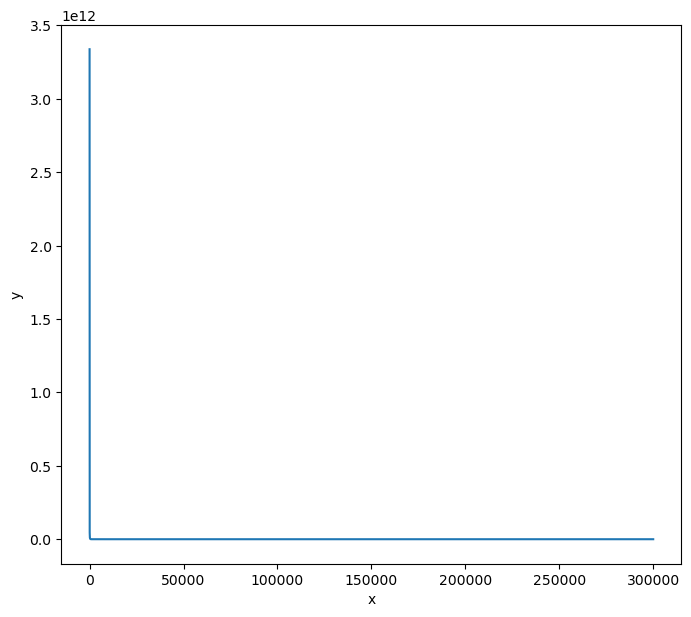

[ 2.56361558e+06  1.48999182e+02 -1.68266742e+01  7.08891180e+04
  5.23878253e+04  6.91404985e+01  2.61000074e+03  2.89252943e+00
  2.04349802e+00  2.60868340e+04  4.87848780e+02  2.29514549e+01
  1.18322294e+03  3.05953012e+01  2.04838943e+00  4.43070040e+03
  1.39613361e+02  5.22030279e+00  9.92658534e+02  1.69776488e+02
  4.15993600e+01 -2.57427575e-02 -1.00576121e-01 -1.27528489e-02
  1.66100103e-01  1.95659366e-01 -1.06794073e+01 -9.83083889e-02
  4.48201821e-01 -5.49714859e-02  1.49197180e-02 -4.06891832e-02
 -3.65507204e+01  7.48664477e-01 -2.22365432e-02 -8.93173587e-03
  7.63511948e-01  3.11109060e-01  2.71378812e+00 -1.25903591e-01
  3.10513044e+01  1.24627820e+00 -4.28166198e+01  3.26886438e+01
  1.52779622e+00  2.88786582e-01 -1.00384683e-01  4.42164470e-01
  4.07785567e+00  3.36206662e+00  3.08513058e-01  1.34215539e+00
  1.09919863e+00  6.50857713e-02  4.42164470e-01]


In [20]:
fig,ax2 = plt.subplots(1,1,figsize = (8,7))
ax2.plot(J_history[:300000])
ax2.set_ylabel('y')
ax2.set_xlabel('x')
ax2.legend
plt.show()
print(w)
w1 = w
b1 = b

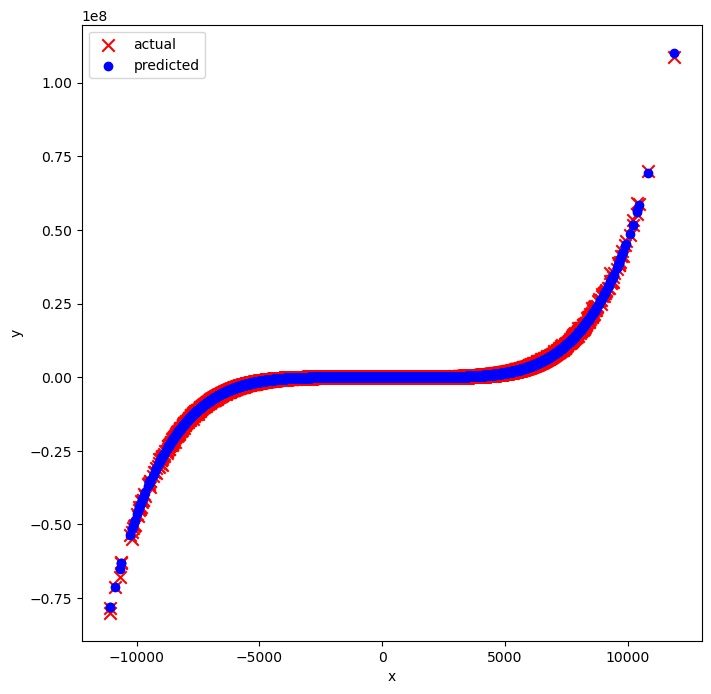

(50000,)
(55,)


In [19]:
a = dataset.iloc[:,1:2].values
b = dataset.iloc[:,2:3].values
c = dataset.iloc[:,3:4].values
a = a.flatten()
b = b.flatten()
c = c.flatten()
w_1 = np.array([w[0]])
y = dataset.iloc[:,4:5].values
y = y.flatten()
fig,ax3 = plt.subplots(1,1,figsize = (8,8))
ax3.scatter(a,y,marker = 'x',s = 80,c='red',label='actual')
t = np.c_[a**5]
t = zscore(t)
ax3.scatter(a,t@w_1 + b,c = 'blue',label='predicted')
ax3.set_ylabel('y')
ax3.set_xlabel('x')
ax3.legend()
plt.show()
b1 = b
w1 = w
print(b1.shape)
print(w.shape)

In [24]:
test = pd.read_csv("polynomial_test_data.csv")

In [26]:
a1 = test.iloc[:,1:2].values
a1 = a1.flatten()
b1 = test.iloc[:,2:3].values
b1 = b1.flatten()
c1 = test.iloc[:,3:4].values
c1 = c1.flatten()
x_test = data_to_polynomial(a1,b1,c1)
x_test = zscore(x)

In [22]:
r2 = R2_score(x_train,y,w1,b1)

In [23]:
print(r2)

0.9999999999999623


In [28]:
y_output = predict(x_test,w1,b1)

In [29]:
print(y_output)

[ -12497.46537425  198208.62701763   -8416.56574822 ...  -12013.60283902
  -12834.26082044 -106149.74055436]
